In [2]:
import pickle
import numpy as np
from scipy import sparse
import pandas as pd
import seaborn as sns
sns.set() ## set up style
import uuid
import time
import matplotlib.pyplot as plt
#solved chinese display in matplotlib
from matplotlib import rcParams
rcParams['font.family'] = 'sans-serif'
# rcParams["font.family"] = "DFKai-SB"
rcParams['axes.unicode_minus'] = False
from tqdm import tqdm_notebook,tnrange
# from tqdm.autonotebook import tqdm
# tqdm.pandas()

import torch
import visdom
vis=visdom.Visdom()
from BuildDataset import Tripletdataset
from Model import Encoder,Decoder,EncoderOneLayer,DecoderOneLayer
industry=['金融業', 'IC製造', 'IC設計', '電子零件元件', '電腦系統業', '石油及天然氣', '手機', '面板業', '太陽能',
       '板鋼', '被動元件', '車輛整車', '非鐵金屬', '流通業', '地產', '通訊設備', '遊戲產業', '印刷電路板相關',
       '貴金屬', '機械', '運輸事業', '電子通路', 'IC封裝測試', 'LED', '通訊服務', '消費性電子產品', '化學工業',
       '醫藥產業', '軟體業', '週邊產品', '石化業', '旅館、餐飲', '汽機車零組件', '設備儀器廠商', '條鋼', '造紙業',
       '水泥', '橡膠工業', '傳產其他', '數位相機', '顯示器', '不鏽鋼', '農林漁牧', '服務業', 'Internet相關',
       '營造工程', '休閒娛樂', '紡織中游', '生物科技', '家電', '光碟片', '建材', '成衣', '電力', '運動產業',
       '線材、盤元', '化纖原料', '其他公用事業', '大宗物資', '家居用品', '手機零組件', '食品加工', '電力設備',
       '航天軍工', '分離式元件', '電子其他', '面板零組件', '飲料相關', '電線電纜', '封測服務與材料', '礦石開採',
       '光通訊', '傳播事業', '輔助與彌補用醫材', '時尚產業', '基礎建設營運', '電聲產品', '水資源', '醫療器材通路',
       '合金鋼', '文化創意產業', '車用金屬成型', '穿戴式裝置', '其他醫療器材', '汽車內裝', '車用電子',
       '診斷與監測用醫材', '傳輸介面', '電子化工材料', '電池材料相關', '資產股', '醫療管理服務', '體外診斷用醫材', '煤',
       '射頻前端晶片', '控股公司', '無店舖販售', '手術與治療用醫材', '金屬礦採選', '生物辨識相關']

In [3]:
## Load industry dictionary
with open("../dict_guid_sparsebow_20000_single.v05.p","rb") as f:
    dict_guid_sparsebow_single= pickle.load(f)
with open("../dict_singleindustry_guid.p","rb") as f:
    dict_singleindustry_guid= pickle.load(f)

In [6]:
## Industry with news more than 100 pics
industry_partial=['金融業', 'IC製造', 'IC設計', '電子零件元件', '電腦系統業', '石油及天然氣', '手機', '面板業', '太陽能',
       '板鋼', '被動元件', '車輛整車', '非鐵金屬', '流通業', '地產', '通訊設備', '遊戲產業', '印刷電路板相關',
       '貴金屬', '機械', '運輸事業', '電子通路', 'IC封裝測試', 'LED', '通訊服務', '消費性電子產品', '化學工業',
       '醫藥產業', '軟體業', '週邊產品', '石化業', '旅館、餐飲', '汽機車零組件', '設備儀器廠商', '條鋼', '造紙業',
       '水泥', '橡膠工業', '傳產其他', '數位相機', '顯示器', '不鏽鋼', '農林漁牧', '服務業', 'Internet相關',
       '營造工程', '休閒娛樂', '紡織中游', '生物科技', '家電', '光碟片', '建材', '成衣', '電力', '運動產業',
       '線材、盤元', '化纖原料', '其他公用事業', '大宗物資', '家居用品', '手機零組件', '食品加工', '電力設備',
       '航天軍工', '分離式元件', '電子其他', '面板零組件', '飲料相關', '電線電纜', '封測服務與材料', '礦石開採',
       '光通訊', '傳播事業', '輔助與彌補用醫材', '時尚產業', '基礎建設營運', '電聲產品', '水資源', '醫療器材通路',
       '合金鋼']

In [7]:
len(industry_partial)

80

#### Configuration for split dataset to triain and test

In [8]:
Split=8/18
Split_train_test=8/10

#### Sample part of Dataset

In [9]:
dict_split_industry_guid={ ind:np.random.choice(dict_singleindustry_guid[ind],
                                                     size=int(Split*len(dict_singleindustry_guid[ind])),
                                                     replace=False) for ind in industry_partial}

In [10]:
dict_train_industry_guid={ind:dict_split_industry_guid[ind][:int(Split_train_test*len(dict_split_industry_guid[ind]))]
                          for ind in dict_split_industry_guid}
dict_test_industry_guid={ind:dict_split_industry_guid[ind][int(Split_train_test*len(dict_split_industry_guid[ind])):]
                          for ind in dict_split_industry_guid}

In [11]:
dict_str_list=dict_split_industry_guid
analysis={i:len(dict_str_list[i]) for i in dict_str_list }
analysis=pd.Series(analysis)
analysis.sort_values(ascending=False)

金融業         9444
IC製造        4450
IC設計        4249
電子零件元件      3909
電腦系統業       3043
石油及天然氣      2880
手機          2852
面板業         2572
太陽能         2425
板鋼          2208
被動元件        2190
車輛整車        2175
非鐵金屬        2149
流通業         2053
地產          1856
通訊設備        1824
遊戲產業        1788
印刷電路板相關     1732
貴金屬         1565
機械          1437
運輸事業        1436
電子通路        1344
IC封裝測試      1207
LED         1064
通訊服務        1063
消費性電子產品      943
化學工業         931
醫藥產業         894
週邊產品         892
軟體業          892
            ... 
光碟片          304
建材           263
成衣           260
電力           249
運動產業         243
線材、盤元        241
化纖原料         234
其他公用事業       224
大宗物資         220
家居用品         210
手機零組件        185
食品加工         172
電力設備         164
航天軍工         156
分離式元件        153
電子其他         144
面板零組件        136
飲料相關         124
電線電纜         121
封測服務與材料      120
礦石開採         104
光通訊           84
傳播事業          81
輔助與彌補用醫材      80
時尚產業          80
基礎建設營運        72
電聲產品          69
水資源           

In [12]:
dict_str_list=dict_train_industry_guid
analysis={i:len(dict_str_list[i]) for i in dict_str_list }
analysis=pd.Series(analysis)
analysis.sort_values(ascending=False)

金融業         7555
IC製造        3560
IC設計        3399
電子零件元件      3127
電腦系統業       2434
石油及天然氣      2304
手機          2281
面板業         2057
太陽能         1940
板鋼          1766
被動元件        1752
車輛整車        1740
非鐵金屬        1719
流通業         1642
地產          1484
通訊設備        1459
遊戲產業        1430
印刷電路板相關     1385
貴金屬         1252
機械          1149
運輸事業        1148
電子通路        1075
IC封裝測試       965
LED          851
通訊服務         850
消費性電子產品      754
化學工業         744
醫藥產業         715
週邊產品         713
軟體業          713
            ... 
光碟片          243
建材           210
成衣           208
電力           199
運動產業         194
線材、盤元        192
化纖原料         187
其他公用事業       179
大宗物資         176
家居用品         168
手機零組件        148
食品加工         137
電力設備         131
航天軍工         124
分離式元件        122
電子其他         115
面板零組件        108
飲料相關          99
電線電纜          96
封測服務與材料       96
礦石開採          83
光通訊           67
傳播事業          64
輔助與彌補用醫材      64
時尚產業          64
基礎建設營運        57
電聲產品          55
水資源           

In [13]:
dict_str_list=dict_test_industry_guid
analysis={i:len(dict_str_list[i]) for i in dict_str_list }
analysis=pd.Series(analysis)
analysis.sort_values(ascending=False)

金融業         1889
IC製造         890
IC設計         850
電子零件元件       782
電腦系統業        609
石油及天然氣       576
手機           571
面板業          515
太陽能          485
板鋼           442
被動元件         438
車輛整車         435
非鐵金屬         430
流通業          411
地產           372
通訊設備         365
遊戲產業         358
印刷電路板相關      347
貴金屬          313
機械           288
運輸事業         288
電子通路         269
IC封裝測試       242
LED          213
通訊服務         213
消費性電子產品      189
化學工業         187
軟體業          179
週邊產品         179
醫藥產業         179
            ... 
光碟片           61
建材            53
成衣            52
電力            50
運動產業          49
線材、盤元         49
化纖原料          47
其他公用事業        45
大宗物資          44
家居用品          42
手機零組件         37
食品加工          35
電力設備          33
航天軍工          32
分離式元件         31
電子其他          29
面板零組件         28
電線電纜          25
飲料相關          25
封測服務與材料       24
礦石開採          21
光通訊           17
傳播事業          17
輔助與彌補用醫材      16
時尚產業          16
基礎建設營運        15
水資源           14
電聲產品          

#### Configure to train

In [19]:
Epochs=11500
P=3
K=6
PK=P*K
inputDim=20000
repzDim=100
alpha=2
PK*(K-1)*(PK-K)

1080

#### Model & Dataset Instantiation

In [20]:
dataset=Tripletdataset(industry_partial,
                       dict_train_industry_guid,
                       dict_guid_sparsebow_single,
                       P=P,K=K,
                      )
testset=Tripletdataset(industry_partial,
                       dict_test_industry_guid,
                       dict_guid_sparsebow_single,
                       P=P,K=K,
                      )
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
modelEncoder = EncoderOneLayer(inputDim,repzDim).to(device)
modelEncoder.eval()
modelDecoder = DecoderOneLayer(repzDim,inputDim).to(device)
modelEncoder.eval()
def criterionTri(h0,h1,h2,reduction="mean"):
    h01=(h0*h1).sum(dim=1)
    h02=(h0*h2).sum(dim=1)
    Lt=torch.log(1+torch.exp(h02-h01))
    if reduction=="mean":
        return Lt.mean()
    if reduction=="none": assert False,"this function not yet" 
        
criterionRC=torch.nn.BCELoss(reduction="mean") ## There is one called BCEWithLogitsLoss 
# optimizerSgd=torch.optim.SGD([{"params":modelEncoder.parameters()},
#                            {"params":modelDecoder.parameters()},
#                            ],
#                           lr=0.001,
#                             )
optimizer=torch.optim.Adam([{"params":modelEncoder.parameters()},
                           {"params":modelDecoder.parameters()},
                           ])

In [21]:
def opts(**kwords):
    opts={"markers":True,"xlabel":"epochs","title":"Total Loss","width":1200,"heigh":300,"xtickmax":100}
    for k in kwords:
        opts[k]=kwords[k]
    return opts

#### Train

In [ ]:
trainingloss={"loss":[],"lossRA":[],"lossRP":[],"lossRN":[],"lossT":[]}
testloss={"loss":[],"lossRA":[],"lossRP":[],"lossRN":[],"lossT":[]}
s_total=time.time()
for ep in tnrange(Epochs):
    ep+=1
    dataset.shuffle()
    for i, (batchData,batchTest) in enumerate(zip(dataset,testset)):
        
        s=time.time()
        
        optimizer.zero_grad()
        
        s_prepare=time.time()
        
        ## array int8 to float 32
        batchAnchor=batchData["batch_anchor"].astype(np.float32) 
        batchPositive=batchData["batch_positive"].astype(np.float32)
        batchNegative=batchData["batch_negative"].astype(np.float32)
        ## array  to tensor float 32
        batchAnchorTensor=torch.tensor(batchAnchor,dtype=torch.float32,device=device)
        batchPositiveTensor=torch.tensor(batchPositive,dtype=torch.float32,device=device)
        batchNegativeTensor=torch.tensor(batchNegative,dtype=torch.float32,device=device)
        
        e_prepare=time.time()
        
        s_inference=time.time()
        ## Inference
        #### encoding
        anchorRepz=modelEncoder(batchAnchorTensor)
        positiceRepz=modelEncoder(batchPositiveTensor)
        negativeRepz=modelEncoder(batchNegativeTensor)
        #### decoding
        anchorRc=modelDecoder(anchorRepz)
        positiveRc=modelDecoder(positiceRepz)
        negativeRc=modelDecoder(negativeRepz)
        
        lossRA=criterionRC(anchorRc,batchAnchorTensor)
        lossRP=criterionRC(positiveRc,batchPositiveTensor)
        lossRN=criterionRC(negativeRc,batchNegativeTensor)
        
        lossT=criterionTri(anchorRepz,positiceRepz,negativeRepz,reduction="mean")
        
        loss=lossRA+lossRP+lossRN+alpha*lossT
        
        e_inference=time.time()
        
        s_backward=time.time()
        ## backward
        loss.backward()
        e_backward=time.time()
        ## update
        optimizer.step()

        ## record
        with torch.no_grad():
            trainingloss["loss"].append(loss.item())
            trainingloss["lossRA"].append(lossRA.item())
            trainingloss["lossRP"].append(lossRP.item())
            trainingloss["lossRN"].append(lossRN.item())
            trainingloss["lossT"].append(lossT.item())
            print("-------------------------------")
            print("epoch :",ep,"/",Epochs,",","batch:",i,"/",len(dataset))
            print("loss  :",loss.item())
            print("lossRA:",lossRA.item(),",","lossRP:",lossRP.item(),",","lossRN:",lossRN.item())
            print("lossT :",lossT.item())
        e=time.time()
        print("Batch-Time:",np.round(e-s,2),"s")
        print("Batch-PreTime",np.round(e_prepare-s_prepare,2),"s")
        print("Batch-InfTime:",np.round(e_inference-s_inference,2),"s")
        print("Batch-BackTime:",np.round(e_backward-s_backward,2),"s")
        
#         break
    ## Teset Inference
    with torch.no_grad():
        ## array int8 to float 32
        batchAnchor=batchTest["batch_anchor"].astype(np.float32) 
        batchPositive=batchTest["batch_positive"].astype(np.float32)
        batchNegative=batchTest["batch_negative"].astype(np.float32)
        ## array  to tensor float 32
        batchAnchorTensor=torch.tensor(batchAnchor,dtype=torch.float32,device=device)
        batchPositiveTensor=torch.tensor(batchPositive,dtype=torch.float32,device=device)
        batchNegativeTensor=torch.tensor(batchNegative,dtype=torch.float32,device=device)
        ## Inference
        #### encoding
        anchorRepz=modelEncoder(batchAnchorTensor)
        positiceRepz=modelEncoder(batchPositiveTensor)
        negativeRepz=modelEncoder(batchNegativeTensor)
        #### decoding
        anchorRc=modelDecoder(anchorRepz)
        positiveRc=modelDecoder(positiceRepz)
        negativeRc=modelDecoder(negativeRepz)
        #### loss
        lossRA_test=criterionRC(anchorRc,batchAnchorTensor)
        lossRP_test=criterionRC(positiveRc,batchPositiveTensor)
        lossRN_test=criterionRC(negativeRc,batchNegativeTensor)
        lossT_test=criterionTri(anchorRepz,positiceRepz,negativeRepz,reduction="mean")
        loss_test=lossRA_test+lossRP_test+lossRN_test+alpha*lossT_test
    ##plot 
    win="train loss "
    vis.line(Y=[loss.item()]  ,X=[ep],win=win,update="append",opts=opts(title=win))
    win="train lossT"
    vis.line(Y=[lossT.item()] ,X=[ep],win=win,update="append",opts=opts(title=win))
    win="train lossRA"
    vis.line(Y=[lossRA.item()],X=[ep],win=win,update="append",opts=opts(title=win))
    win="train lossRP"
    vis.line(Y=[lossRP.item()],X=[ep],win=win,update="append",opts=opts(title=win))
    win="train lossRN"
    vis.line(Y=[lossRN.item()],X=[ep],win=win,update="append",opts=opts(title=win))
    win="test loss "
    vis.line(Y=[loss.item()]  ,X=[ep],win=win,update="append",opts=opts(title=win))
    win="test lossT"
    vis.line(Y=[lossT.item()] ,X=[ep],win=win,update="append",opts=opts(title=win))
    win="test lossRA"
    vis.line(Y=[lossRA.item()],X=[ep],win=win,update="append",opts=opts(title=win))
    win="test lossRP"
    vis.line(Y=[lossRP.item()],X=[ep],win=win,update="append",opts=opts(title=win))
    win="test lossRN"
    vis.line(Y=[lossRN.item()],X=[ep],win=win,update="append",opts=opts(title=win))  
    
e_total=time.time()
print("Time:",np.round(e_total-s_total,2),"s")

-------------------------------
epoch : 1 / 11500 , batch: 0 / 26
loss  : 3.467236042022705
lossRA: 0.6936911344528198 , lossRP: 0.6936911344528198 , lossRN: 0.6936911940574646
lossT : 0.6930813193321228
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1 / 11500 , batch: 1 / 26
loss  : 3.4654440879821777
lossRA: 0.6931473612785339 , lossRP: 0.6931473612785339 , lossRN: 0.6931474208831787
lossT : 0.6930010914802551
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1 / 11500 , batch: 2 / 26
loss  : 3.4637389183044434
lossRA: 0.6925566792488098 , lossRP: 0.6925567388534546 , lossRN: 0.6925566792488098
lossT : 0.6930344104766846
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1 / 11500 , batch: 3 / 26
loss  : 3.4618144035339355
lossRA: 0.6919692158699036 , lossRP: 0.69

-------------------------------
epoch : 2 / 11500 , batch: 4 / 26
loss  : 3.2236948013305664
lossRA: 0.5726056694984436 , lossRP: 0.5726056694984436 , lossRN: 0.5726056098937988
lossT : 0.7529388666152954
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2 / 11500 , batch: 5 / 26
loss  : 3.189241409301758
lossRA: 0.5782467722892761 , lossRP: 0.5782468318939209 , lossRN: 0.5782467722892761
lossT : 0.7272505164146423
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2 / 11500 , batch: 6 / 26
loss  : 3.133540153503418
lossRA: 0.5562396049499512 , lossRP: 0.5562396049499512 , lossRN: 0.5562396049499512
lossT : 0.732410728931427
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2 / 11500 , batch: 7 / 26
loss  : 3.101090669631958
lossRA: 0.5704911351203918 , lossRP: 0.57049

-------------------------------
epoch : 3 / 11500 , batch: 8 / 26
loss  : 2.8074913024902344
lossRA: 0.3752584755420685 , lossRP: 0.37525850534439087 , lossRN: 0.3752584755420685
lossT : 0.840857982635498
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3 / 11500 , batch: 9 / 26
loss  : 2.758145332336426
lossRA: 0.3562294542789459 , lossRP: 0.35622942447662354 , lossRN: 0.35622939467430115
lossT : 0.8447284698486328
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3 / 11500 , batch: 10 / 26
loss  : 2.551204204559326
lossRA: 0.34598007798194885 , lossRP: 0.34598007798194885 , lossRN: 0.34598010778427124
lossT : 0.7566320300102234
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3 / 11500 , batch: 11 / 26
loss  : 2.4953436851501465
lossRA: 0.37825846672058105 , lossR

-------------------------------
epoch : 4 / 11500 , batch: 12 / 26
loss  : 2.2424774169921875
lossRA: 0.26912805438041687 , lossRP: 0.26912805438041687 , lossRN: 0.26912805438041687
lossT : 0.7175467014312744
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 4 / 11500 , batch: 13 / 26
loss  : 2.310304880142212
lossRA: 0.27309948205947876 , lossRP: 0.27309945225715637 , lossRN: 0.27309948205947876
lossT : 0.7455032467842102
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 4 / 11500 , batch: 14 / 26
loss  : 2.2137813568115234
lossRA: 0.24899789690971375 , lossRP: 0.24899786710739136 , lossRN: 0.24899786710739136
lossT : 0.7333938479423523
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 4 / 11500 , batch: 15 / 26
loss  : 2.3279905319213867
lossRA: 0.30192434787750244 ,

-------------------------------
epoch : 5 / 11500 , batch: 16 / 26
loss  : 1.8619720935821533
lossRA: 0.20982347428798676 , lossRP: 0.20982347428798676 , lossRN: 0.20982347428798676
lossT : 0.6162508130073547
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 5 / 11500 , batch: 17 / 26
loss  : 2.0389695167541504
lossRA: 0.16369681060314178 , lossRP: 0.16369681060314178 , lossRN: 0.16369681060314178
lossT : 0.7739396095275879
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 5 / 11500 , batch: 18 / 26
loss  : 1.8326526880264282
lossRA: 0.1496882140636444 , lossRP: 0.1496882140636444 , lossRN: 0.1496882140636444
lossT : 0.6917940378189087
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 5 / 11500 , batch: 19 / 26
loss  : 2.0299298763275146
lossRA: 0.21081280708312988 , l

-------------------------------
epoch : 6 / 11500 , batch: 20 / 26
loss  : 1.4420406818389893
lossRA: 0.14951789379119873 , lossRP: 0.14951787889003754 , lossRN: 0.14951787889003754
lossT : 0.4967435300350189
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 6 / 11500 , batch: 21 / 26
loss  : 1.6032581329345703
lossRA: 0.1384778767824173 , lossRP: 0.1384778767824173 , lossRN: 0.1384778767824173
lossT : 0.5939122438430786
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 6 / 11500 , batch: 22 / 26
loss  : 1.851945161819458
lossRA: 0.12938226759433746 , lossRP: 0.12938226759433746 , lossRN: 0.12938226759433746
lossT : 0.7318991422653198
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 6 / 11500 , batch: 23 / 26
loss  : 1.657499074935913
lossRA: 0.16502545773983002 , lo

-------------------------------
epoch : 7 / 11500 , batch: 24 / 26
loss  : 1.999124526977539
lossRA: 0.1507287621498108 , lossRP: 0.1507287621498108 , lossRN: 0.1507287621498108
lossT : 0.7734691500663757
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 7 / 11500 , batch: 25 / 26
loss  : 1.8077181577682495
lossRA: 0.12882836163043976 , lossRP: 0.12882836163043976 , lossRN: 0.12882834672927856
lossT : 0.7106165289878845
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 8 / 11500 , batch: 0 / 26
loss  : 1.4473066329956055
lossRA: 0.129282608628273 , lossRP: 0.129282608628273 , lossRN: 0.129282608628273
lossT : 0.529729425907135
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 8 / 11500 , batch: 1 / 26
loss  : 2.0639965534210205
lossRA: 0.13503310084342957 , lossRP: 0.

-------------------------------
epoch : 9 / 11500 , batch: 2 / 26
loss  : 1.942812442779541
lossRA: 0.10307538509368896 , lossRP: 0.10307537019252777 , lossRN: 0.10307539254426956
lossT : 0.8167931437492371
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 9 / 11500 , batch: 3 / 26
loss  : 1.545236349105835
lossRA: 0.1260284036397934 , lossRP: 0.1260284036397934 , lossRN: 0.1260284036397934
lossT : 0.5835756063461304
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 9 / 11500 , batch: 4 / 26
loss  : 1.350987195968628
lossRA: 0.0918300598859787 , lossRP: 0.0918300598859787 , lossRN: 0.0918300673365593
lossT : 0.5377485156059265
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 9 / 11500 , batch: 5 / 26
loss  : 0.9505133628845215
lossRA: 0.1161724403500557 , lossRP: 0.1

-------------------------------
epoch : 10 / 11500 , batch: 6 / 26
loss  : 1.6250452995300293
lossRA: 0.10368208587169647 , lossRP: 0.10368208587169647 , lossRN: 0.10368207097053528
lossT : 0.6569995284080505
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 10 / 11500 , batch: 7 / 26
loss  : 1.270656704902649
lossRA: 0.12030091136693954 , lossRP: 0.12030092626810074 , lossRN: 0.12030091136693954
lossT : 0.45487695932388306
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 10 / 11500 , batch: 8 / 26
loss  : 1.3771157264709473
lossRA: 0.10327456146478653 , lossRP: 0.10327456146478653 , lossRN: 0.10327456146478653
lossT : 0.5336460471153259
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 10 / 11500 , batch: 9 / 26
loss  : 1.2887072563171387
lossRA: 0.09384115785360336

-------------------------------
epoch : 11 / 11500 , batch: 8 / 26
loss  : 1.226009488105774
lossRA: 0.09998390078544617 , lossRP: 0.09998390078544617 , lossRN: 0.09998390078544617
lossT : 0.4630289077758789
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 11 / 11500 , batch: 9 / 26
loss  : 1.2631884813308716
lossRA: 0.08096678555011749 , lossRP: 0.08096678555011749 , lossRN: 0.08096678555011749
lossT : 0.510144054889679
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 11 / 11500 , batch: 10 / 26
loss  : 1.1744297742843628
lossRA: 0.08166880905628204 , lossRP: 0.08166880905628204 , lossRN: 0.08166881650686264
lossT : 0.46471166610717773
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 11 / 11500 , batch: 11 / 26
loss  : 1.7245250940322876
lossRA: 0.0769440308213234

-------------------------------
epoch : 12 / 11500 , batch: 10 / 26
loss  : 1.7981722354888916
lossRA: 0.069802425801754 , lossRP: 0.069802425801754 , lossRN: 0.069802425801754
lossT : 0.7943825125694275
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 12 / 11500 , batch: 11 / 26
loss  : 0.9977160692214966
lossRA: 0.09005927294492722 , lossRP: 0.09005927294492722 , lossRN: 0.09005927294492722
lossT : 0.36376914381980896
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 12 / 11500 , batch: 12 / 26
loss  : 1.1789138317108154
lossRA: 0.06939247995615005 , lossRP: 0.06939247995615005 , lossRN: 0.06939247250556946
lossT : 0.4853682219982147
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 12 / 11500 , batch: 13 / 26
loss  : 1.2632261514663696
lossRA: 0.08554515242576599 

-------------------------------
epoch : 13 / 11500 , batch: 12 / 26
loss  : 1.627769947052002
lossRA: 0.07652789354324341 , lossRP: 0.07652789354324341 , lossRN: 0.076527900993824
lossT : 0.6990931630134583
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 13 / 11500 , batch: 13 / 26
loss  : 1.8697576522827148
lossRA: 0.07506436109542847 , lossRP: 0.07506436109542847 , lossRN: 0.07506436109542847
lossT : 0.8222822546958923
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 13 / 11500 , batch: 14 / 26
loss  : 0.9538406729698181
lossRA: 0.07191739231348038 , lossRP: 0.07191739231348038 , lossRN: 0.07191739231348038
lossT : 0.3690442442893982
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 13 / 11500 , batch: 15 / 26
loss  : 1.4493132829666138
lossRA: 0.06754709035158157

-------------------------------
epoch : 14 / 11500 , batch: 14 / 26
loss  : 1.6652191877365112
lossRA: 0.06677770614624023 , lossRP: 0.06677770614624023 , lossRN: 0.06677770614624023
lossT : 0.7324430346488953
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 14 / 11500 , batch: 15 / 26
loss  : 1.5579535961151123
lossRA: 0.06118811294436455 , lossRP: 0.06118811294436455 , lossRN: 0.06118811294436455
lossT : 0.6871946454048157
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 14 / 11500 , batch: 16 / 26
loss  : 0.895200252532959
lossRA: 0.057508617639541626 , lossRP: 0.05750861018896103 , lossRN: 0.057508621364831924
lossT : 0.36133721470832825
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 14 / 11500 , batch: 17 / 26
loss  : 1.698006510734558
lossRA: 0.0757195949554

-------------------------------
epoch : 15 / 11500 , batch: 16 / 26
loss  : 1.3466204404830933
lossRA: 0.0701223686337471 , lossRP: 0.0701223760843277 , lossRN: 0.0701223760843277
lossT : 0.5681266784667969
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 15 / 11500 , batch: 17 / 26
loss  : 0.5384588241577148
lossRA: 0.08050309866666794 , lossRP: 0.08050310611724854 , lossRN: 0.08050310611724854
lossT : 0.1484747678041458
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 15 / 11500 , batch: 18 / 26
loss  : 1.5121984481811523
lossRA: 0.06621500104665756 , lossRP: 0.06621500104665756 , lossRN: 0.06621500104665756
lossT : 0.6567767262458801
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 15 / 11500 , batch: 19 / 26
loss  : 1.4574189186096191
lossRA: 0.0720967501401901

-------------------------------
epoch : 16 / 11500 , batch: 18 / 26
loss  : 1.749688982963562
lossRA: 0.06693065166473389 , lossRP: 0.06693065166473389 , lossRN: 0.06693065166473389
lossT : 0.7744485139846802
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 16 / 11500 , batch: 19 / 26
loss  : 1.0631829500198364
lossRA: 0.06549416482448578 , lossRP: 0.06549417227506638 , lossRN: 0.06549417227506638
lossT : 0.43335020542144775
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 16 / 11500 , batch: 20 / 26
loss  : 1.218424916267395
lossRA: 0.07164923846721649 , lossRP: 0.07164923846721649 , lossRN: 0.07164923846721649
lossT : 0.5017386078834534
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 16 / 11500 , batch: 21 / 26
loss  : 1.7418380975723267
lossRA: 0.08257083594799

-------------------------------
epoch : 17 / 11500 , batch: 20 / 26
loss  : 1.0977108478546143
lossRA: 0.062139686197042465 , lossRP: 0.06213969364762306 , lossRN: 0.06213969364762306
lossT : 0.45564591884613037
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 17 / 11500 , batch: 21 / 26
loss  : 1.0356236696243286
lossRA: 0.08648993074893951 , lossRP: 0.08648993074893951 , lossRN: 0.08648993074893951
lossT : 0.38807693123817444
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 17 / 11500 , batch: 22 / 26
loss  : 0.8876754641532898
lossRA: 0.07096672058105469 , lossRP: 0.07096672058105469 , lossRN: 0.07096671313047409
lossT : 0.33738765120506287
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 17 / 11500 , batch: 23 / 26
loss  : 1.0469377040863037
lossRA: 0.054715808

-------------------------------
epoch : 18 / 11500 , batch: 22 / 26
loss  : 1.3528547286987305
lossRA: 0.08152514696121216 , lossRP: 0.08152514696121216 , lossRN: 0.08152514696121216
lossT : 0.5541396141052246
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 18 / 11500 , batch: 23 / 26
loss  : 0.9750853180885315
lossRA: 0.05294039472937584 , lossRP: 0.05294039472937584 , lossRN: 0.05294039472937584
lossT : 0.40813207626342773
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 18 / 11500 , batch: 24 / 26
loss  : 1.2973394393920898
lossRA: 0.07052985578775406 , lossRP: 0.07052986323833466 , lossRN: 0.07052985578775406
lossT : 0.5428749322891235
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 18 / 11500 , batch: 25 / 26
loss  : 1.421633243560791
lossRA: 0.0568727552890

-------------------------------
epoch : 19 / 11500 , batch: 24 / 26
loss  : 0.8197060227394104
lossRA: 0.048620715737342834 , lossRP: 0.048620715737342834 , lossRN: 0.048620715737342834
lossT : 0.33692193031311035
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 19 / 11500 , batch: 25 / 26
loss  : 0.8121751546859741
lossRA: 0.04530169814825058 , lossRP: 0.04530170187354088 , lossRN: 0.04530170187354088
lossT : 0.3381350338459015
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 20 / 11500 , batch: 0 / 26
loss  : 1.8120545148849487
lossRA: 0.07168147712945938 , lossRP: 0.07168146967887878 , lossRN: 0.07168146967887878
lossT : 0.7985050678253174
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 20 / 11500 , batch: 1 / 26
loss  : 0.8472690582275391
lossRA: 0.067392610013

-------------------------------
epoch : 21 / 11500 , batch: 0 / 26
loss  : 1.8783620595932007
lossRA: 0.06394495069980621 , lossRP: 0.06394495069980621 , lossRN: 0.06394495069980621
lossT : 0.8432636260986328
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 21 / 11500 , batch: 1 / 26
loss  : 1.886978268623352
lossRA: 0.07508967816829681 , lossRP: 0.07508967816829681 , lossRN: 0.07508967816829681
lossT : 0.830854594707489
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 21 / 11500 , batch: 2 / 26
loss  : 1.541226863861084
lossRA: 0.04302796721458435 , lossRP: 0.04302796348929405 , lossRN: 0.04302796348929405
lossT : 0.7060714960098267
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 21 / 11500 , batch: 3 / 26
loss  : 0.9998883008956909
lossRA: 0.054201170802116394 ,

-------------------------------
epoch : 22 / 11500 , batch: 2 / 26
loss  : 1.610814094543457
lossRA: 0.03784159943461418 , lossRP: 0.03784159943461418 , lossRN: 0.03784159943461418
lossT : 0.7486446499824524
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 22 / 11500 , batch: 3 / 26
loss  : 0.7323907613754272
lossRA: 0.04939878359436989 , lossRP: 0.04939877986907959 , lossRN: 0.04939877986907959
lossT : 0.29209721088409424
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 22 / 11500 , batch: 4 / 26
loss  : 1.260697603225708
lossRA: 0.047522760927677155 , lossRP: 0.047522760927677155 , lossRN: 0.047522760927677155
lossT : 0.5590646266937256
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 22 / 11500 , batch: 5 / 26
loss  : 1.6797453165054321
lossRA: 0.046567622572183

-------------------------------
epoch : 23 / 11500 , batch: 4 / 26
loss  : 0.965560793876648
lossRA: 0.044049810618162155 , lossRP: 0.044049810618162155 , lossRN: 0.044049810618162155
lossT : 0.4167056679725647
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 23 / 11500 , batch: 5 / 26
loss  : 1.4324965476989746
lossRA: 0.05480549857020378 , lossRP: 0.05480549857020378 , lossRN: 0.054805491119623184
lossT : 0.6340400576591492
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 23 / 11500 , batch: 6 / 26
loss  : 0.9872316122055054
lossRA: 0.053265802562236786 , lossRP: 0.053265802562236786 , lossRN: 0.053265802562236786
lossT : 0.4137170910835266
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 23 / 11500 , batch: 7 / 26
loss  : 1.151320219039917
lossRA: 0.049825496971

-------------------------------
epoch : 24 / 11500 , batch: 6 / 26
loss  : 1.3530981540679932
lossRA: 0.03823889419436455 , lossRP: 0.038238897919654846 , lossRN: 0.03823889419436455
lossT : 0.6191907525062561
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 24 / 11500 , batch: 7 / 26
loss  : 1.0954246520996094
lossRA: 0.039666708558797836 , lossRP: 0.03966670483350754 , lossRN: 0.03966670483350754
lossT : 0.4882122874259949
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 24 / 11500 , batch: 8 / 26
loss  : 0.5399012565612793
lossRA: 0.04169502854347229 , lossRP: 0.04169502854347229 , lossRN: 0.04169503226876259
lossT : 0.2074080854654312
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 24 / 11500 , batch: 9 / 26
loss  : 1.7427722215652466
lossRA: 0.058287270367145

-------------------------------
epoch : 25 / 11500 , batch: 8 / 26
loss  : 1.0247979164123535
lossRA: 0.04653894528746605 , lossRP: 0.04653894528746605 , lossRN: 0.04653894156217575
lossT : 0.44259053468704224
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 25 / 11500 , batch: 9 / 26
loss  : 0.9050267338752747
lossRA: 0.07177543640136719 , lossRP: 0.07177544385194778 , lossRN: 0.07177543640136719
lossT : 0.34485021233558655
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 25 / 11500 , batch: 10 / 26
loss  : 1.3087408542633057
lossRA: 0.0391249842941761 , lossRP: 0.0391249842941761 , lossRN: 0.0391249842941761
lossT : 0.5956829190254211
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 25 / 11500 , batch: 11 / 26
loss  : 0.47049689292907715
lossRA: 0.049423404037952

-------------------------------
epoch : 26 / 11500 , batch: 10 / 26
loss  : 1.425912857055664
lossRA: 0.03897053748369217 , lossRP: 0.03897054120898247 , lossRN: 0.03897053748369217
lossT : 0.6545006036758423
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 26 / 11500 , batch: 11 / 26
loss  : 0.9809350371360779
lossRA: 0.06268741190433502 , lossRP: 0.06268741935491562 , lossRN: 0.06268741935491562
lossT : 0.3964363932609558
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 26 / 11500 , batch: 12 / 26
loss  : 0.8298062086105347
lossRA: 0.051343005150556564 , lossRP: 0.051343005150556564 , lossRN: 0.051343005150556564
lossT : 0.33788859844207764
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 26 / 11500 , batch: 13 / 26
loss  : 0.5954126119613647
lossRA: 0.0474969483

-------------------------------
epoch : 27 / 11500 , batch: 12 / 26
loss  : 1.0903877019882202
lossRA: 0.05626041814684868 , lossRP: 0.05626041814684868 , lossRN: 0.05626042187213898
lossT : 0.46080321073532104
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 27 / 11500 , batch: 13 / 26
loss  : 0.9414574503898621
lossRA: 0.03741786628961563 , lossRP: 0.03741786628961563 , lossRN: 0.03741786628961563
lossT : 0.4146019220352173
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 27 / 11500 , batch: 14 / 26
loss  : 0.8121441006660461
lossRA: 0.05519304797053337 , lossRP: 0.05519304424524307 , lossRN: 0.05519304797053337
lossT : 0.32328248023986816
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 27 / 11500 , batch: 15 / 26
loss  : 0.6969150900840759
lossRA: 0.061453618109

-------------------------------
epoch : 28 / 11500 , batch: 14 / 26
loss  : 0.932833194732666
lossRA: 0.052904486656188965 , lossRP: 0.052904486656188965 , lossRN: 0.052904486656188965
lossT : 0.38705986738204956
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 28 / 11500 , batch: 15 / 26
loss  : 0.9528961181640625
lossRA: 0.0498938262462616 , lossRP: 0.049893829971551895 , lossRN: 0.0498938262462616
lossT : 0.40160730481147766
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 28 / 11500 , batch: 16 / 26
loss  : 0.9460830092430115
lossRA: 0.05197291076183319 , lossRP: 0.05197291076183319 , lossRN: 0.05197291076183319
lossT : 0.39508214592933655
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 28 / 11500 , batch: 17 / 26
loss  : 0.5750486850738525
lossRA: 0.0481921993

-------------------------------
epoch : 29 / 11500 , batch: 16 / 26
loss  : 1.3840466737747192
lossRA: 0.03582337498664856 , lossRP: 0.03582337498664856 , lossRN: 0.03582337498664856
lossT : 0.6382882595062256
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 29 / 11500 , batch: 17 / 26
loss  : 0.8084638118743896
lossRA: 0.0416969433426857 , lossRP: 0.0416969433426857 , lossRN: 0.0416969433426857
lossT : 0.341686487197876
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 29 / 11500 , batch: 18 / 26
loss  : 1.1353570222854614
lossRA: 0.03439619392156601 , lossRP: 0.03439619392156601 , lossRN: 0.03439619392156601
lossT : 0.5160841941833496
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 29 / 11500 , batch: 19 / 26
loss  : 1.096462607383728
lossRA: 0.0324542373418808 ,

-------------------------------
epoch : 30 / 11500 , batch: 18 / 26
loss  : 0.8781791925430298
lossRA: 0.04445122554898262 , lossRP: 0.04445122554898262 , lossRN: 0.04445122554898262
lossT : 0.3724127411842346
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 30 / 11500 , batch: 19 / 26
loss  : 1.2405779361724854
lossRA: 0.034406594932079315 , lossRP: 0.034406598657369614 , lossRN: 0.034406594932079315
lossT : 0.5686790943145752
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 30 / 11500 , batch: 20 / 26
loss  : 1.6599922180175781
lossRA: 0.033521607518196106 , lossRP: 0.033521607518196106 , lossRN: 0.033521607518196106
lossT : 0.7797136902809143
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 30 / 11500 , batch: 21 / 26
loss  : 1.642735242843628
lossRA: 0.05264858

-------------------------------
epoch : 31 / 11500 , batch: 20 / 26
loss  : 0.6485826969146729
lossRA: 0.05109982192516327 , lossRP: 0.05109982192516327 , lossRN: 0.05109982192516327
lossT : 0.24764160811901093
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 31 / 11500 , batch: 21 / 26
loss  : 1.1983507871627808
lossRA: 0.034479767084121704 , lossRP: 0.034479767084121704 , lossRN: 0.034479767084121704
lossT : 0.5474557280540466
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 31 / 11500 , batch: 22 / 26
loss  : 2.0030996799468994
lossRA: 0.04290339723229408 , lossRP: 0.04290340095758438 , lossRN: 0.04290339723229408
lossT : 0.9371947050094604
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 31 / 11500 , batch: 23 / 26
loss  : 0.626312255859375
lossRA: 0.0536777600

-------------------------------
epoch : 32 / 11500 , batch: 22 / 26
loss  : 0.7093575596809387
lossRA: 0.04719041287899017 , lossRP: 0.04719041660428047 , lossRN: 0.04719041287899017
lossT : 0.2838931679725647
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 32 / 11500 , batch: 23 / 26
loss  : 0.999588131904602
lossRA: 0.06193411350250244 , lossRP: 0.06193411350250244 , lossRN: 0.06193411350250244
lossT : 0.40689289569854736
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 32 / 11500 , batch: 24 / 26
loss  : 1.2476415634155273
lossRA: 0.04767649993300438 , lossRP: 0.04767649620771408 , lossRN: 0.04767649993300438
lossT : 0.552306056022644
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 32 / 11500 , batch: 25 / 26
loss  : 1.2782371044158936
lossRA: 0.041838508099317

-------------------------------
epoch : 33 / 11500 , batch: 24 / 26
loss  : 0.9328296184539795
lossRA: 0.051965661346912384 , lossRP: 0.051965661346912384 , lossRN: 0.051965661346912384
lossT : 0.3884662985801697
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 33 / 11500 , batch: 25 / 26
loss  : 1.0308475494384766
lossRA: 0.0327514223754406 , lossRP: 0.0327514223754406 , lossRN: 0.0327514223754406
lossT : 0.46629664301872253
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 34 / 11500 , batch: 0 / 26
loss  : 0.8577607870101929
lossRA: 0.03405962884426117 , lossRP: 0.03405963256955147 , lossRN: 0.03405963256955147
lossT : 0.3777909576892853
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 34 / 11500 , batch: 1 / 26
loss  : 0.6173582673072815
lossRA: 0.03385001793503

-------------------------------
epoch : 35 / 11500 , batch: 0 / 26
loss  : 1.534233570098877
lossRA: 0.044876690953969955 , lossRP: 0.044876690953969955 , lossRN: 0.044876690953969955
lossT : 0.6998017430305481
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 35 / 11500 , batch: 1 / 26
loss  : 0.9875186681747437
lossRA: 0.034919679164886475 , lossRP: 0.034919679164886475 , lossRN: 0.034919675439596176
lossT : 0.4413798153400421
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 35 / 11500 , batch: 2 / 26
loss  : 0.5819454789161682
lossRA: 0.03301404044032097 , lossRP: 0.03301404044032097 , lossRN: 0.03301404044032097
lossT : 0.2414516806602478
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 35 / 11500 , batch: 3 / 26
loss  : 0.7024247050285339
lossRA: 0.036171395331

-------------------------------
epoch : 36 / 11500 , batch: 2 / 26
loss  : 0.41926026344299316
lossRA: 0.032050758600234985 , lossRP: 0.032050758600234985 , lossRN: 0.03205075487494469
lossT : 0.1615539938211441
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 36 / 11500 , batch: 3 / 26
loss  : 1.3759279251098633
lossRA: 0.04261978715658188 , lossRP: 0.04261978715658188 , lossRN: 0.04261979088187218
lossT : 0.6240342855453491
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 36 / 11500 , batch: 4 / 26
loss  : 0.7500191330909729
lossRA: 0.03789941594004631 , lossRP: 0.03789941966533661 , lossRN: 0.03789941594004631
lossT : 0.31816044449806213
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 36 / 11500 , batch: 5 / 26
loss  : 0.6174851059913635
lossRA: 0.0509949959814

-------------------------------
epoch : 37 / 11500 , batch: 4 / 26
loss  : 0.5507193803787231
lossRA: 0.04602646455168724 , lossRP: 0.04602646455168724 , lossRN: 0.04602646827697754
lossT : 0.20632000267505646
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 37 / 11500 , batch: 5 / 26
loss  : 0.9842997789382935
lossRA: 0.032832562923431396 , lossRP: 0.0328325591981411 , lossRN: 0.0328325591981411
lossT : 0.44290104508399963
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 37 / 11500 , batch: 6 / 26
loss  : 0.6228814125061035
lossRA: 0.04519670829176903 , lossRP: 0.04519670084118843 , lossRN: 0.04519670084118843
lossT : 0.24364566802978516
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 37 / 11500 , batch: 7 / 26
loss  : 1.7893890142440796
lossRA: 0.033466462045907

-------------------------------
epoch : 38 / 11500 , batch: 6 / 26
loss  : 0.8814818859100342
lossRA: 0.035614822059869766 , lossRP: 0.035614822059869766 , lossRN: 0.035614822059869766
lossT : 0.3873187005519867
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 38 / 11500 , batch: 7 / 26
loss  : 1.1725900173187256
lossRA: 0.03876733407378197 , lossRP: 0.03876733407378197 , lossRN: 0.03876733407378197
lossT : 0.5281440019607544
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 38 / 11500 , batch: 8 / 26
loss  : 0.5114104747772217
lossRA: 0.04039907455444336 , lossRP: 0.04039907082915306 , lossRN: 0.04039907082915306
lossT : 0.195106640458107
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 38 / 11500 , batch: 9 / 26
loss  : 0.5551654696464539
lossRA: 0.0338682569563388

-------------------------------
epoch : 39 / 11500 , batch: 8 / 26
loss  : 0.7139776349067688
lossRA: 0.03100549429655075 , lossRP: 0.03100549429655075 , lossRN: 0.0310054924339056
lossT : 0.3104805648326874
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 39 / 11500 , batch: 9 / 26
loss  : 0.607023298740387
lossRA: 0.052522990852594376 , lossRP: 0.052522990852594376 , lossRN: 0.052522990852594376
lossT : 0.22472715377807617
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 39 / 11500 , batch: 10 / 26
loss  : 1.201675534248352
lossRA: 0.03932730481028557 , lossRP: 0.03932730853557587 , lossRN: 0.03932730853557587
lossT : 0.5418468117713928
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 39 / 11500 , batch: 11 / 26
loss  : 0.9073571562767029
lossRA: 0.034073274582624

-------------------------------
epoch : 40 / 11500 , batch: 10 / 26
loss  : 0.319019615650177
lossRA: 0.03515293821692467 , lossRP: 0.03515293821692467 , lossRN: 0.03515293821692467
lossT : 0.10678040981292725
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 40 / 11500 , batch: 11 / 26
loss  : 1.3056917190551758
lossRA: 0.039153117686510086 , lossRP: 0.039153117686510086 , lossRN: 0.039153117686510086
lossT : 0.5941162109375
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 40 / 11500 , batch: 12 / 26
loss  : 1.2070410251617432
lossRA: 0.038799773901700974 , lossRP: 0.038799770176410675 , lossRN: 0.038799773901700974
lossT : 0.5453208684921265
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 40 / 11500 , batch: 13 / 26
loss  : 0.5213170647621155
lossRA: 0.0350317619

-------------------------------
epoch : 41 / 11500 , batch: 12 / 26
loss  : 0.8698381185531616
lossRA: 0.05301472172141075 , lossRP: 0.05301472172141075 , lossRN: 0.05301472917199135
lossT : 0.35539695620536804
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 41 / 11500 , batch: 13 / 26
loss  : 0.4296517074108124
lossRA: 0.051080524921417236 , lossRP: 0.051080524921417236 , lossRN: 0.05108053237199783
lossT : 0.13820506632328033
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 41 / 11500 , batch: 14 / 26
loss  : 0.46004608273506165
lossRA: 0.02707057259976864 , lossRP: 0.02707057259976864 , lossRN: 0.027070576325058937
lossT : 0.18941718339920044
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 41 / 11500 , batch: 15 / 26
loss  : 0.874038577079773
lossRA: 0.04140666

-------------------------------
epoch : 42 / 11500 , batch: 14 / 26
loss  : 0.5479165315628052
lossRA: 0.03023899346590042 , lossRP: 0.03023899532854557 , lossRN: 0.03023899532854557
lossT : 0.22859977185726166
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 42 / 11500 , batch: 15 / 26
loss  : 0.8610265254974365
lossRA: 0.04686291515827179 , lossRP: 0.04686291515827179 , lossRN: 0.04686291515827179
lossT : 0.36021888256073
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 42 / 11500 , batch: 16 / 26
loss  : 0.5118951201438904
lossRA: 0.04456408694386482 , lossRP: 0.04456408694386482 , lossRN: 0.04456408694386482
lossT : 0.1891014277935028
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 42 / 11500 , batch: 17 / 26
loss  : 1.3026963472366333
lossRA: 0.03524672612547

-------------------------------
epoch : 43 / 11500 , batch: 16 / 26
loss  : 0.8209643959999084
lossRA: 0.033487893640995026 , lossRP: 0.033487893640995026 , lossRN: 0.033487893640995026
lossT : 0.3602503538131714
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 43 / 11500 , batch: 17 / 26
loss  : 0.9822387099266052
lossRA: 0.05260099470615387 , lossRP: 0.05260099470615387 , lossRN: 0.05260099470615387
lossT : 0.4122178554534912
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 43 / 11500 , batch: 18 / 26
loss  : 0.8410454988479614
lossRA: 0.035121213644742966 , lossRP: 0.035121213644742966 , lossRN: 0.035121213644742966
lossT : 0.3678409159183502
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 43 / 11500 , batch: 19 / 26
loss  : 0.5385395288467407
lossRA: 0.03066110

-------------------------------
epoch : 44 / 11500 , batch: 18 / 26
loss  : 0.7918276786804199
lossRA: 0.03624730929732323 , lossRP: 0.03624730184674263 , lossRN: 0.03624730929732323
lossT : 0.3415428698062897
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 44 / 11500 , batch: 19 / 26
loss  : 0.6079591512680054
lossRA: 0.031633760780096054 , lossRP: 0.03163376450538635 , lossRN: 0.031633760780096054
lossT : 0.25652894377708435
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 44 / 11500 , batch: 20 / 26
loss  : 0.2894148826599121
lossRA: 0.029766377061605453 , lossRP: 0.029766377061605453 , lossRN: 0.029766377061605453
lossT : 0.10005788505077362
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 44 / 11500 , batch: 21 / 26
loss  : 0.5193198919296265
lossRA: 0.037766

-------------------------------
epoch : 45 / 11500 , batch: 20 / 26
loss  : 1.4891819953918457
lossRA: 0.03846913203597069 , lossRP: 0.03846913203597069 , lossRN: 0.03846913203597069
lossT : 0.6868873238563538
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 45 / 11500 , batch: 21 / 26
loss  : 0.5404134392738342
lossRA: 0.03233688697218895 , lossRP: 0.03233688697218895 , lossRN: 0.03233688324689865
lossT : 0.22170138359069824
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 45 / 11500 , batch: 22 / 26
loss  : 1.0128329992294312
lossRA: 0.031213846057653427 , lossRP: 0.031213846057653427 , lossRN: 0.03121384233236313
lossT : 0.4595957398414612
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 45 / 11500 , batch: 23 / 26
loss  : 0.8800559639930725
lossRA: 0.0381005965

-------------------------------
epoch : 46 / 11500 , batch: 22 / 26
loss  : 0.620814323425293
lossRA: 0.03819115832448006 , lossRP: 0.03819115832448006 , lossRN: 0.03819115459918976
lossT : 0.25312042236328125
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 46 / 11500 , batch: 23 / 26
loss  : 0.6158909201622009
lossRA: 0.03425073251128197 , lossRP: 0.034250736236572266 , lossRN: 0.03425073251128197
lossT : 0.25656935572624207
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 46 / 11500 , batch: 24 / 26
loss  : 1.0149258375167847
lossRA: 0.030780881643295288 , lossRP: 0.030780881643295288 , lossRN: 0.03078087978065014
lossT : 0.4612915813922882
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 46 / 11500 , batch: 25 / 26
loss  : 0.3247978985309601
lossRA: 0.039508137

-------------------------------
epoch : 47 / 11500 , batch: 24 / 26
loss  : 0.9320740103721619
lossRA: 0.030186457559466362 , lossRP: 0.03018646128475666 , lossRN: 0.030186457559466362
lossT : 0.42075732350349426
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 47 / 11500 , batch: 25 / 26
loss  : 1.2659639120101929
lossRA: 0.033289436250925064 , lossRP: 0.03328942880034447 , lossRN: 0.033289432525634766
lossT : 0.5830478072166443
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 48 / 11500 , batch: 0 / 26
loss  : 0.6861680746078491
lossRA: 0.04287683218717575 , lossRP: 0.04287683591246605 , lossRN: 0.04287683218717575
lossT : 0.27876877784729004
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 48 / 11500 , batch: 1 / 26
loss  : 0.760781466960907
lossRA: 0.0345736145

-------------------------------
epoch : 49 / 11500 , batch: 0 / 26
loss  : 0.973860502243042
lossRA: 0.028075899928808212 , lossRP: 0.028075899928808212 , lossRN: 0.028075899928808212
lossT : 0.4448164105415344
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 49 / 11500 , batch: 1 / 26
loss  : 0.8893992900848389
lossRA: 0.03053397312760353 , lossRP: 0.03053397499024868 , lossRN: 0.03053397312760353
lossT : 0.3988986909389496
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 49 / 11500 , batch: 2 / 26
loss  : 1.3486924171447754
lossRA: 0.02879655919969082 , lossRP: 0.028796562924981117 , lossRN: 0.02879655919969082
lossT : 0.6311513781547546
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 49 / 11500 , batch: 3 / 26
loss  : 0.560513436794281
lossRA: 0.0385641679167747

-------------------------------
epoch : 50 / 11500 , batch: 2 / 26
loss  : 0.5036123394966125
lossRA: 0.046677689999341965 , lossRP: 0.046677686274051666 , lossRN: 0.046677686274051666
lossT : 0.18178963661193848
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 50 / 11500 , batch: 3 / 26
loss  : 0.6164961457252502
lossRA: 0.040834371000528336 , lossRP: 0.040834374725818634 , lossRN: 0.040834374725818634
lossT : 0.24699650704860687
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 50 / 11500 , batch: 4 / 26
loss  : 0.9723926186561584
lossRA: 0.02856939285993576 , lossRP: 0.02856939472258091 , lossRN: 0.02856939285993576
lossT : 0.4433422088623047
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 50 / 11500 , batch: 5 / 26
loss  : 1.019532322883606
lossRA: 0.0268103647

-------------------------------
epoch : 51 / 11500 , batch: 4 / 26
loss  : 0.7615047097206116
lossRA: 0.03747842460870743 , lossRP: 0.03747842460870743 , lossRN: 0.03747842460870743
lossT : 0.32453471422195435
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 51 / 11500 , batch: 5 / 26
loss  : 0.46908965706825256
lossRA: 0.034165699034929276 , lossRP: 0.034165699034929276 , lossRN: 0.034165699034929276
lossT : 0.18329627811908722
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 51 / 11500 , batch: 6 / 26
loss  : 1.7952600717544556
lossRA: 0.029283743351697922 , lossRP: 0.02928374707698822 , lossRN: 0.029283743351697922
lossT : 0.8537043929100037
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 51 / 11500 , batch: 7 / 26
loss  : 0.5296581983566284
lossRA: 0.038481682

-------------------------------
epoch : 52 / 11500 , batch: 6 / 26
loss  : 0.32003793120384216
lossRA: 0.041818760335445404 , lossRP: 0.041818760335445404 , lossRN: 0.041818756610155106
lossT : 0.09729082882404327
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 52 / 11500 , batch: 7 / 26
loss  : 1.0087859630584717
lossRA: 0.02731490135192871 , lossRP: 0.02731490135192871 , lossRN: 0.02731490135192871
lossT : 0.4634205996990204
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 52 / 11500 , batch: 8 / 26
loss  : 1.1061367988586426
lossRA: 0.03630221635103226 , lossRP: 0.03630221635103226 , lossRN: 0.03630221635103226
lossT : 0.4986150562763214
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 52 / 11500 , batch: 9 / 26
loss  : 0.9047300815582275
lossRA: 0.0328270867466

-------------------------------
epoch : 53 / 11500 , batch: 8 / 26
loss  : 0.6770598888397217
lossRA: 0.02930079773068428 , lossRP: 0.02930079773068428 , lossRN: 0.02930079773068428
lossT : 0.2945787310600281
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 53 / 11500 , batch: 9 / 26
loss  : 0.6485796570777893
lossRA: 0.029387380927801132 , lossRP: 0.029387379065155983 , lossRN: 0.029387379065155983
lossT : 0.2802087664604187
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 53 / 11500 , batch: 10 / 26
loss  : 0.42295563220977783
lossRA: 0.04100021347403526 , lossRP: 0.041000209748744965 , lossRN: 0.04100021347403526
lossT : 0.14997750520706177
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 53 / 11500 , batch: 11 / 26
loss  : 1.1572579145431519
lossRA: 0.033218514

-------------------------------
epoch : 54 / 11500 , batch: 10 / 26
loss  : 0.8114539980888367
lossRA: 0.036132920533418655 , lossRP: 0.03613291680812836 , lossRN: 0.036132924258708954
lossT : 0.3515276312828064
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 54 / 11500 , batch: 11 / 26
loss  : 0.3894893229007721
lossRA: 0.02970464900135994 , lossRP: 0.02970464900135994 , lossRN: 0.02970464713871479
lossT : 0.150187686085701
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 54 / 11500 , batch: 12 / 26
loss  : 0.5393686294555664
lossRA: 0.031941916793584824 , lossRP: 0.031941916793584824 , lossRN: 0.031941916793584824
lossT : 0.22177143394947052
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 54 / 11500 , batch: 13 / 26
loss  : 1.1293138265609741
lossRA: 0.02956631

-------------------------------
epoch : 55 / 11500 , batch: 12 / 26
loss  : 0.4873195290565491
lossRA: 0.040675658732652664 , lossRP: 0.040675658732652664 , lossRN: 0.040675658732652664
lossT : 0.1826462745666504
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 55 / 11500 , batch: 13 / 26
loss  : 0.9654071927070618
lossRA: 0.028416892513632774 , lossRP: 0.028416888788342476 , lossRN: 0.028416892513632774
lossT : 0.4400782585144043
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 55 / 11500 , batch: 14 / 26
loss  : 0.22773754596710205
lossRA: 0.033648453652858734 , lossRP: 0.033648453652858734 , lossRN: 0.033648453652858734
lossT : 0.06339608877897263
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 55 / 11500 , batch: 15 / 26
loss  : 1.1058350801467896
lossRA: 0.036

-------------------------------
epoch : 56 / 11500 , batch: 14 / 26
loss  : 1.0552246570587158
lossRA: 0.03194394335150719 , lossRP: 0.03194394335150719 , lossRN: 0.031943947076797485
lossT : 0.4796964228153229
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 56 / 11500 , batch: 15 / 26
loss  : 0.39664334058761597
lossRA: 0.030190512537956238 , lossRP: 0.030190512537956238 , lossRN: 0.03019050881266594
lossT : 0.15303590893745422
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 56 / 11500 , batch: 16 / 26
loss  : 0.5351163744926453
lossRA: 0.033807870000600815 , lossRP: 0.033807866275310516 , lossRN: 0.033807870000600815
lossT : 0.21684637665748596
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 56 / 11500 , batch: 17 / 26
loss  : 0.9703238010406494
lossRA: 0.0364

-------------------------------
epoch : 57 / 11500 , batch: 16 / 26
loss  : 0.37778133153915405
lossRA: 0.02698388509452343 , lossRP: 0.02698388509452343 , lossRN: 0.02698388323187828
lossT : 0.14841483533382416
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 57 / 11500 , batch: 17 / 26
loss  : 1.1858056783676147
lossRA: 0.028861360624432564 , lossRP: 0.028861360624432564 , lossRN: 0.028861360624432564
lossT : 0.5496107935905457
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 57 / 11500 , batch: 18 / 26
loss  : 0.3383305072784424
lossRA: 0.027760829776525497 , lossRP: 0.027760829776525497 , lossRN: 0.027760827913880348
lossT : 0.1275240033864975
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 57 / 11500 , batch: 19 / 26
loss  : 1.3731181621551514
lossRA: 0.03857

-------------------------------
epoch : 58 / 11500 , batch: 18 / 26
loss  : 0.4154391288757324
lossRA: 0.03068029135465622 , lossRP: 0.030680295079946518 , lossRN: 0.030680295079946518
lossT : 0.16169913113117218
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 58 / 11500 , batch: 19 / 26
loss  : 0.44401225447654724
lossRA: 0.02996167540550232 , lossRP: 0.02996167168021202 , lossRN: 0.02996167168021202
lossT : 0.17706361413002014
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 58 / 11500 , batch: 20 / 26
loss  : 0.7055850028991699
lossRA: 0.031199922785162926 , lossRP: 0.031199922785162926 , lossRN: 0.031199922785162926
lossT : 0.30599260330200195
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 58 / 11500 , batch: 21 / 26
loss  : 0.3941905200481415
lossRA: 0.0285

-------------------------------
epoch : 59 / 11500 , batch: 20 / 26
loss  : 0.5049288868904114
lossRA: 0.03039591945707798 , lossRP: 0.03039592318236828 , lossRN: 0.03039591945707798
lossT : 0.20687055587768555
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 59 / 11500 , batch: 21 / 26
loss  : 0.2487778663635254
lossRA: 0.03265770524740219 , lossRP: 0.03265770524740219 , lossRN: 0.03265770524740219
lossT : 0.07540237903594971
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 59 / 11500 , batch: 22 / 26
loss  : 0.662104606628418
lossRA: 0.03006734885275364 , lossRP: 0.03006734885275364 , lossRN: 0.03006734885275364
lossT : 0.28595128655433655
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 59 / 11500 , batch: 23 / 26
loss  : 0.838666558265686
lossRA: 0.0301940310746

-------------------------------
epoch : 60 / 11500 , batch: 22 / 26
loss  : 0.24700716137886047
lossRA: 0.03506723791360855 , lossRP: 0.03506723791360855 , lossRN: 0.03506723791360855
lossT : 0.07090272009372711
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 60 / 11500 , batch: 23 / 26
loss  : 1.3620429039001465
lossRA: 0.030099380761384964 , lossRP: 0.030099384486675262 , lossRN: 0.030099380761384964
lossT : 0.6358723640441895
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 60 / 11500 , batch: 24 / 26
loss  : 0.41560447216033936
lossRA: 0.034101128578186035 , lossRP: 0.034101128578186035 , lossRN: 0.034101128578186035
lossT : 0.15665054321289062
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 60 / 11500 , batch: 25 / 26
loss  : 1.0941529273986816
lossRA: 0.033

-------------------------------
epoch : 61 / 11500 , batch: 24 / 26
loss  : 0.38107138872146606
lossRA: 0.04146846756339073 , lossRP: 0.04146846383810043 , lossRN: 0.04146846383810043
lossT : 0.12833300232887268
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 61 / 11500 , batch: 25 / 26
loss  : 0.4530520439147949
lossRA: 0.04420337453484535 , lossRP: 0.04420337453484535 , lossRN: 0.04420337453484535
lossT : 0.16022096574306488
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 62 / 11500 , batch: 0 / 26
loss  : 0.5371455550193787
lossRA: 0.03495073691010475 , lossRP: 0.03495073691010475 , lossRN: 0.03495073691010475
lossT : 0.21614666283130646
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 62 / 11500 , batch: 1 / 26
loss  : 0.6116586923599243
lossRA: 0.023686299100

-------------------------------
epoch : 63 / 11500 , batch: 0 / 26
loss  : 1.1233195066452026
lossRA: 0.03302863612771034 , lossRP: 0.03302863612771034 , lossRN: 0.03302863612771034
lossT : 0.5121167898178101
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 63 / 11500 , batch: 1 / 26
loss  : 0.6909928917884827
lossRA: 0.03141961246728897 , lossRP: 0.03141961619257927 , lossRN: 0.03141961991786957
lossT : 0.2983670234680176
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 63 / 11500 , batch: 2 / 26
loss  : 0.6783676147460938
lossRA: 0.03663952276110649 , lossRP: 0.03663951903581619 , lossRN: 0.03663951903581619
lossT : 0.2842245399951935
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 63 / 11500 , batch: 3 / 26
loss  : 1.3905118703842163
lossRA: 0.03142530098557472

-------------------------------
epoch : 64 / 11500 , batch: 2 / 26
loss  : 0.779204249382019
lossRA: 0.023103535175323486 , lossRP: 0.023103538900613785 , lossRN: 0.023103537037968636
lossT : 0.3549468219280243
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 64 / 11500 , batch: 3 / 26
loss  : 0.7238972783088684
lossRA: 0.02846369706094265 , lossRP: 0.02846369706094265 , lossRN: 0.02846369706094265
lossT : 0.3192530870437622
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 64 / 11500 , batch: 4 / 26
loss  : 0.44844716787338257
lossRA: 0.02908475697040558 , lossRP: 0.02908475697040558 , lossRN: 0.02908475697040558
lossT : 0.1805964559316635
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 64 / 11500 , batch: 5 / 26
loss  : 1.1262105703353882
lossRA: 0.03025876358151

-------------------------------
epoch : 65 / 11500 , batch: 4 / 26
loss  : 0.5295544862747192
lossRA: 0.029710326343774796 , lossRP: 0.029710324481129646 , lossRN: 0.029710324481129646
lossT : 0.22021175920963287
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 65 / 11500 , batch: 5 / 26
loss  : 0.6758507490158081
lossRA: 0.02889743633568287 , lossRP: 0.02889743633568287 , lossRN: 0.02889743633568287
lossT : 0.2945792078971863
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 65 / 11500 , batch: 6 / 26
loss  : 0.3098304271697998
lossRA: 0.03705265000462532 , lossRP: 0.03705265372991562 , lossRN: 0.03705265372991562
lossT : 0.09933623671531677
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 65 / 11500 , batch: 7 / 26
loss  : 0.7053165435791016
lossRA: 0.024712394922

-------------------------------
epoch : 66 / 11500 , batch: 6 / 26
loss  : 0.6759971380233765
lossRA: 0.024456143379211426 , lossRP: 0.024456143379211426 , lossRN: 0.024456143379211426
lossT : 0.3013143539428711
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 66 / 11500 , batch: 7 / 26
loss  : 0.47318035364151
lossRA: 0.05602588132023811 , lossRP: 0.05602588132023811 , lossRN: 0.05602588132023811
lossT : 0.15255135297775269
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 66 / 11500 , batch: 8 / 26
loss  : 0.7238911986351013
lossRA: 0.022076943889260292 , lossRP: 0.022076943889260292 , lossRN: 0.02207694761455059
lossT : 0.32883018255233765
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 66 / 11500 , batch: 9 / 26
loss  : 0.5169473886489868
lossRA: 0.0303923152387

-------------------------------
epoch : 67 / 11500 , batch: 8 / 26
loss  : 0.5100439786911011
lossRA: 0.029176704585552216 , lossRP: 0.029176704585552216 , lossRN: 0.029176704585552216
lossT : 0.2112569361925125
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 67 / 11500 , batch: 9 / 26
loss  : 0.5935102105140686
lossRA: 0.03300752490758896 , lossRP: 0.03300752490758896 , lossRN: 0.03300752863287926
lossT : 0.24724380671977997
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 67 / 11500 , batch: 10 / 26
loss  : 0.6442003846168518
lossRA: 0.03286058455705643 , lossRP: 0.032860588282346725 , lossRN: 0.03286058455705643
lossT : 0.27280932664871216
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 67 / 11500 , batch: 11 / 26
loss  : 0.5152060985565186
lossRA: 0.030808562

-------------------------------
epoch : 68 / 11500 , batch: 10 / 26
loss  : 0.4897282123565674
lossRA: 0.036216724663972855 , lossRP: 0.03621671721339226 , lossRN: 0.036216720938682556
lossT : 0.19053903222084045
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 68 / 11500 , batch: 11 / 26
loss  : 0.7997251152992249
lossRA: 0.030514968559145927 , lossRP: 0.030514968559145927 , lossRN: 0.030514968559145927
lossT : 0.3540900945663452
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 68 / 11500 , batch: 12 / 26
loss  : 1.1660082340240479
lossRA: 0.033180058002471924 , lossRP: 0.033180054277181625 , lossRN: 0.033180054277181625
lossT : 0.5332340598106384
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 68 / 11500 , batch: 13 / 26
loss  : 0.4006890654563904
lossRA: 0.0537

-------------------------------
epoch : 69 / 11500 , batch: 12 / 26
loss  : 0.3304915428161621
lossRA: 0.03341108188033104 , lossRP: 0.03341108188033104 , lossRN: 0.03341108188033104
lossT : 0.11512915790081024
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 69 / 11500 , batch: 13 / 26
loss  : 1.7544870376586914
lossRA: 0.02947169542312622 , lossRP: 0.02947169542312622 , lossRN: 0.02947169542312622
lossT : 0.833035945892334
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 69 / 11500 , batch: 14 / 26
loss  : 0.7561383247375488
lossRA: 0.02930510975420475 , lossRP: 0.02930510975420475 , lossRN: 0.02930510975420475
lossT : 0.3341114819049835
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 69 / 11500 , batch: 15 / 26
loss  : 0.7021826505661011
lossRA: 0.02506031841039

-------------------------------
epoch : 70 / 11500 , batch: 14 / 26
loss  : 0.6782130599021912
lossRA: 0.030103182420134544 , lossRP: 0.030103186145424843 , lossRN: 0.030103182420134544
lossT : 0.29395174980163574
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 70 / 11500 , batch: 15 / 26
loss  : 0.5395180583000183
lossRA: 0.029924696311354637 , lossRP: 0.029924696311354637 , lossRN: 0.029924698173999786
lossT : 0.22487199306488037
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 70 / 11500 , batch: 16 / 26
loss  : 0.5949984788894653
lossRA: 0.02460629679262638 , lossRP: 0.02460629679262638 , lossRN: 0.02460629679262638
lossT : 0.2605898082256317
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 70 / 11500 , batch: 17 / 26
loss  : 0.658342182636261
lossRA: 0.032908

-------------------------------
epoch : 71 / 11500 , batch: 16 / 26
loss  : 0.6596124172210693
lossRA: 0.0290050208568573 , lossRP: 0.0290050208568573 , lossRN: 0.029005017131567
lossT : 0.2862986624240875
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 71 / 11500 , batch: 17 / 26
loss  : 0.24416273832321167
lossRA: 0.02863224782049656 , lossRP: 0.02863224595785141 , lossRN: 0.02863224595785141
lossT : 0.07913299649953842
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 71 / 11500 , batch: 18 / 26
loss  : 0.18799877166748047
lossRA: 0.03310750424861908 , lossRP: 0.03310750424861908 , lossRN: 0.03310750424861908
lossT : 0.044338125735521317
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 71 / 11500 , batch: 19 / 26
loss  : 0.43151238560676575
lossRA: 0.03455863520

-------------------------------
epoch : 72 / 11500 , batch: 18 / 26
loss  : 0.7710052728652954
lossRA: 0.026992516592144966 , lossRP: 0.026992516592144966 , lossRN: 0.026992516592144966
lossT : 0.3450138568878174
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 72 / 11500 , batch: 19 / 26
loss  : 0.8503986597061157
lossRA: 0.03260323032736778 , lossRP: 0.03260323032736778 , lossRN: 0.03260323032736778
lossT : 0.37629449367523193
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 72 / 11500 , batch: 20 / 26
loss  : 0.49842020869255066
lossRA: 0.03590529039502144 , lossRP: 0.03590529039502144 , lossRN: 0.03590529039502144
lossT : 0.19535216689109802
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 72 / 11500 , batch: 21 / 26
loss  : 0.3738284707069397
lossRA: 0.0266393

-------------------------------
epoch : 73 / 11500 , batch: 20 / 26
loss  : 0.8120722770690918
lossRA: 0.026639513671398163 , lossRP: 0.026639513671398163 , lossRN: 0.026639513671398163
lossT : 0.36607685685157776
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 73 / 11500 , batch: 21 / 26
loss  : 1.517135739326477
lossRA: 0.033957477658987045 , lossRP: 0.033957477658987045 , lossRN: 0.033957477658987045
lossT : 0.7076316475868225
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 73 / 11500 , batch: 22 / 26
loss  : 0.5996174812316895
lossRA: 0.03126448020339012 , lossRP: 0.03126448020339012 , lossRN: 0.03126448020339012
lossT : 0.2529120147228241
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 73 / 11500 , batch: 23 / 26
loss  : 0.47568458318710327
lossRA: 0.032710

-------------------------------
epoch : 74 / 11500 , batch: 22 / 26
loss  : 0.4250420928001404
lossRA: 0.031207088381052017 , lossRP: 0.031207088381052017 , lossRN: 0.031207088381052017
lossT : 0.1657104194164276
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 74 / 11500 , batch: 23 / 26
loss  : 0.3370945453643799
lossRA: 0.027518250048160553 , lossRP: 0.027518250048160553 , lossRN: 0.027518251910805702
lossT : 0.1272698938846588
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 74 / 11500 , batch: 24 / 26
loss  : 0.5838429927825928
lossRA: 0.02794635482132435 , lossRP: 0.02794635482132435 , lossRN: 0.02794635482132435
lossT : 0.2500019669532776
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 74 / 11500 , batch: 25 / 26
loss  : 1.0394530296325684
lossRA: 0.0229705

-------------------------------
epoch : 75 / 11500 , batch: 24 / 26
loss  : 0.9365458488464355
lossRA: 0.02920369990170002 , lossRP: 0.02920370362699032 , lossRN: 0.02920370362699032
lossT : 0.4244673550128937
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 75 / 11500 , batch: 25 / 26
loss  : 1.0688128471374512
lossRA: 0.036393970251083374 , lossRP: 0.03639397397637367 , lossRN: 0.03639397397637367
lossT : 0.4798154830932617
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 76 / 11500 , batch: 0 / 26
loss  : 0.36317169666290283
lossRA: 0.028491195291280746 , lossRP: 0.028491195291280746 , lossRN: 0.028491195291280746
lossT : 0.13884904980659485
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 76 / 11500 , batch: 1 / 26
loss  : 0.7823747992515564
lossRA: 0.031508129

-------------------------------
epoch : 77 / 11500 , batch: 0 / 26
loss  : 0.44258981943130493
lossRA: 0.024894792586565018 , lossRP: 0.024894792586565018 , lossRN: 0.024894794449210167
lossT : 0.1839527189731598
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 77 / 11500 , batch: 1 / 26
loss  : 0.3295094966888428
lossRA: 0.03079959563910961 , lossRP: 0.030799591913819313 , lossRN: 0.03079959563910961
lossT : 0.11855535209178925
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 77 / 11500 , batch: 2 / 26
loss  : 0.43924957513809204
lossRA: 0.03276946395635605 , lossRP: 0.03276946023106575 , lossRN: 0.03276946395635605
lossT : 0.17047059535980225
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 77 / 11500 , batch: 3 / 26
loss  : 0.7264245748519897
lossRA: 0.030948285

-------------------------------
epoch : 78 / 11500 , batch: 2 / 26
loss  : 0.3604789078235626
lossRA: 0.03207151219248772 , lossRP: 0.03207151219248772 , lossRN: 0.03207151219248772
lossT : 0.13213218748569489
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 78 / 11500 , batch: 3 / 26
loss  : 0.48262861371040344
lossRA: 0.031184447929263115 , lossRP: 0.031184447929263115 , lossRN: 0.031184444203972816
lossT : 0.19453763961791992
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 78 / 11500 , batch: 4 / 26
loss  : 0.492197722196579
lossRA: 0.023136936128139496 , lossRP: 0.023136936128139496 , lossRN: 0.023136934265494347
lossT : 0.21139346063137054
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 78 / 11500 , batch: 5 / 26
loss  : 0.8903883695602417
lossRA: 0.03904635

-------------------------------
epoch : 79 / 11500 , batch: 4 / 26
loss  : 0.8796118497848511
lossRA: 0.030344346538186073 , lossRP: 0.030344346538186073 , lossRN: 0.030344346538186073
lossT : 0.39428940415382385
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 79 / 11500 , batch: 5 / 26
loss  : 0.48680830001831055
lossRA: 0.03403373062610626 , lossRP: 0.034033726900815964 , lossRN: 0.034033726900815964
lossT : 0.19235356152057648
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 79 / 11500 , batch: 6 / 26
loss  : 0.8016118407249451
lossRA: 0.03334839269518852 , lossRP: 0.03334839642047882 , lossRN: 0.03334839642047882
lossT : 0.3507833182811737
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 79 / 11500 , batch: 7 / 26
loss  : 0.8844074010848999
lossRA: 0.0294061172

-------------------------------
epoch : 80 / 11500 , batch: 6 / 26
loss  : 0.5216888785362244
lossRA: 0.030383333563804626 , lossRP: 0.030383333563804626 , lossRN: 0.030383335426449776
lossT : 0.21526944637298584
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 80 / 11500 , batch: 7 / 26
loss  : 0.7745159268379211
lossRA: 0.03148217871785164 , lossRP: 0.03148217871785164 , lossRN: 0.03148217871785164
lossT : 0.34003469347953796
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 80 / 11500 , batch: 8 / 26
loss  : 0.36541885137557983
lossRA: 0.030812572687864304 , lossRP: 0.030812568962574005 , lossRN: 0.030812568962574005
lossT : 0.1364905685186386
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 80 / 11500 , batch: 9 / 26
loss  : 0.43396052718162537
lossRA: 0.0214091

-------------------------------
epoch : 81 / 11500 , batch: 8 / 26
loss  : 0.6530386209487915
lossRA: 0.031349312514066696 , lossRP: 0.031349312514066696 , lossRN: 0.031349312514066696
lossT : 0.27949532866477966
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 81 / 11500 , batch: 9 / 26
loss  : 0.34895414113998413
lossRA: 0.030147338286042213 , lossRP: 0.030147338286042213 , lossRN: 0.030147338286042213
lossT : 0.12925605475902557
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 81 / 11500 , batch: 10 / 26
loss  : 0.5279242396354675
lossRA: 0.028075315058231354 , lossRP: 0.028075315058231354 , lossRN: 0.028075315058231354
lossT : 0.22184914350509644
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 81 / 11500 , batch: 11 / 26
loss  : 0.903912365436554
lossRA: 0.028

-------------------------------
epoch : 82 / 11500 , batch: 10 / 26
loss  : 0.5211410522460938
lossRA: 0.030670534819364548 , lossRP: 0.030670534819364548 , lossRN: 0.030670534819364548
lossT : 0.2145647406578064
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 82 / 11500 , batch: 11 / 26
loss  : 0.9616549015045166
lossRA: 0.032273780554533005 , lossRP: 0.032273780554533005 , lossRN: 0.032273780554533005
lossT : 0.43241676688194275
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 82 / 11500 , batch: 12 / 26
loss  : 0.447622686624527
lossRA: 0.03658180311322212 , lossRP: 0.03658180311322212 , lossRN: 0.03658180683851242
lossT : 0.16893863677978516
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 82 / 11500 , batch: 13 / 26
loss  : 0.2372892200946808
lossRA: 0.026358

-------------------------------
epoch : 83 / 11500 , batch: 12 / 26
loss  : 0.14481261372566223
lossRA: 0.026290511712431908 , lossRP: 0.026290511712431908 , lossRN: 0.02629050984978676
lossT : 0.03297054395079613
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 83 / 11500 , batch: 13 / 26
loss  : 0.9479914903640747
lossRA: 0.02108750492334366 , lossRP: 0.02108750306069851 , lossRN: 0.02108750306069851
lossT : 0.44236448407173157
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 83 / 11500 , batch: 14 / 26
loss  : 0.7829716801643372
lossRA: 0.032227855175733566 , lossRP: 0.032227855175733566 , lossRN: 0.032227858901023865
lossT : 0.3431440591812134
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 83 / 11500 , batch: 15 / 26
loss  : 0.3631352484226227
lossRA: 0.03151

-------------------------------
epoch : 84 / 11500 , batch: 14 / 26
loss  : 0.5010511875152588
lossRA: 0.03253655508160591 , lossRP: 0.03253655508160591 , lossRN: 0.03253655508160591
lossT : 0.20172075927257538
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 84 / 11500 , batch: 15 / 26
loss  : 0.46700626611709595
lossRA: 0.03136120364069939 , lossRP: 0.031361207365989685 , lossRN: 0.03136120364069939
lossT : 0.18646131455898285
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 84 / 11500 , batch: 16 / 26
loss  : 0.47309231758117676
lossRA: 0.029745951294898987 , lossRP: 0.029745949432253838 , lossRN: 0.029745949432253838
lossT : 0.1919272392988205
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 84 / 11500 , batch: 17 / 26
loss  : 0.379034161567688
lossRA: 0.032646

-------------------------------
epoch : 85 / 11500 , batch: 16 / 26
loss  : 0.5565429925918579
lossRA: 0.028377648442983627 , lossRP: 0.02837764471769333 , lossRN: 0.02837764471769333
lossT : 0.23570501804351807
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 85 / 11500 , batch: 17 / 26
loss  : 0.7498915791511536
lossRA: 0.023725910112261772 , lossRP: 0.023725910112261772 , lossRN: 0.023725908249616623
lossT : 0.339356929063797
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 85 / 11500 , batch: 18 / 26
loss  : 0.5967389345169067
lossRA: 0.026883836835622787 , lossRP: 0.026883840560913086 , lossRN: 0.026883836835622787
lossT : 0.25804370641708374
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 85 / 11500 , batch: 19 / 26
loss  : 0.6291534900665283
lossRA: 0.030243

-------------------------------
epoch : 86 / 11500 , batch: 18 / 26
loss  : 1.0470722913742065
lossRA: 0.023715859279036522 , lossRP: 0.023715859279036522 , lossRN: 0.023715859279036522
lossT : 0.4879623353481293
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 86 / 11500 , batch: 19 / 26
loss  : 0.572169303894043
lossRA: 0.029313353821635246 , lossRP: 0.029313353821635246 , lossRN: 0.029313355684280396
lossT : 0.2421146184206009
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 86 / 11500 , batch: 20 / 26
loss  : 0.4957019090652466
lossRA: 0.03405938297510147 , lossRP: 0.03405937924981117 , lossRN: 0.03405937924981117
lossT : 0.1967618763446808
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 86 / 11500 , batch: 21 / 26
loss  : 1.0958237648010254
lossRA: 0.03330187

-------------------------------
epoch : 87 / 11500 , batch: 20 / 26
loss  : 1.7126010656356812
lossRA: 0.03298326954245567 , lossRP: 0.03298326954245567 , lossRN: 0.03298327326774597
lossT : 0.8068256378173828
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 87 / 11500 , batch: 21 / 26
loss  : 0.2644912004470825
lossRA: 0.02656414918601513 , lossRP: 0.02656414918601513 , lossRN: 0.026564152911305428
lossT : 0.09239938110113144
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 87 / 11500 , batch: 22 / 26
loss  : 0.6600455641746521
lossRA: 0.030329395085573196 , lossRP: 0.030329395085573196 , lossRN: 0.030329393222928047
lossT : 0.2845287024974823
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 87 / 11500 , batch: 23 / 26
loss  : 0.5079074501991272
lossRA: 0.03070945

-------------------------------
epoch : 88 / 11500 , batch: 22 / 26
loss  : 0.3755452036857605
lossRA: 0.0331604927778244 , lossRP: 0.0331604965031147 , lossRN: 0.0331604927778244
lossT : 0.13803185522556305
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 88 / 11500 , batch: 23 / 26
loss  : 0.7805289030075073
lossRA: 0.031376708298921585 , lossRP: 0.031376708298921585 , lossRN: 0.031376708298921585
lossT : 0.34319937229156494
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 88 / 11500 , batch: 24 / 26
loss  : 0.7989835143089294
lossRA: 0.03390050679445267 , lossRP: 0.03390050306916237 , lossRN: 0.03390050679445267
lossT : 0.3486410081386566
Batch-Time: 0.07 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 88 / 11500 , batch: 25 / 26
loss  : 0.24248149991035461
lossRA: 0.0280924830

-------------------------------
epoch : 89 / 11500 , batch: 24 / 26
loss  : 0.5829468965530396
lossRA: 0.02265172451734543 , lossRP: 0.02265172079205513 , lossRN: 0.02265172451734543
lossT : 0.2574958801269531
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 89 / 11500 , batch: 25 / 26
loss  : 0.6766504049301147
lossRA: 0.0290452279150486 , lossRP: 0.0290452279150486 , lossRN: 0.0290452279150486
lossT : 0.2947573661804199
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 90 / 11500 , batch: 0 / 26
loss  : 0.429082989692688
lossRA: 0.03492206707596779 , lossRP: 0.03492206707596779 , lossRN: 0.03492206335067749
lossT : 0.16215839982032776
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 90 / 11500 , batch: 1 / 26
loss  : 0.40145212411880493
lossRA: 0.02777678892016411

-------------------------------
epoch : 91 / 11500 , batch: 0 / 26
loss  : 0.8407989144325256
lossRA: 0.027117609977722168 , lossRP: 0.027117609977722168 , lossRN: 0.027117609977722168
lossT : 0.37972304224967957
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 91 / 11500 , batch: 1 / 26
loss  : 0.6840647459030151
lossRA: 0.03296622261404991 , lossRP: 0.03296622261404991 , lossRN: 0.03296622261404991
lossT : 0.29258304834365845
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 91 / 11500 , batch: 2 / 26
loss  : 0.6553282737731934
lossRA: 0.025548269972205162 , lossRP: 0.02554827183485031 , lossRN: 0.025548269972205162
lossT : 0.2893417179584503
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 91 / 11500 , batch: 3 / 26
loss  : 0.5164894461631775
lossRA: 0.0295019466

-------------------------------
epoch : 92 / 11500 , batch: 2 / 26
loss  : 0.41587531566619873
lossRA: 0.02613234892487526 , lossRP: 0.02613234892487526 , lossRN: 0.02613234892487526
lossT : 0.16873912513256073
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 92 / 11500 , batch: 3 / 26
loss  : 0.8827085494995117
lossRA: 0.027271965518593788 , lossRP: 0.027271967381238937 , lossRN: 0.027271965518593788
lossT : 0.4004463255405426
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 92 / 11500 , batch: 4 / 26
loss  : 0.8828776478767395
lossRA: 0.023853309452533722 , lossRP: 0.023853307589888573 , lossRN: 0.023853309452533722
lossT : 0.40565887093544006
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 92 / 11500 , batch: 5 / 26
loss  : 0.4905904233455658
lossRA: 0.02612782

-------------------------------
epoch : 93 / 11500 , batch: 4 / 26
loss  : 0.8527249097824097
lossRA: 0.040739305317401886 , lossRP: 0.040739309042692184 , lossRN: 0.040739309042692184
lossT : 0.3652535080909729
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 93 / 11500 , batch: 5 / 26
loss  : 0.3305445909500122
lossRA: 0.028794769197702408 , lossRP: 0.028794769197702408 , lossRN: 0.028794769197702408
lossT : 0.12208014726638794
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 93 / 11500 , batch: 6 / 26
loss  : 1.2359189987182617
lossRA: 0.02792186103761196 , lossRP: 0.027921857312321663 , lossRN: 0.02792186290025711
lossT : 0.5760766863822937
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 93 / 11500 , batch: 7 / 26
loss  : 1.052681803703308
lossRA: 0.0247998777

-------------------------------
epoch : 94 / 11500 , batch: 6 / 26
loss  : 0.3717373013496399
lossRA: 0.03292250260710716 , lossRP: 0.032922498881816864 , lossRN: 0.03292250260710716
lossT : 0.13648490607738495
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 94 / 11500 , batch: 7 / 26
loss  : 0.8535787463188171
lossRA: 0.024831470102071762 , lossRP: 0.024831470102071762 , lossRN: 0.024831470102071762
lossT : 0.3895421624183655
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 94 / 11500 , batch: 8 / 26
loss  : 1.06371009349823
lossRA: 0.022175181657075882 , lossRP: 0.022175179794430733 , lossRN: 0.022175181657075882
lossT : 0.4985922873020172
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 94 / 11500 , batch: 9 / 26
loss  : 1.0293902158737183
lossRA: 0.03073138371

-------------------------------
epoch : 95 / 11500 , batch: 8 / 26
loss  : 0.7034661173820496
lossRA: 0.0387144535779953 , lossRP: 0.038714449852705 , lossRN: 0.038714449852705
lossT : 0.2936613857746124
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 95 / 11500 , batch: 9 / 26
loss  : 0.47677117586135864
lossRA: 0.026931414380669594 , lossRP: 0.026931414380669594 , lossRN: 0.026931414380669594
lossT : 0.19798846542835236
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 95 / 11500 , batch: 10 / 26
loss  : 0.7188371419906616
lossRA: 0.026207033544778824 , lossRP: 0.026207031682133675 , lossRN: 0.026207033544778824
lossT : 0.320108026266098
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 95 / 11500 , batch: 11 / 26
loss  : 0.6937170028686523
lossRA: 0.0305724889039

-------------------------------
epoch : 96 / 11500 , batch: 10 / 26
loss  : 0.5208947658538818
lossRA: 0.024742137640714645 , lossRP: 0.024742137640714645 , lossRN: 0.024742137640714645
lossT : 0.2233341634273529
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 96 / 11500 , batch: 11 / 26
loss  : 1.043146014213562
lossRA: 0.027007251977920532 , lossRP: 0.027007251977920532 , lossRN: 0.027007248252630234
lossT : 0.4810621440410614
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 96 / 11500 , batch: 12 / 26
loss  : 0.8969520330429077
lossRA: 0.025329260155558586 , lossRP: 0.025329262018203735 , lossRN: 0.025329262018203735
lossT : 0.41048213839530945
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 96 / 11500 , batch: 13 / 26
loss  : 0.4932079017162323
lossRA: 0.0239

-------------------------------
epoch : 97 / 11500 , batch: 12 / 26
loss  : 0.4481733441352844
lossRA: 0.028605103492736816 , lossRP: 0.028605103492736816 , lossRN: 0.028605103492736816
lossT : 0.181179016828537
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 97 / 11500 , batch: 13 / 26
loss  : 0.5443267226219177
lossRA: 0.023006319999694824 , lossRP: 0.023006319999694824 , lossRN: 0.023006319999694824
lossT : 0.23765388131141663
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 97 / 11500 , batch: 14 / 26
loss  : 0.407362699508667
lossRA: 0.03326703608036041 , lossRP: 0.03326703608036041 , lossRN: 0.03326703980565071
lossT : 0.15378078818321228
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 97 / 11500 , batch: 15 / 26
loss  : 0.8013620972633362
lossRA: 0.02481895

-------------------------------
epoch : 98 / 11500 , batch: 14 / 26
loss  : 0.2433791160583496
lossRA: 0.032664425671100616 , lossRP: 0.032664425671100616 , lossRN: 0.032664425671100616
lossT : 0.07269291579723358
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 98 / 11500 , batch: 15 / 26
loss  : 0.24999909102916718
lossRA: 0.032157205045223236 , lossRP: 0.03215719759464264 , lossRN: 0.03215720131993294
lossT : 0.07676374167203903
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 98 / 11500 , batch: 16 / 26
loss  : 0.8526452779769897
lossRA: 0.025316307321190834 , lossRP: 0.025316311046481133 , lossRN: 0.025316311046481133
lossT : 0.38834816217422485
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 98 / 11500 , batch: 17 / 26
loss  : 0.7757747173309326
lossRA: 0.03

-------------------------------
epoch : 99 / 11500 , batch: 16 / 26
loss  : 0.4313943386077881
lossRA: 0.03185923770070076 , lossRP: 0.03185923770070076 , lossRN: 0.03185923770070076
lossT : 0.16790831089019775
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 99 / 11500 , batch: 17 / 26
loss  : 0.20915234088897705
lossRA: 0.028320908546447754 , lossRP: 0.028320908546447754 , lossRN: 0.028320908546447754
lossT : 0.062094807624816895
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 99 / 11500 , batch: 18 / 26
loss  : 0.3393586277961731
lossRA: 0.03141234070062637 , lossRP: 0.031412336975336075 , lossRN: 0.031412336975336075
lossT : 0.12256080657243729
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 99 / 11500 , batch: 19 / 26
loss  : 0.6055991649627686
lossRA: 0.0269

-------------------------------
epoch : 100 / 11500 , batch: 18 / 26
loss  : 0.41219693422317505
lossRA: 0.03279518708586693 , lossRP: 0.03279518708586693 , lossRN: 0.03279519081115723
lossT : 0.15690568089485168
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 100 / 11500 , batch: 19 / 26
loss  : 0.9569385647773743
lossRA: 0.035917628556489944 , lossRP: 0.035917624831199646 , lossRN: 0.035917624831199646
lossT : 0.42459285259246826
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 100 / 11500 , batch: 20 / 26
loss  : 1.0545240640640259
lossRA: 0.027401834726333618 , lossRP: 0.027401834726333618 , lossRN: 0.027401834726333618
lossT : 0.4861592948436737
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 100 / 11500 , batch: 21 / 26
loss  : 0.2781720757484436
lossRA: 0.

-------------------------------
epoch : 101 / 11500 , batch: 20 / 26
loss  : 0.7655876278877258
lossRA: 0.029836367815732956 , lossRP: 0.029836367815732956 , lossRN: 0.029836371541023254
lossT : 0.33803924918174744
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 101 / 11500 , batch: 21 / 26
loss  : 0.19064706563949585
lossRA: 0.024993082508444786 , lossRP: 0.024993082508444786 , lossRN: 0.024993084371089935
lossT : 0.05783390626311302
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 101 / 11500 , batch: 22 / 26
loss  : 0.6649056077003479
lossRA: 0.03133123368024826 , lossRP: 0.03133123368024826 , lossRN: 0.03133123368024826
lossT : 0.28545594215393066
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 101 / 11500 , batch: 23 / 26
loss  : 0.845848560333252
lossRA: 0.

-------------------------------
epoch : 102 / 11500 , batch: 22 / 26
loss  : 0.20551897585391998
lossRA: 0.031428273767232895 , lossRP: 0.031428273767232895 , lossRN: 0.031428273767232895
lossT : 0.0556170791387558
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 102 / 11500 , batch: 23 / 26
loss  : 0.46348243951797485
lossRA: 0.028243202716112137 , lossRP: 0.028243202716112137 , lossRN: 0.028243206441402435
lossT : 0.18937641382217407
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 102 / 11500 , batch: 24 / 26
loss  : 0.40677306056022644
lossRA: 0.029734112322330475 , lossRP: 0.029734112322330475 , lossRN: 0.029734112322330475
lossT : 0.1587853580713272
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 102 / 11500 , batch: 25 / 26
loss  : 1.5529634952545166
lossRA

-------------------------------
epoch : 103 / 11500 , batch: 24 / 26
loss  : 0.6139119863510132
lossRA: 0.02841794863343239 , lossRP: 0.02841794490814209 , lossRN: 0.02841794490814209
lossT : 0.26432907581329346
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 103 / 11500 , batch: 25 / 26
loss  : 0.4016498327255249
lossRA: 0.027640199288725853 , lossRP: 0.027640199288725853 , lossRN: 0.027640197426080704
lossT : 0.15936462581157684
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 104 / 11500 , batch: 0 / 26
loss  : 0.9983955025672913
lossRA: 0.031054992228746414 , lossRP: 0.031054994091391563 , lossRN: 0.031054994091391563
lossT : 0.45261526107788086
Batch-Time: 0.07 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 104 / 11500 , batch: 1 / 26
loss  : 0.16589927673339844
lossRA: 0.03

-------------------------------
epoch : 105 / 11500 , batch: 0 / 26
loss  : 0.679327666759491
lossRA: 0.035570643842220306 , lossRP: 0.03557064011693001 , lossRN: 0.035570643842220306
lossT : 0.2863078713417053
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 105 / 11500 , batch: 1 / 26
loss  : 1.1013710498809814
lossRA: 0.02856830134987831 , lossRP: 0.02856830507516861 , lossRN: 0.02856830134987831
lossT : 0.5078330636024475
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 105 / 11500 , batch: 2 / 26
loss  : 0.5157983899116516
lossRA: 0.02857355959713459 , lossRP: 0.02857355959713459 , lossRN: 0.02857355959713459
lossT : 0.21503886580467224
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 105 / 11500 , batch: 3 / 26
loss  : 1.4912704229354858
lossRA: 0.02415570244

-------------------------------
epoch : 106 / 11500 , batch: 2 / 26
loss  : 0.5272999405860901
lossRA: 0.027191227301955223 , lossRP: 0.027191227301955223 , lossRN: 0.027191227301955223
lossT : 0.2228631228208542
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 106 / 11500 , batch: 3 / 26
loss  : 0.33715635538101196
lossRA: 0.040141887962818146 , lossRP: 0.040141887962818146 , lossRN: 0.040141887962818146
lossT : 0.10836534947156906
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 106 / 11500 , batch: 4 / 26
loss  : 0.48768720030784607
lossRA: 0.03197001293301582 , lossRP: 0.03197001293301582 , lossRN: 0.03197001293301582
lossT : 0.19588857889175415
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 106 / 11500 , batch: 5 / 26
loss  : 0.674743115901947
lossRA: 0.0251

-------------------------------
epoch : 107 / 11500 , batch: 4 / 26
loss  : 0.8629401922225952
lossRA: 0.027303090319037437 , lossRP: 0.027303090319037437 , lossRN: 0.027303090319037437
lossT : 0.3905154764652252
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 107 / 11500 , batch: 5 / 26
loss  : 0.13582465052604675
lossRA: 0.03067418374121189 , lossRP: 0.03067418374121189 , lossRN: 0.03067418374121189
lossT : 0.021901048719882965
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 107 / 11500 , batch: 6 / 26
loss  : 0.34268444776535034
lossRA: 0.026099249720573425 , lossRP: 0.026099247857928276 , lossRN: 0.026099249720573425
lossT : 0.13219335675239563
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 107 / 11500 , batch: 7 / 26
loss  : 0.5749824643135071
lossRA: 0.02

-------------------------------
epoch : 108 / 11500 , batch: 6 / 26
loss  : 0.21655568480491638
lossRA: 0.025603167712688446 , lossRP: 0.025603167712688446 , lossRN: 0.025603167712688446
lossT : 0.06987308710813522
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 108 / 11500 , batch: 7 / 26
loss  : 0.11010102182626724
lossRA: 0.03185626119375229 , lossRP: 0.03185626119375229 , lossRN: 0.03185626119375229
lossT : 0.007266119588166475
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 108 / 11500 , batch: 8 / 26
loss  : 0.30923938751220703
lossRA: 0.025710662826895714 , lossRP: 0.025710662826895714 , lossRN: 0.025710659101605415
lossT : 0.11605370044708252
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 108 / 11500 , batch: 9 / 26
loss  : 0.2248384654521942
lossRA: 0.

-------------------------------
epoch : 109 / 11500 , batch: 8 / 26
loss  : 0.30400848388671875
lossRA: 0.027924563735723495 , lossRP: 0.027924565598368645 , lossRN: 0.027924565598368645
lossT : 0.11011739820241928
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 109 / 11500 , batch: 9 / 26
loss  : 1.0362465381622314
lossRA: 0.028109652921557426 , lossRP: 0.028109649196267128 , lossRN: 0.028109649196267128
lossT : 0.47595879435539246
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 109 / 11500 , batch: 10 / 26
loss  : 0.6699875593185425
lossRA: 0.02814367413520813 , lossRP: 0.02814367413520813 , lossRN: 0.02814367413520813
lossT : 0.29277828335762024
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 109 / 11500 , batch: 11 / 26
loss  : 0.8030036687850952
lossRA: 0.0

-------------------------------
epoch : 110 / 11500 , batch: 10 / 26
loss  : 0.1811586171388626
lossRA: 0.027146130800247192 , lossRP: 0.027146130800247192 , lossRN: 0.027146128937602043
lossT : 0.049860112369060516
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 110 / 11500 , batch: 11 / 26
loss  : 0.4120076596736908
lossRA: 0.023400453850626945 , lossRP: 0.023400453850626945 , lossRN: 0.023400453850626945
lossT : 0.17090314626693726
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 110 / 11500 , batch: 12 / 26
loss  : 0.4885205328464508
lossRA: 0.027407638728618622 , lossRP: 0.027407638728618622 , lossRN: 0.027407638728618622
lossT : 0.20314881205558777
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 110 / 11500 , batch: 13 / 26
loss  : 0.4804892838001251
lossRA:

-------------------------------
epoch : 111 / 11500 , batch: 12 / 26
loss  : 0.6269290447235107
lossRA: 0.027741406112909317 , lossRP: 0.027741406112909317 , lossRN: 0.027741406112909317
lossT : 0.27185240387916565
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 111 / 11500 , batch: 13 / 26
loss  : 0.7313904166221619
lossRA: 0.026663318276405334 , lossRP: 0.026663318276405334 , lossRN: 0.026663318276405334
lossT : 0.32570022344589233
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 111 / 11500 , batch: 14 / 26
loss  : 0.4741728603839874
lossRA: 0.030095191672444344 , lossRP: 0.030095191672444344 , lossRN: 0.030095191672444344
lossT : 0.19194364547729492
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 111 / 11500 , batch: 15 / 26
loss  : 0.3170475959777832
lossRA: 

-------------------------------
epoch : 112 / 11500 , batch: 14 / 26
loss  : 0.3401734232902527
lossRA: 0.02722618542611599 , lossRP: 0.02722618542611599 , lossRN: 0.02722618542611599
lossT : 0.12924742698669434
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 112 / 11500 , batch: 15 / 26
loss  : 0.5552271604537964
lossRA: 0.03112572245299816 , lossRP: 0.03112572245299816 , lossRN: 0.031125720590353012
lossT : 0.23092499375343323
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 112 / 11500 , batch: 16 / 26
loss  : 0.5693890452384949
lossRA: 0.02693229168653488 , lossRP: 0.026932287961244583 , lossRN: 0.02693229168653488
lossT : 0.2442960888147354
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 112 / 11500 , batch: 17 / 26
loss  : 0.48076725006103516
lossRA: 0.02614

-------------------------------
epoch : 113 / 11500 , batch: 16 / 26
loss  : 0.32145825028419495
lossRA: 0.02625308372080326 , lossRP: 0.02625308372080326 , lossRN: 0.02625308372080326
lossT : 0.12134949862957001
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 113 / 11500 , batch: 17 / 26
loss  : 0.7918514609336853
lossRA: 0.025692343711853027 , lossRP: 0.025692343711853027 , lossRN: 0.025692343711853027
lossT : 0.3573872148990631
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 113 / 11500 , batch: 18 / 26
loss  : 0.6094973683357239
lossRA: 0.031823668628931046 , lossRP: 0.031823668628931046 , lossRN: 0.031823668628931046
lossT : 0.2570131719112396
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 113 / 11500 , batch: 19 / 26
loss  : 0.21953707933425903
lossRA: 0.0

-------------------------------
epoch : 114 / 11500 , batch: 18 / 26
loss  : 0.4148677885532379
lossRA: 0.033217184245586395 , lossRP: 0.033217187970876694 , lossRN: 0.0332171805202961
lossT : 0.15760812163352966
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 114 / 11500 , batch: 19 / 26
loss  : 0.4307481050491333
lossRA: 0.028954273089766502 , lossRP: 0.028954273089766502 , lossRN: 0.028954273089766502
lossT : 0.17194263637065887
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 114 / 11500 , batch: 20 / 26
loss  : 0.7330679297447205
lossRA: 0.035075291991233826 , lossRP: 0.035075291991233826 , lossRN: 0.035075291991233826
lossT : 0.3139210343360901
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 114 / 11500 , batch: 21 / 26
loss  : 0.19713808596134186
lossRA: 0.

-------------------------------
epoch : 115 / 11500 , batch: 20 / 26
loss  : 0.15666194260120392
lossRA: 0.027104638516902924 , lossRP: 0.027104638516902924 , lossRN: 0.027104638516902924
lossT : 0.037674013525247574
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 115 / 11500 , batch: 21 / 26
loss  : 0.19369538128376007
lossRA: 0.026380332186818123 , lossRP: 0.026380332186818123 , lossRN: 0.026380332186818123
lossT : 0.057277191430330276
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 115 / 11500 , batch: 22 / 26
loss  : 0.18534937500953674
lossRA: 0.02928674779832363 , lossRP: 0.029286744073033333 , lossRN: 0.029286744073033333
lossT : 0.0487445667386055
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 115 / 11500 , batch: 23 / 26
loss  : 0.287700355052948
lossR

-------------------------------
epoch : 116 / 11500 , batch: 22 / 26
loss  : 0.3518325090408325
lossRA: 0.031042007729411125 , lossRP: 0.031042005866765976 , lossRN: 0.031042007729411125
lossT : 0.12935324013233185
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 116 / 11500 , batch: 23 / 26
loss  : 0.3041573166847229
lossRA: 0.023343946784734726 , lossRP: 0.023343948647379875 , lossRN: 0.023343944922089577
lossT : 0.11706273257732391
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 116 / 11500 , batch: 24 / 26
loss  : 0.7431803941726685
lossRA: 0.03299630805850029 , lossRP: 0.03299631178379059 , lossRN: 0.03299631178379059
lossT : 0.32209572196006775
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 116 / 11500 , batch: 25 / 26
loss  : 0.2794107496738434
lossRA: 0.

-------------------------------
epoch : 117 / 11500 , batch: 24 / 26
loss  : 0.60172438621521
lossRA: 0.024070721119642258 , lossRP: 0.024070721119642258 , lossRN: 0.024070721119642258
lossT : 0.26475611329078674
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 117 / 11500 , batch: 25 / 26
loss  : 1.0564022064208984
lossRA: 0.03390783816576004 , lossRP: 0.03390783816576004 , lossRN: 0.03390783816576004
lossT : 0.47733932733535767
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 118 / 11500 , batch: 0 / 26
loss  : 0.3021305203437805
lossRA: 0.024027569219470024 , lossRP: 0.024027569219470024 , lossRN: 0.024027572944760323
lossT : 0.1150239109992981
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 118 / 11500 , batch: 1 / 26
loss  : 0.8414742946624756
lossRA: 0.02395

-------------------------------
epoch : 119 / 11500 , batch: 0 / 26
loss  : 0.5441470146179199
lossRA: 0.022193044424057007 , lossRP: 0.022193046286702156 , lossRN: 0.022193046286702156
lossT : 0.23878394067287445
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 119 / 11500 , batch: 1 / 26
loss  : 0.526910126209259
lossRA: 0.03185270354151726 , lossRP: 0.03185270354151726 , lossRN: 0.03185270354151726
lossT : 0.21567600965499878
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 119 / 11500 , batch: 2 / 26
loss  : 0.24125340580940247
lossRA: 0.039557985961437225 , lossRP: 0.03955798223614693 , lossRN: 0.039557989686727524
lossT : 0.0612897165119648
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 119 / 11500 , batch: 3 / 26
loss  : 0.8675585389137268
lossRA: 0.0237491

-------------------------------
epoch : 120 / 11500 , batch: 2 / 26
loss  : 0.4630569815635681
lossRA: 0.026805127039551735 , lossRP: 0.026805127039551735 , lossRN: 0.026805130764842033
lossT : 0.19132079184055328
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 120 / 11500 , batch: 3 / 26
loss  : 0.316397488117218
lossRA: 0.022311264649033546 , lossRP: 0.022311266511678696 , lossRN: 0.022311266511678696
lossT : 0.12473183870315552
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 120 / 11500 , batch: 4 / 26
loss  : 0.4045678377151489
lossRA: 0.03436974063515663 , lossRP: 0.03436973690986633 , lossRN: 0.034369733184576035
lossT : 0.15072931349277496
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 120 / 11500 , batch: 5 / 26
loss  : 0.5062415599822998
lossRA: 0.0260

-------------------------------
epoch : 121 / 11500 , batch: 4 / 26
loss  : 0.3080078959465027
lossRA: 0.029137812554836273 , lossRP: 0.029137812554836273 , lossRN: 0.029137812554836273
lossT : 0.11029722541570663
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 121 / 11500 , batch: 5 / 26
loss  : 0.8554506301879883
lossRA: 0.030353685840964317 , lossRP: 0.030353691428899765 , lossRN: 0.030353689566254616
lossT : 0.38219478726387024
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 121 / 11500 , batch: 6 / 26
loss  : 0.7867980003356934
lossRA: 0.025957580655813217 , lossRP: 0.025957580655813217 , lossRN: 0.025957584381103516
lossT : 0.3544626235961914
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 121 / 11500 , batch: 7 / 26
loss  : 0.1245294138789177
lossRA: 0.03

-------------------------------
epoch : 122 / 11500 , batch: 6 / 26
loss  : 0.18541660904884338
lossRA: 0.025555647909641266 , lossRP: 0.025555647909641266 , lossRN: 0.025555651634931564
lossT : 0.054374825209379196
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 122 / 11500 , batch: 7 / 26
loss  : 0.15718567371368408
lossRA: 0.03281421959400177 , lossRP: 0.03281421586871147 , lossRN: 0.03281421586871147
lossT : 0.029371503740549088
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 122 / 11500 , batch: 8 / 26
loss  : 0.4510837197303772
lossRA: 0.02574269473552704 , lossRP: 0.02574269473552704 , lossRN: 0.02574269101023674
lossT : 0.18692782521247864
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 122 / 11500 , batch: 9 / 26
loss  : 0.09787243604660034
lossRA: 0.026

-------------------------------
epoch : 123 / 11500 , batch: 8 / 26
loss  : 0.204947829246521
lossRA: 0.0322689563035965 , lossRP: 0.0322689563035965 , lossRN: 0.032268960028886795
lossT : 0.05407048016786575
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 123 / 11500 , batch: 9 / 26
loss  : 1.0415517091751099
lossRA: 0.027442777529358864 , lossRP: 0.027442775666713715 , lossRN: 0.027442775666713715
lossT : 0.47961169481277466
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 123 / 11500 , batch: 10 / 26
loss  : 0.3500274121761322
lossRA: 0.030566545203328133 , lossRP: 0.030566545203328133 , lossRN: 0.03056654892861843
lossT : 0.12916389107704163
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 123 / 11500 , batch: 11 / 26
loss  : 0.19233599305152893
lossRA: 0.0306

-------------------------------
epoch : 124 / 11500 , batch: 10 / 26
loss  : 0.5002633929252625
lossRA: 0.030325505882501602 , lossRP: 0.030325505882501602 , lossRN: 0.030325504019856453
lossT : 0.20464342832565308
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 124 / 11500 , batch: 11 / 26
loss  : 0.8745139837265015
lossRA: 0.025684066116809845 , lossRP: 0.025684066116809845 , lossRN: 0.025684066116809845
lossT : 0.39873090386390686
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 124 / 11500 , batch: 12 / 26
loss  : 0.2743678689002991
lossRA: 0.02599996328353882 , lossRP: 0.02599996328353882 , lossRN: 0.02599995955824852
lossT : 0.09818398952484131
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 124 / 11500 , batch: 13 / 26
loss  : 0.15610507130622864
lossRA: 0

-------------------------------
epoch : 125 / 11500 , batch: 12 / 26
loss  : 0.2549937963485718
lossRA: 0.024547068402171135 , lossRP: 0.024547072127461433 , lossRN: 0.024547068402171135
lossT : 0.09067628532648087
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 125 / 11500 , batch: 13 / 26
loss  : 0.11570080369710922
lossRA: 0.03036867268383503 , lossRP: 0.03036867268383503 , lossRN: 0.03036867268383503
lossT : 0.012297391891479492
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 125 / 11500 , batch: 14 / 26
loss  : 0.3412824273109436
lossRA: 0.03397450968623161 , lossRP: 0.03397450968623161 , lossRN: 0.03397450968623161
lossT : 0.11967944353818893
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 125 / 11500 , batch: 15 / 26
loss  : 1.141813039779663
lossRA: 0.026

-------------------------------
epoch : 126 / 11500 , batch: 14 / 26
loss  : 0.4138931334018707
lossRA: 0.027143070474267006 , lossRP: 0.027143070474267006 , lossRN: 0.027143072336912155
lossT : 0.16623196005821228
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 126 / 11500 , batch: 15 / 26
loss  : 0.2940633296966553
lossRA: 0.026968134567141533 , lossRP: 0.026968136429786682 , lossRN: 0.026968136429786682
lossT : 0.10657946020364761
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 126 / 11500 , batch: 16 / 26
loss  : 0.13900749385356903
lossRA: 0.026451613754034042 , lossRP: 0.02645161747932434 , lossRN: 0.026451613754034042
lossT : 0.029826322570443153
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 126 / 11500 , batch: 17 / 26
loss  : 0.3752496838569641
lossRA

-------------------------------
epoch : 127 / 11500 , batch: 16 / 26
loss  : 0.48697778582572937
lossRA: 0.02980777435004711 , lossRP: 0.02980777435004711 , lossRN: 0.02980777807533741
lossT : 0.1987772285938263
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 127 / 11500 , batch: 17 / 26
loss  : 0.5487332344055176
lossRA: 0.029963096603751183 , lossRP: 0.029963096603751183 , lossRN: 0.029963096603751183
lossT : 0.22942198812961578
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 127 / 11500 , batch: 18 / 26
loss  : 0.8244372606277466
lossRA: 0.026498787105083466 , lossRP: 0.026498785242438316 , lossRN: 0.026498785242438316
lossT : 0.3724704384803772
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 127 / 11500 , batch: 19 / 26
loss  : 0.48218485713005066
lossRA: 0.

-------------------------------
epoch : 128 / 11500 , batch: 18 / 26
loss  : 0.3049539029598236
lossRA: 0.04151357710361481 , lossRP: 0.04151357710361481 , lossRN: 0.041513580828905106
lossT : 0.0902065858244896
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 128 / 11500 , batch: 19 / 26
loss  : 0.3901202082633972
lossRA: 0.027843639254570007 , lossRP: 0.027843639254570007 , lossRN: 0.027843639254570007
lossT : 0.1532946527004242
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 128 / 11500 , batch: 20 / 26
loss  : 0.7253528833389282
lossRA: 0.023553885519504547 , lossRP: 0.023553885519504547 , lossRN: 0.023553885519504547
lossT : 0.327345609664917
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 128 / 11500 , batch: 21 / 26
loss  : 0.4606219530105591
lossRA: 0.029

-------------------------------
epoch : 129 / 11500 , batch: 20 / 26
loss  : 0.27984923124313354
lossRA: 0.025178218260407448 , lossRP: 0.025178218260407448 , lossRN: 0.025178218260407448
lossT : 0.10215727984905243
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 129 / 11500 , batch: 21 / 26
loss  : 0.24384842813014984
lossRA: 0.02465895563364029 , lossRP: 0.02465895563364029 , lossRN: 0.02465895190834999
lossT : 0.08493578433990479
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 129 / 11500 , batch: 22 / 26
loss  : 0.4157201647758484
lossRA: 0.02808786742389202 , lossRP: 0.028087863698601723 , lossRN: 0.028087863698601723
lossT : 0.16572828590869904
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 129 / 11500 , batch: 23 / 26
loss  : 0.2703321874141693
lossRA: 0

-------------------------------
epoch : 130 / 11500 , batch: 22 / 26
loss  : 0.6468380689620972
lossRA: 0.02444041706621647 , lossRP: 0.02444041706621647 , lossRN: 0.02444041334092617
lossT : 0.2867584228515625
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 130 / 11500 , batch: 23 / 26
loss  : 0.33459895849227905
lossRA: 0.03229546174407005 , lossRP: 0.03229546546936035 , lossRN: 0.03229546174407005
lossT : 0.1188562884926796
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 130 / 11500 , batch: 24 / 26
loss  : 0.4093431234359741
lossRA: 0.028835836797952652 , lossRP: 0.028835833072662354 , lossRN: 0.0288358386605978
lossT : 0.16141781210899353
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 130 / 11500 , batch: 25 / 26
loss  : 0.17381568253040314
lossRA: 0.02200

-------------------------------
epoch : 131 / 11500 , batch: 24 / 26
loss  : 0.5154322981834412
lossRA: 0.02672942727804184 , lossRP: 0.02672942727804184 , lossRN: 0.02672942727804184
lossT : 0.21762201189994812
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 131 / 11500 , batch: 25 / 26
loss  : 0.5020118355751038
lossRA: 0.029668673872947693 , lossRP: 0.02966867759823799 , lossRN: 0.029668673872947693
lossT : 0.20650289952754974
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 132 / 11500 , batch: 0 / 26
loss  : 0.9108402729034424
lossRA: 0.02777923084795475 , lossRP: 0.02777923084795475 , lossRN: 0.02777923084795475
lossT : 0.4137513041496277
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 132 / 11500 , batch: 1 / 26
loss  : 0.15778324007987976
lossRA: 0.028164

-------------------------------
epoch : 133 / 11500 , batch: 0 / 26
loss  : 0.3015078902244568
lossRA: 0.023866081610322 , lossRP: 0.023866081610322 , lossRN: 0.023866081610322
lossT : 0.11495481431484222
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 133 / 11500 , batch: 1 / 26
loss  : 0.6768223643302917
lossRA: 0.028965845704078674 , lossRP: 0.028965847566723824 , lossRN: 0.028965851292014122
lossT : 0.29496240615844727
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 133 / 11500 , batch: 2 / 26
loss  : 0.6733691692352295
lossRA: 0.025893138721585274 , lossRP: 0.025893138721585274 , lossRN: 0.025893138721585274
lossT : 0.29784488677978516
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 133 / 11500 , batch: 3 / 26
loss  : 0.44247058033943176
lossRA: 0.037216562

-------------------------------
epoch : 134 / 11500 , batch: 2 / 26
loss  : 0.4259626865386963
lossRA: 0.0296065304428339 , lossRP: 0.0296065304428339 , lossRN: 0.0296065304428339
lossT : 0.16857154667377472
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 134 / 11500 , batch: 3 / 26
loss  : 0.8574091196060181
lossRA: 0.031154584139585495 , lossRP: 0.031154576689004898 , lossRN: 0.031154580414295197
lossT : 0.38197270035743713
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 134 / 11500 , batch: 4 / 26
loss  : 0.23039531707763672
lossRA: 0.02786215767264366 , lossRP: 0.02786215767264366 , lossRN: 0.02786215767264366
lossT : 0.07340442389249802
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 134 / 11500 , batch: 5 / 26
loss  : 0.8876815438270569
lossRA: 0.021653341

-------------------------------
epoch : 135 / 11500 , batch: 4 / 26
loss  : 0.4069053828716278
lossRA: 0.022471554577350616 , lossRP: 0.022471556439995766 , lossRN: 0.022471554577350616
lossT : 0.16974535584449768
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 135 / 11500 , batch: 5 / 26
loss  : 0.4954834282398224
lossRA: 0.028861988335847855 , lossRP: 0.028861988335847855 , lossRN: 0.028861993923783302
lossT : 0.20444872975349426
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 135 / 11500 , batch: 6 / 26
loss  : 0.44265544414520264
lossRA: 0.025597983971238136 , lossRP: 0.025597985833883286 , lossRN: 0.025597983971238136
lossT : 0.18293075263500214
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 135 / 11500 , batch: 7 / 26
loss  : 0.5732516646385193
lossRA: 0.

-------------------------------
epoch : 136 / 11500 , batch: 6 / 26
loss  : 0.12040397524833679
lossRA: 0.025056971237063408 , lossRP: 0.02505696751177311 , lossRN: 0.025056971237063408
lossT : 0.02261652983725071
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 136 / 11500 , batch: 7 / 26
loss  : 0.2374824732542038
lossRA: 0.026371950283646584 , lossRP: 0.026371950283646584 , lossRN: 0.026371950283646584
lossT : 0.07918331027030945
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 136 / 11500 , batch: 8 / 26
loss  : 0.8546965718269348
lossRA: 0.024654045701026917 , lossRP: 0.024654045701026917 , lossRN: 0.024654041975736618
lossT : 0.39036720991134644
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 136 / 11500 , batch: 9 / 26
loss  : 0.8595160841941833
lossRA: 0.0

-------------------------------
epoch : 137 / 11500 , batch: 8 / 26
loss  : 0.1769620180130005
lossRA: 0.02377006784081459 , lossRP: 0.02377006597816944 , lossRN: 0.02377006970345974
lossT : 0.05282590910792351
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 137 / 11500 , batch: 9 / 26
loss  : 0.45303991436958313
lossRA: 0.027363857254385948 , lossRP: 0.02736385352909565 , lossRN: 0.02736385352909565
lossT : 0.18547417223453522
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 137 / 11500 , batch: 10 / 26
loss  : 0.647015392780304
lossRA: 0.02878856100142002 , lossRP: 0.02878856472671032 , lossRN: 0.02878856472671032
lossT : 0.2803248465061188
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 137 / 11500 , batch: 11 / 26
loss  : 0.14808377623558044
lossRA: 0.0225210

-------------------------------
epoch : 138 / 11500 , batch: 10 / 26
loss  : 0.3321409225463867
lossRA: 0.025398055091500282 , lossRP: 0.02539805881679058 , lossRN: 0.025398055091500282
lossT : 0.12797337770462036
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 138 / 11500 , batch: 11 / 26
loss  : 0.1800611913204193
lossRA: 0.029055284336209297 , lossRP: 0.029055280610919 , lossRN: 0.029055284336209297
lossT : 0.046447668224573135
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 138 / 11500 , batch: 12 / 26
loss  : 0.2297457456588745
lossRA: 0.02256637252867222 , lossRP: 0.02256637066602707 , lossRN: 0.022566374391317368
lossT : 0.08102331310510635
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 138 / 11500 , batch: 13 / 26
loss  : 0.45790308713912964
lossRA: 0.0

-------------------------------
epoch : 139 / 11500 , batch: 12 / 26
loss  : 0.44729098677635193
lossRA: 0.02521497756242752 , lossRP: 0.02521497756242752 , lossRN: 0.02521497756242752
lossT : 0.18582302331924438
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 139 / 11500 , batch: 13 / 26
loss  : 0.39790505170822144
lossRA: 0.032554659992456436 , lossRP: 0.032554659992456436 , lossRN: 0.032554659992456436
lossT : 0.1501205414533615
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 139 / 11500 , batch: 14 / 26
loss  : 0.13281990587711334
lossRA: 0.031198302283883095 , lossRP: 0.031198302283883095 , lossRN: 0.031198298558592796
lossT : 0.019612502306699753
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 139 / 11500 , batch: 15 / 26
loss  : 0.519110918045044
lossRA: 

-------------------------------
epoch : 140 / 11500 , batch: 14 / 26
loss  : 0.2385464310646057
lossRA: 0.025581087917089462 , lossRP: 0.025581084191799164 , lossRN: 0.025581082329154015
lossT : 0.08090159296989441
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 140 / 11500 , batch: 15 / 26
loss  : 0.16524946689605713
lossRA: 0.02828262932598591 , lossRP: 0.02828262746334076 , lossRN: 0.02828262932598591
lossT : 0.040200792253017426
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 140 / 11500 , batch: 16 / 26
loss  : 0.523590624332428
lossRA: 0.027585480362176895 , lossRP: 0.027585480362176895 , lossRN: 0.027585480362176895
lossT : 0.2204170972108841
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 140 / 11500 , batch: 17 / 26
loss  : 0.9179744124412537
lossRA: 0.

-------------------------------
epoch : 141 / 11500 , batch: 16 / 26
loss  : 0.637345552444458
lossRA: 0.024576298892498016 , lossRP: 0.024576297029852867 , lossRN: 0.024576297029852867
lossT : 0.2818083167076111
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 141 / 11500 , batch: 17 / 26
loss  : 0.2649860084056854
lossRA: 0.0238216370344162 , lossRP: 0.023821640759706497 , lossRN: 0.023821638897061348
lossT : 0.09676054865121841
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 141 / 11500 , batch: 18 / 26
loss  : 0.19905027747154236
lossRA: 0.024413159117102623 , lossRP: 0.024413159117102623 , lossRN: 0.024413159117102623
lossT : 0.06290540099143982
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 141 / 11500 , batch: 19 / 26
loss  : 0.38643351197242737
lossRA: 0

-------------------------------
epoch : 142 / 11500 , batch: 18 / 26
loss  : 0.5323261022567749
lossRA: 0.025956617668271065 , lossRP: 0.025956619530916214 , lossRN: 0.025956619530916214
lossT : 0.2272281050682068
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 142 / 11500 , batch: 19 / 26
loss  : 0.16661688685417175
lossRA: 0.027777664363384247 , lossRP: 0.027777664363384247 , lossRN: 0.027777664363384247
lossT : 0.041641946882009506
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 142 / 11500 , batch: 20 / 26
loss  : 0.22529983520507812
lossRA: 0.024060433730483055 , lossRP: 0.024060433730483055 , lossRN: 0.024060431867837906
lossT : 0.07655926793813705
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 142 / 11500 , batch: 21 / 26
loss  : 0.6297131776809692
lossR

-------------------------------
epoch : 143 / 11500 , batch: 20 / 26
loss  : 0.14484551548957825
lossRA: 0.02663300931453705 , lossRP: 0.026633013039827347 , lossRN: 0.026633013039827347
lossT : 0.03247324004769325
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 143 / 11500 , batch: 21 / 26
loss  : 0.2724926471710205
lossRA: 0.02332278899848461 , lossRP: 0.023322787135839462 , lossRN: 0.023322787135839462
lossT : 0.10126214474439621
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 143 / 11500 , batch: 22 / 26
loss  : 0.8025477528572083
lossRA: 0.042961109429597855 , lossRP: 0.042961105704307556 , lossRN: 0.042961105704307556
lossT : 0.3368322253227234
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 143 / 11500 , batch: 23 / 26
loss  : 0.51656174659729
lossRA: 0.02

-------------------------------
epoch : 144 / 11500 , batch: 22 / 26
loss  : 0.2838231027126312
lossRA: 0.03540964052081108 , lossRP: 0.03540964052081108 , lossRN: 0.03540964424610138
lossT : 0.08879709243774414
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 144 / 11500 , batch: 23 / 26
loss  : 0.12014082074165344
lossRA: 0.02731679379940033 , lossRP: 0.02731679379940033 , lossRN: 0.02731679379940033
lossT : 0.019095219671726227
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 144 / 11500 , batch: 24 / 26
loss  : 0.27864205837249756
lossRA: 0.02270561456680298 , lossRP: 0.02270561270415783 , lossRN: 0.02270561456680298
lossT : 0.10526260733604431
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 144 / 11500 , batch: 25 / 26
loss  : 1.0534567832946777
lossRA: 0.020

-------------------------------
epoch : 145 / 11500 , batch: 24 / 26
loss  : 0.288257360458374
lossRA: 0.02604406513273716 , lossRP: 0.02604406327009201 , lossRN: 0.026044068858027458
lossT : 0.1050625815987587
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 145 / 11500 , batch: 25 / 26
loss  : 0.7763525247573853
lossRA: 0.03389817848801613 , lossRP: 0.03389817848801613 , lossRN: 0.03389817848801613
lossT : 0.3373290002346039
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 146 / 11500 , batch: 0 / 26
loss  : 0.21092556416988373
lossRA: 0.0239423718303442 , lossRP: 0.0239423718303442 , lossRN: 0.0239423718303442
lossT : 0.06954922527074814
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 146 / 11500 , batch: 1 / 26
loss  : 0.2732601761817932
lossRA: 0.023870486766

-------------------------------
epoch : 147 / 11500 , batch: 0 / 26
loss  : 0.6124729514122009
lossRA: 0.029148157685995102 , lossRP: 0.029148157685995102 , lossRN: 0.029148153960704803
lossT : 0.26251423358917236
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 147 / 11500 , batch: 1 / 26
loss  : 0.20757538080215454
lossRA: 0.023936515673995018 , lossRP: 0.02393651381134987 , lossRN: 0.02393651381134987
lossT : 0.06788291782140732
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 147 / 11500 , batch: 2 / 26
loss  : 0.1741355061531067
lossRA: 0.026168061420321465 , lossRP: 0.026168065145611763 , lossRN: 0.026168065145611763
lossT : 0.047815654426813126
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 147 / 11500 , batch: 3 / 26
loss  : 0.6776021122932434
lossRA: 0.0

-------------------------------
epoch : 148 / 11500 , batch: 2 / 26
loss  : 0.5325081944465637
lossRA: 0.02956591174006462 , lossRP: 0.029565908014774323 , lossRN: 0.029565908014774323
lossT : 0.22190523147583008
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 148 / 11500 , batch: 3 / 26
loss  : 0.7718877196311951
lossRA: 0.026119276881217957 , lossRP: 0.026119278743863106 , lossRN: 0.026119278743863106
lossT : 0.3467649519443512
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 148 / 11500 , batch: 4 / 26
loss  : 0.16707202792167664
lossRA: 0.03418191894888878 , lossRP: 0.03418192267417908 , lossRN: 0.03418192267417908
lossT : 0.0322631299495697
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 148 / 11500 , batch: 5 / 26
loss  : 0.10180824995040894
lossRA: 0.02439

-------------------------------
epoch : 149 / 11500 , batch: 4 / 26
loss  : 0.7226788997650146
lossRA: 0.03095228597521782 , lossRP: 0.03095228597521782 , lossRN: 0.03095228597521782
lossT : 0.31491100788116455
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 149 / 11500 , batch: 5 / 26
loss  : 0.1851307451725006
lossRA: 0.03138088434934616 , lossRP: 0.03138088434934616 , lossRN: 0.03138088434934616
lossT : 0.045494042336940765
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 149 / 11500 , batch: 6 / 26
loss  : 0.634446382522583
lossRA: 0.021561598405241966 , lossRP: 0.021561598405241966 , lossRN: 0.021561600267887115
lossT : 0.28488078713417053
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 149 / 11500 , batch: 7 / 26
loss  : 1.2551851272583008
lossRA: 0.0287292

-------------------------------
epoch : 150 / 11500 , batch: 6 / 26
loss  : 0.7111901640892029
lossRA: 0.022470148280262947 , lossRP: 0.022470148280262947 , lossRN: 0.022470148280262947
lossT : 0.32188984751701355
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 150 / 11500 , batch: 7 / 26
loss  : 1.1779751777648926
lossRA: 0.02262289449572563 , lossRP: 0.022622892633080482 , lossRN: 0.022622892633080482
lossT : 0.5550532341003418
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 150 / 11500 , batch: 8 / 26
loss  : 0.2456364929676056
lossRA: 0.0253367368131876 , lossRP: 0.0253367368131876 , lossRN: 0.02533673867583275
lossT : 0.08481314033269882
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 150 / 11500 , batch: 9 / 26
loss  : 0.7726514935493469
lossRA: 0.02423167

-------------------------------
epoch : 151 / 11500 , batch: 8 / 26
loss  : 1.197432041168213
lossRA: 0.023333370685577393 , lossRP: 0.023333368822932243 , lossRN: 0.023333368822932243
lossT : 0.5637159943580627
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 151 / 11500 , batch: 9 / 26
loss  : 0.5478295683860779
lossRA: 0.02668772265315056 , lossRP: 0.026687726378440857 , lossRN: 0.02668772265315056
lossT : 0.23388318717479706
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 151 / 11500 , batch: 10 / 26
loss  : 0.423760324716568
lossRA: 0.024563781917095184 , lossRP: 0.024563781917095184 , lossRN: 0.024563781917095184
lossT : 0.17503449320793152
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 151 / 11500 , batch: 11 / 26
loss  : 0.5575494170188904
lossRA: 0.0321

-------------------------------
epoch : 152 / 11500 , batch: 10 / 26
loss  : 0.9585487246513367
lossRA: 0.026363328099250793 , lossRP: 0.026363329961895943 , lossRN: 0.026363329961895943
lossT : 0.43972936272621155
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 152 / 11500 , batch: 11 / 26
loss  : 0.2394377887248993
lossRA: 0.025372745469212532 , lossRP: 0.025372743606567383 , lossRN: 0.025372743606567383
lossT : 0.08165977895259857
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 152 / 11500 , batch: 12 / 26
loss  : 1.096895456314087
lossRA: 0.02528967522084713 , lossRP: 0.02528967522084713 , lossRN: 0.02528967522084713
lossT : 0.5105132460594177
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 152 / 11500 , batch: 13 / 26
loss  : 0.2823542356491089
lossRA: 0.02

-------------------------------
epoch : 153 / 11500 , batch: 12 / 26
loss  : 0.9376226663589478
lossRA: 0.023720771074295044 , lossRP: 0.023720772936940193 , lossRN: 0.023720771074295044
lossT : 0.4332301914691925
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 153 / 11500 , batch: 13 / 26
loss  : 0.15081652998924255
lossRA: 0.024540318176150322 , lossRP: 0.024540318176150322 , lossRN: 0.024540318176150322
lossT : 0.03859778493642807
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 153 / 11500 , batch: 14 / 26
loss  : 0.6769978404045105
lossRA: 0.028002392500638962 , lossRP: 0.02800239622592926 , lossRN: 0.02800239622592926
lossT : 0.29649531841278076
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 153 / 11500 , batch: 15 / 26
loss  : 0.39589691162109375
lossRA: 

-------------------------------
epoch : 154 / 11500 , batch: 14 / 26
loss  : 0.1479293555021286
lossRA: 0.033503610640764236 , lossRP: 0.03350360691547394 , lossRN: 0.033503610640764236
lossT : 0.023709265515208244
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 154 / 11500 , batch: 15 / 26
loss  : 0.5381079316139221
lossRA: 0.032838791608810425 , lossRP: 0.03283879533410072 , lossRN: 0.03283879533410072
lossT : 0.21979577839374542
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 154 / 11500 , batch: 16 / 26
loss  : 0.6755723357200623
lossRA: 0.025463389232754707 , lossRP: 0.025463389232754707 , lossRN: 0.025463391095399857
lossT : 0.2995910942554474
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 154 / 11500 , batch: 17 / 26
loss  : 0.5657240152359009
lossRA: 0.

-------------------------------
epoch : 155 / 11500 , batch: 16 / 26
loss  : 0.5515769720077515
lossRA: 0.025132419541478157 , lossRP: 0.025132419541478157 , lossRN: 0.025132419541478157
lossT : 0.23808985948562622
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 155 / 11500 , batch: 17 / 26
loss  : 0.18146291375160217
lossRA: 0.027174757793545723 , lossRP: 0.027174757793545723 , lossRN: 0.027174757793545723
lossT : 0.04996931552886963
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 155 / 11500 , batch: 18 / 26
loss  : 0.2216147482395172
lossRA: 0.030275240540504456 , lossRP: 0.030275236815214157 , lossRN: 0.030275240540504456
lossT : 0.06539451330900192
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 155 / 11500 , batch: 19 / 26
loss  : 0.117787204682827
lossRA:

-------------------------------
epoch : 156 / 11500 , batch: 18 / 26
loss  : 0.26358652114868164
lossRA: 0.027252042666077614 , lossRP: 0.027252042666077614 , lossRN: 0.027252042666077614
lossT : 0.09091518819332123
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 156 / 11500 , batch: 19 / 26
loss  : 0.253357470035553
lossRA: 0.023138733580708504 , lossRP: 0.023138731718063354 , lossRN: 0.023138735443353653
lossT : 0.09197064489126205
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 156 / 11500 , batch: 20 / 26
loss  : 0.21748770773410797
lossRA: 0.02518164925277233 , lossRP: 0.02518164925277233 , lossRN: 0.02518165484070778
lossT : 0.07097137719392776
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 156 / 11500 , batch: 21 / 26
loss  : 1.0112144947052002
lossRA: 0

-------------------------------
epoch : 157 / 11500 , batch: 20 / 26
loss  : 0.17613178491592407
lossRA: 0.025807205587625504 , lossRP: 0.025807205587625504 , lossRN: 0.025807205587625504
lossT : 0.04935507848858833
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 157 / 11500 , batch: 21 / 26
loss  : 0.10810363292694092
lossRA: 0.023295676335692406 , lossRP: 0.023295674473047256 , lossRN: 0.023295674473047256
lossT : 0.019108302891254425
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 157 / 11500 , batch: 22 / 26
loss  : 0.5054733753204346
lossRA: 0.02317243441939354 , lossRP: 0.02317243255674839 , lossRN: 0.02317243441939354
lossT : 0.21797804534435272
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 157 / 11500 , batch: 23 / 26
loss  : 0.2768068313598633
lossRA:

-------------------------------
epoch : 158 / 11500 , batch: 22 / 26
loss  : 0.37040215730667114
lossRA: 0.029048390686511993 , lossRP: 0.029048390686511993 , lossRN: 0.029048390686511993
lossT : 0.14162848889827728
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 158 / 11500 , batch: 23 / 26
loss  : 0.1933007538318634
lossRA: 0.021273616701364517 , lossRP: 0.021273614838719368 , lossRN: 0.021273616701364517
lossT : 0.06473995000123978
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 158 / 11500 , batch: 24 / 26
loss  : 0.29783615469932556
lossRA: 0.025424716994166374 , lossRP: 0.025424716994166374 , lossRN: 0.025424716994166374
lossT : 0.11078100651502609
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 158 / 11500 , batch: 25 / 26
loss  : 0.49183189868927
lossRA:

-------------------------------
epoch : 159 / 11500 , batch: 24 / 26
loss  : 0.3339684009552002
lossRA: 0.03196687623858452 , lossRP: 0.03196687623858452 , lossRN: 0.03196687623858452
lossT : 0.11903389543294907
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 159 / 11500 , batch: 25 / 26
loss  : 0.1938016712665558
lossRA: 0.03053252398967743 , lossRP: 0.03053252398967743 , lossRN: 0.03053252585232258
lossT : 0.05110205337405205
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 160 / 11500 , batch: 0 / 26
loss  : 0.6970527172088623
lossRA: 0.030469756573438644 , lossRP: 0.030469754710793495 , lossRN: 0.030469756573438644
lossT : 0.30282172560691833
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 160 / 11500 , batch: 1 / 26
loss  : 0.6378552317619324
lossRA: 0.03333

-------------------------------
epoch : 161 / 11500 , batch: 0 / 26
loss  : 0.1320377141237259
lossRA: 0.02405773662030697 , lossRP: 0.02405773475766182 , lossRN: 0.02405773475766182
lossT : 0.029932254925370216
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 161 / 11500 , batch: 1 / 26
loss  : 0.4648997187614441
lossRA: 0.0285069327801466 , lossRP: 0.0285069327801466 , lossRN: 0.0285069327801466
lossT : 0.18968945741653442
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 161 / 11500 , batch: 2 / 26
loss  : 0.3159903585910797
lossRA: 0.026480402797460556 , lossRP: 0.026480402797460556 , lossRN: 0.026480402797460556
lossT : 0.11827457696199417
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 161 / 11500 , batch: 3 / 26
loss  : 0.619300127029419
lossRA: 0.02638867497

-------------------------------
epoch : 162 / 11500 , batch: 2 / 26
loss  : 0.3600190281867981
lossRA: 0.029654627665877342 , lossRP: 0.02965462952852249 , lossRN: 0.02965462952852249
lossT : 0.135527566075325
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 162 / 11500 , batch: 3 / 26
loss  : 0.3495059609413147
lossRA: 0.02542330138385296 , lossRP: 0.02542330138385296 , lossRN: 0.025423305109143257
lossT : 0.13661803305149078
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 162 / 11500 , batch: 4 / 26
loss  : 0.44991886615753174
lossRA: 0.02704169601202011 , lossRP: 0.02704169601202011 , lossRN: 0.02704169601202011
lossT : 0.184396892786026
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 162 / 11500 , batch: 5 / 26
loss  : 0.6943301558494568
lossRA: 0.03103875927

-------------------------------
epoch : 163 / 11500 , batch: 4 / 26
loss  : 0.13907018303871155
lossRA: 0.027687810361385345 , lossRP: 0.027687810361385345 , lossRN: 0.027687812224030495
lossT : 0.028003377839922905
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 163 / 11500 , batch: 5 / 26
loss  : 0.1459352970123291
lossRA: 0.028822632506489754 , lossRP: 0.028822632506489754 , lossRN: 0.028822632506489754
lossT : 0.029733698815107346
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 163 / 11500 , batch: 6 / 26
loss  : 0.5512033700942993
lossRA: 0.02420034632086754 , lossRP: 0.02420034632086754 , lossRN: 0.02420034632086754
lossT : 0.2393011599779129
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 163 / 11500 , batch: 7 / 26
loss  : 0.4484875798225403
lossRA: 0.02

-------------------------------
epoch : 164 / 11500 , batch: 6 / 26
loss  : 0.26970425248146057
lossRA: 0.025840213522315025 , lossRP: 0.025840213522315025 , lossRN: 0.025840217247605324
lossT : 0.09609179943799973
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 164 / 11500 , batch: 7 / 26
loss  : 0.2050548940896988
lossRA: 0.027894148603081703 , lossRP: 0.027894148603081703 , lossRN: 0.027894146740436554
lossT : 0.060686223208904266
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 164 / 11500 , batch: 8 / 26
loss  : 0.2450130581855774
lossRA: 0.02748051844537258 , lossRP: 0.02748052030801773 , lossRN: 0.02748052030801773
lossT : 0.0812857449054718
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 164 / 11500 , batch: 9 / 26
loss  : 0.49072450399398804
lossRA: 0.04

-------------------------------
epoch : 165 / 11500 , batch: 8 / 26
loss  : 0.14657451212406158
lossRA: 0.024536779150366783 , lossRP: 0.024536779150366783 , lossRN: 0.024536779150366783
lossT : 0.03648208826780319
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 165 / 11500 , batch: 9 / 26
loss  : 0.4872579276561737
lossRA: 0.03028741292655468 , lossRP: 0.03028741665184498 , lossRN: 0.03028741665184498
lossT : 0.1981978416442871
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 165 / 11500 , batch: 10 / 26
loss  : 0.9521582722663879
lossRA: 0.029419559985399246 , lossRP: 0.029419563710689545 , lossRN: 0.029419563710689545
lossT : 0.43194979429244995
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 165 / 11500 , batch: 11 / 26
loss  : 0.8599156141281128
lossRA: 0.02

-------------------------------
epoch : 166 / 11500 , batch: 10 / 26
loss  : 0.5922212600708008
lossRA: 0.02682679146528244 , lossRP: 0.02682679146528244 , lossRN: 0.02682679146528244
lossT : 0.25587043166160583
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 166 / 11500 , batch: 11 / 26
loss  : 0.2519896328449249
lossRA: 0.028305428102612495 , lossRP: 0.028305428102612495 , lossRN: 0.028305428102612495
lossT : 0.08353667706251144
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 166 / 11500 , batch: 12 / 26
loss  : 0.8598592877388
lossRA: 0.024560147896409035 , lossRP: 0.024560147896409035 , lossRN: 0.024560149759054184
lossT : 0.3930894136428833
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 166 / 11500 , batch: 13 / 26
loss  : 0.5259455442428589
lossRA: 0.0258

-------------------------------
epoch : 167 / 11500 , batch: 12 / 26
loss  : 0.31154507398605347
lossRA: 0.022588763386011124 , lossRP: 0.022588765248656273 , lossRN: 0.022588767111301422
lossT : 0.1218893826007843
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 167 / 11500 , batch: 13 / 26
loss  : 0.2397245466709137
lossRA: 0.022373773157596588 , lossRP: 0.02237376943230629 , lossRN: 0.02237376943230629
lossT : 0.08630161732435226
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 167 / 11500 , batch: 14 / 26
loss  : 0.5851107835769653
lossRA: 0.034488942474126816 , lossRP: 0.034488942474126816 , lossRN: 0.034488942474126816
lossT : 0.240821972489357
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 167 / 11500 , batch: 15 / 26
loss  : 0.26279696822166443
lossRA: 0.

-------------------------------
epoch : 168 / 11500 , batch: 14 / 26
loss  : 0.13479885458946228
lossRA: 0.02808605320751667 , lossRP: 0.028086049482226372 , lossRN: 0.028086049482226372
lossT : 0.025270352140069008
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 168 / 11500 , batch: 15 / 26
loss  : 0.23289808630943298
lossRA: 0.026326162740588188 , lossRP: 0.026326162740588188 , lossRN: 0.026326162740588188
lossT : 0.07695980370044708
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 168 / 11500 , batch: 16 / 26
loss  : 0.2018566131591797
lossRA: 0.02179024927318096 , lossRP: 0.02179025113582611 , lossRN: 0.02179025113582611
lossT : 0.06824292987585068
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 168 / 11500 , batch: 17 / 26
loss  : 0.44140374660491943
lossRA:

-------------------------------
epoch : 169 / 11500 , batch: 16 / 26
loss  : 0.7197625637054443
lossRA: 0.02263486757874489 , lossRP: 0.02263486757874489 , lossRN: 0.02263486757874489
lossT : 0.3259289860725403
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 169 / 11500 , batch: 17 / 26
loss  : 0.1513388454914093
lossRA: 0.024981362745165825 , lossRP: 0.024981366470456123 , lossRN: 0.024981362745165825
lossT : 0.03819737210869789
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 169 / 11500 , batch: 18 / 26
loss  : 0.2645736038684845
lossRA: 0.03395118564367294 , lossRP: 0.03395119309425354 , lossRN: 0.03395118936896324
lossT : 0.08136001974344254
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 169 / 11500 , batch: 19 / 26
loss  : 0.09950366616249084
lossRA: 0.026

-------------------------------
epoch : 170 / 11500 , batch: 18 / 26
loss  : 0.4793488681316376
lossRA: 0.020586375147104263 , lossRP: 0.020586375147104263 , lossRN: 0.020586375147104263
lossT : 0.20879487693309784
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 170 / 11500 , batch: 19 / 26
loss  : 0.19533729553222656
lossRA: 0.027344869449734688 , lossRP: 0.027344873175024986 , lossRN: 0.027344873175024986
lossT : 0.056651342660188675
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 170 / 11500 , batch: 20 / 26
loss  : 0.24436134099960327
lossRA: 0.024620257318019867 , lossRP: 0.024620257318019867 , lossRN: 0.024620257318019867
lossT : 0.08525028824806213
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 170 / 11500 , batch: 21 / 26
loss  : 0.6053408980369568
loss

-------------------------------
epoch : 171 / 11500 , batch: 20 / 26
loss  : 0.16684098541736603
lossRA: 0.027501767501235008 , lossRP: 0.027501771226525307 , lossRN: 0.027501771226525307
lossT : 0.04216783866286278
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 171 / 11500 , batch: 21 / 26
loss  : 0.41291648149490356
lossRA: 0.023599304258823395 , lossRP: 0.023599304258823395 , lossRN: 0.023599302396178246
lossT : 0.1710592806339264
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 171 / 11500 , batch: 22 / 26
loss  : 0.3193535804748535
lossRA: 0.02597598358988762 , lossRP: 0.02597598172724247 , lossRN: 0.02597598358988762
lossT : 0.12071281671524048
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 171 / 11500 , batch: 23 / 26
loss  : 0.27970561385154724
lossRA: 0

-------------------------------
epoch : 172 / 11500 , batch: 22 / 26
loss  : 0.2578928768634796
lossRA: 0.019388442859053612 , lossRP: 0.019388440996408463 , lossRN: 0.019388442859053612
lossT : 0.09986377507448196
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 172 / 11500 , batch: 23 / 26
loss  : 0.14288347959518433
lossRA: 0.025253867730498314 , lossRP: 0.025253867730498314 , lossRN: 0.025253865867853165
lossT : 0.03356093913316727
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 172 / 11500 , batch: 24 / 26
loss  : 0.4029349684715271
lossRA: 0.027598556131124496 , lossRP: 0.027598556131124496 , lossRN: 0.027598556131124496
lossT : 0.16006964445114136
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 172 / 11500 , batch: 25 / 26
loss  : 0.9475400447845459
lossRA

-------------------------------
epoch : 173 / 11500 , batch: 24 / 26
loss  : 0.43282991647720337
lossRA: 0.028244493529200554 , lossRP: 0.028244493529200554 , lossRN: 0.028244493529200554
lossT : 0.17404821515083313
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 173 / 11500 , batch: 25 / 26
loss  : 0.24250784516334534
lossRA: 0.027193209156394005 , lossRP: 0.027193205431103706 , lossRN: 0.027193205431103706
lossT : 0.08046410977840424
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 174 / 11500 , batch: 0 / 26
loss  : 0.26132625341415405
lossRA: 0.028025228530168533 , lossRP: 0.028025228530168533 , lossRN: 0.028025224804878235
lossT : 0.08862528949975967
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 174 / 11500 , batch: 1 / 26
loss  : 0.37733620405197144
lossR

-------------------------------
epoch : 175 / 11500 , batch: 0 / 26
loss  : 0.3496999442577362
lossRA: 0.027901342138648033 , lossRP: 0.02790134586393833 , lossRN: 0.02790134586393833
lossT : 0.13299795985221863
Batch-Time: 0.12 s
Batch-PreTime 0.1 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 175 / 11500 , batch: 1 / 26
loss  : 0.7658946514129639
lossRA: 0.020122483372688293 , lossRP: 0.020122483372688293 , lossRN: 0.020122483372688293
lossT : 0.3527635931968689
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 175 / 11500 , batch: 2 / 26
loss  : 0.6190450191497803
lossRA: 0.020607132464647293 , lossRP: 0.020607134327292442 , lossRN: 0.020607132464647293
lossT : 0.27861180901527405
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 175 / 11500 , batch: 3 / 26
loss  : 0.4295347332954407
lossRA: 0.019603

-------------------------------
epoch : 176 / 11500 , batch: 2 / 26
loss  : 0.29115062952041626
lossRA: 0.0229167677462101 , lossRP: 0.0229167677462101 , lossRN: 0.0229167677462101
lossT : 0.11120016127824783
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 176 / 11500 , batch: 3 / 26
loss  : 0.4952639937400818
lossRA: 0.02282383106648922 , lossRP: 0.02282382734119892 , lossRN: 0.02282382734119892
lossT : 0.21339625120162964
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 176 / 11500 , batch: 4 / 26
loss  : 0.26168930530548096
lossRA: 0.02767019160091877 , lossRP: 0.02767019160091877 , lossRN: 0.02767018787562847
lossT : 0.08933937549591064
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 176 / 11500 , batch: 5 / 26
loss  : 0.6535645127296448
lossRA: 0.03267487138

-------------------------------
epoch : 177 / 11500 , batch: 4 / 26
loss  : 0.3729568123817444
lossRA: 0.02577994205057621 , lossRP: 0.02577994205057621 , lossRN: 0.02577994205057621
lossT : 0.1478084921836853
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 177 / 11500 , batch: 5 / 26
loss  : 0.1920539140701294
lossRA: 0.02280881255865097 , lossRP: 0.02280881255865097 , lossRN: 0.02280881442129612
lossT : 0.06181373447179794
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 177 / 11500 , batch: 6 / 26
loss  : 0.2073369324207306
lossRA: 0.02596178837120533 , lossRP: 0.02596178837120533 , lossRN: 0.02596178837120533
lossT : 0.06472578644752502
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 177 / 11500 , batch: 7 / 26
loss  : 0.4030424952507019
lossRA: 0.02637308649

-------------------------------
epoch : 178 / 11500 , batch: 6 / 26
loss  : 0.13213928043842316
lossRA: 0.024622315540909767 , lossRP: 0.024622315540909767 , lossRN: 0.024622317403554916
lossT : 0.029136165976524353
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 178 / 11500 , batch: 7 / 26
loss  : 0.3835493326187134
lossRA: 0.029518112540245056 , lossRP: 0.029518112540245056 , lossRN: 0.029518112540245056
lossT : 0.1474975049495697
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 178 / 11500 , batch: 8 / 26
loss  : 0.6023378372192383
lossRA: 0.027297625318169594 , lossRP: 0.027297625318169594 , lossRN: 0.027297627180814743
lossT : 0.26022249460220337
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 178 / 11500 , batch: 9 / 26
loss  : 0.4219471216201782
lossRA: 0.

-------------------------------
epoch : 179 / 11500 , batch: 8 / 26
loss  : 0.25840210914611816
lossRA: 0.02313481830060482 , lossRP: 0.02313481830060482 , lossRN: 0.02313481830060482
lossT : 0.09449882060289383
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 179 / 11500 , batch: 9 / 26
loss  : 0.4473634362220764
lossRA: 0.030365509912371635 , lossRP: 0.030365509912371635 , lossRN: 0.030365509912371635
lossT : 0.17813345789909363
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 179 / 11500 , batch: 10 / 26
loss  : 0.30933618545532227
lossRA: 0.02823978289961815 , lossRP: 0.02823978289961815 , lossRN: 0.02823977917432785
lossT : 0.11230842769145966
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 179 / 11500 , batch: 11 / 26
loss  : 0.10381290316581726
lossRA: 0.03

-------------------------------
epoch : 180 / 11500 , batch: 10 / 26
loss  : 0.2884412109851837
lossRA: 0.022188600152730942 , lossRP: 0.022188598290085793 , lossRN: 0.022188600152730942
lossT : 0.1109377071261406
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 180 / 11500 , batch: 11 / 26
loss  : 0.1410405933856964
lossRA: 0.02441842295229435 , lossRP: 0.02441842295229435 , lossRN: 0.02441841922700405
lossT : 0.033892665058374405
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 180 / 11500 , batch: 12 / 26
loss  : 0.39094895124435425
lossRA: 0.029452532529830933 , lossRP: 0.029452534392476082 , lossRN: 0.029452534392476082
lossT : 0.15129567682743073
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 180 / 11500 , batch: 13 / 26
loss  : 0.16321368515491486
lossRA: 

-------------------------------
epoch : 181 / 11500 , batch: 12 / 26
loss  : 0.36781740188598633
lossRA: 0.0237747635692358 , lossRP: 0.0237747635692358 , lossRN: 0.02377476543188095
lossT : 0.14824655652046204
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 181 / 11500 , batch: 13 / 26
loss  : 0.3939658999443054
lossRA: 0.028024571016430855 , lossRP: 0.028024569153785706 , lossRN: 0.028024569153785706
lossT : 0.15494610369205475
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 181 / 11500 , batch: 14 / 26
loss  : 0.15408854186534882
lossRA: 0.02394748479127884 , lossRP: 0.023947488516569138 , lossRN: 0.02394748479127884
lossT : 0.04112304002046585
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 181 / 11500 , batch: 15 / 26
loss  : 0.36273497343063354
lossRA: 0.0

-------------------------------
epoch : 182 / 11500 , batch: 14 / 26
loss  : 0.18073254823684692
lossRA: 0.02344425767660141 , lossRP: 0.02344425767660141 , lossRN: 0.02344425767660141
lossT : 0.05519988387823105
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 182 / 11500 , batch: 15 / 26
loss  : 0.09743459522724152
lossRA: 0.027767913416028023 , lossRP: 0.027767913416028023 , lossRN: 0.027767913416028023
lossT : 0.007065426558256149
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 182 / 11500 , batch: 16 / 26
loss  : 0.17768625915050507
lossRA: 0.023818301036953926 , lossRP: 0.023818299174308777 , lossRN: 0.023818301036953926
lossT : 0.05311568081378937
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 182 / 11500 , batch: 17 / 26
loss  : 0.8445349335670471
lossRA:

-------------------------------
epoch : 183 / 11500 , batch: 16 / 26
loss  : 0.25409597158432007
lossRA: 0.021663734689354897 , lossRP: 0.021663734689354897 , lossRN: 0.021663732826709747
lossT : 0.09455238282680511
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 183 / 11500 , batch: 17 / 26
loss  : 0.2575889825820923
lossRA: 0.028689062222838402 , lossRP: 0.028689060360193253 , lossRN: 0.028689060360193253
lossT : 0.08576090633869171
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 183 / 11500 , batch: 18 / 26
loss  : 0.29882529377937317
lossRA: 0.023010995239019394 , lossRP: 0.023010993376374245 , lossRN: 0.023010998964309692
lossT : 0.11489614844322205
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 183 / 11500 , batch: 19 / 26
loss  : 0.20638012886047363
loss

-------------------------------
epoch : 184 / 11500 , batch: 18 / 26
loss  : 0.16654017567634583
lossRA: 0.027867676690220833 , lossRP: 0.027867678552865982 , lossRN: 0.027867672964930534
lossT : 0.04146856814622879
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 184 / 11500 , batch: 19 / 26
loss  : 0.11867207288742065
lossRA: 0.03412895277142525 , lossRP: 0.03412895277142525 , lossRN: 0.03412895277142525
lossT : 0.008142605423927307
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 184 / 11500 , batch: 20 / 26
loss  : 0.5767857432365417
lossRA: 0.026968136429786682 , lossRP: 0.026968136429786682 , lossRN: 0.02696814201772213
lossT : 0.24794065952301025
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 184 / 11500 , batch: 21 / 26
loss  : 0.9575543999671936
lossRA: 

-------------------------------
epoch : 185 / 11500 , batch: 20 / 26
loss  : 0.09355762600898743
lossRA: 0.022250954061746597 , lossRP: 0.022250954061746597 , lossRN: 0.022250954061746597
lossT : 0.013402381911873817
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 185 / 11500 , batch: 21 / 26
loss  : 0.13486222922801971
lossRA: 0.028620630502700806 , lossRP: 0.028620634227991104 , lossRN: 0.028620630502700806
lossT : 0.02450016885995865
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 185 / 11500 , batch: 22 / 26
loss  : 0.342445433139801
lossRA: 0.029818162322044373 , lossRP: 0.029818162322044373 , lossRN: 0.029818160459399223
lossT : 0.12649546563625336
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 185 / 11500 , batch: 23 / 26
loss  : 0.4232296645641327
lossR

-------------------------------
epoch : 186 / 11500 , batch: 22 / 26
loss  : 0.34256303310394287
lossRA: 0.03446052968502045 , lossRP: 0.03446052595973015 , lossRN: 0.03446052968502045
lossT : 0.11959071457386017
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 186 / 11500 , batch: 23 / 26
loss  : 0.27115893363952637
lossRA: 0.02770410291850567 , lossRP: 0.02770410291850567 , lossRN: 0.027704106643795967
lossT : 0.09402331709861755
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 186 / 11500 , batch: 24 / 26
loss  : 0.3497151732444763
lossRA: 0.02725154533982277 , lossRP: 0.02725154533982277 , lossRN: 0.02725154533982277
lossT : 0.13398027420043945
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 186 / 11500 , batch: 25 / 26
loss  : 0.20967823266983032
lossRA: 0.02

-------------------------------
epoch : 187 / 11500 , batch: 24 / 26
loss  : 0.14281782507896423
lossRA: 0.01974773220717907 , lossRP: 0.01974773220717907 , lossRN: 0.01974773220717907
lossT : 0.04178731516003609
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 187 / 11500 , batch: 25 / 26
loss  : 1.527571201324463
lossRA: 0.03112735040485859 , lossRP: 0.03112735226750374 , lossRN: 0.03112735226750374
lossT : 0.7170946002006531
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 188 / 11500 , batch: 0 / 26
loss  : 0.31117430329322815
lossRA: 0.02648894116282463 , lossRP: 0.02648894116282463 , lossRN: 0.02648894116282463
lossT : 0.11585374176502228
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 188 / 11500 , batch: 1 / 26
loss  : 0.14494600892066956
lossRA: 0.0296055

-------------------------------
epoch : 189 / 11500 , batch: 0 / 26
loss  : 0.5364701151847839
lossRA: 0.02251538075506687 , lossRP: 0.022515378892421722 , lossRN: 0.02251538075506687
lossT : 0.2344619780778885
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 189 / 11500 , batch: 1 / 26
loss  : 0.9013329744338989
lossRA: 0.028143031522631645 , lossRP: 0.028143031522631645 , lossRN: 0.028143031522631645
lossT : 0.40845194458961487
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 189 / 11500 , batch: 2 / 26
loss  : 0.6016165614128113
lossRA: 0.020455678924918175 , lossRP: 0.020455678924918175 , lossRN: 0.020455677062273026
lossT : 0.27012476325035095
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 189 / 11500 , batch: 3 / 26
loss  : 0.5544413328170776
lossRA: 0.0238

-------------------------------
epoch : 190 / 11500 , batch: 2 / 26
loss  : 0.21838048100471497
lossRA: 0.024460358545184135 , lossRP: 0.024460358545184135 , lossRN: 0.024460358545184135
lossT : 0.07249969989061356
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 190 / 11500 , batch: 3 / 26
loss  : 0.2012217938899994
lossRA: 0.028874661773443222 , lossRP: 0.028874661773443222 , lossRN: 0.028874661773443222
lossT : 0.05729890242218971
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 190 / 11500 , batch: 4 / 26
loss  : 0.5387138724327087
lossRA: 0.0229120384901762 , lossRP: 0.0229120384901762 , lossRN: 0.02291204035282135
lossT : 0.23498888313770294
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 190 / 11500 , batch: 5 / 26
loss  : 0.17498522996902466
lossRA: 0.0276

-------------------------------
epoch : 191 / 11500 , batch: 4 / 26
loss  : 0.18707355856895447
lossRA: 0.022967707365751266 , lossRP: 0.022967709228396416 , lossRN: 0.022967709228396416
lossT : 0.059085216373205185
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 191 / 11500 , batch: 5 / 26
loss  : 0.2707241177558899
lossRA: 0.0279807411134243 , lossRP: 0.02798074297606945 , lossRN: 0.0279807411134243
lossT : 0.09339094907045364
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 191 / 11500 , batch: 6 / 26
loss  : 0.5206538438796997
lossRA: 0.024786200374364853 , lossRP: 0.02478620409965515 , lossRN: 0.02478620409965515
lossT : 0.22314763069152832
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 191 / 11500 , batch: 7 / 26
loss  : 0.3664362132549286
lossRA: 0.024403

-------------------------------
epoch : 192 / 11500 , batch: 6 / 26
loss  : 0.7295461893081665
lossRA: 0.020109737291932106 , lossRP: 0.020109737291932106 , lossRN: 0.020109733566641808
lossT : 0.3346084952354431
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 192 / 11500 , batch: 7 / 26
loss  : 0.4600682854652405
lossRA: 0.029297497123479843 , lossRP: 0.02929750084877014 , lossRN: 0.029297493398189545
lossT : 0.18608790636062622
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 192 / 11500 , batch: 8 / 26
loss  : 0.2804807126522064
lossRA: 0.02397114597260952 , lossRP: 0.02397114597260952 , lossRN: 0.02397114410996437
lossT : 0.1042836382985115
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 192 / 11500 , batch: 9 / 26
loss  : 0.49778449535369873
lossRA: 0.017159

-------------------------------
epoch : 193 / 11500 , batch: 8 / 26
loss  : 0.1943187564611435
lossRA: 0.030020570382475853 , lossRP: 0.030020566657185555 , lossRN: 0.030020570382475853
lossT : 0.05212852358818054
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 193 / 11500 , batch: 9 / 26
loss  : 0.325317919254303
lossRA: 0.021807633340358734 , lossRP: 0.021807633340358734 , lossRN: 0.021807631477713585
lossT : 0.1299475133419037
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 193 / 11500 , batch: 10 / 26
loss  : 0.7747870683670044
lossRA: 0.02527102455496788 , lossRP: 0.02527102455496788 , lossRN: 0.025271020829677582
lossT : 0.3494870066642761
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 193 / 11500 , batch: 11 / 26
loss  : 0.18847936391830444
lossRA: 0.0210

-------------------------------
epoch : 194 / 11500 , batch: 10 / 26
loss  : 0.24400989711284637
lossRA: 0.023290103301405907 , lossRP: 0.023290103301405907 , lossRN: 0.023290103301405907
lossT : 0.0870697945356369
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 194 / 11500 , batch: 11 / 26
loss  : 0.3461188077926636
lossRA: 0.026299497112631798 , lossRP: 0.026299498975276947 , lossRN: 0.026299497112631798
lossT : 0.13361015915870667
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 194 / 11500 , batch: 12 / 26
loss  : 0.23096436262130737
lossRA: 0.023594675585627556 , lossRP: 0.023594675585627556 , lossRN: 0.023594677448272705
lossT : 0.08009016513824463
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 194 / 11500 , batch: 13 / 26
loss  : 0.32238125801086426
lossR

-------------------------------
epoch : 195 / 11500 , batch: 12 / 26
loss  : 0.17079763114452362
lossRA: 0.025015633553266525 , lossRP: 0.025015633553266525 , lossRN: 0.025015633553266525
lossT : 0.04787536710500717
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 195 / 11500 , batch: 13 / 26
loss  : 0.2220609337091446
lossRA: 0.033145565539598465 , lossRP: 0.03314556926488876 , lossRN: 0.033145565539598465
lossT : 0.06131211668252945
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 195 / 11500 , batch: 14 / 26
loss  : 0.19158527255058289
lossRA: 0.026653729379177094 , lossRP: 0.026653729379177094 , lossRN: 0.026653727516531944
lossT : 0.0558120459318161
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 195 / 11500 , batch: 15 / 26
loss  : 0.44323354959487915
lossRA

-------------------------------
epoch : 196 / 11500 , batch: 14 / 26
loss  : 0.5913509726524353
lossRA: 0.026415830478072166 , lossRP: 0.026415830478072166 , lossRN: 0.026415834203362465
lossT : 0.2560517489910126
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 196 / 11500 , batch: 15 / 26
loss  : 0.6204515695571899
lossRA: 0.025426052510738373 , lossRP: 0.02542605623602867 , lossRN: 0.025426052510738373
lossT : 0.2720867097377777
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 196 / 11500 , batch: 16 / 26
loss  : 0.08642417192459106
lossRA: 0.025092240422964096 , lossRP: 0.025092240422964096 , lossRN: 0.025092240422964096
lossT : 0.005573728587478399
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 196 / 11500 , batch: 17 / 26
loss  : 0.9577108025550842
lossRA: 

-------------------------------
epoch : 197 / 11500 , batch: 16 / 26
loss  : 0.44668281078338623
lossRA: 0.025007180869579315 , lossRP: 0.025007179006934166 , lossRN: 0.025007175281643867
lossT : 0.18583063781261444
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 197 / 11500 , batch: 17 / 26
loss  : 0.12734413146972656
lossRA: 0.026691077277064323 , lossRP: 0.026691077277064323 , lossRN: 0.026691077277064323
lossT : 0.02363544888794422
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 197 / 11500 , batch: 18 / 26
loss  : 0.18379759788513184
lossRA: 0.023075148463249207 , lossRP: 0.023075148463249207 , lossRN: 0.023075148463249207
lossT : 0.05728607997298241
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 197 / 11500 , batch: 19 / 26
loss  : 0.2664123773574829
loss

-------------------------------
epoch : 198 / 11500 , batch: 18 / 26
loss  : 0.17020800709724426
lossRA: 0.023140205070376396 , lossRP: 0.023140206933021545 , lossRN: 0.023140203207731247
lossT : 0.05039369314908981
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 198 / 11500 , batch: 19 / 26
loss  : 0.3471507430076599
lossRA: 0.02711336873471737 , lossRP: 0.02711336500942707 , lossRN: 0.02711336500942707
lossT : 0.13290531933307648
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 198 / 11500 , batch: 20 / 26
loss  : 0.29001492261886597
lossRA: 0.028661618009209633 , lossRP: 0.028661618009209633 , lossRN: 0.028661618009209633
lossT : 0.10201502591371536
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 198 / 11500 , batch: 21 / 26
loss  : 0.3931977450847626
lossRA: 

-------------------------------
epoch : 199 / 11500 , batch: 20 / 26
loss  : 0.3392848074436188
lossRA: 0.02283398061990738 , lossRP: 0.02283398061990738 , lossRN: 0.02283398061990738
lossT : 0.13539142906665802
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 199 / 11500 , batch: 21 / 26
loss  : 0.2387629598379135
lossRA: 0.022325830534100533 , lossRP: 0.022325828671455383 , lossRN: 0.022325828671455383
lossT : 0.08589273691177368
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 199 / 11500 , batch: 22 / 26
loss  : 0.4544680714607239
lossRA: 0.02080022171139717 , lossRP: 0.020800219848752022 , lossRN: 0.020800219848752022
lossT : 0.19603370130062103
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 199 / 11500 , batch: 23 / 26
loss  : 0.2962111830711365
lossRA: 0.030

-------------------------------
epoch : 200 / 11500 , batch: 22 / 26
loss  : 0.4426538944244385
lossRA: 0.03134569525718689 , lossRP: 0.03134569153189659 , lossRN: 0.03134568780660629
lossT : 0.1743084043264389
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 200 / 11500 , batch: 23 / 26
loss  : 0.5103530287742615
lossRA: 0.022773222997784615 , lossRP: 0.022773222997784615 , lossRN: 0.022773221135139465
lossT : 0.22101669013500214
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 200 / 11500 , batch: 24 / 26
loss  : 1.1110366582870483
lossRA: 0.02461978793144226 , lossRP: 0.02461978606879711 , lossRN: 0.02461978606879711
lossT : 0.518588662147522
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 200 / 11500 , batch: 25 / 26
loss  : 0.6247881650924683
lossRA: 0.026438

-------------------------------
epoch : 201 / 11500 , batch: 24 / 26
loss  : 0.3933941721916199
lossRA: 0.02811998315155506 , lossRP: 0.02811998315155506 , lossRN: 0.02811998501420021
lossT : 0.15451711416244507
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 201 / 11500 , batch: 25 / 26
loss  : 0.08700574189424515
lossRA: 0.02762278914451599 , lossRP: 0.02762278914451599 , lossRN: 0.02762278914451599
lossT : 0.0020686860661953688
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 202 / 11500 , batch: 0 / 26
loss  : 0.22108346223831177
lossRA: 0.02718205936253071 , lossRP: 0.027182063087821007 , lossRN: 0.027182063087821007
lossT : 0.06976863741874695
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 202 / 11500 , batch: 1 / 26
loss  : 0.2231186330318451
lossRA: 0.01

-------------------------------
epoch : 203 / 11500 , batch: 0 / 26
loss  : 0.1910538673400879
lossRA: 0.025385454297065735 , lossRP: 0.025385450571775436 , lossRN: 0.025385450571775436
lossT : 0.05744875222444534
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 203 / 11500 , batch: 1 / 26
loss  : 0.30162930488586426
lossRA: 0.024879764765501022 , lossRP: 0.024879762902855873 , lossRN: 0.024879764765501022
lossT : 0.11349500715732574
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 203 / 11500 , batch: 2 / 26
loss  : 0.21127267181873322
lossRA: 0.026396239176392555 , lossRP: 0.026396239176392555 , lossRN: 0.026396241039037704
lossT : 0.0660419762134552
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 203 / 11500 , batch: 3 / 26
loss  : 0.3026031255722046
lossRA: 0.

-------------------------------
epoch : 204 / 11500 , batch: 2 / 26
loss  : 0.7593746781349182
lossRA: 0.026781784370541573 , lossRP: 0.026781784370541573 , lossRN: 0.02678178809583187
lossT : 0.33951467275619507
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 204 / 11500 , batch: 3 / 26
loss  : 0.42813801765441895
lossRA: 0.0242029819637537 , lossRP: 0.02420298382639885 , lossRN: 0.02420298382639885
lossT : 0.17776453495025635
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 204 / 11500 , batch: 4 / 26
loss  : 0.19763930141925812
lossRA: 0.030892150476574898 , lossRP: 0.030892152339220047 , lossRN: 0.0308921467512846
lossT : 0.05248142406344414
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 204 / 11500 , batch: 5 / 26
loss  : 0.22376713156700134
lossRA: 0.028835

-------------------------------
epoch : 205 / 11500 , batch: 4 / 26
loss  : 0.29954230785369873
lossRA: 0.02321825549006462 , lossRP: 0.023218251764774323 , lossRN: 0.023218253627419472
lossT : 0.11494378000497818
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 205 / 11500 , batch: 5 / 26
loss  : 0.7654320001602173
lossRA: 0.031232407316565514 , lossRP: 0.031232403591275215 , lossRN: 0.031232407316565514
lossT : 0.33586740493774414
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 205 / 11500 , batch: 6 / 26
loss  : 0.3075670599937439
lossRA: 0.022334277629852295 , lossRP: 0.022334277629852295 , lossRN: 0.022334275767207146
lossT : 0.1202821210026741
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 205 / 11500 , batch: 7 / 26
loss  : 0.4440179467201233
lossRA: 0.02

-------------------------------
epoch : 206 / 11500 , batch: 6 / 26
loss  : 0.207692950963974
lossRA: 0.021694188937544823 , lossRP: 0.021694187074899673 , lossRN: 0.021694187074899673
lossT : 0.07130519300699234
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 206 / 11500 , batch: 7 / 26
loss  : 0.4401319921016693
lossRA: 0.023764804005622864 , lossRP: 0.023764804005622864 , lossRN: 0.023764798417687416
lossT : 0.18441879749298096
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 206 / 11500 , batch: 8 / 26
loss  : 0.1310676634311676
lossRA: 0.022671202197670937 , lossRP: 0.022671204060316086 , lossRN: 0.022671200335025787
lossT : 0.03152703121304512
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 206 / 11500 , batch: 9 / 26
loss  : 0.12468933314085007
lossRA: 0.0

-------------------------------
epoch : 207 / 11500 , batch: 8 / 26
loss  : 0.6684736013412476
lossRA: 0.030260734260082245 , lossRP: 0.030260734260082245 , lossRN: 0.030260734260082245
lossT : 0.2888456881046295
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 207 / 11500 , batch: 9 / 26
loss  : 0.1370944380760193
lossRA: 0.020780181512236595 , lossRP: 0.020780183374881744 , lossRN: 0.020780181512236595
lossT : 0.037376947700977325
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 207 / 11500 , batch: 10 / 26
loss  : 0.09641481935977936
lossRA: 0.027184180915355682 , lossRP: 0.027184180915355682 , lossRN: 0.027184179052710533
lossT : 0.007431138772517443
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 207 / 11500 , batch: 11 / 26
loss  : 0.2192278504371643
lossRA:

-------------------------------
epoch : 208 / 11500 , batch: 10 / 26
loss  : 0.7980687618255615
lossRA: 0.02318173088133335 , lossRP: 0.0231817327439785 , lossRN: 0.02318173088133335
lossT : 0.36426177620887756
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 208 / 11500 , batch: 11 / 26
loss  : 1.1732971668243408
lossRA: 0.021218258887529373 , lossRP: 0.021218258887529373 , lossRN: 0.021218257024884224
lossT : 0.5548211932182312
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 208 / 11500 , batch: 12 / 26
loss  : 0.234788715839386
lossRA: 0.026795925572514534 , lossRP: 0.026795925572514534 , lossRN: 0.026795925572514534
lossT : 0.07720046490430832
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 208 / 11500 , batch: 13 / 26
loss  : 0.17924487590789795
lossRA: 0.02

-------------------------------
epoch : 209 / 11500 , batch: 12 / 26
loss  : 0.5025241374969482
lossRA: 0.026359884068369865 , lossRP: 0.026359884068369865 , lossRN: 0.026359887793660164
lossT : 0.2117222249507904
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 209 / 11500 , batch: 13 / 26
loss  : 0.5110610127449036
lossRA: 0.025553304702043533 , lossRP: 0.025553304702043533 , lossRN: 0.025553306564688683
lossT : 0.21720054745674133
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 209 / 11500 , batch: 14 / 26
loss  : 0.14807146787643433
lossRA: 0.02460622601211071 , lossRP: 0.02460622414946556 , lossRN: 0.02460622601211071
lossT : 0.03712639957666397
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 209 / 11500 , batch: 15 / 26
loss  : 0.16614945232868195
lossRA: 0

-------------------------------
epoch : 210 / 11500 , batch: 14 / 26
loss  : 0.18907466530799866
lossRA: 0.026249395683407784 , lossRP: 0.026249397546052933 , lossRN: 0.026249397546052933
lossT : 0.05516323074698448
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 210 / 11500 , batch: 15 / 26
loss  : 0.9010811448097229
lossRA: 0.025479096919298172 , lossRP: 0.025479096919298172 , lossRN: 0.025479096919298172
lossT : 0.41232192516326904
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 210 / 11500 , batch: 16 / 26
loss  : 0.14188140630722046
lossRA: 0.026110341772437096 , lossRP: 0.026110341772437096 , lossRN: 0.026110341772437096
lossT : 0.03177518770098686
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 210 / 11500 , batch: 17 / 26
loss  : 0.5755407810211182
lossR

-------------------------------
epoch : 211 / 11500 , batch: 16 / 26
loss  : 0.7932674884796143
lossRA: 0.026156051084399223 , lossRP: 0.026156051084399223 , lossRN: 0.026156051084399223
lossT : 0.35739967226982117
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 211 / 11500 , batch: 17 / 26
loss  : 0.21485036611557007
lossRA: 0.027569016441702843 , lossRP: 0.027569012716412544 , lossRN: 0.027569016441702843
lossT : 0.06607165932655334
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 211 / 11500 , batch: 18 / 26
loss  : 0.22530202567577362
lossRA: 0.01864929124712944 , lossRP: 0.01864929310977459 , lossRN: 0.01864928938448429
lossT : 0.0846770778298378
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 211 / 11500 , batch: 19 / 26
loss  : 0.15175247192382812
lossRA: 

-------------------------------
epoch : 212 / 11500 , batch: 18 / 26
loss  : 0.23346975445747375
lossRA: 0.025746840983629227 , lossRP: 0.025746842846274376 , lossRN: 0.025746842846274376
lossT : 0.07811461389064789
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 212 / 11500 , batch: 19 / 26
loss  : 0.1678418070077896
lossRA: 0.020270731300115585 , lossRP: 0.020270731300115585 , lossRN: 0.020270731300115585
lossT : 0.05351480841636658
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 212 / 11500 , batch: 20 / 26
loss  : 0.21341778337955475
lossRA: 0.021867305040359497 , lossRP: 0.021867303177714348 , lossRN: 0.021867303177714348
lossT : 0.07390793412923813
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 212 / 11500 , batch: 21 / 26
loss  : 0.1734057068824768
lossR

-------------------------------
epoch : 213 / 11500 , batch: 20 / 26
loss  : 0.34959277510643005
lossRA: 0.02960328198969364 , lossRP: 0.02960328198969364 , lossRN: 0.029603278264403343
lossT : 0.130391463637352
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 213 / 11500 , batch: 21 / 26
loss  : 0.2955131530761719
lossRA: 0.02808157168328762 , lossRP: 0.02808157168328762 , lossRN: 0.02808157168328762
lossT : 0.10563421994447708
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 213 / 11500 , batch: 22 / 26
loss  : 0.45927929878234863
lossRA: 0.023774415254592896 , lossRP: 0.023774413391947746 , lossRN: 0.023774413391947746
lossT : 0.19397802650928497
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 213 / 11500 , batch: 23 / 26
loss  : 0.5861518383026123
lossRA: 0.02

-------------------------------
epoch : 214 / 11500 , batch: 22 / 26
loss  : 0.7189050912857056
lossRA: 0.022334516048431396 , lossRP: 0.022334516048431396 , lossRN: 0.022334516048431396
lossT : 0.3259507715702057
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 214 / 11500 , batch: 23 / 26
loss  : 0.12657321989536285
lossRA: 0.03129248693585396 , lossRP: 0.03129248693585396 , lossRN: 0.03129248693585396
lossT : 0.01634787768125534
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 214 / 11500 , batch: 24 / 26
loss  : 0.181808203458786
lossRA: 0.023822205141186714 , lossRP: 0.023822207003831863 , lossRN: 0.023822207003831863
lossT : 0.05517079308629036
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 214 / 11500 , batch: 25 / 26
loss  : 0.16389966011047363
lossRA: 0.

-------------------------------
epoch : 215 / 11500 , batch: 24 / 26
loss  : 0.1828034371137619
lossRA: 0.02407347969710827 , lossRP: 0.024073481559753418 , lossRN: 0.02407347597181797
lossT : 0.05529149994254112
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 215 / 11500 , batch: 25 / 26
loss  : 0.0977996289730072
lossRA: 0.028365813195705414 , lossRP: 0.028365809470415115 , lossRN: 0.028365809470415115
lossT : 0.006351099815219641
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 216 / 11500 , batch: 0 / 26
loss  : 0.21556177735328674
lossRA: 0.025170184671878815 , lossRP: 0.025170182809233665 , lossRN: 0.025170182809233665
lossT : 0.07002560794353485
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 216 / 11500 , batch: 1 / 26
loss  : 0.0894416943192482
lossRA: 0.

-------------------------------
epoch : 217 / 11500 , batch: 0 / 26
loss  : 0.14457011222839355
lossRA: 0.02417709119617939 , lossRP: 0.02417708933353424 , lossRN: 0.024177085608243942
lossT : 0.036019422113895416
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 217 / 11500 , batch: 1 / 26
loss  : 0.16485649347305298
lossRA: 0.023577656596899033 , lossRP: 0.023577656596899033 , lossRN: 0.023577658459544182
lossT : 0.04706176370382309
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 217 / 11500 , batch: 2 / 26
loss  : 0.18543896079063416
lossRA: 0.03389536961913109 , lossRP: 0.03389536961913109 , lossRN: 0.03389536961913109
lossT : 0.041876424103975296
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 217 / 11500 , batch: 3 / 26
loss  : 0.5438483357429504
lossRA: 0.0

-------------------------------
epoch : 218 / 11500 , batch: 2 / 26
loss  : 0.18424157798290253
lossRA: 0.025183741003274918 , lossRP: 0.02518373914062977 , lossRN: 0.02518373914062977
lossT : 0.054345179349184036
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 218 / 11500 , batch: 3 / 26
loss  : 0.38923150300979614
lossRA: 0.02751355990767479 , lossRP: 0.02751356177031994 , lossRN: 0.02751355990767479
lossT : 0.15334540605545044
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 218 / 11500 , batch: 4 / 26
loss  : 0.09204982221126556
lossRA: 0.01814029924571514 , lossRP: 0.01814029924571514 , lossRN: 0.018140297383069992
lossT : 0.018814465031027794
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 218 / 11500 , batch: 5 / 26
loss  : 0.09441035240888596
lossRA: 0.02

-------------------------------
epoch : 219 / 11500 , batch: 4 / 26
loss  : 0.3154018521308899
lossRA: 0.028211038559675217 , lossRP: 0.028211044147610664 , lossRN: 0.028211044147610664
lossT : 0.11538437008857727
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 219 / 11500 , batch: 5 / 26
loss  : 0.1083449125289917
lossRA: 0.022268731147050858 , lossRP: 0.022268733009696007 , lossRN: 0.022268733009696007
lossT : 0.020769355818629265
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 219 / 11500 , batch: 6 / 26
loss  : 0.1807049959897995
lossRA: 0.024829600006341934 , lossRP: 0.024829600006341934 , lossRN: 0.024829603731632233
lossT : 0.0531080961227417
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 219 / 11500 , batch: 7 / 26
loss  : 0.3780544102191925
lossRA: 0.0

-------------------------------
epoch : 220 / 11500 , batch: 6 / 26
loss  : 0.34819358587265015
lossRA: 0.028005268424749374 , lossRP: 0.028005268424749374 , lossRN: 0.028005266562104225
lossT : 0.13208888471126556
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 220 / 11500 , batch: 7 / 26
loss  : 0.10097762197256088
lossRA: 0.02835719846189022 , lossRP: 0.02835719659924507 , lossRN: 0.02835719846189022
lossT : 0.00795301329344511
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 220 / 11500 , batch: 8 / 26
loss  : 0.32037803530693054
lossRA: 0.027195243164896965 , lossRP: 0.027195243164896965 , lossRN: 0.027195245027542114
lossT : 0.1193961501121521
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 220 / 11500 , batch: 9 / 26
loss  : 0.26618802547454834
lossRA: 0.0

-------------------------------
epoch : 221 / 11500 , batch: 8 / 26
loss  : 0.19666144251823425
lossRA: 0.025533026084303856 , lossRP: 0.025533026084303856 , lossRN: 0.025533026084303856
lossT : 0.06003118306398392
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 221 / 11500 , batch: 9 / 26
loss  : 0.40440550446510315
lossRA: 0.027358362451195717 , lossRP: 0.027358362451195717 , lossRN: 0.027358364313840866
lossT : 0.16116520762443542
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 221 / 11500 , batch: 10 / 26
loss  : 0.26768577098846436
lossRA: 0.02444824017584324 , lossRP: 0.02444824017584324 , lossRN: 0.02444824017584324
lossT : 0.09717051684856415
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 221 / 11500 , batch: 11 / 26
loss  : 0.09840673208236694
lossRA: 

-------------------------------
epoch : 222 / 11500 , batch: 10 / 26
loss  : 0.353643536567688
lossRA: 0.01823931373655796 , lossRP: 0.01823931559920311 , lossRN: 0.01823931373655796
lossT : 0.14946280419826508
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 222 / 11500 , batch: 11 / 26
loss  : 0.17260178923606873
lossRA: 0.028118252754211426 , lossRP: 0.028118252754211426 , lossRN: 0.028118254616856575
lossT : 0.044123515486717224
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 222 / 11500 , batch: 12 / 26
loss  : 0.14505216479301453
lossRA: 0.027543330565094948 , lossRP: 0.027543330565094948 , lossRN: 0.027543332427740097
lossT : 0.031211085617542267
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 222 / 11500 , batch: 13 / 26
loss  : 0.3517738878726959
lossRA:

-------------------------------
epoch : 223 / 11500 , batch: 12 / 26
loss  : 0.46131306886672974
lossRA: 0.02328089438378811 , lossRP: 0.023280896246433258 , lossRN: 0.02328089065849781
lossT : 0.19573518633842468
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 223 / 11500 , batch: 13 / 26
loss  : 0.28068867325782776
lossRA: 0.023919664323329926 , lossRP: 0.023919666185975075 , lossRN: 0.023919664323329926
lossT : 0.10446484386920929
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 223 / 11500 , batch: 14 / 26
loss  : 0.09885955601930618
lossRA: 0.02599409408867359 , lossRP: 0.02599409408867359 , lossRN: 0.025994092226028442
lossT : 0.010438639670610428
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 223 / 11500 , batch: 15 / 26
loss  : 0.3521939516067505
lossRA:

-------------------------------
epoch : 224 / 11500 , batch: 14 / 26
loss  : 0.3148699998855591
lossRA: 0.02377142384648323 , lossRP: 0.02377142198383808 , lossRN: 0.02377142384648323
lossT : 0.12177786231040955
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 224 / 11500 , batch: 15 / 26
loss  : 0.40655025839805603
lossRA: 0.02433175966143608 , lossRP: 0.02433175966143608 , lossRN: 0.02433176152408123
lossT : 0.16677749156951904
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 224 / 11500 , batch: 16 / 26
loss  : 0.43379589915275574
lossRA: 0.027136702090501785 , lossRP: 0.027136702090501785 , lossRN: 0.027136702090501785
lossT : 0.17619289457798004
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 224 / 11500 , batch: 17 / 26
loss  : 0.1521741896867752
lossRA: 0.02

-------------------------------
epoch : 225 / 11500 , batch: 16 / 26
loss  : 0.42059844732284546
lossRA: 0.025304114446043968 , lossRP: 0.025304114446043968 , lossRN: 0.025304118171334267
lossT : 0.17234304547309875
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 225 / 11500 , batch: 17 / 26
loss  : 0.1380593180656433
lossRA: 0.02538544498383999 , lossRP: 0.02538544498383999 , lossRN: 0.02538544498383999
lossT : 0.030951496213674545
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 225 / 11500 , batch: 18 / 26
loss  : 0.2580665051937103
lossRA: 0.023491302505135536 , lossRP: 0.023491302505135536 , lossRN: 0.023491302505135536
lossT : 0.09379629790782928
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 225 / 11500 , batch: 19 / 26
loss  : 0.5821104645729065
lossRA: 

-------------------------------
epoch : 226 / 11500 , batch: 18 / 26
loss  : 0.8095566630363464
lossRA: 0.019985225051641464 , lossRP: 0.019985225051641464 , lossRN: 0.019985225051641464
lossT : 0.37480050325393677
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 226 / 11500 , batch: 19 / 26
loss  : 0.1998242437839508
lossRA: 0.020777828991413116 , lossRP: 0.020777828991413116 , lossRN: 0.020777828991413116
lossT : 0.06874538213014603
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 226 / 11500 , batch: 20 / 26
loss  : 0.318935751914978
lossRA: 0.02911069430410862 , lossRP: 0.02911069244146347 , lossRN: 0.02911069430410862
lossT : 0.11580183357000351
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 226 / 11500 , batch: 21 / 26
loss  : 0.3444291353225708
lossRA: 0.0

-------------------------------
epoch : 227 / 11500 , batch: 20 / 26
loss  : 0.16265937685966492
lossRA: 0.022415097802877426 , lossRP: 0.022415097802877426 , lossRN: 0.022415095940232277
lossT : 0.04770704731345177
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 227 / 11500 , batch: 21 / 26
loss  : 0.5332552194595337
lossRA: 0.026319831609725952 , lossRP: 0.02631983533501625 , lossRN: 0.0263198371976614
lossT : 0.22714786231517792
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 227 / 11500 , batch: 22 / 26
loss  : 0.10374496132135391
lossRA: 0.02621985226869583 , lossRP: 0.02621985226869583 , lossRN: 0.02621985226869583
lossT : 0.012542701326310635
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 227 / 11500 , batch: 23 / 26
loss  : 0.18478554487228394
lossRA: 0

-------------------------------
epoch : 228 / 11500 , batch: 22 / 26
loss  : 0.33541589975357056
lossRA: 0.019869938492774963 , lossRP: 0.019869938492774963 , lossRN: 0.019869938492774963
lossT : 0.13790304958820343
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 228 / 11500 , batch: 23 / 26
loss  : 0.5066832304000854
lossRA: 0.027351658791303635 , lossRP: 0.027351658791303635 , lossRN: 0.027351655066013336
lossT : 0.21231414377689362
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 228 / 11500 , batch: 24 / 26
loss  : 0.36146292090415955
lossRA: 0.0233081616461277 , lossRP: 0.02330815978348255 , lossRN: 0.02330815978348255
lossT : 0.14576922357082367
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 228 / 11500 , batch: 25 / 26
loss  : 0.20952793955802917
lossRA: 

-------------------------------
epoch : 229 / 11500 , batch: 24 / 26
loss  : 0.2331186980009079
lossRA: 0.024772465229034424 , lossRP: 0.024772465229034424 , lossRN: 0.024772465229034424
lossT : 0.07940065115690231
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 229 / 11500 , batch: 25 / 26
loss  : 0.127278134226799
lossRA: 0.02313300408422947 , lossRP: 0.02313300035893917 , lossRN: 0.02313299849629402
lossT : 0.028939569368958473
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 230 / 11500 , batch: 0 / 26
loss  : 0.44753459095954895
lossRA: 0.02388768456876278 , lossRP: 0.02388768456876278 , lossRN: 0.02388768456876278
lossT : 0.18793576955795288
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 230 / 11500 , batch: 1 / 26
loss  : 0.1597123146057129
lossRA: 0.0238

-------------------------------
epoch : 231 / 11500 , batch: 0 / 26
loss  : 0.43230682611465454
lossRA: 0.023970916867256165 , lossRP: 0.023970915004611015 , lossRN: 0.023970916867256165
lossT : 0.18019704520702362
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 231 / 11500 , batch: 1 / 26
loss  : 0.3921917676925659
lossRA: 0.021979548037052155 , lossRP: 0.021979546174407005 , lossRN: 0.021979542449116707
lossT : 0.16312655806541443
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 231 / 11500 , batch: 2 / 26
loss  : 0.18251901865005493
lossRA: 0.025547320023179054 , lossRP: 0.025547320023179054 , lossRN: 0.025547320023179054
lossT : 0.05293852835893631
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 231 / 11500 , batch: 3 / 26
loss  : 0.6328513026237488
lossRA: 0

-------------------------------
epoch : 232 / 11500 , batch: 2 / 26
loss  : 0.38269883394241333
lossRA: 0.033927544951438904 , lossRP: 0.033927541226148605 , lossRN: 0.033927541226148605
lossT : 0.1404581069946289
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 232 / 11500 , batch: 3 / 26
loss  : 0.2497546374797821
lossRA: 0.024489514529705048 , lossRP: 0.024489514529705048 , lossRN: 0.024489516392350197
lossT : 0.08814305067062378
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 232 / 11500 , batch: 4 / 26
loss  : 0.5085294842720032
lossRA: 0.025690671056509018 , lossRP: 0.025690671056509018 , lossRN: 0.025690671056509018
lossT : 0.2157287448644638
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 232 / 11500 , batch: 5 / 26
loss  : 0.3479210436344147
lossRA: 0.02

-------------------------------
epoch : 233 / 11500 , batch: 4 / 26
loss  : 0.29055681824684143
lossRA: 0.0245270524173975 , lossRP: 0.0245270524173975 , lossRN: 0.0245270524173975
lossT : 0.10848782956600189
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 233 / 11500 , batch: 5 / 26
loss  : 0.10281777381896973
lossRA: 0.023662198334932327 , lossRP: 0.023662198334932327 , lossRN: 0.023662200197577477
lossT : 0.015915587544441223
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 233 / 11500 , batch: 6 / 26
loss  : 0.12087109684944153
lossRA: 0.02529030665755272 , lossRP: 0.02529030665755272 , lossRN: 0.025290312245488167
lossT : 0.022500088438391685
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 233 / 11500 , batch: 7 / 26
loss  : 0.20759591460227966
lossRA: 0.02421

-------------------------------
epoch : 234 / 11500 , batch: 6 / 26
loss  : 0.11500656604766846
lossRA: 0.021731305867433548 , lossRP: 0.021731305867433548 , lossRN: 0.021731307730078697
lossT : 0.024906324222683907
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 234 / 11500 , batch: 7 / 26
loss  : 0.2041478455066681
lossRA: 0.021380912512540817 , lossRP: 0.021380912512540817 , lossRN: 0.021380914375185966
lossT : 0.07000255584716797
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 234 / 11500 , batch: 8 / 26
loss  : 0.8917141556739807
lossRA: 0.020388733595609665 , lossRP: 0.020388731732964516 , lossRN: 0.020388735458254814
lossT : 0.4152739644050598
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 234 / 11500 , batch: 9 / 26
loss  : 0.3286493420600891
lossRA: 0.

-------------------------------
epoch : 235 / 11500 , batch: 8 / 26
loss  : 0.44640734791755676
lossRA: 0.02090073935687542 , lossRP: 0.02090073749423027 , lossRN: 0.02090073935687542
lossT : 0.19185256958007812
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 235 / 11500 , batch: 9 / 26
loss  : 0.7691186666488647
lossRA: 0.02469751425087452 , lossRP: 0.024697517976164818 , lossRN: 0.02469751425087452
lossT : 0.3475130498409271
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 235 / 11500 , batch: 10 / 26
loss  : 0.12631432712078094
lossRA: 0.019001733511686325 , lossRP: 0.019001735374331474 , lossRN: 0.019001733511686325
lossT : 0.034654561430215836
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 235 / 11500 , batch: 11 / 26
loss  : 0.3161388635635376
lossRA: 0.019

-------------------------------
epoch : 236 / 11500 , batch: 10 / 26
loss  : 0.18713176250457764
lossRA: 0.023453488945961 , lossRP: 0.023453488945961 , lossRN: 0.02345348708331585
lossT : 0.05838565155863762
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 236 / 11500 , batch: 11 / 26
loss  : 0.15997560322284698
lossRA: 0.025478092953562737 , lossRP: 0.025478096678853035 , lossRN: 0.025478096678853035
lossT : 0.041770659387111664
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 236 / 11500 , batch: 12 / 26
loss  : 0.3448293209075928
lossRA: 0.021033678203821182 , lossRP: 0.021033678203821182 , lossRN: 0.021033678203821182
lossT : 0.14086413383483887
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 236 / 11500 , batch: 13 / 26
loss  : 0.43293115496635437
lossRA: 0.

-------------------------------
epoch : 237 / 11500 , batch: 12 / 26
loss  : 1.076471209526062
lossRA: 0.025919245555996895 , lossRP: 0.025919247418642044 , lossRN: 0.025919247418642044
lossT : 0.499356746673584
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 237 / 11500 , batch: 13 / 26
loss  : 0.1480664759874344
lossRA: 0.019762109965085983 , lossRP: 0.019762109965085983 , lossRN: 0.019762109965085983
lossT : 0.04439007490873337
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 237 / 11500 , batch: 14 / 26
loss  : 0.11433500051498413
lossRA: 0.023410573601722717 , lossRP: 0.023410575464367867 , lossRN: 0.023410575464367867
lossT : 0.02205163985490799
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 237 / 11500 , batch: 15 / 26
loss  : 0.07753758132457733
lossRA: 0

-------------------------------
epoch : 238 / 11500 , batch: 14 / 26
loss  : 0.14190459251403809
lossRA: 0.025919519364833832 , lossRP: 0.025919519364833832 , lossRN: 0.025919519364833832
lossT : 0.032073020935058594
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 238 / 11500 , batch: 15 / 26
loss  : 0.7235580086708069
lossRA: 0.027053486555814743 , lossRP: 0.02705349028110504 , lossRN: 0.02705349028110504
lossT : 0.3211987614631653
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 238 / 11500 , batch: 16 / 26
loss  : 0.08621999621391296
lossRA: 0.0248447023332119 , lossRP: 0.024844704195857048 , lossRN: 0.024844704195857048
lossT : 0.005842944141477346
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 238 / 11500 , batch: 17 / 26
loss  : 0.2173250913619995
lossRA: 0

-------------------------------
epoch : 239 / 11500 , batch: 16 / 26
loss  : 0.15612885355949402
lossRA: 0.026063870638608932 , lossRP: 0.026063870638608932 , lossRN: 0.026063870638608932
lossT : 0.03896862268447876
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 239 / 11500 , batch: 17 / 26
loss  : 0.584883451461792
lossRA: 0.021978585049510002 , lossRP: 0.02197858691215515 , lossRN: 0.021978585049510002
lossT : 0.25947386026382446
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 239 / 11500 , batch: 18 / 26
loss  : 0.12969300150871277
lossRA: 0.028546597808599472 , lossRP: 0.028546597808599472 , lossRN: 0.028546597808599472
lossT : 0.022026604041457176
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 239 / 11500 , batch: 19 / 26
loss  : 0.09728355705738068
lossR

-------------------------------
epoch : 240 / 11500 , batch: 18 / 26
loss  : 0.18910662829875946
lossRA: 0.027677448466420174 , lossRP: 0.027677444741129875 , lossRN: 0.027677448466420174
lossT : 0.053037144243717194
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 240 / 11500 , batch: 19 / 26
loss  : 0.08936471492052078
lossRA: 0.023948563262820244 , lossRP: 0.023948561400175095 , lossRN: 0.023948566988110542
lossT : 0.008759514428675175
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 240 / 11500 , batch: 20 / 26
loss  : 0.09353536367416382
lossRA: 0.019548319280147552 , lossRP: 0.019548319280147552 , lossRN: 0.019548319280147552
lossT : 0.01744520291686058
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 240 / 11500 , batch: 21 / 26
loss  : 0.1672057807445526
lo

-------------------------------
epoch : 241 / 11500 , batch: 20 / 26
loss  : 0.4488524794578552
lossRA: 0.024942411109805107 , lossRP: 0.024942412972450256 , lossRN: 0.024942411109805107
lossT : 0.18701261281967163
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 241 / 11500 , batch: 21 / 26
loss  : 0.1262328177690506
lossRA: 0.024481767788529396 , lossRP: 0.024481765925884247 , lossRN: 0.024481765925884247
lossT : 0.02639375813305378
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 241 / 11500 , batch: 22 / 26
loss  : 0.18018263578414917
lossRA: 0.019252315163612366 , lossRP: 0.019252313300967216 , lossRN: 0.019252311438322067
lossT : 0.061212848871946335
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 241 / 11500 , batch: 23 / 26
loss  : 0.2760414779186249
lossR

-------------------------------
epoch : 242 / 11500 , batch: 22 / 26
loss  : 0.12196521461009979
lossRA: 0.02732592076063156 , lossRP: 0.02732592076063156 , lossRN: 0.027325917035341263
lossT : 0.019993728026747704
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 242 / 11500 , batch: 23 / 26
loss  : 0.06901898235082626
lossRA: 0.02093610167503357 , lossRP: 0.02093609794974327 , lossRN: 0.02093609794974327
lossT : 0.0031053435523062944
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 242 / 11500 , batch: 24 / 26
loss  : 0.5169222354888916
lossRA: 0.023015882819890976 , lossRP: 0.023015879094600677 , lossRN: 0.023015882819890976
lossT : 0.22393730282783508
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 242 / 11500 , batch: 25 / 26
loss  : 0.2934609353542328
lossRA:

-------------------------------
epoch : 243 / 11500 , batch: 24 / 26
loss  : 0.6581949591636658
lossRA: 0.023523688316345215 , lossRP: 0.023523688316345215 , lossRN: 0.023523692041635513
lossT : 0.29381194710731506
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 243 / 11500 , batch: 25 / 26
loss  : 0.1789821982383728
lossRA: 0.025645654648542404 , lossRP: 0.025645654648542404 , lossRN: 0.025645656511187553
lossT : 0.051022615283727646
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 244 / 11500 , batch: 0 / 26
loss  : 0.12078205496072769
lossRA: 0.020930176600813866 , lossRP: 0.020930176600813866 , lossRN: 0.020930176600813866
lossT : 0.028995763510465622
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 244 / 11500 , batch: 1 / 26
loss  : 0.19212734699249268
lossRA

-------------------------------
epoch : 245 / 11500 , batch: 0 / 26
loss  : 0.7676316499710083
lossRA: 0.025538573041558266 , lossRP: 0.025538573041558266 , lossRN: 0.025538573041558266
lossT : 0.34550797939300537
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 245 / 11500 , batch: 1 / 26
loss  : 0.0962975025177002
lossRA: 0.025287285447120667 , lossRP: 0.025287285447120667 , lossRN: 0.025287285447120667
lossT : 0.010217822156846523
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 245 / 11500 , batch: 2 / 26
loss  : 0.41256532073020935
lossRA: 0.02513967640697956 , lossRP: 0.02513967640697956 , lossRN: 0.02513967640697956
lossT : 0.16857314109802246
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 245 / 11500 , batch: 3 / 26
loss  : 0.10466741025447845
lossRA: 0.0

-------------------------------
epoch : 246 / 11500 , batch: 2 / 26
loss  : 0.30910080671310425
lossRA: 0.02010505646467209 , lossRP: 0.02010505273938179 , lossRN: 0.02010505460202694
lossT : 0.12439282238483429
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 246 / 11500 , batch: 3 / 26
loss  : 0.6466529369354248
lossRA: 0.02273397520184517 , lossRP: 0.02273397520184517 , lossRN: 0.02273397520184517
lossT : 0.2892254889011383
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 246 / 11500 , batch: 4 / 26
loss  : 0.22912275791168213
lossRA: 0.022101106122136116 , lossRP: 0.022101106122136116 , lossRN: 0.022101104259490967
lossT : 0.08140972256660461
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 246 / 11500 , batch: 5 / 26
loss  : 0.22787952423095703
lossRA: 0.026534

-------------------------------
epoch : 247 / 11500 , batch: 4 / 26
loss  : 0.11699506640434265
lossRA: 0.023901941254734993 , lossRP: 0.023901941254734993 , lossRN: 0.023901943117380142
lossT : 0.022644618526101112
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 247 / 11500 , batch: 5 / 26
loss  : 0.3883688449859619
lossRA: 0.0196064505726099 , lossRP: 0.01960645243525505 , lossRN: 0.01960645243525505
lossT : 0.16477474570274353
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 247 / 11500 , batch: 6 / 26
loss  : 0.28165286779403687
lossRA: 0.02212565764784813 , lossRP: 0.02212565764784813 , lossRN: 0.02212565951049328
lossT : 0.10763794183731079
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 247 / 11500 , batch: 7 / 26
loss  : 0.2213388979434967
lossRA: 0.023441

-------------------------------
epoch : 248 / 11500 , batch: 6 / 26
loss  : 0.4905065894126892
lossRA: 0.02527078613638878 , lossRP: 0.02527078613638878 , lossRN: 0.02527078427374363
lossT : 0.20734712481498718
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 248 / 11500 , batch: 7 / 26
loss  : 0.10358674824237823
lossRA: 0.022264860570430756 , lossRP: 0.022264860570430756 , lossRN: 0.022264864295721054
lossT : 0.018396079540252686
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 248 / 11500 , batch: 8 / 26
loss  : 0.08945146203041077
lossRA: 0.02342258393764496 , lossRP: 0.02342258393764496 , lossRN: 0.023422585800290108
lossT : 0.009591856971383095
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 248 / 11500 , batch: 9 / 26
loss  : 0.21653616428375244
lossRA: 0.0

-------------------------------
epoch : 249 / 11500 , batch: 8 / 26
loss  : 0.15926921367645264
lossRA: 0.02561088278889656 , lossRP: 0.02561088278889656 , lossRN: 0.02561088465154171
lossT : 0.04121828451752663
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 249 / 11500 , batch: 9 / 26
loss  : 0.10023710876703262
lossRA: 0.021853674203157425 , lossRP: 0.021853674203157425 , lossRN: 0.021853676065802574
lossT : 0.017338041216135025
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 249 / 11500 , batch: 10 / 26
loss  : 0.44790899753570557
lossRA: 0.024902567267417908 , lossRP: 0.024902569130063057 , lossRN: 0.024902567267417908
lossT : 0.18660064041614532
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 249 / 11500 , batch: 11 / 26
loss  : 0.16022014617919922
lossRA:

-------------------------------
epoch : 250 / 11500 , batch: 10 / 26
loss  : 0.45369940996170044
lossRA: 0.026594970375299454 , lossRP: 0.026594970375299454 , lossRN: 0.026594970375299454
lossT : 0.1869572401046753
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 250 / 11500 , batch: 11 / 26
loss  : 0.4994363486766815
lossRA: 0.02672445960342884 , lossRP: 0.02672445960342884 , lossRN: 0.02672445960342884
lossT : 0.20963148772716522
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 250 / 11500 , batch: 12 / 26
loss  : 0.24735027551651
lossRA: 0.02589186653494835 , lossRP: 0.025891868397593498 , lossRN: 0.02589186653494835
lossT : 0.08483733981847763
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 250 / 11500 , batch: 13 / 26
loss  : 0.3252890706062317
lossRA: 0.0274

-------------------------------
epoch : 251 / 11500 , batch: 12 / 26
loss  : 0.5906650424003601
lossRA: 0.02255733124911785 , lossRP: 0.02255733124911785 , lossRN: 0.02255733124911785
lossT : 0.26149651408195496
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 251 / 11500 , batch: 13 / 26
loss  : 0.34039193391799927
lossRA: 0.023345932364463806 , lossRP: 0.023345934227108955 , lossRN: 0.023345932364463806
lossT : 0.13517707586288452
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 251 / 11500 , batch: 14 / 26
loss  : 0.5565658211708069
lossRA: 0.023768767714500427 , lossRP: 0.023768767714500427 , lossRN: 0.02376876398921013
lossT : 0.2426297515630722
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 251 / 11500 , batch: 15 / 26
loss  : 0.9584629535675049
lossRA: 0.0

-------------------------------
epoch : 252 / 11500 , batch: 14 / 26
loss  : 0.09463031589984894
lossRA: 0.02482037991285324 , lossRP: 0.024820376187562943 , lossRN: 0.024820376187562943
lossT : 0.010084589943289757
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 252 / 11500 , batch: 15 / 26
loss  : 0.12213199585676193
lossRA: 0.03312886878848076 , lossRP: 0.03312886506319046 , lossRN: 0.03312886506319046
lossT : 0.011372700333595276
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 252 / 11500 , batch: 16 / 26
loss  : 0.21084816753864288
lossRA: 0.021757185459136963 , lossRP: 0.021757185459136963 , lossRN: 0.021757185459136963
lossT : 0.072788305580616
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 252 / 11500 , batch: 17 / 26
loss  : 0.228706955909729
lossRA: 0

-------------------------------
epoch : 253 / 11500 , batch: 16 / 26
loss  : 0.7692885994911194
lossRA: 0.02632695622742176 , lossRP: 0.02632695809006691 , lossRN: 0.02632695809006691
lossT : 0.3451538681983948
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 253 / 11500 , batch: 17 / 26
loss  : 0.2207604944705963
lossRA: 0.021020887419581413 , lossRP: 0.02102089114487171 , lossRN: 0.021020889282226562
lossT : 0.07884891331195831
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 253 / 11500 , batch: 18 / 26
loss  : 0.18838903307914734
lossRA: 0.02416187711060047 , lossRP: 0.02416187711060047 , lossRN: 0.024161875247955322
lossT : 0.05795169994235039
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 253 / 11500 , batch: 19 / 26
loss  : 0.40995338559150696
lossRA: 0.025

-------------------------------
epoch : 254 / 11500 , batch: 18 / 26
loss  : 0.24539323151111603
lossRA: 0.03085409477353096 , lossRP: 0.03085409663617611 , lossRN: 0.03085409663617611
lossT : 0.07641547173261642
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 254 / 11500 , batch: 19 / 26
loss  : 0.2693963348865509
lossRA: 0.026490194723010063 , lossRP: 0.026490194723010063 , lossRN: 0.026490194723010063
lossT : 0.09496287256479263
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 254 / 11500 , batch: 20 / 26
loss  : 0.26603132486343384
lossRA: 0.021392453461885452 , lossRP: 0.021392451599240303 , lossRN: 0.0213924553245306
lossT : 0.10092698037624359
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 254 / 11500 , batch: 21 / 26
loss  : 0.4668501615524292
lossRA: 0.

-------------------------------
epoch : 255 / 11500 , batch: 20 / 26
loss  : 0.08698104321956635
lossRA: 0.020787084475159645 , lossRP: 0.020787082612514496 , lossRN: 0.020787082612514496
lossT : 0.012309896759688854
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 255 / 11500 , batch: 21 / 26
loss  : 0.2878631353378296
lossRA: 0.022865572944283485 , lossRP: 0.022865576669573784 , lossRN: 0.022865574806928635
lossT : 0.10963320732116699
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 255 / 11500 , batch: 22 / 26
loss  : 0.3517391085624695
lossRA: 0.023308314383029938 , lossRP: 0.023308316245675087 , lossRN: 0.023308314383029938
lossT : 0.14090707898139954
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 255 / 11500 , batch: 23 / 26
loss  : 0.12058565765619278
loss

-------------------------------
epoch : 256 / 11500 , batch: 22 / 26
loss  : 0.9277925491333008
lossRA: 0.029328087344765663 , lossRP: 0.029328083619475365 , lossRN: 0.029328087344765663
lossT : 0.4199041426181793
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 256 / 11500 , batch: 23 / 26
loss  : 0.43802210688591003
lossRA: 0.024876145645976067 , lossRP: 0.024876145645976067 , lossRN: 0.024876145645976067
lossT : 0.1816968321800232
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 256 / 11500 , batch: 24 / 26
loss  : 0.42311224341392517
lossRA: 0.02367456629872322 , lossRP: 0.02367456816136837 , lossRN: 0.02367456816136837
lossT : 0.1760442703962326
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 256 / 11500 , batch: 25 / 26
loss  : 0.152351975440979
lossRA: 0.02

-------------------------------
epoch : 257 / 11500 , batch: 24 / 26
loss  : 0.0770280659198761
lossRA: 0.024295248091220856 , lossRP: 0.024295248091220856 , lossRN: 0.024295248091220856
lossT : 0.0020711624529212713
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 257 / 11500 , batch: 25 / 26
loss  : 0.251531183719635
lossRA: 0.022301560267806053 , lossRP: 0.022301560267806053 , lossRN: 0.022301562130451202
lossT : 0.0923132598400116
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 258 / 11500 , batch: 0 / 26
loss  : 0.1437806785106659
lossRA: 0.022601153701543808 , lossRP: 0.022601153701543808 , lossRN: 0.02260115183889866
lossT : 0.03798861429095268
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 258 / 11500 , batch: 1 / 26
loss  : 0.6127544045448303
lossRA: 0.

-------------------------------
epoch : 259 / 11500 , batch: 0 / 26
loss  : 0.24575701355934143
lossRA: 0.023030364885926247 , lossRP: 0.023030364885926247 , lossRN: 0.023030361160635948
lossT : 0.08833296597003937
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 259 / 11500 , batch: 1 / 26
loss  : 0.2631574273109436
lossRA: 0.020607786253094673 , lossRP: 0.020607784390449524 , lossRN: 0.020607786253094673
lossT : 0.10066703706979752
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 259 / 11500 , batch: 2 / 26
loss  : 0.21384239196777344
lossRA: 0.02489458955824375 , lossRP: 0.024894585832953453 , lossRN: 0.02489458955824375
lossT : 0.06957931816577911
Batch-Time: 0.09 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 259 / 11500 , batch: 3 / 26
loss  : 0.150603786110878
lossRA: 0.02

-------------------------------
epoch : 260 / 11500 , batch: 2 / 26
loss  : 0.22679314017295837
lossRA: 0.02219996601343155 , lossRP: 0.02219996601343155 , lossRN: 0.0221999678760767
lossT : 0.08009661734104156
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 260 / 11500 , batch: 3 / 26
loss  : 0.22631731629371643
lossRA: 0.026626605540513992 , lossRP: 0.026626605540513992 , lossRN: 0.02662660926580429
lossT : 0.07321874797344208
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 260 / 11500 , batch: 4 / 26
loss  : 0.24212485551834106
lossRA: 0.02269761450588703 , lossRP: 0.022697612643241882 , lossRN: 0.02269761636853218
lossT : 0.08701600879430771
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 260 / 11500 , batch: 5 / 26
loss  : 0.1477409303188324
lossRA: 0.02568

-------------------------------
epoch : 261 / 11500 , batch: 4 / 26
loss  : 0.1942361295223236
lossRA: 0.029612164944410324 , lossRP: 0.029612164944410324 , lossRN: 0.029612164944410324
lossT : 0.052699822932481766
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 261 / 11500 , batch: 5 / 26
loss  : 0.12319058179855347
lossRA: 0.02112329937517643 , lossRP: 0.02112329937517643 , lossRN: 0.02112329937517643
lossT : 0.029910340905189514
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 261 / 11500 , batch: 6 / 26
loss  : 0.0863649994134903
lossRA: 0.019078150391578674 , lossRP: 0.019078148528933525 , lossRN: 0.019078146666288376
lossT : 0.01456527691334486
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 261 / 11500 , batch: 7 / 26
loss  : 0.15129393339157104
lossRA: 0.

-------------------------------
epoch : 262 / 11500 , batch: 6 / 26
loss  : 0.17519202828407288
lossRA: 0.022425144910812378 , lossRP: 0.02242514118552208 , lossRN: 0.02242514118552208
lossT : 0.05395830050110817
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 262 / 11500 , batch: 7 / 26
loss  : 0.09925086796283722
lossRA: 0.027215801179409027 , lossRP: 0.027215801179409027 , lossRN: 0.027215804904699326
lossT : 0.008801727555692196
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 262 / 11500 , batch: 8 / 26
loss  : 0.9939410090446472
lossRA: 0.027348794043064117 , lossRP: 0.027348795905709267 , lossRN: 0.027348795905709267
lossT : 0.45594730973243713
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 262 / 11500 , batch: 9 / 26
loss  : 0.21055282652378082
lossRA: 0

-------------------------------
epoch : 263 / 11500 , batch: 8 / 26
loss  : 0.31666049361228943
lossRA: 0.019909920170903206 , lossRP: 0.019909918308258057 , lossRN: 0.019909922033548355
lossT : 0.12846536934375763
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 263 / 11500 , batch: 9 / 26
loss  : 0.11001873016357422
lossRA: 0.021634848788380623 , lossRP: 0.021634848788380623 , lossRN: 0.021634848788380623
lossT : 0.02255709283053875
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 263 / 11500 , batch: 10 / 26
loss  : 0.2312086671590805
lossRA: 0.019065896049141884 , lossRP: 0.019065896049141884 , lossRN: 0.019065894186496735
lossT : 0.08700548857450485
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 263 / 11500 , batch: 11 / 26
loss  : 0.38531291484832764
lossRA

-------------------------------
epoch : 264 / 11500 , batch: 10 / 26
loss  : 0.16272658109664917
lossRA: 0.019431201741099358 , lossRP: 0.019431203603744507 , lossRN: 0.019431203603744507
lossT : 0.05221648886799812
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 264 / 11500 , batch: 11 / 26
loss  : 0.3468499481678009
lossRA: 0.024061938747763634 , lossRP: 0.024061938747763634 , lossRN: 0.024061942473053932
lossT : 0.13733206689357758
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 264 / 11500 , batch: 12 / 26
loss  : 0.10243594646453857
lossRA: 0.024943919852375984 , lossRP: 0.024943917989730835 , lossRN: 0.024943919852375984
lossT : 0.013802098110318184
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 264 / 11500 , batch: 13 / 26
loss  : 0.0913173258304596
loss

-------------------------------
epoch : 265 / 11500 , batch: 12 / 26
loss  : 0.7124557495117188
lossRA: 0.02140067331492901 , lossRP: 0.02140067145228386 , lossRN: 0.02140067145228386
lossT : 0.32412686944007874
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 265 / 11500 , batch: 13 / 26
loss  : 0.2806580662727356
lossRA: 0.025792080909013748 , lossRP: 0.025792080909013748 , lossRN: 0.025792080909013748
lossT : 0.10164090991020203
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 265 / 11500 , batch: 14 / 26
loss  : 0.2696536183357239
lossRA: 0.021930156275629997 , lossRP: 0.021930156275629997 , lossRN: 0.0219301525503397
lossT : 0.10193157941102982
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 265 / 11500 , batch: 15 / 26
loss  : 0.12413188815116882
lossRA: 0.02

-------------------------------
epoch : 266 / 11500 , batch: 14 / 26
loss  : 0.20259535312652588
lossRA: 0.026201032102108 , lossRP: 0.026201032102108 , lossRN: 0.026201032102108
lossT : 0.061996132135391235
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 266 / 11500 , batch: 15 / 26
loss  : 0.3255729079246521
lossRA: 0.02464372105896473 , lossRP: 0.024643724784255028 , lossRN: 0.024643724784255028
lossT : 0.12582086026668549
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 266 / 11500 , batch: 16 / 26
loss  : 0.3644130229949951
lossRA: 0.02193201705813408 , lossRP: 0.02193201705813408 , lossRN: 0.021932018920779228
lossT : 0.1493084877729416
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 266 / 11500 , batch: 17 / 26
loss  : 0.28874799609184265
lossRA: 0.02580977

-------------------------------
epoch : 267 / 11500 , batch: 16 / 26
loss  : 0.11618249118328094
lossRA: 0.02551596611738205 , lossRP: 0.02551596611738205 , lossRN: 0.025515969842672348
lossT : 0.0198172926902771
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 267 / 11500 , batch: 17 / 26
loss  : 0.21726945042610168
lossRA: 0.023599831387400627 , lossRP: 0.023599831387400627 , lossRN: 0.023599831387400627
lossT : 0.07323498278856277
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 267 / 11500 , batch: 18 / 26
loss  : 0.08011888712644577
lossRA: 0.01847255229949951 , lossRP: 0.01847255229949951 , lossRN: 0.018472548574209213
lossT : 0.012350616976618767
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 267 / 11500 , batch: 19 / 26
loss  : 0.11816270649433136
lossRA:

-------------------------------
epoch : 268 / 11500 , batch: 18 / 26
loss  : 0.1681135892868042
lossRA: 0.020679233595728874 , lossRP: 0.020679233595728874 , lossRN: 0.020679231733083725
lossT : 0.053037941455841064
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 268 / 11500 , batch: 19 / 26
loss  : 0.3552123010158539
lossRA: 0.027102308347821236 , lossRP: 0.027102308347821236 , lossRN: 0.027102308347821236
lossT : 0.13695268332958221
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 268 / 11500 , batch: 20 / 26
loss  : 0.16987532377243042
lossRA: 0.025141950696706772 , lossRP: 0.025141950696706772 , lossRN: 0.025141950696706772
lossT : 0.0472247377038002
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 268 / 11500 , batch: 21 / 26
loss  : 0.48292529582977295
lossR

-------------------------------
epoch : 269 / 11500 , batch: 20 / 26
loss  : 0.22943833470344543
lossRA: 0.025821305811405182 , lossRP: 0.025821305811405182 , lossRN: 0.025821298360824585
lossT : 0.07598721235990524
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 269 / 11500 , batch: 21 / 26
loss  : 0.21824058890342712
lossRA: 0.023210221901535988 , lossRP: 0.023210221901535988 , lossRN: 0.023210221901535988
lossT : 0.074304960668087
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 269 / 11500 , batch: 22 / 26
loss  : 0.08505204319953918
lossRA: 0.019981056451797485 , lossRP: 0.019981058314442635 , lossRN: 0.019981056451797485
lossT : 0.012554438784718513
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 269 / 11500 , batch: 23 / 26
loss  : 0.352753221988678
lossRA

-------------------------------
epoch : 270 / 11500 , batch: 22 / 26
loss  : 0.15711432695388794
lossRA: 0.027600405737757683 , lossRP: 0.027600402012467384 , lossRN: 0.027600405737757683
lossT : 0.03715655580163002
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 270 / 11500 , batch: 23 / 26
loss  : 0.238898366689682
lossRA: 0.024646375328302383 , lossRP: 0.024646375328302383 , lossRN: 0.024646375328302383
lossT : 0.08247961848974228
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 270 / 11500 , batch: 24 / 26
loss  : 0.13123026490211487
lossRA: 0.023052815347909927 , lossRP: 0.023052815347909927 , lossRN: 0.023052815347909927
lossT : 0.031035903841257095
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 270 / 11500 , batch: 25 / 26
loss  : 0.3126847743988037
lossRA

-------------------------------
epoch : 271 / 11500 , batch: 24 / 26
loss  : 0.08586601167917252
lossRA: 0.021379295736551285 , lossRP: 0.021379295736551285 , lossRN: 0.021379295736551285
lossT : 0.010864059440791607
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 271 / 11500 , batch: 25 / 26
loss  : 0.22220516204833984
lossRA: 0.02466760203242302 , lossRP: 0.02466760389506817 , lossRN: 0.024667607620358467
lossT : 0.07410117238759995
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 272 / 11500 , batch: 0 / 26
loss  : 0.12219066917896271
lossRA: 0.02306552790105343 , lossRP: 0.02306552790105343 , lossRN: 0.02306552790105343
lossT : 0.026497045531868935
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 272 / 11500 , batch: 1 / 26
loss  : 0.36045581102371216
lossRA: 

-------------------------------
epoch : 273 / 11500 , batch: 0 / 26
loss  : 0.30168408155441284
lossRA: 0.03006312996149063 , lossRP: 0.03006312996149063 , lossRN: 0.03006312996149063
lossT : 0.10574734210968018
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 273 / 11500 , batch: 1 / 26
loss  : 0.16856037080287933
lossRA: 0.02386978641152382 , lossRP: 0.02386978454887867 , lossRN: 0.02386978454887867
lossT : 0.04847550764679909
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 273 / 11500 , batch: 2 / 26
loss  : 0.1353568583726883
lossRA: 0.02252241037786007 , lossRP: 0.02252240851521492 , lossRN: 0.02252241037786007
lossT : 0.03389481455087662
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 273 / 11500 , batch: 3 / 26
loss  : 0.2652246654033661
lossRA: 0.02767468

-------------------------------
epoch : 274 / 11500 , batch: 2 / 26
loss  : 0.1202409565448761
lossRA: 0.02491028979420662 , lossRP: 0.02491028606891632 , lossRN: 0.02491028979420662
lossT : 0.02275504730641842
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 274 / 11500 , batch: 3 / 26
loss  : 0.23402315378189087
lossRA: 0.027094213292002678 , lossRP: 0.027094215154647827 , lossRN: 0.027094215154647827
lossT : 0.0763702541589737
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 274 / 11500 , batch: 4 / 26
loss  : 0.1438465714454651
lossRA: 0.022229116410017014 , lossRP: 0.022229114547371864 , lossRN: 0.022229114547371864
lossT : 0.03857961669564247
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 274 / 11500 , batch: 5 / 26
loss  : 0.8564106822013855
lossRA: 0.0213

-------------------------------
epoch : 275 / 11500 , batch: 4 / 26
loss  : 1.445866584777832
lossRA: 0.02359883487224579 , lossRP: 0.02359883300960064 , lossRN: 0.02359883300960064
lossT : 0.6875350475311279
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 275 / 11500 , batch: 5 / 26
loss  : 0.22260555624961853
lossRA: 0.02630564197897911 , lossRP: 0.02630564197897911 , lossRN: 0.02630564570426941
lossT : 0.07184431701898575
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 275 / 11500 , batch: 6 / 26
loss  : 0.37946760654449463
lossRA: 0.019931059330701828 , lossRP: 0.019931059330701828 , lossRN: 0.019931061193346977
lossT : 0.15983721613883972
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 275 / 11500 , batch: 7 / 26
loss  : 0.4652286171913147
lossRA: 0.0266002

-------------------------------
epoch : 276 / 11500 , batch: 6 / 26
loss  : 0.5863375663757324
lossRA: 0.021272100508213043 , lossRP: 0.021272102370858192 , lossRN: 0.021272098645567894
lossT : 0.26126062870025635
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 276 / 11500 , batch: 7 / 26
loss  : 0.2129814326763153
lossRA: 0.02456066571176052 , lossRP: 0.02456066571176052 , lossRN: 0.02456066571176052
lossT : 0.06964971870183945
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 276 / 11500 , batch: 8 / 26
loss  : 0.6207200884819031
lossRA: 0.021573934704065323 , lossRP: 0.021573936566710472 , lossRN: 0.021573934704065323
lossT : 0.2779991328716278
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 276 / 11500 , batch: 9 / 26
loss  : 0.11875895410776138
lossRA: 0.0210

-------------------------------
epoch : 277 / 11500 , batch: 8 / 26
loss  : 0.36593392491340637
lossRA: 0.023042922839522362 , lossRP: 0.02304292470216751 , lossRN: 0.02304292470216751
lossT : 0.14840257167816162
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 277 / 11500 , batch: 9 / 26
loss  : 0.2964024841785431
lossRA: 0.029061250388622284 , lossRP: 0.029061250388622284 , lossRN: 0.029061250388622284
lossT : 0.10460937023162842
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 277 / 11500 , batch: 10 / 26
loss  : 0.11326915770769119
lossRA: 0.024652447551488876 , lossRP: 0.024652447551488876 , lossRN: 0.024652447551488876
lossT : 0.01965590938925743
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 277 / 11500 , batch: 11 / 26
loss  : 0.40404707193374634
lossRA: 

-------------------------------
epoch : 278 / 11500 , batch: 10 / 26
loss  : 0.16609960794448853
lossRA: 0.019280415028333664 , lossRP: 0.019280413165688515 , lossRN: 0.019280413165688515
lossT : 0.054129187017679214
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 278 / 11500 , batch: 11 / 26
loss  : 0.18060538172721863
lossRA: 0.029026096686720848 , lossRP: 0.029026102274656296 , lossRN: 0.029026096686720848
lossT : 0.04676354303956032
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 278 / 11500 , batch: 12 / 26
loss  : 0.5842573642730713
lossRA: 0.030399411916732788 , lossRP: 0.030399411916732788 , lossRN: 0.030399411916732788
lossT : 0.24652957916259766
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 278 / 11500 , batch: 13 / 26
loss  : 0.24250635504722595
lossR

-------------------------------
epoch : 279 / 11500 , batch: 12 / 26
loss  : 0.10139276087284088
lossRA: 0.02581176534295082 , lossRP: 0.02581176534295082 , lossRN: 0.02581176534295082
lossT : 0.01197873242199421
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 279 / 11500 , batch: 13 / 26
loss  : 0.305630087852478
lossRA: 0.02627861313521862 , lossRP: 0.02627861313521862 , lossRN: 0.02627861127257347
lossT : 0.11339712888002396
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 279 / 11500 , batch: 14 / 26
loss  : 0.20310558378696442
lossRA: 0.022726139053702354 , lossRP: 0.022726137191057205 , lossRN: 0.022726137191057205
lossT : 0.06746358424425125
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 279 / 11500 , batch: 15 / 26
loss  : 0.3989011347293854
lossRA: 0.02

-------------------------------
epoch : 280 / 11500 , batch: 14 / 26
loss  : 0.24878451228141785
lossRA: 0.017878159880638123 , lossRP: 0.017878159880638123 , lossRN: 0.017878156155347824
lossT : 0.09757501631975174
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 280 / 11500 , batch: 15 / 26
loss  : 0.2126145362854004
lossRA: 0.0239067655056715 , lossRP: 0.0239067655056715 , lossRN: 0.02390676736831665
lossT : 0.07044711709022522
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 280 / 11500 , batch: 16 / 26
loss  : 0.1816238909959793
lossRA: 0.021561600267887115 , lossRP: 0.021561600267887115 , lossRN: 0.021561600267887115
lossT : 0.05846954509615898
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 280 / 11500 , batch: 17 / 26
loss  : 0.22637024521827698
lossRA: 0.0

-------------------------------
epoch : 281 / 11500 , batch: 16 / 26
loss  : 0.12736892700195312
lossRA: 0.022418882697820663 , lossRP: 0.022418880835175514 , lossRN: 0.022418880835175514
lossT : 0.030056137591600418
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 281 / 11500 , batch: 17 / 26
loss  : 0.10990016162395477
lossRA: 0.023678157478570938 , lossRP: 0.02367815375328064 , lossRN: 0.02367815375328064
lossT : 0.019432852044701576
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 281 / 11500 , batch: 18 / 26
loss  : 0.10967929661273956
lossRA: 0.020784050226211548 , lossRP: 0.020784050226211548 , lossRN: 0.020784050226211548
lossT : 0.02366357296705246
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 281 / 11500 , batch: 19 / 26
loss  : 0.23487801849842072
loss

-------------------------------
epoch : 282 / 11500 , batch: 18 / 26
loss  : 0.11840051412582397
lossRA: 0.023407436907291412 , lossRP: 0.023407436907291412 , lossRN: 0.023407436907291412
lossT : 0.024089103564620018
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 282 / 11500 , batch: 19 / 26
loss  : 0.0905846655368805
lossRA: 0.02208050899207592 , lossRP: 0.02208050899207592 , lossRN: 0.02208050899207592
lossT : 0.012171570211648941
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 282 / 11500 , batch: 20 / 26
loss  : 0.7163071036338806
lossRA: 0.017911268398165703 , lossRP: 0.017911266535520554 , lossRN: 0.017911266535520554
lossT : 0.33128663897514343
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 282 / 11500 , batch: 21 / 26
loss  : 0.34827491641044617
lossRA

-------------------------------
epoch : 283 / 11500 , batch: 20 / 26
loss  : 0.08513183891773224
lossRA: 0.023625636473298073 , lossRP: 0.023625634610652924 , lossRN: 0.023625636473298073
lossT : 0.007127467542886734
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 283 / 11500 , batch: 21 / 26
loss  : 0.0719248503446579
lossRA: 0.019322862848639488 , lossRP: 0.019322862848639488 , lossRN: 0.01932286098599434
lossT : 0.006978130433708429
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 283 / 11500 , batch: 22 / 26
loss  : 0.13518184423446655
lossRA: 0.02209305576980114 , lossRP: 0.02209305576980114 , lossRN: 0.02209305576980114
lossT : 0.03445133566856384
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 283 / 11500 , batch: 23 / 26
loss  : 0.38998943567276
lossRA: 0

-------------------------------
epoch : 284 / 11500 , batch: 22 / 26
loss  : 0.510546088218689
lossRA: 0.02286219410598278 , lossRP: 0.02286219410598278 , lossRN: 0.02286219410598278
lossT : 0.22097976505756378
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 284 / 11500 , batch: 23 / 26
loss  : 0.27576977014541626
lossRA: 0.020450608804821968 , lossRP: 0.020450608804821968 , lossRN: 0.020450608804821968
lossT : 0.1072089672088623
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 284 / 11500 , batch: 24 / 26
loss  : 0.19015371799468994
lossRA: 0.01807470992207527 , lossRP: 0.01807470992207527 , lossRN: 0.01807470992207527
lossT : 0.06796479225158691
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 284 / 11500 , batch: 25 / 26
loss  : 0.1823020726442337
lossRA: 0.0199

-------------------------------
epoch : 285 / 11500 , batch: 24 / 26
loss  : 0.38032880425453186
lossRA: 0.020919758826494217 , lossRP: 0.020919756963849068 , lossRN: 0.020919760689139366
lossT : 0.15878476202487946
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 285 / 11500 , batch: 25 / 26
loss  : 0.3121500611305237
lossRA: 0.027456970885396004 , lossRP: 0.027456970885396004 , lossRN: 0.02745697647333145
lossT : 0.11488956958055496
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 286 / 11500 , batch: 0 / 26
loss  : 0.11769641935825348
lossRA: 0.02066560462117195 , lossRP: 0.02066560462117195 , lossRN: 0.02066560834646225
lossT : 0.027849800884723663
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 286 / 11500 , batch: 1 / 26
loss  : 0.15047547221183777
lossRA: 0

-------------------------------
epoch : 287 / 11500 , batch: 0 / 26
loss  : 0.08507498353719711
lossRA: 0.024892043322324753 , lossRP: 0.024892043322324753 , lossRN: 0.024892045184969902
lossT : 0.005199425388127565
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 287 / 11500 , batch: 1 / 26
loss  : 0.13492542505264282
lossRA: 0.020158566534519196 , lossRP: 0.020158568397164345 , lossRN: 0.020158564671874046
lossT : 0.03722485899925232
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 287 / 11500 , batch: 2 / 26
loss  : 0.12438270449638367
lossRA: 0.02657298557460308 , lossRP: 0.02657298557460308 , lossRN: 0.02657298929989338
lossT : 0.022331872954964638
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 287 / 11500 , batch: 3 / 26
loss  : 0.31388452649116516
lossRA: 

-------------------------------
epoch : 288 / 11500 , batch: 2 / 26
loss  : 0.9505531191825867
lossRA: 0.023699099197983742 , lossRP: 0.023699099197983742 , lossRN: 0.023699099197983742
lossT : 0.43972790241241455
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 288 / 11500 , batch: 3 / 26
loss  : 0.14990851283073425
lossRA: 0.0227867029607296 , lossRP: 0.0227867029607296 , lossRN: 0.0227867029607296
lossT : 0.04077420011162758
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 288 / 11500 , batch: 4 / 26
loss  : 0.09712529182434082
lossRA: 0.02976994588971138 , lossRP: 0.02976994588971138 , lossRN: 0.02976994588971138
lossT : 0.003907723817974329
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 288 / 11500 , batch: 5 / 26
loss  : 0.12458962202072144
lossRA: 0.021061

-------------------------------
epoch : 289 / 11500 , batch: 4 / 26
loss  : 0.2751329243183136
lossRA: 0.022893987596035004 , lossRP: 0.022893987596035004 , lossRN: 0.022893985733389854
lossT : 0.103225477039814
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 289 / 11500 , batch: 5 / 26
loss  : 0.18794885277748108
lossRA: 0.027884026989340782 , lossRP: 0.02788403071463108 , lossRN: 0.027884026989340782
lossT : 0.052148379385471344
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 289 / 11500 , batch: 6 / 26
loss  : 0.1558220088481903
lossRA: 0.022647246718406677 , lossRP: 0.022647248581051826 , lossRN: 0.022647248581051826
lossT : 0.043940138071775436
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 289 / 11500 , batch: 7 / 26
loss  : 0.10953757166862488
lossRA: 0.

-------------------------------
epoch : 290 / 11500 , batch: 6 / 26
loss  : 0.9758588671684265
lossRA: 0.022463085129857063 , lossRP: 0.022463085129857063 , lossRN: 0.022463086992502213
lossT : 0.4542348086833954
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 290 / 11500 , batch: 7 / 26
loss  : 0.4031180441379547
lossRA: 0.02971906214952469 , lossRP: 0.02971906214952469 , lossRN: 0.02971906214952469
lossT : 0.15698042511940002
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 290 / 11500 , batch: 8 / 26
loss  : 0.3464771807193756
lossRA: 0.027837658300995827 , lossRP: 0.027837662026286125 , lossRN: 0.027837662026286125
lossT : 0.1314820945262909
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 290 / 11500 , batch: 9 / 26
loss  : 0.14986838400363922
lossRA: 0.02243

-------------------------------
epoch : 291 / 11500 , batch: 8 / 26
loss  : 0.4557950794696808
lossRA: 0.023702921345829964 , lossRP: 0.023702919483184814 , lossRN: 0.023702921345829964
lossT : 0.19234316051006317
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 291 / 11500 , batch: 9 / 26
loss  : 0.19733089208602905
lossRA: 0.024880405515432358 , lossRP: 0.024880405515432358 , lossRN: 0.02488040179014206
lossT : 0.06134484335780144
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 291 / 11500 , batch: 10 / 26
loss  : 0.29707759618759155
lossRA: 0.028264803811907768 , lossRP: 0.02826480008661747 , lossRN: 0.028264803811907768
lossT : 0.1061415895819664
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 291 / 11500 , batch: 11 / 26
loss  : 0.36499306559562683
lossRA: 0

-------------------------------
epoch : 292 / 11500 , batch: 10 / 26
loss  : 0.2355082929134369
lossRA: 0.021826816722750664 , lossRP: 0.021826818585395813 , lossRN: 0.021826820448040962
lossT : 0.08501391857862473
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 292 / 11500 , batch: 11 / 26
loss  : 0.29887521266937256
lossRA: 0.022786125540733337 , lossRP: 0.022786127403378487 , lossRN: 0.022786129266023636
lossT : 0.11525841057300568
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 292 / 11500 , batch: 12 / 26
loss  : 0.18292507529258728
lossRA: 0.03204386681318283 , lossRP: 0.03204387053847313 , lossRN: 0.03204386681318283
lossT : 0.04339674115180969
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 292 / 11500 , batch: 13 / 26
loss  : 0.1645827293395996
lossRA: 

-------------------------------
epoch : 293 / 11500 , batch: 12 / 26
loss  : 0.7018408179283142
lossRA: 0.02246558666229248 , lossRP: 0.02246558479964733 , lossRN: 0.022465582937002182
lossT : 0.3172220289707184
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 293 / 11500 , batch: 13 / 26
loss  : 0.3288268446922302
lossRA: 0.023125728592276573 , lossRP: 0.023125728592276573 , lossRN: 0.023125723004341125
lossT : 0.12972483038902283
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 293 / 11500 , batch: 14 / 26
loss  : 0.14505694806575775
lossRA: 0.02292180433869362 , lossRP: 0.022921806201338768 , lossRN: 0.022921806201338768
lossT : 0.0381457656621933
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 293 / 11500 , batch: 15 / 26
loss  : 0.07838994264602661
lossRA: 0.

-------------------------------
epoch : 294 / 11500 , batch: 14 / 26
loss  : 0.23795586824417114
lossRA: 0.023308582603931427 , lossRP: 0.02330857887864113 , lossRN: 0.02330857701599598
lossT : 0.08401506394147873
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 294 / 11500 , batch: 15 / 26
loss  : 0.13709062337875366
lossRA: 0.02942710928618908 , lossRP: 0.029427113011479378 , lossRN: 0.029427113011479378
lossT : 0.02440464124083519
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 294 / 11500 , batch: 16 / 26
loss  : 0.30155113339424133
lossRA: 0.02051101066172123 , lossRP: 0.02051101066172123 , lossRN: 0.02051100879907608
lossT : 0.12000905722379684
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 294 / 11500 , batch: 17 / 26
loss  : 0.12061218917369843
lossRA: 0.

-------------------------------
epoch : 295 / 11500 , batch: 16 / 26
loss  : 0.33091068267822266
lossRA: 0.02229255810379982 , lossRP: 0.02229255810379982 , lossRN: 0.02229255996644497
lossT : 0.13201649487018585
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 295 / 11500 , batch: 17 / 26
loss  : 0.4840742349624634
lossRA: 0.02167818322777748 , lossRP: 0.02167818509042263 , lossRN: 0.02167818322777748
lossT : 0.20951984822750092
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 295 / 11500 , batch: 18 / 26
loss  : 0.11396399140357971
lossRA: 0.026461655274033546 , lossRP: 0.026461651548743248 , lossRN: 0.026461655274033546
lossT : 0.01728951372206211
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 295 / 11500 , batch: 19 / 26
loss  : 0.1982784867286682
lossRA: 0.0

-------------------------------
epoch : 296 / 11500 , batch: 18 / 26
loss  : 0.20049205422401428
lossRA: 0.02457055263221264 , lossRP: 0.02457054890692234 , lossRN: 0.02457055263221264
lossT : 0.06339019536972046
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 296 / 11500 , batch: 19 / 26
loss  : 0.10564783960580826
lossRA: 0.019483044743537903 , lossRP: 0.019483044743537903 , lossRN: 0.019483044743537903
lossT : 0.023599352687597275
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 296 / 11500 , batch: 20 / 26
loss  : 0.5162909030914307
lossRA: 0.02603657729923725 , lossRP: 0.02603657729923725 , lossRN: 0.026036573573946953
lossT : 0.21909059584140778
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 296 / 11500 , batch: 21 / 26
loss  : 0.4438912570476532
lossRA: 0

-------------------------------
epoch : 297 / 11500 , batch: 20 / 26
loss  : 0.8836609125137329
lossRA: 0.018608679994940758 , lossRP: 0.018608679994940758 , lossRN: 0.018608679994940758
lossT : 0.4139174222946167
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 297 / 11500 , batch: 21 / 26
loss  : 0.25715482234954834
lossRA: 0.02591370977461338 , lossRP: 0.02591370977461338 , lossRN: 0.02591370977461338
lossT : 0.08970685303211212
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 297 / 11500 , batch: 22 / 26
loss  : 0.0926976352930069
lossRA: 0.02420557662844658 , lossRP: 0.02420557662844658 , lossRN: 0.02420557662844658
lossT : 0.01004045270383358
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 297 / 11500 , batch: 23 / 26
loss  : 0.1270342469215393
lossRA: 0.028

-------------------------------
epoch : 298 / 11500 , batch: 22 / 26
loss  : 0.09245564043521881
lossRA: 0.023106154054403305 , lossRP: 0.023106154054403305 , lossRN: 0.023106155917048454
lossT : 0.011568586342036724
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 298 / 11500 , batch: 23 / 26
loss  : 0.27115026116371155
lossRA: 0.021820763126015663 , lossRP: 0.021820764988660812 , lossRN: 0.02182076685130596
lossT : 0.1028439849615097
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 298 / 11500 , batch: 24 / 26
loss  : 0.23474720120429993
lossRA: 0.02111537754535675 , lossRP: 0.0211153794080019 , lossRN: 0.02111538127064705
lossT : 0.08570053428411484
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 298 / 11500 , batch: 25 / 26
loss  : 0.34430018067359924
lossRA: 0.

-------------------------------
epoch : 299 / 11500 , batch: 24 / 26
loss  : 0.21485614776611328
lossRA: 0.027760175988078117 , lossRP: 0.027760175988078117 , lossRN: 0.027760181576013565
lossT : 0.06578780710697174
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 299 / 11500 , batch: 25 / 26
loss  : 0.20642825961112976
lossRA: 0.02626775950193405 , lossRP: 0.02626775950193405 , lossRN: 0.02626775950193405
lossT : 0.0638124942779541
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 300 / 11500 , batch: 0 / 26
loss  : 0.26939088106155396
lossRA: 0.017812561243772507 , lossRP: 0.017812561243772507 , lossRN: 0.017812559381127357
lossT : 0.10797659307718277
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 300 / 11500 , batch: 1 / 26
loss  : 0.217113196849823
lossRA: 0.0

-------------------------------
epoch : 301 / 11500 , batch: 0 / 26
loss  : 1.107642412185669
lossRA: 0.023903703317046165 , lossRP: 0.023903703317046165 , lossRN: 0.023903701454401016
lossT : 0.5179656744003296
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 301 / 11500 , batch: 1 / 26
loss  : 0.2189367711544037
lossRA: 0.023900682106614113 , lossRP: 0.023900680243968964 , lossRN: 0.023900678381323814
lossT : 0.0736173689365387
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 301 / 11500 , batch: 2 / 26
loss  : 0.08344687521457672
lossRA: 0.02509945258498192 , lossRP: 0.02509945072233677 , lossRN: 0.02509945072233677
lossT : 0.00407425919547677
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 301 / 11500 , batch: 3 / 26
loss  : 0.10993704199790955
lossRA: 0.03285

-------------------------------
epoch : 302 / 11500 , batch: 2 / 26
loss  : 0.08764442801475525
lossRA: 0.02100064605474472 , lossRP: 0.02100064605474472 , lossRN: 0.02100064605474472
lossT : 0.012321245856583118
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 302 / 11500 , batch: 3 / 26
loss  : 0.09748981148004532
lossRA: 0.024013034999370575 , lossRP: 0.024013036862015724 , lossRN: 0.024013038724660873
lossT : 0.012725350446999073
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 302 / 11500 , batch: 4 / 26
loss  : 0.2172609567642212
lossRA: 0.02578994259238243 , lossRP: 0.02578994259238243 , lossRN: 0.025789938867092133
lossT : 0.0699455663561821
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 302 / 11500 , batch: 5 / 26
loss  : 0.0789465606212616
lossRA: 0.023

-------------------------------
epoch : 303 / 11500 , batch: 4 / 26
loss  : 0.12662959098815918
lossRA: 0.021024610847234726 , lossRP: 0.021024610847234726 , lossRN: 0.021024614572525024
lossT : 0.03177788108587265
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 303 / 11500 , batch: 5 / 26
loss  : 0.13975565135478973
lossRA: 0.02015848271548748 , lossRP: 0.02015848085284233 , lossRN: 0.02015848457813263
lossT : 0.03964010253548622
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 303 / 11500 , batch: 6 / 26
loss  : 0.4173184037208557
lossRA: 0.02674875035881996 , lossRP: 0.026748746633529663 , lossRN: 0.02674875035881996
lossT : 0.16853608191013336
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 303 / 11500 , batch: 7 / 26
loss  : 0.13048425316810608
lossRA: 0.026

-------------------------------
epoch : 304 / 11500 , batch: 6 / 26
loss  : 0.11050009727478027
lossRA: 0.023610346019268036 , lossRP: 0.023610346019268036 , lossRN: 0.023610347881913185
lossT : 0.019834531471133232
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 304 / 11500 , batch: 7 / 26
loss  : 0.08095914870500565
lossRA: 0.02046417072415352 , lossRP: 0.02046417072415352 , lossRN: 0.02046417072415352
lossT : 0.009783318266272545
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 304 / 11500 , batch: 8 / 26
loss  : 0.12484809756278992
lossRA: 0.024594279006123543 , lossRP: 0.024594279006123543 , lossRN: 0.024594273418188095
lossT : 0.025532633066177368
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 304 / 11500 , batch: 9 / 26
loss  : 0.47898995876312256
lossRA:

-------------------------------
epoch : 305 / 11500 , batch: 8 / 26
loss  : 0.159467875957489
lossRA: 0.023383069783449173 , lossRP: 0.023383071646094322 , lossRN: 0.023383069783449173
lossT : 0.0446593314409256
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 305 / 11500 , batch: 9 / 26
loss  : 0.3299185633659363
lossRA: 0.01933436095714569 , lossRP: 0.01933436095714569 , lossRN: 0.01933436095714569
lossT : 0.135957732796669
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 305 / 11500 , batch: 10 / 26
loss  : 0.14509353041648865
lossRA: 0.02977493405342102 , lossRP: 0.029774930328130722 , lossRN: 0.02977493591606617
lossT : 0.027884365990757942
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 305 / 11500 , batch: 11 / 26
loss  : 0.14171354472637177
lossRA: 0.02332

-------------------------------
epoch : 306 / 11500 , batch: 10 / 26
loss  : 0.1603972315788269
lossRA: 0.025695186108350754 , lossRP: 0.025695186108350754 , lossRN: 0.025695182383060455
lossT : 0.04165584221482277
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 306 / 11500 , batch: 11 / 26
loss  : 0.16885171830654144
lossRA: 0.024565810337662697 , lossRP: 0.024565810337662697 , lossRN: 0.024565810337662697
lossT : 0.0475771427154541
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 306 / 11500 , batch: 12 / 26
loss  : 0.6369345188140869
lossRA: 0.026686949655413628 , lossRP: 0.02668694779276848 , lossRN: 0.02668694779276848
lossT : 0.2784368395805359
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 306 / 11500 , batch: 13 / 26
loss  : 0.6294422745704651
lossRA: 0.

-------------------------------
epoch : 307 / 11500 , batch: 12 / 26
loss  : 0.439533531665802
lossRA: 0.0169716477394104 , lossRP: 0.0169716477394104 , lossRN: 0.0169716477394104
lossT : 0.1943092942237854
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 307 / 11500 , batch: 13 / 26
loss  : 0.1401539146900177
lossRA: 0.02319777011871338 , lossRP: 0.02319777011871338 , lossRN: 0.02319777011871338
lossT : 0.03528030589222908
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 307 / 11500 , batch: 14 / 26
loss  : 0.9605932831764221
lossRA: 0.024393023923039436 , lossRP: 0.024393025785684586 , lossRN: 0.024393025785684586
lossT : 0.44370710849761963
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 307 / 11500 , batch: 15 / 26
loss  : 0.3217220902442932
lossRA: 0.02483633

-------------------------------
epoch : 308 / 11500 , batch: 14 / 26
loss  : 0.20701810717582703
lossRA: 0.020316172391176224 , lossRP: 0.020316170528531075 , lossRN: 0.020316172391176224
lossT : 0.07303479313850403
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 308 / 11500 , batch: 15 / 26
loss  : 0.5622758865356445
lossRA: 0.02409359999001026 , lossRP: 0.024093596264719963 , lossRN: 0.024093596264719963
lossT : 0.2449975460767746
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 308 / 11500 , batch: 16 / 26
loss  : 0.10366610437631607
lossRA: 0.01891297660768032 , lossRP: 0.01891297660768032 , lossRN: 0.01891297660768032
lossT : 0.02346358820796013
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 308 / 11500 , batch: 17 / 26
loss  : 0.1708342432975769
lossRA: 0.

-------------------------------
epoch : 309 / 11500 , batch: 16 / 26
loss  : 0.15255217254161835
lossRA: 0.02480899915099144 , lossRP: 0.02480899542570114 , lossRN: 0.02480899915099144
lossT : 0.03906258940696716
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 309 / 11500 , batch: 17 / 26
loss  : 0.15291361510753632
lossRA: 0.023718921467661858 , lossRP: 0.02371891774237156 , lossRN: 0.02371891774237156
lossT : 0.040878430008888245
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 309 / 11500 , batch: 18 / 26
loss  : 0.08367017656564713
lossRA: 0.02276575192809105 , lossRP: 0.02276575192809105 , lossRN: 0.02276575192809105
lossT : 0.007686462253332138
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 309 / 11500 , batch: 19 / 26
loss  : 0.2763839364051819
lossRA: 0.

-------------------------------
epoch : 310 / 11500 , batch: 18 / 26
loss  : 0.08411811292171478
lossRA: 0.02284078299999237 , lossRP: 0.02284078299999237 , lossRN: 0.02284078113734722
lossT : 0.007797881495207548
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 310 / 11500 , batch: 19 / 26
loss  : 0.11714764684438705
lossRA: 0.02327810227870941 , lossRP: 0.02327810414135456 , lossRN: 0.023278098553419113
lossT : 0.02365667000412941
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 310 / 11500 , batch: 20 / 26
loss  : 0.07273073494434357
lossRA: 0.01790793053805828 , lossRP: 0.01790793426334858 , lossRN: 0.01790793053805828
lossT : 0.009503468871116638
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 310 / 11500 , batch: 21 / 26
loss  : 0.7328921556472778
lossRA: 0.

-------------------------------
epoch : 311 / 11500 , batch: 20 / 26
loss  : 0.08419425040483475
lossRA: 0.02448256127536297 , lossRP: 0.02448256127536297 , lossRN: 0.02448256127536297
lossT : 0.005373282823711634
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 311 / 11500 , batch: 21 / 26
loss  : 0.1530212014913559
lossRA: 0.02357722446322441 , lossRP: 0.02357722446322441 , lossRN: 0.02357722446322441
lossT : 0.04114476591348648
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 311 / 11500 , batch: 22 / 26
loss  : 0.27377891540527344
lossRA: 0.02321186661720276 , lossRP: 0.02321186661720276 , lossRN: 0.02321186475455761
lossT : 0.10207165777683258
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 311 / 11500 , batch: 23 / 26
loss  : 0.08580928295850754
lossRA: 0.02

-------------------------------
epoch : 312 / 11500 , batch: 22 / 26
loss  : 0.09862097352743149
lossRA: 0.019371919333934784 , lossRP: 0.019371919333934784 , lossRN: 0.019371915608644485
lossT : 0.020252609625458717
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 312 / 11500 , batch: 23 / 26
loss  : 0.26352739334106445
lossRA: 0.02741575613617897 , lossRP: 0.027415752410888672 , lossRN: 0.027415752410888672
lossT : 0.09064006060361862
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 312 / 11500 , batch: 24 / 26
loss  : 0.09947997331619263
lossRA: 0.021655112504959106 , lossRP: 0.021655114367604256 , lossRN: 0.021655114367604256
lossT : 0.017257319763302803
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 312 / 11500 , batch: 25 / 26
loss  : 0.4013962149620056
los

-------------------------------
epoch : 313 / 11500 , batch: 24 / 26
loss  : 0.1927170753479004
lossRA: 0.021848665550351143 , lossRP: 0.021848665550351143 , lossRN: 0.02184866927564144
lossT : 0.0635855421423912
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 313 / 11500 , batch: 25 / 26
loss  : 0.1344590187072754
lossRA: 0.02200339175760746 , lossRP: 0.02200338803231716 , lossRN: 0.02200339362025261
lossT : 0.03422441706061363
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 314 / 11500 , batch: 0 / 26
loss  : 0.17467094957828522
lossRA: 0.023863863199949265 , lossRP: 0.023863861337304115 , lossRN: 0.023863863199949265
lossT : 0.05153968185186386
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 314 / 11500 , batch: 1 / 26
loss  : 0.11124344170093536
lossRA: 0.025

-------------------------------
epoch : 315 / 11500 , batch: 0 / 26
loss  : 0.10895214974880219
lossRA: 0.024375680834054947 , lossRP: 0.02437567710876465 , lossRN: 0.024375680834054947
lossT : 0.01791255548596382
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 315 / 11500 , batch: 1 / 26
loss  : 1.0336607694625854
lossRA: 0.027218462899327278 , lossRP: 0.027218462899327278 , lossRN: 0.027218466624617577
lossT : 0.47600266337394714
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 315 / 11500 , batch: 2 / 26
loss  : 0.0800560861825943
lossRA: 0.022359928116202354 , lossRP: 0.022359928116202354 , lossRN: 0.022359926253557205
lossT : 0.0064881532453000546
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 315 / 11500 , batch: 3 / 26
loss  : 0.15092787146568298
lossRA: 

-------------------------------
epoch : 316 / 11500 , batch: 2 / 26
loss  : 0.16617365181446075
lossRA: 0.023969944566488266 , lossRP: 0.023969948291778564 , lossRN: 0.023969950154423714
lossT : 0.04713190346956253
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 316 / 11500 , batch: 3 / 26
loss  : 0.2041240930557251
lossRA: 0.026959890499711037 , lossRP: 0.026959892362356186 , lossRN: 0.026959890499711037
lossT : 0.06162220984697342
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 316 / 11500 , batch: 4 / 26
loss  : 1.3246560096740723
lossRA: 0.027115199714899063 , lossRP: 0.02711520344018936 , lossRN: 0.02711520530283451
lossT : 0.6216552257537842
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 316 / 11500 , batch: 5 / 26
loss  : 0.09843072295188904
lossRA: 0.02

-------------------------------
epoch : 317 / 11500 , batch: 4 / 26
loss  : 0.10843950510025024
lossRA: 0.022754695266485214 , lossRP: 0.022754693403840065 , lossRN: 0.022754695266485214
lossT : 0.0200877096503973
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 317 / 11500 , batch: 5 / 26
loss  : 0.09008131921291351
lossRA: 0.026043694466352463 , lossRP: 0.026043692603707314 , lossRN: 0.026043692603707314
lossT : 0.00597511837258935
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 317 / 11500 , batch: 6 / 26
loss  : 0.1561652421951294
lossRA: 0.018559791147708893 , lossRP: 0.018559791147708893 , lossRN: 0.018559789285063744
lossT : 0.050242938101291656
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 317 / 11500 , batch: 7 / 26
loss  : 0.4154054522514343
lossRA: 0

-------------------------------
epoch : 318 / 11500 , batch: 6 / 26
loss  : 0.1479269564151764
lossRA: 0.020689066499471664 , lossRP: 0.020689066499471664 , lossRN: 0.020689068362116814
lossT : 0.04292987287044525
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 318 / 11500 , batch: 7 / 26
loss  : 0.34508198499679565
lossRA: 0.025963827967643738 , lossRP: 0.025963827967643738 , lossRN: 0.025963831692934036
lossT : 0.13359524309635162
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 318 / 11500 , batch: 8 / 26
loss  : 0.1629856824874878
lossRA: 0.02182762511074543 , lossRP: 0.02182762138545513 , lossRN: 0.021827619522809982
lossT : 0.048751406371593475
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 318 / 11500 , batch: 9 / 26
loss  : 0.3075333833694458
lossRA: 0.0

-------------------------------
epoch : 319 / 11500 , batch: 8 / 26
loss  : 0.22737285494804382
lossRA: 0.024421053007245064 , lossRP: 0.024421053007245064 , lossRN: 0.024421053007245064
lossT : 0.07705485075712204
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 319 / 11500 , batch: 9 / 26
loss  : 0.22872011363506317
lossRA: 0.021556172519922256 , lossRP: 0.021556170657277107 , lossRN: 0.021556172519922256
lossT : 0.08202579617500305
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 319 / 11500 , batch: 10 / 26
loss  : 0.2870868146419525
lossRA: 0.020784027874469757 , lossRP: 0.020784026011824608 , lossRN: 0.020784029737114906
lossT : 0.11236736178398132
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 319 / 11500 , batch: 11 / 26
loss  : 0.08141238987445831
lossRA

-------------------------------
epoch : 320 / 11500 , batch: 10 / 26
loss  : 0.3860904276371002
lossRA: 0.024151483550667763 , lossRP: 0.024151483550667763 , lossRN: 0.024151477962732315
lossT : 0.1568179875612259
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 320 / 11500 , batch: 11 / 26
loss  : 0.11056961119174957
lossRA: 0.023999199271202087 , lossRP: 0.023999199271202087 , lossRN: 0.023999199271202087
lossT : 0.019286008551716805
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 320 / 11500 , batch: 12 / 26
loss  : 0.09999190270900726
lossRA: 0.024746930226683617 , lossRP: 0.024746930226683617 , lossRN: 0.024746930226683617
lossT : 0.012875556945800781
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 320 / 11500 , batch: 13 / 26
loss  : 0.3128259778022766
loss

-------------------------------
epoch : 321 / 11500 , batch: 12 / 26
loss  : 0.22989323735237122
lossRA: 0.019929848611354828 , lossRP: 0.019929848611354828 , lossRN: 0.019929848611354828
lossT : 0.08505184948444366
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 321 / 11500 , batch: 13 / 26
loss  : 0.08534812182188034
lossRA: 0.02410694770514965 , lossRP: 0.024106943979859352 , lossRN: 0.024106943979859352
lossT : 0.006513643078505993
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 321 / 11500 , batch: 14 / 26
loss  : 0.09285447001457214
lossRA: 0.02443063072860241 , lossRP: 0.02443063072860241 , lossRN: 0.02443063072860241
lossT : 0.009781291708350182
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 321 / 11500 , batch: 15 / 26
loss  : 0.13496658205986023
lossR

-------------------------------
epoch : 322 / 11500 , batch: 14 / 26
loss  : 0.13502392172813416
lossRA: 0.02792327292263508 , lossRP: 0.02792326919734478 , lossRN: 0.027923274785280228
lossT : 0.025627057999372482
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 322 / 11500 , batch: 15 / 26
loss  : 0.1072818785905838
lossRA: 0.02800038270652294 , lossRP: 0.02800038270652294 , lossRN: 0.02800038270652294
lossT : 0.011640365235507488
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 322 / 11500 , batch: 16 / 26
loss  : 0.09662000834941864
lossRA: 0.022856801748275757 , lossRP: 0.022856801748275757 , lossRN: 0.022856801748275757
lossT : 0.014024803414940834
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 322 / 11500 , batch: 17 / 26
loss  : 0.5732471346855164
lossRA:

-------------------------------
epoch : 323 / 11500 , batch: 16 / 26
loss  : 0.17978307604789734
lossRA: 0.02311757020652294 , lossRP: 0.02311757206916809 , lossRN: 0.02311757206916809
lossT : 0.055215176194906235
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 323 / 11500 , batch: 17 / 26
loss  : 0.10124547779560089
lossRA: 0.022372934967279434 , lossRP: 0.022372936829924583 , lossRN: 0.022372933104634285
lossT : 0.017063340172171593
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 323 / 11500 , batch: 18 / 26
loss  : 0.07560174912214279
lossRA: 0.019011804834008217 , lossRP: 0.019011804834008217 , lossRN: 0.019011804834008217
lossT : 0.009283165447413921
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 323 / 11500 , batch: 19 / 26
loss  : 0.15638868510723114
los

-------------------------------
epoch : 324 / 11500 , batch: 18 / 26
loss  : 0.27697885036468506
lossRA: 0.021995456889271736 , lossRP: 0.021995455026626587 , lossRN: 0.021995455026626587
lossT : 0.10549625009298325
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 324 / 11500 , batch: 19 / 26
loss  : 0.17391598224639893
lossRA: 0.025096528232097626 , lossRP: 0.025096524506807327 , lossRN: 0.025096528232097626
lossT : 0.04931320622563362
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 324 / 11500 , batch: 20 / 26
loss  : 0.5354533195495605
lossRA: 0.022692764177918434 , lossRP: 0.022692760452628136 , lossRN: 0.022692764177918434
lossT : 0.23368752002716064
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 324 / 11500 , batch: 21 / 26
loss  : 0.17838889360427856
loss

-------------------------------
epoch : 325 / 11500 , batch: 20 / 26
loss  : 0.44274091720581055
lossRA: 0.024564990773797035 , lossRP: 0.024564988911151886 , lossRN: 0.024564988911151886
lossT : 0.18452297151088715
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 325 / 11500 , batch: 21 / 26
loss  : 0.21297165751457214
lossRA: 0.023009024560451508 , lossRP: 0.02300902269780636 , lossRN: 0.023009024560451508
lossT : 0.07197228819131851
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 325 / 11500 , batch: 22 / 26
loss  : 0.07425692677497864
lossRA: 0.023690668866038322 , lossRP: 0.023690668866038322 , lossRN: 0.023690665140748024
lossT : 0.0015924607869237661
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 325 / 11500 , batch: 23 / 26
loss  : 0.07566117495298386
lo

-------------------------------
epoch : 326 / 11500 , batch: 22 / 26
loss  : 0.16036149859428406
lossRA: 0.021442539989948273 , lossRP: 0.021442539989948273 , lossRN: 0.021442539989948273
lossT : 0.04801693931221962
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 326 / 11500 , batch: 23 / 26
loss  : 0.11529092490673065
lossRA: 0.022239910438656807 , lossRP: 0.022239912301301956 , lossRN: 0.022239912301301956
lossT : 0.024285592138767242
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 326 / 11500 , batch: 24 / 26
loss  : 0.5668866038322449
lossRA: 0.023465987294912338 , lossRP: 0.023465989157557487 , lossRN: 0.023465987294912338
lossT : 0.24824433028697968
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 326 / 11500 , batch: 25 / 26
loss  : 0.4071698784828186
loss

-------------------------------
epoch : 327 / 11500 , batch: 24 / 26
loss  : 0.09402799606323242
lossRA: 0.020769823342561722 , lossRP: 0.020769821479916573 , lossRN: 0.020769821479916573
lossT : 0.015859266743063927
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 327 / 11500 , batch: 25 / 26
loss  : 0.27201345562934875
lossRA: 0.021256038919091225 , lossRP: 0.021256035193800926 , lossRN: 0.021256037056446075
lossT : 0.10412266850471497
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 328 / 11500 , batch: 0 / 26
loss  : 0.1691380739212036
lossRA: 0.022333448752760887 , lossRP: 0.022333448752760887 , lossRN: 0.022333448752760887
lossT : 0.05106886476278305
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 328 / 11500 , batch: 1 / 26
loss  : 0.18814150989055634
lossR

-------------------------------
epoch : 329 / 11500 , batch: 0 / 26
loss  : 0.09385988861322403
lossRA: 0.0249117910861969 , lossRP: 0.0249117910861969 , lossRN: 0.0249117873609066
lossT : 0.00956225860863924
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 329 / 11500 , batch: 1 / 26
loss  : 0.08332827687263489
lossRA: 0.01812591589987278 , lossRP: 0.01812591589987278 , lossRN: 0.01812591776251793
lossT : 0.0144752636551857
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 329 / 11500 , batch: 2 / 26
loss  : 0.12370610237121582
lossRA: 0.022637873888015747 , lossRP: 0.022637875750660896 , lossRN: 0.022637873888015747
lossT : 0.02789624035358429
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 329 / 11500 , batch: 3 / 26
loss  : 0.07272987812757492
lossRA: 0.0228022

-------------------------------
epoch : 330 / 11500 , batch: 2 / 26
loss  : 0.1102214828133583
lossRA: 0.021538246423006058 , lossRP: 0.021538246423006058 , lossRN: 0.021538248285651207
lossT : 0.022803369909524918
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 330 / 11500 , batch: 3 / 26
loss  : 0.43596047163009644
lossRA: 0.02476648800075054 , lossRP: 0.02476648986339569 , lossRN: 0.02476648986339569
lossT : 0.18083049356937408
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 330 / 11500 , batch: 4 / 26
loss  : 0.0954025387763977
lossRA: 0.02514943853020668 , lossRP: 0.02514943853020668 , lossRN: 0.02514943853020668
lossT : 0.009977108798921108
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 330 / 11500 , batch: 5 / 26
loss  : 0.12037539482116699
lossRA: 0.027

-------------------------------
epoch : 331 / 11500 , batch: 4 / 26
loss  : 0.09627348184585571
lossRA: 0.018754251301288605 , lossRP: 0.018754253163933754 , lossRN: 0.018754253163933754
lossT : 0.0200053658336401
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 331 / 11500 , batch: 5 / 26
loss  : 0.12256525456905365
lossRA: 0.025501307100057602 , lossRP: 0.025501307100057602 , lossRN: 0.025501307100057602
lossT : 0.02303066849708557
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 331 / 11500 , batch: 6 / 26
loss  : 0.40986859798431396
lossRA: 0.02867691032588482 , lossRP: 0.02867690660059452 , lossRN: 0.02867690660059452
lossT : 0.16191893815994263
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 331 / 11500 , batch: 7 / 26
loss  : 1.0123467445373535
lossRA: 0.02

-------------------------------
epoch : 332 / 11500 , batch: 6 / 26
loss  : 0.08940494805574417
lossRA: 0.02756560407578945 , lossRP: 0.02756560407578945 , lossRN: 0.02756560407578945
lossT : 0.0033540695440024137
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 332 / 11500 , batch: 7 / 26
loss  : 0.1360923796892166
lossRA: 0.022680308669805527 , lossRP: 0.022680306807160378 , lossRN: 0.022680310532450676
lossT : 0.03402572497725487
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 332 / 11500 , batch: 8 / 26
loss  : 0.18141087889671326
lossRA: 0.022404270246624947 , lossRP: 0.022404270246624947 , lossRN: 0.022404270246624947
lossT : 0.057099033147096634
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 332 / 11500 , batch: 9 / 26
loss  : 0.5114666223526001
lossRA: 0

-------------------------------
epoch : 333 / 11500 , batch: 8 / 26
loss  : 0.07163338363170624
lossRA: 0.020462168380618095 , lossRP: 0.020462168380618095 , lossRN: 0.020462166517972946
lossT : 0.005123441573232412
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 333 / 11500 , batch: 9 / 26
loss  : 0.37693122029304504
lossRA: 0.020504014566540718 , lossRP: 0.020504016429185867 , lossRN: 0.020504014566540718
lossT : 0.15770958364009857
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 333 / 11500 , batch: 10 / 26
loss  : 0.09607602655887604
lossRA: 0.02300115115940571 , lossRP: 0.02300114929676056 , lossRN: 0.02300115115940571
lossT : 0.01353629119694233
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 333 / 11500 , batch: 11 / 26
loss  : 0.08393288403749466
lossRA:

-------------------------------
epoch : 334 / 11500 , batch: 10 / 26
loss  : 0.15877117216587067
lossRA: 0.02637052908539772 , lossRP: 0.02637053281068802 , lossRN: 0.02637052908539772
lossT : 0.039829790592193604
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 334 / 11500 , batch: 11 / 26
loss  : 0.0754382386803627
lossRA: 0.02408410795032978 , lossRP: 0.02408410795032978 , lossRN: 0.02408410608768463
lossT : 0.0015929602086544037
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 334 / 11500 , batch: 12 / 26
loss  : 0.08236639201641083
lossRA: 0.021710362285375595 , lossRP: 0.021710362285375595 , lossRN: 0.021710362285375595
lossT : 0.00861765444278717
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 334 / 11500 , batch: 13 / 26
loss  : 0.14031028747558594
lossRA:

-------------------------------
epoch : 335 / 11500 , batch: 12 / 26
loss  : 0.08432746678590775
lossRA: 0.02468029595911503 , lossRP: 0.02468029223382473 , lossRN: 0.02468029595911503
lossT : 0.005143292713910341
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 335 / 11500 , batch: 13 / 26
loss  : 0.08184830099344254
lossRA: 0.024742936715483665 , lossRP: 0.024742940440773964 , lossRN: 0.024742936715483665
lossT : 0.003809741698205471
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 335 / 11500 , batch: 14 / 26
loss  : 0.2527272403240204
lossRA: 0.01866714470088482 , lossRP: 0.01866714283823967 , lossRN: 0.01866714470088482
lossT : 0.09836290031671524
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 335 / 11500 , batch: 15 / 26
loss  : 0.5723838806152344
lossRA: 0

-------------------------------
epoch : 336 / 11500 , batch: 14 / 26
loss  : 0.2724212408065796
lossRA: 0.023509478196501732 , lossRP: 0.02350948005914688 , lossRN: 0.02350948005914688
lossT : 0.10094639658927917
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 336 / 11500 , batch: 15 / 26
loss  : 0.20670457184314728
lossRA: 0.020343737676739693 , lossRP: 0.020343737676739693 , lossRN: 0.020343735814094543
lossT : 0.07283668220043182
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 336 / 11500 , batch: 16 / 26
loss  : 0.6496008634567261
lossRA: 0.02750941552221775 , lossRP: 0.02750941552221775 , lossRN: 0.02750941552221775
lossT : 0.28353631496429443
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 336 / 11500 , batch: 17 / 26
loss  : 0.1391553431749344
lossRA: 0.02

-------------------------------
epoch : 337 / 11500 , batch: 16 / 26
loss  : 0.9095499515533447
lossRA: 0.027603894472122192 , lossRP: 0.027603894472122192 , lossRN: 0.02760389819741249
lossT : 0.4133691191673279
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 337 / 11500 , batch: 17 / 26
loss  : 0.3249877989292145
lossRA: 0.017987752333283424 , lossRP: 0.017987752333283424 , lossRN: 0.017987750470638275
lossT : 0.13551227748394012
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 337 / 11500 , batch: 18 / 26
loss  : 0.22841064631938934
lossRA: 0.023947667330503464 , lossRP: 0.023947667330503464 , lossRN: 0.023947667330503464
lossT : 0.07828382402658463
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 337 / 11500 , batch: 19 / 26
loss  : 0.1823071837425232
lossRA: 

-------------------------------
epoch : 338 / 11500 , batch: 18 / 26
loss  : 0.08780218660831451
lossRA: 0.026126574724912643 , lossRP: 0.026126574724912643 , lossRN: 0.026126576587557793
lossT : 0.004711231216788292
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 338 / 11500 , batch: 19 / 26
loss  : 0.12866951525211334
lossRA: 0.023659704253077507 , lossRP: 0.023659702390432358 , lossRN: 0.023659706115722656
lossT : 0.028845204040408134
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 338 / 11500 , batch: 20 / 26
loss  : 0.1619320660829544
lossRA: 0.02340398170053959 , lossRP: 0.02340398170053959 , lossRN: 0.02340397983789444
lossT : 0.045860059559345245
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 338 / 11500 , batch: 21 / 26
loss  : 0.387349009513855
lossRA

-------------------------------
epoch : 339 / 11500 , batch: 20 / 26
loss  : 0.12117191404104233
lossRA: 0.02259577251970768 , lossRP: 0.02259577251970768 , lossRN: 0.02259577251970768
lossT : 0.02669229730963707
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 339 / 11500 , batch: 21 / 26
loss  : 0.08315742015838623
lossRA: 0.020211700350046158 , lossRP: 0.020211700350046158 , lossRN: 0.02021169476211071
lossT : 0.011261162348091602
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 339 / 11500 , batch: 22 / 26
loss  : 0.21926313638687134
lossRA: 0.020002292469143867 , lossRP: 0.020002292469143867 , lossRN: 0.020002290606498718
lossT : 0.07962813228368759
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 339 / 11500 , batch: 23 / 26
loss  : 0.6337600946426392
lossRA:

-------------------------------
epoch : 340 / 11500 , batch: 22 / 26
loss  : 0.3092239499092102
lossRA: 0.02371484600007534 , lossRP: 0.02371484600007534 , lossRN: 0.02371484600007534
lossT : 0.11903969943523407
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 340 / 11500 , batch: 23 / 26
loss  : 0.15621590614318848
lossRA: 0.02462163195014 , lossRP: 0.02462163195014 , lossRN: 0.02462163195014
lossT : 0.04117550700902939
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 340 / 11500 , batch: 24 / 26
loss  : 0.6963244676589966
lossRA: 0.022775456309318542 , lossRP: 0.022775456309318542 , lossRN: 0.022775454446673393
lossT : 0.3139990568161011
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 340 / 11500 , batch: 25 / 26
loss  : 0.3560065031051636
lossRA: 0.01879150234162

-------------------------------
epoch : 341 / 11500 , batch: 24 / 26
loss  : 0.09912604093551636
lossRA: 0.01913374662399292 , lossRP: 0.01913374476134777 , lossRN: 0.01913374476134777
lossT : 0.02086239866912365
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 341 / 11500 , batch: 25 / 26
loss  : 0.11090241372585297
lossRA: 0.019851479679346085 , lossRP: 0.019851479679346085 , lossRN: 0.019851481541991234
lossT : 0.025673985481262207
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 342 / 11500 , batch: 0 / 26
loss  : 0.2958461344242096
lossRA: 0.022275494411587715 , lossRP: 0.022275494411587715 , lossRN: 0.022275494411587715
lossT : 0.11450982093811035
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 342 / 11500 , batch: 1 / 26
loss  : 0.202675461769104
lossRA: 0.0

-------------------------------
epoch : 343 / 11500 , batch: 0 / 26
loss  : 0.21690469980239868
lossRA: 0.021298985928297043 , lossRP: 0.021298985928297043 , lossRN: 0.021298985928297043
lossT : 0.07650387287139893
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 343 / 11500 , batch: 1 / 26
loss  : 0.5970152616500854
lossRA: 0.026536932215094566 , lossRP: 0.026536930352449417 , lossRN: 0.026536932215094566
lossT : 0.25870224833488464
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 343 / 11500 , batch: 2 / 26
loss  : 0.15090301632881165
lossRA: 0.020614339038729668 , lossRP: 0.020614339038729668 , lossRN: 0.020614339038729668
lossT : 0.044530000537633896
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 343 / 11500 , batch: 3 / 26
loss  : 0.16881787776947021
lossRA: 

-------------------------------
epoch : 344 / 11500 , batch: 2 / 26
loss  : 0.44984903931617737
lossRA: 0.020479567348957062 , lossRP: 0.02047956921160221 , lossRN: 0.020479565486311913
lossT : 0.1942051649093628
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 344 / 11500 , batch: 3 / 26
loss  : 0.07797379046678543
lossRA: 0.022904207929968834 , lossRP: 0.022904207929968834 , lossRN: 0.022904207929968834
lossT : 0.004630584269762039
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 344 / 11500 , batch: 4 / 26
loss  : 0.8020288348197937
lossRA: 0.023949163034558296 , lossRP: 0.023949163034558296 , lossRN: 0.023949163034558296
lossT : 0.36509066820144653
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 344 / 11500 , batch: 5 / 26
loss  : 0.09530545026063919
lossRA: 0

-------------------------------
epoch : 345 / 11500 , batch: 4 / 26
loss  : 0.10703922808170319
lossRA: 0.020885495468974113 , lossRP: 0.020885495468974113 , lossRN: 0.020885495468974113
lossT : 0.022191373631358147
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 345 / 11500 , batch: 5 / 26
loss  : 0.20676127076148987
lossRA: 0.019638868048787117 , lossRP: 0.019638868048787117 , lossRN: 0.019638871774077415
lossT : 0.07392233610153198
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 345 / 11500 , batch: 6 / 26
loss  : 0.1676974594593048
lossRA: 0.02687147632241249 , lossRP: 0.02687147632241249 , lossRN: 0.02687147818505764
lossT : 0.04354150965809822
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 345 / 11500 , batch: 7 / 26
loss  : 0.08862799406051636
lossRA: 0.0

-------------------------------
epoch : 346 / 11500 , batch: 6 / 26
loss  : 0.5968359708786011
lossRA: 0.019689559936523438 , lossRP: 0.01968955807387829 , lossRN: 0.01968955807387829
lossT : 0.2688836455345154
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 346 / 11500 , batch: 7 / 26
loss  : 0.1561076045036316
lossRA: 0.020879171788692474 , lossRP: 0.020879171788692474 , lossRN: 0.020879173651337624
lossT : 0.046735040843486786
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 346 / 11500 , batch: 8 / 26
loss  : 0.10370894521474838
lossRA: 0.02452884055674076 , lossRP: 0.02452884055674076 , lossRN: 0.02452884241938591
lossT : 0.015061210840940475
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 346 / 11500 , batch: 9 / 26
loss  : 0.7740894556045532
lossRA: 0.0187

-------------------------------
epoch : 347 / 11500 , batch: 8 / 26
loss  : 0.16022774577140808
lossRA: 0.019558493047952652 , lossRP: 0.0195584949105978 , lossRN: 0.019558493047952652
lossT : 0.05077613145112991
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 347 / 11500 , batch: 9 / 26
loss  : 0.22120146453380585
lossRA: 0.023428790271282196 , lossRP: 0.023428790271282196 , lossRN: 0.023428793996572495
lossT : 0.07545754313468933
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 347 / 11500 , batch: 10 / 26
loss  : 0.0789203941822052
lossRA: 0.01640341617166996 , lossRP: 0.01640341617166996 , lossRN: 0.01640341803431511
lossT : 0.014855070039629936
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 347 / 11500 , batch: 11 / 26
loss  : 0.11797857284545898
lossRA: 0.

-------------------------------
epoch : 348 / 11500 , batch: 10 / 26
loss  : 0.09870043396949768
lossRA: 0.01876484416425228 , lossRP: 0.01876484416425228 , lossRN: 0.018764840438961983
lossT : 0.021202953532338142
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 348 / 11500 , batch: 11 / 26
loss  : 0.12168663740158081
lossRA: 0.021195117384195328 , lossRP: 0.021195117384195328 , lossRN: 0.02119511365890503
lossT : 0.029050642624497414
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 348 / 11500 , batch: 12 / 26
loss  : 0.0873822346329689
lossRA: 0.02398945949971676 , lossRP: 0.023989461362361908 , lossRN: 0.023989461362361908
lossT : 0.007706925272941589
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 348 / 11500 , batch: 13 / 26
loss  : 0.10492026805877686
lossR

-------------------------------
epoch : 349 / 11500 , batch: 12 / 26
loss  : 0.1114485040307045
lossRA: 0.02492499351501465 , lossRP: 0.02492499351501465 , lossRN: 0.024924997240304947
lossT : 0.018336761742830276
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 349 / 11500 , batch: 13 / 26
loss  : 0.24448078870773315
lossRA: 0.018426470458507538 , lossRP: 0.018426470458507538 , lossRN: 0.018426472321152687
lossT : 0.09460069239139557
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 349 / 11500 , batch: 14 / 26
loss  : 0.133926659822464
lossRA: 0.0266843494027853 , lossRP: 0.0266843494027853 , lossRN: 0.0266843494027853
lossT : 0.026936806738376617
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 349 / 11500 , batch: 15 / 26
loss  : 0.11271311342716217
lossRA: 0.02

-------------------------------
epoch : 350 / 11500 , batch: 14 / 26
loss  : 0.21154291927814484
lossRA: 0.020799344405531883 , lossRP: 0.020799346268177032 , lossRN: 0.020799342542886734
lossT : 0.07457244396209717
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 350 / 11500 , batch: 15 / 26
loss  : 0.25755029916763306
lossRA: 0.0220795888453722 , lossRP: 0.0220795888453722 , lossRN: 0.02207958698272705
lossT : 0.09565577656030655
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 350 / 11500 , batch: 16 / 26
loss  : 0.38388481736183167
lossRA: 0.01865280419588089 , lossRP: 0.01865280419588089 , lossRN: 0.01865280419588089
lossT : 0.1639631986618042
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 350 / 11500 , batch: 17 / 26
loss  : 0.23725619912147522
lossRA: 0.02

-------------------------------
epoch : 351 / 11500 , batch: 16 / 26
loss  : 0.09488838911056519
lossRA: 0.02003658562898636 , lossRP: 0.020036587491631508 , lossRN: 0.02003658562898636
lossT : 0.017389317974448204
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 351 / 11500 , batch: 17 / 26
loss  : 0.2774710953235626
lossRA: 0.02594190463423729 , lossRP: 0.02594190463423729 , lossRN: 0.02594190649688244
lossT : 0.09982268512248993
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 351 / 11500 , batch: 18 / 26
loss  : 0.4741576910018921
lossRA: 0.02112334407866001 , lossRP: 0.02112334407866001 , lossRN: 0.02112334407866001
lossT : 0.20539383590221405
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 351 / 11500 , batch: 19 / 26
loss  : 0.24461279809474945
lossRA: 0.02

-------------------------------
epoch : 352 / 11500 , batch: 18 / 26
loss  : 0.0741216167807579
lossRA: 0.022719763219356537 , lossRP: 0.022719763219356537 , lossRN: 0.02271975949406624
lossT : 0.002981168683618307
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 352 / 11500 , batch: 19 / 26
loss  : 0.506007194519043
lossRA: 0.02232407219707966 , lossRP: 0.02232407219707966 , lossRN: 0.02232407033443451
lossT : 0.21951749920845032
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 352 / 11500 , batch: 20 / 26
loss  : 0.1266132891178131
lossRA: 0.02146749384701252 , lossRP: 0.02146749384701252 , lossRN: 0.02146749198436737
lossT : 0.03110540844500065
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 352 / 11500 , batch: 21 / 26
loss  : 0.10985203832387924
lossRA: 0.0220

-------------------------------
epoch : 353 / 11500 , batch: 20 / 26
loss  : 0.08760769665241241
lossRA: 0.020736461505293846 , lossRP: 0.020736457780003548 , lossRN: 0.020736459642648697
lossT : 0.012699158862233162
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 353 / 11500 , batch: 21 / 26
loss  : 0.08805068582296371
lossRA: 0.02138443849980831 , lossRP: 0.02138443849980831 , lossRN: 0.021384436637163162
lossT : 0.011948686093091965
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 353 / 11500 , batch: 22 / 26
loss  : 0.15637405216693878
lossRA: 0.025174323469400406 , lossRP: 0.025174323469400406 , lossRN: 0.025174329057335854
lossT : 0.04042553901672363
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 353 / 11500 , batch: 23 / 26
loss  : 0.09867489337921143
loss

-------------------------------
epoch : 354 / 11500 , batch: 22 / 26
loss  : 0.4636414051055908
lossRA: 0.024320686236023903 , lossRP: 0.024320686236023903 , lossRN: 0.024320682510733604
lossT : 0.19533967971801758
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 354 / 11500 , batch: 23 / 26
loss  : 0.31040674448013306
lossRA: 0.02262095920741558 , lossRP: 0.02262095734477043 , lossRN: 0.02262096107006073
lossT : 0.12127193808555603
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 354 / 11500 , batch: 24 / 26
loss  : 0.07351751625537872
lossRA: 0.02148916758596897 , lossRP: 0.02148916758596897 , lossRN: 0.02148916944861412
lossT : 0.004525006283074617
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 354 / 11500 , batch: 25 / 26
loss  : 0.15294590592384338
lossRA: 0

-------------------------------
epoch : 355 / 11500 , batch: 24 / 26
loss  : 0.08379723131656647
lossRA: 0.02572319470345974 , lossRP: 0.02572319470345974 , lossRN: 0.02572319470345974
lossT : 0.0033138247672468424
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 355 / 11500 , batch: 25 / 26
loss  : 0.2931416928768158
lossRA: 0.026163235306739807 , lossRP: 0.026163235306739807 , lossRN: 0.026163237169384956
lossT : 0.10732599347829819
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 356 / 11500 , batch: 0 / 26
loss  : 0.4674903452396393
lossRA: 0.0229319017380476 , lossRP: 0.0229319017380476 , lossRN: 0.0229318980127573
lossT : 0.19934731721878052
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 356 / 11500 , batch: 1 / 26
loss  : 0.11745531857013702
lossRA: 0.0200

-------------------------------
epoch : 357 / 11500 , batch: 0 / 26
loss  : 0.22213688492774963
lossRA: 0.02273285575211048 , lossRP: 0.022732853889465332 , lossRN: 0.02273285947740078
lossT : 0.07696916162967682
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 357 / 11500 , batch: 1 / 26
loss  : 0.21153512597084045
lossRA: 0.02119012176990509 , lossRP: 0.02119012176990509 , lossRN: 0.021190118044614792
lossT : 0.07398238033056259
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 357 / 11500 , batch: 2 / 26
loss  : 0.1735101044178009
lossRA: 0.02327919751405716 , lossRP: 0.02327919937670231 , lossRN: 0.02327919565141201
lossT : 0.05183625966310501
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 357 / 11500 , batch: 3 / 26
loss  : 0.1330619752407074
lossRA: 0.018157

-------------------------------
epoch : 358 / 11500 , batch: 2 / 26
loss  : 0.12230907380580902
lossRA: 0.018592393025755882 , lossRP: 0.018592391163110733 , lossRN: 0.018592393025755882
lossT : 0.03326594829559326
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 358 / 11500 , batch: 3 / 26
loss  : 0.09168283641338348
lossRA: 0.02199081890285015 , lossRP: 0.0219908207654953 , lossRN: 0.0219908244907856
lossT : 0.01285518892109394
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 358 / 11500 , batch: 4 / 26
loss  : 0.3176591694355011
lossRA: 0.02912343665957451 , lossRP: 0.02912343479692936 , lossRN: 0.02912343665957451
lossT : 0.11514443159103394
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 358 / 11500 , batch: 5 / 26
loss  : 0.9152224063873291
lossRA: 0.0196913

-------------------------------
epoch : 359 / 11500 , batch: 4 / 26
loss  : 0.13213589787483215
lossRA: 0.023048818111419678 , lossRP: 0.023048818111419678 , lossRN: 0.023048819974064827
lossT : 0.03149472549557686
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 359 / 11500 , batch: 5 / 26
loss  : 0.3250722587108612
lossRA: 0.021410031244158745 , lossRP: 0.021410031244158745 , lossRN: 0.021410031244158745
lossT : 0.13042108714580536
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 359 / 11500 , batch: 6 / 26
loss  : 0.395675390958786
lossRA: 0.020189743489027023 , lossRP: 0.020189743489027023 , lossRN: 0.020189745351672173
lossT : 0.16755308210849762
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 359 / 11500 , batch: 7 / 26
loss  : 0.3333035111427307
lossRA: 0.0

-------------------------------
epoch : 360 / 11500 , batch: 6 / 26
loss  : 0.22305308282375336
lossRA: 0.0179508738219738 , lossRP: 0.0179508738219738 , lossRN: 0.0179508738219738
lossT : 0.08460023254156113
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 360 / 11500 , batch: 7 / 26
loss  : 0.11397973448038101
lossRA: 0.021585876122117043 , lossRP: 0.021585874259471893 , lossRN: 0.021585876122117043
lossT : 0.024611055850982666
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 360 / 11500 , batch: 8 / 26
loss  : 0.17072314023971558
lossRA: 0.019894825294613838 , lossRP: 0.019894827157258987 , lossRN: 0.01989482156932354
lossT : 0.055519334971904755
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 360 / 11500 , batch: 9 / 26
loss  : 0.2166963666677475
lossRA: 0.0233

-------------------------------
epoch : 361 / 11500 , batch: 8 / 26
loss  : 0.9865980744361877
lossRA: 0.023145966231822968 , lossRP: 0.023145966231822968 , lossRN: 0.023145968094468117
lossT : 0.4585800766944885
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 361 / 11500 , batch: 9 / 26
loss  : 0.33312737941741943
lossRA: 0.02524116076529026 , lossRP: 0.025241157039999962 , lossRN: 0.025241157039999962
lossT : 0.12870195508003235
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 361 / 11500 , batch: 10 / 26
loss  : 0.7332473397254944
lossRA: 0.020718781277537346 , lossRP: 0.020718779414892197 , lossRN: 0.020718779414892197
lossT : 0.33554551005363464
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 361 / 11500 , batch: 11 / 26
loss  : 0.07142918556928635
lossRA: 0

-------------------------------
epoch : 362 / 11500 , batch: 10 / 26
loss  : 0.1392597258090973
lossRA: 0.021118491888046265 , lossRP: 0.021118491888046265 , lossRN: 0.021118491888046265
lossT : 0.03795212507247925
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 362 / 11500 , batch: 11 / 26
loss  : 0.32101163268089294
lossRA: 0.021923115476965904 , lossRP: 0.021923115476965904 , lossRN: 0.021923115476965904
lossT : 0.1276211440563202
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 362 / 11500 , batch: 12 / 26
loss  : 0.14482727646827698
lossRA: 0.029616551473736763 , lossRP: 0.029616551473736763 , lossRN: 0.029616551473736763
lossT : 0.02798881195485592
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 362 / 11500 , batch: 13 / 26
loss  : 0.14916223287582397
lossR

-------------------------------
epoch : 363 / 11500 , batch: 12 / 26
loss  : 0.09247034043073654
lossRA: 0.02245767042040825 , lossRP: 0.02245767042040825 , lossRN: 0.02245767042040825
lossT : 0.012548665516078472
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 363 / 11500 , batch: 13 / 26
loss  : 0.2675524353981018
lossRA: 0.021483859047293663 , lossRP: 0.021483857184648514 , lossRN: 0.021483859047293663
lossT : 0.10155043751001358
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 363 / 11500 , batch: 14 / 26
loss  : 0.2581426799297333
lossRA: 0.01966731622815132 , lossRP: 0.01966731622815132 , lossRN: 0.01966731809079647
lossT : 0.0995703637599945
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 363 / 11500 , batch: 15 / 26
loss  : 0.1488831639289856
lossRA: 0.02

-------------------------------
epoch : 364 / 11500 , batch: 14 / 26
loss  : 0.21498052775859833
lossRA: 0.022936077788472176 , lossRP: 0.022936075925827026 , lossRN: 0.022936079651117325
lossT : 0.07308614999055862
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 364 / 11500 , batch: 15 / 26
loss  : 0.09041329473257065
lossRA: 0.024344610050320625 , lossRP: 0.024344606325030327 , lossRN: 0.024344606325030327
lossT : 0.00868973508477211
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 364 / 11500 , batch: 16 / 26
loss  : 0.10656160116195679
lossRA: 0.024000341072678566 , lossRP: 0.024000339210033417 , lossRN: 0.024000339210033417
lossT : 0.017280293628573418
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 364 / 11500 , batch: 17 / 26
loss  : 0.11826909333467484
los

-------------------------------
epoch : 365 / 11500 , batch: 16 / 26
loss  : 0.29541802406311035
lossRA: 0.017809879034757614 , lossRP: 0.017809879034757614 , lossRN: 0.017809879034757614
lossT : 0.1209941878914833
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 365 / 11500 , batch: 17 / 26
loss  : 0.13376399874687195
lossRA: 0.026135051622986794 , lossRP: 0.026135051622986794 , lossRN: 0.026135055348277092
lossT : 0.02767941914498806
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 365 / 11500 , batch: 18 / 26
loss  : 0.18653640151023865
lossRA: 0.02446196787059307 , lossRP: 0.02446196787059307 , lossRN: 0.02446196787059307
lossT : 0.05657524615526199
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 365 / 11500 , batch: 19 / 26
loss  : 0.15726298093795776
lossRA:

-------------------------------
epoch : 366 / 11500 , batch: 18 / 26
loss  : 0.21914136409759521
lossRA: 0.024213053286075592 , lossRP: 0.024213053286075592 , lossRN: 0.024213053286075592
lossT : 0.07325110584497452
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 366 / 11500 , batch: 19 / 26
loss  : 0.16434068977832794
lossRA: 0.02457304671406746 , lossRP: 0.02457304671406746 , lossRN: 0.024573050439357758
lossT : 0.04531077295541763
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 366 / 11500 , batch: 20 / 26
loss  : 0.5660157203674316
lossRA: 0.021642543375492096 , lossRP: 0.021642543375492096 , lossRN: 0.021642547100782394
lossT : 0.2505440413951874
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 366 / 11500 , batch: 21 / 26
loss  : 0.5048571228981018
lossRA: 

-------------------------------
epoch : 367 / 11500 , batch: 20 / 26
loss  : 0.6875312328338623
lossRA: 0.0181263480335474 , lossRP: 0.0181263480335474 , lossRN: 0.0181263480335474
lossT : 0.3165760934352875
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 367 / 11500 , batch: 21 / 26
loss  : 0.08007514476776123
lossRA: 0.022328795865178108 , lossRP: 0.02232879400253296 , lossRN: 0.02232879027724266
lossT : 0.0065443795174360275
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 367 / 11500 , batch: 22 / 26
loss  : 0.10299524664878845
lossRA: 0.02351444587111473 , lossRP: 0.02351444400846958 , lossRN: 0.02351444587111473
lossT : 0.01622595638036728
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 367 / 11500 , batch: 23 / 26
loss  : 0.11473153531551361
lossRA: 0.0219

-------------------------------
epoch : 368 / 11500 , batch: 22 / 26
loss  : 0.18695150315761566
lossRA: 0.02544979751110077 , lossRP: 0.02544979751110077 , lossRN: 0.02544979192316532
lossT : 0.055301059037446976
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 368 / 11500 , batch: 23 / 26
loss  : 0.403200626373291
lossRA: 0.026530303061008453 , lossRP: 0.026530303061008453 , lossRN: 0.026530306786298752
lossT : 0.16180485486984253
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 368 / 11500 , batch: 24 / 26
loss  : 0.06657303869724274
lossRA: 0.02027726173400879 , lossRP: 0.02027726173400879 , lossRN: 0.02027726359665394
lossT : 0.002870626747608185
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 368 / 11500 , batch: 25 / 26
loss  : 0.3422594666481018
lossRA: 0.0

-------------------------------
epoch : 369 / 11500 , batch: 24 / 26
loss  : 0.1236567571759224
lossRA: 0.022708412259817123 , lossRP: 0.022708412259817123 , lossRN: 0.022708414122462273
lossT : 0.027765758335590363
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 369 / 11500 , batch: 25 / 26
loss  : 0.1738484650850296
lossRA: 0.02132268063724041 , lossRP: 0.02132268063724041 , lossRN: 0.02132268436253071
lossT : 0.05494020879268646
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 370 / 11500 , batch: 0 / 26
loss  : 0.07125771790742874
lossRA: 0.021832479164004326 , lossRP: 0.021832479164004326 , lossRN: 0.021832482889294624
lossT : 0.0028801383450627327
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 370 / 11500 , batch: 1 / 26
loss  : 0.08079985529184341
lossRA: 

-------------------------------
epoch : 371 / 11500 , batch: 0 / 26
loss  : 0.1927172988653183
lossRA: 0.02153864875435829 , lossRP: 0.02153864875435829 , lossRN: 0.02153864875435829
lossT : 0.06405067443847656
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 371 / 11500 , batch: 1 / 26
loss  : 0.18385151028633118
lossRA: 0.024788836017251015 , lossRP: 0.024788836017251015 , lossRN: 0.024788834154605865
lossT : 0.05474250391125679
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 371 / 11500 , batch: 2 / 26
loss  : 1.4150737524032593
lossRA: 0.023905867710709572 , lossRP: 0.023905867710709572 , lossRN: 0.02390587143599987
lossT : 0.6716780662536621
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 371 / 11500 , batch: 3 / 26
loss  : 0.4269409477710724
lossRA: 0.022398

-------------------------------
epoch : 372 / 11500 , batch: 2 / 26
loss  : 0.17310629785060883
lossRA: 0.01872215047478676 , lossRP: 0.01872215047478676 , lossRN: 0.01872215047478676
lossT : 0.058469925075769424
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 372 / 11500 , batch: 3 / 26
loss  : 0.3079395592212677
lossRA: 0.02060798369348049 , lossRP: 0.02060798555612564 , lossRN: 0.02060798369348049
lossT : 0.12305779755115509
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 372 / 11500 , batch: 4 / 26
loss  : 0.17492258548736572
lossRA: 0.025940602645277977 , lossRP: 0.02594059891998768 , lossRN: 0.025940602645277977
lossT : 0.04855039343237877
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 372 / 11500 , batch: 5 / 26
loss  : 0.15374591946601868
lossRA: 0.0245

-------------------------------
epoch : 373 / 11500 , batch: 4 / 26
loss  : 0.1665555089712143
lossRA: 0.01768009178340435 , lossRP: 0.0176800899207592 , lossRN: 0.01768009178340435
lossT : 0.056757617741823196
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 373 / 11500 , batch: 5 / 26
loss  : 0.10692530870437622
lossRA: 0.02729206532239914 , lossRP: 0.02729206532239914 , lossRN: 0.02729206532239914
lossT : 0.012524557299911976
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 373 / 11500 , batch: 6 / 26
loss  : 0.10532312840223312
lossRA: 0.026886451989412308 , lossRP: 0.026886451989412308 , lossRN: 0.026886451989412308
lossT : 0.012331884354352951
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 373 / 11500 , batch: 7 / 26
loss  : 0.12920910120010376
lossRA: 0.02

-------------------------------
epoch : 374 / 11500 , batch: 6 / 26
loss  : 0.18233323097229004
lossRA: 0.025313101708889008 , lossRP: 0.025313101708889008 , lossRN: 0.025313101708889008
lossT : 0.05319696292281151
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 374 / 11500 , batch: 7 / 26
loss  : 0.17051516473293304
lossRA: 0.030526842921972275 , lossRP: 0.030526846647262573 , lossRN: 0.030526842921972275
lossT : 0.03946731612086296
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 374 / 11500 , batch: 8 / 26
loss  : 0.2383757382631302
lossRA: 0.02852252870798111 , lossRP: 0.02852252870798111 , lossRN: 0.028522519394755363
lossT : 0.07640407979488373
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 374 / 11500 , batch: 9 / 26
loss  : 0.26836296916007996
lossRA: 0.

-------------------------------
epoch : 375 / 11500 , batch: 8 / 26
loss  : 0.1895473599433899
lossRA: 0.021525509655475616 , lossRP: 0.021525507792830467 , lossRN: 0.021525507792830467
lossT : 0.06248541921377182
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 375 / 11500 , batch: 9 / 26
loss  : 0.06883791089057922
lossRA: 0.02157365344464779 , lossRP: 0.02157365158200264 , lossRN: 0.02157365158200264
lossT : 0.0020584771409630775
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 375 / 11500 , batch: 10 / 26
loss  : 0.19575755298137665
lossRA: 0.030004948377609253 , lossRP: 0.030004948377609253 , lossRN: 0.030004950240254402
lossT : 0.052871353924274445
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 375 / 11500 , batch: 11 / 26
loss  : 0.05411027371883392
lossRA

-------------------------------
epoch : 376 / 11500 , batch: 10 / 26
loss  : 0.7137534618377686
lossRA: 0.02257377840578556 , lossRP: 0.02257377654314041 , lossRN: 0.022573774680495262
lossT : 0.32301607728004456
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 376 / 11500 , batch: 11 / 26
loss  : 1.2686740159988403
lossRA: 0.026374688372015953 , lossRP: 0.026374688372015953 , lossRN: 0.026374688372015953
lossT : 0.5947749614715576
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 376 / 11500 , batch: 12 / 26
loss  : 0.3934062123298645
lossRA: 0.025104252621531487 , lossRP: 0.025104250758886337 , lossRN: 0.02510424703359604
lossT : 0.1590467244386673
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 376 / 11500 , batch: 13 / 26
loss  : 0.07755424082279205
lossRA: 0.0

-------------------------------
epoch : 377 / 11500 , batch: 12 / 26
loss  : 0.18743836879730225
lossRA: 0.02000228315591812 , lossRP: 0.02000228315591812 , lossRN: 0.02000228501856327
lossT : 0.06371575593948364
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 377 / 11500 , batch: 13 / 26
loss  : 0.30678194761276245
lossRA: 0.02631526067852974 , lossRP: 0.02631526067852974 , lossRN: 0.02631525695323944
lossT : 0.11391808837652206
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 377 / 11500 , batch: 14 / 26
loss  : 0.2360907346010208
lossRA: 0.02020314335823059 , lossRP: 0.02020314522087574 , lossRN: 0.02020314522087574
lossT : 0.08774065226316452
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 377 / 11500 , batch: 15 / 26
loss  : 0.13518598675727844
lossRA: 0.023

-------------------------------
epoch : 378 / 11500 , batch: 14 / 26
loss  : 0.32408326864242554
lossRA: 0.02684134803712368 , lossRP: 0.02684134803712368 , lossRN: 0.02684134803712368
lossT : 0.12177960574626923
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 378 / 11500 , batch: 15 / 26
loss  : 0.11745831370353699
lossRA: 0.023841194808483124 , lossRP: 0.023841194808483124 , lossRN: 0.023841192945837975
lossT : 0.022967366501688957
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 378 / 11500 , batch: 16 / 26
loss  : 0.2954728603363037
lossRA: 0.024661323055624962 , lossRP: 0.02466132491827011 , lossRN: 0.024661323055624962
lossT : 0.11074444651603699
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 378 / 11500 , batch: 17 / 26
loss  : 0.10725606232881546
lossRA: 

-------------------------------
epoch : 379 / 11500 , batch: 16 / 26
loss  : 0.1317947804927826
lossRA: 0.02243862859904766 , lossRP: 0.02243863046169281 , lossRN: 0.02243863046169281
lossT : 0.03223944827914238
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 379 / 11500 , batch: 17 / 26
loss  : 0.27367809414863586
lossRA: 0.027484990656375885 , lossRP: 0.027484990656375885 , lossRN: 0.027484988793730736
lossT : 0.0956115573644638
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 379 / 11500 , batch: 18 / 26
loss  : 0.4025192856788635
lossRA: 0.020036576315760612 , lossRP: 0.020036576315760612 , lossRN: 0.020036576315760612
lossT : 0.17120477557182312
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 379 / 11500 , batch: 19 / 26
loss  : 0.07335469126701355
lossRA: 0

-------------------------------
epoch : 380 / 11500 , batch: 18 / 26
loss  : 0.08550221472978592
lossRA: 0.02382544055581093 , lossRP: 0.02382544055581093 , lossRN: 0.02382544055581093
lossT : 0.007012944668531418
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 380 / 11500 , batch: 19 / 26
loss  : 0.14074558019638062
lossRA: 0.021062064915895462 , lossRP: 0.021062064915895462 , lossRN: 0.02106206677854061
lossT : 0.038779690861701965
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 380 / 11500 , batch: 20 / 26
loss  : 0.11522599309682846
lossRA: 0.024633895605802536 , lossRP: 0.024633895605802536 , lossRN: 0.024633895605802536
lossT : 0.020662155002355576
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 380 / 11500 , batch: 21 / 26
loss  : 0.20185822248458862
loss

-------------------------------
epoch : 381 / 11500 , batch: 20 / 26
loss  : 0.14964419603347778
lossRA: 0.02228398062288761 , lossRP: 0.02228398062288761 , lossRN: 0.02228398062288761
lossT : 0.0413961261510849
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 381 / 11500 , batch: 21 / 26
loss  : 0.8075168132781982
lossRA: 0.02073551155626774 , lossRP: 0.02073551155626774 , lossRN: 0.020735515281558037
lossT : 0.37265512347221375
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 381 / 11500 , batch: 22 / 26
loss  : 0.2538515329360962
lossRA: 0.01726631447672844 , lossRP: 0.01726631447672844 , lossRN: 0.01726631447672844
lossT : 0.10102629661560059
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 381 / 11500 , batch: 23 / 26
loss  : 0.38794779777526855
lossRA: 0.0238

-------------------------------
epoch : 382 / 11500 , batch: 22 / 26
loss  : 0.407539039850235
lossRA: 0.02887311391532421 , lossRP: 0.02887311391532421 , lossRN: 0.02887311391532421
lossT : 0.16045984625816345
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 382 / 11500 , batch: 23 / 26
loss  : 0.17499645054340363
lossRA: 0.019972674548625946 , lossRP: 0.019972672685980797 , lossRN: 0.019972674548625946
lossT : 0.057539213448762894
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 382 / 11500 , batch: 24 / 26
loss  : 0.19016721844673157
lossRA: 0.020638424903154373 , lossRP: 0.020638424903154373 , lossRN: 0.020638423040509224
lossT : 0.06412597745656967
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 382 / 11500 , batch: 25 / 26
loss  : 0.10182533413171768
lossRA: 0

-------------------------------
epoch : 383 / 11500 , batch: 24 / 26
loss  : 0.10754969716072083
lossRA: 0.025012565776705742 , lossRP: 0.025012565776705742 , lossRN: 0.025012565776705742
lossT : 0.016256000846624374
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 383 / 11500 , batch: 25 / 26
loss  : 0.09080144762992859
lossRA: 0.0250094011425972 , lossRP: 0.0250094011425972 , lossRN: 0.0250094011425972
lossT : 0.007886621169745922
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 384 / 11500 , batch: 0 / 26
loss  : 0.26992151141166687
lossRA: 0.021130582317709923 , lossRP: 0.021130582317709923 , lossRN: 0.021130582317709923
lossT : 0.10326488316059113
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 384 / 11500 , batch: 1 / 26
loss  : 0.2136981040239334
lossRA: 0.

-------------------------------
epoch : 385 / 11500 , batch: 0 / 26
loss  : 0.1396617889404297
lossRA: 0.023379724472761154 , lossRP: 0.023379724472761154 , lossRN: 0.023379728198051453
lossT : 0.03476130962371826
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 385 / 11500 , batch: 1 / 26
loss  : 0.10154496133327484
lossRA: 0.02487885393202305 , lossRP: 0.02487885393202305 , lossRN: 0.02487885393202305
lossT : 0.013454196974635124
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 385 / 11500 , batch: 2 / 26
loss  : 0.09644227474927902
lossRA: 0.024821389466524124 , lossRP: 0.024821391329169273 , lossRN: 0.024821391329169273
lossT : 0.010989051312208176
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 385 / 11500 , batch: 3 / 26
loss  : 0.0736372321844101
lossRA: 0.0

-------------------------------
epoch : 386 / 11500 , batch: 2 / 26
loss  : 0.18075281381607056
lossRA: 0.021411223337054253 , lossRP: 0.02141122706234455 , lossRN: 0.02141122706234455
lossT : 0.058259569108486176
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 386 / 11500 , batch: 3 / 26
loss  : 0.5329935550689697
lossRA: 0.018119823187589645 , lossRP: 0.018119823187589645 , lossRN: 0.018119826912879944
lossT : 0.23931702971458435
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 386 / 11500 , batch: 4 / 26
loss  : 0.0926450863480568
lossRA: 0.025395885109901428 , lossRP: 0.025395885109901428 , lossRN: 0.025395888835191727
lossT : 0.00822871457785368
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 386 / 11500 , batch: 5 / 26
loss  : 0.07426754385232925
lossRA: 0.0

-------------------------------
epoch : 387 / 11500 , batch: 4 / 26
loss  : 0.24182388186454773
lossRA: 0.0186186283826828 , lossRP: 0.0186186283826828 , lossRN: 0.018618633970618248
lossT : 0.09298399090766907
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 387 / 11500 , batch: 5 / 26
loss  : 0.1713351309299469
lossRA: 0.022079169750213623 , lossRP: 0.022079167887568474 , lossRN: 0.022079169750213623
lossT : 0.052548810839653015
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 387 / 11500 , batch: 6 / 26
loss  : 0.8226174116134644
lossRA: 0.020377937704324722 , lossRP: 0.020377937704324722 , lossRN: 0.020377937704324722
lossT : 0.38074180483818054
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 387 / 11500 , batch: 7 / 26
loss  : 0.46277958154678345
lossRA: 0.02

-------------------------------
epoch : 388 / 11500 , batch: 6 / 26
loss  : 0.07777096331119537
lossRA: 0.02450079284608364 , lossRP: 0.02450079284608364 , lossRN: 0.02450079657137394
lossT : 0.002134289825335145
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 388 / 11500 , batch: 7 / 26
loss  : 0.08678073436021805
lossRA: 0.019751068204641342 , lossRP: 0.01975107006728649 , lossRN: 0.01975107006728649
lossT : 0.013763763010501862
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 388 / 11500 , batch: 8 / 26
loss  : 0.07186076045036316
lossRA: 0.017028020694851875 , lossRP: 0.017028020694851875 , lossRN: 0.017028018832206726
lossT : 0.010388350114226341
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 388 / 11500 , batch: 9 / 26
loss  : 0.10760989040136337
lossRA: 0

-------------------------------
epoch : 389 / 11500 , batch: 8 / 26
loss  : 0.07409213483333588
lossRA: 0.022064754739403725 , lossRP: 0.022064754739403725 , lossRN: 0.022064756602048874
lossT : 0.003948932979255915
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 389 / 11500 , batch: 9 / 26
loss  : 0.19948874413967133
lossRA: 0.02355826459825039 , lossRP: 0.02355826087296009 , lossRN: 0.02355826459825039
lossT : 0.06440697610378265
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 389 / 11500 , batch: 10 / 26
loss  : 0.3620792031288147
lossRA: 0.023550210520625114 , lossRP: 0.023550210520625114 , lossRN: 0.023550210520625114
lossT : 0.14571428298950195
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 389 / 11500 , batch: 11 / 26
loss  : 0.3013901710510254
lossRA: 0

-------------------------------
epoch : 390 / 11500 , batch: 10 / 26
loss  : 0.10828929394483566
lossRA: 0.020374497398734093 , lossRP: 0.020374497398734093 , lossRN: 0.020374497398734093
lossT : 0.023582901805639267
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 390 / 11500 , batch: 11 / 26
loss  : 0.09900004416704178
lossRA: 0.023553378880023956 , lossRP: 0.023553378880023956 , lossRN: 0.023553378880023956
lossT : 0.014169953763484955
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 390 / 11500 , batch: 12 / 26
loss  : 0.7566870450973511
lossRA: 0.01939311996102333 , lossRP: 0.01939311996102333 , lossRN: 0.01939311996102333
lossT : 0.3492538332939148
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 390 / 11500 , batch: 13 / 26
loss  : 0.5512679815292358
lossRA:

-------------------------------
epoch : 391 / 11500 , batch: 12 / 26
loss  : 0.09427100419998169
lossRA: 0.021560225635766983 , lossRP: 0.021560225635766983 , lossRN: 0.021560223773121834
lossT : 0.01479516550898552
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 391 / 11500 , batch: 13 / 26
loss  : 0.10632674396038055
lossRA: 0.02787134237587452 , lossRP: 0.02787134237587452 , lossRN: 0.02787134237587452
lossT : 0.011356358416378498
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 391 / 11500 , batch: 14 / 26
loss  : 0.1022886112332344
lossRA: 0.02411193773150444 , lossRP: 0.02411193773150444 , lossRN: 0.02411193773150444
lossT : 0.014976400882005692
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 391 / 11500 , batch: 15 / 26
loss  : 0.32476893067359924
lossRA: 

-------------------------------
epoch : 392 / 11500 , batch: 14 / 26
loss  : 0.3664771318435669
lossRA: 0.022029513493180275 , lossRP: 0.022029515355825424 , lossRN: 0.022029515355825424
lossT : 0.15019428730010986
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 392 / 11500 , batch: 15 / 26
loss  : 0.14755520224571228
lossRA: 0.021505476906895638 , lossRP: 0.021505478769540787 , lossRN: 0.021505482494831085
lossT : 0.04151937738060951
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 392 / 11500 , batch: 16 / 26
loss  : 0.1568347066640854
lossRA: 0.021900523453950882 , lossRP: 0.021900523453950882 , lossRN: 0.021900523453950882
lossT : 0.04556656628847122
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 392 / 11500 , batch: 17 / 26
loss  : 0.09251013398170471
lossR

-------------------------------
epoch : 393 / 11500 , batch: 16 / 26
loss  : 0.0805865153670311
lossRA: 0.023008914664387703 , lossRP: 0.023008914664387703 , lossRN: 0.023008914664387703
lossT : 0.005779885686933994
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 393 / 11500 , batch: 17 / 26
loss  : 0.05378680303692818
lossRA: 0.017299218103289604 , lossRP: 0.017299218103289604 , lossRN: 0.017299219965934753
lossT : 0.0009445729083381593
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 393 / 11500 , batch: 18 / 26
loss  : 0.08792571723461151
lossRA: 0.025297945365309715 , lossRP: 0.025297945365309715 , lossRN: 0.025297945365309715
lossT : 0.00601594103500247
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 393 / 11500 , batch: 19 / 26
loss  : 0.3839372396469116
lo

-------------------------------
epoch : 394 / 11500 , batch: 18 / 26
loss  : 0.3194506764411926
lossRA: 0.024682531133294106 , lossRP: 0.024682534858584404 , lossRN: 0.024682529270648956
lossT : 0.12270154058933258
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 394 / 11500 , batch: 19 / 26
loss  : 0.18952974677085876
lossRA: 0.022684145718812943 , lossRP: 0.022684145718812943 , lossRN: 0.022684145718812943
lossT : 0.06073865294456482
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 394 / 11500 , batch: 20 / 26
loss  : 0.2721370458602905
lossRA: 0.023148106411099434 , lossRP: 0.023148104548454285 , lossRN: 0.023148106411099434
lossT : 0.10134635865688324
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 394 / 11500 , batch: 21 / 26
loss  : 0.12883974611759186
lossR

-------------------------------
epoch : 395 / 11500 , batch: 20 / 26
loss  : 0.08942882716655731
lossRA: 0.020761126652359962 , lossRP: 0.020761124789714813 , lossRN: 0.020761126652359962
lossT : 0.013572724536061287
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 395 / 11500 , batch: 21 / 26
loss  : 0.13659431040287018
lossRA: 0.025761989876627922 , lossRP: 0.025761989876627922 , lossRN: 0.025761989876627922
lossT : 0.02965417318046093
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 395 / 11500 , batch: 22 / 26
loss  : 0.452766478061676
lossRA: 0.02564750239253044 , lossRP: 0.02564750611782074 , lossRN: 0.02564750239253044
lossT : 0.1879119873046875
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 395 / 11500 , batch: 23 / 26
loss  : 0.07775188237428665
lossRA: 

-------------------------------
epoch : 396 / 11500 , batch: 22 / 26
loss  : 0.09410499036312103
lossRA: 0.022495480254292488 , lossRP: 0.022495482116937637 , lossRN: 0.022495480254292488
lossT : 0.01330927386879921
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 396 / 11500 , batch: 23 / 26
loss  : 0.335300087928772
lossRA: 0.029196638613939285 , lossRP: 0.029196638613939285 , lossRN: 0.029196638613939285
lossT : 0.1238550916314125
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 396 / 11500 , batch: 24 / 26
loss  : 0.1161062940955162
lossRA: 0.026539433747529984 , lossRP: 0.026539433747529984 , lossRN: 0.026539433747529984
lossT : 0.018243994563817978
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 396 / 11500 , batch: 25 / 26
loss  : 0.08726556599140167
lossRA:

-------------------------------
epoch : 397 / 11500 , batch: 24 / 26
loss  : 0.17865967750549316
lossRA: 0.02524052932858467 , lossRP: 0.02524053305387497 , lossRN: 0.02524053305387497
lossT : 0.051469046622514725
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 397 / 11500 , batch: 25 / 26
loss  : 0.12320935726165771
lossRA: 0.027110181748867035 , lossRP: 0.027110181748867035 , lossRN: 0.027110185474157333
lossT : 0.020939400419592857
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 398 / 11500 , batch: 0 / 26
loss  : 0.1936706155538559
lossRA: 0.021069500595331192 , lossRP: 0.021069498732686043 , lossRN: 0.021069500595331192
lossT : 0.06523105502128601
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 398 / 11500 , batch: 1 / 26
loss  : 0.09683521836996078
lossRA:

-------------------------------
epoch : 399 / 11500 , batch: 0 / 26
loss  : 0.34666708111763
lossRA: 0.023276418447494507 , lossRP: 0.023276416584849358 , lossRN: 0.023276420310139656
lossT : 0.13841891288757324
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 399 / 11500 , batch: 1 / 26
loss  : 0.22110623121261597
lossRA: 0.021859241649508476 , lossRP: 0.021859241649508476 , lossRN: 0.021859245374798775
lossT : 0.07776425033807755
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 399 / 11500 , batch: 2 / 26
loss  : 0.11563706398010254
lossRA: 0.019929252564907074 , lossRP: 0.019929252564907074 , lossRN: 0.019929250702261925
lossT : 0.027924655005335808
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 399 / 11500 , batch: 3 / 26
loss  : 0.08108199387788773
lossRA: 0.

-------------------------------
epoch : 400 / 11500 , batch: 2 / 26
loss  : 0.1540929675102234
lossRA: 0.022678222507238388 , lossRP: 0.022678222507238388 , lossRN: 0.022678222507238388
lossT : 0.04302915185689926
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 400 / 11500 , batch: 3 / 26
loss  : 0.07595446705818176
lossRA: 0.022417942062020302 , lossRP: 0.02241794392466545 , lossRN: 0.022417942062020302
lossT : 0.004350321367383003
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 400 / 11500 , batch: 4 / 26
loss  : 0.07346666604280472
lossRA: 0.022947298362851143 , lossRP: 0.022947298362851143 , lossRN: 0.022947298362851143
lossT : 0.0023123861756175756
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 400 / 11500 , batch: 5 / 26
loss  : 0.06152136251330376
lossRA:

-------------------------------
epoch : 401 / 11500 , batch: 4 / 26
loss  : 0.14243417978286743
lossRA: 0.021745262667536736 , lossRP: 0.021745262667536736 , lossRN: 0.021745264530181885
lossT : 0.03859919682145119
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 401 / 11500 , batch: 5 / 26
loss  : 0.15779180824756622
lossRA: 0.022349806502461433 , lossRP: 0.022349804639816284 , lossRN: 0.022349804639816284
lossT : 0.045371197164058685
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 401 / 11500 , batch: 6 / 26
loss  : 0.27029651403427124
lossRA: 0.022576842457056046 , lossRP: 0.022576842457056046 , lossRN: 0.022576840594410896
lossT : 0.101282998919487
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 401 / 11500 , batch: 7 / 26
loss  : 0.08665110170841217
lossRA: 

-------------------------------
epoch : 402 / 11500 , batch: 6 / 26
loss  : 0.22480641305446625
lossRA: 0.024792620912194252 , lossRP: 0.024792620912194252 , lossRN: 0.024792620912194252
lossT : 0.07521427422761917
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 402 / 11500 , batch: 7 / 26
loss  : 0.704656183719635
lossRA: 0.02570590004324913 , lossRP: 0.025705896317958832 , lossRN: 0.025705890730023384
lossT : 0.31376925110816956
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 402 / 11500 , batch: 8 / 26
loss  : 0.15747521817684174
lossRA: 0.026644296944141388 , lossRP: 0.026644296944141388 , lossRN: 0.026644296944141388
lossT : 0.038771163672208786
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 402 / 11500 , batch: 9 / 26
loss  : 0.0828946977853775
lossRA: 0.

-------------------------------
epoch : 403 / 11500 , batch: 8 / 26
loss  : 0.1255834847688675
lossRA: 0.02193736471235752 , lossRP: 0.02193736657500267 , lossRN: 0.02193736471235752
lossT : 0.02988569438457489
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 403 / 11500 , batch: 9 / 26
loss  : 0.33179959654808044
lossRA: 0.021566947922110558 , lossRP: 0.021566947922110558 , lossRN: 0.021566947922110558
lossT : 0.13354937732219696
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 403 / 11500 , batch: 10 / 26
loss  : 0.06421034038066864
lossRA: 0.020278194919228554 , lossRP: 0.020278194919228554 , lossRN: 0.020278194919228554
lossT : 0.0016878786263987422
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 403 / 11500 , batch: 11 / 26
loss  : 0.13147062063217163
lossRA:

-------------------------------
epoch : 404 / 11500 , batch: 10 / 26
loss  : 0.1123519092798233
lossRA: 0.02069791406393051 , lossRP: 0.02069791406393051 , lossRN: 0.020697912201285362
lossT : 0.025129085406661034
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 404 / 11500 , batch: 11 / 26
loss  : 0.08668195456266403
lossRA: 0.022664733231067657 , lossRP: 0.022664735093712807 , lossRN: 0.022664733231067657
lossT : 0.009343878366053104
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 404 / 11500 , batch: 12 / 26
loss  : 0.5790408849716187
lossRA: 0.022531898692250252 , lossRP: 0.022531896829605103 , lossRN: 0.0225319005548954
lossT : 0.2557225823402405
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 404 / 11500 , batch: 13 / 26
loss  : 0.3251532018184662
lossRA: 0

-------------------------------
epoch : 405 / 11500 , batch: 12 / 26
loss  : 0.07634608447551727
lossRA: 0.02054058387875557 , lossRP: 0.02054058387875557 , lossRN: 0.02054058201611042
lossT : 0.00736216688528657
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 405 / 11500 , batch: 13 / 26
loss  : 0.11758242547512054
lossRA: 0.022209011018276215 , lossRP: 0.022209007292985916 , lossRN: 0.022209011018276215
lossT : 0.0254776980727911
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 405 / 11500 , batch: 14 / 26
loss  : 0.4067753553390503
lossRA: 0.02498108707368374 , lossRP: 0.02498108707368374 , lossRN: 0.02498108707368374
lossT : 0.16591604053974152
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 405 / 11500 , batch: 15 / 26
loss  : 0.1148560643196106
lossRA: 0.02

-------------------------------
epoch : 406 / 11500 , batch: 14 / 26
loss  : 0.1191173791885376
lossRA: 0.024932755157351494 , lossRP: 0.024932755157351494 , lossRN: 0.024932755157351494
lossT : 0.022159555926918983
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 406 / 11500 , batch: 15 / 26
loss  : 0.08270487189292908
lossRA: 0.02476002275943756 , lossRP: 0.02476002275943756 , lossRN: 0.024760020896792412
lossT : 0.004212402272969484
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 406 / 11500 , batch: 16 / 26
loss  : 0.11403658986091614
lossRA: 0.024063900113105774 , lossRP: 0.024063900113105774 , lossRN: 0.024063898250460625
lossT : 0.020922444760799408
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 406 / 11500 , batch: 17 / 26
loss  : 0.4180256128311157
loss

-------------------------------
epoch : 407 / 11500 , batch: 16 / 26
loss  : 0.4286230206489563
lossRA: 0.02384835295379162 , lossRP: 0.02384835295379162 , lossRN: 0.02384835109114647
lossT : 0.178538978099823
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 407 / 11500 , batch: 17 / 26
loss  : 0.07842884957790375
lossRA: 0.021155282855033875 , lossRP: 0.021155282855033875 , lossRN: 0.021155286580324173
lossT : 0.007481500506401062
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 407 / 11500 , batch: 18 / 26
loss  : 0.17212548851966858
lossRA: 0.021001189947128296 , lossRP: 0.021001189947128296 , lossRN: 0.021001191809773445
lossT : 0.054560959339141846
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 407 / 11500 , batch: 19 / 26
loss  : 0.2898407280445099
lossRA: 

-------------------------------
epoch : 408 / 11500 , batch: 18 / 26
loss  : 0.3277626037597656
lossRA: 0.02712019719183445 , lossRP: 0.02712019346654415 , lossRN: 0.0271201990544796
lossT : 0.12320101261138916
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 408 / 11500 , batch: 19 / 26
loss  : 0.08414289355278015
lossRA: 0.023486291989684105 , lossRP: 0.023486291989684105 , lossRN: 0.023486293852329254
lossT : 0.006842009257525206
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 408 / 11500 , batch: 20 / 26
loss  : 0.06441082060337067
lossRA: 0.020664231851696968 , lossRP: 0.020664231851696968 , lossRN: 0.020664231851696968
lossT : 0.0012090611271560192
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 408 / 11500 , batch: 21 / 26
loss  : 0.5502511858940125
lossRA:

-------------------------------
epoch : 409 / 11500 , batch: 20 / 26
loss  : 0.0920940488576889
lossRA: 0.02042727917432785 , lossRP: 0.02042727917432785 , lossRN: 0.02042727917432785
lossT : 0.015406106598675251
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 409 / 11500 , batch: 21 / 26
loss  : 0.0971180647611618
lossRA: 0.023654695600271225 , lossRP: 0.023654699325561523 , lossRN: 0.023654699325561523
lossT : 0.013076981529593468
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 409 / 11500 , batch: 22 / 26
loss  : 0.1188780888915062
lossRA: 0.02170894853770733 , lossRP: 0.021708950400352478 , lossRN: 0.021708950400352478
lossT : 0.02687561884522438
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 409 / 11500 , batch: 23 / 26
loss  : 0.2766752243041992
lossRA: 0

-------------------------------
epoch : 410 / 11500 , batch: 22 / 26
loss  : 0.09478133171796799
lossRA: 0.02091396413743496 , lossRP: 0.02091396600008011 , lossRN: 0.02091396600008011
lossT : 0.01601971685886383
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 410 / 11500 , batch: 23 / 26
loss  : 0.13757732510566711
lossRA: 0.023471005260944366 , lossRP: 0.023471008986234665 , lossRN: 0.023471003398299217
lossT : 0.033582158386707306
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 410 / 11500 , batch: 24 / 26
loss  : 0.09612047672271729
lossRA: 0.02021697536110878 , lossRP: 0.02021697536110878 , lossRN: 0.02021697536110878
lossT : 0.017734777182340622
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 410 / 11500 , batch: 25 / 26
loss  : 0.23487111926078796
lossRA: 

-------------------------------
epoch : 411 / 11500 , batch: 24 / 26
loss  : 0.069427989423275
lossRA: 0.019391875714063644 , lossRP: 0.019391875714063644 , lossRN: 0.019391875714063644
lossT : 0.005626180209219456
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 411 / 11500 , batch: 25 / 26
loss  : 0.3659796714782715
lossRA: 0.02028537169098854 , lossRP: 0.02028536982834339 , lossRN: 0.02028537355363369
lossT : 0.15256178379058838
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 412 / 11500 , batch: 0 / 26
loss  : 0.1567893624305725
lossRA: 0.023578716441988945 , lossRP: 0.023578718304634094 , lossRN: 0.023578720167279243
lossT : 0.043026603758335114
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 412 / 11500 , batch: 1 / 26
loss  : 0.18234318494796753
lossRA: 0.

-------------------------------
epoch : 413 / 11500 , batch: 0 / 26
loss  : 0.2021949142217636
lossRA: 0.026298610493540764 , lossRP: 0.026298610493540764 , lossRN: 0.026298614218831062
lossT : 0.061649538576602936
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 413 / 11500 , batch: 1 / 26
loss  : 0.15860486030578613
lossRA: 0.0198922548443079 , lossRP: 0.0198922548443079 , lossRN: 0.0198922548443079
lossT : 0.04946404695510864
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 413 / 11500 , batch: 2 / 26
loss  : 0.09791383147239685
lossRA: 0.018671531230211258 , lossRP: 0.018671531230211258 , lossRN: 0.018671533092856407
lossT : 0.02094961702823639
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 413 / 11500 , batch: 3 / 26
loss  : 0.2014588713645935
lossRA: 0.02185

-------------------------------
epoch : 414 / 11500 , batch: 2 / 26
loss  : 0.16673500835895538
lossRA: 0.020459484308958054 , lossRP: 0.020459484308958054 , lossRN: 0.020459484308958054
lossT : 0.05267827957868576
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 414 / 11500 , batch: 3 / 26
loss  : 0.4939596652984619
lossRA: 0.022192344069480896 , lossRP: 0.022192345932126045 , lossRN: 0.022192342206835747
lossT : 0.2136913239955902
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 414 / 11500 , batch: 4 / 26
loss  : 0.1917528361082077
lossRA: 0.01984248124063015 , lossRP: 0.019842479377985 , lossRN: 0.019842479377985
lossT : 0.0661126971244812
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 414 / 11500 , batch: 5 / 26
loss  : 0.1530037224292755
lossRA: 0.023179747

-------------------------------
epoch : 415 / 11500 , batch: 4 / 26
loss  : 0.11736303567886353
lossRA: 0.024048851802945137 , lossRP: 0.024048851802945137 , lossRN: 0.024048851802945137
lossT : 0.022608237341046333
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 415 / 11500 , batch: 5 / 26
loss  : 0.10302361100912094
lossRA: 0.018377667292952538 , lossRP: 0.018377667292952538 , lossRN: 0.018377667292952538
lossT : 0.02394530549645424
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 415 / 11500 , batch: 6 / 26
loss  : 0.23382437229156494
lossRA: 0.02514580450952053 , lossRP: 0.02514580637216568 , lossRN: 0.025145800784230232
lossT : 0.07919348031282425
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 415 / 11500 , batch: 7 / 26
loss  : 0.15951865911483765
lossRA: 

-------------------------------
epoch : 416 / 11500 , batch: 6 / 26
loss  : 0.07190357148647308
lossRA: 0.019071443006396294 , lossRP: 0.019071443006396294 , lossRN: 0.019071441143751144
lossT : 0.007344622164964676
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 416 / 11500 , batch: 7 / 26
loss  : 0.399119108915329
lossRA: 0.027311313897371292 , lossRP: 0.027311313897371292 , lossRN: 0.027311313897371292
lossT : 0.1585925817489624
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 416 / 11500 , batch: 8 / 26
loss  : 0.33452799916267395
lossRA: 0.025008082389831543 , lossRP: 0.025008082389831543 , lossRN: 0.025008078664541245
lossT : 0.12975187599658966
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 416 / 11500 , batch: 9 / 26
loss  : 0.16954848170280457
lossRA: 0.

-------------------------------
epoch : 417 / 11500 , batch: 8 / 26
loss  : 0.3257349133491516
lossRA: 0.021326666697859764 , lossRP: 0.021326666697859764 , lossRN: 0.021326666697859764
lossT : 0.13087745010852814
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 417 / 11500 , batch: 9 / 26
loss  : 0.07257653027772903
lossRA: 0.020631596446037292 , lossRP: 0.020631596446037292 , lossRN: 0.02063159830868244
lossT : 0.005340869072824717
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 417 / 11500 , batch: 10 / 26
loss  : 0.08630475401878357
lossRA: 0.022421933710575104 , lossRP: 0.022421933710575104 , lossRN: 0.022421933710575104
lossT : 0.009519478306174278
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 417 / 11500 , batch: 11 / 26
loss  : 0.2434827983379364
lossRA

-------------------------------
epoch : 418 / 11500 , batch: 10 / 26
loss  : 0.0911940187215805
lossRA: 0.019892385229468346 , lossRP: 0.019892387092113495 , lossRN: 0.019892387092113495
lossT : 0.01575842685997486
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 418 / 11500 , batch: 11 / 26
loss  : 0.15528172254562378
lossRA: 0.024676214903593063 , lossRP: 0.024676214903593063 , lossRN: 0.024676218628883362
lossT : 0.04062653332948685
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 418 / 11500 , batch: 12 / 26
loss  : 0.07235962152481079
lossRA: 0.021146805956959724 , lossRP: 0.021146807819604874 , lossRN: 0.021146805956959724
lossT : 0.00445959996432066
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 418 / 11500 , batch: 13 / 26
loss  : 0.4824630320072174
lossR

-------------------------------
epoch : 419 / 11500 , batch: 12 / 26
loss  : 0.45218437910079956
lossRA: 0.017597146332263947 , lossRP: 0.017597146332263947 , lossRN: 0.017597146332263947
lossT : 0.19969646632671356
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 419 / 11500 , batch: 13 / 26
loss  : 0.09210069477558136
lossRA: 0.020709149539470673 , lossRP: 0.020709145814180374 , lossRN: 0.020709145814180374
lossT : 0.014986627735197544
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 419 / 11500 , batch: 14 / 26
loss  : 0.08988253772258759
lossRA: 0.019844001159071922 , lossRP: 0.019844001159071922 , lossRN: 0.019844001159071922
lossT : 0.015175268054008484
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 419 / 11500 , batch: 15 / 26
loss  : 0.110737144947052
loss

-------------------------------
epoch : 420 / 11500 , batch: 14 / 26
loss  : 0.19788137078285217
lossRA: 0.02644805610179901 , lossRP: 0.02644805610179901 , lossRN: 0.02644805610179901
lossT : 0.05926859751343727
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 420 / 11500 , batch: 15 / 26
loss  : 0.09082473814487457
lossRA: 0.02285434864461422 , lossRP: 0.02285434678196907 , lossRN: 0.02285434678196907
lossT : 0.01113084889948368
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 420 / 11500 , batch: 16 / 26
loss  : 0.08610057085752487
lossRA: 0.022722506895661354 , lossRP: 0.022722508758306503 , lossRN: 0.022722510620951653
lossT : 0.008966521359980106
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 420 / 11500 , batch: 17 / 26
loss  : 0.11392583698034286
lossRA: 0

-------------------------------
epoch : 421 / 11500 , batch: 16 / 26
loss  : 0.09635429084300995
lossRA: 0.02168455719947815 , lossRP: 0.02168455719947815 , lossRN: 0.0216845590621233
lossT : 0.0156503114849329
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 421 / 11500 , batch: 17 / 26
loss  : 0.10391480475664139
lossRA: 0.02062913402915001 , lossRP: 0.02062913216650486 , lossRN: 0.02062913402915001
lossT : 0.02101370133459568
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 421 / 11500 , batch: 18 / 26
loss  : 0.22312027215957642
lossRA: 0.02358286827802658 , lossRP: 0.02358286827802658 , lossRN: 0.02358286827802658
lossT : 0.07618582993745804
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 421 / 11500 , batch: 19 / 26
loss  : 0.18958574533462524
lossRA: 0.0278

-------------------------------
epoch : 422 / 11500 , batch: 18 / 26
loss  : 0.12485754489898682
lossRA: 0.02364393137395382 , lossRP: 0.023643935099244118 , lossRN: 0.02364393323659897
lossT : 0.026962872594594955
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 422 / 11500 , batch: 19 / 26
loss  : 0.10013777017593384
lossRA: 0.021594738587737083 , lossRP: 0.021594736725091934 , lossRN: 0.021594740450382233
lossT : 0.017676780000329018
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 422 / 11500 , batch: 20 / 26
loss  : 0.12464193254709244
lossRA: 0.021846318617463112 , lossRP: 0.021846318617463112 , lossRN: 0.02184632048010826
lossT : 0.029551487416028976
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 422 / 11500 , batch: 21 / 26
loss  : 0.7091313004493713
loss

-------------------------------
epoch : 423 / 11500 , batch: 20 / 26
loss  : 0.06579440832138062
lossRA: 0.018250364810228348 , lossRP: 0.018250366672873497 , lossRN: 0.0182503629475832
lossT : 0.005521657411009073
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 423 / 11500 , batch: 21 / 26
loss  : 0.10162385553121567
lossRA: 0.018553730100393295 , lossRP: 0.018553730100393295 , lossRN: 0.018553731963038445
lossT : 0.02298133075237274
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 423 / 11500 , batch: 22 / 26
loss  : 0.25811174511909485
lossRA: 0.02255081944167614 , lossRP: 0.02255081944167614 , lossRN: 0.02255081944167614
lossT : 0.09522964805364609
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 423 / 11500 , batch: 23 / 26
loss  : 0.177496075630188
lossRA: 0

-------------------------------
epoch : 424 / 11500 , batch: 22 / 26
loss  : 0.08650332689285278
lossRA: 0.025780191645026207 , lossRP: 0.02578018605709076 , lossRN: 0.025780191645026207
lossT : 0.0045813764445483685
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 424 / 11500 , batch: 23 / 26
loss  : 0.10972554981708527
lossRA: 0.02355279214680195 , lossRP: 0.02355279214680195 , lossRN: 0.02355279214680195
lossT : 0.019533587619662285
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 424 / 11500 , batch: 24 / 26
loss  : 0.2297477424144745
lossRA: 0.024050218984484673 , lossRP: 0.024050217121839523 , lossRN: 0.024050218984484673
lossT : 0.07879854738712311
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 424 / 11500 , batch: 25 / 26
loss  : 0.19341635704040527
lossRA

-------------------------------
epoch : 425 / 11500 , batch: 24 / 26
loss  : 0.10239306092262268
lossRA: 0.023669034242630005 , lossRP: 0.023669030517339706 , lossRN: 0.023669032379984856
lossT : 0.015692980960011482
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 425 / 11500 , batch: 25 / 26
loss  : 0.07329344749450684
lossRA: 0.02018556371331215 , lossRP: 0.02018556371331215 , lossRN: 0.02018556371331215
lossT : 0.006368380039930344
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 426 / 11500 , batch: 0 / 26
loss  : 0.09859210252761841
lossRA: 0.017806680873036385 , lossRP: 0.017806682735681534 , lossRN: 0.017806680873036385
lossT : 0.022586027160286903
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 426 / 11500 , batch: 1 / 26
loss  : 0.07651546597480774
lossR

-------------------------------
epoch : 427 / 11500 , batch: 0 / 26
loss  : 0.088242307305336
lossRA: 0.022984398528933525 , lossRP: 0.022984398528933525 , lossRN: 0.022984396666288376
lossT : 0.009644555859267712
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 427 / 11500 , batch: 1 / 26
loss  : 0.6142339110374451
lossRA: 0.022734956815838814 , lossRP: 0.022734956815838814 , lossRN: 0.022734958678483963
lossT : 0.27301451563835144
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 427 / 11500 , batch: 2 / 26
loss  : 0.20090867578983307
lossRA: 0.022034481167793274 , lossRP: 0.022034481167793274 , lossRN: 0.022034481167793274
lossT : 0.06740261614322662
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 427 / 11500 , batch: 3 / 26
loss  : 0.3260268568992615
lossRA: 0.

-------------------------------
epoch : 428 / 11500 , batch: 2 / 26
loss  : 0.09218542277812958
lossRA: 0.018786855041980743 , lossRP: 0.018786855041980743 , lossRN: 0.018786856904625893
lossT : 0.017912430688738823
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 428 / 11500 , batch: 3 / 26
loss  : 0.6668562293052673
lossRA: 0.020139433443546295 , lossRP: 0.020139433443546295 , lossRN: 0.020139433443546295
lossT : 0.3032189607620239
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 428 / 11500 , batch: 4 / 26
loss  : 0.23206333816051483
lossRA: 0.02399209700524807 , lossRP: 0.02399209700524807 , lossRN: 0.02399209514260292
lossT : 0.08004352450370789
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 428 / 11500 , batch: 5 / 26
loss  : 0.07641032338142395
lossRA: 0.01

-------------------------------
epoch : 429 / 11500 , batch: 4 / 26
loss  : 0.07747495174407959
lossRA: 0.02423410303890705 , lossRP: 0.02423410303890705 , lossRN: 0.024234101176261902
lossT : 0.002386324107646942
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 429 / 11500 , batch: 5 / 26
loss  : 0.07421158999204636
lossRA: 0.022552641108632088 , lossRP: 0.022552641108632088 , lossRN: 0.022552641108632088
lossT : 0.0032768314704298973
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 429 / 11500 , batch: 6 / 26
loss  : 0.23496490716934204
lossRA: 0.027059905230998993 , lossRP: 0.027059901505708694 , lossRN: 0.027059907093644142
lossT : 0.07689259946346283
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 429 / 11500 , batch: 7 / 26
loss  : 0.11401024460792542
lossRA

-------------------------------
epoch : 430 / 11500 , batch: 6 / 26
loss  : 0.16641336679458618
lossRA: 0.01781204715371132 , lossRP: 0.01781204715371132 , lossRN: 0.01781204715371132
lossT : 0.05648861080408096
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 430 / 11500 , batch: 7 / 26
loss  : 0.13136179745197296
lossRA: 0.01957494579255581 , lossRP: 0.01957494579255581 , lossRN: 0.019574947655200958
lossT : 0.03631847724318504
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 430 / 11500 , batch: 8 / 26
loss  : 0.07196412235498428
lossRA: 0.02230275236070156 , lossRP: 0.022302750498056412 , lossRN: 0.022302748635411263
lossT : 0.002527938922867179
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 430 / 11500 , batch: 9 / 26
loss  : 0.07358039170503616
lossRA: 0.02

-------------------------------
epoch : 431 / 11500 , batch: 8 / 26
loss  : 0.09546653926372528
lossRA: 0.0209951251745224 , lossRP: 0.0209951214492321 , lossRN: 0.0209951251745224
lossT : 0.01624058187007904
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 431 / 11500 , batch: 9 / 26
loss  : 0.0676613450050354
lossRA: 0.018453504890203476 , lossRP: 0.018453506752848625 , lossRN: 0.018453504890203476
lossT : 0.006150416098535061
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 431 / 11500 , batch: 10 / 26
loss  : 0.37720564007759094
lossRA: 0.024179605767130852 , lossRP: 0.024179607629776 , lossRN: 0.024179603904485703
lossT : 0.15233340859413147
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 431 / 11500 , batch: 11 / 26
loss  : 0.07949305325746536
lossRA: 0.0227

-------------------------------
epoch : 432 / 11500 , batch: 10 / 26
loss  : 0.07465080916881561
lossRA: 0.024166036397218704 , lossRP: 0.024166032671928406 , lossRN: 0.024166032671928406
lossT : 0.0010763549944385886
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 432 / 11500 , batch: 11 / 26
loss  : 0.21539725363254547
lossRA: 0.0241274181753397 , lossRP: 0.024127420037984848 , lossRN: 0.024127420037984848
lossT : 0.07150749862194061
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 432 / 11500 , batch: 12 / 26
loss  : 0.09278514981269836
lossRA: 0.025302451103925705 , lossRP: 0.025302451103925705 , lossRN: 0.025302447378635406
lossT : 0.008438898250460625
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 432 / 11500 , batch: 13 / 26
loss  : 0.10495457798242569
lo

-------------------------------
epoch : 433 / 11500 , batch: 12 / 26
loss  : 0.3087303340435028
lossRA: 0.026274019852280617 , lossRP: 0.026274019852280617 , lossRN: 0.026274019852280617
lossT : 0.1149541363120079
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 433 / 11500 , batch: 13 / 26
loss  : 0.07655034214258194
lossRA: 0.020528500899672508 , lossRP: 0.020528500899672508 , lossRN: 0.02052849903702736
lossT : 0.00748241925612092
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 433 / 11500 , batch: 14 / 26
loss  : 0.18777139484882355
lossRA: 0.023742863908410072 , lossRP: 0.023742863908410072 , lossRN: 0.023742863908410072
lossT : 0.05827140063047409
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 433 / 11500 , batch: 15 / 26
loss  : 0.11424769461154938
lossRA:

-------------------------------
epoch : 434 / 11500 , batch: 14 / 26
loss  : 0.07129872590303421
lossRA: 0.021657628938555717 , lossRP: 0.021657627075910568 , lossRN: 0.021657627075910568
lossT : 0.0031629230361431837
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 434 / 11500 , batch: 15 / 26
loss  : 0.10234374552965164
lossRA: 0.02446497604250908 , lossRP: 0.02446497417986393 , lossRN: 0.02446497045457363
lossT : 0.014474410563707352
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 434 / 11500 , batch: 16 / 26
loss  : 0.3342638909816742
lossRA: 0.016076384112238884 , lossRP: 0.016076384112238884 , lossRN: 0.016076382249593735
lossT : 0.14301736652851105
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 434 / 11500 , batch: 17 / 26
loss  : 0.1006622463464737
lossR

-------------------------------
epoch : 435 / 11500 , batch: 16 / 26
loss  : 0.07991159707307816
lossRA: 0.02462770789861679 , lossRP: 0.02462770789861679 , lossRN: 0.02462770789861679
lossT : 0.0030142369214445353
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 435 / 11500 , batch: 17 / 26
loss  : 0.09687011688947678
lossRA: 0.021395036950707436 , lossRP: 0.021395036950707436 , lossRN: 0.021395036950707436
lossT : 0.01634250208735466
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 435 / 11500 , batch: 18 / 26
loss  : 0.08317282050848007
lossRA: 0.022099660709500313 , lossRP: 0.022099658846855164 , lossRN: 0.022099660709500313
lossT : 0.00843692198395729
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 435 / 11500 , batch: 19 / 26
loss  : 0.07898131757974625
loss

-------------------------------
epoch : 436 / 11500 , batch: 18 / 26
loss  : 0.07966624945402145
lossRA: 0.02013259567320347 , lossRP: 0.02013259567320347 , lossRN: 0.020132597535848618
lossT : 0.009634231217205524
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 436 / 11500 , batch: 19 / 26
loss  : 0.14134472608566284
lossRA: 0.02135401777923107 , lossRP: 0.02135401777923107 , lossRN: 0.02135401964187622
lossT : 0.03864133730530739
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 436 / 11500 , batch: 20 / 26
loss  : 0.06776730716228485
lossRA: 0.02055426687002182 , lossRP: 0.02055426687002182 , lossRN: 0.02055426500737667
lossT : 0.003052252111956477
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 436 / 11500 , batch: 21 / 26
loss  : 0.08076086640357971
lossRA: 0

-------------------------------
epoch : 437 / 11500 , batch: 20 / 26
loss  : 0.09637714922428131
lossRA: 0.023890787735581398 , lossRP: 0.023890787735581398 , lossRN: 0.023890787735581398
lossT : 0.012352390214800835
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 437 / 11500 , batch: 21 / 26
loss  : 0.2579956352710724
lossRA: 0.021387090906500816 , lossRP: 0.021387092769145966 , lossRN: 0.021387092769145966
lossT : 0.09691717475652695
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 437 / 11500 , batch: 22 / 26
loss  : 0.1586429625749588
lossRA: 0.02007746882736683 , lossRP: 0.020077470690011978 , lossRN: 0.020077470690011978
lossT : 0.049205273389816284
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 437 / 11500 , batch: 23 / 26
loss  : 0.23047612607479095
lossR

-------------------------------
epoch : 438 / 11500 , batch: 22 / 26
loss  : 0.704354465007782
lossRA: 0.020233269780874252 , lossRP: 0.020233267918229103 , lossRN: 0.020233266055583954
lossT : 0.32182732224464417
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 438 / 11500 , batch: 23 / 26
loss  : 0.2596456706523895
lossRA: 0.02202368713915348 , lossRP: 0.02202368900179863 , lossRN: 0.02202368713915348
lossT : 0.09678730368614197
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 438 / 11500 , batch: 24 / 26
loss  : 0.07428193092346191
lossRA: 0.024289371445775032 , lossRP: 0.024289369583129883 , lossRN: 0.024289371445775032
lossT : 0.0007069115526974201
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 438 / 11500 , batch: 25 / 26
loss  : 0.07250704616308212
lossRA:

-------------------------------
epoch : 439 / 11500 , batch: 24 / 26
loss  : 0.16413722932338715
lossRA: 0.02290082909166813 , lossRP: 0.02290082722902298 , lossRN: 0.02290082909166813
lossT : 0.0477173738181591
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 439 / 11500 , batch: 25 / 26
loss  : 0.16276544332504272
lossRA: 0.022422505542635918 , lossRP: 0.02242250367999077 , lossRN: 0.02242250367999077
lossT : 0.04774896427989006
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 440 / 11500 , batch: 0 / 26
loss  : 0.5238121151924133
lossRA: 0.0197527464479208 , lossRP: 0.0197527464479208 , lossRN: 0.0197527464479208
lossT : 0.23227694630622864
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 440 / 11500 , batch: 1 / 26
loss  : 0.23619797825813293
lossRA: 0.01810641

-------------------------------
epoch : 441 / 11500 , batch: 0 / 26
loss  : 0.07793358713388443
lossRA: 0.01803235337138176 , lossRP: 0.01803235337138176 , lossRN: 0.01803235337138176
lossT : 0.011918262578547001
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 441 / 11500 , batch: 1 / 26
loss  : 0.10515549033880234
lossRA: 0.01960044354200363 , lossRP: 0.019600441679358482 , lossRN: 0.01960044540464878
lossT : 0.02317707985639572
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 441 / 11500 , batch: 2 / 26
loss  : 0.07608145475387573
lossRA: 0.02128751389682293 , lossRP: 0.02128751389682293 , lossRN: 0.02128751389682293
lossT : 0.0061094556003808975
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 441 / 11500 , batch: 3 / 26
loss  : 0.14548912644386292
lossRA: 0.02

-------------------------------
epoch : 442 / 11500 , batch: 2 / 26
loss  : 0.11980568617582321
lossRA: 0.023112500086426735 , lossRP: 0.023112503811717033 , lossRN: 0.023112500086426735
lossT : 0.02523409202694893
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 442 / 11500 , batch: 3 / 26
loss  : 0.12895968556404114
lossRA: 0.01926148124039173 , lossRP: 0.019261479377746582 , lossRN: 0.01926148310303688
lossT : 0.0355876199901104
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 442 / 11500 , batch: 4 / 26
loss  : 0.07836251705884933
lossRA: 0.02147780917584896 , lossRP: 0.02147780917584896 , lossRN: 0.02147780917584896
lossT : 0.006964544765651226
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 442 / 11500 , batch: 5 / 26
loss  : 0.36311572790145874
lossRA: 0.020

-------------------------------
epoch : 443 / 11500 , batch: 4 / 26
loss  : 0.06827566772699356
lossRA: 0.018483515828847885 , lossRP: 0.018483517691493034 , lossRN: 0.018483515828847885
lossT : 0.006412559188902378
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 443 / 11500 , batch: 5 / 26
loss  : 0.09504377096891403
lossRA: 0.020260190591216087 , lossRP: 0.020260190591216087 , lossRN: 0.020260190591216087
lossT : 0.01713160052895546
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 443 / 11500 , batch: 6 / 26
loss  : 0.15114322304725647
lossRA: 0.020981725305318832 , lossRP: 0.020981725305318832 , lossRN: 0.020981725305318832
lossT : 0.04409902170300484
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 443 / 11500 , batch: 7 / 26
loss  : 0.10284875333309174
lossRA

-------------------------------
epoch : 444 / 11500 , batch: 6 / 26
loss  : 0.10066542774438858
lossRA: 0.021979214623570442 , lossRP: 0.021979214623570442 , lossRN: 0.02197921648621559
lossT : 0.017363891005516052
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 444 / 11500 , batch: 7 / 26
loss  : 0.1233767420053482
lossRA: 0.020734788849949837 , lossRP: 0.020734788849949837 , lossRN: 0.020734788849949837
lossT : 0.030586184933781624
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 444 / 11500 , batch: 8 / 26
loss  : 0.29197919368743896
lossRA: 0.029133128002285957 , lossRP: 0.02913312427699566 , lossRN: 0.02913312427699566
lossT : 0.10228990763425827
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 444 / 11500 , batch: 9 / 26
loss  : 0.08196502178907394
lossRA: 0

-------------------------------
epoch : 445 / 11500 , batch: 8 / 26
loss  : 0.08207248151302338
lossRA: 0.02125341072678566 , lossRP: 0.02125341072678566 , lossRN: 0.021253414452075958
lossT : 0.009156124666333199
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 445 / 11500 , batch: 9 / 26
loss  : 0.25162070989608765
lossRA: 0.021929137408733368 , lossRP: 0.021929137408733368 , lossRN: 0.02192913554608822
lossT : 0.09291664510965347
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 445 / 11500 , batch: 10 / 26
loss  : 0.30056893825531006
lossRA: 0.02333717979490757 , lossRP: 0.02333718165755272 , lossRN: 0.02333718165755272
lossT : 0.1152787059545517
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 445 / 11500 , batch: 11 / 26
loss  : 0.12444131076335907
lossRA: 0.0

-------------------------------
epoch : 446 / 11500 , batch: 10 / 26
loss  : 0.08151905983686447
lossRA: 0.018764860928058624 , lossRP: 0.018764860928058624 , lossRN: 0.018764859065413475
lossT : 0.0126122385263443
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 446 / 11500 , batch: 11 / 26
loss  : 0.24152633547782898
lossRA: 0.020194005221128464 , lossRP: 0.020194005221128464 , lossRN: 0.020194005221128464
lossT : 0.09047216176986694
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 446 / 11500 , batch: 12 / 26
loss  : 0.09612429887056351
lossRA: 0.027662523090839386 , lossRP: 0.027662523090839386 , lossRN: 0.027662519365549088
lossT : 0.006568369921296835
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 446 / 11500 , batch: 13 / 26
loss  : 0.09358364343643188
loss

-------------------------------
epoch : 447 / 11500 , batch: 12 / 26
loss  : 0.06682142615318298
lossRA: 0.021100692451000214 , lossRP: 0.021100692451000214 , lossRN: 0.021100692451000214
lossT : 0.001759675214998424
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 447 / 11500 , batch: 13 / 26
loss  : 0.11441469192504883
lossRA: 0.025915347039699554 , lossRP: 0.025915345177054405 , lossRN: 0.025915345177054405
lossT : 0.018334323540329933
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 447 / 11500 , batch: 14 / 26
loss  : 0.31367620825767517
lossRA: 0.016449615359306335 , lossRP: 0.016449613496661186 , lossRN: 0.016449611634016037
lossT : 0.13216368854045868
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 447 / 11500 , batch: 15 / 26
loss  : 0.23227936029434204
l

-------------------------------
epoch : 448 / 11500 , batch: 14 / 26
loss  : 0.10565461218357086
lossRA: 0.0220491923391819 , lossRP: 0.0220491923391819 , lossRN: 0.02204919420182705
lossT : 0.01975351572036743
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 448 / 11500 , batch: 15 / 26
loss  : 0.16453233361244202
lossRA: 0.02203642576932907 , lossRP: 0.02203642576932907 , lossRN: 0.02203642763197422
lossT : 0.0492115244269371
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 448 / 11500 , batch: 16 / 26
loss  : 0.21722234785556793
lossRA: 0.024766573682427406 , lossRP: 0.024766573682427406 , lossRN: 0.024766571819782257
lossT : 0.07146131247282028
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 448 / 11500 , batch: 17 / 26
loss  : 0.08372896909713745
lossRA: 0.02

-------------------------------
epoch : 449 / 11500 , batch: 16 / 26
loss  : 0.08736969530582428
lossRA: 0.017935702577233315 , lossRP: 0.017935702577233315 , lossRN: 0.017935700714588165
lossT : 0.016781292855739594
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 449 / 11500 , batch: 17 / 26
loss  : 0.35087713599205017
lossRA: 0.021254638209939003 , lossRP: 0.021254638209939003 , lossRN: 0.021254638209939003
lossT : 0.143556609749794
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 449 / 11500 , batch: 18 / 26
loss  : 0.09908228367567062
lossRA: 0.027389680966734886 , lossRP: 0.027389680966734886 , lossRN: 0.027389680966734886
lossT : 0.008456620387732983
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 449 / 11500 , batch: 19 / 26
loss  : 0.08030235767364502
los

-------------------------------
epoch : 450 / 11500 , batch: 18 / 26
loss  : 0.27356991171836853
lossRA: 0.02248169481754303 , lossRP: 0.02248169481754303 , lossRN: 0.02248169668018818
lossT : 0.10306241363286972
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 450 / 11500 , batch: 19 / 26
loss  : 0.12326695024967194
lossRA: 0.02266567572951317 , lossRP: 0.02266567572951317 , lossRN: 0.02266567572951317
lossT : 0.027634963393211365
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 450 / 11500 , batch: 20 / 26
loss  : 0.10685305297374725
lossRA: 0.020655209198594093 , lossRP: 0.020655209198594093 , lossRN: 0.020655209198594093
lossT : 0.02244371362030506
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 450 / 11500 , batch: 21 / 26
loss  : 0.062007252126932144
lossRA:

-------------------------------
epoch : 451 / 11500 , batch: 20 / 26
loss  : 0.0788971483707428
lossRA: 0.022251471877098083 , lossRP: 0.022251473739743233 , lossRN: 0.022251471877098083
lossT : 0.006071365904062986
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 451 / 11500 , batch: 21 / 26
loss  : 0.05355120822787285
lossRA: 0.014777478761970997 , lossRP: 0.014777478761970997 , lossRN: 0.014777476899325848
lossT : 0.004609386902302504
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 451 / 11500 , batch: 22 / 26
loss  : 0.07715211063623428
lossRA: 0.021244872361421585 , lossRP: 0.021244872361421585 , lossRN: 0.021244874224066734
lossT : 0.006708743516355753
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 451 / 11500 , batch: 23 / 26
loss  : 0.16887295246124268
lo

-------------------------------
epoch : 452 / 11500 , batch: 22 / 26
loss  : 0.23576271533966064
lossRA: 0.02589215524494648 , lossRP: 0.02589215524494648 , lossRN: 0.02589215524494648
lossT : 0.07904312014579773
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 452 / 11500 , batch: 23 / 26
loss  : 0.08603104203939438
lossRA: 0.023019012063741684 , lossRP: 0.023019013926386833 , lossRN: 0.023019013926386833
lossT : 0.008487001061439514
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 452 / 11500 , batch: 24 / 26
loss  : 0.3833891451358795
lossRA: 0.02097960002720356 , lossRP: 0.02097960002720356 , lossRN: 0.02097960002720356
lossT : 0.16022516787052155
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 452 / 11500 , batch: 25 / 26
loss  : 0.2014017254114151
lossRA: 0.

-------------------------------
epoch : 453 / 11500 , batch: 24 / 26
loss  : 0.07793869823217392
lossRA: 0.023448996245861053 , lossRP: 0.023448996245861053 , lossRN: 0.023448998108506203
lossT : 0.0037958549801260233
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 453 / 11500 , batch: 25 / 26
loss  : 0.15839558839797974
lossRA: 0.02282588742673397 , lossRP: 0.02282588742673397 , lossRN: 0.02282588556408882
lossT : 0.04495896399021149
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 454 / 11500 , batch: 0 / 26
loss  : 0.15904740989208221
lossRA: 0.022353844717144966 , lossRP: 0.022353844717144966 , lossRN: 0.022353844717144966
lossT : 0.04599293693900108
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 454 / 11500 , batch: 1 / 26
loss  : 0.06614451110363007
lossRA

-------------------------------
epoch : 455 / 11500 , batch: 0 / 26
loss  : 0.573785662651062
lossRA: 0.026687046512961388 , lossRP: 0.02668704278767109 , lossRN: 0.02668704278767109
lossT : 0.2468622773885727
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 455 / 11500 , batch: 1 / 26
loss  : 0.1362178921699524
lossRA: 0.02659202180802822 , lossRP: 0.02659202553331852 , lossRN: 0.02659202553331852
lossT : 0.028220906853675842
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 455 / 11500 , batch: 2 / 26
loss  : 0.1328478455543518
lossRA: 0.02265794202685356 , lossRP: 0.022657940164208412 , lossRN: 0.022657938301563263
lossT : 0.03243701532483101
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 455 / 11500 , batch: 3 / 26
loss  : 0.14522333443164825
lossRA: 0.02278811

-------------------------------
epoch : 456 / 11500 , batch: 2 / 26
loss  : 0.11024165153503418
lossRA: 0.02129397541284561 , lossRP: 0.02129397541284561 , lossRN: 0.02129397727549076
lossT : 0.02317986451089382
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 456 / 11500 , batch: 3 / 26
loss  : 0.20007359981536865
lossRA: 0.017496075481176376 , lossRP: 0.017496075481176376 , lossRN: 0.017496075481176376
lossT : 0.07379268854856491
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 456 / 11500 , batch: 4 / 26
loss  : 0.1032092422246933
lossRA: 0.02104148641228676 , lossRP: 0.02104148454964161 , lossRN: 0.02104148454964161
lossT : 0.02004239521920681
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 456 / 11500 , batch: 5 / 26
loss  : 0.123748280107975
lossRA: 0.021167

-------------------------------
epoch : 457 / 11500 , batch: 4 / 26
loss  : 0.06320525705814362
lossRA: 0.018022824078798294 , lossRP: 0.018022825941443443 , lossRN: 0.018022825941443443
lossT : 0.00456839008256793
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 457 / 11500 , batch: 5 / 26
loss  : 0.09393307566642761
lossRA: 0.024253318086266518 , lossRP: 0.024253318086266518 , lossRN: 0.02425331622362137
lossT : 0.010586561635136604
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 457 / 11500 , batch: 6 / 26
loss  : 0.1415921449661255
lossRA: 0.02097686193883419 , lossRP: 0.02097686193883419 , lossRN: 0.02097686380147934
lossT : 0.03933078423142433
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 457 / 11500 , batch: 7 / 26
loss  : 0.13446535170078278
lossRA: 0.0

-------------------------------
epoch : 458 / 11500 , batch: 6 / 26
loss  : 0.17962272465229034
lossRA: 0.017406422644853592 , lossRP: 0.017406422644853592 , lossRN: 0.017406422644853592
lossT : 0.06370172649621964
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 458 / 11500 , batch: 7 / 26
loss  : 0.15001943707466125
lossRA: 0.021823182702064514 , lossRP: 0.021823182702064514 , lossRN: 0.021823178976774216
lossT : 0.042274944484233856
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 458 / 11500 , batch: 8 / 26
loss  : 0.10938906669616699
lossRA: 0.024342436343431473 , lossRP: 0.024342432618141174 , lossRN: 0.024342436343431473
lossT : 0.018180882558226585
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 458 / 11500 , batch: 9 / 26
loss  : 0.4088374674320221
lossRA

-------------------------------
epoch : 459 / 11500 , batch: 8 / 26
loss  : 0.21499234437942505
lossRA: 0.02142711728811264 , lossRP: 0.02142711728811264 , lossRN: 0.02142711728811264
lossT : 0.07535549998283386
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 459 / 11500 , batch: 9 / 26
loss  : 0.24349279701709747
lossRA: 0.021100226789712906 , lossRP: 0.021100228652358055 , lossRN: 0.021100228652358055
lossT : 0.09009605646133423
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 459 / 11500 , batch: 10 / 26
loss  : 0.09785882383584976
lossRA: 0.023271555081009865 , lossRP: 0.023271556943655014 , lossRN: 0.023271555081009865
lossT : 0.01402207836508751
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 459 / 11500 , batch: 11 / 26
loss  : 0.07842697948217392
lossRA: 

-------------------------------
epoch : 460 / 11500 , batch: 10 / 26
loss  : 0.41271066665649414
lossRA: 0.017881227657198906 , lossRP: 0.017881229519844055 , lossRN: 0.017881227657198906
lossT : 0.17953349649906158
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 460 / 11500 , batch: 11 / 26
loss  : 0.1312534511089325
lossRA: 0.027859782800078392 , lossRP: 0.027859780937433243 , lossRN: 0.02785978652536869
lossT : 0.023837050423026085
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 460 / 11500 , batch: 12 / 26
loss  : 0.17446735501289368
lossRA: 0.019691476598381996 , lossRP: 0.019691476598381996 , lossRN: 0.019691478461027145
lossT : 0.05769646167755127
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 460 / 11500 , batch: 13 / 26
loss  : 0.09463904052972794
lossR

-------------------------------
epoch : 461 / 11500 , batch: 12 / 26
loss  : 0.11640337109565735
lossRA: 0.021672949194908142 , lossRP: 0.021672947332262993 , lossRN: 0.021672945469617844
lossT : 0.02569226175546646
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 461 / 11500 , batch: 13 / 26
loss  : 0.07475510984659195
lossRA: 0.02009432204067707 , lossRP: 0.02009432204067707 , lossRN: 0.02009432204067707
lossT : 0.007236069533973932
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 461 / 11500 , batch: 14 / 26
loss  : 0.12862922251224518
lossRA: 0.022835426032543182 , lossRP: 0.022835426032543182 , lossRN: 0.022835420444607735
lossT : 0.030061477795243263
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 461 / 11500 , batch: 15 / 26
loss  : 0.1272544264793396
lossR

-------------------------------
epoch : 462 / 11500 , batch: 14 / 26
loss  : 0.12050985544919968
lossRA: 0.027098361402750015 , lossRP: 0.027098361402750015 , lossRN: 0.027098361402750015
lossT : 0.019607383757829666
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 462 / 11500 , batch: 15 / 26
loss  : 0.15411561727523804
lossRA: 0.025297652930021286 , lossRP: 0.025297652930021286 , lossRN: 0.025297652930021286
lossT : 0.03911132737994194
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 462 / 11500 , batch: 16 / 26
loss  : 0.13162872195243835
lossRA: 0.022127876058220863 , lossRP: 0.022127876058220863 , lossRN: 0.022127876058220863
lossT : 0.032622549682855606
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 462 / 11500 , batch: 17 / 26
loss  : 0.08023781329393387
l

-------------------------------
epoch : 463 / 11500 , batch: 16 / 26
loss  : 0.16345080733299255
lossRA: 0.023192688822746277 , lossRP: 0.023192688822746277 , lossRN: 0.023192688822746277
lossT : 0.04693637415766716
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 463 / 11500 , batch: 17 / 26
loss  : 0.06842001527547836
lossRA: 0.020599031820893288 , lossRP: 0.020599033683538437 , lossRN: 0.020599033683538437
lossT : 0.0033114557154476643
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 463 / 11500 , batch: 18 / 26
loss  : 0.06107756495475769
lossRA: 0.020172595977783203 , lossRP: 0.020172594115138054 , lossRN: 0.020172594115138054
lossT : 0.0002798879868350923
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 463 / 11500 , batch: 19 / 26
loss  : 0.2545683979988098


-------------------------------
epoch : 464 / 11500 , batch: 18 / 26
loss  : 0.17052657902240753
lossRA: 0.01979875937104225 , lossRP: 0.01979875937104225 , lossRN: 0.01979875937104225
lossT : 0.05556514859199524
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 464 / 11500 , batch: 19 / 26
loss  : 0.16955576837062836
lossRA: 0.019366206601262093 , lossRP: 0.019366206601262093 , lossRN: 0.019366208463907242
lossT : 0.055728573352098465
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 464 / 11500 , batch: 20 / 26
loss  : 0.057090941816568375
lossRA: 0.018683133646845818 , lossRP: 0.01868313178420067 , lossRN: 0.018683133646845818
lossT : 0.0005207711947150528
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 464 / 11500 , batch: 21 / 26
loss  : 0.11095863580703735
loss

-------------------------------
epoch : 465 / 11500 , batch: 20 / 26
loss  : 0.11218728125095367
lossRA: 0.022467000409960747 , lossRP: 0.022466998547315598 , lossRN: 0.022467002272605896
lossT : 0.02239314094185829
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 465 / 11500 , batch: 21 / 26
loss  : 0.13673058152198792
lossRA: 0.019878385588526726 , lossRP: 0.019878383725881577 , lossRN: 0.019878381863236427
lossT : 0.038547713309526443
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 465 / 11500 , batch: 22 / 26
loss  : 0.10530641674995422
lossRA: 0.025549551472067833 , lossRP: 0.025549551472067833 , lossRN: 0.025549551472067833
lossT : 0.014328883960843086
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 465 / 11500 , batch: 23 / 26
loss  : 0.07880934327840805
l

-------------------------------
epoch : 466 / 11500 , batch: 22 / 26
loss  : 0.2704927921295166
lossRA: 0.02127883955836296 , lossRP: 0.02127883769571781 , lossRN: 0.02127883769571781
lossT : 0.10332813113927841
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 466 / 11500 , batch: 23 / 26
loss  : 0.3072507977485657
lossRA: 0.023482048884034157 , lossRP: 0.023482047021389008 , lossRN: 0.023482048884034157
lossT : 0.11840232461690903
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 466 / 11500 , batch: 24 / 26
loss  : 0.058460772037506104
lossRA: 0.01649690978229046 , lossRP: 0.016496913507580757 , lossRN: 0.016496911644935608
lossT : 0.004485019017010927
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 466 / 11500 , batch: 25 / 26
loss  : 0.5912407636642456
lossRA: 

-------------------------------
epoch : 467 / 11500 , batch: 24 / 26
loss  : 0.08875447511672974
lossRA: 0.02148391306400299 , lossRP: 0.02148391306400299 , lossRN: 0.02148391678929329
lossT : 0.012151366099715233
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 467 / 11500 , batch: 25 / 26
loss  : 0.40716812014579773
lossRA: 0.019130965694785118 , lossRP: 0.01913096383213997 , lossRN: 0.01913096383213997
lossT : 0.17488761246204376
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 468 / 11500 , batch: 0 / 26
loss  : 0.10560040175914764
lossRA: 0.019723182544112206 , lossRP: 0.019723184406757355 , lossRN: 0.019723182544112206
lossT : 0.02321542426943779
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 468 / 11500 , batch: 1 / 26
loss  : 0.15572158992290497
lossRA: 0

-------------------------------
epoch : 469 / 11500 , batch: 0 / 26
loss  : 0.08307897299528122
lossRA: 0.021588046103715897 , lossRP: 0.021588046103715897 , lossRN: 0.021588046103715897
lossT : 0.009157415479421616
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 469 / 11500 , batch: 1 / 26
loss  : 0.25475266575813293
lossRA: 0.018647948279976845 , lossRP: 0.018647946417331696 , lossRN: 0.018647948279976845
lossT : 0.09940440952777863
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 469 / 11500 , batch: 2 / 26
loss  : 0.07395774126052856
lossRA: 0.02329212613403797 , lossRP: 0.02329212613403797 , lossRN: 0.023292124271392822
lossT : 0.0020406856201589108
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 469 / 11500 , batch: 3 / 26
loss  : 0.19003617763519287
lossRA

-------------------------------
epoch : 470 / 11500 , batch: 2 / 26
loss  : 0.11017512530088425
lossRA: 0.0186891108751297 , lossRP: 0.0186891108751297 , lossRN: 0.0186891108751297
lossT : 0.027053896337747574
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 470 / 11500 , batch: 3 / 26
loss  : 0.07003170251846313
lossRA: 0.019272617995738983 , lossRP: 0.019272617995738983 , lossRN: 0.01927262172102928
lossT : 0.006106923799961805
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 470 / 11500 , batch: 4 / 26
loss  : 0.17691147327423096
lossRA: 0.025463568046689034 , lossRP: 0.025463568046689034 , lossRN: 0.025463568046689034
lossT : 0.05026038736104965
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 470 / 11500 , batch: 5 / 26
loss  : 0.10425770282745361
lossRA: 0.02

-------------------------------
epoch : 471 / 11500 , batch: 4 / 26
loss  : 0.05154638737440109
lossRA: 0.016774209216237068 , lossRP: 0.016774209216237068 , lossRN: 0.016774209216237068
lossT : 0.0006118781166151166
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 471 / 11500 , batch: 5 / 26
loss  : 0.090601347386837
lossRA: 0.024454958736896515 , lossRP: 0.024454958736896515 , lossRN: 0.024454958736896515
lossT : 0.00861823558807373
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 471 / 11500 , batch: 6 / 26
loss  : 0.08458367735147476
lossRA: 0.02437949925661087 , lossRP: 0.02437949739396572 , lossRN: 0.024379493668675423
lossT : 0.005722593981772661
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 471 / 11500 , batch: 7 / 26
loss  : 0.06856270134449005
lossRA: 

-------------------------------
epoch : 472 / 11500 , batch: 6 / 26
loss  : 0.10777108371257782
lossRA: 0.024370381608605385 , lossRP: 0.024370381608605385 , lossRN: 0.024370381608605385
lossT : 0.017329970374703407
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 472 / 11500 , batch: 7 / 26
loss  : 0.2339218556880951
lossRA: 0.025989554822444916 , lossRP: 0.025989554822444916 , lossRN: 0.025989554822444916
lossT : 0.07797659933567047
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 472 / 11500 , batch: 8 / 26
loss  : 0.22101908922195435
lossRA: 0.021010084077715874 , lossRP: 0.021010080352425575 , lossRN: 0.021010080352425575
lossT : 0.07899442315101624
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 472 / 11500 , batch: 9 / 26
loss  : 0.36144453287124634
lossRA: 

-------------------------------
epoch : 473 / 11500 , batch: 8 / 26
loss  : 0.07961787283420563
lossRA: 0.019012413918972015 , lossRP: 0.019012412056326866 , lossRN: 0.019012412056326866
lossT : 0.01129031740128994
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 473 / 11500 , batch: 9 / 26
loss  : 0.10779523849487305
lossRA: 0.023566417396068573 , lossRP: 0.02356642112135887 , lossRN: 0.02356642112135887
lossT : 0.018547989428043365
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 473 / 11500 , batch: 10 / 26
loss  : 0.10813590884208679
lossRA: 0.020744122564792633 , lossRP: 0.020744122564792633 , lossRN: 0.020744120702147484
lossT : 0.022951768711209297
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 473 / 11500 , batch: 11 / 26
loss  : 0.32029008865356445
lossR

-------------------------------
epoch : 474 / 11500 , batch: 10 / 26
loss  : 0.16367438435554504
lossRA: 0.02213403210043907 , lossRP: 0.022134030237793922 , lossRN: 0.02213403210043907
lossT : 0.048636145889759064
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 474 / 11500 , batch: 11 / 26
loss  : 0.07251101732254028
lossRA: 0.021267518401145935 , lossRP: 0.021267518401145935 , lossRN: 0.021267516538500786
lossT : 0.004354230593889952
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 474 / 11500 , batch: 12 / 26
loss  : 0.10056888312101364
lossRA: 0.023112531751394272 , lossRP: 0.023112531751394272 , lossRN: 0.023112531751394272
lossT : 0.015615646727383137
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 474 / 11500 , batch: 13 / 26
loss  : 0.07917814701795578
lo

-------------------------------
epoch : 475 / 11500 , batch: 12 / 26
loss  : 0.2407280057668686
lossRA: 0.0213928185403347 , lossRP: 0.0213928185403347 , lossRN: 0.021392816677689552
lossT : 0.08827477693557739
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 475 / 11500 , batch: 13 / 26
loss  : 0.0820942297577858
lossRA: 0.021023357287049294 , lossRP: 0.021023357287049294 , lossRN: 0.021023357287049294
lossT : 0.009512078948318958
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 475 / 11500 , batch: 14 / 26
loss  : 0.10421760380268097
lossRA: 0.018588263541460037 , lossRP: 0.018588261678814888 , lossRN: 0.018588261678814888
lossT : 0.024226410314440727
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 475 / 11500 , batch: 15 / 26
loss  : 0.14296697080135345
lossRA:

-------------------------------
epoch : 476 / 11500 , batch: 14 / 26
loss  : 0.13192643225193024
lossRA: 0.023404745385050774 , lossRP: 0.023404741659760475 , lossRN: 0.023404741659760475
lossT : 0.03085610456764698
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 476 / 11500 , batch: 15 / 26
loss  : 0.7247236371040344
lossRA: 0.027372080832719803 , lossRP: 0.027372080832719803 , lossRN: 0.027372082695364952
lossT : 0.32130369544029236
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 476 / 11500 , batch: 16 / 26
loss  : 0.06636019051074982
lossRA: 0.01932801678776741 , lossRP: 0.01932801678776741 , lossRN: 0.01932801678776741
lossT : 0.004188069608062506
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 476 / 11500 , batch: 17 / 26
loss  : 0.24168911576271057
lossRA

-------------------------------
epoch : 477 / 11500 , batch: 16 / 26
loss  : 0.10293617844581604
lossRA: 0.023065000772476196 , lossRP: 0.023064997047185898 , lossRN: 0.023064998909831047
lossT : 0.016870589926838875
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 477 / 11500 , batch: 17 / 26
loss  : 0.07780177146196365
lossRA: 0.02527632564306259 , lossRP: 0.02527632564306259 , lossRN: 0.02527632564306259
lossT : 0.0009863968007266521
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 477 / 11500 , batch: 18 / 26
loss  : 0.05604301020503044
lossRA: 0.017802562564611435 , lossRP: 0.017802564427256584 , lossRN: 0.017802560701966286
lossT : 0.0013176637003198266
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 477 / 11500 , batch: 19 / 26
loss  : 0.07131795585155487
l

-------------------------------
epoch : 478 / 11500 , batch: 18 / 26
loss  : 0.10947918891906738
lossRA: 0.016467658802866936 , lossRP: 0.016467660665512085 , lossRN: 0.016467660665512085
lossT : 0.030038105323910713
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 478 / 11500 , batch: 19 / 26
loss  : 0.13239210844039917
lossRA: 0.020311662927269936 , lossRP: 0.020311662927269936 , lossRN: 0.020311666652560234
lossT : 0.03572855889797211
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 478 / 11500 , batch: 20 / 26
loss  : 0.18923643231391907
lossRA: 0.016672557219862938 , lossRP: 0.016672557219862938 , lossRN: 0.01667255535721779
lossT : 0.0696093812584877
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 478 / 11500 , batch: 21 / 26
loss  : 0.07761336863040924
lossR

-------------------------------
epoch : 479 / 11500 , batch: 20 / 26
loss  : 0.10109897702932358
lossRA: 0.01730218715965748 , lossRP: 0.01730218715965748 , lossRN: 0.017302189022302628
lossT : 0.024596206843852997
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 479 / 11500 , batch: 21 / 26
loss  : 0.38078179955482483
lossRA: 0.019114170223474503 , lossRP: 0.019114170223474503 , lossRN: 0.019114170223474503
lossT : 0.1617196500301361
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 479 / 11500 , batch: 22 / 26
loss  : 0.050945475697517395
lossRA: 0.015006518922746181 , lossRP: 0.015006518922746181 , lossRN: 0.015006517991423607
lossT : 0.0029629606287926435
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 479 / 11500 , batch: 23 / 26
loss  : 0.10023820400238037
lo

-------------------------------
epoch : 480 / 11500 , batch: 22 / 26
loss  : 0.27708736062049866
lossRA: 0.020543182268738747 , lossRP: 0.020543180406093597 , lossRN: 0.020543180406093597
lossT : 0.10772891342639923
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 480 / 11500 , batch: 23 / 26
loss  : 0.1253979206085205
lossRA: 0.02465427666902542 , lossRP: 0.024654272943735123 , lossRN: 0.02465427666902542
lossT : 0.02571755088865757
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 480 / 11500 , batch: 24 / 26
loss  : 0.19026854634284973
lossRA: 0.019807474687695503 , lossRP: 0.019807474687695503 , lossRN: 0.019807472825050354
lossT : 0.06542306393384933
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 480 / 11500 , batch: 25 / 26
loss  : 0.10091041028499603
lossRA:

-------------------------------
epoch : 481 / 11500 , batch: 24 / 26
loss  : 0.22959592938423157
lossRA: 0.023164799436926842 , lossRP: 0.02316480129957199 , lossRN: 0.023164799436926842
lossT : 0.0800507664680481
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 481 / 11500 , batch: 25 / 26
loss  : 0.13052979111671448
lossRA: 0.018700791522860527 , lossRP: 0.018700793385505676 , lossRN: 0.018700789660215378
lossT : 0.03721370920538902
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 482 / 11500 , batch: 0 / 26
loss  : 0.5255113840103149
lossRA: 0.022609861567616463 , lossRP: 0.022609861567616463 , lossRN: 0.022609859704971313
lossT : 0.2288409173488617
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 482 / 11500 , batch: 1 / 26
loss  : 0.7080463171005249
lossRA: 0.

-------------------------------
epoch : 483 / 11500 , batch: 0 / 26
loss  : 0.284265398979187
lossRA: 0.018180763348937035 , lossRP: 0.018180767074227333 , lossRN: 0.018180768936872482
lossT : 0.11486154794692993
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 483 / 11500 , batch: 1 / 26
loss  : 0.0727655291557312
lossRA: 0.022380631417036057 , lossRP: 0.022380629554390907 , lossRN: 0.022380631417036057
lossT : 0.002811818616464734
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 483 / 11500 , batch: 2 / 26
loss  : 0.45749878883361816
lossRA: 0.0174805149435997 , lossRP: 0.0174805149435997 , lossRN: 0.01748051308095455
lossT : 0.20252862572669983
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 483 / 11500 , batch: 3 / 26
loss  : 0.15970224142074585
lossRA: 0.0202

-------------------------------
epoch : 484 / 11500 , batch: 2 / 26
loss  : 0.1296842098236084
lossRA: 0.02393523044884205 , lossRP: 0.023935232311487198 , lossRN: 0.023935232311487198
lossT : 0.028939254581928253
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 484 / 11500 , batch: 3 / 26
loss  : 0.13503021001815796
lossRA: 0.02201288565993309 , lossRP: 0.02201288565993309 , lossRN: 0.02201288565993309
lossT : 0.03449577838182449
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 484 / 11500 , batch: 4 / 26
loss  : 0.07825704663991928
lossRA: 0.022553356364369392 , lossRP: 0.022553354501724243 , lossRN: 0.022553356364369392
lossT : 0.00529849249869585
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 484 / 11500 , batch: 5 / 26
loss  : 0.14400967955589294
lossRA: 0.0

-------------------------------
epoch : 485 / 11500 , batch: 4 / 26
loss  : 0.08670515567064285
lossRA: 0.023068541660904884 , lossRP: 0.023068541660904884 , lossRN: 0.023068545386195183
lossT : 0.00874976348131895
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 485 / 11500 , batch: 5 / 26
loss  : 0.3346392512321472
lossRA: 0.022297078743577003 , lossRP: 0.022297080606222153 , lossRN: 0.022297082468867302
lossT : 0.13387399911880493
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 485 / 11500 , batch: 6 / 26
loss  : 0.10419493913650513
lossRA: 0.0188645888119936 , lossRP: 0.0188645888119936 , lossRN: 0.0188645888119936
lossT : 0.02380058728158474
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 485 / 11500 , batch: 7 / 26
loss  : 0.1171022355556488
lossRA: 0.02250

-------------------------------
epoch : 486 / 11500 , batch: 6 / 26
loss  : 0.15596720576286316
lossRA: 0.018736891448497772 , lossRP: 0.018736891448497772 , lossRN: 0.018736891448497772
lossT : 0.04987826570868492
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 486 / 11500 , batch: 7 / 26
loss  : 0.09553949534893036
lossRA: 0.024771058931946754 , lossRP: 0.024771058931946754 , lossRN: 0.024771062657237053
lossT : 0.010613156482577324
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 486 / 11500 , batch: 8 / 26
loss  : 0.09866373240947723
lossRA: 0.02350107580423355 , lossRP: 0.023501073941588402 , lossRN: 0.023501073941588402
lossT : 0.014080250635743141
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 486 / 11500 , batch: 9 / 26
loss  : 0.06532693654298782
lossRA:

-------------------------------
epoch : 487 / 11500 , batch: 8 / 26
loss  : 0.13596267998218536
lossRA: 0.019932711496949196 , lossRP: 0.019932713359594345 , lossRN: 0.019932707771658897
lossT : 0.038082271814346313
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 487 / 11500 , batch: 9 / 26
loss  : 0.09571152180433273
lossRA: 0.02175438031554222 , lossRP: 0.021754378452897072 , lossRN: 0.02175438217818737
lossT : 0.01522418949753046
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 487 / 11500 , batch: 10 / 26
loss  : 0.1458558738231659
lossRA: 0.022822851315140724 , lossRP: 0.022822853177785873 , lossRN: 0.022822853177785873
lossT : 0.038693659007549286
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 487 / 11500 , batch: 11 / 26
loss  : 0.099490225315094
lossRA: 

-------------------------------
epoch : 488 / 11500 , batch: 10 / 26
loss  : 0.6409063935279846
lossRA: 0.020437469705939293 , lossRP: 0.020437471568584442 , lossRN: 0.020437469705939293
lossT : 0.28979697823524475
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 488 / 11500 , batch: 11 / 26
loss  : 0.13905368745326996
lossRA: 0.024938900023698807 , lossRP: 0.024938900023698807 , lossRN: 0.024938900023698807
lossT : 0.03211849182844162
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 488 / 11500 , batch: 12 / 26
loss  : 0.10292331874370575
lossRA: 0.02302168495953083 , lossRP: 0.02302168682217598 , lossRN: 0.02302168495953083
lossT : 0.016929131001234055
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 488 / 11500 , batch: 13 / 26
loss  : 0.11991434544324875
lossRA

-------------------------------
epoch : 489 / 11500 , batch: 12 / 26
loss  : 0.11299021542072296
lossRA: 0.01802699640393257 , lossRP: 0.01802699826657772 , lossRN: 0.01802699640393257
lossT : 0.029454613104462624
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 489 / 11500 , batch: 13 / 26
loss  : 0.1053304374217987
lossRA: 0.021155945956707 , lossRP: 0.02115594409406185 , lossRN: 0.02115594409406185
lossT : 0.020931299775838852
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 489 / 11500 , batch: 14 / 26
loss  : 0.10963620245456696
lossRA: 0.021824320778250694 , lossRP: 0.021824320778250694 , lossRN: 0.021824320778250694
lossT : 0.02208162285387516
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 489 / 11500 , batch: 15 / 26
loss  : 0.07412620633840561
lossRA: 0.

-------------------------------
epoch : 490 / 11500 , batch: 14 / 26
loss  : 0.37297916412353516
lossRA: 0.01849973388016224 , lossRP: 0.01849973388016224 , lossRN: 0.01849973201751709
lossT : 0.15873998403549194
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 490 / 11500 , batch: 15 / 26
loss  : 0.13212141394615173
lossRA: 0.01805427297949791 , lossRP: 0.01805427297949791 , lossRN: 0.01805427111685276
lossT : 0.03897930309176445
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 490 / 11500 , batch: 16 / 26
loss  : 0.07392768561840057
lossRA: 0.022092830389738083 , lossRP: 0.022092828527092934 , lossRN: 0.022092826664447784
lossT : 0.0038246004842221737
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 490 / 11500 , batch: 17 / 26
loss  : 0.07321222871541977
lossRA:

-------------------------------
epoch : 491 / 11500 , batch: 16 / 26
loss  : 0.11140383780002594
lossRA: 0.017103411257267 , lossRP: 0.01710340939462185 , lossRN: 0.017103411257267
lossT : 0.030046802014112473
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 491 / 11500 , batch: 17 / 26
loss  : 0.25150084495544434
lossRA: 0.019283009693026543 , lossRP: 0.019283011555671692 , lossRN: 0.019283011555671692
lossT : 0.09682591259479523
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 491 / 11500 , batch: 18 / 26
loss  : 0.09868267923593521
lossRA: 0.026232216507196426 , lossRP: 0.026232216507196426 , lossRN: 0.026232216507196426
lossT : 0.009993012994527817
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 491 / 11500 , batch: 19 / 26
loss  : 0.20853598415851593
lossRA: 

-------------------------------
epoch : 492 / 11500 , batch: 18 / 26
loss  : 0.13234607875347137
lossRA: 0.03040710650384426 , lossRP: 0.03040710650384426 , lossRN: 0.03040711209177971
lossT : 0.02056237682700157
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 492 / 11500 , batch: 19 / 26
loss  : 0.06512659043073654
lossRA: 0.017759060487151146 , lossRP: 0.017759062349796295 , lossRN: 0.017759060487151146
lossT : 0.0059247007593512535
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 492 / 11500 , batch: 20 / 26
loss  : 0.053761303424835205
lossRA: 0.016380274668335915 , lossRP: 0.016380274668335915 , lossRN: 0.016380274668335915
lossT : 0.002310238778591156
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 492 / 11500 , batch: 21 / 26
loss  : 0.12755323946475983
lo

-------------------------------
epoch : 493 / 11500 , batch: 20 / 26
loss  : 0.09982188791036606
lossRA: 0.02343212068080902 , lossRP: 0.02343212068080902 , lossRN: 0.02343212254345417
lossT : 0.014762762002646923
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 493 / 11500 , batch: 21 / 26
loss  : 0.06558123975992203
lossRA: 0.021200625225901604 , lossRP: 0.021200623363256454 , lossRN: 0.021200623363256454
lossT : 0.000989686930552125
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 493 / 11500 , batch: 22 / 26
loss  : 0.10377917438745499
lossRA: 0.02557012438774109 , lossRP: 0.02557012438774109 , lossRN: 0.02557012438774109
lossT : 0.01353440061211586
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 493 / 11500 , batch: 23 / 26
loss  : 0.08323514461517334
lossRA: 

-------------------------------
epoch : 494 / 11500 , batch: 22 / 26
loss  : 0.2017219066619873
lossRA: 0.01966623030602932 , lossRP: 0.01966623030602932 , lossRN: 0.01966623216867447
lossT : 0.07136160880327225
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 494 / 11500 , batch: 23 / 26
loss  : 0.15663006901741028
lossRA: 0.022130902856588364 , lossRP: 0.022130902856588364 , lossRN: 0.022130902856588364
lossT : 0.04511868581175804
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 494 / 11500 , batch: 24 / 26
loss  : 0.3852643370628357
lossRA: 0.02931538224220276 , lossRP: 0.029315387830138206 , lossRN: 0.029315384104847908
lossT : 0.1486590951681137
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 494 / 11500 , batch: 25 / 26
loss  : 0.10259001702070236
lossRA: 0.

-------------------------------
epoch : 495 / 11500 , batch: 24 / 26
loss  : 0.11559662222862244
lossRA: 0.01929791271686554 , lossRP: 0.01929791457951069 , lossRN: 0.01929791085422039
lossT : 0.02885144017636776
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 495 / 11500 , batch: 25 / 26
loss  : 0.12311013787984848
lossRA: 0.019989142194390297 , lossRP: 0.019989140331745148 , lossRN: 0.019989142194390297
lossT : 0.03157135844230652
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 496 / 11500 , batch: 0 / 26
loss  : 0.18074753880500793
lossRA: 0.020008379593491554 , lossRP: 0.020008381456136703 , lossRN: 0.020008383318781853
lossT : 0.060361191630363464
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 496 / 11500 , batch: 1 / 26
loss  : 0.08970887959003448
lossRA:

-------------------------------
epoch : 497 / 11500 , batch: 0 / 26
loss  : 0.14517107605934143
lossRA: 0.023955753073096275 , lossRP: 0.023955753073096275 , lossRN: 0.023955753073096275
lossT : 0.03665190562605858
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 497 / 11500 , batch: 1 / 26
loss  : 0.24219124019145966
lossRA: 0.020666426047682762 , lossRP: 0.020666426047682762 , lossRN: 0.020666424185037613
lossT : 0.09009598195552826
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 497 / 11500 , batch: 2 / 26
loss  : 0.16539987921714783
lossRA: 0.02108422853052616 , lossRP: 0.02108423039317131 , lossRN: 0.02108423039317131
lossT : 0.051073599606752396
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 497 / 11500 , batch: 3 / 26
loss  : 0.0796329528093338
lossRA: 0.

-------------------------------
epoch : 498 / 11500 , batch: 2 / 26
loss  : 0.07346946746110916
lossRA: 0.020135097205638885 , lossRP: 0.020135095342993736 , lossRN: 0.020135097205638885
lossT : 0.0065320879220962524
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 498 / 11500 , batch: 3 / 26
loss  : 0.07955298572778702
lossRA: 0.02107895165681839 , lossRP: 0.02107895165681839 , lossRN: 0.02107895165681839
lossT : 0.008158065378665924
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 498 / 11500 , batch: 4 / 26
loss  : 0.12652096152305603
lossRA: 0.021439271047711372 , lossRP: 0.02143927291035652 , lossRN: 0.02143927291035652
lossT : 0.031101565808057785
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 498 / 11500 , batch: 5 / 26
loss  : 0.08911687880754471
lossRA: 

-------------------------------
epoch : 499 / 11500 , batch: 4 / 26
loss  : 0.14595767855644226
lossRA: 0.018671484664082527 , lossRP: 0.018671486526727676 , lossRN: 0.018671486526727676
lossT : 0.044971611350774765
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 499 / 11500 , batch: 5 / 26
loss  : 0.2901949882507324
lossRA: 0.019256770610809326 , lossRP: 0.019256774336099625 , lossRN: 0.019256772473454475
lossT : 0.11621233075857162
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 499 / 11500 , batch: 6 / 26
loss  : 0.08653159439563751
lossRA: 0.026438437402248383 , lossRP: 0.026438437402248383 , lossRN: 0.026438437402248383
lossT : 0.003608139930292964
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 499 / 11500 , batch: 7 / 26
loss  : 0.33423280715942383
lossRA

-------------------------------
epoch : 500 / 11500 , batch: 6 / 26
loss  : 0.11151246726512909
lossRA: 0.01836230978369713 , lossRP: 0.01836230978369713 , lossRN: 0.01836230978369713
lossT : 0.028212767094373703
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 500 / 11500 , batch: 7 / 26
loss  : 0.09555769711732864
lossRA: 0.02678152546286583 , lossRP: 0.02678152546286583 , lossRN: 0.02678152546286583
lossT : 0.007606562692672014
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 500 / 11500 , batch: 8 / 26
loss  : 0.10050417482852936
lossRA: 0.021691305562853813 , lossRP: 0.021691307425498962 , lossRN: 0.021691305562853813
lossT : 0.017715128138661385
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 500 / 11500 , batch: 9 / 26
loss  : 0.07954882830381393
lossRA: 0.

-------------------------------
epoch : 501 / 11500 , batch: 8 / 26
loss  : 0.0659366101026535
lossRA: 0.019583504647016525 , lossRP: 0.019583506509661674 , lossRN: 0.019583508372306824
lossT : 0.003593044588342309
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 501 / 11500 , batch: 9 / 26
loss  : 0.06707176566123962
lossRA: 0.016631174832582474 , lossRP: 0.016631174832582474 , lossRN: 0.016631176695227623
lossT : 0.008589117787778378
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 501 / 11500 , batch: 10 / 26
loss  : 0.11184417456388474
lossRA: 0.020804284140467644 , lossRP: 0.020804282277822495 , lossRN: 0.020804286003112793
lossT : 0.024715662002563477
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 501 / 11500 , batch: 11 / 26
loss  : 0.06115811690688133
los

-------------------------------
epoch : 502 / 11500 , batch: 10 / 26
loss  : 0.06525743752717972
lossRA: 0.01943863183259964 , lossRP: 0.01943863183259964 , lossRN: 0.01943863369524479
lossT : 0.003470770549029112
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 502 / 11500 , batch: 11 / 26
loss  : 0.29887840151786804
lossRA: 0.02907029166817665 , lossRP: 0.02907029539346695 , lossRN: 0.02907029539346695
lossT : 0.1058337613940239
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 502 / 11500 , batch: 12 / 26
loss  : 0.2909783720970154
lossRA: 0.021701019257307053 , lossRP: 0.021701021119952202 , lossRN: 0.021701015532016754
lossT : 0.11293765902519226
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 502 / 11500 , batch: 13 / 26
loss  : 0.1309128999710083
lossRA: 0.0

-------------------------------
epoch : 503 / 11500 , batch: 12 / 26
loss  : 0.058574773371219635
lossRA: 0.0173267163336277 , lossRP: 0.0173267163336277 , lossRN: 0.0173267163336277
lossT : 0.003297311719506979
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 503 / 11500 , batch: 13 / 26
loss  : 0.17838045954704285
lossRA: 0.024827251210808754 , lossRP: 0.024827251210808754 , lossRN: 0.024827247485518456
lossT : 0.05194935202598572
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 503 / 11500 , batch: 14 / 26
loss  : 0.07248741388320923
lossRA: 0.022715890780091286 , lossRP: 0.022715888917446136 , lossRN: 0.022715888917446136
lossT : 0.0021698717027902603
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 503 / 11500 , batch: 15 / 26
loss  : 0.21740388870239258
lossR

-------------------------------
epoch : 504 / 11500 , batch: 14 / 26
loss  : 0.07322856038808823
lossRA: 0.020865673199295998 , lossRP: 0.020865673199295998 , lossRN: 0.02086567133665085
lossT : 0.005315769929438829
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 504 / 11500 , batch: 15 / 26
loss  : 0.28068777918815613
lossRA: 0.027698032557964325 , lossRP: 0.027698032557964325 , lossRN: 0.027698026970028877
lossT : 0.09879684448242188
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 504 / 11500 , batch: 16 / 26
loss  : 0.4053676128387451
lossRA: 0.023732217028737068 , lossRP: 0.023732217028737068 , lossRN: 0.02373221330344677
lossT : 0.16708548367023468
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 504 / 11500 , batch: 17 / 26
loss  : 0.11851003766059875
lossRA:

-------------------------------
epoch : 505 / 11500 , batch: 16 / 26
loss  : 0.06846585124731064
lossRA: 0.019945036619901657 , lossRP: 0.019945034757256508 , lossRN: 0.019945034757256508
lossT : 0.004315371159464121
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 505 / 11500 , batch: 17 / 26
loss  : 0.15681004524230957
lossRA: 0.02158171869814396 , lossRP: 0.02158171683549881 , lossRN: 0.02158171497285366
lossT : 0.04603245109319687
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 505 / 11500 , batch: 18 / 26
loss  : 0.10391394793987274
lossRA: 0.021298086270689964 , lossRP: 0.021298084408044815 , lossRN: 0.021298080682754517
lossT : 0.020009849220514297
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 505 / 11500 , batch: 19 / 26
loss  : 0.1599361002445221
lossR

-------------------------------
epoch : 506 / 11500 , batch: 18 / 26
loss  : 0.15234345197677612
lossRA: 0.022279703989624977 , lossRP: 0.022279703989624977 , lossRN: 0.022279703989624977
lossT : 0.04275216534733772
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 506 / 11500 , batch: 19 / 26
loss  : 0.09776553511619568
lossRA: 0.018677454441785812 , lossRP: 0.018677454441785812 , lossRN: 0.018677450716495514
lossT : 0.02086658962070942
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 506 / 11500 , batch: 20 / 26
loss  : 0.07813025265932083
lossRA: 0.017948156222701073 , lossRP: 0.017948158085346222 , lossRN: 0.017948158085346222
lossT : 0.012142890132963657
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 506 / 11500 , batch: 21 / 26
loss  : 0.12317688763141632
lo

-------------------------------
epoch : 507 / 11500 , batch: 20 / 26
loss  : 0.09809193760156631
lossRA: 0.018583450466394424 , lossRP: 0.018583448603749275 , lossRN: 0.018583450466394424
lossT : 0.02117079310119152
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 507 / 11500 , batch: 21 / 26
loss  : 0.10513760149478912
lossRA: 0.021744897589087486 , lossRP: 0.021744895726442337 , lossRN: 0.021744895726442337
lossT : 0.019951457157731056
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 507 / 11500 , batch: 22 / 26
loss  : 0.07862227410078049
lossRA: 0.022129269316792488 , lossRP: 0.022129271179437637 , lossRN: 0.022129271179437637
lossT : 0.0061172298155725
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 507 / 11500 , batch: 23 / 26
loss  : 0.11640576273202896
los

-------------------------------
epoch : 508 / 11500 , batch: 22 / 26
loss  : 0.2763439416885376
lossRA: 0.018433140590786934 , lossRP: 0.018433142453432083 , lossRN: 0.018433142453432083
lossT : 0.11052226275205612
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 508 / 11500 , batch: 23 / 26
loss  : 0.2894379794597626
lossRA: 0.026715466752648354 , lossRP: 0.026715463027358055 , lossRN: 0.026715466752648354
lossT : 0.10464578866958618
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 508 / 11500 , batch: 24 / 26
loss  : 0.12128256261348724
lossRA: 0.02119598537683487 , lossRP: 0.02119598351418972 , lossRN: 0.02119598165154457
lossT : 0.028847308829426765
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 508 / 11500 , batch: 25 / 26
loss  : 0.14889496564865112
lossRA:

-------------------------------
epoch : 509 / 11500 , batch: 24 / 26
loss  : 0.15648749470710754
lossRA: 0.02379966713488102 , lossRP: 0.02379966527223587 , lossRN: 0.02379966899752617
lossT : 0.04254424199461937
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 509 / 11500 , batch: 25 / 26
loss  : 0.055802006274461746
lossRA: 0.01711919531226158 , lossRP: 0.01711919531226158 , lossRN: 0.01711919531226158
lossT : 0.00222220947034657
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 510 / 11500 , batch: 0 / 26
loss  : 0.08747250586748123
lossRA: 0.01895218901336193 , lossRP: 0.01895218901336193 , lossRN: 0.01895218901336193
lossT : 0.015307970345020294
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 510 / 11500 , batch: 1 / 26
loss  : 0.3129575252532959
lossRA: 0.0239

-------------------------------
epoch : 511 / 11500 , batch: 0 / 26
loss  : 0.07409822940826416
lossRA: 0.021916871890425682 , lossRP: 0.021916870027780533 , lossRN: 0.021916870027780533
lossT : 0.004173808731138706
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 511 / 11500 , batch: 1 / 26
loss  : 0.056032419204711914
lossRA: 0.017801396548748016 , lossRP: 0.017801396548748016 , lossRN: 0.017801394686102867
lossT : 0.0013141147792339325
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 511 / 11500 , batch: 2 / 26
loss  : 0.09557045996189117
lossRA: 0.025571634992957115 , lossRP: 0.025571634992957115 , lossRN: 0.025571636855602264
lossT : 0.009427780285477638
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 511 / 11500 , batch: 3 / 26
loss  : 0.07680249214172363
loss

-------------------------------
epoch : 512 / 11500 , batch: 2 / 26
loss  : 0.6237810254096985
lossRA: 0.03253285214304924 , lossRP: 0.03253285214304924 , lossRN: 0.03253285214304924
lossT : 0.26309123635292053
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 512 / 11500 , batch: 3 / 26
loss  : 0.07901721447706223
lossRA: 0.02168612740933895 , lossRP: 0.0216861292719841 , lossRN: 0.021686125546693802
lossT : 0.006979416590183973
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 512 / 11500 , batch: 4 / 26
loss  : 0.07564162462949753
lossRA: 0.021908210590481758 , lossRP: 0.021908212453126907 , lossRN: 0.021908212453126907
lossT : 0.004958491772413254
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 512 / 11500 , batch: 5 / 26
loss  : 0.08085805177688599
lossRA: 0.02

-------------------------------
epoch : 513 / 11500 , batch: 4 / 26
loss  : 0.09018643200397491
lossRA: 0.019710486754775047 , lossRP: 0.019710486754775047 , lossRN: 0.019710486754775047
lossT : 0.015527486801147461
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 513 / 11500 , batch: 5 / 26
loss  : 0.5578345656394958
lossRA: 0.018706638365983963 , lossRP: 0.018706638365983963 , lossRN: 0.018706640228629112
lossT : 0.25085732340812683
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 513 / 11500 , batch: 6 / 26
loss  : 0.07499389350414276
lossRA: 0.019030896946787834 , lossRP: 0.019030896946787834 , lossRN: 0.019030896946787834
lossT : 0.008950604125857353
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 513 / 11500 , batch: 7 / 26
loss  : 0.1768207550048828
lossRA:

-------------------------------
epoch : 514 / 11500 , batch: 6 / 26
loss  : 0.09322422742843628
lossRA: 0.020358774811029434 , lossRP: 0.020358774811029434 , lossRN: 0.020358772948384285
lossT : 0.01607395149767399
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 514 / 11500 , batch: 7 / 26
loss  : 0.21201194822788239
lossRA: 0.016377544030547142 , lossRP: 0.016377544030547142 , lossRN: 0.016377544030547142
lossT : 0.08143965899944305
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 514 / 11500 , batch: 8 / 26
loss  : 0.06577737629413605
lossRA: 0.01836444064974785 , lossRP: 0.01836444064974785 , lossRN: 0.018364442512392998
lossT : 0.00534202391281724
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 514 / 11500 , batch: 9 / 26
loss  : 0.14513888955116272
lossRA: 0

-------------------------------
epoch : 515 / 11500 , batch: 8 / 26
loss  : 0.2608996629714966
lossRA: 0.020706865936517715 , lossRP: 0.020706864073872566 , lossRN: 0.020706865936517715
lossT : 0.09938953071832657
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 515 / 11500 , batch: 9 / 26
loss  : 0.07046045362949371
lossRA: 0.0216856487095356 , lossRP: 0.0216856449842453 , lossRN: 0.0216856487095356
lossT : 0.002701757475733757
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 515 / 11500 , batch: 10 / 26
loss  : 0.07990370690822601
lossRA: 0.01971525140106678 , lossRP: 0.01971525326371193 , lossRN: 0.01971525512635708
lossT : 0.010378973558545113
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 515 / 11500 , batch: 11 / 26
loss  : 0.10724344849586487
lossRA: 0.023

-------------------------------
epoch : 516 / 11500 , batch: 10 / 26
loss  : 0.3294874131679535
lossRA: 0.025655290111899376 , lossRP: 0.025655290111899376 , lossRN: 0.025655290111899376
lossT : 0.12626077234745026
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 516 / 11500 , batch: 11 / 26
loss  : 0.07776511460542679
lossRA: 0.024035096168518066 , lossRP: 0.024035096168518066 , lossRN: 0.024035094305872917
lossT : 0.002829913282766938
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 516 / 11500 , batch: 12 / 26
loss  : 0.3154066205024719
lossRA: 0.022760463878512383 , lossRP: 0.022760462015867233 , lossRN: 0.022760463878512383
lossT : 0.12356261909008026
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 516 / 11500 , batch: 13 / 26
loss  : 0.2170446217060089
lossR

-------------------------------
epoch : 517 / 11500 , batch: 12 / 26
loss  : 0.15473777055740356
lossRA: 0.024305932223796844 , lossRP: 0.024305932223796844 , lossRN: 0.024305928498506546
lossT : 0.04090999439358711
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 517 / 11500 , batch: 13 / 26
loss  : 0.09070651978254318
lossRA: 0.01982305198907852 , lossRP: 0.01982305571436882 , lossRN: 0.01982305571436882
lossT : 0.015618677251040936
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 517 / 11500 , batch: 14 / 26
loss  : 0.18236085772514343
lossRA: 0.023650994524359703 , lossRP: 0.023650994524359703 , lossRN: 0.023650994524359703
lossT : 0.05570393428206444
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 517 / 11500 , batch: 15 / 26
loss  : 0.17964351177215576
lossR

-------------------------------
epoch : 518 / 11500 , batch: 14 / 26
loss  : 0.10190069675445557
lossRA: 0.025676293298602104 , lossRP: 0.025676293298602104 , lossRN: 0.025676293298602104
lossT : 0.012435910291969776
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 518 / 11500 , batch: 15 / 26
loss  : 0.10601425915956497
lossRA: 0.01901928149163723 , lossRP: 0.01901928149163723 , lossRN: 0.01901928149163723
lossT : 0.024478208273649216
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 518 / 11500 , batch: 16 / 26
loss  : 0.09281300008296967
lossRA: 0.024051904678344727 , lossRP: 0.024051904678344727 , lossRN: 0.024051904678344727
lossT : 0.010328642092645168
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 518 / 11500 , batch: 17 / 26
loss  : 0.30270063877105713
los

-------------------------------
epoch : 519 / 11500 , batch: 16 / 26
loss  : 0.41258567571640015
lossRA: 0.02806457132101059 , lossRP: 0.02806456945836544 , lossRN: 0.028064565733075142
lossT : 0.1641959846019745
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 519 / 11500 , batch: 17 / 26
loss  : 0.08534824848175049
lossRA: 0.022839583456516266 , lossRP: 0.022839583456516266 , lossRN: 0.022839583456516266
lossT : 0.00841474812477827
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 519 / 11500 , batch: 18 / 26
loss  : 0.1709650307893753
lossRA: 0.022380512207746506 , lossRP: 0.022380512207746506 , lossRN: 0.022380514070391655
lossT : 0.051911745220422745
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 519 / 11500 , batch: 19 / 26
loss  : 0.15916185081005096
lossRA

-------------------------------
epoch : 520 / 11500 , batch: 18 / 26
loss  : 0.11789903789758682
lossRA: 0.023463750258088112 , lossRP: 0.023463748395442963 , lossRN: 0.023463748395442963
lossT : 0.023753896355628967
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 520 / 11500 , batch: 19 / 26
loss  : 0.05697684735059738
lossRA: 0.01680942066013813 , lossRP: 0.01680942066013813 , lossRN: 0.01680942438542843
lossT : 0.0032742915209382772
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 520 / 11500 , batch: 20 / 26
loss  : 0.09241831302642822
lossRA: 0.022491009905934334 , lossRP: 0.022491008043289185 , lossRN: 0.022491011768579483
lossT : 0.01247264351695776
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 520 / 11500 , batch: 21 / 26
loss  : 0.212745800614357
lossR

-------------------------------
epoch : 521 / 11500 , batch: 20 / 26
loss  : 0.12413692474365234
lossRA: 0.020261593163013458 , lossRP: 0.020261593163013458 , lossRN: 0.02026158943772316
lossT : 0.031676072627305984
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 521 / 11500 , batch: 21 / 26
loss  : 0.39509809017181396
lossRA: 0.02065901644527912 , lossRP: 0.020659014582633972 , lossRN: 0.020659014582633972
lossT : 0.16656053066253662
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 521 / 11500 , batch: 22 / 26
loss  : 0.060873910784721375
lossRA: 0.02016756869852543 , lossRP: 0.02016756869852543 , lossRN: 0.02016756869852543
lossT : 0.00018560052558314055
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 521 / 11500 , batch: 23 / 26
loss  : 0.0816740170121193
loss

-------------------------------
epoch : 522 / 11500 , batch: 22 / 26
loss  : 0.2500849962234497
lossRA: 0.020831605419516563 , lossRP: 0.020831605419516563 , lossRN: 0.020831603556871414
lossT : 0.09379509091377258
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 522 / 11500 , batch: 23 / 26
loss  : 0.08156231790781021
lossRA: 0.02360248565673828 , lossRP: 0.02360248565673828 , lossRN: 0.02360248751938343
lossT : 0.005377429071813822
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 522 / 11500 , batch: 24 / 26
loss  : 0.07209218293428421
lossRA: 0.01643229089677334 , lossRP: 0.01643229089677334 , lossRN: 0.01643229089677334
lossT : 0.011397655121982098
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 522 / 11500 , batch: 25 / 26
loss  : 0.10572202503681183
lossRA: 0

-------------------------------
epoch : 523 / 11500 , batch: 24 / 26
loss  : 0.1984587162733078
lossRA: 0.025724763050675392 , lossRP: 0.025724763050675392 , lossRN: 0.025724763050675392
lossT : 0.06064221262931824
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 523 / 11500 , batch: 25 / 26
loss  : 0.11740599572658539
lossRA: 0.018323885276913643 , lossRP: 0.018323887139558792 , lossRN: 0.018323887139558792
lossT : 0.031217165291309357
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 524 / 11500 , batch: 0 / 26
loss  : 0.06947364658117294
lossRA: 0.019689425826072693 , lossRP: 0.019689425826072693 , lossRN: 0.019689423963427544
lossT : 0.005202685482800007
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 524 / 11500 , batch: 1 / 26
loss  : 0.07211758941411972
loss

-------------------------------
epoch : 525 / 11500 , batch: 0 / 26
loss  : 0.2756093442440033
lossRA: 0.020146168768405914 , lossRP: 0.020146166905760765 , lossRN: 0.020146166905760765
lossT : 0.10758541524410248
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 525 / 11500 , batch: 1 / 26
loss  : 0.13170954585075378
lossRA: 0.022818582132458687 , lossRP: 0.022818582132458687 , lossRN: 0.022818585857748985
lossT : 0.031626902520656586
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 525 / 11500 , batch: 2 / 26
loss  : 0.10470752418041229
lossRA: 0.026104183867573738 , lossRP: 0.026104183867573738 , lossRN: 0.026104183867573738
lossT : 0.013197486288845539
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 525 / 11500 , batch: 3 / 26
loss  : 0.1991182416677475
lossRA: 

-------------------------------
epoch : 526 / 11500 , batch: 2 / 26
loss  : 0.09120093286037445
lossRA: 0.02941140905022621 , lossRP: 0.02941140905022621 , lossRN: 0.02941141277551651
lossT : 0.0014833512250334024
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 526 / 11500 , batch: 3 / 26
loss  : 0.08845128118991852
lossRA: 0.024674775078892708 , lossRP: 0.02467477135360241 , lossRN: 0.02467477135360241
lossT : 0.007213482167571783
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 526 / 11500 , batch: 4 / 26
loss  : 0.20833595097064972
lossRA: 0.018349850550293922 , lossRP: 0.01834985241293907 , lossRN: 0.018349850550293922
lossT : 0.0766431987285614
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 526 / 11500 , batch: 5 / 26
loss  : 0.24040600657463074
lossRA: 0.0

-------------------------------
epoch : 527 / 11500 , batch: 4 / 26
loss  : 0.0960768312215805
lossRA: 0.02082374319434166 , lossRP: 0.02082374319434166 , lossRN: 0.02082374505698681
lossT : 0.016802798956632614
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 527 / 11500 , batch: 5 / 26
loss  : 0.18805767595767975
lossRA: 0.02804461494088173 , lossRP: 0.028044618666172028 , lossRN: 0.028044618666172028
lossT : 0.05196191370487213
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 527 / 11500 , batch: 6 / 26
loss  : 0.5001892447471619
lossRA: 0.021966543048620224 , lossRP: 0.021966544911265373 , lossRN: 0.021966541185975075
lossT : 0.21714481711387634
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 527 / 11500 , batch: 7 / 26
loss  : 0.09074119478464127
lossRA: 0.02

-------------------------------
epoch : 528 / 11500 , batch: 6 / 26
loss  : 0.13203579187393188
lossRA: 0.025052795186638832 , lossRP: 0.025052795186638832 , lossRN: 0.025052795186638832
lossT : 0.02843870036303997
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 528 / 11500 , batch: 7 / 26
loss  : 0.3770667314529419
lossRA: 0.024218423292040825 , lossRP: 0.024218423292040825 , lossRN: 0.024218425154685974
lossT : 0.15220573544502258
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 528 / 11500 , batch: 8 / 26
loss  : 0.2508070170879364
lossRA: 0.020475590601563454 , lossRP: 0.020475590601563454 , lossRN: 0.020475590601563454
lossT : 0.09469012171030045
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 528 / 11500 , batch: 9 / 26
loss  : 0.14702409505844116
lossRA: 0.

-------------------------------
epoch : 529 / 11500 , batch: 8 / 26
loss  : 0.1022891253232956
lossRA: 0.02263391762971878 , lossRP: 0.02263392135500908 , lossRN: 0.02263392135500908
lossT : 0.017193684354424477
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 529 / 11500 , batch: 9 / 26
loss  : 0.2447524070739746
lossRA: 0.02276347018778324 , lossRP: 0.02276347018778324 , lossRN: 0.02276347205042839
lossT : 0.08823099732398987
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 529 / 11500 , batch: 10 / 26
loss  : 0.08999098837375641
lossRA: 0.022943900898098946 , lossRP: 0.022943902760744095 , lossRN: 0.022943900898098946
lossT : 0.010579641908407211
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 529 / 11500 , batch: 11 / 26
loss  : 0.09975980967283249
lossRA: 0.0

-------------------------------
epoch : 530 / 11500 , batch: 10 / 26
loss  : 0.3552819490432739
lossRA: 0.021175408735871315 , lossRP: 0.021175408735871315 , lossRN: 0.021175408735871315
lossT : 0.14587785303592682
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 530 / 11500 , batch: 11 / 26
loss  : 0.5720351338386536
lossRA: 0.02313232421875 , lossRP: 0.02313232421875 , lossRN: 0.02313232235610485
lossT : 0.2513190805912018
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 530 / 11500 , batch: 12 / 26
loss  : 0.3280835747718811
lossRA: 0.02419164404273033 , lossRP: 0.02419164404273033 , lossRN: 0.02419164404273033
lossT : 0.1277543157339096
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 530 / 11500 , batch: 13 / 26
loss  : 0.15580596029758453
lossRA: 0.0226792898

-------------------------------
epoch : 531 / 11500 , batch: 12 / 26
loss  : 0.09551486372947693
lossRA: 0.026123633608222008 , lossRP: 0.026123633608222008 , lossRN: 0.026123633608222008
lossT : 0.008571981452405453
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 531 / 11500 , batch: 13 / 26
loss  : 0.06961095333099365
lossRA: 0.0215297881513834 , lossRP: 0.02152978628873825 , lossRN: 0.0215297881513834
lossT : 0.002510796533897519
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 531 / 11500 , batch: 14 / 26
loss  : 0.07622714340686798
lossRA: 0.02467517927289009 , lossRP: 0.02467517927289009 , lossRN: 0.02467517927289009
lossT : 0.0011008002329617739
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 531 / 11500 , batch: 15 / 26
loss  : 0.14076848328113556
lossRA:

-------------------------------
epoch : 532 / 11500 , batch: 14 / 26
loss  : 0.1260850727558136
lossRA: 0.01953645795583725 , lossRP: 0.0195364598184824 , lossRN: 0.019536461681127548
lossT : 0.033737845718860626
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 532 / 11500 , batch: 15 / 26
loss  : 0.07593744993209839
lossRA: 0.024357575923204422 , lossRP: 0.024357575923204422 , lossRN: 0.024357575923204422
lossT : 0.0014323601499199867
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 532 / 11500 , batch: 16 / 26
loss  : 0.15093310177326202
lossRA: 0.021444421261548996 , lossRP: 0.021444419398903847 , lossRN: 0.021444417536258698
lossT : 0.04329992085695267
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 532 / 11500 , batch: 17 / 26
loss  : 0.30072134733200073
loss

-------------------------------
epoch : 533 / 11500 , batch: 16 / 26
loss  : 0.16233131289482117
lossRA: 0.023563822731375694 , lossRP: 0.023563822731375694 , lossRN: 0.023563822731375694
lossT : 0.045819927006959915
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 533 / 11500 , batch: 17 / 26
loss  : 0.07332498580217361
lossRA: 0.02302027866244316 , lossRP: 0.02302028052508831 , lossRN: 0.02302028052508831
lossT : 0.0021320744417607784
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 533 / 11500 , batch: 18 / 26
loss  : 0.09690246731042862
lossRA: 0.02643110603094101 , lossRP: 0.02643110603094101 , lossRN: 0.02643110603094101
lossT : 0.008804574608802795
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 533 / 11500 , batch: 19 / 26
loss  : 0.6320271492004395
lossRA:

-------------------------------
epoch : 534 / 11500 , batch: 18 / 26
loss  : 0.08462211489677429
lossRA: 0.025937335565686226 , lossRP: 0.025937331840395927 , lossRN: 0.025937335565686226
lossT : 0.0034050578251481056
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 534 / 11500 , batch: 19 / 26
loss  : 0.14227783679962158
lossRA: 0.022582590579986572 , lossRP: 0.022582590579986572 , lossRN: 0.022582586854696274
lossT : 0.037265028804540634
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 534 / 11500 , batch: 20 / 26
loss  : 0.08504167199134827
lossRA: 0.023633403703570366 , lossRP: 0.023633403703570366 , lossRN: 0.023633403703570366
lossT : 0.007070730905979872
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 534 / 11500 , batch: 21 / 26
loss  : 0.40084409713745117

-------------------------------
epoch : 535 / 11500 , batch: 20 / 26
loss  : 0.2375653088092804
lossRA: 0.02737012505531311 , lossRP: 0.027370121330022812 , lossRN: 0.027370121330022812
lossT : 0.07772746682167053
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 535 / 11500 , batch: 21 / 26
loss  : 0.099175825715065
lossRA: 0.026151910424232483 , lossRP: 0.026151912286877632 , lossRN: 0.026151910424232483
lossT : 0.010360049083828926
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 535 / 11500 , batch: 22 / 26
loss  : 0.18469922244548798
lossRA: 0.022655272856354713 , lossRP: 0.022655272856354713 , lossRN: 0.022655272856354713
lossT : 0.05836670100688934
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 535 / 11500 , batch: 23 / 26
loss  : 0.07093889266252518
lossRA

-------------------------------
epoch : 536 / 11500 , batch: 22 / 26
loss  : 0.06399491429328918
lossRA: 0.020546037703752518 , lossRP: 0.020546037703752518 , lossRN: 0.02054603584110737
lossT : 0.001178401056677103
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 536 / 11500 , batch: 23 / 26
loss  : 0.07643310725688934
lossRA: 0.021042168140411377 , lossRP: 0.021042168140411377 , lossRN: 0.021042168140411377
lossT : 0.006653300486505032
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 536 / 11500 , batch: 24 / 26
loss  : 0.07811776548624039
lossRA: 0.021579433232545853 , lossRP: 0.021579433232545853 , lossRN: 0.021579431369900703
lossT : 0.006689734756946564
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 536 / 11500 , batch: 25 / 26
loss  : 0.20981350541114807
lo

-------------------------------
epoch : 537 / 11500 , batch: 24 / 26
loss  : 0.4079623818397522
lossRA: 0.021855467930436134 , lossRP: 0.021855469793081284 , lossRN: 0.021855467930436134
lossT : 0.17119799554347992
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 537 / 11500 , batch: 25 / 26
loss  : 0.12258656322956085
lossRA: 0.02273213304579258 , lossRP: 0.02273213304579258 , lossRN: 0.02273213304579258
lossT : 0.027195081114768982
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 538 / 11500 , batch: 0 / 26
loss  : 0.06733785569667816
lossRA: 0.02032424695789814 , lossRP: 0.02032424509525299 , lossRN: 0.02032424509525299
lossT : 0.003182558808475733
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 538 / 11500 , batch: 1 / 26
loss  : 0.09383249282836914
lossRA: 0.0

-------------------------------
epoch : 539 / 11500 , batch: 0 / 26
loss  : 0.09962982684373856
lossRA: 0.02432551234960556 , lossRP: 0.02432551234960556 , lossRN: 0.02432551234960556
lossT : 0.013326644897460938
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 539 / 11500 , batch: 1 / 26
loss  : 0.32264643907546997
lossRA: 0.019278906285762787 , lossRP: 0.01927890256047249 , lossRN: 0.019278904423117638
lossT : 0.1324048638343811
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 539 / 11500 , batch: 2 / 26
loss  : 0.12623324990272522
lossRA: 0.022541815415024757 , lossRP: 0.022541813552379608 , lossRN: 0.02254181168973446
lossT : 0.02930390276014805
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 539 / 11500 , batch: 3 / 26
loss  : 0.1316699981689453
lossRA: 0.022

-------------------------------
epoch : 540 / 11500 , batch: 2 / 26
loss  : 0.08013961464166641
lossRA: 0.024610908702015877 , lossRP: 0.024610908702015877 , lossRN: 0.024610908702015877
lossT : 0.003153442870825529
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 540 / 11500 , batch: 3 / 26
loss  : 0.055174630135297775
lossRA: 0.018133344128727913 , lossRP: 0.018133344128727913 , lossRN: 0.018133344128727913
lossT : 0.0003872980596497655
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 540 / 11500 , batch: 4 / 26
loss  : 0.10845431685447693
lossRA: 0.02257384918630123 , lossRP: 0.022573847323656082 , lossRN: 0.022573845461010933
lossT : 0.02036638930439949
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 540 / 11500 , batch: 5 / 26
loss  : 0.3800535202026367
lossR

-------------------------------
epoch : 541 / 11500 , batch: 4 / 26
loss  : 0.5664712190628052
lossRA: 0.020834635943174362 , lossRP: 0.020834635943174362 , lossRN: 0.020834635943174362
lossT : 0.2519836723804474
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 541 / 11500 , batch: 5 / 26
loss  : 0.10079391300678253
lossRA: 0.024858474731445312 , lossRP: 0.024858474731445312 , lossRN: 0.024858474731445312
lossT : 0.013109245337545872
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 541 / 11500 , batch: 6 / 26
loss  : 0.08184919506311417
lossRA: 0.02551312744617462 , lossRP: 0.025513125583529472 , lossRN: 0.02551312744617462
lossT : 0.0026549077592790127
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 541 / 11500 , batch: 7 / 26
loss  : 0.09422169625759125
lossRA: 

-------------------------------
epoch : 542 / 11500 , batch: 6 / 26
loss  : 0.08906309306621552
lossRA: 0.029312387108802795 , lossRP: 0.029312390834093094 , lossRN: 0.029312387108802795
lossT : 0.0005629651714116335
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 542 / 11500 , batch: 7 / 26
loss  : 0.06288307905197144
lossRA: 0.020289747044444084 , lossRP: 0.020289745181798935 , lossRN: 0.020289745181798935
lossT : 0.0010069202398881316
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 542 / 11500 , batch: 8 / 26
loss  : 0.09487292915582657
lossRA: 0.021887388080358505 , lossRP: 0.021887388080358505 , lossRN: 0.021887389943003654
lossT : 0.014605381526052952
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 542 / 11500 , batch: 9 / 26
loss  : 0.06865069270133972
lo

-------------------------------
epoch : 543 / 11500 , batch: 8 / 26
loss  : 0.07425512373447418
lossRA: 0.020064372569322586 , lossRP: 0.020064372569322586 , lossRN: 0.020064374431967735
lossT : 0.0070309992879629135
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 543 / 11500 , batch: 9 / 26
loss  : 0.13205280900001526
lossRA: 0.017156988382339478 , lossRP: 0.017156988382339478 , lossRN: 0.017156990244984627
lossT : 0.04029092565178871
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 543 / 11500 , batch: 10 / 26
loss  : 0.05893293023109436
lossRA: 0.015984151512384415 , lossRP: 0.015984151512384415 , lossRN: 0.015984151512384415
lossT : 0.0054902369156479836
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 543 / 11500 , batch: 11 / 26
loss  : 0.07686411589384079
lo

-------------------------------
epoch : 544 / 11500 , batch: 10 / 26
loss  : 0.0891568660736084
lossRA: 0.02366272360086441 , lossRP: 0.02366272360086441 , lossRN: 0.02366272360086441
lossT : 0.009084349498152733
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 544 / 11500 , batch: 11 / 26
loss  : 0.25269103050231934
lossRA: 0.017963150516152382 , lossRP: 0.017963150516152382 , lossRN: 0.017963150516152382
lossT : 0.09940079599618912
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 544 / 11500 , batch: 12 / 26
loss  : 0.3771343231201172
lossRA: 0.024285510182380676 , lossRP: 0.024285510182380676 , lossRN: 0.024285512045025826
lossT : 0.15213888883590698
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 544 / 11500 , batch: 13 / 26
loss  : 0.13401183485984802
lossRA:

-------------------------------
epoch : 545 / 11500 , batch: 12 / 26
loss  : 0.21509858965873718
lossRA: 0.016767950728535652 , lossRP: 0.016767950728535652 , lossRN: 0.0167679525911808
lossT : 0.08239737153053284
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 545 / 11500 , batch: 13 / 26
loss  : 0.21188682317733765
lossRA: 0.023259373381733894 , lossRP: 0.023259373381733894 , lossRN: 0.023259375244379044
lossT : 0.07105434685945511
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 545 / 11500 , batch: 14 / 26
loss  : 0.8260279297828674
lossRA: 0.022500289604067802 , lossRP: 0.022500289604067802 , lossRN: 0.022500289604067802
lossT : 0.3792635202407837
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 545 / 11500 , batch: 15 / 26
loss  : 0.16413521766662598
lossRA: 

-------------------------------
epoch : 546 / 11500 , batch: 14 / 26
loss  : 0.07024262845516205
lossRA: 0.022232843562960625 , lossRP: 0.022232843562960625 , lossRN: 0.022232845425605774
lossT : 0.0017720460891723633
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 546 / 11500 , batch: 15 / 26
loss  : 0.06343332678079605
lossRA: 0.01802280731499195 , lossRP: 0.018022805452346802 , lossRN: 0.01802280731499195
lossT : 0.0046824561432003975
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 546 / 11500 , batch: 16 / 26
loss  : 0.08305664360523224
lossRA: 0.02196946181356907 , lossRP: 0.02196946181356907 , lossRN: 0.02196946181356907
lossT : 0.008574128150939941
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 546 / 11500 , batch: 17 / 26
loss  : 0.07902838289737701
los

-------------------------------
epoch : 547 / 11500 , batch: 16 / 26
loss  : 0.08687645941972733
lossRA: 0.022588202729821205 , lossRP: 0.022588202729821205 , lossRN: 0.022588202729821205
lossT : 0.009555925615131855
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 547 / 11500 , batch: 17 / 26
loss  : 0.10842485725879669
lossRA: 0.023210106417536736 , lossRP: 0.023210106417536736 , lossRN: 0.023210104554891586
lossT : 0.019397269934415817
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 547 / 11500 , batch: 18 / 26
loss  : 0.10795634984970093
lossRA: 0.022420216351747513 , lossRP: 0.022420216351747513 , lossRN: 0.022420212626457214
lossT : 0.020347850397229195
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 547 / 11500 , batch: 19 / 26
loss  : 0.13408592343330383


-------------------------------
epoch : 548 / 11500 , batch: 18 / 26
loss  : 0.14609457552433014
lossRA: 0.017936427146196365 , lossRP: 0.017936427146196365 , lossRN: 0.017936427146196365
lossT : 0.04614264890551567
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 548 / 11500 , batch: 19 / 26
loss  : 0.07247370481491089
lossRA: 0.022184235975146294 , lossRP: 0.022184235975146294 , lossRN: 0.022184235975146294
lossT : 0.002960500307381153
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 548 / 11500 , batch: 20 / 26
loss  : 0.2000419795513153
lossRA: 0.022810257971286774 , lossRP: 0.022810259833931923 , lossRN: 0.022810259833931923
lossT : 0.06580560654401779
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 548 / 11500 , batch: 21 / 26
loss  : 0.11194558441638947
los

-------------------------------
epoch : 549 / 11500 , batch: 20 / 26
loss  : 0.17244353890419006
lossRA: 0.01697847619652748 , lossRP: 0.01697847805917263 , lossRN: 0.01697847805917263
lossT : 0.06075405329465866
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 549 / 11500 , batch: 21 / 26
loss  : 0.1202433854341507
lossRA: 0.01879323273897171 , lossRP: 0.01879323460161686 , lossRN: 0.018793238326907158
lossT : 0.031931839883327484
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 549 / 11500 , batch: 22 / 26
loss  : 0.10190063714981079
lossRA: 0.022706782445311546 , lossRP: 0.022706782445311546 , lossRN: 0.022706780582666397
lossT : 0.0168901439756155
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 549 / 11500 , batch: 23 / 26
loss  : 0.23135991394519806
lossRA: 0

-------------------------------
epoch : 550 / 11500 , batch: 22 / 26
loss  : 0.05864541605114937
lossRA: 0.01943153329193592 , lossRP: 0.01943153329193592 , lossRN: 0.01943153142929077
lossT : 0.00017540878616273403
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 550 / 11500 , batch: 23 / 26
loss  : 0.3569728136062622
lossRA: 0.019711853936314583 , lossRP: 0.019711853936314583 , lossRN: 0.019711852073669434
lossT : 0.14891862869262695
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 550 / 11500 , batch: 24 / 26
loss  : 0.07818620651960373
lossRA: 0.024100996553897858 , lossRP: 0.024100996553897858 , lossRN: 0.024100996553897858
lossT : 0.00294160726480186
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 550 / 11500 , batch: 25 / 26
loss  : 0.09275190532207489
loss

-------------------------------
epoch : 551 / 11500 , batch: 24 / 26
loss  : 0.06001783162355423
lossRA: 0.01951877400279045 , lossRP: 0.01951877400279045 , lossRN: 0.01951877400279045
lossT : 0.0007307554478757083
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 551 / 11500 , batch: 25 / 26
loss  : 0.0704774409532547
lossRA: 0.020879501476883888 , lossRP: 0.020879503339529037 , lossRN: 0.020879501476883888
lossT : 0.003919469192624092
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 552 / 11500 , batch: 0 / 26
loss  : 0.08016325533390045
lossRA: 0.021416425704956055 , lossRP: 0.021416425704956055 , lossRN: 0.021416425704956055
lossT : 0.00795698817819357
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 552 / 11500 , batch: 1 / 26
loss  : 0.1139676421880722
lossRA:

-------------------------------
epoch : 553 / 11500 , batch: 0 / 26
loss  : 0.07961583882570267
lossRA: 0.02439875341951847 , lossRP: 0.02439875528216362 , lossRN: 0.02439875341951847
lossT : 0.003209789516404271
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 553 / 11500 , batch: 1 / 26
loss  : 0.11278373003005981
lossRA: 0.019510706886649132 , lossRP: 0.01951070874929428 , lossRN: 0.01951070874929428
lossT : 0.027125803753733635
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 553 / 11500 , batch: 2 / 26
loss  : 0.252888560295105
lossRA: 0.020510008558630943 , lossRP: 0.020510010421276093 , lossRN: 0.020510010421276093
lossT : 0.09567926079034805
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 553 / 11500 , batch: 3 / 26
loss  : 0.3155882954597473
lossRA: 0.0186

-------------------------------
epoch : 554 / 11500 , batch: 2 / 26
loss  : 0.10523524880409241
lossRA: 0.023096349090337753 , lossRP: 0.023096349090337753 , lossRN: 0.023096349090337753
lossT : 0.017973104491829872
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 554 / 11500 , batch: 3 / 26
loss  : 0.2910231351852417
lossRA: 0.020638659596443176 , lossRP: 0.020638659596443176 , lossRN: 0.020638657733798027
lossT : 0.11455357819795609
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 554 / 11500 , batch: 4 / 26
loss  : 0.07135819643735886
lossRA: 0.022490445524454117 , lossRP: 0.022490443661808968 , lossRN: 0.02249044179916382
lossT : 0.0019434328423812985
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 554 / 11500 , batch: 5 / 26
loss  : 0.24610650539398193
lossRA

-------------------------------
epoch : 555 / 11500 , batch: 4 / 26
loss  : 0.13549986481666565
lossRA: 0.01847098581492901 , lossRP: 0.01847098581492901 , lossRN: 0.01847098581492901
lossT : 0.04004345089197159
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 555 / 11500 , batch: 5 / 26
loss  : 0.14729680120944977
lossRA: 0.023965921252965927 , lossRP: 0.023965923115611076 , lossRN: 0.023965919390320778
lossT : 0.03769952058792114
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 555 / 11500 , batch: 6 / 26
loss  : 0.5470862984657288
lossRA: 0.02699020877480507 , lossRP: 0.02699020877480507 , lossRN: 0.026990214362740517
lossT : 0.23305782675743103
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 555 / 11500 , batch: 7 / 26
loss  : 0.12050364911556244
lossRA: 0.022

-------------------------------
epoch : 556 / 11500 , batch: 6 / 26
loss  : 0.07621467858552933
lossRA: 0.01821824721992016 , lossRP: 0.01821824721992016 , lossRN: 0.018218249082565308
lossT : 0.010779966600239277
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 556 / 11500 , batch: 7 / 26
loss  : 0.18581119179725647
lossRA: 0.025477714836597443 , lossRP: 0.025477714836597443 , lossRN: 0.02547772042453289
lossT : 0.05468901991844177
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 556 / 11500 , batch: 8 / 26
loss  : 0.25688624382019043
lossRA: 0.023738158866763115 , lossRP: 0.023738157004117966 , lossRN: 0.023738158866763115
lossT : 0.09283588081598282
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 556 / 11500 , batch: 9 / 26
loss  : 0.07831298559904099
lossRA: 0.0

-------------------------------
epoch : 557 / 11500 , batch: 8 / 26
loss  : 0.09083123505115509
lossRA: 0.01698259823024273 , lossRP: 0.01698260009288788 , lossRN: 0.01698259823024273
lossT : 0.01994171552360058
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 557 / 11500 , batch: 9 / 26
loss  : 0.14299513399600983
lossRA: 0.023173227906227112 , lossRP: 0.023173226043581963 , lossRN: 0.023173224180936813
lossT : 0.036737725138664246
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 557 / 11500 , batch: 10 / 26
loss  : 0.07315922528505325
lossRA: 0.02397644892334938 , lossRP: 0.02397644706070423 , lossRN: 0.02397644706070423
lossT : 0.0006149404216557741
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 557 / 11500 , batch: 11 / 26
loss  : 0.09223665297031403
lossRA: 

-------------------------------
epoch : 558 / 11500 , batch: 10 / 26
loss  : 0.2995169162750244
lossRA: 0.018176209181547165 , lossRP: 0.018176211044192314 , lossRN: 0.018176209181547165
lossT : 0.12249413877725601
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 558 / 11500 , batch: 11 / 26
loss  : 0.07094234228134155
lossRA: 0.022734366357326508 , lossRP: 0.022734366357326508 , lossRN: 0.022734366357326508
lossT : 0.0013696197420358658
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 558 / 11500 , batch: 12 / 26
loss  : 0.19182372093200684
lossRA: 0.02044127881526947 , lossRP: 0.02044127881526947 , lossRN: 0.02044128067791462
lossT : 0.06524994224309921
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 558 / 11500 , batch: 13 / 26
loss  : 0.06890266388654709
lossR

-------------------------------
epoch : 559 / 11500 , batch: 12 / 26
loss  : 0.08337042480707169
lossRA: 0.025135451927781105 , lossRP: 0.025135451927781105 , lossRN: 0.025135448202490807
lossT : 0.003982037305831909
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 559 / 11500 , batch: 13 / 26
loss  : 0.1469549834728241
lossRA: 0.023593174293637276 , lossRP: 0.023593174293637276 , lossRN: 0.023593170568346977
lossT : 0.03808772936463356
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 559 / 11500 , batch: 14 / 26
loss  : 0.06484980136156082
lossRA: 0.018869981169700623 , lossRP: 0.018869979307055473 , lossRN: 0.018869977444410324
lossT : 0.004119932185858488
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 559 / 11500 , batch: 15 / 26
loss  : 0.05915019288659096
lo

-------------------------------
epoch : 560 / 11500 , batch: 14 / 26
loss  : 0.0846736952662468
lossRA: 0.022418810054659843 , lossRP: 0.022418811917304993 , lossRN: 0.022418810054659843
lossT : 0.008708628825843334
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 560 / 11500 , batch: 15 / 26
loss  : 0.07012616097927094
lossRA: 0.01878722570836544 , lossRP: 0.01878722384572029 , lossRN: 0.01878722384572029
lossT : 0.0068822442553937435
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 560 / 11500 , batch: 16 / 26
loss  : 0.22435055673122406
lossRA: 0.021711261942982674 , lossRP: 0.021711258217692375 , lossRN: 0.021711258217692375
lossT : 0.07960838824510574
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 560 / 11500 , batch: 17 / 26
loss  : 0.08717071264982224
loss

-------------------------------
epoch : 561 / 11500 , batch: 16 / 26
loss  : 0.20119407773017883
lossRA: 0.024755630642175674 , lossRP: 0.024755630642175674 , lossRN: 0.024755625054240227
lossT : 0.06346359103918076
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 561 / 11500 , batch: 17 / 26
loss  : 0.07844160497188568
lossRA: 0.01992245391011238 , lossRP: 0.01992245391011238 , lossRN: 0.01992245391011238
lossT : 0.009337122552096844
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 561 / 11500 , batch: 18 / 26
loss  : 0.06549251824617386
lossRA: 0.01953824795782566 , lossRP: 0.01953824795782566 , lossRN: 0.01953824982047081
lossT : 0.003438887419179082
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 561 / 11500 , batch: 19 / 26
loss  : 0.06385225802659988
lossRA:

-------------------------------
epoch : 562 / 11500 , batch: 18 / 26
loss  : 0.07610368728637695
lossRA: 0.023718107491731644 , lossRP: 0.023718105629086494 , lossRN: 0.023718105629086494
lossT : 0.0024746849667280912
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 562 / 11500 , batch: 19 / 26
loss  : 0.09336748719215393
lossRA: 0.020732777193188667 , lossRP: 0.020732779055833817 , lossRN: 0.020732777193188667
lossT : 0.015584577806293964
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 562 / 11500 , batch: 20 / 26
loss  : 0.5190622210502625
lossRA: 0.020389722660183907 , lossRP: 0.020389722660183907 , lossRN: 0.020389718934893608
lossT : 0.2289465367794037
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 562 / 11500 , batch: 21 / 26
loss  : 0.08305028080940247
los

-------------------------------
epoch : 563 / 11500 , batch: 20 / 26
loss  : 0.10827629268169403
lossRA: 0.02350792847573757 , lossRP: 0.02350792847573757 , lossRN: 0.02350792847573757
lossT : 0.018876252695918083
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 563 / 11500 , batch: 21 / 26
loss  : 0.06433338671922684
lossRA: 0.021084358915686607 , lossRP: 0.021084360778331757 , lossRN: 0.021084357053041458
lossT : 0.0005401546368375421
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 563 / 11500 , batch: 22 / 26
loss  : 0.1461046040058136
lossRA: 0.019597375765442848 , lossRP: 0.019597375765442848 , lossRN: 0.019597375765442848
lossT : 0.04365624114871025
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 563 / 11500 , batch: 23 / 26
loss  : 0.0778094083070755
lossR

-------------------------------
epoch : 564 / 11500 , batch: 22 / 26
loss  : 0.06947819888591766
lossRA: 0.01980544812977314 , lossRP: 0.01980544626712799 , lossRN: 0.01980544812977314
lossT : 0.005030929110944271
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 564 / 11500 , batch: 23 / 26
loss  : 0.08824755251407623
lossRA: 0.023329509422183037 , lossRP: 0.023329509422183037 , lossRN: 0.023329509422183037
lossT : 0.009129513055086136
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 564 / 11500 , batch: 24 / 26
loss  : 0.08334304392337799
lossRA: 0.015358339063823223 , lossRP: 0.015358339063823223 , lossRN: 0.015358339063823223
lossT : 0.018634013831615448
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 564 / 11500 , batch: 25 / 26
loss  : 0.0719253271818161
lossR

-------------------------------
epoch : 565 / 11500 , batch: 24 / 26
loss  : 0.08764131367206573
lossRA: 0.0235305018723011 , lossRP: 0.023530500009655952 , lossRN: 0.023530500009655952
lossT : 0.008524904027581215
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 565 / 11500 , batch: 25 / 26
loss  : 0.12303073704242706
lossRA: 0.023302732035517693 , lossRP: 0.023302732035517693 , lossRN: 0.023302732035517693
lossT : 0.026561273261904716
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 566 / 11500 , batch: 0 / 26
loss  : 0.3868451714515686
lossRA: 0.026871638372540474 , lossRP: 0.026871634647250175 , lossRN: 0.026871634647250175
lossT : 0.15311512351036072
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 566 / 11500 , batch: 1 / 26
loss  : 0.11150974035263062
lossRA

-------------------------------
epoch : 567 / 11500 , batch: 0 / 26
loss  : 0.06041648983955383
lossRA: 0.020044920966029167 , lossRP: 0.020044920966029167 , lossRN: 0.020044920966029167
lossT : 0.00014086398005019873
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 567 / 11500 , batch: 1 / 26
loss  : 0.08237460255622864
lossRA: 0.019769156351685524 , lossRP: 0.019769158214330673 , lossRN: 0.019769158214330673
lossT : 0.011533563956618309
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 567 / 11500 , batch: 2 / 26
loss  : 0.13729692995548248
lossRA: 0.024888228625059128 , lossRP: 0.024888228625059128 , lossRN: 0.02488822303712368
lossT : 0.0313161239027977
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 567 / 11500 , batch: 3 / 26
loss  : 0.06599488854408264
lossRA

-------------------------------
epoch : 568 / 11500 , batch: 2 / 26
loss  : 0.34648597240448
lossRA: 0.01956050470471382 , lossRP: 0.01956050470471382 , lossRN: 0.019560500979423523
lossT : 0.1439022272825241
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 568 / 11500 , batch: 3 / 26
loss  : 0.0718107670545578
lossRA: 0.020155156031250954 , lossRP: 0.020155156031250954 , lossRN: 0.020155156031250954
lossT : 0.005672646686434746
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 568 / 11500 , batch: 4 / 26
loss  : 0.10687495768070221
lossRA: 0.022878114134073257 , lossRP: 0.022878114134073257 , lossRN: 0.022878114134073257
lossT : 0.01912030763924122
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 568 / 11500 , batch: 5 / 26
loss  : 0.17629072070121765
lossRA: 0.020

-------------------------------
epoch : 569 / 11500 , batch: 4 / 26
loss  : 0.10448744148015976
lossRA: 0.024208445101976395 , lossRP: 0.024208446964621544 , lossRN: 0.024208446964621544
lossT : 0.01593105122447014
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 569 / 11500 , batch: 5 / 26
loss  : 0.13753493130207062
lossRA: 0.024262668564915657 , lossRP: 0.024262668564915657 , lossRN: 0.024262668564915657
lossT : 0.03237346187233925
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 569 / 11500 , batch: 6 / 26
loss  : 0.17189335823059082
lossRA: 0.025590455159544945 , lossRP: 0.025590455159544945 , lossRN: 0.025590460747480392
lossT : 0.04756098985671997
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 569 / 11500 , batch: 7 / 26
loss  : 0.1567983329296112
lossRA: 

-------------------------------
epoch : 570 / 11500 , batch: 6 / 26
loss  : 0.06949131190776825
lossRA: 0.022156793624162674 , lossRP: 0.022156793624162674 , lossRN: 0.022156791761517525
lossT : 0.0015104655176401138
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 570 / 11500 , batch: 7 / 26
loss  : 0.15932169556617737
lossRA: 0.01995299942791462 , lossRP: 0.01995299756526947 , lossRN: 0.01995299756526947
lossT : 0.04973135516047478
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 570 / 11500 , batch: 8 / 26
loss  : 0.17983007431030273
lossRA: 0.02478322573006153 , lossRP: 0.02478322573006153 , lossRN: 0.02478322945535183
lossT : 0.0527401939034462
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 570 / 11500 , batch: 9 / 26
loss  : 0.08175908774137497
lossRA: 0.020

-------------------------------
epoch : 571 / 11500 , batch: 8 / 26
loss  : 0.09535710513591766
lossRA: 0.022998230531811714 , lossRP: 0.022998232394456863 , lossRN: 0.022998232394456863
lossT : 0.013181200250983238
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 571 / 11500 , batch: 9 / 26
loss  : 0.06883194297552109
lossRA: 0.02049337327480316 , lossRP: 0.02049337327480316 , lossRN: 0.02049337327480316
lossT : 0.0036759129725396633
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 571 / 11500 , batch: 10 / 26
loss  : 0.057069893926382065
lossRA: 0.015000404790043831 , lossRP: 0.01500040665268898 , lossRN: 0.015000404790043831
lossT : 0.0060343388468027115
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 571 / 11500 , batch: 11 / 26
loss  : 0.08964695036411285
los

-------------------------------
epoch : 572 / 11500 , batch: 10 / 26
loss  : 0.09133821725845337
lossRA: 0.02276332676410675 , lossRP: 0.02276332676410675 , lossRN: 0.0227633249014616
lossT : 0.011524119414389133
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 572 / 11500 , batch: 11 / 26
loss  : 0.223832368850708
lossRA: 0.019052278250455856 , lossRP: 0.019052278250455856 , lossRN: 0.019052278250455856
lossT : 0.08333776891231537
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 572 / 11500 , batch: 12 / 26
loss  : 0.4950713515281677
lossRA: 0.022533603012561798 , lossRP: 0.022533603012561798 , lossRN: 0.022533606737852097
lossT : 0.21373526751995087
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 572 / 11500 , batch: 13 / 26
loss  : 0.07451572269201279
lossRA: 0

-------------------------------
epoch : 573 / 11500 , batch: 12 / 26
loss  : 0.5268040895462036
lossRA: 0.017830099910497665 , lossRP: 0.017830099910497665 , lossRN: 0.017830101773142815
lossT : 0.23665688931941986
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 573 / 11500 , batch: 13 / 26
loss  : 0.11298500001430511
lossRA: 0.02683265693485737 , lossRP: 0.02683265693485737 , lossRN: 0.02683265693485737
lossT : 0.01624351367354393
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 573 / 11500 , batch: 14 / 26
loss  : 0.0782938078045845
lossRA: 0.023067831993103027 , lossRP: 0.023067831993103027 , lossRN: 0.023067831993103027
lossT : 0.004545156843960285
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 573 / 11500 , batch: 15 / 26
loss  : 0.0898372158408165
lossRA: 

-------------------------------
epoch : 574 / 11500 , batch: 14 / 26
loss  : 0.07286699116230011
lossRA: 0.023350927978754044 , lossRP: 0.023350927978754044 , lossRN: 0.023350927978754044
lossT : 0.0014071036130189896
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 574 / 11500 , batch: 15 / 26
loss  : 0.07905366271734238
lossRA: 0.02338533103466034 , lossRP: 0.023385334759950638 , lossRN: 0.02338533103466034
lossT : 0.004448833875358105
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 574 / 11500 , batch: 16 / 26
loss  : 0.10943422466516495
lossRA: 0.022859076038002968 , lossRP: 0.022859076038002968 , lossRN: 0.022859076038002968
lossT : 0.020428497344255447
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 574 / 11500 , batch: 17 / 26
loss  : 0.28732573986053467
l

-------------------------------
epoch : 575 / 11500 , batch: 16 / 26
loss  : 0.05923347920179367
lossRA: 0.018664708361029625 , lossRP: 0.018664708361029625 , lossRN: 0.018664708361029625
lossT : 0.0016196782235056162
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 575 / 11500 , batch: 17 / 26
loss  : 0.12272584438323975
lossRA: 0.023563312366604805 , lossRP: 0.023563312366604805 , lossRN: 0.023563312366604805
lossT : 0.02601795271039009
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 575 / 11500 , batch: 18 / 26
loss  : 0.14523255825042725
lossRA: 0.025317488238215446 , lossRP: 0.025317488238215446 , lossRN: 0.025317493826150894
lossT : 0.03464004769921303
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 575 / 11500 , batch: 19 / 26
loss  : 0.07196735590696335
l

-------------------------------
epoch : 576 / 11500 , batch: 18 / 26
loss  : 0.08300495892763138
lossRA: 0.022605417296290398 , lossRP: 0.022605417296290398 , lossRN: 0.022605417296290398
lossT : 0.00759435398504138
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 576 / 11500 , batch: 19 / 26
loss  : 0.05967824533581734
lossRA: 0.018951961770653725 , lossRP: 0.018951961770653725 , lossRN: 0.018951961770653725
lossT : 0.0014111793134361506
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 576 / 11500 , batch: 20 / 26
loss  : 0.3814396858215332
lossRA: 0.022576801478862762 , lossRP: 0.022576799616217613 , lossRN: 0.022576799616217613
lossT : 0.15685464441776276
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 576 / 11500 , batch: 21 / 26
loss  : 0.3135114908218384
los

-------------------------------
epoch : 577 / 11500 , batch: 20 / 26
loss  : 0.0502927228808403
lossRA: 0.016501279547810555 , lossRP: 0.016501277685165405 , lossRN: 0.016501277685165405
lossT : 0.00039444584399461746
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 577 / 11500 , batch: 21 / 26
loss  : 0.2170417308807373
lossRA: 0.01896415278315544 , lossRP: 0.01896415278315544 , lossRN: 0.01896415278315544
lossT : 0.08007463812828064
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 577 / 11500 , batch: 22 / 26
loss  : 0.08129402995109558
lossRA: 0.017718464136123657 , lossRP: 0.017718464136123657 , lossRN: 0.017718464136123657
lossT : 0.014069318771362305
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 577 / 11500 , batch: 23 / 26
loss  : 0.07496216893196106
loss

-------------------------------
epoch : 578 / 11500 , batch: 22 / 26
loss  : 0.07231278717517853
lossRA: 0.020717181265354156 , lossRP: 0.020717183127999306 , lossRN: 0.020717181265354156
lossT : 0.005080623086541891
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 578 / 11500 , batch: 23 / 26
loss  : 0.10534550249576569
lossRA: 0.02448893152177334 , lossRP: 0.024488935247063637 , lossRN: 0.024488935247063637
lossT : 0.015939349308609962
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 578 / 11500 , batch: 24 / 26
loss  : 0.07127156853675842
lossRA: 0.02170453779399395 , lossRP: 0.02170453779399395 , lossRN: 0.0217045359313488
lossT : 0.0030789803713560104
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 578 / 11500 , batch: 25 / 26
loss  : 0.0843890979886055
lossRA

-------------------------------
epoch : 579 / 11500 , batch: 24 / 26
loss  : 0.14131346344947815
lossRA: 0.021428115665912628 , lossRP: 0.021428115665912628 , lossRN: 0.02142811380326748
lossT : 0.03851455822587013
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 579 / 11500 , batch: 25 / 26
loss  : 0.07874531298875809
lossRA: 0.022623665630817413 , lossRP: 0.022623665630817413 , lossRN: 0.022623665630817413
lossT : 0.005437158513814211
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 580 / 11500 , batch: 0 / 26
loss  : 0.13915157318115234
lossRA: 0.026482494547963142 , lossRP: 0.02648249641060829 , lossRN: 0.02648249641060829
lossT : 0.029852036386728287
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 580 / 11500 , batch: 1 / 26
loss  : 0.15112414956092834
lossRA

-------------------------------
epoch : 581 / 11500 , batch: 0 / 26
loss  : 0.09631381183862686
lossRA: 0.015410587191581726 , lossRP: 0.015410587191581726 , lossRN: 0.015410586260259151
lossT : 0.02504102513194084
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 581 / 11500 , batch: 1 / 26
loss  : 0.10690620541572571
lossRA: 0.025660520419478416 , lossRP: 0.025660518556833267 , lossRN: 0.025660524144768715
lossT : 0.014962324872612953
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 581 / 11500 , batch: 2 / 26
loss  : 0.18090997636318207
lossRA: 0.024174010381102562 , lossRP: 0.024174006655812263 , lossRN: 0.024174008518457413
lossT : 0.054193973541259766
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 581 / 11500 , batch: 3 / 26
loss  : 0.06395361572504044
lossRA

-------------------------------
epoch : 582 / 11500 , batch: 2 / 26
loss  : 0.05870921537280083
lossRA: 0.019119450822472572 , lossRP: 0.019119450822472572 , lossRN: 0.019119450822472572
lossT : 0.0006754299975000322
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 582 / 11500 , batch: 3 / 26
loss  : 0.08614716678857803
lossRA: 0.01968325302004814 , lossRP: 0.01968325302004814 , lossRN: 0.019683251157402992
lossT : 0.013548705726861954
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 582 / 11500 , batch: 4 / 26
loss  : 0.2192581593990326
lossRA: 0.022352678701281548 , lossRP: 0.022352680563926697 , lossRN: 0.022352684289216995
lossT : 0.07610005885362625
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 582 / 11500 , batch: 5 / 26
loss  : 0.07007624953985214
lossRA:

-------------------------------
epoch : 583 / 11500 , batch: 4 / 26
loss  : 0.09718788415193558
lossRA: 0.02722298540174961 , lossRP: 0.02722298353910446 , lossRN: 0.02722298540174961
lossT : 0.007759467698633671
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 583 / 11500 , batch: 5 / 26
loss  : 0.08842509984970093
lossRA: 0.01915174350142479 , lossRP: 0.01915174350142479 , lossRN: 0.01915174350142479
lossT : 0.015484936535358429
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 583 / 11500 , batch: 6 / 26
loss  : 0.06177868694067001
lossRA: 0.016592878848314285 , lossRP: 0.016592878848314285 , lossRN: 0.016592876985669136
lossT : 0.006000027526170015
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 583 / 11500 , batch: 7 / 26
loss  : 0.12215100228786469
lossRA: 0.

-------------------------------
epoch : 584 / 11500 , batch: 6 / 26
loss  : 0.08201487362384796
lossRA: 0.025119369849562645 , lossRP: 0.025119371712207794 , lossRN: 0.025119369849562645
lossT : 0.003328377613797784
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 584 / 11500 , batch: 7 / 26
loss  : 0.0868704691529274
lossRA: 0.026032133027911186 , lossRP: 0.026032133027911186 , lossRN: 0.026032133027911186
lossT : 0.004387035965919495
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 584 / 11500 , batch: 8 / 26
loss  : 0.10788753628730774
lossRA: 0.0204949788749218 , lossRP: 0.0204949788749218 , lossRN: 0.0204949788749218
lossT : 0.023201297968626022
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 584 / 11500 , batch: 9 / 26
loss  : 0.07858715951442719
lossRA: 0.01

-------------------------------
epoch : 585 / 11500 , batch: 8 / 26
loss  : 0.09995432198047638
lossRA: 0.02395976521074772 , lossRP: 0.02395976521074772 , lossRN: 0.023959768936038017
lossT : 0.014037513174116611
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 585 / 11500 , batch: 9 / 26
loss  : 0.15508124232292175
lossRA: 0.02048047073185444 , lossRP: 0.02048046886920929 , lossRN: 0.02048047073185444
lossT : 0.04681991785764694
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 585 / 11500 , batch: 10 / 26
loss  : 0.06514455378055573
lossRA: 0.02167230099439621 , lossRP: 0.02167230099439621 , lossRN: 0.02167230099439621
lossT : 6.382467836374417e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 585 / 11500 , batch: 11 / 26
loss  : 0.05722146853804588
lossRA: 0.

-------------------------------
epoch : 586 / 11500 , batch: 10 / 26
loss  : 0.14465472102165222
lossRA: 0.021795712411403656 , lossRP: 0.021795712411403656 , lossRN: 0.021795716136693954
lossT : 0.03963379189372063
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 586 / 11500 , batch: 11 / 26
loss  : 0.12340813875198364
lossRA: 0.025815868750214577 , lossRP: 0.025815868750214577 , lossRN: 0.025815865024924278
lossT : 0.02298026904463768
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 586 / 11500 , batch: 12 / 26
loss  : 0.10544686764478683
lossRA: 0.02016572654247284 , lossRP: 0.02016572654247284 , lossRN: 0.02016572654247284
lossT : 0.02247484400868416
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 586 / 11500 , batch: 13 / 26
loss  : 0.06462730467319489
lossRA

-------------------------------
epoch : 587 / 11500 , batch: 12 / 26
loss  : 0.07240141928195953
lossRA: 0.01716482639312744 , lossRP: 0.01716482639312744 , lossRN: 0.01716482639312744
lossT : 0.01045346911996603
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 587 / 11500 , batch: 13 / 26
loss  : 0.38278377056121826
lossRA: 0.02215900830924511 , lossRP: 0.02215900644659996 , lossRN: 0.02215900830924511
lossT : 0.15815337002277374
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 587 / 11500 , batch: 14 / 26
loss  : 0.07405310869216919
lossRA: 0.021245276555418968 , lossRP: 0.02124527283012867 , lossRN: 0.021245276555418968
lossT : 0.005158639047294855
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 587 / 11500 , batch: 15 / 26
loss  : 0.06947430968284607
lossRA: 0

-------------------------------
epoch : 588 / 11500 , batch: 14 / 26
loss  : 0.11618930101394653
lossRA: 0.019038241356611252 , lossRP: 0.019038241356611252 , lossRN: 0.01903824508190155
lossT : 0.02953728847205639
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 588 / 11500 , batch: 15 / 26
loss  : 0.10127940773963928
lossRA: 0.019905762746930122 , lossRP: 0.01990576460957527 , lossRN: 0.019905762746930122
lossT : 0.020781056955456734
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 588 / 11500 , batch: 16 / 26
loss  : 0.17406754195690155
lossRA: 0.02501215599477291 , lossRP: 0.02501215785741806 , lossRN: 0.02501215599477291
lossT : 0.049515534192323685
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 588 / 11500 , batch: 17 / 26
loss  : 0.07501386851072311
lossRA

-------------------------------
epoch : 589 / 11500 , batch: 16 / 26
loss  : 0.1210949569940567
lossRA: 0.02296486124396324 , lossRP: 0.02296486310660839 , lossRN: 0.02296486310660839
lossT : 0.02610018290579319
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 589 / 11500 , batch: 17 / 26
loss  : 0.09665411710739136
lossRA: 0.02149256132543087 , lossRP: 0.02149256132543087 , lossRN: 0.02149256132543087
lossT : 0.016088217496871948
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 589 / 11500 , batch: 18 / 26
loss  : 0.10731621831655502
lossRA: 0.02726982906460762 , lossRP: 0.02726982906460762 , lossRN: 0.02726983278989792
lossT : 0.012753362767398357
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 589 / 11500 , batch: 19 / 26
loss  : 0.09956356883049011
lossRA: 0.0

-------------------------------
epoch : 590 / 11500 , batch: 18 / 26
loss  : 0.5454415082931519
lossRA: 0.022775936871767044 , lossRP: 0.022775936871767044 , lossRN: 0.022775936871767044
lossT : 0.2385568618774414
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 590 / 11500 , batch: 19 / 26
loss  : 0.08928374946117401
lossRA: 0.023236563429236412 , lossRP: 0.023236563429236412 , lossRN: 0.023236559703946114
lossT : 0.009787029586732388
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 590 / 11500 , batch: 20 / 26
loss  : 0.07891032099723816
lossRA: 0.021033965051174164 , lossRP: 0.021033965051174164 , lossRN: 0.021033965051174164
lossT : 0.007904211059212685
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 590 / 11500 , batch: 21 / 26
loss  : 0.21193069219589233
los

-------------------------------
epoch : 591 / 11500 , batch: 20 / 26
loss  : 0.057577408850193024
lossRA: 0.01768317073583603 , lossRP: 0.01768317073583603 , lossRN: 0.01768316887319088
lossT : 0.0022639476228505373
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 591 / 11500 , batch: 21 / 26
loss  : 0.06776003539562225
lossRA: 0.019777825102210045 , lossRP: 0.019777825102210045 , lossRN: 0.019777828827500343
lossT : 0.00421327818185091
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 591 / 11500 , batch: 22 / 26
loss  : 0.07205574214458466
lossRA: 0.021468810737133026 , lossRP: 0.021468810737133026 , lossRN: 0.021468810737133026
lossT : 0.003824656130746007
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 591 / 11500 , batch: 23 / 26
loss  : 0.13233579695224762
lo

-------------------------------
epoch : 592 / 11500 , batch: 22 / 26
loss  : 0.09129934757947922
lossRA: 0.020186230540275574 , lossRP: 0.020186230540275574 , lossRN: 0.020186230540275574
lossT : 0.015370327979326248
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 592 / 11500 , batch: 23 / 26
loss  : 0.09583594650030136
lossRA: 0.02145811915397644 , lossRP: 0.02145811915397644 , lossRN: 0.02145812287926674
lossT : 0.01573079451918602
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 592 / 11500 , batch: 24 / 26
loss  : 0.07723105698823929
lossRA: 0.023111261427402496 , lossRP: 0.023111261427402496 , lossRN: 0.023111259564757347
lossT : 0.003948637284338474
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 592 / 11500 , batch: 25 / 26
loss  : 0.23269841074943542
lossR

-------------------------------
epoch : 593 / 11500 , batch: 24 / 26
loss  : 0.10561827570199966
lossRA: 0.018656453117728233 , lossRP: 0.018656453117728233 , lossRN: 0.018656453117728233
lossT : 0.024824459105730057
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 593 / 11500 , batch: 25 / 26
loss  : 0.07599206268787384
lossRA: 0.02268199995160103 , lossRP: 0.02268199995160103 , lossRN: 0.02268199808895588
lossT : 0.0039730314165353775
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 594 / 11500 , batch: 0 / 26
loss  : 0.07430820912122726
lossRA: 0.022646257653832436 , lossRP: 0.022646255791187286 , lossRN: 0.022646255791187286
lossT : 0.0031847208738327026
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 594 / 11500 , batch: 1 / 26
loss  : 0.17562130093574524
los

-------------------------------
epoch : 595 / 11500 , batch: 0 / 26
loss  : 0.10301226377487183
lossRA: 0.024794531986117363 , lossRP: 0.024794531986117363 , lossRN: 0.024794531986117363
lossT : 0.014314332976937294
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 595 / 11500 , batch: 1 / 26
loss  : 0.11565700173377991
lossRA: 0.02294597588479519 , lossRP: 0.02294597402215004 , lossRN: 0.02294597402215004
lossT : 0.023409536108374596
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 595 / 11500 , batch: 2 / 26
loss  : 0.10751838237047195
lossRA: 0.02098916284739971 , lossRP: 0.02098916284739971 , lossRN: 0.02098916284739971
lossT : 0.022275447845458984
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 595 / 11500 , batch: 3 / 26
loss  : 0.10291475057601929
lossRA: 0.0

-------------------------------
epoch : 596 / 11500 , batch: 2 / 26
loss  : 0.07192449271678925
lossRA: 0.02142958715558052 , lossRP: 0.02142958901822567 , lossRN: 0.02142958715558052
lossT : 0.0038178632967174053
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 596 / 11500 , batch: 3 / 26
loss  : 0.08941243588924408
lossRA: 0.017079604789614677 , lossRP: 0.017079606652259827 , lossRN: 0.017079604789614677
lossT : 0.01908680982887745
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 596 / 11500 , batch: 4 / 26
loss  : 0.132391557097435
lossRA: 0.02176828496158123 , lossRP: 0.02176828496158123 , lossRN: 0.02176828496158123
lossT : 0.03354335203766823
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 596 / 11500 , batch: 5 / 26
loss  : 0.2646404802799225
lossRA: 0.0192

-------------------------------
epoch : 597 / 11500 , batch: 4 / 26
loss  : 0.125029057264328
lossRA: 0.020807325839996338 , lossRP: 0.020807325839996338 , lossRN: 0.020807325839996338
lossT : 0.031303536146879196
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 597 / 11500 , batch: 5 / 26
loss  : 0.11681056022644043
lossRA: 0.0262868981808424 , lossRP: 0.0262868981808424 , lossRN: 0.0262868981808424
lossT : 0.01897493191063404
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 597 / 11500 , batch: 6 / 26
loss  : 0.09182225167751312
lossRA: 0.019956668838858604 , lossRP: 0.019956670701503754 , lossRN: 0.019956668838858604
lossT : 0.01597611792385578
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 597 / 11500 , batch: 7 / 26
loss  : 0.06510543823242188
lossRA: 0.0193

-------------------------------
epoch : 598 / 11500 , batch: 6 / 26
loss  : 0.09403493255376816
lossRA: 0.027471475303173065 , lossRP: 0.027471475303173065 , lossRN: 0.027471475303173065
lossT : 0.005810251925140619
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 598 / 11500 , batch: 7 / 26
loss  : 0.10560876131057739
lossRA: 0.023010214790701866 , lossRP: 0.023010214790701866 , lossRN: 0.023010214790701866
lossT : 0.01828906126320362
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 598 / 11500 , batch: 8 / 26
loss  : 0.06276261061429977
lossRA: 0.0198210421949625 , lossRP: 0.0198210421949625 , lossRN: 0.0198210421949625
lossT : 0.0016497402684763074
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 598 / 11500 , batch: 9 / 26
loss  : 0.11782044172286987
lossRA: 0.

-------------------------------
epoch : 599 / 11500 , batch: 8 / 26
loss  : 0.15320509672164917
lossRA: 0.018730536103248596 , lossRP: 0.018730536103248596 , lossRN: 0.018730537965893745
lossT : 0.04850674420595169
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 599 / 11500 , batch: 9 / 26
loss  : 0.15036000311374664
lossRA: 0.01933511160314083 , lossRP: 0.019335109740495682 , lossRN: 0.019335109740495682
lossT : 0.04617733880877495
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 599 / 11500 , batch: 10 / 26
loss  : 0.07925225049257278
lossRA: 0.018075214698910713 , lossRP: 0.018075214698910713 , lossRN: 0.018075214698910713
lossT : 0.012513301335275173
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 599 / 11500 , batch: 11 / 26
loss  : 0.055033206939697266
loss

-------------------------------
epoch : 600 / 11500 , batch: 10 / 26
loss  : 0.08557026088237762
lossRA: 0.027077043429017067 , lossRP: 0.027077043429017067 , lossRN: 0.027077043429017067
lossT : 0.0021695634350180626
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 600 / 11500 , batch: 11 / 26
loss  : 0.05756303295493126
lossRA: 0.017815161496400833 , lossRP: 0.017815161496400833 , lossRN: 0.017815159633755684
lossT : 0.0020587765611708164
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 600 / 11500 , batch: 12 / 26
loss  : 0.08595634996891022
lossRA: 0.02286846935749054 , lossRP: 0.02286846935749054 , lossRN: 0.02286846935749054
lossT : 0.0086754709482193
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 600 / 11500 , batch: 13 / 26
loss  : 0.18187624216079712
loss

-------------------------------
epoch : 601 / 11500 , batch: 12 / 26
loss  : 0.27443864941596985
lossRA: 0.021804992109537125 , lossRP: 0.021804992109537125 , lossRN: 0.021804992109537125
lossT : 0.10451183468103409
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 601 / 11500 , batch: 13 / 26
loss  : 0.075079545378685
lossRA: 0.017412040382623672 , lossRP: 0.017412038519978523 , lossRN: 0.017412040382623672
lossT : 0.011421711184084415
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 601 / 11500 , batch: 14 / 26
loss  : 0.10048149526119232
lossRA: 0.020667575299739838 , lossRP: 0.020667575299739838 , lossRN: 0.020667577162384987
lossT : 0.019239382818341255
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 601 / 11500 , batch: 15 / 26
loss  : 0.09881183505058289
los

-------------------------------
epoch : 602 / 11500 , batch: 14 / 26
loss  : 0.18458041548728943
lossRA: 0.023226382210850716 , lossRP: 0.023226385936141014 , lossRN: 0.023226384073495865
lossT : 0.05745062977075577
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 602 / 11500 , batch: 15 / 26
loss  : 0.07379104197025299
lossRA: 0.02384897880256176 , lossRP: 0.02384897507727146 , lossRN: 0.02384897507727146
lossT : 0.0011220559244975448
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 602 / 11500 , batch: 16 / 26
loss  : 0.07736597955226898
lossRA: 0.021658068522810936 , lossRP: 0.021658068522810936 , lossRN: 0.021658072248101234
lossT : 0.006195884197950363
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 602 / 11500 , batch: 17 / 26
loss  : 0.1935052126646042
loss

-------------------------------
epoch : 603 / 11500 , batch: 16 / 26
loss  : 0.09924048185348511
lossRA: 0.019933970645070076 , lossRP: 0.019933970645070076 , lossRN: 0.019933970645070076
lossT : 0.019719282165169716
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 603 / 11500 , batch: 17 / 26
loss  : 0.10934451222419739
lossRA: 0.021950529888272285 , lossRP: 0.021950529888272285 , lossRN: 0.021950529888272285
lossT : 0.02174646221101284
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 603 / 11500 , batch: 18 / 26
loss  : 0.08094017952680588
lossRA: 0.02101213112473488 , lossRP: 0.02101213112473488 , lossRN: 0.02101213112473488
lossT : 0.008951891213655472
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 603 / 11500 , batch: 19 / 26
loss  : 0.09665375202894211
loss

-------------------------------
epoch : 604 / 11500 , batch: 18 / 26
loss  : 0.26013243198394775
lossRA: 0.021844984963536263 , lossRP: 0.021844984963536263 , lossRN: 0.021844984963536263
lossT : 0.09729874134063721
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 604 / 11500 , batch: 19 / 26
loss  : 0.07525581866502762
lossRA: 0.023344168439507484 , lossRP: 0.023344170302152634 , lossRN: 0.023344170302152634
lossT : 0.0026116573717445135
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 604 / 11500 , batch: 20 / 26
loss  : 0.10287237167358398
lossRA: 0.023133056238293648 , lossRP: 0.023133056238293648 , lossRN: 0.02313305251300335
lossT : 0.016736604273319244
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 604 / 11500 , batch: 21 / 26
loss  : 0.07300758361816406
l

-------------------------------
epoch : 605 / 11500 , batch: 20 / 26
loss  : 0.058928582817316055
lossRA: 0.01708434522151947 , lossRP: 0.01708434335887432 , lossRN: 0.01708434335887432
lossT : 0.003837773110717535
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 605 / 11500 , batch: 21 / 26
loss  : 0.08489809930324554
lossRA: 0.02426065504550934 , lossRP: 0.02426065504550934 , lossRN: 0.024260656908154488
lossT : 0.006058065220713615
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 605 / 11500 , batch: 22 / 26
loss  : 0.06391719728708267
lossRA: 0.018520690500736237 , lossRP: 0.018520688638091087 , lossRN: 0.018520686775445938
lossT : 0.00417756475508213
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 605 / 11500 , batch: 23 / 26
loss  : 0.06879264116287231
lossR

-------------------------------
epoch : 606 / 11500 , batch: 22 / 26
loss  : 0.23558494448661804
lossRA: 0.02128409966826439 , lossRP: 0.02128410153090954 , lossRN: 0.021284105256199837
lossT : 0.08586631715297699
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 606 / 11500 , batch: 23 / 26
loss  : 0.168235644698143
lossRA: 0.017795154824852943 , lossRP: 0.017795156687498093 , lossRN: 0.017795156687498093
lossT : 0.05742508918046951
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 606 / 11500 , batch: 24 / 26
loss  : 0.24175643920898438
lossRA: 0.02022966928780079 , lossRP: 0.02022966928780079 , lossRN: 0.02022966928780079
lossT : 0.09053371101617813
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 606 / 11500 , batch: 25 / 26
loss  : 0.07222742587327957
lossRA: 0.0

-------------------------------
epoch : 607 / 11500 , batch: 24 / 26
loss  : 0.22567370533943176
lossRA: 0.018712416291236877 , lossRP: 0.018712418153882027 , lossRN: 0.018712418153882027
lossT : 0.08476822823286057
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 607 / 11500 , batch: 25 / 26
loss  : 0.08075474947690964
lossRA: 0.018850194290280342 , lossRP: 0.018850194290280342 , lossRN: 0.018850194290280342
lossT : 0.012102082371711731
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 608 / 11500 , batch: 0 / 26
loss  : 0.09390492737293243
lossRA: 0.015921438112854958 , lossRP: 0.015921438112854958 , lossRN: 0.015921438112854958
lossT : 0.023070303723216057
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 608 / 11500 , batch: 1 / 26
loss  : 0.06649237871170044
loss

-------------------------------
epoch : 609 / 11500 , batch: 0 / 26
loss  : 0.10140613466501236
lossRA: 0.021592721343040466 , lossRP: 0.021592723205685616 , lossRN: 0.021592723205685616
lossT : 0.01831398531794548
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 609 / 11500 , batch: 1 / 26
loss  : 0.07698345929384232
lossRA: 0.022331412881612778 , lossRP: 0.022331414744257927 , lossRN: 0.022331414744257927
lossT : 0.004994608461856842
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 609 / 11500 , batch: 2 / 26
loss  : 0.05958343297243118
lossRA: 0.0175078883767128 , lossRP: 0.01750788651406765 , lossRN: 0.0175078883767128
lossT : 0.003529884619638324
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 609 / 11500 , batch: 3 / 26
loss  : 0.3884781002998352
lossRA: 0.02

-------------------------------
epoch : 610 / 11500 , batch: 2 / 26
loss  : 0.0805906429886818
lossRA: 0.020284313708543777 , lossRP: 0.020284313708543777 , lossRN: 0.020284311845898628
lossT : 0.009868853725492954
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 610 / 11500 , batch: 3 / 26
loss  : 0.0680009126663208
lossRA: 0.017010489478707314 , lossRP: 0.017010491341352463 , lossRN: 0.017010489478707314
lossT : 0.00848472025245428
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 610 / 11500 , batch: 4 / 26
loss  : 0.08318740129470825
lossRA: 0.0194056648761034 , lossRP: 0.01940566673874855 , lossRN: 0.0194056648761034
lossT : 0.01248520240187645
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 610 / 11500 , batch: 5 / 26
loss  : 0.07738688588142395
lossRA: 0.022

-------------------------------
epoch : 611 / 11500 , batch: 4 / 26
loss  : 0.07785243541002274
lossRA: 0.022782130166888237 , lossRP: 0.022782130166888237 , lossRN: 0.022782132029533386
lossT : 0.004753019195050001
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 611 / 11500 , batch: 5 / 26
loss  : 0.14728595316410065
lossRA: 0.02282218262553215 , lossRP: 0.02282218262553215 , lossRN: 0.02282218262553215
lossT : 0.03940970450639725
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 611 / 11500 , batch: 6 / 26
loss  : 0.07683110982179642
lossRA: 0.02207024395465851 , lossRP: 0.02207024395465851 , lossRN: 0.02207024209201336
lossT : 0.005310188978910446
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 611 / 11500 , batch: 7 / 26
loss  : 0.06503820419311523
lossRA: 0.0

-------------------------------
epoch : 612 / 11500 , batch: 6 / 26
loss  : 0.1416701078414917
lossRA: 0.020256275311112404 , lossRP: 0.020256275311112404 , lossRN: 0.020256275311112404
lossT : 0.04045064002275467
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 612 / 11500 , batch: 7 / 26
loss  : 0.2393227219581604
lossRA: 0.022989323362708092 , lossRP: 0.02298932522535324 , lossRN: 0.022989323362708092
lossT : 0.08517736941576004
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 612 / 11500 , batch: 8 / 26
loss  : 0.5134864449501038
lossRA: 0.019391153007745743 , lossRP: 0.019391151145100594 , lossRN: 0.019391153007745743
lossT : 0.2276564985513687
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 612 / 11500 , batch: 9 / 26
loss  : 0.1145760715007782
lossRA: 0.020

-------------------------------
epoch : 613 / 11500 , batch: 8 / 26
loss  : 0.08991509675979614
lossRA: 0.01991717331111431 , lossRP: 0.01991717331111431 , lossRN: 0.01991717331111431
lossT : 0.015081790275871754
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 613 / 11500 , batch: 9 / 26
loss  : 0.27082979679107666
lossRA: 0.024263503029942513 , lossRP: 0.024263504892587662 , lossRN: 0.024263504892587662
lossT : 0.09901963919401169
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 613 / 11500 , batch: 10 / 26
loss  : 0.08461318165063858
lossRA: 0.02551758475601673 , lossRP: 0.02551758475601673 , lossRN: 0.02551758475601673
lossT : 0.004030211828649044
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 613 / 11500 , batch: 11 / 26
loss  : 0.1746692657470703
lossRA: 0.

-------------------------------
epoch : 614 / 11500 , batch: 10 / 26
loss  : 0.08293101191520691
lossRA: 0.020971545949578285 , lossRP: 0.020971545949578285 , lossRN: 0.020971545949578285
lossT : 0.010008184239268303
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 614 / 11500 , batch: 11 / 26
loss  : 0.12400686740875244
lossRA: 0.017419077455997467 , lossRP: 0.017419079318642616 , lossRN: 0.017419081181287766
lossT : 0.03587481379508972
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 614 / 11500 , batch: 12 / 26
loss  : 0.07073686271905899
lossRA: 0.021089836955070496 , lossRP: 0.021089835092425346 , lossRN: 0.021089836955070496
lossT : 0.0037336773239076138
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 614 / 11500 , batch: 13 / 26
loss  : 0.06798683106899261


-------------------------------
epoch : 615 / 11500 , batch: 12 / 26
loss  : 0.5100516080856323
lossRA: 0.022914672270417213 , lossRP: 0.022914674133062363 , lossRN: 0.022914672270417213
lossT : 0.22065378725528717
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 615 / 11500 , batch: 13 / 26
loss  : 0.07751382887363434
lossRA: 0.023066168650984764 , lossRP: 0.023066168650984764 , lossRN: 0.023066166788339615
lossT : 0.004157663322985172
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 615 / 11500 , batch: 14 / 26
loss  : 0.06329229474067688
lossRA: 0.019964970648288727 , lossRP: 0.019964970648288727 , lossRN: 0.019964970648288727
lossT : 0.0016986903501674533
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 615 / 11500 , batch: 15 / 26
loss  : 0.08970703184604645
lo

-------------------------------
epoch : 616 / 11500 , batch: 14 / 26
loss  : 0.28706270456314087
lossRA: 0.02109595015645027 , lossRP: 0.02109595201909542 , lossRN: 0.02109595201909542
lossT : 0.11188742518424988
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 616 / 11500 , batch: 15 / 26
loss  : 0.09342002868652344
lossRA: 0.022830400615930557 , lossRP: 0.022830398753285408 , lossRN: 0.022830400615930557
lossT : 0.012464411556720734
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 616 / 11500 , batch: 16 / 26
loss  : 0.05654800683259964
lossRA: 0.017870107665657997 , lossRP: 0.017870105803012848 , lossRN: 0.017870105803012848
lossT : 0.001468844129703939
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 616 / 11500 , batch: 17 / 26
loss  : 0.1037297248840332
lossR

-------------------------------
epoch : 617 / 11500 , batch: 16 / 26
loss  : 0.06959927082061768
lossRA: 0.020894447341561317 , lossRP: 0.020894447341561317 , lossRN: 0.020894445478916168
lossT : 0.003457963000983
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 617 / 11500 , batch: 17 / 26
loss  : 0.11698389798402786
lossRA: 0.021283041685819626 , lossRP: 0.021283041685819626 , lossRN: 0.021283039823174477
lossT : 0.02656738832592964
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 617 / 11500 , batch: 18 / 26
loss  : 0.07453683018684387
lossRA: 0.02100706845521927 , lossRP: 0.02100706845521927 , lossRN: 0.02100706659257412
lossT : 0.00575781287625432
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 617 / 11500 , batch: 19 / 26
loss  : 0.37607455253601074
lossRA: 

-------------------------------
epoch : 618 / 11500 , batch: 18 / 26
loss  : 0.10888026654720306
lossRA: 0.02440282143652439 , lossRP: 0.02440282143652439 , lossRN: 0.02440282143652439
lossT : 0.01783590205013752
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 618 / 11500 , batch: 19 / 26
loss  : 0.20624569058418274
lossRA: 0.019729455932974815 , lossRP: 0.019729457795619965 , lossRN: 0.019729459658265114
lossT : 0.07352865487337112
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 618 / 11500 , batch: 20 / 26
loss  : 0.08264438807964325
lossRA: 0.0258258618414402 , lossRP: 0.02582585997879505 , lossRN: 0.0258258618414402
lossT : 0.0025833994150161743
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 618 / 11500 , batch: 21 / 26
loss  : 0.06653149425983429
lossRA: 0

-------------------------------
epoch : 619 / 11500 , batch: 20 / 26
loss  : 0.0755343958735466
lossRA: 0.024647710844874382 , lossRP: 0.024647710844874382 , lossRN: 0.024647708982229233
lossT : 0.0007956328336149454
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 619 / 11500 , batch: 21 / 26
loss  : 0.1462225317955017
lossRA: 0.023521823808550835 , lossRP: 0.023521823808550835 , lossRN: 0.023521825671195984
lossT : 0.03782852739095688
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 619 / 11500 , batch: 22 / 26
loss  : 0.13016128540039062
lossRA: 0.0224910955876112 , lossRP: 0.02249109372496605 , lossRN: 0.02249109372496605
lossT : 0.03134400397539139
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 619 / 11500 , batch: 23 / 26
loss  : 0.18549799919128418
lossRA:

-------------------------------
epoch : 620 / 11500 , batch: 22 / 26
loss  : 0.28388041257858276
lossRA: 0.0199272558093071 , lossRP: 0.0199272558093071 , lossRN: 0.019927257671952248
lossT : 0.11204931885004044
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 620 / 11500 , batch: 23 / 26
loss  : 0.0789378434419632
lossRA: 0.025253793224692345 , lossRP: 0.025253796949982643 , lossRN: 0.025253793224692345
lossT : 0.0015882294392213225
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 620 / 11500 , batch: 24 / 26
loss  : 0.13947704434394836
lossRA: 0.022005686536431313 , lossRP: 0.022005686536431313 , lossRN: 0.02200569026172161
lossT : 0.03672999516129494
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 620 / 11500 , batch: 25 / 26
loss  : 0.18535754084587097
lossRA:

-------------------------------
epoch : 621 / 11500 , batch: 24 / 26
loss  : 0.05828041210770607
lossRA: 0.019256576895713806 , lossRP: 0.019256576895713806 , lossRN: 0.019256575033068657
lossT : 0.0002553414087742567
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 621 / 11500 , batch: 25 / 26
loss  : 0.23141591250896454
lossRA: 0.02291584573686123 , lossRP: 0.02291584573686123 , lossRN: 0.02291584573686123
lossT : 0.081334188580513
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 622 / 11500 , batch: 0 / 26
loss  : 0.06525353342294693
lossRA: 0.021141212433576584 , lossRP: 0.021141214296221733 , lossRN: 0.021141214296221733
lossT : 0.0009149454417638481
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 622 / 11500 , batch: 1 / 26
loss  : 0.11057202517986298
lossRA

-------------------------------
epoch : 623 / 11500 , batch: 0 / 26
loss  : 0.04781755059957504
lossRA: 0.015714852139353752 , lossRP: 0.015714850276708603 , lossRN: 0.015714850276708603
lossT : 0.00033650017576292157
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 623 / 11500 , batch: 1 / 26
loss  : 0.18384471535682678
lossRA: 0.02222171239554882 , lossRP: 0.02222171239554882 , lossRN: 0.02222171239554882
lossT : 0.058589786291122437
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 623 / 11500 , batch: 2 / 26
loss  : 0.24008454382419586
lossRA: 0.02089107409119606 , lossRP: 0.02089107409119606 , lossRN: 0.02089107409119606
lossT : 0.08870565891265869
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 623 / 11500 , batch: 3 / 26
loss  : 0.09517845511436462
lossRA: 0

-------------------------------
epoch : 624 / 11500 , batch: 2 / 26
loss  : 0.6427755951881409
lossRA: 0.026699166744947433 , lossRP: 0.026699163019657135 , lossRN: 0.026699166744947433
lossT : 0.28133904933929443
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 624 / 11500 , batch: 3 / 26
loss  : 0.11991037428379059
lossRA: 0.020798509940505028 , lossRP: 0.02079850807785988 , lossRN: 0.020798511803150177
lossT : 0.028757423162460327
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 624 / 11500 , batch: 4 / 26
loss  : 0.06621796637773514
lossRA: 0.017731625586748123 , lossRP: 0.017731625586748123 , lossRN: 0.017731625586748123
lossT : 0.006511543411761522
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 624 / 11500 , batch: 5 / 26
loss  : 0.056882310658693314
lossRA:

-------------------------------
epoch : 625 / 11500 , batch: 4 / 26
loss  : 0.09959471225738525
lossRA: 0.02282799407839775 , lossRP: 0.0228279922157526 , lossRN: 0.0228279922157526
lossT : 0.015555367805063725
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 625 / 11500 , batch: 5 / 26
loss  : 0.12195852398872375
lossRA: 0.024233665317296982 , lossRP: 0.02423366717994213 , lossRN: 0.024233665317296982
lossT : 0.024628767743706703
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 625 / 11500 , batch: 6 / 26
loss  : 0.06493150442838669
lossRA: 0.021406078711152077 , lossRP: 0.021406078711152077 , lossRN: 0.021406080573797226
lossT : 0.0003566323721315712
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 625 / 11500 , batch: 7 / 26
loss  : 0.08541680127382278
lossRA: 0

-------------------------------
epoch : 626 / 11500 , batch: 6 / 26
loss  : 0.06842637807130814
lossRA: 0.02152806706726551 , lossRP: 0.02152806706726551 , lossRN: 0.02152806706726551
lossT : 0.0019210880855098367
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 626 / 11500 , batch: 7 / 26
loss  : 0.32747697830200195
lossRA: 0.02411913499236107 , lossRP: 0.02411913312971592 , lossRN: 0.02411913499236107
lossT : 0.12755978107452393
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 626 / 11500 , batch: 8 / 26
loss  : 0.06909587234258652
lossRA: 0.02091287262737751 , lossRP: 0.02091287262737751 , lossRN: 0.02091287262737751
lossT : 0.003178624901920557
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 626 / 11500 , batch: 9 / 26
loss  : 0.04605770483613014
lossRA: 0.014

-------------------------------
epoch : 627 / 11500 , batch: 8 / 26
loss  : 0.07187244296073914
lossRA: 0.02182205393910408 , lossRP: 0.02182205393910408 , lossRN: 0.02182205207645893
lossT : 0.003203141503036022
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 627 / 11500 , batch: 9 / 26
loss  : 0.07860328257083893
lossRA: 0.01902330480515957 , lossRP: 0.019023306667804718 , lossRN: 0.01902330480515957
lossT : 0.010766682215034962
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 627 / 11500 , batch: 10 / 26
loss  : 0.19510811567306519
lossRA: 0.021982546895742416 , lossRP: 0.021982548758387566 , lossRN: 0.021982545033097267
lossT : 0.06458023935556412
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 627 / 11500 , batch: 11 / 26
loss  : 0.10553716123104095
lossRA: 

-------------------------------
epoch : 628 / 11500 , batch: 10 / 26
loss  : 0.061042096465826035
lossRA: 0.018393943086266518 , lossRP: 0.01839394122362137 , lossRN: 0.01839394122362137
lossT : 0.0029301363974809647
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 628 / 11500 , batch: 11 / 26
loss  : 0.09360077232122421
lossRA: 0.023975960910320282 , lossRP: 0.023975960910320282 , lossRN: 0.023975960910320282
lossT : 0.010836443863809109
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 628 / 11500 , batch: 12 / 26
loss  : 0.04977183789014816
lossRA: 0.015627218410372734 , lossRP: 0.015627220273017883 , lossRN: 0.015627218410372734
lossT : 0.001445089466869831
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 628 / 11500 , batch: 13 / 26
loss  : 0.05516861379146576


-------------------------------
epoch : 629 / 11500 , batch: 12 / 26
loss  : 0.08048927783966064
lossRA: 0.02416989579796791 , lossRP: 0.02416989579796791 , lossRN: 0.02416989579796791
lossT : 0.003989791963249445
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 629 / 11500 , batch: 13 / 26
loss  : 0.08117631077766418
lossRA: 0.022784709930419922 , lossRP: 0.022784708067774773 , lossRN: 0.022784708067774773
lossT : 0.00641108863055706
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 629 / 11500 , batch: 14 / 26
loss  : 0.05959490314126015
lossRA: 0.0164438858628273 , lossRP: 0.0164438858628273 , lossRN: 0.0164438858628273
lossT : 0.005131622310727835
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 629 / 11500 , batch: 15 / 26
loss  : 0.06638655066490173
lossRA: 0.

-------------------------------
epoch : 630 / 11500 , batch: 14 / 26
loss  : 0.08674600720405579
lossRA: 0.019729752093553543 , lossRP: 0.019729752093553543 , lossRN: 0.019729753956198692
lossT : 0.013778375461697578
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 630 / 11500 , batch: 15 / 26
loss  : 0.10237552970647812
lossRA: 0.023078031837940216 , lossRP: 0.023078029975295067 , lossRN: 0.023078029975295067
lossT : 0.016570717096328735
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 630 / 11500 , batch: 16 / 26
loss  : 0.3344831168651581
lossRA: 0.02794678881764412 , lossRP: 0.02794678881764412 , lossRN: 0.02794678881764412
lossT : 0.1253213733434677
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 630 / 11500 , batch: 17 / 26
loss  : 0.06102960556745529
lossRA:

-------------------------------
epoch : 631 / 11500 , batch: 16 / 26
loss  : 0.11392872780561447
lossRA: 0.021852729842066765 , lossRP: 0.021852731704711914 , lossRN: 0.021852729842066765
lossT : 0.024185266345739365
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 631 / 11500 , batch: 17 / 26
loss  : 0.09798990190029144
lossRA: 0.022093109786510468 , lossRP: 0.022093109786510468 , lossRN: 0.02209310792386532
lossT : 0.01585528627038002
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 631 / 11500 , batch: 18 / 26
loss  : 0.20014473795890808
lossRA: 0.0232283603399992 , lossRP: 0.02322835847735405 , lossRN: 0.023228364065289497
lossT : 0.06522982567548752
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 631 / 11500 , batch: 19 / 26
loss  : 0.19951537251472473
lossRA

-------------------------------
epoch : 632 / 11500 , batch: 18 / 26
loss  : 0.15859106183052063
lossRA: 0.019284697249531746 , lossRP: 0.019284695386886597 , lossRN: 0.019284695386886597
lossT : 0.05036848783493042
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 632 / 11500 , batch: 19 / 26
loss  : 0.08058863133192062
lossRA: 0.018636442720890045 , lossRP: 0.018636442720890045 , lossRN: 0.018636442720890045
lossT : 0.012339651584625244
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 632 / 11500 , batch: 20 / 26
loss  : 0.06596701592206955
lossRA: 0.02021721564233303 , lossRP: 0.02021721936762333 , lossRN: 0.02021721750497818
lossT : 0.002657682867720723
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 632 / 11500 , batch: 21 / 26
loss  : 0.06668946892023087
lossR

-------------------------------
epoch : 633 / 11500 , batch: 20 / 26
loss  : 0.1002897098660469
lossRA: 0.023040002211928368 , lossRP: 0.02304000034928322 , lossRN: 0.023040002211928368
lossT : 0.015584851615130901
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 633 / 11500 , batch: 21 / 26
loss  : 0.09172896295785904
lossRA: 0.02378532849252224 , lossRP: 0.02378532662987709 , lossRN: 0.02378532662987709
lossT : 0.010186489671468735
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 633 / 11500 , batch: 22 / 26
loss  : 0.2568465769290924
lossRA: 0.02040417306125164 , lossRP: 0.02040417306125164 , lossRN: 0.02040417306125164
lossT : 0.09781703352928162
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 633 / 11500 , batch: 23 / 26
loss  : 0.06775791943073273
lossRA: 0.

-------------------------------
epoch : 634 / 11500 , batch: 22 / 26
loss  : 0.08245452493429184
lossRA: 0.017782004550099373 , lossRP: 0.017782006412744522 , lossRN: 0.017782006412744522
lossT : 0.014554252848029137
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 634 / 11500 , batch: 23 / 26
loss  : 0.056685470044612885
lossRA: 0.018493305891752243 , lossRP: 0.018493307754397392 , lossRN: 0.018493304029107094
lossT : 0.0006027774070389569
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 634 / 11500 , batch: 24 / 26
loss  : 0.21743720769882202
lossRA: 0.02112818881869316 , lossRP: 0.021128186956048012 , lossRN: 0.021128186956048012
lossT : 0.07702632248401642
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 634 / 11500 , batch: 25 / 26
loss  : 0.06358260661363602
l

-------------------------------
epoch : 635 / 11500 , batch: 24 / 26
loss  : 0.09136556088924408
lossRA: 0.025081556290388107 , lossRP: 0.025081556290388107 , lossRN: 0.025081556290388107
lossT : 0.008060446009039879
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 635 / 11500 , batch: 25 / 26
loss  : 0.11198209226131439
lossRA: 0.024588992819190025 , lossRP: 0.024588992819190025 , lossRN: 0.024588992819190025
lossT : 0.019107559695839882
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 636 / 11500 , batch: 0 / 26
loss  : 0.07548844814300537
lossRA: 0.018967244774103165 , lossRP: 0.018967244774103165 , lossRN: 0.018967244774103165
lossT : 0.009293355979025364
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 636 / 11500 , batch: 1 / 26
loss  : 0.1468152105808258
los

-------------------------------
epoch : 637 / 11500 , batch: 0 / 26
loss  : 0.0769057646393776
lossRA: 0.024634994566440582 , lossRP: 0.024634990841150284 , lossRN: 0.024634994566440582
lossT : 0.0015003951266407967
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 637 / 11500 , batch: 1 / 26
loss  : 0.06235556676983833
lossRA: 0.02061990648508072 , lossRP: 0.02061990648508072 , lossRN: 0.02061990275979042
lossT : 0.0002479262766428292
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 637 / 11500 , batch: 2 / 26
loss  : 0.09972080588340759
lossRA: 0.017157698050141335 , lossRP: 0.017157698050141335 , lossRN: 0.017157696187496185
lossT : 0.02412385493516922
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 637 / 11500 , batch: 3 / 26
loss  : 0.08865353465080261
lossRA:

-------------------------------
epoch : 638 / 11500 , batch: 2 / 26
loss  : 0.07578647881746292
lossRA: 0.022354796528816223 , lossRP: 0.022354798391461372 , lossRN: 0.02235480025410652
lossT : 0.004361044615507126
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 638 / 11500 , batch: 3 / 26
loss  : 0.26737815141677856
lossRA: 0.019036510959267616 , lossRP: 0.019036510959267616 , lossRN: 0.019036510959267616
lossT : 0.10513430088758469
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 638 / 11500 , batch: 4 / 26
loss  : 0.15925255417823792
lossRA: 0.02063697762787342 , lossRP: 0.02063697762787342 , lossRN: 0.02063697762787342
lossT : 0.04867080599069595
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 638 / 11500 , batch: 5 / 26
loss  : 0.06559892743825912
lossRA: 0.0

-------------------------------
epoch : 639 / 11500 , batch: 4 / 26
loss  : 0.07851315289735794
lossRA: 0.02360205538570881 , lossRP: 0.02360205352306366 , lossRN: 0.02360205538570881
lossT : 0.003853495931252837
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 639 / 11500 , batch: 5 / 26
loss  : 0.1557767689228058
lossRA: 0.018432030454277992 , lossRP: 0.018432030454277992 , lossRN: 0.018432030454277992
lossT : 0.05024033784866333
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 639 / 11500 , batch: 6 / 26
loss  : 0.07317046076059341
lossRA: 0.02301824651658535 , lossRP: 0.02301824651658535 , lossRN: 0.02301824651658535
lossT : 0.002057859906926751
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 639 / 11500 , batch: 7 / 26
loss  : 0.06713322550058365
lossRA: 0.02

-------------------------------
epoch : 640 / 11500 , batch: 6 / 26
loss  : 0.17285247147083282
lossRA: 0.018141604959964752 , lossRP: 0.018141604959964752 , lossRN: 0.018141603097319603
lossT : 0.059213828295469284
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 640 / 11500 , batch: 7 / 26
loss  : 0.06272438168525696
lossRA: 0.0201698150485754 , lossRP: 0.02016981691122055 , lossRN: 0.02016981691122055
lossT : 0.0011074646608904004
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 640 / 11500 , batch: 8 / 26
loss  : 0.16999447345733643
lossRA: 0.017709923908114433 , lossRP: 0.017709923908114433 , lossRN: 0.017709922045469284
lossT : 0.05843235179781914
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 640 / 11500 , batch: 9 / 26
loss  : 0.08518721163272858
lossRA: 

-------------------------------
epoch : 641 / 11500 , batch: 8 / 26
loss  : 0.1952732503414154
lossRA: 0.01877598650753498 , lossRP: 0.01877599023282528 , lossRN: 0.01877598650753498
lossT : 0.06947264820337296
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 641 / 11500 , batch: 9 / 26
loss  : 0.8224495649337769
lossRA: 0.018558364361524582 , lossRP: 0.018558364361524582 , lossRN: 0.018558364361524582
lossT : 0.3833872377872467
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 641 / 11500 , batch: 10 / 26
loss  : 0.06669513136148453
lossRA: 0.020403563976287842 , lossRP: 0.02040356583893299 , lossRN: 0.02040356770157814
lossT : 0.002742217620834708
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 641 / 11500 , batch: 11 / 26
loss  : 0.16717618703842163
lossRA: 0.02

-------------------------------
epoch : 642 / 11500 , batch: 10 / 26
loss  : 0.06914319097995758
lossRA: 0.0206379983574152 , lossRP: 0.02063800022006035 , lossRN: 0.02063800022006035
lossT : 0.0036145932972431183
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 642 / 11500 , batch: 11 / 26
loss  : 0.3393106758594513
lossRA: 0.027518006041646004 , lossRP: 0.027518006041646004 , lossRN: 0.027518006041646004
lossT : 0.12837833166122437
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 642 / 11500 , batch: 12 / 26
loss  : 0.052456047385931015
lossRA: 0.017169371247291565 , lossRP: 0.017169371247291565 , lossRN: 0.017169371247291565
lossT : 0.0004739663563668728
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 642 / 11500 , batch: 13 / 26
loss  : 0.05557309836149216
los

-------------------------------
epoch : 643 / 11500 , batch: 12 / 26
loss  : 0.16034364700317383
lossRA: 0.021607141941785812 , lossRP: 0.021607138216495514 , lossRN: 0.021607140079140663
lossT : 0.047761112451553345
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 643 / 11500 , batch: 13 / 26
loss  : 0.1190350204706192
lossRA: 0.02368837036192417 , lossRP: 0.02368837408721447 , lossRN: 0.02368837594985962
lossT : 0.02398495189845562
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 643 / 11500 , batch: 14 / 26
loss  : 0.21434196829795837
lossRA: 0.021270928904414177 , lossRP: 0.021270928904414177 , lossRN: 0.021270930767059326
lossT : 0.0752645879983902
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 643 / 11500 , batch: 15 / 26
loss  : 0.06722326576709747
lossRA:

-------------------------------
epoch : 644 / 11500 , batch: 14 / 26
loss  : 0.06918463855981827
lossRA: 0.020463157445192337 , lossRP: 0.020463157445192337 , lossRN: 0.020463157445192337
lossT : 0.0038975821807980537
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 644 / 11500 , batch: 15 / 26
loss  : 0.1442226618528366
lossRA: 0.024396860972046852 , lossRP: 0.024396860972046852 , lossRN: 0.024396857246756554
lossT : 0.03551604226231575
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 644 / 11500 , batch: 16 / 26
loss  : 0.08225420117378235
lossRA: 0.020147470757365227 , lossRP: 0.020147468894720078 , lossRN: 0.020147470757365227
lossT : 0.010905896313488483
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 644 / 11500 , batch: 17 / 26
loss  : 0.08063435554504395
l

-------------------------------
epoch : 645 / 11500 , batch: 16 / 26
loss  : 0.06868527829647064
lossRA: 0.020097052678465843 , lossRP: 0.020097052678465843 , lossRN: 0.020097052678465843
lossT : 0.0041970619931817055
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 645 / 11500 , batch: 17 / 26
loss  : 0.06587395817041397
lossRA: 0.02142282761633396 , lossRP: 0.02142282761633396 , lossRN: 0.02142282761633396
lossT : 0.0008027362055145204
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 645 / 11500 , batch: 18 / 26
loss  : 0.28183460235595703
lossRA: 0.020603440701961517 , lossRP: 0.020603444427251816 , lossRN: 0.020603440701961517
lossT : 0.11001213639974594
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 645 / 11500 , batch: 19 / 26
loss  : 0.19976115226745605
los

-------------------------------
epoch : 646 / 11500 , batch: 18 / 26
loss  : 0.08209680020809174
lossRA: 0.0223092008382082 , lossRP: 0.0223092008382082 , lossRN: 0.022309202700853348
lossT : 0.0075845965184271336
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 646 / 11500 , batch: 19 / 26
loss  : 0.10101696103811264
lossRA: 0.020805401727557182 , lossRP: 0.020805399864912033 , lossRN: 0.020805401727557182
lossT : 0.01930037885904312
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 646 / 11500 , batch: 20 / 26
loss  : 0.13175688683986664
lossRA: 0.018255164846777916 , lossRP: 0.018255164846777916 , lossRN: 0.018255166709423065
lossT : 0.03849569708108902
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 646 / 11500 , batch: 21 / 26
loss  : 0.06363203376531601
lossR

-------------------------------
epoch : 647 / 11500 , batch: 20 / 26
loss  : 0.06748270243406296
lossRA: 0.01943730004131794 , lossRP: 0.019437303766608238 , lossRN: 0.01943730190396309
lossT : 0.004585397895425558
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 647 / 11500 , batch: 21 / 26
loss  : 0.17534898221492767
lossRA: 0.01948617398738861 , lossRP: 0.01948617212474346 , lossRN: 0.01948617212474346
lossT : 0.05844523012638092
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 647 / 11500 , batch: 22 / 26
loss  : 0.16434863209724426
lossRA: 0.01841321960091591 , lossRP: 0.01841321960091591 , lossRN: 0.018413221463561058
lossT : 0.05455448478460312
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 647 / 11500 , batch: 23 / 26
loss  : 0.06926481425762177
lossRA: 0

-------------------------------
epoch : 648 / 11500 , batch: 22 / 26
loss  : 0.07183176279067993
lossRA: 0.02092169038951397 , lossRP: 0.02092169038951397 , lossRN: 0.02092169038951397
lossT : 0.004533347208052874
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 648 / 11500 , batch: 23 / 26
loss  : 0.07044342160224915
lossRA: 0.022383444011211395 , lossRP: 0.022383442148566246 , lossRN: 0.022383444011211395
lossT : 0.0016465450171381235
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 648 / 11500 , batch: 24 / 26
loss  : 0.08053579181432724
lossRA: 0.022427331656217575 , lossRP: 0.022427329793572426 , lossRN: 0.022427329793572426
lossT : 0.0066269016824662685
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 648 / 11500 , batch: 25 / 26
loss  : 0.060058120638132095
l

-------------------------------
epoch : 649 / 11500 , batch: 24 / 26
loss  : 0.06500811129808426
lossRA: 0.019938558340072632 , lossRP: 0.019938558340072632 , lossRN: 0.01993856206536293
lossT : 0.002596217906102538
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 649 / 11500 , batch: 25 / 26
loss  : 0.10698398947715759
lossRA: 0.025552326813340187 , lossRP: 0.025552328675985336 , lossRN: 0.025552326813340187
lossT : 0.015163502655923367
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 650 / 11500 , batch: 0 / 26
loss  : 0.07680241018533707
lossRA: 0.02230740152299404 , lossRP: 0.022307399660348892 , lossRN: 0.022307399660348892
lossT : 0.004940103739500046
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 650 / 11500 , batch: 1 / 26
loss  : 0.20095515251159668
loss

-------------------------------
epoch : 651 / 11500 , batch: 0 / 26
loss  : 0.09871722757816315
lossRA: 0.02049107663333416 , lossRP: 0.02049107477068901 , lossRN: 0.02049107663333416
lossT : 0.01862199977040291
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 651 / 11500 , batch: 1 / 26
loss  : 0.09547287225723267
lossRA: 0.02342178300023079 , lossRP: 0.02342178486287594 , lossRN: 0.02342178300023079
lossT : 0.012603759765625
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 651 / 11500 , batch: 2 / 26
loss  : 0.1333790421485901
lossRA: 0.020905688405036926 , lossRP: 0.020905686542391777 , lossRN: 0.020905688405036926
lossT : 0.035330988466739655
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 651 / 11500 , batch: 3 / 26
loss  : 0.06808639317750931
lossRA: 0.018358

-------------------------------
epoch : 652 / 11500 , batch: 2 / 26
loss  : 0.4072790741920471
lossRA: 0.021456588059663773 , lossRP: 0.021456588059663773 , lossRN: 0.021456586197018623
lossT : 0.17145465314388275
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 652 / 11500 , batch: 3 / 26
loss  : 0.06345127522945404
lossRA: 0.015771521255373955 , lossRP: 0.015771521255373955 , lossRN: 0.015771523118019104
lossT : 0.008068352937698364
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 652 / 11500 , batch: 4 / 26
loss  : 0.12356655299663544
lossRA: 0.02311960607767105 , lossRP: 0.02311960607767105 , lossRN: 0.02311960607767105
lossT : 0.027103867381811142
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 652 / 11500 , batch: 5 / 26
loss  : 0.3260795474052429
lossRA: 0.01

-------------------------------
epoch : 653 / 11500 , batch: 4 / 26
loss  : 0.2775254547595978
lossRA: 0.02096177637577057 , lossRP: 0.02096177637577057 , lossRN: 0.02096177451312542
lossT : 0.10732006281614304
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 653 / 11500 , batch: 5 / 26
loss  : 0.07338152825832367
lossRA: 0.02326659858226776 , lossRP: 0.02326659858226776 , lossRN: 0.02326659858226776
lossT : 0.001790864858776331
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 653 / 11500 , batch: 6 / 26
loss  : 0.05787426978349686
lossRA: 0.016911834478378296 , lossRP: 0.016911832615733147 , lossRN: 0.016911834478378296
lossT : 0.003569382941350341
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 653 / 11500 , batch: 7 / 26
loss  : 0.10425274074077606
lossRA: 0.02

-------------------------------
epoch : 654 / 11500 , batch: 6 / 26
loss  : 0.31428030133247375
lossRA: 0.02031794562935829 , lossRP: 0.02031794562935829 , lossRN: 0.02031794562935829
lossT : 0.1266632378101349
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 654 / 11500 , batch: 7 / 26
loss  : 0.31083887815475464
lossRA: 0.02370929718017578 , lossRP: 0.023709293454885483 , lossRN: 0.023709295317530632
lossT : 0.11985550075769424
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 654 / 11500 , batch: 8 / 26
loss  : 0.08019907027482986
lossRA: 0.025127585977315903 , lossRP: 0.025127585977315903 , lossRN: 0.025127585977315903
lossT : 0.0024081587325781584
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 654 / 11500 , batch: 9 / 26
loss  : 0.07247182726860046
lossRA: 0.0

-------------------------------
epoch : 655 / 11500 , batch: 8 / 26
loss  : 0.11909632384777069
lossRA: 0.026954282075166702 , lossRP: 0.026954282075166702 , lossRN: 0.026954280212521553
lossT : 0.01911674253642559
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 655 / 11500 , batch: 9 / 26
loss  : 0.11035500466823578
lossRA: 0.01853870041668415 , lossRP: 0.01853870041668415 , lossRN: 0.01853870041668415
lossT : 0.027369452640414238
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 655 / 11500 , batch: 10 / 26
loss  : 0.1980394423007965
lossRA: 0.014108768664300442 , lossRP: 0.014108768664300442 , lossRN: 0.014108770526945591
lossT : 0.07785656303167343
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 655 / 11500 , batch: 11 / 26
loss  : 0.14527690410614014
lossRA: 

-------------------------------
epoch : 656 / 11500 , batch: 10 / 26
loss  : 0.12172973155975342
lossRA: 0.019827069714665413 , lossRP: 0.019827069714665413 , lossRN: 0.019827069714665413
lossT : 0.031124258413910866
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 656 / 11500 , batch: 11 / 26
loss  : 0.13398225605487823
lossRA: 0.023566778749227524 , lossRP: 0.023566780611872673 , lossRN: 0.023566778749227524
lossT : 0.03164096176624298
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 656 / 11500 , batch: 12 / 26
loss  : 0.08297526091337204
lossRA: 0.024420706555247307 , lossRP: 0.024420706555247307 , lossRN: 0.024420706555247307
lossT : 0.00485657062381506
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 656 / 11500 , batch: 13 / 26
loss  : 0.08806941658258438
lo

-------------------------------
epoch : 657 / 11500 , batch: 12 / 26
loss  : 0.31675633788108826
lossRA: 0.018561789765954018 , lossRP: 0.018561789765954018 , lossRN: 0.018561789765954018
lossT : 0.13053548336029053
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 657 / 11500 , batch: 13 / 26
loss  : 0.07350041717290878
lossRA: 0.020738214254379272 , lossRP: 0.020738212391734123 , lossRN: 0.020738212391734123
lossT : 0.005642888136208057
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 657 / 11500 , batch: 14 / 26
loss  : 0.2433832287788391
lossRA: 0.020478807389736176 , lossRP: 0.020478807389736176 , lossRN: 0.020478807389736176
lossT : 0.09097340703010559
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 657 / 11500 , batch: 15 / 26
loss  : 0.06081045791506767
los

-------------------------------
epoch : 658 / 11500 , batch: 14 / 26
loss  : 0.07747909426689148
lossRA: 0.020229391753673553 , lossRP: 0.020229391753673553 , lossRN: 0.020229391753673553
lossT : 0.008395461365580559
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 658 / 11500 , batch: 15 / 26
loss  : 0.4308681786060333
lossRA: 0.020751263946294785 , lossRP: 0.020751263946294785 , lossRN: 0.020751263946294785
lossT : 0.18430718779563904
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 658 / 11500 , batch: 16 / 26
loss  : 0.0819932222366333
lossRA: 0.018916068598628044 , lossRP: 0.018916068598628044 , lossRN: 0.018916070461273193
lossT : 0.012622506357729435
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 658 / 11500 , batch: 17 / 26
loss  : 0.14876244962215424
los

-------------------------------
epoch : 659 / 11500 , batch: 16 / 26
loss  : 0.08333968371152878
lossRA: 0.019928287714719772 , lossRP: 0.019928287714719772 , lossRN: 0.019928287714719772
lossT : 0.011777409352362156
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 659 / 11500 , batch: 17 / 26
loss  : 0.2760527729988098
lossRA: 0.022190820425748825 , lossRP: 0.022190822288393974 , lossRN: 0.022190822288393974
lossT : 0.10474015772342682
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 659 / 11500 , batch: 18 / 26
loss  : 0.2639719843864441
lossRA: 0.019284682348370552 , lossRP: 0.019284680485725403 , lossRN: 0.019284680485725403
lossT : 0.10305896401405334
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 659 / 11500 , batch: 19 / 26
loss  : 0.08446694910526276
loss

-------------------------------
epoch : 660 / 11500 , batch: 18 / 26
loss  : 0.061926521360874176
lossRA: 0.0190021563321352 , lossRP: 0.0190021563321352 , lossRN: 0.0190021563321352
lossT : 0.0024600254837423563
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 660 / 11500 , batch: 19 / 26
loss  : 0.11033826321363449
lossRA: 0.022055935114622116 , lossRP: 0.022055933251976967 , lossRN: 0.022055933251976967
lossT : 0.02208523079752922
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 660 / 11500 , batch: 20 / 26
loss  : 0.3154512345790863
lossRA: 0.021187549456954002 , lossRP: 0.02118755131959915 , lossRN: 0.021187549456954002
lossT : 0.12594428658485413
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 660 / 11500 , batch: 21 / 26
loss  : 0.0692477747797966
lossRA: 0

-------------------------------
epoch : 661 / 11500 , batch: 20 / 26
loss  : 0.07087376713752747
lossRA: 0.01949186436831951 , lossRP: 0.01949186623096466 , lossRN: 0.01949186995625496
lossT : 0.006199083290994167
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 661 / 11500 , batch: 21 / 26
loss  : 0.07977493107318878
lossRA: 0.01890825852751732 , lossRP: 0.018908260390162468 , lossRN: 0.01890825852751732
lossT : 0.011525075882673264
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 661 / 11500 , batch: 22 / 26
loss  : 0.09275297820568085
lossRA: 0.024047115817666054 , lossRP: 0.024047113955020905 , lossRN: 0.024047113955020905
lossT : 0.010305816307663918
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 661 / 11500 , batch: 23 / 26
loss  : 0.14931640028953552
lossR

-------------------------------
epoch : 662 / 11500 , batch: 22 / 26
loss  : 0.06240730360150337
lossRA: 0.020181499421596527 , lossRP: 0.020181499421596527 , lossRN: 0.020181499421596527
lossT : 0.0009314020280726254
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 662 / 11500 , batch: 23 / 26
loss  : 0.09856775403022766
lossRA: 0.02085098624229431 , lossRP: 0.02085098624229431 , lossRN: 0.02085098624229431
lossT : 0.018007397651672363
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 662 / 11500 , batch: 24 / 26
loss  : 0.05468836426734924
lossRA: 0.016255849972367287 , lossRP: 0.016255849972367287 , lossRN: 0.016255849972367287
lossT : 0.002960406243801117
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 662 / 11500 , batch: 25 / 26
loss  : 0.07259988784790039
lo

-------------------------------
epoch : 663 / 11500 , batch: 24 / 26
loss  : 0.1657334715127945
lossRA: 0.021085653454065323 , lossRP: 0.021085651591420174 , lossRN: 0.021085651591420174
lossT : 0.05123825743794441
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 663 / 11500 , batch: 25 / 26
loss  : 0.0984223335981369
lossRA: 0.016794966533780098 , lossRP: 0.016794966533780098 , lossRN: 0.016794970259070396
lossT : 0.02401871606707573
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 664 / 11500 , batch: 0 / 26
loss  : 0.2518874406814575
lossRA: 0.021598603576421738 , lossRP: 0.021598603576421738 , lossRN: 0.021598605439066887
lossT : 0.0935458168387413
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 664 / 11500 , batch: 1 / 26
loss  : 0.06612259149551392
lossRA: 0

-------------------------------
epoch : 665 / 11500 , batch: 0 / 26
loss  : 0.54282146692276
lossRA: 0.026578547433018684 , lossRP: 0.026578547433018684 , lossRN: 0.026578543707728386
lossT : 0.2315429151058197
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 665 / 11500 , batch: 1 / 26
loss  : 0.1349712461233139
lossRA: 0.020237382501363754 , lossRP: 0.020237382501363754 , lossRN: 0.020237380638718605
lossT : 0.03712955117225647
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 665 / 11500 , batch: 2 / 26
loss  : 0.06754091382026672
lossRA: 0.020738733932375908 , lossRP: 0.020738735795021057 , lossRN: 0.020738735795021057
lossT : 0.002662351820617914
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 665 / 11500 , batch: 3 / 26
loss  : 0.08326852321624756
lossRA: 0.0

-------------------------------
epoch : 666 / 11500 , batch: 2 / 26
loss  : 0.08193911612033844
lossRA: 0.020970359444618225 , lossRP: 0.020970359444618225 , lossRN: 0.020970361307263374
lossT : 0.009514020755887032
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 666 / 11500 , batch: 3 / 26
loss  : 0.20263336598873138
lossRA: 0.02411784790456295 , lossRP: 0.02411784417927265 , lossRN: 0.0241178460419178
lossT : 0.06513991206884384
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 666 / 11500 , batch: 4 / 26
loss  : 0.1787826418876648
lossRA: 0.021519124507904053 , lossRP: 0.021519122645258904 , lossRN: 0.021519122645258904
lossT : 0.05711263045668602
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 666 / 11500 , batch: 5 / 26
loss  : 0.07270705699920654
lossRA: 0.0

-------------------------------
epoch : 667 / 11500 , batch: 4 / 26
loss  : 0.11538214981555939
lossRA: 0.020325087010860443 , lossRP: 0.020325087010860443 , lossRN: 0.020325087010860443
lossT : 0.02720344252884388
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 667 / 11500 , batch: 5 / 26
loss  : 0.0933968648314476
lossRA: 0.01643066108226776 , lossRP: 0.01643066108226776 , lossRN: 0.016430659219622612
lossT : 0.02205244079232216
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 667 / 11500 , batch: 6 / 26
loss  : 0.09952769428491592
lossRA: 0.030902743339538574 , lossRP: 0.030902743339538574 , lossRN: 0.030902743339538574
lossT : 0.0034097309689968824
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 667 / 11500 , batch: 7 / 26
loss  : 0.12316027283668518
lossRA: 

-------------------------------
epoch : 668 / 11500 , batch: 6 / 26
loss  : 0.06250569969415665
lossRA: 0.020325778052210808 , lossRP: 0.020325778052210808 , lossRN: 0.020325778052210808
lossT : 0.0007641843985766172
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 668 / 11500 , batch: 7 / 26
loss  : 0.06472305953502655
lossRA: 0.01751994900405407 , lossRP: 0.01751994900405407 , lossRN: 0.017519952729344368
lossT : 0.00608160300180316
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 668 / 11500 , batch: 8 / 26
loss  : 0.144283726811409
lossRA: 0.01953837461769581 , lossRP: 0.01953837461769581 , lossRN: 0.01953837461769581
lossT : 0.04283430054783821
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 668 / 11500 , batch: 9 / 26
loss  : 0.06533094495534897
lossRA: 0.02

-------------------------------
epoch : 669 / 11500 , batch: 8 / 26
loss  : 0.08481917530298233
lossRA: 0.022127343341708183 , lossRP: 0.022127341479063034 , lossRN: 0.022127343341708183
lossT : 0.00921857450157404
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 669 / 11500 , batch: 9 / 26
loss  : 0.07171379774808884
lossRA: 0.021359620615839958 , lossRP: 0.021359620615839958 , lossRN: 0.02135961875319481
lossT : 0.0038174681831151247
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 669 / 11500 , batch: 10 / 26
loss  : 0.061594340950250626
lossRA: 0.01660853438079357 , lossRP: 0.016608532518148422 , lossRN: 0.016608532518148422
lossT : 0.005884371232241392
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 669 / 11500 , batch: 11 / 26
loss  : 0.07062580436468124
loss

-------------------------------
epoch : 670 / 11500 , batch: 10 / 26
loss  : 0.06902729719877243
lossRA: 0.020803023129701614 , lossRP: 0.020803021267056465 , lossRN: 0.020803021267056465
lossT : 0.003309116465970874
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 670 / 11500 , batch: 11 / 26
loss  : 0.07813671231269836
lossRA: 0.02229616977274418 , lossRP: 0.02229616977274418 , lossRN: 0.02229616977274418
lossT : 0.005624101497232914
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 670 / 11500 , batch: 12 / 26
loss  : 0.07392343878746033
lossRA: 0.01922716200351715 , lossRP: 0.0192271638661623 , lossRN: 0.01922716200351715
lossT : 0.008120976388454437
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 670 / 11500 , batch: 13 / 26
loss  : 0.06832675635814667
lossRA:

-------------------------------
epoch : 671 / 11500 , batch: 12 / 26
loss  : 0.07283104211091995
lossRA: 0.022713638842105865 , lossRP: 0.022713636979460716 , lossRN: 0.022713635116815567
lossT : 0.002345067448914051
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 671 / 11500 , batch: 13 / 26
loss  : 0.05623242259025574
lossRA: 0.01771673746407032 , lossRP: 0.01771673560142517 , lossRN: 0.01771673560142517
lossT : 0.0015411080094054341
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 671 / 11500 , batch: 14 / 26
loss  : 0.10822829604148865
lossRA: 0.017465783283114433 , lossRP: 0.017465783283114433 , lossRN: 0.017465783283114433
lossT : 0.027915475890040398
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 671 / 11500 , batch: 15 / 26
loss  : 0.08292608708143234
lo

-------------------------------
epoch : 672 / 11500 , batch: 14 / 26
loss  : 0.10325749218463898
lossRA: 0.018450049683451653 , lossRP: 0.018450049683451653 , lossRN: 0.018450047820806503
lossT : 0.023953670635819435
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 672 / 11500 , batch: 15 / 26
loss  : 0.06808134913444519
lossRA: 0.02066471055150032 , lossRP: 0.02066471055150032 , lossRN: 0.02066471055150032
lossT : 0.0030436101369559765
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 672 / 11500 , batch: 16 / 26
loss  : 0.11323745548725128
lossRA: 0.022792832925915718 , lossRP: 0.022792832925915718 , lossRN: 0.022792832925915718
lossT : 0.02242947928607464
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 672 / 11500 , batch: 17 / 26
loss  : 0.09304114431142807
los

-------------------------------
epoch : 673 / 11500 , batch: 16 / 26
loss  : 0.1073203757405281
lossRA: 0.026956362649798393 , lossRP: 0.026956360787153244 , lossRN: 0.026956362649798393
lossT : 0.013225644826889038
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 673 / 11500 , batch: 17 / 26
loss  : 0.06963549554347992
lossRA: 0.02032206393778324 , lossRP: 0.02032206393778324 , lossRN: 0.02032206393778324
lossT : 0.004334650002419949
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 673 / 11500 , batch: 18 / 26
loss  : 0.10122104734182358
lossRA: 0.020656203851103783 , lossRP: 0.020656201988458633 , lossRN: 0.020656203851103783
lossT : 0.01962621882557869
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 673 / 11500 , batch: 19 / 26
loss  : 0.14085833728313446
lossR

-------------------------------
epoch : 674 / 11500 , batch: 18 / 26
loss  : 0.11670653522014618
lossRA: 0.02175198122859001 , lossRP: 0.02175198122859001 , lossRN: 0.02175198122859001
lossT : 0.02572529949247837
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 674 / 11500 , batch: 19 / 26
loss  : 0.07284319400787354
lossRA: 0.020020384341478348 , lossRP: 0.020020384341478348 , lossRN: 0.020020384341478348
lossT : 0.006391020957380533
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 674 / 11500 , batch: 20 / 26
loss  : 0.0475008487701416
lossRA: 0.014882239513099194 , lossRP: 0.014882239513099194 , lossRN: 0.014882238581776619
lossT : 0.0014270655810832977
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 674 / 11500 , batch: 21 / 26
loss  : 0.07019945234060287
loss

-------------------------------
epoch : 675 / 11500 , batch: 20 / 26
loss  : 0.1129881888628006
lossRA: 0.024099525064229965 , lossRP: 0.024099523201584816 , lossRN: 0.024099523201584816
lossT : 0.02034481056034565
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 675 / 11500 , batch: 21 / 26
loss  : 0.4245268702507019
lossRA: 0.018845226615667343 , lossRP: 0.018845226615667343 , lossRN: 0.018845226615667343
lossT : 0.1839955896139145
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 675 / 11500 , batch: 22 / 26
loss  : 0.10298866033554077
lossRA: 0.016172146424651146 , lossRP: 0.016172148287296295 , lossRN: 0.016172146424651146
lossT : 0.027236107736825943
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 675 / 11500 , batch: 23 / 26
loss  : 0.0748927891254425
lossRA

-------------------------------
epoch : 676 / 11500 , batch: 22 / 26
loss  : 0.05834794044494629
lossRA: 0.01614956557750702 , lossRP: 0.01614956557750702 , lossRN: 0.01614956557750702
lossT : 0.004949621856212616
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 676 / 11500 , batch: 23 / 26
loss  : 0.3135843276977539
lossRA: 0.018627271056175232 , lossRP: 0.018627271056175232 , lossRN: 0.018627269193530083
lossT : 0.1288512647151947
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 676 / 11500 , batch: 24 / 26
loss  : 0.5535422563552856
lossRA: 0.02710818313062191 , lossRP: 0.02710817940533161 , lossRN: 0.02710818313062191
lossT : 0.23610883951187134
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 676 / 11500 , batch: 25 / 26
loss  : 0.06809008121490479
lossRA: 0.0

-------------------------------
epoch : 677 / 11500 , batch: 24 / 26
loss  : 0.2544851303100586
lossRA: 0.021338196471333504 , lossRP: 0.021338196471333504 , lossRN: 0.021338196471333504
lossT : 0.09523527324199677
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 677 / 11500 , batch: 25 / 26
loss  : 0.12110870331525803
lossRA: 0.018163247033953667 , lossRP: 0.018163247033953667 , lossRN: 0.018163247033953667
lossT : 0.03330948203802109
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 678 / 11500 , batch: 0 / 26
loss  : 0.04918555170297623
lossRA: 0.015720438212156296 , lossRP: 0.015720440074801445 , lossRN: 0.015720438212156296
lossT : 0.0010121192317456007
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 678 / 11500 , batch: 1 / 26
loss  : 0.08180603384971619
loss

-------------------------------
epoch : 679 / 11500 , batch: 0 / 26
loss  : 0.2241153120994568
lossRA: 0.017461365088820457 , lossRP: 0.017461365088820457 , lossRN: 0.017461365088820457
lossT : 0.08586560934782028
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 679 / 11500 , batch: 1 / 26
loss  : 0.07763826102018356
lossRA: 0.02243686281144619 , lossRP: 0.02243686281144619 , lossRN: 0.02243686281144619
lossT : 0.005163838155567646
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 679 / 11500 , batch: 2 / 26
loss  : 0.10985493659973145
lossRA: 0.02065872587263584 , lossRP: 0.02065872773528099 , lossRN: 0.02065872773528099
lossT : 0.023939376696944237
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 679 / 11500 , batch: 3 / 26
loss  : 0.09892917424440384
lossRA: 0.02

-------------------------------
epoch : 680 / 11500 , batch: 2 / 26
loss  : 0.17324833571910858
lossRA: 0.02168760448694229 , lossRP: 0.021687602624297142 , lossRN: 0.02168760448694229
lossT : 0.054092761129140854
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 680 / 11500 , batch: 3 / 26
loss  : 0.05135291442275047
lossRA: 0.015232239849865437 , lossRP: 0.015232237987220287 , lossRN: 0.015232240781188011
lossT : 0.002828096505254507
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 680 / 11500 , batch: 4 / 26
loss  : 0.08448058366775513
lossRA: 0.02053709700703621 , lossRP: 0.02053709700703621 , lossRN: 0.02053709514439106
lossT : 0.011434650048613548
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 680 / 11500 , batch: 5 / 26
loss  : 0.10907605290412903
lossRA: 0

-------------------------------
epoch : 681 / 11500 , batch: 4 / 26
loss  : 0.12172070145606995
lossRA: 0.021948317065835 , lossRP: 0.02194831520318985 , lossRN: 0.02194831892848015
lossT : 0.02793787233531475
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 681 / 11500 , batch: 5 / 26
loss  : 0.10231601446866989
lossRA: 0.020849276334047318 , lossRP: 0.020849280059337616 , lossRN: 0.020849276334047318
lossT : 0.01988409087061882
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 681 / 11500 , batch: 6 / 26
loss  : 0.062089886516332626
lossRA: 0.01704235188663006 , lossRP: 0.01704235188663006 , lossRN: 0.01704235188663006
lossT : 0.005481415893882513
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 681 / 11500 , batch: 7 / 26
loss  : 0.10530748963356018
lossRA: 0.020

-------------------------------
epoch : 682 / 11500 , batch: 6 / 26
loss  : 0.2774559557437897
lossRA: 0.022194335237145424 , lossRP: 0.022194333374500275 , lossRN: 0.022194333374500275
lossT : 0.10543648153543472
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 682 / 11500 , batch: 7 / 26
loss  : 0.13276886940002441
lossRA: 0.023845821619033813 , lossRP: 0.023845819756388664 , lossRN: 0.023845823481678963
lossT : 0.030615704134106636
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 682 / 11500 , batch: 8 / 26
loss  : 0.08290864527225494
lossRA: 0.016730396077036858 , lossRP: 0.016730396077036858 , lossRN: 0.016730396077036858
lossT : 0.01635873131453991
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 682 / 11500 , batch: 9 / 26
loss  : 0.048554908484220505
lossRA

-------------------------------
epoch : 683 / 11500 , batch: 8 / 26
loss  : 0.06407473981380463
lossRA: 0.0192449688911438 , lossRP: 0.0192449688911438 , lossRN: 0.0192449688911438
lossT : 0.003169915871694684
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 683 / 11500 , batch: 9 / 26
loss  : 0.0670565515756607
lossRA: 0.018696503713726997 , lossRP: 0.018696503713726997 , lossRN: 0.018696503713726997
lossT : 0.005483521148562431
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 683 / 11500 , batch: 10 / 26
loss  : 0.10050233453512192
lossRA: 0.022633159533143044 , lossRP: 0.022633159533143044 , lossRN: 0.022633159533143044
lossT : 0.01630142703652382
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 683 / 11500 , batch: 11 / 26
loss  : 0.16711029410362244
lossRA: 0.

-------------------------------
epoch : 684 / 11500 , batch: 10 / 26
loss  : 0.09660749137401581
lossRA: 0.017640339210629463 , lossRP: 0.017640339210629463 , lossRN: 0.017640339210629463
lossT : 0.021843235939741135
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 684 / 11500 , batch: 11 / 26
loss  : 0.0932624414563179
lossRA: 0.022042714059352875 , lossRP: 0.022042714059352875 , lossRN: 0.022042714059352875
lossT : 0.013567149639129639
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 684 / 11500 , batch: 12 / 26
loss  : 0.0775555968284607
lossRA: 0.020618131384253502 , lossRP: 0.020618131384253502 , lossRN: 0.020618129521608353
lossT : 0.00785060040652752
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 684 / 11500 , batch: 13 / 26
loss  : 0.06929198652505875
los

-------------------------------
epoch : 685 / 11500 , batch: 12 / 26
loss  : 0.07026513665914536
lossRA: 0.021357806399464607 , lossRP: 0.021357806399464607 , lossRN: 0.021357806399464607
lossT : 0.003095857100561261
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 685 / 11500 , batch: 13 / 26
loss  : 0.17378538846969604
lossRA: 0.02651839144527912 , lossRP: 0.02651839144527912 , lossRN: 0.026518387719988823
lossT : 0.047115109860897064
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 685 / 11500 , batch: 14 / 26
loss  : 0.17788809537887573
lossRA: 0.02504592575132847 , lossRP: 0.025045929476618767 , lossRN: 0.02504592575132847
lossT : 0.05137515813112259
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 685 / 11500 , batch: 15 / 26
loss  : 0.3138130307197571
lossRA

-------------------------------
epoch : 686 / 11500 , batch: 14 / 26
loss  : 0.10309167951345444
lossRA: 0.020533591508865356 , lossRP: 0.020533591508865356 , lossRN: 0.020533589646220207
lossT : 0.020745452493429184
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 686 / 11500 , batch: 15 / 26
loss  : 0.06946086138486862
lossRA: 0.02278749644756317 , lossRP: 0.02278749644756317 , lossRN: 0.022787494584918022
lossT : 0.0005491878255270422
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 686 / 11500 , batch: 16 / 26
loss  : 0.08510364592075348
lossRA: 0.025536082684993744 , lossRP: 0.025536078959703445 , lossRN: 0.025536082684993744
lossT : 0.004247703123837709
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 686 / 11500 , batch: 17 / 26
loss  : 0.10993172228336334
l

-------------------------------
epoch : 687 / 11500 , batch: 16 / 26
loss  : 0.057507485151290894
lossRA: 0.015745140612125397 , lossRP: 0.015745138749480247 , lossRN: 0.0157451368868351
lossT : 0.005136032588779926
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 687 / 11500 , batch: 17 / 26
loss  : 0.07588918507099152
lossRA: 0.02147051878273487 , lossRP: 0.02147051692008972 , lossRN: 0.02147051692008972
lossT : 0.005738817621022463
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 687 / 11500 , batch: 18 / 26
loss  : 0.10649833083152771
lossRA: 0.01941213384270668 , lossRP: 0.01941213198006153 , lossRN: 0.01941213384270668
lossT : 0.024130962789058685
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 687 / 11500 , batch: 19 / 26
loss  : 0.15713341534137726
lossRA:

-------------------------------
epoch : 688 / 11500 , batch: 18 / 26
loss  : 0.20931118726730347
lossRA: 0.016629237681627274 , lossRP: 0.016629235818982124 , lossRN: 0.016629237681627274
lossT : 0.07971173524856567
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 688 / 11500 , batch: 19 / 26
loss  : 0.17792633175849915
lossRA: 0.026644641533493996 , lossRP: 0.026644641533493996 , lossRN: 0.026644643396139145
lossT : 0.048996202647686005
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 688 / 11500 , batch: 20 / 26
loss  : 0.06405261158943176
lossRA: 0.019955063238739967 , lossRP: 0.019955061376094818 , lossRN: 0.019955063238739967
lossT : 0.002093715127557516
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 688 / 11500 , batch: 21 / 26
loss  : 0.11873762309551239
l

-------------------------------
epoch : 689 / 11500 , batch: 20 / 26
loss  : 0.24451518058776855
lossRA: 0.021785816177725792 , lossRP: 0.021785816177725792 , lossRN: 0.021785816177725792
lossT : 0.08957886695861816
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 689 / 11500 , batch: 21 / 26
loss  : 0.23513779044151306
lossRA: 0.02280249632894993 , lossRP: 0.02280249632894993 , lossRN: 0.02280249632894993
lossT : 0.08336514979600906
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 689 / 11500 , batch: 22 / 26
loss  : 0.28214338421821594
lossRA: 0.019869482144713402 , lossRP: 0.019869482144713402 , lossRN: 0.019869482144713402
lossT : 0.11126746982336044
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 689 / 11500 , batch: 23 / 26
loss  : 0.07196023315191269
lossRA:

-------------------------------
epoch : 690 / 11500 , batch: 22 / 26
loss  : 0.08243592083454132
lossRA: 0.01914609596133232 , lossRP: 0.01914609596133232 , lossRN: 0.019146094098687172
lossT : 0.012498818337917328
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 690 / 11500 , batch: 23 / 26
loss  : 0.2895636558532715
lossRA: 0.022539585828781128 , lossRP: 0.022539585828781128 , lossRN: 0.022539585828781128
lossT : 0.11097244918346405
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 690 / 11500 , batch: 24 / 26
loss  : 0.2724522650241852
lossRA: 0.019130593165755272 , lossRP: 0.01913059502840042 , lossRN: 0.01913059502840042
lossT : 0.10753024369478226
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 690 / 11500 , batch: 25 / 26
loss  : 0.07791342586278915
lossRA: 0

-------------------------------
epoch : 691 / 11500 , batch: 24 / 26
loss  : 0.06823540478944778
lossRA: 0.022221805527806282 , lossRP: 0.02222180739045143 , lossRN: 0.02222180739045143
lossT : 0.0007849898538552225
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 691 / 11500 , batch: 25 / 26
loss  : 0.09591010957956314
lossRA: 0.02408108301460743 , lossRP: 0.02408108301460743 , lossRN: 0.02408108487725258
lossT : 0.011833429336547852
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 692 / 11500 , batch: 0 / 26
loss  : 0.0612458661198616
lossRA: 0.01821606606245041 , lossRP: 0.01821606606245041 , lossRN: 0.018216067925095558
lossT : 0.0032988344319164753
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 692 / 11500 , batch: 1 / 26
loss  : 0.24960121512413025
lossRA: 

-------------------------------
epoch : 693 / 11500 , batch: 0 / 26
loss  : 0.07957123965024948
lossRA: 0.0205130223184824 , lossRP: 0.0205130223184824 , lossRN: 0.02051302045583725
lossT : 0.009016086347401142
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 693 / 11500 , batch: 1 / 26
loss  : 0.06633344292640686
lossRA: 0.021087005734443665 , lossRP: 0.021087005734443665 , lossRN: 0.021087003871798515
lossT : 0.0015362132107838988
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 693 / 11500 , batch: 2 / 26
loss  : 0.1212611272931099
lossRA: 0.026390187442302704 , lossRP: 0.026390187442302704 , lossRN: 0.026390187442302704
lossT : 0.02104528248310089
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 693 / 11500 , batch: 3 / 26
loss  : 0.06008019670844078
lossRA: 0.0

-------------------------------
epoch : 694 / 11500 , batch: 2 / 26
loss  : 0.24104729294776917
lossRA: 0.018814383074641228 , lossRP: 0.018814383074641228 , lossRN: 0.018814383074641228
lossT : 0.09230206906795502
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 694 / 11500 , batch: 3 / 26
loss  : 0.12597812712192535
lossRA: 0.016840867698192596 , lossRP: 0.016840867698192596 , lossRN: 0.016840865835547447
lossT : 0.03772776201367378
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 694 / 11500 , batch: 4 / 26
loss  : 0.05876510590314865
lossRA: 0.019324520602822304 , lossRP: 0.019324520602822304 , lossRN: 0.019324520602822304
lossT : 0.0003957719018217176
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 694 / 11500 , batch: 5 / 26
loss  : 0.07877325266599655
lossR

-------------------------------
epoch : 695 / 11500 , batch: 4 / 26
loss  : 0.1627884805202484
lossRA: 0.02306530997157097 , lossRP: 0.02306530810892582 , lossRN: 0.02306530810892582
lossT : 0.046796273440122604
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 695 / 11500 , batch: 5 / 26
loss  : 0.09837611764669418
lossRA: 0.020841220393776894 , lossRP: 0.020841220393776894 , lossRN: 0.020841218531131744
lossT : 0.017926227301359177
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 695 / 11500 , batch: 6 / 26
loss  : 0.1410321742296219
lossRA: 0.020173659548163414 , lossRP: 0.020173659548163414 , lossRN: 0.020173659548163414
lossT : 0.0402555987238884
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 695 / 11500 , batch: 7 / 26
loss  : 0.0787932425737381
lossRA: 0.01

-------------------------------
epoch : 696 / 11500 , batch: 6 / 26
loss  : 0.07442286610603333
lossRA: 0.024425068870186806 , lossRP: 0.024425067007541656 , lossRN: 0.024425067007541656
lossT : 0.0005738321342505515
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 696 / 11500 , batch: 7 / 26
loss  : 0.07526802271604538
lossRA: 0.01912092976272106 , lossRP: 0.01912092976272106 , lossRN: 0.01912093348801136
lossT : 0.008952614851295948
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 696 / 11500 , batch: 8 / 26
loss  : 0.11259445548057556
lossRA: 0.02270406484603882 , lossRP: 0.02270406484603882 , lossRN: 0.02270406484603882
lossT : 0.022241132333874702
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 696 / 11500 , batch: 9 / 26
loss  : 0.12251093983650208
lossRA: 0.

-------------------------------
epoch : 697 / 11500 , batch: 8 / 26
loss  : 0.10936842858791351
lossRA: 0.01996796205639839 , lossRP: 0.019967960193753242 , lossRN: 0.01996796205639839
lossT : 0.02473226934671402
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 697 / 11500 , batch: 9 / 26
loss  : 0.07028613984584808
lossRA: 0.02162945084273815 , lossRP: 0.02162945084273815 , lossRN: 0.02162945084273815
lossT : 0.0026988948229700327
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 697 / 11500 , batch: 10 / 26
loss  : 0.06204484775662422
lossRA: 0.020441461354494095 , lossRP: 0.020441461354494095 , lossRN: 0.020441463217139244
lossT : 0.0003602293145377189
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 697 / 11500 , batch: 11 / 26
loss  : 0.07671433687210083
lossRA

-------------------------------
epoch : 698 / 11500 , batch: 10 / 26
loss  : 0.08295617997646332
lossRA: 0.021358469501137733 , lossRP: 0.021358467638492584 , lossRN: 0.021358471363782883
lossT : 0.00944038387387991
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 698 / 11500 , batch: 11 / 26
loss  : 0.17114537954330444
lossRA: 0.019615229219198227 , lossRP: 0.01961522549390793 , lossRN: 0.019615229219198227
lossT : 0.05614985153079033
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 698 / 11500 , batch: 12 / 26
loss  : 0.07244427502155304
lossRA: 0.02176770195364952 , lossRP: 0.02176770009100437 , lossRN: 0.02176770195364952
lossT : 0.003570584813132882
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 698 / 11500 , batch: 13 / 26
loss  : 0.07737810909748077
lossRA:

-------------------------------
epoch : 699 / 11500 , batch: 12 / 26
loss  : 0.060570549219846725
lossRA: 0.019504453986883163 , lossRP: 0.019504453986883163 , lossRN: 0.019504453986883163
lossT : 0.0010285929311066866
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 699 / 11500 , batch: 13 / 26
loss  : 0.2066343128681183
lossRA: 0.01906595565378666 , lossRP: 0.01906595192849636 , lossRN: 0.01906595379114151
lossT : 0.07471822202205658
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 699 / 11500 , batch: 14 / 26
loss  : 0.05114705115556717
lossRA: 0.01624651439487934 , lossRP: 0.016246512532234192 , lossRN: 0.016246512532234192
lossT : 0.0012037564301863313
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 699 / 11500 , batch: 15 / 26
loss  : 0.14746060967445374
los

-------------------------------
epoch : 700 / 11500 , batch: 14 / 26
loss  : 0.08649002760648727
lossRA: 0.020964473485946655 , lossRP: 0.020964473485946655 , lossRN: 0.020964473485946655
lossT : 0.011798304505646229
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 700 / 11500 , batch: 15 / 26
loss  : 0.2969709634780884
lossRA: 0.022290481254458427 , lossRP: 0.022290481254458427 , lossRN: 0.022290483117103577
lossT : 0.11504974961280823
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 700 / 11500 , batch: 16 / 26
loss  : 0.44726282358169556
lossRA: 0.020609265193343163 , lossRP: 0.020609265193343163 , lossRN: 0.020609265193343163
lossT : 0.1927175223827362
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 700 / 11500 , batch: 17 / 26
loss  : 0.05540797859430313
loss

-------------------------------
epoch : 701 / 11500 , batch: 16 / 26
loss  : 0.06901749223470688
lossRA: 0.017170945182442665 , lossRP: 0.017170943319797516 , lossRN: 0.017170943319797516
lossT : 0.008752331137657166
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 701 / 11500 , batch: 17 / 26
loss  : 0.07669694721698761
lossRA: 0.025028634816408157 , lossRP: 0.025028634816408157 , lossRN: 0.025028634816408157
lossT : 0.0008055198122747242
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 701 / 11500 , batch: 18 / 26
loss  : 0.16444221138954163
lossRA: 0.01989472284913063 , lossRP: 0.01989472284913063 , lossRN: 0.01989472098648548
lossT : 0.052379027009010315
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 701 / 11500 , batch: 19 / 26
loss  : 0.12439285218715668
lo

-------------------------------
epoch : 702 / 11500 , batch: 18 / 26
loss  : 0.09710144996643066
lossRA: 0.018889930099248886 , lossRP: 0.018889930099248886 , lossRN: 0.018889930099248886
lossT : 0.020215827971696854
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 702 / 11500 , batch: 19 / 26
loss  : 0.11321107298135757
lossRA: 0.025395425036549568 , lossRP: 0.025395425036549568 , lossRN: 0.025395428761839867
lossT : 0.01851239800453186
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 702 / 11500 , batch: 20 / 26
loss  : 0.058462366461753845
lossRA: 0.018773533403873444 , lossRP: 0.018773533403873444 , lossRN: 0.018773533403873444
lossT : 0.0010708834743127227
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 702 / 11500 , batch: 21 / 26
loss  : 0.07270482182502747


-------------------------------
epoch : 703 / 11500 , batch: 20 / 26
loss  : 0.07337512075901031
lossRA: 0.018445348367094994 , lossRP: 0.018445350229740143 , lossRN: 0.018445348367094994
lossT : 0.009019535966217518
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 703 / 11500 , batch: 21 / 26
loss  : 0.24721166491508484
lossRA: 0.02276325412094593 , lossRP: 0.02276325598359108 , lossRN: 0.02276325412094593
lossT : 0.08946095407009125
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 703 / 11500 , batch: 22 / 26
loss  : 0.18409405648708344
lossRA: 0.018588703125715256 , lossRP: 0.018588703125715256 , lossRN: 0.018588701263070107
lossT : 0.06416397541761398
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 703 / 11500 , batch: 23 / 26
loss  : 0.06895196437835693
lossR

-------------------------------
epoch : 704 / 11500 , batch: 22 / 26
loss  : 0.11379113793373108
lossRA: 0.019560327753424644 , lossRP: 0.019560327753424644 , lossRN: 0.019560327753424644
lossT : 0.027555076405405998
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 704 / 11500 , batch: 23 / 26
loss  : 0.08726820349693298
lossRA: 0.02102554962038994 , lossRP: 0.02102554775774479 , lossRN: 0.02102554775774479
lossT : 0.012095779180526733
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 704 / 11500 , batch: 24 / 26
loss  : 0.09168610721826553
lossRA: 0.020227082073688507 , lossRP: 0.020227082073688507 , lossRN: 0.02022707834839821
lossT : 0.01550243142992258
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 704 / 11500 , batch: 25 / 26
loss  : 0.17556610703468323
lossR

-------------------------------
epoch : 705 / 11500 , batch: 24 / 26
loss  : 0.4498220682144165
lossRA: 0.01696426421403885 , lossRP: 0.016964266076683998 , lossRN: 0.016964267939329147
lossT : 0.19946463406085968
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 705 / 11500 , batch: 25 / 26
loss  : 0.44013527035713196
lossRA: 0.017569521442055702 , lossRP: 0.01756952330470085 , lossRN: 0.01756952330470085
lossT : 0.19371335208415985
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 706 / 11500 , batch: 0 / 26
loss  : 0.058008741587400436
lossRA: 0.016738686710596085 , lossRP: 0.016738688573241234 , lossRN: 0.016738686710596085
lossT : 0.0038963400293141603
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 706 / 11500 , batch: 1 / 26
loss  : 0.1511029303073883
lossRA:

-------------------------------
epoch : 707 / 11500 , batch: 0 / 26
loss  : 0.09423623979091644
lossRA: 0.01675819233059883 , lossRP: 0.01675819233059883 , lossRN: 0.01675819233059883
lossT : 0.021980833262205124
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 707 / 11500 , batch: 1 / 26
loss  : 0.08692057430744171
lossRA: 0.02618236467242241 , lossRP: 0.02618236467242241 , lossRN: 0.02618236094713211
lossT : 0.004186743404716253
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 707 / 11500 , batch: 2 / 26
loss  : 0.14185523986816406
lossRA: 0.021198414266109467 , lossRP: 0.021198414266109467 , lossRN: 0.021198414266109467
lossT : 0.03912999853491783
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 707 / 11500 , batch: 3 / 26
loss  : 0.07178996503353119
lossRA: 0.0

-------------------------------
epoch : 708 / 11500 , batch: 2 / 26
loss  : 0.05188677832484245
lossRA: 0.016817089170217514 , lossRP: 0.016817089170217514 , lossRN: 0.016817089170217514
lossT : 0.0007177548250183463
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 708 / 11500 , batch: 3 / 26
loss  : 0.06811627000570297
lossRA: 0.018608056008815765 , lossRP: 0.018608056008815765 , lossRN: 0.018608056008815765
lossT : 0.006146050989627838
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 708 / 11500 , batch: 4 / 26
loss  : 0.06259242445230484
lossRA: 0.01892992854118347 , lossRP: 0.01892992854118347 , lossRN: 0.01892992854118347
lossT : 0.002901318948715925
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 708 / 11500 , batch: 5 / 26
loss  : 0.20886024832725525
lossRA:

-------------------------------
epoch : 709 / 11500 , batch: 4 / 26
loss  : 0.083364337682724
lossRA: 0.023410068824887276 , lossRP: 0.023410068824887276 , lossRN: 0.023410068824887276
lossT : 0.006567066535353661
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 709 / 11500 , batch: 5 / 26
loss  : 0.06315814703702927
lossRA: 0.01927046664059162 , lossRP: 0.019270462915301323 , lossRN: 0.019270462915301323
lossT : 0.002673377515748143
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 709 / 11500 , batch: 6 / 26
loss  : 0.06354046612977982
lossRA: 0.020896032452583313 , lossRP: 0.020896030589938164 , lossRN: 0.020896030589938164
lossT : 0.00042618258157745004
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 709 / 11500 , batch: 7 / 26
loss  : 0.07125131785869598
lossR

-------------------------------
epoch : 710 / 11500 , batch: 6 / 26
loss  : 0.1266675740480423
lossRA: 0.022543130442500114 , lossRP: 0.022543128579854965 , lossRN: 0.022543128579854965
lossT : 0.02951909601688385
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 710 / 11500 , batch: 7 / 26
loss  : 0.0902528166770935
lossRA: 0.015581514686346054 , lossRP: 0.01558151375502348 , lossRN: 0.01558151375502348
lossT : 0.02175413817167282
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 710 / 11500 , batch: 8 / 26
loss  : 0.1133708506822586
lossRA: 0.02256709896028042 , lossRP: 0.022567100822925568 , lossRN: 0.02256709896028042
lossT : 0.0228347759693861
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 710 / 11500 , batch: 9 / 26
loss  : 0.06209918484091759
lossRA: 0.020178

-------------------------------
epoch : 711 / 11500 , batch: 8 / 26
loss  : 0.05677042156457901
lossRA: 0.01744138076901436 , lossRP: 0.01744138076901436 , lossRN: 0.01744137890636921
lossT : 0.0022231407929211855
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 711 / 11500 , batch: 9 / 26
loss  : 0.06998752802610397
lossRA: 0.02284156158566475 , lossRP: 0.02284156158566475 , lossRN: 0.022841565310955048
lossT : 0.0007314187241718173
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 711 / 11500 , batch: 10 / 26
loss  : 0.05911961570382118
lossRA: 0.01875261217355728 , lossRP: 0.01875261403620243 , lossRN: 0.01875261217355728
lossT : 0.0014308893587440252
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 711 / 11500 , batch: 11 / 26
loss  : 0.11822406947612762
lossRA:

-------------------------------
epoch : 712 / 11500 , batch: 10 / 26
loss  : 0.14173074066638947
lossRA: 0.023184608668088913 , lossRP: 0.023184603080153465 , lossRN: 0.023184604942798615
lossT : 0.03608846291899681
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 712 / 11500 , batch: 11 / 26
loss  : 0.2410864382982254
lossRA: 0.018618768081068993 , lossRP: 0.018618768081068993 , lossRN: 0.018618768081068993
lossT : 0.09261506795883179
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 712 / 11500 , batch: 12 / 26
loss  : 0.0653388500213623
lossRA: 0.02129155397415161 , lossRP: 0.021291552111506462 , lossRN: 0.02129155397415161
lossT : 0.0007320927106775343
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 712 / 11500 , batch: 13 / 26
loss  : 0.2195257842540741
lossRA

-------------------------------
epoch : 713 / 11500 , batch: 12 / 26
loss  : 0.06521277129650116
lossRA: 0.017341818660497665 , lossRP: 0.017341820523142815 , lossRN: 0.017341822385787964
lossT : 0.006593654863536358
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 713 / 11500 , batch: 13 / 26
loss  : 0.06508668512105942
lossRA: 0.017467157915234566 , lossRP: 0.017467157915234566 , lossRN: 0.017467157915234566
lossT : 0.006342604756355286
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 713 / 11500 , batch: 14 / 26
loss  : 0.1722251921892166
lossRA: 0.02017807774245739 , lossRP: 0.02017807774245739 , lossRN: 0.02017807960510254
lossT : 0.0558454804122448
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 713 / 11500 , batch: 15 / 26
loss  : 0.06517377495765686
lossRA

-------------------------------
epoch : 714 / 11500 , batch: 14 / 26
loss  : 0.06314141303300858
lossRA: 0.019519798457622528 , lossRP: 0.019519800320267677 , lossRN: 0.019519800320267677
lossT : 0.002291007898747921
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 714 / 11500 , batch: 15 / 26
loss  : 0.11220084130764008
lossRA: 0.021202506497502327 , lossRP: 0.021202506497502327 , lossRN: 0.021202508360147476
lossT : 0.024296661838889122
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 714 / 11500 , batch: 16 / 26
loss  : 0.26419973373413086
lossRA: 0.0228298157453537 , lossRP: 0.02282981388270855 , lossRN: 0.0228298120200634
lossT : 0.09785515069961548
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 714 / 11500 , batch: 17 / 26
loss  : 0.06533712148666382
lossRA

-------------------------------
epoch : 715 / 11500 , batch: 16 / 26
loss  : 0.10460485517978668
lossRA: 0.01974976435303688 , lossRP: 0.01974976249039173 , lossRN: 0.01974976249039173
lossT : 0.02267778106033802
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 715 / 11500 , batch: 17 / 26
loss  : 0.094578817486763
lossRA: 0.020768994465470314 , lossRP: 0.020768992602825165 , lossRN: 0.020768994465470314
lossT : 0.016135921701788902
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 715 / 11500 , batch: 18 / 26
loss  : 0.06265810877084732
lossRA: 0.016822606325149536 , lossRP: 0.016822604462504387 , lossRN: 0.016822604462504387
lossT : 0.006095145363360643
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 715 / 11500 , batch: 19 / 26
loss  : 0.06173311918973923
lossRA

-------------------------------
epoch : 716 / 11500 , batch: 18 / 26
loss  : 0.06544826924800873
lossRA: 0.0214204303920269 , lossRP: 0.0214204303920269 , lossRN: 0.0214204303920269
lossT : 0.0005934907239861786
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 716 / 11500 , batch: 19 / 26
loss  : 0.09722045809030533
lossRA: 0.02674807794392109 , lossRP: 0.02674807608127594 , lossRN: 0.02674807608127594
lossT : 0.008488114923238754
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 716 / 11500 , batch: 20 / 26
loss  : 0.12699365615844727
lossRA: 0.018314925953745842 , lossRP: 0.018314924091100693 , lossRN: 0.018314925953745842
lossT : 0.03602444380521774
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 716 / 11500 , batch: 21 / 26
loss  : 0.07142700999975204
lossRA: 0

-------------------------------
epoch : 717 / 11500 , batch: 20 / 26
loss  : 0.07081568241119385
lossRA: 0.016354935243725777 , lossRP: 0.016354933381080627 , lossRN: 0.016354933381080627
lossT : 0.010875441133975983
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 717 / 11500 , batch: 21 / 26
loss  : 0.06992994248867035
lossRA: 0.021539047360420227 , lossRP: 0.021539049223065376 , lossRN: 0.021539047360420227
lossT : 0.0026564004365354776
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 717 / 11500 , batch: 22 / 26
loss  : 0.06365218013525009
lossRA: 0.021162856370210648 , lossRP: 0.021162856370210648 , lossRN: 0.021162856370210648
lossT : 8.180352597264573e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 717 / 11500 , batch: 23 / 26
loss  : 0.6658216714859009

-------------------------------
epoch : 718 / 11500 , batch: 22 / 26
loss  : 0.06092029809951782
lossRA: 0.019493671134114265 , lossRP: 0.019493671134114265 , lossRN: 0.019493669271469116
lossT : 0.0012196438619866967
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 718 / 11500 , batch: 23 / 26
loss  : 0.05456683412194252
lossRA: 0.016749635338783264 , lossRP: 0.016749635338783264 , lossRN: 0.016749633476138115
lossT : 0.002158964518457651
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 718 / 11500 , batch: 24 / 26
loss  : 0.09220267087221146
lossRA: 0.018874701112508774 , lossRP: 0.018874701112508774 , lossRN: 0.018874701112508774
lossT : 0.017789283767342567
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 718 / 11500 , batch: 25 / 26
loss  : 0.1559467315673828


-------------------------------
epoch : 719 / 11500 , batch: 24 / 26
loss  : 0.062077052891254425
lossRA: 0.01787811517715454 , lossRP: 0.01787811703979969 , lossRN: 0.01787811703979969
lossT : 0.004221353679895401
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 719 / 11500 , batch: 25 / 26
loss  : 0.11031286418437958
lossRA: 0.021218040958046913 , lossRP: 0.021218039095401764 , lossRN: 0.021218039095401764
lossT : 0.023329371586441994
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 720 / 11500 , batch: 0 / 26
loss  : 0.07089883834123611
lossRA: 0.0193738155066967 , lossRP: 0.019373813644051552 , lossRN: 0.019373813644051552
lossT : 0.00638869684189558
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 720 / 11500 , batch: 1 / 26
loss  : 0.19785933196544647
lossRA: 

-------------------------------
epoch : 721 / 11500 , batch: 0 / 26
loss  : 0.0845535397529602
lossRA: 0.02215895801782608 , lossRP: 0.02215895615518093 , lossRN: 0.02215895615518093
lossT : 0.009038333781063557
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 721 / 11500 , batch: 1 / 26
loss  : 1.0708246231079102
lossRA: 0.024858206510543823 , lossRP: 0.024858206510543823 , lossRN: 0.024858206510543823
lossT : 0.49812501668930054
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 721 / 11500 , batch: 2 / 26
loss  : 0.30203777551651
lossRA: 0.0181871484965086 , lossRP: 0.0181871484965086 , lossRN: 0.018187150359153748
lossT : 0.12373816967010498
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 721 / 11500 , batch: 3 / 26
loss  : 0.12084527313709259
lossRA: 0.026018425

-------------------------------
epoch : 722 / 11500 , batch: 2 / 26
loss  : 0.15141719579696655
lossRA: 0.023805489763617516 , lossRP: 0.023805489763617516 , lossRN: 0.023805489763617516
lossT : 0.04000036418437958
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 722 / 11500 , batch: 3 / 26
loss  : 0.055988702923059464
lossRA: 0.01687542535364628 , lossRP: 0.01687542535364628 , lossRN: 0.016875427216291428
lossT : 0.0026812124997377396
Batch-Time: 0.09 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 722 / 11500 , batch: 4 / 26
loss  : 0.276397705078125
lossRA: 0.02780485525727272 , lossRP: 0.02780485525727272 , lossRN: 0.02780485525727272
lossT : 0.09649156779050827
Batch-Time: 0.07 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 722 / 11500 , batch: 5 / 26
loss  : 0.4761052131652832
lossRA: 0.021

-------------------------------
epoch : 723 / 11500 , batch: 4 / 26
loss  : 0.0934661254286766
lossRA: 0.023668916895985603 , lossRP: 0.023668916895985603 , lossRN: 0.023668916895985603
lossT : 0.011229686439037323
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 723 / 11500 , batch: 5 / 26
loss  : 0.21445325016975403
lossRA: 0.022992869839072227 , lossRP: 0.022992871701717377 , lossRN: 0.022992871701717377
lossT : 0.07273732125759125
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 723 / 11500 , batch: 6 / 26
loss  : 0.07542292028665543
lossRA: 0.024981340393424034 , lossRP: 0.024981336668133736 , lossRN: 0.024981340393424034
lossT : 0.00023945205612108111
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 723 / 11500 , batch: 7 / 26
loss  : 0.06390371918678284
lossRA:

-------------------------------
epoch : 724 / 11500 , batch: 6 / 26
loss  : 0.06669838726520538
lossRA: 0.018184728920459747 , lossRP: 0.018184728920459747 , lossRN: 0.018184728920459747
lossT : 0.006072100251913071
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 724 / 11500 , batch: 7 / 26
loss  : 0.18057781457901
lossRA: 0.02655569650232792 , lossRP: 0.026555700227618217 , lossRN: 0.026555705815553665
lossT : 0.050455354154109955
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 724 / 11500 , batch: 8 / 26
loss  : 0.0712379589676857
lossRA: 0.021579531952738762 , lossRP: 0.02157953381538391 , lossRN: 0.02157953381538391
lossT : 0.0032496803905814886
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 724 / 11500 , batch: 9 / 26
loss  : 0.12929877638816833
lossRA: 0.

-------------------------------
epoch : 725 / 11500 , batch: 8 / 26
loss  : 0.06712637096643448
lossRA: 0.021858153864741325 , lossRP: 0.021858153864741325 , lossRN: 0.021858153864741325
lossT : 0.0007759559666737914
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 725 / 11500 , batch: 9 / 26
loss  : 0.06800215691328049
lossRA: 0.018262352794408798 , lossRP: 0.01826235093176365 , lossRN: 0.01826235093176365
lossT : 0.006607550196349621
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 725 / 11500 , batch: 10 / 26
loss  : 0.07791517674922943
lossRA: 0.020362993702292442 , lossRP: 0.020362991839647293 , lossRN: 0.020362993702292442
lossT : 0.008413098752498627
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 725 / 11500 , batch: 11 / 26
loss  : 0.07376712560653687
los

-------------------------------
epoch : 726 / 11500 , batch: 10 / 26
loss  : 0.06945337355136871
lossRA: 0.018396107479929924 , lossRP: 0.018396111205220222 , lossRN: 0.018396107479929924
lossT : 0.0071325236931443214
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 726 / 11500 , batch: 11 / 26
loss  : 0.24994249641895294
lossRA: 0.02631901390850544 , lossRP: 0.02631901577115059 , lossRN: 0.02631901577115059
lossT : 0.08549272269010544
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 726 / 11500 , batch: 12 / 26
loss  : 0.05795467644929886
lossRA: 0.01594206877052784 , lossRP: 0.01594207063317299 , lossRN: 0.01594207063317299
lossT : 0.005064233206212521
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 726 / 11500 , batch: 13 / 26
loss  : 0.05277549475431442
lossRA

-------------------------------
epoch : 727 / 11500 , batch: 12 / 26
loss  : 0.16723856329917908
lossRA: 0.01827489584684372 , lossRP: 0.018274899572134018 , lossRN: 0.01827489770948887
lossT : 0.05620693415403366
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 727 / 11500 , batch: 13 / 26
loss  : 0.06669951975345612
lossRA: 0.02028333768248558 , lossRP: 0.02028333581984043 , lossRN: 0.02028333581984043
lossT : 0.0029247566126286983
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 727 / 11500 , batch: 14 / 26
loss  : 0.13365846872329712
lossRA: 0.021015891805291176 , lossRP: 0.021015893667936325 , lossRN: 0.021015893667936325
lossT : 0.03530539199709892
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 727 / 11500 , batch: 15 / 26
loss  : 0.05871306359767914
lossRA

-------------------------------
epoch : 728 / 11500 , batch: 14 / 26
loss  : 0.10937125980854034
lossRA: 0.021168604493141174 , lossRP: 0.021168604493141174 , lossRN: 0.021168604493141174
lossT : 0.02293272316455841
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 728 / 11500 , batch: 15 / 26
loss  : 0.33936458826065063
lossRA: 0.02269355021417141 , lossRP: 0.02269355207681656 , lossRN: 0.02269355021417141
lossT : 0.13564196228981018
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 728 / 11500 , batch: 16 / 26
loss  : 0.0738568902015686
lossRA: 0.023629935458302498 , lossRP: 0.023629935458302498 , lossRN: 0.023629935458302498
lossT : 0.0014835423789918423
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 728 / 11500 , batch: 17 / 26
loss  : 0.2556517422199249
lossRA:

-------------------------------
epoch : 729 / 11500 , batch: 16 / 26
loss  : 0.0607454888522625
lossRA: 0.01898440532386303 , lossRP: 0.01898440532386303 , lossRN: 0.01898440718650818
lossT : 0.0018961358582600951
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 729 / 11500 , batch: 17 / 26
loss  : 0.04252956435084343
lossRA: 0.013170351274311543 , lossRP: 0.013170350342988968 , lossRN: 0.013170350342988968
lossT : 0.0015092571265995502
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 729 / 11500 , batch: 18 / 26
loss  : 0.07432211935520172
lossRA: 0.021949345245957375 , lossRP: 0.021949345245957375 , lossRN: 0.021949345245957375
lossT : 0.004237039014697075
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 729 / 11500 , batch: 19 / 26
loss  : 0.0643254742026329
los

-------------------------------
epoch : 730 / 11500 , batch: 18 / 26
loss  : 0.09063191711902618
lossRA: 0.02219458296895027 , lossRP: 0.02219458296895027 , lossRN: 0.022194581106305122
lossT : 0.012024086900055408
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 730 / 11500 , batch: 19 / 26
loss  : 0.06380951404571533
lossRA: 0.017938153818249702 , lossRP: 0.017938153818249702 , lossRN: 0.017938151955604553
lossT : 0.0049975281581282616
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 730 / 11500 , batch: 20 / 26
loss  : 0.0757196769118309
lossRA: 0.015200069174170494 , lossRP: 0.01520006824284792 , lossRN: 0.015200069174170494
lossT : 0.015059735625982285
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 730 / 11500 , batch: 21 / 26
loss  : 0.06941869854927063
los

-------------------------------
epoch : 731 / 11500 , batch: 20 / 26
loss  : 0.06987351924180984
lossRA: 0.022579757496714592 , lossRP: 0.022579757496714592 , lossRN: 0.022579755634069443
lossT : 0.0010671246564015746
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 731 / 11500 , batch: 21 / 26
loss  : 0.0779278427362442
lossRA: 0.02177589014172554 , lossRP: 0.02177588641643524 , lossRN: 0.02177588827908039
lossT : 0.0063000889495015144
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 731 / 11500 , batch: 22 / 26
loss  : 0.06896864622831345
lossRA: 0.021095100790262222 , lossRP: 0.021095098927617073 , lossRN: 0.021095098927617073
lossT : 0.002841673558577895
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 731 / 11500 , batch: 23 / 26
loss  : 0.08561810106039047
lo

-------------------------------
epoch : 732 / 11500 , batch: 22 / 26
loss  : 0.07624749094247818
lossRA: 0.022894494235515594 , lossRP: 0.022894492372870445 , lossRN: 0.022894494235515594
lossT : 0.003782004816457629
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 732 / 11500 , batch: 23 / 26
loss  : 0.06408143043518066
lossRA: 0.01917973719537258 , lossRP: 0.01917973905801773 , lossRN: 0.01917973719537258
lossT : 0.0032711054664105177
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 732 / 11500 , batch: 24 / 26
loss  : 0.06050268933176994
lossRA: 0.019313856959342957 , lossRP: 0.019313856959342957 , lossRN: 0.019313858821988106
lossT : 0.0012805587612092495
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 732 / 11500 , batch: 25 / 26
loss  : 0.05943823605775833
l

-------------------------------
epoch : 733 / 11500 , batch: 24 / 26
loss  : 0.1665858030319214
lossRA: 0.021526331081986427 , lossRP: 0.021526331081986427 , lossRN: 0.021526331081986427
lossT : 0.05100340396165848
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 733 / 11500 , batch: 25 / 26
loss  : 0.12700670957565308
lossRA: 0.021033944562077522 , lossRP: 0.021033944562077522 , lossRN: 0.021033944562077522
lossT : 0.03195243328809738
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 734 / 11500 , batch: 0 / 26
loss  : 0.1464598923921585
lossRA: 0.01937018893659115 , lossRP: 0.019370187073946 , lossRN: 0.019370187073946
lossT : 0.044174667447805405
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 734 / 11500 , batch: 1 / 26
loss  : 0.06447692960500717
lossRA: 0.020

-------------------------------
epoch : 735 / 11500 , batch: 0 / 26
loss  : 0.3690410256385803
lossRA: 0.022206591442227364 , lossRP: 0.022206593304872513 , lossRN: 0.022206591442227364
lossT : 0.15121062099933624
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 735 / 11500 , batch: 1 / 26
loss  : 0.06672447919845581
lossRA: 0.020769478753209114 , lossRP: 0.020769480615854263 , lossRN: 0.020769480615854263
lossT : 0.0022080193739384413
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 735 / 11500 , batch: 2 / 26
loss  : 0.05505463480949402
lossRA: 0.0165536031126976 , lossRP: 0.0165536031126976 , lossRN: 0.0165536031126976
lossT : 0.0026969132013618946
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 735 / 11500 , batch: 3 / 26
loss  : 0.07108348608016968
lossRA: 0.0

-------------------------------
epoch : 736 / 11500 , batch: 2 / 26
loss  : 0.15253064036369324
lossRA: 0.019376322627067566 , lossRP: 0.019376320764422417 , lossRN: 0.019376322627067566
lossT : 0.04720083624124527
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 736 / 11500 , batch: 3 / 26
loss  : 0.055650800466537476
lossRA: 0.017521223053336143 , lossRP: 0.017521224915981293 , lossRN: 0.017521224915981293
lossT : 0.0015435635577887297
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 736 / 11500 , batch: 4 / 26
loss  : 0.07126965373754501
lossRA: 0.02350749261677265 , lossRP: 0.02350749261677265 , lossRN: 0.023507490754127502
lossT : 0.0003735915233846754
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 736 / 11500 , batch: 5 / 26
loss  : 0.06307931989431381
loss

-------------------------------
epoch : 737 / 11500 , batch: 4 / 26
loss  : 0.06971517950296402
lossRA: 0.02086373046040535 , lossRP: 0.02086373046040535 , lossRN: 0.0208637285977602
lossT : 0.0035619952250272036
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 737 / 11500 , batch: 5 / 26
loss  : 0.06629392504692078
lossRA: 0.019513187929987907 , lossRP: 0.019513186067342758 , lossRN: 0.019513186067342758
lossT : 0.0038771822582930326
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 737 / 11500 , batch: 6 / 26
loss  : 0.08123669028282166
lossRA: 0.02494817040860653 , lossRP: 0.02494817040860653 , lossRN: 0.024948174133896828
lossT : 0.0031960872001945972
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 737 / 11500 , batch: 7 / 26
loss  : 0.10695739090442657
lossRA:

-------------------------------
epoch : 738 / 11500 , batch: 6 / 26
loss  : 0.0566299632191658
lossRA: 0.018139557912945747 , lossRP: 0.018139559775590897 , lossRN: 0.018139559775590897
lossT : 0.0011056412477046251
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 738 / 11500 , batch: 7 / 26
loss  : 0.06894394755363464
lossRA: 0.022390546277165413 , lossRP: 0.02239055000245571 , lossRN: 0.022390546277165413
lossT : 0.0008861536043696105
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 738 / 11500 , batch: 8 / 26
loss  : 0.0718640685081482
lossRA: 0.020373405888676643 , lossRP: 0.020373405888676643 , lossRN: 0.020373407751321793
lossT : 0.005371925421059132
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 738 / 11500 , batch: 9 / 26
loss  : 0.08324986696243286
lossR

-------------------------------
epoch : 739 / 11500 , batch: 8 / 26
loss  : 0.06251306086778641
lossRA: 0.020536383613944054 , lossRP: 0.020536383613944054 , lossRN: 0.020536383613944054
lossT : 0.0004519553913269192
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 739 / 11500 , batch: 9 / 26
loss  : 0.07274611294269562
lossRA: 0.017673444002866745 , lossRP: 0.017673444002866745 , lossRN: 0.017673444002866745
lossT : 0.009862890467047691
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 739 / 11500 , batch: 10 / 26
loss  : 0.0638100653886795
lossRA: 0.01957717165350914 , lossRP: 0.01957717351615429 , lossRN: 0.01957716979086399
lossT : 0.0025392770767211914
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 739 / 11500 , batch: 11 / 26
loss  : 0.1425502598285675
lossR

-------------------------------
epoch : 740 / 11500 , batch: 10 / 26
loss  : 0.0755196213722229
lossRA: 0.024857163429260254 , lossRP: 0.024857163429260254 , lossRN: 0.024857163429260254
lossT : 0.00047406513476744294
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 740 / 11500 , batch: 11 / 26
loss  : 0.10197564959526062
lossRA: 0.019092988222837448 , lossRP: 0.019092988222837448 , lossRN: 0.019092988222837448
lossT : 0.022348342463374138
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 740 / 11500 , batch: 12 / 26
loss  : 0.06957239657640457
lossRA: 0.017693879082798958 , lossRP: 0.017693879082798958 , lossRN: 0.017693879082798958
lossT : 0.008245378732681274
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 740 / 11500 , batch: 13 / 26
loss  : 0.07646958529949188


-------------------------------
epoch : 741 / 11500 , batch: 12 / 26
loss  : 0.49512726068496704
lossRA: 0.02161429449915886 , lossRP: 0.02161429449915886 , lossRN: 0.02161429263651371
lossT : 0.21514219045639038
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 741 / 11500 , batch: 13 / 26
loss  : 0.07873088121414185
lossRA: 0.02029254660010338 , lossRP: 0.02029254660010338 , lossRN: 0.020292548462748528
lossT : 0.008926618844270706
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 741 / 11500 , batch: 14 / 26
loss  : 0.06286277621984482
lossRA: 0.019601887091994286 , lossRP: 0.019601887091994286 , lossRN: 0.019601888954639435
lossT : 0.0020285560749471188
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 741 / 11500 , batch: 15 / 26
loss  : 0.09290914237499237
lossR

-------------------------------
epoch : 742 / 11500 , batch: 14 / 26
loss  : 0.09455663710832596
lossRA: 0.02327764593064785 , lossRP: 0.0232776440680027 , lossRN: 0.0232776440680027
lossT : 0.012361849658191204
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 742 / 11500 , batch: 15 / 26
loss  : 0.08832766115665436
lossRA: 0.02186654321849346 , lossRP: 0.021866541355848312 , lossRN: 0.021866541355848312
lossT : 0.01136401854455471
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 742 / 11500 , batch: 16 / 26
loss  : 0.18841402232646942
lossRA: 0.020248740911483765 , lossRP: 0.020248740911483765 , lossRN: 0.020248739048838615
lossT : 0.06383389979600906
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 742 / 11500 , batch: 17 / 26
loss  : 0.07138519734144211
lossRA: 

-------------------------------
epoch : 743 / 11500 , batch: 16 / 26
loss  : 0.16443684697151184
lossRA: 0.02665870450437069 , lossRP: 0.02665870450437069 , lossRN: 0.02665870077908039
lossT : 0.04223036393523216
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 743 / 11500 , batch: 17 / 26
loss  : 0.1580408215522766
lossRA: 0.02739686332643032 , lossRP: 0.02739686332643032 , lossRN: 0.02739686332643032
lossT : 0.0379251204431057
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 743 / 11500 , batch: 18 / 26
loss  : 0.07871373742818832
lossRA: 0.024130217730998993 , lossRP: 0.024130217730998993 , lossRN: 0.024130219593644142
lossT : 0.00316154258325696
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 743 / 11500 , batch: 19 / 26
loss  : 0.06840470433235168
lossRA: 0.0

-------------------------------
epoch : 744 / 11500 , batch: 18 / 26
loss  : 0.05812521651387215
lossRA: 0.01845204271376133 , lossRP: 0.01845204271376133 , lossRN: 0.01845204085111618
lossT : 0.0013845456996932626
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 744 / 11500 , batch: 19 / 26
loss  : 0.14850148558616638
lossRA: 0.02187206968665123 , lossRP: 0.02187206968665123 , lossRN: 0.02187206968665123
lossT : 0.0414426364004612
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 744 / 11500 , batch: 20 / 26
loss  : 0.07759268581867218
lossRA: 0.024447178468108177 , lossRP: 0.024447182193398476 , lossRN: 0.024447178468108177
lossT : 0.002125572646036744
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 744 / 11500 , batch: 21 / 26
loss  : 0.055827852338552475
lossRA: 

-------------------------------
epoch : 745 / 11500 , batch: 20 / 26
loss  : 0.107383131980896
lossRA: 0.022481678053736687 , lossRP: 0.022481678053736687 , lossRN: 0.022481676191091537
lossT : 0.019969047978520393
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 745 / 11500 , batch: 21 / 26
loss  : 0.10300805419683456
lossRA: 0.021475285291671753 , lossRP: 0.021475287154316902 , lossRN: 0.021475287154316902
lossT : 0.019291099160909653
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 745 / 11500 , batch: 22 / 26
loss  : 0.1641627848148346
lossRA: 0.017467135563492775 , lossRP: 0.017467133700847626 , lossRN: 0.017467135563492775
lossT : 0.05588069558143616
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 745 / 11500 , batch: 23 / 26
loss  : 0.07134551554918289
loss

-------------------------------
epoch : 746 / 11500 , batch: 22 / 26
loss  : 0.06424037367105484
lossRA: 0.02064039558172226 , lossRP: 0.02064039371907711 , lossRN: 0.02064039371907711
lossT : 0.001159592648036778
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 746 / 11500 , batch: 23 / 26
loss  : 0.07058509439229965
lossRA: 0.020646756514906883 , lossRP: 0.020646756514906883 , lossRN: 0.020646756514906883
lossT : 0.004322411958128214
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 746 / 11500 , batch: 24 / 26
loss  : 0.21722136437892914
lossRA: 0.022319722920656204 , lossRP: 0.022319722920656204 , lossRN: 0.022319722920656204
lossT : 0.07513109594583511
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 746 / 11500 , batch: 25 / 26
loss  : 0.09365515410900116
loss

-------------------------------
epoch : 747 / 11500 , batch: 24 / 26
loss  : 0.08094429969787598
lossRA: 0.01828410103917122 , lossRP: 0.01828410103917122 , lossRN: 0.01828410103917122
lossT : 0.013045997358858585
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 747 / 11500 , batch: 25 / 26
loss  : 0.08611112087965012
lossRA: 0.01917167752981186 , lossRP: 0.01917167752981186 , lossRN: 0.01917167752981186
lossT : 0.014298045076429844
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 748 / 11500 , batch: 0 / 26
loss  : 0.05349111557006836
lossRA: 0.016862155869603157 , lossRP: 0.016862155869603157 , lossRN: 0.016862157732248306
lossT : 0.0014523230493068695
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 748 / 11500 , batch: 1 / 26
loss  : 0.07068104296922684
lossRA:

-------------------------------
epoch : 749 / 11500 , batch: 0 / 26
loss  : 0.06804512441158295
lossRA: 0.02117137238383293 , lossRP: 0.021171370521187782 , lossRN: 0.021171370521187782
lossT : 0.0022655061911791563
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 749 / 11500 , batch: 1 / 26
loss  : 0.07922454178333282
lossRA: 0.020335502922534943 , lossRP: 0.020335501059889793 , lossRN: 0.020335499197244644
lossT : 0.009109017439186573
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 749 / 11500 , batch: 2 / 26
loss  : 0.15988098084926605
lossRA: 0.018213782459497452 , lossRP: 0.018213782459497452 , lossRN: 0.018213782459497452
lossT : 0.052619818598032
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 749 / 11500 , batch: 3 / 26
loss  : 0.25181424617767334
lossRA:

-------------------------------
epoch : 750 / 11500 , batch: 2 / 26
loss  : 0.10997278988361359
lossRA: 0.021487897261977196 , lossRP: 0.021487897261977196 , lossRN: 0.021487897261977196
lossT : 0.022754551842808723
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 750 / 11500 , batch: 3 / 26
loss  : 0.05488937720656395
lossRA: 0.016678696498274803 , lossRP: 0.016678694635629654 , lossRN: 0.016678698360919952
lossT : 0.002426645252853632
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 750 / 11500 , batch: 4 / 26
loss  : 0.06138060241937637
lossRA: 0.019176166504621506 , lossRP: 0.019176166504621506 , lossRN: 0.019176166504621506
lossT : 0.001926051452755928
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 750 / 11500 , batch: 5 / 26
loss  : 0.087657630443573
lossRA:

-------------------------------
epoch : 751 / 11500 , batch: 4 / 26
loss  : 0.059996481984853745
lossRA: 0.019218578934669495 , lossRP: 0.019218578934669495 , lossRN: 0.019218580797314644
lossT : 0.001170372823253274
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 751 / 11500 , batch: 5 / 26
loss  : 0.34546855092048645
lossRA: 0.017450259998440742 , lossRP: 0.01745026186108589 , lossRN: 0.017450259998440742
lossT : 0.14655888080596924
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 751 / 11500 , batch: 6 / 26
loss  : 0.05829913914203644
lossRA: 0.0184742771089077 , lossRP: 0.0184742733836174 , lossRN: 0.0184742771089077
lossT : 0.0014381561195477843
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 751 / 11500 , batch: 7 / 26
loss  : 0.06652325391769409
lossRA: 0.

-------------------------------
epoch : 752 / 11500 , batch: 6 / 26
loss  : 0.07945489883422852
lossRA: 0.018612133339047432 , lossRP: 0.018612131476402283 , lossRN: 0.018612133339047432
lossT : 0.011809254065155983
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 752 / 11500 , batch: 7 / 26
loss  : 0.0541650615632534
lossRA: 0.017368286848068237 , lossRP: 0.017368286848068237 , lossRN: 0.017368290573358536
lossT : 0.0010300991125404835
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 752 / 11500 , batch: 8 / 26
loss  : 0.0652543306350708
lossRA: 0.019862208515405655 , lossRP: 0.019862208515405655 , lossRN: 0.019862206652760506
lossT : 0.002833852544426918
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 752 / 11500 , batch: 9 / 26
loss  : 0.297879159450531
lossRA:

-------------------------------
epoch : 753 / 11500 , batch: 8 / 26
loss  : 0.1656193882226944
lossRA: 0.020292550325393677 , lossRP: 0.020292550325393677 , lossRN: 0.020292548462748528
lossT : 0.05237086862325668
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 753 / 11500 , batch: 9 / 26
loss  : 0.06537751853466034
lossRA: 0.01963391900062561 , lossRP: 0.01963391900062561 , lossRN: 0.01963391713798046
lossT : 0.003237880999222398
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 753 / 11500 , batch: 10 / 26
loss  : 0.0671970397233963
lossRA: 0.018935831263661385 , lossRP: 0.018935829401016235 , lossRN: 0.018935829401016235
lossT : 0.005194774363189936
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 753 / 11500 , batch: 11 / 26
loss  : 0.08241547644138336
lossRA: 

-------------------------------
epoch : 754 / 11500 , batch: 10 / 26
loss  : 0.060853391885757446
lossRA: 0.0191334281116724 , lossRP: 0.0191334281116724 , lossRN: 0.0191334281116724
lossT : 0.0017265529604628682
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 754 / 11500 , batch: 11 / 26
loss  : 0.06970901042222977
lossRA: 0.017899591475725174 , lossRP: 0.017899595201015472 , lossRN: 0.017899595201015472
lossT : 0.008005115203559399
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 754 / 11500 , batch: 12 / 26
loss  : 0.18394091725349426
lossRA: 0.02094028890132904 , lossRP: 0.02094028890132904 , lossRN: 0.02094029076397419
lossT : 0.06056002900004387
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 754 / 11500 , batch: 13 / 26
loss  : 0.06980474293231964
lossRA: 0

-------------------------------
epoch : 755 / 11500 , batch: 12 / 26
loss  : 0.09258000552654266
lossRA: 0.016584614291787148 , lossRP: 0.016584614291787148 , lossRN: 0.016584614291787148
lossT : 0.021413078531622887
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 755 / 11500 , batch: 13 / 26
loss  : 0.058184947818517685
lossRA: 0.016673289239406586 , lossRP: 0.016673289239406586 , lossRN: 0.016673289239406586
lossT : 0.004082540050148964
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 755 / 11500 , batch: 14 / 26
loss  : 0.15714822709560394
lossRA: 0.018498245626688004 , lossRP: 0.018498245626688004 , lossRN: 0.018498247489333153
lossT : 0.05082674324512482
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 755 / 11500 , batch: 15 / 26
loss  : 0.07390858232975006


-------------------------------
epoch : 756 / 11500 , batch: 14 / 26
loss  : 0.06947240233421326
lossRA: 0.016093404963612556 , lossRP: 0.016093404963612556 , lossRN: 0.016093408688902855
lossT : 0.010596091859042645
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 756 / 11500 , batch: 15 / 26
loss  : 0.24140042066574097
lossRA: 0.018567530438303947 , lossRP: 0.018567530438303947 , lossRN: 0.018567530438303947
lossT : 0.09284891188144684
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 756 / 11500 , batch: 16 / 26
loss  : 0.10163378715515137
lossRA: 0.025296706706285477 , lossRP: 0.025296710431575775 , lossRN: 0.025296706706285477
lossT : 0.01287183165550232
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 756 / 11500 , batch: 17 / 26
loss  : 0.05984557420015335
lo

-------------------------------
epoch : 757 / 11500 , batch: 16 / 26
loss  : 0.05439051240682602
lossRA: 0.01798592507839203 , lossRP: 0.01798592507839203 , lossRN: 0.01798592321574688
lossT : 0.0002163684694096446
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 757 / 11500 , batch: 17 / 26
loss  : 0.06333445757627487
lossRA: 0.019647786393761635 , lossRP: 0.019647786393761635 , lossRN: 0.019647786393761635
lossT : 0.0021955466363579035
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 757 / 11500 , batch: 18 / 26
loss  : 0.08318726718425751
lossRA: 0.018370352685451508 , lossRP: 0.018370352685451508 , lossRN: 0.018370352685451508
lossT : 0.014038106426596642
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 757 / 11500 , batch: 19 / 26
loss  : 0.06753745675086975
l

-------------------------------
epoch : 758 / 11500 , batch: 18 / 26
loss  : 0.05095415562391281
lossRA: 0.016437314450740814 , lossRP: 0.016437314450740814 , lossRN: 0.016437314450740814
lossT : 0.0008211053791455925
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 758 / 11500 , batch: 19 / 26
loss  : 0.28640100359916687
lossRA: 0.021651554852724075 , lossRP: 0.021651552990078926 , lossRN: 0.021651552990078926
lossT : 0.11072316765785217
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 758 / 11500 , batch: 20 / 26
loss  : 0.07269824296236038
lossRA: 0.020449381321668625 , lossRP: 0.020449383184313774 , lossRN: 0.020449383184313774
lossT : 0.005675046239048243
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 758 / 11500 , batch: 21 / 26
loss  : 0.07153727859258652


-------------------------------
epoch : 759 / 11500 , batch: 20 / 26
loss  : 0.05782926827669144
lossRA: 0.01884632371366024 , lossRP: 0.01884632557630539 , lossRN: 0.01884632743895054
lossT : 0.0006451455410569906
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 759 / 11500 , batch: 21 / 26
loss  : 0.06711505353450775
lossRA: 0.020910844206809998 , lossRP: 0.020910844206809998 , lossRN: 0.020910844206809998
lossT : 0.0021912623196840286
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 759 / 11500 , batch: 22 / 26
loss  : 0.11286252737045288
lossRA: 0.022084878757596016 , lossRP: 0.022084876894950867 , lossRN: 0.022084878757596016
lossT : 0.02330395020544529
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 759 / 11500 , batch: 23 / 26
loss  : 0.10549653321504593
lo

-------------------------------
epoch : 760 / 11500 , batch: 22 / 26
loss  : 0.06022918224334717
lossRA: 0.01988251693546772 , lossRP: 0.01988251693546772 , lossRN: 0.01988251879811287
lossT : 0.00029081443790346384
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 760 / 11500 , batch: 23 / 26
loss  : 0.08950807899236679
lossRA: 0.022442888468503952 , lossRP: 0.022442888468503952 , lossRN: 0.022442888468503952
lossT : 0.011089709587395191
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 760 / 11500 , batch: 24 / 26
loss  : 0.17318740487098694
lossRA: 0.02656256966292858 , lossRP: 0.02656256966292858 , lossRN: 0.02656256966292858
lossT : 0.04674984887242317
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 760 / 11500 , batch: 25 / 26
loss  : 0.779093325138092
lossRA: 

-------------------------------
epoch : 761 / 11500 , batch: 24 / 26
loss  : 0.06106175482273102
lossRA: 0.017447296530008316 , lossRP: 0.017447296530008316 , lossRN: 0.017447296530008316
lossT : 0.004359933082014322
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 761 / 11500 , batch: 25 / 26
loss  : 0.0792657732963562
lossRA: 0.02501538395881653 , lossRP: 0.02501538209617138 , lossRN: 0.025015387684106827
lossT : 0.0021098125725984573
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 762 / 11500 , batch: 0 / 26
loss  : 0.06728393584489822
lossRA: 0.021197743713855743 , lossRP: 0.021197743713855743 , lossRN: 0.021197743713855743
lossT : 0.0018453525844961405
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 762 / 11500 , batch: 1 / 26
loss  : 0.33747613430023193
los

-------------------------------
epoch : 763 / 11500 , batch: 0 / 26
loss  : 0.2562081515789032
lossRA: 0.019401665776968002 , lossRP: 0.01940166763961315 , lossRN: 0.019401665776968002
lossT : 0.09900157153606415
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 763 / 11500 , batch: 1 / 26
loss  : 0.051359958946704865
lossRA: 0.01602056995034218 , lossRP: 0.016020571812987328 , lossRN: 0.016020571812987328
lossT : 0.0016491228016093373
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 763 / 11500 , batch: 2 / 26
loss  : 0.1192365363240242
lossRA: 0.023374227806925774 , lossRP: 0.023374225944280624 , lossRN: 0.023374229669570923
lossT : 0.024556927382946014
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 763 / 11500 , batch: 3 / 26
loss  : 0.07074319571256638
lossRA:

-------------------------------
epoch : 764 / 11500 , batch: 2 / 26
loss  : 0.14575770497322083
lossRA: 0.026114143431186676 , lossRP: 0.026114143431186676 , lossRN: 0.026114147156476974
lossT : 0.0337076298892498
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 764 / 11500 , batch: 3 / 26
loss  : 0.07300751656293869
lossRA: 0.021063445135951042 , lossRP: 0.02106344699859619 , lossRN: 0.02106344699859619
lossT : 0.004908588249236345
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 764 / 11500 , batch: 4 / 26
loss  : 0.1754029095172882
lossRA: 0.01726585440337658 , lossRP: 0.01726585440337658 , lossRN: 0.01726585440337658
lossT : 0.06180267408490181
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 764 / 11500 , batch: 5 / 26
loss  : 0.39639297127723694
lossRA: 0.0189

-------------------------------
epoch : 765 / 11500 , batch: 4 / 26
loss  : 0.07789142429828644
lossRA: 0.02030864916741848 , lossRP: 0.02030865103006363 , lossRN: 0.02030865103006363
lossT : 0.008482737466692924
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 765 / 11500 , batch: 5 / 26
loss  : 0.09115869551897049
lossRA: 0.025795653462409973 , lossRP: 0.025795653462409973 , lossRN: 0.025795653462409973
lossT : 0.00688586663454771
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 765 / 11500 , batch: 6 / 26
loss  : 0.06439094245433807
lossRA: 0.020659109577536583 , lossRP: 0.020659111440181732 , lossRN: 0.020659109577536583
lossT : 0.001206805114634335
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 765 / 11500 , batch: 7 / 26
loss  : 0.3246004581451416
lossRA: 0

-------------------------------
epoch : 766 / 11500 , batch: 6 / 26
loss  : 0.5807352662086487
lossRA: 0.022605903446674347 , lossRP: 0.022605903446674347 , lossRN: 0.02260589972138405
lossT : 0.2564587891101837
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 766 / 11500 , batch: 7 / 26
loss  : 0.04867397993803024
lossRA: 0.01598210446536541 , lossRP: 0.01598210446536541 , lossRN: 0.01598210446536541
lossT : 0.00036383402766659856
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 766 / 11500 , batch: 8 / 26
loss  : 0.11795372515916824
lossRA: 0.018568778410553932 , lossRP: 0.018568778410553932 , lossRN: 0.018568778410553932
lossT : 0.03112369403243065
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 766 / 11500 , batch: 9 / 26
loss  : 0.18212108314037323
lossRA: 0.

-------------------------------
epoch : 767 / 11500 , batch: 8 / 26
loss  : 0.08480257540941238
lossRA: 0.024939730763435364 , lossRP: 0.024939730763435364 , lossRN: 0.024939734488725662
lossT : 0.004991690628230572
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 767 / 11500 , batch: 9 / 26
loss  : 0.13479653000831604
lossRA: 0.018932906910777092 , lossRP: 0.01893290877342224 , lossRN: 0.01893290877342224
lossT : 0.03899889811873436
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 767 / 11500 , batch: 10 / 26
loss  : 0.10717640817165375
lossRA: 0.023528052493929863 , lossRP: 0.023528052493929863 , lossRN: 0.023528052493929863
lossT : 0.018296128138899803
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 767 / 11500 , batch: 11 / 26
loss  : 0.07078609615564346
lossR

-------------------------------
epoch : 768 / 11500 , batch: 10 / 26
loss  : 0.12671136856079102
lossRA: 0.023425333201885223 , lossRP: 0.023425335064530373 , lossRN: 0.023425335064530373
lossT : 0.028217682614922523
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 768 / 11500 , batch: 11 / 26
loss  : 0.10686170309782028
lossRA: 0.019970549270510674 , lossRP: 0.019970547407865524 , lossRN: 0.019970549270510674
lossT : 0.023475028574466705
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 768 / 11500 , batch: 12 / 26
loss  : 0.096806101500988
lossRA: 0.01667824760079384 , lossRP: 0.01667824760079384 , lossRN: 0.01667824760079384
lossT : 0.023385679349303246
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 768 / 11500 , batch: 13 / 26
loss  : 0.07165923714637756
lossR

-------------------------------
epoch : 769 / 11500 , batch: 12 / 26
loss  : 0.06107263267040253
lossRA: 0.01908120885491371 , lossRP: 0.01908120885491371 , lossRN: 0.01908120885491371
lossT : 0.0019145029364153743
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 769 / 11500 , batch: 13 / 26
loss  : 0.10706574469804764
lossRA: 0.019122017547488213 , lossRP: 0.019122015684843063 , lossRN: 0.019122015684843063
lossT : 0.024849848821759224
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 769 / 11500 , batch: 14 / 26
loss  : 0.0656803697347641
lossRA: 0.0173071026802063 , lossRP: 0.0173071026802063 , lossRN: 0.0173071026802063
lossT : 0.006879530381411314
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 769 / 11500 , batch: 15 / 26
loss  : 0.06446006149053574
lossRA: 0

-------------------------------
epoch : 770 / 11500 , batch: 14 / 26
loss  : 0.27052178978919983
lossRA: 0.01669449917972088 , lossRP: 0.01669449917972088 , lossRN: 0.01669449917972088
lossT : 0.11021915078163147
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 770 / 11500 , batch: 15 / 26
loss  : 0.06634913384914398
lossRA: 0.020990533754229546 , lossRP: 0.020990531891584396 , lossRN: 0.020990531891584396
lossT : 0.0016887699021026492
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 770 / 11500 , batch: 16 / 26
loss  : 0.06630422919988632
lossRA: 0.018694179132580757 , lossRP: 0.018694179132580757 , lossRN: 0.018694179132580757
lossT : 0.005110844969749451
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 770 / 11500 , batch: 17 / 26
loss  : 0.1954849362373352
loss

-------------------------------
epoch : 771 / 11500 , batch: 16 / 26
loss  : 0.07986533641815186
lossRA: 0.020780429244041443 , lossRP: 0.020780427381396294 , lossRN: 0.020780427381396294
lossT : 0.008762024343013763
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 771 / 11500 , batch: 17 / 26
loss  : 0.08153381943702698
lossRA: 0.02239004708826542 , lossRP: 0.02239004708826542 , lossRN: 0.02239004708826542
lossT : 0.007181840017437935
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 771 / 11500 , batch: 18 / 26
loss  : 0.173662006855011
lossRA: 0.019605955109000206 , lossRP: 0.019605956971645355 , lossRN: 0.019605956971645355
lossT : 0.05742206797003746
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 771 / 11500 , batch: 19 / 26
loss  : 0.0871773362159729
lossRA:

-------------------------------
epoch : 772 / 11500 , batch: 18 / 26
loss  : 0.07851305603981018
lossRA: 0.019671570509672165 , lossRP: 0.019671568647027016 , lossRN: 0.019671570509672165
lossT : 0.009749172255396843
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 772 / 11500 , batch: 19 / 26
loss  : 0.09160821884870529
lossRA: 0.027014033868908882 , lossRP: 0.027014033868908882 , lossRN: 0.027014033868908882
lossT : 0.005283056292682886
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 772 / 11500 , batch: 20 / 26
loss  : 0.12007298320531845
lossRA: 0.01749577187001705 , lossRP: 0.01749577187001705 , lossRN: 0.017495770007371902
lossT : 0.03379283472895622
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 772 / 11500 , batch: 21 / 26
loss  : 0.061285071074962616
lo

-------------------------------
epoch : 773 / 11500 , batch: 20 / 26
loss  : 0.06592700630426407
lossRA: 0.017684288322925568 , lossRP: 0.01768428646028042 , lossRN: 0.01768428646028042
lossT : 0.006437069270759821
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 773 / 11500 , batch: 21 / 26
loss  : 0.053281232714653015
lossRA: 0.017379429191350937 , lossRP: 0.017379429191350937 , lossRN: 0.017379429191350937
lossT : 0.0005714722792617977
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 773 / 11500 , batch: 22 / 26
loss  : 0.33805105090141296
lossRA: 0.018098074942827225 , lossRP: 0.018098074942827225 , lossRN: 0.018098074942827225
lossT : 0.1418784111738205
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 773 / 11500 , batch: 23 / 26
loss  : 0.15114232897758484
lo

-------------------------------
epoch : 774 / 11500 , batch: 22 / 26
loss  : 0.07948695868253708
lossRA: 0.024375202134251595 , lossRP: 0.024375202134251595 , lossRN: 0.024375202134251595
lossT : 0.0031806735787540674
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 774 / 11500 , batch: 23 / 26
loss  : 0.18391069769859314
lossRA: 0.024268746376037598 , lossRP: 0.024268746376037598 , lossRN: 0.024268748238682747
lossT : 0.05555222928524017
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 774 / 11500 , batch: 24 / 26
loss  : 0.08534269034862518
lossRA: 0.021685965359210968 , lossRP: 0.021685965359210968 , lossRN: 0.02168596349656582
lossT : 0.010142398998141289
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 774 / 11500 , batch: 25 / 26
loss  : 0.054720450192689896
l

-------------------------------
epoch : 775 / 11500 , batch: 24 / 26
loss  : 0.07203774154186249
lossRA: 0.01875217631459236 , lossRP: 0.01875217631459236 , lossRN: 0.01875217631459236
lossT : 0.007890604436397552
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 775 / 11500 , batch: 25 / 26
loss  : 0.14991644024848938
lossRA: 0.0219497662037611 , lossRP: 0.0219497662037611 , lossRN: 0.0219497662037611
lossT : 0.04203357547521591
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 776 / 11500 , batch: 0 / 26
loss  : 0.06806639581918716
lossRA: 0.0220030564814806 , lossRP: 0.022003058344125748 , lossRN: 0.0220030564814806
lossT : 0.001028610859066248
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 776 / 11500 , batch: 1 / 26
loss  : 0.05558032914996147
lossRA: 0.018074

-------------------------------
epoch : 777 / 11500 , batch: 0 / 26
loss  : 0.14377045631408691
lossRA: 0.022454092279076576 , lossRP: 0.022454092279076576 , lossRN: 0.022454092279076576
lossT : 0.03820408880710602
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 777 / 11500 , batch: 1 / 26
loss  : 0.14476068317890167
lossRA: 0.019211526960134506 , lossRP: 0.019211526960134506 , lossRN: 0.019211526960134506
lossT : 0.04356304928660393
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 777 / 11500 , batch: 2 / 26
loss  : 0.05882665514945984
lossRA: 0.01779957301914692 , lossRP: 0.01779957301914692 , lossRN: 0.01779957115650177
lossT : 0.00271396990865469
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 777 / 11500 , batch: 3 / 26
loss  : 0.10077346116304398
lossRA: 0.

-------------------------------
epoch : 778 / 11500 , batch: 2 / 26
loss  : 0.21676594018936157
lossRA: 0.021446069702506065 , lossRP: 0.021446071565151215 , lossRN: 0.021446069702506065
lossT : 0.07621386647224426
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 778 / 11500 , batch: 3 / 26
loss  : 0.06413568556308746
lossRA: 0.019489893689751625 , lossRP: 0.019489893689751625 , lossRN: 0.019489893689751625
lossT : 0.0028329999186098576
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 778 / 11500 , batch: 4 / 26
loss  : 0.0563780777156353
lossRA: 0.016527913510799408 , lossRP: 0.016527915373444557 , lossRN: 0.016527913510799408
lossT : 0.0033971688244491816
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 778 / 11500 , batch: 5 / 26
loss  : 0.22914855182170868
loss

-------------------------------
epoch : 779 / 11500 , batch: 4 / 26
loss  : 0.14818009734153748
lossRA: 0.019100205972790718 , lossRP: 0.019100205972790718 , lossRN: 0.019100205972790718
lossT : 0.04543973505496979
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 779 / 11500 , batch: 5 / 26
loss  : 0.07438354194164276
lossRA: 0.024732308462262154 , lossRP: 0.024732308462262154 , lossRN: 0.024732308462262154
lossT : 9.330723696621135e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 779 / 11500 , batch: 6 / 26
loss  : 0.10503712296485901
lossRA: 0.023662179708480835 , lossRP: 0.023662179708480835 , lossRN: 0.023662179708480835
lossT : 0.0170252937823534
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 779 / 11500 , batch: 7 / 26
loss  : 0.05409517139196396
lossRA

-------------------------------
epoch : 780 / 11500 , batch: 6 / 26
loss  : 0.08213470876216888
lossRA: 0.024478809908032417 , lossRP: 0.024478809908032417 , lossRN: 0.024478813633322716
lossT : 0.004349138122051954
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 780 / 11500 , batch: 7 / 26
loss  : 0.06705545634031296
lossRA: 0.020985733717679977 , lossRP: 0.020985733717679977 , lossRN: 0.020985733717679977
lossT : 0.0020491289906203747
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 780 / 11500 , batch: 8 / 26
loss  : 0.05953405424952507
lossRA: 0.01709287241101265 , lossRP: 0.01709287241101265 , lossRN: 0.01709287241101265
lossT : 0.0041277180425822735
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 780 / 11500 , batch: 9 / 26
loss  : 0.3334082365036011
lossRA

-------------------------------
epoch : 781 / 11500 , batch: 8 / 26
loss  : 0.060303304344415665
lossRA: 0.017616523429751396 , lossRP: 0.017616523429751396 , lossRN: 0.017616523429751396
lossT : 0.003726867726072669
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 781 / 11500 , batch: 9 / 26
loss  : 0.0836801677942276
lossRA: 0.018339863047003746 , lossRP: 0.018339864909648895 , lossRN: 0.018339863047003746
lossT : 0.014330286532640457
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 781 / 11500 , batch: 10 / 26
loss  : 0.06415905058383942
lossRA: 0.02017369121313095 , lossRP: 0.02017369121313095 , lossRN: 0.02017369121313095
lossT : 0.0018189902184531093
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 781 / 11500 , batch: 11 / 26
loss  : 0.07749319076538086
lossR

-------------------------------
epoch : 782 / 11500 , batch: 10 / 26
loss  : 0.14420968294143677
lossRA: 0.021613219752907753 , lossRP: 0.021613219752907753 , lossRN: 0.021613217890262604
lossT : 0.03968501463532448
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 782 / 11500 , batch: 11 / 26
loss  : 0.06987535208463669
lossRA: 0.01861252821981907 , lossRP: 0.01861252821981907 , lossRN: 0.01861252821981907
lossT : 0.007018881384283304
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 782 / 11500 , batch: 12 / 26
loss  : 0.07499749958515167
lossRA: 0.018984803929924965 , lossRP: 0.018984803929924965 , lossRN: 0.018984802067279816
lossT : 0.009021542966365814
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 782 / 11500 , batch: 13 / 26
loss  : 0.07434028387069702
loss

-------------------------------
epoch : 783 / 11500 , batch: 12 / 26
loss  : 0.11441907286643982
lossRA: 0.021004393696784973 , lossRP: 0.021004395559430122 , lossRN: 0.02100439742207527
lossT : 0.02570294588804245
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 783 / 11500 , batch: 13 / 26
loss  : 0.07261976599693298
lossRA: 0.023230114951729774 , lossRP: 0.023230114951729774 , lossRN: 0.023230116814374924
lossT : 0.0014647092903032899
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 783 / 11500 , batch: 14 / 26
loss  : 0.07077410817146301
lossRA: 0.020625881850719452 , lossRP: 0.020625881850719452 , lossRN: 0.020625881850719452
lossT : 0.0044482313096523285
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 783 / 11500 , batch: 15 / 26
loss  : 0.106861911714077
los

-------------------------------
epoch : 784 / 11500 , batch: 14 / 26
loss  : 0.07964153587818146
lossRA: 0.016309469938278198 , lossRP: 0.016309471800923347 , lossRN: 0.016309469938278198
lossT : 0.015356563031673431
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 784 / 11500 , batch: 15 / 26
loss  : 0.17279121279716492
lossRA: 0.018743518739938736 , lossRP: 0.018743518739938736 , lossRN: 0.018743520602583885
lossT : 0.05828032270073891
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 784 / 11500 , batch: 16 / 26
loss  : 0.051483139395713806
lossRA: 0.016446176916360855 , lossRP: 0.016446176916360855 , lossRN: 0.016446176916360855
lossT : 0.001072304556146264
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 784 / 11500 , batch: 17 / 26
loss  : 0.06791629642248154
l

-------------------------------
epoch : 785 / 11500 , batch: 16 / 26
loss  : 0.07871998846530914
lossRA: 0.020708590745925903 , lossRP: 0.020708590745925903 , lossRN: 0.020708592608571053
lossT : 0.008297106251120567
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 785 / 11500 , batch: 17 / 26
loss  : 0.0564262755215168
lossRA: 0.018534941598773003 , lossRP: 0.018534941598773003 , lossRN: 0.018534941598773003
lossT : 0.0004107266722712666
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 785 / 11500 , batch: 18 / 26
loss  : 0.07296212017536163
lossRA: 0.02418053150177002 , lossRP: 0.02418053150177002 , lossRN: 0.02418053150177002
lossT : 0.00021026172908023
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 785 / 11500 , batch: 19 / 26
loss  : 0.061187587678432465
los

-------------------------------
epoch : 786 / 11500 , batch: 18 / 26
loss  : 0.07755355536937714
lossRA: 0.02307380922138691 , lossRP: 0.02307380549609661 , lossRN: 0.02307380549609661
lossT : 0.00416606804355979
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 786 / 11500 , batch: 19 / 26
loss  : 0.05033477395772934
lossRA: 0.016346585005521774 , lossRP: 0.016346585005521774 , lossRN: 0.016346585005521774
lossT : 0.0006475091795437038
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 786 / 11500 , batch: 20 / 26
loss  : 0.08325009793043137
lossRA: 0.017134441062808037 , lossRP: 0.017134441062808037 , lossRN: 0.017134441062808037
lossT : 0.015923388302326202
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 786 / 11500 , batch: 21 / 26
loss  : 0.06493173539638519
los

-------------------------------
epoch : 787 / 11500 , batch: 20 / 26
loss  : 0.19381554424762726
lossRA: 0.023638885468244553 , lossRP: 0.023638885468244553 , lossRN: 0.023638885468244553
lossT : 0.06144944578409195
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 787 / 11500 , batch: 21 / 26
loss  : 0.06307092308998108
lossRA: 0.020273417234420776 , lossRP: 0.020273417234420776 , lossRN: 0.020273417234420776
lossT : 0.0011253340635448694
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 787 / 11500 , batch: 22 / 26
loss  : 0.10260513424873352
lossRA: 0.017077120020985603 , lossRP: 0.017077120020985603 , lossRN: 0.017077121883630753
lossT : 0.02568688429892063
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 787 / 11500 , batch: 23 / 26
loss  : 0.06903597712516785
l

-------------------------------
epoch : 788 / 11500 , batch: 22 / 26
loss  : 0.08616960048675537
lossRA: 0.02464309334754944 , lossRP: 0.024643095210194588 , lossRN: 0.024643095210194588
lossT : 0.006120158359408379
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 788 / 11500 , batch: 23 / 26
loss  : 0.0946655422449112
lossRA: 0.019840631633996964 , lossRP: 0.019840633496642113 , lossRN: 0.019840631633996964
lossT : 0.01757182367146015
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 788 / 11500 , batch: 24 / 26
loss  : 0.09798356145620346
lossRA: 0.01779327169060707 , lossRP: 0.01779327169060707 , lossRN: 0.01779327355325222
lossT : 0.022301871329545975
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 788 / 11500 , batch: 25 / 26
loss  : 0.09696344286203384
lossRA

-------------------------------
epoch : 789 / 11500 , batch: 24 / 26
loss  : 0.10796713829040527
lossRA: 0.025251952931284904 , lossRP: 0.025251952931284904 , lossRN: 0.025251952931284904
lossT : 0.016105640679597855
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 789 / 11500 , batch: 25 / 26
loss  : 0.07264649122953415
lossRA: 0.020938726142048836 , lossRP: 0.020938726142048836 , lossRN: 0.020938724279403687
lossT : 0.004915160592645407
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 790 / 11500 , batch: 0 / 26
loss  : 0.31883612275123596
lossRA: 0.01961487904191017 , lossRP: 0.019614877179265022 , lossRN: 0.019614877179265022
lossT : 0.12999574840068817
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 790 / 11500 , batch: 1 / 26
loss  : 0.05897243320941925
loss

-------------------------------
epoch : 791 / 11500 , batch: 0 / 26
loss  : 0.04775639623403549
lossRA: 0.015292455442249775 , lossRP: 0.015292453579604626 , lossRN: 0.015292453579604626
lossT : 0.0009395157685503364
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 791 / 11500 , batch: 1 / 26
loss  : 0.18017366528511047
lossRA: 0.018229326233267784 , lossRP: 0.018229326233267784 , lossRN: 0.018229326233267784
lossT : 0.06274284422397614
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 791 / 11500 , batch: 2 / 26
loss  : 0.1484205275774002
lossRA: 0.02376961149275303 , lossRP: 0.023769613355398178 , lossRN: 0.02376961149275303
lossT : 0.038555845618247986
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 791 / 11500 , batch: 3 / 26
loss  : 0.24379965662956238
lossRA:

-------------------------------
epoch : 792 / 11500 , batch: 2 / 26
loss  : 0.1043252944946289
lossRA: 0.01514736283570528 , lossRP: 0.01514736283570528 , lossRN: 0.01514736283570528
lossT : 0.029441600665450096
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 792 / 11500 , batch: 3 / 26
loss  : 0.08976037800312042
lossRA: 0.027434302493929863 , lossRP: 0.02743430621922016 , lossRN: 0.02743430621922016
lossT : 0.003728733165189624
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 792 / 11500 , batch: 4 / 26
loss  : 0.073084756731987
lossRA: 0.023098835721611977 , lossRP: 0.023098837584257126 , lossRN: 0.023098835721611977
lossT : 0.0018941252492368221
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 792 / 11500 , batch: 5 / 26
loss  : 0.08691410720348358
lossRA: 0.0

-------------------------------
epoch : 793 / 11500 , batch: 4 / 26
loss  : 0.04726500064134598
lossRA: 0.015529953874647617 , lossRP: 0.015529952012002468 , lossRN: 0.015529953874647617
lossT : 0.00033757160417735577
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 793 / 11500 , batch: 5 / 26
loss  : 0.06788833439350128
lossRA: 0.021147236227989197 , lossRP: 0.021147236227989197 , lossRN: 0.021147238090634346
lossT : 0.0022233135532587767
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 793 / 11500 , batch: 6 / 26
loss  : 0.057901982218027115
lossRA: 0.017902621999382973 , lossRP: 0.017902621999382973 , lossRN: 0.017902620136737823
lossT : 0.002097059041261673
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 793 / 11500 , batch: 7 / 26
loss  : 0.0736711397767067
lo

-------------------------------
epoch : 794 / 11500 , batch: 6 / 26
loss  : 0.11038440465927124
lossRA: 0.021696828305721283 , lossRP: 0.02169683203101158 , lossRN: 0.02169683389365673
lossT : 0.022646954283118248
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 794 / 11500 , batch: 7 / 26
loss  : 0.07197940349578857
lossRA: 0.022319762036204338 , lossRP: 0.02231976017355919 , lossRN: 0.022319762036204338
lossT : 0.002510060090571642
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 794 / 11500 , batch: 8 / 26
loss  : 0.07636600732803345
lossRA: 0.020629100501537323 , lossRP: 0.020629100501537323 , lossRN: 0.020629100501537323
lossT : 0.007239353843033314
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 794 / 11500 , batch: 9 / 26
loss  : 0.10641354322433472
lossRA:

-------------------------------
epoch : 795 / 11500 , batch: 8 / 26
loss  : 0.08714092522859573
lossRA: 0.018441932275891304 , lossRP: 0.018441932275891304 , lossRN: 0.018441934138536453
lossT : 0.015907563269138336
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 795 / 11500 , batch: 9 / 26
loss  : 0.10207198560237885
lossRA: 0.017079127952456474 , lossRP: 0.017079127952456474 , lossRN: 0.017079126089811325
lossT : 0.025417301803827286
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 795 / 11500 , batch: 10 / 26
loss  : 0.07353388518095016
lossRA: 0.0239934753626585 , lossRP: 0.0239934753626585 , lossRN: 0.02399347722530365
lossT : 0.0007767261704429984
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 795 / 11500 , batch: 11 / 26
loss  : 0.07343687117099762
lossRA

-------------------------------
epoch : 796 / 11500 , batch: 10 / 26
loss  : 0.05131332948803902
lossRA: 0.015043609775602818 , lossRP: 0.015043610706925392 , lossRN: 0.015043609775602818
lossT : 0.0030912491492927074
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 796 / 11500 , batch: 11 / 26
loss  : 0.07135356962680817
lossRA: 0.019988838583230972 , lossRP: 0.01998884044587612 , lossRN: 0.01998884044587612
lossT : 0.005693526938557625
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 796 / 11500 , batch: 12 / 26
loss  : 0.26299962401390076
lossRA: 0.02180391736328602 , lossRP: 0.02180391736328602 , lossRN: 0.02180391736328602
lossT : 0.09879393875598907
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 796 / 11500 , batch: 13 / 26
loss  : 0.0667131245136261
lossRA:

-------------------------------
epoch : 797 / 11500 , batch: 12 / 26
loss  : 0.0961875319480896
lossRA: 0.017312470823526382 , lossRP: 0.01731247268617153 , lossRN: 0.01731247268617153
lossT : 0.022125059738755226
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 797 / 11500 , batch: 13 / 26
loss  : 0.07395273447036743
lossRA: 0.018043821677565575 , lossRP: 0.018043821677565575 , lossRN: 0.018043821677565575
lossT : 0.009910636581480503
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 797 / 11500 , batch: 14 / 26
loss  : 0.07671822607517242
lossRA: 0.021633422002196312 , lossRP: 0.02163342386484146 , lossRN: 0.02163342386484146
lossT : 0.005908976774662733
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 797 / 11500 , batch: 15 / 26
loss  : 0.05675097182393074
lossR

-------------------------------
epoch : 798 / 11500 , batch: 14 / 26
loss  : 0.1273062378168106
lossRA: 0.026158113032579422 , lossRP: 0.026158113032579422 , lossRN: 0.026158113032579422
lossT : 0.02441594935953617
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 798 / 11500 , batch: 15 / 26
loss  : 0.11866583675146103
lossRA: 0.020757349207997322 , lossRP: 0.020757349207997322 , lossRN: 0.020757349207997322
lossT : 0.028196893632411957
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 798 / 11500 , batch: 16 / 26
loss  : 0.06708268821239471
lossRA: 0.01988038420677185 , lossRP: 0.01988038420677185 , lossRN: 0.019880386069417
lossT : 0.0037207663990557194
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 798 / 11500 , batch: 17 / 26
loss  : 0.22706881165504456
lossRA

-------------------------------
epoch : 799 / 11500 , batch: 16 / 26
loss  : 0.061724789440631866
lossRA: 0.017246268689632416 , lossRP: 0.017246268689632416 , lossRN: 0.017246266826987267
lossT : 0.004992991220206022
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 799 / 11500 , batch: 17 / 26
loss  : 0.07564122974872589
lossRA: 0.01688789203763008 , lossRP: 0.01688789203763008 , lossRN: 0.01688789203763008
lossT : 0.01248877588659525
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 799 / 11500 , batch: 18 / 26
loss  : 0.29947733879089355
lossRA: 0.02565532922744751 , lossRP: 0.02565532922744751 , lossRN: 0.025655332952737808
lossT : 0.11125568300485611
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 799 / 11500 , batch: 19 / 26
loss  : 0.06675498932600021
lossRA

-------------------------------
epoch : 800 / 11500 , batch: 18 / 26
loss  : 0.06401530653238297
lossRA: 0.019317710772156715 , lossRP: 0.019317710772156715 , lossRN: 0.019317710772156715
lossT : 0.003031084779649973
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 800 / 11500 , batch: 19 / 26
loss  : 0.05484279617667198
lossRA: 0.017565257847309113 , lossRP: 0.017565255984663963 , lossRN: 0.017565254122018814
lossT : 0.0010735129471868277
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 800 / 11500 , batch: 20 / 26
loss  : 0.13395757973194122
lossRA: 0.019103653728961945 , lossRP: 0.019103653728961945 , lossRN: 0.019103651866316795
lossT : 0.038323309272527695
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 800 / 11500 , batch: 21 / 26
loss  : 0.06117040291428566


-------------------------------
epoch : 801 / 11500 , batch: 20 / 26
loss  : 0.06707466393709183
lossRA: 0.02209990657866001 , lossRP: 0.02209990657866001 , lossRN: 0.02209990657866001
lossT : 0.00038747116923332214
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 801 / 11500 , batch: 21 / 26
loss  : 0.14855527877807617
lossRA: 0.02103775553405285 , lossRP: 0.02103775553405285 , lossRN: 0.02103775553405285
lossT : 0.042721010744571686
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 801 / 11500 , batch: 22 / 26
loss  : 0.06419476121664047
lossRA: 0.02122192457318306 , lossRP: 0.02122192457318306 , lossRN: 0.02122192643582821
lossT : 0.00026449179858900607
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 801 / 11500 , batch: 23 / 26
loss  : 0.5865792632102966
lossRA

-------------------------------
epoch : 802 / 11500 , batch: 22 / 26
loss  : 0.09010857343673706
lossRA: 0.019545407965779305 , lossRP: 0.019545407965779305 , lossRN: 0.019545406103134155
lossT : 0.015736177563667297
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 802 / 11500 , batch: 23 / 26
loss  : 0.10133987665176392
lossRA: 0.024800259619951248 , lossRP: 0.024800259619951248 , lossRN: 0.024800259619951248
lossT : 0.013469547964632511
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 802 / 11500 , batch: 24 / 26
loss  : 0.08756078034639359
lossRA: 0.021016813814640045 , lossRP: 0.021016813814640045 , lossRN: 0.021016813814640045
lossT : 0.012255169451236725
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 802 / 11500 , batch: 25 / 26
loss  : 0.06244218721985817


-------------------------------
epoch : 803 / 11500 , batch: 24 / 26
loss  : 0.11313245445489883
lossRA: 0.019556336104869843 , lossRP: 0.01955633983016014 , lossRN: 0.01955633983016014
lossT : 0.027231719344854355
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 803 / 11500 , batch: 25 / 26
loss  : 0.11026348173618317
lossRA: 0.015405295416712761 , lossRP: 0.015405295416712761 , lossRN: 0.015405296348035336
lossT : 0.03202379494905472
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 804 / 11500 , batch: 0 / 26
loss  : 0.10714955627918243
lossRA: 0.022040968760848045 , lossRP: 0.022040970623493195 , lossRN: 0.022040966898202896
lossT : 0.020513327792286873
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 804 / 11500 , batch: 1 / 26
loss  : 0.06072887405753136
lossR

-------------------------------
epoch : 805 / 11500 , batch: 0 / 26
loss  : 0.05437175929546356
lossRA: 0.016752969473600388 , lossRP: 0.016752969473600388 , lossRN: 0.016752969473600388
lossT : 0.002056425204500556
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 805 / 11500 , batch: 1 / 26
loss  : 0.3231104910373688
lossRA: 0.022151516750454903 , lossRP: 0.022151516750454903 , lossRN: 0.022151516750454903
lossT : 0.12832796573638916
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 805 / 11500 , batch: 2 / 26
loss  : 0.06370404362678528
lossRA: 0.020346906036138535 , lossRP: 0.020346907898783684 , lossRN: 0.020346906036138535
lossT : 0.0013316635740920901
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 805 / 11500 , batch: 3 / 26
loss  : 0.5433570146560669
lossRA

-------------------------------
epoch : 806 / 11500 , batch: 2 / 26
loss  : 0.12929806113243103
lossRA: 0.01944594457745552 , lossRP: 0.01944594457745552 , lossRN: 0.01944594644010067
lossT : 0.03548011556267738
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 806 / 11500 , batch: 3 / 26
loss  : 0.05244242027401924
lossRA: 0.016496742144227028 , lossRP: 0.016496742144227028 , lossRN: 0.016496744006872177
lossT : 0.0014760951744392514
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 806 / 11500 , batch: 4 / 26
loss  : 0.07074379175901413
lossRA: 0.021939316764473915 , lossRP: 0.021939318627119064 , lossRN: 0.021939320489764214
lossT : 0.0024629172403365374
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 806 / 11500 , batch: 5 / 26
loss  : 0.07890669256448746
lossRA

-------------------------------
epoch : 807 / 11500 , batch: 4 / 26
loss  : 0.061478398740291595
lossRA: 0.01937035471200943 , lossRP: 0.01937035471200943 , lossRN: 0.01937035284936428
lossT : 0.001683667185716331
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 807 / 11500 , batch: 5 / 26
loss  : 0.05958670750260353
lossRA: 0.0189449992030859 , lossRP: 0.0189449992030859 , lossRN: 0.0189449992030859
lossT : 0.001375855877995491
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 807 / 11500 , batch: 6 / 26
loss  : 0.1937146782875061
lossRA: 0.028117146342992783 , lossRP: 0.028117146342992783 , lossRN: 0.02811715193092823
lossT : 0.05468162149190903
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 807 / 11500 , batch: 7 / 26
loss  : 0.06921912729740143
lossRA: 0.01981

-------------------------------
epoch : 808 / 11500 , batch: 6 / 26
loss  : 0.06418097764253616
lossRA: 0.0185198113322258 , lossRP: 0.0185198113322258 , lossRN: 0.01851980946958065
lossT : 0.00431077042594552
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 808 / 11500 , batch: 7 / 26
loss  : 0.13128159940242767
lossRA: 0.020511595532298088 , lossRP: 0.020511595532298088 , lossRN: 0.020511597394943237
lossT : 0.03487340733408928
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 808 / 11500 , batch: 8 / 26
loss  : 0.18668729066848755
lossRA: 0.024874716997146606 , lossRP: 0.024874713271856308 , lossRN: 0.024874716997146606
lossT : 0.056031566113233566
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 808 / 11500 , batch: 9 / 26
loss  : 0.11511435359716415
lossRA: 0.0

-------------------------------
epoch : 809 / 11500 , batch: 8 / 26
loss  : 0.0924045518040657
lossRA: 0.025732241570949554 , lossRP: 0.025732241570949554 , lossRN: 0.025732239708304405
lossT : 0.007603912614285946
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 809 / 11500 , batch: 9 / 26
loss  : 0.07127145677804947
lossRA: 0.022051827982068062 , lossRP: 0.02205182984471321 , lossRN: 0.022051827982068062
lossT : 0.0025579871144145727
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 809 / 11500 , batch: 10 / 26
loss  : 0.09361914545297623
lossRA: 0.022264858707785606 , lossRP: 0.022264858707785606 , lossRN: 0.022264858707785606
lossT : 0.013412284664809704
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 809 / 11500 , batch: 11 / 26
loss  : 0.17770907282829285
los

-------------------------------
epoch : 810 / 11500 , batch: 10 / 26
loss  : 0.05079248175024986
lossRA: 0.016621237620711327 , lossRP: 0.016621235758066177 , lossRN: 0.016621233895421028
lossT : 0.00046438854769803584
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 810 / 11500 , batch: 11 / 26
loss  : 0.08600004017353058
lossRA: 0.01678805612027645 , lossRP: 0.01678805612027645 , lossRN: 0.016788054257631302
lossT : 0.017817938700318336
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 810 / 11500 , batch: 12 / 26
loss  : 0.05963853746652603
lossRA: 0.018971027806401253 , lossRP: 0.018971027806401253 , lossRN: 0.018971027806401253
lossT : 0.0013627263251692057
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 810 / 11500 , batch: 13 / 26
loss  : 0.18034344911575317

-------------------------------
epoch : 811 / 11500 , batch: 12 / 26
loss  : 0.06375700980424881
lossRA: 0.020539112389087677 , lossRP: 0.020539112389087677 , lossRN: 0.020539112389087677
lossT : 0.0010698357364162803
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 811 / 11500 , batch: 13 / 26
loss  : 0.058571238070726395
lossRA: 0.0166933611035347 , lossRP: 0.016693362966179848 , lossRN: 0.01669335924088955
lossT : 0.004245577845722437
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 811 / 11500 , batch: 14 / 26
loss  : 0.06698596477508545
lossRA: 0.021374698728322983 , lossRP: 0.021374698728322983 , lossRN: 0.021374698728322983
lossT : 0.001430937205441296
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 811 / 11500 , batch: 15 / 26
loss  : 0.055452171713113785


-------------------------------
epoch : 812 / 11500 , batch: 14 / 26
loss  : 0.06087685003876686
lossRA: 0.017840644344687462 , lossRP: 0.017840644344687462 , lossRN: 0.017840644344687462
lossT : 0.0036774594336748123
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 812 / 11500 , batch: 15 / 26
loss  : 0.09183450043201447
lossRA: 0.021782785654067993 , lossRP: 0.021782787516713142 , lossRN: 0.021782785654067993
lossT : 0.013243073597550392
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 812 / 11500 , batch: 16 / 26
loss  : 0.08037962019443512
lossRA: 0.024587482213974 , lossRP: 0.024587482213974 , lossRN: 0.024587482213974
lossT : 0.003308584913611412
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 812 / 11500 , batch: 17 / 26
loss  : 0.06595548987388611
lossRA: 

-------------------------------
epoch : 813 / 11500 , batch: 16 / 26
loss  : 0.05290056765079498
lossRA: 0.016349995508790016 , lossRP: 0.016349997371435165 , lossRN: 0.016349993646144867
lossT : 0.001925288699567318
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 813 / 11500 , batch: 17 / 26
loss  : 0.17893561720848083
lossRA: 0.02236773446202278 , lossRP: 0.02236773446202278 , lossRN: 0.02236773446202278
lossT : 0.0559162013232708
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 813 / 11500 , batch: 18 / 26
loss  : 0.14841973781585693
lossRA: 0.02098618634045124 , lossRP: 0.02098618634045124 , lossRN: 0.02098619006574154
lossT : 0.04273058846592903
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 813 / 11500 , batch: 19 / 26
loss  : 0.18768811225891113
lossRA: 0

-------------------------------
epoch : 814 / 11500 , batch: 18 / 26
loss  : 0.07435785979032516
lossRA: 0.02018018439412117 , lossRP: 0.02018018439412117 , lossRN: 0.02018018625676632
lossT : 0.006908651906996965
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 814 / 11500 , batch: 19 / 26
loss  : 0.13096320629119873
lossRA: 0.024334892630577087 , lossRP: 0.024334896355867386 , lossRN: 0.024334892630577087
lossT : 0.028979262337088585
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 814 / 11500 , batch: 20 / 26
loss  : 0.06631244719028473
lossRA: 0.021494418382644653 , lossRP: 0.021494416519999504 , lossRN: 0.021494414657354355
lossT : 0.0009145973017439246
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 814 / 11500 , batch: 21 / 26
loss  : 0.061713721603155136
lo

-------------------------------
epoch : 815 / 11500 , batch: 20 / 26
loss  : 0.38937094807624817
lossRA: 0.020607460290193558 , lossRP: 0.020607460290193558 , lossRN: 0.02060745842754841
lossT : 0.1637742817401886
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 815 / 11500 , batch: 21 / 26
loss  : 0.0628264993429184
lossRA: 0.019703809171915054 , lossRP: 0.019703809171915054 , lossRN: 0.019703809171915054
lossT : 0.0018575345166027546
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 815 / 11500 , batch: 22 / 26
loss  : 0.11562678217887878
lossRA: 0.018653135746717453 , lossRP: 0.018653135746717453 , lossRN: 0.01865313947200775
lossT : 0.029833687469363213
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 815 / 11500 , batch: 23 / 26
loss  : 0.07885397225618362
loss

-------------------------------
epoch : 816 / 11500 , batch: 22 / 26
loss  : 0.06392199546098709
lossRA: 0.016533713787794113 , lossRP: 0.016533711925148964 , lossRN: 0.016533711925148964
lossT : 0.007160429377108812
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 816 / 11500 , batch: 23 / 26
loss  : 0.0850650891661644
lossRA: 0.0246549304574728 , lossRP: 0.0246549304574728 , lossRN: 0.02465493604540825
lossT : 0.0055501461029052734
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 816 / 11500 , batch: 24 / 26
loss  : 0.09059256315231323
lossRA: 0.016176795586943626 , lossRP: 0.016176795586943626 , lossRN: 0.016176793724298477
lossT : 0.0210310909897089
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 816 / 11500 , batch: 25 / 26
loss  : 0.20268911123275757
lossRA:

-------------------------------
epoch : 817 / 11500 , batch: 24 / 26
loss  : 0.08970941603183746
lossRA: 0.01585976406931877 , lossRP: 0.01585976406931877 , lossRN: 0.01585976779460907
lossT : 0.021065061911940575
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 817 / 11500 , batch: 25 / 26
loss  : 0.07401697337627411
lossRA: 0.02269461192190647 , lossRP: 0.02269461378455162 , lossRN: 0.02269461750984192
lossT : 0.002966564381495118
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 818 / 11500 , batch: 0 / 26
loss  : 0.08469052612781525
lossRA: 0.020240219309926033 , lossRP: 0.02024022303521633 , lossRN: 0.02024022303521633
lossT : 0.01198493130505085
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 818 / 11500 , batch: 1 / 26
loss  : 0.09744751453399658
lossRA: 0.01

-------------------------------
epoch : 819 / 11500 , batch: 0 / 26
loss  : 0.07054637372493744
lossRA: 0.0188435148447752 , lossRP: 0.0188435148447752 , lossRN: 0.0188435148447752
lossT : 0.007007915992289782
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 819 / 11500 , batch: 1 / 26
loss  : 0.06840185821056366
lossRA: 0.022067107260227203 , lossRP: 0.022067107260227203 , lossRN: 0.022067107260227203
lossT : 0.0011002670507878065
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 819 / 11500 , batch: 2 / 26
loss  : 0.04645215719938278
lossRA: 0.014948362484574318 , lossRP: 0.014948362484574318 , lossRN: 0.014948362484574318
lossT : 0.0008035338250920177
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 819 / 11500 , batch: 3 / 26
loss  : 0.07652614265680313
lossRA: 

-------------------------------
epoch : 820 / 11500 , batch: 2 / 26
loss  : 0.07082035392522812
lossRA: 0.02180136926472187 , lossRP: 0.02180137112736702 , lossRN: 0.02180137112736702
lossT : 0.002708117011934519
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 820 / 11500 , batch: 3 / 26
loss  : 0.07749790698289871
lossRA: 0.0235434602946043 , lossRP: 0.0235434602946043 , lossRN: 0.0235434602946043
lossT : 0.003433762351050973
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 820 / 11500 , batch: 4 / 26
loss  : 0.0672818198800087
lossRA: 0.020286450162529945 , lossRP: 0.020286448299884796 , lossRN: 0.020286452025175095
lossT : 0.003211234463378787
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 820 / 11500 , batch: 5 / 26
loss  : 0.06538383662700653
lossRA: 0.0202

-------------------------------
epoch : 821 / 11500 , batch: 4 / 26
loss  : 0.09064425528049469
lossRA: 0.021078556776046753 , lossRP: 0.021078556776046753 , lossRN: 0.021078556776046753
lossT : 0.013704291544854641
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 821 / 11500 , batch: 5 / 26
loss  : 0.08518872410058975
lossRA: 0.023749226704239845 , lossRP: 0.023749230429530144 , lossRN: 0.023749226704239845
lossT : 0.006970521993935108
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 821 / 11500 , batch: 6 / 26
loss  : 0.06767561286687851
lossRA: 0.01859777793288231 , lossRP: 0.01859777607023716 , lossRN: 0.01859777793288231
lossT : 0.005941139999777079
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 821 / 11500 , batch: 7 / 26
loss  : 0.08789286762475967
lossRA:

-------------------------------
epoch : 822 / 11500 , batch: 6 / 26
loss  : 0.05125277116894722
lossRA: 0.016436535865068436 , lossRP: 0.016436535865068436 , lossRN: 0.016436535865068436
lossT : 0.0009715809719637036
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 822 / 11500 , batch: 7 / 26
loss  : 0.0782017856836319
lossRA: 0.02418156899511814 , lossRP: 0.02418156899511814 , lossRN: 0.02418156899511814
lossT : 0.0028285395819693804
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 822 / 11500 , batch: 8 / 26
loss  : 0.05588346719741821
lossRA: 0.01689843274652958 , lossRP: 0.01689843274652958 , lossRN: 0.01689843274652958
lossT : 0.0025940840132534504
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 822 / 11500 , batch: 9 / 26
loss  : 0.12003059685230255
lossRA: 

-------------------------------
epoch : 823 / 11500 , batch: 8 / 26
loss  : 0.09701833873987198
lossRA: 0.025839852169156075 , lossRP: 0.025839855894446373 , lossRN: 0.025839852169156075
lossT : 0.009749391116201878
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 823 / 11500 , batch: 9 / 26
loss  : 0.09312357008457184
lossRA: 0.018624041229486465 , lossRP: 0.018624041229486465 , lossRN: 0.018624037504196167
lossT : 0.01862572506070137
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 823 / 11500 , batch: 10 / 26
loss  : 0.05670035257935524
lossRA: 0.01707332953810692 , lossRP: 0.01707332953810692 , lossRN: 0.01707332953810692
lossT : 0.0027401824481785297
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 823 / 11500 , batch: 11 / 26
loss  : 0.6194335222244263
lossRA

-------------------------------
epoch : 824 / 11500 , batch: 10 / 26
loss  : 0.07181750982999802
lossRA: 0.020771006122231483 , lossRP: 0.020771006122231483 , lossRN: 0.020771006122231483
lossT : 0.004752245731651783
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 824 / 11500 , batch: 11 / 26
loss  : 0.0674545019865036
lossRA: 0.0204952210187912 , lossRP: 0.0204952210187912 , lossRN: 0.0204952210187912
lossT : 0.002984418999403715
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 824 / 11500 , batch: 12 / 26
loss  : 0.1414184719324112
lossRA: 0.017281243577599525 , lossRP: 0.017281243577599525 , lossRN: 0.017281243577599525
lossT : 0.044787369668483734
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 824 / 11500 , batch: 13 / 26
loss  : 0.05948000028729439
lossRA: 

-------------------------------
epoch : 825 / 11500 , batch: 12 / 26
loss  : 0.054915525019168854
lossRA: 0.017409009858965874 , lossRP: 0.017409009858965874 , lossRN: 0.017409007996320724
lossT : 0.0013442493509501219
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 825 / 11500 , batch: 13 / 26
loss  : 0.08109261840581894
lossRA: 0.01991189830005169 , lossRP: 0.01991190016269684 , lossRN: 0.01991190016269684
lossT : 0.010678459890186787
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 825 / 11500 , batch: 14 / 26
loss  : 0.09073595702648163
lossRA: 0.025199173018336296 , lossRP: 0.025199173018336296 , lossRN: 0.025199173018336296
lossT : 0.007569221779704094
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 825 / 11500 , batch: 15 / 26
loss  : 0.05037345364689827
l

-------------------------------
epoch : 826 / 11500 , batch: 14 / 26
loss  : 0.1493748128414154
lossRA: 0.02191668562591076 , lossRP: 0.02191668562591076 , lossRN: 0.02191668562591076
lossT : 0.04181237891316414
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 826 / 11500 , batch: 15 / 26
loss  : 0.05916604772210121
lossRA: 0.01811266876757145 , lossRP: 0.01811266876757145 , lossRN: 0.01811266876757145
lossT : 0.00241401931270957
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 826 / 11500 , batch: 16 / 26
loss  : 0.1314086616039276
lossRA: 0.017730018123984337 , lossRP: 0.017730018123984337 , lossRN: 0.017730018123984337
lossT : 0.039109304547309875
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 826 / 11500 , batch: 17 / 26
loss  : 0.29545170068740845
lossRA: 0.

-------------------------------
epoch : 827 / 11500 , batch: 16 / 26
loss  : 0.15266349911689758
lossRA: 0.018123896792531013 , lossRP: 0.018123900517821312 , lossRN: 0.018123896792531013
lossT : 0.0491459034383297
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 827 / 11500 , batch: 17 / 26
loss  : 0.07072322070598602
lossRA: 0.023236192762851715 , lossRP: 0.023236192762851715 , lossRN: 0.023236192762851715
lossT : 0.0005073227221146226
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 827 / 11500 , batch: 18 / 26
loss  : 0.06046590209007263
lossRA: 0.01806085743010044 , lossRP: 0.018060855567455292 , lossRN: 0.01806085743010044
lossT : 0.0031416681595146656
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 827 / 11500 , batch: 19 / 26
loss  : 0.06587769091129303
lo

-------------------------------
epoch : 828 / 11500 , batch: 18 / 26
loss  : 0.06195911020040512
lossRA: 0.019827403128147125 , lossRP: 0.019827404990792274 , lossRN: 0.019827404990792274
lossT : 0.0012384511064738035
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 828 / 11500 , batch: 19 / 26
loss  : 0.05905764549970627
lossRA: 0.018728625029325485 , lossRP: 0.018728623166680336 , lossRN: 0.018728623166680336
lossT : 0.0014358869520947337
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 828 / 11500 , batch: 20 / 26
loss  : 0.05787019059062004
lossRA: 0.018131408840417862 , lossRP: 0.01813141256570816 , lossRN: 0.018131408840417862
lossT : 0.0017379793571308255
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 828 / 11500 , batch: 21 / 26
loss  : 0.0990198925137519

-------------------------------
epoch : 829 / 11500 , batch: 20 / 26
loss  : 0.08270769566297531
lossRA: 0.019991435110569 , lossRP: 0.01999143697321415 , lossRN: 0.019991435110569
lossT : 0.01136669423431158
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 829 / 11500 , batch: 21 / 26
loss  : 0.05287359282374382
lossRA: 0.016440317034721375 , lossRP: 0.016440318897366524 , lossRN: 0.016440315172076225
lossT : 0.0017763216746971011
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 829 / 11500 , batch: 22 / 26
loss  : 0.053115252405405045
lossRA: 0.016348501667380333 , lossRP: 0.016348501667380333 , lossRN: 0.016348499804735184
lossT : 0.002034874865785241
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 829 / 11500 , batch: 23 / 26
loss  : 0.0729183778166771
lossRA:

-------------------------------
epoch : 830 / 11500 , batch: 22 / 26
loss  : 0.18141630291938782
lossRA: 0.019660579040646553 , lossRP: 0.019660579040646553 , lossRN: 0.019660579040646553
lossT : 0.061217278242111206
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 830 / 11500 , batch: 23 / 26
loss  : 0.04792851582169533
lossRA: 0.01566130295395851 , lossRP: 0.015661301091313362 , lossRN: 0.01566130295395851
lossT : 0.00047230260679498315
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 830 / 11500 , batch: 24 / 26
loss  : 0.05945296585559845
lossRA: 0.018905332311987877 , lossRP: 0.018905332311987877 , lossRN: 0.018905330449342728
lossT : 0.0013684852747246623
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 830 / 11500 , batch: 25 / 26
loss  : 0.06618589907884598

-------------------------------
epoch : 831 / 11500 , batch: 24 / 26
loss  : 0.11342992633581161
lossRA: 0.023383203893899918 , lossRP: 0.023383203893899918 , lossRN: 0.023383203893899918
lossT : 0.021640155464410782
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 831 / 11500 , batch: 25 / 26
loss  : 0.05822831019759178
lossRA: 0.017950894311070442 , lossRP: 0.01795089617371559 , lossRN: 0.017950894311070442
lossT : 0.002187812700867653
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 832 / 11500 , batch: 0 / 26
loss  : 0.1003655195236206
lossRA: 0.020439796149730682 , lossRP: 0.020439794287085533 , lossRN: 0.020439792424440384
lossT : 0.019523069262504578
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 832 / 11500 , batch: 1 / 26
loss  : 0.07487211376428604
loss

-------------------------------
epoch : 833 / 11500 , batch: 0 / 26
loss  : 0.108474001288414
lossRA: 0.023298894986510277 , lossRP: 0.023298896849155426 , lossRN: 0.023298893123865128
lossT : 0.01928865909576416
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 833 / 11500 , batch: 1 / 26
loss  : 0.06502605229616165
lossRA: 0.020126977935433388 , lossRP: 0.020126977935433388 , lossRN: 0.02012697607278824
lossT : 0.0023225611075758934
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 833 / 11500 , batch: 2 / 26
loss  : 0.1732591837644577
lossRA: 0.025239242240786552 , lossRP: 0.025239242240786552 , lossRN: 0.025239236652851105
lossT : 0.048770733177661896
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 833 / 11500 , batch: 3 / 26
loss  : 0.20185257494449615
lossRA: 

-------------------------------
epoch : 834 / 11500 , batch: 2 / 26
loss  : 0.1113509088754654
lossRA: 0.021965280175209045 , lossRP: 0.021965278312563896 , lossRN: 0.021965278312563896
lossT : 0.02272753417491913
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 834 / 11500 , batch: 3 / 26
loss  : 0.07312283664941788
lossRA: 0.019352825358510017 , lossRP: 0.019352825358510017 , lossRN: 0.019352823495864868
lossT : 0.007532182149589062
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 834 / 11500 , batch: 4 / 26
loss  : 0.05611396208405495
lossRA: 0.01679280586540699 , lossRP: 0.01679280586540699 , lossRN: 0.01679280772805214
lossT : 0.00286777107976377
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 834 / 11500 , batch: 5 / 26
loss  : 0.1892298460006714
lossRA: 0.02

-------------------------------
epoch : 835 / 11500 , batch: 4 / 26
loss  : 0.07599678635597229
lossRA: 0.016848109662532806 , lossRP: 0.016848109662532806 , lossRN: 0.016848109662532806
lossT : 0.012726226821541786
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 835 / 11500 , batch: 5 / 26
loss  : 0.23440566658973694
lossRA: 0.019272929057478905 , lossRP: 0.019272927194833755 , lossRN: 0.019272927194833755
lossT : 0.08829344063997269
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 835 / 11500 , batch: 6 / 26
loss  : 0.179124653339386
lossRA: 0.0265426654368639 , lossRP: 0.0265426654368639 , lossRN: 0.0265426617115736
lossT : 0.04974833130836487
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 835 / 11500 , batch: 7 / 26
loss  : 0.04896135628223419
lossRA: 0.0157

-------------------------------
epoch : 836 / 11500 , batch: 6 / 26
loss  : 0.06228019297122955
lossRA: 0.017262239009141922 , lossRP: 0.017262239009141922 , lossRN: 0.017262239009141922
lossT : 0.005246737040579319
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 836 / 11500 , batch: 7 / 26
loss  : 0.09130986034870148
lossRA: 0.022091826424002647 , lossRP: 0.022091826424002647 , lossRN: 0.022091826424002647
lossT : 0.012517192400991917
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 836 / 11500 , batch: 8 / 26
loss  : 0.07716323435306549
lossRA: 0.02464880235493183 , lossRP: 0.02464880235493183 , lossRN: 0.02464880235493183
lossT : 0.0016084114322438836
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 836 / 11500 , batch: 9 / 26
loss  : 0.18259963393211365
lossRA

-------------------------------
epoch : 837 / 11500 , batch: 8 / 26
loss  : 0.4192364811897278
lossRA: 0.02268720418214798 , lossRP: 0.02268720231950283 , lossRN: 0.02268720418214798
lossT : 0.17558743059635162
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 837 / 11500 , batch: 9 / 26
loss  : 0.06859049201011658
lossRA: 0.017273960635066032 , lossRP: 0.017273960635066032 , lossRN: 0.017273958772420883
lossT : 0.008384304121136665
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 837 / 11500 , batch: 10 / 26
loss  : 0.10329431295394897
lossRA: 0.019795682281255722 , lossRP: 0.019795682281255722 , lossRN: 0.019795682281255722
lossT : 0.021953631192445755
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 837 / 11500 , batch: 11 / 26
loss  : 0.14773406088352203
lossRA:

-------------------------------
epoch : 838 / 11500 , batch: 10 / 26
loss  : 0.11421960592269897
lossRA: 0.026593971997499466 , lossRP: 0.026593971997499466 , lossRN: 0.026593971997499466
lossT : 0.01721884310245514
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 838 / 11500 , batch: 11 / 26
loss  : 0.06132330372929573
lossRA: 0.018020063638687134 , lossRP: 0.018020063638687134 , lossRN: 0.018020061776041985
lossT : 0.003631556872278452
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 838 / 11500 , batch: 12 / 26
loss  : 0.06018003076314926
lossRA: 0.017067845910787582 , lossRP: 0.017067845910787582 , lossRN: 0.01706784777343273
lossT : 0.0044882455840706825
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 838 / 11500 , batch: 13 / 26
loss  : 0.09491448104381561
l

-------------------------------
epoch : 839 / 11500 , batch: 12 / 26
loss  : 0.1211758553981781
lossRA: 0.02605210430920124 , lossRP: 0.02605210617184639 , lossRN: 0.02605210430920124
lossT : 0.021509770303964615
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 839 / 11500 , batch: 13 / 26
loss  : 0.13833361864089966
lossRA: 0.02119370363652706 , lossRP: 0.02119370736181736 , lossRN: 0.02119370363652706
lossT : 0.037376247346401215
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 839 / 11500 , batch: 14 / 26
loss  : 0.06223345920443535
lossRA: 0.020469900220632553 , lossRP: 0.020469900220632553 , lossRN: 0.020469902083277702
lossT : 0.0004118782526347786
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 839 / 11500 , batch: 15 / 26
loss  : 0.06318081170320511
lossRA

-------------------------------
epoch : 840 / 11500 , batch: 14 / 26
loss  : 0.07576754689216614
lossRA: 0.015502119436860085 , lossRP: 0.015502119436860085 , lossRN: 0.01550211850553751
lossT : 0.014630593359470367
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 840 / 11500 , batch: 15 / 26
loss  : 0.08840598165988922
lossRA: 0.02317194826900959 , lossRP: 0.02317194826900959 , lossRN: 0.02317194826900959
lossT : 0.009445068426430225
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 840 / 11500 , batch: 16 / 26
loss  : 0.21032747626304626
lossRA: 0.017894385382533073 , lossRP: 0.017894385382533073 , lossRN: 0.017894385382533073
lossT : 0.0783221572637558
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 840 / 11500 , batch: 17 / 26
loss  : 0.09026733785867691
lossRA

-------------------------------
epoch : 841 / 11500 , batch: 16 / 26
loss  : 0.0543641522526741
lossRA: 0.017471378669142723 , lossRP: 0.017471378669142723 , lossRN: 0.017471378669142723
lossT : 0.0009750089957378805
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 841 / 11500 , batch: 17 / 26
loss  : 0.4404265880584717
lossRA: 0.020524874329566956 , lossRP: 0.020524872466921806 , lossRN: 0.020524872466921806
lossT : 0.1894259750843048
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 841 / 11500 , batch: 18 / 26
loss  : 0.08734268695116043
lossRA: 0.021736692637205124 , lossRP: 0.021736692637205124 , lossRN: 0.021736692637205124
lossT : 0.011066305451095104
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 841 / 11500 , batch: 19 / 26
loss  : 0.053737614303827286
lo

-------------------------------
epoch : 842 / 11500 , batch: 18 / 26
loss  : 0.07484227418899536
lossRA: 0.018942173570394516 , lossRP: 0.018942175433039665 , lossRN: 0.018942173570394516
lossT : 0.009007877670228481
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 842 / 11500 , batch: 19 / 26
loss  : 0.35542696714401245
lossRA: 0.02247776836156845 , lossRP: 0.02247776836156845 , lossRN: 0.02247776836156845
lossT : 0.14399683475494385
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 842 / 11500 , batch: 20 / 26
loss  : 0.06989946961402893
lossRA: 0.01963292807340622 , lossRP: 0.01963292807340622 , lossRN: 0.01963292993605137
lossT : 0.005500344559550285
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 842 / 11500 , batch: 21 / 26
loss  : 0.0712069571018219
lossRA: 

-------------------------------
epoch : 843 / 11500 , batch: 20 / 26
loss  : 0.056692324578762054
lossRA: 0.018655546009540558 , lossRP: 0.018655546009540558 , lossRN: 0.018655546009540558
lossT : 0.0003628434205893427
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 843 / 11500 , batch: 21 / 26
loss  : 0.07156409323215485
lossRA: 0.023176508024334908 , lossRP: 0.02317650616168976 , lossRN: 0.02317650429904461
lossT : 0.0010172865586355329
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 843 / 11500 , batch: 22 / 26
loss  : 0.07693285495042801
lossRA: 0.02181176282465458 , lossRP: 0.02181176468729973 , lossRN: 0.02181176468729973
lossT : 0.005748783238232136
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 843 / 11500 , batch: 23 / 26
loss  : 0.08330857753753662
los

-------------------------------
epoch : 844 / 11500 , batch: 22 / 26
loss  : 0.06482435017824173
lossRA: 0.019714387133717537 , lossRP: 0.019714387133717537 , lossRN: 0.019714388996362686
lossT : 0.0028405918274074793
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 844 / 11500 , batch: 23 / 26
loss  : 0.09532507508993149
lossRA: 0.018299968913197517 , lossRP: 0.018299968913197517 , lossRN: 0.018299968913197517
lossT : 0.020212583243846893
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 844 / 11500 , batch: 24 / 26
loss  : 0.07141685485839844
lossRA: 0.01717611774802208 , lossRP: 0.01717611961066723 , lossRN: 0.01717611774802208
lossT : 0.009944251738488674
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 844 / 11500 , batch: 25 / 26
loss  : 0.08323698490858078
lo

-------------------------------
epoch : 845 / 11500 , batch: 24 / 26
loss  : 0.1811055839061737
lossRA: 0.018947280943393707 , lossRP: 0.018947280943393707 , lossRN: 0.01894727721810341
lossT : 0.06213187426328659
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 845 / 11500 , batch: 25 / 26
loss  : 0.06459333002567291
lossRA: 0.021071627736091614 , lossRP: 0.021071629598736763 , lossRN: 0.021071629598736763
lossT : 0.0006892240489833057
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 846 / 11500 , batch: 0 / 26
loss  : 0.28928375244140625
lossRA: 0.02137105166912079 , lossRP: 0.021371053531765938 , lossRN: 0.02137104980647564
lossT : 0.11258530616760254
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 846 / 11500 , batch: 1 / 26
loss  : 0.07179073989391327
lossRA:

-------------------------------
epoch : 847 / 11500 , batch: 0 / 26
loss  : 0.07934129238128662
lossRA: 0.025451956316828728 , lossRP: 0.025451956316828728 , lossRN: 0.02545195259153843
lossT : 0.0014927133452147245
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 847 / 11500 , batch: 1 / 26
loss  : 0.05996378883719444
lossRA: 0.01962258294224739 , lossRP: 0.01962258480489254 , lossRN: 0.01962258107960224
lossT : 0.0005480218678712845
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 847 / 11500 , batch: 2 / 26
loss  : 0.07638092339038849
lossRA: 0.02377615123987198 , lossRP: 0.023776154965162277 , lossRN: 0.023776154965162277
lossT : 0.0025262292474508286
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 847 / 11500 , batch: 3 / 26
loss  : 0.07076114416122437
lossRA

-------------------------------
epoch : 848 / 11500 , batch: 2 / 26
loss  : 0.07315699011087418
lossRA: 0.023904025554656982 , lossRP: 0.023904025554656982 , lossRN: 0.023904025554656982
lossT : 0.0007224577129818499
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 848 / 11500 , batch: 3 / 26
loss  : 0.05427930876612663
lossRA: 0.01724538765847683 , lossRP: 0.01724538765847683 , lossRN: 0.01724538952112198
lossT : 0.0012715711491182446
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 848 / 11500 , batch: 4 / 26
loss  : 0.08343635499477386
lossRA: 0.0165556613355875 , lossRP: 0.0165556613355875 , lossRN: 0.0165556613355875
lossT : 0.016884686425328255
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 848 / 11500 , batch: 5 / 26
loss  : 0.11271142959594727
lossRA: 0.0

-------------------------------
epoch : 849 / 11500 , batch: 4 / 26
loss  : 0.07902960479259491
lossRA: 0.022742915898561478 , lossRP: 0.022742915898561478 , lossRN: 0.022742915898561478
lossT : 0.005400428082793951
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 849 / 11500 , batch: 5 / 26
loss  : 0.22269484400749207
lossRA: 0.016955360770225525 , lossRP: 0.016955360770225525 , lossRN: 0.016955362632870674
lossT : 0.08591438084840775
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 849 / 11500 , batch: 6 / 26
loss  : 0.35924410820007324
lossRA: 0.01877560466527939 , lossRP: 0.01877560466527939 , lossRN: 0.01877560466527939
lossT : 0.15145865082740784
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 849 / 11500 , batch: 7 / 26
loss  : 0.07650749385356903
lossRA: 0

-------------------------------
epoch : 850 / 11500 , batch: 6 / 26
loss  : 0.10010495781898499
lossRA: 0.01993178017437458 , lossRP: 0.01993178017437458 , lossRN: 0.01993178203701973
lossT : 0.020154807716608047
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 850 / 11500 , batch: 7 / 26
loss  : 0.056774310767650604
lossRA: 0.018441151827573776 , lossRP: 0.018441151827573776 , lossRN: 0.018441153690218925
lossT : 0.0007254267111420631
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 850 / 11500 , batch: 8 / 26
loss  : 0.08033531159162521
lossRA: 0.023634860292077065 , lossRP: 0.023634860292077065 , lossRN: 0.023634860292077065
lossT : 0.0047153630293905735
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 850 / 11500 , batch: 9 / 26
loss  : 0.21514756977558136
loss

-------------------------------
epoch : 851 / 11500 , batch: 8 / 26
loss  : 0.1225476861000061
lossRA: 0.02116013877093792 , lossRP: 0.02116013877093792 , lossRN: 0.02116013877093792
lossT : 0.029533633962273598
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 851 / 11500 , batch: 9 / 26
loss  : 0.06584113836288452
lossRA: 0.016733452677726746 , lossRP: 0.016733452677726746 , lossRN: 0.016733454540371895
lossT : 0.007820388302206993
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 851 / 11500 , batch: 10 / 26
loss  : 0.06248860061168671
lossRA: 0.019874732941389084 , lossRP: 0.019874732941389084 , lossRN: 0.019874732941389084
lossT : 0.0014322003116831183
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 851 / 11500 , batch: 11 / 26
loss  : 0.06609833985567093
lossRA

-------------------------------
epoch : 852 / 11500 , batch: 10 / 26
loss  : 0.10047319531440735
lossRA: 0.023534167557954788 , lossRP: 0.02353416569530964 , lossRN: 0.023534167557954788
lossT : 0.014935343526303768
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 852 / 11500 , batch: 11 / 26
loss  : 0.05917121842503548
lossRA: 0.01820625551044941 , lossRP: 0.018206259235739708 , lossRN: 0.018206259235739708
lossT : 0.0022762217558920383
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 852 / 11500 , batch: 12 / 26
loss  : 0.08187077939510345
lossRA: 0.01905110664665699 , lossRP: 0.01905110850930214 , lossRN: 0.01905111037194729
lossT : 0.012358726002275944
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 852 / 11500 , batch: 13 / 26
loss  : 0.07161526381969452
loss

-------------------------------
epoch : 853 / 11500 , batch: 12 / 26
loss  : 0.08778400719165802
lossRA: 0.018729323521256447 , lossRP: 0.018729321658611298 , lossRN: 0.018729321658611298
lossT : 0.015798021107912064
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 853 / 11500 , batch: 13 / 26
loss  : 0.12582062184810638
lossRA: 0.020984789356589317 , lossRP: 0.020984789356589317 , lossRN: 0.020984789356589317
lossT : 0.03143312782049179
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 853 / 11500 , batch: 14 / 26
loss  : 0.07745093107223511
lossRA: 0.018789170309901237 , lossRP: 0.018789170309901237 , lossRN: 0.018789170309901237
lossT : 0.010541712865233421
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 853 / 11500 , batch: 15 / 26
loss  : 0.064198337495327
los

-------------------------------
epoch : 854 / 11500 , batch: 14 / 26
loss  : 0.0642840564250946
lossRA: 0.01850929483771324 , lossRP: 0.01850929483771324 , lossRN: 0.01850929483771324
lossT : 0.00437808595597744
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 854 / 11500 , batch: 15 / 26
loss  : 0.07029524445533752
lossRA: 0.017546961084008217 , lossRP: 0.017546962946653366 , lossRN: 0.017546961084008217
lossT : 0.008827179670333862
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 854 / 11500 , batch: 16 / 26
loss  : 0.0550772063434124
lossRA: 0.017773477360606194 , lossRP: 0.017773475497961044 , lossRN: 0.017773477360606194
lossT : 0.0008783875382505357
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 854 / 11500 , batch: 17 / 26
loss  : 0.14322397112846375
lossRA

-------------------------------
epoch : 855 / 11500 , batch: 16 / 26
loss  : 0.6463267803192139
lossRA: 0.020631061866879463 , lossRP: 0.020631063729524612 , lossRN: 0.02063106559216976
lossT : 0.29221677780151367
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 855 / 11500 , batch: 17 / 26
loss  : 0.07005525380373001
lossRA: 0.016253840178251266 , lossRP: 0.016253840178251266 , lossRN: 0.016253842040896416
lossT : 0.010646863840520382
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 855 / 11500 , batch: 18 / 26
loss  : 0.06700902432203293
lossRA: 0.021742234006524086 , lossRP: 0.021742234006524086 , lossRN: 0.021742235869169235
lossT : 0.0008911598124541342
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 855 / 11500 , batch: 19 / 26
loss  : 0.06611157208681107
lo

-------------------------------
epoch : 856 / 11500 , batch: 18 / 26
loss  : 0.0685434639453888
lossRA: 0.020498255267739296 , lossRP: 0.020498253405094147 , lossRN: 0.020498255267739296
lossT : 0.0035243534948676825
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 856 / 11500 , batch: 19 / 26
loss  : 0.067958302795887
lossRA: 0.02025044523179531 , lossRP: 0.02025044523179531 , lossRN: 0.020250443369150162
lossT : 0.0036034840159118176
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 856 / 11500 , batch: 20 / 26
loss  : 0.12021812796592712
lossRA: 0.020984958857297897 , lossRP: 0.020984956994652748 , lossRN: 0.020984960719943047
lossT : 0.028631623834371567
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 856 / 11500 , batch: 21 / 26
loss  : 0.1355469673871994
loss

-------------------------------
epoch : 857 / 11500 , batch: 20 / 26
loss  : 0.067430779337883
lossRA: 0.018383827060461044 , lossRP: 0.018383828923106194 , lossRN: 0.018383827060461044
lossT : 0.006139648612588644
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 857 / 11500 , batch: 21 / 26
loss  : 0.11610282957553864
lossRA: 0.02221100591123104 , lossRP: 0.02221100591123104 , lossRN: 0.02221100404858589
lossT : 0.02473490871489048
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 857 / 11500 , batch: 22 / 26
loss  : 0.05402751266956329
lossRA: 0.01749078370630741 , lossRP: 0.017490781843662262 , lossRN: 0.017490781843662262
lossT : 0.0007775843841955066
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 857 / 11500 , batch: 23 / 26
loss  : 0.13897190988063812
lossRA

-------------------------------
epoch : 858 / 11500 , batch: 22 / 26
loss  : 0.10968038439750671
lossRA: 0.018554219976067543 , lossRP: 0.018554219976067543 , lossRN: 0.018554221838712692
lossT : 0.027008863165974617
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 858 / 11500 , batch: 23 / 26
loss  : 0.2930186092853546
lossRA: 0.023127762600779533 , lossRP: 0.023127762600779533 , lossRN: 0.023127762600779533
lossT : 0.11181766539812088
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 858 / 11500 , batch: 24 / 26
loss  : 0.07877933979034424
lossRA: 0.019579051062464714 , lossRP: 0.019579049199819565 , lossRN: 0.019579051062464714
lossT : 0.010021096095442772
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 858 / 11500 , batch: 25 / 26
loss  : 0.05441718548536301
lo

-------------------------------
epoch : 859 / 11500 , batch: 24 / 26
loss  : 0.3562263250350952
lossRA: 0.024577369913458824 , lossRP: 0.024577371776103973 , lossRN: 0.024577371776103973
lossT : 0.14124710857868195
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 859 / 11500 , batch: 25 / 26
loss  : 0.046541038900613785
lossRA: 0.013213951140642166 , lossRP: 0.013213951140642166 , lossRN: 0.013213951140642166
lossT : 0.003449592273682356
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 860 / 11500 , batch: 0 / 26
loss  : 0.2576974928379059
lossRA: 0.018423693254590034 , lossRP: 0.018423695117235184 , lossRN: 0.018423693254590034
lossT : 0.10121320933103561
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 860 / 11500 , batch: 1 / 26
loss  : 0.07285655289888382
lossR

-------------------------------
epoch : 861 / 11500 , batch: 0 / 26
loss  : 0.05770561844110489
lossRA: 0.016904879361391068 , lossRP: 0.01690487749874592 , lossRN: 0.01690487749874592
lossT : 0.003495491575449705
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 861 / 11500 , batch: 1 / 26
loss  : 0.14839278161525726
lossRA: 0.02076398953795433 , lossRP: 0.02076398953795433 , lossRN: 0.02076398953795433
lossT : 0.04305040463805199
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 861 / 11500 , batch: 2 / 26
loss  : 0.1255694329738617
lossRA: 0.02397623285651207 , lossRP: 0.02397623099386692 , lossRN: 0.02397623285651207
lossT : 0.02682037279009819
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 861 / 11500 , batch: 3 / 26
loss  : 0.41251447796821594
lossRA: 0.018488

-------------------------------
epoch : 862 / 11500 , batch: 2 / 26
loss  : 0.08464288711547852
lossRA: 0.022586755454540253 , lossRP: 0.022586753591895103 , lossRN: 0.022586749866604805
lossT : 0.008441315963864326
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 862 / 11500 , batch: 3 / 26
loss  : 0.08461526781320572
lossRA: 0.025564515963196754 , lossRP: 0.025564515963196754 , lossRN: 0.025564515963196754
lossT : 0.003960857633501291
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 862 / 11500 , batch: 4 / 26
loss  : 0.07080914080142975
lossRA: 0.021377306431531906 , lossRP: 0.021377306431531906 , lossRN: 0.021377308294177055
lossT : 0.003338608890771866
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 862 / 11500 , batch: 5 / 26
loss  : 0.060176096856594086
loss

-------------------------------
epoch : 863 / 11500 , batch: 4 / 26
loss  : 0.14043006300926208
lossRA: 0.016795966774225235 , lossRP: 0.016795966774225235 , lossRN: 0.016795968636870384
lossT : 0.04502108320593834
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 863 / 11500 , batch: 5 / 26
loss  : 0.09191670268774033
lossRA: 0.019068047404289246 , lossRP: 0.019068047404289246 , lossRN: 0.019068047404289246
lossT : 0.017356280237436295
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 863 / 11500 , batch: 6 / 26
loss  : 0.06487470865249634
lossRA: 0.02008509449660778 , lossRP: 0.02008509263396263 , lossRN: 0.02008509449660778
lossT : 0.0023097144439816475
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 863 / 11500 , batch: 7 / 26
loss  : 0.07123801857233047
lossRA:

-------------------------------
epoch : 864 / 11500 , batch: 6 / 26
loss  : 0.06009162217378616
lossRA: 0.01792740821838379 , lossRP: 0.01792740821838379 , lossRN: 0.01792740821838379
lossT : 0.003154699457809329
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 864 / 11500 , batch: 7 / 26
loss  : 0.0662555918097496
lossRA: 0.020407160744071007 , lossRP: 0.020407160744071007 , lossRN: 0.020407158881425858
lossT : 0.0025170559529215097
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 864 / 11500 , batch: 8 / 26
loss  : 0.12939241528511047
lossRA: 0.020736852660775185 , lossRP: 0.020736852660775185 , lossRN: 0.020736854523420334
lossT : 0.033590927720069885
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 864 / 11500 , batch: 9 / 26
loss  : 0.17313602566719055
lossRA:

-------------------------------
epoch : 865 / 11500 , batch: 8 / 26
loss  : 0.06437624990940094
lossRA: 0.020318666473031044 , lossRP: 0.020318666473031044 , lossRN: 0.020318668335676193
lossT : 0.0017101236153393984
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 865 / 11500 , batch: 9 / 26
loss  : 0.06740468740463257
lossRA: 0.020465118810534477 , lossRP: 0.020465118810534477 , lossRN: 0.020465120673179626
lossT : 0.0030046638567000628
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 865 / 11500 , batch: 10 / 26
loss  : 0.05097072571516037
lossRA: 0.015850575640797615 , lossRP: 0.015850575640797615 , lossRN: 0.015850575640797615
lossT : 0.001709497650153935
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 865 / 11500 , batch: 11 / 26
loss  : 0.07975398749113083


-------------------------------
epoch : 866 / 11500 , batch: 10 / 26
loss  : 0.05586528033018112
lossRA: 0.017790257930755615 , lossRP: 0.017790257930755615 , lossRN: 0.017790259793400764
lossT : 0.001247253268957138
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 866 / 11500 , batch: 11 / 26
loss  : 0.06495367735624313
lossRA: 0.021296344697475433 , lossRP: 0.021296344697475433 , lossRN: 0.021296344697475433
lossT : 0.0005323230288922787
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 866 / 11500 , batch: 12 / 26
loss  : 0.42060938477516174
lossRA: 0.019590012729167938 , lossRP: 0.019590012729167938 , lossRN: 0.019590014591813087
lossT : 0.18091967701911926
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 866 / 11500 , batch: 13 / 26
loss  : 0.08204032480716705


-------------------------------
epoch : 867 / 11500 , batch: 12 / 26
loss  : 0.06442350894212723
lossRA: 0.017219265922904015 , lossRP: 0.017219267785549164 , lossRN: 0.017219265922904015
lossT : 0.00638285418972373
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 867 / 11500 , batch: 13 / 26
loss  : 0.22248327732086182
lossRA: 0.024809585884213448 , lossRP: 0.024809585884213448 , lossRN: 0.024809589609503746
lossT : 0.07402726262807846
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 867 / 11500 , batch: 14 / 26
loss  : 0.18749931454658508
lossRA: 0.021836427971720695 , lossRP: 0.021836431697010994 , lossRN: 0.021836429834365845
lossT : 0.06099501624703407
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 867 / 11500 , batch: 15 / 26
loss  : 0.07770022749900818
los

-------------------------------
epoch : 868 / 11500 , batch: 14 / 26
loss  : 0.1185789406299591
lossRA: 0.020648455247282982 , lossRP: 0.020648453384637833 , lossRN: 0.020648453384637833
lossT : 0.028316790238022804
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 868 / 11500 , batch: 15 / 26
loss  : 0.10540466010570526
lossRA: 0.017107568681240082 , lossRP: 0.01710757054388523 , lossRN: 0.017107568681240082
lossT : 0.027040978893637657
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 868 / 11500 , batch: 16 / 26
loss  : 0.07224731892347336
lossRA: 0.02147987112402916 , lossRP: 0.02147987298667431 , lossRN: 0.02147986926138401
lossT : 0.0039038541726768017
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 868 / 11500 , batch: 17 / 26
loss  : 0.10731916129589081
loss

-------------------------------
epoch : 869 / 11500 , batch: 16 / 26
loss  : 0.0752040445804596
lossRA: 0.022626658901572227 , lossRP: 0.022626660764217377 , lossRN: 0.022626658901572227
lossT : 0.003662032075226307
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 869 / 11500 , batch: 17 / 26
loss  : 0.06351617723703384
lossRA: 0.02086811140179634 , lossRP: 0.02086811140179634 , lossRN: 0.02086811326444149
lossT : 0.00045591971138492227
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 869 / 11500 , batch: 18 / 26
loss  : 0.05392027646303177
lossRA: 0.017801644280552864 , lossRP: 0.017801642417907715 , lossRN: 0.017801642417907715
lossT : 0.00025767373153939843
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 869 / 11500 , batch: 19 / 26
loss  : 0.0676804780960083
l

-------------------------------
epoch : 870 / 11500 , batch: 18 / 26
loss  : 0.06775834411382675
lossRA: 0.018136922270059586 , lossRP: 0.018136924132704735 , lossRN: 0.018136922270059586
lossT : 0.006673787720501423
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 870 / 11500 , batch: 19 / 26
loss  : 0.09296762943267822
lossRA: 0.02049022726714611 , lossRP: 0.02049022912979126 , lossRN: 0.02049022912979126
lossT : 0.015748469159007072
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 870 / 11500 , batch: 20 / 26
loss  : 0.07034730911254883
lossRA: 0.018798310309648514 , lossRP: 0.018798308447003365 , lossRN: 0.018798312172293663
lossT : 0.0069761876948177814
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 870 / 11500 , batch: 21 / 26
loss  : 0.09117472916841507
lo

-------------------------------
epoch : 871 / 11500 , batch: 20 / 26
loss  : 0.06796026974916458
lossRA: 0.022466376423835754 , lossRP: 0.022466376423835754 , lossRN: 0.022466376423835754
lossT : 0.00028056910377927125
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 871 / 11500 , batch: 21 / 26
loss  : 0.0569634884595871
lossRA: 0.015582986176013947 , lossRP: 0.015582986176013947 , lossRN: 0.015582986176013947
lossT : 0.005107264965772629
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 871 / 11500 , batch: 22 / 26
loss  : 0.052434101700782776
lossRA: 0.01681472733616829 , lossRP: 0.01681472547352314 , lossRN: 0.01681472733616829
lossT : 0.0009949597297236323
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 871 / 11500 , batch: 23 / 26
loss  : 0.0583772212266922
l

-------------------------------
epoch : 872 / 11500 , batch: 22 / 26
loss  : 0.11745837330818176
lossRA: 0.01958899386227131 , lossRP: 0.019588995724916458 , lossRN: 0.019588995724916458
lossT : 0.029345693066716194
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 872 / 11500 , batch: 23 / 26
loss  : 0.04270193353295326
lossRA: 0.013883586972951889 , lossRP: 0.01388358511030674 , lossRN: 0.013883586972951889
lossT : 0.0005255881114862859
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 872 / 11500 , batch: 24 / 26
loss  : 0.06666106730699539
lossRA: 0.01889500953257084 , lossRP: 0.01889500953257084 , lossRN: 0.01889500766992569
lossT : 0.004988021217286587
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 872 / 11500 , batch: 25 / 26
loss  : 0.05289829894900322
loss

-------------------------------
epoch : 873 / 11500 , batch: 24 / 26
loss  : 0.06249730661511421
lossRA: 0.020478887483477592 , lossRP: 0.02047888934612274 , lossRN: 0.02047888934612274
lossT : 0.0005303192301653326
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 873 / 11500 , batch: 25 / 26
loss  : 0.19818130135536194
lossRA: 0.02313831076025963 , lossRP: 0.02313831076025963 , lossRN: 0.02313830703496933
lossT : 0.06438318639993668
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 874 / 11500 , batch: 0 / 26
loss  : 0.06323649734258652
lossRA: 0.02097049541771412 , lossRP: 0.02097049355506897 , lossRN: 0.02097049355506897
lossT : 0.00016250862972810864
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 874 / 11500 , batch: 1 / 26
loss  : 0.06689657270908356
lossRA: 

-------------------------------
epoch : 875 / 11500 , batch: 0 / 26
loss  : 0.08551248908042908
lossRA: 0.02113189920783043 , lossRP: 0.02113190107047558 , lossRN: 0.02113189920783043
lossT : 0.011058395728468895
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 875 / 11500 , batch: 1 / 26
loss  : 0.06079926714301109
lossRA: 0.019821522757411003 , lossRP: 0.019821522757411003 , lossRN: 0.019821522757411003
lossT : 0.0006673501338809729
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 875 / 11500 , batch: 2 / 26
loss  : 0.6071732044219971
lossRA: 0.020822962746024132 , lossRP: 0.020822960883378983 , lossRN: 0.020822960883378983
lossT : 0.2723521590232849
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 875 / 11500 , batch: 3 / 26
loss  : 0.06035572662949562
lossRA: 0

-------------------------------
epoch : 876 / 11500 , batch: 2 / 26
loss  : 0.1563267856836319
lossRA: 0.020945673808455467 , lossRP: 0.020945675671100616 , lossRN: 0.020945675671100616
lossT : 0.046744879335165024
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 876 / 11500 , batch: 3 / 26
loss  : 0.0955037847161293
lossRA: 0.023714696988463402 , lossRP: 0.023714696988463402 , lossRN: 0.023714696988463402
lossT : 0.012179846875369549
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 876 / 11500 , batch: 4 / 26
loss  : 0.34290510416030884
lossRA: 0.021458979696035385 , lossRP: 0.021458981558680534 , lossRN: 0.021458977833390236
lossT : 0.1392640918493271
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 876 / 11500 , batch: 5 / 26
loss  : 0.0694148913025856
lossRA: 0

-------------------------------
epoch : 877 / 11500 , batch: 4 / 26
loss  : 0.0699024349451065
lossRA: 0.021178271621465683 , lossRP: 0.021178269758820534 , lossRN: 0.021178269758820534
lossT : 0.0031838102731853724
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 877 / 11500 , batch: 5 / 26
loss  : 0.17756041884422302
lossRA: 0.01931767910718918 , lossRP: 0.01931767910718918 , lossRN: 0.01931767910718918
lossT : 0.05980369448661804
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 877 / 11500 , batch: 6 / 26
loss  : 0.1611805409193039
lossRA: 0.020197246223688126 , lossRP: 0.020197246223688126 , lossRN: 0.020197242498397827
lossT : 0.05029440298676491
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 877 / 11500 , batch: 7 / 26
loss  : 0.06826955825090408
lossRA: 0.

-------------------------------
epoch : 878 / 11500 , batch: 6 / 26
loss  : 0.09275148808956146
lossRA: 0.016064587980508804 , lossRP: 0.016064586117863655 , lossRN: 0.016064586117863655
lossT : 0.022278863936662674
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 878 / 11500 , batch: 7 / 26
loss  : 0.058686792850494385
lossRA: 0.018690329045057297 , lossRP: 0.018690329045057297 , lossRN: 0.018690329045057297
lossT : 0.0013079021591693163
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 878 / 11500 , batch: 8 / 26
loss  : 0.08038745820522308
lossRA: 0.02544085681438446 , lossRP: 0.025440853089094162 , lossRN: 0.02544085681438446
lossT : 0.0020324434153735638
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 878 / 11500 , batch: 9 / 26
loss  : 0.08175235241651535
loss

-------------------------------
epoch : 879 / 11500 , batch: 8 / 26
loss  : 0.11351129412651062
lossRA: 0.022472038865089417 , lossRP: 0.022472037002444267 , lossRN: 0.022472037002444267
lossT : 0.023047588765621185
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 879 / 11500 , batch: 9 / 26
loss  : 0.063605897128582
lossRA: 0.019275754690170288 , lossRP: 0.019275754690170288 , lossRN: 0.01927575282752514
lossT : 0.0028893148992210627
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 879 / 11500 , batch: 10 / 26
loss  : 0.08053436130285263
lossRA: 0.01983598619699478 , lossRP: 0.01983598619699478 , lossRN: 0.01983598619699478
lossT : 0.010513201355934143
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 879 / 11500 , batch: 11 / 26
loss  : 0.1121954545378685
lossRA: 

-------------------------------
epoch : 880 / 11500 , batch: 10 / 26
loss  : 0.04928211122751236
lossRA: 0.01572968065738678 , lossRP: 0.01572967879474163 , lossRN: 0.01572967879474163
lossT : 0.0010465342784300447
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 880 / 11500 , batch: 11 / 26
loss  : 0.08994264900684357
lossRA: 0.020481295883655548 , lossRP: 0.020481295883655548 , lossRN: 0.020481297746300697
lossT : 0.014249379746615887
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 880 / 11500 , batch: 12 / 26
loss  : 0.08797061443328857
lossRA: 0.020178161561489105 , lossRP: 0.020178163424134254 , lossRN: 0.020178163424134254
lossT : 0.013718065805733204
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 880 / 11500 , batch: 13 / 26
loss  : 0.08269089460372925
lo

-------------------------------
epoch : 881 / 11500 , batch: 12 / 26
loss  : 0.061096303164958954
lossRA: 0.01837657392024994 , lossRP: 0.018376575782895088 , lossRN: 0.018376575782895088
lossT : 0.002983290934935212
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 881 / 11500 , batch: 13 / 26
loss  : 0.26256898045539856
lossRA: 0.016144823282957077 , lossRP: 0.016144827008247375 , lossRN: 0.016144827008247375
lossT : 0.10706725716590881
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 881 / 11500 , batch: 14 / 26
loss  : 0.09549512714147568
lossRA: 0.021231885999441147 , lossRP: 0.021231884136795998 , lossRN: 0.021231885999441147
lossT : 0.015899736434221268
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 881 / 11500 , batch: 15 / 26
loss  : 0.05460040271282196
lo

-------------------------------
epoch : 882 / 11500 , batch: 14 / 26
loss  : 0.12498816847801208
lossRA: 0.01980244554579258 , lossRP: 0.01980244554579258 , lossRN: 0.01980244368314743
lossT : 0.0327904149889946
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 882 / 11500 , batch: 15 / 26
loss  : 0.07709456980228424
lossRA: 0.019631125032901764 , lossRP: 0.019631125032901764 , lossRN: 0.019631125032901764
lossT : 0.009100597351789474
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 882 / 11500 , batch: 16 / 26
loss  : 0.07061577588319778
lossRA: 0.021539662033319473 , lossRP: 0.021539662033319473 , lossRN: 0.021539662033319473
lossT : 0.0029983932618051767
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 882 / 11500 , batch: 17 / 26
loss  : 0.07486215978860855
lossR

-------------------------------
epoch : 883 / 11500 , batch: 16 / 26
loss  : 0.05644511803984642
lossRA: 0.01864297315478325 , lossRP: 0.01864297315478325 , lossRN: 0.018642976880073547
lossT : 0.0002580972795840353
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 883 / 11500 , batch: 17 / 26
loss  : 0.06924992054700851
lossRA: 0.021233096718788147 , lossRP: 0.021233096718788147 , lossRN: 0.021233096718788147
lossT : 0.002775314263999462
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 883 / 11500 , batch: 18 / 26
loss  : 0.14728455245494843
lossRA: 0.01892305724322796 , lossRP: 0.018923059105873108 , lossRN: 0.01892305538058281
lossT : 0.04525768756866455
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 883 / 11500 , batch: 19 / 26
loss  : 0.06613971292972565
loss

-------------------------------
epoch : 884 / 11500 , batch: 18 / 26
loss  : 0.06556005030870438
lossRA: 0.018449971452355385 , lossRP: 0.018449969589710236 , lossRN: 0.018449973315000534
lossT : 0.0051050675101578236
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 884 / 11500 , batch: 19 / 26
loss  : 0.06940843909978867
lossRA: 0.01808968000113964 , lossRP: 0.01808967813849449 , lossRN: 0.01808967813849449
lossT : 0.00756970327347517
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 884 / 11500 , batch: 20 / 26
loss  : 0.22712600231170654
lossRA: 0.020215479657053947 , lossRP: 0.020215479657053947 , lossRN: 0.020215479657053947
lossT : 0.08323978632688522
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 884 / 11500 , batch: 21 / 26
loss  : 0.09984946250915527
loss

-------------------------------
epoch : 885 / 11500 , batch: 20 / 26
loss  : 0.3853708505630493
lossRA: 0.015400001779198647 , lossRP: 0.015399999916553497 , lossRN: 0.015400002710521221
lossT : 0.1695854216814041
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 885 / 11500 , batch: 21 / 26
loss  : 0.05908291041851044
lossRA: 0.019364314153790474 , lossRP: 0.019364314153790474 , lossRN: 0.019364310428500175
lossT : 0.0004949868889525533
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 885 / 11500 , batch: 22 / 26
loss  : 0.6318525075912476
lossRA: 0.0221413467079401 , lossRP: 0.0221413467079401 , lossRN: 0.0221413467079401
lossT : 0.28271421790122986
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 885 / 11500 , batch: 23 / 26
loss  : 0.06958524137735367
lossRA: 0.

-------------------------------
epoch : 886 / 11500 , batch: 22 / 26
loss  : 0.3226320743560791
lossRA: 0.02005074918270111 , lossRP: 0.02005075104534626 , lossRN: 0.02005075104534626
lossT : 0.1312399059534073
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 886 / 11500 , batch: 23 / 26
loss  : 0.07199344038963318
lossRA: 0.02053719013929367 , lossRP: 0.02053719013929367 , lossRN: 0.02053719013929367
lossT : 0.005190934054553509
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 886 / 11500 , batch: 24 / 26
loss  : 0.10425101220607758
lossRA: 0.02684413455426693 , lossRP: 0.02684413455426693 , lossRN: 0.02684413269162178
lossT : 0.011859304271638393
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 886 / 11500 , batch: 25 / 26
loss  : 0.06042804569005966
lossRA: 0.0179

-------------------------------
epoch : 887 / 11500 , batch: 24 / 26
loss  : 0.06241227313876152
lossRA: 0.02012534812092781 , lossRP: 0.02012534812092781 , lossRN: 0.02012534998357296
lossT : 0.001018113107420504
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 887 / 11500 , batch: 25 / 26
loss  : 0.06610099226236343
lossRA: 0.015589581802487373 , lossRP: 0.015589581802487373 , lossRN: 0.015589581802487373
lossT : 0.009666121564805508
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 888 / 11500 , batch: 0 / 26
loss  : 0.06296828389167786
lossRA: 0.019031360745429993 , lossRP: 0.019031360745429993 , lossRN: 0.019031360745429993
lossT : 0.0029371012933552265
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 888 / 11500 , batch: 1 / 26
loss  : 0.05660391226410866
loss

-------------------------------
epoch : 889 / 11500 , batch: 0 / 26
loss  : 0.32558801770210266
lossRA: 0.021059565246105194 , lossRP: 0.021059565246105194 , lossRN: 0.021059565246105194
lossT : 0.13120466470718384
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 889 / 11500 , batch: 1 / 26
loss  : 0.08454535901546478
lossRA: 0.022246718406677246 , lossRP: 0.022246720269322395 , lossRN: 0.022246718406677246
lossT : 0.008902602829039097
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 889 / 11500 , batch: 2 / 26
loss  : 0.0725429505109787
lossRA: 0.02246015891432762 , lossRP: 0.022460157051682472 , lossRN: 0.022460157051682472
lossT : 0.0025812387466430664
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 889 / 11500 , batch: 3 / 26
loss  : 0.15372522175312042
lossRA

-------------------------------
epoch : 890 / 11500 , batch: 2 / 26
loss  : 0.08283611387014389
lossRA: 0.02394275553524494 , lossRP: 0.02394275739789009 , lossRN: 0.02394276112318039
lossT : 0.005503918509930372
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 890 / 11500 , batch: 3 / 26
loss  : 0.16450995206832886
lossRA: 0.018984820693731308 , lossRP: 0.018984820693731308 , lossRN: 0.01898481883108616
lossT : 0.05377774313092232
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 890 / 11500 , batch: 4 / 26
loss  : 0.06793832033872604
lossRA: 0.020711898803710938 , lossRP: 0.020711898803710938 , lossRN: 0.020711898803710938
lossT : 0.00290131289511919
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 890 / 11500 , batch: 5 / 26
loss  : 0.11712096631526947
lossRA: 0.0

-------------------------------
epoch : 891 / 11500 , batch: 4 / 26
loss  : 0.0630350187420845
lossRA: 0.020502494648098946 , lossRP: 0.020502494648098946 , lossRN: 0.020502492785453796
lossT : 0.0007637687958776951
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 891 / 11500 , batch: 5 / 26
loss  : 0.05927910655736923
lossRA: 0.01856808178126812 , lossRP: 0.01856808178126812 , lossRN: 0.01856808178126812
lossT : 0.00178743083961308
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 891 / 11500 , batch: 6 / 26
loss  : 0.293639212846756
lossRA: 0.01991133578121662 , lossRP: 0.01991133764386177 , lossRN: 0.019911333918571472
lossT : 0.11695259809494019
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 891 / 11500 , batch: 7 / 26
loss  : 0.050441719591617584
lossRA: 0.01

-------------------------------
epoch : 892 / 11500 , batch: 6 / 26
loss  : 0.08115614205598831
lossRA: 0.02254611812531948 , lossRP: 0.02254611626267433 , lossRN: 0.02254611626267433
lossT : 0.006758894771337509
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 892 / 11500 , batch: 7 / 26
loss  : 0.41505536437034607
lossRA: 0.017493484541773796 , lossRP: 0.017493482679128647 , lossRN: 0.017493484541773796
lossT : 0.18128745257854462
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 892 / 11500 , batch: 8 / 26
loss  : 0.19135990738868713
lossRA: 0.019904611632227898 , lossRP: 0.019904611632227898 , lossRN: 0.01990460976958275
lossT : 0.0658230409026146
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 892 / 11500 , batch: 9 / 26
loss  : 0.09548333287239075
lossRA: 0.0

-------------------------------
epoch : 893 / 11500 , batch: 8 / 26
loss  : 0.05259646847844124
lossRA: 0.01683802157640457 , lossRP: 0.01683802157640457 , lossRN: 0.01683802157640457
lossT : 0.001041201874613762
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 893 / 11500 , batch: 9 / 26
loss  : 0.13811492919921875
lossRA: 0.02178058959543705 , lossRP: 0.02178058959543705 , lossRN: 0.02178058959543705
lossT : 0.036386579275131226
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 893 / 11500 , batch: 10 / 26
loss  : 0.08969557285308838
lossRA: 0.02155771479010582 , lossRP: 0.02155771479010582 , lossRN: 0.02155771479010582
lossT : 0.01251121424138546
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 893 / 11500 , batch: 11 / 26
loss  : 0.08459889143705368
lossRA: 0.02

-------------------------------
epoch : 894 / 11500 , batch: 10 / 26
loss  : 0.08430436253547668
lossRA: 0.021832937374711037 , lossRP: 0.021832937374711037 , lossRN: 0.02183293178677559
lossT : 0.009402776136994362
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 894 / 11500 , batch: 11 / 26
loss  : 0.06830420345067978
lossRA: 0.021718643605709076 , lossRP: 0.021718643605709076 , lossRN: 0.021718643605709076
lossT : 0.0015741363167762756
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 894 / 11500 , batch: 12 / 26
loss  : 0.07702497392892838
lossRA: 0.015922414138913155 , lossRP: 0.015922414138913155 , lossRN: 0.015922414138913155
lossT : 0.014628865756094456
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 894 / 11500 , batch: 13 / 26
loss  : 0.12004049122333527


-------------------------------
epoch : 895 / 11500 , batch: 12 / 26
loss  : 0.07175606489181519
lossRA: 0.022925442084670067 , lossRP: 0.022925443947315216 , lossRN: 0.022925445809960365
lossT : 0.0014898681547492743
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 895 / 11500 , batch: 13 / 26
loss  : 0.13787400722503662
lossRA: 0.020440440624952316 , lossRP: 0.020440440624952316 , lossRN: 0.020440436899662018
lossT : 0.038276348263025284
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 895 / 11500 , batch: 14 / 26
loss  : 0.046333182603120804
lossRA: 0.015276478603482246 , lossRP: 0.015276478603482246 , lossRN: 0.015276480466127396
lossT : 0.00025187229039147496
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 895 / 11500 , batch: 15 / 26
loss  : 0.290894210338592

-------------------------------
epoch : 896 / 11500 , batch: 14 / 26
loss  : 0.06275834143161774
lossRA: 0.01597263664007187 , lossRP: 0.01597263664007187 , lossRN: 0.01597263477742672
lossT : 0.0074202148243784904
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 896 / 11500 , batch: 15 / 26
loss  : 0.06291273981332779
lossRA: 0.01719127781689167 , lossRP: 0.01719127595424652 , lossRN: 0.01719127781689167
lossT : 0.0056694550439715385
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 896 / 11500 , batch: 16 / 26
loss  : 0.06676623225212097
lossRA: 0.020806966349482536 , lossRP: 0.020806968212127686 , lossRN: 0.020806968212127686
lossT : 0.002172662178054452
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 896 / 11500 , batch: 17 / 26
loss  : 0.099341981112957
lossRA

-------------------------------
epoch : 897 / 11500 , batch: 16 / 26
loss  : 0.08608880639076233
lossRA: 0.01995684951543808 , lossRP: 0.01995684579014778 , lossRN: 0.01995684951543808
lossT : 0.013109128922224045
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 897 / 11500 , batch: 17 / 26
loss  : 0.6082379817962646
lossRA: 0.022101623937487602 , lossRP: 0.022101623937487602 , lossRN: 0.022101623937487602
lossT : 0.2709665596485138
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 897 / 11500 , batch: 18 / 26
loss  : 0.44800543785095215
lossRA: 0.019467370584607124 , lossRP: 0.019467370584607124 , lossRN: 0.019467372447252274
lossT : 0.19480165839195251
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 897 / 11500 , batch: 19 / 26
loss  : 0.0589645653963089
lossRA: 0.

-------------------------------
epoch : 898 / 11500 , batch: 18 / 26
loss  : 0.2788645625114441
lossRA: 0.015718096867203712 , lossRP: 0.01571809872984886 , lossRN: 0.01571809872984886
lossT : 0.1158551350235939
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 898 / 11500 , batch: 19 / 26
loss  : 0.08611755073070526
lossRA: 0.019292306154966354 , lossRP: 0.019292308017611504 , lossRN: 0.019292308017611504
lossT : 0.014120315201580524
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 898 / 11500 , batch: 20 / 26
loss  : 0.4819628596305847
lossRA: 0.017093881964683533 , lossRP: 0.017093881964683533 , lossRN: 0.017093881964683533
lossT : 0.21534061431884766
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 898 / 11500 , batch: 21 / 26
loss  : 0.05637030676007271
lossRA:

-------------------------------
epoch : 899 / 11500 , batch: 20 / 26
loss  : 0.08314066380262375
lossRA: 0.0246526300907135 , lossRP: 0.0246526300907135 , lossRN: 0.0246526338160038
lossT : 0.004591385368257761
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 899 / 11500 , batch: 21 / 26
loss  : 0.09682915359735489
lossRA: 0.024378588423132896 , lossRP: 0.024378588423132896 , lossRN: 0.024378588423132896
lossT : 0.011846696026623249
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 899 / 11500 , batch: 22 / 26
loss  : 0.09412148594856262
lossRA: 0.024103954434394836 , lossRP: 0.024103952571749687 , lossRN: 0.024103952571749687
lossT : 0.010904811322689056
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 899 / 11500 , batch: 23 / 26
loss  : 0.05404696986079216
lossRA

-------------------------------
epoch : 900 / 11500 , batch: 22 / 26
loss  : 0.1071491688489914
lossRA: 0.019268767908215523 , lossRP: 0.019268767908215523 , lossRN: 0.019268766045570374
lossT : 0.024671431630849838
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 900 / 11500 , batch: 23 / 26
loss  : 0.06570747494697571
lossRA: 0.02152283675968647 , lossRP: 0.02152283489704132 , lossRN: 0.02152283489704132
lossT : 0.0005694844294339418
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 900 / 11500 , batch: 24 / 26
loss  : 0.06603360176086426
lossRA: 0.021341022104024887 , lossRP: 0.021341022104024887 , lossRN: 0.021341022104024887
lossT : 0.001005271216854453
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 900 / 11500 , batch: 25 / 26
loss  : 0.07570644468069077
los

-------------------------------
epoch : 901 / 11500 , batch: 24 / 26
loss  : 0.07148826122283936
lossRA: 0.01808418519794941 , lossRP: 0.01808418519794941 , lossRN: 0.01808418519794941
lossT : 0.008617850951850414
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 901 / 11500 , batch: 25 / 26
loss  : 0.06531427055597305
lossRA: 0.02161134034395218 , lossRP: 0.02161133661866188 , lossRN: 0.02161133848130703
lossT : 0.00024013033544179052
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 902 / 11500 , batch: 0 / 26
loss  : 0.0610969103872776
lossRA: 0.018567832186818123 , lossRP: 0.018567830324172974 , lossRN: 0.018567830324172974
lossT : 0.0026967101730406284
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 902 / 11500 , batch: 1 / 26
loss  : 0.07398027181625366
lossRA

-------------------------------
epoch : 903 / 11500 , batch: 0 / 26
loss  : 0.061319056898355484
lossRA: 0.01974612846970558 , lossRP: 0.01974612846970558 , lossRN: 0.01974613219499588
lossT : 0.0010403344640508294
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 903 / 11500 , batch: 1 / 26
loss  : 0.09676381200551987
lossRA: 0.020070509985089302 , lossRP: 0.020070509985089302 , lossRN: 0.020070509985089302
lossT : 0.018276140093803406
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 903 / 11500 , batch: 2 / 26
loss  : 0.0555676594376564
lossRA: 0.016038551926612854 , lossRP: 0.016038550063967705 , lossRN: 0.016038550063967705
lossT : 0.003726002061739564
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 903 / 11500 , batch: 3 / 26
loss  : 0.0523824542760849
lossRA: 

-------------------------------
epoch : 904 / 11500 , batch: 2 / 26
loss  : 0.07787804305553436
lossRA: 0.019507022574543953 , lossRP: 0.019507022574543953 , lossRN: 0.019507022574543953
lossT : 0.009678486734628677
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 904 / 11500 , batch: 3 / 26
loss  : 0.4225012958049774
lossRA: 0.023276638239622116 , lossRP: 0.023276640102267265 , lossRN: 0.023276638239622116
lossT : 0.17633569240570068
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 904 / 11500 , batch: 4 / 26
loss  : 0.0665670782327652
lossRA: 0.018597587943077087 , lossRP: 0.018597586080431938 , lossRN: 0.018597587943077087
lossT : 0.00538715859875083
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 904 / 11500 , batch: 5 / 26
loss  : 0.06337504088878632
lossRA: 0

-------------------------------
epoch : 905 / 11500 , batch: 4 / 26
loss  : 0.10434125363826752
lossRA: 0.02105632983148098 , lossRP: 0.02105632983148098 , lossRN: 0.02105632983148098
lossT : 0.020586133003234863
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 905 / 11500 , batch: 5 / 26
loss  : 0.1939029097557068
lossRA: 0.021469982340931892 , lossRP: 0.021469980478286743 , lossRN: 0.021469982340931892
lossT : 0.06474648416042328
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 905 / 11500 , batch: 6 / 26
loss  : 0.08512802422046661
lossRA: 0.02170543372631073 , lossRP: 0.02170543372631073 , lossRN: 0.02170543372631073
lossT : 0.010005859658122063
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 905 / 11500 , batch: 7 / 26
loss  : 0.05274830758571625
lossRA: 0.01

-------------------------------
epoch : 906 / 11500 , batch: 6 / 26
loss  : 0.16590385138988495
lossRA: 0.01768149808049202 , lossRP: 0.01768149808049202 , lossRN: 0.01768149808049202
lossT : 0.056429680436849594
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 906 / 11500 , batch: 7 / 26
loss  : 0.06689300388097763
lossRA: 0.02064473181962967 , lossRP: 0.02064473181962967 , lossRN: 0.02064472995698452
lossT : 0.002479402581229806
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 906 / 11500 , batch: 8 / 26
loss  : 0.0457240454852581
lossRA: 0.01484384573996067 , lossRP: 0.014843843877315521 , lossRN: 0.014843842945992947
lossT : 0.0005962569266557693
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 906 / 11500 , batch: 9 / 26
loss  : 0.11370714008808136
lossRA: 0.0

-------------------------------
epoch : 907 / 11500 , batch: 8 / 26
loss  : 0.05575807765126228
lossRA: 0.017721906304359436 , lossRP: 0.017721906304359436 , lossRN: 0.017721906304359436
lossT : 0.0012961800675839186
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 907 / 11500 , batch: 9 / 26
loss  : 0.06039147451519966
lossRA: 0.018079565837979317 , lossRP: 0.018079565837979317 , lossRN: 0.018079565837979317
lossT : 0.0030763880349695683
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 907 / 11500 , batch: 10 / 26
loss  : 0.06919311732053757
lossRA: 0.02099970355629921 , lossRP: 0.02099970169365406 , lossRN: 0.02099970541894436
lossT : 0.003097002161666751
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 907 / 11500 , batch: 11 / 26
loss  : 0.06016552448272705
los

-------------------------------
epoch : 908 / 11500 , batch: 10 / 26
loss  : 0.0486053004860878
lossRA: 0.016051197424530983 , lossRP: 0.016051197424530983 , lossRN: 0.016051197424530983
lossT : 0.00022585236001759768
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 908 / 11500 , batch: 11 / 26
loss  : 0.10159339010715485
lossRA: 0.023344047367572784 , lossRP: 0.023344047367572784 , lossRN: 0.023344047367572784
lossT : 0.015780625864863396
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 908 / 11500 , batch: 12 / 26
loss  : 0.06495872884988785
lossRA: 0.02154773473739624 , lossRP: 0.02154773287475109 , lossRN: 0.021547731012105942
lossT : 0.0001577623188495636
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 908 / 11500 , batch: 13 / 26
loss  : 0.055799104273319244

-------------------------------
epoch : 909 / 11500 , batch: 12 / 26
loss  : 0.06825769692659378
lossRA: 0.01964549534022808 , lossRP: 0.01964549534022808 , lossRN: 0.01964549534022808
lossT : 0.004660606384277344
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 909 / 11500 , batch: 13 / 26
loss  : 0.23335815966129303
lossRA: 0.026433061808347702 , lossRP: 0.026433061808347702 , lossRN: 0.026433061808347702
lossT : 0.07702948898077011
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 909 / 11500 , batch: 14 / 26
loss  : 0.09187942743301392
lossRA: 0.018907122313976288 , lossRP: 0.018907124176621437 , lossRN: 0.018907124176621437
lossT : 0.017579028382897377
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 909 / 11500 , batch: 15 / 26
loss  : 0.07396789640188217
loss

-------------------------------
epoch : 910 / 11500 , batch: 14 / 26
loss  : 0.18193502724170685
lossRA: 0.017194723710417747 , lossRP: 0.017194723710417747 , lossRN: 0.017194723710417747
lossT : 0.06517542898654938
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 910 / 11500 , batch: 15 / 26
loss  : 0.16165801882743835
lossRA: 0.018525749444961548 , lossRP: 0.0185257475823164 , lossRN: 0.0185257475823164
lossT : 0.053040385246276855
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 910 / 11500 , batch: 16 / 26
loss  : 0.06809575855731964
lossRA: 0.020425982773303986 , lossRP: 0.020425982773303986 , lossRN: 0.020425982773303986
lossT : 0.003408903954550624
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 910 / 11500 , batch: 17 / 26
loss  : 0.06637277454137802
lossR

-------------------------------
epoch : 911 / 11500 , batch: 16 / 26
loss  : 0.19602268934249878
lossRA: 0.017528928816318512 , lossRP: 0.017528928816318512 , lossRN: 0.017528926953673363
lossT : 0.07171795517206192
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 911 / 11500 , batch: 17 / 26
loss  : 0.059929728507995605
lossRA: 0.018532827496528625 , lossRP: 0.018532827496528625 , lossRN: 0.018532833084464073
lossT : 0.0021656188182532787
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 911 / 11500 , batch: 18 / 26
loss  : 0.1105995625257492
lossRA: 0.022661758586764336 , lossRP: 0.022661758586764336 , lossRN: 0.022661758586764336
lossT : 0.021307146176695824
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 911 / 11500 , batch: 19 / 26
loss  : 0.05719378963112831


-------------------------------
epoch : 912 / 11500 , batch: 18 / 26
loss  : 0.05694350600242615
lossRA: 0.01607631891965866 , lossRP: 0.01607631891965866 , lossRN: 0.01607631891965866
lossT : 0.00435727508738637
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 912 / 11500 , batch: 19 / 26
loss  : 0.4116038978099823
lossRA: 0.01851167157292366 , lossRP: 0.01851166971027851 , lossRN: 0.01851166971027851
lossT : 0.1780344396829605
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 912 / 11500 , batch: 20 / 26
loss  : 0.10089172422885895
lossRA: 0.02246197685599327 , lossRP: 0.02246197871863842 , lossRN: 0.02246197685599327
lossT : 0.016752896830439568
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 912 / 11500 , batch: 21 / 26
loss  : 0.07178334891796112
lossRA: 0.022

-------------------------------
epoch : 913 / 11500 , batch: 20 / 26
loss  : 0.10480044782161713
lossRA: 0.016189349815249443 , lossRP: 0.016189347952604294 , lossRN: 0.016189349815249443
lossT : 0.028116200119256973
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 913 / 11500 , batch: 21 / 26
loss  : 0.08746400475502014
lossRA: 0.02008175291121006 , lossRP: 0.02008175291121006 , lossRN: 0.02008175291121006
lossT : 0.013609370216727257
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 913 / 11500 , batch: 22 / 26
loss  : 0.07630204409360886
lossRA: 0.02114572562277317 , lossRP: 0.02114572748541832 , lossRN: 0.02114572748541832
lossT : 0.006432433612644672
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 913 / 11500 , batch: 23 / 26
loss  : 0.062079932540655136
lossR

-------------------------------
epoch : 914 / 11500 , batch: 22 / 26
loss  : 0.07881345599889755
lossRA: 0.0199284628033638 , lossRP: 0.0199284628033638 , lossRN: 0.0199284628033638
lossT : 0.009514033794403076
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 914 / 11500 , batch: 23 / 26
loss  : 0.06743872165679932
lossRA: 0.019938087090849876 , lossRP: 0.019938087090849876 , lossRN: 0.019938088953495026
lossT : 0.0038122283294796944
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 914 / 11500 , batch: 24 / 26
loss  : 0.08100877702236176
lossRA: 0.017835156992077827 , lossRP: 0.017835156992077827 , lossRN: 0.017835156992077827
lossT : 0.013751650229096413
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 914 / 11500 , batch: 25 / 26
loss  : 0.10563327372074127
lossR

-------------------------------
epoch : 915 / 11500 , batch: 24 / 26
loss  : 0.12256257236003876
lossRA: 0.018628690391778946 , lossRP: 0.018628690391778946 , lossRN: 0.018628690391778946
lossT : 0.03333824872970581
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 915 / 11500 , batch: 25 / 26
loss  : 0.06934041529893875
lossRA: 0.017659412696957588 , lossRP: 0.017659412696957588 , lossRN: 0.017659412696957588
lossT : 0.008181086741387844
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 916 / 11500 , batch: 0 / 26
loss  : 0.09609835594892502
lossRA: 0.027047714218497276 , lossRP: 0.027047710493206978 , lossRN: 0.027047714218497276
lossT : 0.007477608509361744
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 916 / 11500 , batch: 1 / 26
loss  : 0.06720402836799622
los

-------------------------------
epoch : 917 / 11500 , batch: 0 / 26
loss  : 0.05992245674133301
lossRA: 0.018283074721693993 , lossRP: 0.018283072859048843 , lossRN: 0.018283076584339142
lossT : 0.002536616986617446
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 917 / 11500 , batch: 1 / 26
loss  : 0.06045405939221382
lossRA: 0.01942409947514534 , lossRP: 0.01942409761250019 , lossRN: 0.01942409761250019
lossT : 0.0010908831609413028
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 917 / 11500 , batch: 2 / 26
loss  : 0.0694768950343132
lossRA: 0.017116397619247437 , lossRP: 0.017116399481892586 , lossRN: 0.017116397619247437
lossT : 0.00906385201960802
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 917 / 11500 , batch: 3 / 26
loss  : 0.06260450929403305
lossRA: 

-------------------------------
epoch : 918 / 11500 , batch: 2 / 26
loss  : 0.06240110471844673
lossRA: 0.02053179405629635 , lossRP: 0.02053179405629635 , lossRN: 0.020531795918941498
lossT : 0.0004028596158605069
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 918 / 11500 , batch: 3 / 26
loss  : 0.0662846639752388
lossRA: 0.017529351636767387 , lossRP: 0.017529351636767387 , lossRN: 0.017529349774122238
lossT : 0.0068483068607747555
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 918 / 11500 , batch: 4 / 26
loss  : 0.07474119961261749
lossRA: 0.019804619252681732 , lossRP: 0.019804617390036583 , lossRN: 0.01980462111532688
lossT : 0.007663672789931297
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 918 / 11500 , batch: 5 / 26
loss  : 0.05685272440314293
lossRA

-------------------------------
epoch : 919 / 11500 , batch: 4 / 26
loss  : 0.4059906601905823
lossRA: 0.02294510044157505 , lossRP: 0.02294510044157505 , lossRN: 0.02294510044157505
lossT : 0.1685776710510254
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 919 / 11500 , batch: 5 / 26
loss  : 0.10082254558801651
lossRA: 0.01899092085659504 , lossRP: 0.01899091899394989 , lossRN: 0.01899092085659504
lossT : 0.02192489430308342
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 919 / 11500 , batch: 6 / 26
loss  : 0.05057556927204132
lossRA: 0.015963008627295494 , lossRP: 0.015963004902005196 , lossRN: 0.015963006764650345
lossT : 0.001343275187537074
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 919 / 11500 , batch: 7 / 26
loss  : 0.07634984701871872
lossRA: 0.0205

-------------------------------
epoch : 920 / 11500 , batch: 6 / 26
loss  : 0.07320096343755722
lossRA: 0.022212769836187363 , lossRP: 0.022212769836187363 , lossRN: 0.022212769836187363
lossT : 0.003281330456957221
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 920 / 11500 , batch: 7 / 26
loss  : 0.1864030808210373
lossRA: 0.021832356229424477 , lossRP: 0.021832356229424477 , lossRN: 0.021832354366779327
lossT : 0.06045300513505936
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 920 / 11500 , batch: 8 / 26
loss  : 0.07188556343317032
lossRA: 0.016577428206801414 , lossRP: 0.016577426344156265 , lossRN: 0.016577428206801414
lossT : 0.011076639406383038
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 920 / 11500 , batch: 9 / 26
loss  : 0.09167957305908203
lossRA

-------------------------------
epoch : 921 / 11500 , batch: 8 / 26
loss  : 0.07483912259340286
lossRA: 0.024024469777941704 , lossRP: 0.024024469777941704 , lossRN: 0.024024471640586853
lossT : 0.0013828538358211517
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 921 / 11500 , batch: 9 / 26
loss  : 0.09541292488574982
lossRA: 0.02845645509660244 , lossRP: 0.02845645882189274 , lossRN: 0.02845645882189274
lossT : 0.005021777004003525
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 921 / 11500 , batch: 10 / 26
loss  : 0.2600356936454773
lossRA: 0.015718018636107445 , lossRP: 0.015718018636107445 , lossRN: 0.015718016773462296
lossT : 0.10644082725048065
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 921 / 11500 , batch: 11 / 26
loss  : 0.1243966817855835
lossRA:

-------------------------------
epoch : 922 / 11500 , batch: 10 / 26
loss  : 0.13267113268375397
lossRA: 0.018340257927775383 , lossRP: 0.018340257927775383 , lossRN: 0.018340259790420532
lossT : 0.038825176656246185
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 922 / 11500 , batch: 11 / 26
loss  : 0.07349302619695663
lossRA: 0.02433798648416996 , lossRP: 0.02433798648416996 , lossRN: 0.02433798648416996
lossT : 0.0002395340707153082
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 922 / 11500 , batch: 12 / 26
loss  : 0.13310596346855164
lossRA: 0.01681799255311489 , lossRP: 0.01681799255311489 , lossRN: 0.016817990690469742
lossT : 0.041325997561216354
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 922 / 11500 , batch: 13 / 26
loss  : 0.1266942322254181
lossR

-------------------------------
epoch : 923 / 11500 , batch: 12 / 26
loss  : 0.05528600141406059
lossRA: 0.01836235448718071 , lossRP: 0.01836235448718071 , lossRN: 0.01836235634982586
lossT : 9.946693171514198e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 923 / 11500 , batch: 13 / 26
loss  : 0.13173091411590576
lossRA: 0.016712889075279236 , lossRP: 0.016712887212634087 , lossRN: 0.016712887212634087
lossT : 0.04079612344503403
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 923 / 11500 , batch: 14 / 26
loss  : 0.05936148017644882
lossRA: 0.019225062802433968 , lossRP: 0.019225062802433968 , lossRN: 0.019225062802433968
lossT : 0.0008431455935351551
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 923 / 11500 , batch: 15 / 26
loss  : 0.09151031821966171
lo

-------------------------------
epoch : 924 / 11500 , batch: 14 / 26
loss  : 0.20955964922904968
lossRA: 0.01895688846707344 , lossRP: 0.01895689032971859 , lossRN: 0.01895688660442829
lossT : 0.07634449750185013
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 924 / 11500 , batch: 15 / 26
loss  : 0.060054440051317215
lossRA: 0.019117675721645355 , lossRP: 0.019117675721645355 , lossRN: 0.019117675721645355
lossT : 0.0013507072580978274
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 924 / 11500 , batch: 16 / 26
loss  : 0.0861234962940216
lossRA: 0.02165321260690689 , lossRP: 0.02165321260690689 , lossRN: 0.021653208881616592
lossT : 0.01058193203061819
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 924 / 11500 , batch: 17 / 26
loss  : 0.19564513862133026
lossRA

-------------------------------
epoch : 925 / 11500 , batch: 16 / 26
loss  : 0.09759095311164856
lossRA: 0.01804674044251442 , lossRP: 0.01804674044251442 , lossRN: 0.01804674230515957
lossT : 0.02172536589205265
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 925 / 11500 , batch: 17 / 26
loss  : 0.2609248161315918
lossRA: 0.018817013129591942 , lossRP: 0.018817013129591942 , lossRN: 0.018817013129591942
lossT : 0.10223688185214996
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 925 / 11500 , batch: 18 / 26
loss  : 0.06634502112865448
lossRA: 0.021615134552121162 , lossRP: 0.021615130826830864 , lossRN: 0.021615132689476013
lossT : 0.0007498101331293583
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 925 / 11500 , batch: 19 / 26
loss  : 0.24571743607521057
lossR

-------------------------------
epoch : 926 / 11500 , batch: 18 / 26
loss  : 0.07946962863206863
lossRA: 0.02204708382487297 , lossRP: 0.02204708568751812 , lossRN: 0.02204708382487297
lossT : 0.006664191838353872
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 926 / 11500 , batch: 19 / 26
loss  : 0.26391464471817017
lossRA: 0.02143002115190029 , lossRP: 0.02143002115190029 , lossRN: 0.02143002115190029
lossT : 0.09981229156255722
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 926 / 11500 , batch: 20 / 26
loss  : 0.20029249787330627
lossRA: 0.01988222450017929 , lossRP: 0.01988222450017929 , lossRN: 0.01988222450017929
lossT : 0.0703229084610939
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 926 / 11500 , batch: 21 / 26
loss  : 0.08470555394887924
lossRA: 0.02

-------------------------------
epoch : 927 / 11500 , batch: 20 / 26
loss  : 0.05782393738627434
lossRA: 0.018724119290709496 , lossRP: 0.018724117428064346 , lossRN: 0.018724119290709496
lossT : 0.0008257913286797702
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 927 / 11500 , batch: 21 / 26
loss  : 0.14319609105587006
lossRA: 0.017709525302052498 , lossRP: 0.017709525302052498 , lossRN: 0.017709525302052498
lossT : 0.04503375664353371
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 927 / 11500 , batch: 22 / 26
loss  : 0.06907034665346146
lossRA: 0.022541750222444534 , lossRP: 0.022541748359799385 , lossRN: 0.022541750222444534
lossT : 0.0007225474109873176
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 927 / 11500 , batch: 23 / 26
loss  : 0.08725396543741226

-------------------------------
epoch : 928 / 11500 , batch: 22 / 26
loss  : 0.09318874776363373
lossRA: 0.018400512635707855 , lossRP: 0.018400512635707855 , lossRN: 0.018400510773062706
lossT : 0.018993603065609932
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 928 / 11500 , batch: 23 / 26
loss  : 0.07869201898574829
lossRA: 0.017828380689024925 , lossRP: 0.017828380689024925 , lossRN: 0.017828378826379776
lossT : 0.012603438459336758
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 928 / 11500 , batch: 24 / 26
loss  : 0.06134594976902008
lossRA: 0.01741696149110794 , lossRP: 0.01741696335375309 , lossRN: 0.01741696335375309
lossT : 0.004547533113509417
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 928 / 11500 , batch: 25 / 26
loss  : 0.08474563807249069
los

-------------------------------
epoch : 929 / 11500 , batch: 24 / 26
loss  : 0.07329647243022919
lossRA: 0.018831415101885796 , lossRP: 0.018831416964530945 , lossRN: 0.018831416964530945
lossT : 0.008401108905673027
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 929 / 11500 , batch: 25 / 26
loss  : 0.062052883207798004
lossRA: 0.018811926245689392 , lossRP: 0.018811926245689392 , lossRN: 0.018811926245689392
lossT : 0.002808552235364914
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 930 / 11500 , batch: 0 / 26
loss  : 0.13321922719478607
lossRA: 0.01753396913409233 , lossRP: 0.01753396913409233 , lossRN: 0.01753397099673748
lossT : 0.04030865803360939
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 930 / 11500 , batch: 1 / 26
loss  : 0.05997052043676376
lossR

-------------------------------
epoch : 931 / 11500 , batch: 0 / 26
loss  : 0.050885166972875595
lossRA: 0.016004586592316628 , lossRP: 0.016004588454961777 , lossRN: 0.01600458472967148
lossT : 0.0014357025502249599
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 931 / 11500 , batch: 1 / 26
loss  : 0.2215690314769745
lossRA: 0.01826620288193226 , lossRP: 0.01826620288193226 , lossRN: 0.01826620288193226
lossT : 0.08338521420955658
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 931 / 11500 , batch: 2 / 26
loss  : 0.18287456035614014
lossRA: 0.027392199262976646 , lossRP: 0.027392199262976646 , lossRN: 0.027392199262976646
lossT : 0.05034898221492767
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 931 / 11500 , batch: 3 / 26
loss  : 0.057789191603660583
lossRA: 0

-------------------------------
epoch : 932 / 11500 , batch: 2 / 26
loss  : 0.0959896370768547
lossRA: 0.01936771348118782 , lossRP: 0.01936771161854267 , lossRN: 0.01936771161854267
lossT : 0.01894325017929077
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 932 / 11500 , batch: 3 / 26
loss  : 0.06327927857637405
lossRA: 0.0203474760055542 , lossRP: 0.0203474760055542 , lossRN: 0.02034747414290905
lossT : 0.0011184270260855556
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 932 / 11500 , batch: 4 / 26
loss  : 0.08107739686965942
lossRA: 0.024804329499602318 , lossRP: 0.024804329499602318 , lossRN: 0.02480432577431202
lossT : 0.0033322032541036606
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 932 / 11500 , batch: 5 / 26
loss  : 0.15376633405685425
lossRA: 0.017

-------------------------------
epoch : 933 / 11500 , batch: 4 / 26
loss  : 0.06716611236333847
lossRA: 0.020306160673499107 , lossRP: 0.020306158810853958 , lossRN: 0.020306162536144257
lossT : 0.0031238174997270107
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 933 / 11500 , batch: 5 / 26
loss  : 0.19917809963226318
lossRA: 0.02594045363366604 , lossRP: 0.02594045363366604 , lossRN: 0.02594045177102089
lossT : 0.06067837402224541
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 933 / 11500 , batch: 6 / 26
loss  : 0.06324373930692673
lossRA: 0.02044070139527321 , lossRP: 0.02044070139527321 , lossRN: 0.02044070139527321
lossT : 0.0009608184918761253
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 933 / 11500 , batch: 7 / 26
loss  : 0.05030381679534912
lossRA: 0

-------------------------------
epoch : 934 / 11500 , batch: 6 / 26
loss  : 0.08050093799829483
lossRA: 0.018650265410542488 , lossRP: 0.018650265410542488 , lossRN: 0.018650265410542488
lossT : 0.012275069952011108
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 934 / 11500 , batch: 7 / 26
loss  : 0.06227085739374161
lossRA: 0.019702892750501633 , lossRP: 0.019702892750501633 , lossRN: 0.019702892750501633
lossT : 0.0015810886397957802
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 934 / 11500 , batch: 8 / 26
loss  : 0.05814420059323311
lossRA: 0.01821206510066986 , lossRP: 0.01821206510066986 , lossRN: 0.01821206510066986
lossT : 0.0017540024127811193
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 934 / 11500 , batch: 9 / 26
loss  : 0.1287575364112854
lossRA:

-------------------------------
epoch : 935 / 11500 , batch: 8 / 26
loss  : 0.0666247084736824
lossRA: 0.020274832844734192 , lossRP: 0.020274830982089043 , lossRN: 0.020274832844734192
lossT : 0.0029001040384173393
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 935 / 11500 , batch: 9 / 26
loss  : 0.05989604815840721
lossRA: 0.014548550359904766 , lossRP: 0.014548550359904766 , lossRN: 0.014548548497259617
lossT : 0.008125199005007744
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 935 / 11500 , batch: 10 / 26
loss  : 0.05916108563542366
lossRA: 0.019512441009283066 , lossRP: 0.019512439146637917 , lossRN: 0.019512441009283066
lossT : 0.00031188104185275733
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 935 / 11500 , batch: 11 / 26
loss  : 0.0762094184756279
l

-------------------------------
epoch : 936 / 11500 , batch: 10 / 26
loss  : 0.05695406347513199
lossRA: 0.018613947555422783 , lossRP: 0.018613945692777634 , lossRN: 0.018613943830132484
lossT : 0.0005561159923672676
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 936 / 11500 , batch: 11 / 26
loss  : 0.06116656959056854
lossRA: 0.01949586346745491 , lossRP: 0.01949586160480976 , lossRN: 0.01949586160480976
lossT : 0.0013394916895776987
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 936 / 11500 , batch: 12 / 26
loss  : 0.10177771747112274
lossRA: 0.02180153876543045 , lossRP: 0.02180153876543045 , lossRN: 0.02180153876543045
lossT : 0.018186552450060844
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 936 / 11500 , batch: 13 / 26
loss  : 0.05956284701824188
loss

-------------------------------
epoch : 937 / 11500 , batch: 12 / 26
loss  : 0.05865898355841637
lossRA: 0.01894429884850979 , lossRP: 0.01894429698586464 , lossRN: 0.01894429698586464
lossT : 0.0009130471153184772
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 937 / 11500 , batch: 13 / 26
loss  : 0.10502196848392487
lossRA: 0.024060554802417755 , lossRP: 0.024060556665062904 , lossRN: 0.024060554802417755
lossT : 0.01642015390098095
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 937 / 11500 , batch: 14 / 26
loss  : 0.09779234230518341
lossRA: 0.021374985575675964 , lossRP: 0.021374987438321114 , lossRN: 0.021374985575675964
lossT : 0.01683369278907776
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 937 / 11500 , batch: 15 / 26
loss  : 0.07305535674095154
loss

-------------------------------
epoch : 938 / 11500 , batch: 14 / 26
loss  : 0.054103754460811615
lossRA: 0.017062349244952202 , lossRP: 0.017062349244952202 , lossRN: 0.017062349244952202
lossT : 0.0014583549927920103
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 938 / 11500 , batch: 15 / 26
loss  : 0.1498100459575653
lossRA: 0.017668403685092926 , lossRP: 0.017668403685092926 , lossRN: 0.017668403685092926
lossT : 0.048402417451143265
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 938 / 11500 , batch: 16 / 26
loss  : 0.10462427139282227
lossRA: 0.01671111397445202 , lossRP: 0.01671111397445202 , lossRN: 0.016711115837097168
lossT : 0.02724546194076538
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 938 / 11500 , batch: 17 / 26
loss  : 0.04935675114393234
los

-------------------------------
epoch : 939 / 11500 , batch: 16 / 26
loss  : 0.12720313668251038
lossRA: 0.018190819770097733 , lossRP: 0.018190819770097733 , lossRN: 0.018190819770097733
lossT : 0.03631534054875374
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 939 / 11500 , batch: 17 / 26
loss  : 0.10246649384498596
lossRA: 0.026197532191872597 , lossRP: 0.026197532191872597 , lossRN: 0.0261975284665823
lossT : 0.01193694956600666
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 939 / 11500 , batch: 18 / 26
loss  : 0.06398744881153107
lossRA: 0.020512331277132034 , lossRP: 0.020512329414486885 , lossRN: 0.020512331277132034
lossT : 0.0012252279557287693
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 939 / 11500 , batch: 19 / 26
loss  : 0.062108442187309265
lo

-------------------------------
epoch : 940 / 11500 , batch: 18 / 26
loss  : 0.057806648313999176
lossRA: 0.018981942906975746 , lossRP: 0.018981942906975746 , lossRN: 0.018981941044330597
lossT : 0.00043041014578193426
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 940 / 11500 , batch: 19 / 26
loss  : 0.14879794418811798
lossRA: 0.02068096585571766 , lossRP: 0.02068096399307251 , lossRN: 0.020680967718362808
lossT : 0.043377526104450226
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 940 / 11500 , batch: 20 / 26
loss  : 0.04684963822364807
lossRA: 0.015146652236580849 , lossRP: 0.0151466503739357 , lossRN: 0.015146654099225998
lossT : 0.0007048390107229352
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 940 / 11500 , batch: 21 / 26
loss  : 0.0652918741106987
l

-------------------------------
epoch : 941 / 11500 , batch: 20 / 26
loss  : 0.08615033328533173
lossRA: 0.023575428873300552 , lossRP: 0.023575427010655403 , lossRN: 0.023575427010655403
lossT : 0.007712025195360184
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 941 / 11500 , batch: 21 / 26
loss  : 0.05274701118469238
lossRA: 0.017397671937942505 , lossRP: 0.017397671937942505 , lossRN: 0.017397671937942505
lossT : 0.00027699791826307774
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 941 / 11500 , batch: 22 / 26
loss  : 0.07666526734828949
lossRA: 0.021826595067977905 , lossRP: 0.021826593205332756 , lossRN: 0.021826595067977905
lossT : 0.0055927406065166
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 941 / 11500 , batch: 23 / 26
loss  : 0.10849747061729431


-------------------------------
epoch : 942 / 11500 , batch: 22 / 26
loss  : 0.06550741195678711
lossRA: 0.018185429275035858 , lossRP: 0.018185431137681007 , lossRN: 0.018185431137681007
lossT : 0.00547556160017848
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 942 / 11500 , batch: 23 / 26
loss  : 0.20740491151809692
lossRA: 0.017422201111912727 , lossRP: 0.017422201111912727 , lossRN: 0.017422201111912727
lossT : 0.0775691568851471
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 942 / 11500 , batch: 24 / 26
loss  : 0.07091352343559265
lossRA: 0.023112677037715912 , lossRP: 0.023112677037715912 , lossRN: 0.023112675175070763
lossT : 0.0007877475582063198
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 942 / 11500 , batch: 25 / 26
loss  : 0.06851942837238312
lo

-------------------------------
epoch : 943 / 11500 , batch: 24 / 26
loss  : 0.06692840903997421
lossRA: 0.019812043756246567 , lossRP: 0.019812043756246567 , lossRN: 0.019812041893601418
lossT : 0.0037461391184479
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 943 / 11500 , batch: 25 / 26
loss  : 0.09444606304168701
lossRA: 0.021836046129465103 , lossRP: 0.021836044266819954 , lossRN: 0.021836047992110252
lossT : 0.014468962326645851
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 944 / 11500 , batch: 0 / 26
loss  : 0.06254202872514725
lossRA: 0.019976813346147537 , lossRP: 0.019976813346147537 , lossRN: 0.019976815208792686
lossT : 0.0013057931791990995
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 944 / 11500 , batch: 1 / 26
loss  : 0.2878510355949402
lossR

-------------------------------
epoch : 945 / 11500 , batch: 0 / 26
loss  : 0.13197830319404602
lossRA: 0.02009836956858635 , lossRP: 0.0200983677059412 , lossRN: 0.0200983677059412
lossT : 0.03584159538149834
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 945 / 11500 , batch: 1 / 26
loss  : 0.06109287962317467
lossRA: 0.019954122602939606 , lossRP: 0.019954124465584755 , lossRN: 0.019954126328229904
lossT : 0.0006152540445327759
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 945 / 11500 , batch: 2 / 26
loss  : 0.058524083346128464
lossRA: 0.016985954716801643 , lossRP: 0.016985954716801643 , lossRN: 0.016985954716801643
lossT : 0.003783108899369836
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 945 / 11500 , batch: 3 / 26
loss  : 0.0715281069278717
lossRA: 0

-------------------------------
epoch : 946 / 11500 , batch: 2 / 26
loss  : 0.17522045969963074
lossRA: 0.023217875510454178 , lossRP: 0.023217875510454178 , lossRN: 0.02321787364780903
lossT : 0.05278341844677925
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 946 / 11500 , batch: 3 / 26
loss  : 0.06530123949050903
lossRA: 0.016917090862989426 , lossRP: 0.016917089000344276 , lossRN: 0.016917090862989426
lossT : 0.007274982053786516
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 946 / 11500 , batch: 4 / 26
loss  : 0.3179453909397125
lossRA: 0.015364826656877995 , lossRP: 0.015364824794232845 , lossRN: 0.015364826656877995
lossT : 0.13592545688152313
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 946 / 11500 , batch: 5 / 26
loss  : 0.05320263281464577
lossRA: 0.0

-------------------------------
epoch : 947 / 11500 , batch: 4 / 26
loss  : 0.09319358319044113
lossRA: 0.02107403054833412 , lossRP: 0.02107403054833412 , lossRN: 0.021074028685688972
lossT : 0.014985748566687107
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 947 / 11500 , batch: 5 / 26
loss  : 0.047116972506046295
lossRA: 0.015037155710160732 , lossRP: 0.015037158504128456 , lossRN: 0.015037157572805882
lossT : 0.0010027504758909345
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 947 / 11500 , batch: 6 / 26
loss  : 0.057574816048145294
lossRA: 0.018919577822089195 , lossRP: 0.018919577822089195 , lossRN: 0.018919575959444046
lossT : 0.0004080415819771588
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 947 / 11500 , batch: 7 / 26
loss  : 0.10684646666049957
lo

-------------------------------
epoch : 948 / 11500 , batch: 6 / 26
loss  : 0.06496066600084305
lossRA: 0.017284704372286797 , lossRP: 0.017284704372286797 , lossRN: 0.017284704372286797
lossT : 0.006553275976330042
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 948 / 11500 , batch: 7 / 26
loss  : 0.08260972052812576
lossRA: 0.02132459729909897 , lossRP: 0.02132459729909897 , lossRN: 0.021324599161744118
lossT : 0.009317965246737003
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 948 / 11500 , batch: 8 / 26
loss  : 0.16453349590301514
lossRA: 0.020405644550919533 , lossRP: 0.02040564827620983 , lossRN: 0.02040564827620983
lossT : 0.0516582727432251
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 948 / 11500 , batch: 9 / 26
loss  : 0.05049959570169449
lossRA: 0.

-------------------------------
epoch : 949 / 11500 , batch: 8 / 26
loss  : 0.11556094884872437
lossRA: 0.018138114362955093 , lossRP: 0.018138112500309944 , lossRN: 0.018138112500309944
lossT : 0.03057330660521984
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 949 / 11500 , batch: 9 / 26
loss  : 0.2706320285797119
lossRA: 0.022434573620557785 , lossRP: 0.022434571757912636 , lossRN: 0.022434571757912636
lossT : 0.10166415572166443
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 949 / 11500 , batch: 10 / 26
loss  : 0.14954541623592377
lossRA: 0.027060920372605324 , lossRP: 0.027060920372605324 , lossRN: 0.027060920372605324
lossT : 0.03418132662773132
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 949 / 11500 , batch: 11 / 26
loss  : 0.05771012231707573
lossRA

-------------------------------
epoch : 950 / 11500 , batch: 10 / 26
loss  : 0.05672295391559601
lossRA: 0.01863015629351139 , lossRP: 0.01863015443086624 , lossRN: 0.01863015629351139
lossT : 0.0004162456898484379
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 950 / 11500 , batch: 11 / 26
loss  : 0.07516569644212723
lossRA: 0.02354838326573372 , lossRP: 0.02354838326573372 , lossRN: 0.02354838326573372
lossT : 0.002260273089632392
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 950 / 11500 , batch: 12 / 26
loss  : 0.125075563788414
lossRA: 0.021407408639788628 , lossRP: 0.021407410502433777 , lossRN: 0.021407410502433777
lossT : 0.030426668003201485
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 950 / 11500 , batch: 13 / 26
loss  : 0.09792990982532501
lossRA:

-------------------------------
epoch : 951 / 11500 , batch: 12 / 26
loss  : 0.05806975066661835
lossRA: 0.01908496581017971 , lossRP: 0.01908496581017971 , lossRN: 0.01908496581017971
lossT : 0.00040742690907791257
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 951 / 11500 , batch: 13 / 26
loss  : 0.06472424417734146
lossRA: 0.02003984898328781 , lossRP: 0.02003985084593296 , lossRN: 0.02003985270857811
lossT : 0.002302347682416439
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 951 / 11500 , batch: 14 / 26
loss  : 0.062174879014492035
lossRA: 0.020630385726690292 , lossRP: 0.020630385726690292 , lossRN: 0.020630385726690292
lossT : 0.00014186180487740785
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 951 / 11500 , batch: 15 / 26
loss  : 0.09460298717021942
l

-------------------------------
epoch : 952 / 11500 , batch: 14 / 26
loss  : 0.06141858920454979
lossRA: 0.019009118899703026 , lossRP: 0.019009118899703026 , lossRN: 0.019009118899703026
lossT : 0.0021956178825348616
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 952 / 11500 , batch: 15 / 26
loss  : 0.06989797949790955
lossRA: 0.02252611331641674 , lossRP: 0.02252611331641674 , lossRN: 0.02252611704170704
lossT : 0.0011598176788538694
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 952 / 11500 , batch: 16 / 26
loss  : 0.0752086490392685
lossRA: 0.02245010808110237 , lossRP: 0.022450106218457222 , lossRN: 0.022450106218457222
lossT : 0.00392916239798069
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 952 / 11500 , batch: 17 / 26
loss  : 0.17202502489089966
loss

-------------------------------
epoch : 953 / 11500 , batch: 16 / 26
loss  : 0.05390041694045067
lossRA: 0.01768488623201847 , lossRP: 0.01768488623201847 , lossRN: 0.01768488436937332
lossT : 0.00042287970427423716
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 953 / 11500 , batch: 17 / 26
loss  : 0.08623387664556503
lossRA: 0.02400565892457962 , lossRP: 0.02400565892457962 , lossRN: 0.02400565706193447
lossT : 0.007108449004590511
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 953 / 11500 , batch: 18 / 26
loss  : 0.10306720435619354
lossRA: 0.02021685428917408 , lossRP: 0.02021685242652893 , lossRN: 0.020216859877109528
lossT : 0.021208317950367928
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 953 / 11500 , batch: 19 / 26
loss  : 0.06948243826627731
lossRA:

-------------------------------
epoch : 954 / 11500 , batch: 18 / 26
loss  : 0.0670677125453949
lossRA: 0.02077525481581688 , lossRP: 0.02077525481581688 , lossRN: 0.02077525481581688
lossT : 0.002370975213125348
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 954 / 11500 , batch: 19 / 26
loss  : 0.0602547787129879
lossRA: 0.017899123951792717 , lossRP: 0.017899125814437866 , lossRN: 0.017899125814437866
lossT : 0.0032787008676677942
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 954 / 11500 , batch: 20 / 26
loss  : 0.11200055480003357
lossRA: 0.01840236783027649 , lossRP: 0.01840236969292164 , lossRN: 0.01840236596763134
lossT : 0.02839672565460205
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 954 / 11500 , batch: 21 / 26
loss  : 0.08972898125648499
lossRA: 

-------------------------------
epoch : 955 / 11500 , batch: 20 / 26
loss  : 0.06851214170455933
lossRA: 0.015394850634038448 , lossRP: 0.015394850634038448 , lossRN: 0.015394849702715874
lossT : 0.011163796298205853
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 955 / 11500 , batch: 21 / 26
loss  : 0.055478792637586594
lossRA: 0.018042342737317085 , lossRP: 0.018042342737317085 , lossRN: 0.018042340874671936
lossT : 0.000675882794894278
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 955 / 11500 , batch: 22 / 26
loss  : 0.23035405576229095
lossRA: 0.0196702778339386 , lossRP: 0.0196702778339386 , lossRN: 0.0196702778339386
lossT : 0.08567161113023758
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 955 / 11500 , batch: 23 / 26
loss  : 0.1033279299736023
lossRA:

-------------------------------
epoch : 956 / 11500 , batch: 22 / 26
loss  : 0.11120837181806564
lossRA: 0.017612049356102943 , lossRP: 0.017612049356102943 , lossRN: 0.017612051218748093
lossT : 0.029186110943555832
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 956 / 11500 , batch: 23 / 26
loss  : 0.08073736727237701
lossRA: 0.021298911422491074 , lossRP: 0.021298911422491074 , lossRN: 0.021298911422491074
lossT : 0.008420317433774471
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 956 / 11500 , batch: 24 / 26
loss  : 0.20155557990074158
lossRA: 0.019444018602371216 , lossRP: 0.019444018602371216 , lossRN: 0.019444018602371216
lossT : 0.07161176204681396
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 956 / 11500 , batch: 25 / 26
loss  : 0.07364927232265472
lo

-------------------------------
epoch : 957 / 11500 , batch: 24 / 26
loss  : 0.09353336691856384
lossRA: 0.030928581953048706 , lossRP: 0.030928585678339005 , lossRN: 0.030928585678339005
lossT : 0.0003738068917300552
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 957 / 11500 , batch: 25 / 26
loss  : 0.13173460960388184
lossRA: 0.01886712945997715 , lossRP: 0.01886712945997715 , lossRN: 0.018867127597332
lossT : 0.03756660968065262
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 958 / 11500 , batch: 0 / 26
loss  : 0.07120118290185928
lossRA: 0.019813312217593193 , lossRP: 0.019813312217593193 , lossRN: 0.019813312217593193
lossT : 0.005880622658878565
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 958 / 11500 , batch: 1 / 26
loss  : 0.06667684018611908
lossRA:

-------------------------------
epoch : 959 / 11500 , batch: 0 / 26
loss  : 0.06691835075616837
lossRA: 0.01937529817223549 , lossRP: 0.01937529630959034 , lossRN: 0.01937529630959034
lossT : 0.004396230448037386
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 959 / 11500 , batch: 1 / 26
loss  : 0.08797815442085266
lossRA: 0.022113174200057983 , lossRP: 0.022113174200057983 , lossRN: 0.02211317978799343
lossT : 0.010819311253726482
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 959 / 11500 , batch: 2 / 26
loss  : 0.06130174174904823
lossRA: 0.019817832857370377 , lossRP: 0.019817830994725227 , lossRN: 0.019817832857370377
lossT : 0.0009241214720532298
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 959 / 11500 , batch: 3 / 26
loss  : 0.11319410055875778
lossRA:

-------------------------------
epoch : 960 / 11500 , batch: 2 / 26
loss  : 0.0915326252579689
lossRA: 0.02896922454237938 , lossRP: 0.02896922081708908 , lossRN: 0.02896922081708908
lossT : 0.0023124765139073133
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 960 / 11500 , batch: 3 / 26
loss  : 0.37797847390174866
lossRA: 0.019533690065145493 , lossRP: 0.019533690065145493 , lossRN: 0.019533691927790642
lossT : 0.15968869626522064
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 960 / 11500 , batch: 4 / 26
loss  : 0.08615968376398087
lossRA: 0.020189637318253517 , lossRP: 0.020189637318253517 , lossRN: 0.020189637318253517
lossT : 0.012795384973287582
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 960 / 11500 , batch: 5 / 26
loss  : 0.1872745156288147
lossRA: 0

-------------------------------
epoch : 961 / 11500 , batch: 4 / 26
loss  : 0.05657271668314934
lossRA: 0.01734699308872223 , lossRP: 0.01734699308872223 , lossRN: 0.01734699308872223
lossT : 0.0022658691741526127
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 961 / 11500 , batch: 5 / 26
loss  : 0.045257676392793655
lossRA: 0.014782585203647614 , lossRP: 0.014782584272325039 , lossRN: 0.014782585203647614
lossT : 0.00045496042002923787
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 961 / 11500 , batch: 6 / 26
loss  : 0.11764675378799438
lossRA: 0.02058311179280281 , lossRP: 0.02058311365544796 , lossRN: 0.02058310993015766
lossT : 0.027948711067438126
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 961 / 11500 , batch: 7 / 26
loss  : 0.1421186625957489
lossRA:

-------------------------------
epoch : 962 / 11500 , batch: 6 / 26
loss  : 0.3645995259284973
lossRA: 0.017758088186383247 , lossRP: 0.017758088186383247 , lossRN: 0.017758088186383247
lossT : 0.1556626260280609
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 962 / 11500 , batch: 7 / 26
loss  : 0.09643654525279999
lossRA: 0.021074332296848297 , lossRP: 0.021074332296848297 , lossRN: 0.021074332296848297
lossT : 0.016606776043772697
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 962 / 11500 , batch: 8 / 26
loss  : 0.09140373766422272
lossRA: 0.02162935398519039 , lossRP: 0.02162935398519039 , lossRN: 0.02162935398519039
lossT : 0.013257840648293495
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 962 / 11500 , batch: 9 / 26
loss  : 0.060363125056028366
lossRA: 0

-------------------------------
epoch : 963 / 11500 , batch: 8 / 26
loss  : 0.34676241874694824
lossRA: 0.020839691162109375 , lossRP: 0.020839691162109375 , lossRN: 0.020839691162109375
lossT : 0.14212167263031006
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 963 / 11500 , batch: 9 / 26
loss  : 0.13006862998008728
lossRA: 0.02154952846467495 , lossRP: 0.0215495303273201 , lossRN: 0.02154952846467495
lossT : 0.03271001577377319
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 963 / 11500 , batch: 10 / 26
loss  : 0.09562996029853821
lossRA: 0.024010421708226204 , lossRP: 0.024010421708226204 , lossRN: 0.024010423570871353
lossT : 0.011799347586929798
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 963 / 11500 , batch: 11 / 26
loss  : 0.10964518785476685
lossRA: 

-------------------------------
epoch : 964 / 11500 , batch: 10 / 26
loss  : 0.13627544045448303
lossRA: 0.022050460800528526 , lossRP: 0.022050460800528526 , lossRN: 0.022050460800528526
lossT : 0.0350620299577713
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 964 / 11500 , batch: 11 / 26
loss  : 0.06512672454118729
lossRA: 0.021445926278829575 , lossRP: 0.021445928141474724 , lossRN: 0.021445928141474724
lossT : 0.0003944727359339595
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 964 / 11500 , batch: 12 / 26
loss  : 0.07669185847043991
lossRA: 0.021143624559044838 , lossRP: 0.021143626421689987 , lossRN: 0.021143626421689987
lossT : 0.006630490999668837
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 964 / 11500 , batch: 13 / 26
loss  : 0.05938738211989403
l

-------------------------------
epoch : 965 / 11500 , batch: 12 / 26
loss  : 0.06464271992444992
lossRA: 0.01974209025502205 , lossRP: 0.019742092117667198 , lossRN: 0.019742092117667198
lossT : 0.002708221785724163
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 965 / 11500 , batch: 13 / 26
loss  : 0.07492313534021378
lossRA: 0.019604429602622986 , lossRP: 0.019604431465268135 , lossRN: 0.019604431465268135
lossT : 0.008054924197494984
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 965 / 11500 , batch: 14 / 26
loss  : 0.0667155385017395
lossRA: 0.02184048667550087 , lossRP: 0.02184048667550087 , lossRN: 0.02184048667550087
lossT : 0.0005970362108200788
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 965 / 11500 , batch: 15 / 26
loss  : 0.058471351861953735
los

-------------------------------
epoch : 966 / 11500 , batch: 14 / 26
loss  : 0.06537432968616486
lossRA: 0.01824774220585823 , lossRP: 0.01824774220585823 , lossRN: 0.01824774220585823
lossT : 0.005315551534295082
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 966 / 11500 , batch: 15 / 26
loss  : 0.10448560118675232
lossRA: 0.021708853542804718 , lossRP: 0.021708853542804718 , lossRN: 0.021708853542804718
lossT : 0.019679518416523933
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 966 / 11500 , batch: 16 / 26
loss  : 0.049985408782958984
lossRA: 0.015628958120942116 , lossRP: 0.015628956258296967 , lossRN: 0.015628956258296967
lossT : 0.0015492703532800078
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 966 / 11500 , batch: 17 / 26
loss  : 0.07438068836927414
lo

-------------------------------
epoch : 967 / 11500 , batch: 16 / 26
loss  : 0.06790653616189957
lossRA: 0.0203656367957592 , lossRP: 0.020365634933114052 , lossRN: 0.0203656367957592
lossT : 0.0034048138186335564
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 967 / 11500 , batch: 17 / 26
loss  : 0.06634508818387985
lossRA: 0.019799180328845978 , lossRP: 0.019799180328845978 , lossRN: 0.019799180328845978
lossT : 0.003473772434517741
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 967 / 11500 , batch: 18 / 26
loss  : 0.09027703106403351
lossRA: 0.02380046807229519 , lossRP: 0.02380046620965004 , lossRN: 0.02380046807229519
lossT : 0.00943781342357397
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 967 / 11500 , batch: 19 / 26
loss  : 0.08014409989118576
lossRA:

-------------------------------
epoch : 968 / 11500 , batch: 18 / 26
loss  : 0.05922150984406471
lossRA: 0.01766969822347164 , lossRP: 0.01766969822347164 , lossRN: 0.01766969822347164
lossT : 0.003106208983808756
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 968 / 11500 , batch: 19 / 26
loss  : 0.08360585570335388
lossRA: 0.0166196059435606 , lossRP: 0.0166196059435606 , lossRN: 0.01661960408091545
lossT : 0.016873518005013466
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 968 / 11500 , batch: 20 / 26
loss  : 0.07556125521659851
lossRA: 0.02201915718615055 , lossRP: 0.02201915718615055 , lossRN: 0.02201916091144085
lossT : 0.004751892760396004
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 968 / 11500 , batch: 21 / 26
loss  : 0.06251722574234009
lossRA: 0.0

-------------------------------
epoch : 969 / 11500 , batch: 20 / 26
loss  : 0.06195497512817383
lossRA: 0.018490638583898544 , lossRP: 0.018490638583898544 , lossRN: 0.018490638583898544
lossT : 0.0032415289897471666
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 969 / 11500 , batch: 21 / 26
loss  : 0.08240936696529388
lossRA: 0.01672915183007717 , lossRP: 0.01672915183007717 , lossRN: 0.01672915183007717
lossT : 0.01611095480620861
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 969 / 11500 , batch: 22 / 26
loss  : 0.06695368140935898
lossRA: 0.020516129210591316 , lossRP: 0.020516129210591316 , lossRN: 0.020516131073236465
lossT : 0.002702644793316722
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 969 / 11500 , batch: 23 / 26
loss  : 0.060387514531612396
loss

-------------------------------
epoch : 970 / 11500 , batch: 22 / 26
loss  : 0.0716923400759697
lossRA: 0.023287100717425346 , lossRP: 0.023287100717425346 , lossRN: 0.023287098854780197
lossT : 0.000915519252885133
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 970 / 11500 , batch: 23 / 26
loss  : 0.04840213432908058
lossRA: 0.015972742810845375 , lossRP: 0.015972742810845375 , lossRN: 0.015972742810845375
lossT : 0.0002419513330096379
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 970 / 11500 , batch: 24 / 26
loss  : 0.06926330924034119
lossRA: 0.01999150775372982 , lossRP: 0.01999150775372982 , lossRN: 0.01999150961637497
lossT : 0.004644390661269426
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 970 / 11500 , batch: 25 / 26
loss  : 0.07155861705541611
los

-------------------------------
epoch : 971 / 11500 , batch: 24 / 26
loss  : 0.10572247207164764
lossRA: 0.019645709544420242 , lossRP: 0.019645709544420242 , lossRN: 0.019645707681775093
lossT : 0.023392673581838608
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 971 / 11500 , batch: 25 / 26
loss  : 0.05521496757864952
lossRA: 0.016202352941036224 , lossRP: 0.016202352941036224 , lossRN: 0.016202352941036224
lossT : 0.003303955076262355
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 972 / 11500 , batch: 0 / 26
loss  : 0.06657399237155914
lossRA: 0.021607285365462303 , lossRP: 0.021607285365462303 , lossRN: 0.021607287228107452
lossT : 0.0008760683704167604
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 972 / 11500 , batch: 1 / 26
loss  : 0.06870464980602264
lo

-------------------------------
epoch : 973 / 11500 , batch: 0 / 26
loss  : 0.08184853196144104
lossRA: 0.02240888960659504 , lossRP: 0.02240888960659504 , lossRN: 0.02240888960659504
lossT : 0.007310928776860237
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 973 / 11500 , batch: 1 / 26
loss  : 0.3271033465862274
lossRA: 0.015187711454927921 , lossRP: 0.015187711454927921 , lossRN: 0.015187711454927921
lossT : 0.1407701075077057
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 973 / 11500 , batch: 2 / 26
loss  : 0.08059197664260864
lossRA: 0.016688741743564606 , lossRP: 0.016688741743564606 , lossRN: 0.016688741743564606
lossT : 0.015262877568602562
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 973 / 11500 , batch: 3 / 26
loss  : 0.1726745069026947
lossRA: 0.021

-------------------------------
epoch : 974 / 11500 , batch: 2 / 26
loss  : 0.09116825461387634
lossRA: 0.027127522975206375 , lossRP: 0.027127522975206375 , lossRN: 0.027127522975206375
lossT : 0.004892840050160885
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 974 / 11500 , batch: 3 / 26
loss  : 0.05347948148846626
lossRA: 0.016071701422333717 , lossRP: 0.016071701422333717 , lossRN: 0.016071701422333717
lossT : 0.0026321879122406244
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 974 / 11500 , batch: 4 / 26
loss  : 0.0608394555747509
lossRA: 0.018157850950956345 , lossRP: 0.018157850950956345 , lossRN: 0.018157850950956345
lossT : 0.003182951593771577
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 974 / 11500 , batch: 5 / 26
loss  : 0.0858934074640274
lossRA:

-------------------------------
epoch : 975 / 11500 , batch: 4 / 26
loss  : 0.06691944599151611
lossRA: 0.021599629893898964 , lossRP: 0.021599629893898964 , lossRN: 0.021599629893898964
lossT : 0.0010602774564176798
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 975 / 11500 , batch: 5 / 26
loss  : 0.06318487226963043
lossRA: 0.015976570546627045 , lossRP: 0.015976570546627045 , lossRN: 0.015976570546627045
lossT : 0.007627578917890787
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 975 / 11500 , batch: 6 / 26
loss  : 0.08596406131982803
lossRA: 0.024488573893904686 , lossRP: 0.024488573893904686 , lossRN: 0.024488570168614388
lossT : 0.006249170750379562
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 975 / 11500 , batch: 7 / 26
loss  : 0.057615701109170914
los

-------------------------------
epoch : 976 / 11500 , batch: 6 / 26
loss  : 0.09348533302545547
lossRA: 0.019743766635656357 , lossRP: 0.019743768498301506 , lossRN: 0.019743766635656357
lossT : 0.017127016559243202
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 976 / 11500 , batch: 7 / 26
loss  : 0.053430166095495224
lossRA: 0.01727096177637577 , lossRP: 0.01727096177637577 , lossRN: 0.01727096363902092
lossT : 0.0008086402085609734
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 976 / 11500 , batch: 8 / 26
loss  : 0.06485949456691742
lossRA: 0.021426916122436523 , lossRP: 0.021426917985081673 , lossRN: 0.021426916122436523
lossT : 0.0002893735945690423
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 976 / 11500 , batch: 9 / 26
loss  : 0.06198706477880478
loss

-------------------------------
epoch : 977 / 11500 , batch: 8 / 26
loss  : 0.06895890831947327
lossRA: 0.018627572804689407 , lossRP: 0.018627572804689407 , lossRN: 0.018627574667334557
lossT : 0.006538092624396086
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 977 / 11500 , batch: 9 / 26
loss  : 0.09542104601860046
lossRA: 0.017782308161258698 , lossRP: 0.017782308161258698 , lossRN: 0.017782308161258698
lossT : 0.021037060767412186
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 977 / 11500 , batch: 10 / 26
loss  : 0.17949602007865906
lossRA: 0.023222381249070168 , lossRP: 0.023222381249070168 , lossRN: 0.023222383111715317
lossT : 0.054914440959692
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 977 / 11500 , batch: 11 / 26
loss  : 0.06811968982219696
lossR

-------------------------------
epoch : 978 / 11500 , batch: 10 / 26
loss  : 0.20018766820430756
lossRA: 0.02225176803767681 , lossRP: 0.022251766175031662 , lossRN: 0.022251766175031662
lossT : 0.06671618670225143
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 978 / 11500 , batch: 11 / 26
loss  : 0.06665705144405365
lossRA: 0.01822931505739689 , lossRP: 0.01822931505739689 , lossRN: 0.01822931505739689
lossT : 0.0059845540672540665
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 978 / 11500 , batch: 12 / 26
loss  : 0.08053475618362427
lossRA: 0.02310602180659771 , lossRP: 0.02310602180659771 , lossRN: 0.02310602180659771
lossT : 0.005608348175883293
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 978 / 11500 , batch: 13 / 26
loss  : 0.06256210803985596
lossRA: 

-------------------------------
epoch : 979 / 11500 , batch: 12 / 26
loss  : 0.06592530757188797
lossRA: 0.020196406170725822 , lossRP: 0.020196406170725822 , lossRN: 0.02019640803337097
lossT : 0.0026680424343794584
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 979 / 11500 , batch: 13 / 26
loss  : 0.04994703829288483
lossRA: 0.016499964520335197 , lossRP: 0.016499964520335197 , lossRN: 0.016499964520335197
lossT : 0.00022357268608175218
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 979 / 11500 , batch: 14 / 26
loss  : 0.06509678810834885
lossRA: 0.01931559294462204 , lossRP: 0.01931559294462204 , lossRN: 0.01931559294462204
lossT : 0.0035750053357332945
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 979 / 11500 , batch: 15 / 26
loss  : 0.07233181595802307
l

-------------------------------
epoch : 980 / 11500 , batch: 14 / 26
loss  : 0.0669798031449318
lossRA: 0.015559778548777103 , lossRP: 0.015559778548777103 , lossRN: 0.015559778548777103
lossT : 0.010150233283638954
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 980 / 11500 , batch: 15 / 26
loss  : 0.07528233528137207
lossRA: 0.019836854189634323 , lossRP: 0.019836854189634323 , lossRN: 0.019836854189634323
lossT : 0.0078858882188797
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 980 / 11500 , batch: 16 / 26
loss  : 0.14824317395687103
lossRA: 0.021885957568883896 , lossRP: 0.021885957568883896 , lossRN: 0.021885955706238747
lossT : 0.04129265248775482
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 980 / 11500 , batch: 17 / 26
loss  : 0.13914772868156433
loss

-------------------------------
epoch : 981 / 11500 , batch: 16 / 26
loss  : 0.07341372966766357
lossRA: 0.0182340070605278 , lossRP: 0.0182340070605278 , lossRN: 0.018234005197882652
lossT : 0.00935585331171751
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 981 / 11500 , batch: 17 / 26
loss  : 0.2099010944366455
lossRA: 0.014791636727750301 , lossRP: 0.014791637659072876 , lossRN: 0.014791637659072876
lossT : 0.08276309072971344
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 981 / 11500 , batch: 18 / 26
loss  : 0.08668571710586548
lossRA: 0.017954163253307343 , lossRP: 0.017954163253307343 , lossRN: 0.017954161390662193
lossT : 0.016411615535616875
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 981 / 11500 , batch: 19 / 26
loss  : 0.06667370349168777
lossRA:

-------------------------------
epoch : 982 / 11500 , batch: 18 / 26
loss  : 0.06782214343547821
lossRA: 0.019948821514844894 , lossRP: 0.019948821514844894 , lossRN: 0.019948823377490044
lossT : 0.003987837117165327
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 982 / 11500 , batch: 19 / 26
loss  : 0.08250511437654495
lossRA: 0.016426611691713333 , lossRP: 0.016426611691713333 , lossRN: 0.016426611691713333
lossT : 0.016612639650702477
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 982 / 11500 , batch: 20 / 26
loss  : 0.06702058017253876
lossRA: 0.01693905144929886 , lossRP: 0.01693905144929886 , lossRN: 0.01693904958665371
lossT : 0.008101711049675941
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 982 / 11500 , batch: 21 / 26
loss  : 0.14391784369945526
los

-------------------------------
epoch : 983 / 11500 , batch: 20 / 26
loss  : 0.08405162394046783
lossRA: 0.02357642725110054 , lossRP: 0.02357642725110054 , lossRN: 0.02357642911374569
lossT : 0.006661167833954096
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 983 / 11500 , batch: 21 / 26
loss  : 0.05365921929478645
lossRA: 0.017531802877783775 , lossRP: 0.017531802877783775 , lossRN: 0.017531804740428925
lossT : 0.00053190509788692
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 983 / 11500 , batch: 22 / 26
loss  : 0.20848333835601807
lossRA: 0.018337469547986984 , lossRP: 0.018337469547986984 , lossRN: 0.018337471410632133
lossT : 0.07673545926809311
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 983 / 11500 , batch: 23 / 26
loss  : 0.06064346060156822
lossR

-------------------------------
epoch : 984 / 11500 , batch: 22 / 26
loss  : 0.07775130122900009
lossRA: 0.01906208135187626 , lossRP: 0.01906208135187626 , lossRN: 0.01906207948923111
lossT : 0.010282528586685658
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 984 / 11500 , batch: 23 / 26
loss  : 0.06003907322883606
lossRA: 0.017136937007308006 , lossRP: 0.017136937007308006 , lossRN: 0.017136938869953156
lossT : 0.004314130172133446
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 984 / 11500 , batch: 24 / 26
loss  : 0.06362622231245041
lossRA: 0.021151024848222733 , lossRP: 0.021151024848222733 , lossRN: 0.021151024848222733
lossT : 8.657120633870363e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 984 / 11500 , batch: 25 / 26
loss  : 0.12303481996059418
lo

-------------------------------
epoch : 985 / 11500 , batch: 24 / 26
loss  : 0.10711842775344849
lossRA: 0.02224697917699814 , lossRP: 0.02224697917699814 , lossRN: 0.02224697917699814
lossT : 0.020188746973872185
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 985 / 11500 , batch: 25 / 26
loss  : 0.05270184203982353
lossRA: 0.016056595370173454 , lossRP: 0.016056597232818604 , lossRN: 0.016056597232818604
lossT : 0.0022660254035145044
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 986 / 11500 , batch: 0 / 26
loss  : 0.08007539808750153
lossRA: 0.01799672283232212 , lossRP: 0.01799672283232212 , lossRN: 0.01799672655761242
lossT : 0.013042612001299858
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 986 / 11500 , batch: 1 / 26
loss  : 0.061649810522794724
lossRA:

-------------------------------
epoch : 987 / 11500 , batch: 0 / 26
loss  : 0.16368666291236877
lossRA: 0.02280980348587036 , lossRP: 0.022809801623225212 , lossRN: 0.022809801623225212
lossT : 0.047628626227378845
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 987 / 11500 , batch: 1 / 26
loss  : 0.1092066764831543
lossRA: 0.023272816091775894 , lossRP: 0.023272817954421043 , lossRN: 0.023272814229130745
lossT : 0.019694115966558456
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 987 / 11500 , batch: 2 / 26
loss  : 0.15763893723487854
lossRA: 0.018648074939846992 , lossRP: 0.018648074939846992 , lossRN: 0.018648074939846992
lossT : 0.050847359001636505
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 987 / 11500 , batch: 3 / 26
loss  : 0.04891464114189148
lossRA

-------------------------------
epoch : 988 / 11500 , batch: 2 / 26
loss  : 0.06843719631433487
lossRA: 0.020758314058184624 , lossRP: 0.020758315920829773 , lossRN: 0.020758315920829773
lossT : 0.0030811242759227753
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 988 / 11500 , batch: 3 / 26
loss  : 0.04859449714422226
lossRA: 0.014826050028204918 , lossRP: 0.014826050028204918 , lossRN: 0.014826051890850067
lossT : 0.0020581732969731092
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 988 / 11500 , batch: 4 / 26
loss  : 0.056849777698516846
lossRA: 0.018028751015663147 , lossRP: 0.018028752878308296 , lossRN: 0.018028752878308296
lossT : 0.0013817622093483806
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 988 / 11500 , batch: 5 / 26
loss  : 0.11720413714647293


-------------------------------
epoch : 989 / 11500 , batch: 4 / 26
loss  : 0.14226627349853516
lossRA: 0.01945481263101101 , lossRP: 0.01945481076836586 , lossRN: 0.01945481263101101
lossT : 0.04195091873407364
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 989 / 11500 , batch: 5 / 26
loss  : 0.058989860117435455
lossRA: 0.01765305921435356 , lossRP: 0.01765305921435356 , lossRN: 0.01765305921435356
lossT : 0.003015340305864811
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 989 / 11500 , batch: 6 / 26
loss  : 0.06499356031417847
lossRA: 0.019441921263933182 , lossRP: 0.019441921263933182 , lossRN: 0.01944192312657833
lossT : 0.0033338970970362425
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 989 / 11500 , batch: 7 / 26
loss  : 0.05837816745042801
lossRA: 0.

-------------------------------
epoch : 990 / 11500 , batch: 6 / 26
loss  : 0.21373635530471802
lossRA: 0.026631273329257965 , lossRP: 0.026631275191903114 , lossRN: 0.026631273329257965
lossT : 0.06692126393318176
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 990 / 11500 , batch: 7 / 26
loss  : 0.06326663494110107
lossRA: 0.01882791891694069 , lossRP: 0.018827922642230988 , lossRN: 0.01882792077958584
lossT : 0.0033914390951395035
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 990 / 11500 , batch: 8 / 26
loss  : 0.0746522769331932
lossRA: 0.02304273471236229 , lossRP: 0.02304273471236229 , lossRN: 0.02304273657500744
lossT : 0.0027620343025773764
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 990 / 11500 , batch: 9 / 26
loss  : 0.05583299323916435
lossRA: 0

-------------------------------
epoch : 991 / 11500 , batch: 8 / 26
loss  : 0.07715814560651779
lossRA: 0.021094895899295807 , lossRP: 0.021094895899295807 , lossRN: 0.021094895899295807
lossT : 0.0069367303512990475
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 991 / 11500 , batch: 9 / 26
loss  : 0.19847334921360016
lossRA: 0.021446337923407555 , lossRP: 0.021446339786052704 , lossRN: 0.0214463472366333
lossT : 0.06706716120243073
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 991 / 11500 , batch: 10 / 26
loss  : 0.06713367253541946
lossRA: 0.02132168598473072 , lossRP: 0.02132168598473072 , lossRN: 0.02132168598473072
lossT : 0.001584304729476571
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 991 / 11500 , batch: 11 / 26
loss  : 0.06354760378599167
lossRA:

-------------------------------
epoch : 992 / 11500 , batch: 10 / 26
loss  : 0.06729178130626678
lossRA: 0.020794589072465897 , lossRP: 0.020794590935111046 , lossRN: 0.020794589072465897
lossT : 0.002454005414620042
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 992 / 11500 , batch: 11 / 26
loss  : 0.04360049590468407
lossRA: 0.013567650690674782 , lossRP: 0.013567651621997356 , lossRN: 0.013567651621997356
lossT : 0.001448771101422608
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 992 / 11500 , batch: 12 / 26
loss  : 0.11038877815008163
lossRA: 0.019803369417786598 , lossRP: 0.019803371280431747 , lossRN: 0.019803371280431747
lossT : 0.025489332154393196
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 992 / 11500 , batch: 13 / 26
loss  : 0.06619986891746521


-------------------------------
epoch : 993 / 11500 , batch: 12 / 26
loss  : 0.2807721197605133
lossRA: 0.016564397141337395 , lossRP: 0.016564395278692245 , lossRN: 0.016564395278692245
lossT : 0.11553946882486343
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 993 / 11500 , batch: 13 / 26
loss  : 0.0729217603802681
lossRA: 0.023404644802212715 , lossRP: 0.023404644802212715 , lossRN: 0.023404644802212715
lossT : 0.0013539115898311138
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 993 / 11500 , batch: 14 / 26
loss  : 0.05325661227107048
lossRA: 0.017634600400924683 , lossRP: 0.017634600400924683 , lossRN: 0.017634598538279533
lossT : 0.00017640547594055533
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 993 / 11500 , batch: 15 / 26
loss  : 0.062256909906864166


-------------------------------
epoch : 994 / 11500 , batch: 14 / 26
loss  : 0.06116406247019768
lossRA: 0.020105961710214615 , lossRP: 0.020105961710214615 , lossRN: 0.020105959847569466
lossT : 0.000423091376433149
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 994 / 11500 , batch: 15 / 26
loss  : 0.08188235014677048
lossRA: 0.024410778656601906 , lossRP: 0.024410780519247055 , lossRN: 0.024410784244537354
lossT : 0.004325003828853369
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 994 / 11500 , batch: 16 / 26
loss  : 0.06183667853474617
lossRA: 0.020370572805404663 , lossRP: 0.020370570942759514 , lossRN: 0.020370572805404663
lossT : 0.0003624797973316163
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 994 / 11500 , batch: 17 / 26
loss  : 0.08878420293331146

-------------------------------
epoch : 995 / 11500 , batch: 16 / 26
loss  : 0.18351978063583374
lossRA: 0.017045821994543076 , lossRP: 0.017045823857188225 , lossRN: 0.017045821994543076
lossT : 0.0661911591887474
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 995 / 11500 , batch: 17 / 26
loss  : 0.07855835556983948
lossRA: 0.024861302226781845 , lossRP: 0.024861302226781845 , lossRN: 0.024861298501491547
lossT : 0.0019872281700372696
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 995 / 11500 , batch: 18 / 26
loss  : 0.06421762704849243
lossRA: 0.02035907283425331 , lossRP: 0.02035907469689846 , lossRN: 0.02035907469689846
lossT : 0.0015702005475759506
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 995 / 11500 , batch: 19 / 26
loss  : 0.12722769379615784
los

-------------------------------
epoch : 996 / 11500 , batch: 18 / 26
loss  : 0.0695834681391716
lossRA: 0.022571394219994545 , lossRP: 0.022571392357349396 , lossRN: 0.022571396082639694
lossT : 0.0009346416336484253
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 996 / 11500 , batch: 19 / 26
loss  : 0.06879808753728867
lossRA: 0.01964445225894451 , lossRP: 0.01964445225894451 , lossRN: 0.01964445225894451
lossT : 0.00493236631155014
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 996 / 11500 , batch: 20 / 26
loss  : 0.08007565140724182
lossRA: 0.0265869852155447 , lossRP: 0.0265869852155447 , lossRN: 0.0265869852155447
lossT : 0.00015734955377411097
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 996 / 11500 , batch: 21 / 26
loss  : 0.07821890711784363
lossRA: 

-------------------------------
epoch : 997 / 11500 , batch: 20 / 26
loss  : 0.09806305915117264
lossRA: 0.020440641790628433 , lossRP: 0.020440641790628433 , lossRN: 0.020440639927983284
lossT : 0.01837056875228882
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 997 / 11500 , batch: 21 / 26
loss  : 0.13864126801490784
lossRA: 0.02027277834713459 , lossRP: 0.02027277648448944 , lossRN: 0.02027277834713459
lossT : 0.03891146555542946
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 997 / 11500 , batch: 22 / 26
loss  : 0.07622302323579788
lossRA: 0.02125389315187931 , lossRP: 0.02125389128923416 , lossRN: 0.021253889426589012
lossT : 0.006230673287063837
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 997 / 11500 , batch: 23 / 26
loss  : 0.06476591527462006
lossRA:

-------------------------------
epoch : 998 / 11500 , batch: 22 / 26
loss  : 0.2452741265296936
lossRA: 0.018796157091856003 , lossRP: 0.0187961608171463 , lossRN: 0.018796158954501152
lossT : 0.09444282948970795
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 998 / 11500 , batch: 23 / 26
loss  : 0.09944754838943481
lossRA: 0.021257774904370308 , lossRP: 0.021257776767015457 , lossRN: 0.021257774904370308
lossT : 0.01783711276948452
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 998 / 11500 , batch: 24 / 26
loss  : 0.06296361237764359
lossRA: 0.017511432990431786 , lossRP: 0.017511432990431786 , lossRN: 0.017511432990431786
lossT : 0.005214658100157976
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 998 / 11500 , batch: 25 / 26
loss  : 0.05548890680074692
lossR

-------------------------------
epoch : 999 / 11500 , batch: 24 / 26
loss  : 0.05228591710329056
lossRA: 0.016995808109641075 , lossRP: 0.016995808109641075 , lossRN: 0.016995809972286224
lossT : 0.0006492449901998043
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 999 / 11500 , batch: 25 / 26
loss  : 0.2921927273273468
lossRA: 0.0242909025400877 , lossRP: 0.0242909025400877 , lossRN: 0.0242909025400877
lossT : 0.10966001451015472
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1000 / 11500 , batch: 0 / 26
loss  : 0.060479629784822464
lossRA: 0.01992862857878208 , lossRP: 0.01992862857878208 , lossRN: 0.01992862857878208
lossT : 0.0003468715294729918
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1000 / 11500 , batch: 1 / 26
loss  : 0.07557979971170425
lossRA: 

-------------------------------
epoch : 1001 / 11500 , batch: 0 / 26
loss  : 0.06735210120677948
lossRA: 0.01955229975283146 , lossRP: 0.019552303478121758 , lossRN: 0.019552305340766907
lossT : 0.004347596783190966
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1001 / 11500 , batch: 1 / 26
loss  : 0.06984551250934601
lossRA: 0.02185538411140442 , lossRP: 0.021855387836694717 , lossRN: 0.021855385974049568
lossT : 0.0021396761294454336
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1001 / 11500 , batch: 2 / 26
loss  : 0.06858216226100922
lossRA: 0.01867201179265976 , lossRP: 0.01867201179265976 , lossRN: 0.01867201179265976
lossT : 0.006283062044531107
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1001 / 11500 , batch: 3 / 26
loss  : 0.11764031648635864
loss

-------------------------------
epoch : 1002 / 11500 , batch: 2 / 26
loss  : 0.08139650523662567
lossRA: 0.02023410238325596 , lossRP: 0.02023410238325596 , lossRN: 0.02023410238325596
lossT : 0.010347099974751472
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1002 / 11500 , batch: 3 / 26
loss  : 0.07843616604804993
lossRA: 0.02072995901107788 , lossRP: 0.02072995901107788 , lossRN: 0.02072996087372303
lossT : 0.008123142644762993
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1002 / 11500 , batch: 4 / 26
loss  : 0.06895844638347626
lossRA: 0.022432522848248482 , lossRP: 0.022432520985603333 , lossRN: 0.022432522848248482
lossT : 0.0008304398506879807
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1002 / 11500 , batch: 5 / 26
loss  : 0.0616162046790123
lossRA

-------------------------------
epoch : 1003 / 11500 , batch: 4 / 26
loss  : 0.05517223849892616
lossRA: 0.017523087561130524 , lossRP: 0.017523087561130524 , lossRN: 0.017523083835840225
lossT : 0.0013014893047511578
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1003 / 11500 , batch: 5 / 26
loss  : 0.13361476361751556
lossRA: 0.02205473743379116 , lossRP: 0.02205473743379116 , lossRN: 0.02205473743379116
lossT : 0.033725276589393616
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1003 / 11500 , batch: 6 / 26
loss  : 0.2151670604944229
lossRA: 0.022028157487511635 , lossRP: 0.022028157487511635 , lossRN: 0.022028155624866486
lossT : 0.07454129308462143
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1003 / 11500 , batch: 7 / 26
loss  : 0.0701201930642128
lossRA

-------------------------------
epoch : 1004 / 11500 , batch: 6 / 26
loss  : 0.06612029671669006
lossRA: 0.019070448353886604 , lossRP: 0.019070448353886604 , lossRN: 0.019070452079176903
lossT : 0.004454475361853838
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1004 / 11500 , batch: 7 / 26
loss  : 0.13634106516838074
lossRA: 0.021783025935292244 , lossRP: 0.021783024072647095 , lossRN: 0.021783024072647095
lossT : 0.03549599274992943
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1004 / 11500 , batch: 8 / 26
loss  : 0.08378084748983383
lossRA: 0.02310112863779068 , lossRP: 0.02310112863779068 , lossRN: 0.02310112677514553
lossT : 0.007238731253892183
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1004 / 11500 , batch: 9 / 26
loss  : 0.0720970556139946
lossR

-------------------------------
epoch : 1005 / 11500 , batch: 8 / 26
loss  : 0.05835310369729996
lossRA: 0.018017426133155823 , lossRP: 0.018017426133155823 , lossRN: 0.018017426133155823
lossT : 0.00215041171759367
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1005 / 11500 , batch: 9 / 26
loss  : 0.059133391827344894
lossRA: 0.018546195700764656 , lossRP: 0.018546195700764656 , lossRN: 0.018546195700764656
lossT : 0.001747401081956923
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1005 / 11500 , batch: 10 / 26
loss  : 0.05409769341349602
lossRA: 0.017124278470873833 , lossRP: 0.017124278470873833 , lossRN: 0.017124278470873833
lossT : 0.0013624299317598343
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1005 / 11500 , batch: 11 / 26
loss  : 0.057917013764381

-------------------------------
epoch : 1006 / 11500 , batch: 10 / 26
loss  : 0.07569712400436401
lossRA: 0.020687555894255638 , lossRP: 0.020687555894255638 , lossRN: 0.020687557756900787
lossT : 0.006817227695137262
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1006 / 11500 , batch: 11 / 26
loss  : 0.5928699970245361
lossRA: 0.02350776456296444 , lossRP: 0.02350776270031929 , lossRN: 0.02350776456296444
lossT : 0.2611733376979828
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1006 / 11500 , batch: 12 / 26
loss  : 0.126517191529274
lossRA: 0.018503766506910324 , lossRP: 0.018503766506910324 , lossRN: 0.018503766506910324
lossT : 0.035502947866916656
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1006 / 11500 , batch: 13 / 26
loss  : 0.09253621846437454
loss

-------------------------------
epoch : 1007 / 11500 , batch: 12 / 26
loss  : 0.06809176504611969
lossRA: 0.021604793146252632 , lossRP: 0.021604793146252632 , lossRN: 0.021604791283607483
lossT : 0.0016386962961405516
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1007 / 11500 , batch: 13 / 26
loss  : 0.05427980050444603
lossRA: 0.01802164688706398 , lossRP: 0.01802164874970913 , lossRN: 0.01802165061235428
lossT : 0.00010742795711848885
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1007 / 11500 , batch: 14 / 26
loss  : 0.0696210116147995
lossRA: 0.020781319588422775 , lossRP: 0.020781319588422775 , lossRN: 0.020781319588422775
lossT : 0.003638525726273656
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1007 / 11500 , batch: 15 / 26
loss  : 0.0531286075711250

-------------------------------
epoch : 1008 / 11500 , batch: 14 / 26
loss  : 0.057499196380376816
lossRA: 0.01810082420706749 , lossRP: 0.01810082420706749 , lossRN: 0.01810082420706749
lossT : 0.0015983625780791044
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1008 / 11500 , batch: 15 / 26
loss  : 0.06258460879325867
lossRA: 0.018608344718813896 , lossRP: 0.018608346581459045 , lossRN: 0.018608344718813896
lossT : 0.0033797831274569035
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1008 / 11500 , batch: 16 / 26
loss  : 0.058798182755708694
lossRA: 0.018954191356897354 , lossRP: 0.018954191356897354 , lossRN: 0.018954189494252205
lossT : 0.0009678066708147526
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1008 / 11500 , batch: 17 / 26
loss  : 0.068095445632

-------------------------------
epoch : 1009 / 11500 , batch: 16 / 26
loss  : 0.4218980073928833
lossRA: 0.020590826869010925 , lossRP: 0.020590826869010925 , lossRN: 0.020590826869010925
lossT : 0.18006275594234467
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1009 / 11500 , batch: 17 / 26
loss  : 0.06508854776620865
lossRA: 0.020156266167759895 , lossRP: 0.020156266167759895 , lossRN: 0.020156268030405045
lossT : 0.002309872070327401
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1009 / 11500 , batch: 18 / 26
loss  : 0.06496961414813995
lossRA: 0.019629523158073425 , lossRP: 0.019629523158073425 , lossRN: 0.019629523158073425
lossT : 0.003040522104129195
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1009 / 11500 , batch: 19 / 26
loss  : 0.1631022244691848

-------------------------------
epoch : 1010 / 11500 , batch: 18 / 26
loss  : 0.17129601538181305
lossRA: 0.024876292794942856 , lossRP: 0.024876292794942856 , lossRN: 0.024876290932297707
lossT : 0.04833357036113739
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1010 / 11500 , batch: 19 / 26
loss  : 0.05610271915793419
lossRA: 0.01746620610356331 , lossRP: 0.01746620610356331 , lossRN: 0.017466207966208458
lossT : 0.001852048677392304
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1010 / 11500 , batch: 20 / 26
loss  : 0.06853879988193512
lossRA: 0.020681483671069145 , lossRP: 0.020681483671069145 , lossRN: 0.020681483671069145
lossT : 0.0032471762970089912
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1010 / 11500 , batch: 21 / 26
loss  : 0.2245534211397171

-------------------------------
epoch : 1011 / 11500 , batch: 20 / 26
loss  : 0.172355055809021
lossRA: 0.01656918041408062 , lossRP: 0.01656918041408062 , lossRN: 0.01656918413937092
lossT : 0.06132375821471214
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1011 / 11500 , batch: 21 / 26
loss  : 0.05092605575919151
lossRA: 0.016901491209864616 , lossRP: 0.016901491209864616 , lossRN: 0.016901491209864616
lossT : 0.00011079131945734844
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1011 / 11500 , batch: 22 / 26
loss  : 0.21453720331192017
lossRA: 0.02058417722582817 , lossRP: 0.02058417908847332 , lossRN: 0.02058417908847332
lossT : 0.07639233767986298
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1011 / 11500 , batch: 23 / 26
loss  : 0.06700550764799118
loss

-------------------------------
epoch : 1012 / 11500 , batch: 22 / 26
loss  : 0.07062330842018127
lossRA: 0.017420949414372444 , lossRP: 0.017420951277017593 , lossRN: 0.017420949414372444
lossT : 0.009180227294564247
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1012 / 11500 , batch: 23 / 26
loss  : 0.11843666434288025
lossRA: 0.021934090182185173 , lossRP: 0.021934088319540024 , lossRN: 0.021934086456894875
lossT : 0.02631719969213009
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1012 / 11500 , batch: 24 / 26
loss  : 0.06213574856519699
lossRA: 0.01896848902106285 , lossRP: 0.0189684871584177 , lossRN: 0.018968485295772552
lossT : 0.002615143544971943
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1012 / 11500 , batch: 25 / 26
loss  : 0.07106269150972366


-------------------------------
epoch : 1013 / 11500 , batch: 24 / 26
loss  : 0.08146947622299194
lossRA: 0.02035243809223175 , lossRP: 0.02035243809223175 , lossRN: 0.0203524362295866
lossT : 0.010206079110503197
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1013 / 11500 , batch: 25 / 26
loss  : 0.24107126891613007
lossRA: 0.021984001621603966 , lossRP: 0.021983999758958817 , lossRN: 0.021984005346894264
lossT : 0.08755963295698166
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1014 / 11500 , batch: 0 / 26
loss  : 0.06840912997722626
lossRA: 0.021335547789931297 , lossRP: 0.021335547789931297 , lossRN: 0.021335545927286148
lossT : 0.0022012449335306883
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1014 / 11500 , batch: 1 / 26
loss  : 0.11592134088277817
lo

-------------------------------
epoch : 1015 / 11500 , batch: 0 / 26
loss  : 0.0691860243678093
lossRA: 0.022381162270903587 , lossRP: 0.022381164133548737 , lossRN: 0.022381164133548737
lossT : 0.0010212667984887958
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1015 / 11500 , batch: 1 / 26
loss  : 0.08976460248231888
lossRA: 0.021125158295035362 , lossRP: 0.021125158295035362 , lossRN: 0.021125158295035362
lossT : 0.01319456472992897
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1015 / 11500 , batch: 2 / 26
loss  : 0.1163727194070816
lossRA: 0.019001269713044167 , lossRP: 0.019001273438334465 , lossRN: 0.019001269713044167
lossT : 0.029684454202651978
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1015 / 11500 , batch: 3 / 26
loss  : 0.1452483832836151
los

-------------------------------
epoch : 1016 / 11500 , batch: 2 / 26
loss  : 0.12188448011875153
lossRA: 0.01951516605913639 , lossRP: 0.01951516419649124 , lossRN: 0.01951517164707184
lossT : 0.0316694900393486
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1016 / 11500 , batch: 3 / 26
loss  : 0.3618197739124298
lossRA: 0.021634358912706375 , lossRP: 0.021634360775351524 , lossRN: 0.021634358912706375
lossT : 0.1484583467245102
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1016 / 11500 , batch: 4 / 26
loss  : 0.05612925812602043
lossRA: 0.017684588208794594 , lossRP: 0.017684588208794594 , lossRN: 0.017684588208794594
lossT : 0.0015377455856651068
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1016 / 11500 , batch: 5 / 26
loss  : 0.5939198732376099
lossRA: 

-------------------------------
epoch : 1017 / 11500 , batch: 4 / 26
loss  : 0.05722600594162941
lossRA: 0.015612964518368244 , lossRP: 0.015612964518368244 , lossRN: 0.015612965449690819
lossT : 0.005193555727601051
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1017 / 11500 , batch: 5 / 26
loss  : 0.06293091177940369
lossRA: 0.02050851471722126 , lossRP: 0.02050851471722126 , lossRN: 0.02050851844251156
lossT : 0.0007026835810393095
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1017 / 11500 , batch: 6 / 26
loss  : 0.10214728116989136
lossRA: 0.019965603947639465 , lossRP: 0.019965603947639465 , lossRN: 0.019965603947639465
lossT : 0.02112523466348648
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1017 / 11500 , batch: 7 / 26
loss  : 0.4445270001888275
loss

-------------------------------
epoch : 1018 / 11500 , batch: 6 / 26
loss  : 0.059103984385728836
lossRA: 0.018737511709332466 , lossRP: 0.018737511709332466 , lossRN: 0.018737511709332466
lossT : 0.0014457236975431442
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1018 / 11500 , batch: 7 / 26
loss  : 0.2988051772117615
lossRA: 0.025806298479437828 , lossRP: 0.025806302204728127 , lossRN: 0.025806298479437828
lossT : 0.11069313436746597
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1018 / 11500 , batch: 8 / 26
loss  : 0.054097287356853485
lossRA: 0.017537279054522514 , lossRP: 0.017537279054522514 , lossRN: 0.017537280917167664
lossT : 0.0007427232922054827
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1018 / 11500 , batch: 9 / 26
loss  : 0.0703046768903732

-------------------------------
epoch : 1019 / 11500 , batch: 8 / 26
loss  : 0.10093829035758972
lossRA: 0.019342884421348572 , lossRP: 0.019342882558703423 , lossRN: 0.019342882558703423
lossT : 0.021454820409417152
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1019 / 11500 , batch: 9 / 26
loss  : 0.08994545042514801
lossRA: 0.0164476465433836 , lossRP: 0.0164476465433836 , lossRN: 0.01644764468073845
lossT : 0.020301256328821182
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1019 / 11500 , batch: 10 / 26
loss  : 0.04857168719172478
lossRA: 0.01596035249531269 , lossRP: 0.01596035063266754 , lossRN: 0.01596035063266754
lossT : 0.0003453172976151109
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1019 / 11500 , batch: 11 / 26
loss  : 0.06804972887039185
lossRA

-------------------------------
epoch : 1020 / 11500 , batch: 10 / 26
loss  : 0.05450817942619324
lossRA: 0.01775575429201126 , lossRP: 0.01775575615465641 , lossRN: 0.01775575429201126
lossT : 0.0006204585079103708
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1020 / 11500 , batch: 11 / 26
loss  : 0.07278252393007278
lossRA: 0.022831358015537262 , lossRP: 0.02283135987818241 , lossRN: 0.02283135987818241
lossT : 0.002144226338714361
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1020 / 11500 , batch: 12 / 26
loss  : 0.07831334322690964
lossRA: 0.02034846693277359 , lossRP: 0.02034846507012844 , lossRN: 0.02034846507012844
lossT : 0.008633972145617008
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1020 / 11500 , batch: 13 / 26
loss  : 0.22835494577884674
los

-------------------------------
epoch : 1021 / 11500 , batch: 12 / 26
loss  : 0.0897642970085144
lossRA: 0.015253032557666302 , lossRP: 0.015253033488988876 , lossRN: 0.015253030695021152
lossT : 0.022002600133419037
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1021 / 11500 , batch: 13 / 26
loss  : 0.06158025562763214
lossRA: 0.01832362823188305 , lossRP: 0.018323630094528198 , lossRN: 0.01832362823188305
lossT : 0.003304682206362486
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1021 / 11500 , batch: 14 / 26
loss  : 0.07609900832176208
lossRA: 0.01932412013411522 , lossRP: 0.01932412199676037 , lossRN: 0.01932412013411522
lossT : 0.00906332302838564
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1021 / 11500 , batch: 15 / 26
loss  : 0.17518079280853271
loss

-------------------------------
epoch : 1022 / 11500 , batch: 14 / 26
loss  : 0.06629832834005356
lossRA: 0.019767682999372482 , lossRP: 0.019767682999372482 , lossRN: 0.01976768672466278
lossT : 0.0034976389724761248
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1022 / 11500 , batch: 15 / 26
loss  : 0.08207464963197708
lossRA: 0.017628556117415428 , lossRP: 0.017628557980060577 , lossRN: 0.017628556117415428
lossT : 0.0145944869145751
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1022 / 11500 , batch: 16 / 26
loss  : 0.09306618571281433
lossRA: 0.01653190888464451 , lossRP: 0.01653190888464451 , lossRN: 0.01653190888464451
lossT : 0.021735230460762978
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1022 / 11500 , batch: 17 / 26
loss  : 0.07064405083656311
l

-------------------------------
epoch : 1023 / 11500 , batch: 16 / 26
loss  : 0.06522489339113235
lossRA: 0.020759621635079384 , lossRP: 0.020759621635079384 , lossRN: 0.020759621635079384
lossT : 0.0014730127295479178
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1023 / 11500 , batch: 17 / 26
loss  : 0.1255393922328949
lossRA: 0.018012652173638344 , lossRP: 0.018012654036283493 , lossRN: 0.018012652173638344
lossT : 0.03575072064995766
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1023 / 11500 , batch: 18 / 26
loss  : 0.06528634577989578
lossRA: 0.020720060914754868 , lossRP: 0.02072005905210972 , lossRN: 0.02072005905210972
lossT : 0.0015630839625373483
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1023 / 11500 , batch: 19 / 26
loss  : 0.0633758082985878

-------------------------------
epoch : 1024 / 11500 , batch: 18 / 26
loss  : 0.072575643658638
lossRA: 0.02056601271033287 , lossRP: 0.02056601084768772 , lossRN: 0.02056601271033287
lossT : 0.005438804626464844
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1024 / 11500 , batch: 19 / 26
loss  : 0.060007572174072266
lossRA: 0.017324896529316902 , lossRP: 0.017324896529316902 , lossRN: 0.017324896529316902
lossT : 0.004016439896076918
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1024 / 11500 , batch: 20 / 26
loss  : 0.061495084315538406
lossRA: 0.01954559236764908 , lossRP: 0.01954559236764908 , lossRN: 0.01954559236764908
lossT : 0.0014291534898802638
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1024 / 11500 , batch: 21 / 26
loss  : 0.046626221388578415
l

-------------------------------
epoch : 1025 / 11500 , batch: 20 / 26
loss  : 0.06165656819939613
lossRA: 0.017563311383128166 , lossRP: 0.017563313245773315 , lossRN: 0.017563313245773315
lossT : 0.004483314696699381
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1025 / 11500 , batch: 21 / 26
loss  : 0.1024755984544754
lossRA: 0.017397526651620865 , lossRP: 0.017397526651620865 , lossRN: 0.017397526651620865
lossT : 0.025141507387161255
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1025 / 11500 , batch: 22 / 26
loss  : 0.04967329278588295
lossRA: 0.016433333978056908 , lossRP: 0.016433333978056908 , lossRN: 0.01643333025276661
lossT : 0.0001866465900093317
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1025 / 11500 , batch: 23 / 26
loss  : 0.063455276191234

-------------------------------
epoch : 1026 / 11500 , batch: 22 / 26
loss  : 0.09978669881820679
lossRA: 0.020833058282732964 , lossRP: 0.020833058282732964 , lossRN: 0.020833062008023262
lossT : 0.018643761053681374
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1026 / 11500 , batch: 23 / 26
loss  : 0.0706271305680275
lossRA: 0.01920456998050213 , lossRP: 0.01920456998050213 , lossRN: 0.019204571843147278
lossT : 0.006506707984954119
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1026 / 11500 , batch: 24 / 26
loss  : 0.06788340955972672
lossRA: 0.018821956589818 , lossRP: 0.018821956589818 , lossRN: 0.018821956589818
lossT : 0.005708768963813782
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1026 / 11500 , batch: 25 / 26
loss  : 0.09576575458049774
lossRA: 0

-------------------------------
epoch : 1027 / 11500 , batch: 24 / 26
loss  : 0.04827762767672539
lossRA: 0.015215196646749973 , lossRP: 0.015215195715427399 , lossRN: 0.01521519385278225
lossT : 0.0013160200323909521
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1027 / 11500 , batch: 25 / 26
loss  : 0.056987255811691284
lossRA: 0.01859251782298088 , lossRP: 0.01859251782298088 , lossRN: 0.01859251782298088
lossT : 0.0006048511131666601
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1028 / 11500 , batch: 0 / 26
loss  : 0.05845165252685547
lossRA: 0.019364191219210625 , lossRP: 0.019364189356565475 , lossRN: 0.019364187493920326
lossT : 0.00017954494978766888
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1028 / 11500 , batch: 1 / 26
loss  : 0.092314347624778

-------------------------------
epoch : 1029 / 11500 , batch: 0 / 26
loss  : 0.1167716532945633
lossRA: 0.019340040162205696 , lossRP: 0.019340040162205696 , lossRN: 0.019340040162205696
lossT : 0.029375767335295677
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1029 / 11500 , batch: 1 / 26
loss  : 0.12170325219631195
lossRA: 0.012889244593679905 , lossRP: 0.012889244593679905 , lossRN: 0.012889244593679905
lossT : 0.04151775687932968
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1029 / 11500 , batch: 2 / 26
loss  : 0.07379702478647232
lossRA: 0.024443915113806725 , lossRP: 0.024443916976451874 , lossRN: 0.024443911388516426
lossT : 0.00023263899493031204
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1029 / 11500 , batch: 3 / 26
loss  : 0.05963805690407753


-------------------------------
epoch : 1030 / 11500 , batch: 2 / 26
loss  : 0.05290662869811058
lossRA: 0.01717992313206196 , lossRP: 0.01717992313206196 , lossRN: 0.01717992126941681
lossT : 0.0006834305822849274
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1030 / 11500 , batch: 3 / 26
loss  : 0.06176171824336052
lossRA: 0.01704130694270134 , lossRP: 0.01704130694270134 , lossRN: 0.017041310667991638
lossT : 0.005318896844983101
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1030 / 11500 , batch: 4 / 26
loss  : 0.12122602760791779
lossRA: 0.01837310753762722 , lossRP: 0.01837310753762722 , lossRN: 0.01837310753762722
lossT : 0.03305335342884064
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1030 / 11500 , batch: 5 / 26
loss  : 0.27527767419815063
lossRA: 0

-------------------------------
epoch : 1031 / 11500 , batch: 4 / 26
loss  : 0.07074131071567535
lossRA: 0.021987585350871086 , lossRP: 0.021987585350871086 , lossRN: 0.021987585350871086
lossT : 0.0023892787285149097
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1031 / 11500 , batch: 5 / 26
loss  : 0.06728405505418777
lossRA: 0.02113206312060356 , lossRP: 0.021132059395313263 , lossRN: 0.021132059395313263
lossT : 0.0019439352909103036
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1031 / 11500 , batch: 6 / 26
loss  : 0.05605924874544144
lossRA: 0.01780814304947853 , lossRP: 0.01780814304947853 , lossRN: 0.01780814491212368
lossT : 0.0013174087507650256
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1031 / 11500 , batch: 7 / 26
loss  : 0.08748015016317368
l

-------------------------------
epoch : 1032 / 11500 , batch: 6 / 26
loss  : 0.07347720861434937
lossRA: 0.022899148985743523 , lossRP: 0.022899147123098373 , lossRN: 0.022899148985743523
lossT : 0.0023898836225271225
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1032 / 11500 , batch: 7 / 26
loss  : 0.08525419235229492
lossRA: 0.022029055282473564 , lossRP: 0.022029055282473564 , lossRN: 0.022029055282473564
lossT : 0.00958351232111454
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1032 / 11500 , batch: 8 / 26
loss  : 0.05543818697333336
lossRA: 0.018299423158168793 , lossRP: 0.018299423158168793 , lossRN: 0.018299417570233345
lossT : 0.00026996180531568825
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1032 / 11500 , batch: 9 / 26
loss  : 0.5580416917800903

-------------------------------
epoch : 1033 / 11500 , batch: 8 / 26
loss  : 0.08239626884460449
lossRA: 0.023421771824359894 , lossRP: 0.023421773687005043 , lossRN: 0.023421773687005043
lossT : 0.00606547761708498
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1033 / 11500 , batch: 9 / 26
loss  : 0.05552054941654205
lossRA: 0.015400352887809277 , lossRP: 0.015400351956486702 , lossRN: 0.015400352887809277
lossT : 0.004659746307879686
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1033 / 11500 , batch: 10 / 26
loss  : 0.05898037925362587
lossRA: 0.019367273896932602 , lossRP: 0.019367273896932602 , lossRN: 0.019367272034287453
lossT : 0.00043928049854002893
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1033 / 11500 , batch: 11 / 26
loss  : 0.1493718028068542

-------------------------------
epoch : 1034 / 11500 , batch: 10 / 26
loss  : 0.06938277184963226
lossRA: 0.019779564812779427 , lossRP: 0.019779564812779427 , lossRN: 0.019779564812779427
lossT : 0.005022039171308279
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1034 / 11500 , batch: 11 / 26
loss  : 0.05953610688447952
lossRA: 0.01898645982146263 , lossRP: 0.01898646168410778 , lossRN: 0.01898646168410778
lossT : 0.001288361381739378
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1034 / 11500 , batch: 12 / 26
loss  : 0.0946415364742279
lossRA: 0.024670232087373734 , lossRP: 0.024670232087373734 , lossRN: 0.024670232087373734
lossT : 0.010315416380763054
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1034 / 11500 , batch: 13 / 26
loss  : 0.07525797933340073


-------------------------------
epoch : 1035 / 11500 , batch: 12 / 26
loss  : 0.08496904373168945
lossRA: 0.016668643802404404 , lossRP: 0.016668643802404404 , lossRN: 0.016668643802404404
lossT : 0.017481554299592972
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1035 / 11500 , batch: 13 / 26
loss  : 0.06324395537376404
lossRA: 0.017596323043107986 , lossRP: 0.017596321180462837 , lossRN: 0.01759631745517254
lossT : 0.005227494519203901
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1035 / 11500 , batch: 14 / 26
loss  : 0.052370585501194
lossRA: 0.017360353842377663 , lossRP: 0.017360351979732513 , lossRN: 0.017360351979732513
lossT : 0.0001447640679543838
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1035 / 11500 , batch: 15 / 26
loss  : 0.0807507187128067

-------------------------------
epoch : 1036 / 11500 , batch: 14 / 26
loss  : 0.1432320475578308
lossRA: 0.018784675747156143 , lossRP: 0.018784675747156143 , lossRN: 0.018784675747156143
lossT : 0.04343900829553604
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1036 / 11500 , batch: 15 / 26
loss  : 0.055178772658109665
lossRA: 0.01729360781610012 , lossRP: 0.01729360967874527 , lossRN: 0.01729360967874527
lossT : 0.0016489726258441806
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1036 / 11500 , batch: 16 / 26
loss  : 0.053392019122838974
lossRA: 0.016800614073872566 , lossRP: 0.016800614073872566 , lossRN: 0.016800615936517715
lossT : 0.001495087519288063
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1036 / 11500 , batch: 17 / 26
loss  : 0.0646839290857315

-------------------------------
epoch : 1037 / 11500 , batch: 16 / 26
loss  : 0.08056856691837311
lossRA: 0.01791558973491192 , lossRP: 0.01791558787226677 , lossRN: 0.01791558973491192
lossT : 0.01341089978814125
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1037 / 11500 , batch: 17 / 26
loss  : 0.12756560742855072
lossRA: 0.023434659466147423 , lossRP: 0.023434659466147423 , lossRN: 0.02343466319143772
lossT : 0.02863081358373165
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1037 / 11500 , batch: 18 / 26
loss  : 0.06176112964749336
lossRA: 0.018167991191148758 , lossRP: 0.018167991191148758 , lossRN: 0.018167991191148758
lossT : 0.0036285787355154753
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1037 / 11500 , batch: 19 / 26
loss  : 0.08912353217601776
lo

-------------------------------
epoch : 1038 / 11500 , batch: 18 / 26
loss  : 0.11093362420797348
lossRA: 0.01852259784936905 , lossRP: 0.01852259784936905 , lossRN: 0.018522601574659348
lossT : 0.027682913467288017
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1038 / 11500 , batch: 19 / 26
loss  : 0.05225732922554016
lossRA: 0.01727135106921196 , lossRP: 0.01727135106921196 , lossRN: 0.01727135293185711
lossT : 0.00022163566609378904
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1038 / 11500 , batch: 20 / 26
loss  : 0.071098193526268
lossRA: 0.020190764218568802 , lossRP: 0.020190764218568802 , lossRN: 0.020190762355923653
lossT : 0.0052629513666033745
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1038 / 11500 , batch: 21 / 26
loss  : 0.13132458925247192
l

-------------------------------
epoch : 1039 / 11500 , batch: 20 / 26
loss  : 0.07339470833539963
lossRA: 0.02010273188352585 , lossRP: 0.02010273188352585 , lossRN: 0.02010273188352585
lossT : 0.006543257273733616
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1039 / 11500 , batch: 21 / 26
loss  : 0.0668521374464035
lossRA: 0.022104401141405106 , lossRP: 0.022104403004050255 , lossRN: 0.022104401141405106
lossT : 0.00026946354773826897
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1039 / 11500 , batch: 22 / 26
loss  : 0.06949611753225327
lossRA: 0.023030033335089684 , lossRP: 0.023030031472444534 , lossRN: 0.023030033335089684
lossT : 0.00020301064068917185
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1039 / 11500 , batch: 23 / 26
loss  : 0.21139122545719

-------------------------------
epoch : 1040 / 11500 , batch: 22 / 26
loss  : 0.10562516748905182
lossRA: 0.0239772517234087 , lossRP: 0.02397724986076355 , lossRN: 0.0239772517234087
lossT : 0.016846708953380585
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1040 / 11500 , batch: 23 / 26
loss  : 0.07050354778766632
lossRA: 0.022292904555797577 , lossRP: 0.022292904555797577 , lossRN: 0.022292904555797577
lossT : 0.001812415779568255
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1040 / 11500 , batch: 24 / 26
loss  : 0.05324497073888779
lossRA: 0.017567507922649384 , lossRP: 0.017567507922649384 , lossRN: 0.017567507922649384
lossT : 0.00027122313622385263
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1040 / 11500 , batch: 25 / 26
loss  : 0.05867414176464081

-------------------------------
epoch : 1041 / 11500 , batch: 24 / 26
loss  : 0.07013143599033356
lossRA: 0.021391674876213074 , lossRP: 0.021391676738858223 , lossRN: 0.021391676738858223
lossT : 0.0029782047495245934
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1041 / 11500 , batch: 25 / 26
loss  : 0.07100831717252731
lossRA: 0.022556379437446594 , lossRP: 0.022556379437446594 , lossRN: 0.022556379437446594
lossT : 0.0016695876838639379
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1042 / 11500 , batch: 0 / 26
loss  : 0.12446919083595276
lossRA: 0.016666673123836517 , lossRP: 0.016666674986481667 , lossRN: 0.016666673123836517
lossT : 0.0372345857322216
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1042 / 11500 , batch: 1 / 26
loss  : 0.06472417712211609

-------------------------------
epoch : 1043 / 11500 , batch: 0 / 26
loss  : 0.06483881175518036
lossRA: 0.01882632076740265 , lossRP: 0.0188263189047575 , lossRN: 0.01882632076740265
lossT : 0.004179925192147493
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1043 / 11500 , batch: 1 / 26
loss  : 0.0691261887550354
lossRA: 0.020870372653007507 , lossRP: 0.020870372653007507 , lossRN: 0.020870372653007507
lossT : 0.003257536329329014
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1043 / 11500 , batch: 2 / 26
loss  : 0.07071053981781006
lossRA: 0.01859186217188835 , lossRP: 0.018591860309243202 , lossRN: 0.018591860309243202
lossT : 0.007467478048056364
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1043 / 11500 , batch: 3 / 26
loss  : 0.07972408086061478
lossRA

-------------------------------
epoch : 1044 / 11500 , batch: 2 / 26
loss  : 0.060120996087789536
lossRA: 0.018476804718375206 , lossRP: 0.018476806581020355 , lossRN: 0.018476806581020355
lossT : 0.0023452877067029476
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1044 / 11500 , batch: 3 / 26
loss  : 0.09273964166641235
lossRA: 0.019573986530303955 , lossRP: 0.019573986530303955 , lossRN: 0.019573988392949104
lossT : 0.017008842900395393
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1044 / 11500 , batch: 4 / 26
loss  : 0.07779422402381897
lossRA: 0.01983024552464485 , lossRP: 0.01983024552464485 , lossRN: 0.01983024924993515
lossT : 0.009151740930974483
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1044 / 11500 , batch: 5 / 26
loss  : 0.07770926505327225
lo

-------------------------------
epoch : 1045 / 11500 , batch: 4 / 26
loss  : 0.06783600151538849
lossRA: 0.01918140985071659 , lossRP: 0.01918140985071659 , lossRN: 0.01918141171336174
lossT : 0.005145885981619358
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1045 / 11500 , batch: 5 / 26
loss  : 0.24038444459438324
lossRA: 0.01920413039624691 , lossRP: 0.01920413039624691 , lossRN: 0.01920412853360176
lossT : 0.09138602763414383
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1045 / 11500 , batch: 6 / 26
loss  : 0.06599782407283783
lossRA: 0.01829843781888485 , lossRP: 0.01829843781888485 , lossRN: 0.0182984359562397
lossT : 0.005551258102059364
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1045 / 11500 , batch: 7 / 26
loss  : 0.08432510495185852
lossRA: 0.0

-------------------------------
epoch : 1046 / 11500 , batch: 6 / 26
loss  : 0.06267506629228592
lossRA: 0.020517101511359215 , lossRP: 0.020517103374004364 , lossRN: 0.020517101511359215
lossT : 0.0005618788418360054
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1046 / 11500 , batch: 7 / 26
loss  : 0.06425143778324127
lossRA: 0.020819690078496933 , lossRP: 0.020819690078496933 , lossRN: 0.020819690078496933
lossT : 0.0008961836574599147
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1046 / 11500 , batch: 8 / 26
loss  : 0.06678725779056549
lossRA: 0.016183869913220406 , lossRP: 0.016183869913220406 , lossRN: 0.016183868050575256
lossT : 0.009117823094129562
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1046 / 11500 , batch: 9 / 26
loss  : 0.1143585070967674

-------------------------------
epoch : 1047 / 11500 , batch: 8 / 26
loss  : 0.05693138390779495
lossRA: 0.018365347757935524 , lossRP: 0.018365347757935524 , lossRN: 0.018365349620580673
lossT : 0.0009176700259558856
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1047 / 11500 , batch: 9 / 26
loss  : 0.06394993513822556
lossRA: 0.019714171066880226 , lossRP: 0.019714169204235077 , lossRN: 0.019714172929525375
lossT : 0.0024037128314375877
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1047 / 11500 , batch: 10 / 26
loss  : 0.2649500072002411
lossRA: 0.01849333941936493 , lossRP: 0.01849333941936493 , lossRN: 0.01849334128201008
lossT : 0.10473499447107315
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1047 / 11500 , batch: 11 / 26
loss  : 0.1449875682592392
lo

-------------------------------
epoch : 1048 / 11500 , batch: 10 / 26
loss  : 0.07861147820949554
lossRA: 0.021126452833414078 , lossRP: 0.021126452833414078 , lossRN: 0.02112644910812378
lossT : 0.007616059854626656
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1048 / 11500 , batch: 11 / 26
loss  : 0.09561160951852798
lossRA: 0.02287732996046543 , lossRP: 0.022877326235175133 , lossRN: 0.022877324372529984
lossT : 0.013489816337823868
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1048 / 11500 , batch: 12 / 26
loss  : 0.10247355699539185
lossRA: 0.02639876678586006 , lossRP: 0.02639877051115036 , lossRN: 0.02639876678586006
lossT : 0.011638626456260681
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1048 / 11500 , batch: 13 / 26
loss  : 0.16902142763137817
l

-------------------------------
epoch : 1049 / 11500 , batch: 12 / 26
loss  : 0.1474890410900116
lossRA: 0.01880057528614998 , lossRP: 0.01880057528614998 , lossRN: 0.01880057528614998
lossT : 0.04554365575313568
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1049 / 11500 , batch: 13 / 26
loss  : 0.17232483625411987
lossRA: 0.020047590136528015 , lossRP: 0.020047588273882866 , lossRN: 0.020047590136528015
lossT : 0.056091032922267914
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1049 / 11500 , batch: 14 / 26
loss  : 0.05947728455066681
lossRA: 0.01943870075047016 , lossRP: 0.01943870075047016 , lossRN: 0.01943870075047016
lossT : 0.000580589403398335
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1049 / 11500 , batch: 15 / 26
loss  : 0.06429694592952728
loss

-------------------------------
epoch : 1050 / 11500 , batch: 14 / 26
loss  : 0.061704281717538834
lossRA: 0.017135772854089737 , lossRP: 0.017135772854089737 , lossRN: 0.017135772854089737
lossT : 0.005148482043296099
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1050 / 11500 , batch: 15 / 26
loss  : 0.05580467730760574
lossRA: 0.01684402860701084 , lossRP: 0.01684402860701084 , lossRN: 0.016844026744365692
lossT : 0.002636296907439828
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1050 / 11500 , batch: 16 / 26
loss  : 0.13597916066646576
lossRA: 0.018389491364359856 , lossRP: 0.018389491364359856 , lossRN: 0.018389489501714706
lossT : 0.04040534421801567
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1050 / 11500 , batch: 17 / 26
loss  : 0.2346753478050232

-------------------------------
epoch : 1051 / 11500 , batch: 16 / 26
loss  : 0.05697033181786537
lossRA: 0.018223300576210022 , lossRP: 0.018223300576210022 , lossRN: 0.018223300576210022
lossT : 0.0011502142297104
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1051 / 11500 , batch: 17 / 26
loss  : 0.060942552983760834
lossRA: 0.017045162618160248 , lossRP: 0.017045162618160248 , lossRN: 0.017045162618160248
lossT : 0.004903532098978758
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1051 / 11500 , batch: 18 / 26
loss  : 0.1401779055595398
lossRA: 0.02165619656443596 , lossRP: 0.02165619470179081 , lossRN: 0.02165619656443596
lossT : 0.03760466352105141
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1051 / 11500 , batch: 19 / 26
loss  : 0.07375356554985046
lo

-------------------------------
epoch : 1052 / 11500 , batch: 18 / 26
loss  : 0.06646748632192612
lossRA: 0.021944202482700348 , lossRP: 0.021944206207990646 , lossRN: 0.021944208070635796
lossT : 0.00031743530416861176
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1052 / 11500 , batch: 19 / 26
loss  : 0.09041404724121094
lossRA: 0.019468670710921288 , lossRP: 0.01946866884827614 , lossRN: 0.01946866884827614
lossT : 0.01600402221083641
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1052 / 11500 , batch: 20 / 26
loss  : 0.06089460477232933
lossRA: 0.016959331929683685 , lossRP: 0.016959331929683685 , lossRN: 0.016959333792328835
lossT : 0.005008304491639137
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1052 / 11500 , batch: 21 / 26
loss  : 0.076496362686157

-------------------------------
epoch : 1053 / 11500 , batch: 20 / 26
loss  : 0.061510369181632996
lossRA: 0.017363086342811584 , lossRP: 0.017363084480166435 , lossRN: 0.017363086342811584
lossT : 0.0047105541452765465
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1053 / 11500 , batch: 21 / 26
loss  : 0.06091972440481186
lossRA: 0.01835489831864834 , lossRP: 0.01835489831864834 , lossRN: 0.018354902043938637
lossT : 0.002927511464804411
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1053 / 11500 , batch: 22 / 26
loss  : 0.18673723936080933
lossRA: 0.02120007388293743 , lossRP: 0.02120007388293743 , lossRN: 0.021200072020292282
lossT : 0.06156850606203079
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1053 / 11500 , batch: 23 / 26
loss  : 0.05596295744180679

-------------------------------
epoch : 1054 / 11500 , batch: 22 / 26
loss  : 0.0644194632768631
lossRA: 0.0210046898573637 , lossRP: 0.02100468799471855 , lossRN: 0.02100468799471855
lossT : 0.0007027001702226698
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1054 / 11500 , batch: 23 / 26
loss  : 0.06023417413234711
lossRA: 0.01943209581077099 , lossRP: 0.01943209394812584 , lossRN: 0.01943209581077099
lossT : 0.00096894457237795
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1054 / 11500 , batch: 24 / 26
loss  : 0.08610981702804565
lossRA: 0.01963110640645027 , lossRP: 0.019631104543805122 , lossRN: 0.019631104543805122
lossT : 0.013608252629637718
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1054 / 11500 , batch: 25 / 26
loss  : 0.06013967841863632
lossR

-------------------------------
epoch : 1055 / 11500 , batch: 24 / 26
loss  : 0.07804039120674133
lossRA: 0.021691173315048218 , lossRP: 0.021691173315048218 , lossRN: 0.02169117145240307
lossT : 0.0064834351651370525
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1055 / 11500 , batch: 25 / 26
loss  : 0.05698304623365402
lossRA: 0.017942599952220917 , lossRP: 0.017942599952220917 , lossRN: 0.017942598089575768
lossT : 0.0015776241198182106
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1056 / 11500 , batch: 0 / 26
loss  : 0.04989233240485191
lossRA: 0.016019681468605995 , lossRP: 0.016019681468605995 , lossRN: 0.016019681468605995
lossT : 0.0009166432428173721
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1056 / 11500 , batch: 1 / 26
loss  : 0.06374461948871

-------------------------------
epoch : 1057 / 11500 , batch: 0 / 26
loss  : 0.09884817898273468
lossRA: 0.016401657834649086 , lossRP: 0.016401657834649086 , lossRN: 0.016401655972003937
lossT : 0.024821603670716286
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1057 / 11500 , batch: 1 / 26
loss  : 0.055724628269672394
lossRA: 0.01822725124657154 , lossRP: 0.01822725310921669 , lossRN: 0.01822725310921669
lossT : 0.0005214351112954319
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1057 / 11500 , batch: 2 / 26
loss  : 0.11144614219665527
lossRA: 0.020287098363041878 , lossRP: 0.020287098363041878 , lossRN: 0.020287098363041878
lossT : 0.025292424485087395
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1057 / 11500 , batch: 3 / 26
loss  : 0.10623171925544739
lo

-------------------------------
epoch : 1058 / 11500 , batch: 2 / 26
loss  : 0.09561644494533539
lossRA: 0.02540663816034794 , lossRP: 0.02540663816034794 , lossRN: 0.02540663816034794
lossT : 0.009698263369500637
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1058 / 11500 , batch: 3 / 26
loss  : 0.05683702602982521
lossRA: 0.018768103793263435 , lossRP: 0.018768103793263435 , lossRN: 0.018768103793263435
lossT : 0.00026635569520294666
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1058 / 11500 , batch: 4 / 26
loss  : 0.05310799553990364
lossRA: 0.017348017543554306 , lossRP: 0.017348019406199455 , lossRN: 0.017348017543554306
lossT : 0.0005319705815054476
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1058 / 11500 , batch: 5 / 26
loss  : 0.05867519602179527


-------------------------------
epoch : 1059 / 11500 , batch: 4 / 26
loss  : 0.08205161988735199
lossRA: 0.024651318788528442 , lossRP: 0.024651318788528442 , lossRN: 0.02465132251381874
lossT : 0.004048833157867193
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1059 / 11500 , batch: 5 / 26
loss  : 0.09809257835149765
lossRA: 0.022618113085627556 , lossRP: 0.022618111222982407 , lossRN: 0.022618111222982407
lossT : 0.015119125135242939
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1059 / 11500 , batch: 6 / 26
loss  : 0.07825104147195816
lossRA: 0.01916193589568138 , lossRP: 0.01916193589568138 , lossRN: 0.01916193589568138
lossT : 0.010382616892457008
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1059 / 11500 , batch: 7 / 26
loss  : 0.06205308064818382
loss

-------------------------------
epoch : 1060 / 11500 , batch: 6 / 26
loss  : 0.06167029216885567
lossRA: 0.01952802576124668 , lossRP: 0.019528023898601532 , lossRN: 0.019528023898601532
lossT : 0.0015431108186021447
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1060 / 11500 , batch: 7 / 26
loss  : 0.06027166172862053
lossRA: 0.019201304763555527 , lossRP: 0.019201302900910378 , lossRN: 0.019201304763555527
lossT : 0.0013338744174689054
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1060 / 11500 , batch: 8 / 26
loss  : 0.06812592595815659
lossRA: 0.0207567997276783 , lossRP: 0.020756796002388 , lossRN: 0.02075679786503315
lossT : 0.0029277640860527754
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1060 / 11500 , batch: 9 / 26
loss  : 0.059806086122989655
los

-------------------------------
epoch : 1061 / 11500 , batch: 8 / 26
loss  : 0.13214975595474243
lossRA: 0.01597243919968605 , lossRP: 0.0159724373370409 , lossRN: 0.015972435474395752
lossT : 0.04211621731519699
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1061 / 11500 , batch: 9 / 26
loss  : 0.04865673929452896
lossRA: 0.015956437215209007 , lossRP: 0.015956437215209007 , lossRN: 0.015956435352563858
lossT : 0.00039371533785015345
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1061 / 11500 , batch: 10 / 26
loss  : 0.08441000431776047
lossRA: 0.017622046172618866 , lossRP: 0.017622046172618866 , lossRN: 0.017622048035264015
lossT : 0.015771932899951935
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1061 / 11500 , batch: 11 / 26
loss  : 0.06056638062000275


-------------------------------
epoch : 1062 / 11500 , batch: 10 / 26
loss  : 0.07879672944545746
lossRA: 0.016143687069416046 , lossRP: 0.016143687069416046 , lossRN: 0.016143687069416046
lossT : 0.01518283411860466
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1062 / 11500 , batch: 11 / 26
loss  : 0.0534709170460701
lossRA: 0.016719169914722443 , lossRP: 0.016719171777367592 , lossRN: 0.016719169914722443
lossT : 0.00165670330170542
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1062 / 11500 , batch: 12 / 26
loss  : 0.07729683816432953
lossRA: 0.021722715348005295 , lossRP: 0.021722713485360146 , lossRN: 0.021722713485360146
lossT : 0.006064346060156822
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1062 / 11500 , batch: 13 / 26
loss  : 0.05451545864343643

-------------------------------
epoch : 1063 / 11500 , batch: 12 / 26
loss  : 0.06800326704978943
lossRA: 0.022258542478084564 , lossRP: 0.022258544340729713 , lossRN: 0.022258544340729713
lossT : 0.0006138195749372244
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1063 / 11500 , batch: 13 / 26
loss  : 0.06038788706064224
lossRA: 0.019265191629529 , lossRP: 0.019265191629529 , lossRN: 0.01926518976688385
lossT : 0.0012961565516889095
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1063 / 11500 , batch: 14 / 26
loss  : 0.0844891294836998
lossRA: 0.017964446917176247 , lossRP: 0.017964448779821396 , lossRN: 0.017964445054531097
lossT : 0.015297893434762955
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1063 / 11500 , batch: 15 / 26
loss  : 0.12357181310653687
lo

-------------------------------
epoch : 1064 / 11500 , batch: 14 / 26
loss  : 0.059141576290130615
lossRA: 0.018671253696084023 , lossRP: 0.018671253696084023 , lossRN: 0.018671253696084023
lossT : 0.0015639071352779865
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1064 / 11500 , batch: 15 / 26
loss  : 0.16047942638397217
lossRA: 0.020437737926840782 , lossRP: 0.020437737926840782 , lossRN: 0.020437734201550484
lossT : 0.049583110958337784
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1064 / 11500 , batch: 16 / 26
loss  : 0.0651509016752243
lossRA: 0.017647532746195793 , lossRP: 0.017647532746195793 , lossRN: 0.017647534608840942
lossT : 0.006104149390012026
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1064 / 11500 , batch: 17 / 26
loss  : 0.0685473755002

-------------------------------
epoch : 1065 / 11500 , batch: 16 / 26
loss  : 0.067811980843544
lossRA: 0.022366615012288094 , lossRP: 0.022366611286997795 , lossRN: 0.022366613149642944
lossT : 0.0003560694167390466
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1065 / 11500 , batch: 17 / 26
loss  : 0.05158337950706482
lossRA: 0.016854308545589447 , lossRP: 0.016854308545589447 , lossRN: 0.016854308545589447
lossT : 0.0005102260038256645
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1065 / 11500 , batch: 18 / 26
loss  : 0.12252697348594666
lossRA: 0.01888863369822502 , lossRP: 0.01888863369822502 , lossRN: 0.01888863369822502
lossT : 0.032930538058280945
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1065 / 11500 , batch: 19 / 26
loss  : 0.08728307485580444

-------------------------------
epoch : 1066 / 11500 , batch: 18 / 26
loss  : 0.11303015053272247
lossRA: 0.01683698035776615 , lossRP: 0.016836978495121002 , lossRN: 0.016836978495121002
lossT : 0.03125960752367973
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1066 / 11500 , batch: 19 / 26
loss  : 0.052716489881277084
lossRA: 0.016639556735754013 , lossRP: 0.016639556735754013 , lossRN: 0.016639556735754013
lossT : 0.0013989099534228444
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1066 / 11500 , batch: 20 / 26
loss  : 0.15412256121635437
lossRA: 0.022652609273791313 , lossRP: 0.022652609273791313 , lossRN: 0.022652611136436462
lossT : 0.04308236390352249
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1066 / 11500 , batch: 21 / 26
loss  : 0.066727496683597

-------------------------------
epoch : 1067 / 11500 , batch: 20 / 26
loss  : 0.1153932511806488
lossRA: 0.017641888931393623 , lossRP: 0.017641888931393623 , lossRN: 0.017641888931393623
lossT : 0.03123379312455654
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1067 / 11500 , batch: 21 / 26
loss  : 0.06403075158596039
lossRA: 0.019055219367146492 , lossRP: 0.019055219367146492 , lossRN: 0.01905522495508194
lossT : 0.003432545345276594
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1067 / 11500 , batch: 22 / 26
loss  : 0.04854912310838699
lossRA: 0.01601932942867279 , lossRP: 0.01601932942867279 , lossRN: 0.01601933129131794
lossT : 0.00024556671269237995
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1067 / 11500 , batch: 23 / 26
loss  : 0.0992046445608139
l

-------------------------------
epoch : 1068 / 11500 , batch: 22 / 26
loss  : 0.06898399442434311
lossRA: 0.020902259275317192 , lossRP: 0.020902259275317192 , lossRN: 0.020902259275317192
lossT : 0.0031386089976876974
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1068 / 11500 , batch: 23 / 26
loss  : 0.08008301258087158
lossRA: 0.019944338127970695 , lossRP: 0.019944338127970695 , lossRN: 0.019944338127970695
lossT : 0.010125000961124897
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1068 / 11500 , batch: 24 / 26
loss  : 0.049614325165748596
lossRA: 0.016196059063076973 , lossRP: 0.016196060925722122 , lossRN: 0.016196060925722122
lossT : 0.0005130718345753849
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1068 / 11500 , batch: 25 / 26
loss  : 0.068461298942

-------------------------------
epoch : 1069 / 11500 , batch: 24 / 26
loss  : 0.04878761246800423
lossRA: 0.01578846201300621 , lossRP: 0.01578846201300621 , lossRN: 0.01578846201300621
lossT : 0.0007111139711923897
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1069 / 11500 , batch: 25 / 26
loss  : 0.1806667298078537
lossRA: 0.019685527309775352 , lossRP: 0.019685527309775352 , lossRN: 0.0196855291724205
lossT : 0.0608050711452961
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1070 / 11500 , batch: 0 / 26
loss  : 0.11241352558135986
lossRA: 0.018843606114387512 , lossRP: 0.01884360797703266 , lossRN: 0.018843606114387512
lossT : 0.027941353619098663
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1070 / 11500 , batch: 1 / 26
loss  : 0.07215569168329239
lossRA:

-------------------------------
epoch : 1071 / 11500 , batch: 0 / 26
loss  : 0.2214939147233963
lossRA: 0.018810993060469627 , lossRP: 0.01881098933517933 , lossRN: 0.018810991197824478
lossT : 0.08253046870231628
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1071 / 11500 , batch: 1 / 26
loss  : 0.1599676012992859
lossRA: 0.014854051172733307 , lossRP: 0.014854051172733307 , lossRN: 0.014854051172733307
lossT : 0.05770272761583328
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1071 / 11500 , batch: 2 / 26
loss  : 0.057506538927555084
lossRA: 0.01815156824886799 , lossRP: 0.01815156824886799 , lossRN: 0.018151570111513138
lossT : 0.0015259162755683064
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1071 / 11500 , batch: 3 / 26
loss  : 0.06718850135803223
lossR

-------------------------------
epoch : 1072 / 11500 , batch: 2 / 26
loss  : 0.0682775154709816
lossRA: 0.021493976935744286 , lossRP: 0.021493978798389435 , lossRN: 0.021493975073099136
lossT : 0.0018977931467816234
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1072 / 11500 , batch: 3 / 26
loss  : 0.07017035782337189
lossRA: 0.016670837998390198 , lossRP: 0.016670837998390198 , lossRN: 0.016670839861035347
lossT : 0.010078921914100647
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1072 / 11500 , batch: 4 / 26
loss  : 0.047486335039138794
lossRA: 0.015584305860102177 , lossRP: 0.015584303997457027 , lossRN: 0.015584303997457027
lossT : 0.0003667109995149076
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1072 / 11500 , batch: 5 / 26
loss  : 0.11630935966968536


-------------------------------
epoch : 1073 / 11500 , batch: 4 / 26
loss  : 0.07404407858848572
lossRA: 0.02205515094101429 , lossRP: 0.02205515094101429 , lossRN: 0.022055145353078842
lossT : 0.003939316142350435
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1073 / 11500 , batch: 5 / 26
loss  : 0.06716184318065643
lossRA: 0.02208133600652218 , lossRP: 0.02208133600652218 , lossRN: 0.022081339731812477
lossT : 0.00045891469926573336
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1073 / 11500 , batch: 6 / 26
loss  : 0.09241822361946106
lossRA: 0.021121036261320114 , lossRP: 0.021121036261320114 , lossRN: 0.021121036261320114
lossT : 0.014527557417750359
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1073 / 11500 , batch: 7 / 26
loss  : 0.27915099263191223
lo

-------------------------------
epoch : 1074 / 11500 , batch: 6 / 26
loss  : 0.0863894373178482
lossRA: 0.02228752337396145 , lossRP: 0.022287525236606598 , lossRN: 0.02228752337396145
lossT : 0.009763429872691631
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1074 / 11500 , batch: 7 / 26
loss  : 0.0740547701716423
lossRA: 0.018946383148431778 , lossRP: 0.018946385011076927 , lossRN: 0.018946383148431778
lossT : 0.008607810363173485
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1074 / 11500 , batch: 8 / 26
loss  : 0.06796815991401672
lossRA: 0.02185414358973503 , lossRP: 0.02185414358973503 , lossRN: 0.021854139864444733
lossT : 0.001202865387313068
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1074 / 11500 , batch: 9 / 26
loss  : 0.09788253903388977
lossRA

-------------------------------
epoch : 1075 / 11500 , batch: 8 / 26
loss  : 0.05644407123327255
lossRA: 0.01497461088001728 , lossRP: 0.014974611811339855 , lossRN: 0.014974613673985004
lossT : 0.005760118365287781
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1075 / 11500 , batch: 9 / 26
loss  : 0.07790679484605789
lossRA: 0.024704456329345703 , lossRP: 0.024704456329345703 , lossRN: 0.024704456329345703
lossT : 0.0018967142095789313
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1075 / 11500 , batch: 10 / 26
loss  : 0.11574012041091919
lossRA: 0.0200499277561903 , lossRP: 0.02004992589354515 , lossRN: 0.0200499277561903
lossT : 0.02779516950249672
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1075 / 11500 , batch: 11 / 26
loss  : 0.05340529605746269
loss

-------------------------------
epoch : 1076 / 11500 , batch: 10 / 26
loss  : 0.23049911856651306
lossRA: 0.01416180282831192 , lossRP: 0.014161803759634495 , lossRN: 0.01416180282831192
lossT : 0.09400685131549835
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1076 / 11500 , batch: 11 / 26
loss  : 0.06358516961336136
lossRA: 0.02066253498196602 , lossRP: 0.02066253498196602 , lossRN: 0.02066253498196602
lossT : 0.0007987829158082604
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1076 / 11500 , batch: 12 / 26
loss  : 0.10315251350402832
lossRA: 0.025213053449988365 , lossRP: 0.025213053449988365 , lossRN: 0.025213055312633514
lossT : 0.013756676577031612
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1076 / 11500 , batch: 13 / 26
loss  : 0.11665305495262146
l

-------------------------------
epoch : 1077 / 11500 , batch: 12 / 26
loss  : 0.06396946310997009
lossRA: 0.01980038546025753 , lossRP: 0.01980038546025753 , lossRN: 0.01980038546025753
lossT : 0.0022841559257358313
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1077 / 11500 , batch: 13 / 26
loss  : 0.05720183625817299
lossRA: 0.017564870417118073 , lossRP: 0.017564870417118073 , lossRN: 0.017564870417118073
lossT : 0.002253612270578742
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1077 / 11500 , batch: 14 / 26
loss  : 0.06210668385028839
lossRA: 0.019749216735363007 , lossRP: 0.019749216735363007 , lossRN: 0.019749216735363007
lossT : 0.001429516589269042
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1077 / 11500 , batch: 15 / 26
loss  : 0.05862097442150116

-------------------------------
epoch : 1078 / 11500 , batch: 14 / 26
loss  : 0.09170099347829819
lossRA: 0.024410022422671318 , lossRP: 0.024410022422671318 , lossRN: 0.024410022422671318
lossT : 0.009235463105142117
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1078 / 11500 , batch: 15 / 26
loss  : 0.0917271226644516
lossRA: 0.022312385961413383 , lossRP: 0.022312385961413383 , lossRN: 0.022312385961413383
lossT : 0.01239498145878315
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1078 / 11500 , batch: 16 / 26
loss  : 0.08016140758991241
lossRA: 0.02302934229373932 , lossRP: 0.02302934229373932 , lossRN: 0.02302934043109417
lossT : 0.005536689423024654
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1078 / 11500 , batch: 17 / 26
loss  : 0.0650019571185112
lo

-------------------------------
epoch : 1079 / 11500 , batch: 16 / 26
loss  : 0.05408225581049919
lossRA: 0.017598463222384453 , lossRP: 0.017598465085029602 , lossRN: 0.017598461359739304
lossT : 0.0006434315582737327
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1079 / 11500 , batch: 17 / 26
loss  : 0.10142575204372406
lossRA: 0.0194337610155344 , lossRP: 0.0194337610155344 , lossRN: 0.0194337610155344
lossT : 0.021562231704592705
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1079 / 11500 , batch: 18 / 26
loss  : 0.051683783531188965
lossRA: 0.016802918165922165 , lossRP: 0.016802916303277016 , lossRN: 0.016802918165922165
lossT : 0.0006375135853886604
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1079 / 11500 , batch: 19 / 26
loss  : 0.23353666067123413

-------------------------------
epoch : 1080 / 11500 , batch: 18 / 26
loss  : 0.07381018996238708
lossRA: 0.02119687758386135 , lossRP: 0.02119687758386135 , lossRN: 0.021196875721216202
lossT : 0.005109779071062803
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1080 / 11500 , batch: 19 / 26
loss  : 0.11280601471662521
lossRA: 0.01888197846710682 , lossRP: 0.01888197846710682 , lossRN: 0.01888198032975197
lossT : 0.028080038726329803
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1080 / 11500 , batch: 20 / 26
loss  : 0.06271525472402573
lossRA: 0.018106315284967422 , lossRP: 0.018106313422322273 , lossRN: 0.018106315284967422
lossT : 0.004198155831545591
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1080 / 11500 , batch: 21 / 26
loss  : 0.05682515725493431
lo

-------------------------------
epoch : 1081 / 11500 , batch: 20 / 26
loss  : 0.16171711683273315
lossRA: 0.022978490218520164 , lossRP: 0.022978490218520164 , lossRN: 0.022978492081165314
lossT : 0.046390824019908905
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1081 / 11500 , batch: 21 / 26
loss  : 0.0542231984436512
lossRA: 0.01758153736591339 , lossRP: 0.01758153736591339 , lossRN: 0.01758153922855854
lossT : 0.0007392922998405993
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1081 / 11500 , batch: 22 / 26
loss  : 0.1549922525882721
lossRA: 0.024567604064941406 , lossRP: 0.024567604064941406 , lossRN: 0.024567604064941406
lossT : 0.04064471647143364
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1081 / 11500 , batch: 23 / 26
loss  : 0.054690130054950714


-------------------------------
epoch : 1082 / 11500 , batch: 22 / 26
loss  : 0.06942106038331985
lossRA: 0.02111067809164524 , lossRP: 0.02111067622900009 , lossRN: 0.02111067622900009
lossT : 0.0030445146840065718
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1082 / 11500 , batch: 23 / 26
loss  : 0.05325820669531822
lossRA: 0.017565563321113586 , lossRP: 0.017565563321113586 , lossRN: 0.017565563321113586
lossT : 0.00028075900627300143
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1082 / 11500 , batch: 24 / 26
loss  : 0.06547131389379501
lossRA: 0.02176189236342907 , lossRP: 0.02176189236342907 , lossRN: 0.02176189050078392
lossT : 9.281963139073923e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1082 / 11500 , batch: 25 / 26
loss  : 0.05627328529953956

-------------------------------
epoch : 1083 / 11500 , batch: 24 / 26
loss  : 0.05918479710817337
lossRA: 0.018989864736795425 , lossRP: 0.018989864736795425 , lossRN: 0.018989864736795425
lossT : 0.0011076005175709724
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1083 / 11500 , batch: 25 / 26
loss  : 0.21343743801116943
lossRA: 0.02176217921078205 , lossRP: 0.02176217921078205 , lossRN: 0.02176217921078205
lossT : 0.07407545298337936
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1084 / 11500 , batch: 0 / 26
loss  : 0.06900301575660706
lossRA: 0.022489728406071663 , lossRP: 0.022489728406071663 , lossRN: 0.022489730268716812
lossT : 0.0007669147453270853
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1084 / 11500 , batch: 1 / 26
loss  : 0.054650165140628815
l

-------------------------------
epoch : 1085 / 11500 , batch: 0 / 26
loss  : 0.07868228852748871
lossRA: 0.020591750741004944 , lossRP: 0.020591752603650093 , lossRN: 0.020591752603650093
lossT : 0.008453519083559513
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1085 / 11500 , batch: 1 / 26
loss  : 0.053477250039577484
lossRA: 0.017096083611249924 , lossRP: 0.017096085473895073 , lossRN: 0.017096083611249924
lossT : 0.0010945005342364311
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1085 / 11500 , batch: 2 / 26
loss  : 0.05944429710507393
lossRA: 0.019474303349852562 , lossRP: 0.019474303349852562 , lossRN: 0.019474303349852562
lossT : 0.0005106945754960179
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1085 / 11500 , batch: 3 / 26
loss  : 0.2851533889770508


-------------------------------
epoch : 1086 / 11500 , batch: 2 / 26
loss  : 0.06531040370464325
lossRA: 0.014537051320075989 , lossRP: 0.014537054114043713 , lossRN: 0.014537053182721138
lossT : 0.010849622078239918
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1086 / 11500 , batch: 3 / 26
loss  : 0.06366228312253952
lossRA: 0.02081219106912613 , lossRP: 0.02081219106912613 , lossRN: 0.02081218920648098
lossT : 0.0006128531531430781
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1086 / 11500 , batch: 4 / 26
loss  : 0.054376788437366486
lossRA: 0.017880097031593323 , lossRP: 0.017880097031593323 , lossRN: 0.017880097031593323
lossT : 0.00036824875860475004
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1086 / 11500 , batch: 5 / 26
loss  : 0.05443231016397476

-------------------------------
epoch : 1087 / 11500 , batch: 4 / 26
loss  : 0.06324582546949387
lossRA: 0.02098892442882061 , lossRP: 0.02098892442882061 , lossRN: 0.02098892070353031
lossT : 0.00013952764857094735
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1087 / 11500 , batch: 5 / 26
loss  : 0.07694603502750397
lossRA: 0.019810156896710396 , lossRP: 0.019810156896710396 , lossRN: 0.019810156896710396
lossT : 0.008757779374718666
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1087 / 11500 , batch: 6 / 26
loss  : 0.07542850077152252
lossRA: 0.0166622307151556 , lossRP: 0.016662228852510452 , lossRN: 0.01666223257780075
lossT : 0.012720906175673008
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1087 / 11500 , batch: 7 / 26
loss  : 0.05841151252388954
lossR

-------------------------------
epoch : 1088 / 11500 , batch: 6 / 26
loss  : 0.06558538973331451
lossRA: 0.01937735266983509 , lossRP: 0.01937735266983509 , lossRN: 0.01937735080718994
lossT : 0.0037266660947352648
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1088 / 11500 , batch: 7 / 26
loss  : 0.06806600838899612
lossRA: 0.022320732474327087 , lossRP: 0.022320734336972237 , lossRN: 0.022320732474327087
lossT : 0.0005519043188542128
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1088 / 11500 , batch: 8 / 26
loss  : 0.25339969992637634
lossRA: 0.02052174136042595 , lossRP: 0.0205217394977808 , lossRN: 0.02052174136042595
lossT : 0.0959172397851944
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1088 / 11500 , batch: 9 / 26
loss  : 0.053784359246492386
lossRA: 

-------------------------------
epoch : 1089 / 11500 , batch: 8 / 26
loss  : 0.06725388765335083
lossRA: 0.020122993737459183 , lossRP: 0.020122993737459183 , lossRN: 0.020122991874814034
lossT : 0.003442454384639859
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1089 / 11500 , batch: 9 / 26
loss  : 0.05898233503103256
lossRA: 0.018976183608174324 , lossRP: 0.018976183608174324 , lossRN: 0.018976183608174324
lossT : 0.0010268917540088296
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1089 / 11500 , batch: 10 / 26
loss  : 0.05610565468668938
lossRA: 0.017953170463442802 , lossRP: 0.017953170463442802 , lossRN: 0.017953168600797653
lossT : 0.0011230729287490249
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1089 / 11500 , batch: 11 / 26
loss  : 0.07787087559700

-------------------------------
epoch : 1090 / 11500 , batch: 10 / 26
loss  : 0.055732741951942444
lossRA: 0.014905335381627083 , lossRP: 0.014905337244272232 , lossRN: 0.014905338175594807
lossT : 0.005508365109562874
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1090 / 11500 , batch: 11 / 26
loss  : 0.08805278688669205
lossRA: 0.01577235758304596 , lossRP: 0.01577235758304596 , lossRN: 0.01577235758304596
lossT : 0.020367857068777084
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1090 / 11500 , batch: 12 / 26
loss  : 0.24006909132003784
lossRA: 0.024163618683815002 , lossRP: 0.024163616821169853 , lossRN: 0.02416362054646015
lossT : 0.08378911763429642
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1090 / 11500 , batch: 13 / 26
loss  : 0.08370023220777512


-------------------------------
epoch : 1091 / 11500 , batch: 12 / 26
loss  : 0.22472019493579865
lossRA: 0.019965264946222305 , lossRP: 0.019965266808867455 , lossRN: 0.019965266808867455
lossT : 0.08241219818592072
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1091 / 11500 , batch: 13 / 26
loss  : 0.06322583556175232
lossRA: 0.019745949655771255 , lossRP: 0.019745947793126106 , lossRN: 0.019745949655771255
lossT : 0.001993994228541851
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1091 / 11500 , batch: 14 / 26
loss  : 0.11124464124441147
lossRA: 0.02068476937711239 , lossRP: 0.02068476937711239 , lossRN: 0.02068476937711239
lossT : 0.024595167487859726
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1091 / 11500 , batch: 15 / 26
loss  : 0.05397095903754234


-------------------------------
epoch : 1092 / 11500 , batch: 14 / 26
loss  : 0.3036922812461853
lossRA: 0.021867817267775536 , lossRP: 0.021867819130420685 , lossRN: 0.021867819130420685
lossT : 0.11904440820217133
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1092 / 11500 , batch: 15 / 26
loss  : 0.0698724016547203
lossRA: 0.022645749151706696 , lossRP: 0.022645749151706696 , lossRN: 0.022645749151706696
lossT : 0.0009675752953626215
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1092 / 11500 , batch: 16 / 26
loss  : 0.06689131259918213
lossRA: 0.020035697147250175 , lossRP: 0.020035697147250175 , lossRN: 0.020035695284605026
lossT : 0.0033921117428690195
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1092 / 11500 , batch: 17 / 26
loss  : 0.078566364943981

-------------------------------
epoch : 1093 / 11500 , batch: 16 / 26
loss  : 0.05010952055454254
lossRA: 0.01556943729519844 , lossRP: 0.015569438226521015 , lossRN: 0.015569435432553291
lossT : 0.0017006054986268282
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1093 / 11500 , batch: 17 / 26
loss  : 0.07735701650381088
lossRA: 0.01932927593588829 , lossRP: 0.01932927593588829 , lossRN: 0.01932927593588829
lossT : 0.009684594348073006
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1093 / 11500 , batch: 18 / 26
loss  : 0.08182108402252197
lossRA: 0.02071250230073929 , lossRP: 0.02071250230073929 , lossRN: 0.02071250230073929
lossT : 0.00984178762882948
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1093 / 11500 , batch: 19 / 26
loss  : 0.04062338173389435
los

-------------------------------
epoch : 1094 / 11500 , batch: 18 / 26
loss  : 0.056125570088624954
lossRA: 0.01795850321650505 , lossRP: 0.01795850321650505 , lossRN: 0.0179585050791502
lossT : 0.0011250280076637864
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1094 / 11500 , batch: 19 / 26
loss  : 0.1526343822479248
lossRA: 0.02086886577308178 , lossRP: 0.02086886391043663 , lossRN: 0.02086886763572693
lossT : 0.04501389339566231
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1094 / 11500 , batch: 20 / 26
loss  : 0.050793107599020004
lossRA: 0.016209591180086136 , lossRP: 0.016209591180086136 , lossRN: 0.016209591180086136
lossT : 0.0010821677278727293
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1094 / 11500 , batch: 21 / 26
loss  : 0.0871613472700119
lo

-------------------------------
epoch : 1095 / 11500 , batch: 20 / 26
loss  : 0.06931578367948532
lossRA: 0.015533356927335262 , lossRP: 0.015533355064690113 , lossRN: 0.015533355064690113
lossT : 0.011357858777046204
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1095 / 11500 , batch: 21 / 26
loss  : 0.08074451982975006
lossRA: 0.018559075891971588 , lossRP: 0.018559077754616737 , lossRN: 0.018559077754616737
lossT : 0.012533645145595074
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1095 / 11500 , batch: 22 / 26
loss  : 0.06810729950666428
lossRA: 0.018593283370137215 , lossRP: 0.018593283370137215 , lossRN: 0.018593283370137215
lossT : 0.006163725163787603
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1095 / 11500 , batch: 23 / 26
loss  : 0.0655314698815345

-------------------------------
epoch : 1096 / 11500 , batch: 22 / 26
loss  : 0.06521710008382797
lossRA: 0.021193992346525192 , lossRP: 0.021193992346525192 , lossRN: 0.02119399607181549
lossT : 0.0008175584953278303
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1096 / 11500 , batch: 23 / 26
loss  : 0.05541754513978958
lossRA: 0.01825573854148388 , lossRP: 0.01825573854148388 , lossRN: 0.01825573854148388
lossT : 0.00032516533974558115
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1096 / 11500 , batch: 24 / 26
loss  : 0.07251342386007309
lossRA: 0.019889576360583305 , lossRP: 0.019889574497938156 , lossRN: 0.019889576360583305
lossT : 0.006422348786145449
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1096 / 11500 , batch: 25 / 26
loss  : 0.0792794898152351

-------------------------------
epoch : 1097 / 11500 , batch: 24 / 26
loss  : 0.05536646395921707
lossRA: 0.016247062012553215 , lossRP: 0.016247062012553215 , lossRN: 0.016247062012553215
lossT : 0.003312640590593219
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1097 / 11500 , batch: 25 / 26
loss  : 0.07483179867267609
lossRA: 0.017416030168533325 , lossRP: 0.017416030168533325 , lossRN: 0.017416030168533325
lossT : 0.01129185315221548
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1098 / 11500 , batch: 0 / 26
loss  : 0.05537964403629303
lossRA: 0.01818469725549221 , lossRP: 0.01818469725549221 , lossRN: 0.01818469725549221
lossT : 0.00041277665877714753
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1098 / 11500 , batch: 1 / 26
loss  : 0.06455284357070923


-------------------------------
epoch : 1099 / 11500 , batch: 0 / 26
loss  : 0.05183061957359314
lossRA: 0.016754044219851494 , lossRP: 0.016754042357206345 , lossRN: 0.016754044219851494
lossT : 0.0007842447957955301
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1099 / 11500 , batch: 1 / 26
loss  : 0.05752904713153839
lossRA: 0.018175827339291573 , lossRP: 0.018175827339291573 , lossRN: 0.018175827339291573
lossT : 0.0015007825568318367
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1099 / 11500 , batch: 2 / 26
loss  : 0.05526687949895859
lossRA: 0.01693214289844036 , lossRP: 0.01693214289844036 , lossRN: 0.01693214476108551
lossT : 0.0022352251689881086
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1099 / 11500 , batch: 3 / 26
loss  : 0.057572703808546066

-------------------------------
epoch : 1100 / 11500 , batch: 2 / 26
loss  : 0.06487816572189331
lossRA: 0.02120877243578434 , lossRP: 0.02120877243578434 , lossRN: 0.02120877243578434
lossT : 0.0006259249057620764
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1100 / 11500 , batch: 3 / 26
loss  : 0.049485404044389725
lossRA: 0.015639998018741608 , lossRP: 0.015639998018741608 , lossRN: 0.01563999615609646
lossT : 0.00128270429559052
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1100 / 11500 , batch: 4 / 26
loss  : 0.04620029032230377
lossRA: 0.014697718434035778 , lossRP: 0.014697718434035778 , lossRN: 0.014697720296680927
lossT : 0.0010535652982071042
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1100 / 11500 , batch: 5 / 26
loss  : 0.06972908973693848
lo

-------------------------------
epoch : 1101 / 11500 , batch: 4 / 26
loss  : 0.10215463489294052
lossRA: 0.01843373477458954 , lossRP: 0.01843373477458954 , lossRN: 0.018433736637234688
lossT : 0.023426715284585953
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1101 / 11500 , batch: 5 / 26
loss  : 0.05809968709945679
lossRA: 0.018716566264629364 , lossRP: 0.018716566264629364 , lossRN: 0.018716562539339066
lossT : 0.000974996539298445
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1101 / 11500 , batch: 6 / 26
loss  : 0.11304231733083725
lossRA: 0.01645350642502308 , lossRP: 0.01645350642502308 , lossRN: 0.01645350642502308
lossT : 0.03184089809656143
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1101 / 11500 , batch: 7 / 26
loss  : 0.05683000013232231
lossRA

-------------------------------
epoch : 1102 / 11500 , batch: 6 / 26
loss  : 0.06596830487251282
lossRA: 0.0216665156185627 , lossRP: 0.021666517481207848 , lossRN: 0.021666517481207848
lossT : 0.00048437624354846776
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1102 / 11500 , batch: 7 / 26
loss  : 0.055878572165966034
lossRA: 0.015096223913133144 , lossRP: 0.015096223913133144 , lossRN: 0.01509622111916542
lossT : 0.005294951610267162
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1102 / 11500 , batch: 8 / 26
loss  : 0.06326281279325485
lossRA: 0.019031483680009842 , lossRP: 0.019031483680009842 , lossRN: 0.019031483680009842
lossT : 0.0030841794796288013
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1102 / 11500 , batch: 9 / 26
loss  : 0.05019856616854668

-------------------------------
epoch : 1103 / 11500 , batch: 8 / 26
loss  : 0.06382457911968231
lossRA: 0.02117900177836418 , lossRP: 0.02117900364100933 , lossRN: 0.02117900177836418
lossT : 0.00014378916239365935
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1103 / 11500 , batch: 9 / 26
loss  : 0.06840407848358154
lossRA: 0.018720485270023346 , lossRP: 0.018720485270023346 , lossRN: 0.018720485270023346
lossT : 0.006121313199400902
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1103 / 11500 , batch: 10 / 26
loss  : 0.06639675050973892
lossRA: 0.018429769203066826 , lossRP: 0.018429769203066826 , lossRN: 0.018429771065711975
lossT : 0.005553721450269222
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1103 / 11500 , batch: 11 / 26
loss  : 0.08092232048511505

-------------------------------
epoch : 1104 / 11500 , batch: 10 / 26
loss  : 0.06159442290663719
lossRA: 0.018680285662412643 , lossRP: 0.018680285662412643 , lossRN: 0.018680283799767494
lossT : 0.0027767850551754236
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1104 / 11500 , batch: 11 / 26
loss  : 0.04609445109963417
lossRA: 0.014272842556238174 , lossRP: 0.014272842556238174 , lossRN: 0.0142728416249156
lossT : 0.0016379610169678926
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1104 / 11500 , batch: 12 / 26
loss  : 0.08858191221952438
lossRA: 0.023561876267194748 , lossRP: 0.023561876267194748 , lossRN: 0.023561876267194748
lossT : 0.008948144502937794
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1104 / 11500 , batch: 13 / 26
loss  : 0.05627423152327

-------------------------------
epoch : 1105 / 11500 , batch: 12 / 26
loss  : 0.0589420422911644
lossRA: 0.019495408982038498 , lossRP: 0.019495410844683647 , lossRN: 0.019495410844683647
lossT : 0.0002279065956827253
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1105 / 11500 , batch: 13 / 26
loss  : 0.06975796073675156
lossRA: 0.020460259169340134 , lossRP: 0.020460261031985283 , lossRN: 0.020460261031985283
lossT : 0.004188588820397854
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1105 / 11500 , batch: 14 / 26
loss  : 0.06925635039806366
lossRA: 0.021077962592244148 , lossRP: 0.021077960729599 , lossRN: 0.021077960729599
lossT : 0.0030112359672784805
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1105 / 11500 , batch: 15 / 26
loss  : 0.09913687407970428
l

-------------------------------
epoch : 1106 / 11500 , batch: 14 / 26
loss  : 0.05110998451709747
lossRA: 0.016523918136954308 , lossRP: 0.016523918136954308 , lossRN: 0.016523918136954308
lossT : 0.0007691163918934762
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1106 / 11500 , batch: 15 / 26
loss  : 0.10614810883998871
lossRA: 0.01780625618994236 , lossRP: 0.01780625805258751 , lossRN: 0.01780625805258751
lossT : 0.02636466547846794
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1106 / 11500 , batch: 16 / 26
loss  : 0.10317160934209824
lossRA: 0.02102288044989109 , lossRP: 0.02102288231253624 , lossRN: 0.021022876724600792
lossT : 0.020051483064889908
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1106 / 11500 , batch: 17 / 26
loss  : 0.0649787038564682
lo

-------------------------------
epoch : 1107 / 11500 , batch: 16 / 26
loss  : 0.06607110798358917
lossRA: 0.018572326749563217 , lossRP: 0.018572326749563217 , lossRN: 0.018572328612208366
lossT : 0.005177060142159462
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1107 / 11500 , batch: 17 / 26
loss  : 0.0521429069340229
lossRA: 0.01659383811056614 , lossRP: 0.01659383624792099 , lossRN: 0.01659383624792099
lossT : 0.0011806987458840013
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1107 / 11500 , batch: 18 / 26
loss  : 0.06725271791219711
lossRA: 0.019545629620552063 , lossRP: 0.019545627757906914 , lossRN: 0.019545627757906914
lossT : 0.004307914525270462
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1107 / 11500 , batch: 19 / 26
loss  : 0.0506201796233654
lo

-------------------------------
epoch : 1108 / 11500 , batch: 18 / 26
loss  : 0.09904956817626953
lossRA: 0.0213715061545372 , lossRP: 0.0213715061545372 , lossRN: 0.02137150801718235
lossT : 0.017467522993683815
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1108 / 11500 , batch: 19 / 26
loss  : 0.06472719460725784
lossRA: 0.01889190450310707 , lossRP: 0.01889190450310707 , lossRN: 0.01889190450310707
lossT : 0.004025740083307028
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1108 / 11500 , batch: 20 / 26
loss  : 0.053280703723430634
lossRA: 0.01756901852786541 , lossRP: 0.01756901852786541 , lossRN: 0.01756901852786541
lossT : 0.0002868243318516761
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1108 / 11500 , batch: 21 / 26
loss  : 0.08956578373908997
lossR

-------------------------------
epoch : 1109 / 11500 , batch: 20 / 26
loss  : 0.07600148767232895
lossRA: 0.022368567064404488 , lossRP: 0.022368567064404488 , lossRN: 0.022368567064404488
lossT : 0.004447891842573881
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1109 / 11500 , batch: 21 / 26
loss  : 0.07200343161821365
lossRA: 0.018881315365433693 , lossRP: 0.018881315365433693 , lossRN: 0.018881317228078842
lossT : 0.007679742295295
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1109 / 11500 , batch: 22 / 26
loss  : 0.0704953670501709
lossRA: 0.021517682820558548 , lossRP: 0.021517682820558548 , lossRN: 0.021517682820558548
lossT : 0.002971155568957329
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1109 / 11500 , batch: 23 / 26
loss  : 0.0711689218878746
l

-------------------------------
epoch : 1110 / 11500 , batch: 22 / 26
loss  : 0.051806364208459854
lossRA: 0.015711214393377304 , lossRP: 0.015711214393377304 , lossRN: 0.015711214393377304
lossT : 0.002336361212655902
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1110 / 11500 , batch: 23 / 26
loss  : 0.12033560872077942
lossRA: 0.021976927295327187 , lossRP: 0.021976923570036888 , lossRN: 0.021976925432682037
lossT : 0.027202418074011803
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1110 / 11500 , batch: 24 / 26
loss  : 0.06790188699960709
lossRA: 0.016824889928102493 , lossRP: 0.016824889928102493 , lossRN: 0.016824889928102493
lossT : 0.008713607676327229
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1110 / 11500 , batch: 25 / 26
loss  : 0.0685227811336

-------------------------------
epoch : 1111 / 11500 , batch: 24 / 26
loss  : 0.07893308252096176
lossRA: 0.021289566531777382 , lossRP: 0.021289564669132233 , lossRN: 0.021289566531777382
lossT : 0.00753219285979867
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1111 / 11500 , batch: 25 / 26
loss  : 0.07162769883871078
lossRA: 0.022680575028061867 , lossRP: 0.022680576890707016 , lossRN: 0.022680578753352165
lossT : 0.0017929805908352137
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1112 / 11500 , batch: 0 / 26
loss  : 0.06300695240497589
lossRA: 0.01589016616344452 , lossRP: 0.01589016616344452 , lossRN: 0.01589016616344452
lossT : 0.00766822649165988
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1112 / 11500 , batch: 1 / 26
loss  : 0.08484186977148056
lo

-------------------------------
epoch : 1113 / 11500 , batch: 0 / 26
loss  : 0.08150693774223328
lossRA: 0.020391302183270454 , lossRP: 0.020391304045915604 , lossRN: 0.020391304045915604
lossT : 0.010166512802243233
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1113 / 11500 , batch: 1 / 26
loss  : 0.07003901898860931
lossRA: 0.01991874724626541 , lossRP: 0.019918745383620262 , lossRN: 0.019918743520975113
lossT : 0.00514138862490654
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1113 / 11500 , batch: 2 / 26
loss  : 0.21215596795082092
lossRA: 0.01871374435722828 , lossRP: 0.01871374435722828 , lossRN: 0.01871374621987343
lossT : 0.07800737023353577
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1113 / 11500 , batch: 3 / 26
loss  : 0.11033520847558975
lossRA

-------------------------------
epoch : 1114 / 11500 , batch: 2 / 26
loss  : 0.25769513845443726
lossRA: 0.020947718992829323 , lossRP: 0.020947720855474472 , lossRN: 0.020947720855474472
lossT : 0.09742599725723267
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1114 / 11500 , batch: 3 / 26
loss  : 0.05281512066721916
lossRA: 0.017224792391061783 , lossRP: 0.017224790528416634 , lossRN: 0.017224792391061783
lossT : 0.0005703725037164986
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1114 / 11500 , batch: 4 / 26
loss  : 0.07747981697320938
lossRA: 0.025203611701726913 , lossRP: 0.025203611701726913 , lossRN: 0.025203611701726913
lossT : 0.0009344922145828605
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1114 / 11500 , batch: 5 / 26
loss  : 0.09354528039693832


-------------------------------
epoch : 1115 / 11500 , batch: 4 / 26
loss  : 0.1385257989168167
lossRA: 0.013823970220983028 , lossRP: 0.013823970220983028 , lossRN: 0.013823970220983028
lossT : 0.04852694645524025
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1115 / 11500 , batch: 5 / 26
loss  : 0.0577416718006134
lossRA: 0.016702376306056976 , lossRP: 0.016702376306056976 , lossRN: 0.016702376306056976
lossT : 0.0038172712083905935
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1115 / 11500 , batch: 6 / 26
loss  : 0.0584578812122345
lossRA: 0.018734274432063103 , lossRP: 0.018734274432063103 , lossRN: 0.018734274432063103
lossT : 0.0011275302385911345
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1115 / 11500 , batch: 7 / 26
loss  : 0.05688850209116936
los

-------------------------------
epoch : 1116 / 11500 , batch: 6 / 26
loss  : 0.052038855850696564
lossRA: 0.016218069940805435 , lossRP: 0.016218069940805435 , lossRN: 0.016218071803450584
lossT : 0.001692320336587727
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1116 / 11500 , batch: 7 / 26
loss  : 0.05609763786196709
lossRA: 0.018168367445468903 , lossRP: 0.018168367445468903 , lossRN: 0.018168367445468903
lossT : 0.0007962685776874423
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1116 / 11500 , batch: 8 / 26
loss  : 0.06537310034036636
lossRA: 0.02064015157520771 , lossRP: 0.02064015157520771 , lossRN: 0.02064015343785286
lossT : 0.0017263233894482255
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1116 / 11500 , batch: 9 / 26
loss  : 0.05733560025691986


-------------------------------
epoch : 1117 / 11500 , batch: 8 / 26
loss  : 0.07373097538948059
lossRA: 0.023622045293450356 , lossRP: 0.023622041568160057 , lossRN: 0.023622041568160057
lossT : 0.0014324216172099113
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1117 / 11500 , batch: 9 / 26
loss  : 0.10114012658596039
lossRA: 0.014810401946306229 , lossRP: 0.014810403808951378 , lossRN: 0.014810403808951378
lossT : 0.028354456648230553
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1117 / 11500 , batch: 10 / 26
loss  : 0.0757446214556694
lossRA: 0.02427646331489086 , lossRP: 0.02427646331489086 , lossRN: 0.02427646331489086
lossT : 0.001457615289837122
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1117 / 11500 , batch: 11 / 26
loss  : 0.07304935157299042
lo

-------------------------------
epoch : 1118 / 11500 , batch: 10 / 26
loss  : 0.03686051070690155
lossRA: 0.012041895650327206 , lossRP: 0.012041895650327206 , lossRN: 0.012041894719004631
lossT : 0.0003674119361676276
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1118 / 11500 , batch: 11 / 26
loss  : 0.10511770844459534
lossRA: 0.0208835881203413 , lossRP: 0.0208835881203413 , lossRN: 0.0208835881203413
lossT : 0.02123347297310829
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1118 / 11500 , batch: 12 / 26
loss  : 0.08552625775337219
lossRA: 0.02271086722612381 , lossRP: 0.02271086722612381 , lossRN: 0.02271086908876896
lossT : 0.00869682990014553
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1118 / 11500 , batch: 13 / 26
loss  : 0.09517408907413483
lossRA

-------------------------------
epoch : 1119 / 11500 , batch: 12 / 26
loss  : 0.062212374061346054
lossRA: 0.0206111129373312 , lossRP: 0.02061111107468605 , lossRN: 0.02061111479997635
lossT : 0.00018951921083498746
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1119 / 11500 , batch: 13 / 26
loss  : 0.06662917137145996
lossRA: 0.019288314506411552 , lossRP: 0.019288314506411552 , lossRN: 0.019288314506411552
lossT : 0.004382112994790077
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1119 / 11500 , batch: 14 / 26
loss  : 0.0851672887802124
lossRA: 0.018043363466858864 , lossRP: 0.018043361604213715 , lossRN: 0.018043361604213715
lossT : 0.015518601052463055
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1119 / 11500 , batch: 15 / 26
loss  : 0.1014540344476699

-------------------------------
epoch : 1120 / 11500 , batch: 14 / 26
loss  : 0.15996649861335754
lossRA: 0.019701818004250526 , lossRP: 0.019701819866895676 , lossRN: 0.019701818004250526
lossT : 0.05043051764369011
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1120 / 11500 , batch: 15 / 26
loss  : 0.08656846731901169
lossRA: 0.020218374207615852 , lossRP: 0.020218376070261 , lossRN: 0.020218376070261
lossT : 0.012956668622791767
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1120 / 11500 , batch: 16 / 26
loss  : 0.21997414529323578
lossRA: 0.017573755234479904 , lossRP: 0.017573755234479904 , lossRN: 0.017573753371834755
lossT : 0.08362644165754318
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1120 / 11500 , batch: 17 / 26
loss  : 0.0629238709807396
lossR

-------------------------------
epoch : 1121 / 11500 , batch: 16 / 26
loss  : 0.3029444217681885
lossRA: 0.020134011283516884 , lossRP: 0.020134011283516884 , lossRN: 0.020134011283516884
lossT : 0.12127120047807693
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1121 / 11500 , batch: 17 / 26
loss  : 0.05962686985731125
lossRA: 0.019409118220210075 , lossRP: 0.019409116357564926 , lossRN: 0.019409118220210075
lossT : 0.000699757831171155
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1121 / 11500 , batch: 18 / 26
loss  : 0.07001852989196777
lossRA: 0.0196725744754076 , lossRP: 0.0196725744754076 , lossRN: 0.0196725744754076
lossT : 0.005500404164195061
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1121 / 11500 , batch: 19 / 26
loss  : 0.04062404856085777
loss

-------------------------------
epoch : 1122 / 11500 , batch: 18 / 26
loss  : 0.09186091274023056
lossRA: 0.017909253016114235 , lossRP: 0.017909253016114235 , lossRN: 0.017909251153469086
lossT : 0.019066577777266502
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1122 / 11500 , batch: 19 / 26
loss  : 0.07186117768287659
lossRA: 0.023384956642985344 , lossRP: 0.023384956642985344 , lossRN: 0.023384956642985344
lossT : 0.0008531551575288177
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1122 / 11500 , batch: 20 / 26
loss  : 0.05022134631872177
lossRA: 0.01648448407649994 , lossRP: 0.01648448407649994 , lossRN: 0.016484485939145088
lossT : 0.000383947481168434
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1122 / 11500 , batch: 21 / 26
loss  : 0.086774557828903

-------------------------------
epoch : 1123 / 11500 , batch: 20 / 26
loss  : 0.12285879254341125
lossRA: 0.023823212832212448 , lossRP: 0.0238232109695673 , lossRN: 0.0238232109695673
lossT : 0.025694580748677254
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1123 / 11500 , batch: 21 / 26
loss  : 0.05510999262332916
lossRA: 0.01752764731645584 , lossRP: 0.01752764917910099 , lossRN: 0.01752764731645584
lossT : 0.001263525104150176
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1123 / 11500 , batch: 22 / 26
loss  : 0.07758881151676178
lossRA: 0.0189881082624197 , lossRP: 0.01898811012506485 , lossRN: 0.0189881082624197
lossT : 0.01031223963946104
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1123 / 11500 , batch: 23 / 26
loss  : 0.32335710525512695
lossRA: 0

-------------------------------
epoch : 1124 / 11500 , batch: 22 / 26
loss  : 0.0625295490026474
lossRA: 0.01880650222301483 , lossRP: 0.018806500360369682 , lossRN: 0.018806500360369682
lossT : 0.0030550193041563034
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1124 / 11500 , batch: 23 / 26
loss  : 0.08278390020132065
lossRA: 0.017928462475538254 , lossRP: 0.017928462475538254 , lossRN: 0.017928462475538254
lossT : 0.014499255456030369
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1124 / 11500 , batch: 24 / 26
loss  : 0.04239032045006752
lossRA: 0.012939087115228176 , lossRP: 0.012939085252583027 , lossRN: 0.012939085252583027
lossT : 0.0017865317640826106
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1124 / 11500 , batch: 25 / 26
loss  : 0.09633658826351

-------------------------------
epoch : 1125 / 11500 , batch: 24 / 26
loss  : 0.17080940306186676
lossRA: 0.020097779110074043 , lossRP: 0.020097777247428894 , lossRN: 0.020097779110074043
lossT : 0.05525803565979004
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1125 / 11500 , batch: 25 / 26
loss  : 0.06425580382347107
lossRA: 0.015595280565321445 , lossRP: 0.015595280565321445 , lossRN: 0.015595280565321445
lossT : 0.00873497873544693
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1126 / 11500 , batch: 0 / 26
loss  : 0.05909429490566254
lossRA: 0.018493909388780594 , lossRP: 0.018493909388780594 , lossRN: 0.018493911251425743
lossT : 0.0018062808085232973
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1126 / 11500 , batch: 1 / 26
loss  : 0.07241568714380264

-------------------------------
epoch : 1127 / 11500 , batch: 0 / 26
loss  : 0.059457145631313324
lossRA: 0.018863970413804054 , lossRP: 0.018863970413804054 , lossRN: 0.018863972276449203
lossT : 0.0014326156815513968
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1127 / 11500 , batch: 1 / 26
loss  : 0.06845671683549881
lossRA: 0.022067824378609657 , lossRP: 0.022067824378609657 , lossRN: 0.022067826241254807
lossT : 0.0011266206856817007
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1127 / 11500 , batch: 2 / 26
loss  : 0.07396788895130157
lossRA: 0.01963108591735363 , lossRP: 0.01963108591735363 , lossRN: 0.01963108591735363
lossT : 0.007537314668297768
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1127 / 11500 , batch: 3 / 26
loss  : 0.052346255630254745


-------------------------------
epoch : 1128 / 11500 , batch: 2 / 26
loss  : 0.06316933035850525
lossRA: 0.01717911660671234 , lossRP: 0.01717911846935749 , lossRN: 0.01717911846935749
lossT : 0.0058159907348454
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1128 / 11500 , batch: 3 / 26
loss  : 0.10364024341106415
lossRA: 0.0198685135692358 , lossRP: 0.0198685135692358 , lossRN: 0.0198685135692358
lossT : 0.022017354145646095
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1128 / 11500 , batch: 4 / 26
loss  : 0.12476493418216705
lossRA: 0.017594683915376663 , lossRP: 0.017594683915376663 , lossRN: 0.017594685778021812
lossT : 0.03599043935537338
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1128 / 11500 , batch: 5 / 26
loss  : 0.0822373554110527
lossRA: 0.025

-------------------------------
epoch : 1129 / 11500 , batch: 4 / 26
loss  : 0.07734374701976776
lossRA: 0.025708073750138283 , lossRP: 0.025708073750138283 , lossRN: 0.025708070024847984
lossT : 0.00010976545308949426
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1129 / 11500 , batch: 5 / 26
loss  : 0.05695710703730583
lossRA: 0.017587291076779366 , lossRP: 0.017587291076779366 , lossRN: 0.017587292939424515
lossT : 0.002097615972161293
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1129 / 11500 , batch: 6 / 26
loss  : 0.14970806241035461
lossRA: 0.02707115188241005 , lossRP: 0.02707115188241005 , lossRN: 0.0270711537450552
lossT : 0.034247297793626785
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1129 / 11500 , batch: 7 / 26
loss  : 0.05859724059700966
lo

-------------------------------
epoch : 1130 / 11500 , batch: 6 / 26
loss  : 0.06598006188869476
lossRA: 0.02172124572098255 , lossRP: 0.021721243858337402 , lossRN: 0.02172124572098255
lossT : 0.0004081656225025654
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1130 / 11500 , batch: 7 / 26
loss  : 0.05830037593841553
lossRA: 0.01937173120677471 , lossRP: 0.01937173120677471 , lossRN: 0.01937173120677471
lossT : 9.25920539884828e-05
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1130 / 11500 , batch: 8 / 26
loss  : 0.06722062081098557
lossRA: 0.02114959992468357 , lossRP: 0.02114959992468357 , lossRN: 0.02114960178732872
lossT : 0.0018859097035601735
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1130 / 11500 , batch: 9 / 26
loss  : 0.059453271329402924
lossRA

-------------------------------
epoch : 1131 / 11500 , batch: 8 / 26
loss  : 0.05974872037768364
lossRA: 0.01941358856856823 , lossRP: 0.01941358856856823 , lossRN: 0.01941358856856823
lossT : 0.0007539775688201189
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1131 / 11500 , batch: 9 / 26
loss  : 0.06677458435297012
lossRA: 0.018985358998179436 , lossRP: 0.018985357135534286 , lossRN: 0.018985358998179436
lossT : 0.004909255541861057
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1131 / 11500 , batch: 10 / 26
loss  : 0.06915418058633804
lossRA: 0.022977659478783607 , lossRP: 0.02297765575349331 , lossRN: 0.022977657616138458
lossT : 0.00011060421820729971
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1131 / 11500 , batch: 11 / 26
loss  : 0.08428381383419037
l

-------------------------------
epoch : 1132 / 11500 , batch: 10 / 26
loss  : 0.11701847612857819
lossRA: 0.02004072815179825 , lossRP: 0.020040730014443398 , lossRN: 0.02004072442650795
lossT : 0.02844814583659172
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1132 / 11500 , batch: 11 / 26
loss  : 0.07953575998544693
lossRA: 0.020271530374884605 , lossRP: 0.020271530374884605 , lossRN: 0.020271532237529755
lossT : 0.009360583499073982
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1132 / 11500 , batch: 12 / 26
loss  : 0.24565979838371277
lossRA: 0.01686055213212967 , lossRP: 0.01686055213212967 , lossRN: 0.01686055026948452
lossT : 0.09753907471895218
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1132 / 11500 , batch: 13 / 26
loss  : 0.08312477916479111
los

-------------------------------
epoch : 1133 / 11500 , batch: 12 / 26
loss  : 0.1104234978556633
lossRA: 0.022690653800964355 , lossRP: 0.022690653800964355 , lossRN: 0.022690651938319206
lossT : 0.021175768226385117
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1133 / 11500 , batch: 13 / 26
loss  : 0.060109712183475494
lossRA: 0.01867283321917057 , lossRP: 0.01867283321917057 , lossRN: 0.01867283321917057
lossT : 0.0020456048659980297
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1133 / 11500 , batch: 14 / 26
loss  : 0.04712839797139168
lossRA: 0.015133794397115707 , lossRP: 0.015133794397115707 , lossRN: 0.015133796259760857
lossT : 0.000863505294546485
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1133 / 11500 , batch: 15 / 26
loss  : 0.0953569263219833

-------------------------------
epoch : 1134 / 11500 , batch: 14 / 26
loss  : 0.07624612748622894
lossRA: 0.018927231431007385 , lossRP: 0.018927229568362236 , lossRN: 0.018927231431007385
lossT : 0.009732217527925968
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1134 / 11500 , batch: 15 / 26
loss  : 0.07991219311952591
lossRA: 0.01975897140800953 , lossRP: 0.01975896954536438 , lossRN: 0.01975897140800953
lossT : 0.01031764131039381
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1134 / 11500 , batch: 16 / 26
loss  : 0.05488037317991257
lossRA: 0.017063764855265617 , lossRP: 0.017063764855265617 , lossRN: 0.017063764855265617
lossT : 0.0018445398891344666
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1134 / 11500 , batch: 17 / 26
loss  : 0.05632341653108597
l

-------------------------------
epoch : 1135 / 11500 , batch: 16 / 26
loss  : 0.07896171510219574
lossRA: 0.016853656619787216 , lossRP: 0.016853656619787216 , lossRN: 0.016853654757142067
lossT : 0.01420037355273962
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1135 / 11500 , batch: 17 / 26
loss  : 0.06728216260671616
lossRA: 0.021788442507386208 , lossRP: 0.021788442507386208 , lossRN: 0.02178844064474106
lossT : 0.0009584177169017494
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1135 / 11500 , batch: 18 / 26
loss  : 0.054264627397060394
lossRA: 0.017367031425237656 , lossRP: 0.017367031425237656 , lossRN: 0.017367033287882805
lossT : 0.001081764930859208
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1135 / 11500 , batch: 19 / 26
loss  : 0.06697833538055

-------------------------------
epoch : 1136 / 11500 , batch: 18 / 26
loss  : 0.05395650491118431
lossRA: 0.017581911757588387 , lossRP: 0.017581911757588387 , lossRN: 0.017581911757588387
lossT : 0.0006053847027942538
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1136 / 11500 , batch: 19 / 26
loss  : 0.11295666545629501
lossRA: 0.022608283907175064 , lossRP: 0.022608283907175064 , lossRN: 0.022608282044529915
lossT : 0.02256590873003006
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1136 / 11500 , batch: 20 / 26
loss  : 0.0620356947183609
lossRA: 0.02006448060274124 , lossRP: 0.020064478740096092 , lossRN: 0.02006448060274124
lossT : 0.0009211261640302837
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1136 / 11500 , batch: 21 / 26
loss  : 0.240902379155159


-------------------------------
epoch : 1137 / 11500 , batch: 20 / 26
loss  : 0.10087212920188904
lossRA: 0.01202395185828209 , lossRP: 0.012023952789604664 , lossRN: 0.01202394999563694
lossT : 0.032400138676166534
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1137 / 11500 , batch: 21 / 26
loss  : 0.07225927710533142
lossRA: 0.022387461736798286 , lossRP: 0.022387461736798286 , lossRN: 0.022387459874153137
lossT : 0.00254845037125051
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1137 / 11500 , batch: 22 / 26
loss  : 0.05308917909860611
lossRA: 0.01656782627105713 , lossRP: 0.01656782627105713 , lossRN: 0.016567828133702278
lossT : 0.0016928509576246142
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1137 / 11500 , batch: 23 / 26
loss  : 0.06151886284351349
l

-------------------------------
epoch : 1138 / 11500 , batch: 22 / 26
loss  : 0.09897883981466293
lossRA: 0.019763335585594177 , lossRP: 0.019763337448239326 , lossRN: 0.019763335585594177
lossT : 0.0198444165289402
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1138 / 11500 , batch: 23 / 26
loss  : 0.06640595197677612
lossRA: 0.013118230737745762 , lossRP: 0.013118228875100613 , lossRN: 0.013118231669068336
lossT : 0.013525632210075855
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1138 / 11500 , batch: 24 / 26
loss  : 0.09852401912212372
lossRA: 0.019510207697749138 , lossRP: 0.019510207697749138 , lossRN: 0.019510207697749138
lossT : 0.019996698945760727
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1138 / 11500 , batch: 25 / 26
loss  : 0.1503111422061920

-------------------------------
epoch : 1139 / 11500 , batch: 24 / 26
loss  : 0.06469094008207321
lossRA: 0.021205846220254898 , lossRP: 0.021205846220254898 , lossRN: 0.021205846220254898
lossT : 0.0005366997211240232
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1139 / 11500 , batch: 25 / 26
loss  : 0.05394584685564041
lossRA: 0.017803624272346497 , lossRP: 0.017803624272346497 , lossRN: 0.017803622409701347
lossT : 0.00026748760137706995
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1140 / 11500 , batch: 0 / 26
loss  : 0.061323121190071106
lossRA: 0.01972179487347603 , lossRP: 0.01972179487347603 , lossRN: 0.01972179487347603
lossT : 0.0010788674699142575
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1140 / 11500 , batch: 1 / 26
loss  : 0.06959396600723

-------------------------------
epoch : 1141 / 11500 , batch: 0 / 26
loss  : 0.06377554684877396
lossRA: 0.020321816205978394 , lossRP: 0.020321816205978394 , lossRN: 0.020321819931268692
lossT : 0.0014050465542823076
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1141 / 11500 , batch: 1 / 26
loss  : 0.07681943476200104
lossRA: 0.019710056483745575 , lossRP: 0.019710054621100426 , lossRN: 0.019710056483745575
lossT : 0.008844631724059582
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1141 / 11500 , batch: 2 / 26
loss  : 0.059757791459560394
lossRA: 0.01621253788471222 , lossRP: 0.01621253974735737 , lossRN: 0.01621253602206707
lossT : 0.005560089834034443
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1141 / 11500 , batch: 3 / 26
loss  : 0.05847064033150673
l

-------------------------------
epoch : 1142 / 11500 , batch: 2 / 26
loss  : 0.059703804552555084
lossRA: 0.01849469728767872 , lossRP: 0.01849469542503357 , lossRN: 0.01849469542503357
lossT : 0.0021098596043884754
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1142 / 11500 , batch: 3 / 26
loss  : 0.05619350075721741
lossRA: 0.018080271780490875 , lossRP: 0.018080271780490875 , lossRN: 0.018080271780490875
lossT : 0.0009763419511727989
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1142 / 11500 , batch: 4 / 26
loss  : 0.0894508808851242
lossRA: 0.02060718834400177 , lossRP: 0.02060718648135662 , lossRN: 0.02060718834400177
lossT : 0.013814657926559448
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1142 / 11500 , batch: 5 / 26
loss  : 0.049389906227588654
los

-------------------------------
epoch : 1143 / 11500 , batch: 4 / 26
loss  : 0.311795711517334
lossRA: 0.020275535061955452 , lossRP: 0.020275535061955452 , lossRN: 0.020275533199310303
lossT : 0.12548455595970154
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1143 / 11500 , batch: 5 / 26
loss  : 0.047929853200912476
lossRA: 0.0136882234364748 , lossRP: 0.013688224367797375 , lossRN: 0.013688226230442524
lossT : 0.0034325900487601757
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1143 / 11500 , batch: 6 / 26
loss  : 0.07296298444271088
lossRA: 0.022770345211029053 , lossRP: 0.022770345211029053 , lossRN: 0.022770345211029053
lossT : 0.002325973939150572
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1143 / 11500 , batch: 7 / 26
loss  : 0.06633955985307693
los

-------------------------------
epoch : 1144 / 11500 , batch: 6 / 26
loss  : 0.05944574251770973
lossRA: 0.01952754706144333 , lossRP: 0.01952754706144333 , lossRN: 0.019527548924088478
lossT : 0.0004315510159358382
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1144 / 11500 , batch: 7 / 26
loss  : 0.17940109968185425
lossRA: 0.020578229799866676 , lossRP: 0.020578229799866676 , lossRN: 0.020578231662511826
lossT : 0.058833200484514236
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1144 / 11500 , batch: 8 / 26
loss  : 0.05411522462964058
lossRA: 0.01770426705479622 , lossRP: 0.01770426705479622 , lossRN: 0.01770426705479622
lossT : 0.0005012121982872486
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1144 / 11500 , batch: 9 / 26
loss  : 0.06001674756407738
los

-------------------------------
epoch : 1145 / 11500 , batch: 8 / 26
loss  : 0.054546233266592026
lossRA: 0.017722193151712418 , lossRP: 0.01772219128906727 , lossRN: 0.01772219128906727
lossT : 0.0006898296414874494
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1145 / 11500 , batch: 9 / 26
loss  : 0.06143929809331894
lossRA: 0.017048243433237076 , lossRP: 0.017048241570591927 , lossRN: 0.017048241570591927
lossT : 0.0051472862251102924
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1145 / 11500 , batch: 10 / 26
loss  : 0.05600403994321823
lossRA: 0.01768278144299984 , lossRP: 0.01768278144299984 , lossRN: 0.01768278144299984
lossT : 0.001477849087677896
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1145 / 11500 , batch: 11 / 26
loss  : 0.12851262092590332
l

-------------------------------
epoch : 1146 / 11500 , batch: 10 / 26
loss  : 0.043865788727998734
lossRA: 0.014168942347168922 , lossRP: 0.014168944209814072 , lossRN: 0.014168944209814072
lossT : 0.0006794796790927649
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1146 / 11500 , batch: 11 / 26
loss  : 0.07112425565719604
lossRA: 0.022891025990247726 , lossRP: 0.022891025990247726 , lossRN: 0.022891025990247726
lossT : 0.0012255915207788348
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1146 / 11500 , batch: 12 / 26
loss  : 0.1121077761054039
lossRA: 0.022507334128022194 , lossRP: 0.022507335990667343 , lossRN: 0.022507332265377045
lossT : 0.022292885929346085
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1146 / 11500 , batch: 13 / 26
loss  : 0.0604896359145

-------------------------------
epoch : 1147 / 11500 , batch: 12 / 26
loss  : 0.2854427099227905
lossRA: 0.019775882363319397 , lossRP: 0.019775884225964546 , lossRN: 0.019775886088609695
lossT : 0.11305752396583557
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1147 / 11500 , batch: 13 / 26
loss  : 0.0530439093708992
lossRA: 0.014960983768105507 , lossRP: 0.014960985630750656 , lossRN: 0.014960981905460358
lossT : 0.004080478101968765
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1147 / 11500 , batch: 14 / 26
loss  : 0.0699387639760971
lossRA: 0.020049573853611946 , lossRP: 0.020049573853611946 , lossRN: 0.020049573853611946
lossT : 0.00489502027630806
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1147 / 11500 , batch: 15 / 26
loss  : 0.07860079407691956
lo

-------------------------------
epoch : 1148 / 11500 , batch: 14 / 26
loss  : 0.12766917049884796
lossRA: 0.018230032175779343 , lossRP: 0.018230032175779343 , lossRN: 0.018230030313134193
lossT : 0.036489538848400116
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1148 / 11500 , batch: 15 / 26
loss  : 0.07838450372219086
lossRA: 0.021541470661759377 , lossRP: 0.021541470661759377 , lossRN: 0.021541468799114227
lossT : 0.006880046334117651
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1148 / 11500 , batch: 16 / 26
loss  : 0.0636318102478981
lossRA: 0.019696654751896858 , lossRP: 0.019696654751896858 , lossRN: 0.019696654751896858
lossT : 0.0022709218319505453
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1148 / 11500 , batch: 17 / 26
loss  : 0.06359286606311

-------------------------------
epoch : 1149 / 11500 , batch: 16 / 26
loss  : 0.07977601140737534
lossRA: 0.022183870896697044 , lossRP: 0.022183870896697044 , lossRN: 0.022183872759342194
lossT : 0.006612200755625963
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1149 / 11500 , batch: 17 / 26
loss  : 0.05886990576982498
lossRA: 0.01882414147257805 , lossRP: 0.01882414147257805 , lossRN: 0.01882414147257805
lossT : 0.0011987402103841305
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1149 / 11500 , batch: 18 / 26
loss  : 0.0578586645424366
lossRA: 0.01815454661846161 , lossRP: 0.01815454661846161 , lossRN: 0.01815454661846161
lossT : 0.0016975130420178175
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1149 / 11500 , batch: 19 / 26
loss  : 0.06698344647884369
l

-------------------------------
epoch : 1150 / 11500 , batch: 18 / 26
loss  : 0.11643289774656296
lossRA: 0.01557015348225832 , lossRP: 0.015570154413580894 , lossRN: 0.01557015348225832
lossT : 0.03486121818423271
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1150 / 11500 , batch: 19 / 26
loss  : 0.1259634792804718
lossRA: 0.020422933623194695 , lossRP: 0.020422933623194695 , lossRN: 0.020422937348484993
lossT : 0.032347336411476135
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1150 / 11500 , batch: 20 / 26
loss  : 0.05480571091175079
lossRA: 0.016296835616230965 , lossRP: 0.016296837478876114 , lossRN: 0.016296835616230965
lossT : 0.0029576013330370188
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1150 / 11500 , batch: 21 / 26
loss  : 0.06370694935321808

-------------------------------
epoch : 1151 / 11500 , batch: 20 / 26
loss  : 0.07448823004961014
lossRA: 0.023139432072639465 , lossRP: 0.023139433935284615 , lossRN: 0.023139432072639465
lossT : 0.002534965518862009
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1151 / 11500 , batch: 21 / 26
loss  : 0.061919692903757095
lossRA: 0.01999189890921116 , lossRP: 0.01999189890921116 , lossRN: 0.019991900771856308
lossT : 0.000971997098531574
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1151 / 11500 , batch: 22 / 26
loss  : 0.18658766150474548
lossRA: 0.018941091373562813 , lossRP: 0.018941091373562813 , lossRN: 0.018941091373562813
lossT : 0.06488218903541565
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1151 / 11500 , batch: 23 / 26
loss  : 0.0645369067788124

-------------------------------
epoch : 1152 / 11500 , batch: 22 / 26
loss  : 0.09672761708498001
lossRA: 0.021899141371250153 , lossRP: 0.021899141371250153 , lossRN: 0.021899141371250153
lossT : 0.015515097416937351
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1152 / 11500 , batch: 23 / 26
loss  : 0.06722219288349152
lossRA: 0.02199573814868927 , lossRP: 0.02199573814868927 , lossRN: 0.02199573814868927
lossT : 0.0006174888694658875
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1152 / 11500 , batch: 24 / 26
loss  : 0.26508986949920654
lossRA: 0.017816074192523956 , lossRP: 0.017816074192523956 , lossRN: 0.017816074192523956
lossT : 0.10582081973552704
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1152 / 11500 , batch: 25 / 26
loss  : 0.06710294634103775

-------------------------------
epoch : 1153 / 11500 , batch: 24 / 26
loss  : 0.05160672962665558
lossRA: 0.016078107059001923 , lossRP: 0.016078107059001923 , lossRN: 0.016078107059001923
lossT : 0.0016862036427482963
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1153 / 11500 , batch: 25 / 26
loss  : 0.050215400755405426
lossRA: 0.015932749956846237 , lossRP: 0.015932749956846237 , lossRN: 0.015932751819491386
lossT : 0.0012085740454494953
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1154 / 11500 , batch: 0 / 26
loss  : 0.07665668427944183
lossRA: 0.021741051226854324 , lossRP: 0.021741053089499474 , lossRN: 0.021741051226854324
lossT : 0.005716763902455568
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1154 / 11500 , batch: 1 / 26
loss  : 0.0638916939496

-------------------------------
epoch : 1155 / 11500 , batch: 0 / 26
loss  : 0.07568026334047318
lossRA: 0.020894577726721764 , lossRP: 0.020894577726721764 , lossRN: 0.020894577726721764
lossT : 0.006498266011476517
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1155 / 11500 , batch: 1 / 26
loss  : 0.25748592615127563
lossRA: 0.01665308140218258 , lossRP: 0.01665307953953743 , lossRN: 0.01665307953953743
lossT : 0.10376334935426712
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1155 / 11500 , batch: 2 / 26
loss  : 0.055398594588041306
lossRA: 0.017434531822800636 , lossRP: 0.017434531822800636 , lossRN: 0.017434531822800636
lossT : 0.0015474987449124455
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1155 / 11500 , batch: 3 / 26
loss  : 0.09867729246616364
lo

-------------------------------
epoch : 1156 / 11500 , batch: 2 / 26
loss  : 0.051731597632169724
lossRA: 0.016830146312713623 , lossRP: 0.016830146312713623 , lossRN: 0.016830148175358772
lossT : 0.0006205789395608008
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1156 / 11500 , batch: 3 / 26
loss  : 0.07624869793653488
lossRA: 0.02510291151702404 , lossRP: 0.02510291151702404 , lossRN: 0.02510291151702404
lossT : 0.0004699838755186647
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1156 / 11500 , batch: 4 / 26
loss  : 0.599441409111023
lossRA: 0.019626012071967125 , lossRP: 0.019626012071967125 , lossRN: 0.019626012071967125
lossT : 0.27028170228004456
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1156 / 11500 , batch: 5 / 26
loss  : 0.057440780103206635
lo

-------------------------------
epoch : 1157 / 11500 , batch: 4 / 26
loss  : 0.0669979378581047
lossRA: 0.021779311820864677 , lossRP: 0.02177930809557438 , lossRN: 0.02177930809557438
lossT : 0.0008300042245537043
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1157 / 11500 , batch: 5 / 26
loss  : 0.1489107608795166
lossRA: 0.022764412686228752 , lossRP: 0.022764412686228752 , lossRN: 0.022764412686228752
lossT : 0.04030875861644745
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1157 / 11500 , batch: 6 / 26
loss  : 0.05133626610040665
lossRA: 0.016643298789858818 , lossRP: 0.016643300652503967 , lossRN: 0.016643298789858818
lossT : 0.0007031827117316425
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1157 / 11500 , batch: 7 / 26
loss  : 0.07397527247667313
los

-------------------------------
epoch : 1158 / 11500 , batch: 6 / 26
loss  : 0.334879606962204
lossRA: 0.02285853959619999 , lossRP: 0.02285853959619999 , lossRN: 0.02285854145884514
lossT : 0.13315199315547943
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1158 / 11500 , batch: 7 / 26
loss  : 0.05939250811934471
lossRA: 0.018702272325754166 , lossRP: 0.018702272325754166 , lossRN: 0.018702270463109016
lossT : 0.0016428472008556128
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1158 / 11500 , batch: 8 / 26
loss  : 0.08487581461668015
lossRA: 0.018103480339050293 , lossRP: 0.018103480339050293 , lossRN: 0.018103480339050293
lossT : 0.015282686799764633
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1158 / 11500 , batch: 9 / 26
loss  : 0.11381202936172485
lossRA

-------------------------------
epoch : 1159 / 11500 , batch: 8 / 26
loss  : 0.046669647097587585
lossRA: 0.01421225443482399 , lossRP: 0.014212255366146564 , lossRN: 0.01421225443482399
lossT : 0.002016441198065877
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1159 / 11500 , batch: 9 / 26
loss  : 0.0986357107758522
lossRA: 0.024446435272693634 , lossRP: 0.024446435272693634 , lossRN: 0.024446435272693634
lossT : 0.012648203410208225
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1159 / 11500 , batch: 10 / 26
loss  : 0.05468236282467842
lossRA: 0.016760481521487236 , lossRP: 0.016760481521487236 , lossRN: 0.016760483384132385
lossT : 0.0022004577331244946
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1159 / 11500 , batch: 11 / 26
loss  : 0.04629001021385193

-------------------------------
epoch : 1160 / 11500 , batch: 10 / 26
loss  : 0.05310020595788956
lossRA: 0.017392795532941818 , lossRP: 0.017392795532941818 , lossRN: 0.017392797395586967
lossT : 0.0004609074385371059
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1160 / 11500 , batch: 11 / 26
loss  : 0.09792700409889221
lossRA: 0.0202340055257082 , lossRP: 0.020234007388353348 , lossRN: 0.020234009250998497
lossT : 0.018612487241625786
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1160 / 11500 , batch: 12 / 26
loss  : 0.13119718432426453
lossRA: 0.021509382873773575 , lossRP: 0.021509382873773575 , lossRN: 0.021509382873773575
lossT : 0.03333451226353645
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1160 / 11500 , batch: 13 / 26
loss  : 0.0551450550556182

-------------------------------
epoch : 1161 / 11500 , batch: 12 / 26
loss  : 0.06041755527257919
lossRA: 0.01970229484140873 , lossRP: 0.01970229484140873 , lossRN: 0.01970229297876358
lossT : 0.0006553359562531114
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1161 / 11500 , batch: 13 / 26
loss  : 0.08721646666526794
lossRA: 0.02425568364560604 , lossRP: 0.02425568364560604 , lossRN: 0.02425568364560604
lossT : 0.007224708795547485
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1161 / 11500 , batch: 14 / 26
loss  : 0.060190822929143906
lossRA: 0.019513167440891266 , lossRP: 0.019513167440891266 , lossRN: 0.019513165578246117
lossT : 0.0008256604196503758
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1161 / 11500 , batch: 15 / 26
loss  : 0.09951411187648773

-------------------------------
epoch : 1162 / 11500 , batch: 14 / 26
loss  : 0.13174942135810852
lossRA: 0.024800535291433334 , lossRP: 0.024800535291433334 , lossRN: 0.024800535291433334
lossT : 0.02867390587925911
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1162 / 11500 , batch: 15 / 26
loss  : 0.06166177988052368
lossRA: 0.017831644043326378 , lossRP: 0.01783164218068123 , lossRN: 0.017831644043326378
lossT : 0.004083424806594849
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1162 / 11500 , batch: 16 / 26
loss  : 0.05655229464173317
lossRA: 0.0181982833892107 , lossRP: 0.0181982833892107 , lossRN: 0.018198287114501
lossT : 0.0009787213057279587
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1162 / 11500 , batch: 17 / 26
loss  : 0.06717872619628906
loss

-------------------------------
epoch : 1163 / 11500 , batch: 16 / 26
loss  : 0.04766182601451874
lossRA: 0.012919794768095016 , lossRP: 0.012919794768095016 , lossRN: 0.012919794768095016
lossT : 0.004451221786439419
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1163 / 11500 , batch: 17 / 26
loss  : 0.06587621569633484
lossRA: 0.019772348925471306 , lossRP: 0.019772348925471306 , lossRN: 0.019772348925471306
lossT : 0.0032795846927911043
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1163 / 11500 , batch: 18 / 26
loss  : 0.13494157791137695
lossRA: 0.0185489933937788 , lossRP: 0.01854899153113365 , lossRN: 0.0185489933937788
lossT : 0.03964730352163315
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1163 / 11500 , batch: 19 / 26
loss  : 0.08924783021211624
l

-------------------------------
epoch : 1164 / 11500 , batch: 18 / 26
loss  : 0.060309749096632004
lossRA: 0.01894095540046692 , lossRP: 0.01894095540046692 , lossRN: 0.018940959125757217
lossT : 0.0017434401670470834
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1164 / 11500 , batch: 19 / 26
loss  : 0.07569365948438644
lossRA: 0.02344333939254284 , lossRP: 0.02344333939254284 , lossRN: 0.02344333752989769
lossT : 0.002681822283193469
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1164 / 11500 , batch: 20 / 26
loss  : 0.6086779236793518
lossRA: 0.019640309736132622 , lossRP: 0.01964031159877777 , lossRN: 0.019640309736132622
lossT : 0.27487850189208984
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1164 / 11500 , batch: 21 / 26
loss  : 0.09994220733642578
lo

-------------------------------
epoch : 1165 / 11500 , batch: 20 / 26
loss  : 0.06963049620389938
lossRA: 0.019815731793642044 , lossRP: 0.019815729930996895 , lossRN: 0.019815731793642044
lossT : 0.005091649480164051
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1165 / 11500 , batch: 21 / 26
loss  : 0.07836401462554932
lossRA: 0.01845563016831875 , lossRP: 0.0184556283056736 , lossRN: 0.01845563016831875
lossT : 0.011498563922941685
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1165 / 11500 , batch: 22 / 26
loss  : 0.05381232500076294
lossRA: 0.01696172170341015 , lossRP: 0.016961725428700447 , lossRN: 0.016961725428700447
lossT : 0.0014635780826210976
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1165 / 11500 , batch: 23 / 26
loss  : 0.049558524042367935

-------------------------------
epoch : 1166 / 11500 , batch: 22 / 26
loss  : 0.04723110795021057
lossRA: 0.0148924570530653 , lossRP: 0.0148924570530653 , lossRN: 0.0148924570530653
lossT : 0.0012768689775839448
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1166 / 11500 , batch: 23 / 26
loss  : 0.061063069850206375
lossRA: 0.017878590151667595 , lossRP: 0.017878590151667595 , lossRN: 0.017878590151667595
lossT : 0.003713651094585657
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1166 / 11500 , batch: 24 / 26
loss  : 0.06641131639480591
lossRA: 0.01635655015707016 , lossRP: 0.01635655015707016 , lossRN: 0.01635655015707016
lossT : 0.008670832961797714
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1166 / 11500 , batch: 25 / 26
loss  : 0.059651948511600494
loss

-------------------------------
epoch : 1167 / 11500 , batch: 24 / 26
loss  : 0.08276945352554321
lossRA: 0.017864501103758812 , lossRP: 0.01786450296640396 , lossRN: 0.017864499241113663
lossT : 0.014587976038455963
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1167 / 11500 , batch: 25 / 26
loss  : 0.10384413599967957
lossRA: 0.019948281347751617 , lossRP: 0.019948281347751617 , lossRN: 0.019948281347751617
lossT : 0.021999644115567207
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1168 / 11500 , batch: 0 / 26
loss  : 0.07637927681207657
lossRA: 0.02221468836069107 , lossRP: 0.02221468649804592 , lossRN: 0.02221468836069107
lossT : 0.004867606796324253
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1168 / 11500 , batch: 1 / 26
loss  : 0.06763581931591034
lo

-------------------------------
epoch : 1169 / 11500 , batch: 0 / 26
loss  : 0.061896055936813354
lossRA: 0.019900230690836906 , lossRP: 0.019900230690836906 , lossRN: 0.019900228828191757
lossT : 0.001097682979889214
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1169 / 11500 , batch: 1 / 26
loss  : 0.07647449523210526
lossRA: 0.020083043724298477 , lossRP: 0.020083045586943626 , lossRN: 0.020083045586943626
lossT : 0.008112681098282337
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1169 / 11500 , batch: 2 / 26
loss  : 0.055904634296894073
lossRA: 0.01638989895582199 , lossRP: 0.016389895230531693 , lossRN: 0.01638989895582199
lossT : 0.003367469646036625
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1169 / 11500 , batch: 3 / 26
loss  : 0.05801645666360855


-------------------------------
epoch : 1170 / 11500 , batch: 2 / 26
loss  : 0.0817180797457695
lossRA: 0.021670259535312653 , lossRP: 0.021670257672667503 , lossRN: 0.021670257672667503
lossT : 0.008353650569915771
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1170 / 11500 , batch: 3 / 26
loss  : 0.053807031363248825
lossRA: 0.01759498193860054 , lossRP: 0.01759498193860054 , lossRN: 0.01759498007595539
lossT : 0.000511044345330447
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1170 / 11500 , batch: 4 / 26
loss  : 0.05345188453793526
lossRA: 0.017328398302197456 , lossRP: 0.017328396439552307 , lossRN: 0.017328396439552307
lossT : 0.0007333484827540815
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1170 / 11500 , batch: 5 / 26
loss  : 0.16467860341072083
los

-------------------------------
epoch : 1171 / 11500 , batch: 4 / 26
loss  : 0.0527837760746479
lossRA: 0.01602770760655403 , lossRP: 0.01602770760655403 , lossRN: 0.01602770760655403
lossT : 0.0023503268603235483
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1171 / 11500 , batch: 5 / 26
loss  : 0.05825107544660568
lossRA: 0.017905104905366898 , lossRP: 0.017905104905366898 , lossRN: 0.017905106768012047
lossT : 0.0022678780369460583
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1171 / 11500 , batch: 6 / 26
loss  : 0.1429450660943985
lossRA: 0.023889999836683273 , lossRP: 0.023889999836683273 , lossRN: 0.023889997974038124
lossT : 0.03563753515481949
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1171 / 11500 , batch: 7 / 26
loss  : 0.06586960703134537
loss

-------------------------------
epoch : 1172 / 11500 , batch: 6 / 26
loss  : 0.04917053133249283
lossRA: 0.016113504767417908 , lossRP: 0.016113506630063057 , lossRN: 0.016113504767417908
lossT : 0.0004150077875237912
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1172 / 11500 , batch: 7 / 26
loss  : 0.07331311702728271
lossRA: 0.01973041519522667 , lossRP: 0.01973041333258152 , lossRN: 0.01973041519522667
lossT : 0.007060934789478779
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1172 / 11500 , batch: 8 / 26
loss  : 0.057086825370788574
lossRA: 0.018614066764712334 , lossRP: 0.018614064902067184 , lossRN: 0.018614068627357483
lossT : 0.0006223141099326313
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1172 / 11500 , batch: 9 / 26
loss  : 0.06124059483408928


-------------------------------
epoch : 1173 / 11500 , batch: 8 / 26
loss  : 0.046441700309515
lossRA: 0.01531844213604927 , lossRP: 0.015318440273404121 , lossRN: 0.015318440273404121
lossT : 0.0002431890752632171
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1173 / 11500 , batch: 9 / 26
loss  : 0.07436990737915039
lossRA: 0.020190445706248283 , lossRP: 0.020190445706248283 , lossRN: 0.020190443843603134
lossT : 0.006899286061525345
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1173 / 11500 , batch: 10 / 26
loss  : 0.10702840983867645
lossRA: 0.01793280988931656 , lossRP: 0.01793280988931656 , lossRN: 0.017932811751961708
lossT : 0.026614991948008537
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1173 / 11500 , batch: 11 / 26
loss  : 0.08194252103567123
lo

-------------------------------
epoch : 1174 / 11500 , batch: 10 / 26
loss  : 0.07118041813373566
lossRA: 0.018163353204727173 , lossRP: 0.018163353204727173 , lossRN: 0.018163351342082024
lossT : 0.00834517739713192
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1174 / 11500 , batch: 11 / 26
loss  : 0.05230461433529854
lossRA: 0.017220279201865196 , lossRP: 0.017220277339220047 , lossRN: 0.017220275476574898
lossT : 0.0003218930505681783
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1174 / 11500 , batch: 12 / 26
loss  : 0.08875270932912827
lossRA: 0.022989435121417046 , lossRP: 0.022989435121417046 , lossRN: 0.022989435121417046
lossT : 0.009892202913761139
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1174 / 11500 , batch: 13 / 26
loss  : 0.05884188413619

-------------------------------
epoch : 1175 / 11500 , batch: 12 / 26
loss  : 0.0865999162197113
lossRA: 0.026506351307034492 , lossRP: 0.026506351307034492 , lossRN: 0.02650635503232479
lossT : 0.0035404302179813385
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1175 / 11500 , batch: 13 / 26
loss  : 0.055709805339574814
lossRA: 0.01766122318804264 , lossRP: 0.01766122318804264 , lossRN: 0.01766122318804264
lossT : 0.0013630669564008713
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1175 / 11500 , batch: 14 / 26
loss  : 0.10164425522089005
lossRA: 0.022454293444752693 , lossRP: 0.022454293444752693 , lossRN: 0.022454291582107544
lossT : 0.017140690237283707
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1175 / 11500 , batch: 15 / 26
loss  : 0.0710368677973747

-------------------------------
epoch : 1176 / 11500 , batch: 14 / 26
loss  : 0.1618545949459076
lossRA: 0.014548785984516144 , lossRP: 0.01454878505319357 , lossRN: 0.014548785984516144
lossT : 0.05910412222146988
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1176 / 11500 , batch: 15 / 26
loss  : 0.09912055730819702
lossRA: 0.020881004631519318 , lossRP: 0.02088100276887417 , lossRN: 0.020881004631519318
lossT : 0.018238769844174385
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1176 / 11500 , batch: 16 / 26
loss  : 0.046787142753601074
lossRA: 0.01542605459690094 , lossRP: 0.01542605459690094 , lossRN: 0.01542605459690094
lossT : 0.00025448869564570487
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1176 / 11500 , batch: 17 / 26
loss  : 0.10619199275970459


-------------------------------
epoch : 1177 / 11500 , batch: 16 / 26
loss  : 0.2054271250963211
lossRA: 0.02377408742904663 , lossRP: 0.02377408929169178 , lossRN: 0.02377408929169178
lossT : 0.0670524314045906
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1177 / 11500 , batch: 17 / 26
loss  : 0.10741076618432999
lossRA: 0.021092530339956284 , lossRP: 0.021092530339956284 , lossRN: 0.021092528477311134
lossT : 0.022066589444875717
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1177 / 11500 , batch: 18 / 26
loss  : 0.06695154309272766
lossRA: 0.021833067759871483 , lossRP: 0.021833069622516632 , lossRN: 0.021833067759871483
lossT : 0.0007261682185344398
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1177 / 11500 , batch: 19 / 26
loss  : 0.15316495299339294
l

-------------------------------
epoch : 1178 / 11500 , batch: 18 / 26
loss  : 0.05175435170531273
lossRA: 0.016920054331421852 , lossRP: 0.016920054331421852 , lossRN: 0.016920054331421852
lossT : 0.0004970935406163335
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1178 / 11500 , batch: 19 / 26
loss  : 0.05636683851480484
lossRA: 0.01817244291305542 , lossRP: 0.01817244105041027 , lossRN: 0.01817244105041027
lossT : 0.0009247551206499338
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1178 / 11500 , batch: 20 / 26
loss  : 0.06402335315942764
lossRA: 0.01624087430536747 , lossRP: 0.01624087430536747 , lossRN: 0.01624087430536747
lossT : 0.00765036279335618
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1178 / 11500 , batch: 21 / 26
loss  : 0.07049040496349335
l

-------------------------------
epoch : 1179 / 11500 , batch: 20 / 26
loss  : 0.07017216831445694
lossRA: 0.02286389470100403 , lossRP: 0.02286389470100403 , lossRN: 0.022863896563649178
lossT : 0.0007902432698756456
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1179 / 11500 , batch: 21 / 26
loss  : 0.05311748385429382
lossRA: 0.017607230693101883 , lossRP: 0.017607228830456734 , lossRN: 0.017607228830456734
lossT : 0.0001478986523579806
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1179 / 11500 , batch: 22 / 26
loss  : 0.07358244806528091
lossRA: 0.022078540176153183 , lossRP: 0.022078542038798332 , lossRN: 0.02207854390144348
lossT : 0.003673410275951028
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1179 / 11500 , batch: 23 / 26
loss  : 0.091830827295780

-------------------------------
epoch : 1180 / 11500 , batch: 22 / 26
loss  : 0.08627233654260635
lossRA: 0.01799600198864937 , lossRP: 0.017996003851294518 , lossRN: 0.017996003851294518
lossT : 0.016142163425683975
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1180 / 11500 , batch: 23 / 26
loss  : 0.08333399891853333
lossRA: 0.018625592812895775 , lossRP: 0.018625590950250626 , lossRN: 0.018625594675540924
lossT : 0.01372861210256815
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1180 / 11500 , batch: 24 / 26
loss  : 0.050876274704933167
lossRA: 0.016752906143665314 , lossRP: 0.016752906143665314 , lossRN: 0.016752909868955612
lossT : 0.0003087756340391934
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1180 / 11500 , batch: 25 / 26
loss  : 0.05797181278467

-------------------------------
epoch : 1181 / 11500 , batch: 24 / 26
loss  : 0.0667598769068718
lossRA: 0.022212134674191475 , lossRP: 0.022212136536836624 , lossRN: 0.022212134674191475
lossT : 6.173558358568698e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1181 / 11500 , batch: 25 / 26
loss  : 0.060398492962121964
lossRA: 0.01920762099325657 , lossRP: 0.01920762099325657 , lossRN: 0.01920762099325657
lossT : 0.0013878144090995193
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1182 / 11500 , batch: 0 / 26
loss  : 0.11807377636432648
lossRA: 0.02155994437634945 , lossRP: 0.02155994437634945 , lossRN: 0.021559948101639748
lossT : 0.02669696882367134
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1182 / 11500 , batch: 1 / 26
loss  : 0.047832246869802475
l

-------------------------------
epoch : 1183 / 11500 , batch: 0 / 26
loss  : 0.06016574054956436
lossRA: 0.018857594579458237 , lossRP: 0.018857592716813087 , lossRN: 0.018857594579458237
lossT : 0.0017964780563488603
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1183 / 11500 , batch: 1 / 26
loss  : 0.07091124355792999
lossRA: 0.02251216396689415 , lossRP: 0.022512167692184448 , lossRN: 0.0225121658295393
lossT : 0.0016873733839020133
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1183 / 11500 , batch: 2 / 26
loss  : 0.20693334937095642
lossRA: 0.022278813645243645 , lossRP: 0.022278813645243645 , lossRN: 0.022278813645243645
lossT : 0.07004845142364502
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1183 / 11500 , batch: 3 / 26
loss  : 0.06229717656970024
lo

-------------------------------
epoch : 1184 / 11500 , batch: 2 / 26
loss  : 0.048453737050294876
lossRA: 0.015955116599798203 , lossRP: 0.015955116599798203 , lossRN: 0.015955116599798203
lossT : 0.00029419278143905103
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1184 / 11500 , batch: 3 / 26
loss  : 0.06928802281618118
lossRA: 0.022435136139392853 , lossRP: 0.022435134276747704 , lossRN: 0.022435132414102554
lossT : 0.0009913111571222544
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1184 / 11500 , batch: 4 / 26
loss  : 0.1485881358385086
lossRA: 0.01972990110516548 , lossRP: 0.01972990110516548 , lossRN: 0.01972990110516548
lossT : 0.04469921439886093
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1184 / 11500 , batch: 5 / 26
loss  : 0.0540865883231163
lo

-------------------------------
epoch : 1185 / 11500 , batch: 4 / 26
loss  : 0.0718037560582161
lossRA: 0.02191017009317875 , lossRP: 0.02191017009317875 , lossRN: 0.02191017009317875
lossT : 0.003036620793864131
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1185 / 11500 , batch: 5 / 26
loss  : 0.17168450355529785
lossRA: 0.022327855229377747 , lossRP: 0.022327858954668045 , lossRN: 0.022327858954668045
lossT : 0.05235046148300171
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1185 / 11500 , batch: 6 / 26
loss  : 0.09574302285909653
lossRA: 0.027263611555099487 , lossRP: 0.027263611555099487 , lossRN: 0.027263611555099487
lossT : 0.006976093165576458
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1185 / 11500 , batch: 7 / 26
loss  : 0.06792435795068741
lossRA

-------------------------------
epoch : 1186 / 11500 , batch: 6 / 26
loss  : 0.14023855328559875
lossRA: 0.025086544454097748 , lossRP: 0.025086548179388046 , lossRN: 0.025086544454097748
lossT : 0.03248945251107216
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1186 / 11500 , batch: 7 / 26
loss  : 0.05934129282832146
lossRA: 0.01866063103079796 , lossRP: 0.01866063103079796 , lossRN: 0.01866062916815281
lossT : 0.0016797019634395838
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1186 / 11500 , batch: 8 / 26
loss  : 0.09347574412822723
lossRA: 0.024807419627904892 , lossRP: 0.024807419627904892 , lossRN: 0.024807419627904892
lossT : 0.009526745416224003
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1186 / 11500 , batch: 9 / 26
loss  : 0.05736241489648819
los

-------------------------------
epoch : 1187 / 11500 , batch: 8 / 26
loss  : 0.3590205907821655
lossRA: 0.02037898264825344 , lossRP: 0.02037898264825344 , lossRN: 0.02037898264825344
lossT : 0.14894182980060577
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1187 / 11500 , batch: 9 / 26
loss  : 0.04505029320716858
lossRA: 0.01480233483016491 , lossRP: 0.01480233483016491 , lossRN: 0.01480233483016491
lossT : 0.0003216449113097042
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1187 / 11500 , batch: 10 / 26
loss  : 0.07618161290884018
lossRA: 0.01623019203543663 , lossRP: 0.01623019017279148 , lossRN: 0.01623019017279148
lossT : 0.013745519332587719
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1187 / 11500 , batch: 11 / 26
loss  : 0.06319017708301544
lossRA: 

-------------------------------
epoch : 1188 / 11500 , batch: 10 / 26
loss  : 0.06548640877008438
lossRA: 0.020885571837425232 , lossRP: 0.02088557370007038 , lossRN: 0.020885569974780083
lossT : 0.0014148462796583772
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1188 / 11500 , batch: 11 / 26
loss  : 0.07044335454702377
lossRA: 0.022626206278800964 , lossRP: 0.022626204416155815 , lossRN: 0.022626206278800964
lossT : 0.001282368553802371
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1188 / 11500 , batch: 12 / 26
loss  : 0.05736672878265381
lossRA: 0.01902630738914013 , lossRP: 0.01902630738914013 , lossRN: 0.01902630925178528
lossT : 0.00014390316209755838
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1188 / 11500 , batch: 13 / 26
loss  : 0.166818708181381

-------------------------------
epoch : 1189 / 11500 , batch: 12 / 26
loss  : 0.058105360716581345
lossRA: 0.018992893397808075 , lossRP: 0.018992895260453224 , lossRN: 0.018992891535162926
lossT : 0.0005633404362015426
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1189 / 11500 , batch: 13 / 26
loss  : 0.05574291571974754
lossRA: 0.01829526573419571 , lossRP: 0.01829526573419571 , lossRN: 0.01829526573419571
lossT : 0.00042855835636146367
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1189 / 11500 , batch: 14 / 26
loss  : 0.3053155839443207
lossRA: 0.018337514251470566 , lossRP: 0.018337516114115715 , lossRN: 0.018337514251470566
lossT : 0.12515151500701904
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1189 / 11500 , batch: 15 / 26
loss  : 0.0595943741500377

-------------------------------
epoch : 1190 / 11500 , batch: 14 / 26
loss  : 0.0523604080080986
lossRA: 0.016930876299738884 , lossRP: 0.016930876299738884 , lossRN: 0.016930876299738884
lossT : 0.0007838914170861244
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1190 / 11500 , batch: 15 / 26
loss  : 0.13019031286239624
lossRA: 0.020494235679507256 , lossRP: 0.020494233816862106 , lossRN: 0.020494237542152405
lossT : 0.03435380011796951
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1190 / 11500 , batch: 16 / 26
loss  : 0.0795799195766449
lossRA: 0.021264197304844856 , lossRP: 0.021264197304844856 , lossRN: 0.021264197304844856
lossT : 0.007893663831055164
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1190 / 11500 , batch: 17 / 26
loss  : 0.0662372857332229

-------------------------------
epoch : 1191 / 11500 , batch: 16 / 26
loss  : 0.10940608382225037
lossRA: 0.021365607157349586 , lossRP: 0.021365607157349586 , lossRN: 0.021365605294704437
lossT : 0.022654632106423378
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1191 / 11500 , batch: 17 / 26
loss  : 0.09794874489307404
lossRA: 0.01639699377119541 , lossRP: 0.01639699563384056 , lossRN: 0.01639699563384056
lossT : 0.024378877133131027
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1191 / 11500 , batch: 18 / 26
loss  : 0.05544601380825043
lossRA: 0.017372891306877136 , lossRP: 0.017372891306877136 , lossRN: 0.017372891306877136
lossT : 0.001663670875132084
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1191 / 11500 , batch: 19 / 26
loss  : 0.07189527899026871

-------------------------------
epoch : 1192 / 11500 , batch: 18 / 26
loss  : 0.0574617013335228
lossRA: 0.018605763092637062 , lossRP: 0.018605763092637062 , lossRN: 0.018605763092637062
lossT : 0.0008222058531828225
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1192 / 11500 , batch: 19 / 26
loss  : 0.061233557760715485
lossRA: 0.018186159431934357 , lossRP: 0.018186159431934357 , lossRN: 0.018186161294579506
lossT : 0.0033375397324562073
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1192 / 11500 , batch: 20 / 26
loss  : 0.10950542986392975
lossRA: 0.021750053390860558 , lossRP: 0.02175005152821541 , lossRN: 0.02175005152821541
lossT : 0.022127637639641762
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1192 / 11500 , batch: 21 / 26
loss  : 0.074167691171169

-------------------------------
epoch : 1193 / 11500 , batch: 20 / 26
loss  : 0.05828815698623657
lossRA: 0.018708007410168648 , lossRP: 0.018708007410168648 , lossRN: 0.0187080055475235
lossT : 0.0010820673778653145
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1193 / 11500 , batch: 21 / 26
loss  : 0.05728757753968239
lossRA: 0.01826491206884384 , lossRP: 0.018264910206198692 , lossRN: 0.018264908343553543
lossT : 0.001246422529220581
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1193 / 11500 , batch: 22 / 26
loss  : 0.06182374805212021
lossRA: 0.01965562254190445 , lossRP: 0.01965562254190445 , lossRN: 0.01965561881661415
lossT : 0.0014284425415098667
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1193 / 11500 , batch: 23 / 26
loss  : 0.06339003145694733


-------------------------------
epoch : 1194 / 11500 , batch: 22 / 26
loss  : 0.06659343093633652
lossRA: 0.02104821242392063 , lossRP: 0.02104821242392063 , lossRN: 0.02104821242392063
lossT : 0.0017243976471945643
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1194 / 11500 , batch: 23 / 26
loss  : 0.055428922176361084
lossRA: 0.018342917785048485 , lossRP: 0.018342917785048485 , lossRN: 0.018342915922403336
lossT : 0.0002000853419303894
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1194 / 11500 , batch: 24 / 26
loss  : 0.056589774787425995
lossRA: 0.01871429570019245 , lossRP: 0.01871429570019245 , lossRN: 0.0187142975628376
lossT : 0.000223441980779171
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1194 / 11500 , batch: 25 / 26
loss  : 0.07867266237735748


-------------------------------
epoch : 1195 / 11500 , batch: 24 / 26
loss  : 0.05529126152396202
lossRA: 0.016824588179588318 , lossRP: 0.016824590042233467 , lossRN: 0.016824588179588318
lossT : 0.0024087484925985336
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1195 / 11500 , batch: 25 / 26
loss  : 0.056745726615190506
lossRA: 0.01859871856868267 , lossRP: 0.01859871856868267 , lossRN: 0.01859872043132782
lossT : 0.00047478455235250294
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1196 / 11500 , batch: 0 / 26
loss  : 0.04576697200536728
lossRA: 0.014345654286444187 , lossRP: 0.014345654286444187 , lossRN: 0.014345654286444187
lossT : 0.0013650045730173588
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1196 / 11500 , batch: 1 / 26
loss  : 0.06425232440233

-------------------------------
epoch : 1197 / 11500 , batch: 0 / 26
loss  : 0.05287158861756325
lossRA: 0.016017768532037735 , lossRP: 0.016017766669392586 , lossRN: 0.016017766669392586
lossT : 0.0024091426748782396
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1197 / 11500 , batch: 1 / 26
loss  : 0.2883204221725464
lossRA: 0.0176773052662611 , lossRP: 0.0176773052662611 , lossRN: 0.01767730340361595
lossT : 0.11764425784349442
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1197 / 11500 , batch: 2 / 26
loss  : 0.04640886187553406
lossRA: 0.01541486382484436 , lossRP: 0.015414862893521786 , lossRN: 0.01541486382484436
lossT : 8.21347493911162e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1197 / 11500 , batch: 3 / 26
loss  : 0.08692886680364609
lossRA: 

-------------------------------
epoch : 1198 / 11500 , batch: 2 / 26
loss  : 0.0600748248398304
lossRA: 0.01839369721710682 , lossRP: 0.01839369721710682 , lossRN: 0.01839369721710682
lossT : 0.002446866361424327
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1198 / 11500 , batch: 3 / 26
loss  : 0.07385087013244629
lossRA: 0.021926142275333405 , lossRP: 0.021926142275333405 , lossRN: 0.021926142275333405
lossT : 0.004036222584545612
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1198 / 11500 , batch: 4 / 26
loss  : 0.08575797826051712
lossRA: 0.020486926659941673 , lossRP: 0.020486926659941673 , lossRN: 0.020486924797296524
lossT : 0.0121486010029912
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1198 / 11500 , batch: 5 / 26
loss  : 0.09662237763404846
lossRA

-------------------------------
epoch : 1199 / 11500 , batch: 4 / 26
loss  : 0.06677137315273285
lossRA: 0.019373809918761253 , lossRP: 0.019373813644051552 , lossRN: 0.019373811781406403
lossT : 0.004324967507272959
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1199 / 11500 , batch: 5 / 26
loss  : 0.06468265503644943
lossRA: 0.02146196737885475 , lossRP: 0.02146196737885475 , lossRN: 0.02146196737885475
lossT : 0.00014837447088211775
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1199 / 11500 , batch: 6 / 26
loss  : 0.09657113999128342
lossRA: 0.01918940618634224 , lossRP: 0.01918940432369709 , lossRN: 0.01918940432369709
lossT : 0.0195014625787735
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1199 / 11500 , batch: 7 / 26
loss  : 0.05361253395676613
lossRA

-------------------------------
epoch : 1200 / 11500 , batch: 6 / 26
loss  : 0.19133657217025757
lossRA: 0.019947493448853493 , lossRP: 0.019947491586208344 , lossRN: 0.019947491586208344
lossT : 0.06574705243110657
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1200 / 11500 , batch: 7 / 26
loss  : 0.06089509278535843
lossRA: 0.019383925944566727 , lossRP: 0.019383925944566727 , lossRN: 0.019383924081921577
lossT : 0.001371658523567021
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1200 / 11500 , batch: 8 / 26
loss  : 0.06542167067527771
lossRA: 0.021250132471323013 , lossRP: 0.021250132471323013 , lossRN: 0.021250132471323013
lossT : 0.0008356356993317604
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1200 / 11500 , batch: 9 / 26
loss  : 0.0573609285056591
l

-------------------------------
epoch : 1201 / 11500 , batch: 8 / 26
loss  : 0.0653536394238472
lossRA: 0.021063143387436867 , lossRP: 0.021063145250082016 , lossRN: 0.021063143387436867
lossT : 0.001082103350199759
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1201 / 11500 , batch: 9 / 26
loss  : 0.06186845898628235
lossRA: 0.017273586243391037 , lossRP: 0.017273584380745888 , lossRN: 0.017273586243391037
lossT : 0.005023850128054619
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1201 / 11500 , batch: 10 / 26
loss  : 0.06716832518577576
lossRA: 0.021188363432884216 , lossRP: 0.021188365295529366 , lossRN: 0.021188363432884216
lossT : 0.0018016172107309103
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1201 / 11500 , batch: 11 / 26
loss  : 0.0634328797459602

-------------------------------
epoch : 1202 / 11500 , batch: 10 / 26
loss  : 0.06372735649347305
lossRA: 0.02071288414299488 , lossRP: 0.02071288228034973 , lossRN: 0.02071288228034973
lossT : 0.0007943565142340958
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1202 / 11500 , batch: 11 / 26
loss  : 0.08003226667642593
lossRA: 0.026331180706620216 , lossRP: 0.026331180706620216 , lossRN: 0.026331180706620216
lossT : 0.0005193631513975561
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1202 / 11500 , batch: 12 / 26
loss  : 0.07992471009492874
lossRA: 0.018185563385486603 , lossRP: 0.018185563385486603 , lossRN: 0.018185563385486603
lossT : 0.012684009037911892
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1202 / 11500 , batch: 13 / 26
loss  : 0.058273680508136

-------------------------------
epoch : 1203 / 11500 , batch: 12 / 26
loss  : 0.0672309622168541
lossRA: 0.019052779302001 , lossRP: 0.019052779302001 , lossRN: 0.019052779302001
lossT : 0.0050363121554255486
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1203 / 11500 , batch: 13 / 26
loss  : 0.10360541194677353
lossRA: 0.02158445678651333 , lossRP: 0.02158445678651333 , lossRN: 0.02158445678651333
lossT : 0.019426021724939346
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1203 / 11500 , batch: 14 / 26
loss  : 0.05190030112862587
lossRA: 0.017090747132897377 , lossRP: 0.017090747132897377 , lossRN: 0.017090747132897377
lossT : 0.0003140288754366338
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1203 / 11500 , batch: 15 / 26
loss  : 0.05188985541462898
lossRA: 

-------------------------------
epoch : 1204 / 11500 , batch: 14 / 26
loss  : 0.06843641400337219
lossRA: 0.01945861056447029 , lossRP: 0.01945861056447029 , lossRN: 0.01945861056447029
lossT : 0.005030293017625809
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1204 / 11500 , batch: 15 / 26
loss  : 0.042646802961826324
lossRA: 0.01370992325246334 , lossRP: 0.01370992325246334 , lossRN: 0.01370992511510849
lossT : 0.0007585149141959846
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1204 / 11500 , batch: 16 / 26
loss  : 0.06347914040088654
lossRA: 0.01781592331826687 , lossRP: 0.017815925180912018 , lossRN: 0.01781592331826687
lossT : 0.005015683360397816
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1204 / 11500 , batch: 17 / 26
loss  : 0.08261098712682724
lo

-------------------------------
epoch : 1205 / 11500 , batch: 16 / 26
loss  : 0.10366038978099823
lossRA: 0.024009117856621742 , lossRP: 0.02400911971926689 , lossRN: 0.02400911971926689
lossT : 0.015816519036889076
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1205 / 11500 , batch: 17 / 26
loss  : 0.06664542853832245
lossRA: 0.020915064960718155 , lossRP: 0.020915064960718155 , lossRN: 0.020915064960718155
lossT : 0.0019501142669469118
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1205 / 11500 , batch: 18 / 26
loss  : 0.0737665668129921
lossRA: 0.024551156908273697 , lossRP: 0.024551156908273697 , lossRN: 0.02455115132033825
lossT : 5.6548731663497165e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1205 / 11500 , batch: 19 / 26
loss  : 0.146885305643081

-------------------------------
epoch : 1206 / 11500 , batch: 18 / 26
loss  : 0.10668063163757324
lossRA: 0.019138315692543983 , lossRP: 0.019138315692543983 , lossRN: 0.019138315692543983
lossT : 0.02463284134864807
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1206 / 11500 , batch: 19 / 26
loss  : 0.16508381068706512
lossRA: 0.022079311311244965 , lossRP: 0.022079311311244965 , lossRN: 0.022079311311244965
lossT : 0.049422938376665115
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1206 / 11500 , batch: 20 / 26
loss  : 0.05261260271072388
lossRA: 0.01642870157957077 , lossRP: 0.01642870157957077 , lossRN: 0.01642870157957077
lossT : 0.001663248403929174
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1206 / 11500 , batch: 21 / 26
loss  : 0.06602782756090164


-------------------------------
epoch : 1207 / 11500 , batch: 20 / 26
loss  : 0.059809859842061996
lossRA: 0.01701366901397705 , lossRP: 0.01701366901397705 , lossRN: 0.017013665288686752
lossT : 0.004384428728371859
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1207 / 11500 , batch: 21 / 26
loss  : 0.05897120386362076
lossRA: 0.01795598305761814 , lossRP: 0.01795598305761814 , lossRN: 0.017955981194972992
lossT : 0.0025516285095363855
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1207 / 11500 , batch: 22 / 26
loss  : 0.10531213879585266
lossRA: 0.01775098592042923 , lossRP: 0.01775098778307438 , lossRN: 0.01775098778307438
lossT : 0.026029590517282486
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1207 / 11500 , batch: 23 / 26
loss  : 0.3818163573741913
lo

-------------------------------
epoch : 1208 / 11500 , batch: 22 / 26
loss  : 0.0734182596206665
lossRA: 0.023905528709292412 , lossRP: 0.02390553057193756 , lossRN: 0.02390553243458271
lossT : 0.0008508347673341632
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1208 / 11500 , batch: 23 / 26
loss  : 0.057565730065107346
lossRA: 0.015558701939880848 , lossRP: 0.015558701939880848 , lossRN: 0.015558699145913124
lossT : 0.005444813519716263
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1208 / 11500 , batch: 24 / 26
loss  : 0.04102203994989395
lossRA: 0.013463988900184631 , lossRP: 0.013463987037539482 , lossRN: 0.013463988900184631
lossT : 0.0003150365373585373
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1208 / 11500 , batch: 25 / 26
loss  : 0.06534778326749

-------------------------------
epoch : 1209 / 11500 , batch: 24 / 26
loss  : 0.061449192464351654
lossRA: 0.01759151555597782 , lossRP: 0.017591513693332672 , lossRN: 0.017591513693332672
lossT : 0.004337324760854244
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1209 / 11500 , batch: 25 / 26
loss  : 0.06303537636995316
lossRA: 0.019819678738713264 , lossRP: 0.019819680601358414 , lossRN: 0.019819682464003563
lossT : 0.0017881653038784862
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1210 / 11500 , batch: 0 / 26
loss  : 0.04814343899488449
lossRA: 0.01567661389708519 , lossRP: 0.01567661389708519 , lossRN: 0.01567661389708519
lossT : 0.0005567983025684953
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1210 / 11500 , batch: 1 / 26
loss  : 0.08111400902271271

-------------------------------
epoch : 1211 / 11500 , batch: 0 / 26
loss  : 0.061609599739313126
lossRA: 0.019041484221816063 , lossRP: 0.019041482359170914 , lossRN: 0.019041482359170914
lossT : 0.0022425767965614796
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1211 / 11500 , batch: 1 / 26
loss  : 0.04190199077129364
lossRA: 0.01374975685030222 , lossRP: 0.013749758712947369 , lossRN: 0.01374975685030222
lossT : 0.0003263590333517641
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1211 / 11500 , batch: 2 / 26
loss  : 0.06153271719813347
lossRA: 0.019615914672613144 , lossRP: 0.019615916535258293 , lossRN: 0.019615914672613144
lossT : 0.0013424871722236276
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1211 / 11500 , batch: 3 / 26
loss  : 0.0704612657427787

-------------------------------
epoch : 1212 / 11500 , batch: 2 / 26
loss  : 0.06987903267145157
lossRA: 0.023033838719129562 , lossRP: 0.02303384058177471 , lossRN: 0.02303384058177471
lossT : 0.00038875683094374835
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1212 / 11500 , batch: 3 / 26
loss  : 0.06298014521598816
lossRA: 0.019674256443977356 , lossRP: 0.019674254581332207 , lossRN: 0.019674258306622505
lossT : 0.001978687010705471
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1212 / 11500 , batch: 4 / 26
loss  : 0.10048757493495941
lossRA: 0.02025367133319378 , lossRP: 0.020253673195838928 , lossRN: 0.020253673195838928
lossT : 0.019863275811076164
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1212 / 11500 , batch: 5 / 26
loss  : 0.08496098220348358
l

-------------------------------
epoch : 1213 / 11500 , batch: 4 / 26
loss  : 0.06189022213220596
lossRA: 0.01844186894595623 , lossRP: 0.01844186708331108 , lossRN: 0.01844186708331108
lossT : 0.0032823109067976475
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1213 / 11500 , batch: 5 / 26
loss  : 0.0527559258043766
lossRA: 0.017463192343711853 , lossRP: 0.017463192343711853 , lossRN: 0.017463192343711853
lossT : 0.0001831746776588261
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1213 / 11500 , batch: 6 / 26
loss  : 0.056073807179927826
lossRA: 0.013961359858512878 , lossRP: 0.013961361721158028 , lossRN: 0.013961362652480602
lossT : 0.007094862405210733
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1213 / 11500 , batch: 7 / 26
loss  : 0.09565849602222443
l

-------------------------------
epoch : 1214 / 11500 , batch: 6 / 26
loss  : 0.11422466486692429
lossRA: 0.01862417347729206 , lossRP: 0.01862417161464691 , lossRN: 0.01862417347729206
lossT : 0.029176075011491776
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1214 / 11500 , batch: 7 / 26
loss  : 0.13985072076320648
lossRA: 0.014478093013167381 , lossRP: 0.014478095807135105 , lossRN: 0.01447809487581253
lossT : 0.048208218067884445
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1214 / 11500 , batch: 8 / 26
loss  : 0.07134746015071869
lossRA: 0.013935213908553123 , lossRP: 0.013935213908553123 , lossRN: 0.013935213908553123
lossT : 0.014770912006497383
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1214 / 11500 , batch: 9 / 26
loss  : 0.07066415995359421
loss

-------------------------------
epoch : 1215 / 11500 , batch: 8 / 26
loss  : 0.11491288244724274
lossRA: 0.02047632448375225 , lossRP: 0.02047632448375225 , lossRN: 0.0204763226211071
lossT : 0.026741955429315567
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1215 / 11500 , batch: 9 / 26
loss  : 0.056625742465257645
lossRA: 0.017385758459568024 , lossRP: 0.017385758459568024 , lossRN: 0.017385758459568024
lossT : 0.002234234008938074
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1215 / 11500 , batch: 10 / 26
loss  : 0.11137784272432327
lossRA: 0.02421342395246029 , lossRP: 0.02421342395246029 , lossRN: 0.02421342208981514
lossT : 0.019368786364793777
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1215 / 11500 , batch: 11 / 26
loss  : 0.04976890608668327
lossR

-------------------------------
epoch : 1216 / 11500 , batch: 10 / 26
loss  : 0.07912170141935349
lossRA: 0.016634203493595123 , lossRP: 0.016634203493595123 , lossRN: 0.016634203493595123
lossT : 0.014609544537961483
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1216 / 11500 , batch: 11 / 26
loss  : 0.05786732956767082
lossRA: 0.01823171228170395 , lossRP: 0.0182317104190588 , lossRN: 0.0182317104190588
lossT : 0.0015860963612794876
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1216 / 11500 , batch: 12 / 26
loss  : 0.06981676071882248
lossRA: 0.022788267582654953 , lossRP: 0.022788267582654953 , lossRN: 0.022788267582654953
lossT : 0.0007259818958118558
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1216 / 11500 , batch: 13 / 26
loss  : 0.06851101666688919

-------------------------------
epoch : 1217 / 11500 , batch: 12 / 26
loss  : 0.06285587698221207
lossRA: 0.01765374094247818 , lossRP: 0.01765373907983303 , lossRN: 0.01765373907983303
lossT : 0.004947326146066189
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1217 / 11500 , batch: 13 / 26
loss  : 0.09609656035900116
lossRA: 0.018455656245350838 , lossRP: 0.018455656245350838 , lossRN: 0.018455659970641136
lossT : 0.020364796742796898
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1217 / 11500 , batch: 14 / 26
loss  : 0.06575779616832733
lossRA: 0.02167171984910965 , lossRP: 0.0216717217117548 , lossRN: 0.0216717217117548
lossT : 0.0003713189798872918
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1217 / 11500 , batch: 15 / 26
loss  : 0.13064947724342346
los

-------------------------------
epoch : 1218 / 11500 , batch: 14 / 26
loss  : 0.06083300709724426
lossRA: 0.01568722166121006 , lossRP: 0.01568721979856491 , lossRN: 0.01568722166121006
lossT : 0.00688567478209734
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1218 / 11500 , batch: 15 / 26
loss  : 0.3296523094177246
lossRA: 0.015905119478702545 , lossRP: 0.015905119478702545 , lossRN: 0.015905119478702545
lossT : 0.1409684717655182
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1218 / 11500 , batch: 16 / 26
loss  : 0.09710006415843964
lossRA: 0.019369689747691154 , lossRP: 0.019369687885046005 , lossRN: 0.019369687885046005
lossT : 0.01949550025165081
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1218 / 11500 , batch: 17 / 26
loss  : 0.06920747458934784
loss

-------------------------------
epoch : 1219 / 11500 , batch: 16 / 26
loss  : 0.36480313539505005
lossRA: 0.01781334914267063 , lossRP: 0.017813347280025482 , lossRN: 0.01781334914267063
lossT : 0.1556815505027771
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1219 / 11500 , batch: 17 / 26
loss  : 0.16589994728565216
lossRA: 0.020805299282073975 , lossRP: 0.020805297419428825 , lossRN: 0.020805299282073975
lossT : 0.05174202471971512
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1219 / 11500 , batch: 18 / 26
loss  : 0.06373509764671326
lossRA: 0.020061703398823738 , lossRP: 0.02006170153617859 , lossRN: 0.020061703398823738
lossT : 0.0017749974504113197
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1219 / 11500 , batch: 19 / 26
loss  : 0.07567091286182404
l

-------------------------------
epoch : 1220 / 11500 , batch: 18 / 26
loss  : 0.06246040388941765
lossRA: 0.02006450854241848 , lossRP: 0.02006450667977333 , lossRN: 0.02006450854241848
lossT : 0.0011334397131577134
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1220 / 11500 , batch: 19 / 26
loss  : 0.061426952481269836
lossRA: 0.019472716376185417 , lossRP: 0.019472716376185417 , lossRN: 0.019472716376185417
lossT : 0.0015044030733406544
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1220 / 11500 , batch: 20 / 26
loss  : 0.096758171916008
lossRA: 0.02493182383477688 , lossRP: 0.02493182383477688 , lossRN: 0.024931825697422028
lossT : 0.01098135206848383
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1220 / 11500 , batch: 21 / 26
loss  : 0.054590318351984024


-------------------------------
epoch : 1221 / 11500 , batch: 20 / 26
loss  : 0.13059775531291962
lossRA: 0.02066866122186184 , lossRP: 0.02066866122186184 , lossRN: 0.02066866122186184
lossT : 0.034295886754989624
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1221 / 11500 , batch: 21 / 26
loss  : 0.06081516295671463
lossRA: 0.020075438544154167 , lossRP: 0.020075436681509018 , lossRN: 0.020075436681509018
lossT : 0.000294425874017179
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1221 / 11500 , batch: 22 / 26
loss  : 0.09997610747814178
lossRA: 0.01895284838974476 , lossRP: 0.01895284838974476 , lossRN: 0.01895284652709961
lossT : 0.02155878208577633
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1221 / 11500 , batch: 23 / 26
loss  : 0.15478628873825073
los

-------------------------------
epoch : 1222 / 11500 , batch: 22 / 26
loss  : 0.04055210202932358
lossRA: 0.013255753554403782 , lossRP: 0.013255752623081207 , lossRN: 0.013255752623081207
lossT : 0.0003924222255591303
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1222 / 11500 , batch: 23 / 26
loss  : 0.056749314069747925
lossRA: 0.017930734902620316 , lossRP: 0.017930734902620316 , lossRN: 0.017930734902620316
lossT : 0.0014785538660362363
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1222 / 11500 , batch: 24 / 26
loss  : 0.06214021146297455
lossRA: 0.017795730382204056 , lossRP: 0.017795730382204056 , lossRN: 0.017795728519558907
lossT : 0.004376511089503765
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1222 / 11500 , batch: 25 / 26
loss  : 0.04821544885

-------------------------------
epoch : 1223 / 11500 , batch: 24 / 26
loss  : 0.06178997829556465
lossRA: 0.02050609141588211 , lossRP: 0.02050609327852726 , lossRN: 0.02050609327852726
lossT : 0.00013585182023234665
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1223 / 11500 , batch: 25 / 26
loss  : 0.10728570073843002
lossRA: 0.01995876245200634 , lossRP: 0.01995876058936119 , lossRN: 0.01995876245200634
lossT : 0.023704707622528076
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1224 / 11500 , batch: 0 / 26
loss  : 0.40218251943588257
lossRA: 0.018376175314188004 , lossRP: 0.018376175314188004 , lossRN: 0.018376175314188004
lossT : 0.17352700233459473
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1224 / 11500 , batch: 1 / 26
loss  : 0.05789912864565849
los

-------------------------------
epoch : 1225 / 11500 , batch: 0 / 26
loss  : 0.049900174140930176
lossRA: 0.016546526923775673 , lossRP: 0.016546526923775673 , lossRN: 0.016546526923775673
lossT : 0.00013029594265390188
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1225 / 11500 , batch: 1 / 26
loss  : 0.06889975070953369
lossRA: 0.02110493928194046 , lossRP: 0.021104935556650162 , lossRN: 0.021104935556650162
lossT : 0.0027924682945013046
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1225 / 11500 , batch: 2 / 26
loss  : 0.06705262511968613
lossRA: 0.0198693685233593 , lossRP: 0.0198693685233593 , lossRN: 0.0198693685233593
lossT : 0.0037222604732960463
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1225 / 11500 , batch: 3 / 26
loss  : 0.1160416454076767
los

-------------------------------
epoch : 1226 / 11500 , batch: 2 / 26
loss  : 0.09084948897361755
lossRA: 0.01988772489130497 , lossRP: 0.01988772489130497 , lossRN: 0.01988772675395012
lossT : 0.015593154355883598
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1226 / 11500 , batch: 3 / 26
loss  : 0.21119844913482666
lossRA: 0.018857551738619804 , lossRP: 0.018857551738619804 , lossRN: 0.018857553601264954
lossT : 0.0773128941655159
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1226 / 11500 , batch: 4 / 26
loss  : 0.06752317398786545
lossRA: 0.022394342347979546 , lossRP: 0.022394342347979546 , lossRN: 0.022394344210624695
lossT : 0.00017006904818117619
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1226 / 11500 , batch: 5 / 26
loss  : 0.056655798107385635
lo

-------------------------------
epoch : 1227 / 11500 , batch: 4 / 26
loss  : 0.12289776653051376
lossRA: 0.023157095536589622 , lossRP: 0.02315709739923477 , lossRN: 0.02315709739923477
lossT : 0.026713237166404724
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1227 / 11500 , batch: 5 / 26
loss  : 0.16386395692825317
lossRA: 0.01579839177429676 , lossRP: 0.01579839177429676 , lossRN: 0.01579839177429676
lossT : 0.05823439359664917
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1227 / 11500 , batch: 6 / 26
loss  : 0.058158792555332184
lossRA: 0.018503405153751373 , lossRP: 0.018503405153751373 , lossRN: 0.018503405153751373
lossT : 0.0013242887798696756
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1227 / 11500 , batch: 7 / 26
loss  : 0.06878989189863205
loss

-------------------------------
epoch : 1228 / 11500 , batch: 6 / 26
loss  : 0.39609426259994507
lossRA: 0.018214058130979538 , lossRP: 0.018214058130979538 , lossRN: 0.018214058130979538
lossT : 0.17072604596614838
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1228 / 11500 , batch: 7 / 26
loss  : 0.13657593727111816
lossRA: 0.017303641885519028 , lossRP: 0.01730363816022873 , lossRN: 0.017303641885519028
lossT : 0.04233251139521599
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1228 / 11500 , batch: 8 / 26
loss  : 0.0767943486571312
lossRA: 0.023464294150471687 , lossRP: 0.023464292287826538 , lossRN: 0.023464294150471687
lossT : 0.0032007363624870777
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1228 / 11500 , batch: 9 / 26
loss  : 0.07403801381587982
los

-------------------------------
epoch : 1229 / 11500 , batch: 8 / 26
loss  : 0.05072970315814018
lossRA: 0.016709361225366592 , lossRP: 0.016709361225366592 , lossRN: 0.016709359362721443
lossT : 0.00030081093427725136
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1229 / 11500 , batch: 9 / 26
loss  : 0.051832571625709534
lossRA: 0.016733719035983086 , lossRP: 0.016733719035983086 , lossRN: 0.016733715310692787
lossT : 0.0008157083066180348
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1229 / 11500 , batch: 10 / 26
loss  : 0.067233607172966
lossRA: 0.019993584603071213 , lossRP: 0.019993582740426064 , lossRN: 0.01999358832836151
lossT : 0.0036264245864003897
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1229 / 11500 , batch: 11 / 26
loss  : 0.13456439971923

-------------------------------
epoch : 1230 / 11500 , batch: 10 / 26
loss  : 0.10402141511440277
lossRA: 0.019522156566381454 , lossRP: 0.019522156566381454 , lossRN: 0.019522156566381454
lossT : 0.022727470844984055
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1230 / 11500 , batch: 11 / 26
loss  : 0.057390712201595306
lossRA: 0.017781265079975128 , lossRP: 0.017781265079975128 , lossRN: 0.01778126321732998
lossT : 0.00202345778234303
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1230 / 11500 , batch: 12 / 26
loss  : 0.08533396571874619
lossRA: 0.019030790776014328 , lossRP: 0.019030792638659477 , lossRN: 0.019030790776014328
lossT : 0.014120797626674175
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1230 / 11500 , batch: 13 / 26
loss  : 0.0650059282779693

-------------------------------
epoch : 1231 / 11500 , batch: 12 / 26
loss  : 0.07119376957416534
lossRA: 0.023495502769947052 , lossRP: 0.023495502769947052 , lossRN: 0.023495502769947052
lossT : 0.00035362920607440174
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1231 / 11500 , batch: 13 / 26
loss  : 0.06532374024391174
lossRA: 0.018944615498185158 , lossRP: 0.01894461363554001 , lossRN: 0.01894461177289486
lossT : 0.004244950134307146
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1231 / 11500 , batch: 14 / 26
loss  : 0.06707306206226349
lossRA: 0.021883506327867508 , lossRP: 0.021883506327867508 , lossRN: 0.021883508190512657
lossT : 0.000711269851308316
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1231 / 11500 , batch: 15 / 26
loss  : 0.070563562214374

-------------------------------
epoch : 1232 / 11500 , batch: 14 / 26
loss  : 0.06584639102220535
lossRA: 0.018092913553118706 , lossRP: 0.018092915415763855 , lossRN: 0.018092915415763855
lossT : 0.005783821921795607
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1232 / 11500 , batch: 15 / 26
loss  : 0.05787283554673195
lossRA: 0.019049204885959625 , lossRP: 0.019049204885959625 , lossRN: 0.019049204885959625
lossT : 0.000362610473530367
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1232 / 11500 , batch: 16 / 26
loss  : 0.05120563879609108
lossRA: 0.01555009838193655 , lossRP: 0.01555009838193655 , lossRN: 0.01555009838193655
lossT : 0.002277672290802002
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1232 / 11500 , batch: 17 / 26
loss  : 0.05652029439806938

-------------------------------
epoch : 1233 / 11500 , batch: 16 / 26
loss  : 0.06106042116880417
lossRA: 0.019790608435869217 , lossRP: 0.019790608435869217 , lossRN: 0.019790606573224068
lossT : 0.0008442990947514772
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1233 / 11500 , batch: 17 / 26
loss  : 0.07469578087329865
lossRA: 0.024097684770822525 , lossRP: 0.024097686633467674 , lossRN: 0.024097684770822525
lossT : 0.0012013602536171675
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1233 / 11500 , batch: 18 / 26
loss  : 0.0697610154747963
lossRA: 0.020118027925491333 , lossRP: 0.020118027925491333 , lossRN: 0.020118029788136482
lossT : 0.00470346724614501
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1233 / 11500 , batch: 19 / 26
loss  : 0.09008253365755

-------------------------------
epoch : 1234 / 11500 , batch: 18 / 26
loss  : 0.07801562547683716
lossRA: 0.025269530713558197 , lossRP: 0.025269530713558197 , lossRN: 0.025269530713558197
lossT : 0.0011035166680812836
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1234 / 11500 , batch: 19 / 26
loss  : 0.049178946763277054
lossRA: 0.014955752529203892 , lossRP: 0.014955750666558743 , lossRN: 0.014955750666558743
lossT : 0.0021558464504778385
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1234 / 11500 , batch: 20 / 26
loss  : 0.07948214560747147
lossRA: 0.015090099535882473 , lossRP: 0.015090098604559898 , lossRN: 0.015090098604559898
lossT : 0.01710592582821846
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1234 / 11500 , batch: 21 / 26
loss  : 0.049184385687

-------------------------------
epoch : 1235 / 11500 , batch: 20 / 26
loss  : 0.1683690845966339
lossRA: 0.02091262862086296 , lossRP: 0.02091262675821781 , lossRN: 0.02091262675821781
lossT : 0.052815597504377365
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1235 / 11500 , batch: 21 / 26
loss  : 0.057745106518268585
lossRA: 0.01875065639615059 , lossRP: 0.01875065453350544 , lossRN: 0.01875065639615059
lossT : 0.0007465690723620355
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1235 / 11500 , batch: 22 / 26
loss  : 0.055238302797079086
lossRA: 0.01757512427866459 , lossRP: 0.01757512241601944 , lossRN: 0.01757512241601944
lossT : 0.0012564671924337745
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1235 / 11500 , batch: 23 / 26
loss  : 0.06674061715602875
los

-------------------------------
epoch : 1236 / 11500 , batch: 22 / 26
loss  : 0.048827722668647766
lossRA: 0.016034940257668495 , lossRP: 0.016034938395023346 , lossRN: 0.016034938395023346
lossT : 0.0003614530141931027
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1236 / 11500 , batch: 23 / 26
loss  : 0.05842205137014389
lossRA: 0.018609514459967613 , lossRP: 0.018609514459967613 , lossRN: 0.018609514459967613
lossT : 0.0012967557413503528
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1236 / 11500 , batch: 24 / 26
loss  : 0.0621320940554142
lossRA: 0.02049294486641884 , lossRP: 0.02049294486641884 , lossRN: 0.02049294486641884
lossT : 0.00032663001911714673
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1236 / 11500 , batch: 25 / 26
loss  : 0.1216455250978

-------------------------------
epoch : 1237 / 11500 , batch: 24 / 26
loss  : 0.054353829473257065
lossRA: 0.0179237462580204 , lossRP: 0.0179237462580204 , lossRN: 0.0179237462580204
lossT : 0.0002912961062975228
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1237 / 11500 , batch: 25 / 26
loss  : 0.06757598370313644
lossRA: 0.01949126645922661 , lossRP: 0.01949126459658146 , lossRN: 0.01949126645922661
lossT : 0.0045510935597121716
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1238 / 11500 , batch: 0 / 26
loss  : 0.06328161805868149
lossRA: 0.02036311849951744 , lossRP: 0.02036311663687229 , lossRN: 0.02036311663687229
lossT : 0.0010961322113871574
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1238 / 11500 , batch: 1 / 26
loss  : 0.048091135919094086
lossR

-------------------------------
epoch : 1239 / 11500 , batch: 0 / 26
loss  : 0.07497315108776093
lossRA: 0.0236766766756773 , lossRP: 0.02367667481303215 , lossRN: 0.02367667481303215
lossT : 0.0019715651869773865
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1239 / 11500 , batch: 1 / 26
loss  : 0.05252140387892723
lossRA: 0.01728709414601326 , lossRP: 0.01728709414601326 , lossRN: 0.01728709600865841
lossT : 0.00033005932345986366
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1239 / 11500 , batch: 2 / 26
loss  : 0.05418781936168671
lossRA: 0.017300382256507874 , lossRP: 0.017300380393862724 , lossRN: 0.017300382256507874
lossT : 0.0011433365289121866
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1239 / 11500 , batch: 3 / 26
loss  : 0.0705648809671402
loss

-------------------------------
epoch : 1240 / 11500 , batch: 2 / 26
loss  : 0.10472723841667175
lossRA: 0.013972429558634758 , lossRP: 0.013972429558634758 , lossRN: 0.013972429558634758
lossT : 0.031404975801706314
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1240 / 11500 , batch: 3 / 26
loss  : 0.05954558402299881
lossRA: 0.0192414578050375 , lossRP: 0.0192414578050375 , lossRN: 0.01924145594239235
lossT : 0.0009106071665883064
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1240 / 11500 , batch: 4 / 26
loss  : 0.06598584353923798
lossRA: 0.0212109237909317 , lossRP: 0.0212109237909317 , lossRN: 0.0212109237909317
lossT : 0.0011765368981286883
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1240 / 11500 , batch: 5 / 26
loss  : 0.054813846945762634
lossRA: 0

-------------------------------
epoch : 1241 / 11500 , batch: 4 / 26
loss  : 0.09539210796356201
lossRA: 0.019431354478001595 , lossRP: 0.019431354478001595 , lossRN: 0.019431356340646744
lossT : 0.01854902133345604
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1241 / 11500 , batch: 5 / 26
loss  : 0.06644045561552048
lossRA: 0.01354940701276064 , lossRP: 0.01354940701276064 , lossRN: 0.01354940701276064
lossT : 0.012896115891635418
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1241 / 11500 , batch: 6 / 26
loss  : 0.13249114155769348
lossRA: 0.01763314940035343 , lossRP: 0.01763314940035343 , lossRN: 0.01763314940035343
lossT : 0.03979584202170372
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1241 / 11500 , batch: 7 / 26
loss  : 0.07251212000846863
lossRA: 0.

-------------------------------
epoch : 1242 / 11500 , batch: 6 / 26
loss  : 0.06644811481237411
lossRA: 0.017018457874655724 , lossRP: 0.017018457874655724 , lossRN: 0.017018456012010574
lossT : 0.007696371525526047
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1242 / 11500 , batch: 7 / 26
loss  : 0.07892628014087677
lossRA: 0.026067068800330162 , lossRP: 0.026067068800330162 , lossRN: 0.02606707252562046
lossT : 0.00036253221333026886
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1242 / 11500 , batch: 8 / 26
loss  : 0.07770903408527374
lossRA: 0.01998475380241871 , lossRP: 0.01998475380241871 , lossRN: 0.01998475380241871
lossT : 0.008877385407686234
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1242 / 11500 , batch: 9 / 26
loss  : 0.07672043144702911
lo

-------------------------------
epoch : 1243 / 11500 , batch: 8 / 26
loss  : 0.06175952032208443
lossRA: 0.02029934711754322 , lossRP: 0.02029934711754322 , lossRN: 0.02029934711754322
lossT : 0.0004307391936890781
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1243 / 11500 , batch: 9 / 26
loss  : 0.049798332154750824
lossRA: 0.016303274780511856 , lossRP: 0.016303272917866707 , lossRN: 0.016303271055221558
lossT : 0.0004442554200068116
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1243 / 11500 , batch: 10 / 26
loss  : 0.10972170531749725
lossRA: 0.023220304399728775 , lossRP: 0.023220306262373924 , lossRN: 0.023220306262373924
lossT : 0.020030394196510315
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1243 / 11500 , batch: 11 / 26
loss  : 0.1075861603021621

-------------------------------
epoch : 1244 / 11500 , batch: 10 / 26
loss  : 0.17581188678741455
lossRA: 0.016209306195378304 , lossRP: 0.016209306195378304 , lossRN: 0.016209306195378304
lossT : 0.06359197944402695
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1244 / 11500 , batch: 11 / 26
loss  : 0.034828733652830124
lossRA: 0.01140169519931078 , lossRP: 0.011401694267988205 , lossRN: 0.011401692405343056
lossT : 0.0003118273743893951
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1244 / 11500 , batch: 12 / 26
loss  : 0.05929029360413551
lossRA: 0.01338273473083973 , lossRP: 0.01338273473083973 , lossRN: 0.013382735662162304
lossT : 0.009571043774485588
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1244 / 11500 , batch: 13 / 26
loss  : 0.05279597640037536

-------------------------------
epoch : 1245 / 11500 , batch: 12 / 26
loss  : 0.12759777903556824
lossRA: 0.0198807492852211 , lossRP: 0.0198807492852211 , lossRN: 0.0198807492852211
lossT : 0.03397776186466217
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1245 / 11500 , batch: 13 / 26
loss  : 0.10924612730741501
lossRA: 0.01909032091498375 , lossRP: 0.01909032091498375 , lossRN: 0.01909032091498375
lossT : 0.02598758228123188
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1245 / 11500 , batch: 14 / 26
loss  : 0.047193270176649094
lossRA: 0.01429441012442112 , lossRP: 0.01429441012442112 , lossRN: 0.01429441012442112
lossT : 0.0021550196688622236
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1245 / 11500 , batch: 15 / 26
loss  : 0.048808157444000244
lossRA:

-------------------------------
epoch : 1246 / 11500 , batch: 14 / 26
loss  : 0.07279951125383377
lossRA: 0.01590837724506855 , lossRP: 0.01590837351977825 , lossRN: 0.01590837351977825
lossT : 0.01253719162195921
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1246 / 11500 , batch: 15 / 26
loss  : 0.06757143139839172
lossRA: 0.020968593657016754 , lossRP: 0.020968593657016754 , lossRN: 0.020968597382307053
lossT : 0.0023328231181949377
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1246 / 11500 , batch: 16 / 26
loss  : 0.046407125890254974
lossRA: 0.015022979117929935 , lossRP: 0.015022977255284786 , lossRN: 0.015022977255284786
lossT : 0.0006690950249321759
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1246 / 11500 , batch: 17 / 26
loss  : 0.065796323120594

-------------------------------
epoch : 1247 / 11500 , batch: 16 / 26
loss  : 0.04804322123527527
lossRA: 0.015815747901797295 , lossRP: 0.015815746039152145 , lossRN: 0.015815747901797295
lossT : 0.00029799010371789336
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1247 / 11500 , batch: 17 / 26
loss  : 0.07407400757074356
lossRA: 0.02444930002093315 , lossRP: 0.0244493018835783 , lossRN: 0.024449296295642853
lossT : 0.0003630543069448322
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1247 / 11500 , batch: 18 / 26
loss  : 0.06954125314950943
lossRA: 0.020411359146237373 , lossRP: 0.020411357283592224 , lossRN: 0.020411355420947075
lossT : 0.004153589718043804
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1247 / 11500 , batch: 19 / 26
loss  : 0.08777050673961

-------------------------------
epoch : 1248 / 11500 , batch: 18 / 26
loss  : 0.07778798788785934
lossRA: 0.02323191799223423 , lossRP: 0.02323191612958908 , lossRN: 0.02323191612958908
lossT : 0.004046119749546051
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1248 / 11500 , batch: 19 / 26
loss  : 0.08930239081382751
lossRA: 0.015116899274289608 , lossRP: 0.015116899274289608 , lossRN: 0.015116898342967033
lossT : 0.021975845098495483
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1248 / 11500 , batch: 20 / 26
loss  : 0.08332940936088562
lossRA: 0.025309395045042038 , lossRP: 0.025309395045042038 , lossRN: 0.025309395045042038
lossT : 0.0037006130442023277
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1248 / 11500 , batch: 21 / 26
loss  : 0.24851176142692566

-------------------------------
epoch : 1249 / 11500 , batch: 20 / 26
loss  : 0.06983085721731186
lossRA: 0.021373102441430092 , lossRP: 0.021373102441430092 , lossRN: 0.021373102441430092
lossT : 0.002855774713680148
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1249 / 11500 , batch: 21 / 26
loss  : 0.1135653406381607
lossRA: 0.018602512776851654 , lossRP: 0.018602514639496803 , lossRN: 0.018602516502141953
lossT : 0.028878897428512573
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1249 / 11500 , batch: 22 / 26
loss  : 0.08174188435077667
lossRA: 0.020545685663819313 , lossRP: 0.020545685663819313 , lossRN: 0.020545683801174164
lossT : 0.010052413679659367
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1249 / 11500 , batch: 23 / 26
loss  : 0.0884437561035156

-------------------------------
epoch : 1250 / 11500 , batch: 22 / 26
loss  : 0.06662097573280334
lossRA: 0.021634161472320557 , lossRP: 0.021634163334965706 , lossRN: 0.021634161472320557
lossT : 0.000859247287735343
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1250 / 11500 , batch: 23 / 26
loss  : 0.06660714000463486
lossRA: 0.02084132842719555 , lossRP: 0.02084132842719555 , lossRN: 0.020841330289840698
lossT : 0.002041575266048312
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1250 / 11500 , batch: 24 / 26
loss  : 0.0636511892080307
lossRA: 0.020619584247469902 , lossRP: 0.020619584247469902 , lossRN: 0.02061958611011505
lossT : 0.00089621776714921
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1250 / 11500 , batch: 25 / 26
loss  : 0.19565734267234802
l

-------------------------------
epoch : 1251 / 11500 , batch: 24 / 26
loss  : 0.05386323109269142
lossRA: 0.017802225425839424 , lossRP: 0.017802227288484573 , lossRN: 0.017802223563194275
lossT : 0.00022827723296359181
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1251 / 11500 , batch: 25 / 26
loss  : 0.06251676380634308
lossRA: 0.019988153129816055 , lossRP: 0.019988153129816055 , lossRN: 0.019988153129816055
lossT : 0.0012761537218466401
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1252 / 11500 , batch: 0 / 26
loss  : 0.06138493865728378
lossRA: 0.017398837953805923 , lossRP: 0.017398836091160774 , lossRN: 0.017398836091160774
lossT : 0.004594214726239443
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1252 / 11500 , batch: 1 / 26
loss  : 0.0634808763861

-------------------------------
epoch : 1253 / 11500 , batch: 0 / 26
loss  : 0.06562680006027222
lossRA: 0.018369587138295174 , lossRP: 0.018369587138295174 , lossRN: 0.018369587138295174
lossT : 0.005259018857032061
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1253 / 11500 , batch: 1 / 26
loss  : 0.18321946263313293
lossRA: 0.020446745678782463 , lossRP: 0.020446745678782463 , lossRN: 0.020446745678782463
lossT : 0.06093961000442505
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1253 / 11500 , batch: 2 / 26
loss  : 0.05722201615571976
lossRA: 0.01892947219312191 , lossRP: 0.01892947219312191 , lossRN: 0.01892947033047676
lossT : 0.00021679990459233522
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1253 / 11500 , batch: 3 / 26
loss  : 0.14566123485565186
lo

-------------------------------
epoch : 1254 / 11500 , batch: 2 / 26
loss  : 0.05747636407613754
lossRA: 0.018695976585149765 , lossRP: 0.018695976585149765 , lossRN: 0.018695976585149765
lossT : 0.0006942176260054111
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1254 / 11500 , batch: 3 / 26
loss  : 0.05063214525580406
lossRA: 0.01649836264550686 , lossRP: 0.01649836264550686 , lossRN: 0.01649836078286171
lossT : 0.0005685287178494036
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1254 / 11500 , batch: 4 / 26
loss  : 0.06204460933804512
lossRA: 0.019585248082876205 , lossRP: 0.019585249945521355 , lossRN: 0.019585248082876205
lossT : 0.001644433126784861
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1254 / 11500 , batch: 5 / 26
loss  : 0.08096534758806229
lo

-------------------------------
epoch : 1255 / 11500 , batch: 4 / 26
loss  : 0.05302983522415161
lossRA: 0.01688925363123417 , lossRP: 0.01688925363123417 , lossRN: 0.01688925363123417
lossT : 0.0011810355354100466
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1255 / 11500 , batch: 5 / 26
loss  : 0.06256062537431717
lossRA: 0.0190283190459013 , lossRP: 0.0190283190459013 , lossRN: 0.01902831718325615
lossT : 0.002737836679443717
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1255 / 11500 , batch: 6 / 26
loss  : 0.08059463649988174
lossRA: 0.01826876774430275 , lossRP: 0.01826876774430275 , lossRN: 0.0182687696069479
lossT : 0.012894165702164173
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1255 / 11500 , batch: 7 / 26
loss  : 0.06334791332483292
lossRA: 0.0

-------------------------------
epoch : 1256 / 11500 , batch: 6 / 26
loss  : 0.04842207208275795
lossRA: 0.015532824210822582 , lossRP: 0.015532824210822582 , lossRN: 0.015532825142145157
lossT : 0.0009118008310906589
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1256 / 11500 , batch: 7 / 26
loss  : 0.05770105868577957
lossRA: 0.01591046154499054 , lossRP: 0.01591046154499054 , lossRN: 0.01591046154499054
lossT : 0.004984837956726551
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1256 / 11500 , batch: 8 / 26
loss  : 0.05880054831504822
lossRA: 0.01908976584672928 , lossRP: 0.01908976398408413 , lossRN: 0.01908976584672928
lossT : 0.0007656255038455129
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1256 / 11500 , batch: 9 / 26
loss  : 0.20782703161239624
loss

-------------------------------
epoch : 1257 / 11500 , batch: 8 / 26
loss  : 0.07304605841636658
lossRA: 0.021345729008316994 , lossRP: 0.021345730870962143 , lossRN: 0.021345729008316994
lossT : 0.004504435695707798
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1257 / 11500 , batch: 9 / 26
loss  : 0.045162152498960495
lossRA: 0.014498619362711906 , lossRP: 0.014498619362711906 , lossRN: 0.014498619362711906
lossT : 0.0008331488352268934
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1257 / 11500 , batch: 10 / 26
loss  : 0.06084618344902992
lossRA: 0.019170887768268585 , lossRP: 0.019170887768268585 , lossRN: 0.019170887768268585
lossT : 0.0016667599556967616
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1257 / 11500 , batch: 11 / 26
loss  : 0.0873895809054

-------------------------------
epoch : 1258 / 11500 , batch: 10 / 26
loss  : 0.08160051703453064
lossRA: 0.020022455602884293 , lossRP: 0.020022457465529442 , lossRN: 0.020022455602884293
lossT : 0.010766573250293732
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1258 / 11500 , batch: 11 / 26
loss  : 0.07080742716789246
lossRA: 0.015082553960382938 , lossRP: 0.015082553960382938 , lossRN: 0.015082553960382938
lossT : 0.012779880315065384
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1258 / 11500 , batch: 12 / 26
loss  : 0.06577853113412857
lossRA: 0.018014928326010704 , lossRP: 0.018014928326010704 , lossRN: 0.018014930188655853
lossT : 0.0058668735437095165
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1258 / 11500 , batch: 13 / 26
loss  : 0.1177325695753

-------------------------------
epoch : 1259 / 11500 , batch: 12 / 26
loss  : 0.059281736612319946
lossRA: 0.018932845443487167 , lossRP: 0.018932845443487167 , lossRN: 0.018932845443487167
lossT : 0.0012415994424372911
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1259 / 11500 , batch: 13 / 26
loss  : 0.05830373987555504
lossRA: 0.0167829729616642 , lossRP: 0.0167829729616642 , lossRN: 0.0167829729616642
lossT : 0.003977410960942507
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1259 / 11500 , batch: 14 / 26
loss  : 0.0739554762840271
lossRA: 0.024370836094021797 , lossRP: 0.024370839819312096 , lossRN: 0.024370839819312096
lossT : 0.0004214791115373373
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1259 / 11500 , batch: 15 / 26
loss  : 0.0593402124941349
l

-------------------------------
epoch : 1260 / 11500 , batch: 14 / 26
loss  : 0.0650557205080986
lossRA: 0.01959840953350067 , lossRP: 0.01959840953350067 , lossRN: 0.01959841139614582
lossT : 0.003130244789645076
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1260 / 11500 , batch: 15 / 26
loss  : 0.07140307128429413
lossRA: 0.021913353353738785 , lossRP: 0.021913353353738785 , lossRN: 0.021913351491093636
lossT : 0.0028315079398453236
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1260 / 11500 , batch: 16 / 26
loss  : 0.044694628566503525
lossRA: 0.014213998802006245 , lossRP: 0.014213996939361095 , lossRN: 0.01421399600803852
lossT : 0.0010263185249641538
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1260 / 11500 , batch: 17 / 26
loss  : 0.1097511723637580

-------------------------------
epoch : 1261 / 11500 , batch: 16 / 26
loss  : 0.0765819102525711
lossRA: 0.02122105285525322 , lossRP: 0.02122105285525322 , lossRN: 0.02122105285525322
lossT : 0.006459376309067011
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1261 / 11500 , batch: 17 / 26
loss  : 0.10753282904624939
lossRA: 0.02138206921517849 , lossRP: 0.02138207107782364 , lossRN: 0.021382072940468788
lossT : 0.021693307906389236
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1261 / 11500 , batch: 18 / 26
loss  : 0.06931032985448837
lossRA: 0.02182674966752529 , lossRP: 0.02182674966752529 , lossRN: 0.02182674966752529
lossT : 0.0019150406587868929
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1261 / 11500 , batch: 19 / 26
loss  : 0.05688858777284622
lossR

-------------------------------
epoch : 1262 / 11500 , batch: 18 / 26
loss  : 0.0631759911775589
lossRA: 0.02088088169693947 , lossRP: 0.02088088169693947 , lossRN: 0.02088088169693947
lossT : 0.000266669929260388
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1262 / 11500 , batch: 19 / 26
loss  : 0.11476459354162216
lossRA: 0.021194979548454285 , lossRP: 0.021194981411099434 , lossRN: 0.021194983273744583
lossT : 0.025589827448129654
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1262 / 11500 , batch: 20 / 26
loss  : 0.06447266787290573
lossRA: 0.02107732929289341 , lossRP: 0.02107732929289341 , lossRN: 0.02107733115553856
lossT : 0.0006203381926752627
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1262 / 11500 , batch: 21 / 26
loss  : 0.057950589805841446
l

-------------------------------
epoch : 1263 / 11500 , batch: 20 / 26
loss  : 0.06376994401216507
lossRA: 0.019438274204730988 , lossRP: 0.019438274204730988 , lossRN: 0.01943827234208584
lossT : 0.0027275620959699154
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1263 / 11500 , batch: 21 / 26
loss  : 0.07533217966556549
lossRA: 0.02498522214591503 , lossRP: 0.02498522214591503 , lossRN: 0.02498522587120533
lossT : 0.0001882548676803708
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1263 / 11500 , batch: 22 / 26
loss  : 0.05588751286268234
lossRA: 0.01819412223994732 , lossRP: 0.01819412223994732 , lossRN: 0.01819412223994732
lossT : 0.0006525731296278536
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1263 / 11500 , batch: 23 / 26
loss  : 0.4265240430831909
l

-------------------------------
epoch : 1264 / 11500 , batch: 22 / 26
loss  : 0.06273624300956726
lossRA: 0.01811252161860466 , lossRP: 0.01811252161860466 , lossRN: 0.01811252348124981
lossT : 0.004199337214231491
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1264 / 11500 , batch: 23 / 26
loss  : 0.06175326183438301
lossRA: 0.01969080977141857 , lossRP: 0.01969081163406372 , lossRN: 0.01969080977141857
lossT : 0.0013404133496806026
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1264 / 11500 , batch: 24 / 26
loss  : 0.20556321740150452
lossRA: 0.019526781514286995 , lossRP: 0.019526779651641846 , lossRN: 0.019526781514286995
lossT : 0.07349143922328949
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1264 / 11500 , batch: 25 / 26
loss  : 0.06087566539645195
lo

-------------------------------
epoch : 1265 / 11500 , batch: 24 / 26
loss  : 0.056251928210258484
lossRA: 0.018458398059010506 , lossRP: 0.018458398059010506 , lossRN: 0.018458396196365356
lossT : 0.0004383671621326357
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1265 / 11500 , batch: 25 / 26
loss  : 0.08004114031791687
lossRA: 0.025488408282399178 , lossRP: 0.02548840641975403 , lossRN: 0.02548840269446373
lossT : 0.0017879600636661053
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1266 / 11500 , batch: 0 / 26
loss  : 0.062047407031059265
lossRA: 0.020345719531178474 , lossRP: 0.020345717668533325 , lossRN: 0.020345717668533325
lossT : 0.0005051272455602884
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1266 / 11500 , batch: 1 / 26
loss  : 0.0726396441459

-------------------------------
epoch : 1267 / 11500 , batch: 0 / 26
loss  : 0.0817054808139801
lossRA: 0.022387361153960228 , lossRP: 0.022387363016605377 , lossRN: 0.022387363016605377
lossT : 0.007271695416420698
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1267 / 11500 , batch: 1 / 26
loss  : 0.055768635123968124
lossRA: 0.017960665747523308 , lossRP: 0.01796066388487816 , lossRN: 0.017960665747523308
lossT : 0.0009433189989067614
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1267 / 11500 , batch: 2 / 26
loss  : 0.06258602440357208
lossRA: 0.01874006725847721 , lossRP: 0.01874006725847721 , lossRN: 0.01874006912112236
lossT : 0.0031829113140702248
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1267 / 11500 , batch: 3 / 26
loss  : 0.061810050159692764
l

-------------------------------
epoch : 1268 / 11500 , batch: 2 / 26
loss  : 0.06750213354825974
lossRA: 0.0220284815877676 , lossRP: 0.02202848345041275 , lossRN: 0.0220284815877676
lossT : 0.0007083418895490468
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1268 / 11500 , batch: 3 / 26
loss  : 0.0641116201877594
lossRA: 0.018183352425694466 , lossRP: 0.018183352425694466 , lossRN: 0.018183352425694466
lossT : 0.004780778661370277
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1268 / 11500 , batch: 4 / 26
loss  : 0.07518665492534637
lossRA: 0.022667085751891136 , lossRP: 0.022667083889245987 , lossRN: 0.022667085751891136
lossT : 0.003592699533328414
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1268 / 11500 , batch: 5 / 26
loss  : 0.06022606045007706
lossRA

-------------------------------
epoch : 1269 / 11500 , batch: 4 / 26
loss  : 0.10206076502799988
lossRA: 0.019540609791874886 , lossRP: 0.019540609791874886 , lossRN: 0.019540613517165184
lossT : 0.021719465032219887
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1269 / 11500 , batch: 5 / 26
loss  : 0.05746801570057869
lossRA: 0.018605398014187813 , lossRP: 0.018605396151542664 , lossRN: 0.018605399876832962
lossT : 0.000825912575237453
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1269 / 11500 , batch: 6 / 26
loss  : 0.09850924462080002
lossRA: 0.01794959232211113 , lossRP: 0.01794959232211113 , lossRN: 0.01794959232211113
lossT : 0.022330233827233315
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1269 / 11500 , batch: 7 / 26
loss  : 0.06562350690364838
los

-------------------------------
epoch : 1270 / 11500 , batch: 6 / 26
loss  : 0.123603455722332
lossRA: 0.01839788630604744 , lossRP: 0.01839788630604744 , lossRN: 0.01839788444340229
lossT : 0.03420490026473999
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1270 / 11500 , batch: 7 / 26
loss  : 0.05467310920357704
lossRA: 0.017048092558979988 , lossRP: 0.017048092558979988 , lossRN: 0.017048092558979988
lossT : 0.0017644147155806422
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1270 / 11500 , batch: 8 / 26
loss  : 0.1174706220626831
lossRA: 0.020413558930158615 , lossRP: 0.020413558930158615 , lossRN: 0.020413558930158615
lossT : 0.02811497449874878
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1270 / 11500 , batch: 9 / 26
loss  : 0.0674235075712204
lossRA: 

-------------------------------
epoch : 1271 / 11500 , batch: 8 / 26
loss  : 0.1466328501701355
lossRA: 0.01973916031420231 , lossRP: 0.01973916031420231 , lossRN: 0.01973916031420231
lossT : 0.04370768368244171
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1271 / 11500 , batch: 9 / 26
loss  : 0.06030691787600517
lossRA: 0.018445266410708427 , lossRP: 0.018445264548063278 , lossRN: 0.018445266410708427
lossT : 0.0024855604860931635
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1271 / 11500 , batch: 10 / 26
loss  : 0.22200441360473633
lossRA: 0.019923530519008636 , lossRP: 0.019923530519008636 , lossRN: 0.019923530519008636
lossT : 0.08111691474914551
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1271 / 11500 , batch: 11 / 26
loss  : 0.051109183579683304
lo

-------------------------------
epoch : 1272 / 11500 , batch: 10 / 26
loss  : 0.06780145317316055
lossRA: 0.015870464965701103 , lossRP: 0.015870466828346252 , lossRN: 0.015870464965701103
lossT : 0.010095027275383472
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1272 / 11500 , batch: 11 / 26
loss  : 0.08634867519140244
lossRA: 0.025362292304635048 , lossRP: 0.025362294167280197 , lossRN: 0.025362292304635048
lossT : 0.0051308986730873585
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1272 / 11500 , batch: 12 / 26
loss  : 0.09154687821865082
lossRA: 0.022688299417495728 , lossRP: 0.022688299417495728 , lossRN: 0.022688299417495728
lossT : 0.011740989983081818
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1272 / 11500 , batch: 13 / 26
loss  : 0.0642367973923

-------------------------------
epoch : 1273 / 11500 , batch: 12 / 26
loss  : 0.06431733816862106
lossRA: 0.0206805057823658 , lossRP: 0.0206805057823658 , lossRN: 0.0206805057823658
lossT : 0.001137910527177155
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1273 / 11500 , batch: 13 / 26
loss  : 0.05187608301639557
lossRA: 0.016787545755505562 , lossRP: 0.016787545755505562 , lossRN: 0.016787545755505562
lossT : 0.0007567214779555798
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1273 / 11500 , batch: 14 / 26
loss  : 0.16291671991348267
lossRA: 0.01675533503293991 , lossRP: 0.01675533503293991 , lossRN: 0.01675533503293991
lossT : 0.05632535368204117
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1273 / 11500 , batch: 15 / 26
loss  : 0.08533631265163422
lossR

-------------------------------
epoch : 1274 / 11500 , batch: 14 / 26
loss  : 0.06496977061033249
lossRA: 0.020644504576921463 , lossRP: 0.020644504576921463 , lossRN: 0.020644504576921463
lossT : 0.0015181280905380845
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1274 / 11500 , batch: 15 / 26
loss  : 0.04540877789258957
lossRA: 0.01390620693564415 , lossRP: 0.013906207866966724 , lossRN: 0.013906207866966724
lossT : 0.0018450794741511345
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1274 / 11500 , batch: 16 / 26
loss  : 0.07866426557302475
lossRA: 0.021980127319693565 , lossRP: 0.021980129182338715 , lossRN: 0.021980127319693565
lossT : 0.006361938081681728
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1274 / 11500 , batch: 17 / 26
loss  : 0.07511854916810

-------------------------------
epoch : 1275 / 11500 , batch: 16 / 26
loss  : 0.07045719772577286
lossRA: 0.01851947046816349 , lossRP: 0.01851947233080864 , lossRN: 0.01851947233080864
lossT : 0.0074493903666734695
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1275 / 11500 , batch: 17 / 26
loss  : 0.06280992180109024
lossRA: 0.01983717642724514 , lossRP: 0.01983717642724514 , lossRN: 0.01983717456459999
lossT : 0.0016491971909999847
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1275 / 11500 , batch: 18 / 26
loss  : 0.0674237608909607
lossRA: 0.02164069190621376 , lossRP: 0.02164069190621376 , lossRN: 0.02164069190621376
lossT : 0.0012508424697443843
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1275 / 11500 , batch: 19 / 26
loss  : 0.0686730295419693
lossR

-------------------------------
epoch : 1276 / 11500 , batch: 18 / 26
loss  : 0.07959688454866409
lossRA: 0.026096884161233902 , lossRP: 0.02609688602387905 , lossRN: 0.02609688602387905
lossT : 0.0006531138205900788
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1276 / 11500 , batch: 19 / 26
loss  : 0.07371913641691208
lossRA: 0.02072131074965 , lossRP: 0.02072131074965 , lossRN: 0.02072131074965
lossT : 0.005777599755674601
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1276 / 11500 , batch: 20 / 26
loss  : 0.049419887363910675
lossRA: 0.01642116717994213 , lossRP: 0.01642116904258728 , lossRN: 0.01642116717994213
lossT : 7.819067104719579e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1276 / 11500 , batch: 21 / 26
loss  : 0.06609939783811569
lossRA: 0.

-------------------------------
epoch : 1277 / 11500 , batch: 20 / 26
loss  : 0.06740976125001907
lossRA: 0.021101566031575203 , lossRP: 0.021101562306284904 , lossRN: 0.021101562306284904
lossT : 0.0020525327417999506
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1277 / 11500 , batch: 21 / 26
loss  : 0.066887766122818
lossRA: 0.021799810230731964 , lossRP: 0.021799812093377113 , lossRN: 0.021799810230731964
lossT : 0.0007441669586114585
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1277 / 11500 , batch: 22 / 26
loss  : 0.07339854538440704
lossRA: 0.01623053476214409 , lossRP: 0.01623053476214409 , lossRN: 0.01623053289949894
lossT : 0.012353473342955112
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1277 / 11500 , batch: 23 / 26
loss  : 0.06143440306186676

-------------------------------
epoch : 1278 / 11500 , batch: 22 / 26
loss  : 0.06922884285449982
lossRA: 0.02033550664782524 , lossRP: 0.02033550851047039 , lossRN: 0.02033550851047039
lossT : 0.004111158661544323
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1278 / 11500 , batch: 23 / 26
loss  : 0.10044820606708527
lossRA: 0.01775588095188141 , lossRP: 0.01775588095188141 , lossRN: 0.01775588095188141
lossT : 0.02359028346836567
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1278 / 11500 , batch: 24 / 26
loss  : 0.05194621533155441
lossRA: 0.016908250749111176 , lossRP: 0.016908248886466026 , lossRN: 0.016908248886466026
lossT : 0.0006107313092797995
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1278 / 11500 , batch: 25 / 26
loss  : 0.07564521580934525
lo

-------------------------------
epoch : 1279 / 11500 , batch: 24 / 26
loss  : 0.1085384413599968
lossRA: 0.018818853422999382 , lossRP: 0.018818853422999382 , lossRN: 0.018818853422999382
lossT : 0.0260409414768219
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1279 / 11500 , batch: 25 / 26
loss  : 0.06636199355125427
lossRA: 0.019253011792898178 , lossRP: 0.019253011792898178 , lossRN: 0.019253011792898178
lossT : 0.004301478620618582
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1280 / 11500 , batch: 0 / 26
loss  : 0.05014173313975334
lossRA: 0.016305893659591675 , lossRP: 0.016305893659591675 , lossRN: 0.016305895522236824
lossT : 0.0006120257894508541
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1280 / 11500 , batch: 1 / 26
loss  : 0.05681378394365311


-------------------------------
epoch : 1281 / 11500 , batch: 0 / 26
loss  : 0.05685233697295189
lossRA: 0.016926147043704987 , lossRP: 0.016926145181059837 , lossRN: 0.016926145181059837
lossT : 0.0030369481537491083
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1281 / 11500 , batch: 1 / 26
loss  : 0.07157013565301895
lossRA: 0.023257900029420853 , lossRP: 0.023257896304130554 , lossRN: 0.023257900029420853
lossT : 0.0008982193539850414
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1281 / 11500 , batch: 2 / 26
loss  : 0.0602882020175457
lossRA: 0.01958477310836315 , lossRP: 0.019584771245718002 , lossRN: 0.01958477310836315
lossT : 0.0007669419865123928
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1281 / 11500 , batch: 3 / 26
loss  : 0.05889721214771271


-------------------------------
epoch : 1282 / 11500 , batch: 2 / 26
loss  : 0.0598139725625515
lossRA: 0.01969328708946705 , lossRP: 0.01969328708946705 , lossRN: 0.019693288952112198
lossT : 0.0003670546575449407
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1282 / 11500 , batch: 3 / 26
loss  : 0.056663528084754944
lossRA: 0.018486294895410538 , lossRP: 0.018486294895410538 , lossRN: 0.018486294895410538
lossT : 0.0006023211753927171
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1282 / 11500 , batch: 4 / 26
loss  : 0.048128485679626465
lossRA: 0.015671459957957268 , lossRP: 0.01567145809531212 , lossRN: 0.01567145809531212
lossT : 0.0005570556968450546
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1282 / 11500 , batch: 5 / 26
loss  : 0.05684519186615944


-------------------------------
epoch : 1283 / 11500 , batch: 4 / 26
loss  : 0.1394975781440735
lossRA: 0.0197506882250309 , lossRP: 0.01975069008767605 , lossRN: 0.01975069008767605
lossT : 0.040122758597135544
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1283 / 11500 , batch: 5 / 26
loss  : 0.06607336550951004
lossRA: 0.021756291389465332 , lossRP: 0.021756291389465332 , lossRN: 0.021756291389465332
lossT : 0.00040224744589067996
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1283 / 11500 , batch: 6 / 26
loss  : 0.08334376662969589
lossRA: 0.025609873235225677 , lossRP: 0.025609873235225677 , lossRN: 0.025609873235225677
lossT : 0.00325707346200943
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1283 / 11500 , batch: 7 / 26
loss  : 0.07210137695074081
loss

-------------------------------
epoch : 1284 / 11500 , batch: 6 / 26
loss  : 0.05820614844560623
lossRA: 0.018357500433921814 , lossRP: 0.018357500433921814 , lossRN: 0.018357500433921814
lossT : 0.0015668226405978203
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1284 / 11500 , batch: 7 / 26
loss  : 0.07057520002126694
lossRA: 0.022183796390891075 , lossRP: 0.022183796390891075 , lossRN: 0.022183794528245926
lossT : 0.002011906588450074
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1284 / 11500 , batch: 8 / 26
loss  : 0.08118733763694763
lossRA: 0.017765017226338387 , lossRP: 0.017765015363693237 , lossRN: 0.017765017226338387
lossT : 0.01394614391028881
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1284 / 11500 , batch: 9 / 26
loss  : 0.04932953417301178


-------------------------------
epoch : 1285 / 11500 , batch: 8 / 26
loss  : 0.09701794385910034
lossRA: 0.017994919791817665 , lossRP: 0.017994917929172516 , lossRN: 0.017994917929172516
lossT : 0.021516595035791397
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1285 / 11500 , batch: 9 / 26
loss  : 0.31455695629119873
lossRA: 0.022423578426241875 , lossRP: 0.022423582151532173 , lossRN: 0.022423582151532173
lossT : 0.12364310771226883
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1285 / 11500 , batch: 10 / 26
loss  : 0.05051173269748688
lossRA: 0.016162848100066185 , lossRP: 0.016162848100066185 , lossRN: 0.016162848100066185
lossT : 0.0010115960612893105
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1285 / 11500 , batch: 11 / 26
loss  : 0.0912678316235542

-------------------------------
epoch : 1286 / 11500 , batch: 10 / 26
loss  : 0.0586259700357914
lossRA: 0.019189871847629547 , lossRP: 0.019189871847629547 , lossRN: 0.019189869984984398
lossT : 0.0005281778867356479
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1286 / 11500 , batch: 11 / 26
loss  : 0.25613832473754883
lossRA: 0.018801622092723846 , lossRP: 0.018801622092723846 , lossRN: 0.018801620230078697
lossT : 0.09986672550439835
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1286 / 11500 , batch: 12 / 26
loss  : 0.055223070085048676
lossRA: 0.017763277515769005 , lossRP: 0.017763275653123856 , lossRN: 0.017763277515769005
lossT : 0.0009666206315159798
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1286 / 11500 , batch: 13 / 26
loss  : 0.0434757508337

-------------------------------
epoch : 1287 / 11500 , batch: 12 / 26
loss  : 0.05438811704516411
lossRA: 0.017743470147252083 , lossRP: 0.017743468284606934 , lossRN: 0.017743468284606934
lossT : 0.0005788563285022974
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1287 / 11500 , batch: 13 / 26
loss  : 0.11468388140201569
lossRA: 0.026423867791891098 , lossRP: 0.02642386592924595 , lossRN: 0.026423867791891098
lossT : 0.017706139013171196
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1287 / 11500 , batch: 14 / 26
loss  : 0.05199253931641579
lossRA: 0.017178408801555634 , lossRP: 0.017178408801555634 , lossRN: 0.017178408801555634
lossT : 0.00022865711071062833
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1287 / 11500 , batch: 15 / 26
loss  : 0.0555197857320

-------------------------------
epoch : 1288 / 11500 , batch: 14 / 26
loss  : 0.06212751194834709
lossRA: 0.02040192112326622 , lossRP: 0.02040192112326622 , lossRN: 0.02040192112326622
lossT : 0.0004608738236129284
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1288 / 11500 , batch: 15 / 26
loss  : 0.09458154439926147
lossRA: 0.02071368135511875 , lossRP: 0.02071368135511875 , lossRN: 0.02071368135511875
lossT : 0.016220251098275185
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1288 / 11500 , batch: 16 / 26
loss  : 0.23795337975025177
lossRA: 0.022520197555422783 , lossRP: 0.022520197555422783 , lossRN: 0.022520199418067932
lossT : 0.08519639074802399
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1288 / 11500 , batch: 17 / 26
loss  : 0.162779301404953
loss

-------------------------------
epoch : 1289 / 11500 , batch: 16 / 26
loss  : 0.06956985592842102
lossRA: 0.0187025498598814 , lossRP: 0.018702547997236252 , lossRN: 0.0187025498598814
lossT : 0.006731103174388409
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1289 / 11500 , batch: 17 / 26
loss  : 0.048737090080976486
lossRA: 0.015073144808411598 , lossRP: 0.015073143877089024 , lossRN: 0.015073144808411598
lossT : 0.0017588264308869839
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1289 / 11500 , batch: 18 / 26
loss  : 0.04941139742732048
lossRA: 0.015886126086115837 , lossRP: 0.015886126086115837 , lossRN: 0.015886127948760986
lossT : 0.0008765084785409272
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1289 / 11500 , batch: 19 / 26
loss  : 0.053073782473802

-------------------------------
epoch : 1290 / 11500 , batch: 18 / 26
loss  : 0.1182478591799736
lossRA: 0.020536798983812332 , lossRP: 0.020536798983812332 , lossRN: 0.02053680084645748
lossT : 0.028318729251623154
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1290 / 11500 , batch: 19 / 26
loss  : 0.0444185733795166
lossRA: 0.014397285878658295 , lossRP: 0.014397285878658295 , lossRN: 0.014397285878658295
lossT : 0.0006133585120551288
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1290 / 11500 , batch: 20 / 26
loss  : 0.04996693134307861
lossRA: 0.016606692224740982 , lossRP: 0.016606692224740982 , lossRN: 0.01660669595003128
lossT : 7.342454773606732e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1290 / 11500 , batch: 21 / 26
loss  : 0.0562257990241050

-------------------------------
epoch : 1291 / 11500 , batch: 20 / 26
loss  : 0.06251378357410431
lossRA: 0.020392827689647675 , lossRP: 0.020392827689647675 , lossRN: 0.020392825827002525
lossT : 0.0006676490302197635
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1291 / 11500 , batch: 21 / 26
loss  : 0.077980175614357
lossRA: 0.02173636481165886 , lossRP: 0.02173636481165886 , lossRN: 0.02173636481165886
lossT : 0.006385544314980507
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1291 / 11500 , batch: 22 / 26
loss  : 0.06741929054260254
lossRA: 0.016916939988732338 , lossRP: 0.016916939988732338 , lossRN: 0.016916939988732338
lossT : 0.008334232494235039
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1291 / 11500 , batch: 23 / 26
loss  : 0.1008789911866188
l

-------------------------------
epoch : 1292 / 11500 , batch: 22 / 26
loss  : 0.06219480559229851
lossRA: 0.020403040573000908 , lossRP: 0.020403040573000908 , lossRN: 0.02040303871035576
lossT : 0.000492842635139823
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1292 / 11500 , batch: 23 / 26
loss  : 0.05932951718568802
lossRA: 0.014272317290306091 , lossRP: 0.01427231915295124 , lossRN: 0.014272317290306091
lossT : 0.008256283588707447
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1292 / 11500 , batch: 24 / 26
loss  : 0.0711921751499176
lossRA: 0.021203283220529556 , lossRP: 0.021203283220529556 , lossRN: 0.021203283220529556
lossT : 0.0037911590188741684
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1292 / 11500 , batch: 25 / 26
loss  : 0.0545353032648563

-------------------------------
epoch : 1293 / 11500 , batch: 24 / 26
loss  : 0.047984056174755096
lossRA: 0.015560225583612919 , lossRP: 0.015560225583612919 , lossRN: 0.015560224652290344
lossT : 0.00065169099252671
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1293 / 11500 , batch: 25 / 26
loss  : 0.06969430297613144
lossRA: 0.02065974660217762 , lossRP: 0.02065974660217762 , lossRN: 0.02065974660217762
lossT : 0.0038575290236622095
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1294 / 11500 , batch: 0 / 26
loss  : 0.06657664477825165
lossRA: 0.020212044939398766 , lossRP: 0.020212048664689064 , lossRN: 0.020212044939398766
lossT : 0.0029702531173825264
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1294 / 11500 , batch: 1 / 26
loss  : 0.07102642953395844

-------------------------------
epoch : 1295 / 11500 , batch: 0 / 26
loss  : 0.054287344217300415
lossRA: 0.01784323900938034 , lossRP: 0.01784323900938034 , lossRN: 0.01784324273467064
lossT : 0.000378811004338786
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1295 / 11500 , batch: 1 / 26
loss  : 0.2997722327709198
lossRA: 0.019664829596877098 , lossRP: 0.01966482773423195 , lossRN: 0.01966482773423195
lossT : 0.12038887292146683
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1295 / 11500 , batch: 2 / 26
loss  : 0.05238286405801773
lossRA: 0.016909193247556686 , lossRP: 0.016909193247556686 , lossRN: 0.016909195110201836
lossT : 0.0008276411681436002
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1295 / 11500 , batch: 3 / 26
loss  : 0.0634295865893364
lossRA

-------------------------------
epoch : 1296 / 11500 , batch: 2 / 26
loss  : 0.05986205115914345
lossRA: 0.017125243321061134 , lossRP: 0.017125243321061134 , lossRN: 0.017125245183706284
lossT : 0.0042431592009961605
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1296 / 11500 , batch: 3 / 26
loss  : 0.06220369040966034
lossRA: 0.01791372336447239 , lossRP: 0.01791372336447239 , lossRN: 0.01791372336447239
lossT : 0.0042312596924602985
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1296 / 11500 , batch: 4 / 26
loss  : 0.057004671543836594
lossRA: 0.01794642023742199 , lossRP: 0.01794641837477684 , lossRN: 0.01794642023742199
lossT : 0.0015827068127691746
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1296 / 11500 , batch: 5 / 26
loss  : 0.058681685477495193
l

-------------------------------
epoch : 1297 / 11500 , batch: 4 / 26
loss  : 0.06863699853420258
lossRA: 0.021735457703471184 , lossRP: 0.021735455840826035 , lossRN: 0.021735457703471184
lossT : 0.0017153123626485467
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1297 / 11500 , batch: 5 / 26
loss  : 0.1668812483549118
lossRA: 0.013163408264517784 , lossRP: 0.013163408264517784 , lossRN: 0.013163408264517784
lossT : 0.0636955127120018
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1297 / 11500 , batch: 6 / 26
loss  : 0.18169936537742615
lossRA: 0.019534790888428688 , lossRP: 0.019534790888428688 , lossRN: 0.019534790888428688
lossT : 0.06154749169945717
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1297 / 11500 , batch: 7 / 26
loss  : 0.061043910682201385
lo

-------------------------------
epoch : 1298 / 11500 , batch: 6 / 26
loss  : 0.06313102692365646
lossRA: 0.020137518644332886 , lossRP: 0.020137516781687737 , lossRN: 0.020137516781687737
lossT : 0.0013592364266514778
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1298 / 11500 , batch: 7 / 26
loss  : 0.06969518959522247
lossRA: 0.021020889282226562 , lossRP: 0.02102089114487171 , lossRN: 0.021020887419581413
lossT : 0.003316262038424611
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1298 / 11500 , batch: 8 / 26
loss  : 0.05453769490122795
lossRA: 0.017970548942685127 , lossRP: 0.017970548942685127 , lossRN: 0.017970548942685127
lossT : 0.0003130223776679486
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1298 / 11500 , batch: 9 / 26
loss  : 0.08456344902515411

-------------------------------
epoch : 1299 / 11500 , batch: 8 / 26
loss  : 0.06444558501243591
lossRA: 0.017701739445328712 , lossRP: 0.017701737582683563 , lossRN: 0.017701737582683563
lossT : 0.005670187994837761
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1299 / 11500 , batch: 9 / 26
loss  : 0.05101858079433441
lossRA: 0.016934899613261223 , lossRP: 0.016934897750616074 , lossRN: 0.016934899613261223
lossT : 0.00010694263619370759
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1299 / 11500 , batch: 10 / 26
loss  : 0.10494159162044525
lossRA: 0.021484481170773506 , lossRP: 0.021484481170773506 , lossRN: 0.021484481170773506
lossT : 0.020244073122739792
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1299 / 11500 , batch: 11 / 26
loss  : 0.07428406178951

-------------------------------
epoch : 1300 / 11500 , batch: 10 / 26
loss  : 0.07183080911636353
lossRA: 0.019616631790995598 , lossRP: 0.019616631790995598 , lossRN: 0.019616631790995598
lossT : 0.006490456406027079
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1300 / 11500 , batch: 11 / 26
loss  : 0.06829268485307693
lossRA: 0.021267864853143692 , lossRP: 0.02126786671578884 , lossRN: 0.021267864853143692
lossT : 0.002244543982669711
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1300 / 11500 , batch: 12 / 26
loss  : 0.05389313027262688
lossRA: 0.017386507242918015 , lossRP: 0.017386509105563164 , lossRN: 0.017386510968208313
lossT : 0.0008668019436299801
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1300 / 11500 , batch: 13 / 26
loss  : 0.05394989252090

-------------------------------
epoch : 1301 / 11500 , batch: 12 / 26
loss  : 0.0555034801363945
lossRA: 0.01793305017054081 , lossRP: 0.01793305017054081 , lossRN: 0.01793305017054081
lossT : 0.0008521644049324095
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1301 / 11500 , batch: 13 / 26
loss  : 0.08380664885044098
lossRA: 0.02559557370841503 , lossRP: 0.02559557370841503 , lossRN: 0.025595569983124733
lossT : 0.0035099659580737352
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1301 / 11500 , batch: 14 / 26
loss  : 0.06337231397628784
lossRA: 0.020769191905856133 , lossRP: 0.020769191905856133 , lossRN: 0.020769191905856133
lossT : 0.0005323704681359231
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1301 / 11500 , batch: 15 / 26
loss  : 0.07208989560604095

-------------------------------
epoch : 1302 / 11500 , batch: 14 / 26
loss  : 0.06990455090999603
lossRA: 0.018753480166196823 , lossRP: 0.018753480166196823 , lossRN: 0.018753482028841972
lossT : 0.006822051480412483
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1302 / 11500 , batch: 15 / 26
loss  : 0.050598274916410446
lossRA: 0.016452595591545105 , lossRP: 0.016452595591545105 , lossRN: 0.016452595591545105
lossT : 0.0006202443619258702
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1302 / 11500 , batch: 16 / 26
loss  : 0.05234028398990631
lossRA: 0.016583429649472237 , lossRP: 0.016583429649472237 , lossRN: 0.016583427786827087
lossT : 0.0012949991505593061
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1302 / 11500 , batch: 17 / 26
loss  : 0.04829504340

-------------------------------
epoch : 1303 / 11500 , batch: 16 / 26
loss  : 0.06627804040908813
lossRA: 0.01706036366522312 , lossRP: 0.01706036552786827 , lossRN: 0.01706036366522312
lossT : 0.007548474241048098
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1303 / 11500 , batch: 17 / 26
loss  : 0.06919287890195847
lossRA: 0.02256639115512371 , lossRP: 0.02256639301776886 , lossRN: 0.02256639301776886
lossT : 0.0007468504481948912
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1303 / 11500 , batch: 18 / 26
loss  : 0.06476966291666031
lossRA: 0.02008044719696045 , lossRP: 0.0200804453343153 , lossRN: 0.0200804453343153
lossT : 0.002264161827042699
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1303 / 11500 , batch: 19 / 26
loss  : 0.19502130150794983
lossRA

-------------------------------
epoch : 1304 / 11500 , batch: 18 / 26
loss  : 0.08265571296215057
lossRA: 0.026017682626843452 , lossRP: 0.026017682626843452 , lossRN: 0.026017682626843452
lossT : 0.0023013330064713955
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1304 / 11500 , batch: 19 / 26
loss  : 0.060692448168992996
lossRA: 0.01965274102985859 , lossRP: 0.01965274102985859 , lossRN: 0.01965274102985859
lossT : 0.0008671111427247524
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1304 / 11500 , batch: 20 / 26
loss  : 0.05629367753863335
lossRA: 0.0180971622467041 , lossRP: 0.0180971622467041 , lossRN: 0.0180971622467041
lossT : 0.0010010958649218082
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1304 / 11500 , batch: 21 / 26
loss  : 0.05607696622610092
l

-------------------------------
epoch : 1305 / 11500 , batch: 20 / 26
loss  : 0.049610331654548645
lossRA: 0.015254120342433453 , lossRP: 0.015254120342433453 , lossRN: 0.015254122205078602
lossT : 0.0019239840330556035
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1305 / 11500 , batch: 21 / 26
loss  : 0.06127053126692772
lossRA: 0.01972087286412716 , lossRP: 0.01972087100148201 , lossRN: 0.01972086913883686
lossT : 0.0010539605282247066
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1305 / 11500 , batch: 22 / 26
loss  : 0.09732751548290253
lossRA: 0.022681476548314095 , lossRP: 0.022681476548314095 , lossRN: 0.022681476548314095
lossT : 0.014641541987657547
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1305 / 11500 , batch: 23 / 26
loss  : 0.114403337240219

-------------------------------
epoch : 1306 / 11500 , batch: 22 / 26
loss  : 0.6054462790489197
lossRA: 0.021076664328575134 , lossRP: 0.021076664328575134 , lossRN: 0.021076664328575134
lossT : 0.27110815048217773
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1306 / 11500 , batch: 23 / 26
loss  : 0.08344538509845734
lossRA: 0.02182120457291603 , lossRP: 0.021821200847625732 , lossRN: 0.02182120271027088
lossT : 0.008990888483822346
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1306 / 11500 , batch: 24 / 26
loss  : 0.05292163044214249
lossRA: 0.015723325312137604 , lossRP: 0.015723325312137604 , lossRN: 0.015723325312137604
lossT : 0.0028758274856954813
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1306 / 11500 , batch: 25 / 26
loss  : 0.05592198669910431


-------------------------------
epoch : 1307 / 11500 , batch: 24 / 26
loss  : 0.2869628071784973
lossRA: 0.020943699404597282 , lossRP: 0.020943697541952133 , lossRN: 0.020943699404597282
lossT : 0.11206585168838501
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1307 / 11500 , batch: 25 / 26
loss  : 0.06161286681890488
lossRA: 0.014246063306927681 , lossRP: 0.014246063306927681 , lossRN: 0.014246062375605106
lossT : 0.009437340311706066
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1308 / 11500 , batch: 0 / 26
loss  : 0.06225620582699776
lossRA: 0.01912464201450348 , lossRP: 0.01912464201450348 , lossRN: 0.019124643877148628
lossT : 0.002441140590235591
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1308 / 11500 , batch: 1 / 26
loss  : 0.060056835412979126
l

-------------------------------
epoch : 1309 / 11500 , batch: 0 / 26
loss  : 0.08339042216539383
lossRA: 0.026105282828211784 , lossRP: 0.026105282828211784 , lossRN: 0.026105282828211784
lossT : 0.0025372880045324564
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1309 / 11500 , batch: 1 / 26
loss  : 0.12772364914417267
lossRA: 0.02317388728260994 , lossRP: 0.02317388541996479 , lossRN: 0.02317388541996479
lossT : 0.029100993648171425
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1309 / 11500 , batch: 2 / 26
loss  : 0.05395262688398361
lossRA: 0.01785152778029442 , lossRP: 0.01785152778029442 , lossRN: 0.017851531505584717
lossT : 0.00019901907944586128
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1309 / 11500 , batch: 3 / 26
loss  : 0.06856046617031097
lo

-------------------------------
epoch : 1310 / 11500 , batch: 2 / 26
loss  : 0.050025686621665955
lossRA: 0.01625245064496994 , lossRP: 0.01625245250761509 , lossRN: 0.01625245064496994
lossT : 0.0006341675180010498
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1310 / 11500 , batch: 3 / 26
loss  : 0.046615757048130035
lossRA: 0.015117358416318893 , lossRP: 0.015117358416318893 , lossRN: 0.015117358416318893
lossT : 0.0006318407831713557
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1310 / 11500 , batch: 4 / 26
loss  : 0.06395427137613297
lossRA: 0.019857024773955345 , lossRP: 0.019857022911310196 , lossRN: 0.019857024773955345
lossT : 0.002191599691286683
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1310 / 11500 , batch: 5 / 26
loss  : 0.3236817717552185


-------------------------------
epoch : 1311 / 11500 , batch: 4 / 26
loss  : 0.08555187284946442
lossRA: 0.018429847434163094 , lossRP: 0.018429847434163094 , lossRN: 0.018429849296808243
lossT : 0.015131166204810143
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1311 / 11500 , batch: 5 / 26
loss  : 0.05080368369817734
lossRA: 0.015117080882191658 , lossRP: 0.01511707715690136 , lossRN: 0.015117079019546509
lossT : 0.0027262235525995493
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1311 / 11500 , batch: 6 / 26
loss  : 0.07899314910173416
lossRA: 0.022120390087366104 , lossRP: 0.022120388224720955 , lossRN: 0.022120388224720955
lossT : 0.006315992679446936
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1311 / 11500 , batch: 7 / 26
loss  : 0.051580626517534256

-------------------------------
epoch : 1312 / 11500 , batch: 6 / 26
loss  : 0.060088109225034714
lossRA: 0.019735276699066162 , lossRP: 0.019735276699066162 , lossRN: 0.019735274836421013
lossT : 0.0004411394183989614
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1312 / 11500 , batch: 7 / 26
loss  : 0.05930754914879799
lossRA: 0.018984638154506683 , lossRP: 0.018984638154506683 , lossRN: 0.018984640017151833
lossT : 0.001176817575469613
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1312 / 11500 , batch: 8 / 26
loss  : 0.05761975422501564
lossRA: 0.017017070204019547 , lossRP: 0.017017068341374397 , lossRN: 0.017017068341374397
lossT : 0.0032842732034623623
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1312 / 11500 , batch: 9 / 26
loss  : 0.072672747075557

-------------------------------
epoch : 1313 / 11500 , batch: 8 / 26
loss  : 0.05588535964488983
lossRA: 0.017152324318885803 , lossRP: 0.017152324318885803 , lossRN: 0.017152324318885803
lossT : 0.0022141931112855673
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1313 / 11500 , batch: 9 / 26
loss  : 0.10180327296257019
lossRA: 0.022561565041542053 , lossRP: 0.022561563178896904 , lossRN: 0.022561563178896904
lossT : 0.017059288918972015
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1313 / 11500 , batch: 10 / 26
loss  : 0.04602447524666786
lossRA: 0.014139331877231598 , lossRP: 0.014139331877231598 , lossRN: 0.014139330014586449
lossT : 0.0018032391089946032
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1313 / 11500 , batch: 11 / 26
loss  : 0.06731252372264

-------------------------------
epoch : 1314 / 11500 , batch: 10 / 26
loss  : 0.05198924243450165
lossRA: 0.016974283382296562 , lossRP: 0.01697428524494171 , lossRN: 0.01697428524494171
lossT : 0.0005331941065378487
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1314 / 11500 , batch: 11 / 26
loss  : 0.06587432324886322
lossRA: 0.01855834573507309 , lossRP: 0.01855834387242794 , lossRN: 0.01855834200978279
lossT : 0.005099643021821976
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1314 / 11500 , batch: 12 / 26
loss  : 0.05842732638120651
lossRA: 0.01919425278902054 , lossRP: 0.01919425278902054 , lossRN: 0.01919425278902054
lossT : 0.0004222847055643797
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1314 / 11500 , batch: 13 / 26
loss  : 0.07677817344665527
lo

-------------------------------
epoch : 1315 / 11500 , batch: 12 / 26
loss  : 0.05665202438831329
lossRA: 0.018789883702993393 , lossRP: 0.018789881840348244 , lossRN: 0.018789883702993393
lossT : 0.00014118726539891213
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1315 / 11500 , batch: 13 / 26
loss  : 0.0562063604593277
lossRA: 0.017228923738002777 , lossRP: 0.017228923738002777 , lossRN: 0.017228923738002777
lossT : 0.002259795321151614
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1315 / 11500 , batch: 14 / 26
loss  : 0.043681252747774124
lossRA: 0.01400712225586176 , lossRP: 0.01400712225586176 , lossRN: 0.01400712225586176
lossT : 0.0008299433393403888
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1315 / 11500 , batch: 15 / 26
loss  : 0.08881690353155

-------------------------------
epoch : 1316 / 11500 , batch: 14 / 26
loss  : 0.06209041550755501
lossRA: 0.018820745870471 , lossRP: 0.018820745870471 , lossRN: 0.018820745870471
lossT : 0.0028140901122242212
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1316 / 11500 , batch: 15 / 26
loss  : 0.10759485512971878
lossRA: 0.026956021785736084 , lossRP: 0.026956021785736084 , lossRN: 0.026956021785736084
lossT : 0.013363395817577839
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1316 / 11500 , batch: 16 / 26
loss  : 0.04914666339755058
lossRA: 0.016073064878582954 , lossRP: 0.016073064878582954 , lossRN: 0.016073064878582954
lossT : 0.00046373388613574207
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1316 / 11500 , batch: 17 / 26
loss  : 0.10051269084215164
lo

-------------------------------
epoch : 1317 / 11500 , batch: 16 / 26
loss  : 0.04698369652032852
lossRA: 0.015446415171027184 , lossRP: 0.015446415171027184 , lossRN: 0.015446413308382034
lossT : 0.0003222262894269079
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1317 / 11500 , batch: 17 / 26
loss  : 0.06442958861589432
lossRA: 0.020783500745892525 , lossRP: 0.020783500745892525 , lossRN: 0.020783500745892525
lossT : 0.0010395406279712915
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1317 / 11500 , batch: 18 / 26
loss  : 0.06799255311489105
lossRA: 0.021025516092777252 , lossRP: 0.021025516092777252 , lossRN: 0.0210255179554224
lossT : 0.002458004280924797
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1317 / 11500 , batch: 19 / 26
loss  : 0.05533796548843

-------------------------------
epoch : 1318 / 11500 , batch: 18 / 26
loss  : 0.06334569305181503
lossRA: 0.020420804619789124 , lossRP: 0.020420804619789124 , lossRN: 0.020420804619789124
lossT : 0.001041639014147222
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1318 / 11500 , batch: 19 / 26
loss  : 0.0673859491944313
lossRA: 0.021798960864543915 , lossRP: 0.021798959001898766 , lossRN: 0.021798960864543915
lossT : 0.0009945349302142859
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1318 / 11500 , batch: 20 / 26
loss  : 0.056013323366642
lossRA: 0.018150262534618378 , lossRP: 0.018150262534618378 , lossRN: 0.018150262534618378
lossT : 0.0007812679978087544
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1318 / 11500 , batch: 21 / 26
loss  : 0.110903032124042

-------------------------------
epoch : 1319 / 11500 , batch: 20 / 26
loss  : 0.09575717151165009
lossRA: 0.02486259862780571 , lossRP: 0.02486259862780571 , lossRN: 0.02486259862780571
lossT : 0.010584689676761627
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1319 / 11500 , batch: 21 / 26
loss  : 0.04659837484359741
lossRA: 0.015265700407326221 , lossRP: 0.015265700407326221 , lossRN: 0.015265700407326221
lossT : 0.0004006364615634084
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1319 / 11500 , batch: 22 / 26
loss  : 0.04545805603265762
lossRA: 0.014687452465295792 , lossRP: 0.014687450602650642 , lossRN: 0.014687452465295792
lossT : 0.0006978502497076988
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1319 / 11500 , batch: 23 / 26
loss  : 0.055037617683410

-------------------------------
epoch : 1320 / 11500 , batch: 22 / 26
loss  : 0.054752130061388016
lossRA: 0.018165212124586105 , lossRP: 0.018165212124586105 , lossRN: 0.018165212124586105
lossT : 0.00012824608711525798
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1320 / 11500 , batch: 23 / 26
loss  : 0.3493819236755371
lossRA: 0.018970495089888573 , lossRP: 0.018970495089888573 , lossRN: 0.018970493227243423
lossT : 0.14623521268367767
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1320 / 11500 , batch: 24 / 26
loss  : 0.06341350823640823
lossRA: 0.020315377041697502 , lossRP: 0.020315377041697502 , lossRN: 0.02031537890434265
lossT : 0.001233689021319151
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1320 / 11500 , batch: 25 / 26
loss  : 0.21644373238086

-------------------------------
epoch : 1321 / 11500 , batch: 24 / 26
loss  : 0.058308232575654984
lossRA: 0.018720142543315887 , lossRP: 0.018720142543315887 , lossRN: 0.01872013881802559
lossT : 0.0010739043354988098
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1321 / 11500 , batch: 25 / 26
loss  : 0.05945904552936554
lossRA: 0.019149120897054672 , lossRP: 0.019149120897054672 , lossRN: 0.019149120897054672
lossT : 0.001005840953439474
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1322 / 11500 , batch: 0 / 26
loss  : 0.07464516162872314
lossRA: 0.016202855855226517 , lossRP: 0.016202855855226517 , lossRN: 0.016202853992581367
lossT : 0.013018300756812096
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1322 / 11500 , batch: 1 / 26
loss  : 0.258265763521194

-------------------------------
epoch : 1323 / 11500 , batch: 0 / 26
loss  : 0.07988695055246353
lossRA: 0.026100628077983856 , lossRP: 0.026100629940629005 , lossRN: 0.026100629940629005
lossT : 0.0007925329264253378
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1323 / 11500 , batch: 1 / 26
loss  : 0.08879324048757553
lossRA: 0.020703310146927834 , lossRP: 0.020703312009572983 , lossRN: 0.020703313872218132
lossT : 0.013341649435460567
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1323 / 11500 , batch: 2 / 26
loss  : 0.053293898701667786
lossRA: 0.015989448875188828 , lossRP: 0.015989450737833977 , lossRN: 0.015989450737833977
lossT : 0.002662775106728077
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1323 / 11500 , batch: 3 / 26
loss  : 0.0943829566240310

-------------------------------
epoch : 1324 / 11500 , batch: 2 / 26
loss  : 0.0541934072971344
lossRA: 0.01777162216603756 , lossRP: 0.01777162216603756 , lossRN: 0.01777162402868271
lossT : 0.0004392701666802168
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1324 / 11500 , batch: 3 / 26
loss  : 0.04869207739830017
lossRA: 0.015222790651023388 , lossRP: 0.015222790651023388 , lossRN: 0.015222790651023388
lossT : 0.001511853188276291
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1324 / 11500 , batch: 4 / 26
loss  : 0.04498377442359924
lossRA: 0.014749939553439617 , lossRP: 0.014749939553439617 , lossRN: 0.014749940484762192
lossT : 0.0003669790457934141
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1324 / 11500 , batch: 5 / 26
loss  : 0.25172996520996094
lo

-------------------------------
epoch : 1325 / 11500 , batch: 4 / 26
loss  : 0.06034155935049057
lossRA: 0.016307055950164795 , lossRP: 0.016307057812809944 , lossRN: 0.016307054087519646
lossT : 0.005710195749998093
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1325 / 11500 , batch: 5 / 26
loss  : 0.06594131886959076
lossRA: 0.017207423225045204 , lossRP: 0.017207421362400055 , lossRN: 0.017207423225045204
lossT : 0.007159528788179159
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1325 / 11500 , batch: 6 / 26
loss  : 0.08139845728874207
lossRA: 0.022256359457969666 , lossRP: 0.022256357595324516 , lossRN: 0.022256357595324516
lossT : 0.0073146880604326725
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1325 / 11500 , batch: 7 / 26
loss  : 0.22032058238983154

-------------------------------
epoch : 1326 / 11500 , batch: 6 / 26
loss  : 0.11521591991186142
lossRA: 0.01583186723291874 , lossRP: 0.01583186909556389 , lossRN: 0.01583186723291874
lossT : 0.033860158175230026
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1326 / 11500 , batch: 7 / 26
loss  : 0.06425775587558746
lossRA: 0.019927090033888817 , lossRP: 0.019927090033888817 , lossRN: 0.01992708630859852
lossT : 0.0022382440511137247
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1326 / 11500 , batch: 8 / 26
loss  : 0.3103993833065033
lossRA: 0.02001553773880005 , lossRP: 0.02001553773880005 , lossRN: 0.02001553773880005
lossT : 0.12517638504505157
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1326 / 11500 , batch: 9 / 26
loss  : 0.043885163962841034
lossRA:

-------------------------------
epoch : 1327 / 11500 , batch: 8 / 26
loss  : 0.052461761981248856
lossRA: 0.017200404778122902 , lossRP: 0.017200404778122902 , lossRN: 0.017200402915477753
lossT : 0.0004302747256588191
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1327 / 11500 , batch: 9 / 26
loss  : 0.07916651666164398
lossRA: 0.025672584772109985 , lossRP: 0.025672584772109985 , lossRN: 0.025672586634755135
lossT : 0.001074381172657013
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1327 / 11500 , batch: 10 / 26
loss  : 0.059209972620010376
lossRA: 0.015730537474155426 , lossRP: 0.015730535611510277 , lossRN: 0.015730535611510277
lossT : 0.0060091810300946236
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1327 / 11500 , batch: 11 / 26
loss  : 0.05373792722821

-------------------------------
epoch : 1328 / 11500 , batch: 10 / 26
loss  : 0.04645642638206482
lossRA: 0.014864884316921234 , lossRP: 0.014864885248243809 , lossRN: 0.014864887110888958
lossT : 0.0009308854350820184
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1328 / 11500 , batch: 11 / 26
loss  : 0.12544995546340942
lossRA: 0.01587209478020668 , lossRP: 0.01587209478020668 , lossRN: 0.01587209478020668
lossT : 0.03891683369874954
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1328 / 11500 , batch: 12 / 26
loss  : 0.06788800656795502
lossRA: 0.01771681196987629 , lossRP: 0.01771681196987629 , lossRN: 0.01771681010723114
lossT : 0.007368786260485649
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1328 / 11500 , batch: 13 / 26
loss  : 0.37819263339042664
lo

-------------------------------
epoch : 1329 / 11500 , batch: 12 / 26
loss  : 0.0859455093741417
lossRA: 0.02192586660385132 , lossRP: 0.02192586660385132 , lossRN: 0.02192586474120617
lossT : 0.010083955712616444
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1329 / 11500 , batch: 13 / 26
loss  : 0.23581631481647491
lossRA: 0.01912265457212925 , lossRP: 0.0191226564347744 , lossRN: 0.0191226564347744
lossT : 0.08922417461872101
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1329 / 11500 , batch: 14 / 26
loss  : 0.04943585768342018
lossRA: 0.015760265290737152 , lossRP: 0.015760263428092003 , lossRN: 0.015760265290737152
lossT : 0.0010775307891890407
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1329 / 11500 , batch: 15 / 26
loss  : 0.1292351484298706
lossRA

-------------------------------
epoch : 1330 / 11500 , batch: 14 / 26
loss  : 0.068417027592659
lossRA: 0.021106066182255745 , lossRP: 0.021106064319610596 , lossRN: 0.021106064319610596
lossT : 0.0025494166184216738
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1330 / 11500 , batch: 15 / 26
loss  : 0.06086166948080063
lossRA: 0.01813429780304432 , lossRP: 0.01813429966568947 , lossRN: 0.01813429780304432
lossT : 0.0032293873373419046
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1330 / 11500 , batch: 16 / 26
loss  : 0.05159284919500351
lossRA: 0.016745105385780334 , lossRP: 0.016745103523135185 , lossRN: 0.016745105385780334
lossT : 0.0006787673337385058
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1330 / 11500 , batch: 17 / 26
loss  : 0.1944431662559509

-------------------------------
epoch : 1331 / 11500 , batch: 16 / 26
loss  : 0.05929379537701607
lossRA: 0.019570033997297287 , lossRP: 0.019570032134652138 , lossRN: 0.019570032134652138
lossT : 0.0002918486134149134
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1331 / 11500 , batch: 17 / 26
loss  : 0.08660739660263062
lossRA: 0.021916843950748444 , lossRP: 0.021916843950748444 , lossRN: 0.021916842088103294
lossT : 0.010428433306515217
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1331 / 11500 , batch: 18 / 26
loss  : 0.06805910170078278
lossRA: 0.019902609288692474 , lossRP: 0.019902609288692474 , lossRN: 0.019902609288692474
lossT : 0.004175637383013964
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1331 / 11500 , batch: 19 / 26
loss  : 0.0715928003191

-------------------------------
epoch : 1332 / 11500 , batch: 18 / 26
loss  : 0.0838533565402031
lossRA: 0.022927599027752876 , lossRP: 0.022927595302462578 , lossRN: 0.022927599027752876
lossT : 0.007535283453762531
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1332 / 11500 , batch: 19 / 26
loss  : 0.05585693567991257
lossRA: 0.01832769624888897 , lossRP: 0.01832769624888897 , lossRN: 0.01832769811153412
lossT : 0.00043692183680832386
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1332 / 11500 , batch: 20 / 26
loss  : 0.04240841045975685
lossRA: 0.013689407147467136 , lossRP: 0.013689407147467136 , lossRN: 0.013689407147467136
lossT : 0.000670094508677721
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1332 / 11500 , batch: 21 / 26
loss  : 0.0581809654831886

-------------------------------
epoch : 1333 / 11500 , batch: 20 / 26
loss  : 0.06371841579675674
lossRA: 0.02019827626645565 , lossRP: 0.0201982781291008 , lossRN: 0.02019827626645565
lossT : 0.0015617924509570003
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1333 / 11500 , batch: 21 / 26
loss  : 0.05053689330816269
lossRA: 0.016194915398955345 , lossRP: 0.016194915398955345 , lossRN: 0.016194915398955345
lossT : 0.0009760737302713096
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1333 / 11500 , batch: 22 / 26
loss  : 0.0668356642127037
lossRA: 0.02168959565460682 , lossRP: 0.02168959565460682 , lossRN: 0.02168959565460682
lossT : 0.0008834382169879973
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1333 / 11500 , batch: 23 / 26
loss  : 0.053624384105205536


-------------------------------
epoch : 1334 / 11500 , batch: 22 / 26
loss  : 0.06522171944379807
lossRA: 0.016277559101581573 , lossRP: 0.016277557238936424 , lossRN: 0.016277557238936424
lossT : 0.008194520138204098
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1334 / 11500 , batch: 23 / 26
loss  : 0.06639935076236725
lossRA: 0.02106962725520134 , lossRP: 0.02106962725520134 , lossRN: 0.021069630980491638
lossT : 0.0015952325193211436
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1334 / 11500 , batch: 24 / 26
loss  : 0.06340289860963821
lossRA: 0.02089110016822815 , lossRP: 0.02089110016822815 , lossRN: 0.02089110016822815
lossT : 0.00036479809205047786
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1334 / 11500 , batch: 25 / 26
loss  : 0.0659726187586784

-------------------------------
epoch : 1335 / 11500 , batch: 24 / 26
loss  : 0.058025989681482315
lossRA: 0.01916327513754368 , lossRP: 0.01916327327489853 , lossRN: 0.01916327327489853
lossT : 0.0002680844918359071
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1335 / 11500 , batch: 25 / 26
loss  : 0.07274533063173294
lossRA: 0.020403755828738213 , lossRP: 0.020403755828738213 , lossRN: 0.020403755828738213
lossT : 0.005767031107097864
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1336 / 11500 , batch: 0 / 26
loss  : 0.055594805628061295
lossRA: 0.018315499648451805 , lossRP: 0.018315499648451805 , lossRN: 0.018315499648451805
lossT : 0.00032415351597592235
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1336 / 11500 , batch: 1 / 26
loss  : 0.06071835756301

-------------------------------
epoch : 1337 / 11500 , batch: 0 / 26
loss  : 0.10884936153888702
lossRA: 0.0205242820084095 , lossRP: 0.02052428014576435 , lossRN: 0.0205242782831192
lossT : 0.02363826148211956
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1337 / 11500 , batch: 1 / 26
loss  : 0.06445862352848053
lossRA: 0.020117612555623055 , lossRP: 0.020117610692977905 , lossRN: 0.020117610692977905
lossT : 0.0020528959576040506
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1337 / 11500 , batch: 2 / 26
loss  : 0.0714578926563263
lossRA: 0.01914776675403118 , lossRP: 0.01914776675403118 , lossRN: 0.01914776675403118
lossT : 0.007007296197116375
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1337 / 11500 , batch: 3 / 26
loss  : 0.10324447602033615
lossRA: 0

-------------------------------
epoch : 1338 / 11500 , batch: 2 / 26
loss  : 0.15219458937644958
lossRA: 0.01710495725274086 , lossRP: 0.01710495911538601 , lossRN: 0.01710495911538601
lossT : 0.05043985694646835
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1338 / 11500 , batch: 3 / 26
loss  : 0.06714808195829391
lossRA: 0.021847443655133247 , lossRP: 0.021847441792488098 , lossRN: 0.021847445517778397
lossT : 0.0008028791635297239
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1338 / 11500 , batch: 4 / 26
loss  : 0.2137782722711563
lossRA: 0.015473411418497562 , lossRP: 0.015473411418497562 , lossRN: 0.015473413281142712
lossT : 0.08367902040481567
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1338 / 11500 , batch: 5 / 26
loss  : 0.064923956990242
lossRA: 

-------------------------------
epoch : 1339 / 11500 , batch: 4 / 26
loss  : 0.06256935745477676
lossRA: 0.020321687683463097 , lossRP: 0.020321687683463097 , lossRN: 0.020321687683463097
lossT : 0.000802147900685668
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1339 / 11500 , batch: 5 / 26
loss  : 0.05052439495921135
lossRA: 0.015779931098222733 , lossRP: 0.015779931098222733 , lossRN: 0.015779932960867882
lossT : 0.001592298736795783
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1339 / 11500 , batch: 6 / 26
loss  : 0.061773721128702164
lossRA: 0.019245408475399017 , lossRP: 0.019245408475399017 , lossRN: 0.019245406612753868
lossT : 0.002018748549744487
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1339 / 11500 , batch: 7 / 26
loss  : 0.16541868448257446

-------------------------------
epoch : 1340 / 11500 , batch: 6 / 26
loss  : 0.06115114688873291
lossRA: 0.019719045609235764 , lossRP: 0.019719047471880913 , lossRN: 0.019719047471880913
lossT : 0.0009970039827749133
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1340 / 11500 , batch: 7 / 26
loss  : 0.08112832903862
lossRA: 0.022355632856488228 , lossRP: 0.02235563099384308 , lossRN: 0.022355632856488228
lossT : 0.00703071802854538
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1340 / 11500 , batch: 8 / 26
loss  : 0.10327773541212082
lossRA: 0.018282659351825714 , lossRP: 0.018282659351825714 , lossRN: 0.018282657489180565
lossT : 0.02421487867832184
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1340 / 11500 , batch: 9 / 26
loss  : 0.043411776423454285
lossR

-------------------------------
epoch : 1341 / 11500 , batch: 8 / 26
loss  : 0.049319490790367126
lossRA: 0.015179365873336792 , lossRP: 0.015179365873336792 , lossRN: 0.015179367735981941
lossT : 0.0018906972836703062
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1341 / 11500 , batch: 9 / 26
loss  : 0.1614387035369873
lossRA: 0.01871836557984352 , lossRP: 0.01871836557984352 , lossRN: 0.01871836744248867
lossT : 0.05264180526137352
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1341 / 11500 , batch: 10 / 26
loss  : 0.0641002357006073
lossRA: 0.01927158050239086 , lossRP: 0.01927158050239086 , lossRN: 0.019271578639745712
lossT : 0.0031427470967173576
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1341 / 11500 , batch: 11 / 26
loss  : 0.05313405394554138
los

-------------------------------
epoch : 1342 / 11500 , batch: 10 / 26
loss  : 0.13113264739513397
lossRA: 0.017035843804478645 , lossRP: 0.017035843804478645 , lossRN: 0.017035841941833496
lossT : 0.040012557059526443
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1342 / 11500 , batch: 11 / 26
loss  : 0.058695077896118164
lossRA: 0.018647028133273125 , lossRP: 0.018647028133273125 , lossRN: 0.018647028133273125
lossT : 0.001376996748149395
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1342 / 11500 , batch: 12 / 26
loss  : 0.049488767981529236
lossRA: 0.015923330560326576 , lossRP: 0.015923328697681427 , lossRN: 0.015923332422971725
lossT : 0.0008593900129199028
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1342 / 11500 , batch: 13 / 26
loss  : 0.05163905769

-------------------------------
epoch : 1343 / 11500 , batch: 12 / 26
loss  : 0.05471259355545044
lossRA: 0.018172401934862137 , lossRP: 0.018172403797507286 , lossRN: 0.018172403797507286
lossT : 9.769266762305051e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1343 / 11500 , batch: 13 / 26
loss  : 0.06836771965026855
lossRA: 0.02219448797404766 , lossRP: 0.02219448797404766 , lossRN: 0.02219448797404766
lossT : 0.000892127281986177
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1343 / 11500 , batch: 14 / 26
loss  : 0.139114111661911
lossRA: 0.022614169865846634 , lossRP: 0.022614169865846634 , lossRN: 0.022614168003201485
lossT : 0.035635806620121
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1343 / 11500 , batch: 15 / 26
loss  : 0.046716708689928055
lo

-------------------------------
epoch : 1344 / 11500 , batch: 14 / 26
loss  : 0.13121084868907928
lossRA: 0.016902770847082138 , lossRP: 0.016902772709727287 , lossRN: 0.016902770847082138
lossT : 0.040251269936561584
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1344 / 11500 , batch: 15 / 26
loss  : 0.05091772601008415
lossRA: 0.016713358461856842 , lossRP: 0.016713358461856842 , lossRN: 0.016713356599211693
lossT : 0.00038882505032233894
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1344 / 11500 , batch: 16 / 26
loss  : 0.05801057443022728
lossRA: 0.017881566658616066 , lossRP: 0.017881566658616066 , lossRN: 0.017881564795970917
lossT : 0.0021829374600201845
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1344 / 11500 , batch: 17 / 26
loss  : 0.05315705388

-------------------------------
epoch : 1345 / 11500 , batch: 16 / 26
loss  : 0.04827052354812622
lossRA: 0.015477340668439865 , lossRP: 0.015477342531085014 , lossRN: 0.015477340668439865
lossT : 0.0009192485013045371
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1345 / 11500 , batch: 17 / 26
loss  : 0.09609591215848923
lossRA: 0.01944800838828087 , lossRP: 0.01944800838828087 , lossRN: 0.01944800838828087
lossT : 0.01887594349682331
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1345 / 11500 , batch: 18 / 26
loss  : 0.051185861229896545
lossRA: 0.01670728623867035 , lossRP: 0.01670728623867035 , lossRN: 0.01670728623867035
lossT : 0.0005320006748661399
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1345 / 11500 , batch: 19 / 26
loss  : 0.11319346725940704


-------------------------------
epoch : 1346 / 11500 , batch: 18 / 26
loss  : 0.09496420621871948
lossRA: 0.01904372312128544 , lossRP: 0.01904372312128544 , lossRN: 0.019043724983930588
lossT : 0.01891651563346386
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1346 / 11500 , batch: 19 / 26
loss  : 0.08581830561161041
lossRA: 0.014730219729244709 , lossRP: 0.014730219729244709 , lossRN: 0.014730219729244709
lossT : 0.020813824608922005
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1346 / 11500 , batch: 20 / 26
loss  : 0.06272716075181961
lossRA: 0.01942502334713936 , lossRP: 0.01942502334713936 , lossRN: 0.019425025209784508
lossT : 0.0022260439582169056
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1346 / 11500 , batch: 21 / 26
loss  : 0.05805625393986702
l

-------------------------------
epoch : 1347 / 11500 , batch: 20 / 26
loss  : 0.056234437972307205
lossRA: 0.01585741527378559 , lossRP: 0.01585741527378559 , lossRN: 0.015857413411140442
lossT : 0.004331097472459078
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1347 / 11500 , batch: 21 / 26
loss  : 0.08254923671483994
lossRA: 0.020165756344795227 , lossRP: 0.020165756344795227 , lossRN: 0.020165754482150078
lossT : 0.011025984771549702
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1347 / 11500 , batch: 22 / 26
loss  : 0.07799943536520004
lossRA: 0.023705914616584778 , lossRP: 0.023705914616584778 , lossRN: 0.02370591089129448
lossT : 0.0034408443607389927
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1347 / 11500 , batch: 23 / 26
loss  : 0.04458370804786682

-------------------------------
epoch : 1348 / 11500 , batch: 22 / 26
loss  : 0.058985546231269836
lossRA: 0.019161339849233627 , lossRP: 0.019161337986588478 , lossRN: 0.019161337986588478
lossT : 0.0007507649715989828
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1348 / 11500 , batch: 23 / 26
loss  : 0.049658436328172684
lossRA: 0.015325584448873997 , lossRP: 0.015325586311519146 , lossRN: 0.01532558724284172
lossT : 0.001840839977376163
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1348 / 11500 , batch: 24 / 26
loss  : 0.0734875276684761
lossRA: 0.02073013223707676 , lossRP: 0.020730135962367058 , lossRN: 0.020730137825012207
lossT : 0.00564856082201004
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1348 / 11500 , batch: 25 / 26
loss  : 0.055398020893335

-------------------------------
epoch : 1349 / 11500 , batch: 24 / 26
loss  : 0.05262374132871628
lossRA: 0.01614762656390667 , lossRP: 0.01614762656390667 , lossRN: 0.01614762842655182
lossT : 0.00209042988717556
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1349 / 11500 , batch: 25 / 26
loss  : 0.0625244602560997
lossRA: 0.02024998515844345 , lossRP: 0.02024998515844345 , lossRN: 0.0202499870210886
lossT : 0.0008872507023625076
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1350 / 11500 , batch: 0 / 26
loss  : 0.15316879749298096
lossRA: 0.01984109729528427 , lossRP: 0.01984109729528427 , lossRN: 0.01984109729528427
lossT : 0.04682275280356407
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1350 / 11500 , batch: 1 / 26
loss  : 0.05557499825954437
lossRA: 0.

-------------------------------
epoch : 1351 / 11500 , batch: 0 / 26
loss  : 0.05768410861492157
lossRA: 0.018643824383616447 , lossRP: 0.018643824383616447 , lossRN: 0.018643824383616447
lossT : 0.0008763177902437747
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1351 / 11500 , batch: 1 / 26
loss  : 0.07471133023500443
lossRA: 0.021975582465529442 , lossRP: 0.02197558619081974 , lossRN: 0.02197558432817459
lossT : 0.004392289090901613
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1351 / 11500 , batch: 2 / 26
loss  : 0.07141075283288956
lossRA: 0.023316478356719017 , lossRP: 0.023316478356719017 , lossRN: 0.023316476494073868
lossT : 0.0007306614425033331
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1351 / 11500 , batch: 3 / 26
loss  : 0.052175138145685196

-------------------------------
epoch : 1352 / 11500 , batch: 2 / 26
loss  : 0.06134720891714096
lossRA: 0.02011159434914589 , lossRP: 0.02011159434914589 , lossRN: 0.02011159248650074
lossT : 0.0005062141572125256
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1352 / 11500 , batch: 3 / 26
loss  : 0.06067841872572899
lossRA: 0.016991259530186653 , lossRP: 0.016991257667541504 , lossRN: 0.016991259530186653
lossT : 0.004852323327213526
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1352 / 11500 , batch: 4 / 26
loss  : 0.0653243288397789
lossRA: 0.019383728504180908 , lossRP: 0.019383728504180908 , lossRN: 0.019383728504180908
lossT : 0.003586572129279375
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1352 / 11500 , batch: 5 / 26
loss  : 0.05175752937793732
los

-------------------------------
epoch : 1353 / 11500 , batch: 4 / 26
loss  : 0.06493429839611053
lossRA: 0.021354161202907562 , lossRP: 0.021354161202907562 , lossRN: 0.02135416306555271
lossT : 0.00043590745190158486
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1353 / 11500 , batch: 5 / 26
loss  : 0.05147525295615196
lossRA: 0.015955636277794838 , lossRP: 0.015955638140439987 , lossRN: 0.015955636277794838
lossT : 0.0018041704315692186
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1353 / 11500 , batch: 6 / 26
loss  : 0.08453569561243057
lossRA: 0.027135908603668213 , lossRP: 0.027135908603668213 , lossRN: 0.02713591232895851
lossT : 0.0015639851335436106
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1353 / 11500 , batch: 7 / 26
loss  : 0.0953837335109710

-------------------------------
epoch : 1354 / 11500 , batch: 6 / 26
loss  : 0.058432433754205704
lossRA: 0.018560364842414856 , lossRP: 0.018560364842414856 , lossRN: 0.018560361117124557
lossT : 0.0013756714761257172
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1354 / 11500 , batch: 7 / 26
loss  : 0.07574246823787689
lossRA: 0.01946895755827427 , lossRP: 0.01946895569562912 , lossRN: 0.01946895569562912
lossT : 0.008667802438139915
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1354 / 11500 , batch: 8 / 26
loss  : 0.0715816542506218
lossRA: 0.01764930598437786 , lossRP: 0.01764930784702301 , lossRN: 0.01764930598437786
lossT : 0.009316864423453808
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1354 / 11500 , batch: 9 / 26
loss  : 0.05892477184534073
lossR

-------------------------------
epoch : 1355 / 11500 , batch: 8 / 26
loss  : 0.07799646258354187
lossRA: 0.023262593895196915 , lossRP: 0.023262593895196915 , lossRN: 0.023262592032551765
lossT : 0.0041043441742658615
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1355 / 11500 , batch: 9 / 26
loss  : 0.06938116252422333
lossRA: 0.02281404472887516 , lossRP: 0.02281404659152031 , lossRN: 0.02281404472887516
lossT : 0.00046951184049248695
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1355 / 11500 , batch: 10 / 26
loss  : 0.059917014092206955
lossRA: 0.0196361243724823 , lossRP: 0.01963612623512745 , lossRN: 0.01963612623512745
lossT : 0.0005043196142651141
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1355 / 11500 , batch: 11 / 26
loss  : 0.15575721859931946


-------------------------------
epoch : 1356 / 11500 , batch: 10 / 26
loss  : 0.05446096882224083
lossRA: 0.01708630844950676 , lossRP: 0.01708630844950676 , lossRN: 0.01708630844950676
lossT : 0.001601021853275597
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1356 / 11500 , batch: 11 / 26
loss  : 0.5722858905792236
lossRA: 0.019448624923825264 , lossRP: 0.019448628649115562 , lossRN: 0.019448628649115562
lossT : 0.25697001814842224
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1356 / 11500 , batch: 12 / 26
loss  : 0.0648520290851593
lossRA: 0.019733427092432976 , lossRP: 0.019733428955078125 , lossRN: 0.019733428955078125
lossT : 0.0028258715756237507
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1356 / 11500 , batch: 13 / 26
loss  : 0.0752292275428772
los

-------------------------------
epoch : 1357 / 11500 , batch: 12 / 26
loss  : 0.0876702219247818
lossRA: 0.01971357874572277 , lossRP: 0.01971357688307762 , lossRN: 0.01971357874572277
lossT : 0.014264742843806744
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1357 / 11500 , batch: 13 / 26
loss  : 0.06352659314870834
lossRA: 0.02052452601492405 , lossRP: 0.02052452601492405 , lossRN: 0.0205245278775692
lossT : 0.0009765063878148794
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1357 / 11500 , batch: 14 / 26
loss  : 0.06222115829586983
lossRA: 0.02000640705227852 , lossRP: 0.02000640705227852 , lossRN: 0.02000640705227852
lossT : 0.0011009678710252047
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1357 / 11500 , batch: 15 / 26
loss  : 0.07516550272703171
lossR

-------------------------------
epoch : 1358 / 11500 , batch: 14 / 26
loss  : 0.043064672499895096
lossRA: 0.013877580873668194 , lossRP: 0.01387757994234562 , lossRN: 0.01387757994234562
lossT : 0.0007159658125601709
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1358 / 11500 , batch: 15 / 26
loss  : 0.051081594079732895
lossRA: 0.016119657084345818 , lossRP: 0.016119657084345818 , lossRN: 0.01611965522170067
lossT : 0.0013613124610856175
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1358 / 11500 , batch: 16 / 26
loss  : 0.10386936366558075
lossRA: 0.020598802715539932 , lossRP: 0.02059880457818508 , lossRN: 0.020598802715539932
lossT : 0.021036475896835327
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1358 / 11500 , batch: 17 / 26
loss  : 0.06033524125814

-------------------------------
epoch : 1359 / 11500 , batch: 16 / 26
loss  : 0.06465119123458862
lossRA: 0.019715500995516777 , lossRP: 0.019715499132871628 , lossRN: 0.019715500995516777
lossT : 0.0027523431926965714
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1359 / 11500 , batch: 17 / 26
loss  : 0.04239298030734062
lossRA: 0.014015207067131996 , lossRP: 0.014015207067131996 , lossRN: 0.014015207067131996
lossT : 0.0001736792182782665
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1359 / 11500 , batch: 18 / 26
loss  : 0.07277099043130875
lossRA: 0.023967357352375984 , lossRP: 0.023967353627085686 , lossRN: 0.023967357352375984
lossT : 0.0004344622138887644
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1359 / 11500 , batch: 19 / 26
loss  : 0.05546258017

-------------------------------
epoch : 1360 / 11500 , batch: 18 / 26
loss  : 0.04820729047060013
lossRA: 0.01586654596030712 , lossRP: 0.01586654596030712 , lossRN: 0.01586654596030712
lossT : 0.00030382757540792227
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1360 / 11500 , batch: 19 / 26
loss  : 0.06353732198476791
lossRA: 0.0201520174741745 , lossRP: 0.0201520174741745 , lossRN: 0.02015201561152935
lossT : 0.0015406335005536675
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1360 / 11500 , batch: 20 / 26
loss  : 0.10217505693435669
lossRA: 0.022785890847444534 , lossRP: 0.022785888984799385 , lossRN: 0.022785890847444534
lossT : 0.016908690333366394
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1360 / 11500 , batch: 21 / 26
loss  : 0.1720854789018631
lo

-------------------------------
epoch : 1361 / 11500 , batch: 20 / 26
loss  : 0.07647617161273956
lossRA: 0.01916060410439968 , lossRP: 0.01916060410439968 , lossRN: 0.01916060410439968
lossT : 0.00949717964977026
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1361 / 11500 , batch: 21 / 26
loss  : 0.0899120420217514
lossRA: 0.015478940680623055 , lossRP: 0.015478942543268204 , lossRN: 0.015478940680623055
lossT : 0.021737610921263695
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1361 / 11500 , batch: 22 / 26
loss  : 0.1998487412929535
lossRA: 0.015496538951992989 , lossRP: 0.015496540814638138 , lossRN: 0.015496540814638138
lossT : 0.07667955756187439
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1361 / 11500 , batch: 23 / 26
loss  : 0.05736761540174484
los

-------------------------------
epoch : 1362 / 11500 , batch: 22 / 26
loss  : 0.043744828552007675
lossRA: 0.014426597394049168 , lossRP: 0.014426597394049168 , lossRN: 0.014426597394049168
lossT : 0.00023251854872796685
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1362 / 11500 , batch: 23 / 26
loss  : 0.05002185329794884
lossRA: 0.01597892865538597 , lossRP: 0.01597892865538597 , lossRN: 0.01597892865538597
lossT : 0.001042533083818853
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1362 / 11500 , batch: 24 / 26
loss  : 0.07494451105594635
lossRA: 0.014313789084553719 , lossRP: 0.014313790947198868 , lossRN: 0.01431378722190857
lossT : 0.016001570969820023
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1362 / 11500 , batch: 25 / 26
loss  : 0.079019114375114

-------------------------------
epoch : 1363 / 11500 , batch: 24 / 26
loss  : 0.06955689936876297
lossRA: 0.023034648969769478 , lossRP: 0.023034648969769478 , lossRN: 0.023034648969769478
lossT : 0.00022647481819149107
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1363 / 11500 , batch: 25 / 26
loss  : 0.055315401405096054
lossRA: 0.0175187811255455 , lossRP: 0.01751878298819065 , lossRN: 0.0175187848508358
lossT : 0.0013795271515846252
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1364 / 11500 , batch: 0 / 26
loss  : 0.08302562683820724
lossRA: 0.019472280517220497 , lossRP: 0.019472282379865646 , lossRN: 0.019472280517220497
lossT : 0.012304390780627728
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1364 / 11500 , batch: 1 / 26
loss  : 0.049523137509822845

-------------------------------
epoch : 1365 / 11500 , batch: 0 / 26
loss  : 0.08604785054922104
lossRA: 0.024967115372419357 , lossRP: 0.024967115372419357 , lossRN: 0.024967117235064507
lossT : 0.00557324942201376
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1365 / 11500 , batch: 1 / 26
loss  : 0.300332248210907
lossRA: 0.017310691997408867 , lossRP: 0.017310693860054016 , lossRN: 0.017310693860054016
lossT : 0.12420008331537247
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1365 / 11500 , batch: 2 / 26
loss  : 0.13444699347019196
lossRA: 0.018462058156728745 , lossRP: 0.018462058156728745 , lossRN: 0.018462058156728745
lossT : 0.03953040763735771
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1365 / 11500 , batch: 3 / 26
loss  : 0.10079559683799744
lossRA

-------------------------------
epoch : 1366 / 11500 , batch: 2 / 26
loss  : 0.08096010982990265
lossRA: 0.017336858436465263 , lossRP: 0.017336858436465263 , lossRN: 0.017336858436465263
lossT : 0.014474766328930855
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1366 / 11500 , batch: 3 / 26
loss  : 0.06914648413658142
lossRA: 0.02276977337896824 , lossRP: 0.02276977151632309 , lossRN: 0.02276976965367794
lossT : 0.0004185860452707857
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1366 / 11500 , batch: 4 / 26
loss  : 0.07789084315299988
lossRA: 0.018494583666324615 , lossRP: 0.018494585528969765 , lossRN: 0.018494585528969765
lossT : 0.011203545145690441
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1366 / 11500 , batch: 5 / 26
loss  : 0.06738769263029099
lo

-------------------------------
epoch : 1367 / 11500 , batch: 4 / 26
loss  : 0.0735088661313057
lossRA: 0.02366197295486927 , lossRP: 0.02366197109222412 , lossRN: 0.02366197295486927
lossT : 0.0012614771258085966
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1367 / 11500 , batch: 5 / 26
loss  : 0.07120060920715332
lossRA: 0.01575719378888607 , lossRP: 0.01575719565153122 , lossRN: 0.01575719565153122
lossT : 0.011964512057602406
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1367 / 11500 , batch: 6 / 26
loss  : 0.07619091868400574
lossRA: 0.01700909622013569 , lossRP: 0.01700909622013569 , lossRN: 0.01700909622013569
lossT : 0.012581812217831612
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1367 / 11500 , batch: 7 / 26
loss  : 0.06736474484205246
lossRA: 0.

-------------------------------
epoch : 1368 / 11500 , batch: 6 / 26
loss  : 0.126606285572052
lossRA: 0.01813041977584362 , lossRP: 0.01813041977584362 , lossRN: 0.018130416050553322
lossT : 0.036107514053583145
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1368 / 11500 , batch: 7 / 26
loss  : 0.17721028625965118
lossRA: 0.028041252866387367 , lossRP: 0.028041256591677666 , lossRN: 0.028041256591677666
lossT : 0.04654325917363167
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1368 / 11500 , batch: 8 / 26
loss  : 0.05634034425020218
lossRA: 0.017940737307071686 , lossRP: 0.017940737307071686 , lossRN: 0.017940737307071686
lossT : 0.0012590659316629171
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1368 / 11500 , batch: 9 / 26
loss  : 0.07043163478374481
loss

-------------------------------
epoch : 1369 / 11500 , batch: 8 / 26
loss  : 0.060107916593551636
lossRA: 0.018934011459350586 , lossRP: 0.018934013321995735 , lossRN: 0.018934013321995735
lossT : 0.001652940409258008
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1369 / 11500 , batch: 9 / 26
loss  : 0.0605427548289299
lossRA: 0.020147444680333138 , lossRP: 0.020147444680333138 , lossRN: 0.020147446542978287
lossT : 5.021032484364696e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1369 / 11500 , batch: 10 / 26
loss  : 0.0483112595975399
lossRA: 0.015289818868041039 , lossRP: 0.015289818868041039 , lossRN: 0.015289817936718464
lossT : 0.0012209018459543586
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1369 / 11500 , batch: 11 / 26
loss  : 0.062813661992549

-------------------------------
epoch : 1370 / 11500 , batch: 10 / 26
loss  : 0.05485235154628754
lossRA: 0.01512562483549118 , lossRP: 0.01512562483549118 , lossRN: 0.01512562483549118
lossT : 0.00473773805424571
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1370 / 11500 , batch: 11 / 26
loss  : 0.05899082124233246
lossRA: 0.018899353221058846 , lossRP: 0.018899355083703995 , lossRN: 0.018899351358413696
lossT : 0.0011463806731626391
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1370 / 11500 , batch: 12 / 26
loss  : 0.05810360610485077
lossRA: 0.019096922129392624 , lossRP: 0.019096922129392624 , lossRN: 0.019096922129392624
lossT : 0.00040642026579007506
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1370 / 11500 , batch: 13 / 26
loss  : 0.12073370814323425

-------------------------------
epoch : 1371 / 11500 , batch: 12 / 26
loss  : 0.04681677371263504
lossRA: 0.013791059143841267 , lossRP: 0.013791059143841267 , lossRN: 0.013791059143841267
lossT : 0.002721798373386264
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1371 / 11500 , batch: 13 / 26
loss  : 0.1651238203048706
lossRA: 0.01993733085691929 , lossRP: 0.01993732899427414 , lossRN: 0.01993732899427414
lossT : 0.05265592038631439
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1371 / 11500 , batch: 14 / 26
loss  : 0.11726422607898712
lossRA: 0.019407005980610847 , lossRP: 0.019407005980610847 , lossRN: 0.019407005980610847
lossT : 0.029521604999899864
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1371 / 11500 , batch: 15 / 26
loss  : 0.06797830760478973
l

-------------------------------
epoch : 1372 / 11500 , batch: 14 / 26
loss  : 0.05306610092520714
lossRA: 0.017242809757590294 , lossRP: 0.017242811620235443 , lossRN: 0.017242809757590294
lossT : 0.0006688336143270135
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1372 / 11500 , batch: 15 / 26
loss  : 0.06016683951020241
lossRA: 0.01531018503010273 , lossRP: 0.015310187824070454 , lossRN: 0.01531018503010273
lossT : 0.007118141744285822
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1372 / 11500 , batch: 16 / 26
loss  : 0.0756542906165123
lossRA: 0.019070161506533623 , lossRP: 0.019070161506533623 , lossRN: 0.019070161506533623
lossT : 0.009221904911100864
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1372 / 11500 , batch: 17 / 26
loss  : 0.05563478171825409

-------------------------------
epoch : 1373 / 11500 , batch: 16 / 26
loss  : 0.06910037249326706
lossRA: 0.01964484713971615 , lossRP: 0.01964484713971615 , lossRN: 0.01964484713971615
lossT : 0.005082915537059307
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1373 / 11500 , batch: 17 / 26
loss  : 0.060662444680929184
lossRA: 0.02009001187980175 , lossRP: 0.02009001187980175 , lossRN: 0.02009001187980175
lossT : 0.00019620491366367787
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1373 / 11500 , batch: 18 / 26
loss  : 0.05790555477142334
lossRA: 0.01927921548485756 , lossRP: 0.01927921548485756 , lossRN: 0.01927921548485756
lossT : 3.395504245418124e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1373 / 11500 , batch: 19 / 26
loss  : 0.060455068945884705


-------------------------------
epoch : 1374 / 11500 , batch: 18 / 26
loss  : 0.04380468651652336
lossRA: 0.014444164000451565 , lossRP: 0.014444164000451565 , lossRN: 0.014444166794419289
lossT : 0.0002360961225349456
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1374 / 11500 , batch: 19 / 26
loss  : 0.07095405459403992
lossRA: 0.022330619394779205 , lossRP: 0.022330619394779205 , lossRN: 0.022330619394779205
lossT : 0.0019810968078672886
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1374 / 11500 , batch: 20 / 26
loss  : 0.055884476751089096
lossRA: 0.01758595183491707 , lossRP: 0.01758595183491707 , lossRN: 0.01758595183491707
lossT : 0.0015633102739229798
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1374 / 11500 , batch: 21 / 26
loss  : 0.0700849220156

-------------------------------
epoch : 1375 / 11500 , batch: 20 / 26
loss  : 0.04366826266050339
lossRA: 0.014390423893928528 , lossRP: 0.014390423893928528 , lossRN: 0.014390422031283379
lossT : 0.0002484960132278502
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1375 / 11500 , batch: 21 / 26
loss  : 0.055814772844314575
lossRA: 0.01834239810705185 , lossRP: 0.01834239810705185 , lossRN: 0.01834239810705185
lossT : 0.0003937898436561227
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1375 / 11500 , batch: 22 / 26
loss  : 0.08425109088420868
lossRA: 0.021000083535909653 , lossRP: 0.021000083535909653 , lossRN: 0.021000085398554802
lossT : 0.010625417344272137
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1375 / 11500 , batch: 23 / 26
loss  : 0.05210066959261

-------------------------------
epoch : 1376 / 11500 , batch: 22 / 26
loss  : 0.07188381999731064
lossRA: 0.017597489058971405 , lossRP: 0.017597489058971405 , lossRN: 0.017597489058971405
lossT : 0.009545675478875637
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1376 / 11500 , batch: 23 / 26
loss  : 0.06352013349533081
lossRA: 0.02104993537068367 , lossRP: 0.02104993537068367 , lossRN: 0.02104993164539337
lossT : 0.00018516658747103065
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1376 / 11500 , batch: 24 / 26
loss  : 0.0915282741189003
lossRA: 0.019908927381038666 , lossRP: 0.019908927381038666 , lossRN: 0.019908929243683815
lossT : 0.01590074598789215
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1376 / 11500 , batch: 25 / 26
loss  : 0.0672542080283165


-------------------------------
epoch : 1377 / 11500 , batch: 24 / 26
loss  : 0.058549970388412476
lossRA: 0.01918509416282177 , lossRP: 0.01918509602546692 , lossRN: 0.01918509416282177
lossT : 0.0004973406903445721
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1377 / 11500 , batch: 25 / 26
loss  : 0.14897306263446808
lossRA: 0.0150750782340765 , lossRP: 0.0150750782340765 , lossRN: 0.0150750782340765
lossT : 0.051873914897441864
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1378 / 11500 , batch: 0 / 26
loss  : 0.07182274758815765
lossRA: 0.022947316989302635 , lossRP: 0.022947315126657486 , lossRN: 0.022947315126657486
lossT : 0.0014903994742780924
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1378 / 11500 , batch: 1 / 26
loss  : 0.09471108764410019
loss

-------------------------------
epoch : 1379 / 11500 , batch: 0 / 26
loss  : 0.0646752417087555
lossRA: 0.02020183950662613 , lossRP: 0.02020183950662613 , lossRN: 0.02020183764398098
lossT : 0.0020348597317934036
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1379 / 11500 , batch: 1 / 26
loss  : 0.08780058473348618
lossRA: 0.012209677137434483 , lossRP: 0.012209677137434483 , lossRN: 0.012209676206111908
lossT : 0.025585778057575226
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1379 / 11500 , batch: 2 / 26
loss  : 0.07210841029882431
lossRA: 0.020345304161310196 , lossRP: 0.020345304161310196 , lossRN: 0.020345306023955345
lossT : 0.005536246113479137
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1379 / 11500 , batch: 3 / 26
loss  : 0.05311732366681099
loss

-------------------------------
epoch : 1380 / 11500 , batch: 2 / 26
loss  : 0.11031441390514374
lossRA: 0.017994485795497894 , lossRP: 0.017994485795497894 , lossRN: 0.017994489520788193
lossT : 0.028165478259325027
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1380 / 11500 , batch: 3 / 26
loss  : 0.15381339192390442
lossRA: 0.02274349145591259 , lossRP: 0.02274348959326744 , lossRN: 0.02274348773062229
lossT : 0.0427914597094059
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1380 / 11500 , batch: 4 / 26
loss  : 0.05199949070811272
lossRA: 0.016409846022725105 , lossRP: 0.016409846022725105 , lossRN: 0.016409846022725105
lossT : 0.0013849762035533786
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1380 / 11500 , batch: 5 / 26
loss  : 0.06819137185811996
lossR

-------------------------------
epoch : 1381 / 11500 , batch: 4 / 26
loss  : 0.06080109253525734
lossRA: 0.01891450770199299 , lossRP: 0.01891450770199299 , lossRN: 0.01891450770199299
lossT : 0.002028784016147256
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1381 / 11500 , batch: 5 / 26
loss  : 0.18529120087623596
lossRA: 0.019020939245820045 , lossRP: 0.019020939245820045 , lossRN: 0.019020937383174896
lossT : 0.06411419063806534
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1381 / 11500 , batch: 6 / 26
loss  : 0.052790578454732895
lossRA: 0.01680060289800167 , lossRP: 0.01680060289800167 , lossRN: 0.01680060476064682
lossT : 0.0011943832505494356
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1381 / 11500 , batch: 7 / 26
loss  : 0.04603804275393486
lossRA

-------------------------------
epoch : 1382 / 11500 , batch: 6 / 26
loss  : 0.08071792125701904
lossRA: 0.02272920496761799 , lossRP: 0.02272920124232769 , lossRN: 0.02272920124232769
lossT : 0.006265157833695412
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1382 / 11500 , batch: 7 / 26
loss  : 0.04908251762390137
lossRA: 0.015787774696946144 , lossRP: 0.015787774696946144 , lossRN: 0.015787774696946144
lossT : 0.0008595954277552664
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1382 / 11500 , batch: 8 / 26
loss  : 0.05043448507785797
lossRA: 0.01474976446479559 , lossRP: 0.01474976446479559 , lossRN: 0.01474976446479559
lossT : 0.0030925963073968887
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1382 / 11500 , batch: 9 / 26
loss  : 0.06738416850566864
lossR

-------------------------------
epoch : 1383 / 11500 , batch: 8 / 26
loss  : 0.05582195892930031
lossRA: 0.01588680036365986 , lossRP: 0.01588680036365986 , lossRN: 0.01588679850101471
lossT : 0.004080780316144228
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1383 / 11500 , batch: 9 / 26
loss  : 0.05999082699418068
lossRA: 0.019639089703559875 , lossRP: 0.019639089703559875 , lossRN: 0.019639087840914726
lossT : 0.0005367782432585955
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1383 / 11500 , batch: 10 / 26
loss  : 0.06326127052307129
lossRA: 0.01737496443092823 , lossRP: 0.01737496443092823 , lossRN: 0.01737496443092823
lossT : 0.0055681862868368626
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1383 / 11500 , batch: 11 / 26
loss  : 0.07194741815328598
lo

-------------------------------
epoch : 1384 / 11500 , batch: 10 / 26
loss  : 0.0749175101518631
lossRA: 0.021861474961042404 , lossRP: 0.021861476823687553 , lossRN: 0.021861474961042404
lossT : 0.004666543565690517
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1384 / 11500 , batch: 11 / 26
loss  : 0.05607920140028
lossRA: 0.01773393340408802 , lossRP: 0.01773393526673317 , lossRN: 0.01773393526673317
lossT : 0.0014386987313628197
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1384 / 11500 , batch: 12 / 26
loss  : 0.062254421412944794
lossRA: 0.017995649948716164 , lossRP: 0.017995649948716164 , lossRN: 0.017995651811361313
lossT : 0.004133733920753002
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1384 / 11500 , batch: 13 / 26
loss  : 0.1975286900997162
lo

-------------------------------
epoch : 1385 / 11500 , batch: 12 / 26
loss  : 0.27757710218429565
lossRA: 0.023184174671769142 , lossRP: 0.023184174671769142 , lossRN: 0.023184174671769142
lossT : 0.10401229560375214
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1385 / 11500 , batch: 13 / 26
loss  : 0.06054103001952171
lossRA: 0.013121883384883404 , lossRP: 0.013121883384883404 , lossRN: 0.013121885247528553
lossT : 0.010587688535451889
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1385 / 11500 , batch: 14 / 26
loss  : 0.0549866184592247
lossRA: 0.017603985965251923 , lossRP: 0.017603985965251923 , lossRN: 0.017603985965251923
lossT : 0.0010873310966417193
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1385 / 11500 , batch: 15 / 26
loss  : 0.048127785325050

-------------------------------
epoch : 1386 / 11500 , batch: 14 / 26
loss  : 0.061451490968465805
lossRA: 0.019886961206793785 , lossRP: 0.019886961206793785 , lossRN: 0.019886959344148636
lossT : 0.0008953047217801213
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1386 / 11500 , batch: 15 / 26
loss  : 0.06349201500415802
lossRA: 0.02099132537841797 , lossRP: 0.02099132537841797 , lossRN: 0.02099132351577282
lossT : 0.0002590209187474102
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1386 / 11500 , batch: 16 / 26
loss  : 0.07964980602264404
lossRA: 0.022269243374466896 , lossRP: 0.022269243374466896 , lossRN: 0.022269245237112045
lossT : 0.006421038415282965
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1386 / 11500 , batch: 17 / 26
loss  : 0.06075650826096

-------------------------------
epoch : 1387 / 11500 , batch: 16 / 26
loss  : 0.05891582742333412
lossRA: 0.018004555255174637 , lossRP: 0.018004555255174637 , lossRN: 0.018004557117819786
lossT : 0.0024510789662599564
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1387 / 11500 , batch: 17 / 26
loss  : 0.06386671960353851
lossRA: 0.020871298387646675 , lossRP: 0.020871296525001526 , lossRN: 0.020871298387646675
lossT : 0.0006264150142669678
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1387 / 11500 , batch: 18 / 26
loss  : 0.07996278256177902
lossRA: 0.020501352846622467 , lossRP: 0.020501350983977318 , lossRN: 0.020501350983977318
lossT : 0.009229361079633236
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1387 / 11500 , batch: 19 / 26
loss  : 0.130302146077

-------------------------------
epoch : 1388 / 11500 , batch: 18 / 26
loss  : 0.07435859739780426
lossRA: 0.01839948631823063 , lossRP: 0.01839948631823063 , lossRN: 0.01839948445558548
lossT : 0.00958007201552391
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1388 / 11500 , batch: 19 / 26
loss  : 0.09282979369163513
lossRA: 0.016352199018001556 , lossRP: 0.016352199018001556 , lossRN: 0.016352197155356407
lossT : 0.02188659831881523
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1388 / 11500 , batch: 20 / 26
loss  : 0.0410291887819767
lossRA: 0.013117234222590923 , lossRP: 0.013117234222590923 , lossRN: 0.013117234222590923
lossT : 0.0008387435227632523
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1388 / 11500 , batch: 21 / 26
loss  : 0.053830064833164215


-------------------------------
epoch : 1389 / 11500 , batch: 20 / 26
loss  : 0.6085047125816345
lossRA: 0.021585959941148758 , lossRP: 0.02158595807850361 , lossRN: 0.021585961803793907
lossT : 0.271873414516449
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1389 / 11500 , batch: 21 / 26
loss  : 0.050562143325805664
lossRA: 0.016366519033908844 , lossRP: 0.016366519033908844 , lossRN: 0.016366517171263695
lossT : 0.0007312926463782787
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1389 / 11500 , batch: 22 / 26
loss  : 0.05155811831355095
lossRA: 0.01644478552043438 , lossRP: 0.016444789245724678 , lossRN: 0.01644478552043438
lossT : 0.0011118785478174686
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1389 / 11500 , batch: 23 / 26
loss  : 0.060594912618398666


-------------------------------
epoch : 1390 / 11500 , batch: 22 / 26
loss  : 0.062391944229602814
lossRA: 0.020744360983371735 , lossRP: 0.020744359120726585 , lossRN: 0.020744357258081436
lossT : 7.943322998471558e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1390 / 11500 , batch: 23 / 26
loss  : 0.10384108126163483
lossRA: 0.0175289548933506 , lossRP: 0.0175289548933506 , lossRN: 0.0175289548933506
lossT : 0.02562711015343666
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1390 / 11500 , batch: 24 / 26
loss  : 0.057018060237169266
lossRA: 0.018840700387954712 , lossRP: 0.01884070225059986 , lossRN: 0.01884070225059986
lossT : 0.00024798032245598733
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1390 / 11500 , batch: 25 / 26
loss  : 0.049448177218437195


-------------------------------
epoch : 1391 / 11500 , batch: 24 / 26
loss  : 0.050657059997320175
lossRA: 0.01406132522970438 , lossRP: 0.01406132522970438 , lossRN: 0.014061328023672104
lossT : 0.004236539360135794
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1391 / 11500 , batch: 25 / 26
loss  : 0.06213674321770668
lossRA: 0.018504247069358826 , lossRP: 0.018504247069358826 , lossRN: 0.018504247069358826
lossT : 0.0033120010048151016
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1392 / 11500 , batch: 0 / 26
loss  : 0.06138990819454193
lossRA: 0.019805889576673508 , lossRP: 0.019805891439318657 , lossRN: 0.019805889576673508
lossT : 0.0009861199650913477
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1392 / 11500 , batch: 1 / 26
loss  : 0.0643100291490554

-------------------------------
epoch : 1393 / 11500 , batch: 0 / 26
loss  : 0.06833158433437347
lossRA: 0.020244497805833817 , lossRP: 0.020244497805833817 , lossRN: 0.020244497805833817
lossT : 0.0037990454584360123
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1393 / 11500 , batch: 1 / 26
loss  : 0.09924956411123276
lossRA: 0.023285340517759323 , lossRP: 0.023285340517759323 , lossRN: 0.023285340517759323
lossT : 0.014696774072945118
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1393 / 11500 , batch: 2 / 26
loss  : 0.051551610231399536
lossRA: 0.016498228535056114 , lossRP: 0.016498228535056114 , lossRN: 0.016498230397701263
lossT : 0.001028462196700275
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1393 / 11500 , batch: 3 / 26
loss  : 0.0641713142395019

-------------------------------
epoch : 1394 / 11500 , batch: 2 / 26
loss  : 0.04598076641559601
lossRA: 0.015273647382855415 , lossRP: 0.015273645520210266 , lossRN: 0.015273644588887691
lossT : 7.991465099621564e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1394 / 11500 , batch: 3 / 26
loss  : 0.07061287760734558
lossRA: 0.019448479637503624 , lossRP: 0.019448477774858475 , lossRN: 0.019448479637503624
lossT : 0.006133718881756067
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1394 / 11500 , batch: 4 / 26
loss  : 0.06043234467506409
lossRA: 0.019183624535799026 , lossRP: 0.019183626398444176 , lossRN: 0.019183622673153877
lossT : 0.0014407376293092966
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1394 / 11500 , batch: 5 / 26
loss  : 0.0648780018091201

-------------------------------
epoch : 1395 / 11500 , batch: 4 / 26
loss  : 0.06160134822130203
lossRA: 0.018692439422011375 , lossRP: 0.018692437559366226 , lossRN: 0.018692437559366226
lossT : 0.002762018470093608
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1395 / 11500 , batch: 5 / 26
loss  : 0.23810815811157227
lossRA: 0.019791295751929283 , lossRP: 0.019791295751929283 , lossRN: 0.019791295751929283
lossT : 0.08936713635921478
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1395 / 11500 , batch: 6 / 26
loss  : 0.06088842451572418
lossRA: 0.020015178248286247 , lossRP: 0.020015178248286247 , lossRN: 0.020015178248286247
lossT : 0.00042144590406678617
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1395 / 11500 , batch: 7 / 26
loss  : 0.05654608458280563

-------------------------------
epoch : 1396 / 11500 , batch: 6 / 26
loss  : 0.04453802853822708
lossRA: 0.014662673696875572 , lossRP: 0.014662673696875572 , lossRN: 0.014662674628198147
lossT : 0.0002750035491771996
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1396 / 11500 , batch: 7 / 26
loss  : 0.07582172751426697
lossRA: 0.021441584452986717 , lossRP: 0.021441582590341568 , lossRN: 0.021441582590341568
lossT : 0.005748488940298557
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1396 / 11500 , batch: 8 / 26
loss  : 0.050007279962301254
lossRA: 0.01612003706395626 , lossRP: 0.01612003706395626 , lossRN: 0.01612003706395626
lossT : 0.0008235846180468798
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1396 / 11500 , batch: 9 / 26
loss  : 0.05052987486124039
l

-------------------------------
epoch : 1397 / 11500 , batch: 8 / 26
loss  : 0.08546476811170578
lossRA: 0.02466309629380703 , lossRP: 0.02466309629380703 , lossRN: 0.02466309815645218
lossT : 0.005737741477787495
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1397 / 11500 , batch: 9 / 26
loss  : 0.07115333527326584
lossRA: 0.021392930299043655 , lossRP: 0.021392930299043655 , lossRN: 0.021392930299043655
lossT : 0.0034872719552367926
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1397 / 11500 , batch: 10 / 26
loss  : 0.0827779546380043
lossRA: 0.018454236909747124 , lossRP: 0.018454236909747124 , lossRN: 0.018454236909747124
lossT : 0.013707623817026615
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1397 / 11500 , batch: 11 / 26
loss  : 0.12657791376113892
l

-------------------------------
epoch : 1398 / 11500 , batch: 10 / 26
loss  : 0.057788193225860596
lossRA: 0.015997271984815598 , lossRP: 0.015997273847460747 , lossRN: 0.015997273847460747
lossT : 0.004898185841739178
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1398 / 11500 , batch: 11 / 26
loss  : 0.06384053826332092
lossRA: 0.015907524153590202 , lossRP: 0.015907522290945053 , lossRN: 0.015907522290945053
lossT : 0.008058984763920307
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1398 / 11500 , batch: 12 / 26
loss  : 0.06829123944044113
lossRA: 0.02059428207576275 , lossRP: 0.02059428207576275 , lossRN: 0.02059428207576275
lossT : 0.0032541959080845118
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1398 / 11500 , batch: 13 / 26
loss  : 0.295437157154083

-------------------------------
epoch : 1399 / 11500 , batch: 12 / 26
loss  : 0.08060912787914276
lossRA: 0.02094808593392372 , lossRP: 0.02094808779656887 , lossRN: 0.02094808593392372
lossT : 0.008882435038685799
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1399 / 11500 , batch: 13 / 26
loss  : 0.0640227422118187
lossRA: 0.019410964101552963 , lossRP: 0.019410960376262665 , lossRN: 0.019410962238907814
lossT : 0.0028949251864105463
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1399 / 11500 , batch: 14 / 26
loss  : 0.044280920177698135
lossRA: 0.013890394940972328 , lossRP: 0.013890394940972328 , lossRN: 0.013890393078327179
lossT : 0.0013048688415437937
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1399 / 11500 , batch: 15 / 26
loss  : 0.057982854545116

-------------------------------
epoch : 1400 / 11500 , batch: 14 / 26
loss  : 0.06007850915193558
lossRA: 0.01898629032075405 , lossRP: 0.01898629032075405 , lossRN: 0.018986288458108902
lossT : 0.0015598207246512175
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1400 / 11500 , batch: 15 / 26
loss  : 0.06231347471475601
lossRA: 0.020638322457671165 , lossRP: 0.020638322457671165 , lossRN: 0.020638324320316315
lossT : 0.00019925294327549636
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1400 / 11500 , batch: 16 / 26
loss  : 0.05945238098502159
lossRA: 0.018754471093416214 , lossRP: 0.018754471093416214 , lossRN: 0.018754471093416214
lossT : 0.0015944840852171183
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1400 / 11500 , batch: 17 / 26
loss  : 0.0481147542595

-------------------------------
epoch : 1401 / 11500 , batch: 16 / 26
loss  : 0.04912841320037842
lossRA: 0.01617179997265339 , lossRP: 0.016171801835298538 , lossRN: 0.016171801835298538
lossT : 0.0003065040800720453
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1401 / 11500 , batch: 17 / 26
loss  : 0.044610317796468735
lossRA: 0.014404289424419403 , lossRP: 0.014404289424419403 , lossRN: 0.014404291287064552
lossT : 0.0006987245287746191
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1401 / 11500 , batch: 18 / 26
loss  : 0.061506327241659164
lossRA: 0.020343206822872162 , lossRP: 0.020343206822872162 , lossRN: 0.020343206822872162
lossT : 0.00023835350293666124
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1401 / 11500 , batch: 19 / 26
loss  : 0.050862848

-------------------------------
epoch : 1402 / 11500 , batch: 18 / 26
loss  : 0.09659212082624435
lossRA: 0.018162384629249573 , lossRP: 0.018162384629249573 , lossRN: 0.018162384629249573
lossT : 0.021052483469247818
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1402 / 11500 , batch: 19 / 26
loss  : 0.07420189678668976
lossRA: 0.018617115914821625 , lossRP: 0.018617115914821625 , lossRN: 0.018617115914821625
lossT : 0.009175274521112442
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1402 / 11500 , batch: 20 / 26
loss  : 0.14032213389873505
lossRA: 0.019463280215859413 , lossRP: 0.019463280215859413 , lossRN: 0.019463280215859413
lossT : 0.04096614569425583
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1402 / 11500 , batch: 21 / 26
loss  : 0.098157495260238

-------------------------------
epoch : 1403 / 11500 , batch: 20 / 26
loss  : 0.06318004429340363
lossRA: 0.017811527475714684 , lossRP: 0.017811527475714684 , lossRN: 0.017811525613069534
lossT : 0.0048727309331297874
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1403 / 11500 , batch: 21 / 26
loss  : 0.046322938054800034
lossRA: 0.013508538715541363 , lossRP: 0.013508538715541363 , lossRN: 0.013508538715541363
lossT : 0.0028986609540879726
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1403 / 11500 , batch: 22 / 26
loss  : 0.048746198415756226
lossRA: 0.014474185183644295 , lossRP: 0.014474185183644295 , lossRN: 0.014474187046289444
lossT : 0.002661819802597165
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1403 / 11500 , batch: 23 / 26
loss  : 0.08753198385

-------------------------------
epoch : 1404 / 11500 , batch: 22 / 26
loss  : 0.06475450843572617
lossRA: 0.021154073998332024 , lossRP: 0.021154072135686874 , lossRN: 0.021154073998332024
lossT : 0.0006461439188569784
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1404 / 11500 , batch: 23 / 26
loss  : 0.0515497662127018
lossRA: 0.016672329977154732 , lossRP: 0.016672329977154732 , lossRN: 0.016672329977154732
lossT : 0.0007663879659958184
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1404 / 11500 , batch: 24 / 26
loss  : 0.04543136805295944
lossRA: 0.014872569590806961 , lossRP: 0.014872569590806961 , lossRN: 0.014872569590806961
lossT : 0.0004068294947501272
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1404 / 11500 , batch: 25 / 26
loss  : 0.0663512870669

-------------------------------
epoch : 1405 / 11500 , batch: 24 / 26
loss  : 0.10259168595075607
lossRA: 0.022546883672475815 , lossRP: 0.022546883672475815 , lossRN: 0.022546881809830666
lossT : 0.017475519329309464
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1405 / 11500 , batch: 25 / 26
loss  : 0.22480693459510803
lossRA: 0.017567018046975136 , lossRP: 0.017567019909620285 , lossRN: 0.017567021772265434
lossT : 0.08605293184518814
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1406 / 11500 , batch: 0 / 26
loss  : 0.07812196761369705
lossRA: 0.017504455521702766 , lossRP: 0.017504455521702766 , lossRN: 0.017504459246993065
lossT : 0.012804299592971802
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1406 / 11500 , batch: 1 / 26
loss  : 0.05816118791699409

-------------------------------
epoch : 1407 / 11500 , batch: 0 / 26
loss  : 0.04954346641898155
lossRA: 0.016206953674554825 , lossRP: 0.016206951811909676 , lossRN: 0.016206953674554825
lossT : 0.00046130322152748704
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1407 / 11500 , batch: 1 / 26
loss  : 0.07526324689388275
lossRA: 0.01986001990735531 , lossRP: 0.01986001804471016 , lossRN: 0.019860021770000458
lossT : 0.007841592654585838
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1407 / 11500 , batch: 2 / 26
loss  : 0.058110177516937256
lossRA: 0.017690952867269516 , lossRP: 0.017690952867269516 , lossRN: 0.017690952867269516
lossT : 0.0025186585262417793
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1407 / 11500 , batch: 3 / 26
loss  : 0.05855124071240425

-------------------------------
epoch : 1408 / 11500 , batch: 2 / 26
loss  : 0.07609666138887405
lossRA: 0.021282903850078583 , lossRP: 0.021282901987433434 , lossRN: 0.021282905712723732
lossT : 0.0061239744536578655
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1408 / 11500 , batch: 3 / 26
loss  : 0.06652189791202545
lossRA: 0.02178197354078293 , lossRP: 0.021781975403428078 , lossRN: 0.021781975403428078
lossT : 0.0005879883538000286
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1408 / 11500 , batch: 4 / 26
loss  : 0.06046590954065323
lossRA: 0.019306419417262077 , lossRP: 0.019306417554616928 , lossRN: 0.019306417554616928
lossT : 0.0012733276234939694
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1408 / 11500 , batch: 5 / 26
loss  : 0.0726798176765441

-------------------------------
epoch : 1409 / 11500 , batch: 4 / 26
loss  : 0.07621908187866211
lossRA: 0.020606879144906998 , lossRP: 0.020606879144906998 , lossRN: 0.020606879144906998
lossT : 0.007199221756309271
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1409 / 11500 , batch: 5 / 26
loss  : 0.09089826792478561
lossRA: 0.021047845482826233 , lossRP: 0.021047847345471382 , lossRN: 0.021047845482826233
lossT : 0.013877364806830883
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1409 / 11500 , batch: 6 / 26
loss  : 0.05346302688121796
lossRA: 0.017307434231042862 , lossRP: 0.017307434231042862 , lossRN: 0.017307432368397713
lossT : 0.0007703637238591909
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1409 / 11500 , batch: 7 / 26
loss  : 0.06339146941900253


-------------------------------
epoch : 1410 / 11500 , batch: 6 / 26
loss  : 0.08118978142738342
lossRA: 0.022144416347146034 , lossRP: 0.022144416347146034 , lossRN: 0.022144416347146034
lossT : 0.0073782638646662235
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1410 / 11500 , batch: 7 / 26
loss  : 0.07319184392690659
lossRA: 0.017930543050169945 , lossRP: 0.017930543050169945 , lossRN: 0.017930544912815094
lossT : 0.009700107388198376
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1410 / 11500 , batch: 8 / 26
loss  : 0.060198668390512466
lossRA: 0.018980417400598526 , lossRP: 0.018980413675308228 , lossRN: 0.018980417400598526
lossT : 0.0016287105390802026
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1410 / 11500 , batch: 9 / 26
loss  : 0.0667765364050865

-------------------------------
epoch : 1411 / 11500 , batch: 8 / 26
loss  : 0.07190106064081192
lossRA: 0.02139647863805294 , lossRP: 0.02139647677540779 , lossRN: 0.02139648050069809
lossT : 0.003855813294649124
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1411 / 11500 , batch: 9 / 26
loss  : 0.054888032376766205
lossRA: 0.017530567944049835 , lossRP: 0.017530567944049835 , lossRN: 0.017530567944049835
lossT : 0.001148164039477706
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1411 / 11500 , batch: 10 / 26
loss  : 0.10101430118083954
lossRA: 0.01970798522233963 , lossRP: 0.01970798522233963 , lossRN: 0.019707990810275078
lossT : 0.020945170894265175
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1411 / 11500 , batch: 11 / 26
loss  : 0.06946031749248505
lo

-------------------------------
epoch : 1412 / 11500 , batch: 10 / 26
loss  : 0.06787963211536407
lossRA: 0.021630948409438133 , lossRP: 0.021630948409438133 , lossRN: 0.021630950272083282
lossT : 0.0014933941420167685
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1412 / 11500 , batch: 11 / 26
loss  : 0.05341964215040207
lossRA: 0.017389748245477676 , lossRP: 0.017389748245477676 , lossRN: 0.017389748245477676
lossT : 0.0006251990562304854
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1412 / 11500 , batch: 12 / 26
loss  : 0.05523591488599777
lossRA: 0.01742851547896862 , lossRP: 0.01742851361632347 , lossRN: 0.01742851361632347
lossT : 0.0014751874841749668
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1412 / 11500 , batch: 13 / 26
loss  : 0.05108245089650

-------------------------------
epoch : 1413 / 11500 , batch: 12 / 26
loss  : 0.05095011740922928
lossRA: 0.01655597798526287 , lossRP: 0.01655597612261772 , lossRN: 0.01655597612261772
lossT : 0.0006410948699340224
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1413 / 11500 , batch: 13 / 26
loss  : 0.047697991132736206
lossRA: 0.0157967209815979 , lossRP: 0.0157967209815979 , lossRN: 0.0157967209815979
lossT : 0.00015391370106954128
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1413 / 11500 , batch: 14 / 26
loss  : 0.056165654212236404
lossRA: 0.016317375004291534 , lossRP: 0.016317375004291534 , lossRN: 0.016317375004291534
lossT : 0.0036067652981728315
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1413 / 11500 , batch: 15 / 26
loss  : 0.04939338564872742


-------------------------------
epoch : 1414 / 11500 , batch: 14 / 26
loss  : 0.056606635451316833
lossRA: 0.016044095158576965 , lossRP: 0.016044095158576965 , lossRN: 0.016044095158576965
lossT : 0.004237174056470394
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1414 / 11500 , batch: 15 / 26
loss  : 0.06441505253314972
lossRA: 0.018885383382439613 , lossRP: 0.018885381519794464 , lossRN: 0.018885385245084763
lossT : 0.0038794507272541523
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1414 / 11500 , batch: 16 / 26
loss  : 0.04807579889893532
lossRA: 0.015261463820934296 , lossRP: 0.015261463820934296 , lossRN: 0.015261463820934296
lossT : 0.0011457041837275028
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1414 / 11500 , batch: 17 / 26
loss  : 0.060519848018

-------------------------------
epoch : 1415 / 11500 , batch: 16 / 26
loss  : 0.052107710391283035
lossRA: 0.0173098836094141 , lossRP: 0.0173098836094141 , lossRN: 0.0173098836094141
lossT : 8.902926492737606e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1415 / 11500 , batch: 17 / 26
loss  : 0.062402334064245224
lossRA: 0.019850846379995346 , lossRP: 0.019850846379995346 , lossRN: 0.019850846379995346
lossT : 0.0014248982770368457
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1415 / 11500 , batch: 18 / 26
loss  : 0.06559814512729645
lossRA: 0.019288908690214157 , lossRP: 0.019288906827569008 , lossRN: 0.019288906827569008
lossT : 0.003865711158141494
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1415 / 11500 , batch: 19 / 26
loss  : 0.0517305955290794

-------------------------------
epoch : 1416 / 11500 , batch: 18 / 26
loss  : 0.06910442560911179
lossRA: 0.021335585042834282 , lossRP: 0.021335585042834282 , lossRN: 0.021335585042834282
lossT : 0.002548836637288332
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1416 / 11500 , batch: 19 / 26
loss  : 0.14266732335090637
lossRA: 0.017777767032384872 , lossRP: 0.017777767032384872 , lossRN: 0.017777763307094574
lossT : 0.044667016714811325
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1416 / 11500 , batch: 20 / 26
loss  : 0.04335285723209381
lossRA: 0.013696648180484772 , lossRP: 0.013696648180484772 , lossRN: 0.013696649111807346
lossT : 0.0011314557632431388
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1416 / 11500 , batch: 21 / 26
loss  : 0.06305551528930

-------------------------------
epoch : 1417 / 11500 , batch: 20 / 26
loss  : 0.06202443689107895
lossRA: 0.01808314584195614 , lossRP: 0.01808314584195614 , lossRN: 0.01808314584195614
lossT : 0.003887500613927841
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1417 / 11500 , batch: 21 / 26
loss  : 0.0710957944393158
lossRA: 0.02046758309006691 , lossRP: 0.02046758309006691 , lossRN: 0.02046758309006691
lossT : 0.0048465244472026825
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1417 / 11500 , batch: 22 / 26
loss  : 0.06599084287881851
lossRA: 0.017392320558428764 , lossRP: 0.017392320558428764 , lossRN: 0.017392320558428764
lossT : 0.006906941533088684
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1417 / 11500 , batch: 23 / 26
loss  : 0.0591670460999012
los

-------------------------------
epoch : 1418 / 11500 , batch: 22 / 26
loss  : 0.10255563259124756
lossRA: 0.015621677972376347 , lossRP: 0.015621677041053772 , lossRN: 0.015621675178408623
lossT : 0.02784530073404312
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1418 / 11500 , batch: 23 / 26
loss  : 0.08980673551559448
lossRA: 0.016436796635389328 , lossRP: 0.01643679477274418 , lossRN: 0.01643679477274418
lossT : 0.020248176530003548
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1418 / 11500 , batch: 24 / 26
loss  : 0.06157901883125305
lossRA: 0.018597839400172234 , lossRP: 0.018597839400172234 , lossRN: 0.018597839400172234
lossT : 0.0028927514795213938
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1418 / 11500 , batch: 25 / 26
loss  : 0.11263175308704376

-------------------------------
epoch : 1419 / 11500 , batch: 24 / 26
loss  : 0.09426113218069077
lossRA: 0.020594898611307144 , lossRP: 0.020594898611307144 , lossRN: 0.020594896748661995
lossT : 0.016238220036029816
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1419 / 11500 , batch: 25 / 26
loss  : 0.1516517847776413
lossRA: 0.01925925724208355 , lossRP: 0.0192592553794384 , lossRN: 0.0192592553794384
lossT : 0.0469370074570179
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1420 / 11500 , batch: 0 / 26
loss  : 0.08251076191663742
lossRA: 0.026945538818836212 , lossRP: 0.026945538818836212 , lossRN: 0.02694554068148136
lossT : 0.0008370744180865586
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1420 / 11500 , batch: 1 / 26
loss  : 0.05657092109322548
lossRA

-------------------------------
epoch : 1421 / 11500 , batch: 0 / 26
loss  : 0.063509501516819
lossRA: 0.0208806823939085 , lossRP: 0.02088068425655365 , lossRN: 0.0208806823939085
lossT : 0.00043372323852963746
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1421 / 11500 , batch: 1 / 26
loss  : 0.10133357346057892
lossRA: 0.019169822335243225 , lossRP: 0.019169822335243225 , lossRN: 0.019169824197888374
lossT : 0.02191205509006977
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1421 / 11500 , batch: 2 / 26
loss  : 0.06237531825900078
lossRA: 0.01589933969080448 , lossRP: 0.015899337828159332 , lossRN: 0.015899337828159332
lossT : 0.007338651921600103
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1421 / 11500 , batch: 3 / 26
loss  : 0.09214470535516739
lossRA:

-------------------------------
epoch : 1422 / 11500 , batch: 2 / 26
loss  : 0.09988249838352203
lossRA: 0.021490786224603653 , lossRP: 0.021490788087248802 , lossRN: 0.021490788087248802
lossT : 0.01770506612956524
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1422 / 11500 , batch: 3 / 26
loss  : 0.0812034159898758
lossRA: 0.02458306774497032 , lossRP: 0.02458306774497032 , lossRN: 0.02458306774497032
lossT : 0.0037271101027727127
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1422 / 11500 , batch: 4 / 26
loss  : 0.05377643555402756
lossRA: 0.017755310982465744 , lossRP: 0.017755310982465744 , lossRN: 0.017755309119820595
lossT : 0.0002552522928453982
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1422 / 11500 , batch: 5 / 26
loss  : 0.09428141266107559
los

-------------------------------
epoch : 1423 / 11500 , batch: 4 / 26
loss  : 0.08055275678634644
lossRA: 0.019208980724215508 , lossRP: 0.019208980724215508 , lossRN: 0.019208982586860657
lossT : 0.011462906375527382
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1423 / 11500 , batch: 5 / 26
loss  : 0.04550621286034584
lossRA: 0.015109301544725895 , lossRP: 0.01510930247604847 , lossRN: 0.01510930247604847
lossT : 8.91512754606083e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1423 / 11500 , batch: 6 / 26
loss  : 0.06056029349565506
lossRA: 0.017885107547044754 , lossRP: 0.017885107547044754 , lossRN: 0.017885109409689903
lossT : 0.003452482633292675
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1423 / 11500 , batch: 7 / 26
loss  : 0.0901930183172226
lossR

-------------------------------
epoch : 1424 / 11500 , batch: 6 / 26
loss  : 0.06855376809835434
lossRA: 0.02233138680458069 , lossRP: 0.02233138680458069 , lossRN: 0.022331388667225838
lossT : 0.000779803260229528
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1424 / 11500 , batch: 7 / 26
loss  : 0.2367347776889801
lossRA: 0.023527517914772034 , lossRP: 0.023527517914772034 , lossRN: 0.023527517914772034
lossT : 0.083076111972332
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1424 / 11500 , batch: 8 / 26
loss  : 0.2963971495628357
lossRA: 0.014912343584001064 , lossRP: 0.01491234265267849 , lossRN: 0.014912343584001064
lossT : 0.1258300542831421
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1424 / 11500 , batch: 9 / 26
loss  : 0.06554451584815979
lossRA: 0.0

-------------------------------
epoch : 1425 / 11500 , batch: 8 / 26
loss  : 0.07537544518709183
lossRA: 0.022619783878326416 , lossRP: 0.022619783878326416 , lossRN: 0.022619783878326416
lossT : 0.003758045844733715
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1425 / 11500 , batch: 9 / 26
loss  : 0.08688347786664963
lossRA: 0.024127578362822533 , lossRP: 0.024127580225467682 , lossRN: 0.024127576500177383
lossT : 0.007250373717397451
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1425 / 11500 , batch: 10 / 26
loss  : 0.09077213704586029
lossRA: 0.023096902295947075 , lossRP: 0.023096900433301926 , lossRN: 0.023096900433301926
lossT : 0.010740717872977257
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1425 / 11500 , batch: 11 / 26
loss  : 0.0562040917575359

-------------------------------
epoch : 1426 / 11500 , batch: 10 / 26
loss  : 0.07757491618394852
lossRA: 0.02371377684175968 , lossRP: 0.02371377684175968 , lossRN: 0.02371377870440483
lossT : 0.0032167911995202303
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1426 / 11500 , batch: 11 / 26
loss  : 0.23721104860305786
lossRA: 0.019471054896712303 , lossRP: 0.019471053034067154 , lossRN: 0.019471054896712303
lossT : 0.08939894288778305
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1426 / 11500 , batch: 12 / 26
loss  : 0.05537459999322891
lossRA: 0.017190175130963326 , lossRP: 0.017190175130963326 , lossRN: 0.017190173268318176
lossT : 0.0019020384643226862
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1426 / 11500 , batch: 13 / 26
loss  : 0.0904138386249542

-------------------------------
epoch : 1427 / 11500 , batch: 12 / 26
loss  : 0.12412360310554504
lossRA: 0.02284879982471466 , lossRP: 0.02284879982471466 , lossRN: 0.02284879982471466
lossT : 0.02778860181570053
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1427 / 11500 , batch: 13 / 26
loss  : 0.07446439564228058
lossRA: 0.019652605056762695 , lossRP: 0.019652605056762695 , lossRN: 0.019652606919407845
lossT : 0.007753290701657534
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1427 / 11500 , batch: 14 / 26
loss  : 0.06608233600854874
lossRA: 0.017398400232195854 , lossRP: 0.017398400232195854 , lossRN: 0.017398398369550705
lossT : 0.006943569518625736
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1427 / 11500 , batch: 15 / 26
loss  : 0.07153525203466415
l

-------------------------------
epoch : 1428 / 11500 , batch: 14 / 26
loss  : 0.04745528846979141
lossRA: 0.015751197934150696 , lossRP: 0.015751197934150696 , lossRN: 0.015751197934150696
lossT : 0.00010084701352752745
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1428 / 11500 , batch: 15 / 26
loss  : 0.20958147943019867
lossRA: 0.017045512795448303 , lossRP: 0.017045512795448303 , lossRN: 0.017045514658093452
lossT : 0.07922247052192688
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1428 / 11500 , batch: 16 / 26
loss  : 0.053940996527671814
lossRA: 0.017785726115107536 , lossRP: 0.017785724252462387 , lossRN: 0.017785727977752686
lossT : 0.0002919094986282289
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1428 / 11500 , batch: 17 / 26
loss  : 0.058196939527

-------------------------------
epoch : 1429 / 11500 , batch: 16 / 26
loss  : 0.04247750714421272
lossRA: 0.01345482375472784 , lossRP: 0.01345482375472784 , lossRN: 0.013454824686050415
lossT : 0.0010565168922767043
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1429 / 11500 , batch: 17 / 26
loss  : 0.11876587569713593
lossRA: 0.01990819349884987 , lossRP: 0.01990819349884987 , lossRN: 0.01990819163620472
lossT : 0.029520651325583458
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1429 / 11500 , batch: 18 / 26
loss  : 0.07162784039974213
lossRA: 0.021620620042085648 , lossRP: 0.021620620042085648 , lossRN: 0.0216206181794405
lossT : 0.003382990835234523
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1429 / 11500 , batch: 19 / 26
loss  : 0.0627342164516449
los

-------------------------------
epoch : 1430 / 11500 , batch: 18 / 26
loss  : 0.08557393401861191
lossRA: 0.017955098301172256 , lossRP: 0.017955096438527107 , lossRN: 0.017955098301172256
lossT : 0.01585431955754757
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1430 / 11500 , batch: 19 / 26
loss  : 0.0632508397102356
lossRA: 0.020086657255887985 , lossRP: 0.020086655393242836 , lossRN: 0.020086657255887985
lossT : 0.0014954333892092109
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1430 / 11500 , batch: 20 / 26
loss  : 0.04504985362291336
lossRA: 0.013538599945604801 , lossRP: 0.013538598082959652 , lossRN: 0.013538598082959652
lossT : 0.0022170287556946278
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1430 / 11500 , batch: 21 / 26
loss  : 0.05106995254755

-------------------------------
epoch : 1431 / 11500 , batch: 20 / 26
loss  : 0.06379753351211548
lossRA: 0.01939406804740429 , lossRP: 0.01939406804740429 , lossRN: 0.01939406804740429
lossT : 0.0028076644521206617
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1431 / 11500 , batch: 21 / 26
loss  : 0.09099742770195007
lossRA: 0.02244812436401844 , lossRP: 0.02244812436401844 , lossRN: 0.02244812436401844
lossT : 0.01182652823626995
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1431 / 11500 , batch: 22 / 26
loss  : 0.060624003410339355
lossRA: 0.016623396426439285 , lossRP: 0.016623394563794136 , lossRN: 0.016623396426439285
lossT : 0.005376907531172037
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1431 / 11500 , batch: 23 / 26
loss  : 0.06334583461284637
lo

-------------------------------
epoch : 1432 / 11500 , batch: 22 / 26
loss  : 0.06870623677968979
lossRA: 0.02189863659441471 , lossRP: 0.02189863659441471 , lossRN: 0.02189863659441471
lossT : 0.0015051639638841152
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1432 / 11500 , batch: 23 / 26
loss  : 0.07498377561569214
lossRA: 0.022498883306980133 , lossRP: 0.022498883306980133 , lossRN: 0.022498881444334984
lossT : 0.0037435637786984444
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1432 / 11500 , batch: 24 / 26
loss  : 0.07586729526519775
lossRA: 0.02152688428759575 , lossRP: 0.0215268824249506 , lossRN: 0.02152688056230545
lossT : 0.0056433225981891155
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1432 / 11500 , batch: 25 / 26
loss  : 0.058227237313985825

-------------------------------
epoch : 1433 / 11500 , batch: 24 / 26
loss  : 0.1558147370815277
lossRA: 0.025879215449094772 , lossRP: 0.025879213586449623 , lossRN: 0.025879213586449623
lossT : 0.039088550955057144
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1433 / 11500 , batch: 25 / 26
loss  : 0.05316179618239403
lossRA: 0.015978047624230385 , lossRP: 0.015978047624230385 , lossRN: 0.015978045761585236
lossT : 0.002613828284665942
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1434 / 11500 , batch: 0 / 26
loss  : 0.05998731777071953
lossRA: 0.019767655059695244 , lossRP: 0.019767656922340393 , lossRN: 0.019767656922340393
lossT : 0.0003421735018491745
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1434 / 11500 , batch: 1 / 26
loss  : 0.0643712729215622

-------------------------------
epoch : 1435 / 11500 , batch: 0 / 26
loss  : 0.0820988267660141
lossRA: 0.019035007804632187 , lossRP: 0.019035007804632187 , lossRN: 0.019035007804632187
lossT : 0.012496900744736195
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1435 / 11500 , batch: 1 / 26
loss  : 0.08293936401605606
lossRA: 0.024716340005397797 , lossRP: 0.024716341868042946 , lossRN: 0.024716340005397797
lossT : 0.004395171068608761
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1435 / 11500 , batch: 2 / 26
loss  : 0.04817231744527817
lossRA: 0.014870387502014637 , lossRP: 0.014870387502014637 , lossRN: 0.014870384708046913
lossT : 0.0017805780516937375
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1435 / 11500 , batch: 3 / 26
loss  : 0.07144548743963242


-------------------------------
epoch : 1436 / 11500 , batch: 2 / 26
loss  : 0.07434093207120895
lossRA: 0.021380601450800896 , lossRP: 0.021380601450800896 , lossRN: 0.021380601450800896
lossT : 0.005099563859403133
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1436 / 11500 , batch: 3 / 26
loss  : 0.07271940261125565
lossRA: 0.0176214799284935 , lossRP: 0.0176214799284935 , lossRN: 0.01762147806584835
lossT : 0.009927480481564999
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1436 / 11500 , batch: 4 / 26
loss  : 0.07388865202665329
lossRA: 0.023386124521493912 , lossRP: 0.02338612638413906 , lossRN: 0.02338612638413906
lossT : 0.0018651382997632027
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1436 / 11500 , batch: 5 / 26
loss  : 0.0644826740026474
lossRA: 

-------------------------------
epoch : 1437 / 11500 , batch: 4 / 26
loss  : 0.09415370225906372
lossRA: 0.023608362302184105 , lossRP: 0.023608362302184105 , lossRN: 0.023608366027474403
lossT : 0.011664306744933128
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1437 / 11500 , batch: 5 / 26
loss  : 0.06633838266134262
lossRA: 0.020616570487618446 , lossRP: 0.020616568624973297 , lossRN: 0.020616570487618446
lossT : 0.0022443379275500774
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1437 / 11500 , batch: 6 / 26
loss  : 0.05791672691702843
lossRA: 0.01743110455572605 , lossRP: 0.01743110455572605 , lossRN: 0.01743110455572605
lossT : 0.0028117054607719183
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1437 / 11500 , batch: 7 / 26
loss  : 0.05529321730136871
lo

-------------------------------
epoch : 1438 / 11500 , batch: 6 / 26
loss  : 0.06145571172237396
lossRA: 0.01824873685836792 , lossRP: 0.01824873685836792 , lossRN: 0.01824873685836792
lossT : 0.003354750107973814
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1438 / 11500 , batch: 7 / 26
loss  : 0.20791469514369965
lossRA: 0.02250882238149643 , lossRP: 0.02250882238149643 , lossRN: 0.022508826106786728
lossT : 0.07019411027431488
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1438 / 11500 , batch: 8 / 26
loss  : 0.05034906044602394
lossRA: 0.016273852437734604 , lossRP: 0.016273852437734604 , lossRN: 0.016273850575089455
lossT : 0.0007637538365088403
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1438 / 11500 , batch: 9 / 26
loss  : 0.07572854310274124
lossRA

-------------------------------
epoch : 1439 / 11500 , batch: 8 / 26
loss  : 0.14769142866134644
lossRA: 0.02051089145243168 , lossRP: 0.02051089145243168 , lossRN: 0.02051089145243168
lossT : 0.043079376220703125
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1439 / 11500 , batch: 9 / 26
loss  : 0.06586533039808273
lossRA: 0.018476029857993126 , lossRP: 0.018476027995347977 , lossRN: 0.018476029857993126
lossT : 0.005218620412051678
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1439 / 11500 , batch: 10 / 26
loss  : 0.0681961178779602
lossRA: 0.02027350664138794 , lossRP: 0.02027350664138794 , lossRN: 0.02027350477874279
lossT : 0.0036877975799143314
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1439 / 11500 , batch: 11 / 26
loss  : 0.10240916907787323
loss

-------------------------------
epoch : 1440 / 11500 , batch: 10 / 26
loss  : 0.07505747675895691
lossRA: 0.02404576912522316 , lossRP: 0.02404576912522316 , lossRN: 0.02404577098786831
lossT : 0.0014600841095671058
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1440 / 11500 , batch: 11 / 26
loss  : 0.0556783601641655
lossRA: 0.017470408231019974 , lossRP: 0.017470410093665123 , lossRN: 0.017470408231019974
lossT : 0.0016335685504600406
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1440 / 11500 , batch: 12 / 26
loss  : 0.19674845039844513
lossRA: 0.01708993688225746 , lossRP: 0.01708993688225746 , lossRN: 0.01708993688225746
lossT : 0.07273931801319122
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1440 / 11500 , batch: 13 / 26
loss  : 0.05556812509894371
lo

-------------------------------
epoch : 1441 / 11500 , batch: 12 / 26
loss  : 0.08283131569623947
lossRA: 0.016454294323921204 , lossRP: 0.016454296186566353 , lossRN: 0.016454296186566353
lossT : 0.01673421636223793
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1441 / 11500 , batch: 13 / 26
loss  : 0.06085337698459625
lossRA: 0.020251357927918434 , lossRP: 0.020251356065273285 , lossRN: 0.020251357927918434
lossT : 4.965528569300659e-05
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1441 / 11500 , batch: 14 / 26
loss  : 0.05864076688885689
lossRA: 0.018763024359941483 , lossRP: 0.018763024359941483 , lossRN: 0.018763024359941483
lossT : 0.0011758462060242891
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1441 / 11500 , batch: 15 / 26
loss  : 0.0773832872509

-------------------------------
epoch : 1442 / 11500 , batch: 14 / 26
loss  : 0.0567423515021801
lossRA: 0.01853264309465885 , lossRP: 0.018532641232013702 , lossRN: 0.01853264309465885
lossT : 0.0005722134374082088
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1442 / 11500 , batch: 15 / 26
loss  : 0.06094666197896004
lossRA: 0.01964547112584114 , lossRP: 0.01964547112584114 , lossRN: 0.01964547298848629
lossT : 0.0010051216231659055
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1442 / 11500 , batch: 16 / 26
loss  : 0.25360506772994995
lossRA: 0.02143862470984459 , lossRP: 0.021438628435134888 , lossRN: 0.021438632160425186
lossT : 0.09464458376169205
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1442 / 11500 , batch: 17 / 26
loss  : 0.04969165474176407
lo

-------------------------------
epoch : 1443 / 11500 , batch: 16 / 26
loss  : 0.0732966884970665
lossRA: 0.023178625851869583 , lossRP: 0.023178627714514732 , lossRN: 0.023178625851869583
lossT : 0.0018804051214829087
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1443 / 11500 , batch: 17 / 26
loss  : 0.34710893034935
lossRA: 0.02035735733807087 , lossRP: 0.02035735920071602 , lossRN: 0.02035735920071602
lossT : 0.1430184245109558
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1443 / 11500 , batch: 18 / 26
loss  : 0.13103340566158295
lossRA: 0.017515871673822403 , lossRP: 0.017515871673822403 , lossRN: 0.017515871673822403
lossT : 0.03924289345741272
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1443 / 11500 , batch: 19 / 26
loss  : 0.052213508635759354
loss

-------------------------------
epoch : 1444 / 11500 , batch: 18 / 26
loss  : 0.07842452824115753
lossRA: 0.014302878640592098 , lossRP: 0.014302877709269524 , lossRN: 0.014302875846624374
lossT : 0.017757948487997055
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1444 / 11500 , batch: 19 / 26
loss  : 0.09424357116222382
lossRA: 0.018136512488126755 , lossRP: 0.018136512488126755 , lossRN: 0.018136512488126755
lossT : 0.019917014986276627
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1444 / 11500 , batch: 20 / 26
loss  : 0.10408507287502289
lossRA: 0.017800025641918182 , lossRP: 0.017800025641918182 , lossRN: 0.017800023779273033
lossT : 0.02534249611198902
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1444 / 11500 , batch: 21 / 26
loss  : 0.044468525797128

-------------------------------
epoch : 1445 / 11500 , batch: 20 / 26
loss  : 0.09482434391975403
lossRA: 0.01575993001461029 , lossRP: 0.01575993001461029 , lossRN: 0.01575993187725544
lossT : 0.02377227507531643
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1445 / 11500 , batch: 21 / 26
loss  : 0.0665188580751419
lossRA: 0.01640726812183857 , lossRP: 0.01640726812183857 , lossRN: 0.01640726812183857
lossT : 0.008648527786135674
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1445 / 11500 , batch: 22 / 26
loss  : 0.05706603825092316
lossRA: 0.017969556152820587 , lossRP: 0.017969558015465736 , lossRN: 0.017969556152820587
lossT : 0.0015786852454766631
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1445 / 11500 , batch: 23 / 26
loss  : 0.08762332051992416
loss

-------------------------------
epoch : 1446 / 11500 , batch: 22 / 26
loss  : 0.07108946144580841
lossRA: 0.023427162319421768 , lossRP: 0.02342715859413147 , lossRN: 0.023427162319421768
lossT : 0.0004039878840558231
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1446 / 11500 , batch: 23 / 26
loss  : 0.07266566902399063
lossRA: 0.017341248691082 , lossRP: 0.01734125055372715 , lossRN: 0.01734125055372715
lossT : 0.010320961475372314
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1446 / 11500 , batch: 24 / 26
loss  : 0.16499334573745728
lossRA: 0.019377581775188446 , lossRP: 0.019377583637833595 , lossRN: 0.019377581775188446
lossT : 0.05343029648065567
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1446 / 11500 , batch: 25 / 26
loss  : 0.04202030226588249
loss

-------------------------------
epoch : 1447 / 11500 , batch: 24 / 26
loss  : 0.06255407631397247
lossRA: 0.015336660668253899 , lossRP: 0.015336660668253899 , lossRN: 0.015336660668253899
lossT : 0.008272048085927963
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1447 / 11500 , batch: 25 / 26
loss  : 0.07342230528593063
lossRA: 0.021636543795466423 , lossRP: 0.021636545658111572 , lossRN: 0.021636545658111572
lossT : 0.004256335087120533
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1448 / 11500 , batch: 0 / 26
loss  : 0.060723256319761276
lossRA: 0.01997910626232624 , lossRP: 0.01997910626232624 , lossRN: 0.01997910439968109
lossT : 0.00039297048351727426
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1448 / 11500 , batch: 1 / 26
loss  : 0.0538135580718517

-------------------------------
epoch : 1449 / 11500 , batch: 0 / 26
loss  : 0.0626002848148346
lossRA: 0.01767652854323387 , lossRP: 0.01767652854323387 , lossRN: 0.01767653040587902
lossT : 0.004785345867276192
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1449 / 11500 , batch: 1 / 26
loss  : 0.0756407231092453
lossRA: 0.020242663100361824 , lossRP: 0.020242663100361824 , lossRN: 0.020242661237716675
lossT : 0.0074563659727573395
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1449 / 11500 , batch: 2 / 26
loss  : 0.04595775902271271
lossRA: 0.014049792662262917 , lossRP: 0.014049794524908066 , lossRN: 0.014049791730940342
lossT : 0.0019041886553168297
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1449 / 11500 , batch: 3 / 26
loss  : 0.046533625572919846
los

-------------------------------
epoch : 1450 / 11500 , batch: 2 / 26
loss  : 0.082475945353508
lossRA: 0.02449539117515087 , lossRP: 0.02449539117515087 , lossRN: 0.024495387449860573
lossT : 0.004494885914027691
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1450 / 11500 , batch: 3 / 26
loss  : 0.06793317943811417
lossRA: 0.022325711324810982 , lossRP: 0.022325711324810982 , lossRN: 0.022325709462165833
lossT : 0.0004780263116117567
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1450 / 11500 , batch: 4 / 26
loss  : 0.065421923995018
lossRA: 0.0161985382437706 , lossRP: 0.0161985382437706 , lossRN: 0.0161985382437706
lossT : 0.008413154631853104
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1450 / 11500 , batch: 5 / 26
loss  : 0.07907353341579437
lossRA: 0.0

-------------------------------
epoch : 1451 / 11500 , batch: 4 / 26
loss  : 0.07319724559783936
lossRA: 0.021621886640787125 , lossRP: 0.021621886640787125 , lossRN: 0.021621882915496826
lossT : 0.004165794234722853
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1451 / 11500 , batch: 5 / 26
loss  : 0.07077215611934662
lossRA: 0.02024908922612667 , lossRP: 0.02024908922612667 , lossRN: 0.02024908922612667
lossT : 0.005012445151805878
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1451 / 11500 , batch: 6 / 26
loss  : 0.04977896437048912
lossRA: 0.016183951869606972 , lossRP: 0.016183951869606972 , lossRN: 0.016183951869606972
lossT : 0.0006135531002655625
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1451 / 11500 , batch: 7 / 26
loss  : 0.051919035613536835
los

-------------------------------
epoch : 1452 / 11500 , batch: 6 / 26
loss  : 0.05982494354248047
lossRA: 0.01934262365102768 , lossRP: 0.01934262365102768 , lossRN: 0.01934262365102768
lossT : 0.0008985365275293589
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1452 / 11500 , batch: 7 / 26
loss  : 0.05382688343524933
lossRA: 0.014430811628699303 , lossRP: 0.014430811628699303 , lossRN: 0.014430813491344452
lossT : 0.005267222411930561
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1452 / 11500 , batch: 8 / 26
loss  : 0.06456820666790009
lossRA: 0.020748011767864227 , lossRP: 0.020748011767864227 , lossRN: 0.020748009905219078
lossT : 0.0011620849836617708
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1452 / 11500 , batch: 9 / 26
loss  : 0.07536415755748749
lo

-------------------------------
epoch : 1453 / 11500 , batch: 8 / 26
loss  : 0.12193930894136429
lossRA: 0.022434482350945473 , lossRP: 0.022434482350945473 , lossRN: 0.022434484213590622
lossT : 0.02731793001294136
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1453 / 11500 , batch: 9 / 26
loss  : 0.07605769485235214
lossRA: 0.02020992711186409 , lossRP: 0.02020992897450924 , lossRN: 0.02020992897450924
lossT : 0.007713953498750925
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1453 / 11500 , batch: 10 / 26
loss  : 0.05393792316317558
lossRA: 0.01785028725862503 , lossRP: 0.01785028725862503 , lossRN: 0.01785028725862503
lossT : 0.00019353005336597562
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1453 / 11500 , batch: 11 / 26
loss  : 0.07691405713558197
los

-------------------------------
epoch : 1454 / 11500 , batch: 10 / 26
loss  : 0.05610983073711395
lossRA: 0.01816960610449314 , lossRP: 0.01816960796713829 , lossRN: 0.01816960610449314
lossT : 0.0008005056879483163
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1454 / 11500 , batch: 11 / 26
loss  : 0.0701703280210495
lossRA: 0.020885851234197617 , lossRP: 0.020885851234197617 , lossRN: 0.020885853096842766
lossT : 0.0037563866935670376
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1454 / 11500 , batch: 12 / 26
loss  : 0.05373533442616463
lossRA: 0.01769067719578743 , lossRP: 0.01769067719578743 , lossRN: 0.01769067347049713
lossT : 0.0003316538059152663
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1454 / 11500 , batch: 13 / 26
loss  : 0.10353488475084305


-------------------------------
epoch : 1455 / 11500 , batch: 12 / 26
loss  : 0.11911170929670334
lossRA: 0.0179120060056448 , lossRP: 0.0179120060056448 , lossRN: 0.0179120060056448
lossT : 0.032687846571207047
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1455 / 11500 , batch: 13 / 26
loss  : 0.04809857904911041
lossRA: 0.015314231626689434 , lossRP: 0.015314231626689434 , lossRN: 0.015314233489334583
lossT : 0.0010779406875371933
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1455 / 11500 , batch: 14 / 26
loss  : 0.06352827697992325
lossRA: 0.016269028186798096 , lossRP: 0.016269028186798096 , lossRN: 0.016269030049443245
lossT : 0.007360595278441906
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1455 / 11500 , batch: 15 / 26
loss  : 0.08242730796337128
l

-------------------------------
epoch : 1456 / 11500 , batch: 14 / 26
loss  : 0.07223232090473175
lossRA: 0.019807379692792892 , lossRP: 0.019807379692792892 , lossRN: 0.019807379692792892
lossT : 0.006405092775821686
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1456 / 11500 , batch: 15 / 26
loss  : 0.058410368859767914
lossRA: 0.01904318295419216 , lossRP: 0.01904318295419216 , lossRN: 0.019043181091547012
lossT : 0.0006404106970876455
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1456 / 11500 , batch: 16 / 26
loss  : 0.07331878691911697
lossRA: 0.019409742206335068 , lossRP: 0.019409744068980217 , lossRN: 0.01940974034368992
lossT : 0.007544780615717173
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1456 / 11500 , batch: 17 / 26
loss  : 0.054412964731454

-------------------------------
epoch : 1457 / 11500 , batch: 16 / 26
loss  : 0.05862753093242645
lossRA: 0.016833165660500526 , lossRP: 0.016833165660500526 , lossRN: 0.016833167523145676
lossT : 0.0040640151128172874
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1457 / 11500 , batch: 17 / 26
loss  : 0.0777936726808548
lossRA: 0.023372499272227287 , lossRP: 0.023372499272227287 , lossRN: 0.023372497409582138
lossT : 0.003838087897747755
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1457 / 11500 , batch: 18 / 26
loss  : 0.18004891276359558
lossRA: 0.02061782404780388 , lossRP: 0.02061782404780388 , lossRN: 0.02061782218515873
lossT : 0.05909772217273712
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1457 / 11500 , batch: 19 / 26
loss  : 0.06913721561431885
l

-------------------------------
epoch : 1458 / 11500 , batch: 18 / 26
loss  : 0.050811439752578735
lossRA: 0.014695568941533566 , lossRP: 0.014695567078888416 , lossRN: 0.014695567078888416
lossT : 0.0033623690251260996
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1458 / 11500 , batch: 19 / 26
loss  : 0.07126011699438095
lossRA: 0.022357868030667305 , lossRP: 0.022357868030667305 , lossRN: 0.022357868030667305
lossT : 0.0020932541228830814
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1458 / 11500 , batch: 20 / 26
loss  : 0.06784650683403015
lossRA: 0.0184339452534914 , lossRP: 0.0184339452534914 , lossRN: 0.0184339452534914
lossT : 0.006272335071116686
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1458 / 11500 , batch: 21 / 26
loss  : 0.054770808666944504

-------------------------------
epoch : 1459 / 11500 , batch: 20 / 26
loss  : 0.064078189432621
lossRA: 0.020210176706314087 , lossRP: 0.020210174843668938 , lossRN: 0.020210176706314087
lossT : 0.0017238309374079108
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1459 / 11500 , batch: 21 / 26
loss  : 0.052094243466854095
lossRA: 0.014148609712719917 , lossRP: 0.014148609712719917 , lossRN: 0.014148609712719917
lossT : 0.0048242066986858845
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1459 / 11500 , batch: 22 / 26
loss  : 0.06276045739650726
lossRA: 0.01817949302494526 , lossRP: 0.01817949488759041 , lossRN: 0.018179496750235558
lossT : 0.004110985901206732
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1459 / 11500 , batch: 23 / 26
loss  : 0.0619285590946674

-------------------------------
epoch : 1460 / 11500 , batch: 22 / 26
loss  : 0.05058775097131729
lossRA: 0.015811029821634293 , lossRP: 0.015811029821634293 , lossRN: 0.015811029821634293
lossT : 0.0015773302875459194
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1460 / 11500 , batch: 23 / 26
loss  : 0.06786737591028214
lossRA: 0.017828376963734627 , lossRP: 0.017828376963734627 , lossRN: 0.017828376963734627
lossT : 0.007191121112555265
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1460 / 11500 , batch: 24 / 26
loss  : 0.06429790705442429
lossRA: 0.019031308591365814 , lossRP: 0.019031310454010963 , lossRN: 0.019031312316656113
lossT : 0.003601987147703767
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1460 / 11500 , batch: 25 / 26
loss  : 0.05756783112883

-------------------------------
epoch : 1461 / 11500 , batch: 24 / 26
loss  : 0.04843684658408165
lossRA: 0.015855077654123306 , lossRP: 0.015855077654123306 , lossRN: 0.015855077654123306
lossT : 0.0004358076839707792
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1461 / 11500 , batch: 25 / 26
loss  : 0.05564914643764496
lossRA: 0.014474359340965748 , lossRP: 0.014474359340965748 , lossRN: 0.014474357478320599
lossT : 0.006113035604357719
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1462 / 11500 , batch: 0 / 26
loss  : 0.06165394186973572
lossRA: 0.019954552873969078 , lossRP: 0.019954554736614227 , lossRN: 0.019954554736614227
lossT : 0.000895138771738857
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1462 / 11500 , batch: 1 / 26
loss  : 0.063089229166507

-------------------------------
epoch : 1463 / 11500 , batch: 0 / 26
loss  : 0.07346714287996292
lossRA: 0.019684085622429848 , lossRP: 0.019684085622429848 , lossRN: 0.019684085622429848
lossT : 0.00720744114369154
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1463 / 11500 , batch: 1 / 26
loss  : 0.06641391664743423
lossRA: 0.021415602415800095 , lossRP: 0.021415602415800095 , lossRN: 0.021415604278445244
lossT : 0.0010835510911419988
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1463 / 11500 , batch: 2 / 26
loss  : 0.0576813668012619
lossRA: 0.018274744972586632 , lossRP: 0.018274744972586632 , lossRN: 0.018274743109941483
lossT : 0.0014285665238276124
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1463 / 11500 , batch: 3 / 26
loss  : 0.25974297523498535
l

-------------------------------
epoch : 1464 / 11500 , batch: 2 / 26
loss  : 0.10018447786569595
lossRA: 0.016366021707654 , lossRP: 0.01636601984500885 , lossRN: 0.016366021707654
lossT : 0.0255432091653347
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1464 / 11500 , batch: 3 / 26
loss  : 0.054036010056734085
lossRA: 0.017641298472881317 , lossRP: 0.017641300335526466 , lossRN: 0.017641300335526466
lossT : 0.0005560564459301531
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1464 / 11500 , batch: 4 / 26
loss  : 0.042597491294145584
lossRA: 0.013617956079542637 , lossRP: 0.013617954216897488 , lossRN: 0.013617957010865211
lossT : 0.0008718123426660895
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1464 / 11500 , batch: 5 / 26
loss  : 0.06716348230838776
lossR

-------------------------------
epoch : 1465 / 11500 , batch: 4 / 26
loss  : 0.0712132453918457
lossRA: 0.020021283999085426 , lossRP: 0.020021285861730576 , lossRN: 0.020021287724375725
lossT : 0.005574691109359264
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1465 / 11500 , batch: 5 / 26
loss  : 0.04806287959218025
lossRA: 0.015910988673567772 , lossRP: 0.015910988673567772 , lossRN: 0.015910986810922623
lossT : 0.0001649583864491433
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1465 / 11500 , batch: 6 / 26
loss  : 0.09954233467578888
lossRA: 0.01590370014309883 , lossRP: 0.01590370014309883 , lossRN: 0.01590370014309883
lossT : 0.025915618985891342
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1465 / 11500 , batch: 7 / 26
loss  : 0.05250265449285507
loss

-------------------------------
epoch : 1466 / 11500 , batch: 6 / 26
loss  : 0.07246629148721695
lossRA: 0.020787321031093597 , lossRP: 0.020787321031093597 , lossRN: 0.020787322893738747
lossT : 0.005052164662629366
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1466 / 11500 , batch: 7 / 26
loss  : 0.05102922394871712
lossRA: 0.016334904357790947 , lossRP: 0.016334902495145798 , lossRN: 0.016334902495145798
lossT : 0.0010122581152245402
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1466 / 11500 , batch: 8 / 26
loss  : 0.07387617230415344
lossRA: 0.022714924067258835 , lossRP: 0.022714924067258835 , lossRN: 0.022714924067258835
lossT : 0.0028657016810029745
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1466 / 11500 , batch: 9 / 26
loss  : 0.05519977211952209

-------------------------------
epoch : 1467 / 11500 , batch: 8 / 26
loss  : 0.049031537026166916
lossRA: 0.0139373280107975 , lossRP: 0.013937326148152351 , lossRN: 0.0139373280107975
lossT : 0.0036097790580242872
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1467 / 11500 , batch: 9 / 26
loss  : 0.05774538591504097
lossRA: 0.018709346652030945 , lossRP: 0.018709346652030945 , lossRN: 0.018709346652030945
lossT : 0.0008086737361736596
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1467 / 11500 , batch: 10 / 26
loss  : 0.06967304646968842
lossRA: 0.018056722357869148 , lossRP: 0.018056720495224 , lossRN: 0.018056720495224
lossT : 0.007751441560685635
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1467 / 11500 , batch: 11 / 26
loss  : 0.11402814835309982
lossR

-------------------------------
epoch : 1468 / 11500 , batch: 10 / 26
loss  : 0.06346344947814941
lossRA: 0.020735418424010277 , lossRP: 0.020735416561365128 , lossRN: 0.020735418424010277
lossT : 0.0006285989657044411
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1468 / 11500 , batch: 11 / 26
loss  : 0.07267799973487854
lossRA: 0.023974012583494186 , lossRP: 0.023974016308784485 , lossRN: 0.023974012583494186
lossT : 0.00037797962431795895
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1468 / 11500 , batch: 12 / 26
loss  : 0.16374298930168152
lossRA: 0.023888614028692245 , lossRP: 0.023888614028692245 , lossRN: 0.023888614028692245
lossT : 0.04603857174515724
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1468 / 11500 , batch: 13 / 26
loss  : 0.083997510373

-------------------------------
epoch : 1469 / 11500 , batch: 12 / 26
loss  : 0.10381227731704712
lossRA: 0.022095270454883575 , lossRP: 0.022095268592238426 , lossRN: 0.022095272317528725
lossT : 0.018763231113553047
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1469 / 11500 , batch: 13 / 26
loss  : 0.13792438805103302
lossRA: 0.01927901804447174 , lossRP: 0.01927901804447174 , lossRN: 0.01927901804447174
lossT : 0.0400436669588089
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1469 / 11500 , batch: 14 / 26
loss  : 0.057880062609910965
lossRA: 0.018965261057019234 , lossRP: 0.018965261057019234 , lossRN: 0.018965262919664383
lossT : 0.0004921387881040573
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1469 / 11500 , batch: 15 / 26
loss  : 0.08684161305427551

-------------------------------
epoch : 1470 / 11500 , batch: 14 / 26
loss  : 0.05974534898996353
lossRA: 0.01910414732992649 , lossRP: 0.01910414919257164 , lossRN: 0.01910414732992649
lossT : 0.001216453267261386
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1470 / 11500 , batch: 15 / 26
loss  : 0.052038781344890594
lossRA: 0.017210718244314194 , lossRP: 0.017210718244314194 , lossRN: 0.017210718244314194
lossT : 0.00020331316045485437
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1470 / 11500 , batch: 16 / 26
loss  : 0.09040642529726028
lossRA: 0.02046402171254158 , lossRP: 0.02046402171254158 , lossRN: 0.020464027300477028
lossT : 0.014507177285850048
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1470 / 11500 , batch: 17 / 26
loss  : 0.06725973635911942

-------------------------------
epoch : 1471 / 11500 , batch: 16 / 26
loss  : 0.07476171851158142
lossRA: 0.01900963857769966 , lossRP: 0.019009636715054512 , lossRN: 0.01900963857769966
lossT : 0.008866403251886368
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1471 / 11500 , batch: 17 / 26
loss  : 0.05676702782511711
lossRA: 0.018791209906339645 , lossRP: 0.018791208043694496 , lossRN: 0.018791206181049347
lossT : 0.00019670177425723523
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1471 / 11500 , batch: 18 / 26
loss  : 0.05926625430583954
lossRA: 0.0192965529859066 , lossRP: 0.0192965529859066 , lossRN: 0.0192965529859066
lossT : 0.0006882977322675288
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1471 / 11500 , batch: 19 / 26
loss  : 0.10027344524860382
l

-------------------------------
epoch : 1472 / 11500 , batch: 18 / 26
loss  : 0.06824267655611038
lossRA: 0.020401403307914734 , lossRP: 0.020401403307914734 , lossRN: 0.020401403307914734
lossT : 0.0035192323848605156
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1472 / 11500 , batch: 19 / 26
loss  : 0.056182678788900375
lossRA: 0.018278591334819794 , lossRP: 0.018278589472174644 , lossRN: 0.018278587609529495
lossT : 0.0006734540220350027
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1472 / 11500 , batch: 20 / 26
loss  : 0.06689152866601944
lossRA: 0.017567267641425133 , lossRP: 0.017567267641425133 , lossRN: 0.017567267641425133
lossT : 0.007094862405210733
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1472 / 11500 , batch: 21 / 26
loss  : 0.06237763538

-------------------------------
epoch : 1473 / 11500 , batch: 20 / 26
loss  : 0.07044724375009537
lossRA: 0.021388106048107147 , lossRP: 0.021388106048107147 , lossRN: 0.021388107910752296
lossT : 0.0031414637342095375
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1473 / 11500 , batch: 21 / 26
loss  : 0.07091835886240005
lossRA: 0.02321028709411621 , lossRP: 0.02321028709411621 , lossRN: 0.02321028709411621
lossT : 0.000643750187009573
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1473 / 11500 , batch: 22 / 26
loss  : 0.0612093023955822
lossRA: 0.020241158083081245 , lossRP: 0.020241154357790947 , lossRN: 0.020241154357790947
lossT : 0.00024291638692375273
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1473 / 11500 , batch: 23 / 26
loss  : 0.0791725590825080

-------------------------------
epoch : 1474 / 11500 , batch: 22 / 26
loss  : 0.06637739390134811
lossRA: 0.021870974451303482 , lossRP: 0.021870972588658333 , lossRN: 0.021870970726013184
lossT : 0.00038223896990530193
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1474 / 11500 , batch: 23 / 26
loss  : 0.053570494055747986
lossRA: 0.017702307552099228 , lossRP: 0.017702309414744377 , lossRN: 0.017702307552099228
lossT : 0.0002317855105502531
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1474 / 11500 , batch: 24 / 26
loss  : 0.04142463207244873
lossRA: 0.01336369663476944 , lossRP: 0.01336369663476944 , lossRN: 0.013363697566092014
lossT : 0.0006667710258625448
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1474 / 11500 , batch: 25 / 26
loss  : 0.04197304323

-------------------------------
epoch : 1475 / 11500 , batch: 24 / 26
loss  : 0.05424494296312332
lossRA: 0.017073893919587135 , lossRP: 0.017073893919587135 , lossRN: 0.017073893919587135
lossT : 0.0015116292051970959
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1475 / 11500 , batch: 25 / 26
loss  : 0.08620703220367432
lossRA: 0.019270766526460648 , lossRP: 0.019270766526460648 , lossRN: 0.019270768389105797
lossT : 0.014197362586855888
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1476 / 11500 , batch: 0 / 26
loss  : 0.1458652913570404
lossRA: 0.022496677935123444 , lossRP: 0.022496676072478294 , lossRN: 0.022496676072478294
lossT : 0.039187632501125336
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1476 / 11500 , batch: 1 / 26
loss  : 0.0763627588748931

-------------------------------
epoch : 1477 / 11500 , batch: 0 / 26
loss  : 0.05214185267686844
lossRA: 0.016281530261039734 , lossRP: 0.016281530261039734 , lossRN: 0.016281528398394585
lossT : 0.001648630015552044
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1477 / 11500 , batch: 1 / 26
loss  : 0.06275389343500137
lossRA: 0.020506639033555984 , lossRP: 0.020506637170910835 , lossRN: 0.020506640896201134
lossT : 0.0006169868283905089
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1477 / 11500 , batch: 2 / 26
loss  : 0.06527289003133774
lossRA: 0.017620950937271118 , lossRP: 0.017620952799916267 , lossRN: 0.017620952799916267
lossT : 0.006205020006746054
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1477 / 11500 , batch: 3 / 26
loss  : 0.0648873969912529
l

-------------------------------
epoch : 1478 / 11500 , batch: 2 / 26
loss  : 0.3506377339363098
lossRA: 0.020280400291085243 , lossRP: 0.020280400291085243 , lossRN: 0.020280402153730392
lossT : 0.14489826560020447
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1478 / 11500 , batch: 3 / 26
loss  : 0.06114771217107773
lossRA: 0.017331624403595924 , lossRP: 0.017331622540950775 , lossRN: 0.017331624403595924
lossT : 0.004576423205435276
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1478 / 11500 , batch: 4 / 26
loss  : 0.0580071322619915
lossRA: 0.019127823412418365 , lossRP: 0.019127821549773216 , lossRN: 0.019127823412418365
lossT : 0.0003118314780294895
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1478 / 11500 , batch: 5 / 26
loss  : 0.08671615272760391
lo

-------------------------------
epoch : 1479 / 11500 , batch: 4 / 26
loss  : 0.049700167030096054
lossRA: 0.01640138030052185 , lossRP: 0.01640138030052185 , lossRN: 0.0164013784378767
lossT : 0.00024801254039630294
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1479 / 11500 , batch: 5 / 26
loss  : 0.0677170604467392
lossRA: 0.01743953675031662 , lossRP: 0.01743953861296177 , lossRN: 0.01743953675031662
lossT : 0.007699225563555956
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1479 / 11500 , batch: 6 / 26
loss  : 0.07353287935256958
lossRA: 0.02184317074716091 , lossRP: 0.02184317260980606 , lossRN: 0.02184317447245121
lossT : 0.004001679364591837
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1479 / 11500 , batch: 7 / 26
loss  : 0.06222248077392578
lossRA: 0

-------------------------------
epoch : 1480 / 11500 , batch: 6 / 26
loss  : 0.07669325172901154
lossRA: 0.01830725185573101 , lossRP: 0.01830724999308586 , lossRN: 0.01830724999308586
lossT : 0.010885749012231827
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1480 / 11500 , batch: 7 / 26
loss  : 0.09776163101196289
lossRA: 0.017147492617368698 , lossRP: 0.017147492617368698 , lossRN: 0.017147494480013847
lossT : 0.023159576579928398
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1480 / 11500 , batch: 8 / 26
loss  : 0.06079539284110069
lossRA: 0.01979120634496212 , lossRP: 0.01979120820760727 , lossRN: 0.01979120448231697
lossT : 0.0007108856225386262
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1480 / 11500 , batch: 9 / 26
loss  : 0.06372992694377899
lossRA

-------------------------------
epoch : 1481 / 11500 , batch: 8 / 26
loss  : 0.06809044629335403
lossRA: 0.01910894364118576 , lossRP: 0.01910894550383091 , lossRN: 0.01910894550383091
lossT : 0.0053818076848983765
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1481 / 11500 , batch: 9 / 26
loss  : 0.13226205110549927
lossRA: 0.01664143241941929 , lossRP: 0.01664143055677414 , lossRN: 0.01664143241941929
lossT : 0.04116888344287872
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1481 / 11500 , batch: 10 / 26
loss  : 0.054583508521318436
lossRA: 0.01679532416164875 , lossRP: 0.01679532416164875 , lossRN: 0.01679532416164875
lossT : 0.002098766854032874
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1481 / 11500 , batch: 11 / 26
loss  : 0.05998697131872177
lossRA

-------------------------------
epoch : 1482 / 11500 , batch: 10 / 26
loss  : 0.09352913498878479
lossRA: 0.024470757693052292 , lossRP: 0.024470757693052292 , lossRN: 0.024470757693052292
lossT : 0.010058434680104256
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1482 / 11500 , batch: 11 / 26
loss  : 0.23474431037902832
lossRA: 0.020136522129178047 , lossRP: 0.020136523991823196 , lossRN: 0.020136522129178047
lossT : 0.08716736733913422
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1482 / 11500 , batch: 12 / 26
loss  : 0.25522080063819885
lossRA: 0.017331991344690323 , lossRP: 0.017331991344690323 , lossRN: 0.017331991344690323
lossT : 0.10161241143941879
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1482 / 11500 , batch: 13 / 26
loss  : 0.0768117904663086

-------------------------------
epoch : 1483 / 11500 , batch: 12 / 26
loss  : 0.05587376654148102
lossRA: 0.018110523000359535 , lossRP: 0.018110523000359535 , lossRN: 0.018110523000359535
lossT : 0.0007710976060479879
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1483 / 11500 , batch: 13 / 26
loss  : 0.05492090806365013
lossRA: 0.017910078167915344 , lossRP: 0.017910078167915344 , lossRN: 0.017910078167915344
lossT : 0.0005953374784439802
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1483 / 11500 , batch: 14 / 26
loss  : 0.06968381255865097
lossRA: 0.02088323049247265 , lossRP: 0.02088323049247265 , lossRN: 0.02088323049247265
lossT : 0.0035170631017535925
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1483 / 11500 , batch: 15 / 26
loss  : 0.05460519343614

-------------------------------
epoch : 1484 / 11500 , batch: 14 / 26
loss  : 0.05337642878293991
lossRA: 0.01749405451118946 , lossRP: 0.01749405637383461 , lossRN: 0.01749405451118946
lossT : 0.0004471321008168161
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1484 / 11500 , batch: 15 / 26
loss  : 0.05979662016034126
lossRA: 0.018101783469319344 , lossRP: 0.018101785331964493 , lossRN: 0.018101787194609642
lossT : 0.002745630219578743
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1484 / 11500 , batch: 16 / 26
loss  : 0.053867995738983154
lossRA: 0.01674642413854599 , lossRP: 0.01674642413854599 , lossRN: 0.01674642600119114
lossT : 0.0018143623601645231
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1484 / 11500 , batch: 17 / 26
loss  : 0.04495657980442047

-------------------------------
epoch : 1485 / 11500 , batch: 16 / 26
loss  : 0.05767844244837761
lossRA: 0.018876664340496063 , lossRP: 0.018876664340496063 , lossRN: 0.018876664340496063
lossT : 0.0005242239567451179
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1485 / 11500 , batch: 17 / 26
loss  : 0.05622904747724533
lossRA: 0.018665628507733345 , lossRP: 0.018665628507733345 , lossRN: 0.018665628507733345
lossT : 0.0001160806932603009
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1485 / 11500 , batch: 18 / 26
loss  : 0.0846397802233696
lossRA: 0.023725640028715134 , lossRP: 0.023725638166069984 , lossRN: 0.023725641891360283
lossT : 0.0067314268089830875
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1485 / 11500 , batch: 19 / 26
loss  : 0.127997443079

-------------------------------
epoch : 1486 / 11500 , batch: 18 / 26
loss  : 0.06014154851436615
lossRA: 0.017580527812242508 , lossRP: 0.017580527812242508 , lossRN: 0.017580529674887657
lossT : 0.0036999802105128765
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1486 / 11500 , batch: 19 / 26
loss  : 0.06381727755069733
lossRA: 0.020922748371958733 , lossRP: 0.020922748371958733 , lossRN: 0.020922746509313583
lossT : 0.0005245180218480527
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1486 / 11500 , batch: 20 / 26
loss  : 0.05760124698281288
lossRA: 0.017240816727280617 , lossRP: 0.017240814864635468 , lossRN: 0.017240816727280617
lossT : 0.002939401427283883
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1486 / 11500 , batch: 21 / 26
loss  : 0.060924503952

-------------------------------
epoch : 1487 / 11500 , batch: 20 / 26
loss  : 0.05298397317528725
lossRA: 0.01735132932662964 , lossRP: 0.01735132932662964 , lossRN: 0.01735132746398449
lossT : 0.00046499204472638667
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1487 / 11500 , batch: 21 / 26
loss  : 0.20146118104457855
lossRA: 0.016452910378575325 , lossRP: 0.016452908515930176 , lossRN: 0.016452910378575325
lossT : 0.07605122774839401
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1487 / 11500 , batch: 22 / 26
loss  : 0.056823715567588806
lossRA: 0.018610205501317978 , lossRP: 0.018610205501317978 , lossRN: 0.018610207363963127
lossT : 0.0004965473199263215
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1487 / 11500 , batch: 23 / 26
loss  : 0.059742588549852

-------------------------------
epoch : 1488 / 11500 , batch: 22 / 26
loss  : 0.07847633212804794
lossRA: 0.024312222376465797 , lossRP: 0.024312224239110947 , lossRN: 0.024312224239110947
lossT : 0.0027698304038494825
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1488 / 11500 , batch: 23 / 26
loss  : 0.2381286770105362
lossRA: 0.017243046313524246 , lossRP: 0.017243046313524246 , lossRN: 0.017243046313524246
lossT : 0.09319976717233658
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1488 / 11500 , batch: 24 / 26
loss  : 0.07429931312799454
lossRA: 0.023532696068286896 , lossRP: 0.023532696068286896 , lossRN: 0.023532696068286896
lossT : 0.0018506114138290286
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1488 / 11500 , batch: 25 / 26
loss  : 0.076582871377468

-------------------------------
epoch : 1489 / 11500 , batch: 24 / 26
loss  : 0.21395379304885864
lossRA: 0.022705281153321266 , lossRP: 0.022705281153321266 , lossRN: 0.022705281153321266
lossT : 0.07291897386312485
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1489 / 11500 , batch: 25 / 26
loss  : 0.06722408533096313
lossRA: 0.021253377199172974 , lossRP: 0.021253377199172974 , lossRN: 0.021253377199172974
lossT : 0.0017319752369076014
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1490 / 11500 , batch: 0 / 26
loss  : 0.12298623472452164
lossRA: 0.01924675889313221 , lossRP: 0.01924676075577736 , lossRN: 0.01924675889313221
lossT : 0.03262297809123993
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1490 / 11500 , batch: 1 / 26
loss  : 0.06539429724216461
lo

-------------------------------
epoch : 1491 / 11500 , batch: 0 / 26
loss  : 0.07848456501960754
lossRA: 0.02027926780283451 , lossRP: 0.02027926966547966 , lossRN: 0.02027926966547966
lossT : 0.008823377080261707
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1491 / 11500 , batch: 1 / 26
loss  : 0.0684853345155716
lossRA: 0.01996435411274433 , lossRP: 0.01996435411274433 , lossRN: 0.01996435411274433
lossT : 0.004296135623008013
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1491 / 11500 , batch: 2 / 26
loss  : 0.06355808675289154
lossRA: 0.01979922503232956 , lossRP: 0.01979922503232956 , lossRN: 0.01979922316968441
lossT : 0.0020802065264433622
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1491 / 11500 , batch: 3 / 26
loss  : 0.054812636226415634
lossRA: 0.

-------------------------------
epoch : 1492 / 11500 , batch: 2 / 26
loss  : 0.19720737636089325
lossRA: 0.021026361733675003 , lossRP: 0.021026361733675003 , lossRN: 0.021026363596320152
lossT : 0.06706414371728897
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1492 / 11500 , batch: 3 / 26
loss  : 0.07742437720298767
lossRA: 0.02057565748691559 , lossRP: 0.02057565748691559 , lossRN: 0.02057565748691559
lossT : 0.007848702371120453
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1492 / 11500 , batch: 4 / 26
loss  : 0.05693237483501434
lossRA: 0.01874636299908161 , lossRP: 0.01874636299908161 , lossRN: 0.01874636299908161
lossT : 0.0003466421039775014
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1492 / 11500 , batch: 5 / 26
loss  : 0.04401495307683945
lossRA

-------------------------------
epoch : 1493 / 11500 , batch: 4 / 26
loss  : 0.06915204226970673
lossRA: 0.018853407353162766 , lossRP: 0.018853409215807915 , lossRN: 0.018853409215807915
lossT : 0.006295907311141491
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1493 / 11500 , batch: 5 / 26
loss  : 0.06544021517038345
lossRA: 0.02174074575304985 , lossRP: 0.02174074575304985 , lossRN: 0.02174074575304985
lossT : 0.00010899049084400758
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1493 / 11500 , batch: 6 / 26
loss  : 0.06121497228741646
lossRA: 0.01663077622652054 , lossRP: 0.01663077622652054 , lossRN: 0.016630778089165688
lossT : 0.005661322269588709
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1493 / 11500 , batch: 7 / 26
loss  : 0.05345945805311203
loss

-------------------------------
epoch : 1494 / 11500 , batch: 6 / 26
loss  : 0.046551574021577835
lossRA: 0.014991001226007938 , lossRP: 0.01499099936336279 , lossRN: 0.01499099936336279
lossT : 0.000789286510553211
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1494 / 11500 , batch: 7 / 26
loss  : 0.06526368111371994
lossRA: 0.020739320665597916 , lossRP: 0.020739320665597916 , lossRN: 0.020739320665597916
lossT : 0.0015228590928018093
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1494 / 11500 , batch: 8 / 26
loss  : 0.04433075711131096
lossRA: 0.014529035426676273 , lossRP: 0.014529036357998848 , lossRN: 0.014529033564031124
lossT : 0.00037182559026405215
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1494 / 11500 , batch: 9 / 26
loss  : 0.0510784760117530

-------------------------------
epoch : 1495 / 11500 , batch: 8 / 26
loss  : 0.099146768450737
lossRA: 0.022490989416837692 , lossRP: 0.022490989416837692 , lossRN: 0.02249099314212799
lossT : 0.015836898237466812
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1495 / 11500 , batch: 9 / 26
loss  : 0.06698431819677353
lossRA: 0.021341819316148758 , lossRP: 0.021341821178793907 , lossRN: 0.021341819316148758
lossT : 0.001479428494349122
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1495 / 11500 , batch: 10 / 26
loss  : 0.05220341309905052
lossRA: 0.01708289608359337 , lossRP: 0.01708289608359337 , lossRN: 0.01708289422094822
lossT : 0.0004773648688569665
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1495 / 11500 , batch: 11 / 26
loss  : 0.061826616525650024
los

-------------------------------
epoch : 1496 / 11500 , batch: 10 / 26
loss  : 0.07360878586769104
lossRA: 0.02127961814403534 , lossRP: 0.02127961814403534 , lossRN: 0.021279621869325638
lossT : 0.004884967114776373
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1496 / 11500 , batch: 11 / 26
loss  : 0.056870512664318085
lossRA: 0.018420420587062836 , lossRP: 0.018420420587062836 , lossRN: 0.018420420587062836
lossT : 0.0008046249276958406
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1496 / 11500 , batch: 12 / 26
loss  : 0.05385833606123924
lossRA: 0.017913764342665672 , lossRP: 0.017913764342665672 , lossRN: 0.017913762480020523
lossT : 5.852239701198414e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1496 / 11500 , batch: 13 / 26
loss  : 0.1109252125024

-------------------------------
epoch : 1497 / 11500 , batch: 12 / 26
loss  : 0.1392950415611267
lossRA: 0.019736912101507187 , lossRP: 0.019736913964152336 , lossRN: 0.019736915826797485
lossT : 0.04004215449094772
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1497 / 11500 , batch: 13 / 26
loss  : 0.056663088500499725
lossRA: 0.01768036000430584 , lossRP: 0.01768036000430584 , lossRN: 0.01768035627901554
lossT : 0.001811004476621747
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1497 / 11500 , batch: 14 / 26
loss  : 0.07024556398391724
lossRA: 0.023221652954816818 , lossRP: 0.023221652954816818 , lossRN: 0.023221652954816818
lossT : 0.0002903061977121979
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1497 / 11500 , batch: 15 / 26
loss  : 0.06207665428519249

-------------------------------
epoch : 1498 / 11500 , batch: 14 / 26
loss  : 0.06045792996883392
lossRA: 0.019690679386258125 , lossRP: 0.019690675660967827 , lossRN: 0.019690677523612976
lossT : 0.0006929494556970894
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1498 / 11500 , batch: 15 / 26
loss  : 0.06481616944074631
lossRA: 0.01960858330130577 , lossRP: 0.01960858516395092 , lossRN: 0.01960858516395092
lossT : 0.00299520674161613
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1498 / 11500 , batch: 16 / 26
loss  : 0.060148630291223526
lossRA: 0.019888173788785934 , lossRP: 0.019888173788785934 , lossRN: 0.019888171926140785
lossT : 0.0002420571108814329
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1498 / 11500 , batch: 17 / 26
loss  : 0.094080090522766

-------------------------------
epoch : 1499 / 11500 , batch: 16 / 26
loss  : 0.03636118769645691
lossRA: 0.011368319392204285 , lossRP: 0.01136832032352686 , lossRN: 0.011368317529559135
lossT : 0.0011281149927526712
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1499 / 11500 , batch: 17 / 26
loss  : 0.0637887716293335
lossRA: 0.021175941452383995 , lossRP: 0.021175939589738846 , lossRN: 0.021175939589738846
lossT : 0.00013047544052824378
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1499 / 11500 , batch: 18 / 26
loss  : 0.0537891685962677
lossRA: 0.017427410930395126 , lossRP: 0.017427410930395126 , lossRN: 0.017427410930395126
lossT : 0.0007534683682024479
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1499 / 11500 , batch: 19 / 26
loss  : 0.0629187971353

-------------------------------
epoch : 1500 / 11500 , batch: 18 / 26
loss  : 0.09065352380275726
lossRA: 0.02643275260925293 , lossRP: 0.02643275260925293 , lossRN: 0.02643275260925293
lossT : 0.005677631124854088
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1500 / 11500 , batch: 19 / 26
loss  : 0.05818288028240204
lossRA: 0.01910300739109516 , lossRP: 0.01910300739109516 , lossRN: 0.01910300925374031
lossT : 0.00043692768667824566
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1500 / 11500 , batch: 20 / 26
loss  : 0.07610417902469635
lossRA: 0.022492289543151855 , lossRP: 0.022492289543151855 , lossRN: 0.022492289543151855
lossT : 0.004313653334975243
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1500 / 11500 , batch: 21 / 26
loss  : 0.0560951791703701
l

-------------------------------
epoch : 1501 / 11500 , batch: 20 / 26
loss  : 0.0679280161857605
lossRA: 0.022435497492551804 , lossRP: 0.022435499355196953 , lossRN: 0.022435497492551804
lossT : 0.0003107646480202675
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1501 / 11500 , batch: 21 / 26
loss  : 0.060304250568151474
lossRA: 0.017877118661999702 , lossRP: 0.017877118661999702 , lossRN: 0.01787712052464485
lossT : 0.003336446825414896
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1501 / 11500 , batch: 22 / 26
loss  : 0.04817885532975197
lossRA: 0.015998544171452522 , lossRP: 0.01599854603409767 , lossRN: 0.01599854789674282
lossT : 9.160593617707491e-05
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1501 / 11500 , batch: 23 / 26
loss  : 0.0714411884546279

-------------------------------
epoch : 1502 / 11500 , batch: 22 / 26
loss  : 0.059104468673467636
lossRA: 0.018527120351791382 , lossRP: 0.018527118489146233 , lossRN: 0.018527118489146233
lossT : 0.0017615529941394925
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1502 / 11500 , batch: 23 / 26
loss  : 0.055659219622612
lossRA: 0.01729791983962059 , lossRP: 0.01729792170226574 , lossRN: 0.01729792170226574
lossT : 0.0018827272579073906
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1502 / 11500 , batch: 24 / 26
loss  : 0.05985160917043686
lossRA: 0.016717873513698578 , lossRP: 0.016717873513698578 , lossRN: 0.01671787165105343
lossT : 0.00484899478033185
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1502 / 11500 , batch: 25 / 26
loss  : 0.06767714023590088
l

-------------------------------
epoch : 1503 / 11500 , batch: 24 / 26
loss  : 0.06737130135297775
lossRA: 0.019847460091114044 , lossRP: 0.019847460091114044 , lossRN: 0.019847460091114044
lossT : 0.003914461471140385
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1503 / 11500 , batch: 25 / 26
loss  : 0.055024877190589905
lossRA: 0.01772315241396427 , lossRP: 0.01772315241396427 , lossRN: 0.01772315241396427
lossT : 0.0009277091012336314
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1504 / 11500 , batch: 0 / 26
loss  : 0.04221118241548538
lossRA: 0.013887206092476845 , lossRP: 0.01388720516115427 , lossRN: 0.013887206092476845
lossT : 0.00027478032279759645
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1504 / 11500 , batch: 1 / 26
loss  : 0.0576821081340312

-------------------------------
epoch : 1505 / 11500 , batch: 0 / 26
loss  : 0.06763182580471039
lossRA: 0.021917251870036125 , lossRP: 0.021917251870036125 , lossRN: 0.021917255595326424
lossT : 0.0009400332346558571
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1505 / 11500 , batch: 1 / 26
loss  : 0.09577656537294388
lossRA: 0.019066913053393364 , lossRP: 0.019066913053393364 , lossRN: 0.019066909328103065
lossT : 0.019287914037704468
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1505 / 11500 , batch: 2 / 26
loss  : 0.044475432485342026
lossRA: 0.014481846243143082 , lossRP: 0.014481846243143082 , lossRN: 0.014481844380497932
lossT : 0.000514948449563235
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1505 / 11500 , batch: 3 / 26
loss  : 0.0639626607298851


-------------------------------
epoch : 1506 / 11500 , batch: 2 / 26
loss  : 0.050984978675842285
lossRA: 0.016549671068787575 , lossRP: 0.016549671068787575 , lossRN: 0.016549674794077873
lossT : 0.000667980988509953
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1506 / 11500 , batch: 3 / 26
loss  : 0.054416630417108536
lossRA: 0.017459336668252945 , lossRP: 0.017459338530898094 , lossRN: 0.017459336668252945
lossT : 0.0010193100897595286
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1506 / 11500 , batch: 4 / 26
loss  : 0.05999048054218292
lossRA: 0.01978563703596592 , lossRP: 0.01978563703596592 , lossRN: 0.01978563703596592
lossT : 0.00031678457162342966
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1506 / 11500 , batch: 5 / 26
loss  : 0.1097847893834114

-------------------------------
epoch : 1507 / 11500 , batch: 4 / 26
loss  : 0.06419055163860321
lossRA: 0.016762929037213326 , lossRP: 0.016762930899858475 , lossRN: 0.016762930899858475
lossT : 0.006950879469513893
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1507 / 11500 , batch: 5 / 26
loss  : 0.05844787508249283
lossRA: 0.018935538828372955 , lossRP: 0.018935538828372955 , lossRN: 0.018935538828372955
lossT : 0.0008206293568946421
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1507 / 11500 , batch: 6 / 26
loss  : 0.08647239953279495
lossRA: 0.02500278130173683 , lossRP: 0.02500278130173683 , lossRN: 0.02500278130173683
lossT : 0.005732025019824505
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1507 / 11500 , batch: 7 / 26
loss  : 0.07000762969255447
loss

-------------------------------
epoch : 1508 / 11500 , batch: 6 / 26
loss  : 0.07486423850059509
lossRA: 0.01749918796122074 , lossRP: 0.017499186098575592 , lossRN: 0.01749918796122074
lossT : 0.011183339171111584
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1508 / 11500 , batch: 7 / 26
loss  : 0.06086510419845581
lossRA: 0.019930105656385422 , lossRP: 0.019930105656385422 , lossRN: 0.01993010751903057
lossT : 0.0005373912863433361
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1508 / 11500 , batch: 8 / 26
loss  : 0.05212769657373428
lossRA: 0.01725630834698677 , lossRP: 0.01725630834698677 , lossRN: 0.01725631020963192
lossT : 0.00017938441305886954
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1508 / 11500 , batch: 9 / 26
loss  : 0.09280805289745331
loss

-------------------------------
epoch : 1509 / 11500 , batch: 8 / 26
loss  : 0.06330598145723343
lossRA: 0.021014640107750893 , lossRP: 0.021014640107750893 , lossRN: 0.021014641970396042
lossT : 0.00013102966477163136
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1509 / 11500 , batch: 9 / 26
loss  : 0.044373948127031326
lossRA: 0.014505532570183277 , lossRP: 0.014505533501505852 , lossRN: 0.014505532570183277
lossT : 0.0004286754410713911
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1509 / 11500 , batch: 10 / 26
loss  : 0.06975740939378738
lossRA: 0.022112185135483742 , lossRP: 0.02211218699812889 , lossRN: 0.022112185135483742
lossT : 0.001710424548946321
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1509 / 11500 , batch: 11 / 26
loss  : 0.0602228604257

-------------------------------
epoch : 1510 / 11500 , batch: 10 / 26
loss  : 0.054128315299749374
lossRA: 0.01721624657511711 , lossRP: 0.01721624843776226 , lossRN: 0.01721624657511711
lossT : 0.0012397876707836986
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1510 / 11500 , batch: 11 / 26
loss  : 0.0676480308175087
lossRA: 0.02003546431660652 , lossRP: 0.02003546617925167 , lossRN: 0.02003546804189682
lossT : 0.0037708154413849115
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1510 / 11500 , batch: 12 / 26
loss  : 0.06670314073562622
lossRA: 0.022125059738755226 , lossRP: 0.022125061601400375 , lossRN: 0.022125061601400375
lossT : 0.00016397946455981582
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1510 / 11500 , batch: 13 / 26
loss  : 0.0395498350262641

-------------------------------
epoch : 1511 / 11500 , batch: 12 / 26
loss  : 0.08305198699235916
lossRA: 0.018855469301342964 , lossRP: 0.018855467438697815 , lossRN: 0.018855467438697815
lossT : 0.013242793269455433
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1511 / 11500 , batch: 13 / 26
loss  : 0.0766855925321579
lossRA: 0.018188128247857094 , lossRP: 0.018188128247857094 , lossRN: 0.018188128247857094
lossT : 0.011060603894293308
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1511 / 11500 , batch: 14 / 26
loss  : 0.28428828716278076
lossRA: 0.01992868073284626 , lossRP: 0.01992868073284626 , lossRN: 0.01992868073284626
lossT : 0.11225111782550812
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1511 / 11500 , batch: 15 / 26
loss  : 0.051154784858226776


-------------------------------
epoch : 1512 / 11500 , batch: 14 / 26
loss  : 0.0537923201918602
lossRA: 0.01261951494961977 , lossRP: 0.01261951494961977 , lossRN: 0.012619514018297195
lossT : 0.007966887205839157
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1512 / 11500 , batch: 15 / 26
loss  : 0.0631946325302124
lossRA: 0.020989568904042244 , lossRP: 0.020989568904042244 , lossRN: 0.020989567041397095
lossT : 0.00011296426964690909
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1512 / 11500 , batch: 16 / 26
loss  : 0.05984203517436981
lossRA: 0.016557510942220688 , lossRP: 0.016557510942220688 , lossRN: 0.016557510942220688
lossT : 0.005084752105176449
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1512 / 11500 , batch: 17 / 26
loss  : 0.04818804562091827

-------------------------------
epoch : 1513 / 11500 , batch: 16 / 26
loss  : 0.0625692829489708
lossRA: 0.019401611760258675 , lossRP: 0.019401611760258675 , lossRN: 0.019401609897613525
lossT : 0.0021822249982506037
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1513 / 11500 , batch: 17 / 26
loss  : 0.44433069229125977
lossRA: 0.016626104712486267 , lossRP: 0.016626104712486267 , lossRN: 0.016626104712486267
lossT : 0.19722618162631989
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1513 / 11500 , batch: 18 / 26
loss  : 0.06161194667220116
lossRA: 0.015193194150924683 , lossRP: 0.015193194150924683 , lossRN: 0.015193196013569832
lossT : 0.008016182109713554
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1513 / 11500 , batch: 19 / 26
loss  : 0.068902157247066

-------------------------------
epoch : 1514 / 11500 , batch: 18 / 26
loss  : 0.07692418992519379
lossRA: 0.02313937060534954 , lossRP: 0.02313937246799469 , lossRN: 0.02313937246799469
lossT : 0.0037530381232500076
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1514 / 11500 , batch: 19 / 26
loss  : 0.04710659757256508
lossRA: 0.015598051249980927 , lossRP: 0.015598053112626076 , lossRN: 0.015598049387335777
lossT : 0.0001562213437864557
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1514 / 11500 , batch: 20 / 26
loss  : 0.08648604154586792
lossRA: 0.01781519129872322 , lossRP: 0.01781518943607807 , lossRN: 0.01781518943607807
lossT : 0.016520235687494278
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1514 / 11500 , batch: 21 / 26
loss  : 0.05014217272400856
l

-------------------------------
epoch : 1515 / 11500 , batch: 20 / 26
loss  : 0.060422588139772415
lossRA: 0.019734980538487434 , lossRP: 0.019734980538487434 , lossRN: 0.019734980538487434
lossT : 0.0006088214577175677
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1515 / 11500 , batch: 21 / 26
loss  : 0.060030244290828705
lossRA: 0.019489377737045288 , lossRP: 0.01948937587440014 , lossRN: 0.01948937587440014
lossT : 0.0007810560637153685
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1515 / 11500 , batch: 22 / 26
loss  : 0.06095017492771149
lossRA: 0.018022917211055756 , lossRP: 0.018022917211055756 , lossRN: 0.018022917211055756
lossT : 0.0034407111816108227
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1515 / 11500 , batch: 23 / 26
loss  : 0.17616593837

-------------------------------
epoch : 1516 / 11500 , batch: 22 / 26
loss  : 0.04947219416499138
lossRA: 0.016111379489302635 , lossRP: 0.016111379489302635 , lossRN: 0.016111381351947784
lossT : 0.0005690270336344838
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1516 / 11500 , batch: 23 / 26
loss  : 0.047559380531311035
lossRA: 0.01579572819173336 , lossRP: 0.01579572819173336 , lossRN: 0.01579573005437851
lossT : 8.60977015690878e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1516 / 11500 , batch: 24 / 26
loss  : 0.07339169830083847
lossRA: 0.019392868503928185 , lossRP: 0.019392868503928185 , lossRN: 0.019392868503928185
lossT : 0.007606545928865671
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1516 / 11500 , batch: 25 / 26
loss  : 0.061793599277734

-------------------------------
epoch : 1517 / 11500 , batch: 24 / 26
loss  : 0.05964338779449463
lossRA: 0.017017267644405365 , lossRP: 0.017017267644405365 , lossRN: 0.017017265781760216
lossT : 0.004295792430639267
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1517 / 11500 , batch: 25 / 26
loss  : 0.23383113741874695
lossRA: 0.01719866879284382 , lossRP: 0.01719866879284382 , lossRN: 0.017198672518134117
lossT : 0.09111756086349487
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1518 / 11500 , batch: 0 / 26
loss  : 0.08305110037326813
lossRA: 0.018336238339543343 , lossRP: 0.018336240202188492 , lossRN: 0.018336238339543343
lossT : 0.01402119267731905
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1518 / 11500 , batch: 1 / 26
loss  : 0.05443894490599632
lo

-------------------------------
epoch : 1519 / 11500 , batch: 0 / 26
loss  : 0.23783284425735474
lossRA: 0.020569797605276108 , lossRP: 0.020569797605276108 , lossRN: 0.02056979574263096
lossT : 0.08806172758340836
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1519 / 11500 , batch: 1 / 26
loss  : 0.10520084202289581
lossRA: 0.0225173719227314 , lossRP: 0.02251737006008625 , lossRN: 0.02251737006008625
lossT : 0.018824363127350807
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1519 / 11500 , batch: 2 / 26
loss  : 0.07554136216640472
lossRA: 0.024322256445884705 , lossRP: 0.024322254583239555 , lossRN: 0.024322256445884705
lossT : 0.0012872967636212707
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1519 / 11500 , batch: 3 / 26
loss  : 0.12815691530704498
lossR

-------------------------------
epoch : 1520 / 11500 , batch: 2 / 26
loss  : 0.35290807485580444
lossRA: 0.015502789057791233 , lossRP: 0.015502789057791233 , lossRN: 0.015502789057791233
lossT : 0.15319985151290894
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1520 / 11500 , batch: 3 / 26
loss  : 0.040257107466459274
lossRA: 0.012787989340722561 , lossRP: 0.012787989340722561 , lossRN: 0.012787989340722561
lossT : 0.0009465700713917613
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1520 / 11500 , batch: 4 / 26
loss  : 0.20302318036556244
lossRA: 0.02153007499873638 , lossRP: 0.02153007872402668 , lossRN: 0.02153007686138153
lossT : 0.06921647489070892
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1520 / 11500 , batch: 5 / 26
loss  : 0.1008223220705986
lossR

-------------------------------
epoch : 1521 / 11500 , batch: 4 / 26
loss  : 0.048421360552310944
lossRA: 0.015695488080382347 , lossRP: 0.015695486217737198 , lossRN: 0.015695488080382347
lossT : 0.0006674497271887958
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1521 / 11500 , batch: 5 / 26
loss  : 0.08084537088871002
lossRA: 0.02625334821641445 , lossRP: 0.02625334821641445 , lossRN: 0.026253344491124153
lossT : 0.0010426659137010574
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1521 / 11500 , batch: 6 / 26
loss  : 0.07226365804672241
lossRA: 0.023233424872159958 , lossRP: 0.023233424872159958 , lossRN: 0.023233426734805107
lossT : 0.0012816900853067636
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1521 / 11500 , batch: 7 / 26
loss  : 0.10618865489959717


-------------------------------
epoch : 1522 / 11500 , batch: 6 / 26
loss  : 0.058866336941719055
lossRA: 0.019344927743077278 , lossRP: 0.019344927743077278 , lossRN: 0.01934492588043213
lossT : 0.0004157770599704236
Batch-Time: 0.09 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1522 / 11500 , batch: 7 / 26
loss  : 0.06216633692383766
lossRA: 0.017223315313458443 , lossRP: 0.017223315313458443 , lossRN: 0.017223315313458443
lossT : 0.0052481950260698795
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1522 / 11500 , batch: 8 / 26
loss  : 0.0779356062412262
lossRA: 0.017343850806355476 , lossRP: 0.017343850806355476 , lossRN: 0.017343852669000626
lossT : 0.01295202411711216
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1522 / 11500 , batch: 9 / 26
loss  : 0.05355273559689522


-------------------------------
epoch : 1523 / 11500 , batch: 8 / 26
loss  : 0.055590249598026276
lossRA: 0.017136255279183388 , lossRP: 0.017136255279183388 , lossRN: 0.017136257141828537
lossT : 0.002090741414576769
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1523 / 11500 , batch: 9 / 26
loss  : 0.0723852664232254
lossRA: 0.020108019933104515 , lossRP: 0.020108019933104515 , lossRN: 0.020108019933104515
lossT : 0.006030606105923653
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1523 / 11500 , batch: 10 / 26
loss  : 0.07715070247650146
lossRA: 0.01948404684662819 , lossRP: 0.01948404498398304 , lossRN: 0.01948404498398304
lossT : 0.009349281899631023
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1523 / 11500 , batch: 11 / 26
loss  : 0.05882570147514343
l

-------------------------------
epoch : 1524 / 11500 , batch: 10 / 26
loss  : 0.06185038760304451
lossRA: 0.018592363223433495 , lossRP: 0.018592363223433495 , lossRN: 0.018592363223433495
lossT : 0.0030366491992026567
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1524 / 11500 , batch: 11 / 26
loss  : 0.058948442339897156
lossRA: 0.01907443068921566 , lossRP: 0.01907443068921566 , lossRN: 0.01907443068921566
lossT : 0.0008625751361250877
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1524 / 11500 , batch: 12 / 26
loss  : 0.0743994489312172
lossRA: 0.01787586137652397 , lossRP: 0.01787586137652397 , lossRN: 0.01787586137652397
lossT : 0.010385933332145214
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1524 / 11500 , batch: 13 / 26
loss  : 0.06676670163869858


-------------------------------
epoch : 1525 / 11500 , batch: 12 / 26
loss  : 0.06562730669975281
lossRA: 0.01980453170835972 , lossRP: 0.01980452798306942 , lossRN: 0.01980452798306942
lossT : 0.0031068590469658375
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1525 / 11500 , batch: 13 / 26
loss  : 0.10468535125255585
lossRA: 0.020224478095769882 , lossRP: 0.020224478095769882 , lossRN: 0.020224478095769882
lossT : 0.0220059584826231
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1525 / 11500 , batch: 14 / 26
loss  : 0.04654581844806671
lossRA: 0.014242892153561115 , lossRP: 0.01424289308488369 , lossRN: 0.01424289308488369
lossT : 0.001908569596707821
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1525 / 11500 , batch: 15 / 26
loss  : 0.09180037677288055
lo

-------------------------------
epoch : 1526 / 11500 , batch: 14 / 26
loss  : 0.056248053908348083
lossRA: 0.01831824705004692 , lossRP: 0.01831824705004692 , lossRN: 0.01831824705004692
lossT : 0.0006466571358032525
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1526 / 11500 , batch: 15 / 26
loss  : 0.07109125703573227
lossRA: 0.01971779391169548 , lossRP: 0.01971779204905033 , lossRN: 0.01971779204905033
lossT : 0.005968938115984201
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1526 / 11500 , batch: 16 / 26
loss  : 0.07061091810464859
lossRA: 0.019539320841431618 , lossRP: 0.019539320841431618 , lossRN: 0.019539320841431618
lossT : 0.005996476858854294
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1526 / 11500 , batch: 17 / 26
loss  : 0.05549174174666405


-------------------------------
epoch : 1527 / 11500 , batch: 16 / 26
loss  : 0.05633851885795593
lossRA: 0.01822350174188614 , lossRP: 0.018223503604531288 , lossRN: 0.01822350174188614
lossT : 0.0008340072818100452
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1527 / 11500 , batch: 17 / 26
loss  : 0.07061713188886642
lossRA: 0.0201858002692461 , lossRP: 0.02018580213189125 , lossRN: 0.02018580213189125
lossT : 0.0050298613496124744
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1527 / 11500 , batch: 18 / 26
loss  : 0.08108152449131012
lossRA: 0.024346116930246353 , lossRP: 0.024346116930246353 , lossRN: 0.024346113204956055
lossT : 0.004021588247269392
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1527 / 11500 , batch: 19 / 26
loss  : 0.06796933710575104
l

-------------------------------
epoch : 1528 / 11500 , batch: 18 / 26
loss  : 0.06194660812616348
lossRA: 0.02026442252099514 , lossRP: 0.02026442438364029 , lossRN: 0.02026442438364029
lossT : 0.0005766683607362211
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1528 / 11500 , batch: 19 / 26
loss  : 0.05417495220899582
lossRA: 0.017747564241290092 , lossRP: 0.017747562378644943 , lossRN: 0.017747564241290092
lossT : 0.0004661316052079201
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1528 / 11500 , batch: 20 / 26
loss  : 0.08753910660743713
lossRA: 0.023795723915100098 , lossRP: 0.023795723915100098 , lossRN: 0.023795725777745247
lossT : 0.00807596929371357
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1528 / 11500 , batch: 21 / 26
loss  : 0.0558398999273777

-------------------------------
epoch : 1529 / 11500 , batch: 20 / 26
loss  : 0.09699908643960953
lossRA: 0.019718466326594353 , lossRP: 0.019718466326594353 , lossRN: 0.019718468189239502
lossT : 0.01892184279859066
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1529 / 11500 , batch: 21 / 26
loss  : 0.07607437670230865
lossRA: 0.01975041627883911 , lossRP: 0.01975041627883911 , lossRN: 0.01975041627883911
lossT : 0.00841156579554081
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1529 / 11500 , batch: 22 / 26
loss  : 0.06514138728380203
lossRA: 0.017324060201644897 , lossRP: 0.017324060201644897 , lossRN: 0.017324058338999748
lossT : 0.006584601942449808
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1529 / 11500 , batch: 23 / 26
loss  : 0.1291588693857193
lo

-------------------------------
epoch : 1530 / 11500 , batch: 22 / 26
loss  : 0.05197172239422798
lossRA: 0.013825584203004837 , lossRP: 0.013825584203004837 , lossRN: 0.013825583271682262
lossT : 0.0052474853582680225
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1530 / 11500 , batch: 23 / 26
loss  : 0.1016128659248352
lossRA: 0.020230859518051147 , lossRP: 0.020230859518051147 , lossRN: 0.020230861380696297
lossT : 0.020460141822695732
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1530 / 11500 , batch: 24 / 26
loss  : 0.05488235503435135
lossRA: 0.017972242087125778 , lossRP: 0.017972243949770927 , lossRN: 0.01797224022448063
lossT : 0.00048281537601724267
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1530 / 11500 , batch: 25 / 26
loss  : 0.0724723860621

-------------------------------
epoch : 1531 / 11500 , batch: 24 / 26
loss  : 0.06681963056325912
lossRA: 0.020358815789222717 , lossRP: 0.020358813926577568 , lossRN: 0.020358813926577568
lossT : 0.002871593227609992
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1531 / 11500 , batch: 25 / 26
loss  : 0.051943339407444
lossRA: 0.015894580632448196 , lossRP: 0.015894580632448196 , lossRN: 0.015894580632448196
lossT : 0.002129799220710993
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1532 / 11500 , batch: 0 / 26
loss  : 0.047486692667007446
lossRA: 0.015333985909819603 , lossRP: 0.015333985909819603 , lossRN: 0.015333986841142178
lossT : 0.0007423664210364223
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1532 / 11500 , batch: 1 / 26
loss  : 0.05335674807429314


-------------------------------
epoch : 1533 / 11500 , batch: 0 / 26
loss  : 0.07928086817264557
lossRA: 0.019733184948563576 , lossRP: 0.019733184948563576 , lossRN: 0.019733184948563576
lossT : 0.010040655732154846
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1533 / 11500 , batch: 1 / 26
loss  : 0.08021115511655807
lossRA: 0.018532339483499527 , lossRP: 0.018532337620854378 , lossRN: 0.018532337620854378
lossT : 0.01230707112699747
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1533 / 11500 , batch: 2 / 26
loss  : 0.07312236726284027
lossRA: 0.019934339448809624 , lossRP: 0.019934337586164474 , lossRN: 0.019934339448809624
lossT : 0.0066596753895282745
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1533 / 11500 , batch: 3 / 26
loss  : 0.05061725154519081


-------------------------------
epoch : 1534 / 11500 , batch: 2 / 26
loss  : 0.10924667119979858
lossRA: 0.014771041460335255 , lossRP: 0.01477104052901268 , lossRN: 0.01477104052901268
lossT : 0.03246677666902542
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1534 / 11500 , batch: 3 / 26
loss  : 0.08223789930343628
lossRA: 0.021318640559911728 , lossRP: 0.02131863869726658 , lossRN: 0.021318642422556877
lossT : 0.009140987880527973
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1534 / 11500 , batch: 4 / 26
loss  : 0.05943072587251663
lossRA: 0.016358520835638046 , lossRP: 0.016358520835638046 , lossRN: 0.016358524560928345
lossT : 0.005177578888833523
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1534 / 11500 , batch: 5 / 26
loss  : 0.06113084778189659
loss

-------------------------------
epoch : 1535 / 11500 , batch: 4 / 26
loss  : 0.0630466639995575
lossRA: 0.01983826421201229 , lossRP: 0.01983826421201229 , lossRN: 0.01983826607465744
lossT : 0.001765936380252242
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1535 / 11500 , batch: 5 / 26
loss  : 0.08344635367393494
lossRA: 0.023506836965680122 , lossRP: 0.023506836965680122 , lossRN: 0.023506836965680122
lossT : 0.0064629195258021355
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1535 / 11500 , batch: 6 / 26
loss  : 0.06036138907074928
lossRA: 0.019390661269426346 , lossRP: 0.019390659406781197 , lossRN: 0.019390661269426346
lossT : 0.0010947033297270536
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1535 / 11500 , batch: 7 / 26
loss  : 0.050677165389060974
lo

-------------------------------
epoch : 1536 / 11500 , batch: 6 / 26
loss  : 0.057174816727638245
lossRA: 0.018100842833518982 , lossRP: 0.018100842833518982 , lossRN: 0.01810084469616413
lossT : 0.0014361435314640403
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1536 / 11500 , batch: 7 / 26
loss  : 0.05120896175503731
lossRA: 0.016778383404016495 , lossRP: 0.016778383404016495 , lossRN: 0.016778385266661644
lossT : 0.00043690321035683155
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1536 / 11500 , batch: 8 / 26
loss  : 0.05930693820118904
lossRA: 0.01954234391450882 , lossRP: 0.01954234391450882 , lossRN: 0.01954234205186367
lossT : 0.0003399534325581044
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1536 / 11500 , batch: 9 / 26
loss  : 0.22733868658542633

-------------------------------
epoch : 1537 / 11500 , batch: 8 / 26
loss  : 0.05237206071615219
lossRA: 0.017042269930243492 , lossRP: 0.017042269930243492 , lossRN: 0.017042269930243492
lossT : 0.0006226261612027884
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1537 / 11500 , batch: 9 / 26
loss  : 0.04203737899661064
lossRA: 0.012655060738325119 , lossRP: 0.012655060738325119 , lossRN: 0.012655060738325119
lossT : 0.0020360988564789295
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1537 / 11500 , batch: 10 / 26
loss  : 0.0442473366856575
lossRA: 0.014164320193231106 , lossRP: 0.014164320193231106 , lossRN: 0.014164320193231106
lossT : 0.0008771893917582929
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1537 / 11500 , batch: 11 / 26
loss  : 0.06112719699740

-------------------------------
epoch : 1538 / 11500 , batch: 10 / 26
loss  : 0.07239553332328796
lossRA: 0.024035600945353508 , lossRP: 0.024035600945353508 , lossRN: 0.02403559908270836
lossT : 0.00014436713536269963
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1538 / 11500 , batch: 11 / 26
loss  : 0.08304362744092941
lossRA: 0.019460229203104973 , lossRP: 0.019460229203104973 , lossRN: 0.019460231065750122
lossT : 0.012331469915807247
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1538 / 11500 , batch: 12 / 26
loss  : 0.067293182015419
lossRA: 0.02167496457695961 , lossRP: 0.02167496457695961 , lossRN: 0.02167496457695961
lossT : 0.0011341439094394445
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1538 / 11500 , batch: 13 / 26
loss  : 0.051019731909036636

-------------------------------
epoch : 1539 / 11500 , batch: 12 / 26
loss  : 0.045888494700193405
lossRA: 0.014737602323293686 , lossRP: 0.014737602323293686 , lossRN: 0.014737601391971111
lossT : 0.0008378435741178691
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1539 / 11500 , batch: 13 / 26
loss  : 0.053045809268951416
lossRA: 0.016941186040639877 , lossRP: 0.016941186040639877 , lossRN: 0.016941187903285027
lossT : 0.0011111237108707428
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1539 / 11500 , batch: 14 / 26
loss  : 0.24428385496139526
lossRA: 0.017436904832720757 , lossRP: 0.017436904832720757 , lossRN: 0.017436904832720757
lossT : 0.09598656743764877
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1539 / 11500 , batch: 15 / 26
loss  : 0.05066806077

-------------------------------
epoch : 1540 / 11500 , batch: 14 / 26
loss  : 0.06094047799706459
lossRA: 0.019915610551834106 , lossRP: 0.019915608689188957 , lossRN: 0.019915608689188957
lossT : 0.0005968231707811356
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1540 / 11500 , batch: 15 / 26
loss  : 0.04648032411932945
lossRA: 0.015282237902283669 , lossRP: 0.015282237902283669 , lossRN: 0.015282236970961094
lossT : 0.0003168063994962722
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1540 / 11500 , batch: 16 / 26
loss  : 0.047277409583330154
lossRA: 0.015292338095605373 , lossRP: 0.015292338095605373 , lossRN: 0.015292338095605373
lossT : 0.0007001978228799999
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1540 / 11500 , batch: 17 / 26
loss  : 0.0910407453

-------------------------------
epoch : 1541 / 11500 , batch: 16 / 26
loss  : 0.052645787596702576
lossRA: 0.016918469220399857 , lossRP: 0.016918467357754707 , lossRN: 0.016918469220399857
lossT : 0.0009451894438825548
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1541 / 11500 , batch: 17 / 26
loss  : 0.06019193306565285
lossRA: 0.019767209887504578 , lossRP: 0.019767211750149727 , lossRN: 0.019767209887504578
lossT : 0.00044515132321976125
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1541 / 11500 , batch: 18 / 26
loss  : 0.09636038541793823
lossRA: 0.018203767016530037 , lossRP: 0.018203767016530037 , lossRN: 0.018203768879175186
lossT : 0.020874543115496635
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1541 / 11500 , batch: 19 / 26
loss  : 0.1478476524

-------------------------------
epoch : 1542 / 11500 , batch: 18 / 26
loss  : 0.06329554319381714
lossRA: 0.019015556201338768 , lossRP: 0.019015556201338768 , lossRN: 0.019015556201338768
lossT : 0.0031244386918842793
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1542 / 11500 , batch: 19 / 26
loss  : 0.07664575427770615
lossRA: 0.01842525787651539 , lossRP: 0.018425259739160538 , lossRN: 0.018425259739160538
lossT : 0.010684988461434841
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1542 / 11500 , batch: 20 / 26
loss  : 0.04781439155340195
lossRA: 0.015550118871033192 , lossRP: 0.015550118871033192 , lossRN: 0.015550118871033192
lossT : 0.0005820178193971515
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1542 / 11500 , batch: 21 / 26
loss  : 0.1311399340629

-------------------------------
epoch : 1543 / 11500 , batch: 20 / 26
loss  : 0.07171609252691269
lossRA: 0.02345142513513565 , lossRP: 0.0234514269977808 , lossRN: 0.02345142886042595
lossT : 0.0006809057667851448
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1543 / 11500 , batch: 21 / 26
loss  : 0.11014218628406525
lossRA: 0.02157408930361271 , lossRP: 0.02157408744096756 , lossRN: 0.02157408930361271
lossT : 0.022709960117936134
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1543 / 11500 , batch: 22 / 26
loss  : 0.051090680062770844
lossRA: 0.016383593901991844 , lossRP: 0.016383595764636993 , lossRN: 0.016383593901991844
lossT : 0.0009699471411295235
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1543 / 11500 , batch: 23 / 26
loss  : 0.05394740402698517


-------------------------------
epoch : 1544 / 11500 , batch: 22 / 26
loss  : 0.0657414123415947
lossRA: 0.017681650817394257 , lossRP: 0.017681652680039406 , lossRN: 0.017681648954749107
lossT : 0.006348229479044676
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1544 / 11500 , batch: 23 / 26
loss  : 0.04948953539133072
lossRA: 0.01644521951675415 , lossRP: 0.01644521951675415 , lossRN: 0.01644521951675415
lossT : 7.693844963796437e-05
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1544 / 11500 , batch: 24 / 26
loss  : 0.05658058449625969
lossRA: 0.01845773495733738 , lossRP: 0.01845773309469223 , lossRN: 0.01845773309469223
lossT : 0.0006036924314685166
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1544 / 11500 , batch: 25 / 26
loss  : 0.04821065813302994
l

-------------------------------
epoch : 1545 / 11500 , batch: 24 / 26
loss  : 0.06666377931833267
lossRA: 0.021288881078362465 , lossRP: 0.021288877353072166 , lossRN: 0.021288875490427017
lossT : 0.0013985760742798448
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1545 / 11500 , batch: 25 / 26
loss  : 0.04797036945819855
lossRA: 0.015843316912651062 , lossRP: 0.01584331877529621 , lossRN: 0.01584331877529621
lossT : 0.00022020879259798676
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1546 / 11500 , batch: 0 / 26
loss  : 0.056519269943237305
lossRA: 0.01813819631934166 , lossRP: 0.01813819818198681 , lossRN: 0.01813819631934166
lossT : 0.0010523399105295539
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1546 / 11500 , batch: 1 / 26
loss  : 0.0648933798074722

-------------------------------
epoch : 1547 / 11500 , batch: 0 / 26
loss  : 0.25630465149879456
lossRA: 0.021371476352214813 , lossRP: 0.021371474489569664 , lossRN: 0.021371476352214813
lossT : 0.09609510749578476
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1547 / 11500 , batch: 1 / 26
loss  : 0.06813086569309235
lossRA: 0.01823754794895649 , lossRP: 0.01823754608631134 , lossRN: 0.01823754981160164
lossT : 0.006709113717079163
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1547 / 11500 , batch: 2 / 26
loss  : 0.0769106075167656
lossRA: 0.023016976192593575 , lossRP: 0.023016976192593575 , lossRN: 0.023016976192593575
lossT : 0.0039298394694924355
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1547 / 11500 , batch: 3 / 26
loss  : 0.053774282336235046
los

-------------------------------
epoch : 1548 / 11500 , batch: 2 / 26
loss  : 0.06586186587810516
lossRA: 0.019254062324762344 , lossRP: 0.019254060462117195 , lossRN: 0.019254062324762344
lossT : 0.004049838054925203
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1548 / 11500 , batch: 3 / 26
loss  : 0.07607588917016983
lossRA: 0.02313781902194023 , lossRP: 0.02313781902194023 , lossRN: 0.02313782088458538
lossT : 0.0033312139566987753
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1548 / 11500 , batch: 4 / 26
loss  : 0.052881211042404175
lossRA: 0.016169574111700058 , lossRP: 0.016169574111700058 , lossRN: 0.016169574111700058
lossT : 0.0021862448193132877
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1548 / 11500 , batch: 5 / 26
loss  : 0.06787972152233124


-------------------------------
epoch : 1549 / 11500 , batch: 4 / 26
loss  : 0.054285913705825806
lossRA: 0.01784280128777027 , lossRP: 0.01784280315041542 , lossRN: 0.01784280128777027
lossT : 0.00037875445559620857
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1549 / 11500 , batch: 5 / 26
loss  : 0.05446828156709671
lossRA: 0.01790708489716053 , lossRP: 0.01790708489716053 , lossRN: 0.01790708675980568
lossT : 0.0003735128266271204
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1549 / 11500 , batch: 6 / 26
loss  : 0.048664115369319916
lossRA: 0.016142617911100388 , lossRP: 0.016142617911100388 , lossRN: 0.01614261604845524
lossT : 0.00011813283344963565
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1549 / 11500 , batch: 7 / 26
loss  : 0.06329803168773651


-------------------------------
epoch : 1550 / 11500 , batch: 6 / 26
loss  : 0.06986343860626221
lossRA: 0.015996338799595833 , lossRP: 0.015996340662240982 , lossRN: 0.015996338799595833
lossT : 0.01093721017241478
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1550 / 11500 , batch: 7 / 26
loss  : 0.0631861537694931
lossRA: 0.020407231524586678 , lossRP: 0.020407231524586678 , lossRN: 0.02040722966194153
lossT : 0.0009822308784350753
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1550 / 11500 , batch: 8 / 26
loss  : 0.05623428523540497
lossRA: 0.01690133661031723 , lossRP: 0.01690133661031723 , lossRN: 0.01690133847296238
lossT : 0.0027651379350572824
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1550 / 11500 , batch: 9 / 26
loss  : 0.05803748220205307
lossR

-------------------------------
epoch : 1551 / 11500 , batch: 8 / 26
loss  : 0.047826144844293594
lossRA: 0.015805888921022415 , lossRP: 0.015805888921022415 , lossRN: 0.015805888921022415
lossT : 0.0002042382984654978
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1551 / 11500 , batch: 9 / 26
loss  : 0.07980094850063324
lossRA: 0.02120901830494404 , lossRP: 0.02120901830494404 , lossRN: 0.02120901830494404
lossT : 0.008086945861577988
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1551 / 11500 , batch: 10 / 26
loss  : 0.07747938483953476
lossRA: 0.02195744775235653 , lossRP: 0.02195744775235653 , lossRN: 0.02195744961500168
lossT : 0.005803521256893873
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1551 / 11500 , batch: 11 / 26
loss  : 0.11352166533470154
lo

-------------------------------
epoch : 1552 / 11500 , batch: 10 / 26
loss  : 0.04700327292084694
lossRA: 0.015356750227510929 , lossRP: 0.015356752090156078 , lossRN: 0.015356752090156078
lossT : 0.0004665086162276566
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1552 / 11500 , batch: 11 / 26
loss  : 0.06285121291875839
lossRA: 0.020515739917755127 , lossRP: 0.020515739917755127 , lossRN: 0.020515739917755127
lossT : 0.0006519980961456895
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1552 / 11500 , batch: 12 / 26
loss  : 0.059958651661872864
lossRA: 0.01814626343548298 , lossRP: 0.018146265298128128 , lossRN: 0.01814626343548298
lossT : 0.0027599288150668144
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1552 / 11500 , batch: 13 / 26
loss  : 0.076250754296

-------------------------------
epoch : 1553 / 11500 , batch: 12 / 26
loss  : 0.14216318726539612
lossRA: 0.020769966766238213 , lossRP: 0.020769968628883362 , lossRN: 0.020769966766238213
lossT : 0.039926640689373016
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1553 / 11500 , batch: 13 / 26
loss  : 0.056178979575634
lossRA: 0.018253212794661522 , lossRP: 0.018253212794661522 , lossRN: 0.01825321465730667
lossT : 0.0007096694316715002
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1553 / 11500 , batch: 14 / 26
loss  : 0.059174295514822006
lossRA: 0.018221018835902214 , lossRP: 0.018221018835902214 , lossRN: 0.018221018835902214
lossT : 0.0022556206677109003
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1553 / 11500 , batch: 15 / 26
loss  : 0.05483995750546

-------------------------------
epoch : 1554 / 11500 , batch: 14 / 26
loss  : 0.06580882519483566
lossRA: 0.019687140360474586 , lossRP: 0.019687140360474586 , lossRN: 0.019687140360474586
lossT : 0.0033737027551978827
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1554 / 11500 , batch: 15 / 26
loss  : 0.06663969159126282
lossRA: 0.020500775426626205 , lossRP: 0.020500775426626205 , lossRN: 0.020500775426626205
lossT : 0.002568683587014675
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1554 / 11500 , batch: 16 / 26
loss  : 0.05663369596004486
lossRA: 0.014269648119807243 , lossRP: 0.014269648119807243 , lossRN: 0.014269647188484669
lossT : 0.006912377662956715
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1554 / 11500 , batch: 17 / 26
loss  : 0.05474833026528

-------------------------------
epoch : 1555 / 11500 , batch: 16 / 26
loss  : 0.05679888278245926
lossRA: 0.013738024979829788 , lossRP: 0.013738024979829788 , lossRN: 0.013738024979829788
lossT : 0.007792404852807522
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1555 / 11500 , batch: 17 / 26
loss  : 0.08856585621833801
lossRA: 0.019068611785769463 , lossRP: 0.019068611785769463 , lossRN: 0.019068611785769463
lossT : 0.015680011361837387
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1555 / 11500 , batch: 18 / 26
loss  : 0.044553257524967194
lossRA: 0.014283029362559319 , lossRP: 0.014283028431236744 , lossRN: 0.014283028431236744
lossT : 0.0008520854753442109
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1555 / 11500 , batch: 19 / 26
loss  : 0.0655250549316

-------------------------------
epoch : 1556 / 11500 , batch: 18 / 26
loss  : 0.08240725845098495
lossRA: 0.024747181683778763 , lossRP: 0.024747181683778763 , lossRN: 0.024747181683778763
lossT : 0.004082855302840471
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1556 / 11500 , batch: 19 / 26
loss  : 0.11488771438598633
lossRA: 0.02253713272511959 , lossRP: 0.02253713272511959 , lossRN: 0.02253713272511959
lossT : 0.023638159036636353
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1556 / 11500 , batch: 20 / 26
loss  : 0.08947358280420303
lossRA: 0.016896888613700867 , lossRP: 0.016896888613700867 , lossRN: 0.016896888613700867
lossT : 0.019391458481550217
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1556 / 11500 , batch: 21 / 26
loss  : 0.060872726142406464

-------------------------------
epoch : 1557 / 11500 , batch: 20 / 26
loss  : 0.0733930915594101
lossRA: 0.01696839928627014 , lossRP: 0.01696839928627014 , lossRN: 0.016968397423624992
lossT : 0.011243944987654686
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1557 / 11500 , batch: 21 / 26
loss  : 0.1573455035686493
lossRA: 0.019354669377207756 , lossRP: 0.019354669377207756 , lossRN: 0.019354665651917458
lossT : 0.04964074864983559
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1557 / 11500 , batch: 22 / 26
loss  : 0.04465833306312561
lossRA: 0.01467275433242321 , lossRP: 0.014672753401100636 , lossRN: 0.01467275433242321
lossT : 0.0003200368082616478
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1557 / 11500 , batch: 23 / 26
loss  : 0.05989917367696762
lo

-------------------------------
epoch : 1558 / 11500 , batch: 22 / 26
loss  : 0.06163427606225014
lossRA: 0.02042747102677822 , lossRP: 0.02042747102677822 , lossRN: 0.02042747288942337
lossT : 0.00017593080701772124
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1558 / 11500 , batch: 23 / 26
loss  : 0.06369054317474365
lossRA: 0.02110123634338379 , lossRP: 0.02110123634338379 , lossRN: 0.02110123634338379
lossT : 0.0001934178580995649
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1558 / 11500 , batch: 24 / 26
loss  : 0.05553736537694931
lossRA: 0.01788015104830265 , lossRP: 0.01788015104830265 , lossRN: 0.01788015104830265
lossT : 0.0009484551264904439
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1558 / 11500 , batch: 25 / 26
loss  : 0.14655539393424988
l

-------------------------------
epoch : 1559 / 11500 , batch: 24 / 26
loss  : 0.11317188292741776
lossRA: 0.021530676633119583 , lossRP: 0.021530674770474434 , lossRN: 0.02153068035840988
lossT : 0.024289924651384354
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1559 / 11500 , batch: 25 / 26
loss  : 0.0916745662689209
lossRA: 0.017814982682466507 , lossRP: 0.017814982682466507 , lossRN: 0.017814982682466507
lossT : 0.019114810973405838
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1560 / 11500 , batch: 0 / 26
loss  : 0.06058090925216675
lossRA: 0.020138608291745186 , lossRP: 0.020138608291745186 , lossRN: 0.020138608291745186
lossT : 8.254087151726708e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1560 / 11500 , batch: 1 / 26
loss  : 0.05116311088204384

-------------------------------
epoch : 1561 / 11500 , batch: 0 / 26
loss  : 0.06486348807811737
lossRA: 0.013332364149391651 , lossRP: 0.013332362286746502 , lossRN: 0.013332364149391651
lossT : 0.01243320107460022
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1561 / 11500 , batch: 1 / 26
loss  : 0.054601430892944336
lossRA: 0.017110459506511688 , lossRP: 0.017110461369156837 , lossRN: 0.017110461369156837
lossT : 0.0016350260702893138
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1561 / 11500 , batch: 2 / 26
loss  : 0.27524814009666443
lossRA: 0.015129530802369118 , lossRP: 0.015129529871046543 , lossRN: 0.015129532665014267
lossT : 0.11492977291345596
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1561 / 11500 , batch: 3 / 26
loss  : 0.06069996953010559


-------------------------------
epoch : 1562 / 11500 , batch: 2 / 26
loss  : 0.20172002911567688
lossRA: 0.01589978300035 , lossRP: 0.01589978113770485 , lossRN: 0.015899784862995148
lossT : 0.07701034098863602
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1562 / 11500 , batch: 3 / 26
loss  : 0.12143206596374512
lossRA: 0.021557284519076347 , lossRP: 0.021557284519076347 , lossRN: 0.021557282656431198
lossT : 0.028380107134580612
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1562 / 11500 , batch: 4 / 26
loss  : 0.06342029571533203
lossRA: 0.020809097215533257 , lossRP: 0.020809097215533257 , lossRN: 0.020809099078178406
lossT : 0.0004965028492733836
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1562 / 11500 , batch: 5 / 26
loss  : 0.09232165664434433
lossRA:

-------------------------------
epoch : 1563 / 11500 , batch: 4 / 26
loss  : 0.15991733968257904
lossRA: 0.01568356528878212 , lossRP: 0.01568356715142727 , lossRN: 0.01568356715142727
lossT : 0.05643332004547119
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1563 / 11500 , batch: 5 / 26
loss  : 0.06511875241994858
lossRA: 0.0208815336227417 , lossRP: 0.02088153176009655 , lossRN: 0.02088153548538685
lossT : 0.0012370769400149584
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1563 / 11500 , batch: 6 / 26
loss  : 0.2195241004228592
lossRA: 0.01863972283899784 , lossRP: 0.01863972470164299 , lossRN: 0.01863972470164299
lossT : 0.08180246502161026
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1563 / 11500 , batch: 7 / 26
loss  : 0.05821533128619194
lossRA: 0.01

-------------------------------
epoch : 1564 / 11500 , batch: 6 / 26
loss  : 0.17887845635414124
lossRA: 0.022665753960609436 , lossRP: 0.022665753960609436 , lossRN: 0.022665752097964287
lossT : 0.05544060096144676
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1564 / 11500 , batch: 7 / 26
loss  : 0.09291436523199081
lossRA: 0.020845500752329826 , lossRP: 0.020845502614974976 , lossRN: 0.020845502614974976
lossT : 0.015188928693532944
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1564 / 11500 , batch: 8 / 26
loss  : 0.0738520696759224
lossRA: 0.021057089790701866 , lossRP: 0.021057089790701866 , lossRN: 0.021057089790701866
lossT : 0.005340400151908398
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1564 / 11500 , batch: 9 / 26
loss  : 0.08091853559017181
lo

-------------------------------
epoch : 1565 / 11500 , batch: 8 / 26
loss  : 0.04570488631725311
lossRA: 0.014971322380006313 , lossRP: 0.014971322380006313 , lossRN: 0.014971322380006313
lossT : 0.0003954608109779656
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1565 / 11500 , batch: 9 / 26
loss  : 0.05249987542629242
lossRA: 0.01715617999434471 , lossRP: 0.01715618185698986 , lossRN: 0.01715617999434471
lossT : 0.0005156673723831773
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1565 / 11500 , batch: 10 / 26
loss  : 0.07131562381982803
lossRA: 0.01968935690820217 , lossRP: 0.01968935690820217 , lossRN: 0.01968935690820217
lossT : 0.00612377654761076
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1565 / 11500 , batch: 11 / 26
loss  : 0.06243284419178963
los

-------------------------------
epoch : 1566 / 11500 , batch: 10 / 26
loss  : 0.07403701543807983
lossRA: 0.024189012125134468 , lossRP: 0.02418900839984417 , lossRN: 0.02418901026248932
lossT : 0.0007349909283220768
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1566 / 11500 , batch: 11 / 26
loss  : 0.08336323499679565
lossRA: 0.021904561668634415 , lossRP: 0.021904563531279564 , lossRN: 0.021904559805989265
lossT : 0.00882477592676878
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1566 / 11500 , batch: 12 / 26
loss  : 0.059137456119060516
lossRA: 0.01948053576052189 , lossRP: 0.01948053576052189 , lossRN: 0.01948053576052189
lossT : 0.0003479243896435946
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1566 / 11500 , batch: 13 / 26
loss  : 0.05776543170213699

-------------------------------
epoch : 1567 / 11500 , batch: 12 / 26
loss  : 0.05626596137881279
lossRA: 0.01860971376299858 , lossRP: 0.01860971190035343 , lossRN: 0.01860971190035343
lossT : 0.00021841125271748751
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1567 / 11500 , batch: 13 / 26
loss  : 0.2097722440958023
lossRA: 0.02198607847094536 , lossRP: 0.02198607660830021 , lossRN: 0.02198607847094536
lossT : 0.07190700620412827
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1567 / 11500 , batch: 14 / 26
loss  : 0.04971596226096153
lossRA: 0.016417672857642174 , lossRP: 0.016417672857642174 , lossRN: 0.016417672857642174
lossT : 0.00023147338652051985
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1567 / 11500 , batch: 15 / 26
loss  : 0.07348771393299103


-------------------------------
epoch : 1568 / 11500 , batch: 14 / 26
loss  : 0.05881282687187195
lossRA: 0.019549869000911713 , lossRP: 0.019549870863556862 , lossRN: 0.019549869000911713
lossT : 8.161008736351505e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1568 / 11500 , batch: 15 / 26
loss  : 0.096689373254776
lossRA: 0.01798485405743122 , lossRP: 0.01798485592007637 , lossRN: 0.01798485592007637
lossT : 0.021367400884628296
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1568 / 11500 , batch: 16 / 26
loss  : 0.07651140540838242
lossRA: 0.01738796941936016 , lossRP: 0.01738796755671501 , lossRN: 0.01738796941936016
lossT : 0.012173748575150967
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1568 / 11500 , batch: 17 / 26
loss  : 0.059045981615781784
lo

-------------------------------
epoch : 1569 / 11500 , batch: 16 / 26
loss  : 0.06682883948087692
lossRA: 0.02226232923567295 , lossRP: 0.0222623273730278 , lossRN: 0.022262325510382652
lossT : 2.093031616823282e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1569 / 11500 , batch: 17 / 26
loss  : 0.05543025583028793
lossRA: 0.017979608848690987 , lossRP: 0.017979608848690987 , lossRN: 0.017979608848690987
lossT : 0.0007457128958776593
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1569 / 11500 , batch: 18 / 26
loss  : 0.07211066782474518
lossRA: 0.017656449228525162 , lossRP: 0.017656449228525162 , lossRN: 0.017656447365880013
lossT : 0.00957066286355257
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1569 / 11500 , batch: 19 / 26
loss  : 0.0586856082081794

-------------------------------
epoch : 1570 / 11500 , batch: 18 / 26
loss  : 0.20815309882164001
lossRA: 0.021744005382061005 , lossRP: 0.021744005382061005 , lossRN: 0.021744005382061005
lossT : 0.0714605376124382
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1570 / 11500 , batch: 19 / 26
loss  : 0.0599958598613739
lossRA: 0.019613489508628845 , lossRP: 0.019613493233919144 , lossRN: 0.019613491371273994
lossT : 0.0005776920588687062
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1570 / 11500 , batch: 20 / 26
loss  : 0.05690518021583557
lossRA: 0.018844924867153168 , lossRP: 0.018844924867153168 , lossRN: 0.018844924867153168
lossT : 0.00018520302546676248
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1570 / 11500 , batch: 21 / 26
loss  : 0.04740031808614

-------------------------------
epoch : 1571 / 11500 , batch: 20 / 26
loss  : 0.09820376336574554
lossRA: 0.018579533323645592 , lossRP: 0.018579531461000443 , lossRN: 0.018579533323645592
lossT : 0.02123258076608181
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1571 / 11500 , batch: 21 / 26
loss  : 0.050136975944042206
lossRA: 0.016115697100758553 , lossRP: 0.016115695238113403 , lossRN: 0.016115697100758553
lossT : 0.0008949456969276071
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1571 / 11500 , batch: 22 / 26
loss  : 0.09297161549329758
lossRA: 0.020201364532113075 , lossRP: 0.020201362669467926 , lossRN: 0.020201366394758224
lossT : 0.01618376187980175
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1571 / 11500 , batch: 23 / 26
loss  : 0.09302034974098

-------------------------------
epoch : 1572 / 11500 , batch: 22 / 26
loss  : 0.07522956281900406
lossRA: 0.016245920211076736 , lossRP: 0.016245923936367035 , lossRN: 0.016245922073721886
lossT : 0.01324590016156435
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1572 / 11500 , batch: 23 / 26
loss  : 0.056166257709264755
lossRA: 0.01854861155152321 , lossRP: 0.01854861155152321 , lossRN: 0.01854860782623291
lossT : 0.00026021283701993525
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1572 / 11500 , batch: 24 / 26
loss  : 0.056818194687366486
lossRA: 0.016298986971378326 , lossRP: 0.016298986971378326 , lossRN: 0.016298986971378326
lossT : 0.003960616420954466
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1572 / 11500 , batch: 25 / 26
loss  : 0.05047997087240

-------------------------------
epoch : 1573 / 11500 , batch: 24 / 26
loss  : 0.04813799634575844
lossRA: 0.016011826694011688 , lossRP: 0.01601182483136654 , lossRN: 0.016011826694011688
lossT : 5.125756069901399e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1573 / 11500 , batch: 25 / 26
loss  : 0.05233447626233101
lossRA: 0.016644740477204323 , lossRP: 0.016644738614559174 , lossRN: 0.016644738614559174
lossT : 0.0012001295108348131
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1574 / 11500 , batch: 0 / 26
loss  : 0.05947145074605942
lossRA: 0.018522702157497406 , lossRP: 0.018522704020142555 , lossRN: 0.018522702157497406
lossT : 0.0019516723696142435
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1574 / 11500 , batch: 1 / 26
loss  : 0.04887417331337

-------------------------------
epoch : 1575 / 11500 , batch: 0 / 26
loss  : 0.05871300771832466
lossRA: 0.01945004053413868 , lossRP: 0.01945004053413868 , lossRN: 0.01945004053413868
lossT : 0.00018144228670280427
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1575 / 11500 , batch: 1 / 26
loss  : 0.06249994412064552
lossRA: 0.020567666739225388 , lossRP: 0.02056766487658024 , lossRN: 0.020567666739225388
lossT : 0.0003984715149272233
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1575 / 11500 , batch: 2 / 26
loss  : 0.06700789928436279
lossRA: 0.022214330732822418 , lossRP: 0.022214330732822418 , lossRN: 0.022214330732822418
lossT : 0.00018245399405714124
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1575 / 11500 , batch: 3 / 26
loss  : 0.0559752993285656


-------------------------------
epoch : 1576 / 11500 , batch: 2 / 26
loss  : 0.05907876044511795
lossRA: 0.018839498981833458 , lossRP: 0.01883949711918831 , lossRN: 0.01883949711918831
lossT : 0.001280134660191834
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1576 / 11500 , batch: 3 / 26
loss  : 0.0514255091547966
lossRA: 0.015437151305377483 , lossRP: 0.015437149442732334 , lossRN: 0.015437151305377483
lossT : 0.002557029016315937
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1576 / 11500 , batch: 4 / 26
loss  : 0.22956699132919312
lossRA: 0.016996584832668304 , lossRP: 0.016996584832668304 , lossRN: 0.016996584832668304
lossT : 0.0892886146903038
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1576 / 11500 , batch: 5 / 26
loss  : 0.06501807272434235
lossRA

-------------------------------
epoch : 1577 / 11500 , batch: 4 / 26
loss  : 0.0678233876824379
lossRA: 0.01938595436513424 , lossRP: 0.01938595436513424 , lossRN: 0.01938595436513424
lossT : 0.004832764156162739
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1577 / 11500 , batch: 5 / 26
loss  : 0.0615520104765892
lossRA: 0.020273013040423393 , lossRP: 0.020273011177778244 , lossRN: 0.020273013040423393
lossT : 0.0003664866671897471
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1577 / 11500 , batch: 6 / 26
loss  : 0.057772137224674225
lossRA: 0.0176826324313879 , lossRP: 0.0176826324313879 , lossRN: 0.0176826324313879
lossT : 0.0023621218279004097
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1577 / 11500 , batch: 7 / 26
loss  : 0.08953317999839783
lossRA: 

-------------------------------
epoch : 1578 / 11500 , batch: 6 / 26
loss  : 0.0685984268784523
lossRA: 0.016257930546998978 , lossRP: 0.016257930546998978 , lossRN: 0.016257930546998978
lossT : 0.009912317618727684
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1578 / 11500 , batch: 7 / 26
loss  : 0.06131957471370697
lossRA: 0.018687333911657333 , lossRP: 0.018687335774302483 , lossRN: 0.018687335774302483
lossT : 0.002628784626722336
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1578 / 11500 , batch: 8 / 26
loss  : 0.07089979201555252
lossRA: 0.01821111887693405 , lossRP: 0.018211117014288902 , lossRN: 0.0182111207395792
lossT : 0.008133218623697758
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1578 / 11500 , batch: 9 / 26
loss  : 0.19139724969863892
loss

-------------------------------
epoch : 1579 / 11500 , batch: 8 / 26
loss  : 0.07013539224863052
lossRA: 0.020310821011662483 , lossRP: 0.020310821011662483 , lossRN: 0.020310821011662483
lossT : 0.004601462744176388
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1579 / 11500 , batch: 9 / 26
loss  : 0.05333815887570381
lossRA: 0.015946393832564354 , lossRP: 0.015946393832564354 , lossRN: 0.015946393832564354
lossT : 0.0027494889218360186
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1579 / 11500 , batch: 10 / 26
loss  : 0.05988943576812744
lossRA: 0.01861673966050148 , lossRP: 0.01861673966050148 , lossRN: 0.01861673966050148
lossT : 0.0020196079276502132
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1579 / 11500 , batch: 11 / 26
loss  : 0.07286053895950317

-------------------------------
epoch : 1580 / 11500 , batch: 10 / 26
loss  : 0.05383547767996788
lossRA: 0.017216503620147705 , lossRP: 0.017216505482792854 , lossRN: 0.017216505482792854
lossT : 0.0010929841082543135
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1580 / 11500 , batch: 11 / 26
loss  : 0.06815142184495926
lossRA: 0.021420074626803398 , lossRP: 0.021420074626803398 , lossRN: 0.021420074626803398
lossT : 0.0019455984001979232
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1580 / 11500 , batch: 12 / 26
loss  : 0.07399857044219971
lossRA: 0.021258041262626648 , lossRP: 0.021258043125271797 , lossRN: 0.021258041262626648
lossT : 0.005112223327159882
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1580 / 11500 , batch: 13 / 26
loss  : 0.064914889633

-------------------------------
epoch : 1581 / 11500 , batch: 12 / 26
loss  : 0.09108486771583557
lossRA: 0.015129661187529564 , lossRP: 0.015129661187529564 , lossRN: 0.015129661187529564
lossT : 0.022847941145300865
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1581 / 11500 , batch: 13 / 26
loss  : 0.10600501298904419
lossRA: 0.01991100050508976 , lossRP: 0.01991100050508976 , lossRN: 0.019910994917154312
lossT : 0.02313600853085518
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1581 / 11500 , batch: 14 / 26
loss  : 0.13179591298103333
lossRA: 0.01670905388891697 , lossRP: 0.01670905575156212 , lossRN: 0.01670905388891697
lossT : 0.04083437845110893
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1581 / 11500 , batch: 15 / 26
loss  : 0.059702564030885696
lo

-------------------------------
epoch : 1582 / 11500 , batch: 14 / 26
loss  : 0.0640828087925911
lossRA: 0.018463674932718277 , lossRP: 0.018463674932718277 , lossRN: 0.018463674932718277
lossT : 0.004345891531556845
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1582 / 11500 , batch: 15 / 26
loss  : 0.07584533095359802
lossRA: 0.015397445298731327 , lossRP: 0.015397446230053902 , lossRN: 0.015397446230053902
lossT : 0.014826493337750435
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1582 / 11500 , batch: 16 / 26
loss  : 0.0714825838804245
lossRA: 0.018553312867879868 , lossRP: 0.018553312867879868 , lossRN: 0.018553314730525017
lossT : 0.0079113207757473
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1582 / 11500 , batch: 17 / 26
loss  : 0.05248808488249779


-------------------------------
epoch : 1583 / 11500 , batch: 16 / 26
loss  : 0.055800195783376694
lossRA: 0.01846303418278694 , lossRP: 0.01846303604543209 , lossRN: 0.01846303604543209
lossT : 0.00020554510410875082
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1583 / 11500 , batch: 17 / 26
loss  : 0.04874661564826965
lossRA: 0.016170740127563477 , lossRP: 0.016170740127563477 , lossRN: 0.016170738264918327
lossT : 0.00011719812755472958
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1583 / 11500 , batch: 18 / 26
loss  : 0.058114130049943924
lossRA: 0.018857313320040703 , lossRP: 0.018857311457395554 , lossRN: 0.018857309594750404
lossT : 0.0007710992940701544
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1583 / 11500 , batch: 19 / 26
loss  : 0.0535462982

-------------------------------
epoch : 1584 / 11500 , batch: 18 / 26
loss  : 0.08993566036224365
lossRA: 0.015120882540941238 , lossRP: 0.015120882540941238 , lossRN: 0.015120884403586388
lossT : 0.02228650450706482
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1584 / 11500 , batch: 19 / 26
loss  : 0.04911837354302406
lossRA: 0.016232531517744064 , lossRP: 0.016232531517744064 , lossRN: 0.016232531517744064
lossT : 0.0002103894657921046
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1584 / 11500 , batch: 20 / 26
loss  : 0.05241505429148674
lossRA: 0.017274491488933563 , lossRP: 0.017274489626288414 , lossRN: 0.017274489626288414
lossT : 0.00029579014517366886
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1584 / 11500 , batch: 21 / 26
loss  : 0.065459415316

-------------------------------
epoch : 1585 / 11500 , batch: 20 / 26
loss  : 0.049855515360832214
lossRA: 0.015371151268482208 , lossRP: 0.015371150337159634 , lossRN: 0.015371151268482208
lossT : 0.001871029962785542
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1585 / 11500 , batch: 21 / 26
loss  : 0.15026432275772095
lossRA: 0.01589876227080822 , lossRP: 0.01589876413345337 , lossRN: 0.01589876599609852
lossT : 0.05128401145339012
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1585 / 11500 , batch: 22 / 26
loss  : 0.09067320078611374
lossRA: 0.022015191614627838 , lossRP: 0.022015191614627838 , lossRN: 0.022015191614627838
lossT : 0.012313812971115112
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1585 / 11500 , batch: 23 / 26
loss  : 0.05937502160668373

-------------------------------
epoch : 1586 / 11500 , batch: 22 / 26
loss  : 0.07020269334316254
lossRA: 0.019794698804616928 , lossRP: 0.019794698804616928 , lossRN: 0.019794700667262077
lossT : 0.005409297067672014
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1586 / 11500 , batch: 23 / 26
loss  : 0.05345185846090317
lossRA: 0.017723284661769867 , lossRP: 0.017723286524415016 , lossRN: 0.017723286524415016
lossT : 0.00014100295084062964
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1586 / 11500 , batch: 24 / 26
loss  : 0.07089802622795105
lossRA: 0.01697530597448349 , lossRP: 0.01697530597448349 , lossRN: 0.01697530597448349
lossT : 0.00998605601489544
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1586 / 11500 , batch: 25 / 26
loss  : 0.04893055558204651

-------------------------------
epoch : 1587 / 11500 , batch: 24 / 26
loss  : 0.06384457647800446
lossRA: 0.01783446967601776 , lossRP: 0.01783446967601776 , lossRN: 0.017834467813372612
lossT : 0.005170581862330437
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1587 / 11500 , batch: 25 / 26
loss  : 0.044482287019491196
lossRA: 0.013626654632389545 , lossRP: 0.013626654632389545 , lossRN: 0.013626651838421822
lossT : 0.0018011631909757853
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1588 / 11500 , batch: 0 / 26
loss  : 0.054182060062885284
lossRA: 0.01710372045636177 , lossRP: 0.01710372045636177 , lossRN: 0.01710371859371662
lossT : 0.0014354521408677101
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1588 / 11500 , batch: 1 / 26
loss  : 0.08847279101610184

-------------------------------
epoch : 1589 / 11500 , batch: 0 / 26
loss  : 0.04367953538894653
lossRA: 0.0144880386069417 , lossRP: 0.01448803674429655 , lossRN: 0.014488034881651402
lossT : 0.00010771225788630545
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1589 / 11500 , batch: 1 / 26
loss  : 0.0859043300151825
lossRA: 0.017908841371536255 , lossRP: 0.017908841371536255 , lossRN: 0.017908839508891106
lossT : 0.016088904812932014
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1589 / 11500 , batch: 2 / 26
loss  : 0.06821121275424957
lossRA: 0.020813830196857452 , lossRP: 0.020813830196857452 , lossRN: 0.020813830196857452
lossT : 0.0028848599176853895
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1589 / 11500 , batch: 3 / 26
loss  : 0.058955274522304535


-------------------------------
epoch : 1590 / 11500 , batch: 2 / 26
loss  : 0.06382198631763458
lossRA: 0.02105751447379589 , lossRP: 0.02105751447379589 , lossRN: 0.02105751447379589
lossT : 0.0003247216227464378
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1590 / 11500 , batch: 3 / 26
loss  : 0.05723998695611954
lossRA: 0.018697677180171013 , lossRP: 0.018697677180171013 , lossRN: 0.018697677180171013
lossT : 0.0005734794540330768
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1590 / 11500 , batch: 4 / 26
loss  : 0.053794678300619125
lossRA: 0.017040766775608063 , lossRP: 0.017040764912962914 , lossRN: 0.017040766775608063
lossT : 0.0013361896853893995
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1590 / 11500 , batch: 5 / 26
loss  : 0.3976150155067444


-------------------------------
epoch : 1591 / 11500 , batch: 4 / 26
loss  : 0.05417482182383537
lossRA: 0.018045246601104736 , lossRP: 0.018045246601104736 , lossRN: 0.018045246601104736
lossT : 1.9540966604836285e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1591 / 11500 , batch: 5 / 26
loss  : 0.04828811436891556
lossRA: 0.014205963350832462 , lossRP: 0.014205962419509888 , lossRN: 0.014205962419509888
lossT : 0.0028351126238703728
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1591 / 11500 , batch: 6 / 26
loss  : 0.057402752339839935
lossRA: 0.01889343000948429 , lossRP: 0.018893428146839142 , lossRN: 0.01889343000948429
lossT : 0.00036123342579230666
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1591 / 11500 , batch: 7 / 26
loss  : 0.05407026037573

-------------------------------
epoch : 1592 / 11500 , batch: 6 / 26
loss  : 0.05861995369195938
lossRA: 0.015795955434441566 , lossRP: 0.015795953571796417 , lossRN: 0.015795953571796417
lossT : 0.005616046953946352
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1592 / 11500 , batch: 7 / 26
loss  : 0.05947566777467728
lossRA: 0.017277587205171585 , lossRP: 0.017277587205171585 , lossRN: 0.017277587205171585
lossT : 0.0038214533124119043
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1592 / 11500 , batch: 8 / 26
loss  : 0.050615549087524414
lossRA: 0.016483735293149948 , lossRP: 0.016483735293149948 , lossRN: 0.016483735293149948
lossT : 0.0005821706727147102
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1592 / 11500 , batch: 9 / 26
loss  : 0.079355940222740

-------------------------------
epoch : 1593 / 11500 , batch: 8 / 26
loss  : 0.04528574272990227
lossRA: 0.01497770007699728 , lossRP: 0.01497770007699728 , lossRN: 0.014977698214352131
lossT : 0.00017632120579946786
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1593 / 11500 , batch: 9 / 26
loss  : 0.1075354665517807
lossRA: 0.02239932119846344 , lossRP: 0.02239932119846344 , lossRN: 0.02239932119846344
lossT : 0.02016874961555004
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1593 / 11500 , batch: 10 / 26
loss  : 0.04560814052820206
lossRA: 0.013938643038272858 , lossRP: 0.013938643038272858 , lossRN: 0.013938641175627708
lossT : 0.001896105008199811
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1593 / 11500 , batch: 11 / 26
loss  : 0.06163737550377846
los

-------------------------------
epoch : 1594 / 11500 , batch: 10 / 26
loss  : 0.07384033501148224
lossRA: 0.021291909739375114 , lossRP: 0.021291906014084816 , lossRN: 0.021291907876729965
lossT : 0.004982306156307459
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1594 / 11500 , batch: 11 / 26
loss  : 0.09638698399066925
lossRA: 0.02589934878051281 , lossRP: 0.02589934878051281 , lossRN: 0.02589934691786766
lossT : 0.009344469755887985
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1594 / 11500 , batch: 12 / 26
loss  : 0.04522523283958435
lossRA: 0.014881577342748642 , lossRP: 0.014881577342748642 , lossRN: 0.014881577342748642
lossT : 0.000290250638499856
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1594 / 11500 , batch: 13 / 26
loss  : 0.04783018305897713


-------------------------------
epoch : 1595 / 11500 , batch: 12 / 26
loss  : 0.04852724075317383
lossRA: 0.014676501974463463 , lossRP: 0.014676501974463463 , lossRN: 0.014676501974463463
lossT : 0.0022488690447062254
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1595 / 11500 , batch: 13 / 26
loss  : 0.08605453372001648
lossRA: 0.016384776681661606 , lossRP: 0.016384776681661606 , lossRN: 0.016384776681661606
lossT : 0.01845010370016098
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1595 / 11500 , batch: 14 / 26
loss  : 0.18410858511924744
lossRA: 0.019593479111790657 , lossRP: 0.019593479111790657 , lossRN: 0.019593479111790657
lossT : 0.06266406923532486
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1595 / 11500 , batch: 15 / 26
loss  : 0.0564171299338340

-------------------------------
epoch : 1596 / 11500 , batch: 14 / 26
loss  : 0.08131915330886841
lossRA: 0.020196788012981415 , lossRP: 0.020196789875626564 , lossRN: 0.020196789875626564
lossT : 0.010364394634962082
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1596 / 11500 , batch: 15 / 26
loss  : 0.0920644998550415
lossRA: 0.023423194885253906 , lossRP: 0.023423194885253906 , lossRN: 0.023423194885253906
lossT : 0.010897459462285042
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1596 / 11500 , batch: 16 / 26
loss  : 0.061830807477235794
lossRA: 0.020220106467604637 , lossRP: 0.020220106467604637 , lossRN: 0.020220106467604637
lossT : 0.0005852457834407687
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1596 / 11500 , batch: 17 / 26
loss  : 0.05860170722007

-------------------------------
epoch : 1597 / 11500 , batch: 16 / 26
loss  : 0.05163170024752617
lossRA: 0.01673182286322117 , lossRP: 0.01673182286322117 , lossRN: 0.016731824725866318
lossT : 0.000718115596100688
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1597 / 11500 , batch: 17 / 26
loss  : 0.05318956449627876
lossRA: 0.017664147540926933 , lossRP: 0.017664149403572083 , lossRN: 0.017664149403572083
lossT : 9.855811367742717e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1597 / 11500 , batch: 18 / 26
loss  : 0.053602322936058044
lossRA: 0.01777498610317707 , lossRP: 0.01777498796582222 , lossRN: 0.01777498424053192
lossT : 0.00013868174573872238
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1597 / 11500 , batch: 19 / 26
loss  : 0.047785568982362

-------------------------------
epoch : 1598 / 11500 , batch: 18 / 26
loss  : 0.06297614425420761
lossRA: 0.016800183802843094 , lossRP: 0.016800183802843094 , lossRN: 0.016800183802843094
lossT : 0.00628779549151659
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1598 / 11500 , batch: 19 / 26
loss  : 0.04581686854362488
lossRA: 0.015206483192741871 , lossRP: 0.015206483192741871 , lossRN: 0.015206485986709595
lossT : 9.870984649751335e-05
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1598 / 11500 , batch: 20 / 26
loss  : 0.10984742641448975
lossRA: 0.018278803676366806 , lossRP: 0.018278803676366806 , lossRN: 0.018278803676366806
lossT : 0.027505505830049515
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1598 / 11500 , batch: 21 / 26
loss  : 0.055629990994930

-------------------------------
epoch : 1599 / 11500 , batch: 20 / 26
loss  : 0.05073839798569679
lossRA: 0.01630040444433689 , lossRP: 0.01630040444433689 , lossRN: 0.01630040444433689
lossT : 0.0009185909293591976
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1599 / 11500 , batch: 21 / 26
loss  : 0.09819792211055756
lossRA: 0.018273979425430298 , lossRP: 0.018273981288075447 , lossRN: 0.018273981288075447
lossT : 0.02168799377977848
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1599 / 11500 , batch: 22 / 26
loss  : 0.06782256811857224
lossRA: 0.02104293927550316 , lossRP: 0.02104293927550316 , lossRN: 0.02104293927550316
lossT : 0.002346878172829747
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1599 / 11500 , batch: 23 / 26
loss  : 0.04496213048696518
los

-------------------------------
epoch : 1600 / 11500 , batch: 22 / 26
loss  : 0.06268977373838425
lossRA: 0.01862076297402382 , lossRP: 0.01862076297402382 , lossRN: 0.01862076111137867
lossT : 0.0034137447364628315
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1600 / 11500 , batch: 23 / 26
loss  : 0.38858526945114136
lossRA: 0.01817861758172512 , lossRP: 0.01817861758172512 , lossRN: 0.01817861758172512
lossT : 0.16702470183372498
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1600 / 11500 , batch: 24 / 26
loss  : 0.061448536813259125
lossRA: 0.01846805214881897 , lossRP: 0.01846805214881897 , lossRN: 0.01846805214881897
lossT : 0.003022190183401108
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1600 / 11500 , batch: 25 / 26
loss  : 0.05092935264110565
loss

-------------------------------
epoch : 1601 / 11500 , batch: 24 / 26
loss  : 0.07176785916090012
lossRA: 0.0201299749314785 , lossRP: 0.0201299749314785 , lossRN: 0.0201299749314785
lossT : 0.00568896671757102
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1601 / 11500 , batch: 25 / 26
loss  : 0.059743378311395645
lossRA: 0.01782853715121746 , lossRP: 0.01782853901386261 , lossRN: 0.01782853901386261
lossT : 0.0031288806349039078
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1602 / 11500 , batch: 0 / 26
loss  : 0.05580594763159752
lossRA: 0.018139773979783058 , lossRP: 0.01813977211713791 , lossRN: 0.01813977211713791
lossT : 0.0006933162803761661
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1602 / 11500 , batch: 1 / 26
loss  : 0.07551261782646179
lossRA:

-------------------------------
epoch : 1603 / 11500 , batch: 0 / 26
loss  : 0.06261900067329407
lossRA: 0.01735350489616394 , lossRP: 0.01735350489616394 , lossRN: 0.01735350489616394
lossT : 0.00527924345806241
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1603 / 11500 , batch: 1 / 26
loss  : 0.13348792493343353
lossRA: 0.015822412446141243 , lossRP: 0.015822412446141243 , lossRN: 0.015822412446141243
lossT : 0.04301034286618233
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1603 / 11500 , batch: 2 / 26
loss  : 0.06926191598176956
lossRA: 0.020178215578198433 , lossRP: 0.020178215578198433 , lossRN: 0.02017821930348873
lossT : 0.004363632760941982
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1603 / 11500 , batch: 3 / 26
loss  : 0.04699431732296944
lossRA

-------------------------------
epoch : 1604 / 11500 , batch: 2 / 26
loss  : 0.09521103650331497
lossRA: 0.022392919287085533 , lossRP: 0.022392921149730682 , lossRN: 0.02239292301237583
lossT : 0.014016137458384037
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1604 / 11500 , batch: 3 / 26
loss  : 0.053129229694604874
lossRA: 0.01537301205098629 , lossRP: 0.01537301205098629 , lossRN: 0.01537301205098629
lossT : 0.003505097236484289
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1604 / 11500 , batch: 4 / 26
loss  : 0.06301914155483246
lossRA: 0.01907508447766304 , lossRP: 0.01907508447766304 , lossRN: 0.01907508447766304
lossT : 0.002896945457905531
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1604 / 11500 , batch: 5 / 26
loss  : 0.03969693183898926
lossRA:

-------------------------------
epoch : 1605 / 11500 , batch: 4 / 26
loss  : 0.07115217298269272
lossRA: 0.020898090675473213 , lossRP: 0.020898086950182915 , lossRN: 0.020898090675473213
lossT : 0.004228953272104263
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1605 / 11500 , batch: 5 / 26
loss  : 0.09177837520837784
lossRA: 0.02188287116587162 , lossRP: 0.02188286744058132 , lossRN: 0.02188287116587162
lossT : 0.013064882718026638
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1605 / 11500 , batch: 6 / 26
loss  : 0.053344666957855225
lossRA: 0.01605403609573841 , lossRP: 0.01605403423309326 , lossRN: 0.01605403423309326
lossT : 0.002591281197965145
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1605 / 11500 , batch: 7 / 26
loss  : 0.053070202469825745
lossR

-------------------------------
epoch : 1606 / 11500 , batch: 6 / 26
loss  : 0.058526940643787384
lossRA: 0.018857330083847046 , lossRP: 0.018857330083847046 , lossRN: 0.018857326358556747
lossT : 0.0009774762438610196
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1606 / 11500 , batch: 7 / 26
loss  : 0.04833243787288666
lossRA: 0.015602793544530869 , lossRP: 0.015602795407176018 , lossRN: 0.015602795407176018
lossT : 0.0007620261167176068
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1606 / 11500 , batch: 8 / 26
loss  : 0.05624668300151825
lossRA: 0.018663950264453888 , lossRP: 0.01866394840180874 , lossRN: 0.01866394653916359
lossT : 0.00012741844693664461
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1606 / 11500 , batch: 9 / 26
loss  : 0.05101518332958221

-------------------------------
epoch : 1607 / 11500 , batch: 8 / 26
loss  : 0.051477622240781784
lossRA: 0.01693468727171421 , lossRP: 0.01693468540906906 , lossRN: 0.01693468540906906
lossT : 0.00033678251202218235
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1607 / 11500 , batch: 9 / 26
loss  : 0.10648283362388611
lossRA: 0.018385445699095726 , lossRP: 0.018385445699095726 , lossRN: 0.018385443836450577
lossT : 0.02566324733197689
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1607 / 11500 , batch: 10 / 26
loss  : 0.06014259532094002
lossRA: 0.019859835505485535 , lossRP: 0.019859835505485535 , lossRN: 0.019859837368130684
lossT : 0.00028154396568425
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1607 / 11500 , batch: 11 / 26
loss  : 0.057091210037469864

-------------------------------
epoch : 1608 / 11500 , batch: 10 / 26
loss  : 0.06235243380069733
lossRA: 0.020107781514525414 , lossRP: 0.020107781514525414 , lossRN: 0.020107781514525414
lossT : 0.0010145459091290832
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1608 / 11500 , batch: 11 / 26
loss  : 0.055272720754146576
lossRA: 0.017618197947740555 , lossRP: 0.017618197947740555 , lossRN: 0.017618197947740555
lossT : 0.0012090634554624557
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1608 / 11500 , batch: 12 / 26
loss  : 0.04521850496530533
lossRA: 0.014821942895650864 , lossRP: 0.014821942895650864 , lossRN: 0.014821942895650864
lossT : 0.0003763380227610469
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1608 / 11500 , batch: 13 / 26
loss  : 0.0605821162

-------------------------------
epoch : 1609 / 11500 , batch: 12 / 26
loss  : 0.06285417079925537
lossRA: 0.019990187138319016 , lossRP: 0.019990185275673866 , lossRN: 0.019990185275673866
lossT : 0.0014418053906410933
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1609 / 11500 , batch: 13 / 26
loss  : 0.07153391093015671
lossRA: 0.017884040251374245 , lossRP: 0.017884040251374245 , lossRN: 0.017884040251374245
lossT : 0.008940894156694412
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1609 / 11500 , batch: 14 / 26
loss  : 0.043521612882614136
lossRA: 0.014204185456037521 , lossRP: 0.014204183593392372 , lossRN: 0.014204185456037521
lossT : 0.00045453067286871374
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1609 / 11500 , batch: 15 / 26
loss  : 0.081393323838

-------------------------------
epoch : 1610 / 11500 , batch: 14 / 26
loss  : 0.05185624212026596
lossRA: 0.01699076034128666 , lossRP: 0.01699076034128666 , lossRN: 0.01699076034128666
lossT : 0.00044197990791872144
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1610 / 11500 , batch: 15 / 26
loss  : 0.06042754650115967
lossRA: 0.015104317106306553 , lossRP: 0.015104317106306553 , lossRN: 0.015104314312338829
lossT : 0.007557299453765154
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1610 / 11500 , batch: 16 / 26
loss  : 0.052779167890548706
lossRA: 0.017556922510266304 , lossRP: 0.017556920647621155 , lossRN: 0.017556924372911453
lossT : 5.4201802413444966e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1610 / 11500 , batch: 17 / 26
loss  : 0.0536418631672

-------------------------------
epoch : 1611 / 11500 , batch: 16 / 26
loss  : 0.06219763308763504
lossRA: 0.020528463646769524 , lossRP: 0.020528459921479225 , lossRN: 0.020528459921479225
lossT : 0.00030612575937993824
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1611 / 11500 , batch: 17 / 26
loss  : 0.06288342922925949
lossRA: 0.019616540521383286 , lossRP: 0.019616540521383286 , lossRN: 0.019616542384028435
lossT : 0.002016901969909668
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1611 / 11500 , batch: 18 / 26
loss  : 0.04942784830927849
lossRA: 0.014822948724031448 , lossRP: 0.014822948724031448 , lossRN: 0.014822948724031448
lossT : 0.0024795010685920715
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1611 / 11500 , batch: 19 / 26
loss  : 0.05278556421

-------------------------------
epoch : 1612 / 11500 , batch: 18 / 26
loss  : 0.05555053800344467
lossRA: 0.018205787986516953 , lossRP: 0.018205786123871803 , lossRN: 0.018205786123871803
lossT : 0.00046658801147714257
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1612 / 11500 , batch: 19 / 26
loss  : 0.05291876941919327
lossRA: 0.017547180876135826 , lossRP: 0.017547180876135826 , lossRN: 0.017547180876135826
lossT : 0.0001386147632729262
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1612 / 11500 , batch: 20 / 26
loss  : 0.049571458250284195
lossRA: 0.016438370570540428 , lossRP: 0.016438372433185577 , lossRN: 0.016438372433185577
lossT : 0.00012817081005778164
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1612 / 11500 , batch: 21 / 26
loss  : 0.26024165

-------------------------------
epoch : 1613 / 11500 , batch: 20 / 26
loss  : 0.05988065153360367
lossRA: 0.019942982122302055 , lossRP: 0.019942982122302055 , lossRN: 0.019942982122302055
lossT : 2.5853803890640847e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1613 / 11500 , batch: 21 / 26
loss  : 0.07807838171720505
lossRA: 0.020825238898396492 , lossRP: 0.02082524076104164 , lossRN: 0.02082524076104164
lossT : 0.007801331114023924
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1613 / 11500 , batch: 22 / 26
loss  : 0.05348517745733261
lossRA: 0.016018636524677277 , lossRP: 0.016018636524677277 , lossRN: 0.016018636524677277
lossT : 0.0027146332431584597
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1613 / 11500 , batch: 23 / 26
loss  : 0.05578555539250

-------------------------------
epoch : 1614 / 11500 , batch: 22 / 26
loss  : 0.07768868654966354
lossRA: 0.024653246626257896 , lossRP: 0.024653250351548195 , lossRN: 0.024653250351548195
lossT : 0.0018644699594005942
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1614 / 11500 , batch: 23 / 26
loss  : 0.05866686627268791
lossRA: 0.018670350313186646 , lossRP: 0.018670350313186646 , lossRN: 0.018670350313186646
lossT : 0.0013279080158099532
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1614 / 11500 , batch: 24 / 26
loss  : 0.07628851383924484
lossRA: 0.023056311532855034 , lossRP: 0.023056311532855034 , lossRN: 0.023056311532855034
lossT : 0.0035597900860011578
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1614 / 11500 , batch: 25 / 26
loss  : 0.05224153771

-------------------------------
epoch : 1615 / 11500 , batch: 24 / 26
loss  : 0.04410255327820778
lossRA: 0.013541641645133495 , lossRP: 0.013541641645133495 , lossRN: 0.01354164071381092
lossT : 0.0017388144042342901
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1615 / 11500 , batch: 25 / 26
loss  : 0.07163066416978836
lossRA: 0.019129948690533638 , lossRP: 0.019129948690533638 , lossRN: 0.01912994682788849
lossT : 0.00712041137740016
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1616 / 11500 , batch: 0 / 26
loss  : 0.07771332561969757
lossRA: 0.020451780408620834 , lossRP: 0.020451782271265984 , lossRN: 0.020451782271265984
lossT : 0.00817898940294981
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1616 / 11500 , batch: 1 / 26
loss  : 0.06384371966123581
l

-------------------------------
epoch : 1617 / 11500 , batch: 0 / 26
loss  : 0.06718447804450989
lossRA: 0.020819850265979767 , lossRP: 0.020819848403334618 , lossRN: 0.020819848403334618
lossT : 0.002362465485930443
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1617 / 11500 , batch: 1 / 26
loss  : 0.07200928032398224
lossRA: 0.023664001375436783 , lossRP: 0.023664003238081932 , lossRN: 0.023664001375436783
lossT : 0.0005086345481686294
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1617 / 11500 , batch: 2 / 26
loss  : 0.09396547824144363
lossRA: 0.016678115352988243 , lossRP: 0.016678115352988243 , lossRN: 0.016678115352988243
lossT : 0.021965567022562027
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1617 / 11500 , batch: 3 / 26
loss  : 0.05012344196438789

-------------------------------
epoch : 1618 / 11500 , batch: 2 / 26
loss  : 0.04690610617399216
lossRA: 0.01420071441680193 , lossRP: 0.014200713485479355 , lossRN: 0.014200711622834206
lossT : 0.002151984954252839
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1618 / 11500 , batch: 3 / 26
loss  : 0.06172192841768265
lossRA: 0.020460447296500206 , lossRP: 0.020460447296500206 , lossRN: 0.020460447296500206
lossT : 0.00017029454465955496
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1618 / 11500 , batch: 4 / 26
loss  : 0.08970878273248672
lossRA: 0.022194158285856247 , lossRP: 0.022194160148501396 , lossRN: 0.022194158285856247
lossT : 0.011563155800104141
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1618 / 11500 , batch: 5 / 26
loss  : 0.06639936566352844


-------------------------------
epoch : 1619 / 11500 , batch: 4 / 26
loss  : 0.09754185378551483
lossRA: 0.019234303385019302 , lossRP: 0.01923430524766445 , lossRN: 0.01923430524766445
lossT : 0.019919471815228462
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1619 / 11500 , batch: 5 / 26
loss  : 0.04870958253741264
lossRA: 0.016032498329877853 , lossRP: 0.016032496467232704 , lossRN: 0.016032498329877853
lossT : 0.00030604357016272843
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1619 / 11500 , batch: 6 / 26
loss  : 0.05744405835866928
lossRA: 0.019036391749978065 , lossRP: 0.019036391749978065 , lossRN: 0.019036395475268364
lossT : 0.00016744025924708694
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1619 / 11500 , batch: 7 / 26
loss  : 0.1484735161066055

-------------------------------
epoch : 1620 / 11500 , batch: 6 / 26
loss  : 0.05597579479217529
lossRA: 0.015745485201478004 , lossRP: 0.015745485201478004 , lossRN: 0.015745485201478004
lossT : 0.004369668662548065
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1620 / 11500 , batch: 7 / 26
loss  : 0.10496865212917328
lossRA: 0.024227404966950417 , lossRP: 0.024227406829595566 , lossRN: 0.024227406829595566
lossT : 0.01614321954548359
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1620 / 11500 , batch: 8 / 26
loss  : 0.07412942498922348
lossRA: 0.017594071105122566 , lossRP: 0.017594069242477417 , lossRN: 0.017594072967767715
lossT : 0.010673606768250465
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1620 / 11500 , batch: 9 / 26
loss  : 0.06118161976337433
lo

-------------------------------
epoch : 1621 / 11500 , batch: 8 / 26
loss  : 0.06506003439426422
lossRA: 0.019788825884461403 , lossRP: 0.019788825884461403 , lossRN: 0.019788827747106552
lossT : 0.002846779301762581
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1621 / 11500 , batch: 9 / 26
loss  : 0.058168087154626846
lossRA: 0.018228471279144287 , lossRP: 0.018228473141789436 , lossRN: 0.018228469416499138
lossT : 0.0017413365421816707
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1621 / 11500 , batch: 10 / 26
loss  : 0.055352985858917236
lossRA: 0.015435133129358292 , lossRP: 0.015435131266713142 , lossRN: 0.015435133129358292
lossT : 0.004523795563727617
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1621 / 11500 , batch: 11 / 26
loss  : 0.0539424121379

-------------------------------
epoch : 1622 / 11500 , batch: 10 / 26
loss  : 0.06909103691577911
lossRA: 0.015364616177976131 , lossRP: 0.015364616177976131 , lossRN: 0.015364615246653557
lossT : 0.011498595587909222
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1622 / 11500 , batch: 11 / 26
loss  : 0.09914472699165344
lossRA: 0.017461629584431648 , lossRP: 0.017461631447076797 , lossRN: 0.017461631447076797
lossT : 0.023379914462566376
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1622 / 11500 , batch: 12 / 26
loss  : 0.051109250634908676
lossRA: 0.016917377710342407 , lossRP: 0.016917379572987556 , lossRN: 0.016917379572987556
lossT : 0.0001785594504326582
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1622 / 11500 , batch: 13 / 26
loss  : 0.04557688534259

-------------------------------
epoch : 1623 / 11500 , batch: 12 / 26
loss  : 0.047446109354496
lossRA: 0.0156116783618927 , lossRP: 0.0156116783618927 , lossRN: 0.0156116783618927
lossT : 0.000305537338135764
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1623 / 11500 , batch: 13 / 26
loss  : 0.05875126272439957
lossRA: 0.01930026337504387 , lossRP: 0.01930026337504387 , lossRN: 0.01930026151239872
lossT : 0.0004252379003446549
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1623 / 11500 , batch: 14 / 26
loss  : 0.04995094984769821
lossRA: 0.015448611229658127 , lossRP: 0.015448611229658127 , lossRN: 0.015448612160980701
lossT : 0.001802557846531272
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1623 / 11500 , batch: 15 / 26
loss  : 0.049346260726451874
lossR

-------------------------------
epoch : 1624 / 11500 , batch: 14 / 26
loss  : 0.0707494392991066
lossRA: 0.023209916427731514 , lossRP: 0.023209916427731514 , lossRN: 0.023209916427731514
lossT : 0.0005598451243713498
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1624 / 11500 , batch: 15 / 26
loss  : 0.045068610459566116
lossRA: 0.014044947922229767 , lossRP: 0.014044946059584618 , lossRN: 0.014044946059584618
lossT : 0.001466885907575488
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1624 / 11500 , batch: 16 / 26
loss  : 0.051962073892354965
lossRA: 0.016884412616491318 , lossRP: 0.01688441075384617 , lossRN: 0.01688441075384617
lossT : 0.0006544201169162989
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1624 / 11500 , batch: 17 / 26
loss  : 0.0579145029187

-------------------------------
epoch : 1625 / 11500 , batch: 16 / 26
loss  : 0.0619194358587265
lossRA: 0.013270639814436436 , lossRP: 0.013270639814436436 , lossRN: 0.013270639814436436
lossT : 0.01105375774204731
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1625 / 11500 , batch: 17 / 26
loss  : 0.06622429937124252
lossRA: 0.01998397707939148 , lossRP: 0.01998397707939148 , lossRN: 0.019983980804681778
lossT : 0.003136183600872755
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1625 / 11500 , batch: 18 / 26
loss  : 0.044763945043087006
lossRA: 0.014370833523571491 , lossRP: 0.014370831660926342 , lossRN: 0.014370833523571491
lossT : 0.0008257231093011796
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1625 / 11500 , batch: 19 / 26
loss  : 0.0552107580006122

-------------------------------
epoch : 1626 / 11500 , batch: 18 / 26
loss  : 0.0617823489010334
lossRA: 0.018304122611880302 , lossRP: 0.018304120749235153 , lossRN: 0.018304120749235153
lossT : 0.0034349935594946146
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1626 / 11500 , batch: 19 / 26
loss  : 0.06443703919649124
lossRA: 0.020329881459474564 , lossRP: 0.020329881459474564 , lossRN: 0.020329879596829414
lossT : 0.00172369834035635
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1626 / 11500 , batch: 20 / 26
loss  : 0.0553375668823719
lossRA: 0.018085671588778496 , lossRP: 0.018085671588778496 , lossRN: 0.018085673451423645
lossT : 0.0005402754177339375
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1626 / 11500 , batch: 21 / 26
loss  : 0.057536680251359

-------------------------------
epoch : 1627 / 11500 , batch: 20 / 26
loss  : 0.14409497380256653
lossRA: 0.019509103149175644 , lossRP: 0.019509103149175644 , lossRN: 0.019509103149175644
lossT : 0.04278383031487465
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1627 / 11500 , batch: 21 / 26
loss  : 0.05927116796374321
lossRA: 0.019305406138300896 , lossRP: 0.019305404275655746 , lossRN: 0.019305408000946045
lossT : 0.0006774758803658187
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1627 / 11500 , batch: 22 / 26
loss  : 0.05408131331205368
lossRA: 0.015482430346310139 , lossRP: 0.015482430346310139 , lossRN: 0.015482432208955288
lossT : 0.003817010670900345
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1627 / 11500 , batch: 23 / 26
loss  : 0.0712139159440994

-------------------------------
epoch : 1628 / 11500 , batch: 22 / 26
loss  : 0.06482003629207611
lossRA: 0.020328443497419357 , lossRP: 0.020328443497419357 , lossRN: 0.020328443497419357
lossT : 0.001917353831231594
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1628 / 11500 , batch: 23 / 26
loss  : 0.050456225872039795
lossRA: 0.016606945544481277 , lossRP: 0.016606943681836128 , lossRN: 0.016606945544481277
lossT : 0.0003176941827405244
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1628 / 11500 , batch: 24 / 26
loss  : 0.05944177880883217
lossRA: 0.017971321940422058 , lossRP: 0.01797132007777691 , lossRN: 0.017971323803067207
lossT : 0.0027639069594442844
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1628 / 11500 , batch: 25 / 26
loss  : 0.06983523815870

-------------------------------
epoch : 1629 / 11500 , batch: 24 / 26
loss  : 0.055739033967256546
lossRA: 0.018447523936629295 , lossRP: 0.018447523936629295 , lossRN: 0.018447527661919594
lossT : 0.00019822805188596249
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1629 / 11500 , batch: 25 / 26
loss  : 0.06526868045330048
lossRA: 0.018922101706266403 , lossRP: 0.018922101706266403 , lossRN: 0.018922101706266403
lossT : 0.004251187667250633
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1630 / 11500 , batch: 0 / 26
loss  : 0.04303748905658722
lossRA: 0.01426289975643158 , lossRP: 0.01426289975643158 , lossRN: 0.01426289789378643
lossT : 0.00012439418060239404
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1630 / 11500 , batch: 1 / 26
loss  : 0.05763043090701

-------------------------------
epoch : 1631 / 11500 , batch: 0 / 26
loss  : 0.09641862660646439
lossRA: 0.025417597964406013 , lossRP: 0.025417596101760864 , lossRN: 0.025417596101760864
lossT : 0.010082919150590897
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1631 / 11500 , batch: 1 / 26
loss  : 0.048880502581596375
lossRA: 0.013419737108051777 , lossRP: 0.013419737108051777 , lossRN: 0.013419735245406628
lossT : 0.0043106479570269585
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1631 / 11500 , batch: 2 / 26
loss  : 0.08934526890516281
lossRA: 0.020295584574341774 , lossRP: 0.020295584574341774 , lossRN: 0.020295584574341774
lossT : 0.01422925665974617
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1631 / 11500 , batch: 3 / 26
loss  : 0.07207810878753662

-------------------------------
epoch : 1632 / 11500 , batch: 2 / 26
loss  : 0.04700014367699623
lossRA: 0.015456683933734894 , lossRP: 0.015456685796380043 , lossRN: 0.015456683933734894
lossT : 0.0003150457632727921
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1632 / 11500 , batch: 3 / 26
loss  : 0.05857395380735397
lossRA: 0.019068103283643723 , lossRP: 0.019068101420998573 , lossRN: 0.019068101420998573
lossT : 0.0006848241318948567
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1632 / 11500 , batch: 4 / 26
loss  : 0.23585662245750427
lossRA: 0.018318617716431618 , lossRP: 0.018318617716431618 , lossRN: 0.018318617716431618
lossT : 0.09045038372278214
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1632 / 11500 , batch: 5 / 26
loss  : 0.05487498641014099


-------------------------------
epoch : 1633 / 11500 , batch: 4 / 26
loss  : 0.053348660469055176
lossRA: 0.014116302132606506 , lossRP: 0.014116299338638783 , lossRN: 0.014116299338638783
lossT : 0.005499879829585552
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1633 / 11500 , batch: 5 / 26
loss  : 0.04930619150400162
lossRA: 0.015770014375448227 , lossRP: 0.015770014375448227 , lossRN: 0.015770014375448227
lossT : 0.0009980739559978247
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1633 / 11500 , batch: 6 / 26
loss  : 0.0625782236456871
lossRA: 0.018450547009706497 , lossRP: 0.018450545147061348 , lossRN: 0.0184505432844162
lossT : 0.0036132936365902424
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1633 / 11500 , batch: 7 / 26
loss  : 0.05885723605751991
l

-------------------------------
epoch : 1634 / 11500 , batch: 6 / 26
loss  : 0.061769552528858185
lossRA: 0.02023933455348015 , lossRP: 0.02023933455348015 , lossRN: 0.020239332690835
lossT : 0.0005257760058157146
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1634 / 11500 , batch: 7 / 26
loss  : 0.06303288787603378
lossRA: 0.01943734847009182 , lossRP: 0.01943735033273697 , lossRN: 0.01943734847009182
lossT : 0.002360418438911438
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1634 / 11500 , batch: 8 / 26
loss  : 0.04547331854701042
lossRA: 0.015013798139989376 , lossRP: 0.01501379907131195 , lossRN: 0.0150138009339571
lossT : 0.00021595977887045592
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1634 / 11500 , batch: 9 / 26
loss  : 0.26249444484710693
lossRA:

-------------------------------
epoch : 1635 / 11500 , batch: 8 / 26
loss  : 0.049282729625701904
lossRA: 0.014577138237655163 , lossRP: 0.014577138237655163 , lossRN: 0.014577138237655163
lossT : 0.002775658620521426
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1635 / 11500 , batch: 9 / 26
loss  : 0.06898921728134155
lossRA: 0.01884225383400917 , lossRP: 0.01884225197136402 , lossRN: 0.01884225569665432
lossT : 0.006231225561350584
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1635 / 11500 , batch: 10 / 26
loss  : 0.05229945853352547
lossRA: 0.017122777178883553 , lossRP: 0.017122777178883553 , lossRN: 0.017122777178883553
lossT : 0.0004655626544263214
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1635 / 11500 , batch: 11 / 26
loss  : 0.05306117981672287

-------------------------------
epoch : 1636 / 11500 , batch: 10 / 26
loss  : 0.065079465508461
lossRA: 0.019953010603785515 , lossRP: 0.019953012466430664 , lossRN: 0.019953012466430664
lossT : 0.0026102124247699976
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1636 / 11500 , batch: 11 / 26
loss  : 0.060447413474321365
lossRA: 0.020043043419718742 , lossRP: 0.020043043419718742 , lossRN: 0.020043041557073593
lossT : 0.0001591434411238879
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1636 / 11500 , batch: 12 / 26
loss  : 0.0752190500497818
lossRA: 0.017198074609041214 , lossRP: 0.017198072746396065 , lossRN: 0.017198074609041214
lossT : 0.011812412180006504
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1636 / 11500 , batch: 13 / 26
loss  : 0.04617284983396

-------------------------------
epoch : 1637 / 11500 , batch: 12 / 26
loss  : 0.04459339752793312
lossRA: 0.014677641913294792 , lossRP: 0.014677641913294792 , lossRN: 0.014677640050649643
lossT : 0.0002802368544507772
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1637 / 11500 , batch: 13 / 26
loss  : 0.0541963130235672
lossRA: 0.017992636188864708 , lossRP: 0.01799263432621956 , lossRN: 0.01799263246357441
lossT : 0.00010920596105279401
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1637 / 11500 , batch: 14 / 26
loss  : 0.06819680333137512
lossRA: 0.022470859810709953 , lossRP: 0.022470859810709953 , lossRN: 0.022470859810709953
lossT : 0.0003921126772183925
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1637 / 11500 , batch: 15 / 26
loss  : 0.0666915550827

-------------------------------
epoch : 1638 / 11500 , batch: 14 / 26
loss  : 0.03937362879514694
lossRA: 0.013025539927184582 , lossRP: 0.013025539927184582 , lossRN: 0.013025538064539433
lossT : 0.00014850565639790148
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1638 / 11500 , batch: 15 / 26
loss  : 0.0748673751950264
lossRA: 0.017887812107801437 , lossRP: 0.017887812107801437 , lossRN: 0.017887812107801437
lossT : 0.010601970367133617
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1638 / 11500 , batch: 16 / 26
loss  : 0.04019534960389137
lossRA: 0.013264050707221031 , lossRP: 0.01326405256986618 , lossRN: 0.013264050707221031
lossT : 0.00020159703854005784
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1638 / 11500 , batch: 17 / 26
loss  : 0.059816129505

-------------------------------
epoch : 1639 / 11500 , batch: 16 / 26
loss  : 0.0687348023056984
lossRA: 0.02187749743461609 , lossRP: 0.021877499297261238 , lossRN: 0.02187749557197094
lossT : 0.0015511561650782824
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1639 / 11500 , batch: 17 / 26
loss  : 0.09306187927722931
lossRA: 0.025607086718082428 , lossRP: 0.02560708299279213 , lossRN: 0.025607086718082428
lossT : 0.008120311424136162
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1639 / 11500 , batch: 18 / 26
loss  : 0.06854433566331863
lossRA: 0.022278206422924995 , lossRP: 0.022278206422924995 , lossRN: 0.022278206422924995
lossT : 0.0008548562764190137
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1639 / 11500 , batch: 19 / 26
loss  : 0.0538953877985477

-------------------------------
epoch : 1640 / 11500 , batch: 18 / 26
loss  : 0.05703001469373703
lossRA: 0.01642942801117897 , lossRP: 0.01642942801117897 , lossRN: 0.01642942801117897
lossT : 0.003870865562930703
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1640 / 11500 , batch: 19 / 26
loss  : 0.06519390642642975
lossRA: 0.0205520149320364 , lossRP: 0.02055201679468155 , lossRN: 0.02055201679468155
lossT : 0.0017689294181764126
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1640 / 11500 , batch: 20 / 26
loss  : 0.04795984923839569
lossRA: 0.015107673592865467 , lossRP: 0.015107675455510616 , lossRN: 0.015107673592865467
lossT : 0.001318414113484323
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1640 / 11500 , batch: 21 / 26
loss  : 0.14861902594566345
lo

-------------------------------
epoch : 1641 / 11500 , batch: 20 / 26
loss  : 0.05919625237584114
lossRA: 0.015507158823311329 , lossRP: 0.015507158823311329 , lossRN: 0.015507158823311329
lossT : 0.00633738748729229
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1641 / 11500 , batch: 21 / 26
loss  : 0.06206796318292618
lossRA: 0.02039019763469696 , lossRP: 0.02039019763469696 , lossRN: 0.02039019763469696
lossT : 0.0004486843245103955
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1641 / 11500 , batch: 22 / 26
loss  : 0.06263260543346405
lossRA: 0.015391501598060131 , lossRP: 0.015391501598060131 , lossRN: 0.015391500666737556
lossT : 0.008229050785303116
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1641 / 11500 , batch: 23 / 26
loss  : 0.05747620016336441

-------------------------------
epoch : 1642 / 11500 , batch: 22 / 26
loss  : 0.10365469008684158
lossRA: 0.022794630378484726 , lossRP: 0.022794628515839577 , lossRN: 0.022794632241129875
lossT : 0.017635397613048553
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1642 / 11500 , batch: 23 / 26
loss  : 0.05048365518450737
lossRA: 0.016251906752586365 , lossRP: 0.016251906752586365 , lossRN: 0.016251910477876663
lossT : 0.0008639652514830232
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1642 / 11500 , batch: 24 / 26
loss  : 0.05666682496666908
lossRA: 0.01740770787000656 , lossRP: 0.017407706007361412 , lossRN: 0.01740770787000656
lossT : 0.0022218506783246994
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1642 / 11500 , batch: 25 / 26
loss  : 0.07658310234546

-------------------------------
epoch : 1643 / 11500 , batch: 24 / 26
loss  : 0.058601263910532
lossRA: 0.019098667427897453 , lossRP: 0.019098669290542603 , lossRN: 0.019098667427897453
lossT : 0.0006526281940750778
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1643 / 11500 , batch: 25 / 26
loss  : 0.05478789657354355
lossRA: 0.01749410666525364 , lossRP: 0.01749410666525364 , lossRN: 0.01749410480260849
lossT : 0.0011527895694598556
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1644 / 11500 , batch: 0 / 26
loss  : 0.060507506132125854
lossRA: 0.017207810655236244 , lossRP: 0.017207810655236244 , lossRN: 0.017207808792591095
lossT : 0.004442037083208561
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1644 / 11500 , batch: 1 / 26
loss  : 0.06485775113105774


-------------------------------
epoch : 1645 / 11500 , batch: 0 / 26
loss  : 0.06938202679157257
lossRA: 0.02110760658979416 , lossRP: 0.02110760658979416 , lossRN: 0.021107608452439308
lossT : 0.003029604908078909
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1645 / 11500 , batch: 1 / 26
loss  : 0.10232125222682953
lossRA: 0.016523197293281555 , lossRP: 0.016523197293281555 , lossRN: 0.016523197293281555
lossT : 0.026375828310847282
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1645 / 11500 , batch: 2 / 26
loss  : 0.061587247997522354
lossRA: 0.018762098625302315 , lossRP: 0.018762098625302315 , lossRN: 0.018762098625302315
lossT : 0.0026504755951464176
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1645 / 11500 , batch: 3 / 26
loss  : 0.07312554121017456


-------------------------------
epoch : 1646 / 11500 , batch: 2 / 26
loss  : 0.09045793116092682
lossRA: 0.019427407532930374 , lossRP: 0.019427407532930374 , lossRN: 0.019427403807640076
lossT : 0.016087856143712997
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1646 / 11500 , batch: 3 / 26
loss  : 0.05000413581728935
lossRA: 0.015273142606019974 , lossRP: 0.015273142606019974 , lossRN: 0.015273143537342548
lossT : 0.0020923546981066465
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1646 / 11500 , batch: 4 / 26
loss  : 0.06006137654185295
lossRA: 0.01921280287206173 , lossRP: 0.01921280100941658 , lossRN: 0.01921280100941658
lossT : 0.0012114860583096743
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1646 / 11500 , batch: 5 / 26
loss  : 0.06638304889202118
l

-------------------------------
epoch : 1647 / 11500 , batch: 4 / 26
loss  : 0.06394599378108978
lossRA: 0.020992126315832138 , lossRP: 0.020992126315832138 , lossRN: 0.020992128178477287
lossT : 0.0004848056414630264
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1647 / 11500 , batch: 5 / 26
loss  : 0.08030436933040619
lossRA: 0.022597474977374077 , lossRP: 0.022597476840019226 , lossRN: 0.022597473114728928
lossT : 0.006255967542529106
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1647 / 11500 , batch: 6 / 26
loss  : 0.057923994958400726
lossRA: 0.017636893317103386 , lossRP: 0.017636897042393684 , lossRN: 0.017636897042393684
lossT : 0.002506653778254986
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1647 / 11500 , batch: 7 / 26
loss  : 0.04691027849912643

-------------------------------
epoch : 1648 / 11500 , batch: 6 / 26
loss  : 0.06275799125432968
lossRA: 0.019697431474924088 , lossRP: 0.019697431474924088 , lossRN: 0.019697431474924088
lossT : 0.0018328472506254911
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1648 / 11500 , batch: 7 / 26
loss  : 0.08465759456157684
lossRA: 0.024386858567595482 , lossRP: 0.024386858567595482 , lossRN: 0.02438686043024063
lossT : 0.005748508498072624
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1648 / 11500 , batch: 8 / 26
loss  : 0.04884573072195053
lossRA: 0.01575300469994545 , lossRP: 0.0157530065625906 , lossRN: 0.0157530065625906
lossT : 0.0007933565648272634
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1648 / 11500 , batch: 9 / 26
loss  : 0.05661526694893837
loss

-------------------------------
epoch : 1649 / 11500 , batch: 8 / 26
loss  : 0.054246094077825546
lossRA: 0.01769302971661091 , lossRP: 0.01769302971661091 , lossRN: 0.01769302785396576
lossT : 0.0005835036281496286
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1649 / 11500 , batch: 9 / 26
loss  : 0.09587502479553223
lossRA: 0.01652044802904129 , lossRP: 0.01652044802904129 , lossRN: 0.01652044802904129
lossT : 0.02315683849155903
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1649 / 11500 , batch: 10 / 26
loss  : 0.24510827660560608
lossRA: 0.02133396454155445 , lossRP: 0.02133396454155445 , lossRN: 0.02133396454155445
lossT : 0.09055319428443909
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1649 / 11500 , batch: 11 / 26
loss  : 0.06638891249895096
lossRA:

-------------------------------
epoch : 1650 / 11500 , batch: 10 / 26
loss  : 0.05356062576174736
lossRA: 0.017075737938284874 , lossRP: 0.017075737938284874 , lossRN: 0.017075734212994576
lossT : 0.0011667076032608747
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1650 / 11500 , batch: 11 / 26
loss  : 0.04507952183485031
lossRA: 0.014085790142416954 , lossRP: 0.014085790142416954 , lossRN: 0.014085788279771805
lossT : 0.001411077450029552
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1650 / 11500 , batch: 12 / 26
loss  : 0.06940358132123947
lossRA: 0.020349808037281036 , lossRP: 0.020349809899926186 , lossRN: 0.020349808037281036
lossT : 0.004177078604698181
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1650 / 11500 , batch: 13 / 26
loss  : 0.0613937228918

-------------------------------
epoch : 1651 / 11500 , batch: 12 / 26
loss  : 0.1486365646123886
lossRA: 0.015844007954001427 , lossRP: 0.015844006091356277 , lossRN: 0.015844006091356277
lossT : 0.05055227503180504
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1651 / 11500 , batch: 13 / 26
loss  : 0.08327518403530121
lossRA: 0.016564546152949333 , lossRP: 0.016564542427659035 , lossRN: 0.016564548015594482
lossT : 0.01679077185690403
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1651 / 11500 , batch: 14 / 26
loss  : 0.06630386412143707
lossRA: 0.01756574772298336 , lossRP: 0.01756574586033821 , lossRN: 0.01756574586033821
lossT : 0.006803313735872507
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1651 / 11500 , batch: 15 / 26
loss  : 0.05227465555071831
los

-------------------------------
epoch : 1652 / 11500 , batch: 14 / 26
loss  : 0.04936521500349045
lossRA: 0.015985587611794472 , lossRP: 0.015985585749149323 , lossRN: 0.015985585749149323
lossT : 0.0007042287616059184
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1652 / 11500 , batch: 15 / 26
loss  : 0.07247136533260345
lossRA: 0.01841268502175808 , lossRP: 0.01841268502175808 , lossRN: 0.01841268502175808
lossT : 0.008616656996309757
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1652 / 11500 , batch: 16 / 26
loss  : 0.05602329969406128
lossRA: 0.01702156476676464 , lossRP: 0.01702156476676464 , lossRN: 0.01702156476676464
lossT : 0.002479302929714322
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1652 / 11500 , batch: 17 / 26
loss  : 0.08830820024013519
l

-------------------------------
epoch : 1653 / 11500 , batch: 16 / 26
loss  : 0.07510796189308167
lossRA: 0.02050798386335373 , lossRP: 0.02050798386335373 , lossRN: 0.02050798386335373
lossT : 0.006792003288865089
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1653 / 11500 , batch: 17 / 26
loss  : 0.07037967443466187
lossRA: 0.022922959178686142 , lossRP: 0.022922959178686142 , lossRN: 0.022922959178686142
lossT : 0.000805398914963007
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1653 / 11500 , batch: 18 / 26
loss  : 0.05349073186516762
lossRA: 0.014690433628857136 , lossRP: 0.014690433628857136 , lossRN: 0.014690433628857136
lossT : 0.004709714557975531
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1653 / 11500 , batch: 19 / 26
loss  : 0.06782469153404236

-------------------------------
epoch : 1654 / 11500 , batch: 18 / 26
loss  : 0.059921760112047195
lossRA: 0.019929084926843643 , lossRP: 0.019929084926843643 , lossRN: 0.019929084926843643
lossT : 6.725255661876872e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1654 / 11500 , batch: 19 / 26
loss  : 0.04324004054069519
lossRA: 0.014114577323198318 , lossRP: 0.014114577323198318 , lossRN: 0.014114577323198318
lossT : 0.00044815446017310023
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1654 / 11500 , batch: 20 / 26
loss  : 0.05002249404788017
lossRA: 0.016469093039631844 , lossRP: 0.016469091176986694 , lossRN: 0.016469094902276993
lossT : 0.00030760830850340426
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1654 / 11500 , batch: 21 / 26
loss  : 0.06176628

-------------------------------
epoch : 1655 / 11500 , batch: 20 / 26
loss  : 0.06352176517248154
lossRA: 0.020717529579997063 , lossRP: 0.020717527717351913 , lossRN: 0.020717529579997063
lossT : 0.000684589147567749
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1655 / 11500 , batch: 21 / 26
loss  : 0.041233815252780914
lossRA: 0.013341696932911873 , lossRP: 0.013341696932911873 , lossRN: 0.013341698795557022
lossT : 0.0006043617031536996
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1655 / 11500 , batch: 22 / 26
loss  : 0.05490933358669281
lossRA: 0.017677653580904007 , lossRP: 0.017677653580904007 , lossRN: 0.017677651718258858
lossT : 0.0009381885756738484
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1655 / 11500 , batch: 23 / 26
loss  : 0.05732025206

-------------------------------
epoch : 1656 / 11500 , batch: 22 / 26
loss  : 0.10559812188148499
lossRA: 0.019016623497009277 , lossRP: 0.019016623497009277 , lossRN: 0.019016623497009277
lossT : 0.024274123832583427
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1656 / 11500 , batch: 23 / 26
loss  : 0.039912618696689606
lossRA: 0.013208226300776005 , lossRP: 0.013208226300776005 , lossRN: 0.013208224438130856
lossT : 0.00014397181803360581
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1656 / 11500 , batch: 24 / 26
loss  : 0.06918902695178986
lossRA: 0.02270829863846302 , lossRP: 0.02270829863846302 , lossRN: 0.02270829863846302
lossT : 0.0005320641212165356
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1656 / 11500 , batch: 25 / 26
loss  : 0.0701297521591

-------------------------------
epoch : 1657 / 11500 , batch: 24 / 26
loss  : 0.08439183235168457
lossRA: 0.02061433158814907 , lossRP: 0.02061433158814907 , lossRN: 0.02061433158814907
lossT : 0.011274419724941254
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1657 / 11500 , batch: 25 / 26
loss  : 0.04753020033240318
lossRA: 0.015728117898106575 , lossRP: 0.015728116035461426 , lossRN: 0.015728116035461426
lossT : 0.00017292583652306348
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1658 / 11500 , batch: 0 / 26
loss  : 0.059966880828142166
lossRA: 0.018455028533935547 , lossRP: 0.018455028533935547 , lossRN: 0.018455032259225845
lossT : 0.002300895983353257
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1658 / 11500 , batch: 1 / 26
loss  : 0.0617602653801441

-------------------------------
epoch : 1659 / 11500 , batch: 0 / 26
loss  : 0.06453272700309753
lossRA: 0.01615527831017971 , lossRP: 0.01615527831017971 , lossRN: 0.01615527831017971
lossT : 0.008033448830246925
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1659 / 11500 , batch: 1 / 26
loss  : 0.08021967858076096
lossRA: 0.015542893670499325 , lossRP: 0.015542893670499325 , lossRN: 0.0155428946018219
lossT : 0.01679549738764763
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1659 / 11500 , batch: 2 / 26
loss  : 0.05657042935490608
lossRA: 0.018220212310552597 , lossRP: 0.018220210447907448 , lossRN: 0.018220214173197746
lossT : 0.0009548944071866572
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1659 / 11500 , batch: 3 / 26
loss  : 0.06136934831738472
lossR

-------------------------------
epoch : 1660 / 11500 , batch: 2 / 26
loss  : 0.17450937628746033
lossRA: 0.022854309529066086 , lossRP: 0.022854309529066086 , lossRN: 0.022854311391711235
lossT : 0.05297321826219559
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1660 / 11500 , batch: 3 / 26
loss  : 0.05558186024427414
lossRA: 0.01809004135429859 , lossRP: 0.01809004135429859 , lossRN: 0.01809004135429859
lossT : 0.000655867625027895
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1660 / 11500 , batch: 4 / 26
loss  : 0.06730625778436661
lossRA: 0.019238334149122238 , lossRP: 0.019238334149122238 , lossRN: 0.019238336011767387
lossT : 0.004795626737177372
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1660 / 11500 , batch: 5 / 26
loss  : 0.04765269160270691
loss

-------------------------------
epoch : 1661 / 11500 , batch: 4 / 26
loss  : 0.05908866599202156
lossRA: 0.0196403618901968 , lossRP: 0.01964036375284195 , lossRN: 0.01964036375284195
lossT : 8.378783968510106e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1661 / 11500 , batch: 5 / 26
loss  : 0.05371277779340744
lossRA: 0.017779147252440453 , lossRP: 0.017779147252440453 , lossRN: 0.017779147252440453
lossT : 0.00018766811990644783
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1661 / 11500 , batch: 6 / 26
loss  : 0.056320276111364365
lossRA: 0.016485560685396194 , lossRP: 0.016485562548041344 , lossRN: 0.016485562548041344
lossT : 0.0034317956306040287
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1661 / 11500 , batch: 7 / 26
loss  : 0.05229465663433075

-------------------------------
epoch : 1662 / 11500 , batch: 6 / 26
loss  : 0.0715864896774292
lossRA: 0.01737227663397789 , lossRP: 0.01737227477133274 , lossRN: 0.01737227477133274
lossT : 0.009734829887747765
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1662 / 11500 , batch: 7 / 26
loss  : 0.06000962853431702
lossRA: 0.0191747285425663 , lossRP: 0.0191747285425663 , lossRN: 0.0191747285425663
lossT : 0.0012427213368937373
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1662 / 11500 , batch: 8 / 26
loss  : 0.043992023915052414
lossRA: 0.013443962670862675 , lossRP: 0.013443960808217525 , lossRN: 0.013443964533507824
lossT : 0.0018300671363249421
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1662 / 11500 , batch: 9 / 26
loss  : 0.08314080536365509
lossRA:

-------------------------------
epoch : 1663 / 11500 , batch: 8 / 26
loss  : 0.04720855876803398
lossRA: 0.014265731908380985 , lossRP: 0.014265731908380985 , lossRN: 0.014265731908380985
lossT : 0.0022056803572922945
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1663 / 11500 , batch: 9 / 26
loss  : 0.0461110956966877
lossRA: 0.014568512327969074 , lossRP: 0.014568512327969074 , lossRN: 0.014568512327969074
lossT : 0.0012027795892208815
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1663 / 11500 , batch: 10 / 26
loss  : 0.06817993521690369
lossRA: 0.020754149183630943 , lossRP: 0.020754149183630943 , lossRN: 0.020754151046276093
lossT : 0.0029587445314973593
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1663 / 11500 , batch: 11 / 26
loss  : 0.05985683202743

-------------------------------
epoch : 1664 / 11500 , batch: 10 / 26
loss  : 0.06308072805404663
lossRA: 0.020446278154850006 , lossRP: 0.020446280017495155 , lossRN: 0.020446281880140305
lossT : 0.0008709465037100017
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1664 / 11500 , batch: 11 / 26
loss  : 0.0709146112203598
lossRA: 0.02016279101371765 , lossRP: 0.0201627928763628 , lossRN: 0.02016279101371765
lossT : 0.0052131181582808495
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1664 / 11500 , batch: 12 / 26
loss  : 0.07022596895694733
lossRA: 0.022956926375627518 , lossRP: 0.022956926375627518 , lossRN: 0.022956926375627518
lossT : 0.0006775928195565939
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1664 / 11500 , batch: 13 / 26
loss  : 0.0561238974332809

-------------------------------
epoch : 1665 / 11500 , batch: 12 / 26
loss  : 0.07258114218711853
lossRA: 0.018771160393953323 , lossRP: 0.018771160393953323 , lossRN: 0.018771156668663025
lossT : 0.00813383050262928
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1665 / 11500 , batch: 13 / 26
loss  : 0.05320300534367561
lossRA: 0.01762399822473526 , lossRP: 0.01762399822473526 , lossRN: 0.01762399822473526
lossT : 0.00016550561122130603
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1665 / 11500 , batch: 14 / 26
loss  : 0.0827825665473938
lossRA: 0.022223547101020813 , lossRP: 0.022223545238375664 , lossRN: 0.022223545238375664
lossT : 0.008055963553488255
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1665 / 11500 , batch: 15 / 26
loss  : 0.09545370936393738

-------------------------------
epoch : 1666 / 11500 , batch: 14 / 26
loss  : 0.08826526999473572
lossRA: 0.022091930732131004 , lossRP: 0.022091930732131004 , lossRN: 0.022091927006840706
lossT : 0.010994737967848778
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1666 / 11500 , batch: 15 / 26
loss  : 0.1470014750957489
lossRA: 0.01700356975197792 , lossRP: 0.01700356975197792 , lossRN: 0.01700356975197792
lossT : 0.04799538478255272
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1666 / 11500 , batch: 16 / 26
loss  : 0.06851732730865479
lossRA: 0.016643857583403587 , lossRP: 0.016643857583403587 , lossRN: 0.016643859446048737
lossT : 0.009292877279222012
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1666 / 11500 , batch: 17 / 26
loss  : 0.057143405079841614


-------------------------------
epoch : 1667 / 11500 , batch: 16 / 26
loss  : 0.07460390031337738
lossRA: 0.016605304554104805 , lossRP: 0.016605304554104805 , lossRN: 0.016605306416749954
lossT : 0.012393993325531483
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1667 / 11500 , batch: 17 / 26
loss  : 0.04841892793774605
lossRA: 0.015185259282588959 , lossRP: 0.015185260213911533 , lossRN: 0.015185260213911533
lossT : 0.001431574346497655
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1667 / 11500 , batch: 18 / 26
loss  : 0.04860600829124451
lossRA: 0.014667523093521595 , lossRP: 0.014667523093521595 , lossRN: 0.014667525887489319
lossT : 0.0023017185740172863
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1667 / 11500 , batch: 19 / 26
loss  : 0.09761458635330

-------------------------------
epoch : 1668 / 11500 , batch: 18 / 26
loss  : 0.30093228816986084
lossRA: 0.015138035640120506 , lossRP: 0.015138035640120506 , lossRN: 0.015138035640120506
lossT : 0.12775909900665283
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1668 / 11500 , batch: 19 / 26
loss  : 0.05650096386671066
lossRA: 0.01717507280409336 , lossRP: 0.01717507280409336 , lossRN: 0.01717507094144821
lossT : 0.00248787272721529
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1668 / 11500 , batch: 20 / 26
loss  : 0.07700379192829132
lossRA: 0.019965840503573418 , lossRP: 0.019965840503573418 , lossRN: 0.019965842366218567
lossT : 0.008553136140108109
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1668 / 11500 , batch: 21 / 26
loss  : 0.09128043055534363
lo

-------------------------------
epoch : 1669 / 11500 , batch: 20 / 26
loss  : 0.05888251215219498
lossRA: 0.01937723159790039 , lossRP: 0.01937723159790039 , lossRN: 0.01937723159790039
lossT : 0.00037540882476605475
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1669 / 11500 , batch: 21 / 26
loss  : 0.05937185138463974
lossRA: 0.018176747485995293 , lossRP: 0.018176747485995293 , lossRN: 0.018176745623350143
lossT : 0.0024208060931414366
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1669 / 11500 , batch: 22 / 26
loss  : 0.06842873245477676
lossRA: 0.021727709099650383 , lossRP: 0.021727707237005234 , lossRN: 0.021727705374360085
lossT : 0.0016228059539571404
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1669 / 11500 , batch: 23 / 26
loss  : 0.0581328570842

-------------------------------
epoch : 1670 / 11500 , batch: 22 / 26
loss  : 0.053452689200639725
lossRA: 0.01673946902155876 , lossRP: 0.016739467158913612 , lossRN: 0.016739465296268463
lossT : 0.0016171426977962255
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1670 / 11500 , batch: 23 / 26
loss  : 0.12001870572566986
lossRA: 0.02010081522166729 , lossRP: 0.02010081522166729 , lossRN: 0.02010081522166729
lossT : 0.02985812909901142
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1670 / 11500 , batch: 24 / 26
loss  : 0.09263375401496887
lossRA: 0.0225998405367136 , lossRP: 0.0225998405367136 , lossRN: 0.02259984239935875
lossT : 0.01241711713373661
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1670 / 11500 , batch: 25 / 26
loss  : 0.06584607064723969
lossR

-------------------------------
epoch : 1671 / 11500 , batch: 24 / 26
loss  : 0.040691718459129333
lossRA: 0.013025841675698757 , lossRP: 0.013025840744376183 , lossRN: 0.013025841675698757
lossT : 0.0008070962503552437
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1671 / 11500 , batch: 25 / 26
loss  : 0.055181484669446945
lossRA: 0.018312791362404823 , lossRP: 0.018312793225049973 , lossRN: 0.018312793225049973
lossT : 0.00012155222066212445
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1672 / 11500 , batch: 0 / 26
loss  : 0.2635692059993744
lossRA: 0.01997392438352108 , lossRP: 0.01997392438352108 , lossRN: 0.01997392438352108
lossT : 0.10182371735572815
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1672 / 11500 , batch: 1 / 26
loss  : 0.06090112775564194

-------------------------------
epoch : 1673 / 11500 , batch: 0 / 26
loss  : 0.06849977374076843
lossRA: 0.021942321211099625 , lossRP: 0.021942319348454475 , lossRN: 0.021942317485809326
lossT : 0.0013364080805331469
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1673 / 11500 , batch: 1 / 26
loss  : 0.060291554778814316
lossRA: 0.01863427646458149 , lossRP: 0.018634280189871788 , lossRN: 0.01863427832722664
lossT : 0.0021943598985671997
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1673 / 11500 , batch: 2 / 26
loss  : 0.22892974317073822
lossRA: 0.018109172582626343 , lossRP: 0.018109174445271492 , lossRN: 0.01810917630791664
lossT : 0.0873011127114296
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1673 / 11500 , batch: 3 / 26
loss  : 0.06340620666742325
lo

-------------------------------
epoch : 1674 / 11500 , batch: 2 / 26
loss  : 0.056147318333387375
lossRA: 0.018412591889500618 , lossRP: 0.018412591889500618 , lossRN: 0.018412593752145767
lossT : 0.00045477107050828636
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1674 / 11500 , batch: 3 / 26
loss  : 0.07928933203220367
lossRA: 0.02023538574576378 , lossRP: 0.02023538574576378 , lossRN: 0.020235389471054077
lossT : 0.00929158553481102
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1674 / 11500 , batch: 4 / 26
loss  : 0.07188047468662262
lossRA: 0.017529772594571114 , lossRP: 0.017529774457216263 , lossRN: 0.017529774457216263
lossT : 0.009645575657486916
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1674 / 11500 , batch: 5 / 26
loss  : 0.06397666782140732
l

-------------------------------
epoch : 1675 / 11500 , batch: 4 / 26
loss  : 0.044201675802469254
lossRA: 0.014489325694739819 , lossRP: 0.014489327557384968 , lossRN: 0.014489325694739819
lossT : 0.0003668471472337842
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1675 / 11500 , batch: 5 / 26
loss  : 0.058357831090688705
lossRA: 0.019425835460424423 , lossRP: 0.019425837323069572 , lossRN: 0.019425837323069572
lossT : 4.0160753997042775e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1675 / 11500 , batch: 6 / 26
loss  : 0.06812331080436707
lossRA: 0.018442638218402863 , lossRP: 0.018442638218402863 , lossRN: 0.018442638218402863
lossT : 0.006397699471563101
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1675 / 11500 , batch: 7 / 26
loss  : 0.2001795172691

-------------------------------
epoch : 1676 / 11500 , batch: 6 / 26
loss  : 0.07920569181442261
lossRA: 0.02123332768678665 , lossRP: 0.021233325824141502 , lossRN: 0.0212333295494318
lossT : 0.007752854377031326
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1676 / 11500 , batch: 7 / 26
loss  : 0.05810237303376198
lossRA: 0.019318241626024246 , lossRP: 0.019318241626024246 , lossRN: 0.019318241626024246
lossT : 7.382447074633092e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1676 / 11500 , batch: 8 / 26
loss  : 0.05221650004386902
lossRA: 0.01717190630733967 , lossRP: 0.01717190630733967 , lossRN: 0.017171908169984818
lossT : 0.00035038942587561905
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1676 / 11500 , batch: 9 / 26
loss  : 0.07593967020511627
lo

-------------------------------
epoch : 1677 / 11500 , batch: 8 / 26
loss  : 0.05941663682460785
lossRA: 0.01782444678246975 , lossRP: 0.01782444678246975 , lossRN: 0.0178244486451149
lossT : 0.002971647772938013
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1677 / 11500 , batch: 9 / 26
loss  : 0.07465863972902298
lossRA: 0.02180536277592182 , lossRP: 0.02180536277592182 , lossRN: 0.02180536463856697
lossT : 0.004621276166290045
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1677 / 11500 , batch: 10 / 26
loss  : 0.04564620554447174
lossRA: 0.015033401548862457 , lossRP: 0.015033401548862457 , lossRN: 0.015033402480185032
lossT : 0.0002730002161115408
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1677 / 11500 , batch: 11 / 26
loss  : 0.046978432685136795
los

-------------------------------
epoch : 1678 / 11500 , batch: 10 / 26
loss  : 0.06729462742805481
lossRA: 0.022022509947419167 , lossRP: 0.022022509947419167 , lossRN: 0.022022508084774017
lossT : 0.0006135483272373676
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1678 / 11500 , batch: 11 / 26
loss  : 0.053472720086574554
lossRA: 0.015093110501766205 , lossRP: 0.015093110501766205 , lossRN: 0.015093108639121056
lossT : 0.00409669429063797
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1678 / 11500 , batch: 12 / 26
loss  : 0.06694530695676804
lossRA: 0.018002824857831 , lossRP: 0.018002824857831 , lossRN: 0.018002822995185852
lossT : 0.0064684185199439526
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1678 / 11500 , batch: 13 / 26
loss  : 0.05939415097236633
l

-------------------------------
epoch : 1679 / 11500 , batch: 12 / 26
loss  : 0.04476610943675041
lossRA: 0.014250943437218666 , lossRP: 0.01425094436854124 , lossRN: 0.01425094436854124
lossT : 0.0010066382819786668
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1679 / 11500 , batch: 13 / 26
loss  : 0.04469148814678192
lossRA: 0.014125517569482327 , lossRP: 0.014125517569482327 , lossRN: 0.014125517569482327
lossT : 0.0011574673699215055
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1679 / 11500 , batch: 14 / 26
loss  : 0.04819943383336067
lossRA: 0.015212112106382847 , lossRP: 0.015212112106382847 , lossRN: 0.015212112106382847
lossT : 0.0012815488735213876
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1679 / 11500 , batch: 15 / 26
loss  : 0.05698577687144

-------------------------------
epoch : 1680 / 11500 , batch: 14 / 26
loss  : 0.045719172805547714
lossRA: 0.01379033736884594 , lossRP: 0.01379033736884594 , lossRN: 0.01379033736884594
lossT : 0.0021740805823355913
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1680 / 11500 , batch: 15 / 26
loss  : 0.05591971054673195
lossRA: 0.018417757004499435 , lossRP: 0.018417755141854286 , lossRN: 0.018417755141854286
lossT : 0.0003332221822347492
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1680 / 11500 , batch: 16 / 26
loss  : 0.07244468480348587
lossRA: 0.017904942855238914 , lossRP: 0.017904942855238914 , lossRN: 0.017904942855238914
lossT : 0.009364928118884563
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1680 / 11500 , batch: 17 / 26
loss  : 0.04750839620828

-------------------------------
epoch : 1681 / 11500 , batch: 16 / 26
loss  : 0.05408071354031563
lossRA: 0.016378534957766533 , lossRP: 0.016378534957766533 , lossRN: 0.016378534957766533
lossT : 0.0024725559633225203
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1681 / 11500 , batch: 17 / 26
loss  : 0.07212024182081223
lossRA: 0.019113048911094666 , lossRP: 0.019113048911094666 , lossRN: 0.019113048911094666
lossT : 0.007390547078102827
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1681 / 11500 , batch: 18 / 26
loss  : 0.04592905938625336
lossRA: 0.014904573559761047 , lossRP: 0.014904573559761047 , lossRN: 0.014904576353728771
lossT : 0.0006076667923480272
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1681 / 11500 , batch: 19 / 26
loss  : 0.082770884037

-------------------------------
epoch : 1682 / 11500 , batch: 18 / 26
loss  : 0.07098827511072159
lossRA: 0.015533498488366604 , lossRP: 0.015533498488366604 , lossRN: 0.015533501282334328
lossT : 0.012193888425827026
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1682 / 11500 , batch: 19 / 26
loss  : 0.05168497562408447
lossRA: 0.016391916200518608 , lossRP: 0.016391916200518608 , lossRN: 0.016391916200518608
lossT : 0.0012546139769256115
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1682 / 11500 , batch: 20 / 26
loss  : 0.06920846551656723
lossRA: 0.02135692723095417 , lossRP: 0.02135692723095417 , lossRN: 0.02135692909359932
lossT : 0.002568840980529785
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1682 / 11500 , batch: 21 / 26
loss  : 0.1072257757186889

-------------------------------
epoch : 1683 / 11500 , batch: 20 / 26
loss  : 0.06679581105709076
lossRA: 0.01737704500555992 , lossRP: 0.01737704686820507 , lossRN: 0.01737704500555992
lossT : 0.007332338951528072
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1683 / 11500 , batch: 21 / 26
loss  : 0.057398177683353424
lossRA: 0.018683645874261856 , lossRP: 0.018683644011616707 , lossRN: 0.018683644011616707
lossT : 0.0006736217765137553
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1683 / 11500 , batch: 22 / 26
loss  : 0.08282586932182312
lossRA: 0.01915556937456131 , lossRP: 0.01915556937456131 , lossRN: 0.01915556937456131
lossT : 0.012679578736424446
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1683 / 11500 , batch: 23 / 26
loss  : 0.06541711091995239


-------------------------------
epoch : 1684 / 11500 , batch: 22 / 26
loss  : 0.06241653487086296
lossRA: 0.01934421807527542 , lossRP: 0.01934421807527542 , lossRN: 0.019344216212630272
lossT : 0.0021919403225183487
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1684 / 11500 , batch: 23 / 26
loss  : 0.07287230342626572
lossRA: 0.022314365953207016 , lossRP: 0.022314367815852165 , lossRN: 0.022314365953207016
lossT : 0.002964605810120702
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1684 / 11500 , batch: 24 / 26
loss  : 0.12515513598918915
lossRA: 0.01954967901110649 , lossRP: 0.01954967901110649 , lossRN: 0.01954968087375164
lossT : 0.03325304761528969
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1684 / 11500 , batch: 25 / 26
loss  : 0.0842931717634201
lo

-------------------------------
epoch : 1685 / 11500 , batch: 24 / 26
loss  : 0.06859786063432693
lossRA: 0.01439750101417303 , lossRP: 0.01439750101417303 , lossRN: 0.014397500082850456
lossT : 0.012702679261565208
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1685 / 11500 , batch: 25 / 26
loss  : 0.05263184383511543
lossRA: 0.01728943921625614 , lossRP: 0.01728943921625614 , lossRN: 0.01728944107890129
lossT : 0.00038176297675818205
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1686 / 11500 , batch: 0 / 26
loss  : 0.05051170289516449
lossRA: 0.01682332530617714 , lossRP: 0.01682332344353199 , lossRN: 0.01682332158088684
lossT : 2.0865223632426932e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1686 / 11500 , batch: 1 / 26
loss  : 0.05129757151007652
lo

-------------------------------
epoch : 1687 / 11500 , batch: 0 / 26
loss  : 0.06714920699596405
lossRA: 0.020838098600506783 , lossRP: 0.020838098600506783 , lossRN: 0.020838098600506783
lossT : 0.002317453268915415
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1687 / 11500 , batch: 1 / 26
loss  : 0.16037780046463013
lossRA: 0.019363747909665108 , lossRP: 0.019363747909665108 , lossRN: 0.019363747909665108
lossT : 0.051143281161785126
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1687 / 11500 , batch: 2 / 26
loss  : 0.049844998866319656
lossRA: 0.01638515666127205 , lossRP: 0.01638515666127205 , lossRN: 0.016385158523917198
lossT : 0.00034476237487979233
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1687 / 11500 , batch: 3 / 26
loss  : 0.06389231979846954

-------------------------------
epoch : 1688 / 11500 , batch: 2 / 26
loss  : 0.050921954214572906
lossRA: 0.016057541593909264 , lossRP: 0.016057543456554413 , lossRN: 0.016057541593909264
lossT : 0.0013746620388701558
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1688 / 11500 , batch: 3 / 26
loss  : 0.06457909196615219
lossRA: 0.01929677091538906 , lossRP: 0.01929677091538906 , lossRN: 0.01929677091538906
lossT : 0.0033443912398070097
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1688 / 11500 , batch: 4 / 26
loss  : 0.04402856156229973
lossRA: 0.014650755561888218 , lossRP: 0.014650755561888218 , lossRN: 0.014650756493210793
lossT : 3.8146717997733504e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1688 / 11500 , batch: 5 / 26
loss  : 0.0636947229504585

-------------------------------
epoch : 1689 / 11500 , batch: 4 / 26
loss  : 0.06928366422653198
lossRA: 0.02001878246665001 , lossRP: 0.02001878246665001 , lossRN: 0.02001878246665001
lossT : 0.004613659344613552
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1689 / 11500 , batch: 5 / 26
loss  : 0.09055429697036743
lossRA: 0.02061183750629425 , lossRP: 0.02061183750629425 , lossRN: 0.020611833781003952
lossT : 0.01435939222574234
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1689 / 11500 , batch: 6 / 26
loss  : 0.08350340276956558
lossRA: 0.024149131029844284 , lossRP: 0.024149131029844284 , lossRN: 0.024149129167199135
lossT : 0.005528007168322802
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1689 / 11500 , batch: 7 / 26
loss  : 0.09243212640285492
lossRA

-------------------------------
epoch : 1690 / 11500 , batch: 6 / 26
loss  : 0.20010271668434143
lossRA: 0.018854830414056778 , lossRP: 0.018854832276701927 , lossRN: 0.01885482855141163
lossT : 0.071769118309021
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1690 / 11500 , batch: 7 / 26
loss  : 0.23986905813217163
lossRA: 0.015578685328364372 , lossRP: 0.015578685328364372 , lossRN: 0.015578683465719223
lossT : 0.09656650573015213
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1690 / 11500 , batch: 8 / 26
loss  : 0.06531287729740143
lossRA: 0.020174629986286163 , lossRP: 0.020174628123641014 , lossRN: 0.020174629986286163
lossT : 0.0023944948334246874
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1690 / 11500 , batch: 9 / 26
loss  : 0.044655460864305496
los

-------------------------------
epoch : 1691 / 11500 , batch: 8 / 26
loss  : 0.06959395855665207
lossRA: 0.02114184759557247 , lossRP: 0.02114184759557247 , lossRN: 0.02114184759557247
lossT : 0.003084209281951189
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1691 / 11500 , batch: 9 / 26
loss  : 0.059948258101940155
lossRA: 0.01931816339492798 , lossRP: 0.01931816153228283 , lossRN: 0.01931815966963768
lossT : 0.0009968848899006844
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1691 / 11500 , batch: 10 / 26
loss  : 0.046672236174345016
lossRA: 0.013987076468765736 , lossRP: 0.01398707740008831 , lossRN: 0.013987076468765736
lossT : 0.0023555022198706865
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1691 / 11500 , batch: 11 / 26
loss  : 0.05875590816140175
l

-------------------------------
epoch : 1692 / 11500 , batch: 10 / 26
loss  : 0.059019651263952255
lossRA: 0.018949396908283234 , lossRP: 0.018949396908283234 , lossRN: 0.018949396908283234
lossT : 0.001085729687474668
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1692 / 11500 , batch: 11 / 26
loss  : 0.06115647777915001
lossRA: 0.02023831009864807 , lossRP: 0.02023831009864807 , lossRN: 0.02023831009864807
lossT : 0.0002207741781603545
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1692 / 11500 , batch: 12 / 26
loss  : 0.05135571211576462
lossRA: 0.016381526365876198 , lossRP: 0.01638152450323105 , lossRN: 0.01638152450323105
lossT : 0.001105569303035736
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1692 / 11500 , batch: 13 / 26
loss  : 0.045435771346092224

-------------------------------
epoch : 1693 / 11500 , batch: 12 / 26
loss  : 0.055744972079992294
lossRA: 0.018458807840943336 , lossRP: 0.018458807840943336 , lossRN: 0.018458807840943336
lossT : 0.00018427285249345005
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1693 / 11500 , batch: 13 / 26
loss  : 0.2276776134967804
lossRA: 0.017701080068945885 , lossRP: 0.017701080068945885 , lossRN: 0.017701081931591034
lossT : 0.08728718757629395
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1693 / 11500 , batch: 14 / 26
loss  : 0.051426470279693604
lossRA: 0.016696693375706673 , lossRP: 0.016696693375706673 , lossRN: 0.016696693375706673
lossT : 0.0006681946106255054
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1693 / 11500 , batch: 15 / 26
loss  : 0.06836417317

-------------------------------
epoch : 1694 / 11500 , batch: 14 / 26
loss  : 0.047349732369184494
lossRA: 0.015086951665580273 , lossRP: 0.015086949802935123 , lossRN: 0.015086949802935123
lossT : 0.0010444412473589182
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1694 / 11500 , batch: 15 / 26
loss  : 0.07919081300497055
lossRA: 0.016407256945967674 , lossRP: 0.016407255083322525 , lossRN: 0.016407255083322525
lossT : 0.014984522946178913
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1694 / 11500 , batch: 16 / 26
loss  : 0.09391424804925919
lossRA: 0.018459733575582504 , lossRP: 0.018459731712937355 , lossRN: 0.018459731712937355
lossT : 0.019267525523900986
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1694 / 11500 , batch: 17 / 26
loss  : 0.050613380968

-------------------------------
epoch : 1695 / 11500 , batch: 16 / 26
loss  : 0.07881435006856918
lossRA: 0.025650540366768837 , lossRP: 0.025650538504123688 , lossRN: 0.025650540366768837
lossT : 0.0009313672780990601
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1695 / 11500 , batch: 17 / 26
loss  : 0.15647388994693756
lossRA: 0.013751649297773838 , lossRP: 0.013751649297773838 , lossRN: 0.013751652091741562
lossT : 0.05760946869850159
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1695 / 11500 , batch: 18 / 26
loss  : 0.05649948492646217
lossRA: 0.018751386553049088 , lossRP: 0.018751388415694237 , lossRN: 0.018751386553049088
lossT : 0.00012266206613276154
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1695 / 11500 , batch: 19 / 26
loss  : 0.045054014772

-------------------------------
epoch : 1696 / 11500 , batch: 18 / 26
loss  : 0.06881075352430344
lossRA: 0.022229520604014397 , lossRP: 0.022229520604014397 , lossRN: 0.022229520604014397
lossT : 0.001061097253113985
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1696 / 11500 , batch: 19 / 26
loss  : 0.045476172119379044
lossRA: 0.01334313116967678 , lossRP: 0.01334313116967678 , lossRN: 0.01334313116967678
lossT : 0.0027233895380049944
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1696 / 11500 , batch: 20 / 26
loss  : 0.04269803315401077
lossRA: 0.014024849981069565 , lossRP: 0.014024849981069565 , lossRN: 0.01402485091239214
lossT : 0.0003117416054010391
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1696 / 11500 , batch: 21 / 26
loss  : 0.057683251798152

-------------------------------
epoch : 1697 / 11500 , batch: 20 / 26
loss  : 0.05969550833106041
lossRA: 0.01824340783059597 , lossRP: 0.01824340783059597 , lossRN: 0.01824340783059597
lossT : 0.002482643583789468
Batch-Time: 0.09 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1697 / 11500 , batch: 21 / 26
loss  : 0.05380167067050934
lossRA: 0.016708195209503174 , lossRP: 0.016708195209503174 , lossRN: 0.016708195209503174
lossT : 0.0018385418225079775
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1697 / 11500 , batch: 22 / 26
loss  : 0.0646304339170456
lossRA: 0.020995495840907097 , lossRP: 0.020995493978261948 , lossRN: 0.020995493978261948
lossT : 0.0008219762821681798
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1697 / 11500 , batch: 23 / 26
loss  : 0.0351601392030715

-------------------------------
epoch : 1698 / 11500 , batch: 22 / 26
loss  : 0.03809720277786255
lossRA: 0.01227430161088705 , lossRP: 0.012274299748241901 , lossRN: 0.012274299748241901
lossT : 0.0006371518829837441
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1698 / 11500 , batch: 23 / 26
loss  : 0.05767776444554329
lossRA: 0.018915250897407532 , lossRP: 0.018915249034762383 , lossRN: 0.018915249034762383
lossT : 0.0004660066624637693
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1698 / 11500 , batch: 24 / 26
loss  : 0.05594011768698692
lossRA: 0.017644140869379044 , lossRP: 0.017644140869379044 , lossRN: 0.017644139006733894
lossT : 0.0015038498677313328
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1698 / 11500 , batch: 25 / 26
loss  : 0.057300489395

-------------------------------
epoch : 1699 / 11500 , batch: 24 / 26
loss  : 0.06337512284517288
lossRA: 0.01945520006120205 , lossRP: 0.01945520006120205 , lossRN: 0.01945520006120205
lossT : 0.0025047629605978727
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1699 / 11500 , batch: 25 / 26
loss  : 0.04632583633065224
lossRA: 0.014779134653508663 , lossRP: 0.014779134653508663 , lossRN: 0.014779133722186089
lossT : 0.000994217349216342
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1700 / 11500 , batch: 0 / 26
loss  : 0.039451416581869125
lossRA: 0.012778304517269135 , lossRP: 0.01277830544859171 , lossRN: 0.012778307311236858
lossT : 0.0005582491285167634
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1700 / 11500 , batch: 1 / 26
loss  : 0.09262500703334808

-------------------------------
epoch : 1701 / 11500 , batch: 0 / 26
loss  : 0.43923574686050415
lossRA: 0.0207828339189291 , lossRP: 0.0207828339189291 , lossRN: 0.0207828339189291
lossT : 0.1884436160326004
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1701 / 11500 , batch: 1 / 26
loss  : 0.07266277074813843
lossRA: 0.02158331125974655 , lossRP: 0.0215833131223917 , lossRN: 0.02158331125974655
lossT : 0.003956418018788099
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1701 / 11500 , batch: 2 / 26
loss  : 0.04946445673704147
lossRA: 0.01592778041958809 , lossRP: 0.01592778041958809 , lossRN: 0.01592777855694294
lossT : 0.0008405593107454479
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1701 / 11500 , batch: 3 / 26
loss  : 0.05757398158311844
lossRA: 0.0178

-------------------------------
epoch : 1702 / 11500 , batch: 2 / 26
loss  : 0.05203969404101372
lossRA: 0.017102738842368126 , lossRP: 0.017102738842368126 , lossRN: 0.017102736979722977
lossT : 0.00036573916440829635
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1702 / 11500 , batch: 3 / 26
loss  : 0.06390520185232162
lossRA: 0.019493311643600464 , lossRP: 0.019493311643600464 , lossRN: 0.019493311643600464
lossT : 0.0027126341592520475
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1702 / 11500 , batch: 4 / 26
loss  : 0.057350751012563705
lossRA: 0.01899891532957554 , lossRP: 0.01899891346693039 , lossRN: 0.01899891346693039
lossT : 0.0001770047383615747
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1702 / 11500 , batch: 5 / 26
loss  : 0.0606920048594474

-------------------------------
epoch : 1703 / 11500 , batch: 4 / 26
loss  : 0.050109922885894775
lossRA: 0.015819601714611053 , lossRP: 0.015819599851965904 , lossRN: 0.015819601714611053
lossT : 0.0013255580561235547
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1703 / 11500 , batch: 5 / 26
loss  : 0.1693505048751831
lossRA: 0.02317032404243946 , lossRP: 0.023170320317149162 , lossRN: 0.02317032404243946
lossT : 0.049919772893190384
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1703 / 11500 , batch: 6 / 26
loss  : 0.05077773705124855
lossRA: 0.01668366976082325 , lossRP: 0.01668366976082325 , lossRN: 0.0166836716234684
lossT : 0.000363362516509369
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1703 / 11500 , batch: 7 / 26
loss  : 0.059611912816762924
loss

-------------------------------
epoch : 1704 / 11500 , batch: 6 / 26
loss  : 0.051670994609594345
lossRA: 0.016884787008166313 , lossRP: 0.016884785145521164 , lossRN: 0.016884785145521164
lossT : 0.0005083195865154266
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1704 / 11500 , batch: 7 / 26
loss  : 0.05928181856870651
lossRA: 0.019108638167381287 , lossRP: 0.019108636304736137 , lossRN: 0.019108636304736137
lossT : 0.0009779512183740735
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1704 / 11500 , batch: 8 / 26
loss  : 0.0551748126745224
lossRA: 0.018125109374523163 , lossRP: 0.018125107511878014 , lossRN: 0.018125107511878014
lossT : 0.00039974195533432066
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1704 / 11500 , batch: 9 / 26
loss  : 0.04867169260978

-------------------------------
epoch : 1705 / 11500 , batch: 8 / 26
loss  : 0.05270111560821533
lossRA: 0.015329672023653984 , lossRP: 0.015329670161008835 , lossRN: 0.015329672023653984
lossT : 0.003356050932779908
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1705 / 11500 , batch: 9 / 26
loss  : 0.11381839215755463
lossRA: 0.022495899349451065 , lossRP: 0.022495899349451065 , lossRN: 0.022495899349451065
lossT : 0.023165347054600716
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1705 / 11500 , batch: 10 / 26
loss  : 0.07346352189779282
lossRA: 0.020846322178840637 , lossRP: 0.020846324041485786 , lossRN: 0.020846320316195488
lossT : 0.005462279077619314
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1705 / 11500 , batch: 11 / 26
loss  : 0.0452903173863887

-------------------------------
epoch : 1706 / 11500 , batch: 10 / 26
loss  : 0.07894819974899292
lossRA: 0.014242766425013542 , lossRP: 0.014242766425013542 , lossRN: 0.014242764562368393
lossT : 0.018109949305653572
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1706 / 11500 , batch: 11 / 26
loss  : 0.3624885082244873
lossRA: 0.01936069130897522 , lossRP: 0.01936068944633007 , lossRN: 0.01936069130897522
lossT : 0.15220321714878082
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1706 / 11500 , batch: 12 / 26
loss  : 0.05942146107554436
lossRA: 0.01855655200779438 , lossRP: 0.01855655200779438 , lossRN: 0.01855655387043953
lossT : 0.001875902060419321
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1706 / 11500 , batch: 13 / 26
loss  : 0.057044241577386856
los

-------------------------------
epoch : 1707 / 11500 , batch: 12 / 26
loss  : 0.040953222662210464
lossRA: 0.013603432103991508 , lossRP: 0.013603433035314083 , lossRN: 0.013603432103991508
lossT : 7.146445568650961e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1707 / 11500 , batch: 13 / 26
loss  : 0.06319112330675125
lossRA: 0.0194360613822937 , lossRP: 0.0194360613822937 , lossRN: 0.0194360613822937
lossT : 0.0024414712097495794
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1707 / 11500 , batch: 14 / 26
loss  : 0.06336904317140579
lossRA: 0.019111668691039085 , lossRP: 0.019111666828393936 , lossRN: 0.019111664965748787
lossT : 0.0030170222744345665
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1707 / 11500 , batch: 15 / 26
loss  : 0.0719575658440589

-------------------------------
epoch : 1708 / 11500 , batch: 14 / 26
loss  : 0.061097610741853714
lossRA: 0.018941765651106834 , lossRP: 0.018941767513751984 , lossRN: 0.018941765651106834
lossT : 0.0021361536346375942
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1708 / 11500 , batch: 15 / 26
loss  : 0.06272156536579132
lossRA: 0.020506402477622032 , lossRP: 0.020506402477622032 , lossRN: 0.020506400614976883
lossT : 0.000601181061938405
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1708 / 11500 , batch: 16 / 26
loss  : 0.037637680768966675
lossRA: 0.012216219678521156 , lossRP: 0.012216219678521156 , lossRN: 0.012216216884553432
lossT : 0.000494511506985873
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1708 / 11500 , batch: 17 / 26
loss  : 0.07503272593

-------------------------------
epoch : 1709 / 11500 , batch: 16 / 26
loss  : 0.22283384203910828
lossRA: 0.020566897466778755 , lossRP: 0.020566899329423904 , lossRN: 0.020566897466778755
lossT : 0.08056657761335373
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1709 / 11500 , batch: 17 / 26
loss  : 0.050809379667043686
lossRA: 0.01681148260831833 , lossRP: 0.01681148074567318 , lossRN: 0.01681148074567318
lossT : 0.00018746596470009536
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1709 / 11500 , batch: 18 / 26
loss  : 0.05369994044303894
lossRA: 0.017368758097290993 , lossRP: 0.017368758097290993 , lossRN: 0.017368758097290993
lossT : 0.0007968313293531537
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1709 / 11500 , batch: 19 / 26
loss  : 0.04745693877339

-------------------------------
epoch : 1710 / 11500 , batch: 18 / 26
loss  : 0.07227686792612076
lossRA: 0.016630159690976143 , lossRP: 0.016630159690976143 , lossRN: 0.016630157828330994
lossT : 0.011193194426596165
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1710 / 11500 , batch: 19 / 26
loss  : 0.058685388416051865
lossRA: 0.01942257024347782 , lossRP: 0.01942257024347782 , lossRN: 0.01942257024347782
lossT : 0.00020883780962321907
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1710 / 11500 , batch: 20 / 26
loss  : 0.053418099880218506
lossRA: 0.017509400844573975 , lossRP: 0.017509398981928825 , lossRN: 0.017509398981928825
lossT : 0.0004449490224942565
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1710 / 11500 , batch: 21 / 26
loss  : 0.070283807814

-------------------------------
epoch : 1711 / 11500 , batch: 20 / 26
loss  : 0.3494371771812439
lossRA: 0.020481619983911514 , lossRP: 0.020481619983911514 , lossRN: 0.020481621846556664
lossT : 0.14399614930152893
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1711 / 11500 , batch: 21 / 26
loss  : 0.058298055082559586
lossRA: 0.018563199788331985 , lossRP: 0.018563203513622284 , lossRN: 0.018563201650977135
lossT : 0.001304225530475378
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1711 / 11500 , batch: 22 / 26
loss  : 0.09031227976083755
lossRA: 0.021905625239014626 , lossRP: 0.021905625239014626 , lossRN: 0.021905623376369476
lossT : 0.01229770202189684
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1711 / 11500 , batch: 23 / 26
loss  : 0.07054580003023148

-------------------------------
epoch : 1712 / 11500 , batch: 22 / 26
loss  : 0.06451059877872467
lossRA: 0.018044907599687576 , lossRP: 0.018044909462332726 , lossRN: 0.018044909462332726
lossT : 0.005187937989830971
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1712 / 11500 , batch: 23 / 26
loss  : 0.05353537201881409
lossRA: 0.01782069355249405 , lossRP: 0.01782069355249405 , lossRN: 0.01782069355249405
lossT : 3.6646546504925936e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1712 / 11500 , batch: 24 / 26
loss  : 0.05222005769610405
lossRA: 0.016339898109436035 , lossRP: 0.016339898109436035 , lossRN: 0.016339898109436035
lossT : 0.0016001809854060411
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1712 / 11500 , batch: 25 / 26
loss  : 0.066570222377777

-------------------------------
epoch : 1713 / 11500 , batch: 24 / 26
loss  : 0.06758514791727066
lossRA: 0.021621687337756157 , lossRP: 0.02162168361246586 , lossRN: 0.02162168361246586
lossT : 0.0013600470265373588
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1713 / 11500 , batch: 25 / 26
loss  : 0.06729333847761154
lossRA: 0.01889614760875702 , lossRP: 0.01889614574611187 , lossRN: 0.01889614760875702
lossT : 0.005302449222654104
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1714 / 11500 , batch: 0 / 26
loss  : 0.0557890310883522
lossRA: 0.018361568450927734 , lossRP: 0.018361570313572884 , lossRN: 0.018361568450927734
lossT : 0.0003521630133036524
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1714 / 11500 , batch: 1 / 26
loss  : 0.0646374374628067
loss

-------------------------------
epoch : 1715 / 11500 , batch: 0 / 26
loss  : 0.06771298497915268
lossRA: 0.021926378831267357 , lossRP: 0.021926376968622208 , lossRN: 0.021926380693912506
lossT : 0.0009669261635281146
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1715 / 11500 , batch: 1 / 26
loss  : 0.06256145238876343
lossRA: 0.020511817187070847 , lossRP: 0.020511817187070847 , lossRN: 0.020511817187070847
lossT : 0.0005130016361363232
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1715 / 11500 , batch: 2 / 26
loss  : 0.0598452091217041
lossRA: 0.017517518252134323 , lossRP: 0.017517516389489174 , lossRN: 0.017517518252134323
lossT : 0.003646327881142497
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1715 / 11500 , batch: 3 / 26
loss  : 0.08106917887926102

-------------------------------
epoch : 1716 / 11500 , batch: 2 / 26
loss  : 0.060204725712537766
lossRA: 0.019748622551560402 , lossRP: 0.019748622551560402 , lossRN: 0.019748622551560402
lossT : 0.00047942885430529714
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1716 / 11500 , batch: 3 / 26
loss  : 0.0817669928073883
lossRA: 0.022047583013772964 , lossRP: 0.022047581151127815 , lossRN: 0.022047581151127815
lossT : 0.007812121883034706
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1716 / 11500 , batch: 4 / 26
loss  : 0.0639059990644455
lossRA: 0.018770085647702217 , lossRP: 0.018770087510347366 , lossRN: 0.018770085647702217
lossT : 0.0037978701293468475
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1716 / 11500 , batch: 5 / 26
loss  : 0.0639236196875572

-------------------------------
epoch : 1717 / 11500 , batch: 4 / 26
loss  : 0.053625576198101044
lossRA: 0.014153067022562027 , lossRP: 0.014153067022562027 , lossRN: 0.014153066091239452
lossT : 0.005583188030868769
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1717 / 11500 , batch: 5 / 26
loss  : 0.06463691592216492
lossRA: 0.021378016099333763 , lossRP: 0.021378017961978912 , lossRN: 0.02137801982462406
lossT : 0.00025142927188426256
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1717 / 11500 , batch: 6 / 26
loss  : 0.058590393513441086
lossRA: 0.016991781070828438 , lossRP: 0.016991781070828438 , lossRN: 0.016991781070828438
lossT : 0.0038075235206633806
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1717 / 11500 , batch: 7 / 26
loss  : 0.05076724290847

-------------------------------
epoch : 1718 / 11500 , batch: 6 / 26
loss  : 0.05715060979127884
lossRA: 0.01886564865708351 , lossRP: 0.01886565051972866 , lossRN: 0.01886565051972866
lossT : 0.00027682940708473325
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1718 / 11500 , batch: 7 / 26
loss  : 0.18061909079551697
lossRA: 0.01928045228123665 , lossRP: 0.01928045228123665 , lossRN: 0.019280454143881798
lossT : 0.06138886138796806
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1718 / 11500 , batch: 8 / 26
loss  : 0.047877341508865356
lossRA: 0.0149990888312459 , lossRP: 0.0149990888312459 , lossRN: 0.0149990888312459
lossT : 0.001440036459825933
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1718 / 11500 , batch: 9 / 26
loss  : 0.05804932117462158
lossRA: 0

-------------------------------
epoch : 1719 / 11500 , batch: 8 / 26
loss  : 0.06565727293491364
lossRA: 0.02089640684425831 , lossRP: 0.02089640684425831 , lossRN: 0.02089640684425831
lossT : 0.0014840236399322748
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1719 / 11500 , batch: 9 / 26
loss  : 0.052374277263879776
lossRA: 0.017175862565636635 , lossRP: 0.017175864428281784 , lossRN: 0.017175864428281784
lossT : 0.0004233426006976515
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1719 / 11500 , batch: 10 / 26
loss  : 0.15724995732307434
lossRA: 0.018479755148291588 , lossRP: 0.018479757010936737 , lossRN: 0.018479755148291588
lossT : 0.050905339419841766
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1719 / 11500 , batch: 11 / 26
loss  : 0.1101615130901336

-------------------------------
epoch : 1720 / 11500 , batch: 10 / 26
loss  : 0.04561590775847435
lossRA: 0.013947327621281147 , lossRP: 0.013947326689958572 , lossRN: 0.013947326689958572
lossT : 0.0018869646592065692
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1720 / 11500 , batch: 11 / 26
loss  : 0.04659804329276085
lossRA: 0.014010901562869549 , lossRP: 0.014010901562869549 , lossRN: 0.014010901562869549
lossT : 0.002282670233398676
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1720 / 11500 , batch: 12 / 26
loss  : 0.0866171196103096
lossRA: 0.025570427998900414 , lossRP: 0.025570427998900414 , lossRN: 0.025570427998900414
lossT : 0.0049529182724654675
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1720 / 11500 , batch: 13 / 26
loss  : 0.04636694863438

-------------------------------
epoch : 1721 / 11500 , batch: 12 / 26
loss  : 0.11423151195049286
lossRA: 0.02065853215754032 , lossRP: 0.02065853215754032 , lossRN: 0.02065853215754032
lossT : 0.026127958670258522
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1721 / 11500 , batch: 13 / 26
loss  : 0.04281334578990936
lossRA: 0.014066344127058983 , lossRP: 0.014066344127058983 , lossRN: 0.014066342264413834
lossT : 0.0003071567043662071
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1721 / 11500 , batch: 14 / 26
loss  : 0.06865251064300537
lossRA: 0.019230082631111145 , lossRP: 0.019230084493756294 , lossRN: 0.019230084493756294
lossT : 0.005481129512190819
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1721 / 11500 , batch: 15 / 26
loss  : 0.06395577639341354


-------------------------------
epoch : 1722 / 11500 , batch: 14 / 26
loss  : 0.06568707525730133
lossRA: 0.021743549033999443 , lossRP: 0.021743547171354294 , lossRN: 0.021743547171354294
lossT : 0.00022821870516054332
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1722 / 11500 , batch: 15 / 26
loss  : 0.1734599769115448
lossRA: 0.018779244273900986 , lossRP: 0.018779244273900986 , lossRN: 0.018779242411255836
lossT : 0.05856112018227577
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1722 / 11500 , batch: 16 / 26
loss  : 0.048055101186037064
lossRA: 0.0156908817589283 , lossRP: 0.0156908817589283 , lossRN: 0.01569087989628315
lossT : 0.0004912290023639798
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1722 / 11500 , batch: 17 / 26
loss  : 0.0671977624297142


-------------------------------
epoch : 1723 / 11500 , batch: 16 / 26
loss  : 0.06085539981722832
lossRA: 0.019971385598182678 , lossRP: 0.019971385598182678 , lossRN: 0.019971387460827827
lossT : 0.00047062220983207226
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1723 / 11500 , batch: 17 / 26
loss  : 0.043111931532621384
lossRA: 0.01422115322202444 , lossRP: 0.014221154153347015 , lossRN: 0.014221154153347015
lossT : 0.00022423478367272764
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1723 / 11500 , batch: 18 / 26
loss  : 0.05537492409348488
lossRA: 0.01788078062236309 , lossRP: 0.01788077875971794 , lossRN: 0.01788078062236309
lossT : 0.0008662912296131253
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1723 / 11500 , batch: 19 / 26
loss  : 0.0789525285363

-------------------------------
epoch : 1724 / 11500 , batch: 18 / 26
loss  : 0.03804481774568558
lossRA: 0.011088734492659569 , lossRP: 0.011088734492659569 , lossRN: 0.01108873263001442
lossT : 0.0023893078323453665
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1724 / 11500 , batch: 19 / 26
loss  : 0.0642625018954277
lossRA: 0.02119242399930954 , lossRP: 0.02119242399930954 , lossRN: 0.02119242399930954
lossT : 0.0003426150360610336
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1724 / 11500 , batch: 20 / 26
loss  : 0.057817719876766205
lossRA: 0.011764158494770527 , lossRP: 0.011764158494770527 , lossRN: 0.01176416128873825
lossT : 0.01126262079924345
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1724 / 11500 , batch: 21 / 26
loss  : 0.06839991360902786


-------------------------------
epoch : 1725 / 11500 , batch: 20 / 26
loss  : 0.1275223046541214
lossRA: 0.016108253970742226 , lossRP: 0.016108255833387375 , lossRN: 0.016108255833387375
lossT : 0.039598770439624786
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1725 / 11500 , batch: 21 / 26
loss  : 0.04639508202672005
lossRA: 0.01510411873459816 , lossRP: 0.015104121528565884 , lossRN: 0.015104120597243309
lossT : 0.0005413616308942437
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1725 / 11500 , batch: 22 / 26
loss  : 0.053582653403282166
lossRA: 0.017518196254968643 , lossRP: 0.017518196254968643 , lossRN: 0.017518194392323494
lossT : 0.0005140349385328591
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1725 / 11500 , batch: 23 / 26
loss  : 0.049678612500429

-------------------------------
epoch : 1726 / 11500 , batch: 22 / 26
loss  : 0.06918325275182724
lossRA: 0.019631993025541306 , lossRP: 0.019631993025541306 , lossRN: 0.019631993025541306
lossT : 0.005143637768924236
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1726 / 11500 , batch: 23 / 26
loss  : 0.059766318649053574
lossRA: 0.01650954969227314 , lossRP: 0.01650954969227314 , lossRN: 0.01650954969227314
lossT : 0.005118833389133215
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1726 / 11500 , batch: 24 / 26
loss  : 0.06322193145751953
lossRA: 0.020318495109677315 , lossRP: 0.020318495109677315 , lossRN: 0.020318496972322464
lossT : 0.0011332217836752534
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1726 / 11500 , batch: 25 / 26
loss  : 0.06837204843759537

-------------------------------
epoch : 1727 / 11500 , batch: 24 / 26
loss  : 0.12684430181980133
lossRA: 0.016694342717528343 , lossRP: 0.016694340854883194 , lossRN: 0.016694340854883194
lossT : 0.038380637764930725
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1727 / 11500 , batch: 25 / 26
loss  : 0.08002039045095444
lossRA: 0.018691131845116615 , lossRP: 0.018691129982471466 , lossRN: 0.018691129982471466
lossT : 0.011973501183092594
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1728 / 11500 , batch: 0 / 26
loss  : 0.1360139548778534
lossRA: 0.020818423479795456 , lossRP: 0.020818423479795456 , lossRN: 0.020818421617150307
lossT : 0.03677934408187866
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1728 / 11500 , batch: 1 / 26
loss  : 0.048071857541799545


-------------------------------
epoch : 1729 / 11500 , batch: 0 / 26
loss  : 0.0737207904458046
lossRA: 0.016367685049772263 , lossRP: 0.016367685049772263 , lossRN: 0.01636768877506256
lossT : 0.01230886671692133
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1729 / 11500 , batch: 1 / 26
loss  : 0.049048520624637604
lossRA: 0.01603451743721962 , lossRP: 0.01603451557457447 , lossRN: 0.01603451557457447
lossT : 0.00047248657210730016
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1729 / 11500 , batch: 2 / 26
loss  : 0.037762463092803955
lossRA: 0.012396163307130337 , lossRP: 0.012396163307130337 , lossRN: 0.012396164238452911
lossT : 0.00028698486858047545
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1729 / 11500 , batch: 3 / 26
loss  : 0.05346101149916649
l

-------------------------------
epoch : 1730 / 11500 , batch: 2 / 26
loss  : 0.07566788047552109
lossRA: 0.022104257717728615 , lossRP: 0.022104257717728615 , lossRN: 0.022104257717728615
lossT : 0.004677553661167622
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1730 / 11500 , batch: 3 / 26
loss  : 0.05303705483675003
lossRA: 0.015760157257318497 , lossRP: 0.015760157257318497 , lossRN: 0.015760159119963646
lossT : 0.0028782887384295464
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1730 / 11500 , batch: 4 / 26
loss  : 0.09694825112819672
lossRA: 0.020546389743685722 , lossRP: 0.020546389743685722 , lossRN: 0.02054639346897602
lossT : 0.01765453815460205
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1730 / 11500 , batch: 5 / 26
loss  : 0.05845857411623001
lo

-------------------------------
epoch : 1731 / 11500 , batch: 4 / 26
loss  : 0.06818128377199173
lossRA: 0.022658798843622208 , lossRP: 0.022658798843622208 , lossRN: 0.022658798843622208
lossT : 0.00010244251461699605
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1731 / 11500 , batch: 5 / 26
loss  : 0.05805741250514984
lossRA: 0.01826508343219757 , lossRP: 0.01826508343219757 , lossRN: 0.01826508343219757
lossT : 0.0016310809878632426
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1731 / 11500 , batch: 6 / 26
loss  : 0.06670746952295303
lossRA: 0.01641068421304226 , lossRP: 0.01641068607568741 , lossRN: 0.01641068421304226
lossT : 0.008737706579267979
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1731 / 11500 , batch: 7 / 26
loss  : 0.046216972172260284
lo

-------------------------------
epoch : 1732 / 11500 , batch: 6 / 26
loss  : 0.07266481220722198
lossRA: 0.01968577317893505 , lossRP: 0.0196857750415802 , lossRN: 0.01968577317893505
lossT : 0.006803744472563267
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1732 / 11500 , batch: 7 / 26
loss  : 0.05295391380786896
lossRA: 0.01734275370836258 , lossRP: 0.01734275370836258 , lossRN: 0.01734275370836258
lossT : 0.00046282619587145746
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1732 / 11500 , batch: 8 / 26
loss  : 0.04870269075036049
lossRA: 0.016184985637664795 , lossRP: 0.016184987500309944 , lossRN: 0.016184985637664795
lossT : 7.386606012005359e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1732 / 11500 , batch: 9 / 26
loss  : 0.05726119875907898
loss

-------------------------------
epoch : 1733 / 11500 , batch: 8 / 26
loss  : 0.06825239211320877
lossRA: 0.018187956884503365 , lossRP: 0.018187955021858215 , lossRN: 0.018187960609793663
lossT : 0.006844260264188051
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1733 / 11500 , batch: 9 / 26
loss  : 0.05436632037162781
lossRA: 0.017945336177945137 , lossRP: 0.01794533245265484 , lossRN: 0.017945334315299988
lossT : 0.0002651587419677526
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1733 / 11500 , batch: 10 / 26
loss  : 0.057425279170274734
lossRA: 0.018630070611834526 , lossRP: 0.018630072474479675 , lossRN: 0.018630072474479675
lossT : 0.0007675309898331761
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1733 / 11500 , batch: 11 / 26
loss  : 0.06606905907392

-------------------------------
epoch : 1734 / 11500 , batch: 10 / 26
loss  : 0.06706610321998596
lossRA: 0.022169191390275955 , lossRP: 0.022169191390275955 , lossRN: 0.022169193252921104
lossT : 0.0002792632731143385
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1734 / 11500 , batch: 11 / 26
loss  : 0.07911419123411179
lossRA: 0.019538262858986855 , lossRP: 0.019538260996341705 , lossRN: 0.019538260996341705
lossT : 0.01024970319122076
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1734 / 11500 , batch: 12 / 26
loss  : 0.04494372755289078
lossRA: 0.01421288214623928 , lossRP: 0.01421288214623928 , lossRN: 0.014212880283594131
lossT : 0.0011525423033162951
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1734 / 11500 , batch: 13 / 26
loss  : 0.0858374536037445


-------------------------------
epoch : 1735 / 11500 , batch: 12 / 26
loss  : 0.04431721940636635
lossRA: 0.014135966077446938 , lossRP: 0.014135966077446938 , lossRN: 0.014135966077446938
lossT : 0.000954660412389785
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1735 / 11500 , batch: 13 / 26
loss  : 0.0464811809360981
lossRA: 0.014658097177743912 , lossRP: 0.014658097177743912 , lossRN: 0.014658096246421337
lossT : 0.0012534450506791472
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1735 / 11500 , batch: 14 / 26
loss  : 0.03740806505084038
lossRA: 0.01210093591362238 , lossRP: 0.01210093591362238 , lossRN: 0.01210093591362238
lossT : 0.000552628596778959
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1735 / 11500 , batch: 15 / 26
loss  : 0.06739450246095657

-------------------------------
epoch : 1736 / 11500 , batch: 14 / 26
loss  : 0.07699631154537201
lossRA: 0.01649867556989193 , lossRP: 0.01649867556989193 , lossRN: 0.01649867556989193
lossT : 0.013750143349170685
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1736 / 11500 , batch: 15 / 26
loss  : 0.05784188210964203
lossRA: 0.018957294523715973 , lossRP: 0.018957292661070824 , lossRN: 0.01895729824900627
lossT : 0.0004849967372138053
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1736 / 11500 , batch: 16 / 26
loss  : 0.05932828038930893
lossRA: 0.01788378693163395 , lossRP: 0.01788378693163395 , lossRN: 0.01788378693163395
lossT : 0.0028384579345583916
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1736 / 11500 , batch: 17 / 26
loss  : 0.05298250913619995
lo

-------------------------------
epoch : 1737 / 11500 , batch: 16 / 26
loss  : 0.0711202323436737
lossRA: 0.023000506684184074 , lossRP: 0.023000504821538925 , lossRN: 0.023000506684184074
lossT : 0.001059357775375247
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1737 / 11500 , batch: 17 / 26
loss  : 0.04522175341844559
lossRA: 0.01478505227714777 , lossRP: 0.014785053208470345 , lossRN: 0.01478505227714777
lossT : 0.00043329750769771636
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1737 / 11500 , batch: 18 / 26
loss  : 0.06198909506201744
lossRA: 0.020348330959677696 , lossRP: 0.020348330959677696 , lossRN: 0.020348330959677696
lossT : 0.0004720519355032593
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1737 / 11500 , batch: 19 / 26
loss  : 0.058255501091480

-------------------------------
epoch : 1738 / 11500 , batch: 18 / 26
loss  : 0.05568615719676018
lossRA: 0.018280312418937683 , lossRP: 0.018280312418937683 , lossRN: 0.018280314281582832
lossT : 0.00042260909685865045
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1738 / 11500 , batch: 19 / 26
loss  : 0.05966199189424515
lossRA: 0.017169011756777763 , lossRP: 0.017169013619422913 , lossRN: 0.017169009894132614
lossT : 0.004077476914972067
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1738 / 11500 , batch: 20 / 26
loss  : 0.06096715107560158
lossRA: 0.019879385828971863 , lossRP: 0.019879387691617012 , lossRN: 0.019879387691617012
lossT : 0.0006644965033046901
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1738 / 11500 , batch: 21 / 26
loss  : 0.06207535415

-------------------------------
epoch : 1739 / 11500 , batch: 20 / 26
loss  : 0.0658082515001297
lossRA: 0.020557820796966553 , lossRP: 0.020557818934321404 , lossRN: 0.020557820796966553
lossT : 0.002067393623292446
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1739 / 11500 , batch: 21 / 26
loss  : 0.04765444993972778
lossRA: 0.015743182972073555 , lossRP: 0.015743181109428406 , lossRN: 0.015743182972073555
lossT : 0.00021245241805445403
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1739 / 11500 , batch: 22 / 26
loss  : 0.05472609028220177
lossRA: 0.017027953639626503 , lossRP: 0.017027953639626503 , lossRN: 0.017027955502271652
lossT : 0.0018211145652458072
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1739 / 11500 , batch: 23 / 26
loss  : 0.0652597695589

-------------------------------
epoch : 1740 / 11500 , batch: 22 / 26
loss  : 0.07669568061828613
lossRA: 0.023064035922288895 , lossRP: 0.023064037784934044 , lossRN: 0.023064039647579193
lossT : 0.0037517838645726442
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1740 / 11500 , batch: 23 / 26
loss  : 0.05334002897143364
lossRA: 0.017650645226240158 , lossRP: 0.01765064336359501 , lossRN: 0.01765064150094986
lossT : 0.0001940486836247146
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1740 / 11500 , batch: 24 / 26
loss  : 0.07878109067678452
lossRA: 0.01985009014606476 , lossRP: 0.01985009014606476 , lossRN: 0.01985008828341961
lossT : 0.009615409187972546
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1740 / 11500 , batch: 25 / 26
loss  : 0.06437449157238007

-------------------------------
epoch : 1741 / 11500 , batch: 24 / 26
loss  : 0.05136304348707199
lossRA: 0.016946278512477875 , lossRP: 0.016946276649832726 , lossRN: 0.016946278512477875
lossT : 0.0002621036546770483
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1741 / 11500 , batch: 25 / 26
loss  : 0.06697583943605423
lossRA: 0.022203678265213966 , lossRP: 0.022203678265213966 , lossRN: 0.022203678265213966
lossT : 0.00018240101053379476
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1742 / 11500 , batch: 0 / 26
loss  : 0.0570492260158062
lossRA: 0.01887080818414688 , lossRP: 0.01887080818414688 , lossRN: 0.01887080818414688
lossT : 0.00021840044064447284
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1742 / 11500 , batch: 1 / 26
loss  : 0.0948448628187179

-------------------------------
epoch : 1743 / 11500 , batch: 0 / 26
loss  : 0.0497375950217247
lossRA: 0.016055509448051453 , lossRP: 0.016055509448051453 , lossRN: 0.016055511310696602
lossT : 0.0007855342701077461
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1743 / 11500 , batch: 1 / 26
loss  : 0.04637446999549866
lossRA: 0.014751589857041836 , lossRP: 0.014751591719686985 , lossRN: 0.01475159265100956
lossT : 0.0010598483495414257
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1743 / 11500 , batch: 2 / 26
loss  : 0.06323327124118805
lossRA: 0.019755538552999496 , lossRP: 0.019755538552999496 , lossRN: 0.019755538552999496
lossT : 0.0019833275582641363
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1743 / 11500 , batch: 3 / 26
loss  : 0.0588005855679512


-------------------------------
epoch : 1744 / 11500 , batch: 2 / 26
loss  : 0.048187997192144394
lossRA: 0.01592705212533474 , lossRP: 0.01592705212533474 , lossRN: 0.01592705212533474
lossT : 0.0002034214121522382
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1744 / 11500 , batch: 3 / 26
loss  : 0.07331529259681702
lossRA: 0.020581644028425217 , lossRP: 0.020581644028425217 , lossRN: 0.020581640303134918
lossT : 0.005785180255770683
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1744 / 11500 , batch: 4 / 26
loss  : 0.07059091329574585
lossRA: 0.022754617035388947 , lossRP: 0.022754615172743797 , lossRN: 0.022754615172743797
lossT : 0.0011635309783741832
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1744 / 11500 , batch: 5 / 26
loss  : 0.07123224437236786


-------------------------------
epoch : 1745 / 11500 , batch: 4 / 26
loss  : 0.048411011695861816
lossRA: 0.013927430845797062 , lossRP: 0.013927433639764786 , lossRN: 0.013927431777119637
lossT : 0.003314357716590166
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1745 / 11500 , batch: 5 / 26
loss  : 0.09676049649715424
lossRA: 0.018445011228322983 , lossRP: 0.018445013090968132 , lossRN: 0.018445013090968132
lossT : 0.020712727680802345
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1745 / 11500 , batch: 6 / 26
loss  : 0.05357332527637482
lossRA: 0.016791483387351036 , lossRP: 0.016791483387351036 , lossRN: 0.016791483387351036
lossT : 0.001599438488483429
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1745 / 11500 , batch: 7 / 26
loss  : 0.05606073141098022

-------------------------------
epoch : 1746 / 11500 , batch: 6 / 26
loss  : 0.05342283844947815
lossRA: 0.01585797592997551 , lossRP: 0.01585797592997551 , lossRN: 0.01585797592997551
lossT : 0.0029244557954370975
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1746 / 11500 , batch: 7 / 26
loss  : 0.046624742448329926
lossRA: 0.01522720605134964 , lossRP: 0.01522720605134964 , lossRN: 0.01522720605134964
lossT : 0.0004715627001132816
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1746 / 11500 , batch: 8 / 26
loss  : 0.10183631628751755
lossRA: 0.017908954992890358 , lossRP: 0.017908956855535507 , lossRN: 0.017908954992890358
lossT : 0.024054724723100662
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1746 / 11500 , batch: 9 / 26
loss  : 0.05200095474720001
loss

-------------------------------
epoch : 1747 / 11500 , batch: 8 / 26
loss  : 0.05386616289615631
lossRA: 0.01753249764442444 , lossRP: 0.01753249764442444 , lossRN: 0.01753249391913414
lossT : 0.0006343374261632562
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1747 / 11500 , batch: 9 / 26
loss  : 0.13924381136894226
lossRA: 0.018624572083353996 , lossRP: 0.018624572083353996 , lossRN: 0.018624568358063698
lossT : 0.04168504849076271
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1747 / 11500 , batch: 10 / 26
loss  : 0.050145749002695084
lossRA: 0.016218028962612152 , lossRP: 0.016218028962612152 , lossRN: 0.016218028962612152
lossT : 0.0007458311156369746
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1747 / 11500 , batch: 11 / 26
loss  : 0.04704060032963753

-------------------------------
epoch : 1748 / 11500 , batch: 10 / 26
loss  : 0.060990579426288605
lossRA: 0.019933108240365982 , lossRP: 0.019933108240365982 , lossRN: 0.019933108240365982
lossT : 0.0005956270033493638
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1748 / 11500 , batch: 11 / 26
loss  : 0.048407893627882004
lossRA: 0.013532467186450958 , lossRP: 0.013532467186450958 , lossRN: 0.013532467186450958
lossT : 0.0039052467327564955
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1748 / 11500 , batch: 12 / 26
loss  : 0.08607480674982071
lossRA: 0.018848588690161705 , lossRP: 0.018848588690161705 , lossRN: 0.018848588690161705
lossT : 0.014764520339667797
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1748 / 11500 , batch: 13 / 26
loss  : 0.0417575538

-------------------------------
epoch : 1749 / 11500 , batch: 12 / 26
loss  : 0.05314869061112404
lossRA: 0.017598863691091537 , lossRP: 0.017598865553736687 , lossRN: 0.017598865553736687
lossT : 0.00017604722233954817
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1749 / 11500 , batch: 13 / 26
loss  : 0.050499316304922104
lossRA: 0.016630694270133972 , lossRP: 0.016630694270133972 , lossRN: 0.016630694270133972
lossT : 0.00030361663084477186
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1749 / 11500 , batch: 14 / 26
loss  : 0.05716043338179588
lossRA: 0.01775866374373436 , lossRP: 0.01775866374373436 , lossRN: 0.01775866374373436
lossT : 0.0019422215409576893
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1749 / 11500 , batch: 15 / 26
loss  : 0.05808064714

-------------------------------
epoch : 1750 / 11500 , batch: 14 / 26
loss  : 0.05832894891500473
lossRA: 0.019386153668165207 , lossRP: 0.019386153668165207 , lossRN: 0.019386153668165207
lossT : 8.52446464705281e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1750 / 11500 , batch: 15 / 26
loss  : 0.06720562279224396
lossRA: 0.02195165306329727 , lossRP: 0.02195165306329727 , lossRN: 0.021951651200652122
lossT : 0.0006753301713615656
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1750 / 11500 , batch: 16 / 26
loss  : 0.04978421702980995
lossRA: 0.016559705138206482 , lossRP: 0.01655970700085163 , lossRN: 0.01655970700085163
lossT : 5.2550203690771013e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1750 / 11500 , batch: 17 / 26
loss  : 0.0414265803992748

-------------------------------
epoch : 1751 / 11500 , batch: 16 / 26
loss  : 0.0830017551779747
lossRA: 0.014317559078335762 , lossRP: 0.014317560940980911 , lossRN: 0.014317563734948635
lossT : 0.020024536177515984
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1751 / 11500 , batch: 17 / 26
loss  : 0.05854009836912155
lossRA: 0.01868351176381111 , lossRP: 0.01868351362645626 , lossRN: 0.01868351176381111
lossT : 0.0012447820045053959
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1751 / 11500 , batch: 18 / 26
loss  : 0.07575592398643494
lossRA: 0.02119874209165573 , lossRP: 0.021198740229010582 , lossRN: 0.02119874209165573
lossT : 0.006079846993088722
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1751 / 11500 , batch: 19 / 26
loss  : 0.05025971308350563
l

-------------------------------
epoch : 1752 / 11500 , batch: 18 / 26
loss  : 0.07678770273923874
lossRA: 0.012409486807882786 , lossRP: 0.012409486807882786 , lossRN: 0.012409484945237637
lossT : 0.019779622554779053
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1752 / 11500 , batch: 19 / 26
loss  : 0.10991257429122925
lossRA: 0.019876472651958466 , lossRP: 0.019876470789313316 , lossRN: 0.019876476377248764
lossT : 0.025141578167676926
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1752 / 11500 , batch: 20 / 26
loss  : 0.07702550292015076
lossRA: 0.014822815544903278 , lossRP: 0.014822816476225853 , lossRN: 0.014822815544903278
lossT : 0.016278527677059174
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1752 / 11500 , batch: 21 / 26
loss  : 0.04056097194552

-------------------------------
epoch : 1753 / 11500 , batch: 20 / 26
loss  : 0.05969589203596115
lossRA: 0.016017712652683258 , lossRP: 0.016017712652683258 , lossRN: 0.01601770892739296
lossT : 0.005821378901600838
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1753 / 11500 , batch: 21 / 26
loss  : 0.05520739033818245
lossRA: 0.018232204020023346 , lossRP: 0.018232204020023346 , lossRN: 0.018232204020023346
lossT : 0.00025538948830217123
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1753 / 11500 , batch: 22 / 26
loss  : 0.06745653599500656
lossRA: 0.021992838010191917 , lossRP: 0.021992838010191917 , lossRN: 0.021992838010191917
lossT : 0.0007390119135379791
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1753 / 11500 , batch: 23 / 26
loss  : 0.073486737906

-------------------------------
epoch : 1754 / 11500 , batch: 22 / 26
loss  : 0.05736348778009415
lossRA: 0.01841365545988083 , lossRP: 0.01841365545988083 , lossRN: 0.01841365359723568
lossT : 0.0010612611658871174
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1754 / 11500 , batch: 23 / 26
loss  : 0.19446392357349396
lossRA: 0.020962977781891823 , lossRP: 0.020962977781891823 , lossRN: 0.020962977781891823
lossT : 0.06578749418258667
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1754 / 11500 , batch: 24 / 26
loss  : 0.48153287172317505
lossRA: 0.021068891510367393 , lossRP: 0.021068891510367393 , lossRN: 0.021068891510367393
lossT : 0.209163099527359
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1754 / 11500 , batch: 25 / 26
loss  : 0.06165803596377373
lo

-------------------------------
epoch : 1755 / 11500 , batch: 24 / 26
loss  : 0.04669972136616707
lossRA: 0.01448502205312252 , lossRP: 0.014485022984445095 , lossRN: 0.014485020190477371
lossT : 0.0016223283018916845
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1755 / 11500 , batch: 25 / 26
loss  : 0.1210077553987503
lossRA: 0.0188700370490551 , lossRP: 0.0188700370490551 , lossRN: 0.018870040774345398
lossT : 0.032198820263147354
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1756 / 11500 , batch: 0 / 26
loss  : 0.2754541039466858
lossRA: 0.019813766703009605 , lossRP: 0.019813766703009605 , lossRN: 0.019813766703009605
lossT : 0.10800639539957047
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1756 / 11500 , batch: 1 / 26
loss  : 0.05623234435915947
lossR

-------------------------------
epoch : 1757 / 11500 , batch: 0 / 26
loss  : 0.053160861134529114
lossRA: 0.016200866550207138 , lossRP: 0.01620086468756199 , lossRN: 0.016200866550207138
lossT : 0.002279130509123206
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1757 / 11500 , batch: 1 / 26
loss  : 0.05288350209593773
lossRA: 0.017399800941348076 , lossRP: 0.017399800941348076 , lossRN: 0.017399800941348076
lossT : 0.0003420499269850552
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1757 / 11500 , batch: 2 / 26
loss  : 0.053910497575998306
lossRA: 0.017625685781240463 , lossRP: 0.017625685781240463 , lossRN: 0.017625687643885612
lossT : 0.0005167180788703263
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1757 / 11500 , batch: 3 / 26
loss  : 0.0552925728261470

-------------------------------
epoch : 1758 / 11500 , batch: 2 / 26
loss  : 0.07500898838043213
lossRA: 0.01951572857797146 , lossRP: 0.01951572857797146 , lossRN: 0.01951572857797146
lossT : 0.008230901323258877
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1758 / 11500 , batch: 3 / 26
loss  : 0.05982465296983719
lossRA: 0.01938478648662567 , lossRP: 0.019384784623980522 , lossRN: 0.01938478648662567
lossT : 0.0008351458236575127
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1758 / 11500 , batch: 4 / 26
loss  : 0.06325171887874603
lossRA: 0.017291929572820663 , lossRP: 0.017291927710175514 , lossRN: 0.017291927710175514
lossT : 0.005687967408448458
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1758 / 11500 , batch: 5 / 26
loss  : 0.06772103905677795
lossR

-------------------------------
epoch : 1759 / 11500 , batch: 4 / 26
loss  : 0.061884280294179916
lossRA: 0.020032739266753197 , lossRP: 0.020032739266753197 , lossRN: 0.020032739266753197
lossT : 0.0008930322946980596
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1759 / 11500 , batch: 5 / 26
loss  : 0.0634208470582962
lossRA: 0.018068019300699234 , lossRP: 0.018068019300699234 , lossRN: 0.018068017438054085
lossT : 0.004608396906405687
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1759 / 11500 , batch: 6 / 26
loss  : 0.040500082075595856
lossRA: 0.013386847451329231 , lossRP: 0.013386847451329231 , lossRN: 0.013386847451329231
lossT : 0.00016976933693513274
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1759 / 11500 , batch: 7 / 26
loss  : 0.05702741071581

-------------------------------
epoch : 1760 / 11500 , batch: 6 / 26
loss  : 0.04723618924617767
lossRA: 0.015582002699375153 , lossRP: 0.015582002699375153 , lossRN: 0.015582002699375153
lossT : 0.00024509054492227733
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1760 / 11500 , batch: 7 / 26
loss  : 0.04507499560713768
lossRA: 0.013233459554612637 , lossRP: 0.013233459554612637 , lossRN: 0.013233459554612637
lossT : 0.002687308471649885
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1760 / 11500 , batch: 8 / 26
loss  : 0.055998850613832474
lossRA: 0.018281279131770134 , lossRP: 0.018281279131770134 , lossRN: 0.018281279131770134
lossT : 0.0005775067838840187
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1760 / 11500 , batch: 9 / 26
loss  : 0.08204398304224

-------------------------------
epoch : 1761 / 11500 , batch: 8 / 26
loss  : 0.05047005042433739
lossRA: 0.016611885279417038 , lossRP: 0.016611885279417038 , lossRN: 0.01661188341677189
lossT : 0.0003171985154040158
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1761 / 11500 , batch: 9 / 26
loss  : 0.07147539407014847
lossRA: 0.02250790409743786 , lossRP: 0.022507905960083008 , lossRN: 0.022507905960083008
lossT : 0.001975839724764228
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1761 / 11500 , batch: 10 / 26
loss  : 0.04878262057900429
lossRA: 0.01612428016960621 , lossRP: 0.01612428016960621 , lossRN: 0.01612428016960621
lossT : 0.00020488908921834081
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1761 / 11500 , batch: 11 / 26
loss  : 0.058687206357717514


-------------------------------
epoch : 1762 / 11500 , batch: 10 / 26
loss  : 0.20658844709396362
lossRA: 0.02542778104543686 , lossRP: 0.02542777732014656 , lossRN: 0.02542778104543686
lossT : 0.06515255570411682
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1762 / 11500 , batch: 11 / 26
loss  : 0.05116267502307892
lossRA: 0.016120459884405136 , lossRP: 0.016120459884405136 , lossRN: 0.016120459884405136
lossT : 0.0014006475685164332
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1762 / 11500 , batch: 12 / 26
loss  : 0.04791967570781708
lossRA: 0.015685224905610085 , lossRP: 0.015685223042964935 , lossRN: 0.015685224905610085
lossT : 0.0004320027946960181
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1762 / 11500 , batch: 13 / 26
loss  : 0.06684590876102448


-------------------------------
epoch : 1763 / 11500 , batch: 12 / 26
loss  : 0.059838369488716125
lossRA: 0.01969834417104721 , lossRP: 0.01969834417104721 , lossRN: 0.01969834789633751
lossT : 0.0003716674691531807
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1763 / 11500 , batch: 13 / 26
loss  : 0.05629254877567291
lossRA: 0.018235407769680023 , lossRP: 0.018235407769680023 , lossRN: 0.018235407769680023
lossT : 0.0007931618602015078
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1763 / 11500 , batch: 14 / 26
loss  : 0.058417998254299164
lossRA: 0.016566017642617226 , lossRP: 0.016566017642617226 , lossRN: 0.016566017642617226
lossT : 0.0043599712662398815
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1763 / 11500 , batch: 15 / 26
loss  : 0.091576471924

-------------------------------
epoch : 1764 / 11500 , batch: 14 / 26
loss  : 0.05366869270801544
lossRA: 0.015095986425876617 , lossRP: 0.015095986425876617 , lossRN: 0.015095983631908894
lossT : 0.004190368577837944
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1764 / 11500 , batch: 15 / 26
loss  : 0.05577059090137482
lossRA: 0.017928708344697952 , lossRP: 0.017928708344697952 , lossRN: 0.017928708344697952
lossT : 0.0009922332828864455
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1764 / 11500 , batch: 16 / 26
loss  : 0.06562850624322891
lossRA: 0.021593894809484482 , lossRP: 0.021593894809484482 , lossRN: 0.021593894809484482
lossT : 0.00042341460357420146
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1764 / 11500 , batch: 17 / 26
loss  : 0.0673034489154

-------------------------------
epoch : 1765 / 11500 , batch: 16 / 26
loss  : 0.06524765491485596
lossRA: 0.017292629927396774 , lossRP: 0.017292631790041924 , lossRN: 0.017292631790041924
lossT : 0.006684878841042519
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1765 / 11500 , batch: 17 / 26
loss  : 0.06307929009199142
lossRA: 0.019949808716773987 , lossRP: 0.019949808716773987 , lossRN: 0.019949808716773987
lossT : 0.0016149332514032722
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1765 / 11500 , batch: 18 / 26
loss  : 0.04277484491467476
lossRA: 0.014056217856705189 , lossRP: 0.014056215062737465 , lossRN: 0.014056217856705189
lossT : 0.00030309768044389784
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1765 / 11500 , batch: 19 / 26
loss  : 0.05135999992

-------------------------------
epoch : 1766 / 11500 , batch: 18 / 26
loss  : 0.06329856812953949
lossRA: 0.020907383412122726 , lossRP: 0.020907383412122726 , lossRN: 0.020907383412122726
lossT : 0.00028820987790822983
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1766 / 11500 , batch: 19 / 26
loss  : 0.06764581799507141
lossRA: 0.02233942039310932 , lossRP: 0.02233942225575447 , lossRN: 0.02233942225575447
lossT : 0.00031377424602396786
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1766 / 11500 , batch: 20 / 26
loss  : 0.05981618911027908
lossRA: 0.019052626565098763 , lossRP: 0.019052626565098763 , lossRN: 0.019052626565098763
lossT : 0.001329153892584145
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1766 / 11500 , batch: 21 / 26
loss  : 0.1258773505687

-------------------------------
epoch : 1767 / 11500 , batch: 20 / 26
loss  : 0.05495254695415497
lossRA: 0.017636949196457863 , lossRP: 0.017636949196457863 , lossRN: 0.017636949196457863
lossT : 0.0010208492167294025
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1767 / 11500 , batch: 21 / 26
loss  : 0.054182350635528564
lossRA: 0.016568278893828392 , lossRP: 0.016568277031183243 , lossRN: 0.016568277031183243
lossT : 0.0022387588396668434
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1767 / 11500 , batch: 22 / 26
loss  : 0.06559469550848007
lossRA: 0.021760275587439537 , lossRP: 0.021760275587439537 , lossRN: 0.021760277450084686
lossT : 0.0001569344021845609
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1767 / 11500 , batch: 23 / 26
loss  : 0.05995671823

-------------------------------
epoch : 1768 / 11500 , batch: 22 / 26
loss  : 0.399339497089386
lossRA: 0.017259079962968826 , lossRP: 0.017259079962968826 , lossRN: 0.017259079962968826
lossT : 0.1737811267375946
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1768 / 11500 , batch: 23 / 26
loss  : 0.05698271468281746
lossRA: 0.01882856711745262 , lossRP: 0.018828565254807472 , lossRN: 0.01882856711745262
lossT : 0.0002485068398527801
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1768 / 11500 , batch: 24 / 26
loss  : 0.1164952740073204
lossRA: 0.017182037234306335 , lossRP: 0.017182037234306335 , lossRN: 0.017182037234306335
lossT : 0.0324745811522007
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1768 / 11500 , batch: 25 / 26
loss  : 0.07194680720567703
lossR

-------------------------------
epoch : 1769 / 11500 , batch: 24 / 26
loss  : 0.03767101839184761
lossRA: 0.012525872327387333 , lossRP: 0.012525872327387333 , lossRN: 0.012525872327387333
lossT : 4.669938425649889e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1769 / 11500 , batch: 25 / 26
loss  : 0.06323602795600891
lossRA: 0.02096686325967312 , lossRP: 0.02096686325967312 , lossRN: 0.020966865122318268
lossT : 0.00016772183880675584
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1770 / 11500 , batch: 0 / 26
loss  : 0.05039934441447258
lossRA: 0.016343601047992706 , lossRP: 0.016343601047992706 , lossRN: 0.016343599185347557
lossT : 0.0006842708098702133
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1770 / 11500 , batch: 1 / 26
loss  : 0.067107588052749

-------------------------------
epoch : 1771 / 11500 , batch: 0 / 26
loss  : 0.05997493118047714
lossRA: 0.01970255747437477 , lossRP: 0.01970255933701992 , lossRN: 0.01970255747437477
lossT : 0.0004336296406108886
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1771 / 11500 , batch: 1 / 26
loss  : 0.043534886091947556
lossRA: 0.014296242967247963 , lossRP: 0.014296242967247963 , lossRN: 0.014296242967247963
lossT : 0.0003230778675060719
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1771 / 11500 , batch: 2 / 26
loss  : 0.08563940227031708
lossRA: 0.017873231321573257 , lossRP: 0.017873231321573257 , lossRN: 0.017873231321573257
lossT : 0.016009856015443802
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1771 / 11500 , batch: 3 / 26
loss  : 0.06288336962461472


-------------------------------
epoch : 1772 / 11500 , batch: 2 / 26
loss  : 0.056203413754701614
lossRA: 0.017861293628811836 , lossRP: 0.017861293628811836 , lossRN: 0.017861293628811836
lossT : 0.001309766317717731
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1772 / 11500 , batch: 3 / 26
loss  : 0.05491000413894653
lossRA: 0.0180378258228302 , lossRP: 0.01803782396018505 , lossRN: 0.0180378220975399
lossT : 0.00039826493593864143
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1772 / 11500 , batch: 4 / 26
loss  : 0.06334575265645981
lossRA: 0.020673159509897232 , lossRP: 0.020673159509897232 , lossRN: 0.020673157647252083
lossT : 0.0006631407304666936
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1772 / 11500 , batch: 5 / 26
loss  : 0.04559098184108734
l

-------------------------------
epoch : 1773 / 11500 , batch: 4 / 26
loss  : 0.05527602508664131
lossRA: 0.01792197860777378 , lossRP: 0.01792197860777378 , lossRN: 0.01792197860777378
lossT : 0.0007550429436378181
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1773 / 11500 , batch: 5 / 26
loss  : 0.053443510085344315
lossRA: 0.017032312229275703 , lossRP: 0.017032312229275703 , lossRN: 0.017032308503985405
lossT : 0.0011732897255569696
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1773 / 11500 , batch: 6 / 26
loss  : 0.06662020832300186
lossRA: 0.021854206919670105 , lossRP: 0.021854205057024956 , lossRN: 0.021854205057024956
lossT : 0.0005287951789796352
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1773 / 11500 , batch: 7 / 26
loss  : 0.054295748472213745


-------------------------------
epoch : 1774 / 11500 , batch: 6 / 26
loss  : 0.06251020729541779
lossRA: 0.017400100827217102 , lossRP: 0.017400100827217102 , lossRN: 0.01740010268986225
lossT : 0.005154954269528389
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1774 / 11500 , batch: 7 / 26
loss  : 0.04803682863712311
lossRA: 0.015825696289539337 , lossRP: 0.015825696289539337 , lossRN: 0.015825694426894188
lossT : 0.00027986985514871776
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1774 / 11500 , batch: 8 / 26
loss  : 0.04890935495495796
lossRA: 0.015749625861644745 , lossRP: 0.015749623998999596 , lossRN: 0.015749625861644745
lossT : 0.0008302383939735591
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1774 / 11500 , batch: 9 / 26
loss  : 0.0707850381731987

-------------------------------
epoch : 1775 / 11500 , batch: 8 / 26
loss  : 0.0606287345290184
lossRA: 0.018629098311066628 , lossRP: 0.018629098311066628 , lossRN: 0.018629098311066628
lossT : 0.0023707186337560415
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1775 / 11500 , batch: 9 / 26
loss  : 0.066355861723423
lossRA: 0.021924369037151337 , lossRP: 0.021924367174506187 , lossRN: 0.021924367174506187
lossT : 0.0002913758216891438
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1775 / 11500 , batch: 10 / 26
loss  : 0.04267401248216629
lossRA: 0.013223029673099518 , lossRP: 0.013223029673099518 , lossRN: 0.013223029673099518
lossT : 0.0015024614986032248
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1775 / 11500 , batch: 11 / 26
loss  : 0.0881804004311561

-------------------------------
epoch : 1776 / 11500 , batch: 10 / 26
loss  : 0.06845169514417648
lossRA: 0.015000649727880955 , lossRP: 0.015000649727880955 , lossRN: 0.01500065065920353
lossT : 0.011724873445928097
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1776 / 11500 , batch: 11 / 26
loss  : 0.04908258840441704
lossRA: 0.01620086282491684 , lossRP: 0.01620086282491684 , lossRN: 0.01620086282491684
lossT : 0.0002400002267677337
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1776 / 11500 , batch: 12 / 26
loss  : 0.09469731152057648
lossRA: 0.019066642969846725 , lossRP: 0.019066642969846725 , lossRN: 0.019066642969846725
lossT : 0.01874869130551815
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1776 / 11500 , batch: 13 / 26
loss  : 0.05843297392129898


-------------------------------
epoch : 1777 / 11500 , batch: 12 / 26
loss  : 0.050775717943906784
lossRA: 0.01621139422059059 , lossRP: 0.01621139608323574 , lossRN: 0.01621139422059059
lossT : 0.0010707671754062176
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1777 / 11500 , batch: 13 / 26
loss  : 0.049346864223480225
lossRA: 0.012599554844200611 , lossRP: 0.012599554844200611 , lossRN: 0.012599552981555462
lossT : 0.005774100311100483
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1777 / 11500 , batch: 14 / 26
loss  : 0.07360973954200745
lossRA: 0.021563876420259476 , lossRP: 0.021563876420259476 , lossRN: 0.021563876420259476
lossT : 0.004459051880985498
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1777 / 11500 , batch: 15 / 26
loss  : 0.046802323311567

-------------------------------
epoch : 1778 / 11500 , batch: 14 / 26
loss  : 0.06442363560199738
lossRA: 0.018960505723953247 , lossRP: 0.018960505723953247 , lossRN: 0.018960505723953247
lossT : 0.003771057818084955
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1778 / 11500 , batch: 15 / 26
loss  : 0.05466887354850769
lossRA: 0.016450978815555573 , lossRP: 0.016450976952910423 , lossRN: 0.016450978815555573
lossT : 0.0026579692494124174
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1778 / 11500 , batch: 16 / 26
loss  : 0.05021744593977928
lossRA: 0.015424451790750027 , lossRP: 0.015424449928104877 , lossRN: 0.015424451790750027
lossT : 0.0019720459822565317
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1778 / 11500 , batch: 17 / 26
loss  : 0.064221858978

-------------------------------
epoch : 1779 / 11500 , batch: 16 / 26
loss  : 0.04523894563317299
lossRA: 0.014964125119149685 , lossRP: 0.014964125119149685 , lossRN: 0.01496412605047226
lossT : 0.00017328382818959653
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1779 / 11500 , batch: 17 / 26
loss  : 0.04657461494207382
lossRA: 0.01532627921551466 , lossRP: 0.01532627921551466 , lossRN: 0.01532627921551466
lossT : 0.00029788832762278616
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1779 / 11500 , batch: 18 / 26
loss  : 0.08906739950180054
lossRA: 0.020815366879105568 , lossRP: 0.020815366879105568 , lossRN: 0.020815368741750717
lossT : 0.013310649432241917
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1779 / 11500 , batch: 19 / 26
loss  : 0.05244948342442

-------------------------------
epoch : 1780 / 11500 , batch: 18 / 26
loss  : 0.07116696238517761
lossRA: 0.019885452464222908 , lossRP: 0.019885452464222908 , lossRN: 0.019885452464222908
lossT : 0.0057553015649318695
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1780 / 11500 , batch: 19 / 26
loss  : 0.05455653369426727
lossRA: 0.018095489591360092 , lossRP: 0.018095489591360092 , lossRN: 0.018095489591360092
lossT : 0.00013503296941053122
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1780 / 11500 , batch: 20 / 26
loss  : 0.04582865163683891
lossRA: 0.014798656105995178 , lossRP: 0.014798657037317753 , lossRN: 0.014798654243350029
lossT : 0.0007163421250879765
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1780 / 11500 , batch: 21 / 26
loss  : 0.0490680448

-------------------------------
epoch : 1781 / 11500 , batch: 20 / 26
loss  : 0.049422018229961395
lossRA: 0.016189925372600555 , lossRP: 0.016189925372600555 , lossRN: 0.016189925372600555
lossT : 0.0004261209978722036
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1781 / 11500 , batch: 21 / 26
loss  : 0.06878684461116791
lossRA: 0.01795189082622528 , lossRP: 0.01795189268887043 , lossRN: 0.01795189082622528
lossT : 0.007465587463229895
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1781 / 11500 , batch: 22 / 26
loss  : 0.05042222887277603
lossRA: 0.016201835125684738 , lossRP: 0.016201835125684738 , lossRN: 0.016201835125684738
lossT : 0.0009083615732379258
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1781 / 11500 , batch: 23 / 26
loss  : 0.06203378364443

-------------------------------
epoch : 1782 / 11500 , batch: 22 / 26
loss  : 0.05596568435430527
lossRA: 0.017971843481063843 , lossRP: 0.017971839755773544 , lossRN: 0.017971841618418694
lossT : 0.0010250811465084553
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1782 / 11500 , batch: 23 / 26
loss  : 0.14155906438827515
lossRA: 0.016026226803660393 , lossRP: 0.016026226803660393 , lossRN: 0.016026228666305542
lossT : 0.04674019291996956
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1782 / 11500 , batch: 24 / 26
loss  : 0.05854228883981705
lossRA: 0.017022769898176193 , lossRP: 0.017022769898176193 , lossRN: 0.017022769898176193
lossT : 0.003736990038305521
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1782 / 11500 , batch: 25 / 26
loss  : 0.059498086571693

-------------------------------
epoch : 1783 / 11500 , batch: 24 / 26
loss  : 0.14275988936424255
lossRA: 0.024980541318655014 , lossRP: 0.024980541318655014 , lossRN: 0.024980543181300163
lossT : 0.03390912711620331
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1783 / 11500 , batch: 25 / 26
loss  : 0.05721861869096756
lossRA: 0.01877916418015957 , lossRP: 0.01877916231751442 , lossRN: 0.01877916045486927
lossT : 0.0004405672661960125
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1784 / 11500 , batch: 0 / 26
loss  : 0.09663347899913788
lossRA: 0.020387915894389153 , lossRP: 0.020387914031744003 , lossRN: 0.020387915894389153
lossT : 0.017734866589307785
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1784 / 11500 , batch: 1 / 26
loss  : 0.04072650149464607
l

-------------------------------
epoch : 1785 / 11500 , batch: 0 / 26
loss  : 0.08693479001522064
lossRA: 0.021336279809474945 , lossRP: 0.021336279809474945 , lossRN: 0.021336277946829796
lossT : 0.011462976224720478
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1785 / 11500 , batch: 1 / 26
loss  : 0.05761042609810829
lossRA: 0.017790894955396652 , lossRP: 0.017790894955396652 , lossRN: 0.017790894955396652
lossT : 0.0021188699174672365
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1785 / 11500 , batch: 2 / 26
loss  : 0.08161208033561707
lossRA: 0.02551470696926117 , lossRP: 0.02551470696926117 , lossRN: 0.02551470696926117
lossT : 0.0025339783169329166
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1785 / 11500 , batch: 3 / 26
loss  : 0.052828285843133926
lo

-------------------------------
epoch : 1786 / 11500 , batch: 2 / 26
loss  : 0.04171745479106903
lossRA: 0.013038065284490585 , lossRP: 0.013038065284490585 , lossRN: 0.01303806435316801
lossT : 0.0013016287703067064
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1786 / 11500 , batch: 3 / 26
loss  : 0.05607907474040985
lossRA: 0.018084656447172165 , lossRP: 0.018084656447172165 , lossRN: 0.018084656447172165
lossT : 0.0009125525830313563
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1786 / 11500 , batch: 4 / 26
loss  : 0.07910919189453125
lossRA: 0.017201200127601624 , lossRP: 0.017201201990246773 , lossRN: 0.017201200127601624
lossT : 0.01375279389321804
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1786 / 11500 , batch: 5 / 26
loss  : 0.05281335860490799


-------------------------------
epoch : 1787 / 11500 , batch: 4 / 26
loss  : 0.15920579433441162
lossRA: 0.018549740314483643 , lossRP: 0.018549740314483643 , lossRN: 0.018549740314483643
lossT : 0.05177828297019005
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1787 / 11500 , batch: 5 / 26
loss  : 0.06024295464158058
lossRA: 0.018350964412093163 , lossRP: 0.018350966274738312 , lossRN: 0.018350964412093163
lossT : 0.0025950272101908922
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1787 / 11500 , batch: 6 / 26
loss  : 0.049022261053323746
lossRA: 0.015830185264348984 , lossRP: 0.015830185264348984 , lossRN: 0.015830185264348984
lossT : 0.00076585280476138
Batch-Time: 0.09 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1787 / 11500 , batch: 7 / 26
loss  : 0.05735867843031883
l

-------------------------------
epoch : 1788 / 11500 , batch: 6 / 26
loss  : 0.09231773018836975
lossRA: 0.01684645190834999 , lossRP: 0.01684645190834999 , lossRN: 0.01684645004570484
lossT : 0.02088918909430504
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1788 / 11500 , batch: 7 / 26
loss  : 0.05850692838430405
lossRA: 0.01845082826912403 , lossRP: 0.018450826406478882 , lossRN: 0.01845082826912403
lossT : 0.001577223651111126
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1788 / 11500 , batch: 8 / 26
loss  : 0.06740301102399826
lossRA: 0.02117345854640007 , lossRP: 0.02117346040904522 , lossRN: 0.02117346040904522
lossT : 0.0019413166446611285
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1788 / 11500 , batch: 9 / 26
loss  : 0.21762190759181976
lossRA: 0

-------------------------------
epoch : 1789 / 11500 , batch: 8 / 26
loss  : 0.04835149645805359
lossRA: 0.01552100945264101 , lossRP: 0.015521008521318436 , lossRN: 0.015521008521318436
lossT : 0.0008942351560108364
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1789 / 11500 , batch: 9 / 26
loss  : 0.0643552616238594
lossRA: 0.01809549517929554 , lossRP: 0.01809549517929554 , lossRN: 0.01809549331665039
lossT : 0.00503438850864768
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1789 / 11500 , batch: 10 / 26
loss  : 0.08911408483982086
lossRA: 0.016546910628676414 , lossRP: 0.016546910628676414 , lossRN: 0.016546910628676414
lossT : 0.019736679270863533
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1789 / 11500 , batch: 11 / 26
loss  : 0.05705304071307182
los

-------------------------------
epoch : 1790 / 11500 , batch: 10 / 26
loss  : 0.0673161968588829
lossRA: 0.0208952184766531 , lossRP: 0.0208952184766531 , lossRN: 0.02089522033929825
lossT : 0.0023152714129537344
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1790 / 11500 , batch: 11 / 26
loss  : 0.06722396612167358
lossRA: 0.021887769922614098 , lossRP: 0.0218877661973238 , lossRN: 0.02188776433467865
lossT : 0.0007803310872986913
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1790 / 11500 , batch: 12 / 26
loss  : 0.04801075533032417
lossRA: 0.015688646584749222 , lossRP: 0.015688646584749222 , lossRN: 0.015688646584749222
lossT : 0.00047240775893442333
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1790 / 11500 , batch: 13 / 26
loss  : 0.06527487933635712
l

-------------------------------
epoch : 1791 / 11500 , batch: 12 / 26
loss  : 0.08150232583284378
lossRA: 0.017520466819405556 , lossRP: 0.017520468682050705 , lossRN: 0.017520464956760406
lossT : 0.014470461755990982
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1791 / 11500 , batch: 13 / 26
loss  : 0.05209587514400482
lossRA: 0.015930144116282463 , lossRP: 0.015930144116282463 , lossRN: 0.015930142253637314
lossT : 0.0021527218632400036
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1791 / 11500 , batch: 14 / 26
loss  : 0.05357687175273895
lossRA: 0.01778244972229004 , lossRP: 0.01778244972229004 , lossRN: 0.01778245158493519
lossT : 0.00011476092913653702
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1791 / 11500 , batch: 15 / 26
loss  : 0.06019380316138

-------------------------------
epoch : 1792 / 11500 , batch: 14 / 26
loss  : 0.07942300289869308
lossRA: 0.018117593601346016 , lossRP: 0.018117593601346016 , lossRN: 0.018117595463991165
lossT : 0.01253510918468237
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1792 / 11500 , batch: 15 / 26
loss  : 0.05392829328775406
lossRA: 0.016829481348395348 , lossRP: 0.016829481348395348 , lossRN: 0.016829481348395348
lossT : 0.0017199256690219045
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1792 / 11500 , batch: 16 / 26
loss  : 0.060239844024181366
lossRA: 0.019236048683524132 , lossRP: 0.019236048683524132 , lossRN: 0.01923605054616928
lossT : 0.0012658488703891635
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1792 / 11500 , batch: 17 / 26
loss  : 0.0627670958638

-------------------------------
epoch : 1793 / 11500 , batch: 16 / 26
loss  : 0.03725973144173622
lossRA: 0.01228622067719698 , lossRP: 0.01228622067719698 , lossRN: 0.01228622067719698
lossT : 0.00020053486514370888
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1793 / 11500 , batch: 17 / 26
loss  : 0.057411305606365204
lossRA: 0.018911954015493393 , lossRP: 0.018911954015493393 , lossRN: 0.018911954015493393
lossT : 0.0003377220709808171
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1793 / 11500 , batch: 18 / 26
loss  : 0.07485947757959366
lossRA: 0.01725679077208042 , lossRP: 0.01725679077208042 , lossRN: 0.01725679077208042
lossT : 0.011544552631676197
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1793 / 11500 , batch: 19 / 26
loss  : 0.0478441566228866

-------------------------------
epoch : 1794 / 11500 , batch: 18 / 26
loss  : 0.061949219554662704
lossRA: 0.018691448494791985 , lossRP: 0.018691448494791985 , lossRN: 0.018691448494791985
lossT : 0.0029374377336353064
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1794 / 11500 , batch: 19 / 26
loss  : 0.06621614843606949
lossRA: 0.016811823472380638 , lossRP: 0.016811823472380638 , lossRN: 0.016811825335025787
lossT : 0.007890339009463787
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1794 / 11500 , batch: 20 / 26
loss  : 0.19097241759300232
lossRA: 0.01806955225765705 , lossRP: 0.01806955225765705 , lossRN: 0.018069550395011902
lossT : 0.0683818832039833
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1794 / 11500 , batch: 21 / 26
loss  : 0.112582266330719


-------------------------------
epoch : 1795 / 11500 , batch: 20 / 26
loss  : 0.05700743570923805
lossRA: 0.01893104985356331 , lossRP: 0.01893104985356331 , lossRN: 0.01893104985356331
lossT : 0.00010714231757447124
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1795 / 11500 , batch: 21 / 26
loss  : 0.10855211317539215
lossRA: 0.02137887477874756 , lossRP: 0.02137887477874756 , lossRN: 0.02137887291610241
lossT : 0.022207746282219887
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1795 / 11500 , batch: 22 / 26
loss  : 0.058541227132081985
lossRA: 0.01928553730249405 , lossRP: 0.0192855354398489 , lossRN: 0.0192855391651392
lossT : 0.0003423074376769364
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1795 / 11500 , batch: 23 / 26
loss  : 0.08121292293071747
loss

-------------------------------
epoch : 1796 / 11500 , batch: 22 / 26
loss  : 0.0486702099442482
lossRA: 0.015116192400455475 , lossRP: 0.015116192400455475 , lossRN: 0.015116190537810326
lossT : 0.0016608157893642783
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1796 / 11500 , batch: 23 / 26
loss  : 0.09782977402210236
lossRA: 0.01695975475013256 , lossRP: 0.01695975475013256 , lossRN: 0.01695975475013256
lossT : 0.02347525581717491
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1796 / 11500 , batch: 24 / 26
loss  : 0.060728177428245544
lossRA: 0.020159747451543808 , lossRP: 0.020159747451543808 , lossRN: 0.020159747451543808
lossT : 0.00012446702749002725
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1796 / 11500 , batch: 25 / 26
loss  : 0.060042388737201

-------------------------------
epoch : 1797 / 11500 , batch: 24 / 26
loss  : 0.07439745962619781
lossRA: 0.01844457909464836 , lossRP: 0.01844457909464836 , lossRN: 0.01844457909464836
lossT : 0.009531861171126366
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1797 / 11500 , batch: 25 / 26
loss  : 0.11013439297676086
lossRA: 0.020243439823389053 , lossRP: 0.020243439823389053 , lossRN: 0.020243439823389053
lossT : 0.024702036753296852
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1798 / 11500 , batch: 0 / 26
loss  : 0.10111472010612488
lossRA: 0.024005217477679253 , lossRP: 0.024005219340324402 , lossRN: 0.024005219340324402
lossT : 0.01454953197389841
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1798 / 11500 , batch: 1 / 26
loss  : 0.04345801845192909
lo

-------------------------------
epoch : 1799 / 11500 , batch: 0 / 26
loss  : 0.04430144280195236
lossRA: 0.014320159330964088 , lossRP: 0.014320156536996365 , lossRN: 0.014320154674351215
lossT : 0.0006704874685965478
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1799 / 11500 , batch: 1 / 26
loss  : 0.05490697920322418
lossRA: 0.017260773107409477 , lossRP: 0.017260771244764328 , lossRN: 0.017260771244764328
lossT : 0.0015623326180502772
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1799 / 11500 , batch: 2 / 26
loss  : 0.055347640067338943
lossRA: 0.017746347934007645 , lossRP: 0.017746347934007645 , lossRN: 0.017746347934007645
lossT : 0.0010542977834120393
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1799 / 11500 , batch: 3 / 26
loss  : 0.068033814430236

-------------------------------
epoch : 1800 / 11500 , batch: 2 / 26
loss  : 0.07969166338443756
lossRA: 0.01642274297773838 , lossRP: 0.01642274297773838 , lossRN: 0.01642274484038353
lossT : 0.015211716294288635
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1800 / 11500 , batch: 3 / 26
loss  : 0.04524032399058342
lossRA: 0.014553064480423927 , lossRP: 0.014553067274391651 , lossRN: 0.014553067274391651
lossT : 0.0007905623060651124
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1800 / 11500 , batch: 4 / 26
loss  : 0.09292194992303848
lossRA: 0.02042040228843689 , lossRP: 0.02042040415108204 , lossRN: 0.02042040228843689
lossT : 0.015830371528863907
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1800 / 11500 , batch: 5 / 26
loss  : 0.03790334239602089
lossR

-------------------------------
epoch : 1801 / 11500 , batch: 4 / 26
loss  : 0.054388176649808884
lossRA: 0.01761649362742901 , lossRP: 0.017616495490074158 , lossRN: 0.01761649362742901
lossT : 0.0007693443330936134
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1801 / 11500 , batch: 5 / 26
loss  : 0.08411860466003418
lossRA: 0.02085013873875141 , lossRP: 0.020850136876106262 , lossRN: 0.020850136876106262
lossT : 0.010784098878502846
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1801 / 11500 , batch: 6 / 26
loss  : 0.1266459822654724
lossRA: 0.016142068430781364 , lossRP: 0.016142068430781364 , lossRN: 0.016142068430781364
lossT : 0.03910989314317703
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1801 / 11500 , batch: 7 / 26
loss  : 0.0677902027964592
loss

-------------------------------
epoch : 1802 / 11500 , batch: 6 / 26
loss  : 0.05558992177248001
lossRA: 0.016778815537691116 , lossRP: 0.016778815537691116 , lossRN: 0.016778813675045967
lossT : 0.0026267399080097675
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1802 / 11500 , batch: 7 / 26
loss  : 0.05860457941889763
lossRA: 0.019284900277853012 , lossRP: 0.019284900277853012 , lossRN: 0.01928490214049816
lossT : 0.0003749380412045866
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1802 / 11500 , batch: 8 / 26
loss  : 0.044153179973363876
lossRA: 0.014561626128852367 , lossRP: 0.014561626128852367 , lossRN: 0.014561626128852367
lossT : 0.0002341509098187089
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1802 / 11500 , batch: 9 / 26
loss  : 0.1815329492092132

-------------------------------
epoch : 1803 / 11500 , batch: 8 / 26
loss  : 0.052561454474925995
lossRA: 0.016776036471128464 , lossRP: 0.016776036471128464 , lossRN: 0.016776036471128464
lossT : 0.0011166733456775546
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1803 / 11500 , batch: 9 / 26
loss  : 0.058284349739551544
lossRA: 0.01767563447356224 , lossRP: 0.01767563447356224 , lossRN: 0.01767563447356224
lossT : 0.002628722693771124
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1803 / 11500 , batch: 10 / 26
loss  : 0.0475955568253994
lossRA: 0.015218301676213741 , lossRP: 0.015218299813568592 , lossRN: 0.015218299813568592
lossT : 0.0009703278192318976
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1803 / 11500 , batch: 11 / 26
loss  : 0.2098076790571212

-------------------------------
epoch : 1804 / 11500 , batch: 10 / 26
loss  : 0.07038036733865738
lossRA: 0.02175869233906269 , lossRP: 0.02175869420170784 , lossRN: 0.02175869420170784
lossT : 0.002552142133936286
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1804 / 11500 , batch: 11 / 26
loss  : 0.058965012431144714
lossRA: 0.017170507460832596 , lossRP: 0.017170509323477745 , lossRN: 0.017170509323477745
lossT : 0.003726743161678314
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1804 / 11500 , batch: 12 / 26
loss  : 0.05429985746741295
lossRA: 0.017596177756786346 , lossRP: 0.017596177756786346 , lossRN: 0.017596177756786346
lossT : 0.000755662564188242
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1804 / 11500 , batch: 13 / 26
loss  : 0.0723635554313659

-------------------------------
epoch : 1805 / 11500 , batch: 12 / 26
loss  : 0.060912493616342545
lossRA: 0.019716396927833557 , lossRP: 0.019716396927833557 , lossRN: 0.019716396927833557
lossT : 0.0008816518820822239
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1805 / 11500 , batch: 13 / 26
loss  : 0.07617215812206268
lossRA: 0.021730942651629448 , lossRP: 0.0217309407889843 , lossRN: 0.021730937063694
lossT : 0.005489671137183905
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1805 / 11500 , batch: 14 / 26
loss  : 0.07257811725139618
lossRA: 0.015092341229319572 , lossRP: 0.015092339366674423 , lossRN: 0.015092337504029274
lossT : 0.013650549575686455
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1805 / 11500 , batch: 15 / 26
loss  : 0.1339537501335144
l

-------------------------------
epoch : 1806 / 11500 , batch: 14 / 26
loss  : 0.0593591071665287
lossRA: 0.017684990540146828 , lossRP: 0.01768498867750168 , lossRN: 0.01768498681485653
lossT : 0.003152070101350546
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1806 / 11500 , batch: 15 / 26
loss  : 0.057995736598968506
lossRA: 0.01733899675309658 , lossRP: 0.01733899675309658 , lossRN: 0.01733899675309658
lossT : 0.0029893743339926004
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1806 / 11500 , batch: 16 / 26
loss  : 0.05199411138892174
lossRA: 0.01571192592382431 , lossRP: 0.01571192778646946 , lossRN: 0.01571192778646946
lossT : 0.0024291675072163343
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1806 / 11500 , batch: 17 / 26
loss  : 0.045041922479867935
l

-------------------------------
epoch : 1807 / 11500 , batch: 16 / 26
loss  : 0.1167420744895935
lossRA: 0.019090119749307632 , lossRP: 0.019090117886662483 , lossRN: 0.019090117886662483
lossT : 0.029735861346125603
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1807 / 11500 , batch: 17 / 26
loss  : 0.050396841019392014
lossRA: 0.01609930396080017 , lossRP: 0.01609930209815502 , lossRN: 0.01609930209815502
lossT : 0.0010494646849110723
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1807 / 11500 , batch: 18 / 26
loss  : 0.05647805333137512
lossRA: 0.018748689442873 , lossRP: 0.018748689442873 , lossRN: 0.018748687580227852
lossT : 0.00011599507706705481
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1807 / 11500 , batch: 19 / 26
loss  : 0.05572320520877838
lo

-------------------------------
epoch : 1808 / 11500 , batch: 18 / 26
loss  : 0.05500590056180954
lossRA: 0.017980419099330902 , lossRP: 0.017980419099330902 , lossRN: 0.017980417236685753
lossT : 0.0005323216901160777
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1808 / 11500 , batch: 19 / 26
loss  : 0.06201595067977905
lossRA: 0.019010312855243683 , lossRP: 0.019010310992598534 , lossRN: 0.019010312855243683
lossT : 0.0024925051257014275
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1808 / 11500 , batch: 20 / 26
loss  : 0.06916198879480362
lossRA: 0.022050095722079277 , lossRP: 0.022050097584724426 , lossRN: 0.022050095722079277
lossT : 0.0015058470889925957
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1808 / 11500 , batch: 21 / 26
loss  : 0.06602524966

-------------------------------
epoch : 1809 / 11500 , batch: 20 / 26
loss  : 0.0526757538318634
lossRA: 0.01700962707400322 , lossRP: 0.01700962707400322 , lossRN: 0.01700962707400322
lossT : 0.0008234369452111423
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1809 / 11500 , batch: 21 / 26
loss  : 0.11306151747703552
lossRA: 0.0254499688744545 , lossRP: 0.025449970737099648 , lossRN: 0.025449970737099648
lossT : 0.018355803564190865
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1809 / 11500 , batch: 22 / 26
loss  : 0.04274354875087738
lossRA: 0.013910604640841484 , lossRP: 0.013910604640841484 , lossRN: 0.01391060370951891
lossT : 0.000505868170876056
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1809 / 11500 , batch: 23 / 26
loss  : 0.056501105427742004
l

-------------------------------
epoch : 1810 / 11500 , batch: 22 / 26
loss  : 0.16109272837638855
lossRA: 0.01688038371503353 , lossRP: 0.01688038557767868 , lossRN: 0.01688038371503353
lossT : 0.05522578954696655
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1810 / 11500 , batch: 23 / 26
loss  : 0.056247927248477936
lossRA: 0.01807480677962303 , lossRP: 0.01807480864226818 , lossRN: 0.01807480677962303
lossT : 0.0010117540368810296
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1810 / 11500 , batch: 24 / 26
loss  : 0.06343244016170502
lossRA: 0.015167505480349064 , lossRP: 0.015167505480349064 , lossRN: 0.015167505480349064
lossT : 0.008964963257312775
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1810 / 11500 , batch: 25 / 26
loss  : 0.2400086224079132
lo

-------------------------------
epoch : 1811 / 11500 , batch: 24 / 26
loss  : 0.062373943626880646
lossRA: 0.018798673525452614 , lossRP: 0.018798675388097763 , lossRN: 0.018798673525452614
lossT : 0.002988959662616253
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1811 / 11500 , batch: 25 / 26
loss  : 0.08845974504947662
lossRA: 0.020544767379760742 , lossRP: 0.020544767379760742 , lossRN: 0.02054476924240589
lossT : 0.013412723317742348
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1812 / 11500 , batch: 0 / 26
loss  : 0.057565413415431976
lossRA: 0.01881108433008194 , lossRP: 0.01881108619272709 , lossRN: 0.01881108433008194
lossT : 0.0005660797469317913
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1812 / 11500 , batch: 1 / 26
loss  : 0.04885442554950714

-------------------------------
epoch : 1813 / 11500 , batch: 0 / 26
loss  : 0.043374545872211456
lossRA: 0.014167123474180698 , lossRP: 0.014167123474180698 , lossRN: 0.014167125336825848
lossT : 0.00043658705544658005
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1813 / 11500 , batch: 1 / 26
loss  : 0.06587569415569305
lossRA: 0.0175889004021883 , lossRP: 0.01758890226483345 , lossRN: 0.0175889004021883
lossT : 0.00655449740588665
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1813 / 11500 , batch: 2 / 26
loss  : 0.09485965222120285
lossRA: 0.018498528748750687 , lossRP: 0.018498530611395836 , lossRN: 0.018498526886105537
lossT : 0.019682034850120544
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1813 / 11500 , batch: 3 / 26
loss  : 0.053895268589258194
lo

-------------------------------
epoch : 1814 / 11500 , batch: 2 / 26
loss  : 0.05216760188341141
lossRA: 0.01735825277864933 , lossRP: 0.01735825277864933 , lossRN: 0.01735824905335903
lossT : 4.6425197069766e-05
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1814 / 11500 , batch: 3 / 26
loss  : 0.04731149226427078
lossRA: 0.015353746712207794 , lossRP: 0.015353746712207794 , lossRN: 0.01535374391824007
lossT : 0.0006251281010918319
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1814 / 11500 , batch: 4 / 26
loss  : 0.05658767372369766
lossRA: 0.017610033974051476 , lossRP: 0.017610033974051476 , lossRN: 0.017610033974051476
lossT : 0.001878786482848227
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1814 / 11500 , batch: 5 / 26
loss  : 0.04880452901124954
lossR

-------------------------------
epoch : 1815 / 11500 , batch: 4 / 26
loss  : 0.0726938471198082
lossRA: 0.01702628657221794 , lossRP: 0.01702628843486309 , lossRN: 0.01702628843486309
lossT : 0.010807491838932037
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1815 / 11500 , batch: 5 / 26
loss  : 0.052542660385370255
lossRA: 0.017138389870524406 , lossRP: 0.017138388007879257 , lossRN: 0.017138389870524406
lossT : 0.000563747133128345
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1815 / 11500 , batch: 6 / 26
loss  : 0.07767357677221298
lossRA: 0.02460121549665928 , lossRP: 0.024601217359304428 , lossRN: 0.02460121549665928
lossT : 0.0019349625799804926
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1815 / 11500 , batch: 7 / 26
loss  : 0.0544341541826725
lossRA

-------------------------------
epoch : 1816 / 11500 , batch: 6 / 26
loss  : 0.035535361617803574
lossRA: 0.01085688453167677 , lossRP: 0.010856885462999344 , lossRN: 0.010856886394321918
lossT : 0.0014823530800640583
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1816 / 11500 , batch: 7 / 26
loss  : 0.05490674823522568
lossRA: 0.017546290531754494 , lossRP: 0.017546288669109344 , lossRN: 0.017546288669109344
lossT : 0.0011339414631947875
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1816 / 11500 , batch: 8 / 26
loss  : 0.06384112685918808
lossRA: 0.021140748634934425 , lossRP: 0.021140748634934425 , lossRN: 0.021140752360224724
lossT : 0.00020944117568433285
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1816 / 11500 , batch: 9 / 26
loss  : 0.06845486164093

-------------------------------
epoch : 1817 / 11500 , batch: 8 / 26
loss  : 0.057755157351493835
lossRA: 0.01882890984416008 , lossRP: 0.01882890798151493 , lossRN: 0.01882890984416008
lossT : 0.0006342148408293724
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1817 / 11500 , batch: 9 / 26
loss  : 0.057671818882226944
lossRA: 0.01617411896586418 , lossRP: 0.01617411896586418 , lossRN: 0.01617411896586418
lossT : 0.004574730526655912
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1817 / 11500 , batch: 10 / 26
loss  : 0.08310435712337494
lossRA: 0.019958917051553726 , lossRP: 0.019958917051553726 , lossRN: 0.019958917051553726
lossT : 0.011613801121711731
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1817 / 11500 , batch: 11 / 26
loss  : 0.05678921192884445
l

-------------------------------
epoch : 1818 / 11500 , batch: 10 / 26
loss  : 0.060692112892866135
lossRA: 0.019784146919846535 , lossRP: 0.019784145057201385 , lossRN: 0.019784146919846535
lossT : 0.0006698392098769546
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1818 / 11500 , batch: 11 / 26
loss  : 0.062025755643844604
lossRA: 0.019067682325839996 , lossRP: 0.019067680463194847 , lossRN: 0.019067680463194847
lossT : 0.002411353401839733
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1818 / 11500 , batch: 12 / 26
loss  : 0.04844142496585846
lossRA: 0.015765294432640076 , lossRP: 0.015765294432640076 , lossRN: 0.015765294432640076
lossT : 0.0005727707175537944
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1818 / 11500 , batch: 13 / 26
loss  : 0.0695692747

-------------------------------
epoch : 1819 / 11500 , batch: 12 / 26
loss  : 0.05047086626291275
lossRA: 0.01665285788476467 , lossRP: 0.01665285788476467 , lossRN: 0.01665285788476467
lossT : 0.00025614636251702905
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1819 / 11500 , batch: 13 / 26
loss  : 0.06603508442640305
lossRA: 0.0164414644241333 , lossRP: 0.0164414644241333 , lossRN: 0.01644146628677845
lossT : 0.008355345577001572
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1819 / 11500 , batch: 14 / 26
loss  : 0.0598050020635128
lossRA: 0.01955525390803814 , lossRP: 0.01955525390803814 , lossRN: 0.01955525204539299
lossT : 0.0005696206353604794
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1819 / 11500 , batch: 15 / 26
loss  : 0.065899558365345
lossRA:

-------------------------------
epoch : 1820 / 11500 , batch: 14 / 26
loss  : 0.05020763352513313
lossRA: 0.016119007021188736 , lossRP: 0.016119007021188736 , lossRN: 0.016119005158543587
lossT : 0.0009253076859749854
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1820 / 11500 , batch: 15 / 26
loss  : 0.04869743436574936
lossRA: 0.01596529595553875 , lossRP: 0.01596529595553875 , lossRN: 0.01596529595553875
lossT : 0.0004007747338619083
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1820 / 11500 , batch: 16 / 26
loss  : 0.05889091640710831
lossRA: 0.01918787695467472 , lossRP: 0.01918787695467472 , lossRN: 0.01918787695467472
lossT : 0.0006636415491811931
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1820 / 11500 , batch: 17 / 26
loss  : 0.07598462700843811

-------------------------------
epoch : 1821 / 11500 , batch: 16 / 26
loss  : 0.06061346456408501
lossRA: 0.01983301155269146 , lossRP: 0.01983301155269146 , lossRN: 0.01983301155269146
lossT : 0.0005572153604589403
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1821 / 11500 , batch: 17 / 26
loss  : 0.07582934945821762
lossRA: 0.024338265880942345 , lossRP: 0.024338265880942345 , lossRN: 0.024338265880942345
lossT : 0.0014072764897719026
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1821 / 11500 , batch: 18 / 26
loss  : 0.050698671489953995
lossRA: 0.0159457977861166 , lossRP: 0.0159457977861166 , lossRN: 0.0159457977861166
lossT : 0.0014306397642940283
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1821 / 11500 , batch: 19 / 26
loss  : 0.08021169900894165
l

-------------------------------
epoch : 1822 / 11500 , batch: 18 / 26
loss  : 0.08822233974933624
lossRA: 0.0183732807636261 , lossRP: 0.018373282626271248 , lossRN: 0.018373282626271248
lossT : 0.016551246866583824
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1822 / 11500 , batch: 19 / 26
loss  : 0.08383578807115555
lossRA: 0.019470905885100365 , lossRP: 0.019470905885100365 , lossRN: 0.019470905885100365
lossT : 0.012711537070572376
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1822 / 11500 , batch: 20 / 26
loss  : 0.0740935355424881
lossRA: 0.0241928119212389 , lossRP: 0.0241928119212389 , lossRN: 0.02419281005859375
lossT : 0.0007575522176921368
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1822 / 11500 , batch: 21 / 26
loss  : 0.07584778964519501
loss

-------------------------------
epoch : 1823 / 11500 , batch: 20 / 26
loss  : 0.06279399991035461
lossRA: 0.019969355314970016 , lossRP: 0.019969355314970016 , lossRN: 0.019969355314970016
lossT : 0.001442967914044857
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1823 / 11500 , batch: 21 / 26
loss  : 0.054536521434783936
lossRA: 0.01752084121108055 , lossRP: 0.01752084121108055 , lossRN: 0.01752084121108055
lossT : 0.0009869990171864629
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1823 / 11500 , batch: 22 / 26
loss  : 0.05418446287512779
lossRA: 0.01774800568819046 , lossRP: 0.01774800941348076 , lossRN: 0.01774800941348076
lossT : 0.0004702192672993988
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1823 / 11500 , batch: 23 / 26
loss  : 0.05752629414200783

-------------------------------
epoch : 1824 / 11500 , batch: 22 / 26
loss  : 0.06682921200990677
lossRA: 0.021075056865811348 , lossRP: 0.0210750550031662 , lossRN: 0.0210750550031662
lossT : 0.0018020246643573046
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1824 / 11500 , batch: 23 / 26
loss  : 0.0380965992808342
lossRA: 0.01230379194021225 , lossRP: 0.01230379194021225 , lossRN: 0.012303793802857399
lossT : 0.0005926120793446898
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1824 / 11500 , batch: 24 / 26
loss  : 0.061189353466033936
lossRA: 0.019402489066123962 , lossRP: 0.019402489066123962 , lossRN: 0.019402489066123962
lossT : 0.0014909434830769897
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1824 / 11500 , batch: 25 / 26
loss  : 0.05247727409005165

-------------------------------
epoch : 1825 / 11500 , batch: 24 / 26
loss  : 0.0597643181681633
lossRA: 0.018281545490026474 , lossRP: 0.018281545490026474 , lossRN: 0.018281543627381325
lossT : 0.002459842711687088
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1825 / 11500 , batch: 25 / 26
loss  : 0.2435726523399353
lossRA: 0.019005557522177696 , lossRP: 0.019005555659532547 , lossRN: 0.019005555659532547
lossT : 0.09327799081802368
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1826 / 11500 , batch: 0 / 26
loss  : 0.05813668668270111
lossRA: 0.015350425615906715 , lossRP: 0.01535042654722929 , lossRN: 0.01535042840987444
lossT : 0.006042704917490482
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1826 / 11500 , batch: 1 / 26
loss  : 0.0757799968123436
loss

-------------------------------
epoch : 1827 / 11500 , batch: 0 / 26
loss  : 0.06213241070508957
lossRA: 0.015951642766594887 , lossRP: 0.015951642766594887 , lossRN: 0.015951642766594887
lossT : 0.007138739340007305
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1827 / 11500 , batch: 1 / 26
loss  : 0.05044195428490639
lossRA: 0.016259972006082535 , lossRP: 0.016259972006082535 , lossRN: 0.016259970143437386
lossT : 0.0008310205303132534
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1827 / 11500 , batch: 2 / 26
loss  : 0.036918241530656815
lossRA: 0.011936956085264683 , lossRP: 0.011936956085264683 , lossRN: 0.011936957016587257
lossT : 0.0005536856479011476
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1827 / 11500 , batch: 3 / 26
loss  : 0.092646747827529

-------------------------------
epoch : 1828 / 11500 , batch: 2 / 26
loss  : 0.05904356762766838
lossRA: 0.018671836704015732 , lossRP: 0.01867183856666088 , lossRN: 0.01867184042930603
lossT : 0.0015140267787501216
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1828 / 11500 , batch: 3 / 26
loss  : 0.05797583982348442
lossRA: 0.019156480208039284 , lossRP: 0.019156480208039284 , lossRN: 0.019156478345394135
lossT : 0.0002532007056288421
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1828 / 11500 , batch: 4 / 26
loss  : 0.05888104811310768
lossRA: 0.017537197098135948 , lossRP: 0.017537197098135948 , lossRN: 0.017537197098135948
lossT : 0.0031347298063337803
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1828 / 11500 , batch: 5 / 26
loss  : 0.06468161940574646

-------------------------------
epoch : 1829 / 11500 , batch: 4 / 26
loss  : 0.04532315582036972
lossRA: 0.014989733695983887 , lossRP: 0.014989733695983887 , lossRN: 0.014989733695983887
lossT : 0.0001769775990396738
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1829 / 11500 , batch: 5 / 26
loss  : 0.06985341012477875
lossRA: 0.01937420479953289 , lossRP: 0.01937420479953289 , lossRN: 0.01937420666217804
lossT : 0.005865396000444889
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1829 / 11500 , batch: 6 / 26
loss  : 0.09628131985664368
lossRA: 0.015383157879114151 , lossRP: 0.015383157879114151 , lossRN: 0.0153831597417593
lossT : 0.025065921247005463
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1829 / 11500 , batch: 7 / 26
loss  : 0.054803118109703064
los

-------------------------------
epoch : 1830 / 11500 , batch: 6 / 26
loss  : 0.06523256748914719
lossRA: 0.017947761341929436 , lossRP: 0.017947761341929436 , lossRN: 0.017947761341929436
lossT : 0.0056946417316794395
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1830 / 11500 , batch: 7 / 26
loss  : 0.05344393476843834
lossRA: 0.017197614535689354 , lossRP: 0.017197614535689354 , lossRN: 0.017197616398334503
lossT : 0.0009255451150238514
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1830 / 11500 , batch: 8 / 26
loss  : 0.04450063779950142
lossRA: 0.013968545012176037 , lossRP: 0.013968545012176037 , lossRN: 0.013968543149530888
lossT : 0.0012975011486560106
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1830 / 11500 , batch: 9 / 26
loss  : 0.071488447487354

-------------------------------
epoch : 1831 / 11500 , batch: 8 / 26
loss  : 0.04212755709886551
lossRA: 0.013808291405439377 , lossRP: 0.013808291405439377 , lossRN: 0.013808291405439377
lossT : 0.0003513418196234852
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1831 / 11500 , batch: 9 / 26
loss  : 0.062345005571842194
lossRA: 0.01788528449833393 , lossRP: 0.01788528449833393 , lossRN: 0.01788528636097908
lossT : 0.004344575572758913
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1831 / 11500 , batch: 10 / 26
loss  : 0.05414186418056488
lossRA: 0.016252489760518074 , lossRP: 0.016252491623163223 , lossRN: 0.016252491623163223
lossT : 0.00269219558686018
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1831 / 11500 , batch: 11 / 26
loss  : 0.06480542570352554


-------------------------------
epoch : 1832 / 11500 , batch: 10 / 26
loss  : 0.17669004201889038
lossRA: 0.01995336264371872 , lossRP: 0.01995336078107357 , lossRN: 0.01995336078107357
lossT : 0.05841497331857681
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1832 / 11500 , batch: 11 / 26
loss  : 0.06447018682956696
lossRA: 0.020838750526309013 , lossRP: 0.020838750526309013 , lossRN: 0.020838750526309013
lossT : 0.0009769698372110724
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1832 / 11500 , batch: 12 / 26
loss  : 0.04911865293979645
lossRA: 0.016332022845745087 , lossRP: 0.016332022845745087 , lossRN: 0.016332020983099937
lossT : 6.129233224783093e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1832 / 11500 , batch: 13 / 26
loss  : 0.076532743871212


-------------------------------
epoch : 1833 / 11500 , batch: 12 / 26
loss  : 0.060978829860687256
lossRA: 0.019780922681093216 , lossRP: 0.019780922681093216 , lossRN: 0.019780926406383514
lossT : 0.000818028231151402
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1833 / 11500 , batch: 13 / 26
loss  : 0.07343670725822449
lossRA: 0.024154862388968468 , lossRP: 0.02415486052632332 , lossRN: 0.024154862388968468
lossT : 0.00048605952179059386
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1833 / 11500 , batch: 14 / 26
loss  : 0.09564869105815887
lossRA: 0.018516087904572487 , lossRP: 0.018516087904572487 , lossRN: 0.018516086041927338
lossT : 0.020050212740898132
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1833 / 11500 , batch: 15 / 26
loss  : 0.066818103194

-------------------------------
epoch : 1834 / 11500 , batch: 14 / 26
loss  : 0.06789138913154602
lossRA: 0.022316118702292442 , lossRP: 0.022316118702292442 , lossRN: 0.02231612056493759
lossT : 0.0004715175600722432
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1834 / 11500 , batch: 15 / 26
loss  : 0.05751834437251091
lossRA: 0.018819689750671387 , lossRP: 0.018819689750671387 , lossRN: 0.018819691613316536
lossT : 0.0005296382587403059
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1834 / 11500 , batch: 16 / 26
loss  : 0.07352814078330994
lossRA: 0.017828239127993584 , lossRP: 0.017828239127993584 , lossRN: 0.017828237265348434
lossT : 0.010021710768342018
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1834 / 11500 , batch: 17 / 26
loss  : 0.0668435990810

-------------------------------
epoch : 1835 / 11500 , batch: 16 / 26
loss  : 0.07165953516960144
lossRA: 0.02238842099905014 , lossRP: 0.02238842099905014 , lossRN: 0.02238842099905014
lossT : 0.002247135154902935
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1835 / 11500 , batch: 17 / 26
loss  : 0.051719438284635544
lossRA: 0.016831565648317337 , lossRP: 0.016831565648317337 , lossRN: 0.016831567510962486
lossT : 0.0006123692146502435
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1835 / 11500 , batch: 18 / 26
loss  : 0.047939591109752655
lossRA: 0.01589987613260746 , lossRP: 0.01589987613260746 , lossRN: 0.01589987799525261
lossT : 0.00011998064292129129
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1835 / 11500 , batch: 19 / 26
loss  : 0.053450066596269

-------------------------------
epoch : 1836 / 11500 , batch: 18 / 26
loss  : 0.04418656975030899
lossRA: 0.014444404281675816 , lossRP: 0.014444404281675816 , lossRN: 0.014444402419030666
lossT : 0.0004266789183020592
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1836 / 11500 , batch: 19 / 26
loss  : 0.052652228623628616
lossRA: 0.01729932241141796 , lossRP: 0.017299320548772812 , lossRN: 0.01729932241141796
lossT : 0.00037713145138695836
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1836 / 11500 , batch: 20 / 26
loss  : 0.06247860938310623
lossRA: 0.020707091316580772 , lossRP: 0.02070709317922592 , lossRN: 0.020707091316580772
lossT : 0.00017866565030999482
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1836 / 11500 , batch: 21 / 26
loss  : 0.06907434761

-------------------------------
epoch : 1837 / 11500 , batch: 20 / 26
loss  : 0.05027872323989868
lossRA: 0.016238568350672722 , lossRP: 0.016238568350672722 , lossRN: 0.016238568350672722
lossT : 0.0007815106655471027
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1837 / 11500 , batch: 21 / 26
loss  : 0.05784541741013527
lossRA: 0.01603708602488041 , lossRP: 0.01603708602488041 , lossRN: 0.01603708416223526
lossT : 0.004867081064730883
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1837 / 11500 , batch: 22 / 26
loss  : 0.06280921399593353
lossRA: 0.02025657333433628 , lossRP: 0.02025657519698143 , lossRN: 0.02025657519698143
lossT : 0.0010197426890954375
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1837 / 11500 , batch: 23 / 26
loss  : 0.04564322158694267


-------------------------------
epoch : 1838 / 11500 , batch: 22 / 26
loss  : 0.0490669384598732
lossRA: 0.016181420534849167 , lossRP: 0.016181418672204018 , lossRN: 0.016181418672204018
lossT : 0.0002613409305922687
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1838 / 11500 , batch: 23 / 26
loss  : 0.1664053350687027
lossRA: 0.022555498406291008 , lossRP: 0.022555500268936157 , lossRN: 0.022555500268936157
lossT : 0.04936941713094711
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1838 / 11500 , batch: 24 / 26
loss  : 0.0676329955458641
lossRA: 0.022000515833497047 , lossRP: 0.022000515833497047 , lossRN: 0.022000515833497047
lossT : 0.0008157220436260104
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1838 / 11500 , batch: 25 / 26
loss  : 0.19795772433280945

-------------------------------
epoch : 1839 / 11500 , batch: 24 / 26
loss  : 0.04065769165754318
lossRA: 0.012975268997251987 , lossRP: 0.012975268997251987 , lossRN: 0.012975268065929413
lossT : 0.0008659441955387592
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1839 / 11500 , batch: 25 / 26
loss  : 0.04795823618769646
lossRA: 0.01583920046687126 , lossRP: 0.01583920046687126 , lossRN: 0.01583920046687126
lossT : 0.00022031666594557464
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1840 / 11500 , batch: 0 / 26
loss  : 0.048694755882024765
lossRA: 0.015668539330363274 , lossRP: 0.015668539330363274 , lossRN: 0.015668539330363274
lossT : 0.0008445705170743167
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1840 / 11500 , batch: 1 / 26
loss  : 0.053838174790143

-------------------------------
epoch : 1841 / 11500 , batch: 0 / 26
loss  : 0.05199908837676048
lossRA: 0.016738643869757652 , lossRP: 0.0167386457324028 , lossRN: 0.016738643869757652
lossT : 0.000891576346475631
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1841 / 11500 , batch: 1 / 26
loss  : 0.04704486206173897
lossRA: 0.015653371810913086 , lossRP: 0.015653371810913086 , lossRN: 0.015653371810913086
lossT : 4.2373423639219254e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1841 / 11500 , batch: 2 / 26
loss  : 0.08281368017196655
lossRA: 0.016977054998278618 , lossRP: 0.016977054998278618 , lossRN: 0.016977054998278618
lossT : 0.015941260382533073
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1841 / 11500 , batch: 3 / 26
loss  : 0.0475463792681694
los

-------------------------------
epoch : 1842 / 11500 , batch: 2 / 26
loss  : 0.04925135150551796
lossRA: 0.016099166125059128 , lossRP: 0.016099166125059128 , lossRN: 0.016099166125059128
lossT : 0.0004769267688971013
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1842 / 11500 , batch: 3 / 26
loss  : 0.04800011217594147
lossRA: 0.015810636803507805 , lossRP: 0.015810636803507805 , lossRN: 0.015810633078217506
lossT : 0.000284102454315871
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1842 / 11500 , batch: 4 / 26
loss  : 0.12669219076633453
lossRA: 0.017792947590351105 , lossRP: 0.017792947590351105 , lossRN: 0.017792947590351105
lossT : 0.03665667399764061
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1842 / 11500 , batch: 5 / 26
loss  : 0.058152683079242706


-------------------------------
epoch : 1843 / 11500 , batch: 4 / 26
loss  : 0.06426041573286057
lossRA: 0.02081882208585739 , lossRP: 0.020818820223212242 , lossRN: 0.020818820223212242
lossT : 0.0009019763674587011
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1843 / 11500 , batch: 5 / 26
loss  : 0.06404992938041687
lossRA: 0.01957133039832115 , lossRP: 0.01957133039832115 , lossRN: 0.01957133039832115
lossT : 0.0026679695583879948
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1843 / 11500 , batch: 6 / 26
loss  : 0.06136458367109299
lossRA: 0.017844675108790398 , lossRP: 0.017844675108790398 , lossRN: 0.017844678834080696
lossT : 0.003915276378393173
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1843 / 11500 , batch: 7 / 26
loss  : 0.09308198094367981
loss

-------------------------------
epoch : 1844 / 11500 , batch: 6 / 26
loss  : 0.0546065978705883
lossRA: 0.018010573461651802 , lossRP: 0.018010573461651802 , lossRN: 0.018010573461651802
lossT : 0.000287438539089635
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1844 / 11500 , batch: 7 / 26
loss  : 0.04483017325401306
lossRA: 0.012969068251550198 , lossRP: 0.012969066388905048 , lossRN: 0.012969068251550198
lossT : 0.002961485181003809
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1844 / 11500 , batch: 8 / 26
loss  : 0.10590355098247528
lossRA: 0.02018844522535801 , lossRP: 0.02018844522535801 , lossRN: 0.02018844708800316
lossT : 0.022669104859232903
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1844 / 11500 , batch: 9 / 26
loss  : 0.06507344543933868
lossR

-------------------------------
epoch : 1845 / 11500 , batch: 8 / 26
loss  : 0.047879938036203384
lossRA: 0.015582268126308918 , lossRP: 0.015582269988954067 , lossRN: 0.015582268126308918
lossT : 0.0005665672360919416
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1845 / 11500 , batch: 9 / 26
loss  : 0.0647500529885292
lossRA: 0.021519452333450317 , lossRP: 0.021519452333450317 , lossRN: 0.021519450470805168
lossT : 9.584936196915805e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1845 / 11500 , batch: 10 / 26
loss  : 0.052548035979270935
lossRA: 0.015640901401638985 , lossRP: 0.015640903264284134 , lossRN: 0.015640905126929283
lossT : 0.002812661463394761
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1845 / 11500 , batch: 11 / 26
loss  : 0.0952907204627

-------------------------------
epoch : 1846 / 11500 , batch: 10 / 26
loss  : 0.056261468678712845
lossRA: 0.017656374722719193 , lossRP: 0.017656374722719193 , lossRN: 0.017656374722719193
lossT : 0.0016461715567857027
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1846 / 11500 , batch: 11 / 26
loss  : 0.054681070148944855
lossRA: 0.018011081963777542 , lossRP: 0.018011081963777542 , lossRN: 0.018011081963777542
lossT : 0.0003239127981942147
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1846 / 11500 , batch: 12 / 26
loss  : 0.048791080713272095
lossRA: 0.015319342724978924 , lossRP: 0.015319342724978924 , lossRN: 0.015319342724978924
lossT : 0.001416526036337018
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1846 / 11500 , batch: 13 / 26
loss  : 0.069277763

-------------------------------
epoch : 1847 / 11500 , batch: 12 / 26
loss  : 0.5848304033279419
lossRA: 0.021691609174013138 , lossRP: 0.021691611036658287 , lossRN: 0.021691611036658287
lossT : 0.2598778009414673
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1847 / 11500 , batch: 13 / 26
loss  : 0.05479184165596962
lossRA: 0.01768907532095909 , lossRP: 0.017689073458313942 , lossRN: 0.017689073458313942
lossT : 0.000862309243530035
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1847 / 11500 , batch: 14 / 26
loss  : 0.06459791958332062
lossRA: 0.021438807249069214 , lossRP: 0.021438810974359512 , lossRN: 0.021438807249069214
lossT : 0.00014074891805648804
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1847 / 11500 , batch: 15 / 26
loss  : 0.0428604930639267


-------------------------------
epoch : 1848 / 11500 , batch: 14 / 26
loss  : 0.058806970715522766
lossRA: 0.018625149503350258 , lossRP: 0.01862514764070511 , lossRN: 0.018625149503350258
lossT : 0.0014657648280262947
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1848 / 11500 , batch: 15 / 26
loss  : 0.05429944768548012
lossRA: 0.01773199439048767 , lossRP: 0.01773199439048767 , lossRN: 0.01773199439048767
lossT : 0.0005517321405932307
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1848 / 11500 , batch: 16 / 26
loss  : 0.05404025688767433
lossRA: 0.01697237230837345 , lossRP: 0.016972370445728302 , lossRN: 0.0169723741710186
lossT : 0.001561571378260851
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1848 / 11500 , batch: 17 / 26
loss  : 0.04529426991939545


-------------------------------
epoch : 1849 / 11500 , batch: 16 / 26
loss  : 0.0711132064461708
lossRA: 0.021264957264065742 , lossRP: 0.021264957264065742 , lossRN: 0.021264957264065742
lossT : 0.0036591675598174334
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1849 / 11500 , batch: 17 / 26
loss  : 0.0625181794166565
lossRA: 0.02076130360364914 , lossRP: 0.02076130174100399 , lossRN: 0.02076130360364914
lossT : 0.00011713256390066817
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1849 / 11500 , batch: 18 / 26
loss  : 0.048966728150844574
lossRA: 0.01614466868340969 , lossRP: 0.01614467054605484 , lossRN: 0.01614466682076454
lossT : 0.0002663599734660238
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1849 / 11500 , batch: 19 / 26
loss  : 0.06843456625938416

-------------------------------
epoch : 1850 / 11500 , batch: 18 / 26
loss  : 0.07262583822011948
lossRA: 0.02278624288737774 , lossRP: 0.02278624288737774 , lossRN: 0.02278624102473259
lossT : 0.002133556641638279
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1850 / 11500 , batch: 19 / 26
loss  : 0.10265226662158966
lossRA: 0.021512633189558983 , lossRP: 0.021512633189558983 , lossRN: 0.02151263691484928
lossT : 0.019057178869843483
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1850 / 11500 , batch: 20 / 26
loss  : 0.037108756601810455
lossRA: 0.0122176893055439 , lossRP: 0.0122176893055439 , lossRN: 0.0122176893055439
lossT : 0.00022784408065490425
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1850 / 11500 , batch: 21 / 26
loss  : 0.04057900607585907
los

-------------------------------
epoch : 1851 / 11500 , batch: 20 / 26
loss  : 0.0514109805226326
lossRA: 0.01700613647699356 , lossRP: 0.01700613647699356 , lossRN: 0.01700613647699356
lossT : 0.00019628622976597399
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1851 / 11500 , batch: 21 / 26
loss  : 0.08694998919963837
lossRA: 0.01978735253214836 , lossRP: 0.01978735439479351 , lossRN: 0.01978735439479351
lossT : 0.013793965801596642
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1851 / 11500 , batch: 22 / 26
loss  : 0.047146063297986984
lossRA: 0.01564420945942402 , lossRP: 0.01564420945942402 , lossRN: 0.01564420945942402
lossT : 0.00010671654308680445
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1851 / 11500 , batch: 23 / 26
loss  : 0.10005882382392883
l

-------------------------------
epoch : 1852 / 11500 , batch: 22 / 26
loss  : 0.05794079229235649
lossRA: 0.018370145931839943 , lossRP: 0.018370144069194794 , lossRN: 0.018370144069194794
lossT : 0.0014151798095554113
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1852 / 11500 , batch: 23 / 26
loss  : 0.055516067892313004
lossRA: 0.018474090844392776 , lossRP: 0.018474090844392776 , lossRN: 0.018474090844392776
lossT : 4.6896955609554425e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1852 / 11500 , batch: 24 / 26
loss  : 0.0745624452829361
lossRA: 0.024683833122253418 , lossRP: 0.024683833122253418 , lossRN: 0.02468383125960827
lossT : 0.0002554721722844988
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1852 / 11500 , batch: 25 / 26
loss  : 0.05101685225

-------------------------------
epoch : 1853 / 11500 , batch: 24 / 26
loss  : 0.06147739291191101
lossRA: 0.01988978683948517 , lossRP: 0.01988978683948517 , lossRN: 0.01988978497684002
lossT : 0.0009040163131430745
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1853 / 11500 , batch: 25 / 26
loss  : 0.056985076516866684
lossRA: 0.01894841343164444 , lossRP: 0.01894841343164444 , lossRN: 0.01894841343164444
lossT : 6.991828558966517e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1854 / 11500 , batch: 0 / 26
loss  : 0.05705299600958824
lossRA: 0.018109481781721115 , lossRP: 0.018109481781721115 , lossRN: 0.018109483644366264
lossT : 0.0013622741680592299
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1854 / 11500 , batch: 1 / 26
loss  : 0.3770814836025238
l

-------------------------------
epoch : 1855 / 11500 , batch: 0 / 26
loss  : 0.1322518289089203
lossRA: 0.016185758635401726 , lossRP: 0.016185756772756577 , lossRN: 0.016185756772756577
lossT : 0.04184727743268013
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1855 / 11500 , batch: 1 / 26
loss  : 0.057984065264463425
lossRA: 0.017435485497117043 , lossRP: 0.017435485497117043 , lossRN: 0.017435485497117043
lossT : 0.0028388032224029303
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1855 / 11500 , batch: 2 / 26
loss  : 0.05076099559664726
lossRA: 0.016528593376278877 , lossRP: 0.016528593376278877 , lossRN: 0.016528593376278877
lossT : 0.0005876067443750799
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1855 / 11500 , batch: 3 / 26
loss  : 0.04650131985545158

-------------------------------
epoch : 1856 / 11500 , batch: 2 / 26
loss  : 0.06653520464897156
lossRA: 0.02132105641067028 , lossRP: 0.02132105454802513 , lossRN: 0.02132105641067028
lossT : 0.00128601910546422
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1856 / 11500 , batch: 3 / 26
loss  : 0.04440930858254433
lossRA: 0.014544268138706684 , lossRP: 0.014544268138706684 , lossRN: 0.014544268138706684
lossT : 0.00038825112278573215
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1856 / 11500 , batch: 4 / 26
loss  : 0.05699370428919792
lossRA: 0.01877198927104473 , lossRP: 0.018771987408399582 , lossRN: 0.018771987408399582
lossT : 0.00033887167228385806
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1856 / 11500 , batch: 5 / 26
loss  : 0.054063837975263596
l

-------------------------------
epoch : 1857 / 11500 , batch: 4 / 26
loss  : 0.05364817753434181
lossRA: 0.017282327637076378 , lossRP: 0.017282327637076378 , lossRN: 0.017282329499721527
lossT : 0.0009005971369333565
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1857 / 11500 , batch: 5 / 26
loss  : 0.1133662611246109
lossRA: 0.02106809988617897 , lossRP: 0.02106810174882412 , lossRN: 0.02106810174882412
lossT : 0.025080977007746696
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1857 / 11500 , batch: 6 / 26
loss  : 0.05577143654227257
lossRA: 0.017230629920959473 , lossRP: 0.017230628058314323 , lossRN: 0.017230628058314323
lossT : 0.002039774088189006
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1857 / 11500 , batch: 7 / 26
loss  : 0.053325969725847244
lo

-------------------------------
epoch : 1858 / 11500 , batch: 6 / 26
loss  : 0.05349113792181015
lossRA: 0.017575392499566078 , lossRP: 0.01757539063692093 , lossRN: 0.017575392499566078
lossT : 0.00038248320925049484
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1858 / 11500 , batch: 7 / 26
loss  : 0.0779602900147438
lossRA: 0.01791742816567421 , lossRP: 0.01791742816567421 , lossRN: 0.01791742816567421
lossT : 0.012104002758860588
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1858 / 11500 , batch: 8 / 26
loss  : 0.07003181427717209
lossRA: 0.022884050384163857 , lossRP: 0.022884052246809006 , lossRN: 0.022884052246809006
lossT : 0.0006898315041325986
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1858 / 11500 , batch: 9 / 26
loss  : 0.07072433084249496
lo

-------------------------------
epoch : 1859 / 11500 , batch: 8 / 26
loss  : 0.12154524028301239
lossRA: 0.01989229954779148 , lossRP: 0.01989229954779148 , lossRN: 0.019892295822501183
lossT : 0.030934173613786697
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1859 / 11500 , batch: 9 / 26
loss  : 0.05990300700068474
lossRA: 0.01699671894311905 , lossRP: 0.01699671894311905 , lossRN: 0.01699671894311905
lossT : 0.004456425551325083
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1859 / 11500 , batch: 10 / 26
loss  : 0.09548892080783844
lossRA: 0.019949723035097122 , lossRP: 0.019949723035097122 , lossRN: 0.019949721172451973
lossT : 0.017819877713918686
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1859 / 11500 , batch: 11 / 26
loss  : 0.06626228243112564
los

-------------------------------
epoch : 1860 / 11500 , batch: 10 / 26
loss  : 0.057884156703948975
lossRA: 0.01796622760593891 , lossRP: 0.01796622760593891 , lossRN: 0.01796622760593891
lossT : 0.0019927353132516146
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1860 / 11500 , batch: 11 / 26
loss  : 0.04876985773444176
lossRA: 0.015742115676403046 , lossRP: 0.015742115676403046 , lossRN: 0.015742113813757896
lossT : 0.0007717560511082411
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1860 / 11500 , batch: 12 / 26
loss  : 0.05673763528466225
lossRA: 0.018671970814466476 , lossRP: 0.018671970814466476 , lossRN: 0.018671970814466476
lossT : 0.00036086226464249194
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1860 / 11500 , batch: 13 / 26
loss  : 0.044643659144

-------------------------------
epoch : 1861 / 11500 , batch: 12 / 26
loss  : 0.100721575319767
lossRA: 0.01929990015923977 , lossRP: 0.01929990015923977 , lossRN: 0.01929990015923977
lossT : 0.02141093835234642
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1861 / 11500 , batch: 13 / 26
loss  : 0.06209348142147064
lossRA: 0.019947577267885208 , lossRP: 0.01994757540524006 , lossRN: 0.01994757540524006
lossT : 0.001125376089476049
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1861 / 11500 , batch: 14 / 26
loss  : 0.06653331220149994
lossRA: 0.017776818946003914 , lossRP: 0.017776817083358765 , lossRN: 0.017776817083358765
lossT : 0.006601429078727961
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1861 / 11500 , batch: 15 / 26
loss  : 0.05890630930662155
lossR

-------------------------------
epoch : 1862 / 11500 , batch: 14 / 26
loss  : 0.06510389596223831
lossRA: 0.02163967676460743 , lossRP: 0.02163967676460743 , lossRN: 0.02163967676460743
lossT : 9.243267413694412e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1862 / 11500 , batch: 15 / 26
loss  : 0.07794316858053207
lossRA: 0.0209047831594944 , lossRP: 0.0209047831594944 , lossRN: 0.02090478129684925
lossT : 0.007614410948008299
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1862 / 11500 , batch: 16 / 26
loss  : 0.06435129791498184
lossRA: 0.019800126552581787 , lossRP: 0.019800128415226936 , lossRN: 0.019800126552581787
lossT : 0.002475459361448884
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1862 / 11500 , batch: 17 / 26
loss  : 0.06043357029557228
los

-------------------------------
epoch : 1863 / 11500 , batch: 16 / 26
loss  : 0.04576690495014191
lossRA: 0.015107152983546257 , lossRP: 0.015107152983546257 , lossRN: 0.015107151120901108
lossT : 0.0002227230870630592
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1863 / 11500 , batch: 17 / 26
loss  : 0.05494960397481918
lossRA: 0.018016528338193893 , lossRP: 0.018016528338193893 , lossRN: 0.018016528338193893
lossT : 0.0004500091599766165
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1863 / 11500 , batch: 18 / 26
loss  : 0.03691957890987396
lossRA: 0.01227232813835144 , lossRP: 0.01227232813835144 , lossRN: 0.012272326275706291
lossT : 5.12980914209038e-05
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1863 / 11500 , batch: 19 / 26
loss  : 0.04193020612001

-------------------------------
epoch : 1864 / 11500 , batch: 18 / 26
loss  : 0.06645384430885315
lossRA: 0.021964943036437035 , lossRP: 0.021964943036437035 , lossRN: 0.021964943036437035
lossT : 0.00027950978255830705
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1864 / 11500 , batch: 19 / 26
loss  : 0.11294582486152649
lossRA: 0.01706993579864502 , lossRP: 0.01706993579864502 , lossRN: 0.01706993393599987
lossT : 0.030868006870150566
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1864 / 11500 , batch: 20 / 26
loss  : 0.046745143830776215
lossRA: 0.015339245088398457 , lossRP: 0.015339245088398457 , lossRN: 0.015339245088398457
lossT : 0.00036370399175211787
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1864 / 11500 , batch: 21 / 26
loss  : 0.111684814095

-------------------------------
epoch : 1865 / 11500 , batch: 20 / 26
loss  : 0.06421519815921783
lossRA: 0.021209001541137695 , lossRP: 0.021209003403782845 , lossRN: 0.021209001541137695
lossT : 0.00029409510898403823
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1865 / 11500 , batch: 21 / 26
loss  : 0.052484121173620224
lossRA: 0.017058704048395157 , lossRP: 0.01705870032310486 , lossRN: 0.01705870032310486
lossT : 0.000654008996207267
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1865 / 11500 , batch: 22 / 26
loss  : 0.058956097811460495
lossRA: 0.01712317019701004 , lossRP: 0.01712316833436489 , lossRN: 0.01712317205965519
lossT : 0.003793292911723256
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1865 / 11500 , batch: 23 / 26
loss  : 0.043707773089408

-------------------------------
epoch : 1866 / 11500 , batch: 22 / 26
loss  : 0.05040138214826584
lossRA: 0.01584743522107601 , lossRP: 0.01584743708372116 , lossRN: 0.01584743708372116
lossT : 0.0014295348664745688
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1866 / 11500 , batch: 23 / 26
loss  : 0.051289044320583344
lossRA: 0.01699429750442505 , lossRP: 0.01699429750442505 , lossRN: 0.01699429750442505
lossT : 0.00015307664580177516
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1866 / 11500 , batch: 24 / 26
loss  : 0.0540517196059227
lossRA: 0.017946233972907066 , lossRP: 0.017946235835552216 , lossRN: 0.017946233972907066
lossT : 0.00010650532931322232
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1866 / 11500 , batch: 25 / 26
loss  : 0.052551381289958

-------------------------------
epoch : 1867 / 11500 , batch: 24 / 26
loss  : 0.24960966408252716
lossRA: 0.01887432113289833 , lossRP: 0.01887432299554348 , lossRN: 0.01887432113289833
lossT : 0.09649334847927094
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1867 / 11500 , batch: 25 / 26
loss  : 0.05698231980204582
lossRA: 0.017957838252186775 , lossRP: 0.017957838252186775 , lossRN: 0.017957838252186775
lossT : 0.0015544007765129209
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1868 / 11500 , batch: 0 / 26
loss  : 0.05373341217637062
lossRA: 0.017767883837223053 , lossRP: 0.017767883837223053 , lossRN: 0.017767883837223053
lossT : 0.00021487954654730856
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1868 / 11500 , batch: 1 / 26
loss  : 0.05623797327280044

-------------------------------
epoch : 1869 / 11500 , batch: 0 / 26
loss  : 0.04546083137392998
lossRA: 0.015048246830701828 , lossRP: 0.015048247762024403 , lossRN: 0.015048247762024403
lossT : 0.00015804579015821218
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1869 / 11500 , batch: 1 / 26
loss  : 0.05394279956817627
lossRA: 0.017666563391685486 , lossRP: 0.017666559666395187 , lossRN: 0.017666563391685486
lossT : 0.0004715565009973943
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1869 / 11500 , batch: 2 / 26
loss  : 0.06383393704891205
lossRA: 0.01889769174158573 , lossRP: 0.01889769174158573 , lossRN: 0.01889769174158573
lossT : 0.0035704292822629213
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1869 / 11500 , batch: 3 / 26
loss  : 0.0889173299074173


-------------------------------
epoch : 1870 / 11500 , batch: 2 / 26
loss  : 0.06882379949092865
lossRA: 0.0212349072098732 , lossRP: 0.0212349072098732 , lossRN: 0.021234910935163498
lossT : 0.0025595349725335836
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1870 / 11500 , batch: 3 / 26
loss  : 0.04992102086544037
lossRA: 0.01654236949980259 , lossRP: 0.01654236763715744 , lossRN: 0.01654236949980259
lossT : 0.00014695893332827836
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1870 / 11500 , batch: 4 / 26
loss  : 0.06202638894319534
lossRA: 0.02055399678647518 , lossRP: 0.02055399678647518 , lossRN: 0.02055399864912033
lossT : 0.00018219884077552706
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1870 / 11500 , batch: 5 / 26
loss  : 0.06092863157391548
lossRA:

-------------------------------
epoch : 1871 / 11500 , batch: 4 / 26
loss  : 0.055406492203474045
lossRA: 0.01770864985883236 , lossRP: 0.01770865172147751 , lossRN: 0.01770864799618721
lossT : 0.0011402701493352652
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1871 / 11500 , batch: 5 / 26
loss  : 0.05586283281445503
lossRA: 0.013357172720134258 , lossRP: 0.013357174582779408 , lossRN: 0.013357174582779408
lossT : 0.007895655930042267
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1871 / 11500 , batch: 6 / 26
loss  : 0.0633668601512909
lossRA: 0.018182843923568726 , lossRP: 0.018182843923568726 , lossRN: 0.018182843923568726
lossT : 0.004409164655953646
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1871 / 11500 , batch: 7 / 26
loss  : 0.05224991589784622
los

-------------------------------
epoch : 1872 / 11500 , batch: 6 / 26
loss  : 0.2066018134355545
lossRA: 0.018143802881240845 , lossRP: 0.018143802881240845 , lossRN: 0.018143801018595695
lossT : 0.07608520239591599
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1872 / 11500 , batch: 7 / 26
loss  : 0.06382549554109573
lossRA: 0.016097262501716614 , lossRP: 0.016097262501716614 , lossRN: 0.016097260639071465
lossT : 0.007766852620989084
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1872 / 11500 , batch: 8 / 26
loss  : 0.04074793681502342
lossRA: 0.013002528809010983 , lossRP: 0.013002528809010983 , lossRN: 0.013002530671656132
lossT : 0.0008701729238964617
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1872 / 11500 , batch: 9 / 26
loss  : 0.050385285168886185


-------------------------------
epoch : 1873 / 11500 , batch: 8 / 26
loss  : 0.05312483757734299
lossRA: 0.017608951777219772 , lossRP: 0.017608951777219772 , lossRN: 0.017608951777219772
lossT : 0.0001489908609073609
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1873 / 11500 , batch: 9 / 26
loss  : 0.10288035869598389
lossRA: 0.018136799335479736 , lossRP: 0.018136799335479736 , lossRN: 0.018136799335479736
lossT : 0.02423497848212719
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1873 / 11500 , batch: 10 / 26
loss  : 0.04874519258737564
lossRA: 0.015960875898599625 , lossRP: 0.015960875898599625 , lossRN: 0.015960874035954475
lossT : 0.0004312833771109581
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1873 / 11500 , batch: 11 / 26
loss  : 0.04866160452365875

-------------------------------
epoch : 1874 / 11500 , batch: 10 / 26
loss  : 0.05079488828778267
lossRA: 0.015377332456409931 , lossRP: 0.015377332456409931 , lossRN: 0.015377335250377655
lossT : 0.002331444760784507
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1874 / 11500 , batch: 11 / 26
loss  : 0.054763875901699066
lossRA: 0.018079878762364388 , lossRP: 0.01807987689971924 , lossRN: 0.01807987689971924
lossT : 0.00026212306693196297
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1874 / 11500 , batch: 12 / 26
loss  : 0.03714475780725479
lossRA: 0.012209255248308182 , lossRP: 0.012209256179630756 , lossRN: 0.012209256179630756
lossT : 0.0002584959438536316
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1874 / 11500 , batch: 13 / 26
loss  : 0.090067476034

-------------------------------
epoch : 1875 / 11500 , batch: 12 / 26
loss  : 0.06440261006355286
lossRA: 0.02064197137951851 , lossRP: 0.020641973242163658 , lossRN: 0.020641975104808807
lossT : 0.0012383469147607684
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1875 / 11500 , batch: 13 / 26
loss  : 0.04083060473203659
lossRA: 0.013540148735046387 , lossRP: 0.013540147803723812 , lossRN: 0.013540147803723812
lossT : 0.00010507921251701191
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1875 / 11500 , batch: 14 / 26
loss  : 0.0573887936770916
lossRA: 0.018782708793878555 , lossRP: 0.018782710656523705 , lossRN: 0.018782710656523705
lossT : 0.0005203315522521734
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1875 / 11500 , batch: 15 / 26
loss  : 0.084058120846

-------------------------------
epoch : 1876 / 11500 , batch: 14 / 26
loss  : 0.0502781942486763
lossRA: 0.016003496944904327 , lossRP: 0.016003495082259178 , lossRN: 0.016003495082259178
lossT : 0.001133851008489728
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1876 / 11500 , batch: 15 / 26
loss  : 0.056511327624320984
lossRA: 0.017666995525360107 , lossRP: 0.017666997388005257 , lossRN: 0.017666997388005257
lossT : 0.0017551698256283998
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1876 / 11500 , batch: 16 / 26
loss  : 0.10399189591407776
lossRA: 0.018611393868923187 , lossRP: 0.01861139014363289 , lossRN: 0.018611392006278038
lossT : 0.024078859016299248
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1876 / 11500 , batch: 17 / 26
loss  : 0.04826729744672

-------------------------------
epoch : 1877 / 11500 , batch: 16 / 26
loss  : 0.4057081341743469
lossRA: 0.018060997128486633 , lossRP: 0.018060995265841484 , lossRN: 0.018060995265841484
lossT : 0.17576256394386292
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1877 / 11500 , batch: 17 / 26
loss  : 0.05284600704908371
lossRA: 0.014127352274954319 , lossRP: 0.014127352274954319 , lossRN: 0.014127352274954319
lossT : 0.0052319737151265144
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1877 / 11500 , batch: 18 / 26
loss  : 0.07326728105545044
lossRA: 0.022175442427396774 , lossRP: 0.022175442427396774 , lossRN: 0.022175448015332222
lossT : 0.003370475023984909
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1877 / 11500 , batch: 19 / 26
loss  : 0.068574823439121

-------------------------------
epoch : 1878 / 11500 , batch: 18 / 26
loss  : 0.0636817142367363
lossRA: 0.020951831713318825 , lossRP: 0.020951833575963974 , lossRN: 0.020951831713318825
lossT : 0.00041310922824777663
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1878 / 11500 , batch: 19 / 26
loss  : 0.06192461773753166
lossRA: 0.019398225471377373 , lossRP: 0.019398225471377373 , lossRN: 0.019398225471377373
lossT : 0.0018649721750989556
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1878 / 11500 , batch: 20 / 26
loss  : 0.06834284216165543
lossRA: 0.021182697266340256 , lossRP: 0.021182695403695107 , lossRN: 0.021182693541049957
lossT : 0.0023973765783011913
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1878 / 11500 , batch: 21 / 26
loss  : 0.050990343093

-------------------------------
epoch : 1879 / 11500 , batch: 20 / 26
loss  : 0.09278720617294312
lossRA: 0.016241848468780518 , lossRP: 0.016241848468780518 , lossRN: 0.01624184660613537
lossT : 0.02203083038330078
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1879 / 11500 , batch: 21 / 26
loss  : 0.07431858032941818
lossRA: 0.021185902878642082 , lossRP: 0.021185902878642082 , lossRN: 0.02118590474128723
lossT : 0.005380432587116957
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1879 / 11500 , batch: 22 / 26
loss  : 0.05047256872057915
lossRA: 0.016384024173021317 , lossRP: 0.016384024173021317 , lossRN: 0.016384024173021317
lossT : 0.0006602484500035644
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1879 / 11500 , batch: 23 / 26
loss  : 0.0516686774790287

-------------------------------
epoch : 1880 / 11500 , batch: 22 / 26
loss  : 0.07218945026397705
lossRA: 0.021770529448986053 , lossRP: 0.021770529448986053 , lossRN: 0.021770527586340904
lossT : 0.0034389325883239508
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1880 / 11500 , batch: 23 / 26
loss  : 0.11088743060827255
lossRA: 0.019161388278007507 , lossRP: 0.019161390140652657 , lossRN: 0.019161390140652657
lossT : 0.026701632887125015
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1880 / 11500 , batch: 24 / 26
loss  : 0.06918647885322571
lossRA: 0.022701742127537727 , lossRP: 0.022701740264892578 , lossRN: 0.022701742127537727
lossT : 0.0005406307172961533
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1880 / 11500 , batch: 25 / 26
loss  : 0.056614845991

-------------------------------
epoch : 1881 / 11500 , batch: 24 / 26
loss  : 0.056847989559173584
lossRA: 0.017244977876544 , lossRP: 0.017244979739189148 , lossRN: 0.01724497601389885
lossT : 0.0025565270334482193
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1881 / 11500 , batch: 25 / 26
loss  : 0.05355663597583771
lossRA: 0.017189959064126015 , lossRP: 0.017189959064126015 , lossRN: 0.017189959064126015
lossT : 0.0009933792753145099
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1882 / 11500 , batch: 0 / 26
loss  : 0.047326769679784775
lossRA: 0.015256012789905071 , lossRP: 0.015256012789905071 , lossRN: 0.015256015583872795
lossT : 0.0007793636177666485
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1882 / 11500 , batch: 1 / 26
loss  : 0.111434593796730

-------------------------------
epoch : 1883 / 11500 , batch: 0 / 26
loss  : 0.041900333017110825
lossRA: 0.013860797509551048 , lossRP: 0.013860795646905899 , lossRN: 0.013860795646905899
lossT : 0.00015897155390121043
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1883 / 11500 , batch: 1 / 26
loss  : 0.06981835514307022
lossRA: 0.017132528126239777 , lossRP: 0.017132528126239777 , lossRN: 0.017132528126239777
lossT : 0.009210385382175446
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1883 / 11500 , batch: 2 / 26
loss  : 0.0467948354780674
lossRA: 0.015464156866073608 , lossRP: 0.01546415500342846 , lossRN: 0.015464156866073608
lossT : 0.0002011816541198641
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1883 / 11500 , batch: 3 / 26
loss  : 0.0501752272248268

-------------------------------
epoch : 1884 / 11500 , batch: 2 / 26
loss  : 0.04823484271764755
lossRA: 0.015509802848100662 , lossRP: 0.015509802848100662 , lossRN: 0.015509802848100662
lossT : 0.0008527163881808519
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1884 / 11500 , batch: 3 / 26
loss  : 0.3329055905342102
lossRA: 0.019041838124394417 , lossRP: 0.019041836261749268 , lossRN: 0.019041836261749268
lossT : 0.1378900408744812
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1884 / 11500 , batch: 4 / 26
loss  : 0.045277584344148636
lossRA: 0.014456246048212051 , lossRP: 0.014456246048212051 , lossRN: 0.014456246979534626
lossT : 0.0009544239728711545
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1884 / 11500 , batch: 5 / 26
loss  : 0.06148107349872589


-------------------------------
epoch : 1885 / 11500 , batch: 4 / 26
loss  : 0.04925476387143135
lossRA: 0.01630815863609314 , lossRP: 0.01630815677344799 , lossRN: 0.01630816049873829
lossT : 0.00016514361777808517
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1885 / 11500 , batch: 5 / 26
loss  : 0.06293532252311707
lossRA: 0.018374167382717133 , lossRP: 0.018374167382717133 , lossRN: 0.018374165520071983
lossT : 0.003906410653144121
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1885 / 11500 , batch: 6 / 26
loss  : 0.0685177594423294
lossRA: 0.021657224744558334 , lossRP: 0.021657224744558334 , lossRN: 0.021657222881913185
lossT : 0.0017730460967868567
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1885 / 11500 , batch: 7 / 26
loss  : 0.06499157845973969
lo

-------------------------------
epoch : 1886 / 11500 , batch: 6 / 26
loss  : 0.06844939291477203
lossRA: 0.01937173120677471 , lossRP: 0.01937173120677471 , lossRN: 0.01937173493206501
lossT : 0.005167095456272364
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1886 / 11500 , batch: 7 / 26
loss  : 0.04682308807969093
lossRA: 0.015177548862993717 , lossRP: 0.015177550725638866 , lossRN: 0.015177548862993717
lossT : 0.0006452195229940116
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1886 / 11500 , batch: 8 / 26
loss  : 0.05175723135471344
lossRA: 0.016112331300973892 , lossRP: 0.016112331300973892 , lossRN: 0.016112331300973892
lossT : 0.0017101195408031344
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1886 / 11500 , batch: 9 / 26
loss  : 0.06387560069561005
los

-------------------------------
epoch : 1887 / 11500 , batch: 8 / 26
loss  : 0.058664415031671524
lossRA: 0.01948319748044014 , lossRP: 0.01948319748044014 , lossRN: 0.01948319748044014
lossT : 0.00010741189180407673
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1887 / 11500 , batch: 9 / 26
loss  : 0.17450831830501556
lossRA: 0.01426873542368412 , lossRP: 0.014268734492361546 , lossRN: 0.01426873542368412
lossT : 0.06585105508565903
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1887 / 11500 , batch: 10 / 26
loss  : 0.05587463453412056
lossRA: 0.017696861177682877 , lossRP: 0.017696861177682877 , lossRN: 0.017696863040328026
lossT : 0.0013920242199674249
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1887 / 11500 , batch: 11 / 26
loss  : 0.05512428656220436
lo

-------------------------------
epoch : 1888 / 11500 , batch: 10 / 26
loss  : 0.06058701500296593
lossRA: 0.019910909235477448 , lossRP: 0.019910909235477448 , lossRN: 0.019910909235477448
lossT : 0.00042714306619018316
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1888 / 11500 , batch: 11 / 26
loss  : 0.044432953000068665
lossRA: 0.014580081216990948 , lossRP: 0.014580081216990948 , lossRN: 0.014580081216990948
lossT : 0.00034635502379387617
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1888 / 11500 , batch: 12 / 26
loss  : 0.0847698301076889
lossRA: 0.019980207085609436 , lossRP: 0.019980207085609436 , lossRN: 0.019980207085609436
lossT : 0.012414605356752872
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1888 / 11500 , batch: 13 / 26
loss  : 0.0480953678

-------------------------------
epoch : 1889 / 11500 , batch: 12 / 26
loss  : 0.14247989654541016
lossRA: 0.022672438994050026 , lossRP: 0.022672438994050026 , lossRN: 0.022672438994050026
lossT : 0.037231288850307465
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1889 / 11500 , batch: 13 / 26
loss  : 0.07194995135068893
lossRA: 0.014150201342999935 , lossRP: 0.014150201342999935 , lossRN: 0.014150201342999935
lossT : 0.014749674126505852
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1889 / 11500 , batch: 14 / 26
loss  : 0.09546376764774323
lossRA: 0.01566358655691147 , lossRP: 0.01566358655691147 , lossRN: 0.01566358655691147
lossT : 0.02423650212585926
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1889 / 11500 , batch: 15 / 26
loss  : 0.04256384074687958


-------------------------------
epoch : 1890 / 11500 , batch: 14 / 26
loss  : 0.06443475186824799
lossRA: 0.01867489516735077 , lossRP: 0.01867489516735077 , lossRN: 0.01867489330470562
lossT : 0.004205034114420414
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1890 / 11500 , batch: 15 / 26
loss  : 0.04068087041378021
lossRA: 0.011560973711311817 , lossRP: 0.011560974642634392 , lossRN: 0.011560973711311817
lossT : 0.002998973708599806
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1890 / 11500 , batch: 16 / 26
loss  : 0.05299990996718407
lossRA: 0.016893047839403152 , lossRP: 0.016893045976758003 , lossRN: 0.0168930497020483
lossT : 0.0011603805469349027
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1890 / 11500 , batch: 17 / 26
loss  : 0.043413251638412476

-------------------------------
epoch : 1891 / 11500 , batch: 16 / 26
loss  : 0.05980351194739342
lossRA: 0.017725229263305664 , lossRP: 0.017725229263305664 , lossRN: 0.017725229263305664
lossT : 0.0033139113802462816
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1891 / 11500 , batch: 17 / 26
loss  : 0.05626991391181946
lossRA: 0.01481662318110466 , lossRP: 0.014816622249782085 , lossRN: 0.01481662318110466
lossT : 0.005910022184252739
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1891 / 11500 , batch: 18 / 26
loss  : 0.04020620509982109
lossRA: 0.013240911066532135 , lossRP: 0.013240911066532135 , lossRN: 0.01324091013520956
lossT : 0.0002417352079646662
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1891 / 11500 , batch: 19 / 26
loss  : 0.064344011247158

-------------------------------
epoch : 1892 / 11500 , batch: 18 / 26
loss  : 0.05087456479668617
lossRA: 0.016535602509975433 , lossRP: 0.016535602509975433 , lossRN: 0.016535602509975433
lossT : 0.0006338793318718672
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1892 / 11500 , batch: 19 / 26
loss  : 0.06986942887306213
lossRA: 0.022684084251523018 , lossRP: 0.022684086114168167 , lossRN: 0.022684086114168167
lossT : 0.0009085846249945462
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1892 / 11500 , batch: 20 / 26
loss  : 0.06963873654603958
lossRA: 0.01835382729768753 , lossRP: 0.01835382729768753 , lossRN: 0.01835382729768753
lossT : 0.0072886282578110695
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1892 / 11500 , batch: 21 / 26
loss  : 0.06557849794626

-------------------------------
epoch : 1893 / 11500 , batch: 20 / 26
loss  : 0.04457985609769821
lossRA: 0.014653347432613373 , lossRP: 0.014653349295258522 , lossRN: 0.014653347432613373
lossT : 0.0003099060559179634
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1893 / 11500 , batch: 21 / 26
loss  : 0.08710814267396927
lossRA: 0.022596195340156555 , lossRP: 0.022596197202801704 , lossRN: 0.022596197202801704
lossT : 0.009659777395427227
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1893 / 11500 , batch: 22 / 26
loss  : 0.07097128033638
lossRA: 0.01841750368475914 , lossRP: 0.01841750368475914 , lossRN: 0.01841750368475914
lossT : 0.007859384641051292
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1893 / 11500 , batch: 23 / 26
loss  : 0.058895859867334366


-------------------------------
epoch : 1894 / 11500 , batch: 22 / 26
loss  : 0.06750409305095673
lossRA: 0.01629069074988365 , lossRP: 0.01629069074988365 , lossRN: 0.01629069074988365
lossT : 0.009316012263298035
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1894 / 11500 , batch: 23 / 26
loss  : 0.22178339958190918
lossRA: 0.019850395619869232 , lossRP: 0.019850393757224083 , lossRN: 0.019850393757224083
lossT : 0.08111610263586044
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1894 / 11500 , batch: 24 / 26
loss  : 0.053804367780685425
lossRA: 0.017427902668714523 , lossRP: 0.017427900806069374 , lossRN: 0.017427902668714523
lossT : 0.0007603300036862493
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1894 / 11500 , batch: 25 / 26
loss  : 0.0470640324056148

-------------------------------
epoch : 1895 / 11500 , batch: 24 / 26
loss  : 0.05718935653567314
lossRA: 0.018992600962519646 , lossRP: 0.018992600962519646 , lossRN: 0.018992600962519646
lossT : 0.00010577754437690601
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1895 / 11500 , batch: 25 / 26
loss  : 0.05577045679092407
lossRA: 0.018052034080028534 , lossRP: 0.018052035942673683 , lossRN: 0.018052035942673683
lossT : 0.0008071780321188271
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1896 / 11500 , batch: 0 / 26
loss  : 0.053285229951143265
lossRA: 0.01735774055123329 , lossRP: 0.01735774055123329 , lossRN: 0.01735774055123329
lossT : 0.0006060037412680686
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1896 / 11500 , batch: 1 / 26
loss  : 0.06873694807291

-------------------------------
epoch : 1897 / 11500 , batch: 0 / 26
loss  : 0.05863150954246521
lossRA: 0.019268155097961426 , lossRP: 0.019268153235316277 , lossRN: 0.019268155097961426
lossT : 0.00041352189145982265
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1897 / 11500 , batch: 1 / 26
loss  : 0.06081117317080498
lossRA: 0.01936117373406887 , lossRP: 0.01936117559671402 , lossRN: 0.01936117373406887
lossT : 0.0013638227246701717
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1897 / 11500 , batch: 2 / 26
loss  : 0.06428233534097672
lossRA: 0.021113283932209015 , lossRP: 0.021113283932209015 , lossRN: 0.021113287657499313
lossT : 0.00047123641707003117
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1897 / 11500 , batch: 3 / 26
loss  : 0.0676686242222786

-------------------------------
epoch : 1898 / 11500 , batch: 2 / 26
loss  : 0.09861940145492554
lossRA: 0.020736346021294594 , lossRP: 0.020736346021294594 , lossRN: 0.020736346021294594
lossT : 0.018205182626843452
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1898 / 11500 , batch: 3 / 26
loss  : 0.05655621737241745
lossRA: 0.018184060230851173 , lossRP: 0.018184062093496323 , lossRN: 0.018184062093496323
lossT : 0.0010020147310569882
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1898 / 11500 , batch: 4 / 26
loss  : 0.05418869107961655
lossRA: 0.01608932949602604 , lossRP: 0.01608932949602604 , lossRN: 0.016089333221316338
lossT : 0.0029603508301079273
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1898 / 11500 , batch: 5 / 26
loss  : 0.04185187444090843
l

-------------------------------
epoch : 1899 / 11500 , batch: 4 / 26
loss  : 0.04598661884665489
lossRA: 0.015009788796305656 , lossRP: 0.015009786933660507 , lossRN: 0.015009786933660507
lossT : 0.0004786268400494009
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1899 / 11500 , batch: 5 / 26
loss  : 0.053554560989141464
lossRA: 0.01728842221200466 , lossRP: 0.01728842221200466 , lossRN: 0.01728842221200466
lossT : 0.0008446485735476017
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1899 / 11500 , batch: 6 / 26
loss  : 0.05914345383644104
lossRA: 0.01924782618880272 , lossRP: 0.01924782618880272 , lossRN: 0.01924782618880272
lossT : 0.0006999867619015276
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1899 / 11500 , batch: 7 / 26
loss  : 0.07061634957790375
lo

-------------------------------
epoch : 1900 / 11500 , batch: 6 / 26
loss  : 0.03910629451274872
lossRA: 0.012394080869853497 , lossRP: 0.012394079938530922 , lossRN: 0.012394079938530922
lossT : 0.0009620268829166889
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1900 / 11500 , batch: 7 / 26
loss  : 0.05397751182317734
lossRA: 0.017029277980327606 , lossRP: 0.017029277980327606 , lossRN: 0.017029276117682457
lossT : 0.0014448381261900067
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1900 / 11500 , batch: 8 / 26
loss  : 0.05934686213731766
lossRA: 0.018408194184303284 , lossRP: 0.018408192321658134 , lossRN: 0.018408192321658134
lossT : 0.0020611402578651905
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1900 / 11500 , batch: 9 / 26
loss  : 0.048960145562887

-------------------------------
epoch : 1901 / 11500 , batch: 8 / 26
loss  : 0.042819298803806305
lossRA: 0.013578172773122787 , lossRP: 0.013578174635767937 , lossRN: 0.013578172773122787
lossT : 0.0010423882631585002
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1901 / 11500 , batch: 9 / 26
loss  : 0.058728091418743134
lossRA: 0.019546696916222572 , lossRP: 0.01954670064151287 , lossRN: 0.01954670064151287
lossT : 4.3995180021738634e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1901 / 11500 , batch: 10 / 26
loss  : 0.05454664304852486
lossRA: 0.017160940915346146 , lossRP: 0.017160937190055847 , lossRN: 0.017160939052700996
lossT : 0.0015319124795496464
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1901 / 11500 , batch: 11 / 26
loss  : 0.055367544293

-------------------------------
epoch : 1902 / 11500 , batch: 10 / 26
loss  : 0.04583518207073212
lossRA: 0.013999308459460735 , lossRP: 0.013999308459460735 , lossRN: 0.013999308459460735
lossT : 0.0019186297431588173
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1902 / 11500 , batch: 11 / 26
loss  : 0.07228964567184448
lossRA: 0.02073448710143566 , lossRP: 0.02073448710143566 , lossRN: 0.02073448710143566
lossT : 0.005043094977736473
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1902 / 11500 , batch: 12 / 26
loss  : 0.1390911489725113
lossRA: 0.018144696950912476 , lossRP: 0.018144695088267326 , lossRN: 0.018144696950912476
lossT : 0.04232852905988693
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1902 / 11500 , batch: 13 / 26
loss  : 0.06813184171915054


-------------------------------
epoch : 1903 / 11500 , batch: 12 / 26
loss  : 0.037500567734241486
lossRA: 0.01214034017175436 , lossRP: 0.01214034017175436 , lossRN: 0.012140341103076935
lossT : 0.0005397723289206624
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1903 / 11500 , batch: 13 / 26
loss  : 0.07846660912036896
lossRA: 0.017510179430246353 , lossRP: 0.017510179430246353 , lossRN: 0.017510179430246353
lossT : 0.012968037277460098
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1903 / 11500 , batch: 14 / 26
loss  : 0.05588766187429428
lossRA: 0.018569497391581535 , lossRP: 0.018569497391581535 , lossRN: 0.018569497391581535
lossT : 8.958616672316566e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1903 / 11500 , batch: 15 / 26
loss  : 0.0687915757298

-------------------------------
epoch : 1904 / 11500 , batch: 14 / 26
loss  : 0.07589724659919739
lossRA: 0.024720679968595505 , lossRP: 0.024720679968595505 , lossRN: 0.024720679968595505
lossT : 0.0008676067227497697
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1904 / 11500 , batch: 15 / 26
loss  : 0.16994796693325043
lossRA: 0.022988591343164444 , lossRP: 0.022988591343164444 , lossRN: 0.022988593205809593
lossT : 0.0504910945892334
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1904 / 11500 , batch: 16 / 26
loss  : 0.0531061589717865
lossRA: 0.015889232978224754 , lossRP: 0.015889234840869904 , lossRN: 0.015889231115579605
lossT : 0.002719230018556118
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1904 / 11500 , batch: 17 / 26
loss  : 0.0783759728074073

-------------------------------
epoch : 1905 / 11500 , batch: 16 / 26
loss  : 0.06816331297159195
lossRA: 0.02173769846558571 , lossRP: 0.021737700328230858 , lossRN: 0.021737700328230858
lossT : 0.0014751058770343661
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1905 / 11500 , batch: 17 / 26
loss  : 0.04475289210677147
lossRA: 0.014861924573779106 , lossRP: 0.01486192550510168 , lossRN: 0.01486192550510168
lossT : 8.35587561596185e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1905 / 11500 , batch: 18 / 26
loss  : 0.06518656760454178
lossRA: 0.02156475931406021 , lossRP: 0.02156475931406021 , lossRN: 0.02156475931406021
lossT : 0.00024614555877633393
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1905 / 11500 , batch: 19 / 26
loss  : 0.06336532533168793

-------------------------------
epoch : 1906 / 11500 , batch: 18 / 26
loss  : 0.06331288814544678
lossRA: 0.020049475133419037 , lossRP: 0.020049473270773888 , lossRN: 0.020049473270773888
lossT : 0.0015822300920262933
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1906 / 11500 , batch: 19 / 26
loss  : 0.06037217378616333
lossRA: 0.01725723035633564 , lossRP: 0.01725723035633564 , lossRN: 0.01725722849369049
lossT : 0.004300243221223354
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1906 / 11500 , batch: 20 / 26
loss  : 0.04651392623782158
lossRA: 0.01543489284813404 , lossRP: 0.015434891916811466 , lossRN: 0.015434891916811466
lossT : 0.00010462556383572519
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1906 / 11500 , batch: 21 / 26
loss  : 0.097291350364685

-------------------------------
epoch : 1907 / 11500 , batch: 20 / 26
loss  : 0.07121653109788895
lossRA: 0.017440667375922203 , lossRP: 0.017440667375922203 , lossRN: 0.017440669238567352
lossT : 0.009447263553738594
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1907 / 11500 , batch: 21 / 26
loss  : 0.0566515289247036
lossRA: 0.018753724172711372 , lossRP: 0.018753722310066223 , lossRN: 0.018753724172711372
lossT : 0.00019518073531799018
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1907 / 11500 , batch: 22 / 26
loss  : 0.0429602786898613
lossRA: 0.013395607471466064 , lossRP: 0.013395607471466064 , lossRN: 0.013395607471466064
lossT : 0.0013867274392396212
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1907 / 11500 , batch: 23 / 26
loss  : 0.0485486984252

-------------------------------
epoch : 1908 / 11500 , batch: 22 / 26
loss  : 0.05028426647186279
lossRA: 0.016464240849018097 , lossRP: 0.016464240849018097 , lossRN: 0.016464240849018097
lossT : 0.00044577187509275973
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1908 / 11500 , batch: 23 / 26
loss  : 0.05044684186577797
lossRA: 0.014229053631424904 , lossRP: 0.014229053631424904 , lossRN: 0.014229053631424904
lossT : 0.0038798402529209852
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1908 / 11500 , batch: 24 / 26
loss  : 0.08100539445877075
lossRA: 0.01802743412554264 , lossRP: 0.01802743412554264 , lossRN: 0.01802743412554264
lossT : 0.01346154697239399
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1908 / 11500 , batch: 25 / 26
loss  : 0.040521647781133

-------------------------------
epoch : 1909 / 11500 , batch: 24 / 26
loss  : 0.05892804265022278
lossRA: 0.014251235872507095 , lossRP: 0.014251235872507095 , lossRN: 0.014251234009861946
lossT : 0.00808717031031847
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1909 / 11500 , batch: 25 / 26
loss  : 0.12414796650409698
lossRA: 0.019873466342687607 , lossRP: 0.019873466342687607 , lossRN: 0.019873466342687607
lossT : 0.03226378187537193
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1910 / 11500 , batch: 0 / 26
loss  : 0.05889424681663513
lossRA: 0.01848866045475006 , lossRP: 0.01848866045475006 , lossRN: 0.01848866045475006
lossT : 0.001714132260531187
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1910 / 11500 , batch: 1 / 26
loss  : 0.0713447779417038
loss

-------------------------------
epoch : 1911 / 11500 , batch: 0 / 26
loss  : 0.05167355388402939
lossRA: 0.017160166054964066 , lossRP: 0.017160166054964066 , lossRN: 0.017160167917609215
lossT : 9.652582957642153e-05
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1911 / 11500 , batch: 1 / 26
loss  : 0.08877444267272949
lossRA: 0.020367581397294998 , lossRP: 0.02036757953464985 , lossRN: 0.020367581397294998
lossT : 0.013835850171744823
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1911 / 11500 , batch: 2 / 26
loss  : 0.047726452350616455
lossRA: 0.015494185499846935 , lossRP: 0.015494183637201786 , lossRN: 0.015494182705879211
lossT : 0.000621949729975313
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1911 / 11500 , batch: 3 / 26
loss  : 0.05520300567150116

-------------------------------
epoch : 1912 / 11500 , batch: 2 / 26
loss  : 0.04844813421368599
lossRA: 0.01599239744246006 , lossRP: 0.01599239557981491 , lossRN: 0.01599239930510521
lossT : 0.0002354720636503771
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1912 / 11500 , batch: 3 / 26
loss  : 0.09272558987140656
lossRA: 0.013793344609439373 , lossRP: 0.013793346472084522 , lossRN: 0.013793344609439373
lossT : 0.025672774761915207
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1912 / 11500 , batch: 4 / 26
loss  : 0.06418484449386597
lossRA: 0.019604135304689407 , lossRP: 0.019604135304689407 , lossRN: 0.019604135304689407
lossT : 0.002686218125745654
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1912 / 11500 , batch: 5 / 26
loss  : 0.04342798888683319
lo

-------------------------------
epoch : 1913 / 11500 , batch: 4 / 26
loss  : 0.08118639886379242
lossRA: 0.024364477023482323 , lossRP: 0.024364477023482323 , lossRN: 0.024364477023482323
lossT : 0.004046486224979162
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1913 / 11500 , batch: 5 / 26
loss  : 0.07841550558805466
lossRA: 0.024735955521464348 , lossRP: 0.02473595179617405 , lossRN: 0.024735955521464348
lossT : 0.0021038216073065996
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1913 / 11500 , batch: 6 / 26
loss  : 0.045994315296411514
lossRA: 0.014407094568014145 , lossRP: 0.014407094568014145 , lossRN: 0.01440709363669157
lossT : 0.001386516378261149
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1913 / 11500 , batch: 7 / 26
loss  : 0.10203921049833298


-------------------------------
epoch : 1914 / 11500 , batch: 6 / 26
loss  : 0.06527233868837357
lossRA: 0.021148813888430595 , lossRP: 0.021148815751075745 , lossRN: 0.021148813888430595
lossT : 0.000912946299649775
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1914 / 11500 , batch: 7 / 26
loss  : 0.06332767754793167
lossRA: 0.020968947559595108 , lossRP: 0.020968947559595108 , lossRN: 0.020968947559595108
lossT : 0.00021041535364929587
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1914 / 11500 , batch: 8 / 26
loss  : 0.06286700069904327
lossRA: 0.02083589881658554 , lossRP: 0.02083589881658554 , lossRN: 0.02083589695394039
lossT : 0.00017965090228244662
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1914 / 11500 , batch: 9 / 26
loss  : 0.05499260872602463

-------------------------------
epoch : 1915 / 11500 , batch: 8 / 26
loss  : 0.06261100620031357
lossRA: 0.01949179358780384 , lossRP: 0.01949179358780384 , lossRN: 0.01949179172515869
lossT : 0.0020678143482655287
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1915 / 11500 , batch: 9 / 26
loss  : 0.05417304486036301
lossRA: 0.013267121277749538 , lossRP: 0.013267121277749538 , lossRN: 0.013267122209072113
lossT : 0.007185838185250759
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1915 / 11500 , batch: 10 / 26
loss  : 0.09377376735210419
lossRA: 0.017241220921278 , lossRP: 0.017241220921278 , lossRN: 0.01724122278392315
lossT : 0.021025050431489944
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1915 / 11500 , batch: 11 / 26
loss  : 0.07207129895687103
lossRA:

-------------------------------
epoch : 1916 / 11500 , batch: 10 / 26
loss  : 0.05091878026723862
lossRA: 0.01569361612200737 , lossRP: 0.01569361612200737 , lossRN: 0.01569361612200737
lossT : 0.0019189666491001844
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1916 / 11500 , batch: 11 / 26
loss  : 0.04013241082429886
lossRA: 0.013228802010416985 , lossRP: 0.013228802010416985 , lossRN: 0.013228803873062134
lossT : 0.00022300213458947837
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1916 / 11500 , batch: 12 / 26
loss  : 0.053399138152599335
lossRA: 0.017787734046578407 , lossRP: 0.017787734046578407 , lossRN: 0.017787732183933258
lossT : 1.7969174223253503e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1916 / 11500 , batch: 13 / 26
loss  : 0.14222106337

-------------------------------
epoch : 1917 / 11500 , batch: 12 / 26
loss  : 0.06060061976313591
lossRA: 0.020050425082445145 , lossRP: 0.020050426945090294 , lossRN: 0.020050425082445145
lossT : 0.0002246723452117294
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1917 / 11500 , batch: 13 / 26
loss  : 0.055256377905607224
lossRA: 0.018193989992141724 , lossRP: 0.018193988129496574 , lossRN: 0.018193989992141724
lossT : 0.0003372043720446527
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1917 / 11500 , batch: 14 / 26
loss  : 0.060209356248378754
lossRA: 0.017186371609568596 , lossRP: 0.017186375334858894 , lossRN: 0.017186371609568596
lossT : 0.004325117450207472
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1917 / 11500 , batch: 15 / 26
loss  : 0.0460767596

-------------------------------
epoch : 1918 / 11500 , batch: 14 / 26
loss  : 0.07045878469944
lossRA: 0.016343748196959496 , lossRP: 0.016343750059604645 , lossRN: 0.016343750059604645
lossT : 0.010713769122958183
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1918 / 11500 , batch: 15 / 26
loss  : 0.08679904043674469
lossRA: 0.015127315185964108 , lossRP: 0.015127315185964108 , lossRN: 0.015127315185964108
lossT : 0.020708546042442322
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1918 / 11500 , batch: 16 / 26
loss  : 0.05653739348053932
lossRA: 0.014176327735185623 , lossRP: 0.014176327735185623 , lossRN: 0.0141763249412179
lossT : 0.007004207000136375
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1918 / 11500 , batch: 17 / 26
loss  : 0.12169857323169708
l

-------------------------------
epoch : 1919 / 11500 , batch: 16 / 26
loss  : 0.04653802514076233
lossRA: 0.015106596052646637 , lossRP: 0.015106596052646637 , lossRN: 0.015106596052646637
lossT : 0.0006091183749958873
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1919 / 11500 , batch: 17 / 26
loss  : 0.058636490255594254
lossRA: 0.01951451599597931 , lossRP: 0.01951451599597931 , lossRN: 0.01951451785862446
lossT : 4.647171954275109e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1919 / 11500 , batch: 18 / 26
loss  : 0.0670502781867981
lossRA: 0.021276529878377914 , lossRP: 0.021276528015732765 , lossRN: 0.021276528015732765
lossT : 0.0016103468369692564
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1919 / 11500 , batch: 19 / 26
loss  : 0.052420951426029

-------------------------------
epoch : 1920 / 11500 , batch: 18 / 26
loss  : 0.055047228932380676
lossRA: 0.01813412271440029 , lossRP: 0.01813412457704544 , lossRN: 0.01813412271440029
lossT : 0.0003224282991141081
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1920 / 11500 , batch: 19 / 26
loss  : 0.05536368489265442
lossRA: 0.018178455531597137 , lossRP: 0.018178455531597137 , lossRN: 0.018178455531597137
lossT : 0.0004141599638387561
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1920 / 11500 , batch: 20 / 26
loss  : 0.34128379821777344
lossRA: 0.01999339461326599 , lossRP: 0.01999339461326599 , lossRN: 0.01999339461326599
lossT : 0.14065180718898773
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1920 / 11500 , batch: 21 / 26
loss  : 0.06518301367759705


-------------------------------
epoch : 1921 / 11500 , batch: 20 / 26
loss  : 0.06527137011289597
lossRA: 0.021351974457502365 , lossRP: 0.021351972594857216 , lossRN: 0.021351972594857216
lossT : 0.0006077237776480615
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1921 / 11500 , batch: 21 / 26
loss  : 0.04005876183509827
lossRA: 0.013243437744677067 , lossRP: 0.013243437744677067 , lossRN: 0.013243438675999641
lossT : 0.00016422299086116254
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1921 / 11500 , batch: 22 / 26
loss  : 0.055446796119213104
lossRA: 0.01670958288013935 , lossRP: 0.01670958288013935 , lossRN: 0.01670958288013935
lossT : 0.002659023739397526
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1921 / 11500 , batch: 23 / 26
loss  : 0.06311894208192

-------------------------------
epoch : 1922 / 11500 , batch: 22 / 26
loss  : 0.055812131613492966
lossRA: 0.01843668334186077 , lossRP: 0.01843668334186077 , lossRN: 0.018436681479215622
lossT : 0.0002510418416932225
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1922 / 11500 , batch: 23 / 26
loss  : 0.0457121804356575
lossRA: 0.014933109283447266 , lossRP: 0.01493311021476984 , lossRN: 0.01493311021476984
lossT : 0.0004564254777505994
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1922 / 11500 , batch: 24 / 26
loss  : 0.049652207642793655
lossRA: 0.015773342922329903 , lossRP: 0.015773344784975052 , lossRN: 0.015773344784975052
lossT : 0.0011660860618576407
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1922 / 11500 , batch: 25 / 26
loss  : 0.057636205106973

-------------------------------
epoch : 1923 / 11500 , batch: 24 / 26
loss  : 0.07875655591487885
lossRA: 0.018072329461574554 , lossRP: 0.018072327598929405 , lossRN: 0.018072329461574554
lossT : 0.012269781902432442
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1923 / 11500 , batch: 25 / 26
loss  : 0.0520315058529377
lossRA: 0.015505400486290455 , lossRP: 0.015505402348935604 , lossRN: 0.015505405142903328
lossT : 0.0027576484717428684
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1924 / 11500 , batch: 0 / 26
loss  : 0.06119634211063385
lossRA: 0.01856662705540657 , lossRP: 0.01856662705540657 , lossRN: 0.01856662519276142
lossT : 0.002748231403529644
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1924 / 11500 , batch: 1 / 26
loss  : 0.06440050154924393
l

-------------------------------
epoch : 1925 / 11500 , batch: 0 / 26
loss  : 0.04808219149708748
lossRA: 0.015390850603580475 , lossRP: 0.0153908496722579 , lossRN: 0.0153908496722579
lossT : 0.0009548194939270616
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1925 / 11500 , batch: 1 / 26
loss  : 0.0690801739692688
lossRA: 0.020674727857112885 , lossRP: 0.020674727857112885 , lossRN: 0.020674727857112885
lossT : 0.0035279958974570036
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1925 / 11500 , batch: 2 / 26
loss  : 0.060304779559373856
lossRA: 0.01913115382194519 , lossRP: 0.01913115382194519 , lossRN: 0.01913115382194519
lossT : 0.0014556590467691422
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1925 / 11500 , batch: 3 / 26
loss  : 0.056305550038814545
los

-------------------------------
epoch : 1926 / 11500 , batch: 2 / 26
loss  : 0.05106464400887489
lossRA: 0.01574738509953022 , lossRP: 0.01574738323688507 , lossRN: 0.01574738509953022
lossT : 0.0019112476147711277
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1926 / 11500 , batch: 3 / 26
loss  : 0.06176376715302467
lossRA: 0.017681296914815903 , lossRP: 0.017681296914815903 , lossRN: 0.017681296914815903
lossT : 0.004359938204288483
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1926 / 11500 , batch: 4 / 26
loss  : 0.089628204703331
lossRA: 0.023784242570400238 , lossRP: 0.023784242570400238 , lossRN: 0.023784244433045387
lossT : 0.009137737564742565
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1926 / 11500 , batch: 5 / 26
loss  : 0.06876412034034729
loss

-------------------------------
epoch : 1927 / 11500 , batch: 4 / 26
loss  : 0.0683160349726677
lossRA: 0.020720936357975006 , lossRP: 0.020720938220620155 , lossRN: 0.020720936357975006
lossT : 0.0030766138806939125
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1927 / 11500 , batch: 5 / 26
loss  : 0.05155008286237717
lossRA: 0.01691574603319168 , lossRP: 0.01691574603319168 , lossRN: 0.01691574789583683
lossT : 0.00040142188663594425
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1927 / 11500 , batch: 6 / 26
loss  : 0.05683135241270065
lossRA: 0.017438510432839394 , lossRP: 0.017438510432839394 , lossRN: 0.017438510432839394
lossT : 0.002257910091429949
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1927 / 11500 , batch: 7 / 26
loss  : 0.04995948448777199
lo

-------------------------------
epoch : 1928 / 11500 , batch: 6 / 26
loss  : 0.04489470645785332
lossRA: 0.014808214269578457 , lossRP: 0.014808216132223606 , lossRN: 0.014808214269578457
lossT : 0.00023503016564063728
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1928 / 11500 , batch: 7 / 26
loss  : 0.052121907472610474
lossRA: 0.01665673777461052 , lossRP: 0.01665673777461052 , lossRN: 0.01665673777461052
lossT : 0.001075846841558814
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1928 / 11500 , batch: 8 / 26
loss  : 0.06352609395980835
lossRA: 0.021052705124020576 , lossRP: 0.021052705124020576 , lossRN: 0.021052703261375427
lossT : 0.00018399230611976236
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1928 / 11500 , batch: 9 / 26
loss  : 0.06563526391983032

-------------------------------
epoch : 1929 / 11500 , batch: 8 / 26
loss  : 0.050762005150318146
lossRA: 0.01673627831041813 , lossRP: 0.01673627831041813 , lossRN: 0.01673627831041813
lossT : 0.000276583363302052
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1929 / 11500 , batch: 9 / 26
loss  : 0.05050763860344887
lossRA: 0.01541865710169077 , lossRP: 0.015418656170368195 , lossRN: 0.01541865710169077
lossT : 0.002125835046172142
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1929 / 11500 , batch: 10 / 26
loss  : 0.06277109682559967
lossRA: 0.019398441538214684 , lossRP: 0.019398443400859833 , lossRN: 0.019398445263504982
lossT : 0.0022878835443407297
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1929 / 11500 , batch: 11 / 26
loss  : 0.053030431270599365


-------------------------------
epoch : 1930 / 11500 , batch: 10 / 26
loss  : 0.04753487557172775
lossRA: 0.015336963348090649 , lossRP: 0.015336963348090649 , lossRN: 0.015336963348090649
lossT : 0.0007619938114657998
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1930 / 11500 , batch: 11 / 26
loss  : 0.055165018886327744
lossRA: 0.018357930704951286 , lossRP: 0.018357930704951286 , lossRN: 0.018357932567596436
lossT : 4.561293826554902e-05
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1930 / 11500 , batch: 12 / 26
loss  : 0.05942130088806152
lossRA: 0.01971616968512535 , lossRP: 0.01971616968512535 , lossRN: 0.01971616968512535
lossT : 0.00013639568351209164
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1930 / 11500 , batch: 13 / 26
loss  : 0.0426243394613

-------------------------------
epoch : 1931 / 11500 , batch: 12 / 26
loss  : 0.03948529064655304
lossRA: 0.013018333353102207 , lossRP: 0.013018333353102207 , lossRN: 0.013018331490457058
lossT : 0.00021514584659598768
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1931 / 11500 , batch: 13 / 26
loss  : 0.04564160481095314
lossRA: 0.015149464830756187 , lossRP: 0.015149464830756187 , lossRN: 0.015149467624723911
lossT : 9.660406067268923e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1931 / 11500 , batch: 14 / 26
loss  : 0.06763140857219696
lossRA: 0.015465951524674892 , lossRP: 0.015465950593352318 , lossRN: 0.015465951524674892
lossT : 0.010616779327392578
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1931 / 11500 , batch: 15 / 26
loss  : 0.07807922363

-------------------------------
epoch : 1932 / 11500 , batch: 14 / 26
loss  : 0.06707951426506042
lossRA: 0.02165745012462139 , lossRP: 0.02165745384991169 , lossRN: 0.02165745012462139
lossT : 0.001053578918799758
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1932 / 11500 , batch: 15 / 26
loss  : 0.036797232925891876
lossRA: 0.01189653854817152 , lossRP: 0.011896537616848946 , lossRN: 0.01189653854817152
lossT : 0.0005538089317269623
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1932 / 11500 , batch: 16 / 26
loss  : 0.06527844816446304
lossRA: 0.021532637998461723 , lossRP: 0.021532637998461723 , lossRN: 0.021532637998461723
lossT : 0.0003402666188776493
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1932 / 11500 , batch: 17 / 26
loss  : 0.0494395419955253

-------------------------------
epoch : 1933 / 11500 , batch: 16 / 26
loss  : 0.05362889915704727
lossRA: 0.017719896510243416 , lossRP: 0.017719896510243416 , lossRN: 0.017719896510243416
lossT : 0.00023460354714188725
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1933 / 11500 , batch: 17 / 26
loss  : 0.06091061607003212
lossRA: 0.018130749464035034 , lossRP: 0.018130747601389885 , lossRN: 0.018130745738744736
lossT : 0.003259185701608658
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1933 / 11500 , batch: 18 / 26
loss  : 0.05703583359718323
lossRA: 0.017913607880473137 , lossRP: 0.017913607880473137 , lossRN: 0.017913607880473137
lossT : 0.001647505210712552
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1933 / 11500 , batch: 19 / 26
loss  : 0.056095354259

-------------------------------
epoch : 1934 / 11500 , batch: 18 / 26
loss  : 0.08717496693134308
lossRA: 0.02175171859562397 , lossRP: 0.02175171859562397 , lossRN: 0.02175171859562397
lossT : 0.01095990277826786
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1934 / 11500 , batch: 19 / 26
loss  : 0.05559661239385605
lossRA: 0.012338126078248024 , lossRP: 0.012338127940893173 , lossRN: 0.012338127940893173
lossT : 0.009291115216910839
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1934 / 11500 , batch: 20 / 26
loss  : 0.10207460820674896
lossRA: 0.022126249969005585 , lossRP: 0.022126251831650734 , lossRN: 0.022126249969005585
lossT : 0.017847931012511253
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1934 / 11500 , batch: 21 / 26
loss  : 0.055398549884557724

-------------------------------
epoch : 1935 / 11500 , batch: 20 / 26
loss  : 0.05534810945391655
lossRA: 0.015944061800837517 , lossRP: 0.015944061800837517 , lossRN: 0.015944061800837517
lossT : 0.003757962491363287
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1935 / 11500 , batch: 21 / 26
loss  : 0.054353345185518265
lossRA: 0.01777728833258152 , lossRP: 0.01777728646993637 , lossRN: 0.01777728833258152
lossT : 0.0005107421311549842
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1935 / 11500 , batch: 22 / 26
loss  : 0.07300540059804916
lossRA: 0.01666240207850933 , lossRP: 0.01666240394115448 , lossRN: 0.01666240021586418
lossT : 0.011509095318615437
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1935 / 11500 , batch: 23 / 26
loss  : 0.13204824924468994


-------------------------------
epoch : 1936 / 11500 , batch: 22 / 26
loss  : 0.05994260683655739
lossRA: 0.017581962049007416 , lossRP: 0.017581960186362267 , lossRN: 0.017581962049007416
lossT : 0.0035983610432595015
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1936 / 11500 , batch: 23 / 26
loss  : 0.05047307908535004
lossRA: 0.01648895815014839 , lossRP: 0.01648895815014839 , lossRN: 0.01648895815014839
lossT : 0.0005031026666983962
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1936 / 11500 , batch: 24 / 26
loss  : 0.04383762925863266
lossRA: 0.014360059052705765 , lossRP: 0.014360060915350914 , lossRN: 0.014360060915350914
lossT : 0.00037872453685849905
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1936 / 11500 , batch: 25 / 26
loss  : 0.0656264796853

-------------------------------
epoch : 1937 / 11500 , batch: 24 / 26
loss  : 0.16901928186416626
lossRA: 0.015570124611258507 , lossRP: 0.015570124611258507 , lossRN: 0.015570125542581081
lossT : 0.061154454946517944
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1937 / 11500 , batch: 25 / 26
loss  : 0.06529060006141663
lossRA: 0.020171206444501877 , lossRP: 0.020171206444501877 , lossRN: 0.020171204581856728
lossT : 0.002388492226600647
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1938 / 11500 , batch: 0 / 26
loss  : 0.058821093291044235
lossRA: 0.01955265924334526 , lossRP: 0.01955265924334526 , lossRN: 0.01955266110599041
lossT : 8.155565592460334e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1938 / 11500 , batch: 1 / 26
loss  : 0.04815343022346496

-------------------------------
epoch : 1939 / 11500 , batch: 0 / 26
loss  : 0.1013505831360817
lossRA: 0.017963534221053123 , lossRP: 0.017963532358407974 , lossRN: 0.017963534221053123
lossT : 0.023729991167783737
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1939 / 11500 , batch: 1 / 26
loss  : 0.05945281684398651
lossRA: 0.0194163229316473 , lossRP: 0.0194163229316473 , lossRN: 0.01941632479429245
lossT : 0.0006019235006533563
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1939 / 11500 , batch: 2 / 26
loss  : 0.0534670352935791
lossRA: 0.0174688920378685 , lossRP: 0.0174688920378685 , lossRN: 0.01746889390051365
lossT : 0.0005301804631017148
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1939 / 11500 , batch: 3 / 26
loss  : 0.048657067120075226
lossRA: 0

-------------------------------
epoch : 1940 / 11500 , batch: 2 / 26
loss  : 0.07191942632198334
lossRA: 0.021344101056456566 , lossRP: 0.021344101056456566 , lossRN: 0.021344101056456566
lossT : 0.0039435625076293945
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1940 / 11500 , batch: 3 / 26
loss  : 0.04405185952782631
lossRA: 0.014078580774366856 , lossRP: 0.014078580774366856 , lossRN: 0.014078582637012005
lossT : 0.0009080574382096529
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1940 / 11500 , batch: 4 / 26
loss  : 0.0600673146545887
lossRA: 0.01773284375667572 , lossRP: 0.01773284375667572 , lossRN: 0.01773284748196602
lossT : 0.0034343900624662638
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1940 / 11500 , batch: 5 / 26
loss  : 0.07087679207324982
l

-------------------------------
epoch : 1941 / 11500 , batch: 4 / 26
loss  : 0.04088249057531357
lossRA: 0.013314913026988506 , lossRP: 0.013314914889633656 , lossRN: 0.013314913026988506
lossT : 0.00046887353528290987
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1941 / 11500 , batch: 5 / 26
loss  : 0.04759824275970459
lossRA: 0.015767235308885574 , lossRP: 0.015767235308885574 , lossRN: 0.015767233446240425
lossT : 0.00014826956612523645
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1941 / 11500 , batch: 6 / 26
loss  : 0.05390669032931328
lossRA: 0.017774177715182304 , lossRP: 0.017774177715182304 , lossRN: 0.017774177715182304
lossT : 0.000292079959763214
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1941 / 11500 , batch: 7 / 26
loss  : 0.06212235987186

-------------------------------
epoch : 1942 / 11500 , batch: 6 / 26
loss  : 0.07772105187177658
lossRA: 0.022086359560489655 , lossRP: 0.022086357697844505 , lossRN: 0.022086357697844505
lossT : 0.005730987526476383
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1942 / 11500 , batch: 7 / 26
loss  : 0.04582753777503967
lossRA: 0.014891095459461212 , lossRP: 0.014891095459461212 , lossRN: 0.014891095459461212
lossT : 0.0005771262804046273
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1942 / 11500 , batch: 8 / 26
loss  : 0.05150490999221802
lossRA: 0.016934704035520554 , lossRP: 0.016934704035520554 , lossRN: 0.016934704035520554
lossT : 0.00035039870999753475
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1942 / 11500 , batch: 9 / 26
loss  : 0.0474589094519615

-------------------------------
epoch : 1943 / 11500 , batch: 8 / 26
loss  : 0.06635027378797531
lossRA: 0.020950965583324432 , lossRP: 0.020950965583324432 , lossRN: 0.020950965583324432
lossT : 0.0017486874712631106
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1943 / 11500 , batch: 9 / 26
loss  : 0.061510100960731506
lossRA: 0.01895328424870968 , lossRP: 0.01895328424870968 , lossRN: 0.01895328424870968
lossT : 0.0023251245729625225
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1943 / 11500 , batch: 10 / 26
loss  : 0.0503140464425087
lossRA: 0.016667960211634636 , lossRP: 0.016667960211634636 , lossRN: 0.016667960211634636
lossT : 0.00015508416981901973
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1943 / 11500 , batch: 11 / 26
loss  : 0.099554434418678

-------------------------------
epoch : 1944 / 11500 , batch: 10 / 26
loss  : 0.05518968403339386
lossRA: 0.01786796748638153 , lossRP: 0.01786796748638153 , lossRN: 0.01786796562373638
lossT : 0.000792889972217381
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1944 / 11500 , batch: 11 / 26
loss  : 0.06340516358613968
lossRA: 0.019902832806110382 , lossRP: 0.019902832806110382 , lossRN: 0.01990283466875553
lossT : 0.0018483327003195882
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1944 / 11500 , batch: 12 / 26
loss  : 0.07434619963169098
lossRA: 0.014391510747373104 , lossRP: 0.014391510747373104 , lossRN: 0.014391508884727955
lossT : 0.015585832297801971
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1944 / 11500 , batch: 13 / 26
loss  : 0.33330023288726807

-------------------------------
epoch : 1945 / 11500 , batch: 12 / 26
loss  : 0.05887888744473457
lossRA: 0.018374858424067497 , lossRP: 0.018374860286712646 , lossRN: 0.018374860286712646
lossT : 0.001877153990790248
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1945 / 11500 , batch: 13 / 26
loss  : 0.04747923091053963
lossRA: 0.01569794863462448 , lossRP: 0.01569795049726963 , lossRN: 0.01569795049726963
lossT : 0.0001926933618960902
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1945 / 11500 , batch: 14 / 26
loss  : 0.10795570909976959
lossRA: 0.019110970199108124 , lossRP: 0.019110970199108124 , lossRN: 0.019110970199108124
lossT : 0.02531140111386776
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1945 / 11500 , batch: 15 / 26
loss  : 0.05930040776729584

-------------------------------
epoch : 1946 / 11500 , batch: 14 / 26
loss  : 0.0481688492000103
lossRA: 0.015904445201158524 , lossRP: 0.015904445201158524 , lossRN: 0.015904445201158524
lossT : 0.00022775685647502542
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1946 / 11500 , batch: 15 / 26
loss  : 0.09075821936130524
lossRA: 0.016720158979296684 , lossRP: 0.016720160841941833 , lossRN: 0.016720162704586983
lossT : 0.020298870280385017
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1946 / 11500 , batch: 16 / 26
loss  : 0.034980375319719315
lossRA: 0.011517921462655067 , lossRP: 0.011517919600009918 , lossRN: 0.011517920531332493
lossT : 0.00021330558229237795
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1946 / 11500 , batch: 17 / 26
loss  : 0.0583267621

-------------------------------
epoch : 1947 / 11500 , batch: 16 / 26
loss  : 0.04885007068514824
lossRA: 0.016018778085708618 , lossRP: 0.016018778085708618 , lossRN: 0.01601877622306347
lossT : 0.00039686742820777
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1947 / 11500 , batch: 17 / 26
loss  : 0.03651978820562363
lossRA: 0.01201290637254715 , lossRP: 0.01201290637254715 , lossRN: 0.012012907303869724
lossT : 0.00024053498054854572
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1947 / 11500 , batch: 18 / 26
loss  : 0.05996447429060936
lossRA: 0.018490105867385864 , lossRP: 0.018490104004740715 , lossRN: 0.018490104004740715
lossT : 0.002247078809887171
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1947 / 11500 , batch: 19 / 26
loss  : 0.4070199131965637


-------------------------------
epoch : 1948 / 11500 , batch: 18 / 26
loss  : 0.09660615026950836
lossRA: 0.018443040549755096 , lossRP: 0.018443038687109947 , lossRN: 0.018443040549755096
lossT : 0.020638516172766685
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1948 / 11500 , batch: 19 / 26
loss  : 0.06890275329351425
lossRA: 0.02210073731839657 , lossRP: 0.02210073545575142 , lossRN: 0.02210073545575142
lossT : 0.0013002698542550206
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1948 / 11500 , batch: 20 / 26
loss  : 0.07219377905130386
lossRA: 0.019729144871234894 , lossRP: 0.019729144871234894 , lossRN: 0.019729144871234894
lossT : 0.006503173615783453
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1948 / 11500 , batch: 21 / 26
loss  : 0.0619321875274181

-------------------------------
epoch : 1949 / 11500 , batch: 20 / 26
loss  : 0.05946233868598938
lossRA: 0.01678149588406086 , lossRP: 0.01678149774670601 , lossRN: 0.01678149774670601
lossT : 0.004558923654258251
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1949 / 11500 , batch: 21 / 26
loss  : 0.07636958360671997
lossRA: 0.019610421732068062 , lossRP: 0.019610421732068062 , lossRN: 0.01961042359471321
lossT : 0.008769158273935318
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1949 / 11500 , batch: 22 / 26
loss  : 0.06897863745689392
lossRA: 0.022313490509986877 , lossRP: 0.022313490509986877 , lossRN: 0.022313490509986877
lossT : 0.0010190830798819661
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1949 / 11500 , batch: 23 / 26
loss  : 0.04731224477291107

-------------------------------
epoch : 1950 / 11500 , batch: 22 / 26
loss  : 0.11050806194543839
lossRA: 0.020451171323657036 , lossRP: 0.020451171323657036 , lossRN: 0.020451171323657036
lossT : 0.024577274918556213
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1950 / 11500 , batch: 23 / 26
loss  : 0.048219259828329086
lossRA: 0.01583590917289257 , lossRP: 0.01583590731024742 , lossRN: 0.01583590917289257
lossT : 0.00035576793015934527
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1950 / 11500 , batch: 24 / 26
loss  : 0.0610923208296299
lossRA: 0.019174106419086456 , lossRP: 0.019174106419086456 , lossRN: 0.019174106419086456
lossT : 0.0017850000876933336
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1950 / 11500 , batch: 25 / 26
loss  : 0.068968214094638

-------------------------------
epoch : 1951 / 11500 , batch: 24 / 26
loss  : 0.08644463121891022
lossRA: 0.01820213533937931 , lossRP: 0.01820213533937931 , lossRN: 0.01820213347673416
lossT : 0.015919111669063568
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1951 / 11500 , batch: 25 / 26
loss  : 0.05125484988093376
lossRA: 0.016889991238713264 , lossRP: 0.016889991238713264 , lossRN: 0.016889993101358414
lossT : 0.0002924370637629181
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1952 / 11500 , batch: 0 / 26
loss  : 0.055859874933958054
lossRA: 0.01840369962155819 , lossRP: 0.01840370148420334 , lossRN: 0.01840370148420334
lossT : 0.00032438591006211936
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1952 / 11500 , batch: 1 / 26
loss  : 0.13033969700336456


-------------------------------
epoch : 1953 / 11500 , batch: 0 / 26
loss  : 0.06882861256599426
lossRA: 0.017065754160284996 , lossRP: 0.017065752297639847 , lossRN: 0.017065752297639847
lossT : 0.008815678767859936
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1953 / 11500 , batch: 1 / 26
loss  : 0.06010110303759575
lossRA: 0.019667498767375946 , lossRP: 0.019667498767375946 , lossRN: 0.019667500630021095
lossT : 0.0005493039498105645
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1953 / 11500 , batch: 2 / 26
loss  : 0.04486579820513725
lossRA: 0.014794661663472652 , lossRP: 0.014794662594795227 , lossRN: 0.014794661663472652
lossT : 0.00024090547231025994
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1953 / 11500 , batch: 3 / 26
loss  : 0.043296646326780

-------------------------------
epoch : 1954 / 11500 , batch: 2 / 26
loss  : 0.06184238940477371
lossRA: 0.019840048626065254 , lossRP: 0.019840048626065254 , lossRN: 0.019840048626065254
lossT : 0.0011611201334744692
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1954 / 11500 , batch: 3 / 26
loss  : 0.05359891429543495
lossRA: 0.017399538308382034 , lossRP: 0.017399538308382034 , lossRN: 0.017399538308382034
lossT : 0.0007001503254286945
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1954 / 11500 , batch: 4 / 26
loss  : 0.10714687407016754
lossRA: 0.01770145632326603 , lossRP: 0.01770145818591118 , lossRN: 0.01770145818591118
lossT : 0.027021247893571854
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1954 / 11500 , batch: 5 / 26
loss  : 0.07348339259624481
l

-------------------------------
epoch : 1955 / 11500 , batch: 4 / 26
loss  : 0.06327969580888748
lossRA: 0.02069912850856781 , lossRP: 0.02069912850856781 , lossRN: 0.02069912664592266
lossT : 0.000591153628192842
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1955 / 11500 , batch: 5 / 26
loss  : 0.04866855964064598
lossRA: 0.01587340235710144 , lossRP: 0.01587340235710144 , lossRN: 0.01587340049445629
lossT : 0.0005241755861788988
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1955 / 11500 , batch: 6 / 26
loss  : 0.053713735193014145
lossRA: 0.017231212928891182 , lossRP: 0.017231212928891182 , lossRN: 0.017231209203600883
lossT : 0.0010100516956299543
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1955 / 11500 , batch: 7 / 26
loss  : 0.055558934807777405
lo

-------------------------------
epoch : 1956 / 11500 , batch: 6 / 26
loss  : 0.06995879858732224
lossRA: 0.023190945386886597 , lossRP: 0.023190945386886597 , lossRN: 0.023190945386886597
lossT : 0.0001929824211401865
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1956 / 11500 , batch: 7 / 26
loss  : 0.050360627472400665
lossRA: 0.016051003709435463 , lossRP: 0.016051003709435463 , lossRN: 0.016051001846790314
lossT : 0.0011038092197850347
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1956 / 11500 , batch: 8 / 26
loss  : 0.05254397168755531
lossRA: 0.016473382711410522 , lossRP: 0.016473382711410522 , lossRN: 0.016473380848765373
lossT : 0.0015619118930771947
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1956 / 11500 , batch: 9 / 26
loss  : 0.04866234958171

-------------------------------
epoch : 1957 / 11500 , batch: 8 / 26
loss  : 0.05943824723362923
lossRA: 0.018265431746840477 , lossRP: 0.018265431746840477 , lossRN: 0.018265431746840477
lossT : 0.0023209773935377598
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1957 / 11500 , batch: 9 / 26
loss  : 0.06815320998430252
lossRA: 0.022669672966003418 , lossRP: 0.02266967110335827 , lossRN: 0.022669674828648567
lossT : 7.209439354483038e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1957 / 11500 , batch: 10 / 26
loss  : 0.058810967952013016
lossRA: 0.018960628658533096 , lossRP: 0.018960628658533096 , lossRN: 0.018960628658533096
lossT : 0.0009645416866987944
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1957 / 11500 , batch: 11 / 26
loss  : 0.0507027693092

-------------------------------
epoch : 1958 / 11500 , batch: 10 / 26
loss  : 0.037136003375053406
lossRA: 0.011993029154837132 , lossRP: 0.011993028223514557 , lossRN: 0.011993029154837132
lossT : 0.000578459061216563
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1958 / 11500 , batch: 11 / 26
loss  : 0.04520873725414276
lossRA: 0.014397669583559036 , lossRP: 0.014397669583559036 , lossRN: 0.014397667720913887
lossT : 0.0010078669292852283
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1958 / 11500 , batch: 12 / 26
loss  : 0.058185186237096786
lossRA: 0.019358208402991295 , lossRP: 0.019358208402991295 , lossRN: 0.019358208402991295
lossT : 5.528237306862138e-05
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1958 / 11500 , batch: 13 / 26
loss  : 0.09786424040

-------------------------------
epoch : 1959 / 11500 , batch: 12 / 26
loss  : 0.05057863891124725
lossRA: 0.016701748594641685 , lossRP: 0.016701748594641685 , lossRN: 0.016701748594641685
lossT : 0.00023669743677601218
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1959 / 11500 , batch: 13 / 26
loss  : 0.061073511838912964
lossRA: 0.020242134109139442 , lossRP: 0.02024213597178459 , lossRN: 0.020242132246494293
lossT : 0.00017355346062686294
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1959 / 11500 , batch: 14 / 26
loss  : 0.06237012892961502
lossRA: 0.02035549096763134 , lossRP: 0.02035549283027649 , lossRN: 0.02035549283027649
lossT : 0.0006518246373161674
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1959 / 11500 , batch: 15 / 26
loss  : 0.064833357930

-------------------------------
epoch : 1960 / 11500 , batch: 14 / 26
loss  : 0.05952963978052139
lossRA: 0.014487267471849918 , lossRP: 0.01448726560920477 , lossRN: 0.014487267471849918
lossT : 0.008033919148147106
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1960 / 11500 , batch: 15 / 26
loss  : 0.054544877260923386
lossRA: 0.017605610191822052 , lossRP: 0.017605610191822052 , lossRN: 0.017605608329176903
lossT : 0.0008640237501822412
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1960 / 11500 , batch: 16 / 26
loss  : 0.060386545956134796
lossRA: 0.01668163202702999 , lossRP: 0.016681630164384842 , lossRN: 0.01668163202702999
lossT : 0.005170824937522411
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1960 / 11500 , batch: 17 / 26
loss  : 0.06180547922849

-------------------------------
epoch : 1961 / 11500 , batch: 16 / 26
loss  : 0.06219024583697319
lossRA: 0.02066786400973797 , lossRP: 0.02066786400973797 , lossRN: 0.02066786400973797
lossT : 9.332861372968182e-05
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1961 / 11500 , batch: 17 / 26
loss  : 0.05240992456674576
lossRA: 0.016520222648978233 , lossRP: 0.016520220786333084 , lossRN: 0.016520220786333084
lossT : 0.0014246311038732529
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1961 / 11500 , batch: 18 / 26
loss  : 0.04781713709235191
lossRA: 0.015912091359496117 , lossRP: 0.015912091359496117 , lossRN: 0.015912089496850967
lossT : 4.043224544147961e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1961 / 11500 , batch: 19 / 26
loss  : 0.060079816728830

-------------------------------
epoch : 1962 / 11500 , batch: 18 / 26
loss  : 0.05079670622944832
lossRA: 0.016845744103193283 , lossRP: 0.016845745965838432 , lossRN: 0.016845744103193283
lossT : 0.0001297365961363539
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1962 / 11500 , batch: 19 / 26
loss  : 0.08117745816707611
lossRA: 0.023458125069737434 , lossRP: 0.023458123207092285 , lossRN: 0.023458123207092285
lossT : 0.005401544738560915
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1962 / 11500 , batch: 20 / 26
loss  : 0.05344054475426674
lossRA: 0.01774216629564762 , lossRP: 0.017742164433002472 , lossRN: 0.017742164433002472
lossT : 0.00010702622967073694
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1962 / 11500 , batch: 21 / 26
loss  : 0.145384564995

-------------------------------
epoch : 1963 / 11500 , batch: 20 / 26
loss  : 0.06447752565145493
lossRA: 0.02055876888334751 , lossRP: 0.02055877260863781 , lossRN: 0.02055877260863781
lossT : 0.0014006064739078283
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1963 / 11500 , batch: 21 / 26
loss  : 0.10894007235765457
lossRA: 0.01911291293799877 , lossRP: 0.01911291293799877 , lossRN: 0.01911291293799877
lossT : 0.025800667703151703
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1963 / 11500 , batch: 22 / 26
loss  : 0.07535712420940399
lossRA: 0.019435502588748932 , lossRP: 0.01943550445139408 , lossRN: 0.019435502588748932
lossT : 0.008525310084223747
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1963 / 11500 , batch: 23 / 26
loss  : 0.03382386267185211
lo

-------------------------------
epoch : 1964 / 11500 , batch: 22 / 26
loss  : 0.04610609635710716
lossRA: 0.015228339470922947 , lossRP: 0.015228339470922947 , lossRN: 0.015228340402245522
lossT : 0.00021053917589597404
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1964 / 11500 , batch: 23 / 26
loss  : 0.06447993218898773
lossRA: 0.020407265052199364 , lossRP: 0.020407265052199364 , lossRN: 0.020407265052199364
lossT : 0.0016290695639327168
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1964 / 11500 , batch: 24 / 26
loss  : 0.05866805464029312
lossRA: 0.017794746905565262 , lossRP: 0.017794745042920113 , lossRN: 0.017794745042920113
lossT : 0.00264190835878253
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1964 / 11500 , batch: 25 / 26
loss  : 0.0758190974593

-------------------------------
epoch : 1965 / 11500 , batch: 24 / 26
loss  : 0.06642510741949081
lossRA: 0.019588084891438484 , lossRP: 0.019588084891438484 , lossRN: 0.019588086754083633
lossT : 0.003830424975603819
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1965 / 11500 , batch: 25 / 26
loss  : 0.06603798270225525
lossRA: 0.021442392840981483 , lossRP: 0.021442392840981483 , lossRN: 0.021442392840981483
lossT : 0.0008554019150324166
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1966 / 11500 , batch: 0 / 26
loss  : 0.07259590923786163
lossRA: 0.020794233307242393 , lossRP: 0.020794229581952095 , lossRN: 0.020794231444597244
lossT : 0.005106606520712376
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1966 / 11500 , batch: 1 / 26
loss  : 0.071845993399620

-------------------------------
epoch : 1967 / 11500 , batch: 0 / 26
loss  : 0.04425586760044098
lossRA: 0.012927726842463017 , lossRP: 0.012927728705108166 , lossRN: 0.012927725911140442
lossT : 0.0027363430708646774
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1967 / 11500 , batch: 1 / 26
loss  : 0.04430544003844261
lossRA: 0.014336067251861095 , lossRP: 0.014336069114506245 , lossRN: 0.014336069114506245
lossT : 0.0006486172787845135
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1967 / 11500 , batch: 2 / 26
loss  : 0.060168880969285965
lossRA: 0.019896430894732475 , lossRP: 0.019896430894732475 , lossRN: 0.019896430894732475
lossT : 0.00023979583056643605
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1967 / 11500 , batch: 3 / 26
loss  : 0.0483193099498

-------------------------------
epoch : 1968 / 11500 , batch: 2 / 26
loss  : 0.04582228511571884
lossRA: 0.014464374631643295 , lossRP: 0.014464374631643295 , lossRN: 0.01446437370032072
lossT : 0.001214580493979156
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1968 / 11500 , batch: 3 / 26
loss  : 0.11036866903305054
lossRA: 0.021322431042790413 , lossRP: 0.021322431042790413 , lossRN: 0.021322432905435562
lossT : 0.023200687021017075
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1968 / 11500 , batch: 4 / 26
loss  : 0.05331801995635033
lossRA: 0.01583687588572502 , lossRP: 0.01583687588572502 , lossRN: 0.01583687588572502
lossT : 0.002903696848079562
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1968 / 11500 , batch: 5 / 26
loss  : 0.06326344609260559
loss

-------------------------------
epoch : 1969 / 11500 , batch: 4 / 26
loss  : 0.061229974031448364
lossRA: 0.019741689786314964 , lossRP: 0.019741689786314964 , lossRN: 0.019741686061024666
lossT : 0.0010024524526670575
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1969 / 11500 , batch: 5 / 26
loss  : 0.066946841776371
lossRA: 0.016270358115434647 , lossRP: 0.016270358115434647 , lossRN: 0.016270358115434647
lossT : 0.009067884646356106
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1969 / 11500 , batch: 6 / 26
loss  : 0.18901585042476654
lossRA: 0.02233061194419861 , lossRP: 0.022330613806843758 , lossRN: 0.02233061194419861
lossT : 0.06101200729608536
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1969 / 11500 , batch: 7 / 26
loss  : 0.05344902351498604
loss

-------------------------------
epoch : 1970 / 11500 , batch: 6 / 26
loss  : 0.05529412627220154
lossRA: 0.017918461933732033 , lossRP: 0.017918461933732033 , lossRN: 0.01791846565902233
lossT : 0.0007693696534261107
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1970 / 11500 , batch: 7 / 26
loss  : 0.07624385505914688
lossRA: 0.0197373665869236 , lossRP: 0.019737370312213898 , lossRN: 0.01973736844956875
lossT : 0.008515875786542892
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1970 / 11500 , batch: 8 / 26
loss  : 0.04852112755179405
lossRA: 0.01571679301559925 , lossRP: 0.01571679301559925 , lossRN: 0.01571679301559925
lossT : 0.0006853739032521844
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1970 / 11500 , batch: 9 / 26
loss  : 0.04871390759944916
lossRA

-------------------------------
epoch : 1971 / 11500 , batch: 8 / 26
loss  : 0.14225903153419495
lossRA: 0.02028205245733261 , lossRP: 0.02028205245733261 , lossRN: 0.02028205431997776
lossT : 0.040706437081098557
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1971 / 11500 , batch: 9 / 26
loss  : 0.05405474454164505
lossRA: 0.0176563523709774 , lossRP: 0.01765635423362255 , lossRN: 0.01765635423362255
lossT : 0.000542842666618526
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1971 / 11500 , batch: 10 / 26
loss  : 0.06609183549880981
lossRA: 0.01634499989449978 , lossRP: 0.016345003619790077 , lossRN: 0.016345001757144928
lossT : 0.00852841418236494
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1971 / 11500 , batch: 11 / 26
loss  : 0.07687950879335403
lossRA:

-------------------------------
epoch : 1972 / 11500 , batch: 10 / 26
loss  : 0.22164151072502136
lossRA: 0.0175023153424263 , lossRP: 0.0175023153424263 , lossRN: 0.0175023153424263
lossT : 0.08456727862358093
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1972 / 11500 , batch: 11 / 26
loss  : 0.051900383085012436
lossRA: 0.01717432215809822 , lossRP: 0.01717432215809822 , lossRN: 0.01717432215809822
lossT : 0.00018870847998186946
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1972 / 11500 , batch: 12 / 26
loss  : 0.04574457183480263
lossRA: 0.015176073648035526 , lossRP: 0.015176071785390377 , lossRN: 0.015176068991422653
lossT : 0.00010817820293596014
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1972 / 11500 , batch: 13 / 26
loss  : 0.04183584824204445
lo

-------------------------------
epoch : 1973 / 11500 , batch: 12 / 26
loss  : 0.07560627162456512
lossRA: 0.020197678357362747 , lossRP: 0.020197680220007896 , lossRN: 0.020197680220007896
lossT : 0.00750661501660943
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1973 / 11500 , batch: 13 / 26
loss  : 0.07246972620487213
lossRA: 0.024053458124399185 , lossRP: 0.024053456261754036 , lossRN: 0.024053459987044334
lossT : 0.00015467546472791582
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1973 / 11500 , batch: 14 / 26
loss  : 0.055148739367723465
lossRA: 0.01782172918319702 , lossRP: 0.01782173104584217 , lossRN: 0.017821727320551872
lossT : 0.0008417758508585393
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1973 / 11500 , batch: 15 / 26
loss  : 0.0622096396982

-------------------------------
epoch : 1974 / 11500 , batch: 14 / 26
loss  : 0.07244913280010223
lossRA: 0.02299197018146515 , lossRP: 0.02299197018146515 , lossRN: 0.022991972044110298
lossT : 0.0017366113606840372
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1974 / 11500 , batch: 15 / 26
loss  : 0.05190839618444443
lossRA: 0.017152316868305206 , lossRP: 0.017152316868305206 , lossRN: 0.017152315005660057
lossT : 0.00022572194575332105
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1974 / 11500 , batch: 16 / 26
loss  : 0.07042346894741058
lossRA: 0.022455135360360146 , lossRP: 0.022455133497714996 , lossRN: 0.022455135360360146
lossT : 0.001529033062979579
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1974 / 11500 , batch: 17 / 26
loss  : 0.0492975376546

-------------------------------
epoch : 1975 / 11500 , batch: 16 / 26
loss  : 0.04775366559624672
lossRA: 0.015615928918123245 , lossRP: 0.01561592984944582 , lossRN: 0.01561592984944582
lossT : 0.0004529395082499832
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1975 / 11500 , batch: 17 / 26
loss  : 0.04436570033431053
lossRA: 0.013899418525397778 , lossRP: 0.013899418525397778 , lossRN: 0.013899418525397778
lossT : 0.0013337221462279558
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1975 / 11500 , batch: 18 / 26
loss  : 0.04839069023728371
lossRA: 0.015225064009428024 , lossRP: 0.015225064009428024 , lossRN: 0.015225064940750599
lossT : 0.0013577499194070697
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1975 / 11500 , batch: 19 / 26
loss  : 0.0539906136691

-------------------------------
epoch : 1976 / 11500 , batch: 18 / 26
loss  : 0.052923351526260376
lossRA: 0.016838669776916504 , lossRP: 0.016838669776916504 , lossRN: 0.016838669776916504
lossT : 0.0012036714470013976
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1976 / 11500 , batch: 19 / 26
loss  : 0.10404294729232788
lossRA: 0.02176341786980629 , lossRP: 0.02176341786980629 , lossRN: 0.02176341786980629
lossT : 0.019376344978809357
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1976 / 11500 , batch: 20 / 26
loss  : 0.06503641605377197
lossRA: 0.021249959245324135 , lossRP: 0.021249961107969284 , lossRN: 0.021249962970614433
lossT : 0.0006432635127566755
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1976 / 11500 , batch: 21 / 26
loss  : 0.33578550815582

-------------------------------
epoch : 1977 / 11500 , batch: 20 / 26
loss  : 0.166642427444458
lossRA: 0.014505396597087383 , lossRP: 0.014505396597087383 , lossRN: 0.014505396597087383
lossT : 0.061563123017549515
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1977 / 11500 , batch: 21 / 26
loss  : 0.07969208061695099
lossRA: 0.01995900273323059 , lossRP: 0.01995900087058544 , lossRN: 0.01995900459587574
lossT : 0.009907536208629608
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1977 / 11500 , batch: 22 / 26
loss  : 0.033843569457530975
lossRA: 0.011048447340726852 , lossRP: 0.011048447340726852 , lossRN: 0.011048447340726852
lossT : 0.00034911453258246183
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1977 / 11500 , batch: 23 / 26
loss  : 0.0389935187995433

-------------------------------
epoch : 1978 / 11500 , batch: 22 / 26
loss  : 0.05747794359922409
lossRA: 0.01908968761563301 , lossRP: 0.01908968761563301 , lossRN: 0.01908968575298786
lossT : 0.00010444147483212873
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1978 / 11500 , batch: 23 / 26
loss  : 0.04627649113535881
lossRA: 0.014255071990191936 , lossRP: 0.014255073852837086 , lossRN: 0.01425507478415966
lossT : 0.0017556339735165238
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1978 / 11500 , batch: 24 / 26
loss  : 0.03412681072950363
lossRA: 0.011183127760887146 , lossRP: 0.01118312869220972 , lossRN: 0.011183126829564571
lossT : 0.00028871450922451913
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1978 / 11500 , batch: 25 / 26
loss  : 0.056766275316476

-------------------------------
epoch : 1979 / 11500 , batch: 24 / 26
loss  : 0.057435352355241776
lossRA: 0.01855008490383625 , lossRP: 0.01855008490383625 , lossRN: 0.0185500830411911
lossT : 0.0008925495203584433
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1979 / 11500 , batch: 25 / 26
loss  : 0.06365923583507538
lossRA: 0.016489259898662567 , lossRP: 0.016489258036017418 , lossRN: 0.016489259898662567
lossT : 0.007095729000866413
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1980 / 11500 , batch: 0 / 26
loss  : 0.045537691563367844
lossRA: 0.01432183850556612 , lossRP: 0.014321837574243546 , lossRN: 0.01432184036821127
lossT : 0.0012860882561653852
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1980 / 11500 , batch: 1 / 26
loss  : 0.04323257878422737
l

-------------------------------
epoch : 1981 / 11500 , batch: 0 / 26
loss  : 0.0515211783349514
lossRA: 0.016969041898846626 , lossRP: 0.016969041898846626 , lossRN: 0.016969040036201477
lossT : 0.00030702678486704826
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1981 / 11500 , batch: 1 / 26
loss  : 0.06803222000598907
lossRA: 0.021053653210401535 , lossRP: 0.021053653210401535 , lossRN: 0.021053651347756386
lossT : 0.002435630187392235
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1981 / 11500 , batch: 2 / 26
loss  : 0.2958019971847534
lossRA: 0.0139430221170187 , lossRP: 0.013943023979663849 , lossRN: 0.013943023979663849
lossT : 0.12698645889759064
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1981 / 11500 , batch: 3 / 26
loss  : 0.07035829871892929
los

-------------------------------
epoch : 1982 / 11500 , batch: 2 / 26
loss  : 0.28137680888175964
lossRA: 0.021216701716184616 , lossRP: 0.021216703578829765 , lossRN: 0.021216699853539467
lossT : 0.10886335372924805
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1982 / 11500 , batch: 3 / 26
loss  : 0.12794280052185059
lossRA: 0.020611325278878212 , lossRP: 0.020611325278878212 , lossRN: 0.020611323416233063
lossT : 0.0330544114112854
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1982 / 11500 , batch: 4 / 26
loss  : 0.04003346338868141
lossRA: 0.013213538564741611 , lossRP: 0.013213538564741611 , lossRN: 0.013213538564741611
lossT : 0.00019642278493847698
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1982 / 11500 , batch: 5 / 26
loss  : 0.05341370776295662
lo

-------------------------------
epoch : 1983 / 11500 , batch: 4 / 26
loss  : 0.07142238318920135
lossRA: 0.02336021140217781 , lossRP: 0.023360207676887512 , lossRN: 0.02336021140217781
lossT : 0.0006708750152029097
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1983 / 11500 , batch: 5 / 26
loss  : 0.06237204745411873
lossRA: 0.019654223695397377 , lossRP: 0.019654225558042526 , lossRN: 0.019654223695397377
lossT : 0.0017046872526407242
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1983 / 11500 , batch: 6 / 26
loss  : 0.05466960743069649
lossRA: 0.01722685992717743 , lossRP: 0.01722685992717743 , lossRN: 0.01722685992717743
lossT : 0.001494514406658709
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1983 / 11500 , batch: 7 / 26
loss  : 0.059948958456516266
lo

-------------------------------
epoch : 1984 / 11500 , batch: 6 / 26
loss  : 0.06951978802680969
lossRA: 0.022698290646076202 , lossRP: 0.022698290646076202 , lossRN: 0.022698290646076202
lossT : 0.0007124582189135253
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1984 / 11500 , batch: 7 / 26
loss  : 0.05737222731113434
lossRA: 0.016644790768623352 , lossRP: 0.016644790768623352 , lossRN: 0.016644790768623352
lossT : 0.0037189265713095665
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1984 / 11500 , batch: 8 / 26
loss  : 0.056216757744550705
lossRA: 0.018349550664424896 , lossRP: 0.018349550664424896 , lossRN: 0.018349550664424896
lossT : 0.0005840536905452609
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1984 / 11500 , batch: 9 / 26
loss  : 0.0689945071935653

-------------------------------
epoch : 1985 / 11500 , batch: 8 / 26
loss  : 0.05642116069793701
lossRA: 0.018585706129670143 , lossRP: 0.018585706129670143 , lossRN: 0.018585706129670143
lossT : 0.000332019932102412
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1985 / 11500 , batch: 9 / 26
loss  : 0.1191706657409668
lossRA: 0.0201836246997118 , lossRP: 0.0201836246997118 , lossRN: 0.02018362283706665
lossT : 0.029309896752238274
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1985 / 11500 , batch: 10 / 26
loss  : 0.04175323620438576
lossRA: 0.01352186594158411 , lossRP: 0.01352186594158411 , lossRN: 0.01352186594158411
lossT : 0.000593818083871156
Batch-Time: 0.07 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1985 / 11500 , batch: 11 / 26
loss  : 0.183272123336792
lossRA: 0

-------------------------------
epoch : 1986 / 11500 , batch: 10 / 26
loss  : 0.05805628001689911
lossRA: 0.018191751092672348 , lossRP: 0.018191751092672348 , lossRN: 0.018191751092672348
lossT : 0.001740513602271676
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1986 / 11500 , batch: 11 / 26
loss  : 0.06805505603551865
lossRA: 0.021096952259540558 , lossRP: 0.021096955984830856 , lossRN: 0.021096952259540558
lossT : 0.0023820968344807625
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1986 / 11500 , batch: 12 / 26
loss  : 0.053866077214479446
lossRA: 0.01683746464550495 , lossRP: 0.01683746464550495 , lossRN: 0.0168374665081501
lossT : 0.001676840940490365
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1986 / 11500 , batch: 13 / 26
loss  : 0.04905569553375244

-------------------------------
epoch : 1987 / 11500 , batch: 12 / 26
loss  : 0.06682661175727844
lossRA: 0.020803961902856827 , lossRP: 0.020803961902856827 , lossRN: 0.020803961902856827
lossT : 0.00220736232586205
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1987 / 11500 , batch: 13 / 26
loss  : 0.05411753058433533
lossRA: 0.017990417778491974 , lossRP: 0.017990415915846825 , lossRN: 0.017990415915846825
lossT : 7.313911919482052e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1987 / 11500 , batch: 14 / 26
loss  : 0.05329332500696182
lossRA: 0.017209311947226524 , lossRP: 0.017209313809871674 , lossRN: 0.017209313809871674
lossT : 0.0008326910901814699
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1987 / 11500 , batch: 15 / 26
loss  : 0.0586162544786

-------------------------------
epoch : 1988 / 11500 , batch: 14 / 26
loss  : 0.06727749854326248
lossRA: 0.02002374269068241 , lossRP: 0.02002374455332756 , lossRN: 0.02002374269068241
lossT : 0.003603133140131831
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1988 / 11500 , batch: 15 / 26
loss  : 0.08441109210252762
lossRA: 0.023652829229831696 , lossRP: 0.023652827367186546 , lossRN: 0.023652829229831696
lossT : 0.006726300809532404
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1988 / 11500 , batch: 16 / 26
loss  : 0.07613430917263031
lossRA: 0.024016447365283966 , lossRP: 0.024016447365283966 , lossRN: 0.024016447365283966
lossT : 0.002042482839897275
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1988 / 11500 , batch: 17 / 26
loss  : 0.06591984629631042

-------------------------------
epoch : 1989 / 11500 , batch: 16 / 26
loss  : 0.05414598807692528
lossRA: 0.01757434569299221 , lossRP: 0.01757434569299221 , lossRN: 0.01757434569299221
lossT : 0.0007114773034118116
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1989 / 11500 , batch: 17 / 26
loss  : 0.06755254417657852
lossRA: 0.013519789092242718 , lossRP: 0.013519789092242718 , lossRN: 0.013519790023565292
lossT : 0.013496587984263897
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1989 / 11500 , batch: 18 / 26
loss  : 0.06419789046049118
lossRA: 0.02094428613781929 , lossRP: 0.02094428613781929 , lossRN: 0.02094428613781929
lossT : 0.000682512647472322
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1989 / 11500 , batch: 19 / 26
loss  : 0.06485900282859802
l

-------------------------------
epoch : 1990 / 11500 , batch: 18 / 26
loss  : 0.053391870111227036
lossRA: 0.017235344275832176 , lossRP: 0.017235344275832176 , lossRN: 0.017235344275832176
lossT : 0.0008429198642261326
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1990 / 11500 , batch: 19 / 26
loss  : 0.11625196039676666
lossRA: 0.023358559235930443 , lossRP: 0.023358559235930443 , lossRN: 0.023358557373285294
lossT : 0.02308814413845539
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1990 / 11500 , batch: 20 / 26
loss  : 0.052409470081329346
lossRA: 0.015043547376990318 , lossRP: 0.015043549239635468 , lossRN: 0.015043549239635468
lossT : 0.003639411414042115
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1990 / 11500 , batch: 21 / 26
loss  : 0.164734169840

-------------------------------
epoch : 1991 / 11500 , batch: 20 / 26
loss  : 0.25965577363967896
lossRA: 0.02336745522916317 , lossRP: 0.02336745336651802 , lossRN: 0.02336745709180832
lossT : 0.0947767049074173
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1991 / 11500 , batch: 21 / 26
loss  : 0.06653589010238647
lossRA: 0.021802347153425217 , lossRP: 0.021802347153425217 , lossRN: 0.021802345290780067
lossT : 0.0005644260672852397
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1991 / 11500 , batch: 22 / 26
loss  : 0.04707485809922218
lossRA: 0.015208791941404343 , lossRP: 0.015208794735372066 , lossRN: 0.015208791941404343
lossT : 0.0007242384599521756
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1991 / 11500 , batch: 23 / 26
loss  : 0.04278324916958809


-------------------------------
epoch : 1992 / 11500 , batch: 22 / 26
loss  : 0.04852994531393051
lossRA: 0.015637239441275597 , lossRP: 0.015637239441275597 , lossRN: 0.015637239441275597
lossT : 0.0008091149502433836
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1992 / 11500 , batch: 23 / 26
loss  : 0.05282099172472954
lossRA: 0.01747215911746025 , lossRP: 0.01747215911746025 , lossRN: 0.0174721572548151
lossT : 0.00020225926709827036
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1992 / 11500 , batch: 24 / 26
loss  : 0.04498043656349182
lossRA: 0.014706541784107685 , lossRP: 0.01470654085278511 , lossRN: 0.014706541784107685
lossT : 0.0004304071480873972
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1992 / 11500 , batch: 25 / 26
loss  : 0.066586129367351

-------------------------------
epoch : 1993 / 11500 , batch: 24 / 26
loss  : 0.05608314275741577
lossRA: 0.018432186916470528 , lossRP: 0.018432188779115677 , lossRN: 0.018432188779115677
lossT : 0.0003932889667339623
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1993 / 11500 , batch: 25 / 26
loss  : 0.05932272970676422
lossRA: 0.011708714067935944 , lossRP: 0.011708713136613369 , lossRN: 0.011708713136613369
lossT : 0.01209829468280077
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1994 / 11500 , batch: 0 / 26
loss  : 0.1038256287574768
lossRA: 0.023082712665200233 , lossRP: 0.023082712665200233 , lossRN: 0.023082710802555084
lossT : 0.01728874444961548
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1994 / 11500 , batch: 1 / 26
loss  : 0.03298061341047287


-------------------------------
epoch : 1995 / 11500 , batch: 0 / 26
loss  : 0.06268753856420517
lossRA: 0.02073601819574833 , lossRP: 0.02073601819574833 , lossRN: 0.02073601819574833
lossT : 0.00023974094074219465
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1995 / 11500 , batch: 1 / 26
loss  : 0.0456448532640934
lossRA: 0.014524638652801514 , lossRP: 0.014524638652801514 , lossRN: 0.014524636790156364
lossT : 0.0010354690020903945
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1995 / 11500 , batch: 2 / 26
loss  : 0.06373842060565948
lossRA: 0.021018648520112038 , lossRP: 0.021018648520112038 , lossRN: 0.021018648520112038
lossT : 0.00034123609657399356
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1995 / 11500 , batch: 3 / 26
loss  : 0.0516233965754509


-------------------------------
epoch : 1996 / 11500 , batch: 2 / 26
loss  : 0.14531269669532776
lossRA: 0.01814524456858635 , lossRP: 0.0181452464312315 , lossRN: 0.01814524456858635
lossT : 0.045438479632139206
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1996 / 11500 , batch: 3 / 26
loss  : 0.0651235282421112
lossRA: 0.02024047076702118 , lossRP: 0.02024047076702118 , lossRN: 0.02024047076702118
lossT : 0.002201056806370616
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1996 / 11500 , batch: 4 / 26
loss  : 0.07166113704442978
lossRA: 0.02266034483909607 , lossRP: 0.02266034670174122 , lossRN: 0.02266034483909607
lossT : 0.0018400497501716018
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1996 / 11500 , batch: 5 / 26
loss  : 0.3922092616558075
lossRA: 0.0

-------------------------------
epoch : 1997 / 11500 , batch: 4 / 26
loss  : 0.06173689663410187
lossRA: 0.020544694736599922 , lossRP: 0.020544694736599922 , lossRN: 0.020544692873954773
lossT : 5.140681969351135e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1997 / 11500 , batch: 5 / 26
loss  : 0.055825818330049515
lossRA: 0.017286716029047966 , lossRP: 0.017286716029047966 , lossRN: 0.017286716029047966
lossT : 0.0019828362856060266
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1997 / 11500 , batch: 6 / 26
loss  : 0.07951940596103668
lossRA: 0.021161885932087898 , lossRP: 0.021161885932087898 , lossRN: 0.021161885932087898
lossT : 0.008016874082386494
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1997 / 11500 , batch: 7 / 26
loss  : 0.061042092740535

-------------------------------
epoch : 1998 / 11500 , batch: 6 / 26
loss  : 0.06680085510015488
lossRA: 0.020650317892432213 , lossRP: 0.020650317892432213 , lossRN: 0.020650317892432213
lossT : 0.0024249523412436247
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1998 / 11500 , batch: 7 / 26
loss  : 0.05885632708668709
lossRA: 0.01902308501303196 , lossRP: 0.01902308501303196 , lossRN: 0.019023090600967407
lossT : 0.0008935323567129672
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1998 / 11500 , batch: 8 / 26
loss  : 0.049596551805734634
lossRA: 0.01609029993414879 , lossRP: 0.01609029993414879 , lossRN: 0.01609029807150364
lossT : 0.0006628281553275883
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1998 / 11500 , batch: 9 / 26
loss  : 0.13006973266601562
l

-------------------------------
epoch : 1999 / 11500 , batch: 8 / 26
loss  : 0.06500496715307236
lossRA: 0.01645767129957676 , lossRP: 0.01645766943693161 , lossRN: 0.01645766943693161
lossT : 0.007815979421138763
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1999 / 11500 , batch: 9 / 26
loss  : 0.0749906450510025
lossRA: 0.020027533173561096 , lossRP: 0.020027533173561096 , lossRN: 0.020027535036206245
lossT : 0.007454020902514458
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1999 / 11500 , batch: 10 / 26
loss  : 0.10039593279361725
lossRA: 0.01707329787313938 , lossRP: 0.017073294147849083 , lossRN: 0.017073296010494232
lossT : 0.024588022381067276
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 1999 / 11500 , batch: 11 / 26
loss  : 0.052811961621046066
los

-------------------------------
epoch : 2000 / 11500 , batch: 10 / 26
loss  : 0.04166162386536598
lossRA: 0.013812115415930748 , lossRP: 0.013812115415930748 , lossRN: 0.013812116347253323
lossT : 0.00011263720807619393
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2000 / 11500 , batch: 11 / 26
loss  : 0.14351150393486023
lossRA: 0.023230504244565964 , lossRP: 0.023230504244565964 , lossRN: 0.023230506107211113
lossT : 0.03690999373793602
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2000 / 11500 , batch: 12 / 26
loss  : 0.049879737198352814
lossRA: 0.01641819067299366 , lossRP: 0.01641819253563881 , lossRN: 0.01641819067299366
lossT : 0.0003125819202978164
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2000 / 11500 , batch: 13 / 26
loss  : 0.06635606288909

-------------------------------
epoch : 2001 / 11500 , batch: 12 / 26
loss  : 0.07327045500278473
lossRA: 0.018662169575691223 , lossRP: 0.018662169575691223 , lossRN: 0.018662169575691223
lossT : 0.008641974069178104
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2001 / 11500 , batch: 13 / 26
loss  : 0.050237078219652176
lossRA: 0.016015352681279182 , lossRP: 0.016015350818634033 , lossRN: 0.016015350818634033
lossT : 0.0010955133475363255
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2001 / 11500 , batch: 14 / 26
loss  : 0.05806334689259529
lossRA: 0.019155245274305344 , lossRP: 0.019155245274305344 , lossRN: 0.019155245274305344
lossT : 0.0002988048654515296
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2001 / 11500 , batch: 15 / 26
loss  : 0.06847514212

-------------------------------
epoch : 2002 / 11500 , batch: 14 / 26
loss  : 0.06198211759328842
lossRA: 0.019292298704385757 , lossRP: 0.019292298704385757 , lossRN: 0.019292300567030907
lossT : 0.002052607946097851
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2002 / 11500 , batch: 15 / 26
loss  : 0.033647969365119934
lossRA: 0.011189144104719162 , lossRP: 0.011189144104719162 , lossRN: 0.011189145967364311
lossT : 4.026588794658892e-05
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2002 / 11500 , batch: 16 / 26
loss  : 0.04983550310134888
lossRA: 0.01657029800117016 , lossRP: 0.016570299863815308 , lossRN: 0.016570299863815308
lossT : 6.23019877821207e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2002 / 11500 , batch: 17 / 26
loss  : 0.0556801073253

-------------------------------
epoch : 2003 / 11500 , batch: 16 / 26
loss  : 0.061398133635520935
lossRA: 0.019207971170544624 , lossRP: 0.019207971170544624 , lossRN: 0.019207971170544624
lossT : 0.0018871086649596691
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2003 / 11500 , batch: 17 / 26
loss  : 0.0634041503071785
lossRA: 0.020913559943437576 , lossRP: 0.020913559943437576 , lossRN: 0.020913561806082726
lossT : 0.00033173474366776645
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2003 / 11500 , batch: 18 / 26
loss  : 0.052845586091279984
lossRA: 0.017247607931494713 , lossRP: 0.017247609794139862 , lossRN: 0.017247607931494713
lossT : 0.000551378820091486
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2003 / 11500 , batch: 19 / 26
loss  : 0.0659455060

-------------------------------
epoch : 2004 / 11500 , batch: 18 / 26
loss  : 0.049787770956754684
lossRA: 0.016412176191806793 , lossRP: 0.016412176191806793 , lossRN: 0.016412174329161644
lossT : 0.00027562142349779606
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2004 / 11500 , batch: 19 / 26
loss  : 0.04767562448978424
lossRA: 0.01492981519550085 , lossRP: 0.01492981519550085 , lossRN: 0.01492981519550085
lossT : 0.0014430907322093844
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2004 / 11500 , batch: 20 / 26
loss  : 0.05442296713590622
lossRA: 0.014897811226546764 , lossRP: 0.014897812157869339 , lossRN: 0.014897812157869339
lossT : 0.004864766262471676
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2004 / 11500 , batch: 21 / 26
loss  : 0.0382763668894

-------------------------------
epoch : 2005 / 11500 , batch: 20 / 26
loss  : 0.04745915159583092
lossRA: 0.015688542276620865 , lossRP: 0.015688540413975716 , lossRN: 0.015688542276620865
lossT : 0.0001967629650607705
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2005 / 11500 , batch: 21 / 26
loss  : 0.06313376873731613
lossRA: 0.017011389136314392 , lossRP: 0.017011387273669243 , lossRN: 0.017011389136314392
lossT : 0.006049799267202616
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2005 / 11500 , batch: 22 / 26
loss  : 0.045974768698215485
lossRA: 0.014257962815463543 , lossRP: 0.014257962815463543 , lossRN: 0.014257964678108692
lossT : 0.001600438728928566
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2005 / 11500 , batch: 23 / 26
loss  : 0.0574791543185

-------------------------------
epoch : 2006 / 11500 , batch: 22 / 26
loss  : 0.04645471274852753
lossRA: 0.015307706780731678 , lossRP: 0.015307706780731678 , lossRN: 0.015307705849409103
lossT : 0.0002657952136360109
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2006 / 11500 , batch: 23 / 26
loss  : 0.05250975489616394
lossRA: 0.014778025448322296 , lossRP: 0.01477802637964487 , lossRN: 0.014778025448322296
lossT : 0.004087839275598526
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2006 / 11500 , batch: 24 / 26
loss  : 0.06342040747404099
lossRA: 0.016203833743929863 , lossRP: 0.016203831881284714 , lossRN: 0.016203831881284714
lossT : 0.007404455449432135
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2006 / 11500 , batch: 25 / 26
loss  : 0.05245618894696

-------------------------------
epoch : 2007 / 11500 , batch: 24 / 26
loss  : 0.05066937580704689
lossRA: 0.016570379957556725 , lossRP: 0.016570379957556725 , lossRN: 0.016570379957556725
lossT : 0.0004791180253960192
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2007 / 11500 , batch: 25 / 26
loss  : 0.08568215370178223
lossRA: 0.020634884014725685 , lossRP: 0.020634884014725685 , lossRN: 0.020634885877370834
lossT : 0.011888749897480011
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2008 / 11500 , batch: 0 / 26
loss  : 0.15285634994506836
lossRA: 0.015682963654398918 , lossRP: 0.015682963654398918 , lossRN: 0.015682963654398918
lossT : 0.052903734147548676
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2008 / 11500 , batch: 1 / 26
loss  : 0.049319744110107

-------------------------------
epoch : 2009 / 11500 , batch: 0 / 26
loss  : 0.0679197758436203
lossRA: 0.017145836725831032 , lossRP: 0.017145836725831032 , lossRN: 0.017145836725831032
lossT : 0.008241130039095879
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2009 / 11500 , batch: 1 / 26
loss  : 0.060020096600055695
lossRA: 0.01614595577120781 , lossRP: 0.01614595577120781 , lossRN: 0.01614595577120781
lossT : 0.005791114643216133
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2009 / 11500 , batch: 2 / 26
loss  : 0.08280659466981888
lossRA: 0.019246907904744148 , lossRP: 0.019246907904744148 , lossRN: 0.019246907904744148
lossT : 0.012532935477793217
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2009 / 11500 , batch: 3 / 26
loss  : 0.03783995658159256
los

-------------------------------
epoch : 2010 / 11500 , batch: 2 / 26
loss  : 0.06327776610851288
lossRA: 0.020488865673542023 , lossRP: 0.020488865673542023 , lossRN: 0.020488863810896873
lossT : 0.0009055862901732326
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2010 / 11500 , batch: 3 / 26
loss  : 0.05608275160193443
lossRA: 0.01834002695977688 , lossRP: 0.01834002695977688 , lossRN: 0.01834002695977688
lossT : 0.0005313361762091517
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2010 / 11500 , batch: 4 / 26
loss  : 0.0507550872862339
lossRA: 0.016782687976956367 , lossRP: 0.016782687976956367 , lossRN: 0.016782689839601517
lossT : 0.0002035108773270622
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2010 / 11500 , batch: 5 / 26
loss  : 0.04222928360104561
l

-------------------------------
epoch : 2011 / 11500 , batch: 4 / 26
loss  : 0.047225046902894974
lossRA: 0.014532896690070629 , lossRP: 0.014532897621393204 , lossRN: 0.014532899484038353
lossT : 0.001813175855204463
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2011 / 11500 , batch: 5 / 26
loss  : 0.04153992235660553
lossRA: 0.013565270230174065 , lossRP: 0.013565270230174065 , lossRN: 0.013565270230174065
lossT : 0.00042205583304166794
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2011 / 11500 , batch: 6 / 26
loss  : 0.06084493175148964
lossRA: 0.02013568952679634 , lossRP: 0.02013568952679634 , lossRN: 0.02013569138944149
lossT : 0.00021893004304729402
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2011 / 11500 , batch: 7 / 26
loss  : 0.2914868295192718

-------------------------------
epoch : 2012 / 11500 , batch: 6 / 26
loss  : 0.11124663054943085
lossRA: 0.02244565822184086 , lossRP: 0.02244565635919571 , lossRN: 0.02244565635919571
lossT : 0.02195483259856701
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2012 / 11500 , batch: 7 / 26
loss  : 0.05504942312836647
lossRA: 0.017314832657575607 , lossRP: 0.017314830794930458 , lossRN: 0.017314832657575607
lossT : 0.0015524623449891806
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2012 / 11500 , batch: 8 / 26
loss  : 0.05237966030836105
lossRA: 0.01743980683386326 , lossRP: 0.01743980683386326 , lossRN: 0.01743980683386326
lossT : 3.0119812436169013e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2012 / 11500 , batch: 9 / 26
loss  : 0.04237757623195648
loss

-------------------------------
epoch : 2013 / 11500 , batch: 8 / 26
loss  : 0.07562942057847977
lossRA: 0.02517308108508587 , lossRP: 0.02517307922244072 , lossRN: 0.02517307922244072
lossT : 5.509304173756391e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2013 / 11500 , batch: 9 / 26
loss  : 0.074231818318367
lossRA: 0.013153388164937496 , lossRP: 0.013153388164937496 , lossRN: 0.013153387233614922
lossT : 0.017385825514793396
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2013 / 11500 , batch: 10 / 26
loss  : 0.06027509272098541
lossRA: 0.01937923952937126 , lossRP: 0.01937923952937126 , lossRN: 0.01937924139201641
lossT : 0.001068684970960021
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2013 / 11500 , batch: 11 / 26
loss  : 0.061664797365665436
loss

-------------------------------
epoch : 2014 / 11500 , batch: 10 / 26
loss  : 0.06010250002145767
lossRA: 0.018460217863321304 , lossRP: 0.018460216000676155 , lossRN: 0.018460216000676155
lossT : 0.002360925544053316
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2014 / 11500 , batch: 11 / 26
loss  : 0.047774430364370346
lossRA: 0.015719858929514885 , lossRP: 0.015719858929514885 , lossRN: 0.015719858929514885
lossT : 0.0003074269334319979
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2014 / 11500 , batch: 12 / 26
loss  : 0.05800672993063927
lossRA: 0.019226493313908577 , lossRP: 0.019226493313908577 , lossRN: 0.01922648958861828
lossT : 0.00016362850146833807
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2014 / 11500 , batch: 13 / 26
loss  : 0.09682545810

-------------------------------
epoch : 2015 / 11500 , batch: 12 / 26
loss  : 0.053457796573638916
lossRA: 0.017346294596791267 , lossRP: 0.017346296459436417 , lossRN: 0.017346296459436417
lossT : 0.0007094541797414422
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2015 / 11500 , batch: 13 / 26
loss  : 0.04830067604780197
lossRA: 0.015694523230195045 , lossRP: 0.015694523230195045 , lossRN: 0.015694523230195045
lossT : 0.000608552829362452
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2015 / 11500 , batch: 14 / 26
loss  : 0.05954769253730774
lossRA: 0.017947867512702942 , lossRP: 0.017947865650057793 , lossRN: 0.017947865650057793
lossT : 0.002852044766768813
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2015 / 11500 , batch: 15 / 26
loss  : 0.052597515285

-------------------------------
epoch : 2016 / 11500 , batch: 14 / 26
loss  : 0.05707687512040138
lossRA: 0.018488546833395958 , lossRP: 0.018488546833395958 , lossRN: 0.01848854497075081
lossT : 0.0008056182414293289
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2016 / 11500 , batch: 15 / 26
loss  : 0.054555535316467285
lossRA: 0.014967508614063263 , lossRP: 0.014967508614063263 , lossRN: 0.014967508614063263
lossT : 0.004826504271477461
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2016 / 11500 , batch: 16 / 26
loss  : 0.04598025977611542
lossRA: 0.014335238374769688 , lossRP: 0.014335238374769688 , lossRN: 0.014335238374769688
lossT : 0.001487272558733821
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2016 / 11500 , batch: 17 / 26
loss  : 0.0543014183640

-------------------------------
epoch : 2017 / 11500 , batch: 16 / 26
loss  : 0.060277581214904785
lossRA: 0.019996702671051025 , lossRP: 0.019996702671051025 , lossRN: 0.019996704533696175
lossT : 0.00014373718295246363
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2017 / 11500 , batch: 17 / 26
loss  : 0.048758260905742645
lossRA: 0.016043832525610924 , lossRP: 0.016043832525610924 , lossRN: 0.016043832525610924
lossT : 0.00031338247936218977
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2017 / 11500 , batch: 18 / 26
loss  : 0.08478710055351257
lossRA: 0.019642652943730354 , lossRP: 0.019642652943730354 , lossRN: 0.019642652943730354
lossT : 0.012929568067193031
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2017 / 11500 , batch: 19 / 26
loss  : 0.052024032

-------------------------------
epoch : 2018 / 11500 , batch: 18 / 26
loss  : 0.09444976598024368
lossRA: 0.02138707973062992 , lossRP: 0.02138707973062992 , lossRN: 0.02138707786798477
lossT : 0.01514426153153181
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2018 / 11500 , batch: 19 / 26
loss  : 0.04193218797445297
lossRA: 0.012300526723265648 , lossRP: 0.012300527654588223 , lossRN: 0.012300527654588223
lossT : 0.0025153029710054398
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2018 / 11500 , batch: 20 / 26
loss  : 0.07132034748792648
lossRA: 0.02029217965900898 , lossRP: 0.02029217965900898 , lossRN: 0.02029217965900898
lossT : 0.005221903324127197
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2018 / 11500 , batch: 21 / 26
loss  : 0.05447723716497421
lo

-------------------------------
epoch : 2019 / 11500 , batch: 20 / 26
loss  : 0.06094781309366226
lossRA: 0.01745370775461197 , lossRP: 0.01745370775461197 , lossRN: 0.017453709617257118
lossT : 0.00429334444925189
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2019 / 11500 , batch: 21 / 26
loss  : 0.05438128858804703
lossRA: 0.01623937301337719 , lossRP: 0.01623937301337719 , lossRN: 0.01623937301337719
lossT : 0.002831586403772235
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2019 / 11500 , batch: 22 / 26
loss  : 0.0441659614443779
lossRA: 0.014020050875842571 , lossRP: 0.014020050875842571 , lossRN: 0.014020049013197422
lossT : 0.001052904175594449
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2019 / 11500 , batch: 23 / 26
loss  : 0.05759919434785843
los

-------------------------------
epoch : 2020 / 11500 , batch: 22 / 26
loss  : 0.06219170615077019
lossRA: 0.019820477813482285 , lossRP: 0.019820477813482285 , lossRN: 0.019820477813482285
lossT : 0.001365136937238276
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2020 / 11500 , batch: 23 / 26
loss  : 0.05559961497783661
lossRA: 0.01834779605269432 , lossRP: 0.01834779605269432 , lossRN: 0.01834779605269432
lossT : 0.00027811250765807927
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2020 / 11500 , batch: 24 / 26
loss  : 0.06395477056503296
lossRA: 0.01877872459590435 , lossRP: 0.01877872459590435 , lossRN: 0.0187787264585495
lossT : 0.0038092993199825287
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2020 / 11500 , batch: 25 / 26
loss  : 0.3581545650959015
l

-------------------------------
epoch : 2021 / 11500 , batch: 24 / 26
loss  : 0.06824663281440735
lossRA: 0.02125762775540352 , lossRP: 0.02125762775540352 , lossRN: 0.02125762775540352
lossT : 0.0022368747740983963
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2021 / 11500 , batch: 25 / 26
loss  : 0.055193353444337845
lossRA: 0.017572399228811264 , lossRP: 0.017572399228811264 , lossRN: 0.017572399228811264
lossT : 0.0012380785774439573
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2022 / 11500 , batch: 0 / 26
loss  : 0.047649115324020386
lossRA: 0.01578262448310852 , lossRP: 0.01578262448310852 , lossRN: 0.01578262448310852
lossT : 0.00015062048623804003
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2022 / 11500 , batch: 1 / 26
loss  : 0.0417913906276226

-------------------------------
epoch : 2023 / 11500 , batch: 0 / 26
loss  : 0.06323764473199844
lossRA: 0.018099209293723106 , lossRP: 0.018099211156368256 , lossRN: 0.018099211156368256
lossT : 0.004470006097108126
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2023 / 11500 , batch: 1 / 26
loss  : 0.054539624601602554
lossRA: 0.018029704689979553 , lossRP: 0.018029704689979553 , lossRN: 0.018029704689979553
lossT : 0.00022525583335664123
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2023 / 11500 , batch: 2 / 26
loss  : 0.06760459393262863
lossRA: 0.016965417191386223 , lossRP: 0.016965417191386223 , lossRN: 0.016965419054031372
lossT : 0.008354171179234982
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2023 / 11500 , batch: 3 / 26
loss  : 0.067318968474864

-------------------------------
epoch : 2024 / 11500 , batch: 2 / 26
loss  : 0.044225651770830154
lossRA: 0.014583518728613853 , lossRP: 0.014583519659936428 , lossRN: 0.014583521522581577
lossT : 0.000237546963035129
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2024 / 11500 , batch: 3 / 26
loss  : 0.04620423540472984
lossRA: 0.013897824101150036 , lossRP: 0.013897824101150036 , lossRN: 0.013897825963795185
lossT : 0.002255380153656006
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2024 / 11500 , batch: 4 / 26
loss  : 0.06720380485057831
lossRA: 0.01623726636171341 , lossRP: 0.01623726636171341 , lossRN: 0.01623726449906826
lossT : 0.009246001951396465
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2024 / 11500 , batch: 5 / 26
loss  : 0.09781205654144287
lo

-------------------------------
epoch : 2025 / 11500 , batch: 4 / 26
loss  : 0.11017031967639923
lossRA: 0.01890229433774948 , lossRP: 0.01890229620039463 , lossRN: 0.01890229433774948
lossT : 0.026731720194220543
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2025 / 11500 , batch: 5 / 26
loss  : 0.060814887285232544
lossRA: 0.020178163424134254 , lossRP: 0.020178163424134254 , lossRN: 0.020178163424134254
lossT : 0.0001401976332999766
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2025 / 11500 , batch: 6 / 26
loss  : 0.06129208207130432
lossRA: 0.01770194061100483 , lossRP: 0.01770194247364998 , lossRN: 0.01770194247364998
lossT : 0.004093126393854618
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2025 / 11500 , batch: 7 / 26
loss  : 0.05007965862751007
loss

-------------------------------
epoch : 2026 / 11500 , batch: 6 / 26
loss  : 0.05728302523493767
lossRA: 0.018663085997104645 , lossRP: 0.018663085997104645 , lossRN: 0.018663087859749794
lossT : 0.000646884145680815
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2026 / 11500 , batch: 7 / 26
loss  : 0.060655802488327026
lossRA: 0.019665801897644997 , lossRP: 0.019665798172354698 , lossRN: 0.019665801897644997
lossT : 0.0008292004349641502
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2026 / 11500 , batch: 8 / 26
loss  : 0.053195782005786896
lossRA: 0.017233410850167274 , lossRP: 0.017233412712812424 , lossRN: 0.017233414575457573
lossT : 0.000747770769521594
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2026 / 11500 , batch: 9 / 26
loss  : 0.047464746981859

-------------------------------
epoch : 2027 / 11500 , batch: 8 / 26
loss  : 0.0627962201833725
lossRA: 0.02057787962257862 , lossRP: 0.02057787962257862 , lossRN: 0.02057787775993347
lossT : 0.0005312926368787885
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2027 / 11500 , batch: 9 / 26
loss  : 0.08745299279689789
lossRA: 0.018882114440202713 , lossRP: 0.018882114440202713 , lossRN: 0.018882114440202713
lossT : 0.015403326600790024
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2027 / 11500 , batch: 10 / 26
loss  : 0.16529764235019684
lossRA: 0.019103053957223892 , lossRP: 0.019103053957223892 , lossRN: 0.01910305581986904
lossT : 0.05399423837661743
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2027 / 11500 , batch: 11 / 26
loss  : 0.06484374403953552
los

-------------------------------
epoch : 2028 / 11500 , batch: 10 / 26
loss  : 0.10092198848724365
lossRA: 0.01632765680551529 , lossRP: 0.01632765680551529 , lossRN: 0.01632765494287014
lossT : 0.025969507172703743
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2028 / 11500 , batch: 11 / 26
loss  : 0.0515107586979866
lossRA: 0.016167161986231804 , lossRP: 0.016167158260941505 , lossRN: 0.016167161986231804
lossT : 0.0015046375337988138
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2028 / 11500 , batch: 12 / 26
loss  : 0.04401237890124321
lossRA: 0.014550035819411278 , lossRP: 0.014550035819411278 , lossRN: 0.014550035819411278
lossT : 0.00018113749683834612
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2028 / 11500 , batch: 13 / 26
loss  : 0.057866808027029

-------------------------------
epoch : 2029 / 11500 , batch: 12 / 26
loss  : 0.07022843509912491
lossRA: 0.023293940350413322 , lossRP: 0.023293940350413322 , lossRN: 0.023293940350413322
lossT : 0.0001733083336148411
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2029 / 11500 , batch: 13 / 26
loss  : 0.0650545135140419
lossRA: 0.019970368593931198 , lossRP: 0.019970368593931198 , lossRN: 0.01997036673128605
lossT : 0.0025717068929225206
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2029 / 11500 , batch: 14 / 26
loss  : 0.09043022245168686
lossRA: 0.028664473444223404 , lossRP: 0.028664473444223404 , lossRN: 0.028664473444223404
lossT : 0.002218398731201887
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2029 / 11500 , batch: 15 / 26
loss  : 0.057036355137825

-------------------------------
epoch : 2030 / 11500 , batch: 14 / 26
loss  : 0.06194841489195824
lossRA: 0.02028643898665905 , lossRP: 0.02028643898665905 , lossRN: 0.02028643898665905
lossT : 0.0005445494316518307
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2030 / 11500 , batch: 15 / 26
loss  : 0.05399300158023834
lossRA: 0.017802515998482704 , lossRP: 0.017802515998482704 , lossRN: 0.017802515998482704
lossT : 0.00029272562824189663
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2030 / 11500 , batch: 16 / 26
loss  : 0.06141304224729538
lossRA: 0.01688738912343979 , lossRP: 0.01688738912343979 , lossRN: 0.01688738726079464
lossT : 0.005375437904149294
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2030 / 11500 , batch: 17 / 26
loss  : 0.06741134822368622

-------------------------------
epoch : 2031 / 11500 , batch: 16 / 26
loss  : 0.047130923718214035
lossRA: 0.015115665271878242 , lossRP: 0.015115665271878242 , lossRN: 0.015115665271878242
lossT : 0.0008919634856283665
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2031 / 11500 , batch: 17 / 26
loss  : 0.09756650030612946
lossRA: 0.025382516905665398 , lossRP: 0.025382516905665398 , lossRN: 0.02538251504302025
lossT : 0.010709474794566631
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2031 / 11500 , batch: 18 / 26
loss  : 0.08549774438142776
lossRA: 0.01923614740371704 , lossRP: 0.019236145541071892 , lossRN: 0.01923614740371704
lossT : 0.013894651085138321
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2031 / 11500 , batch: 19 / 26
loss  : 0.0609641224145889

-------------------------------
epoch : 2032 / 11500 , batch: 18 / 26
loss  : 0.07245077192783356
lossRA: 0.021126123145222664 , lossRP: 0.021126121282577515 , lossRN: 0.021126121282577515
lossT : 0.004536204971373081
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2032 / 11500 , batch: 19 / 26
loss  : 0.0590338334441185
lossRA: 0.018915636464953423 , lossRP: 0.018915636464953423 , lossRN: 0.018915634602308273
lossT : 0.0011434633051976562
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2032 / 11500 , batch: 20 / 26
loss  : 0.048070598393678665
lossRA: 0.01586332730948925 , lossRP: 0.01586332730948925 , lossRN: 0.0158633254468441
lossT : 0.0002403092075837776
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2032 / 11500 , batch: 21 / 26
loss  : 0.0467627570033073

-------------------------------
epoch : 2033 / 11500 , batch: 20 / 26
loss  : 0.04611523449420929
lossRA: 0.014967129565775394 , lossRP: 0.014967129565775394 , lossRN: 0.014967129565775394
lossT : 0.000606922956649214
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2033 / 11500 , batch: 21 / 26
loss  : 0.06131875514984131
lossRA: 0.020103177055716515 , lossRP: 0.020103177055716515 , lossRN: 0.020103178918361664
lossT : 0.000504610943607986
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2033 / 11500 , batch: 22 / 26
loss  : 0.04731116071343422
lossRA: 0.01559030544012785 , lossRP: 0.0155903035774827 , lossRN: 0.0155903035774827
lossT : 0.0002701239427551627
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2033 / 11500 , batch: 23 / 26
loss  : 0.04594296216964722


-------------------------------
epoch : 2034 / 11500 , batch: 22 / 26
loss  : 0.05512547120451927
lossRA: 0.017878221347928047 , lossRP: 0.017878221347928047 , lossRN: 0.017878221347928047
lossT : 0.0007454021251760423
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2034 / 11500 , batch: 23 / 26
loss  : 0.04287847504019737
lossRA: 0.012879124842584133 , lossRP: 0.012879124842584133 , lossRN: 0.012879122979938984
lossT : 0.002120551187545061
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2034 / 11500 , batch: 24 / 26
loss  : 0.05926775187253952
lossRA: 0.01825379952788353 , lossRP: 0.01825379766523838 , lossRN: 0.01825379580259323
lossT : 0.002253178274258971
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2034 / 11500 , batch: 25 / 26
loss  : 0.0572176575660705

-------------------------------
epoch : 2035 / 11500 , batch: 24 / 26
loss  : 0.06044985353946686
lossRA: 0.019954921677708626 , lossRP: 0.019954921677708626 , lossRN: 0.019954921677708626
lossT : 0.00029254276887513697
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2035 / 11500 , batch: 25 / 26
loss  : 0.06618641316890717
lossRA: 0.01589428447186947 , lossRP: 0.01589428447186947 , lossRN: 0.01589428447186947
lossT : 0.00925177987664938
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2036 / 11500 , batch: 0 / 26
loss  : 0.04835746809840202
lossRA: 0.011388215236365795 , lossRP: 0.01138821430504322 , lossRN: 0.011388213373720646
lossT : 0.0070964135229587555
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2036 / 11500 , batch: 1 / 26
loss  : 0.08321485668420792


-------------------------------
epoch : 2037 / 11500 , batch: 0 / 26
loss  : 0.05031882971525192
lossRA: 0.016117263585329056 , lossRP: 0.016117263585329056 , lossRN: 0.016117263585329056
lossT : 0.000983519246801734
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2037 / 11500 , batch: 1 / 26
loss  : 0.04152996465563774
lossRA: 0.013308188877999783 , lossRP: 0.013308188877999783 , lossRN: 0.013308188877999783
lossT : 0.0008027003495953977
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2037 / 11500 , batch: 2 / 26
loss  : 0.09626780450344086
lossRA: 0.01848885789513588 , lossRP: 0.01848885789513588 , lossRN: 0.01848885789513588
lossT : 0.02040061540901661
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2037 / 11500 , batch: 3 / 26
loss  : 0.06789243221282959
los

-------------------------------
epoch : 2038 / 11500 , batch: 2 / 26
loss  : 0.06148330122232437
lossRA: 0.016245342791080475 , lossRP: 0.016245342791080475 , lossRN: 0.016245344653725624
lossT : 0.006373636890202761
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2038 / 11500 , batch: 3 / 26
loss  : 0.08407438546419144
lossRA: 0.01991710439324379 , lossRP: 0.01991710439324379 , lossRN: 0.01991710625588894
lossT : 0.012161534279584885
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2038 / 11500 , batch: 4 / 26
loss  : 0.06036252900958061
lossRA: 0.019535325467586517 , lossRP: 0.019535325467586517 , lossRN: 0.019535323604941368
lossT : 0.000878275721333921
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2038 / 11500 , batch: 5 / 26
loss  : 0.06580052524805069
loss

-------------------------------
epoch : 2039 / 11500 , batch: 4 / 26
loss  : 0.1087833121418953
lossRA: 0.015366771258413792 , lossRP: 0.015366772189736366 , lossRN: 0.015366772189736366
lossT : 0.03134149685502052
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2039 / 11500 , batch: 5 / 26
loss  : 0.07161245495080948
lossRA: 0.022939475253224373 , lossRP: 0.022939473390579224 , lossRN: 0.022939473390579224
lossT : 0.0013970189029350877
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2039 / 11500 , batch: 6 / 26
loss  : 0.06050620600581169
lossRA: 0.01903676427900791 , lossRP: 0.019036762416362762 , lossRN: 0.019036762416362762
lossT : 0.0016979587962850928
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2039 / 11500 , batch: 7 / 26
loss  : 0.052988357841968536


-------------------------------
epoch : 2040 / 11500 , batch: 6 / 26
loss  : 0.04692979156970978
lossRA: 0.015608278103172779 , lossRP: 0.015608278103172779 , lossRN: 0.015608277171850204
lossT : 5.24787355971057e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2040 / 11500 , batch: 7 / 26
loss  : 0.04980362951755524
lossRA: 0.016303032636642456 , lossRP: 0.016303032636642456 , lossRN: 0.016303032636642456
lossT : 0.0004472658038139343
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2040 / 11500 , batch: 8 / 26
loss  : 0.05122523382306099
lossRA: 0.016962580382823944 , lossRP: 0.016962578520178795 , lossRN: 0.016962578520178795
lossT : 0.00016874675930012017
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2040 / 11500 , batch: 9 / 26
loss  : 0.2066269516944885

-------------------------------
epoch : 2041 / 11500 , batch: 8 / 26
loss  : 0.0560004860162735
lossRA: 0.018437225371599197 , lossRP: 0.018437225371599197 , lossRN: 0.018437227234244347
lossT : 0.0003444027970544994
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2041 / 11500 , batch: 9 / 26
loss  : 0.07135532051324844
lossRA: 0.021610675379633904 , lossRP: 0.021610677242279053 , lossRN: 0.021610677242279053
lossT : 0.003261644160374999
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2041 / 11500 , batch: 10 / 26
loss  : 0.09598774462938309
lossRA: 0.021204769611358643 , lossRP: 0.021204771474003792 , lossRN: 0.021204771474003792
lossT : 0.01618671789765358
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2041 / 11500 , batch: 11 / 26
loss  : 0.05161265283823013

-------------------------------
epoch : 2042 / 11500 , batch: 10 / 26
loss  : 0.11930502951145172
lossRA: 0.02063004858791828 , lossRP: 0.02063004858791828 , lossRN: 0.02063004858791828
lossT : 0.028707442805171013
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2042 / 11500 , batch: 11 / 26
loss  : 0.08306994289159775
lossRA: 0.01890050619840622 , lossRP: 0.01890050619840622 , lossRN: 0.01890050619840622
lossT : 0.01318421307951212
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2042 / 11500 , batch: 12 / 26
loss  : 0.04693957790732384
lossRA: 0.015145329758524895 , lossRP: 0.015145329758524895 , lossRN: 0.015145329758524895
lossT : 0.0007517955964431167
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2042 / 11500 , batch: 13 / 26
loss  : 0.050131190568208694
l

-------------------------------
epoch : 2043 / 11500 , batch: 12 / 26
loss  : 0.0547359474003315
lossRA: 0.01618047058582306 , lossRP: 0.01618046872317791 , lossRN: 0.01618047058582306
lossT : 0.003097267122939229
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2043 / 11500 , batch: 13 / 26
loss  : 0.05063365399837494
lossRA: 0.016850532963871956 , lossRP: 0.016850532963871956 , lossRN: 0.016850532963871956
lossT : 4.1025828977581114e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2043 / 11500 , batch: 14 / 26
loss  : 0.05549466609954834
lossRA: 0.018328925594687462 , lossRP: 0.018328925594687462 , lossRN: 0.018328925594687462
lossT : 0.00025394605472683907
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2043 / 11500 , batch: 15 / 26
loss  : 0.11649203300476

-------------------------------
epoch : 2044 / 11500 , batch: 14 / 26
loss  : 0.03858502209186554
lossRA: 0.012609905563294888 , lossRP: 0.012609904631972313 , lossRN: 0.012609907425940037
lossT : 0.00037765331217087805
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2044 / 11500 , batch: 15 / 26
loss  : 0.051788609474897385
lossRA: 0.01717493124306202 , lossRP: 0.01717493124306202 , lossRN: 0.01717493124306202
lossT : 0.00013190772733651102
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2044 / 11500 , batch: 16 / 26
loss  : 0.1328233778476715
lossRA: 0.020986143499612808 , lossRP: 0.020986143499612808 , lossRN: 0.020986143499612808
lossT : 0.03493247553706169
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2044 / 11500 , batch: 17 / 26
loss  : 0.06683087348937

-------------------------------
epoch : 2045 / 11500 , batch: 16 / 26
loss  : 0.08356530964374542
lossRA: 0.020908409729599953 , lossRP: 0.020908411592245102 , lossRN: 0.020908411592245102
lossT : 0.010420039296150208
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2045 / 11500 , batch: 17 / 26
loss  : 0.06099531799554825
lossRA: 0.02015794813632965 , lossRP: 0.0201579462736845 , lossRN: 0.0201579462736845
lossT : 0.00026073705521412194
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2045 / 11500 , batch: 18 / 26
loss  : 0.05457735061645508
lossRA: 0.018062783405184746 , lossRP: 0.018062783405184746 , lossRN: 0.018062781542539597
lossT : 0.00019450181571301073
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2045 / 11500 , batch: 19 / 26
loss  : 0.047230284661054

-------------------------------
epoch : 2046 / 11500 , batch: 18 / 26
loss  : 0.05930424481630325
lossRA: 0.018423009663820267 , lossRP: 0.018423005938529968 , lossRN: 0.018423007801175117
lossT : 0.002017608843743801
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2046 / 11500 , batch: 19 / 26
loss  : 0.0638631135225296
lossRA: 0.015244136564433575 , lossRP: 0.015244136564433575 , lossRN: 0.015244136564433575
lossT : 0.009065350517630577
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2046 / 11500 , batch: 20 / 26
loss  : 0.042391933500766754
lossRA: 0.012756608426570892 , lossRP: 0.012756608426570892 , lossRN: 0.012756607495248318
lossT : 0.0020610534120351076
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2046 / 11500 , batch: 21 / 26
loss  : 0.06967343389987

-------------------------------
epoch : 2047 / 11500 , batch: 20 / 26
loss  : 0.05092237889766693
lossRA: 0.016880929470062256 , lossRP: 0.016880929470062256 , lossRN: 0.016880927607417107
lossT : 0.00013979444338474423
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2047 / 11500 , batch: 21 / 26
loss  : 0.04039556533098221
lossRA: 0.013359589502215385 , lossRP: 0.013359589502215385 , lossRN: 0.01335959043353796
lossT : 0.00015839819388929754
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2047 / 11500 , batch: 22 / 26
loss  : 0.06868987530469894
lossRA: 0.02261740155518055 , lossRP: 0.0226174034178257 , lossRN: 0.02261740155518055
lossT : 0.000418833369622007
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2047 / 11500 , batch: 23 / 26
loss  : 0.074665628373622

-------------------------------
epoch : 2048 / 11500 , batch: 22 / 26
loss  : 0.0328604094684124
lossRA: 0.010417342185974121 , lossRP: 0.010417342185974121 , lossRN: 0.010417341254651546
lossT : 0.0008041906985454261
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2048 / 11500 , batch: 23 / 26
loss  : 0.08788838982582092
lossRA: 0.016794076189398766 , lossRP: 0.016794076189398766 , lossRN: 0.016794078052043915
lossT : 0.01875307783484459
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2048 / 11500 , batch: 24 / 26
loss  : 0.21677345037460327
lossRA: 0.018703298643231392 , lossRP: 0.01870330050587654 , lossRN: 0.018703298643231392
lossT : 0.08033177256584167
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2048 / 11500 , batch: 25 / 26
loss  : 0.06150850653648376

-------------------------------
epoch : 2049 / 11500 , batch: 24 / 26
loss  : 0.059561848640441895
lossRA: 0.018754199147224426 , lossRP: 0.018754201009869576 , lossRN: 0.018754199147224426
lossT : 0.001649624784477055
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2049 / 11500 , batch: 25 / 26
loss  : 0.042422711849212646
lossRA: 0.013778192922472954 , lossRP: 0.013778194785118103 , lossRN: 0.013778195716440678
lossT : 0.0005440636887215078
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2050 / 11500 , batch: 0 / 26
loss  : 0.06820541620254517
lossRA: 0.02105647511780262 , lossRP: 0.02105647511780262 , lossRN: 0.02105647511780262
lossT : 0.0025179956573992968
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2050 / 11500 , batch: 1 / 26
loss  : 0.061008054763078

-------------------------------
epoch : 2051 / 11500 , batch: 0 / 26
loss  : 0.04545990377664566
lossRA: 0.014570880681276321 , lossRP: 0.01457088254392147 , lossRN: 0.01457088440656662
lossT : 0.0008736281888559461
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2051 / 11500 , batch: 1 / 26
loss  : 0.047984495759010315
lossRA: 0.015685399994254112 , lossRP: 0.015685399994254112 , lossRN: 0.015685399994254112
lossT : 0.0004641495179384947
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2051 / 11500 , batch: 2 / 26
loss  : 0.04590234160423279
lossRA: 0.01507530827075243 , lossRP: 0.01507530640810728 , lossRN: 0.01507530827075243
lossT : 0.0003382089489605278
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2051 / 11500 , batch: 3 / 26
loss  : 0.04736592248082161
lo

-------------------------------
epoch : 2052 / 11500 , batch: 2 / 26
loss  : 0.053165145218372345
lossRA: 0.01624528132379055 , lossRP: 0.0162452831864357 , lossRN: 0.01624528132379055
lossT : 0.0022146471310406923
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2052 / 11500 , batch: 3 / 26
loss  : 0.05615133419632912
lossRA: 0.016716713085770607 , lossRP: 0.016716713085770607 , lossRN: 0.016716713085770607
lossT : 0.003000596072524786
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2052 / 11500 , batch: 4 / 26
loss  : 0.045628778636455536
lossRA: 0.01511447038501501 , lossRP: 0.015114469453692436 , lossRN: 0.015114467591047287
lossT : 0.0001426857488695532
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2052 / 11500 , batch: 5 / 26
loss  : 0.06588166952133179
l

-------------------------------
epoch : 2053 / 11500 , batch: 4 / 26
loss  : 0.06659587472677231
lossRA: 0.018836669623851776 , lossRP: 0.018836669623851776 , lossRN: 0.018836667761206627
lossT : 0.005042933393269777
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2053 / 11500 , batch: 5 / 26
loss  : 0.050221387296915054
lossRA: 0.014256410300731659 , lossRP: 0.014256409369409084 , lossRN: 0.014256412163376808
lossT : 0.0037260788958519697
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2053 / 11500 , batch: 6 / 26
loss  : 0.04997793212532997
lossRA: 0.016390200704336166 , lossRP: 0.016390202566981316 , lossRN: 0.016390202566981316
lossT : 0.0004036629688926041
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2053 / 11500 , batch: 7 / 26
loss  : 0.19100256264209747

-------------------------------
epoch : 2054 / 11500 , batch: 6 / 26
loss  : 0.14885196089744568
lossRA: 0.014411726966500282 , lossRP: 0.014411726035177708 , lossRN: 0.014411724172532558
lossT : 0.05280838906764984
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2054 / 11500 , batch: 7 / 26
loss  : 0.057174552232027054
lossRA: 0.01887296326458454 , lossRP: 0.01887296326458454 , lossRN: 0.01887296326458454
lossT : 0.0002778307825792581
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2054 / 11500 , batch: 8 / 26
loss  : 0.05084915831685066
lossRA: 0.01684402860701084 , lossRP: 0.01684402860701084 , lossRN: 0.01684402860701084
lossT : 0.0001585348800290376
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2054 / 11500 , batch: 9 / 26
loss  : 0.07393603771924973
loss

-------------------------------
epoch : 2055 / 11500 , batch: 8 / 26
loss  : 0.07828250527381897
lossRA: 0.014267276972532272 , lossRP: 0.014267276972532272 , lossRN: 0.014267276972532272
lossT : 0.017740337178111076
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2055 / 11500 , batch: 9 / 26
loss  : 0.054131679236888885
lossRA: 0.018036741763353348 , lossRP: 0.018036741763353348 , lossRN: 0.018036741763353348
lossT : 1.0726598702603951e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2055 / 11500 , batch: 10 / 26
loss  : 0.08081631362438202
lossRA: 0.020464010536670685 , lossRP: 0.020464010536670685 , lossRN: 0.020464010536670685
lossT : 0.009712139144539833
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2055 / 11500 , batch: 11 / 26
loss  : 0.0843244865536

-------------------------------
epoch : 2056 / 11500 , batch: 10 / 26
loss  : 0.03899581357836723
lossRA: 0.012822101823985577 , lossRP: 0.012822101823985577 , lossRN: 0.012822100892663002
lossT : 0.0002647544024512172
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2056 / 11500 , batch: 11 / 26
loss  : 0.07330390810966492
lossRA: 0.024315904825925827 , lossRP: 0.024315904825925827 , lossRN: 0.024315904825925827
lossT : 0.00017809815471991897
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2056 / 11500 , batch: 12 / 26
loss  : 0.09367945790290833
lossRA: 0.017442381009459496 , lossRP: 0.017442381009459496 , lossRN: 0.017442381009459496
lossT : 0.020676156505942345
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2056 / 11500 , batch: 13 / 26
loss  : 0.11569565534

-------------------------------
epoch : 2057 / 11500 , batch: 12 / 26
loss  : 0.04905920475721359
lossRA: 0.015688540413975716 , lossRP: 0.015688540413975716 , lossRN: 0.015688538551330566
lossT : 0.0009967921068891883
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2057 / 11500 , batch: 13 / 26
loss  : 0.06655755639076233
lossRA: 0.021374991163611412 , lossRP: 0.021374991163611412 , lossRN: 0.021374989300966263
lossT : 0.0012162916827946901
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2057 / 11500 , batch: 14 / 26
loss  : 0.05552786588668823
lossRA: 0.018431300297379494 , lossRP: 0.018431298434734344 , lossRN: 0.018431298434734344
lossT : 0.00011698508023982868
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2057 / 11500 , batch: 15 / 26
loss  : 0.4705255031

-------------------------------
epoch : 2058 / 11500 , batch: 14 / 26
loss  : 0.057023126631975174
lossRA: 0.018600091338157654 , lossRP: 0.018600093200802803 , lossRN: 0.018600093200802803
lossT : 0.0006114267744123936
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2058 / 11500 , batch: 15 / 26
loss  : 0.14484623074531555
lossRA: 0.020100915804505348 , lossRP: 0.020100917667150497 , lossRN: 0.020100915804505348
lossT : 0.04227173700928688
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2058 / 11500 , batch: 16 / 26
loss  : 0.04654352739453316
lossRA: 0.015247222036123276 , lossRP: 0.015247223898768425 , lossRN: 0.015247223898768425
lossT : 0.0004009283147752285
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2058 / 11500 , batch: 17 / 26
loss  : 0.075672067701

-------------------------------
epoch : 2059 / 11500 , batch: 16 / 26
loss  : 0.07079131156206131
lossRA: 0.021277442574501038 , lossRP: 0.021277444437146187 , lossRN: 0.021277442574501038
lossT : 0.003479492152109742
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2059 / 11500 , batch: 17 / 26
loss  : 0.08390112966299057
lossRA: 0.015082896687090397 , lossRP: 0.015082894824445248 , lossRN: 0.015082896687090397
lossT : 0.01932622119784355
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2059 / 11500 , batch: 18 / 26
loss  : 0.05952524393796921
lossRA: 0.017937248572707176 , lossRP: 0.017937250435352325 , lossRN: 0.017937248572707176
lossT : 0.002856745384633541
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2059 / 11500 , batch: 19 / 26
loss  : 0.060116469860076

-------------------------------
epoch : 2060 / 11500 , batch: 18 / 26
loss  : 0.05592995882034302
lossRA: 0.017991436645388603 , lossRP: 0.017991436645388603 , lossRN: 0.017991434782743454
lossT : 0.0009778256062418222
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2060 / 11500 , batch: 19 / 26
loss  : 0.06439968943595886
lossRA: 0.021182050928473473 , lossRP: 0.021182050928473473 , lossRN: 0.021182052791118622
lossT : 0.00042677062447182834
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2060 / 11500 , batch: 20 / 26
loss  : 0.06105327606201172
lossRA: 0.016286814585328102 , lossRP: 0.016286814585328102 , lossRN: 0.016286812722682953
lossT : 0.006096416153013706
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2060 / 11500 , batch: 21 / 26
loss  : 0.08760081231

-------------------------------
epoch : 2061 / 11500 , batch: 20 / 26
loss  : 0.05328848958015442
lossRA: 0.01730414666235447 , lossRP: 0.01730414852499962 , lossRN: 0.01730414666235447
lossT : 0.0006880230503156781
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2061 / 11500 , batch: 21 / 26
loss  : 0.05414671078324318
lossRA: 0.0178231094032526 , lossRP: 0.01782311126589775 , lossRN: 0.01782311126589775
lossT : 0.0003386879980098456
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2061 / 11500 , batch: 22 / 26
loss  : 0.05873148888349533
lossRA: 0.01895650289952755 , lossRP: 0.0189565047621727 , lossRN: 0.01895650289952755
lossT : 0.0009309876477345824
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2061 / 11500 , batch: 23 / 26
loss  : 0.04677789658308029
loss

-------------------------------
epoch : 2062 / 11500 , batch: 22 / 26
loss  : 0.06625552475452423
lossRA: 0.021920545026659966 , lossRP: 0.021920545026659966 , lossRN: 0.021920546889305115
lossT : 0.00024694271269254386
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2062 / 11500 , batch: 23 / 26
loss  : 0.0847332552075386
lossRA: 0.01594589091837406 , lossRP: 0.01594589091837406 , lossRN: 0.01594589091837406
lossT : 0.018447790294885635
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2062 / 11500 , batch: 24 / 26
loss  : 0.05689612403512001
lossRA: 0.016697021201252937 , lossRP: 0.016697023063898087 , lossRN: 0.016697021201252937
lossT : 0.0034025299828499556
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2062 / 11500 , batch: 25 / 26
loss  : 0.0403569713234901

-------------------------------
epoch : 2063 / 11500 , batch: 24 / 26
loss  : 0.06273193657398224
lossRA: 0.020633233711123466 , lossRP: 0.020633231848478317 , lossRN: 0.020633231848478317
lossT : 0.00041612182394601405
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2063 / 11500 , batch: 25 / 26
loss  : 0.05736631155014038
lossRA: 0.013718405738472939 , lossRP: 0.013718405738472939 , lossRN: 0.013718405738472939
lossT : 0.008105546236038208
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2064 / 11500 , batch: 0 / 26
loss  : 0.049247436225414276
lossRA: 0.015661105513572693 , lossRP: 0.015661107376217842 , lossRN: 0.015661107376217842
lossT : 0.001132059609517455
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2064 / 11500 , batch: 1 / 26
loss  : 0.0450543686747

-------------------------------
epoch : 2065 / 11500 , batch: 0 / 26
loss  : 0.08691494166851044
lossRA: 0.02404107339680195 , lossRP: 0.02404107339680195 , lossRN: 0.0240410715341568
lossT : 0.007395865395665169
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2065 / 11500 , batch: 1 / 26
loss  : 0.05141284689307213
lossRA: 0.01628085784614086 , lossRP: 0.01628085784614086 , lossRN: 0.01628086157143116
lossT : 0.0012851335341110826
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2065 / 11500 , batch: 2 / 26
loss  : 0.03999822214245796
lossRA: 0.013218115083873272 , lossRP: 0.013218115083873272 , lossRN: 0.013218116015195847
lossT : 0.00017193976964335889
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2065 / 11500 , batch: 3 / 26
loss  : 0.05852806568145752
loss

-------------------------------
epoch : 2066 / 11500 , batch: 2 / 26
loss  : 0.036682430654764175
lossRA: 0.011931818909943104 , lossRP: 0.011931818909943104 , lossRN: 0.011931818909943104
lossT : 0.0004434860893525183
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2066 / 11500 , batch: 3 / 26
loss  : 0.044419318437576294
lossRA: 0.014338178560137749 , lossRP: 0.014338178560137749 , lossRN: 0.014338180422782898
lossT : 0.0007023910293355584
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2066 / 11500 , batch: 4 / 26
loss  : 0.04760691523551941
lossRA: 0.013936282135546207 , lossRP: 0.013936282135546207 , lossRN: 0.013936282135546207
lossT : 0.0028990330174565315
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2066 / 11500 , batch: 5 / 26
loss  : 0.05788646638393

-------------------------------
epoch : 2067 / 11500 , batch: 4 / 26
loss  : 0.06223209947347641
lossRA: 0.019176427274942398 , lossRP: 0.019176427274942398 , lossRN: 0.019176427274942398
lossT : 0.002351408591493964
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2067 / 11500 , batch: 5 / 26
loss  : 0.05484900623559952
lossRA: 0.017104865983128548 , lossRP: 0.017104867845773697 , lossRN: 0.017104865983128548
lossT : 0.0017672041431069374
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2067 / 11500 , batch: 6 / 26
loss  : 0.07050564140081406
lossRA: 0.022855643182992935 , lossRP: 0.022855643182992935 , lossRN: 0.022855643182992935
lossT : 0.0009693542961031199
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2067 / 11500 , batch: 7 / 26
loss  : 0.0511145964264869

-------------------------------
epoch : 2068 / 11500 , batch: 6 / 26
loss  : 0.07626762986183167
lossRA: 0.02176656574010849 , lossRP: 0.02176656574010849 , lossRN: 0.02176656760275364
lossT : 0.005483965389430523
Batch-Time: 0.09 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2068 / 11500 , batch: 7 / 26
loss  : 0.03664522245526314
lossRA: 0.011644935235381126 , lossRP: 0.011644935235381126 , lossRN: 0.011644936166703701
lossT : 0.0008552081999368966
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2068 / 11500 , batch: 8 / 26
loss  : 0.050483766943216324
lossRA: 0.01621713675558567 , lossRP: 0.01621713489294052 , lossRN: 0.01621713489294052
lossT : 0.0009161815396510065
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2068 / 11500 , batch: 9 / 26
loss  : 0.07709634304046631
los

-------------------------------
epoch : 2069 / 11500 , batch: 8 / 26
loss  : 0.07837571203708649
lossRA: 0.017634786665439606 , lossRP: 0.017634786665439606 , lossRN: 0.017634786665439606
lossT : 0.012735677883028984
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2069 / 11500 , batch: 9 / 26
loss  : 0.04969221353530884
lossRA: 0.01639104261994362 , lossRP: 0.01639104075729847 , lossRN: 0.01639104075729847
lossT : 0.0002595449623186141
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2069 / 11500 , batch: 10 / 26
loss  : 0.06630373001098633
lossRA: 0.017204854637384415 , lossRP: 0.017204856500029564 , lossRN: 0.017204858362674713
lossT : 0.00734458165243268
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2069 / 11500 , batch: 11 / 26
loss  : 0.20681506395339966
l

-------------------------------
epoch : 2070 / 11500 , batch: 10 / 26
loss  : 0.04132864624261856
lossRA: 0.013699309900403023 , lossRP: 0.013699309900403023 , lossRN: 0.013699309900403023
lossT : 0.00011535776866367087
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2070 / 11500 , batch: 11 / 26
loss  : 0.0519685223698616
lossRA: 0.015805650502443314 , lossRP: 0.015805648639798164 , lossRN: 0.015805648639798164
lossT : 0.0022757872939109802
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2070 / 11500 , batch: 12 / 26
loss  : 0.3051568269729614
lossRA: 0.01689911261200905 , lossRP: 0.016899114474654198 , lossRN: 0.016899114474654198
lossT : 0.1272297352552414
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2070 / 11500 , batch: 13 / 26
loss  : 0.0481861047446727

-------------------------------
epoch : 2071 / 11500 , batch: 12 / 26
loss  : 0.10448578000068665
lossRA: 0.01840713992714882 , lossRP: 0.01840713992714882 , lossRN: 0.018407141789793968
lossT : 0.024632178246974945
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2071 / 11500 , batch: 13 / 26
loss  : 0.08865293860435486
lossRA: 0.015924133360385895 , lossRP: 0.015924131497740746 , lossRN: 0.015924135223031044
lossT : 0.020440269261598587
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2071 / 11500 , batch: 14 / 26
loss  : 0.047301676124334335
lossRA: 0.015146738849580288 , lossRP: 0.015146738849580288 , lossRN: 0.015146737918257713
lossT : 0.000930729613173753
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2071 / 11500 , batch: 15 / 26
loss  : 0.036424130201339

-------------------------------
epoch : 2072 / 11500 , batch: 14 / 26
loss  : 0.06543472409248352
lossRA: 0.021653546020388603 , lossRP: 0.021653546020388603 , lossRN: 0.021653546020388603
lossT : 0.00023704349587205797
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2072 / 11500 , batch: 15 / 26
loss  : 0.05150217562913895
lossRA: 0.017049284651875496 , lossRP: 0.017049284651875496 , lossRN: 0.017049286514520645
lossT : 0.00017715943977236748
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2072 / 11500 , batch: 16 / 26
loss  : 0.07483283430337906
lossRA: 0.020987676456570625 , lossRP: 0.020987676456570625 , lossRN: 0.020987676456570625
lossT : 0.005934900604188442
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2072 / 11500 , batch: 17 / 26
loss  : 0.04968838766

-------------------------------
epoch : 2073 / 11500 , batch: 16 / 26
loss  : 0.0637831762433052
lossRA: 0.018686069175601006 , lossRP: 0.018686071038246155 , lossRN: 0.018686072900891304
lossT : 0.0038624806329607964
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2073 / 11500 , batch: 17 / 26
loss  : 0.09793677926063538
lossRA: 0.017628954723477364 , lossRP: 0.017628954723477364 , lossRN: 0.017628952860832214
lossT : 0.022524960339069366
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2073 / 11500 , batch: 18 / 26
loss  : 0.051651328802108765
lossRA: 0.014224905520677567 , lossRP: 0.014224904589354992 , lossRN: 0.014224904589354992
lossT : 0.0044883061200380325
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2073 / 11500 , batch: 19 / 26
loss  : 0.052411675453

-------------------------------
epoch : 2074 / 11500 , batch: 18 / 26
loss  : 0.06182687729597092
lossRA: 0.01584063470363617 , lossRP: 0.01584063470363617 , lossRN: 0.01584063470363617
lossT : 0.00715248566120863
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2074 / 11500 , batch: 19 / 26
loss  : 0.13305816054344177
lossRA: 0.021702595055103302 , lossRP: 0.021702595055103302 , lossRN: 0.021702593192458153
lossT : 0.033975183963775635
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2074 / 11500 , batch: 20 / 26
loss  : 0.05331563949584961
lossRA: 0.017463602125644684 , lossRP: 0.017463602125644684 , lossRN: 0.017463602125644684
lossT : 0.00046241641393862665
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2074 / 11500 , batch: 21 / 26
loss  : 0.0616125650703907

-------------------------------
epoch : 2075 / 11500 , batch: 20 / 26
loss  : 0.04760020971298218
lossRA: 0.01564558409154415 , lossRP: 0.01564558409154415 , lossRN: 0.0156455859541893
lossT : 0.0003317285736557096
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2075 / 11500 , batch: 21 / 26
loss  : 0.05681794509291649
lossRA: 0.018867991864681244 , lossRP: 0.018867993727326393 , lossRN: 0.018867991864681244
lossT : 0.0001069854261004366
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2075 / 11500 , batch: 22 / 26
loss  : 0.06408456712961197
lossRA: 0.01969526708126068 , lossRP: 0.019695265218615532 , lossRN: 0.01969526708126068
lossT : 0.00249938340857625
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2075 / 11500 , batch: 23 / 26
loss  : 0.04462508112192154
lo

-------------------------------
epoch : 2076 / 11500 , batch: 22 / 26
loss  : 0.05665849149227142
lossRA: 0.018035845831036568 , lossRP: 0.018035845831036568 , lossRN: 0.018035845831036568
lossT : 0.0012754763010889292
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2076 / 11500 , batch: 23 / 26
loss  : 0.06197704002261162
lossRA: 0.020065248012542725 , lossRP: 0.020065246149897575 , lossRN: 0.020065246149897575
lossT : 0.0008906479342840612
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2076 / 11500 , batch: 24 / 26
loss  : 0.05536096543073654
lossRA: 0.01797477900981903 , lossRP: 0.01797478087246418 , lossRN: 0.01797478087246418
lossT : 0.000718314026016742
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2076 / 11500 , batch: 25 / 26
loss  : 0.066982656717300

-------------------------------
epoch : 2077 / 11500 , batch: 24 / 26
loss  : 0.05861884728074074
lossRA: 0.019435817375779152 , lossRP: 0.019435817375779152 , lossRN: 0.019435817375779152
lossT : 0.00015569670358672738
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2077 / 11500 , batch: 25 / 26
loss  : 0.05984848737716675
lossRA: 0.019490443170070648 , lossRP: 0.0194904413074255 , lossRN: 0.01949043944478035
lossT : 0.0006885799812152982
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2078 / 11500 , batch: 0 / 26
loss  : 0.05521088093519211
lossRA: 0.018327942118048668 , lossRP: 0.018327943980693817 , lossRN: 0.018327942118048668
lossT : 0.00011352462024660781
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2078 / 11500 , batch: 1 / 26
loss  : 0.05702785402536

-------------------------------
epoch : 2079 / 11500 , batch: 0 / 26
loss  : 0.051102131605148315
lossRA: 0.016670716926455498 , lossRP: 0.016670716926455498 , lossRN: 0.016670716926455498
lossT : 0.0005449921591207385
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2079 / 11500 , batch: 1 / 26
loss  : 0.04192078486084938
lossRA: 0.013876857236027718 , lossRP: 0.013876856304705143 , lossRN: 0.013876857236027718
lossT : 0.00014510651817545295
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2079 / 11500 , batch: 2 / 26
loss  : 0.052078790962696075
lossRA: 0.017344795167446136 , lossRP: 0.017344797030091286 , lossRN: 0.017344795167446136
lossT : 2.2202837499207817e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2079 / 11500 , batch: 3 / 26
loss  : 0.062053639441

-------------------------------
epoch : 2080 / 11500 , batch: 2 / 26
loss  : 0.0808674544095993
lossRA: 0.025085242465138435 , lossRP: 0.025085242465138435 , lossRN: 0.025085242465138435
lossT : 0.00280586420558393
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2080 / 11500 , batch: 3 / 26
loss  : 0.05137581378221512
lossRA: 0.01624402403831482 , lossRP: 0.01624402590095997 , lossRN: 0.01624402403831482
lossT : 0.0013218714157119393
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2080 / 11500 , batch: 4 / 26
loss  : 0.04682014882564545
lossRA: 0.015498767606914043 , lossRP: 0.015498767606914043 , lossRN: 0.015498765744268894
lossT : 0.00016192324983421713
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2080 / 11500 , batch: 5 / 26
loss  : 0.11019878089427948
lo

-------------------------------
epoch : 2081 / 11500 , batch: 4 / 26
loss  : 0.06116562709212303
lossRA: 0.01901879347860813 , lossRP: 0.01901879347860813 , lossRN: 0.01901879347860813
lossT : 0.002054621698334813
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2081 / 11500 , batch: 5 / 26
loss  : 0.05903992801904678
lossRA: 0.018952736631035805 , lossRP: 0.018952734768390656 , lossRN: 0.018952736631035805
lossT : 0.001090862788259983
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2081 / 11500 , batch: 6 / 26
loss  : 0.04532592371106148
lossRA: 0.013892925344407558 , lossRP: 0.013892925344407558 , lossRN: 0.013892930001020432
lossT : 0.0018235718598589301
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2081 / 11500 , batch: 7 / 26
loss  : 0.06640500575304031
los

-------------------------------
epoch : 2082 / 11500 , batch: 6 / 26
loss  : 0.04237447679042816
lossRA: 0.013482246547937393 , lossRP: 0.013482245616614819 , lossRN: 0.013482245616614819
lossT : 0.0009638682240620255
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2082 / 11500 , batch: 7 / 26
loss  : 0.05469653382897377
lossRA: 0.01802915707230568 , lossRP: 0.01802915707230568 , lossRN: 0.01802915707230568
lossT : 0.00030453127692453563
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2082 / 11500 , batch: 8 / 26
loss  : 0.052669163793325424
lossRA: 0.017305325716733932 , lossRP: 0.017305323854088783 , lossRN: 0.017305323854088783
lossT : 0.0003765950968954712
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2082 / 11500 , batch: 9 / 26
loss  : 0.0705866292119026

-------------------------------
epoch : 2083 / 11500 , batch: 8 / 26
loss  : 0.04633466899394989
lossRA: 0.015401670709252357 , lossRP: 0.015401670709252357 , lossRN: 0.015401670709252357
lossT : 6.482662865892053e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2083 / 11500 , batch: 9 / 26
loss  : 0.21327216923236847
lossRA: 0.01711225137114525 , lossRP: 0.017112253233790398 , lossRN: 0.01711225137114525
lossT : 0.08096770942211151
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2083 / 11500 , batch: 10 / 26
loss  : 0.054704464972019196
lossRA: 0.01797485537827015 , lossRP: 0.0179748572409153 , lossRN: 0.01797485537827015
lossT : 0.00038994866190478206
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2083 / 11500 , batch: 11 / 26
loss  : 0.05903484672307968
lo

-------------------------------
epoch : 2084 / 11500 , batch: 10 / 26
loss  : 0.04971620813012123
lossRA: 0.015338048338890076 , lossRP: 0.015338046476244926 , lossRN: 0.015338050201535225
lossT : 0.0018510312074795365
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2084 / 11500 , batch: 11 / 26
loss  : 0.06149950250983238
lossRA: 0.0199879202991724 , lossRP: 0.0199879202991724 , lossRN: 0.01998792216181755
lossT : 0.0007678698166273534
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2084 / 11500 , batch: 12 / 26
loss  : 0.05289548262953758
lossRA: 0.017136549577116966 , lossRP: 0.017136551439762115 , lossRN: 0.017136549577116966
lossT : 0.0007429150282405317
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2084 / 11500 , batch: 13 / 26
loss  : 0.0493690706789493

-------------------------------
epoch : 2085 / 11500 , batch: 12 / 26
loss  : 0.0521969310939312
lossRA: 0.017089905217289925 , lossRP: 0.017089905217289925 , lossRN: 0.017089905217289925
lossT : 0.0004636061785276979
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2085 / 11500 , batch: 13 / 26
loss  : 0.10776012390851974
lossRA: 0.023166129365563393 , lossRP: 0.023166127502918243 , lossRN: 0.023166129365563393
lossT : 0.019130870699882507
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2085 / 11500 , batch: 14 / 26
loss  : 0.050418704748153687
lossRA: 0.015850244089961052 , lossRP: 0.015850244089961052 , lossRN: 0.015850242227315903
lossT : 0.001433987868949771
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2085 / 11500 , batch: 15 / 26
loss  : 0.0473647154867

-------------------------------
epoch : 2086 / 11500 , batch: 14 / 26
loss  : 0.04011363163590431
lossRA: 0.012973794713616371 , lossRP: 0.012973794713616371 , lossRN: 0.012973794713616371
lossT : 0.0005961223505437374
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2086 / 11500 , batch: 15 / 26
loss  : 0.051634542644023895
lossRA: 0.01572614535689354 , lossRP: 0.01572614721953869 , lossRN: 0.01572614721953869
lossT : 0.0022280521225184202
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2086 / 11500 , batch: 16 / 26
loss  : 0.09823156893253326
lossRA: 0.017834166064858437 , lossRP: 0.017834166064858437 , lossRN: 0.017834169790148735
lossT : 0.022364534437656403
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2086 / 11500 , batch: 17 / 26
loss  : 0.06256639957427

-------------------------------
epoch : 2087 / 11500 , batch: 16 / 26
loss  : 0.04495107755064964
lossRA: 0.014389286749064922 , lossRP: 0.014389288611710072 , lossRN: 0.014389288611710072
lossT : 0.0008916071383282542
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2087 / 11500 , batch: 17 / 26
loss  : 0.062207892537117004
lossRA: 0.020372910425066948 , lossRP: 0.020372912287712097 , lossRN: 0.020372912287712097
lossT : 0.0005445769056677818
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2087 / 11500 , batch: 18 / 26
loss  : 0.11977164447307587
lossRA: 0.02097693644464016 , lossRP: 0.02097693458199501 , lossRN: 0.02097693644464016
lossT : 0.028420420363545418
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2087 / 11500 , batch: 19 / 26
loss  : 0.04441638290882

-------------------------------
epoch : 2088 / 11500 , batch: 18 / 26
loss  : 0.053206443786621094
lossRA: 0.014743885956704617 , lossRP: 0.014743884094059467 , lossRN: 0.014743887819349766
lossT : 0.004487394355237484
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2088 / 11500 , batch: 19 / 26
loss  : 0.040163327008485794
lossRA: 0.013303826563060284 , lossRP: 0.013303826563060284 , lossRN: 0.013303826563060284
lossT : 0.00012592357234098017
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2088 / 11500 , batch: 20 / 26
loss  : 0.04551691189408302
lossRA: 0.015048890374600887 , lossRP: 0.015048888511955738 , lossRN: 0.015048890374600887
lossT : 0.0001851208071457222
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2088 / 11500 , batch: 21 / 26
loss  : 0.056034438

-------------------------------
epoch : 2089 / 11500 , batch: 20 / 26
loss  : 0.05442039668560028
lossRA: 0.017082475125789642 , lossRP: 0.017082475125789642 , lossRN: 0.01708247885107994
lossT : 0.001586484257131815
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2089 / 11500 , batch: 21 / 26
loss  : 0.06840770691633224
lossRA: 0.021787965670228004 , lossRP: 0.021787965670228004 , lossRN: 0.021787965670228004
lossT : 0.0015219050692394376
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2089 / 11500 , batch: 22 / 26
loss  : 0.05826173350214958
lossRA: 0.019161183387041092 , lossRP: 0.019161179661750793 , lossRN: 0.019161179661750793
lossT : 0.00038909618160687387
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2089 / 11500 , batch: 23 / 26
loss  : 0.070491753518

-------------------------------
epoch : 2090 / 11500 , batch: 22 / 26
loss  : 0.05710616707801819
lossRA: 0.01770196482539177 , lossRP: 0.01770196296274662 , lossRN: 0.01770196110010147
lossT : 0.0020001372322440147
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2090 / 11500 , batch: 23 / 26
loss  : 0.06131162494421005
lossRA: 0.02030957117676735 , lossRP: 0.02030957117676735 , lossRN: 0.02030957117676735
lossT : 0.00019145658006891608
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2090 / 11500 , batch: 24 / 26
loss  : 0.05332224816083908
lossRA: 0.017599549144506454 , lossRP: 0.017599549144506454 , lossRN: 0.017599549144506454
lossT : 0.0002618003636598587
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2090 / 11500 , batch: 25 / 26
loss  : 0.1014815270900726

-------------------------------
epoch : 2091 / 11500 , batch: 24 / 26
loss  : 0.07204063981771469
lossRA: 0.020077286288142204 , lossRP: 0.020077288150787354 , lossRN: 0.020077288150787354
lossT : 0.005904389079660177
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2091 / 11500 , batch: 25 / 26
loss  : 0.04595610126852989
lossRA: 0.015173706226050854 , lossRP: 0.015173706226050854 , lossRN: 0.015173706226050854
lossT : 0.00021749254665337503
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2092 / 11500 , batch: 0 / 26
loss  : 0.06249900162220001
lossRA: 0.020521894097328186 , lossRP: 0.020521892234683037 , lossRN: 0.020521892234683037
lossT : 0.0004666588793043047
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2092 / 11500 , batch: 1 / 26
loss  : 0.0495074838399

-------------------------------
epoch : 2093 / 11500 , batch: 0 / 26
loss  : 0.056660305708646774
lossRA: 0.018555015325546265 , lossRP: 0.018555015325546265 , lossRN: 0.018555015325546265
lossT : 0.000497630680911243
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2093 / 11500 , batch: 1 / 26
loss  : 0.10197895020246506
lossRA: 0.021634822711348534 , lossRP: 0.021634822711348534 , lossRN: 0.021634822711348534
lossT : 0.018537241965532303
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2093 / 11500 , batch: 2 / 26
loss  : 0.05531543493270874
lossRA: 0.01777604967355728 , lossRP: 0.01777604967355728 , lossRN: 0.01777604967355728
lossT : 0.0009936433052644134
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2093 / 11500 , batch: 3 / 26
loss  : 0.06238951161503792
l

-------------------------------
epoch : 2094 / 11500 , batch: 2 / 26
loss  : 0.12044744193553925
lossRA: 0.018779179081320763 , lossRP: 0.018779179081320763 , lossRN: 0.018779179081320763
lossT : 0.03205495327711105
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2094 / 11500 , batch: 3 / 26
loss  : 0.10206771641969681
lossRA: 0.016626320779323578 , lossRP: 0.016626320779323578 , lossRN: 0.01662631891667843
lossT : 0.026094377040863037
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2094 / 11500 , batch: 4 / 26
loss  : 0.059543244540691376
lossRA: 0.01604250632226467 , lossRP: 0.016042502596974373 , lossRN: 0.016042504459619522
lossT : 0.005707865580916405
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2094 / 11500 , batch: 5 / 26
loss  : 0.06468453258275986
lo

-------------------------------
epoch : 2095 / 11500 , batch: 4 / 26
loss  : 0.04524964094161987
lossRA: 0.014914967119693756 , lossRP: 0.014914967119693756 , lossRN: 0.014914965257048607
lossT : 0.0002523706934880465
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2095 / 11500 , batch: 5 / 26
loss  : 0.055421363562345505
lossRA: 0.018312398344278336 , lossRP: 0.018312398344278336 , lossRN: 0.018312400206923485
lossT : 0.00024208244576584548
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2095 / 11500 , batch: 6 / 26
loss  : 0.03926052153110504
lossRA: 0.01285418588668108 , lossRP: 0.01285418588668108 , lossRN: 0.01285418402403593
lossT : 0.0003489834489300847
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2095 / 11500 , batch: 7 / 26
loss  : 0.08715663105249405

-------------------------------
epoch : 2096 / 11500 , batch: 6 / 26
loss  : 0.17588557302951813
lossRA: 0.020192015916109085 , lossRP: 0.020192015916109085 , lossRN: 0.020192015916109085
lossT : 0.05765476077795029
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2096 / 11500 , batch: 7 / 26
loss  : 0.04740927368402481
lossRA: 0.015538258478045464 , lossRP: 0.015538259409368038 , lossRN: 0.015538259409368038
lossT : 0.0003972483391407877
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2096 / 11500 , batch: 8 / 26
loss  : 0.06819426268339157
lossRA: 0.022017810493707657 , lossRP: 0.022017810493707657 , lossRN: 0.022017810493707657
lossT : 0.001070415019057691
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2096 / 11500 , batch: 9 / 26
loss  : 0.04694102704524994


-------------------------------
epoch : 2097 / 11500 , batch: 8 / 26
loss  : 0.05450485274195671
lossRA: 0.017569558694958687 , lossRP: 0.017569558694958687 , lossRN: 0.017569560557603836
lossT : 0.0008980865823104978
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2097 / 11500 , batch: 9 / 26
loss  : 0.05352771282196045
lossRA: 0.017739230766892433 , lossRP: 0.017739230766892433 , lossRN: 0.017739230766892433
lossT : 0.0001550090528326109
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2097 / 11500 , batch: 10 / 26
loss  : 0.05421818792819977
lossRA: 0.016822682693600655 , lossRP: 0.016822680830955505 , lossRN: 0.016822682693600655
lossT : 0.0018750717863440514
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2097 / 11500 , batch: 11 / 26
loss  : 0.0483704693615

-------------------------------
epoch : 2098 / 11500 , batch: 10 / 26
loss  : 0.05151525139808655
lossRA: 0.017131131142377853 , lossRP: 0.017131134867668152 , lossRN: 0.017131131142377853
lossT : 6.09270682616625e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2098 / 11500 , batch: 11 / 26
loss  : 0.05657561495900154
lossRA: 0.018758883699774742 , lossRP: 0.018758883699774742 , lossRN: 0.018758881837129593
lossT : 0.00014948299212846905
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2098 / 11500 , batch: 12 / 26
loss  : 0.04300544038414955
lossRA: 0.014233611524105072 , lossRP: 0.014233612455427647 , lossRN: 0.014233612455427647
lossT : 0.0001523027167422697
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2098 / 11500 , batch: 13 / 26
loss  : 0.06721758842

-------------------------------
epoch : 2099 / 11500 , batch: 12 / 26
loss  : 0.06919404864311218
lossRA: 0.020108066499233246 , lossRP: 0.020108068361878395 , lossRN: 0.020108066499233246
lossT : 0.0044349245727062225
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2099 / 11500 , batch: 13 / 26
loss  : 0.058754533529281616
lossRA: 0.018599193543195724 , lossRP: 0.018599193543195724 , lossRN: 0.018599195405840874
lossT : 0.0014784748200327158
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2099 / 11500 , batch: 14 / 26
loss  : 0.09464098513126373
lossRA: 0.02300047129392624 , lossRP: 0.023000473156571388 , lossRN: 0.02300046943128109
lossT : 0.012819784693419933
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2099 / 11500 , batch: 15 / 26
loss  : 0.0625668317079

-------------------------------
epoch : 2100 / 11500 , batch: 14 / 26
loss  : 0.09756319224834442
lossRA: 0.01824444718658924 , lossRP: 0.018244445323944092 , lossRN: 0.018244445323944092
lossT : 0.021414926275610924
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2100 / 11500 , batch: 15 / 26
loss  : 0.05950368940830231
lossRA: 0.015444593504071236 , lossRP: 0.015444593504071236 , lossRN: 0.015444591641426086
lossT : 0.006584955845028162
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2100 / 11500 , batch: 16 / 26
loss  : 0.03797096014022827
lossRA: 0.012378975749015808 , lossRP: 0.012378976680338383 , lossRN: 0.012378975749015808
lossT : 0.000417015835409984
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2100 / 11500 , batch: 17 / 26
loss  : 0.036600906401872

-------------------------------
epoch : 2101 / 11500 , batch: 16 / 26
loss  : 0.06660954654216766
lossRA: 0.02108289673924446 , lossRP: 0.02108289673924446 , lossRN: 0.02108289673924446
lossT : 0.0016804251354187727
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2101 / 11500 , batch: 17 / 26
loss  : 0.03841650113463402
lossRA: 0.012466964311897755 , lossRP: 0.012466964311897755 , lossRN: 0.012466966174542904
lossT : 0.0005078043905086815
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2101 / 11500 , batch: 18 / 26
loss  : 0.04911709576845169
lossRA: 0.016210244968533516 , lossRP: 0.016210243105888367 , lossRN: 0.016210246831178665
lossT : 0.00024318131909240037
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2101 / 11500 , batch: 19 / 26
loss  : 0.0539147593080

-------------------------------
epoch : 2102 / 11500 , batch: 18 / 26
loss  : 0.0684628114104271
lossRA: 0.021953783929347992 , lossRP: 0.021953783929347992 , lossRN: 0.02195378579199314
lossT : 0.0013007312081754208
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2102 / 11500 , batch: 19 / 26
loss  : 0.05615662783384323
lossRA: 0.01761440746486187 , lossRP: 0.01761440373957157 , lossRN: 0.01761440746486187
lossT : 0.0016567029524594545
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2102 / 11500 , batch: 20 / 26
loss  : 0.060464851558208466
lossRA: 0.018415622413158417 , lossRP: 0.018415624275803566 , lossRN: 0.018415622413158417
lossT : 0.0026089930906891823
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2102 / 11500 , batch: 21 / 26
loss  : 0.046906385570764

-------------------------------
epoch : 2103 / 11500 , batch: 20 / 26
loss  : 0.06007072329521179
lossRA: 0.01965397782623768 , lossRP: 0.01965397782623768 , lossRN: 0.01965397782623768
lossT : 0.0005543948500417173
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2103 / 11500 , batch: 21 / 26
loss  : 0.05359552800655365
lossRA: 0.016330139711499214 , lossRP: 0.016330139711499214 , lossRN: 0.016330139711499214
lossT : 0.0023025537375360727
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2103 / 11500 , batch: 22 / 26
loss  : 0.05873294174671173
lossRA: 0.01868552155792713 , lossRP: 0.01868552155792713 , lossRN: 0.01868552528321743
lossT : 0.001338187837973237
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2103 / 11500 , batch: 23 / 26
loss  : 0.0591653473675251
l

-------------------------------
epoch : 2104 / 11500 , batch: 22 / 26
loss  : 0.041906461119651794
lossRA: 0.013882413506507874 , lossRP: 0.013882414437830448 , lossRN: 0.013882413506507874
lossT : 0.00012961094034835696
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2104 / 11500 , batch: 23 / 26
loss  : 0.045326318591833115
lossRA: 0.014888537116348743 , lossRP: 0.014888537116348743 , lossRN: 0.014888537116348743
lossT : 0.00033035330125130713
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2104 / 11500 , batch: 24 / 26
loss  : 0.11232130229473114
lossRA: 0.01801714301109314 , lossRP: 0.01801714301109314 , lossRN: 0.01801714114844799
lossT : 0.02913493476808071
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2104 / 11500 , batch: 25 / 26
loss  : 0.054789327085

-------------------------------
epoch : 2105 / 11500 , batch: 24 / 26
loss  : 0.04901070147752762
lossRA: 0.016145242378115654 , lossRP: 0.016145242378115654 , lossRN: 0.016145242378115654
lossT : 0.00028748821932822466
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2105 / 11500 , batch: 25 / 26
loss  : 0.06476199626922607
lossRA: 0.02132979780435562 , lossRP: 0.02132979966700077 , lossRN: 0.02132979966700077
lossT : 0.00038630072958767414
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2106 / 11500 , batch: 0 / 26
loss  : 0.04966196045279503
lossRA: 0.016331758350133896 , lossRP: 0.016331758350133896 , lossRN: 0.016331758350133896
lossT : 0.00033334322506561875
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2106 / 11500 , batch: 1 / 26
loss  : 0.0489960089325

-------------------------------
epoch : 2107 / 11500 , batch: 0 / 26
loss  : 0.05875843018293381
lossRA: 0.019075894728302956 , lossRP: 0.019075894728302956 , lossRN: 0.019075894728302956
lossT : 0.0007653728825971484
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2107 / 11500 , batch: 1 / 26
loss  : 0.03783927485346794
lossRA: 0.012216206640005112 , lossRP: 0.012216208502650261 , lossRN: 0.012216209433972836
lossT : 0.000595326186157763
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2107 / 11500 , batch: 2 / 26
loss  : 0.034777574241161346
lossRA: 0.0109120924025774 , lossRP: 0.010912090539932251 , lossRN: 0.010912090539932251
lossT : 0.0010206507286056876
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2107 / 11500 , batch: 3 / 26
loss  : 0.06749092042446136

-------------------------------
epoch : 2108 / 11500 , batch: 2 / 26
loss  : 0.049192558974027634
lossRA: 0.015903610736131668 , lossRP: 0.015903610736131668 , lossRN: 0.01590360887348652
lossT : 0.0007408659439533949
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2108 / 11500 , batch: 3 / 26
loss  : 0.04919586703181267
lossRA: 0.01571635715663433 , lossRP: 0.01571635901927948 , lossRN: 0.01571635901927948
lossT : 0.0010233958018943667
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2108 / 11500 , batch: 4 / 26
loss  : 0.044482458382844925
lossRA: 0.014674843288958073 , lossRP: 0.014674845151603222 , lossRN: 0.014674843288958073
lossT : 0.00022896385053172708
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2108 / 11500 , batch: 5 / 26
loss  : 0.0437641851603984

-------------------------------
epoch : 2109 / 11500 , batch: 4 / 26
loss  : 0.04504163935780525
lossRA: 0.014959670603275299 , lossRP: 0.014959670603275299 , lossRN: 0.014959673397243023
lossT : 8.131260983645916e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2109 / 11500 , batch: 5 / 26
loss  : 0.0457080639898777
lossRA: 0.015183534473180771 , lossRP: 0.01518353633582592 , lossRN: 0.01518353633582592
lossT : 7.872792048146948e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2109 / 11500 , batch: 6 / 26
loss  : 0.059925228357315063
lossRA: 0.019509902223944664 , lossRP: 0.019509902223944664 , lossRN: 0.019509902223944664
lossT : 0.0006977620651014149
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2109 / 11500 , batch: 7 / 26
loss  : 0.05087636411190033


-------------------------------
epoch : 2110 / 11500 , batch: 6 / 26
loss  : 0.0483284592628479
lossRA: 0.016041988506913185 , lossRP: 0.016041988506913185 , lossRN: 0.016041988506913185
lossT : 0.0001012468128465116
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2110 / 11500 , batch: 7 / 26
loss  : 0.06382071226835251
lossRA: 0.016542891040444374 , lossRP: 0.016542891040444374 , lossRN: 0.016542891040444374
lossT : 0.0070960200391709805
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2110 / 11500 , batch: 8 / 26
loss  : 0.04480696842074394
lossRA: 0.014756856486201286 , lossRP: 0.014756854623556137 , lossRN: 0.014756854623556137
lossT : 0.00026819953927770257
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2110 / 11500 , batch: 9 / 26
loss  : 0.0582082197070121

-------------------------------
epoch : 2111 / 11500 , batch: 8 / 26
loss  : 0.07005967944860458
lossRA: 0.018396152183413506 , lossRP: 0.018396152183413506 , lossRN: 0.018396152183413506
lossT : 0.0074356114491820335
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2111 / 11500 , batch: 9 / 26
loss  : 0.05501125007867813
lossRA: 0.017921019345521927 , lossRP: 0.017921021208167076 , lossRN: 0.017921019345521927
lossT : 0.0006240957300178707
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2111 / 11500 , batch: 10 / 26
loss  : 0.0520036481320858
lossRA: 0.016048694029450417 , lossRP: 0.016048694029450417 , lossRN: 0.016048694029450417
lossT : 0.0019287815084680915
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2111 / 11500 , batch: 11 / 26
loss  : 0.07135435193777

-------------------------------
epoch : 2112 / 11500 , batch: 10 / 26
loss  : 0.0652388334274292
lossRA: 0.01957692764699459 , lossRP: 0.01957692764699459 , lossRN: 0.01957692764699459
lossT : 0.0032540245447307825
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2112 / 11500 , batch: 11 / 26
loss  : 0.06921754777431488
lossRA: 0.022786887362599373 , lossRP: 0.022786889225244522 , lossRN: 0.022786887362599373
lossT : 0.0004284436290618032
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2112 / 11500 , batch: 12 / 26
loss  : 0.05750742554664612
lossRA: 0.017263144254684448 , lossRP: 0.017263146117329597 , lossRN: 0.017263144254684448
lossT : 0.0028589963912963867
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2112 / 11500 , batch: 13 / 26
loss  : 0.057217966765165

-------------------------------
epoch : 2113 / 11500 , batch: 12 / 26
loss  : 0.08255113661289215
lossRA: 0.015137115493416786 , lossRP: 0.01513711642473936 , lossRN: 0.01513711642473936
lossT : 0.01856989413499832
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2113 / 11500 , batch: 13 / 26
loss  : 0.056870732456445694
lossRA: 0.01883518137037754 , lossRP: 0.01883518137037754 , lossRN: 0.01883518323302269
lossT : 0.0001825931976782158
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2113 / 11500 , batch: 14 / 26
loss  : 0.04531138017773628
lossRA: 0.014552452601492405 , lossRP: 0.014552452601492405 , lossRN: 0.01455245353281498
lossT : 0.0008270103135146201
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2113 / 11500 , batch: 15 / 26
loss  : 0.05202251300215721


-------------------------------
epoch : 2114 / 11500 , batch: 14 / 26
loss  : 0.05635388195514679
lossRA: 0.018245643004775047 , lossRP: 0.018245643004775047 , lossRN: 0.018245641142129898
lossT : 0.0008084775763563812
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2114 / 11500 , batch: 15 / 26
loss  : 0.09859885275363922
lossRA: 0.017032060772180557 , lossRP: 0.017032060772180557 , lossRN: 0.017032060772180557
lossT : 0.023751333355903625
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2114 / 11500 , batch: 16 / 26
loss  : 0.06215221807360649
lossRA: 0.020368721336126328 , lossRP: 0.020368723198771477 , lossRN: 0.020368721336126328
lossT : 0.0005230277311056852
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2114 / 11500 , batch: 17 / 26
loss  : 0.056685246527

-------------------------------
epoch : 2115 / 11500 , batch: 16 / 26
loss  : 0.3251444101333618
lossRA: 0.019641505554318428 , lossRP: 0.01964150369167328 , lossRN: 0.019641505554318428
lossT : 0.1331099569797516
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2115 / 11500 , batch: 17 / 26
loss  : 0.05260774493217468
lossRA: 0.016800902783870697 , lossRP: 0.016800902783870697 , lossRN: 0.016800902783870697
lossT : 0.0011025189887732267
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2115 / 11500 , batch: 18 / 26
loss  : 0.05459527671337128
lossRA: 0.01799793355166912 , lossRP: 0.01799793355166912 , lossRN: 0.01799793355166912
lossT : 0.0003007383784279227
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2115 / 11500 , batch: 19 / 26
loss  : 0.08608708530664444
l

-------------------------------
epoch : 2116 / 11500 , batch: 18 / 26
loss  : 0.1569625586271286
lossRA: 0.015364340506494045 , lossRP: 0.015364338643848896 , lossRN: 0.015364338643848896
lossT : 0.05543477088212967
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2116 / 11500 , batch: 19 / 26
loss  : 0.10012631118297577
lossRA: 0.016906961798667908 , lossRP: 0.016906963661313057 , lossRN: 0.016906963661313057
lossT : 0.024702714756131172
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2116 / 11500 , batch: 20 / 26
loss  : 0.054548244923353195
lossRA: 0.014515822753310204 , lossRP: 0.014515821821987629 , lossRN: 0.014515824615955353
lossT : 0.005500387866050005
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2116 / 11500 , batch: 21 / 26
loss  : 0.051272202283144

-------------------------------
epoch : 2117 / 11500 , batch: 20 / 26
loss  : 0.04061199724674225
lossRA: 0.013352328911423683 , lossRP: 0.013352327980101109 , lossRN: 0.013352328911423683
lossT : 0.0002775033935904503
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2117 / 11500 , batch: 21 / 26
loss  : 0.04089167341589928
lossRA: 0.013501167297363281 , lossRP: 0.013501167297363281 , lossRN: 0.013501166366040707
lossT : 0.00019408584921620786
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2117 / 11500 , batch: 22 / 26
loss  : 0.05213937163352966
lossRA: 0.017097434028983116 , lossRP: 0.017097434028983116 , lossRN: 0.017097432166337967
lossT : 0.00042353483149781823
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2117 / 11500 , batch: 23 / 26
loss  : 0.053297199

-------------------------------
epoch : 2118 / 11500 , batch: 22 / 26
loss  : 0.057997509837150574
lossRA: 0.018841881304979324 , lossRP: 0.018841883167624474 , lossRN: 0.018841881304979324
lossT : 0.0007359336595982313
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2118 / 11500 , batch: 23 / 26
loss  : 0.07027874886989594
lossRA: 0.020342806354165077 , lossRP: 0.020342806354165077 , lossRN: 0.020342808216810226
lossT : 0.004625162109732628
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2118 / 11500 , batch: 24 / 26
loss  : 0.06214875355362892
lossRA: 0.015915922820568085 , lossRP: 0.015915920957922935 , lossRN: 0.015915920957922935
lossT : 0.007200492545962334
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2118 / 11500 , batch: 25 / 26
loss  : 0.058851134032

-------------------------------
epoch : 2119 / 11500 , batch: 24 / 26
loss  : 0.1505291759967804
lossRA: 0.013615458272397518 , lossRP: 0.013615460135042667 , lossRN: 0.013615460135042667
lossT : 0.05484139919281006
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2119 / 11500 , batch: 25 / 26
loss  : 0.06947987526655197
lossRA: 0.014976919628679752 , lossRP: 0.014976919628679752 , lossRN: 0.014976919628679752
lossT : 0.012274558655917645
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2120 / 11500 , batch: 0 / 26
loss  : 0.05858294665813446
lossRA: 0.01862999051809311 , lossRP: 0.01862999051809311 , lossRN: 0.01862998865544796
lossT : 0.0013464874355122447
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2120 / 11500 , batch: 1 / 26
loss  : 0.0601775124669075
los

-------------------------------
epoch : 2121 / 11500 , batch: 0 / 26
loss  : 0.32507437467575073
lossRA: 0.015775570645928383 , lossRP: 0.015775570645928383 , lossRN: 0.015775572508573532
lossT : 0.13887383043766022
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2121 / 11500 , batch: 1 / 26
loss  : 0.04306131601333618
lossRA: 0.014208469539880753 , lossRP: 0.014208469539880753 , lossRN: 0.014208469539880753
lossT : 0.00021795459906570613
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2121 / 11500 , batch: 2 / 26
loss  : 0.04979366809129715
lossRA: 0.016130438074469566 , lossRP: 0.016130439937114716 , lossRN: 0.016130436211824417
lossT : 0.000701175129506737
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2121 / 11500 , batch: 3 / 26
loss  : 0.06476473063230515

-------------------------------
epoch : 2122 / 11500 , batch: 2 / 26
loss  : 0.06460819393396378
lossRA: 0.021477676928043365 , lossRP: 0.021477673202753067 , lossRN: 0.021477675065398216
lossT : 8.758423791732639e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2122 / 11500 , batch: 3 / 26
loss  : 0.05170821025967598
lossRA: 0.016033999621868134 , lossRP: 0.016033999621868134 , lossRN: 0.016033999621868134
lossT : 0.001803105347789824
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2122 / 11500 , batch: 4 / 26
loss  : 0.04850132018327713
lossRA: 0.016004493460059166 , lossRP: 0.016004493460059166 , lossRN: 0.016004491597414017
lossT : 0.00024391991610173136
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2122 / 11500 , batch: 5 / 26
loss  : 0.0651294142007827

-------------------------------
epoch : 2123 / 11500 , batch: 4 / 26
loss  : 0.0888703390955925
lossRA: 0.021606942638754845 , lossRP: 0.021606942638754845 , lossRN: 0.021606942638754845
lossT : 0.012024757452309132
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2123 / 11500 , batch: 5 / 26
loss  : 0.07400008291006088
lossRA: 0.01795313134789467 , lossRP: 0.01795313134789467 , lossRN: 0.01795313134789467
lossT : 0.010070343501865864
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2123 / 11500 , batch: 6 / 26
loss  : 0.08884017914533615
lossRA: 0.02177196741104126 , lossRP: 0.02177196741104126 , lossRN: 0.02177196554839611
lossT : 0.011762138456106186
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2123 / 11500 , batch: 7 / 26
loss  : 0.06861253827810287
lossRA:

-------------------------------
epoch : 2124 / 11500 , batch: 6 / 26
loss  : 0.09000923484563828
lossRA: 0.019791865721344948 , lossRP: 0.0197918638586998 , lossRN: 0.0197918638586998
lossT : 0.01531682163476944
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2124 / 11500 , batch: 7 / 26
loss  : 0.04913819953799248
lossRA: 0.01630345545709133 , lossRP: 0.01630345545709133 , lossRN: 0.016303453594446182
lossT : 0.0001139166924986057
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2124 / 11500 , batch: 8 / 26
loss  : 0.3825063109397888
lossRA: 0.01892302930355072 , lossRP: 0.01892302930355072 , lossRN: 0.01892302930355072
lossT : 0.16286860406398773
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2124 / 11500 , batch: 9 / 26
loss  : 0.04289761558175087
lossRA: 0.013

-------------------------------
epoch : 2125 / 11500 , batch: 8 / 26
loss  : 0.05779487267136574
lossRA: 0.019165342673659325 , lossRP: 0.019165344536304474 , lossRN: 0.019165344536304474
lossT : 0.00014942041889298707
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2125 / 11500 , batch: 9 / 26
loss  : 0.10511231422424316
lossRA: 0.022089892998337746 , lossRP: 0.022089892998337746 , lossRN: 0.022089889273047447
lossT : 0.019421322271227837
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2125 / 11500 , batch: 10 / 26
loss  : 0.05513798072934151
lossRA: 0.016724737361073494 , lossRP: 0.016724735498428345 , lossRN: 0.016724737361073494
lossT : 0.0024818878155201674
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2125 / 11500 , batch: 11 / 26
loss  : 0.055331490933895

-------------------------------
epoch : 2126 / 11500 , batch: 10 / 26
loss  : 0.07004940509796143
lossRA: 0.023156829178333282 , lossRP: 0.02315683104097843 , lossRN: 0.023156829178333282
lossT : 0.00028945819940418005
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2126 / 11500 , batch: 11 / 26
loss  : 0.07017306983470917
lossRA: 0.02331407740712166 , lossRP: 0.023314079269766808 , lossRN: 0.02331407740712166
lossT : 0.00011541836283868179
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2126 / 11500 , batch: 12 / 26
loss  : 0.046107321977615356
lossRA: 0.015298194251954556 , lossRP: 0.015298194251954556 , lossRN: 0.015298191457986832
lossT : 0.00010637121158652008
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2126 / 11500 , batch: 13 / 26
loss  : 0.0409994870

-------------------------------
epoch : 2127 / 11500 , batch: 12 / 26
loss  : 0.0876179039478302
lossRA: 0.020390236750245094 , lossRP: 0.020390236750245094 , lossRN: 0.020390236750245094
lossT : 0.01322359498590231
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2127 / 11500 , batch: 13 / 26
loss  : 0.05235382542014122
lossRA: 0.01581641286611557 , lossRP: 0.01581641286611557 , lossRN: 0.01581640914082527
lossT : 0.002452295972034335
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2127 / 11500 , batch: 14 / 26
loss  : 0.07321429997682571
lossRA: 0.023745885118842125 , lossRP: 0.023745886981487274 , lossRN: 0.023745886981487274
lossT : 0.000988320680335164
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2127 / 11500 , batch: 15 / 26
loss  : 0.06745559722185135
lo

-------------------------------
epoch : 2128 / 11500 , batch: 14 / 26
loss  : 0.08938905596733093
lossRA: 0.016928385943174362 , lossRP: 0.01692838780581951 , lossRN: 0.01692838966846466
lossT : 0.019301947206258774
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2128 / 11500 , batch: 15 / 26
loss  : 0.059473924338817596
lossRA: 0.019280636683106422 , lossRP: 0.01928063854575157 , lossRN: 0.01928063854575157
lossT : 0.0008160045254044235
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2128 / 11500 , batch: 16 / 26
loss  : 0.07370981574058533
lossRA: 0.021270951256155968 , lossRP: 0.021270951256155968 , lossRN: 0.021270951256155968
lossT : 0.004948480986058712
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2128 / 11500 , batch: 17 / 26
loss  : 0.0568712092936039


-------------------------------
epoch : 2129 / 11500 , batch: 16 / 26
loss  : 0.07051822543144226
lossRA: 0.021595153957605362 , lossRP: 0.021595150232315063 , lossRN: 0.021595150232315063
lossT : 0.0028663878329098225
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2129 / 11500 , batch: 17 / 26
loss  : 0.052525877952575684
lossRA: 0.016913320869207382 , lossRP: 0.016913320869207382 , lossRN: 0.016913320869207382
lossT : 0.0008929569157771766
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2129 / 11500 , batch: 18 / 26
loss  : 0.07065636664628983
lossRA: 0.018589185550808907 , lossRP: 0.018589185550808907 , lossRN: 0.018589185550808907
lossT : 0.007444402668625116
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2129 / 11500 , batch: 19 / 26
loss  : 0.04698075726

-------------------------------
epoch : 2130 / 11500 , batch: 18 / 26
loss  : 0.04648411646485329
lossRA: 0.015121269971132278 , lossRP: 0.015121269971132278 , lossRN: 0.015121271833777428
lossT : 0.0005601522861979902
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2130 / 11500 , batch: 19 / 26
loss  : 0.05548059195280075
lossRA: 0.017392748966813087 , lossRP: 0.017392748966813087 , lossRN: 0.017392747104167938
lossT : 0.0016511742724105716
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2130 / 11500 , batch: 20 / 26
loss  : 0.05447782576084137
lossRA: 0.01806422509253025 , lossRP: 0.01806422509253025 , lossRN: 0.01806422509253025
lossT : 0.00014257441216614097
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2130 / 11500 , batch: 21 / 26
loss  : 0.0676083862781

-------------------------------
epoch : 2131 / 11500 , batch: 20 / 26
loss  : 0.037849728018045425
lossRA: 0.012463732622563839 , lossRP: 0.012463732622563839 , lossRN: 0.012463734485208988
lossT : 0.00022926434758119285
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2131 / 11500 , batch: 21 / 26
loss  : 0.30821478366851807
lossRA: 0.021355748176574707 , lossRP: 0.021355748176574707 , lossRN: 0.021355748176574707
lossT : 0.12207376956939697
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2131 / 11500 , batch: 22 / 26
loss  : 0.17205920815467834
lossRA: 0.021164678037166595 , lossRP: 0.021164678037166595 , lossRN: 0.021164678037166595
lossT : 0.05428258702158928
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2131 / 11500 , batch: 23 / 26
loss  : 0.06483409553766

-------------------------------
epoch : 2132 / 11500 , batch: 22 / 26
loss  : 0.06265874952077866
lossRA: 0.01980954222381115 , lossRP: 0.01980954222381115 , lossRN: 0.01980954222381115
lossT : 0.001615061890333891
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2132 / 11500 , batch: 23 / 26
loss  : 0.12912754714488983
lossRA: 0.01939590647816658 , lossRP: 0.01939590647816658 , lossRN: 0.01939590647816658
lossT : 0.035469915717840195
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2132 / 11500 , batch: 24 / 26
loss  : 0.0506146177649498
lossRA: 0.016810841858386993 , lossRP: 0.016810839995741844 , lossRN: 0.016810839995741844
lossT : 9.104680066229776e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2132 / 11500 , batch: 25 / 26
loss  : 0.04946092143654823
lo

-------------------------------
epoch : 2133 / 11500 , batch: 24 / 26
loss  : 0.05782990902662277
lossRA: 0.012463538907468319 , lossRP: 0.012463538907468319 , lossRN: 0.01246353704482317
lossT : 0.01021964754909277
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2133 / 11500 , batch: 25 / 26
loss  : 0.04097533971071243
lossRA: 0.013530973345041275 , lossRP: 0.0135309724137187 , lossRN: 0.013530973345041275
lossT : 0.00019121007062494755
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2134 / 11500 , batch: 0 / 26
loss  : 0.1330438256263733
lossRA: 0.020091257989406586 , lossRP: 0.020091257989406586 , lossRN: 0.020091257989406586
lossT : 0.03638502582907677
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2134 / 11500 , batch: 1 / 26
loss  : 0.04983368143439293
loss

-------------------------------
epoch : 2135 / 11500 , batch: 0 / 26
loss  : 0.061021532863378525
lossRA: 0.018437018617987633 , lossRP: 0.018437018617987633 , lossRN: 0.018437018617987633
lossT : 0.002855238737538457
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2135 / 11500 , batch: 1 / 26
loss  : 0.04911145567893982
lossRA: 0.015921760350465775 , lossRP: 0.015921760350465775 , lossRN: 0.015921760350465775
lossT : 0.0006730882450938225
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2135 / 11500 , batch: 2 / 26
loss  : 0.07100868225097656
lossRA: 0.020863283425569534 , lossRP: 0.020863283425569534 , lossRN: 0.020863283425569534
lossT : 0.004209412261843681
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2135 / 11500 , batch: 3 / 26
loss  : 0.0552851259708404

-------------------------------
epoch : 2136 / 11500 , batch: 2 / 26
loss  : 0.06092386320233345
lossRA: 0.018284469842910767 , lossRP: 0.018284467980265617 , lossRN: 0.018284469842910767
lossT : 0.003035227069631219
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2136 / 11500 , batch: 3 / 26
loss  : 0.0370488166809082
lossRA: 0.01183291058987379 , lossRP: 0.011832909658551216 , lossRN: 0.01183291058987379
lossT : 0.0007750428048893809
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2136 / 11500 , batch: 4 / 26
loss  : 0.04778149351477623
lossRA: 0.01524974126368761 , lossRP: 0.01524974126368761 , lossRN: 0.01524974126368761
lossT : 0.0010161339305341244
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2136 / 11500 , batch: 5 / 26
loss  : 0.05558154359459877
lossR

-------------------------------
epoch : 2137 / 11500 , batch: 4 / 26
loss  : 0.055773478001356125
lossRA: 0.018542543053627014 , lossRP: 0.018542543053627014 , lossRN: 0.018542543053627014
lossT : 7.29246239643544e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2137 / 11500 , batch: 5 / 26
loss  : 0.05836016684770584
lossRA: 0.018959028646349907 , lossRP: 0.018959028646349907 , lossRN: 0.018959028646349907
lossT : 0.000741541909519583
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2137 / 11500 , batch: 6 / 26
loss  : 0.05326351895928383
lossRA: 0.017294079065322876 , lossRP: 0.017294077202677727 , lossRN: 0.017294077202677727
lossT : 0.0006906405324116349
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2137 / 11500 , batch: 7 / 26
loss  : 0.0371078848838806

-------------------------------
epoch : 2138 / 11500 , batch: 6 / 26
loss  : 0.08477222174406052
lossRA: 0.014970120042562485 , lossRP: 0.014970118179917336 , lossRN: 0.014970118179917336
lossT : 0.01993093267083168
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2138 / 11500 , batch: 7 / 26
loss  : 0.04661497473716736
lossRA: 0.015481668524444103 , lossRP: 0.015481666661798954 , lossRN: 0.015481668524444103
lossT : 8.498557144775987e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2138 / 11500 , batch: 8 / 26
loss  : 0.04352039843797684
lossRA: 0.013352659530937672 , lossRP: 0.013352660462260246 , lossRN: 0.013352659530937672
lossT : 0.0017312095733359456
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2138 / 11500 , batch: 9 / 26
loss  : 0.054642338305711746

-------------------------------
epoch : 2139 / 11500 , batch: 8 / 26
loss  : 0.056013479828834534
lossRA: 0.017720386385917664 , lossRP: 0.017720386385917664 , lossRN: 0.017720386385917664
lossT : 0.0014261605683714151
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2139 / 11500 , batch: 9 / 26
loss  : 0.07843717187643051
lossRA: 0.02474673092365265 , lossRP: 0.02474673092365265 , lossRN: 0.02474673092365265
lossT : 0.0020984909497201443
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2139 / 11500 , batch: 10 / 26
loss  : 0.05492738261818886
lossRA: 0.01795569621026516 , lossRP: 0.01795569621026516 , lossRN: 0.01795569621026516
lossT : 0.0005301471683196723
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2139 / 11500 , batch: 11 / 26
loss  : 0.1557382345199585
lo

-------------------------------
epoch : 2140 / 11500 , batch: 10 / 26
loss  : 0.11187323927879333
lossRA: 0.01820865087211132 , lossRP: 0.01820865087211132 , lossRN: 0.01820865087211132
lossT : 0.02862364612519741
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2140 / 11500 , batch: 11 / 26
loss  : 0.05083809792995453
lossRA: 0.01682751066982746 , lossRP: 0.01682751066982746 , lossRN: 0.01682751253247261
lossT : 0.0001777824218152091
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2140 / 11500 , batch: 12 / 26
loss  : 0.07028277963399887
lossRA: 0.023070495575666428 , lossRP: 0.023070495575666428 , lossRN: 0.02307049371302128
lossT : 0.0005356482579372823
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2140 / 11500 , batch: 13 / 26
loss  : 0.06872281432151794
lo

-------------------------------
epoch : 2141 / 11500 , batch: 12 / 26
loss  : 0.04886285215616226
lossRA: 0.0160125270485878 , lossRP: 0.0160125270485878 , lossRN: 0.01601252518594265
lossT : 0.0004126358835492283
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2141 / 11500 , batch: 13 / 26
loss  : 0.05766429752111435
lossRA: 0.01883716508746147 , lossRP: 0.01883716508746147 , lossRN: 0.01883716508746147
lossT : 0.0005764012457802892
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2141 / 11500 , batch: 14 / 26
loss  : 0.04997028037905693
lossRA: 0.016236403957009315 , lossRP: 0.016236402094364166 , lossRN: 0.016236400231719017
lossT : 0.0006305364659056067
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2141 / 11500 , batch: 15 / 26
loss  : 0.053091179579496384
l

-------------------------------
epoch : 2142 / 11500 , batch: 14 / 26
loss  : 0.05097302049398422
lossRA: 0.015303380787372589 , lossRP: 0.015303379856050014 , lossRN: 0.015303379856050014
lossT : 0.002531438833102584
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2142 / 11500 , batch: 15 / 26
loss  : 0.04552607238292694
lossRA: 0.014733212999999523 , lossRP: 0.014733214862644672 , lossRN: 0.014733214862644672
lossT : 0.0006632154108956456
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2142 / 11500 , batch: 16 / 26
loss  : 0.05812515318393707
lossRA: 0.01899213343858719 , lossRP: 0.018992135301232338 , lossRN: 0.018992135301232338
lossT : 0.0005743758520111442
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2142 / 11500 , batch: 17 / 26
loss  : 0.05387076735496

-------------------------------
epoch : 2143 / 11500 , batch: 16 / 26
loss  : 0.08246032893657684
lossRA: 0.019645703956484795 , lossRP: 0.019645703956484795 , lossRN: 0.019645702093839645
lossT : 0.011761609464883804
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2143 / 11500 , batch: 17 / 26
loss  : 0.05488439276814461
lossRA: 0.01603388600051403 , lossRP: 0.01603388786315918 , lossRN: 0.01603388786315918
lossT : 0.0033913643565028906
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2143 / 11500 , batch: 18 / 26
loss  : 0.044775303453207016
lossRA: 0.013742173090577126 , lossRP: 0.013742173090577126 , lossRN: 0.013742171227931976
lossT : 0.001774393836967647
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2143 / 11500 , batch: 19 / 26
loss  : 0.0560732446610927

-------------------------------
epoch : 2144 / 11500 , batch: 18 / 26
loss  : 0.05172140151262283
lossRA: 0.017102491110563278 , lossRP: 0.017102491110563278 , lossRN: 0.017102491110563278
lossT : 0.00020696462888736278
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2144 / 11500 , batch: 19 / 26
loss  : 0.06773728132247925
lossRA: 0.02232784405350685 , lossRP: 0.02232784405350685 , lossRN: 0.02232784405350685
lossT : 0.00037687181611545384
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2144 / 11500 , batch: 20 / 26
loss  : 0.04725927114486694
lossRA: 0.015570652671158314 , lossRP: 0.015570653602480888 , lossRN: 0.015570650808513165
lossT : 0.00027365650748834014
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2144 / 11500 , batch: 21 / 26
loss  : 0.0478283800184

-------------------------------
epoch : 2145 / 11500 , batch: 20 / 26
loss  : 0.055719614028930664
lossRA: 0.01841384917497635 , lossRP: 0.01841384917497635 , lossRN: 0.01841384917497635
lossT : 0.00023903300461824983
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2145 / 11500 , batch: 21 / 26
loss  : 0.059758733958005905
lossRA: 0.01957414671778679 , lossRP: 0.01957414671778679 , lossRN: 0.01957414671778679
lossT : 0.0005181467276997864
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2145 / 11500 , batch: 22 / 26
loss  : 0.11005745828151703
lossRA: 0.02435895800590515 , lossRP: 0.02435896173119545 , lossRN: 0.02435895800590515
lossT : 0.018490293994545937
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2145 / 11500 , batch: 23 / 26
loss  : 0.06984812766313553


-------------------------------
epoch : 2146 / 11500 , batch: 22 / 26
loss  : 0.035005636513233185
lossRA: 0.011504259891808033 , lossRP: 0.011504260823130608 , lossRN: 0.011504258960485458
lossT : 0.00024642801145091653
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2146 / 11500 , batch: 23 / 26
loss  : 0.07339659333229065
lossRA: 0.022004665806889534 , lossRP: 0.022004663944244385 , lossRN: 0.022004667669534683
lossT : 0.0036912988871335983
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2146 / 11500 , batch: 24 / 26
loss  : 0.05728966370224953
lossRA: 0.017012642696499825 , lossRP: 0.017012642696499825 , lossRN: 0.017012642696499825
lossT : 0.0031258673407137394
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2146 / 11500 , batch: 25 / 26
loss  : 0.052193280

-------------------------------
epoch : 2147 / 11500 , batch: 24 / 26
loss  : 0.08999532461166382
lossRA: 0.016798915341496468 , lossRP: 0.01679891347885132 , lossRN: 0.01679891347885132
lossT : 0.019799290224909782
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2147 / 11500 , batch: 25 / 26
loss  : 0.07047940790653229
lossRA: 0.0217452235519886 , lossRP: 0.021745221689343452 , lossRN: 0.0217452235519886
lossT : 0.0026218679267913103
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2148 / 11500 , batch: 0 / 26
loss  : 0.05290871113538742
lossRA: 0.01734744757413864 , lossRP: 0.017347445711493492 , lossRN: 0.017347445711493492
lossT : 0.0004331835953053087
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2148 / 11500 , batch: 1 / 26
loss  : 0.06298775225877762
los

-------------------------------
epoch : 2149 / 11500 , batch: 0 / 26
loss  : 0.046238288283348083
lossRA: 0.015136988833546638 , lossRP: 0.015136988833546638 , lossRN: 0.015136988833546638
lossT : 0.000413659552577883
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2149 / 11500 , batch: 1 / 26
loss  : 0.044225387275218964
lossRA: 0.014548541978001595 , lossRP: 0.014548541978001595 , lossRN: 0.014548540115356445
lossT : 0.000289880990749225
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2149 / 11500 , batch: 2 / 26
loss  : 0.05726311728358269
lossRA: 0.01776151731610298 , lossRP: 0.017761515453457832 , lossRN: 0.017761515453457832
lossT : 0.0019892847631126642
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2149 / 11500 , batch: 3 / 26
loss  : 0.0618113912642002

-------------------------------
epoch : 2150 / 11500 , batch: 2 / 26
loss  : 0.06263978779315948
lossRA: 0.020786764100193977 , lossRP: 0.020786762237548828 , lossRN: 0.020786762237548828
lossT : 0.0001397499581798911
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2150 / 11500 , batch: 3 / 26
loss  : 0.03681875020265579
lossRA: 0.01221777219325304 , lossRP: 0.01221777219325304 , lossRN: 0.01221777219325304
lossT : 8.27172480057925e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2150 / 11500 , batch: 4 / 26
loss  : 0.05219457671046257
lossRA: 0.017190760001540184 , lossRP: 0.017190760001540184 , lossRN: 0.017190756276249886
lossT : 0.0003111494879703969
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2150 / 11500 , batch: 5 / 26
loss  : 0.06988471001386642
l

-------------------------------
epoch : 2151 / 11500 , batch: 4 / 26
loss  : 0.047260385006666183
lossRA: 0.01376542542129755 , lossRP: 0.01376542542129755 , lossRN: 0.013765426352620125
lossT : 0.0029820543713867664
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2151 / 11500 , batch: 5 / 26
loss  : 0.05201184004545212
lossRA: 0.016179420053958893 , lossRP: 0.016179420053958893 , lossRN: 0.016179416328668594
lossT : 0.0017367919208481908
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2151 / 11500 , batch: 6 / 26
loss  : 0.08585973083972931
lossRA: 0.021352242678403854 , lossRP: 0.021352244541049004 , lossRN: 0.021352244541049004
lossT : 0.01090149860829115
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2151 / 11500 , batch: 7 / 26
loss  : 0.10220420360565186
l

-------------------------------
epoch : 2152 / 11500 , batch: 6 / 26
loss  : 0.05640622600913048
lossRA: 0.01448038313537836 , lossRP: 0.01448038313537836 , lossRN: 0.014480385929346085
lossT : 0.006482535507529974
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2152 / 11500 , batch: 7 / 26
loss  : 0.048061173409223557
lossRA: 0.014632332138717175 , lossRP: 0.014632332138717175 , lossRN: 0.014632330276072025
lossT : 0.0020820896606892347
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2152 / 11500 , batch: 8 / 26
loss  : 0.04516872763633728
lossRA: 0.01482454128563404 , lossRP: 0.01482454128563404 , lossRN: 0.01482454128563404
lossT : 0.00034755058004520833
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2152 / 11500 , batch: 9 / 26
loss  : 0.08866177499294281
l

-------------------------------
epoch : 2153 / 11500 , batch: 8 / 26
loss  : 0.058409079909324646
lossRA: 0.01890738494694233 , lossRP: 0.01890738494694233 , lossRN: 0.01890738494694233
lossT : 0.0008434607880190015
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2153 / 11500 , batch: 9 / 26
loss  : 0.04170775040984154
lossRA: 0.013781455345451832 , lossRP: 0.013781455345451832 , lossRN: 0.013781455345451832
lossT : 0.0001816920848796144
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2153 / 11500 , batch: 10 / 26
loss  : 0.06185006722807884
lossRA: 0.01639765314757824 , lossRP: 0.01639765128493309 , lossRN: 0.01639765128493309
lossT : 0.006328557152301073
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2153 / 11500 , batch: 11 / 26
loss  : 0.05227094888687134
l

-------------------------------
epoch : 2154 / 11500 , batch: 10 / 26
loss  : 0.04906927049160004
lossRA: 0.013796876184642315 , lossRP: 0.013796878047287464 , lossRN: 0.01379687525331974
lossT : 0.0038393219001591206
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2154 / 11500 , batch: 11 / 26
loss  : 0.06571532785892487
lossRA: 0.021828996017575264 , lossRP: 0.021828996017575264 , lossRN: 0.021828994154930115
lossT : 0.0001141737011494115
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2154 / 11500 , batch: 12 / 26
loss  : 0.24739651381969452
lossRA: 0.02433936856687069 , lossRP: 0.02433936856687069 , lossRN: 0.02433936856687069
lossT : 0.0871892049908638
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2154 / 11500 , batch: 13 / 26
loss  : 0.39228320121765137


-------------------------------
epoch : 2155 / 11500 , batch: 12 / 26
loss  : 0.0433691032230854
lossRA: 0.014175822027027607 , lossRP: 0.014175822958350182 , lossRN: 0.014175822958350182
lossT : 0.0004208188911434263
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2155 / 11500 , batch: 13 / 26
loss  : 0.07212603837251663
lossRA: 0.017049850896000862 , lossRP: 0.017049849033355713 , lossRN: 0.017049849033355713
lossT : 0.010488246567547321
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2155 / 11500 , batch: 14 / 26
loss  : 0.04040179029107094
lossRA: 0.013189679011702538 , lossRP: 0.013189677149057388 , lossRN: 0.013189677149057388
lossT : 0.0004163767152931541
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2155 / 11500 , batch: 15 / 26
loss  : 0.0499614775180

-------------------------------
epoch : 2156 / 11500 , batch: 14 / 26
loss  : 0.05684681609272957
lossRA: 0.015510303899645805 , lossRP: 0.015510303899645805 , lossRN: 0.01551030483096838
lossT : 0.005157950799912214
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2156 / 11500 , batch: 15 / 26
loss  : 0.050940945744514465
lossRA: 0.01674620248377323 , lossRP: 0.01674620248377323 , lossRN: 0.01674620248377323
lossT : 0.0003511679242365062
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2156 / 11500 , batch: 16 / 26
loss  : 0.06955301761627197
lossRA: 0.022770879790186882 , lossRP: 0.022770879790186882 , lossRN: 0.022770879790186882
lossT : 0.0006201895303092897
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2156 / 11500 , batch: 17 / 26
loss  : 0.049978509545326

-------------------------------
epoch : 2157 / 11500 , batch: 16 / 26
loss  : 0.05588381737470627
lossRA: 0.01856365241110325 , lossRP: 0.018563654273748398 , lossRN: 0.018563654273748398
lossT : 9.642649092711508e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2157 / 11500 , batch: 17 / 26
loss  : 0.06143593415617943
lossRA: 0.020439215004444122 , lossRP: 0.020439215004444122 , lossRN: 0.020439213141798973
lossT : 5.914483335800469e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2157 / 11500 , batch: 18 / 26
loss  : 0.04888179525732994
lossRA: 0.015979459509253502 , lossRP: 0.015979459509253502 , lossRN: 0.015979459509253502
lossT : 0.00047170877223834395
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2157 / 11500 , batch: 19 / 26
loss  : 0.05228028446

-------------------------------
epoch : 2158 / 11500 , batch: 18 / 26
loss  : 0.04942125827074051
lossRA: 0.015757353976368904 , lossRP: 0.015757353976368904 , lossRN: 0.015757352113723755
lossT : 0.0010746000334620476
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2158 / 11500 , batch: 19 / 26
loss  : 0.06522250175476074
lossRA: 0.017204906791448593 , lossRP: 0.017204906791448593 , lossRN: 0.017204906791448593
lossT : 0.006803892087191343
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2158 / 11500 , batch: 20 / 26
loss  : 0.05092329531908035
lossRA: 0.016706028953194618 , lossRP: 0.016706028953194618 , lossRN: 0.016706028953194618
lossT : 0.0004026026581414044
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2158 / 11500 , batch: 21 / 26
loss  : 0.0533497072756

-------------------------------
epoch : 2159 / 11500 , batch: 20 / 26
loss  : 0.18765568733215332
lossRA: 0.02570962905883789 , lossRP: 0.02570963278412819 , lossRN: 0.02570962719619274
lossT : 0.05526340380311012
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2159 / 11500 , batch: 21 / 26
loss  : 0.05391421169042587
lossRA: 0.01555508654564619 , lossRP: 0.01555508654564619 , lossRN: 0.01555508840829134
lossT : 0.0036244753282517195
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2159 / 11500 , batch: 22 / 26
loss  : 0.053471919149160385
lossRA: 0.017313990741968155 , lossRP: 0.017313990741968155 , lossRN: 0.017313990741968155
lossT : 0.000764972937759012
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2159 / 11500 , batch: 23 / 26
loss  : 0.04510832205414772
l

-------------------------------
epoch : 2160 / 11500 , batch: 22 / 26
loss  : 0.05190757289528847
lossRA: 0.01510158833116293 , lossRP: 0.01510158833116293 , lossRN: 0.015101590193808079
lossT : 0.0033014025539159775
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2160 / 11500 , batch: 23 / 26
loss  : 0.057922523468732834
lossRA: 0.018360476940870285 , lossRP: 0.018360476940870285 , lossRN: 0.018360480666160583
lossT : 0.0014205448096618056
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2160 / 11500 , batch: 24 / 26
loss  : 0.06496837735176086
lossRA: 0.01893068663775921 , lossRP: 0.01893068663775921 , lossRN: 0.01893068663775921
lossT : 0.004088158719241619
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2160 / 11500 , batch: 25 / 26
loss  : 0.0527389012277126

-------------------------------
epoch : 2161 / 11500 , batch: 24 / 26
loss  : 0.061705395579338074
lossRA: 0.018224317580461502 , lossRP: 0.018224317580461502 , lossRN: 0.018224317580461502
lossT : 0.0035162221174687147
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2161 / 11500 , batch: 25 / 26
loss  : 0.05948692560195923
lossRA: 0.019668564200401306 , lossRP: 0.019668564200401306 , lossRN: 0.019668567925691605
lossT : 0.0002406141284154728
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2162 / 11500 , batch: 0 / 26
loss  : 0.04580247029662132
lossRA: 0.015163066796958447 , lossRP: 0.015163066796958447 , lossRN: 0.015163066796958447
lossT : 0.00015663525846321136
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2162 / 11500 , batch: 1 / 26
loss  : 0.06151070445

-------------------------------
epoch : 2163 / 11500 , batch: 0 / 26
loss  : 0.09676942974328995
lossRA: 0.02292049676179886 , lossRP: 0.02292049676179886 , lossRN: 0.02292049676179886
lossT : 0.014003968797624111
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2163 / 11500 , batch: 1 / 26
loss  : 0.04430003464221954
lossRA: 0.014688994735479355 , lossRP: 0.014688994735479355 , lossRN: 0.01468899566680193
lossT : 0.0001165246358141303
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2163 / 11500 , batch: 2 / 26
loss  : 0.050838176161050797
lossRA: 0.016849994659423828 , lossRP: 0.016849994659423828 , lossRN: 0.016849994659423828
lossT : 0.000144095960422419
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2163 / 11500 , batch: 3 / 26
loss  : 0.055981725454330444
l

-------------------------------
epoch : 2164 / 11500 , batch: 2 / 26
loss  : 0.08943741023540497
lossRA: 0.015277433209121227 , lossRP: 0.015277433209121227 , lossRN: 0.015277432277798653
lossT : 0.02180255390703678
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2164 / 11500 , batch: 3 / 26
loss  : 0.04661373421549797
lossRA: 0.015319407917559147 , lossRP: 0.015319407917559147 , lossRN: 0.015319409780204296
lossT : 0.00032775517320260406
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2164 / 11500 , batch: 4 / 26
loss  : 0.050894394516944885
lossRA: 0.016793396323919296 , lossRP: 0.016793394461274147 , lossRN: 0.016793396323919296
lossT : 0.00025710297632031143
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2164 / 11500 , batch: 5 / 26
loss  : 0.06916406750679

-------------------------------
epoch : 2165 / 11500 , batch: 4 / 26
loss  : 0.0837404802441597
lossRA: 0.016922956332564354 , lossRP: 0.016922956332564354 , lossRN: 0.016922956332564354
lossT : 0.016485806554555893
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2165 / 11500 , batch: 5 / 26
loss  : 0.06281062960624695
lossRA: 0.020785504952073097 , lossRP: 0.020785503089427948 , lossRN: 0.0207855012267828
lossT : 0.00022706054733134806
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2165 / 11500 , batch: 6 / 26
loss  : 0.22588059306144714
lossRA: 0.016601355746388435 , lossRP: 0.016601355746388435 , lossRN: 0.016601357609033585
lossT : 0.08803825825452805
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2165 / 11500 , batch: 7 / 26
loss  : 0.061164066195487976
lo

-------------------------------
epoch : 2166 / 11500 , batch: 6 / 26
loss  : 0.06050754711031914
lossRA: 0.020099418237805367 , lossRP: 0.020099420100450516 , lossRN: 0.020099420100450516
lossT : 0.00010464261868037283
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2166 / 11500 , batch: 7 / 26
loss  : 0.05885402485728264
lossRA: 0.018861262127757072 , lossRP: 0.018861262127757072 , lossRN: 0.018861262127757072
lossT : 0.0011351207504048944
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2166 / 11500 , batch: 8 / 26
loss  : 0.061009474098682404
lossRA: 0.018168210983276367 , lossRP: 0.018168210983276367 , lossRN: 0.018168210983276367
lossT : 0.0032524196431040764
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2166 / 11500 , batch: 9 / 26
loss  : 0.0456289127469

-------------------------------
epoch : 2167 / 11500 , batch: 8 / 26
loss  : 0.045990150421857834
lossRA: 0.015229451470077038 , lossRP: 0.015229450538754463 , lossRN: 0.015229451470077038
lossT : 0.00015089867520146072
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2167 / 11500 , batch: 9 / 26
loss  : 0.0789543017745018
lossRA: 0.016919318586587906 , lossRP: 0.016919318586587906 , lossRN: 0.016919320449233055
lossT : 0.014098171144723892
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2167 / 11500 , batch: 10 / 26
loss  : 0.06266037374734879
lossRA: 0.020830269902944565 , lossRP: 0.020830268040299416 , lossRN: 0.020830269902944565
lossT : 8.478351082885638e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2167 / 11500 , batch: 11 / 26
loss  : 0.0371691212058

-------------------------------
epoch : 2168 / 11500 , batch: 10 / 26
loss  : 0.053608741611242294
lossRA: 0.017671825364232063 , lossRP: 0.017671825364232063 , lossRN: 0.017671823501586914
lossT : 0.0002966331667266786
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2168 / 11500 , batch: 11 / 26
loss  : 0.0799737200140953
lossRA: 0.02193731628358364 , lossRP: 0.02193731814622879 , lossRN: 0.02193731814622879
lossT : 0.007080881390720606
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2168 / 11500 , batch: 12 / 26
loss  : 0.0684041678905487
lossRA: 0.02236490696668625 , lossRP: 0.02236490696668625 , lossRN: 0.0223649051040411
lossT : 0.0006547241355292499
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2168 / 11500 , batch: 13 / 26
loss  : 0.05783802270889282
lo

-------------------------------
epoch : 2169 / 11500 , batch: 12 / 26
loss  : 0.4056878387928009
lossRA: 0.01698414981365204 , lossRP: 0.01698414608836174 , lossRN: 0.01698414981365204
lossT : 0.177367702126503
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2169 / 11500 , batch: 13 / 26
loss  : 0.05440021678805351
lossRA: 0.018002307042479515 , lossRP: 0.018002307042479515 , lossRN: 0.018002307042479515
lossT : 0.00019664900901261717
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2169 / 11500 , batch: 14 / 26
loss  : 0.058497458696365356
lossRA: 0.0189763605594635 , lossRP: 0.0189763605594635 , lossRN: 0.0189763605594635
lossT : 0.0007841881597414613
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2169 / 11500 , batch: 15 / 26
loss  : 0.07103557884693146
lossRA

-------------------------------
epoch : 2170 / 11500 , batch: 14 / 26
loss  : 0.05599542334675789
lossRA: 0.01604505628347397 , lossRP: 0.01604505628347397 , lossRN: 0.01604505442082882
lossT : 0.003930127248167992
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2170 / 11500 , batch: 15 / 26
loss  : 0.05576534941792488
lossRA: 0.018427476286888123 , lossRP: 0.018427476286888123 , lossRN: 0.018427476286888123
lossT : 0.00024145976931322366
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2170 / 11500 , batch: 16 / 26
loss  : 0.04356325417757034
lossRA: 0.013898087665438652 , lossRP: 0.013898087665438652 , lossRN: 0.013898087665438652
lossT : 0.0009344964055344462
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2170 / 11500 , batch: 17 / 26
loss  : 0.066036589443683

-------------------------------
epoch : 2171 / 11500 , batch: 16 / 26
loss  : 0.05275607109069824
lossRA: 0.017183028161525726 , lossRP: 0.017183026298880577 , lossRN: 0.017183026298880577
lossT : 0.0006034932448528707
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2171 / 11500 , batch: 17 / 26
loss  : 0.17259211838245392
lossRA: 0.013301026076078415 , lossRP: 0.013301024213433266 , lossRN: 0.01330102700740099
lossT : 0.06634452193975449
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2171 / 11500 , batch: 18 / 26
loss  : 0.06696964800357819
lossRA: 0.022206399589776993 , lossRP: 0.022206399589776993 , lossRN: 0.022206397727131844
lossT : 0.0001752259850036353
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2171 / 11500 , batch: 19 / 26
loss  : 0.09304785728454

-------------------------------
epoch : 2172 / 11500 , batch: 18 / 26
loss  : 0.14329290390014648
lossRA: 0.019552048295736313 , lossRP: 0.019552048295736313 , lossRN: 0.019552046433091164
lossT : 0.04231838136911392
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2172 / 11500 , batch: 19 / 26
loss  : 0.054824888706207275
lossRA: 0.016299931332468987 , lossRP: 0.016299931332468987 , lossRN: 0.016299931332468987
lossT : 0.00296254875138402
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2172 / 11500 , batch: 20 / 26
loss  : 0.046886879950761795
lossRA: 0.015557239763438702 , lossRP: 0.015557237900793552 , lossRN: 0.015557237900793552
lossT : 0.00010758335702121258
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2172 / 11500 , batch: 21 / 26
loss  : 0.0601905100047

-------------------------------
epoch : 2173 / 11500 , batch: 20 / 26
loss  : 0.06862664222717285
lossRA: 0.02275800332427025 , lossRP: 0.0227580014616251 , lossRN: 0.02275800332427025
lossT : 0.00017631771333981305
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2173 / 11500 , batch: 21 / 26
loss  : 0.8553872108459473
lossRA: 0.019415849819779396 , lossRP: 0.019415847957134247 , lossRN: 0.019415849819779396
lossT : 0.39856982231140137
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2173 / 11500 , batch: 22 / 26
loss  : 0.04468925669789314
lossRA: 0.014551485888659954 , lossRP: 0.014551484026014805 , lossRN: 0.014551484026014805
lossT : 0.0005174012039788067
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2173 / 11500 , batch: 23 / 26
loss  : 0.18399253487586975

-------------------------------
epoch : 2174 / 11500 , batch: 22 / 26
loss  : 0.07245840132236481
lossRA: 0.019003495573997498 , lossRP: 0.019003495573997498 , lossRN: 0.019003495573997498
lossT : 0.007723958231508732
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2174 / 11500 , batch: 23 / 26
loss  : 0.052518825978040695
lossRA: 0.017332812771201134 , lossRP: 0.017332812771201134 , lossRN: 0.017332812771201134
lossT : 0.00026019502547569573
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2174 / 11500 , batch: 24 / 26
loss  : 0.06296207010746002
lossRA: 0.020883483812212944 , lossRP: 0.020883483812212944 , lossRN: 0.020883480086922646
lossT : 0.00015580876788590103
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2174 / 11500 , batch: 25 / 26
loss  : 0.054694611

-------------------------------
epoch : 2175 / 11500 , batch: 24 / 26
loss  : 0.0644412413239479
lossRA: 0.021431516855955124 , lossRP: 0.021431516855955124 , lossRN: 0.021431513130664825
lossT : 7.334746624110267e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2175 / 11500 , batch: 25 / 26
loss  : 0.0586412139236927
lossRA: 0.019423574209213257 , lossRP: 0.019423574209213257 , lossRN: 0.019423572346568108
lossT : 0.00018524656479712576
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2176 / 11500 , batch: 0 / 26
loss  : 0.07210336625576019
lossRA: 0.01739777997136116 , lossRP: 0.01739777997136116 , lossRN: 0.01739777810871601
lossT : 0.00995501596480608
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2176 / 11500 , batch: 1 / 26
loss  : 0.0732741504907608
lo

-------------------------------
epoch : 2177 / 11500 , batch: 0 / 26
loss  : 0.07541190832853317
lossRA: 0.018440553918480873 , lossRP: 0.018440553918480873 , lossRN: 0.018440552055835724
lossT : 0.010045125149190426
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2177 / 11500 , batch: 1 / 26
loss  : 0.049000129103660583
lossRA: 0.016142789274454117 , lossRP: 0.016142789274454117 , lossRN: 0.016142787411808968
lossT : 0.0002858822699636221
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2177 / 11500 , batch: 2 / 26
loss  : 0.05513409897685051
lossRA: 0.016854381188750267 , lossRP: 0.016854379326105118 , lossRN: 0.01685437746345997
lossT : 0.002285482594743371
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2177 / 11500 , batch: 3 / 26
loss  : 0.06999006867408752

-------------------------------
epoch : 2178 / 11500 , batch: 2 / 26
loss  : 0.07659406214952469
lossRA: 0.015900610014796257 , lossRP: 0.015900608152151108 , lossRN: 0.015900610014796257
lossT : 0.014446117915213108
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2178 / 11500 , batch: 3 / 26
loss  : 0.06254856288433075
lossRA: 0.017728958278894424 , lossRP: 0.017728958278894424 , lossRN: 0.017728958278894424
lossT : 0.004680844489485025
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2178 / 11500 , batch: 4 / 26
loss  : 0.04448030889034271
lossRA: 0.014627148397266865 , lossRP: 0.014627148397266865 , lossRN: 0.014627148397266865
lossT : 0.0002994309470523149
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2178 / 11500 , batch: 5 / 26
loss  : 0.04810469597578049

-------------------------------
epoch : 2179 / 11500 , batch: 4 / 26
loss  : 0.05541563779115677
lossRA: 0.017641836777329445 , lossRP: 0.017641836777329445 , lossRN: 0.017641838639974594
lossT : 0.0012450632639229298
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2179 / 11500 , batch: 5 / 26
loss  : 0.06743693351745605
lossRA: 0.02056094817817211 , lossRP: 0.02056094817817211 , lossRN: 0.02056094817817211
lossT : 0.0028770461212843657
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2179 / 11500 , batch: 6 / 26
loss  : 0.065819151699543
lossRA: 0.013742160052061081 , lossRP: 0.013742158189415932 , lossRN: 0.013742158189415932
lossT : 0.012296337634325027
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2179 / 11500 , batch: 7 / 26
loss  : 0.09095299243927002
loss

-------------------------------
epoch : 2180 / 11500 , batch: 6 / 26
loss  : 0.055648647248744965
lossRA: 0.01685202494263649 , lossRP: 0.01685202494263649 , lossRN: 0.01685202494263649
lossT : 0.002546286443248391
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2180 / 11500 , batch: 7 / 26
loss  : 0.05127648636698723
lossRA: 0.01675066538155079 , lossRP: 0.01675066538155079 , lossRN: 0.01675066538155079
lossT : 0.0005122448201291263
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2180 / 11500 , batch: 8 / 26
loss  : 0.04196219518780708
lossRA: 0.013954800553619862 , lossRP: 0.013954800553619862 , lossRN: 0.013954800553619862
lossT : 4.889553747489117e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2180 / 11500 , batch: 9 / 26
loss  : 0.057484228163957596
lo

-------------------------------
epoch : 2181 / 11500 , batch: 8 / 26
loss  : 0.05970427393913269
lossRA: 0.01627214066684246 , lossRP: 0.01627214066684246 , lossRN: 0.01627213880419731
lossT : 0.005443927366286516
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2181 / 11500 , batch: 9 / 26
loss  : 0.07190907746553421
lossRA: 0.020763244479894638 , lossRP: 0.020763244479894638 , lossRN: 0.020763244479894638
lossT : 0.004809671081602573
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2181 / 11500 , batch: 10 / 26
loss  : 0.467218279838562
lossRA: 0.021015146747231483 , lossRP: 0.021015144884586334 , lossRN: 0.021015144884586334
lossT : 0.2020864188671112
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2181 / 11500 , batch: 11 / 26
loss  : 0.048633016645908356
loss

-------------------------------
epoch : 2182 / 11500 , batch: 10 / 26
loss  : 0.05810995027422905
lossRA: 0.01792409084737301 , lossRP: 0.01792409084737301 , lossRN: 0.01792409084737301
lossT : 0.0021688390988856554
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2182 / 11500 , batch: 11 / 26
loss  : 0.049945224076509476
lossRA: 0.014966319315135479 , lossRP: 0.014966319315135479 , lossRN: 0.014966319315135479
lossT : 0.0025231330655515194
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2182 / 11500 , batch: 12 / 26
loss  : 0.048146944493055344
lossRA: 0.014691340737044811 , lossRP: 0.014691340737044811 , lossRN: 0.01469134259968996
lossT : 0.0020364602096378803
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2182 / 11500 , batch: 13 / 26
loss  : 0.04142497107386

-------------------------------
epoch : 2183 / 11500 , batch: 12 / 26
loss  : 0.06132061406970024
lossRA: 0.01793777383863926 , lossRP: 0.01793777197599411 , lossRN: 0.01793777197599411
lossT : 0.003753649303689599
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2183 / 11500 , batch: 13 / 26
loss  : 0.11485271155834198
lossRA: 0.014659438282251358 , lossRP: 0.014659438282251358 , lossRN: 0.014659440144896507
lossT : 0.035437196493148804
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2183 / 11500 , batch: 14 / 26
loss  : 0.05116138979792595
lossRA: 0.016492703929543495 , lossRP: 0.016492702066898346 , lossRN: 0.016492703929543495
lossT : 0.0008416417986154556
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2183 / 11500 , batch: 15 / 26
loss  : 0.0955652296543121

-------------------------------
epoch : 2184 / 11500 , batch: 14 / 26
loss  : 0.36766546964645386
lossRA: 0.020568110048770905 , lossRP: 0.020568110048770905 , lossRN: 0.020568111911416054
lossT : 0.15298056602478027
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2184 / 11500 , batch: 15 / 26
loss  : 0.041150663048028946
lossRA: 0.013298527337610722 , lossRP: 0.013298527337610722 , lossRN: 0.013298528268933296
lossT : 0.0006275403429754078
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2184 / 11500 , batch: 16 / 26
loss  : 0.043160468339920044
lossRA: 0.014173910953104496 , lossRP: 0.014173910953104496 , lossRN: 0.014173909090459347
lossT : 0.0003193685261067003
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2184 / 11500 , batch: 17 / 26
loss  : 0.03717681765

-------------------------------
epoch : 2185 / 11500 , batch: 16 / 26
loss  : 0.06343869864940643
lossRA: 0.01966065727174282 , lossRP: 0.01966065727174282 , lossRN: 0.01966065727174282
lossT : 0.0022283638827502728
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2185 / 11500 , batch: 17 / 26
loss  : 0.05867477133870125
lossRA: 0.019541731104254723 , lossRP: 0.019541731104254723 , lossRN: 0.019541731104254723
lossT : 2.4790531824692152e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2185 / 11500 , batch: 18 / 26
loss  : 0.04457054287195206
lossRA: 0.014684216119349003 , lossRP: 0.014684216119349003 , lossRN: 0.014684216119349003
lossT : 0.00025894647114910185
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2185 / 11500 , batch: 19 / 26
loss  : 0.0408395566046

-------------------------------
epoch : 2186 / 11500 , batch: 18 / 26
loss  : 0.06703216582536697
lossRA: 0.02030578814446926 , lossRP: 0.02030578814446926 , lossRN: 0.020305786281824112
lossT : 0.003057402092963457
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2186 / 11500 , batch: 19 / 26
loss  : 0.050088781863451004
lossRA: 0.012726971879601479 , lossRP: 0.012726970948278904 , lossRN: 0.012726970948278904
lossT : 0.005953934509307146
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2186 / 11500 , batch: 20 / 26
loss  : 0.05255962535738945
lossRA: 0.017300467938184738 , lossRP: 0.017300467938184738 , lossRN: 0.017300467938184738
lossT : 0.00032911141170188785
Batch-Time: 0.07 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2186 / 11500 , batch: 21 / 26
loss  : 0.0450384840369

-------------------------------
epoch : 2187 / 11500 , batch: 20 / 26
loss  : 0.04815034940838814
lossRA: 0.014125844463706017 , lossRP: 0.014125844463706017 , lossRN: 0.014125841669738293
lossT : 0.0028864096384495497
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2187 / 11500 , batch: 21 / 26
loss  : 0.05105667933821678
lossRA: 0.016717996448278427 , lossRP: 0.016717994585633278 , lossRN: 0.016717996448278427
lossT : 0.0004513454041443765
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2187 / 11500 , batch: 22 / 26
loss  : 0.047647833824157715
lossRA: 0.015530510805547237 , lossRP: 0.015530510805547237 , lossRN: 0.015530511736869812
lossT : 0.0005281493649818003
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2187 / 11500 , batch: 23 / 26
loss  : 0.0457700602

-------------------------------
epoch : 2188 / 11500 , batch: 22 / 26
loss  : 0.06053007021546364
lossRA: 0.01888073980808258 , lossRP: 0.01888073980808258 , lossRN: 0.01888074167072773
lossT : 0.0019439252791926265
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2188 / 11500 , batch: 23 / 26
loss  : 0.05032597482204437
lossRA: 0.016632813960313797 , lossRP: 0.016632813960313797 , lossRN: 0.016632812097668648
lossT : 0.00021376882796175778
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2188 / 11500 , batch: 24 / 26
loss  : 0.04599829763174057
lossRA: 0.01424805261194706 , lossRP: 0.014248054474592209 , lossRN: 0.01424805261194706
lossT : 0.0016270681517198682
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2188 / 11500 , batch: 25 / 26
loss  : 0.0441797748208045

-------------------------------
epoch : 2189 / 11500 , batch: 24 / 26
loss  : 0.0683496817946434
lossRA: 0.020995138213038445 , lossRP: 0.020995138213038445 , lossRN: 0.020995138213038445
lossT : 0.0026821347419172525
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2189 / 11500 , batch: 25 / 26
loss  : 0.05442718788981438
lossRA: 0.0167511198669672 , lossRP: 0.016751118004322052 , lossRN: 0.016751118004322052
lossT : 0.0020869176369160414
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2190 / 11500 , batch: 0 / 26
loss  : 0.05842258408665657
lossRA: 0.018248196691274643 , lossRP: 0.018248196691274643 , lossRN: 0.018248198553919792
lossT : 0.0018389943288639188
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2190 / 11500 , batch: 1 / 26
loss  : 0.05280135571956634

-------------------------------
epoch : 2191 / 11500 , batch: 0 / 26
loss  : 0.06120166555047035
lossRA: 0.019744887948036194 , lossRP: 0.019744887948036194 , lossRN: 0.019744889810681343
lossT : 0.000983501668088138
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2191 / 11500 , batch: 1 / 26
loss  : 0.048191800713539124
lossRA: 0.01322492491453886 , lossRP: 0.013224923051893711 , lossRN: 0.01322492491453886
lossT : 0.004258512519299984
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2191 / 11500 , batch: 2 / 26
loss  : 0.041105084121227264
lossRA: 0.012982279062271118 , lossRP: 0.012982279062271118 , lossRN: 0.012982279062271118
lossT : 0.0010791231179609895
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2191 / 11500 , batch: 3 / 26
loss  : 0.05643158778548241

-------------------------------
epoch : 2192 / 11500 , batch: 2 / 26
loss  : 0.0485924668610096
lossRA: 0.01541952881962061 , lossRP: 0.01541952881962061 , lossRN: 0.01541952695697546
lossT : 0.0011669412488117814
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2192 / 11500 , batch: 3 / 26
loss  : 0.060589082539081573
lossRA: 0.018306901678442955 , lossRP: 0.018306901678442955 , lossRN: 0.018306901678442955
lossT : 0.0028341906145215034
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2192 / 11500 , batch: 4 / 26
loss  : 0.06268268823623657
lossRA: 0.020630119368433952 , lossRP: 0.020630117505788803 , lossRN: 0.020630115643143654
lossT : 0.0003961711481679231
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2192 / 11500 , batch: 5 / 26
loss  : 0.05308425426483154
l

-------------------------------
epoch : 2193 / 11500 , batch: 4 / 26
loss  : 0.06737393140792847
lossRA: 0.02144080027937889 , lossRP: 0.02144080027937889 , lossRN: 0.02144080027937889
lossT : 0.0015257687773555517
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2193 / 11500 , batch: 5 / 26
loss  : 0.06142951548099518
lossRA: 0.02014303207397461 , lossRP: 0.02014303393661976 , lossRN: 0.02014303021132946
lossT : 0.0005002093384973705
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2193 / 11500 , batch: 6 / 26
loss  : 0.05410264804959297
lossRA: 0.01760861650109291 , lossRP: 0.01760861650109291 , lossRN: 0.01760861650109291
lossT : 0.0006383990403264761
Batch-Time: 0.09 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2193 / 11500 , batch: 7 / 26
loss  : 0.06867918372154236
lossRA

-------------------------------
epoch : 2194 / 11500 , batch: 6 / 26
loss  : 0.05619274824857712
lossRA: 0.018337611109018326 , lossRP: 0.018337609246373177 , lossRN: 0.018337609246373177
lossT : 0.0005899600218981504
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2194 / 11500 , batch: 7 / 26
loss  : 0.06116766482591629
lossRA: 0.020280534401535988 , lossRP: 0.020280534401535988 , lossRN: 0.020280534401535988
lossT : 0.00016302969015669078
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2194 / 11500 , batch: 8 / 26
loss  : 0.07927382737398148
lossRA: 0.02557254582643509 , lossRP: 0.02557254582643509 , lossRN: 0.02557254582643509
lossT : 0.0012780966935679317
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2194 / 11500 , batch: 9 / 26
loss  : 0.05821943655610084

-------------------------------
epoch : 2195 / 11500 , batch: 8 / 26
loss  : 0.17753876745700836
lossRA: 0.017349502071738243 , lossRP: 0.017349500209093094 , lossRN: 0.017349502071738243
lossT : 0.06274513155221939
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2195 / 11500 , batch: 9 / 26
loss  : 0.20515017211437225
lossRA: 0.020184312015771866 , lossRP: 0.020184312015771866 , lossRN: 0.020184312015771866
lossT : 0.07229861617088318
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2195 / 11500 , batch: 10 / 26
loss  : 0.049358922988176346
lossRA: 0.016175178810954094 , lossRP: 0.016175178810954094 , lossRN: 0.016175178810954094
lossT : 0.0004166949656791985
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2195 / 11500 , batch: 11 / 26
loss  : 0.0452693104743957

-------------------------------
epoch : 2196 / 11500 , batch: 10 / 26
loss  : 0.04865318536758423
lossRA: 0.01602417416870594 , lossRP: 0.01602417230606079 , lossRN: 0.01602417416870594
lossT : 0.0002903349231928587
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2196 / 11500 , batch: 11 / 26
loss  : 0.06598774343729019
lossRA: 0.02115742675960064 , lossRP: 0.02115742675960064 , lossRN: 0.02115742675960064
lossT : 0.001257731462828815
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2196 / 11500 , batch: 12 / 26
loss  : 0.050623711198568344
lossRA: 0.016577251255512238 , lossRP: 0.016577253118157387 , lossRN: 0.016577254980802536
lossT : 0.0004459776682779193
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2196 / 11500 , batch: 13 / 26
loss  : 0.0564575269818306
l

-------------------------------
epoch : 2197 / 11500 , batch: 12 / 26
loss  : 0.062448255717754364
lossRA: 0.018391020596027374 , lossRP: 0.018391020596027374 , lossRN: 0.018391020596027374
lossT : 0.0036375971976667643
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2197 / 11500 , batch: 13 / 26
loss  : 0.04886401444673538
lossRA: 0.01597731001675129 , lossRP: 0.01597731001675129 , lossRN: 0.01597730815410614
lossT : 0.0004660430713556707
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2197 / 11500 , batch: 14 / 26
loss  : 0.06001254916191101
lossRA: 0.01841127686202526 , lossRP: 0.01841127686202526 , lossRN: 0.01841127499938011
lossT : 0.0023893597535789013
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2197 / 11500 , batch: 15 / 26
loss  : 0.0604448728263378

-------------------------------
epoch : 2198 / 11500 , batch: 14 / 26
loss  : 0.055500179529190063
lossRA: 0.018002182245254517 , lossRP: 0.018002180382609367 , lossRN: 0.018002180382609367
lossT : 0.0007468161638826132
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2198 / 11500 , batch: 15 / 26
loss  : 0.061430975794792175
lossRA: 0.0200553759932518 , lossRP: 0.0200553759932518 , lossRN: 0.0200553759932518
lossT : 0.0006324239075183868
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2198 / 11500 , batch: 16 / 26
loss  : 0.06567275524139404
lossRA: 0.021803515031933784 , lossRP: 0.021803515031933784 , lossRN: 0.021803515031933784
lossT : 0.0001311055530095473
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2198 / 11500 , batch: 17 / 26
loss  : 0.051427818834781

-------------------------------
epoch : 2199 / 11500 , batch: 16 / 26
loss  : 0.06485874205827713
lossRA: 0.021433178335428238 , lossRP: 0.021433180198073387 , lossRN: 0.021433180198073387
lossT : 0.00027959991712123156
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2199 / 11500 , batch: 17 / 26
loss  : 0.0653805136680603
lossRA: 0.02164180763065815 , lossRP: 0.0216418094933033 , lossRN: 0.021641811355948448
lossT : 0.0002275408332934603
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2199 / 11500 , batch: 18 / 26
loss  : 0.0496017187833786
lossRA: 0.015709400177001953 , lossRP: 0.015709400177001953 , lossRN: 0.015709402039647102
lossT : 0.0012367587769404054
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2199 / 11500 , batch: 19 / 26
loss  : 0.065910771489143

-------------------------------
epoch : 2200 / 11500 , batch: 18 / 26
loss  : 0.04944225400686264
lossRA: 0.01645379699766636 , lossRP: 0.01645379699766636 , lossRN: 0.01645379699766636
lossT : 4.0430837543681264e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2200 / 11500 , batch: 19 / 26
loss  : 0.05696748197078705
lossRA: 0.01666475273668766 , lossRP: 0.01666475087404251 , lossRN: 0.01666475273668766
lossT : 0.0034866142086684704
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2200 / 11500 , batch: 20 / 26
loss  : 0.07279859483242035
lossRA: 0.02396010421216488 , lossRP: 0.02396010234951973 , lossRN: 0.02396010234951973
lossT : 0.0004591421748045832
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2200 / 11500 , batch: 21 / 26
loss  : 0.07019080221652985
l

-------------------------------
epoch : 2201 / 11500 , batch: 20 / 26
loss  : 0.049076154828071594
lossRA: 0.016258493065834045 , lossRP: 0.016258493065834045 , lossRN: 0.016258493065834045
lossT : 0.000150337815284729
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2201 / 11500 , batch: 21 / 26
loss  : 0.05099025368690491
lossRA: 0.016930995509028435 , lossRP: 0.016930997371673584 , lossRN: 0.016930995509028435
lossT : 9.863029845291749e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2201 / 11500 , batch: 22 / 26
loss  : 0.08373206853866577
lossRA: 0.014055231586098671 , lossRP: 0.014055231586098671 , lossRN: 0.014055231586098671
lossT : 0.020783184096217155
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2201 / 11500 , batch: 23 / 26
loss  : 0.058638695627

-------------------------------
epoch : 2202 / 11500 , batch: 22 / 26
loss  : 0.06641119718551636
lossRA: 0.02122923545539379 , lossRP: 0.02122923545539379 , lossRN: 0.02122923545539379
lossT : 0.0013617449440062046
Batch-Time: 0.09 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2202 / 11500 , batch: 23 / 26
loss  : 0.060426972806453705
lossRA: 0.014292271807789803 , lossRP: 0.014292271807789803 , lossRN: 0.014292271807789803
lossT : 0.008775076828897
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2202 / 11500 , batch: 24 / 26
loss  : 0.060549017041921616
lossRA: 0.01713729090988636 , lossRP: 0.01713729090988636 , lossRN: 0.01713729277253151
lossT : 0.004568570759147406
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2202 / 11500 , batch: 25 / 26
loss  : 0.06496267020702362
lo

-------------------------------
epoch : 2203 / 11500 , batch: 24 / 26
loss  : 0.06822763383388519
lossRA: 0.016840245574712753 , lossRP: 0.016840243712067604 , lossRN: 0.016840243712067604
lossT : 0.008853450417518616
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2203 / 11500 , batch: 25 / 26
loss  : 0.054041918367147446
lossRA: 0.016498683020472527 , lossRP: 0.016498683020472527 , lossRN: 0.016498681157827377
lossT : 0.0022729358170181513
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2204 / 11500 , batch: 0 / 26
loss  : 0.0903574675321579
lossRA: 0.019598055630922318 , lossRP: 0.019598055630922318 , lossRN: 0.01959805376827717
lossT : 0.015781652182340622
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2204 / 11500 , batch: 1 / 26
loss  : 0.08044835925102234

-------------------------------
epoch : 2205 / 11500 , batch: 0 / 26
loss  : 0.06451953202486038
lossRA: 0.017019763588905334 , lossRP: 0.017019763588905334 , lossRN: 0.017019763588905334
lossT : 0.006730119232088327
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2205 / 11500 , batch: 1 / 26
loss  : 0.07621246576309204
lossRA: 0.017604798078536987 , lossRP: 0.017604798078536987 , lossRN: 0.017604796215891838
lossT : 0.011699036695063114
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2205 / 11500 , batch: 2 / 26
loss  : 0.06102398410439491
lossRA: 0.020181773230433464 , lossRP: 0.020181773230433464 , lossRN: 0.020181773230433464
lossT : 0.000239333399804309
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2205 / 11500 , batch: 3 / 26
loss  : 0.03541897237300873


-------------------------------
epoch : 2206 / 11500 , batch: 2 / 26
loss  : 0.07675428688526154
lossRA: 0.019952138885855675 , lossRP: 0.019952138885855675 , lossRN: 0.019952138885855675
lossT : 0.00844893790781498
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2206 / 11500 , batch: 3 / 26
loss  : 0.043909721076488495
lossRA: 0.013810934498906136 , lossRP: 0.013810936361551285 , lossRN: 0.013810936361551285
lossT : 0.0012384579749777913
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2206 / 11500 , batch: 4 / 26
loss  : 0.04741766303777695
lossRA: 0.014424405060708523 , lossRP: 0.014424406923353672 , lossRN: 0.014424405060708523
lossT : 0.0020722229965031147
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2206 / 11500 , batch: 5 / 26
loss  : 0.0620554611086845

-------------------------------
epoch : 2207 / 11500 , batch: 4 / 26
loss  : 0.05057767406105995
lossRA: 0.016270741820335388 , lossRP: 0.016270743682980537 , lossRN: 0.016270743682980537
lossT : 0.0008827235433273017
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2207 / 11500 , batch: 5 / 26
loss  : 0.05053839087486267
lossRA: 0.016161449253559113 , lossRP: 0.016161449253559113 , lossRN: 0.016161451116204262
lossT : 0.001027021324262023
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2207 / 11500 , batch: 6 / 26
loss  : 0.06519020348787308
lossRA: 0.016674762591719627 , lossRP: 0.016674760729074478 , lossRN: 0.016674760729074478
lossT : 0.007582961115986109
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2207 / 11500 , batch: 7 / 26
loss  : 0.07068199664354324

-------------------------------
epoch : 2208 / 11500 , batch: 6 / 26
loss  : 0.0541483536362648
lossRA: 0.01773689314723015 , lossRP: 0.01773689314723015 , lossRN: 0.01773689314723015
lossT : 0.0004688363987952471
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2208 / 11500 , batch: 7 / 26
loss  : 0.04944354668259621
lossRA: 0.016445793211460114 , lossRP: 0.016445795074105263 , lossRN: 0.016445795074105263
lossT : 5.308352774591185e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2208 / 11500 , batch: 8 / 26
loss  : 0.05916958302259445
lossRA: 0.01775822415947914 , lossRP: 0.01775822415947914 , lossRN: 0.01775822415947914
lossT : 0.002947455970570445
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2208 / 11500 , batch: 9 / 26
loss  : 0.0631876215338707
lossRA:

-------------------------------
epoch : 2209 / 11500 , batch: 8 / 26
loss  : 0.08398338407278061
lossRA: 0.020803971216082573 , lossRP: 0.020803971216082573 , lossRN: 0.020803971216082573
lossT : 0.01078573614358902
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2209 / 11500 , batch: 9 / 26
loss  : 0.05585714429616928
lossRA: 0.01838112622499466 , lossRP: 0.01838112622499466 , lossRN: 0.01838112436234951
lossT : 0.0003568824613466859
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2209 / 11500 , batch: 10 / 26
loss  : 0.06196661293506622
lossRA: 0.01960563287138939 , lossRP: 0.01960563100874424 , lossRN: 0.01960563287138939
lossT : 0.0015748569276183844
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2209 / 11500 , batch: 11 / 26
loss  : 0.037008460611104965
los

-------------------------------
epoch : 2210 / 11500 , batch: 10 / 26
loss  : 0.09183179587125778
lossRA: 0.02095470204949379 , lossRP: 0.02095470204949379 , lossRN: 0.02095470391213894
lossT : 0.014483843930065632
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2210 / 11500 , batch: 11 / 26
loss  : 0.05793062597513199
lossRA: 0.018830500543117523 , lossRP: 0.018830498680472374 , lossRN: 0.018830498680472374
lossT : 0.0007195628713816404
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2210 / 11500 , batch: 12 / 26
loss  : 0.04720127210021019
lossRA: 0.01513482816517353 , lossRP: 0.01513482816517353 , lossRN: 0.015134826302528381
lossT : 0.0008983949664980173
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2210 / 11500 , batch: 13 / 26
loss  : 0.06271716207265854

-------------------------------
epoch : 2211 / 11500 , batch: 12 / 26
loss  : 0.23342899978160858
lossRA: 0.01824941113591194 , lossRP: 0.01824941486120224 , lossRN: 0.01824941299855709
lossT : 0.08934038132429123
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2211 / 11500 , batch: 13 / 26
loss  : 0.061133287847042084
lossRA: 0.018680766224861145 , lossRP: 0.018680766224861145 , lossRN: 0.018680766224861145
lossT : 0.002545494120568037
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2211 / 11500 , batch: 14 / 26
loss  : 0.055006034672260284
lossRA: 0.01732981577515602 , lossRP: 0.01732981763780117 , lossRN: 0.01732981763780117
lossT : 0.0015082911122590303
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2211 / 11500 , batch: 15 / 26
loss  : 0.05838477611541748


-------------------------------
epoch : 2212 / 11500 , batch: 14 / 26
loss  : 0.061066657304763794
lossRA: 0.01899930275976658 , lossRP: 0.018999304622411728 , lossRN: 0.01899930275976658
lossT : 0.0020343740470707417
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2212 / 11500 , batch: 15 / 26
loss  : 0.0636066272854805
lossRA: 0.014830333180725574 , lossRP: 0.014830333180725574 , lossRN: 0.014830334112048149
lossT : 0.0095578134059906
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2212 / 11500 , batch: 16 / 26
loss  : 0.08741737902164459
lossRA: 0.015065625309944153 , lossRP: 0.015065625309944153 , lossRN: 0.015065625309944153
lossT : 0.021110251545906067
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2212 / 11500 , batch: 17 / 26
loss  : 0.06401702761650085

-------------------------------
epoch : 2213 / 11500 , batch: 16 / 26
loss  : 0.04371458664536476
lossRA: 0.013617021031677723 , lossRP: 0.013617021031677723 , lossRN: 0.013617021031677723
lossT : 0.001431760611012578
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2213 / 11500 , batch: 17 / 26
loss  : 0.05887797847390175
lossRA: 0.015829669311642647 , lossRP: 0.015829669311642647 , lossRN: 0.015829667448997498
lossT : 0.005694486200809479
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2213 / 11500 , batch: 18 / 26
loss  : 0.06250963360071182
lossRA: 0.019060194492340088 , lossRP: 0.019060196354985237 , lossRN: 0.019060194492340088
lossT : 0.002664525993168354
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2213 / 11500 , batch: 19 / 26
loss  : 0.05137317627668

-------------------------------
epoch : 2214 / 11500 , batch: 18 / 26
loss  : 0.0515349879860878
lossRA: 0.016525475308299065 , lossRP: 0.016525475308299065 , lossRN: 0.016525475308299065
lossT : 0.0009792812634259462
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2214 / 11500 , batch: 19 / 26
loss  : 0.05344259738922119
lossRA: 0.01680171675980091 , lossRP: 0.01680171675980091 , lossRN: 0.01680171675980091
lossT : 0.0015187234384939075
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2214 / 11500 , batch: 20 / 26
loss  : 0.03974160924553871
lossRA: 0.01302875392138958 , lossRP: 0.013028755784034729 , lossRN: 0.013028755784034729
lossT : 0.0003276717325206846
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2214 / 11500 , batch: 21 / 26
loss  : 0.0531413331627845

-------------------------------
epoch : 2215 / 11500 , batch: 20 / 26
loss  : 0.04396292567253113
lossRA: 0.014396734535694122 , lossRP: 0.014396734535694122 , lossRN: 0.014396734535694122
lossT : 0.0003863611782435328
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2215 / 11500 , batch: 21 / 26
loss  : 0.05393467843532562
lossRA: 0.017935005947947502 , lossRP: 0.017935005947947502 , lossRN: 0.017935005947947502
lossT : 6.483178003691137e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2215 / 11500 , batch: 22 / 26
loss  : 0.06311202049255371
lossRA: 0.01792314276099205 , lossRP: 0.01792314276099205 , lossRN: 0.0179231446236372
lossT : 0.004671293776482344
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2215 / 11500 , batch: 23 / 26
loss  : 0.0701203495264053

-------------------------------
epoch : 2216 / 11500 , batch: 22 / 26
loss  : 0.061884891241788864
lossRA: 0.019885677844285965 , lossRP: 0.019885677844285965 , lossRN: 0.019885679706931114
lossT : 0.0011139264097437263
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2216 / 11500 , batch: 23 / 26
loss  : 0.06697501242160797
lossRA: 0.02194507233798504 , lossRP: 0.021945074200630188 , lossRN: 0.02194507233798504
lossT : 0.0005698933964595199
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2216 / 11500 , batch: 24 / 26
loss  : 0.08445195108652115
lossRA: 0.021880587562918663 , lossRP: 0.021880589425563812 , lossRN: 0.021880585700273514
lossT : 0.009405096061527729
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2216 / 11500 , batch: 25 / 26
loss  : 0.0567694157361

-------------------------------
epoch : 2217 / 11500 , batch: 24 / 26
loss  : 0.09880702197551727
lossRA: 0.01948351040482521 , lossRP: 0.01948351040482521 , lossRN: 0.01948350854218006
lossT : 0.02017824910581112
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2217 / 11500 , batch: 25 / 26
loss  : 0.06357432156801224
lossRA: 0.02109968662261963 , lossRP: 0.02109968662261963 , lossRN: 0.02109968662261963
lossT : 0.0001376292057102546
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2218 / 11500 , batch: 0 / 26
loss  : 0.06061318889260292
lossRA: 0.019785132259130478 , lossRP: 0.019785132259130478 , lossRN: 0.019785132259130478
lossT : 0.0006288961158134043
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2218 / 11500 , batch: 1 / 26
loss  : 0.06664304435253143
loss

-------------------------------
epoch : 2219 / 11500 , batch: 0 / 26
loss  : 0.07263430207967758
lossRA: 0.023772625252604485 , lossRP: 0.023772625252604485 , lossRN: 0.023772627115249634
lossT : 0.0006582119967788458
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2219 / 11500 , batch: 1 / 26
loss  : 0.053861260414123535
lossRA: 0.01548790093511343 , lossRP: 0.01548790093511343 , lossRN: 0.01548790093511343
lossT : 0.003698779968544841
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2219 / 11500 , batch: 2 / 26
loss  : 0.04183000326156616
lossRA: 0.013113507069647312 , lossRP: 0.013113507069647312 , lossRN: 0.013113508000969887
lossT : 0.0012447405606508255
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2219 / 11500 , batch: 3 / 26
loss  : 0.09807276725769043


-------------------------------
epoch : 2220 / 11500 , batch: 2 / 26
loss  : 0.05770069733262062
lossRA: 0.01822674460709095 , lossRP: 0.01822674460709095 , lossRN: 0.01822674460709095
lossT : 0.001510230707935989
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2220 / 11500 , batch: 3 / 26
loss  : 0.05831132084131241
lossRA: 0.018688136711716652 , lossRP: 0.018688136711716652 , lossRN: 0.018688136711716652
lossT : 0.0011234545381739736
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2220 / 11500 , batch: 4 / 26
loss  : 0.0553174763917923
lossRA: 0.01702985353767872 , lossRP: 0.017029855400323868 , lossRN: 0.01702985353767872
lossT : 0.002113957656547427
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2220 / 11500 , batch: 5 / 26
loss  : 0.05026378855109215
lossR

-------------------------------
epoch : 2221 / 11500 , batch: 4 / 26
loss  : 0.05284208059310913
lossRA: 0.017452748492360115 , lossRP: 0.017452748492360115 , lossRN: 0.017452746629714966
lossT : 0.00024191800912376493
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2221 / 11500 , batch: 5 / 26
loss  : 0.05965854600071907
lossRA: 0.019819853827357292 , lossRP: 0.019819853827357292 , lossRN: 0.019819851964712143
lossT : 9.94934598566033e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2221 / 11500 , batch: 6 / 26
loss  : 0.059407785534858704
lossRA: 0.019188232719898224 , lossRP: 0.019188232719898224 , lossRN: 0.019188232719898224
lossT : 0.0009215433965437114
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2221 / 11500 , batch: 7 / 26
loss  : 0.05135541036725

-------------------------------
epoch : 2222 / 11500 , batch: 6 / 26
loss  : 0.05192660167813301
lossRA: 0.016905706375837326 , lossRP: 0.016905706375837326 , lossRN: 0.016905706375837326
lossT : 0.0006047411006875336
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2222 / 11500 , batch: 7 / 26
loss  : 0.05855967849493027
lossRA: 0.017375685274600983 , lossRP: 0.017375687137246132 , lossRN: 0.017375685274600983
lossT : 0.0032163120340555906
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2222 / 11500 , batch: 8 / 26
loss  : 0.03854548558592796
lossRA: 0.012665691785514355 , lossRP: 0.012665691785514355 , lossRN: 0.012665691785514355
lossT : 0.0002742064534686506
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2222 / 11500 , batch: 9 / 26
loss  : 0.060247063636779

-------------------------------
epoch : 2223 / 11500 , batch: 8 / 26
loss  : 0.04125036299228668
lossRA: 0.013642040081322193 , lossRP: 0.013642040081322193 , lossRN: 0.013642038218677044
lossT : 0.00016212243644986302
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2223 / 11500 , batch: 9 / 26
loss  : 0.05010396987199783
lossRA: 0.016663849353790283 , lossRP: 0.016663849353790283 , lossRN: 0.016663849353790283
lossT : 5.621072341455147e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2223 / 11500 , batch: 10 / 26
loss  : 0.05199522152543068
lossRA: 0.016103096306324005 , lossRP: 0.016103096306324005 , lossRN: 0.016103092581033707
lossT : 0.001842967583797872
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2223 / 11500 , batch: 11 / 26
loss  : 0.0482791252434

-------------------------------
epoch : 2224 / 11500 , batch: 10 / 26
loss  : 0.05116910859942436
lossRA: 0.016849946230649948 , lossRP: 0.0168499443680048 , lossRN: 0.0168499443680048
lossT : 0.00030963640892878175
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2224 / 11500 , batch: 11 / 26
loss  : 0.053274352103471756
lossRA: 0.01753663271665573 , lossRP: 0.017536630854010582 , lossRN: 0.01753663271665573
lossT : 0.0003322275006212294
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2224 / 11500 , batch: 12 / 26
loss  : 0.05688450485467911
lossRA: 0.017556073144078255 , lossRP: 0.017556071281433105 , lossRN: 0.017556071281433105
lossT : 0.0021081455051898956
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2224 / 11500 , batch: 13 / 26
loss  : 0.056124411523342

-------------------------------
epoch : 2225 / 11500 , batch: 12 / 26
loss  : 0.06638675928115845
lossRA: 0.021885372698307037 , lossRP: 0.021885372698307037 , lossRN: 0.021885372698307037
lossT : 0.0003653224266599864
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2225 / 11500 , batch: 13 / 26
loss  : 0.09183328598737717
lossRA: 0.02190731279551983 , lossRP: 0.02190731279551983 , lossRN: 0.02190731279551983
lossT : 0.01305567566305399
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2225 / 11500 , batch: 14 / 26
loss  : 0.04839577153325081
lossRA: 0.01578492857515812 , lossRP: 0.01578493043780327 , lossRN: 0.01578493043780327
lossT : 0.0005204895860515535
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2225 / 11500 , batch: 15 / 26
loss  : 0.053402192890644073


-------------------------------
epoch : 2226 / 11500 , batch: 14 / 26
loss  : 0.03937381133437157
lossRA: 0.012749980203807354 , lossRP: 0.012749980203807354 , lossRN: 0.012749980203807354
lossT : 0.000561936351004988
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2226 / 11500 , batch: 15 / 26
loss  : 0.0662655234336853
lossRA: 0.02088329941034317 , lossRP: 0.02088329941034317 , lossRN: 0.02088329941034317
lossT : 0.0018078121356666088
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2226 / 11500 , batch: 16 / 26
loss  : 0.03917963430285454
lossRA: 0.012842658907175064 , lossRP: 0.012842658907175064 , lossRN: 0.012842660769820213
lossT : 0.00032582663698121905
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2226 / 11500 , batch: 17 / 26
loss  : 0.045065410435199

-------------------------------
epoch : 2227 / 11500 , batch: 16 / 26
loss  : 0.054467376321554184
lossRA: 0.017598992213606834 , lossRP: 0.017598994076251984 , lossRN: 0.017598994076251984
lossT : 0.0008351977448910475
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2227 / 11500 , batch: 17 / 26
loss  : 0.05063631385564804
lossRA: 0.016395622864365578 , lossRP: 0.016395622864365578 , lossRN: 0.016395622864365578
lossT : 0.0007247216999530792
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2227 / 11500 , batch: 18 / 26
loss  : 0.13197976350784302
lossRA: 0.019868550822138786 , lossRP: 0.019868548959493637 , lossRN: 0.019868552684783936
lossT : 0.036187056452035904
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2227 / 11500 , batch: 19 / 26
loss  : 0.11482636630

-------------------------------
epoch : 2228 / 11500 , batch: 18 / 26
loss  : 0.060291774570941925
lossRA: 0.019749656319618225 , lossRP: 0.019749654456973076 , lossRN: 0.019749654456973076
lossT : 0.0005214026314206421
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2228 / 11500 , batch: 19 / 26
loss  : 0.060593023896217346
lossRA: 0.0199731457978487 , lossRP: 0.0199731457978487 , lossRN: 0.0199731457978487
lossT : 0.00033679179614409804
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2228 / 11500 , batch: 20 / 26
loss  : 0.06070981174707413
lossRA: 0.01683114655315876 , lossRP: 0.01683114655315876 , lossRN: 0.01683114469051361
lossT : 0.005108186975121498
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2228 / 11500 , batch: 21 / 26
loss  : 0.04595048353075981
l

-------------------------------
epoch : 2229 / 11500 , batch: 20 / 26
loss  : 0.04193548858165741
lossRA: 0.013584217056632042 , lossRP: 0.013584217056632042 , lossRN: 0.013584218919277191
lossT : 0.0005914178909733891
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2229 / 11500 , batch: 21 / 26
loss  : 0.054914552718400955
lossRA: 0.01805196702480316 , lossRP: 0.01805196702480316 , lossRN: 0.01805196888744831
lossT : 0.00037932550185360014
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2229 / 11500 , batch: 22 / 26
loss  : 0.09764569997787476
lossRA: 0.020237622782588005 , lossRP: 0.020237624645233154 , lossRN: 0.020237626507878304
lossT : 0.018466413021087646
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2229 / 11500 , batch: 23 / 26
loss  : 0.0576819293200

-------------------------------
epoch : 2230 / 11500 , batch: 22 / 26
loss  : 0.0429544635117054
lossRA: 0.014129994437098503 , lossRP: 0.014129994437098503 , lossRN: 0.014129992574453354
lossT : 0.0002822409151121974
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2230 / 11500 , batch: 23 / 26
loss  : 0.2913581132888794
lossRA: 0.020216697826981544 , lossRP: 0.020216697826981544 , lossRN: 0.020216697826981544
lossT : 0.11535400152206421
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2230 / 11500 , batch: 24 / 26
loss  : 0.05231639742851257
lossRA: 0.017307907342910767 , lossRP: 0.017307907342910767 , lossRN: 0.017307907342910767
lossT : 0.0001963378890650347
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2230 / 11500 , batch: 25 / 26
loss  : 0.054010048508644

-------------------------------
epoch : 2231 / 11500 , batch: 24 / 26
loss  : 0.05490313470363617
lossRA: 0.015860864892601967 , lossRP: 0.015860864892601967 , lossRN: 0.015860863029956818
lossT : 0.0036602700129151344
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2231 / 11500 , batch: 25 / 26
loss  : 0.05962977930903435
lossRA: 0.019728902727365494 , lossRP: 0.019728902727365494 , lossRN: 0.019728902727365494
lossT : 0.0002215349959442392
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2232 / 11500 , batch: 0 / 26
loss  : 0.06551727652549744
lossRA: 0.019490975886583328 , lossRP: 0.019490977749228477 , lossRN: 0.019490977749228477
lossT : 0.0035221742000430822
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2232 / 11500 , batch: 1 / 26
loss  : 0.0688086375594

-------------------------------
epoch : 2233 / 11500 , batch: 0 / 26
loss  : 0.06065977364778519
lossRA: 0.01643783040344715 , lossRP: 0.01643783040344715 , lossRN: 0.0164378322660923
lossT : 0.005673140287399292
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2233 / 11500 , batch: 1 / 26
loss  : 0.05833292752504349
lossRA: 0.018817776814103127 , lossRP: 0.018817776814103127 , lossRN: 0.018817776814103127
lossT : 0.0009397981339134276
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2233 / 11500 , batch: 2 / 26
loss  : 0.061335597187280655
lossRA: 0.02000686340034008 , lossRP: 0.02000686340034008 , lossRN: 0.02000686526298523
lossT : 0.0006575029692612588
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2233 / 11500 , batch: 3 / 26
loss  : 0.1069679707288742
lossR

-------------------------------
epoch : 2234 / 11500 , batch: 2 / 26
loss  : 0.0403137281537056
lossRA: 0.013340410776436329 , lossRP: 0.013340412639081478 , lossRN: 0.013340410776436329
lossT : 0.00014624687901232392
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2234 / 11500 , batch: 3 / 26
loss  : 0.20133784413337708
lossRA: 0.017099948599934578 , lossRP: 0.017099948599934578 , lossRN: 0.017099948599934578
lossT : 0.0750189945101738
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2234 / 11500 , batch: 4 / 26
loss  : 0.07172922044992447
lossRA: 0.02121550217270851 , lossRP: 0.021215500310063362 , lossRN: 0.021215500310063362
lossT : 0.004041359294205904
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2234 / 11500 , batch: 5 / 26
loss  : 0.051828064024448395
l

-------------------------------
epoch : 2235 / 11500 , batch: 4 / 26
loss  : 0.048153333365917206
lossRA: 0.01594984158873558 , lossRP: 0.01594984158873558 , lossRN: 0.01594984158873558
lossT : 0.000151903455844149
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2235 / 11500 , batch: 5 / 26
loss  : 0.048433903604745865
lossRA: 0.016047243028879166 , lossRP: 0.016047244891524315 , lossRN: 0.016047243028879166
lossT : 0.00014608741912525147
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2235 / 11500 , batch: 6 / 26
loss  : 0.05786150321364403
lossRA: 0.01686716638505459 , lossRP: 0.01686716638505459 , lossRN: 0.01686716638505459
lossT : 0.003630003659054637
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2235 / 11500 , batch: 7 / 26
loss  : 0.06845197826623917
lo

-------------------------------
epoch : 2236 / 11500 , batch: 6 / 26
loss  : 0.05747435614466667
lossRA: 0.019082996994256973 , lossRP: 0.019082996994256973 , lossRN: 0.019082995131611824
lossT : 0.00011268499656580389
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2236 / 11500 , batch: 7 / 26
loss  : 0.062240373343229294
lossRA: 0.020378757268190384 , lossRP: 0.020378757268190384 , lossRN: 0.020378755405545235
lossT : 0.0005520519916899502
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2236 / 11500 , batch: 8 / 26
loss  : 0.10795067995786667
lossRA: 0.014417283236980438 , lossRP: 0.014417283236980438 , lossRN: 0.014417281374335289
lossT : 0.03234941512346268
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2236 / 11500 , batch: 9 / 26
loss  : 0.0595766119658947

-------------------------------
epoch : 2237 / 11500 , batch: 8 / 26
loss  : 0.040178410708904266
lossRA: 0.013255269266664982 , lossRP: 0.013255269266664982 , lossRN: 0.013255269266664982
lossT : 0.00020630040671676397
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2237 / 11500 , batch: 9 / 26
loss  : 0.0859137773513794
lossRA: 0.020030776038765907 , lossRP: 0.020030776038765907 , lossRN: 0.020030776038765907
lossT : 0.012910725548863411
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2237 / 11500 , batch: 10 / 26
loss  : 0.05140345171093941
lossRA: 0.017054390162229538 , lossRP: 0.017054392024874687 , lossRN: 0.017054390162229538
lossT : 0.00012014008825644851
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2237 / 11500 , batch: 11 / 26
loss  : 0.057899821549

-------------------------------
epoch : 2238 / 11500 , batch: 10 / 26
loss  : 0.0863417237997055
lossRA: 0.01727292314171791 , lossRP: 0.01727292314171791 , lossRN: 0.01727292314171791
lossT : 0.017261477187275887
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2238 / 11500 , batch: 11 / 26
loss  : 0.05329178273677826
lossRA: 0.017545580863952637 , lossRP: 0.017545580863952637 , lossRN: 0.017545582726597786
lossT : 0.00032752062543295324
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2238 / 11500 , batch: 12 / 26
loss  : 0.05342010781168938
lossRA: 0.017065539956092834 , lossRP: 0.017065539956092834 , lossRN: 0.017065541818737984
lossT : 0.0011117435060441494
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2238 / 11500 , batch: 13 / 26
loss  : 0.0679427981376648

-------------------------------
epoch : 2239 / 11500 , batch: 12 / 26
loss  : 0.04867963865399361
lossRA: 0.015644732862710953 , lossRP: 0.015644732862710953 , lossRN: 0.015644731000065804
lossT : 0.0008727216627448797
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2239 / 11500 , batch: 13 / 26
loss  : 0.054263386875391006
lossRA: 0.01802447810769081 , lossRP: 0.018024476245045662 , lossRN: 0.01802447810769081
lossT : 9.497595601715147e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2239 / 11500 , batch: 14 / 26
loss  : 0.057672981172800064
lossRA: 0.01870005391538143 , lossRP: 0.018700052052736282 , lossRN: 0.01870005391538143
lossT : 0.0007864105864427984
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2239 / 11500 , batch: 15 / 26
loss  : 0.0590262115001

-------------------------------
epoch : 2240 / 11500 , batch: 14 / 26
loss  : 0.04551144689321518
lossRA: 0.014837724156677723 , lossRP: 0.014837726019322872 , lossRN: 0.014837726950645447
lossT : 0.0004991344758309424
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2240 / 11500 , batch: 15 / 26
loss  : 0.0750158429145813
lossRA: 0.021510401740670204 , lossRP: 0.021510401740670204 , lossRN: 0.021510399878025055
lossT : 0.005242316517978907
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2240 / 11500 , batch: 16 / 26
loss  : 0.04954557493329048
lossRA: 0.015851078554987907 , lossRP: 0.015851076692342758 , lossRN: 0.015851078554987907
lossT : 0.0009961709147319198
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2240 / 11500 , batch: 17 / 26
loss  : 0.0663546398282

-------------------------------
epoch : 2241 / 11500 , batch: 16 / 26
loss  : 0.05798816308379173
lossRA: 0.0185084268450737 , lossRP: 0.0185084268450737 , lossRN: 0.0185084231197834
lossT : 0.0012314426712691784
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2241 / 11500 , batch: 17 / 26
loss  : 0.05418084189295769
lossRA: 0.013224794529378414 , lossRP: 0.013224792666733265 , lossRN: 0.01322479173541069
lossT : 0.007253231480717659
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2241 / 11500 , batch: 18 / 26
loss  : 0.06080302968621254
lossRA: 0.01641368307173252 , lossRP: 0.01641368307173252 , lossRN: 0.01641368307173252
lossT : 0.005780988838523626
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2241 / 11500 , batch: 19 / 26
loss  : 0.06528089195489883
lossR

-------------------------------
epoch : 2242 / 11500 , batch: 18 / 26
loss  : 0.05252571403980255
lossRA: 0.016700202599167824 , lossRP: 0.016700202599167824 , lossRN: 0.016700200736522675
lossT : 0.0012125540524721146
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2242 / 11500 , batch: 19 / 26
loss  : 0.06088356673717499
lossRA: 0.01370817981660366 , lossRP: 0.01370817981660366 , lossRN: 0.01370818167924881
lossT : 0.009879512712359428
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2242 / 11500 , batch: 20 / 26
loss  : 0.05917854607105255
lossRA: 0.01785796508193016 , lossRP: 0.01785796321928501 , lossRN: 0.01785796694457531
lossT : 0.0028023230843245983
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2242 / 11500 , batch: 21 / 26
loss  : 0.614158034324646
lo

-------------------------------
epoch : 2243 / 11500 , batch: 20 / 26
loss  : 0.04805457964539528
lossRA: 0.01582588627934456 , lossRP: 0.01582588627934456 , lossRN: 0.01582588627934456
lossT : 0.00028846069471910596
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2243 / 11500 , batch: 21 / 26
loss  : 0.058433569967746735
lossRA: 0.014118388295173645 , lossRP: 0.014118386432528496 , lossRN: 0.014118385501205921
lossT : 0.008039205335080624
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2243 / 11500 , batch: 22 / 26
loss  : 0.05479538440704346
lossRA: 0.018225902691483498 , lossRP: 0.01822590082883835 , lossRN: 0.018225902691483498
lossT : 5.884169149794616e-05
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2243 / 11500 , batch: 23 / 26
loss  : 0.058675013482570

-------------------------------
epoch : 2244 / 11500 , batch: 22 / 26
loss  : 0.06660692393779755
lossRA: 0.021890707314014435 , lossRP: 0.021890707314014435 , lossRN: 0.021890705451369286
lossT : 0.00046739986282773316
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2244 / 11500 , batch: 23 / 26
loss  : 0.0644816905260086
lossRA: 0.020462537184357643 , lossRP: 0.020462537184357643 , lossRN: 0.020462535321712494
lossT : 0.0015470387879759073
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2244 / 11500 , batch: 24 / 26
loss  : 0.06266622245311737
lossRA: 0.0187237486243248 , lossRP: 0.018723750486969948 , lossRN: 0.018723750486969948
lossT : 0.0032474896870553493
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2244 / 11500 , batch: 25 / 26
loss  : 0.0483096353709

-------------------------------
epoch : 2245 / 11500 , batch: 24 / 26
loss  : 0.035210020840168
lossRA: 0.011397081427276134 , lossRP: 0.011397081427276134 , lossRN: 0.01139708049595356
lossT : 0.0005093894433230162
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2245 / 11500 , batch: 25 / 26
loss  : 0.05183371901512146
lossRA: 0.015948086977005005 , lossRP: 0.015948086977005005 , lossRN: 0.015948086977005005
lossT : 0.0019947297405451536
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2246 / 11500 , batch: 0 / 26
loss  : 0.04350469633936882
lossRA: 0.013616093434393406 , lossRP: 0.013616093434393406 , lossRN: 0.013616092503070831
lossT : 0.0013282091822475195
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2246 / 11500 , batch: 1 / 26
loss  : 0.0638203024864196

-------------------------------
epoch : 2247 / 11500 , batch: 0 / 26
loss  : 0.049175869673490524
lossRA: 0.01624859683215618 , lossRP: 0.01624859683215618 , lossRN: 0.01624859683215618
lossT : 0.00021504005417227745
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2247 / 11500 , batch: 1 / 26
loss  : 0.062433645129203796
lossRA: 0.02068374492228031 , lossRP: 0.02068374492228031 , lossRN: 0.02068374678492546
lossT : 0.00019120350771117955
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2247 / 11500 , batch: 2 / 26
loss  : 0.06087908148765564
lossRA: 0.018085984513163567 , lossRP: 0.018085984513163567 , lossRN: 0.018085984513163567
lossT : 0.0033105644397437572
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2247 / 11500 , batch: 3 / 26
loss  : 0.0432552769780159


-------------------------------
epoch : 2248 / 11500 , batch: 2 / 26
loss  : 0.0579557791352272
lossRA: 0.01830988936126232 , lossRP: 0.018309887498617172 , lossRN: 0.018309887498617172
lossT : 0.0015130584361031651
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2248 / 11500 , batch: 3 / 26
loss  : 0.04064132645726204
lossRA: 0.013486692681908607 , lossRP: 0.013486692681908607 , lossRN: 0.013486694544553757
lossT : 9.06240165932104e-05
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2248 / 11500 , batch: 4 / 26
loss  : 0.05835651606321335
lossRA: 0.015717852860689163 , lossRP: 0.015717850998044014 , lossRN: 0.01571785658597946
lossT : 0.005601477809250355
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2248 / 11500 , batch: 5 / 26
loss  : 0.08528068661689758
los

-------------------------------
epoch : 2249 / 11500 , batch: 4 / 26
loss  : 0.0616818442940712
lossRA: 0.020503515377640724 , lossRP: 0.020503515377640724 , lossRN: 0.020503517240285873
lossT : 8.564823656342924e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2249 / 11500 , batch: 5 / 26
loss  : 0.05872869864106178
lossRA: 0.018549533560872078 , lossRP: 0.018549533560872078 , lossRN: 0.01854953169822693
lossT : 0.0015400497941300273
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2249 / 11500 , batch: 6 / 26
loss  : 0.046243906021118164
lossRA: 0.014868173748254776 , lossRP: 0.014868173748254776 , lossRN: 0.014868173748254776
lossT : 0.0008196916896849871
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2249 / 11500 , batch: 7 / 26
loss  : 0.05598324537277222

-------------------------------
epoch : 2250 / 11500 , batch: 6 / 26
loss  : 0.062371350824832916
lossRA: 0.01641630195081234 , lossRP: 0.01641630195081234 , lossRN: 0.01641630381345749
lossT : 0.0065612210892140865
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2250 / 11500 , batch: 7 / 26
loss  : 0.037158358842134476
lossRA: 0.011856397613883018 , lossRP: 0.011856399476528168 , lossRN: 0.011856399476528168
lossT : 0.0007945798570290208
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2250 / 11500 , batch: 8 / 26
loss  : 0.06605987995862961
lossRA: 0.02060180902481079 , lossRP: 0.02060180902481079 , lossRN: 0.02060180902481079
lossT : 0.0021272278390824795
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2250 / 11500 , batch: 9 / 26
loss  : 0.06554916501045227
los

-------------------------------
epoch : 2251 / 11500 , batch: 8 / 26
loss  : 0.060352738946676254
lossRA: 0.017582083120942116 , lossRP: 0.017582083120942116 , lossRN: 0.017582081258296967
lossT : 0.0038032452575862408
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2251 / 11500 , batch: 9 / 26
loss  : 0.18321621417999268
lossRA: 0.015165555290877819 , lossRP: 0.015165552496910095 , lossRN: 0.015165554359555244
lossT : 0.0688597708940506
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2251 / 11500 , batch: 10 / 26
loss  : 0.05915478989481926
lossRA: 0.019572986289858818 , lossRP: 0.01957298442721367 , lossRN: 0.019572986289858818
lossT : 0.00021791593462694436
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2251 / 11500 , batch: 11 / 26
loss  : 0.056792907416820

-------------------------------
epoch : 2252 / 11500 , batch: 10 / 26
loss  : 0.05687960237264633
lossRA: 0.018797701224684715 , lossRP: 0.018797701224684715 , lossRN: 0.018797703087329865
lossT : 0.00024324803962372243
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2252 / 11500 , batch: 11 / 26
loss  : 0.04785601422190666
lossRA: 0.015681585296988487 , lossRP: 0.015681583434343338 , lossRN: 0.015681583434343338
lossT : 0.00040563178481534123
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2252 / 11500 , batch: 12 / 26
loss  : 0.06335175782442093
lossRA: 0.020787984132766724 , lossRP: 0.020787984132766724 , lossRN: 0.020787985995411873
lossT : 0.0004939011996611953
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2252 / 11500 , batch: 13 / 26
loss  : 0.056427363

-------------------------------
epoch : 2253 / 11500 , batch: 12 / 26
loss  : 0.06146426126360893
lossRA: 0.019512079656124115 , lossRP: 0.019512079656124115 , lossRN: 0.019512079656124115
lossT : 0.0014640114968642592
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2253 / 11500 , batch: 13 / 26
loss  : 0.06143368408083916
lossRA: 0.01968349888920784 , lossRP: 0.01968350075185299 , lossRN: 0.01968350261449814
lossT : 0.0011915921932086349
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2253 / 11500 , batch: 14 / 26
loss  : 0.05809345096349716
lossRA: 0.018125291913747787 , lossRP: 0.018125291913747787 , lossRN: 0.018125290051102638
lossT : 0.0018587886588647962
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2253 / 11500 , batch: 15 / 26
loss  : 0.066378325223922

-------------------------------
epoch : 2254 / 11500 , batch: 14 / 26
loss  : 0.04630451276898384
lossRA: 0.01380997709929943 , lossRP: 0.01380997709929943 , lossRN: 0.01380997709929943
lossT : 0.002437291434034705
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2254 / 11500 , batch: 15 / 26
loss  : 0.04075207933783531
lossRA: 0.013324427418410778 , lossRP: 0.013324427418410778 , lossRN: 0.013324428349733353
lossT : 0.0003893985121976584
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2254 / 11500 , batch: 16 / 26
loss  : 0.06594134867191315
lossRA: 0.016382606700062752 , lossRP: 0.016382606700062752 , lossRN: 0.016382604837417603
lossT : 0.00839676707983017
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2254 / 11500 , batch: 17 / 26
loss  : 0.06004109978675842

-------------------------------
epoch : 2255 / 11500 , batch: 16 / 26
loss  : 0.05129391700029373
lossRA: 0.016448212787508965 , lossRP: 0.016448212787508965 , lossRN: 0.016448212787508965
lossT : 0.0009746411233209074
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2255 / 11500 , batch: 17 / 26
loss  : 0.05224229022860527
lossRA: 0.015920260921120644 , lossRP: 0.015920260921120644 , lossRN: 0.015920260921120644
lossT : 0.0022407525684684515
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2255 / 11500 , batch: 18 / 26
loss  : 0.056768856942653656
lossRA: 0.016652651131153107 , lossRP: 0.016652651131153107 , lossRN: 0.016652647405862808
lossT : 0.003405453637242317
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2255 / 11500 , batch: 19 / 26
loss  : 0.06264327466

-------------------------------
epoch : 2256 / 11500 , batch: 18 / 26
loss  : 0.054147735238075256
lossRA: 0.017375780269503593 , lossRP: 0.017375782132148743 , lossRN: 0.017375782132148743
lossT : 0.0010101948864758015
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2256 / 11500 , batch: 19 / 26
loss  : 0.04290057346224785
lossRA: 0.01421608217060566 , lossRP: 0.014216084033250809 , lossRN: 0.01421608217060566
lossT : 0.00012616172898560762
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2256 / 11500 , batch: 20 / 26
loss  : 0.044089894741773605
lossRA: 0.014632175676524639 , lossRP: 0.014632177539169788 , lossRN: 0.014632175676524639
lossT : 9.668277925811708e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2256 / 11500 , batch: 21 / 26
loss  : 0.1450213789

-------------------------------
epoch : 2257 / 11500 , batch: 20 / 26
loss  : 0.0559581033885479
lossRA: 0.01860887184739113 , lossRP: 0.01860886998474598 , lossRN: 0.01860886998474598
lossT : 6.574546569027007e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2257 / 11500 , batch: 21 / 26
loss  : 0.07599389553070068
lossRA: 0.020406188443303108 , lossRP: 0.02040618658065796 , lossRN: 0.020406188443303108
lossT : 0.007387666497379541
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2257 / 11500 , batch: 22 / 26
loss  : 0.04169951751828194
lossRA: 0.013420895673334599 , lossRP: 0.013420895673334599 , lossRN: 0.01342089381068945
lossT : 0.0007184172281995416
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2257 / 11500 , batch: 23 / 26
loss  : 0.07151108980178833


-------------------------------
epoch : 2258 / 11500 , batch: 22 / 26
loss  : 0.05868403613567352
lossRA: 0.019403357058763504 , lossRP: 0.019403358921408653 , lossRN: 0.019403358921408653
lossT : 0.00023698130098637193
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2258 / 11500 , batch: 23 / 26
loss  : 0.0829332172870636
lossRA: 0.01414729468524456 , lossRP: 0.014147295616567135 , lossRN: 0.01414729468524456
lossT : 0.020245667546987534
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2258 / 11500 , batch: 24 / 26
loss  : 0.04285072162747383
lossRA: 0.01384726818650961 , lossRP: 0.01384726818650961 , lossRN: 0.01384726818650961
lossT : 0.0006544584175571799
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2258 / 11500 , batch: 25 / 26
loss  : 0.06359882652759552

-------------------------------
epoch : 2259 / 11500 , batch: 24 / 26
loss  : 0.057651087641716
lossRA: 0.0189469363540411 , lossRP: 0.0189469363540411 , lossRN: 0.01894693449139595
lossT : 0.0004051398136653006
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2259 / 11500 , batch: 25 / 26
loss  : 0.0451069213449955
lossRA: 0.014935716055333614 , lossRP: 0.01493571326136589 , lossRN: 0.01493571512401104
lossT : 0.00014988840848673135
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2260 / 11500 , batch: 0 / 26
loss  : 0.040719714015722275
lossRA: 0.01179759856313467 , lossRP: 0.011797599494457245 , lossRN: 0.011797599494457245
lossT : 0.0026634582318365574
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2260 / 11500 , batch: 1 / 26
loss  : 0.0645381510257721
lossR

-------------------------------
epoch : 2261 / 11500 , batch: 0 / 26
loss  : 0.03640007600188255
lossRA: 0.011282670311629772 , lossRP: 0.011282670311629772 , lossRN: 0.011282669380307198
lossT : 0.001276032766327262
Batch-Time: 0.07 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2261 / 11500 , batch: 1 / 26
loss  : 0.047374241054058075
lossRA: 0.01372767798602581 , lossRP: 0.01372767798602581 , lossRN: 0.013727676123380661
lossT : 0.0030956054106354713
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2261 / 11500 , batch: 2 / 26
loss  : 0.0488571897149086
lossRA: 0.01341756246984005 , lossRP: 0.01341756246984005 , lossRN: 0.0134175606071949
lossT : 0.004302251152694225
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2261 / 11500 , batch: 3 / 26
loss  : 0.06015009060502052
lossR

-------------------------------
epoch : 2262 / 11500 , batch: 2 / 26
loss  : 0.04035989195108414
lossRA: 0.012264732271432877 , lossRP: 0.012264732271432877 , lossRN: 0.012264731340110302
lossT : 0.0017828481504693627
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2262 / 11500 , batch: 3 / 26
loss  : 0.055932048708200455
lossRA: 0.01633843593299389 , lossRP: 0.016338437795639038 , lossRN: 0.016338437795639038
lossT : 0.0034583676606416702
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2262 / 11500 , batch: 4 / 26
loss  : 0.055246129631996155
lossRA: 0.016958121210336685 , lossRP: 0.016958121210336685 , lossRN: 0.016958121210336685
lossT : 0.0021858832333236933
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2262 / 11500 , batch: 5 / 26
loss  : 0.050740618258714

-------------------------------
epoch : 2263 / 11500 , batch: 4 / 26
loss  : 0.05497416853904724
lossRA: 0.017407642677426338 , lossRP: 0.017407642677426338 , lossRN: 0.017407642677426338
lossT : 0.0013756200205534697
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2263 / 11500 , batch: 5 / 26
loss  : 0.08879400789737701
lossRA: 0.01811853051185608 , lossRP: 0.01811853051185608 , lossRN: 0.01811853237450123
lossT : 0.01721920818090439
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2263 / 11500 , batch: 6 / 26
loss  : 0.051416195929050446
lossRA: 0.016625015065073967 , lossRP: 0.016625015065073967 , lossRN: 0.016625015065073967
lossT : 0.0007705764728598297
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2263 / 11500 , batch: 7 / 26
loss  : 0.055501118302345276


-------------------------------
epoch : 2264 / 11500 , batch: 6 / 26
loss  : 0.05769306793808937
lossRA: 0.018687143921852112 , lossRP: 0.01868714578449726 , lossRN: 0.01868714578449726
lossT : 0.0008158189593814313
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2264 / 11500 , batch: 7 / 26
loss  : 0.07073027640581131
lossRA: 0.022309845313429832 , lossRP: 0.02230984717607498 , lossRN: 0.02230984717607498
lossT : 0.0019003677880391479
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2264 / 11500 , batch: 8 / 26
loss  : 0.06108789145946503
lossRA: 0.01645868644118309 , lossRP: 0.01645868457853794 , lossRN: 0.01645868457853794
lossT : 0.005855918396264315
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2264 / 11500 , batch: 9 / 26
loss  : 0.053076475858688354
loss

-------------------------------
epoch : 2265 / 11500 , batch: 8 / 26
loss  : 0.04576728120446205
lossRA: 0.014945780858397484 , lossRP: 0.014945780858397484 , lossRN: 0.014945780858397484
lossT : 0.0004649695474654436
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2265 / 11500 , batch: 9 / 26
loss  : 0.07632523775100708
lossRA: 0.022676991298794746 , lossRP: 0.022676989436149597 , lossRN: 0.022676991298794746
lossT : 0.004147136118263006
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2265 / 11500 , batch: 10 / 26
loss  : 0.18890482187271118
lossRA: 0.014241313561797142 , lossRP: 0.014241315424442291 , lossRN: 0.014241315424442291
lossT : 0.07309043407440186
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2265 / 11500 , batch: 11 / 26
loss  : 0.06898696720600128

-------------------------------
epoch : 2266 / 11500 , batch: 10 / 26
loss  : 0.31629955768585205
lossRA: 0.017218852415680885 , lossRP: 0.017218854278326035 , lossRN: 0.017218852415680885
lossT : 0.13232150673866272
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2266 / 11500 , batch: 11 / 26
loss  : 0.055411648005247116
lossRA: 0.0174592062830925 , lossRP: 0.0174592062830925 , lossRN: 0.0174592062830925
lossT : 0.001517013879492879
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2266 / 11500 , batch: 12 / 26
loss  : 0.05375541001558304
lossRA: 0.01771506480872631 , lossRP: 0.01771506294608116 , lossRN: 0.01771506480872631
lossT : 0.0003051079693250358
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2266 / 11500 , batch: 13 / 26
loss  : 0.04782504960894585
loss

-------------------------------
epoch : 2267 / 11500 , batch: 12 / 26
loss  : 0.0525640994310379
lossRA: 0.017335426062345505 , lossRP: 0.017335426062345505 , lossRN: 0.017335422337055206
lossT : 0.0002789123682305217
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2267 / 11500 , batch: 13 / 26
loss  : 0.050559915602207184
lossRA: 0.01634756289422512 , lossRP: 0.01634756475687027 , lossRN: 0.01634756289422512
lossT : 0.0007586104911752045
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2267 / 11500 , batch: 14 / 26
loss  : 0.06404232233762741
lossRA: 0.020864926278591156 , lossRP: 0.020864926278591156 , lossRN: 0.020864926278591156
lossT : 0.0007237711106427014
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2267 / 11500 , batch: 15 / 26
loss  : 0.06080736592411

-------------------------------
epoch : 2268 / 11500 , batch: 14 / 26
loss  : 0.04319094121456146
lossRA: 0.013977446593344212 , lossRP: 0.013977447524666786 , lossRN: 0.013977446593344212
lossT : 0.0006292997277341783
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2268 / 11500 , batch: 15 / 26
loss  : 0.053247906267642975
lossRA: 0.0176511462777853 , lossRP: 0.0176511462777853 , lossRN: 0.0176511462777853
lossT : 0.0001472348958486691
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2268 / 11500 , batch: 16 / 26
loss  : 0.05017468333244324
lossRA: 0.01650931127369404 , lossRP: 0.01650930941104889 , lossRN: 0.01650930941104889
lossT : 0.0003233766183257103
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2268 / 11500 , batch: 17 / 26
loss  : 0.0724920704960823
lo

-------------------------------
epoch : 2269 / 11500 , batch: 16 / 26
loss  : 0.08865559846162796
lossRA: 0.021435849368572235 , lossRP: 0.021435849368572235 , lossRN: 0.021435851231217384
lossT : 0.012174025177955627
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2269 / 11500 , batch: 17 / 26
loss  : 0.044937215745449066
lossRA: 0.014681809581816196 , lossRP: 0.014681811444461346 , lossRN: 0.014681811444461346
lossT : 0.00044589041499421
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2269 / 11500 , batch: 18 / 26
loss  : 0.1726987063884735
lossRA: 0.02076001837849617 , lossRP: 0.02076001837849617 , lossRN: 0.02076002024114132
lossT : 0.05520932748913765
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2269 / 11500 , batch: 19 / 26
loss  : 0.05101582035422325
l

-------------------------------
epoch : 2270 / 11500 , batch: 18 / 26
loss  : 0.05393025279045105
lossRA: 0.015988973900675774 , lossRP: 0.015988975763320923 , lossRN: 0.015988975763320923
lossT : 0.0029816627502441406
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2270 / 11500 , batch: 19 / 26
loss  : 0.06104522570967674
lossRA: 0.01643557846546173 , lossRP: 0.01643557660281658 , lossRN: 0.01643557660281658
lossT : 0.0058692446909844875
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2270 / 11500 , batch: 20 / 26
loss  : 0.049798861145973206
lossRA: 0.01651920937001705 , lossRP: 0.01651920937001705 , lossRN: 0.01651920937001705
lossT : 0.00012061672896379605
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2270 / 11500 , batch: 21 / 26
loss  : 0.0603141896426677

-------------------------------
epoch : 2271 / 11500 , batch: 20 / 26
loss  : 0.046672895550727844
lossRA: 0.0148429861292243 , lossRP: 0.0148429861292243 , lossRN: 0.0148429861292243
lossT : 0.0010719698620960116
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2271 / 11500 , batch: 21 / 26
loss  : 0.05002317577600479
lossRA: 0.016513416543602943 , lossRP: 0.016513416543602943 , lossRN: 0.016513416543602943
lossT : 0.00024146205396391451
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2271 / 11500 , batch: 22 / 26
loss  : 0.059412360191345215
lossRA: 0.01643122360110283 , lossRP: 0.016431225463747978 , lossRN: 0.01643122360110283
lossT : 0.005059344228357077
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2271 / 11500 , batch: 23 / 26
loss  : 0.05083106830716133

-------------------------------
epoch : 2272 / 11500 , batch: 22 / 26
loss  : 0.11845533549785614
lossRA: 0.02018975280225277 , lossRP: 0.02018975280225277 , lossRN: 0.02018975466489792
lossT : 0.028943035751581192
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2272 / 11500 , batch: 23 / 26
loss  : 0.041201215237379074
lossRA: 0.013543155044317245 , lossRP: 0.013543155044317245 , lossRN: 0.013543155044317245
lossT : 0.0002858748484868556
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2272 / 11500 , batch: 24 / 26
loss  : 0.07565765082836151
lossRA: 0.019244711846113205 , lossRP: 0.019244711846113205 , lossRN: 0.019244711846113205
lossT : 0.008961758576333523
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2272 / 11500 , batch: 25 / 26
loss  : 0.046992503106594

-------------------------------
epoch : 2273 / 11500 , batch: 24 / 26
loss  : 0.05728895962238312
lossRA: 0.018910307437181473 , lossRP: 0.018910307437181473 , lossRN: 0.018910305574536324
lossT : 0.0002790197904687375
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2273 / 11500 , batch: 25 / 26
loss  : 0.056674081832170486
lossRA: 0.018835512921214104 , lossRP: 0.018835512921214104 , lossRN: 0.018835512921214104
lossT : 8.377239282708615e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2274 / 11500 , batch: 0 / 26
loss  : 0.06622832268476486
lossRA: 0.017143310979008675 , lossRP: 0.017143310979008675 , lossRN: 0.017143309116363525
lossT : 0.007399196736514568
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2274 / 11500 , batch: 1 / 26
loss  : 0.0421455428004

-------------------------------
epoch : 2275 / 11500 , batch: 0 / 26
loss  : 0.050121672451496124
lossRA: 0.016540611162781715 , lossRP: 0.016540611162781715 , lossRN: 0.016540609300136566
lossT : 0.0002499207912478596
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2275 / 11500 , batch: 1 / 26
loss  : 0.06822940707206726
lossRA: 0.019612722098827362 , lossRP: 0.01961272396147251 , lossRN: 0.019612722098827362
lossT : 0.0046956222504377365
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2275 / 11500 , batch: 2 / 26
loss  : 0.06983580440282822
lossRA: 0.022839823737740517 , lossRP: 0.022839823737740517 , lossRN: 0.022839825600385666
lossT : 0.0006581666530109942
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2275 / 11500 , batch: 3 / 26
loss  : 0.0758640244603157

-------------------------------
epoch : 2276 / 11500 , batch: 2 / 26
loss  : 0.05645062029361725
lossRA: 0.016063159331679344 , lossRP: 0.016063157469034195 , lossRN: 0.016063157469034195
lossT : 0.004130573943257332
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2276 / 11500 , batch: 3 / 26
loss  : 0.0755239725112915
lossRA: 0.0159787368029356 , lossRP: 0.0159787368029356 , lossRN: 0.01597873866558075
lossT : 0.013793880119919777
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2276 / 11500 , batch: 4 / 26
loss  : 0.05326668545603752
lossRA: 0.016907891258597374 , lossRP: 0.016907891258597374 , lossRN: 0.016907891258597374
lossT : 0.0012715066550299525
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2276 / 11500 , batch: 5 / 26
loss  : 0.0564703494310379
lossRA

-------------------------------
epoch : 2277 / 11500 , batch: 4 / 26
loss  : 0.061628445982933044
lossRA: 0.0171713475137949 , lossRP: 0.017171349376440048 , lossRN: 0.0171713475137949
lossT : 0.005057201255112886
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2277 / 11500 , batch: 5 / 26
loss  : 0.07161681354045868
lossRA: 0.02150093950331211 , lossRP: 0.02150093950331211 , lossRN: 0.02150093950331211
lossT : 0.0035569965839385986
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2277 / 11500 , batch: 6 / 26
loss  : 0.06400656700134277
lossRA: 0.020668763667345047 , lossRP: 0.020668767392635345 , lossRN: 0.020668763667345047
lossT : 0.001000134740024805
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2277 / 11500 , batch: 7 / 26
loss  : 0.044332608580589294
loss

-------------------------------
epoch : 2278 / 11500 , batch: 6 / 26
loss  : 0.08270838111639023
lossRA: 0.019050415605306625 , lossRP: 0.019050413742661476 , lossRN: 0.019050415605306625
lossT : 0.012778567150235176
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2278 / 11500 , batch: 7 / 26
loss  : 0.03560902550816536
lossRA: 0.01175125315785408 , lossRP: 0.01175125315785408 , lossRN: 0.011751252226531506
lossT : 0.00017763215873856097
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2278 / 11500 , batch: 8 / 26
loss  : 0.06617298722267151
lossRA: 0.021754324436187744 , lossRP: 0.021754322573542595 , lossRN: 0.021754320710897446
lossT : 0.0004550080047920346
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2278 / 11500 , batch: 9 / 26
loss  : 0.04338496923446655


-------------------------------
epoch : 2279 / 11500 , batch: 8 / 26
loss  : 0.04807579517364502
lossRA: 0.015408843755722046 , lossRP: 0.015408843755722046 , lossRN: 0.015408845618367195
lossT : 0.0009246323024854064
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2279 / 11500 , batch: 9 / 26
loss  : 0.07417318224906921
lossRA: 0.024519944563508034 , lossRP: 0.024519944563508034 , lossRN: 0.024519944563508034
lossT : 0.00030667404644191265
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2279 / 11500 , batch: 10 / 26
loss  : 0.08758921921253204
lossRA: 0.023168908432126045 , lossRP: 0.023168908432126045 , lossRN: 0.023168908432126045
lossT : 0.00904124416410923
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2279 / 11500 , batch: 11 / 26
loss  : 0.042526386678218

-------------------------------
epoch : 2280 / 11500 , batch: 10 / 26
loss  : 0.07459983229637146
lossRA: 0.01845387928187847 , lossRP: 0.01845387928187847 , lossRN: 0.01845387928187847
lossT : 0.009619100019335747
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2280 / 11500 , batch: 11 / 26
loss  : 0.06478168815374374
lossRA: 0.019888941198587418 , lossRP: 0.019888941198587418 , lossRN: 0.019888941198587418
lossT : 0.0025574318133294582
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2280 / 11500 , batch: 12 / 26
loss  : 0.05795168876647949
lossRA: 0.019070519134402275 , lossRP: 0.019070517271757126 , lossRN: 0.019070519134402275
lossT : 0.00037006710772402585
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2280 / 11500 , batch: 13 / 26
loss  : 0.054568499326705

-------------------------------
epoch : 2281 / 11500 , batch: 12 / 26
loss  : 0.06328817456960678
lossRA: 0.020348412916064262 , lossRP: 0.020348412916064262 , lossRN: 0.02034841477870941
lossT : 0.0011214660480618477
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2281 / 11500 , batch: 13 / 26
loss  : 0.039432354271411896
lossRA: 0.012715375050902367 , lossRP: 0.012715373188257217 , lossRN: 0.012715375982224941
lossT : 0.0006431146757677197
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2281 / 11500 , batch: 14 / 26
loss  : 0.04978867620229721
lossRA: 0.01616440713405609 , lossRP: 0.01616440713405609 , lossRN: 0.016164405271410942
lossT : 0.000647726992610842
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2281 / 11500 , batch: 15 / 26
loss  : 0.05345470085740

-------------------------------
epoch : 2282 / 11500 , batch: 14 / 26
loss  : 0.05537921190261841
lossRA: 0.01723981462419033 , lossRP: 0.01723981276154518 , lossRN: 0.01723981462419033
lossT : 0.0018298843642696738
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2282 / 11500 , batch: 15 / 26
loss  : 0.05023789778351784
lossRA: 0.015906833112239838 , lossRP: 0.01590683124959469 , lossRN: 0.015906833112239838
lossT : 0.0012586998054757714
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2282 / 11500 , batch: 16 / 26
loss  : 0.04634689539670944
lossRA: 0.014805312268435955 , lossRP: 0.014805312268435955 , lossRN: 0.014805312268435955
lossT : 0.0009654795285314322
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2282 / 11500 , batch: 17 / 26
loss  : 0.053142294287681

-------------------------------
epoch : 2283 / 11500 , batch: 16 / 26
loss  : 0.11861501634120941
lossRA: 0.017733793705701828 , lossRP: 0.017733795568346977 , lossRN: 0.017733793705701828
lossT : 0.03270681947469711
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2283 / 11500 , batch: 17 / 26
loss  : 0.05035717785358429
lossRA: 0.01592143252491951 , lossRP: 0.01592143066227436 , lossRN: 0.01592143252491951
lossT : 0.001296440721489489
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2283 / 11500 , batch: 18 / 26
loss  : 0.08791671693325043
lossRA: 0.018863098695874214 , lossRP: 0.018863100558519363 , lossRN: 0.018863098695874214
lossT : 0.015663711354136467
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2283 / 11500 , batch: 19 / 26
loss  : 0.04651837795972824


-------------------------------
epoch : 2284 / 11500 , batch: 18 / 26
loss  : 0.04752202704548836
lossRA: 0.015643782913684845 , lossRP: 0.015643782913684845 , lossRN: 0.015643782913684845
lossT : 0.00029533967608585954
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2284 / 11500 , batch: 19 / 26
loss  : 0.049319230020046234
lossRA: 0.016233116388320923 , lossRP: 0.016233116388320923 , lossRN: 0.016233118250966072
lossT : 0.00030994071858003736
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2284 / 11500 , batch: 20 / 26
loss  : 0.062201082706451416
lossRA: 0.020459305495023727 , lossRP: 0.020459303632378578 , lossRN: 0.020459305495023727
lossT : 0.0004115833144169301
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2284 / 11500 , batch: 21 / 26
loss  : 0.08788811

-------------------------------
epoch : 2285 / 11500 , batch: 20 / 26
loss  : 0.053809262812137604
lossRA: 0.01767885684967041 , lossRP: 0.01767885684967041 , lossRN: 0.01767885684967041
lossT : 0.00038634520024061203
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2285 / 11500 , batch: 21 / 26
loss  : 0.05667319521307945
lossRA: 0.01870882138609886 , lossRP: 0.01870882138609886 , lossRN: 0.01870882138609886
lossT : 0.00027336570201441646
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2285 / 11500 , batch: 22 / 26
loss  : 0.04219457507133484
lossRA: 0.01403602585196495 , lossRP: 0.01403602585196495 , lossRN: 0.014036026783287525
lossT : 4.3248714064247906e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2285 / 11500 , batch: 23 / 26
loss  : 0.038865230977535

-------------------------------
epoch : 2286 / 11500 , batch: 22 / 26
loss  : 0.055062148720026016
lossRA: 0.018025945872068405 , lossRP: 0.018025947734713554 , lossRN: 0.018025947734713554
lossT : 0.0004921536892652512
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2286 / 11500 , batch: 23 / 26
loss  : 0.0499369278550148
lossRA: 0.0164494588971138 , lossRP: 0.0164494588971138 , lossRN: 0.0164494588971138
lossT : 0.0002942762803286314
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2286 / 11500 , batch: 24 / 26
loss  : 0.04876111075282097
lossRA: 0.016124246641993523 , lossRP: 0.016124246641993523 , lossRN: 0.016124244779348373
lossT : 0.00019418647571001202
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2286 / 11500 , batch: 25 / 26
loss  : 0.0651535913348198

-------------------------------
epoch : 2287 / 11500 , batch: 24 / 26
loss  : 0.043303005397319794
lossRA: 0.014010386541485786 , lossRP: 0.014010386541485786 , lossRN: 0.014010386541485786
lossT : 0.0006359219551086426
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2287 / 11500 , batch: 25 / 26
loss  : 0.05378364771604538
lossRA: 0.017356477677822113 , lossRP: 0.01735648140311241 , lossRN: 0.017356479540467262
lossT : 0.0008571026846766472
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2288 / 11500 , batch: 0 / 26
loss  : 0.049616098403930664
lossRA: 0.016037417575716972 , lossRP: 0.016037417575716972 , lossRN: 0.016037417575716972
lossT : 0.0007519242935813963
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2288 / 11500 , batch: 1 / 26
loss  : 0.069317780435

-------------------------------
epoch : 2289 / 11500 , batch: 0 / 26
loss  : 0.05705921724438667
lossRA: 0.01862289384007454 , lossRP: 0.01862289384007454 , lossRN: 0.01862289570271969
lossT : 0.0005952653591521084
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2289 / 11500 , batch: 1 / 26
loss  : 0.093476802110672
lossRA: 0.013704981654882431 , lossRP: 0.013704981654882431 , lossRN: 0.013704981654882431
lossT : 0.026180926710367203
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2289 / 11500 , batch: 2 / 26
loss  : 0.038645774126052856
lossRA: 0.012138194404542446 , lossRP: 0.012138194404542446 , lossRN: 0.012138196267187595
lossT : 0.0011155935935676098
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2289 / 11500 , batch: 3 / 26
loss  : 0.05614002048969269
lo

-------------------------------
epoch : 2290 / 11500 , batch: 2 / 26
loss  : 0.04925034940242767
lossRA: 0.01607491821050644 , lossRP: 0.01607491821050644 , lossRN: 0.01607491634786129
lossT : 0.0005127977347001433
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2290 / 11500 , batch: 3 / 26
loss  : 0.06065875291824341
lossRA: 0.01943754404783249 , lossRP: 0.01943754218518734 , lossRN: 0.01943754032254219
lossT : 0.0011730622500181198
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2290 / 11500 , batch: 4 / 26
loss  : 0.03848344832658768
lossRA: 0.012536617927253246 , lossRP: 0.012536618858575821 , lossRN: 0.012536618858575821
lossT : 0.0004367952060420066
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2290 / 11500 , batch: 5 / 26
loss  : 0.06120653823018074
los

-------------------------------
epoch : 2291 / 11500 , batch: 4 / 26
loss  : 0.049330949783325195
lossRA: 0.014226535335183144 , lossRP: 0.014226535335183144 , lossRN: 0.014226535335183144
lossT : 0.0033256711903959513
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2291 / 11500 , batch: 5 / 26
loss  : 0.0461999885737896
lossRA: 0.015243900008499622 , lossRP: 0.015243900008499622 , lossRN: 0.015243900008499622
lossT : 0.00023414379393216223
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2291 / 11500 , batch: 6 / 26
loss  : 0.06206019967794418
lossRA: 0.020560864359140396 , lossRP: 0.020560864359140396 , lossRN: 0.020560864359140396
lossT : 0.00018880277639254928
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2291 / 11500 , batch: 7 / 26
loss  : 0.1017945855855

-------------------------------
epoch : 2292 / 11500 , batch: 6 / 26
loss  : 0.041730109602212906
lossRA: 0.013615458272397518 , lossRP: 0.013615460135042667 , lossRN: 0.013615460135042667
lossT : 0.00044186555896885693
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2292 / 11500 , batch: 7 / 26
loss  : 0.053578540682792664
lossRA: 0.017545266076922417 , lossRP: 0.017545264214277267 , lossRN: 0.017545266076922417
lossT : 0.0004713727394118905
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2292 / 11500 , batch: 8 / 26
loss  : 0.08535032719373703
lossRA: 0.02378910966217518 , lossRP: 0.02378910593688488 , lossRN: 0.02378910966217518
lossT : 0.006991500500589609
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2292 / 11500 , batch: 9 / 26
loss  : 0.0444163568317890

-------------------------------
epoch : 2293 / 11500 , batch: 8 / 26
loss  : 0.061283767223358154
lossRA: 0.020351337268948555 , lossRP: 0.020351337268948555 , lossRN: 0.020351335406303406
lossT : 0.00011487833398859948
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2293 / 11500 , batch: 9 / 26
loss  : 0.06165755167603493
lossRA: 0.01939719170331955 , lossRP: 0.01939719170331955 , lossRN: 0.0193971898406744
lossT : 0.0017329882830381393
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2293 / 11500 , batch: 10 / 26
loss  : 0.05337342247366905
lossRA: 0.017590537667274475 , lossRP: 0.017590537667274475 , lossRN: 0.017590537667274475
lossT : 0.0003009046777151525
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2293 / 11500 , batch: 11 / 26
loss  : 0.0535107478499412

-------------------------------
epoch : 2294 / 11500 , batch: 10 / 26
loss  : 0.042765382677316666
lossRA: 0.012799923308193684 , lossRP: 0.012799921445548534 , lossRN: 0.012799923308193684
lossT : 0.0021828077733516693
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2294 / 11500 , batch: 11 / 26
loss  : 0.056670933961868286
lossRA: 0.018393393605947495 , lossRP: 0.018393393605947495 , lossRN: 0.018393391743302345
lossT : 0.0007453780272044241
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2294 / 11500 , batch: 12 / 26
loss  : 0.050965141505002975
lossRA: 0.016734275966882706 , lossRP: 0.016734275966882706 , lossRN: 0.016734275966882706
lossT : 0.0003811562492046505
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2294 / 11500 , batch: 13 / 26
loss  : 0.07134262

-------------------------------
epoch : 2295 / 11500 , batch: 12 / 26
loss  : 0.07428998500108719
lossRA: 0.014584011398255825 , lossRP: 0.014584013260900974 , lossRN: 0.014584015123546124
lossT : 0.015268972143530846
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2295 / 11500 , batch: 13 / 26
loss  : 0.08352107554674149
lossRA: 0.016047535464167595 , lossRP: 0.016047535464167595 , lossRN: 0.016047531738877296
lossT : 0.017689235508441925
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2295 / 11500 , batch: 14 / 26
loss  : 0.04059577360749245
lossRA: 0.01292650867253542 , lossRP: 0.01292650867253542 , lossRN: 0.01292650867253542
lossT : 0.000908122630789876
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2295 / 11500 , batch: 15 / 26
loss  : 0.0635819286108017


-------------------------------
epoch : 2296 / 11500 , batch: 14 / 26
loss  : 0.056215301156044006
lossRA: 0.018348215147852898 , lossRP: 0.018348215147852898 , lossRN: 0.018348217010498047
lossT : 0.0005853278562426567
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2296 / 11500 , batch: 15 / 26
loss  : 0.06299041211605072
lossRA: 0.01710214838385582 , lossRP: 0.01710215024650097 , lossRN: 0.01710214838385582
lossT : 0.0058419834822416306
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2296 / 11500 , batch: 16 / 26
loss  : 0.05434161052107811
lossRA: 0.014529174193739891 , lossRP: 0.014529172331094742 , lossRN: 0.014529174193739891
lossT : 0.005377044435590506
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2296 / 11500 , batch: 17 / 26
loss  : 0.05756238475441

-------------------------------
epoch : 2297 / 11500 , batch: 16 / 26
loss  : 0.04370024800300598
lossRA: 0.012930422089993954 , lossRP: 0.012930422089993954 , lossRN: 0.012930422089993954
lossT : 0.002454491099342704
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2297 / 11500 , batch: 17 / 26
loss  : 0.06419465690851212
lossRA: 0.019856585189700127 , lossRP: 0.019856587052345276 , lossRN: 0.019856585189700127
lossT : 0.0023124495055526495
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2297 / 11500 , batch: 18 / 26
loss  : 0.06399381160736084
lossRA: 0.021242324262857437 , lossRP: 0.021242324262857437 , lossRN: 0.021242324262857437
lossT : 0.00013341743033379316
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2297 / 11500 , batch: 19 / 26
loss  : 0.04781254008

-------------------------------
epoch : 2298 / 11500 , batch: 18 / 26
loss  : 0.05592804402112961
lossRA: 0.015584484674036503 , lossRP: 0.015584484674036503 , lossRN: 0.015584484674036503
lossT : 0.004587295465171337
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2298 / 11500 , batch: 19 / 26
loss  : 0.06533735990524292
lossRA: 0.02121344394981861 , lossRP: 0.02121344581246376 , lossRN: 0.02121344394981861
lossT : 0.000848512863740325
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2298 / 11500 , batch: 20 / 26
loss  : 0.0460476279258728
lossRA: 0.014665620401501656 , lossRP: 0.014665620401501656 , lossRN: 0.014665622264146805
lossT : 0.0010253830114379525
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2298 / 11500 , batch: 21 / 26
loss  : 0.04430157318711281

-------------------------------
epoch : 2299 / 11500 , batch: 20 / 26
loss  : 0.040472690016031265
lossRA: 0.01246262900531292 , lossRP: 0.01246262714266777 , lossRN: 0.01246262714266777
lossT : 0.0015424027806147933
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2299 / 11500 , batch: 21 / 26
loss  : 0.0630180835723877
lossRA: 0.02091338485479355 , lossRP: 0.02091338485479355 , lossRN: 0.0209133829921484
lossT : 0.00013896352902520448
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2299 / 11500 , batch: 22 / 26
loss  : 0.09188303351402283
lossRA: 0.016475705429911613 , lossRP: 0.016475703567266464 , lossRN: 0.016475703567266464
lossT : 0.021227963268756866
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2299 / 11500 , batch: 23 / 26
loss  : 0.049874745309352875

-------------------------------
epoch : 2300 / 11500 , batch: 22 / 26
loss  : 0.04918251559138298
lossRA: 0.015694180503487587 , lossRP: 0.015694182366132736 , lossRN: 0.015694182366132736
lossT : 0.0010499838972464204
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2300 / 11500 , batch: 23 / 26
loss  : 0.05864042043685913
lossRA: 0.018646465614438057 , lossRP: 0.018646465614438057 , lossRN: 0.018646469339728355
lossT : 0.0013505109818652272
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2300 / 11500 , batch: 24 / 26
loss  : 0.051482781767845154
lossRA: 0.017069734632968903 , lossRP: 0.017069736495614052 , lossRN: 0.017069734632968903
lossT : 0.00013678893446922302
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2300 / 11500 , batch: 25 / 26
loss  : 0.049661122

-------------------------------
epoch : 2301 / 11500 , batch: 24 / 26
loss  : 0.04829561337828636
lossRA: 0.015668757259845734 , lossRP: 0.015668757259845734 , lossRN: 0.015668757259845734
lossT : 0.0006446702172979712
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2301 / 11500 , batch: 25 / 26
loss  : 0.044233497232198715
lossRA: 0.014276075176894665 , lossRP: 0.014276075176894665 , lossRN: 0.01427607610821724
lossT : 0.0007026369567029178
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2302 / 11500 , batch: 0 / 26
loss  : 0.056060682982206345
lossRA: 0.018587451428174973 , lossRP: 0.018587447702884674 , lossRN: 0.018587447702884674
lossT : 0.000149167375639081
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2302 / 11500 , batch: 1 / 26
loss  : 0.04591784253716

-------------------------------
epoch : 2303 / 11500 , batch: 0 / 26
loss  : 0.06318853795528412
lossRA: 0.016861392185091972 , lossRP: 0.016861390322446823 , lossRN: 0.016861390322446823
lossT : 0.006302185356616974
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2303 / 11500 , batch: 1 / 26
loss  : 0.0876702070236206
lossRA: 0.020085645839571953 , lossRP: 0.020085645839571953 , lossRN: 0.020085645839571953
lossT : 0.013706637546420097
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2303 / 11500 , batch: 2 / 26
loss  : 0.043784353882074356
lossRA: 0.014425992034375668 , lossRP: 0.014425992034375668 , lossRN: 0.014425992034375668
lossT : 0.0002531901700422168
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2303 / 11500 , batch: 3 / 26
loss  : 0.11322830617427826

-------------------------------
epoch : 2304 / 11500 , batch: 2 / 26
loss  : 0.04527764022350311
lossRA: 0.014781596139073372 , lossRP: 0.014781596139073372 , lossRN: 0.014781594276428223
lossT : 0.00046642599045298994
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2304 / 11500 , batch: 3 / 26
loss  : 0.05844837427139282
lossRA: 0.012632396072149277 , lossRP: 0.012632396072149277 , lossRN: 0.012632396072149277
lossT : 0.010275592096149921
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2304 / 11500 , batch: 4 / 26
loss  : 0.05729598179459572
lossRA: 0.017444994300603867 , lossRP: 0.017444992437958717 , lossRN: 0.017444994300603867
lossT : 0.0024805001448839903
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2304 / 11500 , batch: 5 / 26
loss  : 0.072513282299041

-------------------------------
epoch : 2305 / 11500 , batch: 4 / 26
loss  : 0.06375627964735031
lossRA: 0.019969606772065163 , lossRP: 0.019969604909420013 , lossRN: 0.019969606772065163
lossT : 0.0019237315282225609
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2305 / 11500 , batch: 5 / 26
loss  : 0.25291210412979126
lossRA: 0.012566915713250637 , lossRP: 0.012566915713250637 , lossRN: 0.012566912919282913
lossT : 0.10760567337274551
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2305 / 11500 , batch: 6 / 26
loss  : 0.0697842612862587
lossRA: 0.022404232993721962 , lossRP: 0.022404232993721962 , lossRN: 0.022404232993721962
lossT : 0.0012857798719778657
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2305 / 11500 , batch: 7 / 26
loss  : 0.062235064804553986

-------------------------------
epoch : 2306 / 11500 , batch: 6 / 26
loss  : 0.05834253132343292
lossRA: 0.019386516883969307 , lossRP: 0.019386516883969307 , lossRN: 0.019386516883969307
lossT : 9.14888660190627e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2306 / 11500 , batch: 7 / 26
loss  : 0.06819645315408707
lossRA: 0.020570959895849228 , lossRP: 0.020570959895849228 , lossRN: 0.020570959895849228
lossT : 0.003241785103455186
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2306 / 11500 , batch: 8 / 26
loss  : 0.27694982290267944
lossRA: 0.019841564819216728 , lossRP: 0.019841568544507027 , lossRN: 0.019841564819216728
lossT : 0.1087125688791275
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2306 / 11500 , batch: 9 / 26
loss  : 0.053958915174007416
lo

-------------------------------
epoch : 2307 / 11500 , batch: 8 / 26
loss  : 0.059958767145872116
lossRA: 0.019136996939778328 , lossRP: 0.019136996939778328 , lossRN: 0.019137000665068626
lossT : 0.0012738864170387387
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2307 / 11500 , batch: 9 / 26
loss  : 0.06478945910930634
lossRA: 0.021301966160535812 , lossRP: 0.021301966160535812 , lossRN: 0.02130196802318096
lossT : 0.000441778392996639
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2307 / 11500 , batch: 10 / 26
loss  : 0.07083505392074585
lossRA: 0.023599736392498016 , lossRP: 0.023599736392498016 , lossRN: 0.023599736392498016
lossT : 1.7922102415468544e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2307 / 11500 , batch: 11 / 26
loss  : 0.0850125998258

-------------------------------
epoch : 2308 / 11500 , batch: 10 / 26
loss  : 0.03745865821838379
lossRA: 0.01244631689041853 , lossRP: 0.01244631689041853 , lossRN: 0.01244631689041853
lossT : 5.98547158006113e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2308 / 11500 , batch: 11 / 26
loss  : 0.07927345484495163
lossRA: 0.02522326447069645 , lossRP: 0.0252232663333416 , lossRN: 0.0252232663333416
lossT : 0.0018018285045400262
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2308 / 11500 , batch: 12 / 26
loss  : 0.06454666703939438
lossRA: 0.020807849243283272 , lossRP: 0.02080785296857357 , lossRN: 0.020807849243283272
lossT : 0.0010615575592964888
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2308 / 11500 , batch: 13 / 26
loss  : 0.3184681832790375
loss

-------------------------------
epoch : 2309 / 11500 , batch: 12 / 26
loss  : 0.05008845776319504
lossRA: 0.01574244350194931 , lossRP: 0.01574244350194931 , lossRN: 0.01574244536459446
lossT : 0.0014305638615041971
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2309 / 11500 , batch: 13 / 26
loss  : 0.06363125890493393
lossRA: 0.018983064219355583 , lossRP: 0.018983064219355583 , lossRN: 0.018983062356710434
lossT : 0.0033410340547561646
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2309 / 11500 , batch: 14 / 26
loss  : 0.06231566146016121
lossRA: 0.020666249096393585 , lossRP: 0.020666247233748436 , lossRN: 0.020666247233748436
lossT : 0.0001584576239110902
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2309 / 11500 , batch: 15 / 26
loss  : 0.05898373201489

-------------------------------
epoch : 2310 / 11500 , batch: 14 / 26
loss  : 0.05258473753929138
lossRA: 0.017249496653676033 , lossRP: 0.017249496653676033 , lossRN: 0.017249494791030884
lossT : 0.0004181255353614688
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2310 / 11500 , batch: 15 / 26
loss  : 0.057807452976703644
lossRA: 0.01914835348725319 , lossRP: 0.01914835348725319 , lossRN: 0.01914835162460804
lossT : 0.0001811975525924936
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2310 / 11500 , batch: 16 / 26
loss  : 0.04420020431280136
lossRA: 0.0140652721747756 , lossRP: 0.0140652721747756 , lossRN: 0.0140652721747756
lossT : 0.0010021947091445327
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2310 / 11500 , batch: 17 / 26
loss  : 0.07457505166530609
l

-------------------------------
epoch : 2311 / 11500 , batch: 16 / 26
loss  : 0.20642605423927307
lossRA: 0.024557841941714287 , lossRP: 0.024557841941714287 , lossRN: 0.024557841941714287
lossT : 0.06637626141309738
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2311 / 11500 , batch: 17 / 26
loss  : 0.07539446651935577
lossRA: 0.024163220077753067 , lossRP: 0.024163218215107918 , lossRN: 0.02416321635246277
lossT : 0.0014524058206006885
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2311 / 11500 , batch: 18 / 26
loss  : 0.049167804419994354
lossRA: 0.016192855313420296 , lossRP: 0.016192853450775146 , lossRN: 0.016192853450775146
lossT : 0.00029462281963787973
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2311 / 11500 , batch: 19 / 26
loss  : 0.047432716935

-------------------------------
epoch : 2312 / 11500 , batch: 18 / 26
loss  : 0.04389126971364021
lossRA: 0.013389088213443756 , lossRP: 0.013389090076088905 , lossRN: 0.013389090076088905
lossT : 0.0018620005575940013
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2312 / 11500 , batch: 19 / 26
loss  : 0.05090959742665291
lossRA: 0.016899649053812027 , lossRP: 0.016899647191166878 , lossRN: 0.016899649053812027
lossT : 0.00010532591113587841
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2312 / 11500 , batch: 20 / 26
loss  : 0.07860234379768372
lossRA: 0.020143652334809303 , lossRP: 0.020143650472164154 , lossRN: 0.020143652334809303
lossT : 0.009085697121918201
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2312 / 11500 , batch: 21 / 26
loss  : 0.06994552165

-------------------------------
epoch : 2313 / 11500 , batch: 20 / 26
loss  : 0.07024626433849335
lossRA: 0.021594589576125145 , lossRP: 0.021594589576125145 , lossRN: 0.021594591438770294
lossT : 0.0027312494348734617
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2313 / 11500 , batch: 21 / 26
loss  : 0.04786987975239754
lossRA: 0.015665840357542038 , lossRP: 0.015665840357542038 , lossRN: 0.015665840357542038
lossT : 0.0004361794563010335
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2313 / 11500 , batch: 22 / 26
loss  : 0.0574200414121151
lossRA: 0.018827710300683975 , lossRP: 0.018827708438038826 , lossRN: 0.018827706575393677
lossT : 0.0004684568557422608
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2313 / 11500 , batch: 23 / 26
loss  : 0.0662617981433

-------------------------------
epoch : 2314 / 11500 , batch: 22 / 26
loss  : 0.04400038719177246
lossRA: 0.014497504569590092 , lossRP: 0.014497504569590092 , lossRN: 0.014497504569590092
lossT : 0.0002539364213589579
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2314 / 11500 , batch: 23 / 26
loss  : 0.030110811814665794
lossRA: 0.009766248986124992 , lossRP: 0.009766248986124992 , lossRN: 0.009766248054802418
lossT : 0.00040603295201435685
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2314 / 11500 , batch: 24 / 26
loss  : 0.055328160524368286
lossRA: 0.01806017756462097 , lossRP: 0.01806017756462097 , lossRN: 0.01806017942726612
lossT : 0.0005738138570450246
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2314 / 11500 , batch: 25 / 26
loss  : 0.04847261309

-------------------------------
epoch : 2315 / 11500 , batch: 24 / 26
loss  : 0.043057817965745926
lossRA: 0.01298004761338234 , lossRP: 0.01298004761338234 , lossRN: 0.01298004761338234
lossT : 0.0020588377956300974
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2315 / 11500 , batch: 25 / 26
loss  : 0.04491370916366577
lossRA: 0.014793245121836662 , lossRP: 0.014793245121836662 , lossRN: 0.014793246984481812
lossT : 0.00026698614237830043
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2316 / 11500 , batch: 0 / 26
loss  : 0.08395636081695557
lossRA: 0.021655907854437828 , lossRP: 0.02165590599179268 , lossRN: 0.02165590412914753
lossT : 0.009494325146079063
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2316 / 11500 , batch: 1 / 26
loss  : 0.05189964547753334

-------------------------------
epoch : 2317 / 11500 , batch: 0 / 26
loss  : 0.04401997849345207
lossRA: 0.014559570699930191 , lossRP: 0.014559568837285042 , lossRN: 0.014559568837285042
lossT : 0.00017063581617549062
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2317 / 11500 , batch: 1 / 26
loss  : 0.048590198159217834
lossRA: 0.016063692048192024 , lossRP: 0.016063692048192024 , lossRN: 0.016063692048192024
lossT : 0.0001995600323425606
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2317 / 11500 , batch: 2 / 26
loss  : 0.045217763632535934
lossRA: 0.015026109293103218 , lossRP: 0.015026109293103218 , lossRN: 0.015026109293103218
lossT : 6.971778202569112e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2317 / 11500 , batch: 3 / 26
loss  : 0.05060797184705

-------------------------------
epoch : 2318 / 11500 , batch: 2 / 26
loss  : 0.060364238917827606
lossRA: 0.01995077170431614 , lossRP: 0.01995077170431614 , lossRN: 0.01995077170431614
lossT : 0.0002559614949859679
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2318 / 11500 , batch: 3 / 26
loss  : 0.05718914046883583
lossRA: 0.01869365945458412 , lossRP: 0.01869365945458412 , lossRN: 0.01869365945458412
lossT : 0.0005540813435800374
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2318 / 11500 , batch: 4 / 26
loss  : 0.05947018787264824
lossRA: 0.019672328606247902 , lossRP: 0.019672328606247902 , lossRN: 0.019672328606247902
lossT : 0.00022659965907223523
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2318 / 11500 , batch: 5 / 26
loss  : 0.05890172719955444
l

-------------------------------
epoch : 2319 / 11500 , batch: 4 / 26
loss  : 0.07348191738128662
lossRA: 0.015336504206061363 , lossRP: 0.015336504206061363 , lossRN: 0.015336504206061363
lossT : 0.013736202381551266
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2319 / 11500 , batch: 5 / 26
loss  : 0.04733066260814667
lossRA: 0.01485821045935154 , lossRP: 0.014858211390674114 , lossRN: 0.014858211390674114
lossT : 0.0013780143344774842
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2319 / 11500 , batch: 6 / 26
loss  : 0.06421159952878952
lossRA: 0.020800523459911346 , lossRP: 0.020800525322556496 , lossRN: 0.020800527185201645
lossT : 0.0009050120133906603
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2319 / 11500 , batch: 7 / 26
loss  : 0.04949965327978134

-------------------------------
epoch : 2320 / 11500 , batch: 6 / 26
loss  : 0.04858439415693283
lossRA: 0.015338882803916931 , lossRP: 0.015338880009949207 , lossRN: 0.015338882803916931
lossT : 0.0012838756665587425
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2320 / 11500 , batch: 7 / 26
loss  : 0.05349764972925186
lossRA: 0.01698116399347782 , lossRP: 0.016981162130832672 , lossRN: 0.016981162130832672
lossT : 0.00127708213403821
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2320 / 11500 , batch: 8 / 26
loss  : 0.10043126344680786
lossRA: 0.022052312269806862 , lossRP: 0.022052312269806862 , lossRN: 0.022052312269806862
lossT : 0.017137162387371063
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2320 / 11500 , batch: 9 / 26
loss  : 0.03739851713180542
lo

-------------------------------
epoch : 2321 / 11500 , batch: 8 / 26
loss  : 0.06203163415193558
lossRA: 0.017424022778868675 , lossRP: 0.017424019053578377 , lossRN: 0.017424019053578377
lossT : 0.004879787098616362
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2321 / 11500 , batch: 9 / 26
loss  : 0.07184997200965881
lossRA: 0.022384973242878914 , lossRP: 0.022384971380233765 , lossRN: 0.022384971380233765
lossT : 0.002347530797123909
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2321 / 11500 , batch: 10 / 26
loss  : 0.05230627954006195
lossRA: 0.017356667667627335 , lossRP: 0.017356667667627335 , lossRN: 0.017356665804982185
lossT : 0.0001181407060357742
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2321 / 11500 , batch: 11 / 26
loss  : 0.04669666662812233

-------------------------------
epoch : 2322 / 11500 , batch: 10 / 26
loss  : 0.14188216626644135
lossRA: 0.020044002681970596 , lossRP: 0.020044002681970596 , lossRN: 0.020044002681970596
lossT : 0.04087508097290993
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2322 / 11500 , batch: 11 / 26
loss  : 0.07305104285478592
lossRA: 0.02385154739022255 , lossRP: 0.0238515492528677 , lossRN: 0.02385154739022255
lossT : 0.0007481997599825263
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2322 / 11500 , batch: 12 / 26
loss  : 0.05016569420695305
lossRA: 0.01635718159377575 , lossRP: 0.01635718159377575 , lossRN: 0.0163571797311306
lossT : 0.000547076400835067
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2322 / 11500 , batch: 13 / 26
loss  : 0.03519643843173981
lossR

-------------------------------
epoch : 2323 / 11500 , batch: 12 / 26
loss  : 0.05692177265882492
lossRA: 0.015562931075692177 , lossRP: 0.015562928281724453 , lossRN: 0.015562931075692177
lossT : 0.005116492509841919
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2323 / 11500 , batch: 13 / 26
loss  : 0.053612977266311646
lossRA: 0.01735418103635311 , lossRP: 0.01735418103635311 , lossRN: 0.017354179173707962
lossT : 0.000775217660702765
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2323 / 11500 , batch: 14 / 26
loss  : 0.07468155026435852
lossRA: 0.02182813175022602 , lossRP: 0.02182812988758087 , lossRN: 0.02182812988758087
lossT : 0.0045985812321305275
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2323 / 11500 , batch: 15 / 26
loss  : 0.05432466045022011

-------------------------------
epoch : 2324 / 11500 , batch: 14 / 26
loss  : 0.06782940775156021
lossRA: 0.020468413829803467 , lossRP: 0.020468413829803467 , lossRN: 0.020468411967158318
lossT : 0.0032120842952281237
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2324 / 11500 , batch: 15 / 26
loss  : 0.05478101968765259
lossRA: 0.016553381457924843 , lossRP: 0.016553379595279694 , lossRN: 0.016553381457924843
lossT : 0.00256044021807611
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2324 / 11500 , batch: 16 / 26
loss  : 0.03974910080432892
lossRA: 0.013027479872107506 , lossRP: 0.013027479872107506 , lossRN: 0.01302748266607523
lossT : 0.0003333304193802178
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2324 / 11500 , batch: 17 / 26
loss  : 0.052534226328134

-------------------------------
epoch : 2325 / 11500 , batch: 16 / 26
loss  : 0.06256198137998581
lossRA: 0.017328724265098572 , lossRP: 0.017328720539808273 , lossRN: 0.017328722402453423
lossT : 0.005287907551974058
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2325 / 11500 , batch: 17 / 26
loss  : 0.05214019492268562
lossRA: 0.016924334689974785 , lossRP: 0.016924334689974785 , lossRN: 0.016924332827329636
lossT : 0.0006835959502495825
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2325 / 11500 , batch: 18 / 26
loss  : 0.04788435623049736
lossRA: 0.01569562777876854 , lossRP: 0.01569562777876854 , lossRN: 0.01569562591612339
lossT : 0.00039873854257166386
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2325 / 11500 , batch: 19 / 26
loss  : 0.27992787957191

-------------------------------
epoch : 2326 / 11500 , batch: 18 / 26
loss  : 0.06732001155614853
lossRA: 0.015963122248649597 , lossRP: 0.015963120386004448 , lossRN: 0.0159631185233593
lossT : 0.009715324267745018
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2326 / 11500 , batch: 19 / 26
loss  : 0.0604197159409523
lossRA: 0.01852564513683319 , lossRP: 0.01852564513683319 , lossRN: 0.01852564327418804
lossT : 0.002421390963718295
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2326 / 11500 , batch: 20 / 26
loss  : 0.05284610763192177
lossRA: 0.01703563518822193 , lossRP: 0.017035631462931633 , lossRN: 0.017035631462931633
lossT : 0.0008696030708961189
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2326 / 11500 , batch: 21 / 26
loss  : 0.05343828350305557
lo

-------------------------------
epoch : 2327 / 11500 , batch: 20 / 26
loss  : 0.057907965034246445
lossRA: 0.01797601208090782 , lossRP: 0.01797601208090782 , lossRN: 0.01797601208090782
lossT : 0.001989965094253421
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2327 / 11500 , batch: 21 / 26
loss  : 0.05831487476825714
lossRA: 0.017020028084516525 , lossRP: 0.017020026221871376 , lossRN: 0.017020026221871376
lossT : 0.0036273968871682882
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2327 / 11500 , batch: 22 / 26
loss  : 0.0715307965874672
lossRA: 0.020669542253017426 , lossRP: 0.020669542253017426 , lossRN: 0.020669540390372276
lossT : 0.00476108631119132
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2327 / 11500 , batch: 23 / 26
loss  : 0.04570538178086281


-------------------------------
epoch : 2328 / 11500 , batch: 22 / 26
loss  : 0.06811871379613876
lossRA: 0.018516678363084793 , lossRP: 0.018516678363084793 , lossRN: 0.018516674637794495
lossT : 0.006284341216087341
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2328 / 11500 , batch: 23 / 26
loss  : 0.06208914518356323
lossRA: 0.020512308925390244 , lossRP: 0.020512307062745094 , lossRN: 0.020512308925390244
lossT : 0.0002761097566690296
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2328 / 11500 , batch: 24 / 26
loss  : 0.04737282544374466
lossRA: 0.015643564984202385 , lossRP: 0.015643564984202385 , lossRN: 0.015643564984202385
lossT : 0.0002210667444160208
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2328 / 11500 , batch: 25 / 26
loss  : 0.0614939853549

-------------------------------
epoch : 2329 / 11500 , batch: 24 / 26
loss  : 0.032723285257816315
lossRA: 0.01075636688619852 , lossRP: 0.01075636874884367 , lossRN: 0.01075636688619852
lossT : 0.00022709224140271544
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2329 / 11500 , batch: 25 / 26
loss  : 0.23887315392494202
lossRA: 0.015126539394259453 , lossRP: 0.015126541256904602 , lossRN: 0.015126542188227177
lossT : 0.0967467650771141
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2330 / 11500 , batch: 0 / 26
loss  : 0.07616592943668365
lossRA: 0.01606939174234867 , lossRP: 0.01606939546763897 , lossRN: 0.01606939546763897
lossT : 0.013978874310851097
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2330 / 11500 , batch: 1 / 26
loss  : 0.06061868369579315
loss

-------------------------------
epoch : 2331 / 11500 , batch: 0 / 26
loss  : 0.04330678656697273
lossRA: 0.014225375838577747 , lossRP: 0.014225375838577747 , lossRN: 0.014225374907255173
lossT : 0.00031532859429717064
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2331 / 11500 , batch: 1 / 26
loss  : 0.044298190623521805
lossRA: 0.013358158059418201 , lossRP: 0.013358158059418201 , lossRN: 0.013358157128095627
lossT : 0.002111857058480382
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2331 / 11500 , batch: 2 / 26
loss  : 0.05955168232321739
lossRA: 0.019189247861504555 , lossRP: 0.019189249724149704 , lossRN: 0.019189249724149704
lossT : 0.00099196657538414
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2331 / 11500 , batch: 3 / 26
loss  : 0.0699642524123191

-------------------------------
epoch : 2332 / 11500 , batch: 2 / 26
loss  : 0.12307853251695633
lossRA: 0.018232939764857292 , lossRP: 0.01823294162750244 , lossRN: 0.018232939764857292
lossT : 0.0341898538172245
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2332 / 11500 , batch: 3 / 26
loss  : 0.06277783960103989
lossRA: 0.0206622201949358 , lossRP: 0.0206622201949358 , lossRN: 0.0206622201949358
lossT : 0.0003955888096243143
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2332 / 11500 , batch: 4 / 26
loss  : 0.03397228568792343
lossRA: 0.010961765423417091 , lossRP: 0.010961765423417091 , lossRN: 0.010961766354739666
lossT : 0.0005434933700598776
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2332 / 11500 , batch: 5 / 26
loss  : 0.0661015510559082
lossRA: 

-------------------------------
epoch : 2333 / 11500 , batch: 4 / 26
loss  : 0.04860902205109596
lossRA: 0.015553047880530357 , lossRP: 0.015553046949207783 , lossRN: 0.015553046949207783
lossT : 0.0009749410091899335
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2333 / 11500 , batch: 5 / 26
loss  : 0.05554097145795822
lossRA: 0.018320340663194656 , lossRP: 0.018320340663194656 , lossRN: 0.018320340663194656
lossT : 0.0002899740356951952
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2333 / 11500 , batch: 6 / 26
loss  : 0.05271858721971512
lossRA: 0.017223648726940155 , lossRP: 0.017223648726940155 , lossRN: 0.017223645001649857
lossT : 0.0005238231387920678
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2333 / 11500 , batch: 7 / 26
loss  : 0.044967062771320

-------------------------------
epoch : 2334 / 11500 , batch: 6 / 26
loss  : 0.09988872706890106
lossRA: 0.019524645060300827 , lossRP: 0.019524645060300827 , lossRN: 0.019524643197655678
lossT : 0.02065739594399929
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2334 / 11500 , batch: 7 / 26
loss  : 0.050644900649785995
lossRA: 0.016625618562102318 , lossRP: 0.016625618562102318 , lossRN: 0.01662561669945717
lossT : 0.00038402393693104386
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2334 / 11500 , batch: 8 / 26
loss  : 0.050871342420578
lossRA: 0.01655453070998192 , lossRP: 0.01655453070998192 , lossRN: 0.01655453070998192
lossT : 0.0006038747378624976
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2334 / 11500 , batch: 9 / 26
loss  : 0.0439857617020607
loss

-------------------------------
epoch : 2335 / 11500 , batch: 8 / 26
loss  : 0.13651043176651
lossRA: 0.015615434385836124 , lossRP: 0.015615434385836124 , lossRN: 0.015615434385836124
lossT : 0.04483206570148468
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2335 / 11500 , batch: 9 / 26
loss  : 0.05631544440984726
lossRA: 0.01661749929189682 , lossRP: 0.01661749929189682 , lossRN: 0.01661749929189682
lossT : 0.003231473732739687
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2335 / 11500 , batch: 10 / 26
loss  : 0.07261186838150024
lossRA: 0.01933411695063114 , lossRP: 0.01933411881327629 , lossRN: 0.01933412067592144
lossT : 0.007304755039513111
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2335 / 11500 , batch: 11 / 26
loss  : 0.052964210510253906
lossRA: 0

-------------------------------
epoch : 2336 / 11500 , batch: 10 / 26
loss  : 0.07277356088161469
lossRA: 0.023641683161258698 , lossRP: 0.023641683161258698 , lossRN: 0.023641683161258698
lossT : 0.000924255175050348
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2336 / 11500 , batch: 11 / 26
loss  : 0.052928514778614044
lossRA: 0.01685740053653717 , lossRP: 0.01685740239918232 , lossRN: 0.01685740239918232
lossT : 0.0011781560024246573
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2336 / 11500 , batch: 12 / 26
loss  : 0.07135124504566193
lossRA: 0.023570187389850616 , lossRP: 0.023570187389850616 , lossRN: 0.023570189252495766
lossT : 0.00032034216565079987
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2336 / 11500 , batch: 13 / 26
loss  : 0.0521614328026

-------------------------------
epoch : 2337 / 11500 , batch: 12 / 26
loss  : 0.060286324471235275
lossRA: 0.019858717918395996 , lossRP: 0.019858717918395996 , lossRN: 0.019858717918395996
lossT : 0.00035508465953171253
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2337 / 11500 , batch: 13 / 26
loss  : 0.06820347905158997
lossRA: 0.019217779859900475 , lossRP: 0.019217779859900475 , lossRN: 0.019217779859900475
lossT : 0.005275071132928133
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2337 / 11500 , batch: 14 / 26
loss  : 0.03816148638725281
lossRA: 0.012082956731319427 , lossRP: 0.012082956731319427 , lossRN: 0.012082955799996853
lossT : 0.0009563076309859753
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2337 / 11500 , batch: 15 / 26
loss  : 0.0727860927

-------------------------------
epoch : 2338 / 11500 , batch: 14 / 26
loss  : 0.05915291979908943
lossRA: 0.017933040857315063 , lossRP: 0.017933040857315063 , lossRN: 0.017933040857315063
lossT : 0.0026768988464027643
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2338 / 11500 , batch: 15 / 26
loss  : 0.06419499963521957
lossRA: 0.017779970541596413 , lossRP: 0.017779972404241562 , lossRN: 0.017779972404241562
lossT : 0.005427542608231306
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2338 / 11500 , batch: 16 / 26
loss  : 0.06319527328014374
lossRA: 0.021025052294135094 , lossRP: 0.021025052294135094 , lossRN: 0.021025048568844795
lossT : 6.006085459375754e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2338 / 11500 , batch: 17 / 26
loss  : 0.085647568106

-------------------------------
epoch : 2339 / 11500 , batch: 16 / 26
loss  : 0.0461973138153553
lossRA: 0.014967518858611584 , lossRP: 0.014967518858611584 , lossRN: 0.014967518858611584
lossT : 0.0006473798421211541
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2339 / 11500 , batch: 17 / 26
loss  : 0.05726344510912895
lossRA: 0.018934566527605057 , lossRP: 0.018934568390250206 , lossRN: 0.018934566527605057
lossT : 0.00022987351985648274
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2339 / 11500 , batch: 18 / 26
loss  : 0.06765534728765488
lossRA: 0.022016802802681923 , lossRP: 0.022016800940036774 , lossRN: 0.022016800940036774
lossT : 0.0008024715352803469
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2339 / 11500 , batch: 19 / 26
loss  : 0.058450639247

-------------------------------
epoch : 2340 / 11500 , batch: 18 / 26
loss  : 0.05717052146792412
lossRA: 0.01862322725355625 , lossRP: 0.01862322725355625 , lossRN: 0.01862322725355625
lossT : 0.0006504181073978543
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2340 / 11500 , batch: 19 / 26
loss  : 0.07047612965106964
lossRA: 0.023312361910939217 , lossRP: 0.023312361910939217 , lossRN: 0.023312361910939217
lossT : 0.0002695209695957601
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2340 / 11500 , batch: 20 / 26
loss  : 0.05768658220767975
lossRA: 0.013493865728378296 , lossRP: 0.013493865728378296 , lossRN: 0.013493862934410572
lossT : 0.008602495305240154
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2340 / 11500 , batch: 21 / 26
loss  : 0.052406948059797

-------------------------------
epoch : 2341 / 11500 , batch: 20 / 26
loss  : 0.07195555418729782
lossRA: 0.022511137649416924 , lossRP: 0.022511133924126625 , lossRN: 0.022511137649416924
lossT : 0.002211071318015456
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2341 / 11500 , batch: 21 / 26
loss  : 0.05699264258146286
lossRA: 0.018825022503733635 , lossRP: 0.018825022503733635 , lossRN: 0.018825022503733635
lossT : 0.000258788641076535
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2341 / 11500 , batch: 22 / 26
loss  : 0.055954884737730026
lossRA: 0.017882375046610832 , lossRP: 0.017882375046610832 , lossRN: 0.017882375046610832
lossT : 0.0011538808466866612
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2341 / 11500 , batch: 23 / 26
loss  : 0.073198884725

-------------------------------
epoch : 2342 / 11500 , batch: 22 / 26
loss  : 0.05245238170027733
lossRA: 0.017118364572525024 , lossRP: 0.017118362709879875 , lossRN: 0.017118362709879875
lossT : 0.0005486435256898403
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2342 / 11500 , batch: 23 / 26
loss  : 0.07732769101858139
lossRA: 0.020714465528726578 , lossRP: 0.020714465528726578 , lossRN: 0.020714467391371727
lossT : 0.007592145353555679
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2342 / 11500 , batch: 24 / 26
loss  : 0.04952645301818848
lossRA: 0.01613885909318924 , lossRP: 0.01613885909318924 , lossRN: 0.01613885723054409
lossT : 0.0005549386842176318
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2342 / 11500 , batch: 25 / 26
loss  : 0.067770846188068

-------------------------------
epoch : 2343 / 11500 , batch: 24 / 26
loss  : 0.05146444961428642
lossRA: 0.015597676858305931 , lossRP: 0.015597676858305931 , lossRN: 0.015597676858305931
lossT : 0.002335709985345602
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2343 / 11500 , batch: 25 / 26
loss  : 0.04852801933884621
lossRA: 0.01588866300880909 , lossRP: 0.01588866487145424 , lossRN: 0.01588866300880909
lossT : 0.0004310139629524201
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2344 / 11500 , batch: 0 / 26
loss  : 0.06961704045534134
lossRA: 0.022697478532791138 , lossRP: 0.022697478532791138 , lossRN: 0.02269747667014599
lossT : 0.0007623040582984686
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2344 / 11500 , batch: 1 / 26
loss  : 0.051705826073884964

-------------------------------
epoch : 2345 / 11500 , batch: 0 / 26
loss  : 0.05612621828913689
lossRA: 0.018052414059638977 , lossRP: 0.018052414059638977 , lossRN: 0.018052414059638977
lossT : 0.0009844888700172305
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2345 / 11500 , batch: 1 / 26
loss  : 0.053529009222984314
lossRA: 0.017744824290275574 , lossRP: 0.017744820564985275 , lossRN: 0.017744820564985275
lossT : 0.00014727195957675576
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2345 / 11500 , batch: 2 / 26
loss  : 0.05600418895483017
lossRA: 0.017818564549088478 , lossRP: 0.017818564549088478 , lossRN: 0.01781856268644333
lossT : 0.0012742492835968733
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2345 / 11500 , batch: 3 / 26
loss  : 0.06157967448234

-------------------------------
epoch : 2346 / 11500 , batch: 2 / 26
loss  : 0.06282652914524078
lossRA: 0.01817118562757969 , lossRP: 0.01817118562757969 , lossRN: 0.018171187490224838
lossT : 0.004156485199928284
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2346 / 11500 , batch: 3 / 26
loss  : 0.06943777203559875
lossRA: 0.020857375115156174 , lossRP: 0.020857376977801323 , lossRN: 0.020857375115156174
lossT : 0.0034328235778957605
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2346 / 11500 , batch: 4 / 26
loss  : 0.056553661823272705
lossRA: 0.016500312834978104 , lossRP: 0.016500312834978104 , lossRN: 0.016500314697623253
lossT : 0.0035263600293546915
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2346 / 11500 , batch: 5 / 26
loss  : 0.04705801978707313

-------------------------------
epoch : 2347 / 11500 , batch: 4 / 26
loss  : 0.0666823536157608
lossRA: 0.02084045298397541 , lossRP: 0.02084045484662056 , lossRN: 0.02084045484662056
lossT : 0.002080493373796344
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2347 / 11500 , batch: 5 / 26
loss  : 0.05238926783204079
lossRA: 0.017006417736411095 , lossRP: 0.017006417736411095 , lossRN: 0.017006415873765945
lossT : 0.0006850088248029351
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2347 / 11500 , batch: 6 / 26
loss  : 0.04610738530755043
lossRA: 0.015298641286790371 , lossRP: 0.015298641286790371 , lossRN: 0.01529864314943552
lossT : 0.00010572890460025519
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2347 / 11500 , batch: 7 / 26
loss  : 0.041402775794267654
lo

-------------------------------
epoch : 2348 / 11500 , batch: 6 / 26
loss  : 0.06557720899581909
lossRA: 0.021608415991067886 , lossRP: 0.021608417853713036 , lossRN: 0.021608415991067886
lossT : 0.00037597681512124836
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2348 / 11500 , batch: 7 / 26
loss  : 0.05725669115781784
lossRA: 0.0188295878469944 , lossRP: 0.0188295878469944 , lossRN: 0.01882958970963955
lossT : 0.0003839628479909152
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2348 / 11500 , batch: 8 / 26
loss  : 0.06667307764291763
lossRA: 0.021989289671182632 , lossRP: 0.021989287808537483 , lossRN: 0.021989285945892334
lossT : 0.00035260539152659476
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2348 / 11500 , batch: 9 / 26
loss  : 0.13737453520298004
l

-------------------------------
epoch : 2349 / 11500 , batch: 8 / 26
loss  : 0.04752042144536972
lossRA: 0.01411400455981493 , lossRP: 0.01411400455981493 , lossRN: 0.01411400455981493
lossT : 0.002589202718809247
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2349 / 11500 , batch: 9 / 26
loss  : 0.060321442782878876
lossRA: 0.01974838599562645 , lossRP: 0.01974838599562645 , lossRN: 0.01974838599562645
lossT : 0.000538142048753798
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2349 / 11500 , batch: 10 / 26
loss  : 0.043534453958272934
lossRA: 0.014420653693377972 , lossRP: 0.014420653693377972 , lossRN: 0.014420655556023121
lossT : 0.0001362449547741562
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2349 / 11500 , batch: 11 / 26
loss  : 0.04996322840452194
lo

-------------------------------
epoch : 2350 / 11500 , batch: 10 / 26
loss  : 0.09178895503282547
lossRA: 0.015992209315299988 , lossRP: 0.015992209315299988 , lossRN: 0.015992209315299988
lossT : 0.021906163543462753
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2350 / 11500 , batch: 11 / 26
loss  : 0.1212330162525177
lossRA: 0.011606434360146523 , lossRP: 0.011606435291469097 , lossRN: 0.011606436222791672
lossT : 0.04320685565471649
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2350 / 11500 , batch: 12 / 26
loss  : 0.06274683773517609
lossRA: 0.020750079303979874 , lossRP: 0.020750079303979874 , lossRN: 0.020750077441334724
lossT : 0.00024830290931276977
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2350 / 11500 , batch: 13 / 26
loss  : 0.07395455241203

-------------------------------
epoch : 2351 / 11500 , batch: 12 / 26
loss  : 0.048341717571020126
lossRA: 0.015892667695879936 , lossRP: 0.015892667695879936 , lossRN: 0.015892667695879936
lossT : 0.0003318589588161558
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2351 / 11500 , batch: 13 / 26
loss  : 0.05417077615857124
lossRA: 0.017623061314225197 , lossRP: 0.017623063176870346 , lossRN: 0.017623061314225197
lossT : 0.0006507951184175909
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2351 / 11500 , batch: 14 / 26
loss  : 0.045076239854097366
lossRA: 0.014756054617464542 , lossRP: 0.014756054617464542 , lossRN: 0.014756053686141968
lossT : 0.000404038728447631
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2351 / 11500 , batch: 15 / 26
loss  : 0.0465970300

-------------------------------
epoch : 2352 / 11500 , batch: 14 / 26
loss  : 0.09078065305948257
lossRA: 0.020273108035326004 , lossRP: 0.020273108035326004 , lossRN: 0.020273108035326004
lossT : 0.014980665408074856
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2352 / 11500 , batch: 15 / 26
loss  : 0.055631719529628754
lossRA: 0.017384570091962814 , lossRP: 0.017384570091962814 , lossRN: 0.017384570091962814
lossT : 0.0017390050925314426
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2352 / 11500 , batch: 16 / 26
loss  : 0.05403026193380356
lossRA: 0.017698785290122032 , lossRP: 0.017698785290122032 , lossRN: 0.017698785290122032
lossT : 0.0004669533809646964
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2352 / 11500 , batch: 17 / 26
loss  : 0.06971495598

-------------------------------
epoch : 2353 / 11500 , batch: 16 / 26
loss  : 0.05936536565423012
lossRA: 0.017297063022851944 , lossRP: 0.017297063022851944 , lossRN: 0.017297063022851944
lossT : 0.003737087594345212
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2353 / 11500 , batch: 17 / 26
loss  : 0.049234505742788315
lossRA: 0.016299007460474968 , lossRP: 0.016299009323120117 , lossRN: 0.016299009323120117
lossT : 0.00016873834829311818
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2353 / 11500 , batch: 18 / 26
loss  : 0.06821131706237793
lossRA: 0.016800532117486 , lossRP: 0.01680053025484085 , lossRN: 0.016800532117486
lossT : 0.008904863148927689
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2353 / 11500 , batch: 19 / 26
loss  : 0.055838312953710556


-------------------------------
epoch : 2354 / 11500 , batch: 18 / 26
loss  : 0.06261956691741943
lossRA: 0.020802726969122887 , lossRP: 0.020802726969122887 , lossRN: 0.020802728831768036
lossT : 0.0001056906912708655
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2354 / 11500 , batch: 19 / 26
loss  : 0.041399117559194565
lossRA: 0.012851747684180737 , lossRP: 0.012851745821535587 , lossRN: 0.012851744890213013
lossT : 0.001421940280124545
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2354 / 11500 , batch: 20 / 26
loss  : 0.05224364623427391
lossRA: 0.017265232279896736 , lossRP: 0.017265232279896736 , lossRN: 0.017265232279896736
lossT : 0.00022397392604034394
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2354 / 11500 , batch: 21 / 26
loss  : 0.0634558647

-------------------------------
epoch : 2355 / 11500 , batch: 20 / 26
loss  : 0.1457231640815735
lossRA: 0.021077601239085197 , lossRP: 0.021077603101730347 , lossRN: 0.021077604964375496
lossT : 0.04124517738819122
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2355 / 11500 , batch: 21 / 26
loss  : 0.05698447301983833
lossRA: 0.016263049095869064 , lossRP: 0.016263049095869064 , lossRN: 0.016263049095869064
lossT : 0.004097663331776857
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2355 / 11500 , batch: 22 / 26
loss  : 0.036340683698654175
lossRA: 0.011659983545541763 , lossRP: 0.011659982614219189 , lossRN: 0.01165998075157404
lossT : 0.0006803688011132181
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2355 / 11500 , batch: 23 / 26
loss  : 0.074982509016990

-------------------------------
epoch : 2356 / 11500 , batch: 22 / 26
loss  : 0.23700958490371704
lossRA: 0.01208804827183485 , lossRP: 0.01208804827183485 , lossRN: 0.012088047340512276
lossT : 0.10037271678447723
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2356 / 11500 , batch: 23 / 26
loss  : 0.04110931232571602
lossRA: 0.013316918164491653 , lossRP: 0.013316918164491653 , lossRN: 0.013316918164491653
lossT : 0.000579279032535851
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2356 / 11500 , batch: 24 / 26
loss  : 0.0679527148604393
lossRA: 0.020046595484018326 , lossRP: 0.020046595484018326 , lossRN: 0.020046597346663475
lossT : 0.003906463738530874
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2356 / 11500 , batch: 25 / 26
loss  : 0.08746696263551712
l

-------------------------------
epoch : 2357 / 11500 , batch: 24 / 26
loss  : 0.07438256591558456
lossRA: 0.01739715225994587 , lossRP: 0.01739715225994587 , lossRN: 0.01739715225994587
lossT : 0.011095553636550903
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2357 / 11500 , batch: 25 / 26
loss  : 0.07576560229063034
lossRA: 0.02469811402261257 , lossRP: 0.02469811402261257 , lossRN: 0.02469811402261257
lossT : 0.0008356298785656691
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2358 / 11500 , batch: 0 / 26
loss  : 0.05545651540160179
lossRA: 0.01838783361017704 , lossRP: 0.01838783361017704 , lossRN: 0.01838783547282219
lossT : 0.00014650564116891474
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2358 / 11500 , batch: 1 / 26
loss  : 0.046879980713129044
los

-------------------------------
epoch : 2359 / 11500 , batch: 0 / 26
loss  : 0.06207798048853874
lossRA: 0.02042091079056263 , lossRP: 0.02042091079056263 , lossRN: 0.02042091079056263
lossT : 0.00040762388380244374
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2359 / 11500 , batch: 1 / 26
loss  : 0.0468466654419899
lossRA: 0.015536517836153507 , lossRP: 0.015536515973508358 , lossRN: 0.015536515973508358
lossT : 0.00011855736374855042
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2359 / 11500 , batch: 2 / 26
loss  : 0.050005655735731125
lossRA: 0.016365768387913704 , lossRP: 0.016365768387913704 , lossRN: 0.016365766525268555
lossT : 0.00045417650835588574
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2359 / 11500 , batch: 3 / 26
loss  : 0.135371416807174

-------------------------------
epoch : 2360 / 11500 , batch: 2 / 26
loss  : 0.04866129904985428
lossRA: 0.015463088639080524 , lossRP: 0.01546308770775795 , lossRN: 0.015463090501725674
lossT : 0.0011360167991369963
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2360 / 11500 , batch: 3 / 26
loss  : 0.11131435632705688
lossRA: 0.017324456945061684 , lossRP: 0.017324456945061684 , lossRN: 0.017324456945061684
lossT : 0.029670491814613342
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2360 / 11500 , batch: 4 / 26
loss  : 0.05115127190947533
lossRA: 0.016906501725316048 , lossRP: 0.016906501725316048 , lossRN: 0.016906501725316048
lossT : 0.00021588172239717096
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2360 / 11500 , batch: 5 / 26
loss  : 0.0403151214122772

-------------------------------
epoch : 2361 / 11500 , batch: 4 / 26
loss  : 0.054888300597667694
lossRA: 0.017223894596099854 , lossRP: 0.017223896458745003 , lossRN: 0.017223894596099854
lossT : 0.0016083086375147104
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2361 / 11500 , batch: 5 / 26
loss  : 0.06740518659353256
lossRA: 0.01776888594031334 , lossRP: 0.01776888221502304 , lossRN: 0.01776888407766819
lossT : 0.007049265317618847
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2361 / 11500 , batch: 6 / 26
loss  : 0.039993636310100555
lossRA: 0.012495344504714012 , lossRP: 0.012495344504714012 , lossRN: 0.012495345436036587
lossT : 0.0012538009323179722
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2361 / 11500 , batch: 7 / 26
loss  : 0.05839169770479202

-------------------------------
epoch : 2362 / 11500 , batch: 6 / 26
loss  : 0.049932826310396194
lossRA: 0.015234885737299919 , lossRP: 0.015234885737299919 , lossRN: 0.01523488387465477
lossT : 0.002114084782078862
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2362 / 11500 , batch: 7 / 26
loss  : 0.0480835922062397
lossRA: 0.015992624685168266 , lossRP: 0.015992624685168266 , lossRN: 0.015992626547813416
lossT : 5.285772931529209e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2362 / 11500 , batch: 8 / 26
loss  : 0.049606963992118835
lossRA: 0.016459153965115547 , lossRP: 0.016459153965115547 , lossRN: 0.016459155827760696
lossT : 0.00011475095379864797
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2362 / 11500 , batch: 9 / 26
loss  : 0.035223640501499

-------------------------------
epoch : 2363 / 11500 , batch: 8 / 26
loss  : 0.052541837096214294
lossRA: 0.017330894246697426 , lossRP: 0.017330894246697426 , lossRN: 0.017330894246697426
lossT : 0.00027457563555799425
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2363 / 11500 , batch: 9 / 26
loss  : 0.05520205944776535
lossRA: 0.01589956507086754 , lossRP: 0.01589956507086754 , lossRN: 0.01589956507086754
lossT : 0.0037516814190894365
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2363 / 11500 , batch: 10 / 26
loss  : 0.0707814171910286
lossRA: 0.02009580284357071 , lossRP: 0.02009580284357071 , lossRN: 0.02009579911828041
lossT : 0.005247006192803383
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2363 / 11500 , batch: 11 / 26
loss  : 0.06264059245586395
lo

-------------------------------
epoch : 2364 / 11500 , batch: 10 / 26
loss  : 0.046925608068704605
lossRA: 0.015518728643655777 , lossRP: 0.015518729574978352 , lossRN: 0.015518728643655777
lossT : 0.00018471037037670612
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2364 / 11500 , batch: 11 / 26
loss  : 0.0421794131398201
lossRA: 0.013435613363981247 , lossRP: 0.013435613363981247 , lossRN: 0.013435613363981247
lossT : 0.0009362867567688227
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2364 / 11500 , batch: 12 / 26
loss  : 0.07921039313077927
lossRA: 0.020198950543999672 , lossRP: 0.020198950543999672 , lossRN: 0.020198950543999672
lossT : 0.009306768886744976
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2364 / 11500 , batch: 13 / 26
loss  : 0.058643408119

-------------------------------
epoch : 2365 / 11500 , batch: 12 / 26
loss  : 0.0556284599006176
lossRA: 0.018430987372994423 , lossRP: 0.018430987372994423 , lossRN: 0.018430987372994423
lossT : 0.00016774769756011665
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2365 / 11500 , batch: 13 / 26
loss  : 0.11201366782188416
lossRA: 0.018018459901213646 , lossRP: 0.018018459901213646 , lossRN: 0.018018461763858795
lossT : 0.028979141265153885
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2365 / 11500 , batch: 14 / 26
loss  : 0.09512016177177429
lossRA: 0.027324922382831573 , lossRP: 0.027324922382831573 , lossRN: 0.027324922382831573
lossT : 0.006572696380317211
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2365 / 11500 , batch: 15 / 26
loss  : 0.0647827014327

-------------------------------
epoch : 2366 / 11500 , batch: 14 / 26
loss  : 0.04670041799545288
lossRA: 0.015170152299106121 , lossRP: 0.015170152299106121 , lossRN: 0.015170152299106121
lossT : 0.0005949813639745116
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2366 / 11500 , batch: 15 / 26
loss  : 0.051258381456136703
lossRA: 0.016950173303484917 , lossRP: 0.016950177028775215 , lossRN: 0.016950177028775215
lossT : 0.00020392872102092952
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2366 / 11500 , batch: 16 / 26
loss  : 0.0631464272737503
lossRA: 0.02102063223719597 , lossRP: 0.02102063037455082 , lossRN: 0.02102063037455082
lossT : 4.226760574965738e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2366 / 11500 , batch: 17 / 26
loss  : 0.0725637450814

-------------------------------
epoch : 2367 / 11500 , batch: 16 / 26
loss  : 0.04912719875574112
lossRA: 0.016086861491203308 , lossRP: 0.01608685962855816 , lossRN: 0.016086861491203308
lossT : 0.00043330754851922393
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2367 / 11500 , batch: 17 / 26
loss  : 0.1676369309425354
lossRA: 0.017833348363637924 , lossRP: 0.017833348363637924 , lossRN: 0.017833350226283073
lossT : 0.057068441063165665
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2367 / 11500 , batch: 18 / 26
loss  : 0.06620725244283676
lossRA: 0.02192055620253086 , lossRP: 0.02192055806517601 , lossRN: 0.02192055620253086
lossT : 0.00022278938558883965
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2367 / 11500 , batch: 19 / 26
loss  : 0.06537061184644699

-------------------------------
epoch : 2368 / 11500 , batch: 18 / 26
loss  : 0.05506528541445732
lossRA: 0.017924342304468155 , lossRP: 0.017924342304468155 , lossRN: 0.017924342304468155
lossT : 0.0006461292505264282
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2368 / 11500 , batch: 19 / 26
loss  : 0.055000852793455124
lossRA: 0.018273167312145233 , lossRP: 0.018273165449500084 , lossRN: 0.018273167312145233
lossT : 9.067550126928836e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2368 / 11500 , batch: 20 / 26
loss  : 0.05899742245674133
lossRA: 0.019536903128027916 , lossRP: 0.019536904990673065 , lossRN: 0.019536904990673065
lossT : 0.00019335458637215197
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2368 / 11500 , batch: 21 / 26
loss  : 0.0551267005

-------------------------------
epoch : 2369 / 11500 , batch: 20 / 26
loss  : 0.06284186989068985
lossRA: 0.020431848242878914 , lossRP: 0.020431848242878914 , lossRN: 0.020431846380233765
lossT : 0.0007731624064035714
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2369 / 11500 , batch: 21 / 26
loss  : 0.052432216703891754
lossRA: 0.017283981665968895 , lossRP: 0.017283981665968895 , lossRN: 0.017283983528614044
lossT : 0.0002901346597354859
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2369 / 11500 , batch: 22 / 26
loss  : 0.10616876184940338
lossRA: 0.01861478202044964 , lossRP: 0.01861477829515934 , lossRN: 0.01861478015780449
lossT : 0.025162208825349808
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2369 / 11500 , batch: 23 / 26
loss  : 0.05035394430160

-------------------------------
epoch : 2370 / 11500 , batch: 22 / 26
loss  : 0.05092380568385124
lossRA: 0.01612182892858982 , lossRP: 0.01612182892858982 , lossRN: 0.01612182892858982
lossT : 0.0012791589833796024
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2370 / 11500 , batch: 23 / 26
loss  : 0.06930866092443466
lossRA: 0.023045577108860016 , lossRP: 0.023045575246214867 , lossRN: 0.023045575246214867
lossT : 8.596533734817058e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2370 / 11500 , batch: 24 / 26
loss  : 0.0780661329627037
lossRA: 0.020084409043192863 , lossRP: 0.020084409043192863 , lossRN: 0.020084410905838013
lossT : 0.008906451053917408
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2370 / 11500 , batch: 25 / 26
loss  : 0.0682837069034576

-------------------------------
epoch : 2371 / 11500 , batch: 24 / 26
loss  : 0.04478154703974724
lossRA: 0.01416199840605259 , lossRP: 0.014161999337375164 , lossRN: 0.014161999337375164
lossT : 0.0011477747466415167
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2371 / 11500 , batch: 25 / 26
loss  : 0.03468994423747063
lossRA: 0.011521692387759686 , lossRP: 0.01152169331908226 , lossRN: 0.011521694250404835
lossT : 6.243169627850875e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2372 / 11500 , batch: 0 / 26
loss  : 0.05376473069190979
lossRA: 0.017909614369273186 , lossRP: 0.017909614369273186 , lossRN: 0.017909618094563484
lossT : 1.794153286027722e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2372 / 11500 , batch: 1 / 26
loss  : 0.079626552760601

-------------------------------
epoch : 2373 / 11500 , batch: 0 / 26
loss  : 0.04418080672621727
lossRA: 0.014612180180847645 , lossRP: 0.014612182043492794 , lossRN: 0.014612182974815369
lossT : 0.00017212987586390227
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2373 / 11500 , batch: 1 / 26
loss  : 0.0486515574157238
lossRA: 0.01605910435318947 , lossRP: 0.01605910435318947 , lossRN: 0.01605910435318947
lossT : 0.00023712252732366323
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2373 / 11500 , batch: 2 / 26
loss  : 0.10165441036224365
lossRA: 0.021380580961704254 , lossRP: 0.021380579099059105 , lossRN: 0.021380580961704254
lossT : 0.018756335601210594
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2373 / 11500 , batch: 3 / 26
loss  : 0.06863375753164291


-------------------------------
epoch : 2374 / 11500 , batch: 2 / 26
loss  : 0.06265708804130554
lossRA: 0.020670656114816666 , lossRP: 0.020670656114816666 , lossRN: 0.020670656114816666
lossT : 0.00032256139093078673
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2374 / 11500 , batch: 3 / 26
loss  : 0.05955600365996361
lossRA: 0.01983802020549774 , lossRP: 0.01983802020549774 , lossRN: 0.019838018342852592
lossT : 2.0970910554751754e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2374 / 11500 , batch: 4 / 26
loss  : 0.06126774102449417
lossRA: 0.020335562527179718 , lossRP: 0.020335564389824867 , lossRN: 0.020335564389824867
lossT : 0.00013052682334091514
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2374 / 11500 , batch: 5 / 26
loss  : 0.066055722534656

-------------------------------
epoch : 2375 / 11500 , batch: 4 / 26
loss  : 0.06050329655408859
lossRA: 0.020030763000249863 , lossRP: 0.020030763000249863 , lossRN: 0.020030763000249863
lossT : 0.0002055043150903657
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2375 / 11500 , batch: 5 / 26
loss  : 0.06914329528808594
lossRA: 0.0222051739692688 , lossRP: 0.0222051739692688 , lossRN: 0.022205175831913948
lossT : 0.001263887737877667
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2375 / 11500 , batch: 6 / 26
loss  : 0.046626679599285126
lossRA: 0.015042007900774479 , lossRP: 0.015042007900774479 , lossRN: 0.015042006969451904
lossT : 0.0007503288215957582
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2375 / 11500 , batch: 7 / 26
loss  : 0.04904741421341896
l

-------------------------------
epoch : 2376 / 11500 , batch: 6 / 26
loss  : 0.06016823649406433
lossRA: 0.01907978765666485 , lossRP: 0.01907978765666485 , lossRN: 0.01907978765666485
lossT : 0.0014644379261881113
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2376 / 11500 , batch: 7 / 26
loss  : 0.055215220898389816
lossRA: 0.015950258821249008 , lossRP: 0.015950258821249008 , lossRN: 0.015950260683894157
lossT : 0.0036822203546762466
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2376 / 11500 , batch: 8 / 26
loss  : 0.04585471376776695
lossRA: 0.015267753042280674 , lossRP: 0.015267754904925823 , lossRN: 0.015267754904925823
lossT : 2.5724590159370564e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2376 / 11500 , batch: 9 / 26
loss  : 0.05062176287174225

-------------------------------
epoch : 2377 / 11500 , batch: 8 / 26
loss  : 0.04812391847372055
lossRA: 0.015596935525536537 , lossRP: 0.015596935525536537 , lossRN: 0.015596934594213963
lossT : 0.000666556297801435
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2377 / 11500 , batch: 9 / 26
loss  : 0.05680659040808678
lossRA: 0.018837589770555496 , lossRP: 0.018837587907910347 , lossRN: 0.018837589770555496
lossT : 0.00014691054821014404
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2377 / 11500 , batch: 10 / 26
loss  : 0.06574763357639313
lossRA: 0.021248532459139824 , lossRP: 0.021248532459139824 , lossRN: 0.021248532459139824
lossT : 0.0010010207770392299
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2377 / 11500 , batch: 11 / 26
loss  : 0.0394881404936

-------------------------------
epoch : 2378 / 11500 , batch: 10 / 26
loss  : 0.066323421895504
lossRA: 0.019527427852153778 , lossRP: 0.01952742598950863 , lossRN: 0.019527427852153778
lossT : 0.003870567539706826
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2378 / 11500 , batch: 11 / 26
loss  : 0.0758526399731636
lossRA: 0.02284954860806465 , lossRP: 0.0228495504707098 , lossRN: 0.0228495504707098
lossT : 0.0036519942805171013
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2378 / 11500 , batch: 12 / 26
loss  : 0.047019459307193756
lossRA: 0.015568421222269535 , lossRP: 0.015568421222269535 , lossRN: 0.015568421222269535
lossT : 0.0001570982567500323
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2378 / 11500 , batch: 13 / 26
loss  : 0.05509702116250992
lo

-------------------------------
epoch : 2379 / 11500 , batch: 12 / 26
loss  : 0.05327942967414856
lossRA: 0.014680403284728527 , lossRP: 0.014680403284728527 , lossRN: 0.014680405147373676
lossT : 0.00461910804733634
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2379 / 11500 , batch: 13 / 26
loss  : 0.05434022098779678
lossRA: 0.018023313954472542 , lossRP: 0.018023313954472542 , lossRN: 0.018023313954472542
lossT : 0.00013513953308574855
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2379 / 11500 , batch: 14 / 26
loss  : 0.04898669943213463
lossRA: 0.016222748905420303 , lossRP: 0.016222748905420303 , lossRN: 0.016222748905420303
lossT : 0.0001592263870406896
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2379 / 11500 , batch: 15 / 26
loss  : 0.064834147691

-------------------------------
epoch : 2380 / 11500 , batch: 14 / 26
loss  : 0.06841376423835754
lossRA: 0.019419025629758835 , lossRP: 0.019419025629758835 , lossRN: 0.019419025629758835
lossT : 0.00507834367454052
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2380 / 11500 , batch: 15 / 26
loss  : 0.054721347987651825
lossRA: 0.01638074778020382 , lossRP: 0.01638074778020382 , lossRN: 0.01638074591755867
lossT : 0.0027895530220121145
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2380 / 11500 , batch: 16 / 26
loss  : 0.057191308587789536
lossRA: 0.01859377510845661 , lossRP: 0.01859377510845661 , lossRN: 0.01859377697110176
lossT : 0.0007049899431876838
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2380 / 11500 , batch: 17 / 26
loss  : 0.05251100286841392

-------------------------------
epoch : 2381 / 11500 , batch: 16 / 26
loss  : 0.046198852360248566
lossRA: 0.015210624784231186 , lossRP: 0.015210624784231186 , lossRN: 0.015210624784231186
lossT : 0.00028348967316560447
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2381 / 11500 , batch: 17 / 26
loss  : 0.05347943305969238
lossRA: 0.01675257459282875 , lossRP: 0.01675257459282875 , lossRN: 0.0167525764554739
lossT : 0.0016108534764498472
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2381 / 11500 , batch: 18 / 26
loss  : 0.08650963008403778
lossRA: 0.022534167394042015 , lossRP: 0.022534167394042015 , lossRN: 0.022534169256687164
lossT : 0.009453563019633293
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2381 / 11500 , batch: 19 / 26
loss  : 0.04868121072649

-------------------------------
epoch : 2382 / 11500 , batch: 18 / 26
loss  : 0.0411863848567009
lossRA: 0.013129709288477898 , lossRP: 0.013129709288477898 , lossRN: 0.013129710219800472
lossT : 0.0008986266911961138
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2382 / 11500 , batch: 19 / 26
loss  : 0.04688137397170067
lossRA: 0.015518974512815475 , lossRP: 0.015518974512815475 , lossRN: 0.015518972650170326
lossT : 0.00016222731210291386
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2382 / 11500 , batch: 20 / 26
loss  : 0.07722499221563339
lossRA: 0.02152707614004612 , lossRP: 0.02152707427740097 , lossRN: 0.02152707427740097
lossT : 0.006321883760392666
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2382 / 11500 , batch: 21 / 26
loss  : 0.0487221218645572

-------------------------------
epoch : 2383 / 11500 , batch: 20 / 26
loss  : 0.04738084599375725
lossRA: 0.015205289237201214 , lossRP: 0.01520528830587864 , lossRN: 0.01520528830587864
lossT : 0.0008824897813610733
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2383 / 11500 , batch: 21 / 26
loss  : 0.05597152188420296
lossRA: 0.018438758328557014 , lossRP: 0.018438758328557014 , lossRN: 0.018438758328557014
lossT : 0.0003276230418123305
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2383 / 11500 , batch: 22 / 26
loss  : 0.05764264985918999
lossRA: 0.018841471523046494 , lossRP: 0.018841469660401344 , lossRN: 0.018841471523046494
lossT : 0.0005591174704022706
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2383 / 11500 , batch: 23 / 26
loss  : 0.0437114611268

-------------------------------
epoch : 2384 / 11500 , batch: 22 / 26
loss  : 0.05332699418067932
lossRA: 0.01767183095216751 , lossRP: 0.01767183281481266 , lossRN: 0.01767183281481266
lossT : 0.00015575096767861396
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2384 / 11500 , batch: 23 / 26
loss  : 0.0669766515493393
lossRA: 0.020818423479795456 , lossRP: 0.020818419754505157 , lossRN: 0.020818425342440605
lossT : 0.0022606938146054745
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2384 / 11500 , batch: 24 / 26
loss  : 0.08538344502449036
lossRA: 0.02059742994606495 , lossRP: 0.02059742994606495 , lossRN: 0.0205974280834198
lossT : 0.01179557852447033
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2384 / 11500 , batch: 25 / 26
loss  : 0.0461018942296505
los

-------------------------------
epoch : 2385 / 11500 , batch: 24 / 26
loss  : 0.05843837931752205
lossRA: 0.01898694969713688 , lossRP: 0.01898694969713688 , lossRN: 0.018986951559782028
lossT : 0.0007387636578641832
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2385 / 11500 , batch: 25 / 26
loss  : 0.06335313618183136
lossRA: 0.02024153806269169 , lossRP: 0.02024153620004654 , lossRN: 0.02024153806269169
lossT : 0.0013142636744305491
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2386 / 11500 , batch: 0 / 26
loss  : 0.06394606828689575
lossRA: 0.02009381540119648 , lossRP: 0.02009381540119648 , lossRN: 0.02009381353855133
lossT : 0.0018323101103305817
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2386 / 11500 , batch: 1 / 26
loss  : 0.05851557478308678
loss

-------------------------------
epoch : 2387 / 11500 , batch: 0 / 26
loss  : 0.04824558272957802
lossRA: 0.015277553349733353 , lossRP: 0.015277553349733353 , lossRN: 0.015277555212378502
lossT : 0.0012064602924510837
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2387 / 11500 , batch: 1 / 26
loss  : 0.06156405061483383
lossRA: 0.02037600614130497 , lossRP: 0.02037600800395012 , lossRN: 0.02037600800395012
lossT : 0.00021801350521855056
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2387 / 11500 , batch: 2 / 26
loss  : 0.049793168902397156
lossRA: 0.01645551063120365 , lossRP: 0.016455508768558502 , lossRN: 0.016455508768558502
lossT : 0.00021332209871616215
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2387 / 11500 , batch: 3 / 26
loss  : 0.05430044233798981

-------------------------------
epoch : 2388 / 11500 , batch: 2 / 26
loss  : 0.06039047986268997
lossRA: 0.020092569291591644 , lossRP: 0.020092567428946495 , lossRN: 0.020092567428946495
lossT : 5.6385088100796565e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2388 / 11500 , batch: 3 / 26
loss  : 0.054420240223407745
lossRA: 0.017822036519646645 , lossRP: 0.017822036519646645 , lossRN: 0.017822036519646645
lossT : 0.000477064517326653
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2388 / 11500 , batch: 4 / 26
loss  : 0.03552495688199997
lossRA: 0.011654065921902657 , lossRP: 0.011654064990580082 , lossRN: 0.011654065921902657
lossT : 0.00028137778281234205
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2388 / 11500 , batch: 5 / 26
loss  : 0.039988402277231

-------------------------------
epoch : 2389 / 11500 , batch: 4 / 26
loss  : 0.05033736675977707
lossRA: 0.014848467893898487 , lossRP: 0.014848466031253338 , lossRN: 0.014848467893898487
lossT : 0.002895983634516597
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2389 / 11500 , batch: 5 / 26
loss  : 0.09702397137880325
lossRA: 0.024052442982792854 , lossRP: 0.024052444845438004 , lossRN: 0.024052444845438004
lossT : 0.012433317489922047
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2389 / 11500 , batch: 6 / 26
loss  : 0.2035120576620102
lossRA: 0.015825266018509865 , lossRP: 0.015825264155864716 , lossRN: 0.015825267881155014
lossT : 0.07801812887191772
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2389 / 11500 , batch: 7 / 26
loss  : 0.04915571212768555
lo

-------------------------------
epoch : 2390 / 11500 , batch: 6 / 26
loss  : 0.058040112257003784
lossRA: 0.018763206899166107 , lossRP: 0.018763206899166107 , lossRN: 0.018763206899166107
lossT : 0.0008752463036216795
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2390 / 11500 , batch: 7 / 26
loss  : 0.051774799823760986
lossRA: 0.017080286517739296 , lossRP: 0.017080282792448997 , lossRN: 0.017080286517739296
lossT : 0.0002669731911737472
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2390 / 11500 , batch: 8 / 26
loss  : 0.03884826973080635
lossRA: 0.012858029454946518 , lossRP: 0.012858029454946518 , lossRN: 0.012858029454946518
lossT : 0.0001370900426991284
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2390 / 11500 , batch: 9 / 26
loss  : 0.0754223540425

-------------------------------
epoch : 2391 / 11500 , batch: 8 / 26
loss  : 0.062026914209127426
lossRA: 0.020164957270026207 , lossRP: 0.020164960995316505 , lossRN: 0.020164960995316505
lossT : 0.0007660179981030524
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2391 / 11500 , batch: 9 / 26
loss  : 0.044955600053071976
lossRA: 0.014829522930085659 , lossRP: 0.014829522930085659 , lossRN: 0.014829522930085659
lossT : 0.00023351576237473637
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2391 / 11500 , batch: 10 / 26
loss  : 0.05320299416780472
lossRA: 0.01753350906074047 , lossRP: 0.01753350906074047 , lossRN: 0.01753350906074047
lossT : 0.00030123491887934506
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2391 / 11500 , batch: 11 / 26
loss  : 0.0486075580120

-------------------------------
epoch : 2392 / 11500 , batch: 10 / 26
loss  : 0.055674146860837936
lossRA: 0.018060365691781044 , lossRP: 0.018060365691781044 , lossRN: 0.018060367554426193
lossT : 0.0007465239032171667
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2392 / 11500 , batch: 11 / 26
loss  : 0.04940932244062424
lossRA: 0.016202323138713837 , lossRP: 0.016202323138713837 , lossRN: 0.016202325001358986
lossT : 0.00040117627941071987
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2392 / 11500 , batch: 12 / 26
loss  : 0.05311990901827812
lossRA: 0.016691049560904503 , lossRP: 0.016691049560904503 , lossRN: 0.016691049560904503
lossT : 0.0015233815647661686
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2392 / 11500 , batch: 13 / 26
loss  : 0.055993456

-------------------------------
epoch : 2393 / 11500 , batch: 12 / 26
loss  : 0.037860024720430374
lossRA: 0.012447592802345753 , lossRP: 0.012447593733668327 , lossRN: 0.012447593733668327
lossT : 0.00025862199254333973
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2393 / 11500 , batch: 13 / 26
loss  : 0.0877579003572464
lossRA: 0.02240985445678234 , lossRP: 0.022409852594137192 , lossRN: 0.02240985445678234
lossT : 0.010264168493449688
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2393 / 11500 , batch: 14 / 26
loss  : 0.05482040345668793
lossRA: 0.018080610781908035 , lossRP: 0.018080610781908035 , lossRN: 0.018080608919262886
lossT : 0.0002892868360504508
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2393 / 11500 , batch: 15 / 26
loss  : 0.0551086515188

-------------------------------
epoch : 2394 / 11500 , batch: 14 / 26
loss  : 0.3641033470630646
lossRA: 0.016950378194451332 , lossRP: 0.016950378194451332 , lossRN: 0.01695038005709648
lossT : 0.15662610530853271
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2394 / 11500 , batch: 15 / 26
loss  : 0.054554589092731476
lossRA: 0.017962779849767685 , lossRP: 0.017962779849767685 , lossRN: 0.017962779849767685
lossT : 0.0003331251791678369
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2394 / 11500 , batch: 16 / 26
loss  : 0.07391950488090515
lossRA: 0.01697464846074581 , lossRP: 0.01697464846074581 , lossRN: 0.01697465032339096
lossT : 0.011497778818011284
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2394 / 11500 , batch: 17 / 26
loss  : 0.04443396255373955


-------------------------------
epoch : 2395 / 11500 , batch: 16 / 26
loss  : 0.065967857837677
lossRA: 0.02127092331647873 , lossRP: 0.02127092331647873 , lossRN: 0.02127092331647873
lossT : 0.001077544642612338
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2395 / 11500 , batch: 17 / 26
loss  : 0.06517770141363144
lossRA: 0.019976701587438583 , lossRP: 0.019976701587438583 , lossRN: 0.019976701587438583
lossT : 0.0026237978599965572
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2395 / 11500 , batch: 18 / 26
loss  : 0.039809633046388626
lossRA: 0.011323437094688416 , lossRP: 0.011323436163365841 , lossRN: 0.011323437094688416
lossT : 0.0029196615796536207
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2395 / 11500 , batch: 19 / 26
loss  : 0.0572442151606082

-------------------------------
epoch : 2396 / 11500 , batch: 18 / 26
loss  : 0.0557665079832077
lossRA: 0.01739693246781826 , lossRP: 0.01739693246781826 , lossRN: 0.01739693619310856
lossT : 0.0017878527287393808
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2396 / 11500 , batch: 19 / 26
loss  : 0.08118957281112671
lossRA: 0.026695286855101585 , lossRP: 0.026695286855101585 , lossRN: 0.026695286855101585
lossT : 0.0005518573452718556
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2396 / 11500 , batch: 20 / 26
loss  : 0.05811874568462372
lossRA: 0.01925147883594036 , lossRP: 0.01925148069858551 , lossRN: 0.01925148069858551
lossT : 0.00018215131422039121
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2396 / 11500 , batch: 21 / 26
loss  : 0.04346651211380958

-------------------------------
epoch : 2397 / 11500 , batch: 20 / 26
loss  : 0.057568781077861786
lossRA: 0.018681475892663002 , lossRP: 0.018681475892663002 , lossRN: 0.01868147775530815
lossT : 0.0007621757104061544
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2397 / 11500 , batch: 21 / 26
loss  : 0.05452756583690643
lossRA: 0.017988568171858788 , lossRP: 0.017988568171858788 , lossRN: 0.01798856630921364
lossT : 0.0002809312427416444
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2397 / 11500 , batch: 22 / 26
loss  : 0.04650785028934479
lossRA: 0.015365946106612682 , lossRP: 0.015365945175290108 , lossRN: 0.015365943312644958
lossT : 0.00020500879327300936
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2397 / 11500 , batch: 23 / 26
loss  : 0.035316668450

-------------------------------
epoch : 2398 / 11500 , batch: 22 / 26
loss  : 0.15845797955989838
lossRA: 0.022693946957588196 , lossRP: 0.022693945094943047 , lossRN: 0.022693946957588196
lossT : 0.045188069343566895
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2398 / 11500 , batch: 23 / 26
loss  : 0.05745059996843338
lossRA: 0.01898898370563984 , lossRP: 0.01898898556828499 , lossRN: 0.01898898556828499
lossT : 0.00024182112247217447
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2398 / 11500 , batch: 24 / 26
loss  : 0.05099738389253616
lossRA: 0.016571469604969025 , lossRP: 0.016571469604969025 , lossRN: 0.016571473330259323
lossT : 0.0006414857343770564
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2398 / 11500 , batch: 25 / 26
loss  : 0.166796416044235

-------------------------------
epoch : 2399 / 11500 , batch: 24 / 26
loss  : 0.047915056347846985
lossRA: 0.015557410195469856 , lossRP: 0.015557410195469856 , lossRN: 0.015557410195469856
lossT : 0.0006214120658114552
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2399 / 11500 , batch: 25 / 26
loss  : 0.05927184969186783
lossRA: 0.01947839744389057 , lossRP: 0.01947839744389057 , lossRN: 0.01947839744389057
lossT : 0.0004183286218903959
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2400 / 11500 , batch: 0 / 26
loss  : 0.06351594626903534
lossRA: 0.021010752767324448 , lossRP: 0.021010752767324448 , lossRN: 0.0210107509046793
lossT : 0.00024184763606172055
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2400 / 11500 , batch: 1 / 26
loss  : 0.06076379120349884


-------------------------------
epoch : 2401 / 11500 , batch: 0 / 26
loss  : 0.10511955618858337
lossRA: 0.02154342085123062 , lossRP: 0.02154342457652092 , lossRN: 0.02154342271387577
lossT : 0.020244641229510307
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2401 / 11500 , batch: 1 / 26
loss  : 0.0463259220123291
lossRA: 0.015193301253020763 , lossRP: 0.01519329845905304 , lossRN: 0.015193300321698189
lossT : 0.00037301043630577624
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2401 / 11500 , batch: 2 / 26
loss  : 0.046704161912202835
lossRA: 0.015371276065707207 , lossRP: 0.015371274203062057 , lossRN: 0.015371273271739483
lossT : 0.0002951689821202308
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2401 / 11500 , batch: 3 / 26
loss  : 0.06072649732232094
lo

-------------------------------
epoch : 2402 / 11500 , batch: 2 / 26
loss  : 0.043896716088056564
lossRA: 0.014139463193714619 , lossRP: 0.014139463193714619 , lossRN: 0.014139463193714619
lossT : 0.0007391636609099805
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2402 / 11500 , batch: 3 / 26
loss  : 0.0598662905395031
lossRA: 0.019352233037352562 , lossRP: 0.019352233037352562 , lossRN: 0.01935223489999771
lossT : 0.0009047942003235221
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2402 / 11500 , batch: 4 / 26
loss  : 0.046697210520505905
lossRA: 0.015034050680696964 , lossRP: 0.015034050680696964 , lossRN: 0.015034052543342113
lossT : 0.0007975296466611326
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2402 / 11500 , batch: 5 / 26
loss  : 0.376456856727600

-------------------------------
epoch : 2403 / 11500 , batch: 4 / 26
loss  : 0.050804171711206436
lossRA: 0.015960481017827988 , lossRP: 0.015960481017827988 , lossRN: 0.015960481017827988
lossT : 0.001461364096030593
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2403 / 11500 , batch: 5 / 26
loss  : 0.05916089192032814
lossRA: 0.0193410012871027 , lossRP: 0.0193410012871027 , lossRN: 0.01934099942445755
lossT : 0.0005689456593245268
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2403 / 11500 , batch: 6 / 26
loss  : 0.07280860096216202
lossRA: 0.02028391882777214 , lossRP: 0.02028392069041729 , lossRN: 0.02028391882777214
lossT : 0.00597842363640666
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2403 / 11500 , batch: 7 / 26
loss  : 0.04307148605585098
lossRA:

-------------------------------
epoch : 2404 / 11500 , batch: 6 / 26
loss  : 0.04208250343799591
lossRA: 0.013827690854668617 , lossRP: 0.013827690854668617 , lossRN: 0.013827690854668617
lossT : 0.00029971456388011575
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2404 / 11500 , batch: 7 / 26
loss  : 0.06027614697813988
lossRA: 0.019146433100104332 , lossRP: 0.019146433100104332 , lossRN: 0.019146433100104332
lossT : 0.0014184251194819808
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2404 / 11500 , batch: 8 / 26
loss  : 0.058338463306427
lossRA: 0.0150082316249609 , lossRP: 0.015008228830993176 , lossRN: 0.0150082316249609
lossT : 0.006656884215772152
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2404 / 11500 , batch: 9 / 26
loss  : 0.07530592381954193
los

-------------------------------
epoch : 2405 / 11500 , batch: 8 / 26
loss  : 0.054149288684129715
lossRA: 0.01764046587049961 , lossRP: 0.01764046587049961 , lossRN: 0.01764046773314476
lossT : 0.0006139444885775447
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2405 / 11500 , batch: 9 / 26
loss  : 0.03863491863012314
lossRA: 0.012786719016730785 , lossRP: 0.012786719016730785 , lossRN: 0.01278671994805336
lossT : 0.00013738103734795004
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2405 / 11500 , batch: 10 / 26
loss  : 0.16006654500961304
lossRA: 0.017396772280335426 , lossRP: 0.017396772280335426 , lossRN: 0.017396772280335426
lossT : 0.0539381168782711
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2405 / 11500 , batch: 11 / 26
loss  : 0.08529524505138397
l

-------------------------------
epoch : 2406 / 11500 , batch: 10 / 26
loss  : 0.05354873463511467
lossRA: 0.017411308363080025 , lossRP: 0.017411308363080025 , lossRN: 0.017411308363080025
lossT : 0.000657403958030045
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2406 / 11500 , batch: 11 / 26
loss  : 0.051063839346170425
lossRA: 0.016667598858475685 , lossRP: 0.016667598858475685 , lossRN: 0.016667598858475685
lossT : 0.0005305212689563632
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2406 / 11500 , batch: 12 / 26
loss  : 0.0667678564786911
lossRA: 0.02000337839126587 , lossRP: 0.02000337839126587 , lossRN: 0.02000337839126587
lossT : 0.003378859721124172
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2406 / 11500 , batch: 13 / 26
loss  : 0.0595430321991443

-------------------------------
epoch : 2407 / 11500 , batch: 12 / 26
loss  : 0.05461378023028374
lossRA: 0.017795052379369736 , lossRP: 0.017795054242014885 , lossRN: 0.017795054242014885
lossT : 0.0006143098580650985
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2407 / 11500 , batch: 13 / 26
loss  : 0.06393815577030182
lossRA: 0.020732291042804718 , lossRP: 0.020732291042804718 , lossRN: 0.020732291042804718
lossT : 0.0008706420776434243
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2407 / 11500 , batch: 14 / 26
loss  : 0.05853341892361641
lossRA: 0.019082466140389442 , lossRP: 0.019082464277744293 , lossRN: 0.019082466140389442
lossT : 0.0006430132198147476
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2407 / 11500 , batch: 15 / 26
loss  : 0.079646103084

-------------------------------
epoch : 2408 / 11500 , batch: 14 / 26
loss  : 0.055894896388053894
lossRA: 0.018332235515117645 , lossRP: 0.018332235515117645 , lossRN: 0.018332237377762794
lossT : 0.00044909483403898776
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2408 / 11500 , batch: 15 / 26
loss  : 0.04423762112855911
lossRA: 0.014044508337974548 , lossRP: 0.014044508337974548 , lossRN: 0.014044506475329399
lossT : 0.0010520484065636992
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2408 / 11500 , batch: 16 / 26
loss  : 0.06599441170692444
lossRA: 0.02025604248046875 , lossRP: 0.02025604248046875 , lossRN: 0.02025604248046875
lossT : 0.002613140968605876
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2408 / 11500 , batch: 17 / 26
loss  : 0.044003628194332

-------------------------------
epoch : 2409 / 11500 , batch: 16 / 26
loss  : 0.03706842288374901
lossRA: 0.012284263968467712 , lossRP: 0.012284263968467712 , lossRN: 0.012284262105822563
lossT : 0.00010781635501189157
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2409 / 11500 , batch: 17 / 26
loss  : 0.10727806389331818
lossRA: 0.017439091578125954 , lossRP: 0.017439091578125954 , lossRN: 0.017439091578125954
lossT : 0.027480393648147583
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2409 / 11500 , batch: 18 / 26
loss  : 0.0558968260884285
lossRA: 0.01842140033841133 , lossRP: 0.01842140033841133 , lossRN: 0.01842140033841133
lossT : 0.00031631291494704783
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2409 / 11500 , batch: 19 / 26
loss  : 0.04349624738097

-------------------------------
epoch : 2410 / 11500 , batch: 18 / 26
loss  : 0.06298917531967163
lossRA: 0.0204804427921772 , lossRP: 0.02048044092953205 , lossRN: 0.0204804427921772
lossT : 0.0007739227148704231
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2410 / 11500 , batch: 19 / 26
loss  : 0.05335886403918266
lossRA: 0.01700248196721077 , lossRP: 0.01700248196721077 , lossRN: 0.01700247824192047
lossT : 0.0011757105821743608
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2410 / 11500 , batch: 20 / 26
loss  : 0.04318719357252121
lossRA: 0.013472283259034157 , lossRP: 0.013472283259034157 , lossRN: 0.013472281396389008
lossT : 0.001385173643939197
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2410 / 11500 , batch: 21 / 26
loss  : 0.06142121180891991
lo

-------------------------------
epoch : 2411 / 11500 , batch: 20 / 26
loss  : 0.055290620774030685
lossRA: 0.017799686640501022 , lossRP: 0.017799686640501022 , lossRN: 0.017799686640501022
lossT : 0.0009457801934331656
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2411 / 11500 , batch: 21 / 26
loss  : 0.03064814954996109
lossRA: 0.00999416783452034 , lossRP: 0.00999416783452034 , lossRN: 0.00999416783452034
lossT : 0.0003328225575387478
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2411 / 11500 , batch: 22 / 26
loss  : 0.041195210069417953
lossRA: 0.013686733320355415 , lossRP: 0.013686733320355415 , lossRN: 0.013686733320355415
lossT : 6.750397733412683e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2411 / 11500 , batch: 23 / 26
loss  : 0.055933453142

-------------------------------
epoch : 2412 / 11500 , batch: 22 / 26
loss  : 0.06625020503997803
lossRA: 0.021383075043559074 , lossRP: 0.021383075043559074 , lossRN: 0.021383075043559074
lossT : 0.0010504922829568386
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2412 / 11500 , batch: 23 / 26
loss  : 0.05573825165629387
lossRA: 0.017905212938785553 , lossRP: 0.017905211076140404 , lossRN: 0.017905211076140404
lossT : 0.001011307118460536
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2412 / 11500 , batch: 24 / 26
loss  : 0.047601841390132904
lossRA: 0.014537207782268524 , lossRP: 0.014537207782268524 , lossRN: 0.014537207782268524
lossT : 0.001995108788833022
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2412 / 11500 , batch: 25 / 26
loss  : 0.039471466094

-------------------------------
epoch : 2413 / 11500 , batch: 24 / 26
loss  : 0.04378640651702881
lossRA: 0.014151436276733875 , lossRP: 0.014151438139379025 , lossRN: 0.014151436276733875
lossT : 0.0006660476792603731
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2413 / 11500 , batch: 25 / 26
loss  : 0.06070706620812416
lossRA: 0.02003069967031479 , lossRP: 0.020030701532959938 , lossRN: 0.02003069967031479
lossT : 0.0003074832493439317
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2414 / 11500 , batch: 0 / 26
loss  : 0.04495290294289589
lossRA: 0.014559934847056866 , lossRP: 0.014559934847056866 , lossRN: 0.014559934847056866
lossT : 0.0006365503068082035
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2414 / 11500 , batch: 1 / 26
loss  : 0.164224475622177

-------------------------------
epoch : 2415 / 11500 , batch: 0 / 26
loss  : 0.04797207564115524
lossRA: 0.01570519618690014 , lossRP: 0.01570519618690014 , lossRN: 0.01570519432425499
lossT : 0.00042824490810744464
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2415 / 11500 , batch: 1 / 26
loss  : 0.05307449400424957
lossRA: 0.01705886796116829 , lossRP: 0.01705886796116829 , lossRN: 0.01705886796116829
lossT : 0.0009489455260336399
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2415 / 11500 , batch: 2 / 26
loss  : 0.04187621548771858
lossRA: 0.012940079905092716 , lossRP: 0.012940078042447567 , lossRN: 0.01294008083641529
lossT : 0.0015279885847121477
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2415 / 11500 , batch: 3 / 26
loss  : 0.0562170036137104
loss

-------------------------------
epoch : 2416 / 11500 , batch: 2 / 26
loss  : 0.047959089279174805
lossRA: 0.01589789055287838 , lossRP: 0.01589789055287838 , lossRN: 0.01589788869023323
lossT : 0.00013270977069623768
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2416 / 11500 , batch: 3 / 26
loss  : 0.05363349989056587
lossRA: 0.017775747925043106 , lossRP: 0.017775749787688255 , lossRN: 0.017775746062397957
lossT : 0.00015313040057662874
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2416 / 11500 , batch: 4 / 26
loss  : 0.05860794335603714
lossRA: 0.018047628924250603 , lossRP: 0.018047628924250603 , lossRN: 0.018047630786895752
lossT : 0.0022325278259813786
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2416 / 11500 , batch: 5 / 26
loss  : 0.066103763878345

-------------------------------
epoch : 2417 / 11500 , batch: 4 / 26
loss  : 0.05441863462328911
lossRA: 0.01448520552366972 , lossRP: 0.014485206454992294 , lossRN: 0.014485208317637444
lossT : 0.005481505300849676
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2417 / 11500 , batch: 5 / 26
loss  : 0.06267938017845154
lossRA: 0.02026904560625553 , lossRP: 0.02026904560625553 , lossRN: 0.02026904746890068
lossT : 0.0009361224947497249
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2417 / 11500 , batch: 6 / 26
loss  : 0.04685479402542114
lossRA: 0.015182336792349815 , lossRP: 0.015182336792349815 , lossRN: 0.015182336792349815
lossT : 0.0006538936286233366
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2417 / 11500 , batch: 7 / 26
loss  : 0.040190439671278
loss

-------------------------------
epoch : 2418 / 11500 , batch: 6 / 26
loss  : 0.05055488273501396
lossRA: 0.01663651131093502 , lossRP: 0.01663651131093502 , lossRN: 0.01663651317358017
lossT : 0.0003226736153010279
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2418 / 11500 , batch: 7 / 26
loss  : 0.041000258177518845
lossRA: 0.013043757528066635 , lossRP: 0.01304375845938921 , lossRN: 0.01304375845938921
lossT : 0.0009344922145828605
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2418 / 11500 , batch: 8 / 26
loss  : 0.1051005870103836
lossRA: 0.02112031914293766 , lossRP: 0.02112031728029251 , lossRN: 0.021120315417647362
lossT : 0.020869819447398186
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2418 / 11500 , batch: 9 / 26
loss  : 0.04908528923988342
lossR

-------------------------------
epoch : 2419 / 11500 , batch: 8 / 26
loss  : 0.061437852680683136
lossRA: 0.01830960065126419 , lossRP: 0.018309596925973892 , lossRN: 0.01830960065126419
lossT : 0.0032545265275985003
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2419 / 11500 , batch: 9 / 26
loss  : 0.04349313676357269
lossRA: 0.014377650804817677 , lossRP: 0.014377650804817677 , lossRN: 0.014377648010849953
lossT : 0.00018009368795901537
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2419 / 11500 , batch: 10 / 26
loss  : 0.06821916252374649
lossRA: 0.016443081200122833 , lossRP: 0.016443081200122833 , lossRN: 0.016443083062767982
lossT : 0.00944496039301157
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2419 / 11500 , batch: 11 / 26
loss  : 0.0531325303018093

-------------------------------
epoch : 2420 / 11500 , batch: 10 / 26
loss  : 0.038253869861364365
lossRA: 0.012400832958519459 , lossRP: 0.012400834821164608 , lossRN: 0.012400832027196884
lossT : 0.0005256850854493678
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2420 / 11500 , batch: 11 / 26
loss  : 0.05343231186270714
lossRA: 0.0175186637789011 , lossRP: 0.0175186637789011 , lossRN: 0.0175186637789011
lossT : 0.0004381599719636142
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2420 / 11500 , batch: 12 / 26
loss  : 0.06902334094047546
lossRA: 0.022844666615128517 , lossRP: 0.022844666615128517 , lossRN: 0.022844664752483368
lossT : 0.0002446679282002151
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2420 / 11500 , batch: 13 / 26
loss  : 0.0620638616383075

-------------------------------
epoch : 2421 / 11500 , batch: 12 / 26
loss  : 0.08338150382041931
lossRA: 0.0168406143784523 , lossRP: 0.01684061624109745 , lossRN: 0.0168406143784523
lossT : 0.016429830342531204
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2421 / 11500 , batch: 13 / 26
loss  : 0.06594023108482361
lossRA: 0.019359558820724487 , lossRP: 0.019359556958079338 , lossRN: 0.019359556958079338
lossT : 0.003930775448679924
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2421 / 11500 , batch: 14 / 26
loss  : 0.08248413354158401
lossRA: 0.021376628428697586 , lossRP: 0.021376630291342735 , lossRN: 0.021376628428697586
lossT : 0.009177123196423054
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2421 / 11500 , batch: 15 / 26
loss  : 0.05751664191484451
l

-------------------------------
epoch : 2422 / 11500 , batch: 14 / 26
loss  : 0.04702162742614746
lossRA: 0.015098503790795803 , lossRP: 0.015098503790795803 , lossRN: 0.015098505653440952
lossT : 0.0008630567463114858
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2422 / 11500 , batch: 15 / 26
loss  : 0.06224178895354271
lossRA: 0.017654677852988243 , lossRP: 0.017654677852988243 , lossRN: 0.017654677852988243
lossT : 0.004638878628611565
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2422 / 11500 , batch: 16 / 26
loss  : 0.07064366340637207
lossRA: 0.022528808563947678 , lossRP: 0.022528808563947678 , lossRN: 0.022528810426592827
lossT : 0.001528616645373404
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2422 / 11500 , batch: 17 / 26
loss  : 0.06667494773864

-------------------------------
epoch : 2423 / 11500 , batch: 16 / 26
loss  : 0.05516519770026207
lossRA: 0.016143709421157837 , lossRP: 0.016143711283802986 , lossRN: 0.016143713146448135
lossT : 0.0033670328557491302
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2423 / 11500 , batch: 17 / 26
loss  : 0.06819700449705124
lossRA: 0.01799066923558712 , lossRP: 0.01799066923558712 , lossRN: 0.01799066923558712
lossT : 0.007112500257790089
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2423 / 11500 , batch: 18 / 26
loss  : 0.051023975014686584
lossRA: 0.016311099752783775 , lossRP: 0.016311099752783775 , lossRN: 0.016311096027493477
lossT : 0.001045338693074882
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2423 / 11500 , batch: 19 / 26
loss  : 0.040952231734991

-------------------------------
epoch : 2424 / 11500 , batch: 18 / 26
loss  : 0.05171322077512741
lossRA: 0.01716649904847145 , lossRP: 0.0171665009111166 , lossRN: 0.0171665009111166
lossT : 0.00010686022869776934
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2424 / 11500 , batch: 19 / 26
loss  : 0.047557055950164795
lossRA: 0.014868726953864098 , lossRP: 0.014868726953864098 , lossRN: 0.014868726953864098
lossT : 0.0014754383591935039
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2424 / 11500 , batch: 20 / 26
loss  : 0.045853741466999054
lossRA: 0.015139603987336159 , lossRP: 0.015139603987336159 , lossRN: 0.015139603987336159
lossT : 0.0002174647233914584
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2424 / 11500 , batch: 21 / 26
loss  : 0.0476585365831

-------------------------------
epoch : 2425 / 11500 , batch: 20 / 26
loss  : 0.049546755850315094
lossRA: 0.016435744240880013 , lossRP: 0.016435744240880013 , lossRN: 0.016435746103525162
lossT : 0.00011975983215961605
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2425 / 11500 , batch: 21 / 26
loss  : 0.06332646310329437
lossRA: 0.01658269762992859 , lossRP: 0.01658269762992859 , lossRN: 0.01658269576728344
lossT : 0.006789184641093016
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2425 / 11500 , batch: 22 / 26
loss  : 0.03921402990818024
lossRA: 0.01262102834880352 , lossRP: 0.01262102834880352 , lossRN: 0.012621027417480946
lossT : 0.0006754726055078208
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2425 / 11500 , batch: 23 / 26
loss  : 0.065369702875614

-------------------------------
epoch : 2426 / 11500 , batch: 22 / 26
loss  : 0.053853489458560944
lossRA: 0.017186662182211876 , lossRP: 0.017186664044857025 , lossRN: 0.017186665907502174
lossT : 0.0011467478470876813
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2426 / 11500 , batch: 23 / 26
loss  : 0.0643257349729538
lossRA: 0.020649725571274757 , lossRP: 0.020649725571274757 , lossRN: 0.020649725571274757
lossT : 0.0011882793623954058
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2426 / 11500 , batch: 24 / 26
loss  : 0.03677957132458687
lossRA: 0.012183776125311852 , lossRP: 0.012183776125311852 , lossRN: 0.012183776125311852
lossT : 0.00011412151798140258
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2426 / 11500 , batch: 25 / 26
loss  : 0.05282980203

-------------------------------
epoch : 2427 / 11500 , batch: 24 / 26
loss  : 0.0496755912899971
lossRA: 0.015484580770134926 , lossRP: 0.015484578907489777 , lossRN: 0.015484577976167202
lossT : 0.0016109265852719545
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2427 / 11500 , batch: 25 / 26
loss  : 0.052069395780563354
lossRA: 0.017295313999056816 , lossRP: 0.017295312136411667 , lossRN: 0.017295312136411667
lossT : 9.172952559310943e-05
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2428 / 11500 , batch: 0 / 26
loss  : 0.061127129942178726
lossRA: 0.019808998331427574 , lossRP: 0.019808998331427574 , lossRN: 0.019809000194072723
lossT : 0.00085006735753268
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2428 / 11500 , batch: 1 / 26
loss  : 0.03620816022157

-------------------------------
epoch : 2429 / 11500 , batch: 0 / 26
loss  : 0.048554979264736176
lossRA: 0.014254660345613956 , lossRP: 0.014254658482968807 , lossRN: 0.014254661276936531
lossT : 0.002895501209422946
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2429 / 11500 , batch: 1 / 26
loss  : 0.042378950864076614
lossRA: 0.013858461752533913 , lossRP: 0.013858461752533913 , lossRN: 0.013858463615179062
lossT : 0.00040178277413360775
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2429 / 11500 , batch: 2 / 26
loss  : 0.044194068759679794
lossRA: 0.01382400281727314 , lossRP: 0.01382400467991829 , lossRN: 0.013824001885950565
lossT : 0.0013610294554382563
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2429 / 11500 , batch: 3 / 26
loss  : 0.07156847417354

-------------------------------
epoch : 2430 / 11500 , batch: 2 / 26
loss  : 0.07882018387317657
lossRA: 0.019610069692134857 , lossRP: 0.019610069692134857 , lossRN: 0.019610067829489708
lossT : 0.009994985535740852
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2430 / 11500 , batch: 3 / 26
loss  : 0.05195629969239235
lossRA: 0.017222445458173752 , lossRP: 0.017222445458173752 , lossRN: 0.017222445458173752
lossT : 0.00014448148431256413
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2430 / 11500 , batch: 4 / 26
loss  : 0.04478498548269272
lossRA: 0.01431652158498764 , lossRP: 0.01431652158498764 , lossRN: 0.01431652158498764
lossT : 0.0009177110623568296
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2430 / 11500 , batch: 5 / 26
loss  : 0.060217469930648804

-------------------------------
epoch : 2431 / 11500 , batch: 4 / 26
loss  : 0.06181470304727554
lossRA: 0.018977534025907516 , lossRP: 0.018977534025907516 , lossRN: 0.018977534025907516
lossT : 0.0024410500191152096
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2431 / 11500 , batch: 5 / 26
loss  : 0.04733474925160408
lossRA: 0.01435950119048357 , lossRP: 0.014359499327838421 , lossRN: 0.01435950119048357
lossT : 0.0021281237713992596
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2431 / 11500 , batch: 6 / 26
loss  : 0.05456243455410004
lossRA: 0.01814715564250946 , lossRP: 0.01814715564250946 , lossRN: 0.01814715564250946
lossT : 6.048347495379858e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2431 / 11500 , batch: 7 / 26
loss  : 0.06647872924804688
lo

-------------------------------
epoch : 2432 / 11500 , batch: 6 / 26
loss  : 0.04719418287277222
lossRA: 0.015203872695565224 , lossRP: 0.015203874558210373 , lossRN: 0.015203874558210373
lossT : 0.0007912814617156982
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2432 / 11500 , batch: 7 / 26
loss  : 0.09358510375022888
lossRA: 0.01961122266948223 , lossRP: 0.01961122266948223 , lossRN: 0.01961122266948223
lossT : 0.01737571880221367
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2432 / 11500 , batch: 8 / 26
loss  : 0.041013672947883606
lossRA: 0.013589130714535713 , lossRP: 0.013589130714535713 , lossRN: 0.013589128851890564
lossT : 0.00012314165360294282
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2432 / 11500 , batch: 9 / 26
loss  : 0.05586967244744301


-------------------------------
epoch : 2433 / 11500 , batch: 8 / 26
loss  : 0.05569443479180336
lossRA: 0.01747901737689972 , lossRP: 0.01747901551425457 , lossRN: 0.01747901551425457
lossT : 0.0016286913305521011
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2433 / 11500 , batch: 9 / 26
loss  : 0.053004417568445206
lossRA: 0.017539897933602333 , lossRP: 0.017539897933602333 , lossRN: 0.017539897933602333
lossT : 0.0001923608360812068
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2433 / 11500 , batch: 10 / 26
loss  : 0.05669645965099335
lossRA: 0.01872446946799755 , lossRP: 0.0187244713306427 , lossRN: 0.0187244713306427
lossT : 0.00026152373175136745
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2433 / 11500 , batch: 11 / 26
loss  : 0.08779390156269073
l

-------------------------------
epoch : 2434 / 11500 , batch: 10 / 26
loss  : 0.07413247227668762
lossRA: 0.02342083677649498 , lossRP: 0.02342083677649498 , lossRN: 0.02342083677649498
lossT : 0.0019349835347384214
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2434 / 11500 , batch: 11 / 26
loss  : 0.04809807613492012
lossRA: 0.01580754481256008 , lossRP: 0.01580754481256008 , lossRN: 0.01580754667520523
lossT : 0.00033771985908970237
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2434 / 11500 , batch: 12 / 26
loss  : 0.06748125702142715
lossRA: 0.022459080442786217 , lossRP: 0.022459080442786217 , lossRN: 0.02245907671749592
lossT : 5.2009811042807996e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2434 / 11500 , batch: 13 / 26
loss  : 0.0641909614205360

-------------------------------
epoch : 2435 / 11500 , batch: 12 / 26
loss  : 0.0648614764213562
lossRA: 0.021404631435871124 , lossRP: 0.021404631435871124 , lossRN: 0.021404633298516273
lossT : 0.00032379082404077053
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2435 / 11500 , batch: 13 / 26
loss  : 0.03867364302277565
lossRA: 0.012803654186427593 , lossRP: 0.012803654186427593 , lossRN: 0.012803656049072742
lossT : 0.00013133828178979456
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2435 / 11500 , batch: 14 / 26
loss  : 0.0536075197160244
lossRA: 0.01728980988264084 , lossRP: 0.01728980988264084 , lossRN: 0.01728980988264084
lossT : 0.0008690443355590105
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2435 / 11500 , batch: 15 / 26
loss  : 0.061094433069229

-------------------------------
epoch : 2436 / 11500 , batch: 14 / 26
loss  : 0.06285014003515244
lossRA: 0.014590070582926273 , lossRP: 0.014590070582926273 , lossRN: 0.014590070582926273
lossT : 0.009539964608848095
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2436 / 11500 , batch: 15 / 26
loss  : 0.053803034126758575
lossRA: 0.01669539138674736 , lossRP: 0.01669539138674736 , lossRN: 0.01669539138674736
lossT : 0.0018584307981655002
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2436 / 11500 , batch: 16 / 26
loss  : 0.036287128925323486
lossRA: 0.011824152432382107 , lossRP: 0.011824150569736958 , lossRN: 0.011824152432382107
lossT : 0.00040733537753112614
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2436 / 11500 , batch: 17 / 26
loss  : 0.04597274214029

-------------------------------
epoch : 2437 / 11500 , batch: 16 / 26
loss  : 0.040708739310503006
lossRA: 0.01272294856607914 , lossRP: 0.01272294856607914 , lossRN: 0.01272294856607914
lossT : 0.0012699452927336097
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2437 / 11500 , batch: 17 / 26
loss  : 0.03971196338534355
lossRA: 0.012719346210360527 , lossRP: 0.012719344347715378 , lossRN: 0.012719344347715378
lossT : 0.0007769624935463071
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2437 / 11500 , batch: 18 / 26
loss  : 0.055230699479579926
lossRA: 0.018091829493641853 , lossRP: 0.018091829493641853 , lossRN: 0.018091827630996704
lossT : 0.00047760637244209647
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2437 / 11500 , batch: 19 / 26
loss  : 0.05296320468

-------------------------------
epoch : 2438 / 11500 , batch: 18 / 26
loss  : 0.046453170478343964
lossRA: 0.014497683383524418 , lossRP: 0.014497682452201843 , lossRN: 0.014497682452201843
lossT : 0.0014800619101151824
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2438 / 11500 , batch: 19 / 26
loss  : 0.06556343287229538
lossRA: 0.02044582925736904 , lossRP: 0.02044583112001419 , lossRN: 0.02044582925736904
lossT : 0.0021129704546183348
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2438 / 11500 , batch: 20 / 26
loss  : 0.04398307204246521
lossRA: 0.014422333799302578 , lossRP: 0.014422331936657429 , lossRN: 0.014422333799302578
lossT : 0.0003580355551093817
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2438 / 11500 , batch: 21 / 26
loss  : 0.07184660434722

-------------------------------
epoch : 2439 / 11500 , batch: 20 / 26
loss  : 0.06314163655042648
lossRA: 0.01200428232550621 , lossRP: 0.01200428232550621 , lossRN: 0.01200428232550621
lossT : 0.0135643957182765
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2439 / 11500 , batch: 21 / 26
loss  : 0.04963785037398338
lossRA: 0.01628689095377922 , lossRP: 0.01628688909113407 , lossRN: 0.01628689095377922
lossT : 0.0003885891055688262
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2439 / 11500 , batch: 22 / 26
loss  : 0.061338141560554504
lossRA: 0.019396178424358368 , lossRP: 0.019396178424358368 , lossRN: 0.019396178424358368
lossT : 0.0015748025616630912
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2439 / 11500 , batch: 23 / 26
loss  : 0.05333028733730316
l

-------------------------------
epoch : 2440 / 11500 , batch: 22 / 26
loss  : 0.04548072814941406
lossRA: 0.015108194202184677 , lossRP: 0.015108194202184677 , lossRN: 0.015108191408216953
lossT : 7.80746340751648e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2440 / 11500 , batch: 23 / 26
loss  : 0.06798218190670013
lossRA: 0.022544076666235924 , lossRP: 0.022544076666235924 , lossRN: 0.022544076666235924
lossT : 0.0001749784278217703
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2440 / 11500 , batch: 24 / 26
loss  : 0.04899580776691437
lossRA: 0.015724141150712967 , lossRP: 0.015724141150712967 , lossRN: 0.015724141150712967
lossT : 0.0009116929722949862
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2440 / 11500 , batch: 25 / 26
loss  : 0.0488256998360

-------------------------------
epoch : 2441 / 11500 , batch: 24 / 26
loss  : 0.06170352175831795
lossRA: 0.02012484148144722 , lossRP: 0.02012484148144722 , lossRN: 0.02012484148144722
lossT : 0.0006644992390647531
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2441 / 11500 , batch: 25 / 26
loss  : 0.06693893671035767
lossRA: 0.02215063013136387 , lossRP: 0.02215063013136387 , lossRN: 0.022150631994009018
lossT : 0.00024352045147679746
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2442 / 11500 , batch: 0 / 26
loss  : 0.05568156763911247
lossRA: 0.017538227140903473 , lossRP: 0.017538227140903473 , lossRN: 0.017538227140903473
lossT : 0.0015334435738623142
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2442 / 11500 , batch: 1 / 26
loss  : 0.04748974367976189


-------------------------------
epoch : 2443 / 11500 , batch: 0 / 26
loss  : 0.06099797412753105
lossRA: 0.01856735162436962 , lossRP: 0.01856735162436962 , lossRN: 0.01856735162436962
lossT : 0.002647961024194956
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2443 / 11500 , batch: 1 / 26
loss  : 0.06166677549481392
lossRA: 0.019293852150440216 , lossRP: 0.019293852150440216 , lossRN: 0.019293852150440216
lossT : 0.0018926095217466354
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2443 / 11500 , batch: 2 / 26
loss  : 0.052877191454172134
lossRA: 0.017487796023488045 , lossRP: 0.017487796023488045 , lossRN: 0.017487796023488045
lossT : 0.0002069001639029011
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2443 / 11500 , batch: 3 / 26
loss  : 0.04281310364603996


-------------------------------
epoch : 2444 / 11500 , batch: 2 / 26
loss  : 0.05426139011979103
lossRA: 0.017456769943237305 , lossRP: 0.017456768080592155 , lossRN: 0.017456769943237305
lossT : 0.0009455395047552884
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2444 / 11500 , batch: 3 / 26
loss  : 0.06656958162784576
lossRA: 0.021792391315102577 , lossRP: 0.021792393177747726 , lossRN: 0.021792395040392876
lossT : 0.0005962007562629879
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2444 / 11500 , batch: 4 / 26
loss  : 0.3633359372615814
lossRA: 0.01773689314723015 , lossRP: 0.01773689314723015 , lossRN: 0.01773689314723015
lossT : 0.15506263077259064
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2444 / 11500 , batch: 5 / 26
loss  : 0.036859381943941116
los

-------------------------------
epoch : 2445 / 11500 , batch: 4 / 26
loss  : 0.06267760694026947
lossRA: 0.014915870502591133 , lossRP: 0.014915869571268559 , lossRN: 0.014915870502591133
lossT : 0.008964997716248035
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2445 / 11500 , batch: 5 / 26
loss  : 0.08763338625431061
lossRA: 0.024154456332325935 , lossRP: 0.024154458194971085 , lossRN: 0.024154458194971085
lossT : 0.007585004437714815
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2445 / 11500 , batch: 6 / 26
loss  : 0.05481879785656929
lossRA: 0.01765461638569832 , lossRP: 0.01765461452305317 , lossRN: 0.017654618248343468
lossT : 0.000927471905015409
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2445 / 11500 , batch: 7 / 26
loss  : 0.03480502590537071
los

-------------------------------
epoch : 2446 / 11500 , batch: 6 / 26
loss  : 0.06178551912307739
lossRA: 0.019344842061400414 , lossRP: 0.019344840198755264 , lossRN: 0.019344842061400414
lossT : 0.0018754976335912943
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2446 / 11500 , batch: 7 / 26
loss  : 0.2391543984413147
lossRA: 0.02010008879005909 , lossRP: 0.02010008879005909 , lossRN: 0.02010008879005909
lossT : 0.08942706882953644
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2446 / 11500 , batch: 8 / 26
loss  : 0.04373445361852646
lossRA: 0.014096450991928577 , lossRP: 0.014096452854573727 , lossRN: 0.014096450060606003
lossT : 0.0007225495646707714
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2446 / 11500 , batch: 9 / 26
loss  : 0.0454920195043087
lossR

-------------------------------
epoch : 2447 / 11500 , batch: 8 / 26
loss  : 0.04180315136909485
lossRA: 0.013738696463406086 , lossRP: 0.013738696463406086 , lossRN: 0.013738698326051235
lossT : 0.0002935299417003989
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2447 / 11500 , batch: 9 / 26
loss  : 0.051546014845371246
lossRA: 0.016619699075818062 , lossRP: 0.01661970093846321 , lossRN: 0.016619699075818062
lossT : 0.0008434580522589386
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2447 / 11500 , batch: 10 / 26
loss  : 0.10678969323635101
lossRA: 0.015836160629987717 , lossRP: 0.015836158767342567 , lossRN: 0.015836160629987717
lossT : 0.029640603810548782
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2447 / 11500 , batch: 11 / 26
loss  : 0.0506870038807392

-------------------------------
epoch : 2448 / 11500 , batch: 10 / 26
loss  : 0.0683697909116745
lossRA: 0.01959846355021 , lossRP: 0.01959846355021 , lossRN: 0.01959846541285515
lossT : 0.004787199664860964
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2448 / 11500 , batch: 11 / 26
loss  : 0.06632973253726959
lossRA: 0.021994058042764664 , lossRP: 0.021994058042764664 , lossRN: 0.021994059905409813
lossT : 0.00017377817130181938
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2448 / 11500 , batch: 12 / 26
loss  : 0.049471963196992874
lossRA: 0.014844982884824276 , lossRP: 0.014844981022179127 , lossRN: 0.014844981022179127
lossT : 0.0024685095995664597
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2448 / 11500 , batch: 13 / 26
loss  : 0.08126036077737808
lo

-------------------------------
epoch : 2449 / 11500 , batch: 12 / 26
loss  : 0.06335810571908951
lossRA: 0.02104373648762703 , lossRP: 0.02104373835027218 , lossRN: 0.02104373648762703
lossT : 0.00011344565427862108
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2449 / 11500 , batch: 13 / 26
loss  : 0.07401302456855774
lossRA: 0.019684702157974243 , lossRP: 0.019684700295329094 , lossRN: 0.019684700295329094
lossT : 0.0074794599786400795
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2449 / 11500 , batch: 14 / 26
loss  : 0.055825185030698776
lossRA: 0.014870218001306057 , lossRP: 0.014870218001306057 , lossRN: 0.014870217069983482
lossT : 0.005607266444712877
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2449 / 11500 , batch: 15 / 26
loss  : 0.0537344925105

-------------------------------
epoch : 2450 / 11500 , batch: 14 / 26
loss  : 0.06488939374685287
lossRA: 0.020463164895772934 , lossRP: 0.020463164895772934 , lossRN: 0.02046317048370838
lossT : 0.0017499489476904273
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2450 / 11500 , batch: 15 / 26
loss  : 0.05138746649026871
lossRA: 0.016956431791186333 , lossRP: 0.016956429928541183 , lossRN: 0.016956429928541183
lossT : 0.00025908835232257843
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2450 / 11500 , batch: 16 / 26
loss  : 0.03949969634413719
lossRA: 0.012997601181268692 , lossRP: 0.012997601181268692 , lossRN: 0.012997600249946117
lossT : 0.00025344666210003197
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2450 / 11500 , batch: 17 / 26
loss  : 0.0652227327

-------------------------------
epoch : 2451 / 11500 , batch: 16 / 26
loss  : 0.08083868026733398
lossRA: 0.021874304860830307 , lossRP: 0.021874308586120605 , lossRN: 0.021874304860830307
lossT : 0.007607882842421532
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2451 / 11500 , batch: 17 / 26
loss  : 0.0478886254131794
lossRA: 0.015286851674318314 , lossRP: 0.015286853536963463 , lossRN: 0.015286853536963463
lossT : 0.001014033448882401
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2451 / 11500 , batch: 18 / 26
loss  : 0.05568181350827217
lossRA: 0.018441498279571533 , lossRP: 0.018441498279571533 , lossRN: 0.018441498279571533
lossT : 0.0001786599459592253
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2451 / 11500 , batch: 19 / 26
loss  : 0.05532179027795

-------------------------------
epoch : 2452 / 11500 , batch: 18 / 26
loss  : 0.06178227439522743
lossRA: 0.019639017060399055 , lossRP: 0.019639017060399055 , lossRN: 0.019639017060399055
lossT : 0.0014326110249385238
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2452 / 11500 , batch: 19 / 26
loss  : 0.07233791053295135
lossRA: 0.023546559736132622 , lossRP: 0.023546559736132622 , lossRN: 0.023546559736132622
lossT : 0.0008491173502989113
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2452 / 11500 , batch: 20 / 26
loss  : 0.05487966910004616
lossRA: 0.016647612676024437 , lossRP: 0.016647614538669586 , lossRN: 0.016647614538669586
lossT : 0.002468412509188056
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2452 / 11500 , batch: 21 / 26
loss  : 0.063468903303

-------------------------------
epoch : 2453 / 11500 , batch: 20 / 26
loss  : 0.04536105692386627
lossRA: 0.014855328015983105 , lossRP: 0.01485532708466053 , lossRN: 0.01485532522201538
lossT : 0.0003975394065491855
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2453 / 11500 , batch: 21 / 26
loss  : 0.07373958081007004
lossRA: 0.022238532081246376 , lossRP: 0.022238532081246376 , lossRN: 0.022238530218601227
lossT : 0.003511992981657386
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2453 / 11500 , batch: 22 / 26
loss  : 0.06650549173355103
lossRA: 0.021427839994430542 , lossRP: 0.021427839994430542 , lossRN: 0.021427839994430542
lossT : 0.0011109868064522743
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2453 / 11500 , batch: 23 / 26
loss  : 0.045139849185943

-------------------------------
epoch : 2454 / 11500 , batch: 22 / 26
loss  : 0.062477126717567444
lossRA: 0.019433755427598953 , lossRP: 0.019433755427598953 , lossRN: 0.019433753564953804
lossT : 0.0020879325456917286
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2454 / 11500 , batch: 23 / 26
loss  : 0.05472075194120407
lossRA: 0.018175479024648666 , lossRP: 0.018175477162003517 , lossRN: 0.018175475299358368
lossT : 9.71597692114301e-05
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2454 / 11500 , batch: 24 / 26
loss  : 0.05895329266786575
lossRA: 0.018918246030807495 , lossRP: 0.018918244168162346 , lossRN: 0.018918244168162346
lossT : 0.001099276589229703
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2454 / 11500 , batch: 25 / 26
loss  : 0.049177028238

-------------------------------
epoch : 2455 / 11500 , batch: 24 / 26
loss  : 0.08459219336509705
lossRA: 0.022170227020978928 , lossRP: 0.02217022515833378 , lossRN: 0.02217022515833378
lossT : 0.00904075987637043
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2455 / 11500 , batch: 25 / 26
loss  : 0.046390701085329056
lossRA: 0.013924320228397846 , lossRP: 0.013924320228397846 , lossRN: 0.013924320228397846
lossT : 0.0023088695015758276
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2456 / 11500 , batch: 0 / 26
loss  : 0.056894451379776
lossRA: 0.01788991130888462 , lossRP: 0.01788991317152977 , lossRN: 0.01788991317152977
lossT : 0.0016123568639159203
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2456 / 11500 , batch: 1 / 26
loss  : 0.04473184421658516
los

-------------------------------
epoch : 2457 / 11500 , batch: 0 / 26
loss  : 0.036236509680747986
lossRA: 0.011945975944399834 , lossRP: 0.011945975944399834 , lossRN: 0.011945975944399834
lossT : 0.00019929245172534138
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2457 / 11500 , batch: 1 / 26
loss  : 0.053926076740026474
lossRA: 0.01687159389257431 , lossRP: 0.01687159389257431 , lossRN: 0.01687159202992916
lossT : 0.0016556477639824152
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2457 / 11500 , batch: 2 / 26
loss  : 0.04036509618163109
lossRA: 0.013402034528553486 , lossRP: 0.013402032665908337 , lossRN: 0.013402032665908337
lossT : 7.949794235173613e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2457 / 11500 , batch: 3 / 26
loss  : 0.064356639981269

-------------------------------
epoch : 2458 / 11500 , batch: 2 / 26
loss  : 0.050832126289606094
lossRA: 0.015640344470739365 , lossRP: 0.015640344470739365 , lossRN: 0.015640344470739365
lossT : 0.0019555462058633566
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2458 / 11500 , batch: 3 / 26
loss  : 0.05840568244457245
lossRA: 0.018907515332102776 , lossRP: 0.018907515332102776 , lossRN: 0.018907517194747925
lossT : 0.0008415670017711818
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2458 / 11500 , batch: 4 / 26
loss  : 0.056512586772441864
lossRA: 0.018388601019978523 , lossRP: 0.018388602882623672 , lossRN: 0.018388601019978523
lossT : 0.0006733918562531471
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2458 / 11500 , batch: 5 / 26
loss  : 0.054085634648799

-------------------------------
epoch : 2459 / 11500 , batch: 4 / 26
loss  : 0.048757366836071014
lossRA: 0.016061173751950264 , lossRP: 0.016061175614595413 , lossRN: 0.016061175614595413
lossT : 0.000286919908830896
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2459 / 11500 , batch: 5 / 26
loss  : 0.06340547651052475
lossRA: 0.020674284547567368 , lossRP: 0.020674284547567368 , lossRN: 0.02067428268492222
lossT : 0.0006913141114637256
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2459 / 11500 , batch: 6 / 26
loss  : 0.05553485080599785
lossRA: 0.01680111698806286 , lossRP: 0.016801118850708008 , lossRN: 0.01680111698806286
lossT : 0.0025657464284449816
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2459 / 11500 , batch: 7 / 26
loss  : 0.048913873732089996

-------------------------------
epoch : 2460 / 11500 , batch: 6 / 26
loss  : 0.053540319204330444
lossRA: 0.0172397680580616 , lossRP: 0.0172397680580616 , lossRN: 0.017239771783351898
lossT : 0.000910506525542587
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2460 / 11500 , batch: 7 / 26
loss  : 0.0423627533018589
lossRA: 0.014020225964486599 , lossRP: 0.014020225964486599 , lossRN: 0.014020223170518875
lossT : 0.00015103915939107537
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2460 / 11500 , batch: 8 / 26
loss  : 0.058742403984069824
lossRA: 0.018235737457871437 , lossRP: 0.018235735595226288 , lossRN: 0.018235737457871437
lossT : 0.002017598832026124
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2460 / 11500 , batch: 9 / 26
loss  : 0.06536532938480377
l

-------------------------------
epoch : 2461 / 11500 , batch: 8 / 26
loss  : 0.03938363492488861
lossRA: 0.013015967793762684 , lossRP: 0.01301596686244011 , lossRN: 0.013015967793762684
lossT : 0.00016786702326498926
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2461 / 11500 , batch: 9 / 26
loss  : 0.04535438120365143
lossRA: 0.014517589472234249 , lossRP: 0.014517588540911674 , lossRN: 0.014517589472234249
lossT : 0.0009008062770590186
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2461 / 11500 , batch: 10 / 26
loss  : 0.052047718316316605
lossRA: 0.01700645498931408 , lossRP: 0.01700645312666893 , lossRN: 0.01700645498931408
lossT : 0.0005141772562637925
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2461 / 11500 , batch: 11 / 26
loss  : 0.041717574000358

-------------------------------
epoch : 2462 / 11500 , batch: 10 / 26
loss  : 0.048132091760635376
lossRA: 0.0146412905305624 , lossRP: 0.0146412905305624 , lossRN: 0.014641293324530125
lossT : 0.0021041096188127995
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2462 / 11500 , batch: 11 / 26
loss  : 0.048485592007637024
lossRA: 0.014817818067967892 , lossRP: 0.014817819930613041 , lossRN: 0.014817818067967892
lossT : 0.0020160668063908815
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2462 / 11500 , batch: 12 / 26
loss  : 0.043909598141908646
lossRA: 0.013892862014472485 , lossRP: 0.013892862014472485 , lossRN: 0.013892862014472485
lossT : 0.0011155068641528487
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2462 / 11500 , batch: 13 / 26
loss  : 0.0514459349215

-------------------------------
epoch : 2463 / 11500 , batch: 12 / 26
loss  : 0.0596083328127861
lossRA: 0.016332902014255524 , lossRP: 0.016332900151610374 , lossRN: 0.016332902014255524
lossT : 0.005304812453687191
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2463 / 11500 , batch: 13 / 26
loss  : 0.06105449050664902
lossRA: 0.020197154954075813 , lossRP: 0.020197154954075813 , lossRN: 0.020197153091430664
lossT : 0.00023151436471380293
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2463 / 11500 , batch: 14 / 26
loss  : 0.05679286643862724
lossRA: 0.01853080466389656 , lossRP: 0.01853080280125141 , lossRN: 0.01853080466389656
lossT : 0.0006002259906381369
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2463 / 11500 , batch: 15 / 26
loss  : 0.083891198039054

-------------------------------
epoch : 2464 / 11500 , batch: 14 / 26
loss  : 0.05560186877846718
lossRA: 0.018401233479380608 , lossRP: 0.01840123161673546 , lossRN: 0.018401233479380608
lossT : 0.00019908547983504832
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2464 / 11500 , batch: 15 / 26
loss  : 0.12379784882068634
lossRA: 0.018174612894654274 , lossRP: 0.018174612894654274 , lossRN: 0.018174612894654274
lossT : 0.034637004137039185
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2464 / 11500 , batch: 16 / 26
loss  : 0.04149586707353592
lossRA: 0.013289783149957657 , lossRP: 0.013289783149957657 , lossRN: 0.013289783149957657
lossT : 0.0008132586954161525
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2464 / 11500 , batch: 17 / 26
loss  : 0.042238004505

-------------------------------
epoch : 2465 / 11500 , batch: 16 / 26
loss  : 0.056144144386053085
lossRA: 0.018048491328954697 , lossRP: 0.018048489466309547 , lossRN: 0.018048491328954697
lossT : 0.0009993358980864286
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2465 / 11500 , batch: 17 / 26
loss  : 0.046724382787942886
lossRA: 0.015354355797171593 , lossRP: 0.015354355797171593 , lossRN: 0.015354354865849018
lossT : 0.0003306583676021546
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2465 / 11500 , batch: 18 / 26
loss  : 0.052716176956892014
lossRA: 0.01706809177994728 , lossRP: 0.01706809364259243 , lossRN: 0.01706809177994728
lossT : 0.0007559506339021027
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2465 / 11500 , batch: 19 / 26
loss  : 0.05366828292

-------------------------------
epoch : 2466 / 11500 , batch: 18 / 26
loss  : 0.05905148386955261
lossRA: 0.018491704016923904 , lossRP: 0.018491704016923904 , lossRN: 0.018491704016923904
lossT : 0.0017881861422210932
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2466 / 11500 , batch: 19 / 26
loss  : 0.05850917100906372
lossRA: 0.01846318133175373 , lossRP: 0.01846318133175373 , lossRN: 0.01846317946910858
lossT : 0.0015598146710544825
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2466 / 11500 , batch: 20 / 26
loss  : 0.06722965836524963
lossRA: 0.01912303827702999 , lossRP: 0.019123036414384842 , lossRN: 0.01912303827702999
lossT : 0.004930273629724979
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2466 / 11500 , batch: 21 / 26
loss  : 0.048984624445438385

-------------------------------
epoch : 2467 / 11500 , batch: 20 / 26
loss  : 0.06380010396242142
lossRA: 0.020907966420054436 , lossRP: 0.020907964557409286 , lossRN: 0.020907964557409286
lossT : 0.0005381077062338591
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2467 / 11500 , batch: 21 / 26
loss  : 0.04158467426896095
lossRA: 0.013699074275791645 , lossRP: 0.013699074275791645 , lossRN: 0.013699077069759369
lossT : 0.00024372512416448444
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2467 / 11500 , batch: 22 / 26
loss  : 0.09618036448955536
lossRA: 0.01883133500814438 , lossRP: 0.01883133500814438 , lossRN: 0.01883133500814438
lossT : 0.019843177869915962
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2467 / 11500 , batch: 23 / 26
loss  : 0.13747853040695

-------------------------------
epoch : 2468 / 11500 , batch: 22 / 26
loss  : 0.06345243006944656
lossRA: 0.020210646092891693 , lossRP: 0.020210647955536842 , lossRN: 0.02021064981818199
lossT : 0.0014102429850026965
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2468 / 11500 , batch: 23 / 26
loss  : 0.053650278598070145
lossRA: 0.017683975398540497 , lossRP: 0.017683975398540497 , lossRN: 0.017683975398540497
lossT : 0.0002991754445247352
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2468 / 11500 , batch: 24 / 26
loss  : 0.06007636711001396
lossRA: 0.019872544333338737 , lossRP: 0.019872544333338737 , lossRN: 0.019872546195983887
lossT : 0.00022936663299333304
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2468 / 11500 , batch: 25 / 26
loss  : 0.06393223255

-------------------------------
epoch : 2469 / 11500 , batch: 24 / 26
loss  : 0.0424467958509922
lossRA: 0.01367940567433834 , lossRP: 0.01367940567433834 , lossRN: 0.01367940567433834
lossT : 0.000704290228895843
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2469 / 11500 , batch: 25 / 26
loss  : 0.04848768189549446
lossRA: 0.015315435826778412 , lossRP: 0.015315436758100986 , lossRN: 0.015315436758100986
lossT : 0.0012706868583336473
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2470 / 11500 , batch: 0 / 26
loss  : 0.06424747407436371
lossRA: 0.02061407081782818 , lossRP: 0.02061407081782818 , lossRN: 0.02061407081782818
lossT : 0.001202631974592805
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2470 / 11500 , batch: 1 / 26
loss  : 0.04739638417959213
loss

-------------------------------
epoch : 2471 / 11500 , batch: 0 / 26
loss  : 0.0520126074552536
lossRA: 0.017125679180026054 , lossRP: 0.017125679180026054 , lossRN: 0.017125681042671204
lossT : 0.0003177843173034489
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2471 / 11500 , batch: 1 / 26
loss  : 0.05473368987441063
lossRA: 0.017997613176703453 , lossRP: 0.017997611314058304 , lossRN: 0.017997611314058304
lossT : 0.00037042872281745076
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2471 / 11500 , batch: 2 / 26
loss  : 0.050766754895448685
lossRA: 0.01651669107377529 , lossRP: 0.016516689211130142 , lossRN: 0.01651669293642044
lossT : 0.0006083424668759108
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2471 / 11500 , batch: 3 / 26
loss  : 0.0457210578024387

-------------------------------
epoch : 2472 / 11500 , batch: 2 / 26
loss  : 0.05295683816075325
lossRA: 0.017512256279587746 , lossRP: 0.017512256279587746 , lossRN: 0.017512254416942596
lossT : 0.00021003506844863296
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2472 / 11500 , batch: 3 / 26
loss  : 0.054473429918289185
lossRA: 0.018017422407865524 , lossRP: 0.018017420545220375 , lossRN: 0.018017418682575226
lossT : 0.00021058240963611752
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2472 / 11500 , batch: 4 / 26
loss  : 0.05243484303355217
lossRA: 0.01489940658211708 , lossRP: 0.014899405650794506 , lossRN: 0.01489940658211708
lossT : 0.003868312342092395
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2472 / 11500 , batch: 5 / 26
loss  : 0.076247021555900

-------------------------------
epoch : 2473 / 11500 , batch: 4 / 26
loss  : 0.09049209207296371
lossRA: 0.016702398657798767 , lossRP: 0.016702398657798767 , lossRN: 0.016702402383089066
lossT : 0.020192446187138557
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2473 / 11500 , batch: 5 / 26
loss  : 0.05762321874499321
lossRA: 0.018881632015109062 , lossRP: 0.018881632015109062 , lossRN: 0.018881632015109062
lossT : 0.0004891618154942989
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2473 / 11500 , batch: 6 / 26
loss  : 0.04310968890786171
lossRA: 0.01403988990932703 , lossRP: 0.01403988990932703 , lossRN: 0.01403989177197218
lossT : 0.0004950083093717694
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2473 / 11500 , batch: 7 / 26
loss  : 0.04622848704457283
l

-------------------------------
epoch : 2474 / 11500 , batch: 6 / 26
loss  : 0.03642786294221878
lossRA: 0.012099471874535084 , lossRP: 0.01209947094321251 , lossRN: 0.012099471874535084
lossT : 6.472413224400952e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2474 / 11500 , batch: 7 / 26
loss  : 0.05547836422920227
lossRA: 0.017789160832762718 , lossRP: 0.017789160832762718 , lossRN: 0.017789160832762718
lossT : 0.001055440865457058
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2474 / 11500 , batch: 8 / 26
loss  : 0.046561099588871
lossRA: 0.014899791218340397 , lossRP: 0.014899788424372673 , lossRN: 0.014899791218340397
lossT : 0.0009308640728704631
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2474 / 11500 , batch: 9 / 26
loss  : 0.0515521764755249
lo

-------------------------------
epoch : 2475 / 11500 , batch: 8 / 26
loss  : 0.06429094076156616
lossRA: 0.02089916728436947 , lossRP: 0.020899169147014618 , lossRN: 0.020899169147014618
lossT : 0.000796717475168407
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2475 / 11500 , batch: 9 / 26
loss  : 0.05668121576309204
lossRA: 0.018858477473258972 , lossRP: 0.01885847933590412 , lossRN: 0.01885848119854927
lossT : 5.289026375976391e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2475 / 11500 , batch: 10 / 26
loss  : 0.06813271343708038
lossRA: 0.01773914322257042 , lossRP: 0.01773914135992527 , lossRN: 0.01773914322257042
lossT : 0.007457640487700701
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2475 / 11500 , batch: 11 / 26
loss  : 0.046380817890167236
lo

-------------------------------
epoch : 2476 / 11500 , batch: 10 / 26
loss  : 0.09175156056880951
lossRA: 0.014305044896900654 , lossRP: 0.014305044896900654 , lossRN: 0.014305046759545803
lossT : 0.024418212473392487
Batch-Time: 0.07 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2476 / 11500 , batch: 11 / 26
loss  : 0.05015886202454567
lossRA: 0.016039500012993813 , lossRP: 0.016039496287703514 , lossRN: 0.016039500012993813
lossT : 0.0010201846016570926
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2476 / 11500 , batch: 12 / 26
loss  : 0.04826369136571884
lossRA: 0.01564452052116394 , lossRP: 0.01564452238380909 , lossRN: 0.01564452424645424
lossT : 0.0006650627474300563
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2476 / 11500 , batch: 13 / 26
loss  : 0.066960610449314

-------------------------------
epoch : 2477 / 11500 , batch: 12 / 26
loss  : 0.06113592907786369
lossRA: 0.02030962146818638 , lossRP: 0.02030961774289608 , lossRN: 0.02030962146818638
lossT : 0.00010353462857892737
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2477 / 11500 , batch: 13 / 26
loss  : 0.06877386569976807
lossRA: 0.021770428866147995 , lossRP: 0.021770428866147995 , lossRN: 0.021770428866147995
lossT : 0.0017312895506620407
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2477 / 11500 , batch: 14 / 26
loss  : 0.05851607024669647
lossRA: 0.01913403533399105 , lossRP: 0.01913403533399105 , lossRN: 0.01913403533399105
lossT : 0.0005569829372689128
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2477 / 11500 , batch: 15 / 26
loss  : 0.04981346055865288

-------------------------------
epoch : 2478 / 11500 , batch: 14 / 26
loss  : 0.05580463632941246
lossRA: 0.018016843125224113 , lossRP: 0.018016843125224113 , lossRN: 0.018016841262578964
lossT : 0.0008770549320615828
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2478 / 11500 , batch: 15 / 26
loss  : 0.05851343274116516
lossRA: 0.019309118390083313 , lossRP: 0.019309118390083313 , lossRN: 0.019309118390083313
lossT : 0.0002930393966380507
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2478 / 11500 , batch: 16 / 26
loss  : 0.05189650505781174
lossRA: 0.01722409389913082 , lossRP: 0.017224092036485672 , lossRN: 0.017224092036485672
lossT : 0.00011211437958991155
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2478 / 11500 , batch: 17 / 26
loss  : 0.065704487264

-------------------------------
epoch : 2479 / 11500 , batch: 16 / 26
loss  : 0.05560679733753204
lossRA: 0.018155623227357864 , lossRP: 0.018155625090003014 , lossRN: 0.018155621364712715
lossT : 0.0005699663306586444
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2479 / 11500 , batch: 17 / 26
loss  : 0.05861244350671768
lossRA: 0.01809954084455967 , lossRP: 0.01809954084455967 , lossRN: 0.01809954270720482
lossT : 0.002156910253688693
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2479 / 11500 , batch: 18 / 26
loss  : 0.05767906457185745
lossRA: 0.01918768882751465 , lossRP: 0.01918768882751465 , lossRN: 0.019187690690159798
lossT : 5.799884456791915e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2479 / 11500 , batch: 19 / 26
loss  : 0.0637572854757309


-------------------------------
epoch : 2480 / 11500 , batch: 18 / 26
loss  : 0.0682673379778862
lossRA: 0.021256111562252045 , lossRP: 0.021256113424897194 , lossRN: 0.021256113424897194
lossT : 0.0022495018783956766
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2480 / 11500 , batch: 19 / 26
loss  : 0.06544418632984161
lossRA: 0.02103986218571663 , lossRP: 0.021039864048361778 , lossRN: 0.021039864048361778
lossT : 0.0011622995370998979
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2480 / 11500 , batch: 20 / 26
loss  : 0.047053683549165726
lossRA: 0.015184720978140831 , lossRP: 0.015184720978140831 , lossRN: 0.015184720978140831
lossT : 0.0007497609476558864
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2480 / 11500 , batch: 21 / 26
loss  : 0.049570396542

-------------------------------
epoch : 2481 / 11500 , batch: 20 / 26
loss  : 0.03593800589442253
lossRA: 0.011728193610906601 , lossRP: 0.011728192679584026 , lossRN: 0.011728192679584026
lossT : 0.0003767134330701083
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2481 / 11500 , batch: 21 / 26
loss  : 0.1502271443605423
lossRA: 0.014722997322678566 , lossRP: 0.014722999185323715 , lossRN: 0.014722997322678566
lossT : 0.053029075264930725
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2481 / 11500 , batch: 22 / 26
loss  : 0.06236843764781952
lossRA: 0.019180884584784508 , lossRP: 0.019180884584784508 , lossRN: 0.01918088272213936
lossT : 0.002412893110886216
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2481 / 11500 , batch: 23 / 26
loss  : 0.042996976524591

-------------------------------
epoch : 2482 / 11500 , batch: 22 / 26
loss  : 0.05853341519832611
lossRA: 0.01685808040201664 , lossRP: 0.01685808226466179 , lossRN: 0.01685808040201664
lossT : 0.0039795865304768085
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2482 / 11500 , batch: 23 / 26
loss  : 0.04690539091825485
lossRA: 0.01416111085563898 , lossRP: 0.01416111271828413 , lossRN: 0.01416111271828413
lossT : 0.002211027778685093
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2482 / 11500 , batch: 24 / 26
loss  : 0.06429324299097061
lossRA: 0.0213156770914793 , lossRP: 0.021315675228834152 , lossRN: 0.0213156770914793
lossT : 0.0001731078082229942
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2482 / 11500 , batch: 25 / 26
loss  : 0.05958225578069687
lossR

-------------------------------
epoch : 2483 / 11500 , batch: 24 / 26
loss  : 0.05676785483956337
lossRA: 0.01803242415189743 , lossRP: 0.01803242415189743 , lossRN: 0.01803242787718773
lossT : 0.0013352901441976428
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2483 / 11500 , batch: 25 / 26
loss  : 0.04855484515428543
lossRA: 0.014966669492423534 , lossRP: 0.014966669492423534 , lossRN: 0.014966669492423534
lossT : 0.0018274183385074139
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2484 / 11500 , batch: 0 / 26
loss  : 0.041710417717695236
lossRA: 0.013466130010783672 , lossRP: 0.013466130010783672 , lossRN: 0.013466127216815948
lossT : 0.0006560137844644487
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2484 / 11500 , batch: 1 / 26
loss  : 0.051293723285198

-------------------------------
epoch : 2485 / 11500 , batch: 0 / 26
loss  : 0.05375724658370018
lossRA: 0.01722436025738716 , lossRP: 0.01722436212003231 , lossRN: 0.01722436212003231
lossT : 0.0010420805774629116
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2485 / 11500 , batch: 1 / 26
loss  : 0.040560103952884674
lossRA: 0.013496429659426212 , lossRP: 0.013496427796781063 , lossRN: 0.013496429659426212
lossT : 3.540921534295194e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2485 / 11500 , batch: 2 / 26
loss  : 0.05374455079436302
lossRA: 0.01686667650938034 , lossRP: 0.01686667650938034 , lossRN: 0.01686667837202549
lossT : 0.0015722614480182528
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2485 / 11500 , batch: 3 / 26
loss  : 0.049459896981716156
l

-------------------------------
epoch : 2486 / 11500 , batch: 2 / 26
loss  : 0.051565926522016525
lossRA: 0.015600918792188168 , lossRP: 0.015600919723510742 , lossRN: 0.015600919723510742
lossT : 0.002381583210080862
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2486 / 11500 , batch: 3 / 26
loss  : 0.05122628062963486
lossRA: 0.016761591657996178 , lossRP: 0.016761591657996178 , lossRN: 0.016761593520641327
lossT : 0.00047075244947336614
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2486 / 11500 , batch: 4 / 26
loss  : 0.05899377912282944
lossRA: 0.01898188702762127 , lossRP: 0.01898188516497612 , lossRN: 0.01898188516497612
lossT : 0.0010240611154586077
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2486 / 11500 , batch: 5 / 26
loss  : 0.05860916897654533

-------------------------------
epoch : 2487 / 11500 , batch: 4 / 26
loss  : 0.05897499993443489
lossRA: 0.019366197288036346 , lossRP: 0.019366197288036346 , lossRN: 0.019366197288036346
lossT : 0.000438203860539943
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2487 / 11500 , batch: 5 / 26
loss  : 0.06262650340795517
lossRA: 0.018312914296984673 , lossRP: 0.018312914296984673 , lossRN: 0.018312914296984673
lossT : 0.003843882353976369
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2487 / 11500 , batch: 6 / 26
loss  : 0.04670053347945213
lossRA: 0.014956354163587093 , lossRP: 0.014956354163587093 , lossRN: 0.014956354163587093
lossT : 0.0009157367749139667
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2487 / 11500 , batch: 7 / 26
loss  : 0.054998692125082016

-------------------------------
epoch : 2488 / 11500 , batch: 6 / 26
loss  : 0.04310668632388115
lossRA: 0.013922461308538914 , lossRP: 0.013922459445893764 , lossRN: 0.013922461308538914
lossT : 0.0006696524214930832
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2488 / 11500 , batch: 7 / 26
loss  : 0.06171535700559616
lossRA: 0.01922708749771118 , lossRP: 0.019227085635066032 , lossRN: 0.01922708936035633
lossT : 0.0020170463249087334
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2488 / 11500 , batch: 8 / 26
loss  : 0.06040759012103081
lossRA: 0.019901856780052185 , lossRP: 0.019901856780052185 , lossRN: 0.019901856780052185
lossT : 0.0003510096576064825
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2488 / 11500 , batch: 9 / 26
loss  : 0.05014096945524216

-------------------------------
epoch : 2489 / 11500 , batch: 8 / 26
loss  : 0.047290973365306854
lossRA: 0.015665484592318535 , lossRP: 0.015665484592318535 , lossRN: 0.015665484592318535
lossT : 0.00014726143854204565
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2489 / 11500 , batch: 9 / 26
loss  : 0.04798955097794533
lossRA: 0.014078372158110142 , lossRP: 0.014078374020755291 , lossRN: 0.014078371226787567
lossT : 0.002877216786146164
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2489 / 11500 , batch: 10 / 26
loss  : 0.07469888031482697
lossRA: 0.022047922015190125 , lossRP: 0.022047922015190125 , lossRN: 0.022047920152544975
lossT : 0.004277558531612158
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2489 / 11500 , batch: 11 / 26
loss  : 0.06026720628142

-------------------------------
epoch : 2490 / 11500 , batch: 10 / 26
loss  : 0.04080464690923691
lossRA: 0.013218142092227936 , lossRP: 0.013218142092227936 , lossRN: 0.013218142092227936
lossT : 0.0005751095595769584
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2490 / 11500 , batch: 11 / 26
loss  : 0.05043318122625351
lossRA: 0.01671660505235195 , lossRP: 0.01671660505235195 , lossRN: 0.016716603189706802
lossT : 0.00014168488269206136
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2490 / 11500 , batch: 12 / 26
loss  : 0.04870503768324852
lossRA: 0.015925273299217224 , lossRP: 0.015925275161862373 , lossRN: 0.015925273299217224
lossT : 0.0004646097950171679
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2490 / 11500 , batch: 13 / 26
loss  : 0.044217307120

-------------------------------
epoch : 2491 / 11500 , batch: 12 / 26
loss  : 0.06292528659105301
lossRA: 0.020444517955183983 , lossRP: 0.020444517955183983 , lossRN: 0.020444517955183983
lossT : 0.0007958670030348003
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2491 / 11500 , batch: 13 / 26
loss  : 0.051114000380039215
lossRA: 0.016950305551290512 , lossRP: 0.016950303688645363 , lossRN: 0.016950305551290512
lossT : 0.00013154181942809373
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2491 / 11500 , batch: 14 / 26
loss  : 0.03765861317515373
lossRA: 0.012466336600482464 , lossRP: 0.01246633566915989 , lossRN: 0.012466336600482464
lossT : 0.00012980171595700085
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2491 / 11500 , batch: 15 / 26
loss  : 0.0713446885

-------------------------------
epoch : 2492 / 11500 , batch: 14 / 26
loss  : 0.09600717574357986
lossRA: 0.021086353808641434 , lossRP: 0.021086353808641434 , lossRN: 0.021086353808641434
lossT : 0.016374055296182632
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2492 / 11500 , batch: 15 / 26
loss  : 0.050725989043712616
lossRA: 0.016841545701026917 , lossRP: 0.016841545701026917 , lossRN: 0.016841545701026917
lossT : 0.00010067584662465379
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2492 / 11500 , batch: 16 / 26
loss  : 0.03361448645591736
lossRA: 0.010929763317108154 , lossRP: 0.010929763317108154 , lossRN: 0.01092976238578558
lossT : 0.0004125986306462437
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2492 / 11500 , batch: 17 / 26
loss  : 0.074202142655

-------------------------------
epoch : 2493 / 11500 , batch: 16 / 26
loss  : 0.054413918405771255
lossRA: 0.01767963171005249 , lossRP: 0.01767963171005249 , lossRN: 0.01767963171005249
lossT : 0.0006875120452605188
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2493 / 11500 , batch: 17 / 26
loss  : 0.047476038336753845
lossRA: 0.015603195875883102 , lossRP: 0.015603195875883102 , lossRN: 0.015603195875883102
lossT : 0.000333225674694404
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2493 / 11500 , batch: 18 / 26
loss  : 0.07013699412345886
lossRA: 0.02293342910706997 , lossRP: 0.02293343096971512 , lossRN: 0.02293343096971512
lossT : 0.0006683506653644145
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2493 / 11500 , batch: 19 / 26
loss  : 0.0581218376755714

-------------------------------
epoch : 2494 / 11500 , batch: 18 / 26
loss  : 0.05352085083723068
lossRA: 0.017101293429732323 , lossRP: 0.017101295292377472 , lossRN: 0.017101293429732323
lossT : 0.0011084825964644551
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2494 / 11500 , batch: 19 / 26
loss  : 0.05048925057053566
lossRA: 0.015362812206149101 , lossRP: 0.015362811274826527 , lossRN: 0.015362811274826527
lossT : 0.00220040837302804
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2494 / 11500 , batch: 20 / 26
loss  : 0.07752307504415512
lossRA: 0.017681069672107697 , lossRP: 0.017681067809462547 , lossRN: 0.017681067809462547
lossT : 0.012239932082593441
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2494 / 11500 , batch: 21 / 26
loss  : 0.04479339718818

-------------------------------
epoch : 2495 / 11500 , batch: 20 / 26
loss  : 0.046988554298877716
lossRA: 0.01532430574297905 , lossRP: 0.01532430574297905 , lossRN: 0.01532430574297905
lossT : 0.0005078183021396399
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2495 / 11500 , batch: 21 / 26
loss  : 0.06803559511899948
lossRA: 0.020932253450155258 , lossRP: 0.020932253450155258 , lossRN: 0.020932253450155258
lossT : 0.0026194178499281406
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2495 / 11500 , batch: 22 / 26
loss  : 0.2647731602191925
lossRA: 0.01539281103760004 , lossRP: 0.01539281103760004 , lossRN: 0.01539281290024519
lossT : 0.10929736495018005
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2495 / 11500 , batch: 23 / 26
loss  : 0.05291697755455971
l

-------------------------------
epoch : 2496 / 11500 , batch: 22 / 26
loss  : 0.07742006331682205
lossRA: 0.014515693299472332 , lossRP: 0.014515694230794907 , lossRN: 0.014515693299472332
lossT : 0.016936490312218666
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2496 / 11500 , batch: 23 / 26
loss  : 0.0452895425260067
lossRA: 0.014744780026376247 , lossRP: 0.014744779095053673 , lossRN: 0.014744780026376247
lossT : 0.0005276014562696218
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2496 / 11500 , batch: 24 / 26
loss  : 0.05826394632458687
lossRA: 0.01808597519993782 , lossRP: 0.01808597519993782 , lossRN: 0.01808597333729267
lossT : 0.0020030129235237837
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2496 / 11500 , batch: 25 / 26
loss  : 0.0387410819530487

-------------------------------
epoch : 2497 / 11500 , batch: 24 / 26
loss  : 0.061751075088977814
lossRA: 0.020483627915382385 , lossRP: 0.020483629778027534 , lossRN: 0.020483631640672684
lossT : 0.00015009375056251884
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2497 / 11500 , batch: 25 / 26
loss  : 0.0456007644534111
lossRA: 0.015033002011477947 , lossRP: 0.015033002011477947 , lossRN: 0.015033002011477947
lossT : 0.00025087984977290034
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2498 / 11500 , batch: 0 / 26
loss  : 0.052575837820768356
lossRA: 0.0164040494710207 , lossRP: 0.0164040494710207 , lossRN: 0.016404053196310997
lossT : 0.0016818431904539466
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2498 / 11500 , batch: 1 / 26
loss  : 0.04053721949458

-------------------------------
epoch : 2499 / 11500 , batch: 0 / 26
loss  : 0.0650658905506134
lossRA: 0.019626067951321602 , lossRP: 0.01962606981396675 , lossRN: 0.01962606981396675
lossT : 0.003093841252848506
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2499 / 11500 , batch: 1 / 26
loss  : 0.05066869035363197
lossRA: 0.016754144802689552 , lossRP: 0.016754142940044403 , lossRN: 0.0167541466653347
lossT : 0.00020312842389103025
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2499 / 11500 , batch: 2 / 26
loss  : 0.07865701615810394
lossRA: 0.016819985583424568 , lossRP: 0.016819985583424568 , lossRN: 0.016819987446069717
lossT : 0.01409852784126997
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2499 / 11500 , batch: 3 / 26
loss  : 0.06896413862705231
lossRA

-------------------------------
epoch : 2500 / 11500 , batch: 2 / 26
loss  : 0.055503521114587784
lossRA: 0.018254494294524193 , lossRP: 0.018254494294524193 , lossRN: 0.018254492431879044
lossT : 0.0003700199304148555
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2500 / 11500 , batch: 3 / 26
loss  : 0.09575408697128296
lossRA: 0.014374195598065853 , lossRP: 0.014374195598065853 , lossRN: 0.014374195598065853
lossT : 0.026315752416849136
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2500 / 11500 , batch: 4 / 26
loss  : 0.07163010537624359
lossRA: 0.01956927962601185 , lossRP: 0.0195692777633667 , lossRN: 0.01956927962601185
lossT : 0.0064611369743943214
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2500 / 11500 , batch: 5 / 26
loss  : 0.041783761233091354
l

-------------------------------
epoch : 2501 / 11500 , batch: 4 / 26
loss  : 0.04942478984594345
lossRA: 0.016249505802989006 , lossRP: 0.016249505802989006 , lossRN: 0.016249503940343857
lossT : 0.00033813680056482553
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2501 / 11500 , batch: 5 / 26
loss  : 0.06508729606866837
lossRA: 0.021628975868225098 , lossRP: 0.021628975868225098 , lossRN: 0.02162897400557995
lossT : 0.00010018485045293346
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2501 / 11500 , batch: 6 / 26
loss  : 0.06582528352737427
lossRA: 0.021850792691111565 , lossRP: 0.021850792691111565 , lossRN: 0.021850794553756714
lossT : 0.00013645023864228278
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2501 / 11500 , batch: 7 / 26
loss  : 0.06164688244462

-------------------------------
epoch : 2502 / 11500 , batch: 6 / 26
loss  : 0.034654706716537476
lossRA: 0.010911010205745697 , lossRP: 0.010911010205745697 , lossRN: 0.010911010205745697
lossT : 0.0009608389809727669
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2502 / 11500 , batch: 7 / 26
loss  : 0.05225400999188423
lossRA: 0.017143893986940384 , lossRP: 0.017143893986940384 , lossRN: 0.017143893986940384
lossT : 0.00041116419015452266
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2502 / 11500 , batch: 8 / 26
loss  : 0.0553206205368042
lossRA: 0.01797471009194851 , lossRP: 0.01797471009194851 , lossRN: 0.01797471009194851
lossT : 0.0006982454215176404
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2502 / 11500 , batch: 9 / 26
loss  : 0.0391884371638298
l

-------------------------------
epoch : 2503 / 11500 , batch: 8 / 26
loss  : 0.046286895871162415
lossRA: 0.015346970409154892 , lossRP: 0.015346970409154892 , lossRN: 0.015346972271800041
lossT : 0.0001229910849360749
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2503 / 11500 , batch: 9 / 26
loss  : 0.04230891168117523
lossRA: 0.013946649618446827 , lossRP: 0.013946649618446827 , lossRN: 0.013946646824479103
lossT : 0.0002344828681088984
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2503 / 11500 , batch: 10 / 26
loss  : 0.04604432359337807
lossRA: 0.015188368037343025 , lossRP: 0.015188368037343025 , lossRN: 0.015188366174697876
lossT : 0.0002396106719970703
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2503 / 11500 , batch: 11 / 26
loss  : 0.050761248916

-------------------------------
epoch : 2504 / 11500 , batch: 10 / 26
loss  : 0.17179453372955322
lossRA: 0.018935441970825195 , lossRP: 0.018935441970825195 , lossRN: 0.018935443833470345
lossT : 0.05749410018324852
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2504 / 11500 , batch: 11 / 26
loss  : 0.05009553208947182
lossRA: 0.015946511179208755 , lossRP: 0.015946511179208755 , lossRN: 0.015946509316563606
lossT : 0.0011280012549832463
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2504 / 11500 , batch: 12 / 26
loss  : 0.0448848195374012
lossRA: 0.013983220793306828 , lossRP: 0.013983221724629402 , lossRN: 0.013983223587274551
lossT : 0.0014675764832645655
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2504 / 11500 , batch: 13 / 26
loss  : 0.050897352397441

-------------------------------
epoch : 2505 / 11500 , batch: 12 / 26
loss  : 0.053909581154584885
lossRA: 0.016384495422244072 , lossRP: 0.016384495422244072 , lossRN: 0.016384493559598923
lossT : 0.0023780479095876217
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2505 / 11500 , batch: 13 / 26
loss  : 0.059228792786598206
lossRA: 0.01950634829699993 , lossRP: 0.019506346434354782 , lossRN: 0.019506346434354782
lossT : 0.0003548767708707601
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2505 / 11500 , batch: 14 / 26
loss  : 0.05254649370908737
lossRA: 0.01672806218266487 , lossRP: 0.01672806218266487 , lossRN: 0.01672806218266487
lossT : 0.0011811528820544481
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2505 / 11500 , batch: 15 / 26
loss  : 0.0477410107851

-------------------------------
epoch : 2506 / 11500 , batch: 14 / 26
loss  : 0.057871025055646896
lossRA: 0.01905522122979164 , lossRP: 0.01905522122979164 , lossRN: 0.019055219367146492
lossT : 0.0003526829823385924
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2506 / 11500 , batch: 15 / 26
loss  : 0.10103224217891693
lossRA: 0.015131423249840736 , lossRP: 0.015131423249840736 , lossRN: 0.015131425112485886
lossT : 0.027818983420729637
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2506 / 11500 , batch: 16 / 26
loss  : 0.04519378021359444
lossRA: 0.01495031826198101 , lossRP: 0.01495031826198101 , lossRN: 0.01495032012462616
lossT : 0.000171412480995059
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2506 / 11500 , batch: 17 / 26
loss  : 0.04101560264825821

-------------------------------
epoch : 2507 / 11500 , batch: 16 / 26
loss  : 0.08104448020458221
lossRA: 0.018071185797452927 , lossRP: 0.018071185797452927 , lossRN: 0.018071185797452927
lossT : 0.013415461406111717
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2507 / 11500 , batch: 17 / 26
loss  : 0.05898389220237732
lossRA: 0.019625581800937653 , lossRP: 0.019625581800937653 , lossRN: 0.019625581800937653
lossT : 5.3574287449009717e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2507 / 11500 , batch: 18 / 26
loss  : 0.06518211960792542
lossRA: 0.02160024829208851 , lossRP: 0.02160024829208851 , lossRN: 0.02160024829208851
lossT : 0.00019068783149123192
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2507 / 11500 , batch: 19 / 26
loss  : 0.0663840249180

-------------------------------
epoch : 2508 / 11500 , batch: 19 / 26
loss  : 0.04052254185080528
lossRA: 0.013385351747274399 , lossRP: 0.013385351747274399 , lossRN: 0.013385351747274399
lossT : 0.00018324333359487355
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2508 / 11500 , batch: 20 / 26
loss  : 0.053158558905124664
lossRA: 0.0175519660115242 , lossRP: 0.0175519660115242 , lossRN: 0.0175519660115242
lossT : 0.00025133098824881017
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2508 / 11500 , batch: 21 / 26
loss  : 0.12461475282907486
lossRA: 0.015492385253310204 , lossRP: 0.015492384321987629 , lossRN: 0.015492385253310204
lossT : 0.0390687994658947
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2508 / 11500 , batch: 22 / 26
loss  : 0.05706210806965828

-------------------------------
epoch : 2509 / 11500 , batch: 22 / 26
loss  : 0.03436093404889107
lossRA: 0.010196203365921974 , lossRP: 0.010196203365921974 , lossRN: 0.010196204297244549
lossT : 0.001886161626316607
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2509 / 11500 , batch: 23 / 26
loss  : 0.04082713648676872
lossRA: 0.013525956310331821 , lossRP: 0.013525956310331821 , lossRN: 0.013525954447686672
lossT : 0.00012463561142794788
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2509 / 11500 , batch: 24 / 26
loss  : 0.06390153616666794
lossRA: 0.020722389221191406 , lossRP: 0.020722387358546257 , lossRN: 0.020722387358546257
lossT : 0.000867185415700078
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2509 / 11500 , batch: 25 / 26
loss  : 0.072303168475

-------------------------------
epoch : 2510 / 11500 , batch: 24 / 26
loss  : 0.05346819758415222
lossRA: 0.015484116040170193 , lossRP: 0.015484114177525043 , lossRN: 0.015484116040170193
lossT : 0.00350792589597404
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2510 / 11500 , batch: 25 / 26
loss  : 0.08083350956439972
lossRA: 0.02094700001180172 , lossRP: 0.02094700001180172 , lossRN: 0.02094699814915657
lossT : 0.00899625662714243
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2511 / 11500 , batch: 0 / 26
loss  : 0.06463748961687088
lossRA: 0.020792730152606964 , lossRP: 0.020792732015252113 , lossRN: 0.020792732015252113
lossT : 0.001129649463109672
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2511 / 11500 , batch: 1 / 26
loss  : 0.04654837027192116
los

-------------------------------
epoch : 2512 / 11500 , batch: 0 / 26
loss  : 0.058379970490932465
lossRA: 0.01896733045578003 , lossRP: 0.01896733045578003 , lossRN: 0.01896733231842518
lossT : 0.0007389893871732056
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2512 / 11500 , batch: 1 / 26
loss  : 0.05500923842191696
lossRA: 0.016635211184620857 , lossRP: 0.016635211184620857 , lossRN: 0.016635209321975708
lossT : 0.0025518040638417006
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2512 / 11500 , batch: 2 / 26
loss  : 0.05369279533624649
lossRA: 0.017740005627274513 , lossRP: 0.017740005627274513 , lossRN: 0.017740003764629364
lossT : 0.0002363905223319307
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2512 / 11500 , batch: 3 / 26
loss  : 0.0441688671708107


-------------------------------
epoch : 2513 / 11500 , batch: 2 / 26
loss  : 0.05137989670038223
lossRA: 0.016645396128296852 , lossRP: 0.016645396128296852 , lossRN: 0.016645396128296852
lossT : 0.0007218539249151945
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2513 / 11500 , batch: 3 / 26
loss  : 0.19094151258468628
lossRA: 0.0189037024974823 , lossRP: 0.018903698772192 , lossRN: 0.018903698772192
lossT : 0.06711520999670029
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2513 / 11500 , batch: 4 / 26
loss  : 0.05770784988999367
lossRA: 0.018912822008132935 , lossRP: 0.018912822008132935 , lossRN: 0.018912822008132935
lossT : 0.0004846927186008543
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2513 / 11500 , batch: 5 / 26
loss  : 0.06647882610559464
lossRA:

-------------------------------
epoch : 2514 / 11500 , batch: 4 / 26
loss  : 0.03743254020810127
lossRA: 0.012232102453708649 , lossRP: 0.012232102453708649 , lossRN: 0.012232102453708649
lossT : 0.0003681163361761719
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2514 / 11500 , batch: 5 / 26
loss  : 0.09216572344303131
lossRA: 0.015757368877530098 , lossRP: 0.015757368877530098 , lossRN: 0.015757372602820396
lossT : 0.022446809336543083
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2514 / 11500 , batch: 6 / 26
loss  : 0.05105475336313248
lossRA: 0.01676001213490963 , lossRP: 0.01676001213490963 , lossRN: 0.01676001213490963
lossT : 0.00038735847920179367
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2514 / 11500 , batch: 7 / 26
loss  : 0.06213041767477989


-------------------------------
epoch : 2515 / 11500 , batch: 6 / 26
loss  : 0.05438278988003731
lossRA: 0.018037594854831696 , lossRP: 0.018037594854831696 , lossRN: 0.018037596717476845
lossT : 0.0001350018719676882
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2515 / 11500 , batch: 7 / 26
loss  : 0.04425058141350746
lossRA: 0.014656491577625275 , lossRP: 0.014656491577625275 , lossRN: 0.014656493440270424
lossT : 0.0001405539078405127
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2515 / 11500 , batch: 8 / 26
loss  : 0.05773583799600601
lossRA: 0.018861589953303337 , lossRP: 0.018861588090658188 , lossRN: 0.018861588090658188
lossT : 0.0005755369202233851
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2515 / 11500 , batch: 9 / 26
loss  : 0.0400335527956485

-------------------------------
epoch : 2516 / 11500 , batch: 8 / 26
loss  : 0.06743093580007553
lossRA: 0.02220824733376503 , lossRP: 0.02220824733376503 , lossRN: 0.02220824733376503
lossT : 0.0004030955024063587
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2516 / 11500 , batch: 9 / 26
loss  : 0.4080577790737152
lossRA: 0.01949293166399002 , lossRP: 0.01949293352663517 , lossRN: 0.01949293166399002
lossT : 0.17478948831558228
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2516 / 11500 , batch: 10 / 26
loss  : 0.04581371322274208
lossRA: 0.01254560612142086 , lossRP: 0.01254560612142086 , lossRN: 0.01254560798406601
lossT : 0.004088446032255888
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2516 / 11500 , batch: 11 / 26
loss  : 0.05088040605187416
lossRA: 0

-------------------------------
epoch : 2517 / 11500 , batch: 10 / 26
loss  : 0.052943725138902664
lossRA: 0.01679730974137783 , lossRP: 0.01679730974137783 , lossRN: 0.01679730787873268
lossT : 0.0012758985394611955
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2517 / 11500 , batch: 11 / 26
loss  : 0.04955257847905159
lossRA: 0.016007106751203537 , lossRP: 0.016007106751203537 , lossRN: 0.016007106751203537
lossT : 0.0007656294037587941
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2517 / 11500 , batch: 12 / 26
loss  : 0.0492025651037693
lossRA: 0.016157547011971474 , lossRP: 0.016157547011971474 , lossRN: 0.016157547011971474
lossT : 0.0003649617137853056
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2517 / 11500 , batch: 13 / 26
loss  : 0.06330221146345

-------------------------------
epoch : 2518 / 11500 , batch: 12 / 26
loss  : 0.043329574167728424
lossRA: 0.014384337700903416 , lossRP: 0.014384337700903416 , lossRN: 0.014384337700903416
lossT : 8.828019053908065e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2518 / 11500 , batch: 13 / 26
loss  : 0.048911262303590775
lossRA: 0.016217509284615517 , lossRP: 0.016217509284615517 , lossRN: 0.016217509284615517
lossT : 0.0001293661625823006
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2518 / 11500 , batch: 14 / 26
loss  : 0.05614229291677475
lossRA: 0.018619662150740623 , lossRP: 0.018619664013385773 , lossRN: 0.018619664013385773
lossT : 0.0001416502782376483
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2518 / 11500 , batch: 15 / 26
loss  : 0.061202898

-------------------------------
epoch : 2519 / 11500 , batch: 14 / 26
loss  : 0.05277429521083832
lossRA: 0.015679245814681053 , lossRP: 0.015679245814681053 , lossRN: 0.015679245814681053
lossT : 0.0028682805132120848
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2519 / 11500 , batch: 15 / 26
loss  : 0.06164142116904259
lossRA: 0.01985361985862255 , lossRP: 0.01985361985862255 , lossRN: 0.01985361985862255
lossT : 0.0010402818443253636
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2519 / 11500 , batch: 16 / 26
loss  : 0.044862594455480576
lossRA: 0.014667288400232792 , lossRP: 0.014667287468910217 , lossRN: 0.014667285606265068
lossT : 0.0004303663445170969
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2519 / 11500 , batch: 17 / 26
loss  : 0.0603618733584

-------------------------------
epoch : 2520 / 11500 , batch: 16 / 26
loss  : 0.08734408766031265
lossRA: 0.021468117833137512 , lossRP: 0.021468115970492363 , lossRN: 0.021468117833137512
lossT : 0.011469868011772633
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2520 / 11500 , batch: 17 / 26
loss  : 0.05733458325266838
lossRA: 0.01851433515548706 , lossRP: 0.01851433329284191 , lossRN: 0.01851433515548706
lossT : 0.0008957887184806168
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2520 / 11500 , batch: 18 / 26
loss  : 0.04666672646999359
lossRA: 0.015263795852661133 , lossRP: 0.015263795852661133 , lossRN: 0.015263799577951431
lossT : 0.00043766797170974314
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2520 / 11500 , batch: 19 / 26
loss  : 0.04745701700448

-------------------------------
epoch : 2521 / 11500 , batch: 18 / 26
loss  : 0.0441603921353817
lossRA: 0.014228561893105507 , lossRP: 0.014228561893105507 , lossRN: 0.014228561893105507
lossT : 0.0007373525877483189
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2521 / 11500 , batch: 19 / 26
loss  : 0.0556098073720932
lossRA: 0.017495937645435333 , lossRP: 0.017495937645435333 , lossRN: 0.017495935782790184
lossT : 0.0015609967522323132
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2521 / 11500 , batch: 20 / 26
loss  : 0.05098579078912735
lossRA: 0.01684056594967842 , lossRP: 0.01684056594967842 , lossRN: 0.01684056781232357
lossT : 0.00023204532044474036
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2521 / 11500 , batch: 21 / 26
loss  : 0.0385722704231739

-------------------------------
epoch : 2522 / 11500 , batch: 20 / 26
loss  : 0.09804699569940567
lossRA: 0.020623907446861267 , lossRP: 0.020623907446861267 , lossRN: 0.020623905584216118
lossT : 0.018087636679410934
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2522 / 11500 , batch: 21 / 26
loss  : 0.07299356162548065
lossRA: 0.024210408329963684 , lossRP: 0.024210408329963684 , lossRN: 0.024210408329963684
lossT : 0.00018116678984370083
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2522 / 11500 , batch: 22 / 26
loss  : 0.06224268674850464
lossRA: 0.019788892939686775 , lossRP: 0.019788894802331924 , lossRN: 0.019788892939686775
lossT : 0.001438003615476191
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2522 / 11500 , batch: 23 / 26
loss  : 0.039117682725

-------------------------------
epoch : 2523 / 11500 , batch: 22 / 26
loss  : 0.07745899260044098
lossRA: 0.0162965040653944 , lossRP: 0.016296502202749252 , lossRN: 0.0162965040653944
lossT : 0.014284742996096611
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2523 / 11500 , batch: 23 / 26
loss  : 0.06156132370233536
lossRA: 0.018569719046354294 , lossRP: 0.018569719046354294 , lossRN: 0.018569719046354294
lossT : 0.0029260842129588127
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2523 / 11500 , batch: 24 / 26
loss  : 0.04391885921359062
lossRA: 0.014100578613579273 , lossRP: 0.014100578613579273 , lossRN: 0.014100578613579273
lossT : 0.0008085605222731829
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2523 / 11500 , batch: 25 / 26
loss  : 0.1099787056446075

-------------------------------
epoch : 2524 / 11500 , batch: 24 / 26
loss  : 0.06744139641523361
lossRA: 0.01989452727138996 , lossRP: 0.01989452913403511 , lossRN: 0.01989452913403511
lossT : 0.003878903342410922
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2524 / 11500 , batch: 25 / 26
loss  : 0.05921046435832977
lossRA: 0.019631801173090935 , lossRP: 0.019631799310445786 , lossRN: 0.019631799310445786
lossT : 0.00015753363550174981
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2525 / 11500 , batch: 0 / 26
loss  : 0.1276707649230957
lossRA: 0.024017181247472763 , lossRP: 0.024017181247472763 , lossRN: 0.024017181247472763
lossT : 0.027809616178274155
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2525 / 11500 , batch: 1 / 26
loss  : 0.055828023701906204

-------------------------------
epoch : 2526 / 11500 , batch: 0 / 26
loss  : 0.07274366915225983
lossRA: 0.02190178632736206 , lossRP: 0.02190178632736206 , lossRN: 0.02190178632736206
lossT : 0.003519155317917466
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2526 / 11500 , batch: 1 / 26
loss  : 0.062483981251716614
lossRA: 0.020523041486740112 , lossRP: 0.020523039624094963 , lossRN: 0.020523037761449814
lossT : 0.0004574303748086095
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2526 / 11500 , batch: 2 / 26
loss  : 0.07482321560382843
lossRA: 0.01862693391740322 , lossRP: 0.018626932054758072 , lossRN: 0.018626932054758072
lossT : 0.009471209719777107
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2526 / 11500 , batch: 3 / 26
loss  : 0.05699360743165016
lo

-------------------------------
epoch : 2527 / 11500 , batch: 2 / 26
loss  : 0.06830572336912155
lossRA: 0.022086123004555702 , lossRP: 0.022086123004555702 , lossRN: 0.022086121141910553
lossT : 0.0010236772941425443
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2527 / 11500 , batch: 3 / 26
loss  : 0.05183366686105728
lossRA: 0.014885682612657547 , lossRP: 0.014885682612657547 , lossRN: 0.014885682612657547
lossT : 0.003588309045881033
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2527 / 11500 , batch: 4 / 26
loss  : 0.033620864152908325
lossRA: 0.01110479049384594 , lossRP: 0.01110479049384594 , lossRN: 0.01110479049384594
lossT : 0.00015324699052143842
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2527 / 11500 , batch: 5 / 26
loss  : 0.09866993129253387

-------------------------------
epoch : 2528 / 11500 , batch: 4 / 26
loss  : 0.23745056986808777
lossRA: 0.022266581654548645 , lossRP: 0.022266583517193794 , lossRN: 0.022266579791903496
lossT : 0.08532541245222092
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2528 / 11500 , batch: 5 / 26
loss  : 0.05188512057065964
lossRA: 0.016763532534241676 , lossRP: 0.016763532534241676 , lossRN: 0.016763534396886826
lossT : 0.0007972607854753733
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2528 / 11500 , batch: 6 / 26
loss  : 0.05084783211350441
lossRA: 0.01667989045381546 , lossRP: 0.01667989231646061 , lossRN: 0.01667989045381546
lossT : 0.00040408107452094555
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2528 / 11500 , batch: 7 / 26
loss  : 0.05888926237821579
l

-------------------------------
epoch : 2529 / 11500 , batch: 6 / 26
loss  : 0.061693765223026276
lossRA: 0.02051306515932083 , lossRP: 0.02051306515932083 , lossRN: 0.020513063296675682
lossT : 7.728576747467741e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2529 / 11500 , batch: 7 / 26
loss  : 0.0409894734621048
lossRA: 0.012724405154585838 , lossRP: 0.012724407017230988 , lossRN: 0.012724407017230988
lossT : 0.0014081265544518828
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2529 / 11500 , batch: 8 / 26
loss  : 0.07452903687953949
lossRA: 0.022925589233636856 , lossRP: 0.022925587370991707 , lossRN: 0.022925585508346558
lossT : 0.0028761380817741156
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2529 / 11500 , batch: 9 / 26
loss  : 0.046637654304504395

-------------------------------
epoch : 2530 / 11500 , batch: 8 / 26
loss  : 0.05994758382439613
lossRA: 0.01975487545132637 , lossRP: 0.01975487545132637 , lossRN: 0.01975487358868122
lossT : 0.00034147987025789917
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2530 / 11500 , batch: 9 / 26
loss  : 0.06065694987773895
lossRA: 0.01727316901087761 , lossRP: 0.01727316714823246 , lossRN: 0.01727316901087761
lossT : 0.004418720956891775
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2530 / 11500 , batch: 10 / 26
loss  : 0.054156024008989334
lossRA: 0.01770123466849327 , lossRP: 0.01770123466849327 , lossRN: 0.01770123466849327
lossT : 0.0005261608748696744
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2530 / 11500 , batch: 11 / 26
loss  : 0.07291044294834137
los

-------------------------------
epoch : 2531 / 11500 , batch: 10 / 26
loss  : 0.05917283147573471
lossRA: 0.015526867471635342 , lossRP: 0.015526867471635342 , lossRN: 0.015526866540312767
lossT : 0.0062961154617369175
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2531 / 11500 , batch: 11 / 26
loss  : 0.055642906576395035
lossRA: 0.018435586243867874 , lossRP: 0.018435588106513023 , lossRN: 0.018435586243867874
lossT : 0.0001680745044723153
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2531 / 11500 , batch: 12 / 26
loss  : 0.049994759261608124
lossRA: 0.016372663900256157 , lossRP: 0.016372662037611008 , lossRN: 0.016372663900256157
lossT : 0.0004383850609883666
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2531 / 11500 , batch: 13 / 26
loss  : 0.053493667

-------------------------------
epoch : 2532 / 11500 , batch: 12 / 26
loss  : 0.05027203634381294
lossRA: 0.013156033121049404 , lossRP: 0.013156033121049404 , lossRN: 0.013156033121049404
lossT : 0.005401968490332365
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2532 / 11500 , batch: 13 / 26
loss  : 0.05183832347393036
lossRA: 0.017212852835655212 , lossRP: 0.017212852835655212 , lossRN: 0.017212850973010063
lossT : 9.988188685383648e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2532 / 11500 , batch: 14 / 26
loss  : 0.06648609042167664
lossRA: 0.01958259753882885 , lossRP: 0.01958259753882885 , lossRN: 0.01958259753882885
lossT : 0.0038691512309014797
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2532 / 11500 , batch: 15 / 26
loss  : 0.041872780770063

-------------------------------
epoch : 2533 / 11500 , batch: 14 / 26
loss  : 0.049638405442237854
lossRA: 0.013070319779217243 , lossRP: 0.013070317916572094 , lossRN: 0.013070317916572094
lossT : 0.0052137249149382114
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2533 / 11500 , batch: 15 / 26
loss  : 0.07561032474040985
lossRA: 0.013697448186576366 , lossRP: 0.013697448186576366 , lossRN: 0.013697449117898941
lossT : 0.017258992418646812
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2533 / 11500 , batch: 16 / 26
loss  : 0.06216920167207718
lossRA: 0.019676223397254944 , lossRP: 0.019676223397254944 , lossRN: 0.019676223397254944
lossT : 0.001570266205817461
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2533 / 11500 , batch: 17 / 26
loss  : 0.056611586362

-------------------------------
epoch : 2534 / 11500 , batch: 16 / 26
loss  : 0.08398347347974777
lossRA: 0.01832951419055462 , lossRP: 0.018329516053199768 , lossRN: 0.018329516053199768
lossT : 0.01449746172875166
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2534 / 11500 , batch: 17 / 26
loss  : 0.05819243937730789
lossRA: 0.015260202810168266 , lossRP: 0.015260202810168266 , lossRN: 0.015260202810168266
lossT : 0.006205916870385408
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2534 / 11500 , batch: 18 / 26
loss  : 0.056467555463314056
lossRA: 0.01542208157479763 , lossRP: 0.015422080643475056 , lossRN: 0.015422080643475056
lossT : 0.005100656300783157
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2534 / 11500 , batch: 19 / 26
loss  : 0.0569834262132644

-------------------------------
epoch : 2535 / 11500 , batch: 18 / 26
loss  : 0.045911360532045364
lossRA: 0.014765329658985138 , lossRP: 0.014765329658985138 , lossRN: 0.014765329658985138
lossT : 0.0008076863596215844
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2535 / 11500 , batch: 19 / 26
loss  : 0.05073808878660202
lossRA: 0.01657060906291008 , lossRP: 0.01657061092555523 , lossRN: 0.01657060906291008
lossT : 0.0005131303332746029
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2535 / 11500 , batch: 20 / 26
loss  : 0.056083522737026215
lossRA: 0.01849750429391861 , lossRP: 0.01849750429391861 , lossRN: 0.01849750615656376
lossT : 0.0002955045201815665
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2535 / 11500 , batch: 21 / 26
loss  : 0.044825546443462

-------------------------------
epoch : 2536 / 11500 , batch: 20 / 26
loss  : 0.10056755691766739
lossRA: 0.019380569458007812 , lossRP: 0.019380567595362663 , lossRN: 0.019380567595362663
lossT : 0.021212924271821976
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2536 / 11500 , batch: 21 / 26
loss  : 0.19457972049713135
lossRA: 0.025067616254091263 , lossRP: 0.025067612528800964 , lossRN: 0.025067616254091263
lossT : 0.05968844145536423
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2536 / 11500 , batch: 22 / 26
loss  : 0.14477306604385376
lossRA: 0.016428150236606598 , lossRP: 0.01642814837396145 , lossRN: 0.01642814837396145
lossT : 0.047744303941726685
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2536 / 11500 , batch: 23 / 26
loss  : 0.0437602624297142


-------------------------------
epoch : 2537 / 11500 , batch: 22 / 26
loss  : 0.06387503445148468
lossRA: 0.019984377548098564 , lossRP: 0.019984377548098564 , lossRN: 0.019984377548098564
lossT : 0.0019609504379332066
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2537 / 11500 , batch: 23 / 26
loss  : 0.06018473580479622
lossRA: 0.019067037850618362 , lossRP: 0.019067037850618362 , lossRN: 0.019067037850618362
lossT : 0.0014918105443939567
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2537 / 11500 , batch: 24 / 26
loss  : 0.06990773975849152
lossRA: 0.02258952334523201 , lossRP: 0.02258952520787716 , lossRN: 0.022589528933167458
lossT : 0.001069582998752594
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2537 / 11500 , batch: 25 / 26
loss  : 0.06365195661783

-------------------------------
epoch : 2538 / 11500 , batch: 24 / 26
loss  : 0.0441204309463501
lossRA: 0.014693382196128368 , lossRP: 0.014693384058773518 , lossRN: 0.014693384990096092
lossT : 2.0138108084211126e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2538 / 11500 , batch: 25 / 26
loss  : 0.05536205321550369
lossRA: 0.017641128972172737 , lossRP: 0.017641127109527588 , lossRN: 0.017641128972172737
lossT : 0.001219336874783039
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2539 / 11500 , batch: 0 / 26
loss  : 0.05524784326553345
lossRA: 0.017248261719942093 , lossRP: 0.017248261719942093 , lossRN: 0.017248261719942093
lossT : 0.0017515283543616533
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2539 / 11500 , batch: 1 / 26
loss  : 0.04694217070937

-------------------------------
epoch : 2540 / 11500 , batch: 0 / 26
loss  : 0.05252586305141449
lossRA: 0.012920448556542397 , lossRP: 0.012920448556542397 , lossRN: 0.012920445762574673
lossT : 0.006882259156554937
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2540 / 11500 , batch: 1 / 26
loss  : 0.04628002271056175
lossRA: 0.015312116593122482 , lossRP: 0.015312116593122482 , lossRN: 0.015312116593122482
lossT : 0.0001718367711873725
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2540 / 11500 , batch: 2 / 26
loss  : 0.045786209404468536
lossRA: 0.01484436821192503 , lossRP: 0.01484436634927988 , lossRN: 0.014844369143247604
lossT : 0.0006265533156692982
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2540 / 11500 , batch: 3 / 26
loss  : 0.0653141438961029


-------------------------------
epoch : 2541 / 11500 , batch: 2 / 26
loss  : 0.04285026341676712
lossRA: 0.014074218459427357 , lossRP: 0.014074215665459633 , lossRN: 0.014074217528104782
lossT : 0.0003138057072646916
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2541 / 11500 , batch: 3 / 26
loss  : 0.07426505535840988
lossRA: 0.024502746760845184 , lossRP: 0.024502746760845184 , lossRN: 0.024502743035554886
lossT : 0.0003784116415772587
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2541 / 11500 , batch: 4 / 26
loss  : 0.043514903634786606
lossRA: 0.013874129392206669 , lossRP: 0.01387412752956152 , lossRN: 0.013874129392206669
lossT : 0.0009462582529522479
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2541 / 11500 , batch: 5 / 26
loss  : 0.053029801696538

-------------------------------
epoch : 2542 / 11500 , batch: 4 / 26
loss  : 0.04795144498348236
lossRA: 0.015841851010918617 , lossRP: 0.015841851010918617 , lossRN: 0.015841849148273468
lossT : 0.00021294780890457332
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2542 / 11500 , batch: 5 / 26
loss  : 0.05760158598423004
lossRA: 0.015422016382217407 , lossRP: 0.015422016382217407 , lossRN: 0.015422016382217407
lossT : 0.00566776841878891
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2542 / 11500 , batch: 6 / 26
loss  : 0.047574482858181
lossRA: 0.015304269269108772 , lossRP: 0.015304271131753922 , lossRN: 0.015304271131753922
lossT : 0.0008308374672196805
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2542 / 11500 , batch: 7 / 26
loss  : 0.05311128497123718


-------------------------------
epoch : 2543 / 11500 , batch: 6 / 26
loss  : 0.04084153100848198
lossRA: 0.013571660965681076 , lossRP: 0.013571659103035927 , lossRN: 0.013571660965681076
lossT : 6.327567098196596e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2543 / 11500 , batch: 7 / 26
loss  : 0.06293772906064987
lossRA: 0.02008855901658535 , lossRP: 0.02008855901658535 , lossRN: 0.0200885608792305
lossT : 0.0013360249577090144
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2543 / 11500 , batch: 8 / 26
loss  : 0.11702091991901398
lossRA: 0.021237704902887344 , lossRP: 0.021237704902887344 , lossRN: 0.021237704902887344
lossT : 0.026653900742530823
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2543 / 11500 , batch: 9 / 26
loss  : 0.04927820712327957
los

-------------------------------
epoch : 2544 / 11500 , batch: 8 / 26
loss  : 0.035822756588459015
lossRA: 0.01181889045983553 , lossRP: 0.011818889528512955 , lossRN: 0.01181888859719038
lossT : 0.00018304353579878807
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2544 / 11500 , batch: 9 / 26
loss  : 0.2231583148241043
lossRA: 0.014684916473925114 , lossRP: 0.014684916473925114 , lossRN: 0.014684916473925114
lossT : 0.08955178409814835
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2544 / 11500 , batch: 10 / 26
loss  : 0.06943605840206146
lossRA: 0.022692209109663963 , lossRP: 0.022692207247018814 , lossRN: 0.022692209109663963
lossT : 0.0006797165842726827
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2544 / 11500 , batch: 11 / 26
loss  : 0.05684948712587356

-------------------------------
epoch : 2545 / 11500 , batch: 10 / 26
loss  : 0.03940603509545326
lossRA: 0.012804525904357433 , lossRP: 0.012804526835680008 , lossRN: 0.012804525904357433
lossT : 0.0004962276434525847
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2545 / 11500 , batch: 11 / 26
loss  : 0.05641232058405876
lossRA: 0.01735810562968254 , lossRP: 0.01735810562968254 , lossRN: 0.01735810562968254
lossT : 0.002169001381844282
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2545 / 11500 , batch: 12 / 26
loss  : 0.06641428172588348
lossRA: 0.02175677753984928 , lossRP: 0.02175678126513958 , lossRN: 0.02175677940249443
lossT : 0.0005719733308069408
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2545 / 11500 , batch: 13 / 26
loss  : 0.0504445917904377
lo

-------------------------------
epoch : 2546 / 11500 , batch: 12 / 26
loss  : 0.05739620327949524
lossRA: 0.01786339469254017 , lossRP: 0.01786339282989502 , lossRN: 0.01786339282989502
lossT : 0.0019030115799978375
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2546 / 11500 , batch: 13 / 26
loss  : 0.06069761514663696
lossRA: 0.018897447735071182 , lossRP: 0.018897447735071182 , lossRN: 0.018897447735071182
lossT : 0.0020026369020342827
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2546 / 11500 , batch: 14 / 26
loss  : 0.0734463706612587
lossRA: 0.017359623685479164 , lossRP: 0.017359623685479164 , lossRN: 0.017359621822834015
lossT : 0.010683750733733177
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2546 / 11500 , batch: 15 / 26
loss  : 0.0606894791126251

-------------------------------
epoch : 2547 / 11500 , batch: 14 / 26
loss  : 0.07313559204339981
lossRA: 0.022349003702402115 , lossRP: 0.022349003702402115 , lossRN: 0.022349003702402115
lossT : 0.0030442869756370783
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2547 / 11500 , batch: 15 / 26
loss  : 0.05158095061779022
lossRA: 0.016966773197054863 , lossRP: 0.016966773197054863 , lossRN: 0.016966771334409714
lossT : 0.00034031723043881357
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2547 / 11500 , batch: 16 / 26
loss  : 0.049157653003931046
lossRA: 0.01510422583669424 , lossRP: 0.01510422583669424 , lossRN: 0.01510422769933939
lossT : 0.0019224860006943345
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2547 / 11500 , batch: 17 / 26
loss  : 0.052141577005

-------------------------------
epoch : 2548 / 11500 , batch: 16 / 26
loss  : 0.04541827738285065
lossRA: 0.01509181410074234 , lossRP: 0.01509181410074234 , lossRN: 0.01509181410074234
lossT : 7.141687092371285e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2548 / 11500 , batch: 17 / 26
loss  : 0.03814670816063881
lossRA: 0.010761002078652382 , lossRP: 0.010761003009974957 , lossRN: 0.010761003009974957
lossT : 0.0029318504966795444
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2548 / 11500 , batch: 18 / 26
loss  : 0.04100746288895607
lossRA: 0.013547271490097046 , lossRP: 0.013547271490097046 , lossRN: 0.013547268696129322
lossT : 0.00018282548990100622
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2548 / 11500 , batch: 19 / 26
loss  : 0.0384638085961

-------------------------------
epoch : 2549 / 11500 , batch: 18 / 26
loss  : 0.05180796980857849
lossRA: 0.016981173306703568 , lossRP: 0.016981173306703568 , lossRN: 0.016981173306703568
lossT : 0.0004322250606492162
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2549 / 11500 , batch: 19 / 26
loss  : 0.07019378989934921
lossRA: 0.02036665566265583 , lossRP: 0.02036665566265583 , lossRN: 0.02036665938794613
lossT : 0.004546909127384424
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2549 / 11500 , batch: 20 / 26
loss  : 0.04515365883708
lossRA: 0.01452657114714384 , lossRP: 0.014526569284498692 , lossRN: 0.014526569284498692
lossT : 0.0007869746768847108
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2549 / 11500 , batch: 21 / 26
loss  : 0.037102703005075455


-------------------------------
epoch : 2550 / 11500 , batch: 20 / 26
loss  : 0.05397151783108711
lossRA: 0.01763339340686798 , lossRP: 0.01763339154422283 , lossRN: 0.01763339154422283
lossT : 0.0005356696783564985
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2550 / 11500 , batch: 21 / 26
loss  : 0.049735017120838165
lossRA: 0.016498468816280365 , lossRP: 0.016498468816280365 , lossRN: 0.016498468816280365
lossT : 0.00011980563431279734
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2550 / 11500 , batch: 22 / 26
loss  : 0.17569005489349365
lossRA: 0.019896209239959717 , lossRP: 0.019896211102604866 , lossRN: 0.019896211102604866
lossT : 0.05800070986151695
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2550 / 11500 , batch: 23 / 26
loss  : 0.05025196820497

-------------------------------
epoch : 2551 / 11500 , batch: 22 / 26
loss  : 0.046065159142017365
lossRA: 0.014478921890258789 , lossRP: 0.014478921890258789 , lossRN: 0.014478920958936214
lossT : 0.0013141974341124296
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2551 / 11500 , batch: 23 / 26
loss  : 0.04606914520263672
lossRA: 0.014797989279031754 , lossRP: 0.014797989279031754 , lossRN: 0.014797989279031754
lossT : 0.0008375889738090336
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2551 / 11500 , batch: 24 / 26
loss  : 0.045174483209848404
lossRA: 0.014791768044233322 , lossRP: 0.014791766181588173 , lossRN: 0.014791766181588173
lossT : 0.00039959096466191113
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2551 / 11500 , batch: 25 / 26
loss  : 0.05051964

-------------------------------
epoch : 2552 / 11500 , batch: 24 / 26
loss  : 0.05058281123638153
lossRA: 0.016847549006342888 , lossRP: 0.016847549006342888 , lossRN: 0.016847549006342888
lossT : 2.0082577975699678e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2552 / 11500 , batch: 25 / 26
loss  : 0.05523648485541344
lossRA: 0.018173599615693092 , lossRP: 0.01817360334098339 , lossRN: 0.018173599615693092
lossT : 0.0003578412579372525
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2553 / 11500 , batch: 0 / 26
loss  : 0.04988648742437363
lossRA: 0.016475696116685867 , lossRP: 0.016475697979331017 , lossRN: 0.016475694254040718
lossT : 0.00022970100690145046
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2553 / 11500 , batch: 1 / 26
loss  : 0.051523257046

-------------------------------
epoch : 2554 / 11500 , batch: 0 / 26
loss  : 0.10882313549518585
lossRA: 0.01598207838833332 , lossRP: 0.01598207838833332 , lossRN: 0.01598207838833332
lossT : 0.03043845109641552
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2554 / 11500 , batch: 1 / 26
loss  : 0.047723546624183655
lossRA: 0.015219339169561863 , lossRP: 0.015219340100884438 , lossRN: 0.015219341963529587
lossT : 0.0010327623458579183
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2554 / 11500 , batch: 2 / 26
loss  : 0.11040885001420975
lossRA: 0.018375223502516747 , lossRP: 0.018375223502516747 , lossRN: 0.018375225365161896
lossT : 0.02764158882200718
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2554 / 11500 , batch: 3 / 26
loss  : 0.12471704185009003
loss

-------------------------------
epoch : 2555 / 11500 , batch: 2 / 26
loss  : 0.06981252878904343
lossRA: 0.01680978201329708 , lossRP: 0.01680978201329708 , lossRN: 0.016809780150651932
lossT : 0.009691593237221241
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2555 / 11500 , batch: 3 / 26
loss  : 0.050687454640865326
lossRA: 0.016230084002017975 , lossRP: 0.016230084002017975 , lossRN: 0.016230084002017975
lossT : 0.0009986018994823098
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2555 / 11500 , batch: 4 / 26
loss  : 0.07876719534397125
lossRA: 0.02244587242603302 , lossRP: 0.02244587056338787 , lossRN: 0.02244587056338787
lossT : 0.005714790895581245
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2555 / 11500 , batch: 5 / 26
loss  : 0.049888938665390015
lo

-------------------------------
epoch : 2556 / 11500 , batch: 4 / 26
loss  : 0.06189318746328354
lossRA: 0.020521175116300583 , lossRP: 0.020521173253655434 , lossRN: 0.020521175116300583
lossT : 0.00016483172657899559
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2556 / 11500 , batch: 5 / 26
loss  : 0.048695143312215805
lossRA: 0.01612096279859543 , lossRP: 0.01612096279859543 , lossRN: 0.016120964661240578
lossT : 0.00016612665785942227
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2556 / 11500 , batch: 6 / 26
loss  : 0.06951455771923065
lossRA: 0.018295012414455414 , lossRP: 0.018295012414455414 , lossRN: 0.018295012414455414
lossT : 0.007314760237932205
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2556 / 11500 , batch: 7 / 26
loss  : 0.055731728672981

-------------------------------
epoch : 2557 / 11500 , batch: 6 / 26
loss  : 0.05587610974907875
lossRA: 0.018123401328921318 , lossRP: 0.018123403191566467 , lossRN: 0.018123401328921318
lossT : 0.0007529508438892663
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2557 / 11500 , batch: 7 / 26
loss  : 0.06188192963600159
lossRA: 0.02054937370121479 , lossRP: 0.02054937370121479 , lossRN: 0.02054937370121479
lossT : 0.00011690246174111962
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2557 / 11500 , batch: 8 / 26
loss  : 0.04465486481785774
lossRA: 0.014653320424258709 , lossRP: 0.014653321355581284 , lossRN: 0.014653321355581284
lossT : 0.00034744953154586256
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2557 / 11500 , batch: 9 / 26
loss  : 0.0372551754117012

-------------------------------
epoch : 2558 / 11500 , batch: 8 / 26
loss  : 0.034971386194229126
lossRA: 0.01152576133608818 , lossRP: 0.01152576133608818 , lossRN: 0.011525762267410755
lossT : 0.00019705116574186832
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2558 / 11500 , batch: 9 / 26
loss  : 0.049940355122089386
lossRA: 0.01633269712328911 , lossRP: 0.01633269712328911 , lossRN: 0.01633269526064396
lossT : 0.0004711342044174671
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2558 / 11500 , batch: 10 / 26
loss  : 0.06045420467853546
lossRA: 0.019982581958174706 , lossRP: 0.019982581958174706 , lossRN: 0.019982580095529556
lossT : 0.0002532309154048562
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2558 / 11500 , batch: 11 / 26
loss  : 0.072434514760971

-------------------------------
epoch : 2559 / 11500 , batch: 10 / 26
loss  : 0.06396110355854034
lossRA: 0.021155590191483498 , lossRP: 0.021155592054128647 , lossRN: 0.021155590191483498
lossT : 0.00024716524058021605
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2559 / 11500 , batch: 11 / 26
loss  : 0.056428153067827225
lossRA: 0.01873740367591381 , lossRP: 0.01873740367591381 , lossRN: 0.01873740181326866
lossT : 0.00010797279537655413
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2559 / 11500 , batch: 12 / 26
loss  : 0.08635343611240387
lossRA: 0.01899728924036026 , lossRP: 0.01899728924036026 , lossRN: 0.01899728924036026
lossT : 0.014680782333016396
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2559 / 11500 , batch: 13 / 26
loss  : 0.056751787662506

-------------------------------
epoch : 2560 / 11500 , batch: 12 / 26
loss  : 0.05184856057167053
lossRA: 0.017108889296650887 , lossRP: 0.017108889296650887 , lossRN: 0.017108887434005737
lossT : 0.0002609480288811028
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2560 / 11500 , batch: 13 / 26
loss  : 0.08449272811412811
lossRA: 0.025592941790819168 , lossRP: 0.025592941790819168 , lossRN: 0.02559293992817402
lossT : 0.0038569546304643154
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2560 / 11500 , batch: 14 / 26
loss  : 0.06271322816610336
lossRA: 0.01979048363864422 , lossRP: 0.01979048177599907 , lossRN: 0.01979047991335392
lossT : 0.0016708922339603305
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2560 / 11500 , batch: 15 / 26
loss  : 0.050541721284389

-------------------------------
epoch : 2561 / 11500 , batch: 14 / 26
loss  : 0.04676003009080887
lossRA: 0.015359235927462578 , lossRP: 0.015359235927462578 , lossRN: 0.015359238721430302
lossT : 0.000341161125106737
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2561 / 11500 , batch: 15 / 26
loss  : 0.04880382493138313
lossRA: 0.01562664285302162 , lossRP: 0.01562664285302162 , lossRN: 0.01562664285302162
lossT : 0.000961948768235743
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2561 / 11500 , batch: 16 / 26
loss  : 0.05667310208082199
lossRA: 0.015456587076187134 , lossRP: 0.015456587076187134 , lossRN: 0.01545658428221941
lossT : 0.005151673220098019
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2561 / 11500 , batch: 17 / 26
loss  : 0.07766769081354141


-------------------------------
epoch : 2562 / 11500 , batch: 16 / 26
loss  : 0.061178624629974365
lossRA: 0.019118035212159157 , lossRP: 0.019118035212159157 , lossRN: 0.019118035212159157
lossT : 0.0019122586818411946
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2562 / 11500 , batch: 17 / 26
loss  : 0.07596104592084885
lossRA: 0.02437933161854744 , lossRP: 0.02437933161854744 , lossRN: 0.024379335343837738
lossT : 0.0014115229714661837
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2562 / 11500 , batch: 18 / 26
loss  : 0.055982742458581924
lossRA: 0.017714038491249084 , lossRP: 0.017714038491249084 , lossRN: 0.017714038491249084
lossT : 0.0014203141909092665
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2562 / 11500 , batch: 19 / 26
loss  : 0.03232874721

-------------------------------
epoch : 2563 / 11500 , batch: 18 / 26
loss  : 0.06563703715801239
lossRA: 0.017804525792598724 , lossRP: 0.017804527655243874 , lossRN: 0.017804525792598724
lossT : 0.006111730355769396
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2563 / 11500 , batch: 19 / 26
loss  : 0.057837773114442825
lossRA: 0.01894467882812023 , lossRP: 0.018944676965475082 , lossRN: 0.01894467882812023
lossT : 0.0005018696538172662
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2563 / 11500 , batch: 20 / 26
loss  : 0.05351940169930458
lossRA: 0.017521103844046593 , lossRP: 0.017521103844046593 , lossRN: 0.017521105706691742
lossT : 0.00047804403584450483
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2563 / 11500 , batch: 21 / 26
loss  : 0.059951528906

-------------------------------
epoch : 2564 / 11500 , batch: 20 / 26
loss  : 0.05346301570534706
lossRA: 0.01748957671225071 , lossRP: 0.01748957484960556 , lossRN: 0.01748957671225071
lossT : 0.0004971452290192246
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2564 / 11500 , batch: 21 / 26
loss  : 0.06613241881132126
lossRA: 0.021216362714767456 , lossRP: 0.021216362714767456 , lossRN: 0.021216360852122307
lossT : 0.001241664052940905
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2564 / 11500 , batch: 22 / 26
loss  : 0.0488450825214386
lossRA: 0.015551120042800903 , lossRP: 0.01555111724883318 , lossRN: 0.01555111724883318
lossT : 0.0010958649218082428
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2564 / 11500 , batch: 23 / 26
loss  : 0.056962452828884125

-------------------------------
epoch : 2565 / 11500 , batch: 22 / 26
loss  : 0.08312103897333145
lossRA: 0.01654670573771 , lossRP: 0.01654670387506485 , lossRN: 0.0165467020124197
lossT : 0.01674046367406845
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2565 / 11500 , batch: 23 / 26
loss  : 0.05102717876434326
lossRA: 0.016864098608493805 , lossRP: 0.016864098608493805 , lossRN: 0.016864094883203506
lossT : 0.00021744347759522498
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2565 / 11500 , batch: 24 / 26
loss  : 0.04380515590310097
lossRA: 0.013999094255268574 , lossRP: 0.013999094255268574 , lossRN: 0.013999094255268574
lossT : 0.0009039361611939967
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2565 / 11500 , batch: 25 / 26
loss  : 0.09099499881267548
lo

-------------------------------
epoch : 2566 / 11500 , batch: 24 / 26
loss  : 0.0491243340075016
lossRA: 0.016186900436878204 , lossRP: 0.016186900436878204 , lossRN: 0.016186902299523354
lossT : 0.00028181623201817274
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2566 / 11500 , batch: 25 / 26
loss  : 0.058251507580280304
lossRA: 0.012411229312419891 , lossRP: 0.012411229312419891 , lossRN: 0.012411229312419891
lossT : 0.01050891075283289
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2567 / 11500 , batch: 0 / 26
loss  : 0.06844764947891235
lossRA: 0.021186696365475655 , lossRP: 0.021186696365475655 , lossRN: 0.021186692640185356
lossT : 0.0024437832180410624
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2567 / 11500 , batch: 1 / 26
loss  : 0.039560835808515

-------------------------------
epoch : 2568 / 11500 , batch: 0 / 26
loss  : 0.09266933798789978
lossRA: 0.02016633190214634 , lossRP: 0.02016633190214634 , lossRN: 0.02016633190214634
lossT : 0.016085168346762657
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2568 / 11500 , batch: 1 / 26
loss  : 0.046616196632385254
lossRA: 0.015236741863191128 , lossRP: 0.015236741863191128 , lossRN: 0.015236740000545979
lossT : 0.00045298601617105305
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2568 / 11500 , batch: 2 / 26
loss  : 0.04181404039263725
lossRA: 0.013842505402863026 , lossRP: 0.013842505402863026 , lossRN: 0.013842502608895302
lossT : 0.0001432633143849671
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2568 / 11500 , batch: 3 / 26
loss  : 0.04261966049671173

-------------------------------
epoch : 2569 / 11500 , batch: 2 / 26
loss  : 0.04364485293626785
lossRA: 0.01444942969828844 , lossRP: 0.01444942969828844 , lossRN: 0.01444942969828844
lossT : 0.00014828141138423234
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2569 / 11500 , batch: 3 / 26
loss  : 0.05434111878275871
lossRA: 0.018067654222249985 , lossRP: 0.018067652359604836 , lossRN: 0.018067654222249985
lossT : 6.907892384333536e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2569 / 11500 , batch: 4 / 26
loss  : 0.05853169783949852
lossRA: 0.016643188893795013 , lossRP: 0.016643188893795013 , lossRN: 0.016643190756440163
lossT : 0.0043010651133954525
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2569 / 11500 , batch: 5 / 26
loss  : 0.10457513481378555

-------------------------------
epoch : 2570 / 11500 , batch: 4 / 26
loss  : 0.06349567323923111
lossRA: 0.01893506944179535 , lossRP: 0.01893506944179535 , lossRN: 0.01893506944179535
lossT : 0.0033452329225838184
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2570 / 11500 , batch: 5 / 26
loss  : 0.20218750834465027
lossRA: 0.017396893352270126 , lossRP: 0.017396895214915276 , lossRN: 0.017396895214915276
lossT : 0.0749984160065651
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2570 / 11500 , batch: 6 / 26
loss  : 0.04296481981873512
lossRA: 0.013669317588210106 , lossRP: 0.013669317588210106 , lossRN: 0.013669317588210106
lossT : 0.000978434574790299
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2570 / 11500 , batch: 7 / 26
loss  : 0.06462246924638748
loss

-------------------------------
epoch : 2571 / 11500 , batch: 6 / 26
loss  : 0.04666438326239586
lossRA: 0.015547196380794048 , lossRP: 0.015547196380794048 , lossRN: 0.015547196380794048
lossT : 1.1398289643693715e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2571 / 11500 , batch: 7 / 26
loss  : 0.06230386346578598
lossRA: 0.020194003358483315 , lossRP: 0.020194005221128464 , lossRN: 0.020194005221128464
lossT : 0.0008609243668615818
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2571 / 11500 , batch: 8 / 26
loss  : 0.03839268162846565
lossRA: 0.012267369776964188 , lossRP: 0.012267369776964188 , lossRN: 0.012267369776964188
lossT : 0.0007952869636937976
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2571 / 11500 , batch: 9 / 26
loss  : 0.04370464757084

-------------------------------
epoch : 2572 / 11500 , batch: 8 / 26
loss  : 0.048027560114860535
lossRA: 0.01589498296380043 , lossRP: 0.01589498110115528 , lossRN: 0.015894979238510132
lossT : 0.00017130821652244776
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2572 / 11500 , batch: 9 / 26
loss  : 0.049909789115190506
lossRA: 0.014876279048621655 , lossRP: 0.014876279048621655 , lossRN: 0.014876279048621655
lossT : 0.0026404759846627712
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2572 / 11500 , batch: 10 / 26
loss  : 0.039458971470594406
lossRA: 0.01299742516130209 , lossRP: 0.01299742516130209 , lossRN: 0.012997426092624664
lossT : 0.00023334688739851117
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2572 / 11500 , batch: 11 / 26
loss  : 0.0540935769677

-------------------------------
epoch : 2573 / 11500 , batch: 10 / 26
loss  : 0.0411171019077301
lossRA: 0.013453715480864048 , lossRP: 0.013453715480864048 , lossRN: 0.013453715480864048
lossT : 0.0003779777616728097
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2573 / 11500 , batch: 11 / 26
loss  : 0.04449448734521866
lossRA: 0.01466964092105627 , lossRP: 0.01466964092105627 , lossRN: 0.014669639989733696
lossT : 0.0002427819708827883
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2573 / 11500 , batch: 12 / 26
loss  : 0.06214398518204689
lossRA: 0.02054838463664055 , lossRP: 0.02054838463664055 , lossRN: 0.020548386499285698
lossT : 0.00024941351148299873
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2573 / 11500 , batch: 13 / 26
loss  : 0.083350017666816

-------------------------------
epoch : 2574 / 11500 , batch: 12 / 26
loss  : 0.07417260110378265
lossRA: 0.023770609870553017 , lossRP: 0.023770609870553017 , lossRN: 0.023770609870553017
lossT : 0.0014303860953077674
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2574 / 11500 , batch: 13 / 26
loss  : 0.052439648658037186
lossRA: 0.017100412398576736 , lossRP: 0.017100410535931587 , lossRN: 0.017100412398576736
lossT : 0.00056920584756881
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2574 / 11500 , batch: 14 / 26
loss  : 0.06025591120123863
lossRA: 0.020004063844680786 , lossRP: 0.020004065707325935 , lossRN: 0.020004065707325935
lossT : 0.0001218603938468732
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2574 / 11500 , batch: 15 / 26
loss  : 0.0752306729555

-------------------------------
epoch : 2575 / 11500 , batch: 14 / 26
loss  : 0.04633934050798416
lossRA: 0.01531192846596241 , lossRP: 0.01531192846596241 , lossRN: 0.015311927534639835
lossT : 0.0002017784572672099
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2575 / 11500 , batch: 15 / 26
loss  : 0.059881504625082016
lossRA: 0.01792227104306221 , lossRP: 0.01792227476835251 , lossRN: 0.01792227476835251
lossT : 0.0030573417898267508
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2575 / 11500 , batch: 16 / 26
loss  : 0.056980885565280914
lossRA: 0.01780865527689457 , lossRP: 0.01780865527689457 , lossRN: 0.01780865527689457
lossT : 0.0017774590523913503
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2575 / 11500 , batch: 17 / 26
loss  : 0.048320330679416656

-------------------------------
epoch : 2576 / 11500 , batch: 16 / 26
loss  : 0.04494277760386467
lossRA: 0.014883164316415787 , lossRP: 0.014883164316415787 , lossRN: 0.014883165247738361
lossT : 0.000146642021718435
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2576 / 11500 , batch: 17 / 26
loss  : 0.06533397734165192
lossRA: 0.02161903865635395 , lossRP: 0.02161903865635395 , lossRN: 0.02161904238164425
lossT : 0.0002384299150435254
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2576 / 11500 , batch: 18 / 26
loss  : 0.043839968740940094
lossRA: 0.013275678269565105 , lossRP: 0.013275678269565105 , lossRN: 0.013275680132210255
lossT : 0.0020064665004611015
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2576 / 11500 , batch: 19 / 26
loss  : 0.05126179009675

-------------------------------
epoch : 2577 / 11500 , batch: 18 / 26
loss  : 0.041185412555933
lossRA: 0.013679810799658298 , lossRP: 0.013679810799658298 , lossRN: 0.01367980893701315
lossT : 7.29919847799465e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2577 / 11500 , batch: 19 / 26
loss  : 0.06990794837474823
lossRA: 0.02269003540277481 , lossRP: 0.02269003540277481 , lossRN: 0.02269003540277481
lossT : 0.0009189199190586805
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2577 / 11500 , batch: 20 / 26
loss  : 0.06233864650130272
lossRA: 0.020109785720705986 , lossRP: 0.020109787583351135 , lossRN: 0.020109785720705986
lossT : 0.0010046415263786912
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2577 / 11500 , batch: 21 / 26
loss  : 0.05148047208786011
l

-------------------------------
epoch : 2578 / 11500 , batch: 20 / 26
loss  : 0.045479681342840195
lossRA: 0.014941565692424774 , lossRP: 0.014941565692424774 , lossRN: 0.014941566623747349
lossT : 0.00032749169622547925
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2578 / 11500 , batch: 21 / 26
loss  : 0.04457729682326317
lossRA: 0.014775699004530907 , lossRP: 0.014775699935853481 , lossRN: 0.014775699004530907
lossT : 0.00012510165106505156
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2578 / 11500 , batch: 22 / 26
loss  : 0.05895882472395897
lossRA: 0.01904175616800785 , lossRP: 0.0190417543053627 , lossRN: 0.01904175616800785
lossT : 0.0009167802054435015
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2578 / 11500 , batch: 23 / 26
loss  : 0.0612403601408

-------------------------------
epoch : 2579 / 11500 , batch: 22 / 26
loss  : 0.03937966004014015
lossRA: 0.013099593110382557 , lossRP: 0.013099593110382557 , lossRN: 0.013099594973027706
lossT : 4.0439066651742905e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2579 / 11500 , batch: 23 / 26
loss  : 0.06286228448152542
lossRA: 0.01883663609623909 , lossRP: 0.01883663795888424 , lossRN: 0.01883663609623909
lossT : 0.0031761883292347193
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2579 / 11500 , batch: 24 / 26
loss  : 0.06080453842878342
lossRA: 0.018708180636167526 , lossRP: 0.018708180636167526 , lossRN: 0.018708180636167526
lossT : 0.0023399991914629936
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2579 / 11500 , batch: 25 / 26
loss  : 0.0865938439965

-------------------------------
epoch : 2580 / 11500 , batch: 24 / 26
loss  : 0.05560693144798279
lossRA: 0.017746523022651672 , lossRP: 0.01774652488529682 , lossRN: 0.01774652674794197
lossT : 0.0011836800258606672
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2580 / 11500 , batch: 25 / 26
loss  : 0.054716601967811584
lossRA: 0.017926203086972237 , lossRP: 0.017926203086972237 , lossRN: 0.017926204949617386
lossT : 0.0004689955967478454
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2581 / 11500 , batch: 0 / 26
loss  : 0.05642227083444595
lossRA: 0.01875552162528038 , lossRP: 0.01875552162528038 , lossRN: 0.01875552162528038
lossT : 7.785292837070301e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2581 / 11500 , batch: 1 / 26
loss  : 0.04603789001703262

-------------------------------
epoch : 2582 / 11500 , batch: 0 / 26
loss  : 0.058854687958955765
lossRA: 0.01919693499803543 , lossRP: 0.01919693499803543 , lossRN: 0.01919693499803543
lossT : 0.000631941482424736
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2582 / 11500 , batch: 1 / 26
loss  : 0.046558111906051636
lossRA: 0.014952636323869228 , lossRP: 0.014952636323869228 , lossRN: 0.014952636323869228
lossT : 0.0008501011761836708
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2582 / 11500 , batch: 2 / 26
loss  : 0.05922544002532959
lossRA: 0.01584203727543354 , lossRP: 0.01584203541278839 , lossRN: 0.01584203913807869
lossT : 0.005849665030837059
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2582 / 11500 , batch: 3 / 26
loss  : 0.055041756480932236
lo

-------------------------------
epoch : 2583 / 11500 , batch: 2 / 26
loss  : 0.054383695125579834
lossRA: 0.016482915729284286 , lossRP: 0.016482915729284286 , lossRN: 0.016482917591929436
lossT : 0.002467471407726407
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2583 / 11500 , batch: 3 / 26
loss  : 0.041456159204244614
lossRA: 0.013735075481235981 , lossRP: 0.013735075481235981 , lossRN: 0.013735073618590832
lossT : 0.00012546742800623178
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2583 / 11500 , batch: 4 / 26
loss  : 0.11139839887619019
lossRA: 0.016791947185993195 , lossRP: 0.016791947185993195 , lossRN: 0.016791947185993195
lossT : 0.03051127679646015
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2583 / 11500 , batch: 5 / 26
loss  : 0.055117886513471

-------------------------------
epoch : 2584 / 11500 , batch: 4 / 26
loss  : 0.04584191367030144
lossRA: 0.015022343955934048 , lossRP: 0.015022344887256622 , lossRN: 0.015022343955934048
lossT : 0.0003874399117194116
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2584 / 11500 , batch: 5 / 26
loss  : 0.04609164223074913
lossRA: 0.014872106723487377 , lossRP: 0.014872104860842228 , lossRN: 0.014872106723487377
lossT : 0.0007376610883511603
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2584 / 11500 , batch: 6 / 26
loss  : 0.04455234482884407
lossRA: 0.01367481891065836 , lossRP: 0.01367481891065836 , lossRN: 0.01367481891065836
lossT : 0.0017639435827732086
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2584 / 11500 , batch: 7 / 26
loss  : 0.04253434017300606


-------------------------------
epoch : 2585 / 11500 , batch: 6 / 26
loss  : 0.05516872555017471
lossRA: 0.017768558114767075 , lossRP: 0.017768558114767075 , lossRN: 0.017768558114767075
lossT : 0.0009315263014286757
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2585 / 11500 , batch: 7 / 26
loss  : 0.04468107968568802
lossRA: 0.014753999188542366 , lossRP: 0.014753997325897217 , lossRN: 0.014753997325897217
lossT : 0.00020954394130967557
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2585 / 11500 , batch: 8 / 26
loss  : 0.06672167032957077
lossRA: 0.022208118811249733 , lossRP: 0.022208118811249733 , lossRN: 0.022208118811249733
lossT : 4.86576791445259e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2585 / 11500 , batch: 9 / 26
loss  : 0.066417187452316

-------------------------------
epoch : 2586 / 11500 , batch: 8 / 26
loss  : 0.05768226087093353
lossRA: 0.018547428771853447 , lossRP: 0.018547426909208298 , lossRN: 0.01854742504656315
lossT : 0.0010199921671301126
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2586 / 11500 , batch: 9 / 26
loss  : 0.052908916026353836
lossRA: 0.017517291009426117 , lossRP: 0.017517291009426117 , lossRN: 0.017517291009426117
lossT : 0.00017852098972070962
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2586 / 11500 , batch: 10 / 26
loss  : 0.06123995780944824
lossRA: 0.014026899822056293 , lossRP: 0.014026900753378868 , lossRN: 0.014026902616024017
lossT : 0.009579626843333244
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2586 / 11500 , batch: 11 / 26
loss  : 0.0605041310191

-------------------------------
epoch : 2587 / 11500 , batch: 10 / 26
loss  : 0.04585598036646843
lossRA: 0.014982398599386215 , lossRP: 0.01498239766806364 , lossRN: 0.014982398599386215
lossT : 0.0004543918767012656
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2587 / 11500 , batch: 11 / 26
loss  : 0.05365939438343048
lossRA: 0.01766001619398594 , lossRP: 0.017660018056631088 , lossRN: 0.01766001619398594
lossT : 0.0003396725805941969
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2587 / 11500 , batch: 12 / 26
loss  : 0.046106304973363876
lossRA: 0.015325309708714485 , lossRP: 0.015325307846069336 , lossRN: 0.015325307846069336
lossT : 6.519148155348375e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2587 / 11500 , batch: 13 / 26
loss  : 0.07335484772920

-------------------------------
epoch : 2588 / 11500 , batch: 12 / 26
loss  : 0.05694947391748428
lossRA: 0.01830853708088398 , lossRP: 0.01830853894352913 , lossRN: 0.01830853894352913
lossT : 0.001011927961371839
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2588 / 11500 , batch: 13 / 26
loss  : 0.07022076845169067
lossRA: 0.019259510561823845 , lossRP: 0.019259510561823845 , lossRN: 0.019259510561823845
lossT : 0.006221121177077293
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2588 / 11500 , batch: 14 / 26
loss  : 0.06148134171962738
lossRA: 0.016310492530465126 , lossRP: 0.016310494393110275 , lossRN: 0.016310492530465126
lossT : 0.006274930667132139
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2588 / 11500 , batch: 15 / 26
loss  : 0.2633022964000702


-------------------------------
epoch : 2589 / 11500 , batch: 14 / 26
loss  : 0.11887674778699875
lossRA: 0.016736511141061783 , lossRP: 0.016736511141061783 , lossRN: 0.016736513003706932
lossT : 0.03433360531926155
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2589 / 11500 , batch: 15 / 26
loss  : 0.07456013560295105
lossRA: 0.017179466784000397 , lossRP: 0.017179464921355247 , lossRN: 0.017179464921355247
lossT : 0.01151086762547493
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2589 / 11500 , batch: 16 / 26
loss  : 0.05129629746079445
lossRA: 0.015257921069860458 , lossRP: 0.015257921069860458 , lossRN: 0.01525791920721531
lossT : 0.002761268522590399
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2589 / 11500 , batch: 17 / 26
loss  : 0.03872358426451683

-------------------------------
epoch : 2590 / 11500 , batch: 16 / 26
loss  : 0.06374421715736389
lossRA: 0.021004972979426384 , lossRP: 0.021004972979426384 , lossRN: 0.021004972979426384
lossT : 0.00036465044831857085
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2590 / 11500 , batch: 17 / 26
loss  : 0.05204535275697708
lossRA: 0.01731499470770359 , lossRP: 0.01731499657034874 , lossRN: 0.01731499657034874
lossT : 5.018097726861015e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2590 / 11500 , batch: 18 / 26
loss  : 0.038477059453725815
lossRA: 0.01257637981325388 , lossRP: 0.01257637981325388 , lossRN: 0.012576381675899029
lossT : 0.0003739598032552749
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2590 / 11500 , batch: 19 / 26
loss  : 0.07360050082206

-------------------------------
epoch : 2591 / 11500 , batch: 18 / 26
loss  : 0.05293836444616318
lossRA: 0.016842536628246307 , lossRP: 0.016842536628246307 , lossRN: 0.016842536628246307
lossT : 0.0012053768150508404
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2591 / 11500 , batch: 19 / 26
loss  : 0.09344573318958282
lossRA: 0.01765933260321617 , lossRP: 0.01765933446586132 , lossRN: 0.01765933260321617
lossT : 0.020233865827322006
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2591 / 11500 , batch: 20 / 26
loss  : 0.11302012205123901
lossRA: 0.022022537887096405 , lossRP: 0.022022537887096405 , lossRN: 0.022022537887096405
lossT : 0.02347625233232975
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2591 / 11500 , batch: 21 / 26
loss  : 0.08694538474082947


-------------------------------
epoch : 2592 / 11500 , batch: 20 / 26
loss  : 0.04789573326706886
lossRA: 0.015636898577213287 , lossRP: 0.015636898577213287 , lossRN: 0.015636898577213287
lossT : 0.0004925180110149086
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2592 / 11500 , batch: 21 / 26
loss  : 0.05125100538134575
lossRA: 0.01702561415731907 , lossRP: 0.01702561415731907 , lossRN: 0.01702561415731907
lossT : 8.708050881978124e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2592 / 11500 , batch: 22 / 26
loss  : 0.0472734235227108
lossRA: 0.015643568709492683 , lossRP: 0.015643568709492683 , lossRN: 0.015643568709492683
lossT : 0.0001713568635750562
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2592 / 11500 , batch: 23 / 26
loss  : 0.055396243929862

-------------------------------
epoch : 2593 / 11500 , batch: 22 / 26
loss  : 0.05619211122393608
lossRA: 0.01846235617995262 , lossRP: 0.01846235804259777 , lossRN: 0.01846235804259777
lossT : 0.00040251927566714585
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2593 / 11500 , batch: 23 / 26
loss  : 0.06060480698943138
lossRA: 0.019931191578507423 , lossRP: 0.019931189715862274 , lossRN: 0.019931191578507423
lossT : 0.00040561897912994027
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2593 / 11500 , batch: 24 / 26
loss  : 0.04223623871803284
lossRA: 0.013528683222830296 , lossRP: 0.013528683222830296 , lossRN: 0.013528683222830296
lossT : 0.0008250937680713832
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2593 / 11500 , batch: 25 / 26
loss  : 0.065015122294

-------------------------------
epoch : 2594 / 11500 , batch: 24 / 26
loss  : 0.15231144428253174
lossRA: 0.014213387854397297 , lossRP: 0.014213387854397297 , lossRN: 0.014213387854397297
lossT : 0.05483563616871834
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2594 / 11500 , batch: 25 / 26
loss  : 0.07078274339437485
lossRA: 0.023420199751853943 , lossRP: 0.023420199751853943 , lossRN: 0.023420199751853943
lossT : 0.0002610724186524749
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2595 / 11500 , batch: 0 / 26
loss  : 0.046298783272504807
lossRA: 0.014603803865611553 , lossRP: 0.014603802002966404 , lossRN: 0.01460379920899868
lossT : 0.0012436903780326247
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2595 / 11500 , batch: 1 / 26
loss  : 0.068554833531379

-------------------------------
epoch : 2596 / 11500 , batch: 0 / 26
loss  : 0.05646820738911629
lossRA: 0.01840045116841793 , lossRP: 0.01840045116841793 , lossRN: 0.01840045116841793
lossT : 0.0006334280478768051
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2596 / 11500 , batch: 1 / 26
loss  : 0.13529829680919647
lossRA: 0.01876591145992279 , lossRP: 0.01876591518521309 , lossRN: 0.01876591332256794
lossT : 0.03950027748942375
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2596 / 11500 , batch: 2 / 26
loss  : 0.04948405548930168
lossRA: 0.01572467014193535 , lossRP: 0.015724672004580498 , lossRN: 0.01572467014193535
lossT : 0.0011550222989171743
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2596 / 11500 , batch: 3 / 26
loss  : 0.06380541622638702
lossRA:

-------------------------------
epoch : 2597 / 11500 , batch: 2 / 26
loss  : 0.04479019343852997
lossRA: 0.014337378554046154 , lossRP: 0.014337376691401005 , lossRN: 0.01433737576007843
lossT : 0.0008890315657481551
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2597 / 11500 , batch: 3 / 26
loss  : 0.04324003681540489
lossRA: 0.014202496968209743 , lossRP: 0.014202498830854893 , lossRN: 0.014202498830854893
lossT : 0.00031627158750779927
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2597 / 11500 , batch: 4 / 26
loss  : 0.05364495515823364
lossRA: 0.017668146640062332 , lossRP: 0.017668146640062332 , lossRN: 0.01766814850270748
lossT : 0.00032025613472796977
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2597 / 11500 , batch: 5 / 26
loss  : 0.056468892842531

-------------------------------
epoch : 2598 / 11500 , batch: 4 / 26
loss  : 0.048578258603811264
lossRA: 0.015958886593580246 , lossRP: 0.015958886593580246 , lossRN: 0.015958888456225395
lossT : 0.00035079746157862246
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2598 / 11500 , batch: 5 / 26
loss  : 0.048558589071035385
lossRA: 0.016142357140779495 , lossRP: 0.016142359003424644 , lossRN: 0.016142355278134346
lossT : 6.576075247721747e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2598 / 11500 , batch: 6 / 26
loss  : 0.04142162948846817
lossRA: 0.012358912266790867 , lossRP: 0.012358912266790867 , lossRN: 0.012358910404145718
lossT : 0.0021724472753703594
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2598 / 11500 , batch: 7 / 26
loss  : 0.058958142995

-------------------------------
epoch : 2599 / 11500 , batch: 6 / 26
loss  : 0.08688129484653473
lossRA: 0.020137326791882515 , lossRP: 0.020137328654527664 , lossRN: 0.020137326791882515
lossT : 0.013234658166766167
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2599 / 11500 , batch: 7 / 26
loss  : 0.054198913276195526
lossRA: 0.017191309481859207 , lossRP: 0.017191311344504356 , lossRN: 0.017191311344504356
lossT : 0.0013124903198331594
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2599 / 11500 , batch: 8 / 26
loss  : 0.04561867192387581
lossRA: 0.014471803791821003 , lossRP: 0.014471800997853279 , lossRN: 0.014471802860498428
lossT : 0.0011016319040209055
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2599 / 11500 , batch: 9 / 26
loss  : 0.0546380802989006

-------------------------------
epoch : 2600 / 11500 , batch: 8 / 26
loss  : 0.07564220577478409
lossRA: 0.025173217058181763 , lossRP: 0.025173217058181763 , lossRN: 0.025173217058181763
lossT : 6.127651431597769e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2600 / 11500 , batch: 9 / 26
loss  : 0.05199720710515976
lossRA: 0.016757693141698837 , lossRP: 0.016757693141698837 , lossRN: 0.016757693141698837
lossT : 0.0008620644803158939
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2600 / 11500 , batch: 10 / 26
loss  : 0.04721653461456299
lossRA: 0.015657709911465645 , lossRP: 0.015657708048820496 , lossRN: 0.015657708048820496
lossT : 0.00012170615809736773
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2600 / 11500 , batch: 11 / 26
loss  : 0.090113237500

-------------------------------
epoch : 2601 / 11500 , batch: 10 / 26
loss  : 0.03968183696269989
lossRA: 0.012783964164555073 , lossRP: 0.012783964164555073 , lossRN: 0.012783966027200222
lossT : 0.0006649710121564567
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2601 / 11500 , batch: 11 / 26
loss  : 0.0692082941532135
lossRA: 0.020916083827614784 , lossRP: 0.020916081964969635 , lossRN: 0.020916080102324486
lossT : 0.0032300236634910107
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2601 / 11500 , batch: 12 / 26
loss  : 0.06088319420814514
lossRA: 0.018907450139522552 , lossRP: 0.018907450139522552 , lossRN: 0.0189074520021677
lossT : 0.0020804216619580984
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2601 / 11500 , batch: 13 / 26
loss  : 0.05640064552426

-------------------------------
epoch : 2602 / 11500 , batch: 12 / 26
loss  : 0.040228500962257385
lossRA: 0.013000267557799816 , lossRP: 0.013000267557799816 , lossRN: 0.013000267557799816
lossT : 0.0006138493772596121
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2602 / 11500 , batch: 13 / 26
loss  : 0.06726968288421631
lossRA: 0.021619439125061035 , lossRP: 0.021619440987706184 , lossRN: 0.021619440987706184
lossT : 0.001205683802254498
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2602 / 11500 , batch: 14 / 26
loss  : 0.1385062038898468
lossRA: 0.02172183431684971 , lossRP: 0.02172183431684971 , lossRN: 0.02172183431684971
lossT : 0.036670345813035965
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2602 / 11500 , batch: 15 / 26
loss  : 0.0966436713933944

-------------------------------
epoch : 2603 / 11500 , batch: 14 / 26
loss  : 0.05668935552239418
lossRA: 0.01794908568263054 , lossRP: 0.01794908568263054 , lossRN: 0.01794908568263054
lossT : 0.0014210486551746726
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2603 / 11500 , batch: 15 / 26
loss  : 0.0814596638083458
lossRA: 0.02192341536283493 , lossRP: 0.02192341722548008 , lossRN: 0.02192341350018978
lossT : 0.007844709791243076
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2603 / 11500 , batch: 16 / 26
loss  : 0.050402816385030746
lossRA: 0.016104446724057198 , lossRP: 0.016104448586702347 , lossRN: 0.016104446724057198
lossT : 0.0010447369422763586
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2603 / 11500 , batch: 17 / 26
loss  : 0.06146389991044998
lo

-------------------------------
epoch : 2604 / 11500 , batch: 16 / 26
loss  : 0.04244454950094223
lossRA: 0.013358342461287975 , lossRP: 0.013358342461287975 , lossRN: 0.013358340598642826
lossT : 0.0011847607092931867
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2604 / 11500 , batch: 17 / 26
loss  : 0.04991096258163452
lossRA: 0.016215864568948746 , lossRP: 0.016215864568948746 , lossRN: 0.016215864568948746
lossT : 0.0006316853105090559
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2604 / 11500 , batch: 18 / 26
loss  : 0.06352967023849487
lossRA: 0.02088582143187523 , lossRP: 0.02088581956923008 , lossRN: 0.02088581956923008
lossT : 0.0004361059400252998
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2604 / 11500 , batch: 19 / 26
loss  : 0.03526445850729

-------------------------------
epoch : 2605 / 11500 , batch: 18 / 26
loss  : 0.050580430775880814
lossRA: 0.01680135354399681 , lossRP: 0.01680135168135166 , lossRN: 0.01680135354399681
lossT : 8.818524656817317e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2605 / 11500 , batch: 19 / 26
loss  : 0.0672249123454094
lossRA: 0.01944701187312603 , lossRP: 0.01944701373577118 , lossRN: 0.01944701187312603
lossT : 0.004441936034709215
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2605 / 11500 , batch: 20 / 26
loss  : 0.05900207906961441
lossRA: 0.01648874767124653 , lossRP: 0.01648874767124653 , lossRN: 0.01648874767124653
lossT : 0.00476791663095355
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2605 / 11500 , batch: 21 / 26
loss  : 0.04480490833520889
lossR

-------------------------------
epoch : 2606 / 11500 , batch: 20 / 26
loss  : 0.05572309345006943
lossRA: 0.017737897112965584 , lossRP: 0.017737897112965584 , lossRN: 0.017737897112965584
lossT : 0.0012547005899250507
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2606 / 11500 , batch: 21 / 26
loss  : 0.05850164592266083
lossRA: 0.017748069018125534 , lossRP: 0.017748069018125534 , lossRN: 0.017748070880770683
lossT : 0.002628718037158251
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2606 / 11500 , batch: 22 / 26
loss  : 0.05688716098666191
lossRA: 0.018477587029337883 , lossRP: 0.018477587029337883 , lossRN: 0.018477585166692734
lossT : 0.0007272011134773493
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2606 / 11500 , batch: 23 / 26
loss  : 0.048214841634

-------------------------------
epoch : 2607 / 11500 , batch: 22 / 26
loss  : 0.04763098806142807
lossRA: 0.01578727923333645 , lossRP: 0.01578727923333645 , lossRN: 0.01578727923333645
lossT : 0.00013457635941449553
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2607 / 11500 , batch: 23 / 26
loss  : 0.058524686843156815
lossRA: 0.01908157952129841 , lossRP: 0.01908157952129841 , lossRN: 0.01908157952129841
lossT : 0.000639973790384829
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2607 / 11500 , batch: 24 / 26
loss  : 0.04745304211974144
lossRA: 0.015762092545628548 , lossRP: 0.015762092545628548 , lossRN: 0.015762092545628548
lossT : 8.33805461297743e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2607 / 11500 , batch: 25 / 26
loss  : 0.03879065811634064

-------------------------------
epoch : 2608 / 11500 , batch: 24 / 26
loss  : 0.050420019775629044
lossRA: 0.016550518572330475 , lossRP: 0.016550518572330475 , lossRN: 0.016550518572330475
lossT : 0.00038423153455369174
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2608 / 11500 , batch: 25 / 26
loss  : 0.057357192039489746
lossRA: 0.018922166898846626 , lossRP: 0.018922165036201477 , lossRN: 0.018922165036201477
lossT : 0.00029534933855757117
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2609 / 11500 , batch: 0 / 26
loss  : 0.0643957257270813
lossRA: 0.019654639065265656 , lossRP: 0.019654639065265656 , lossRN: 0.019654635339975357
lossT : 0.002715906361117959
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2609 / 11500 , batch: 1 / 26
loss  : 0.05554021149

-------------------------------
epoch : 2610 / 11500 , batch: 0 / 26
loss  : 0.03973620757460594
lossRA: 0.013221707195043564 , lossRP: 0.013221707195043564 , lossRN: 0.013221709057688713
lossT : 3.5541852412279695e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2610 / 11500 , batch: 1 / 26
loss  : 0.04330290108919144
lossRA: 0.014356527477502823 , lossRP: 0.014356526546180248 , lossRN: 0.014356527477502823
lossT : 0.00011666020873235539
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2610 / 11500 , batch: 2 / 26
loss  : 0.056518349796533585
lossRA: 0.018029844388365746 , lossRP: 0.018029846251010895 , lossRN: 0.018029848113656044
lossT : 0.0012144048232585192
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2610 / 11500 , batch: 3 / 26
loss  : 0.060040187090

-------------------------------
epoch : 2611 / 11500 , batch: 2 / 26
loss  : 0.04054253175854683
lossRA: 0.01265113428235054 , lossRP: 0.01265113614499569 , lossRN: 0.012651137076318264
lossT : 0.0012945624766871333
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2611 / 11500 , batch: 3 / 26
loss  : 0.05074731260538101
lossRA: 0.016802199184894562 , lossRP: 0.016802199184894562 , lossRN: 0.016802197322249413
lossT : 0.00017035752534866333
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2611 / 11500 , batch: 4 / 26
loss  : 0.0488467812538147
lossRA: 0.015547052957117558 , lossRP: 0.015547051094472408 , lossRN: 0.015547052957117558
lossT : 0.0011028116568922997
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2611 / 11500 , batch: 5 / 26
loss  : 0.05283485725522041

-------------------------------
epoch : 2612 / 11500 , batch: 4 / 26
loss  : 0.08176475763320923
lossRA: 0.019410453736782074 , lossRP: 0.019410451874136925 , lossRN: 0.019410453736782074
lossT : 0.011766696348786354
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2612 / 11500 , batch: 5 / 26
loss  : 0.05307941138744354
lossRA: 0.017496103420853615 , lossRP: 0.017496101558208466 , lossRN: 0.017496105283498764
lossT : 0.00029555216315202415
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2612 / 11500 , batch: 6 / 26
loss  : 0.05538485571742058
lossRA: 0.014726710505783558 , lossRP: 0.014726710505783558 , lossRN: 0.014726708643138409
lossT : 0.005602363962680101
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2612 / 11500 , batch: 7 / 26
loss  : 0.04857225716114044

-------------------------------
epoch : 2613 / 11500 , batch: 6 / 26
loss  : 0.051066283136606216
lossRA: 0.01563488133251667 , lossRP: 0.01563488319516182 , lossRN: 0.01563487946987152
lossT : 0.0020808184053748846
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2613 / 11500 , batch: 7 / 26
loss  : 0.056333597749471664
lossRA: 0.017468957230448723 , lossRP: 0.017468955367803574 , lossRN: 0.017468953505158424
lossT : 0.0019633681513369083
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2613 / 11500 , batch: 8 / 26
loss  : 0.05011337250471115
lossRA: 0.016682911664247513 , lossRP: 0.016682911664247513 , lossRN: 0.016682911664247513
lossT : 3.231792652513832e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2613 / 11500 , batch: 9 / 26
loss  : 0.04945167154073715

-------------------------------
epoch : 2614 / 11500 , batch: 8 / 26
loss  : 0.045424945652484894
lossRA: 0.014941537752747536 , lossRP: 0.014941537752747536 , lossRN: 0.014941536821424961
lossT : 0.0003001664881594479
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2614 / 11500 , batch: 9 / 26
loss  : 0.04569060727953911
lossRA: 0.015200214460492134 , lossRP: 0.015200214460492134 , lossRN: 0.015200214460492134
lossT : 4.498171983868815e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2614 / 11500 , batch: 10 / 26
loss  : 0.062204279005527496
lossRA: 0.01983814500272274 , lossRP: 0.01983814500272274 , lossRN: 0.01983814872801304
lossT : 0.0013449189718812704
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2614 / 11500 , batch: 11 / 26
loss  : 0.05655305087566

-------------------------------
epoch : 2615 / 11500 , batch: 10 / 26
loss  : 0.08767981827259064
lossRA: 0.018610719591379166 , lossRP: 0.018610719591379166 , lossRN: 0.018610715866088867
lossT : 0.01592383347451687
Batch-Time: 0.07 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2615 / 11500 , batch: 11 / 26
loss  : 0.062393076717853546
lossRA: 0.01972850412130356 , lossRP: 0.01972850412130356 , lossRN: 0.01972850412130356
lossT : 0.0016037813620641828
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2615 / 11500 , batch: 12 / 26
loss  : 0.053098805248737335
lossRA: 0.017093800008296967 , lossRP: 0.017093800008296967 , lossRN: 0.017093801870942116
lossT : 0.0009087034268304706
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2615 / 11500 , batch: 13 / 26
loss  : 0.05301831290125

-------------------------------
epoch : 2616 / 11500 , batch: 12 / 26
loss  : 0.05193415656685829
lossRA: 0.01729089394211769 , lossRP: 0.01729089394211769 , lossRN: 0.017290892079472542
lossT : 3.074010237469338e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2616 / 11500 , batch: 13 / 26
loss  : 0.14477850496768951
lossRA: 0.020104119554162025 , lossRP: 0.020104119554162025 , lossRN: 0.020104119554162025
lossT : 0.042233072221279144
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2616 / 11500 , batch: 14 / 26
loss  : 0.060238517820835114
lossRA: 0.019479135051369667 , lossRP: 0.019479136914014816 , lossRN: 0.019479136914014816
lossT : 0.0009005539468489587
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2616 / 11500 , batch: 15 / 26
loss  : 0.0563032329082

-------------------------------
epoch : 2617 / 11500 , batch: 14 / 26
loss  : 0.04704470559954643
lossRA: 0.01512994896620512 , lossRP: 0.015129948034882545 , lossRN: 0.015129948034882545
lossT : 0.0008274302817881107
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2617 / 11500 , batch: 15 / 26
loss  : 0.04638161510229111
lossRA: 0.015000534243881702 , lossRP: 0.015000534243881702 , lossRN: 0.015000535175204277
lossT : 0.0006900065345689654
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2617 / 11500 , batch: 16 / 26
loss  : 0.07415173947811127
lossRA: 0.02350868284702301 , lossRP: 0.02350868284702301 , lossRN: 0.02350868284702301
lossT : 0.00181284686550498
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2617 / 11500 , batch: 17 / 26
loss  : 0.05222686752676964


-------------------------------
epoch : 2618 / 11500 , batch: 16 / 26
loss  : 0.06072558835148811
lossRA: 0.01980665512382984 , lossRP: 0.01980665698647499 , lossRN: 0.01980665698647499
lossT : 0.0006528078229166567
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2618 / 11500 , batch: 17 / 26
loss  : 0.058675363659858704
lossRA: 0.017158135771751404 , lossRP: 0.017158137634396553 , lossRN: 0.017158137634396553
lossT : 0.0036004772409796715
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2618 / 11500 , batch: 18 / 26
loss  : 0.054667577147483826
lossRA: 0.018170109018683434 , lossRP: 0.018170109018683434 , lossRN: 0.018170110881328583
lossT : 7.862348866183311e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2618 / 11500 , batch: 19 / 26
loss  : 0.069306656718

-------------------------------
epoch : 2619 / 11500 , batch: 18 / 26
loss  : 0.046611592173576355
lossRA: 0.014981676824390888 , lossRP: 0.014981674961745739 , lossRN: 0.014981674961745739
lossT : 0.0008332828292623162
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2619 / 11500 , batch: 19 / 26
loss  : 0.04137363284826279
lossRA: 0.013747736811637878 , lossRP: 0.013747735880315304 , lossRN: 0.013747735880315304
lossT : 6.521148316096514e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2619 / 11500 , batch: 20 / 26
loss  : 0.05227171257138252
lossRA: 0.01694701798260212 , lossRP: 0.01694701798260212 , lossRN: 0.01694701798260212
lossT : 0.0007153284968808293
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2619 / 11500 , batch: 21 / 26
loss  : 0.0499963685870

-------------------------------
epoch : 2620 / 11500 , batch: 20 / 26
loss  : 0.0546429306268692
lossRA: 0.017582952976226807 , lossRP: 0.017582954838871956 , lossRN: 0.017582951113581657
lossT : 0.0009470361983403563
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2620 / 11500 , batch: 21 / 26
loss  : 0.06432553380727768
lossRA: 0.021098710596561432 , lossRP: 0.021098708733916283 , lossRN: 0.021098708733916283
lossT : 0.0005147018237039447
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2620 / 11500 , batch: 22 / 26
loss  : 0.04638517275452614
lossRA: 0.014793628826737404 , lossRP: 0.014793626964092255 , lossRN: 0.014793628826737404
lossT : 0.0010021443013101816
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2620 / 11500 , batch: 23 / 26
loss  : 0.056595724076

-------------------------------
epoch : 2621 / 11500 , batch: 22 / 26
loss  : 0.0594424307346344
lossRA: 0.019536027684807777 , lossRP: 0.019536027684807777 , lossRN: 0.019536027684807777
lossT : 0.0004171729669906199
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2621 / 11500 , batch: 23 / 26
loss  : 0.0673995167016983
lossRA: 0.01775587722659111 , lossRP: 0.01775587908923626 , lossRN: 0.01775587722659111
lossT : 0.007065942045301199
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2621 / 11500 , batch: 24 / 26
loss  : 0.04907883703708649
lossRA: 0.016179833561182022 , lossRP: 0.016179833561182022 , lossRN: 0.016179831698536873
lossT : 0.00026967047597281635
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2621 / 11500 , batch: 25 / 26
loss  : 0.04963159561157226

-------------------------------
epoch : 2622 / 11500 , batch: 24 / 26
loss  : 0.10750067234039307
lossRA: 0.01617775298655033 , lossRP: 0.01617775298655033 , lossRN: 0.01617775484919548
lossT : 0.029483705759048462
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2622 / 11500 , batch: 25 / 26
loss  : 0.051404450088739395
lossRA: 0.01655372604727745 , lossRP: 0.01655372604727745 , lossRN: 0.01655372604727745
lossT : 0.0008716363809071481
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2623 / 11500 , batch: 0 / 26
loss  : 0.054763320833444595
lossRA: 0.017914609983563423 , lossRP: 0.017914609983563423 , lossRN: 0.017914611846208572
lossT : 0.0005097436369396746
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2623 / 11500 , batch: 1 / 26
loss  : 0.04999981448054314


-------------------------------
epoch : 2624 / 11500 , batch: 0 / 26
loss  : 0.06386229395866394
lossRA: 0.020858045667409897 , lossRP: 0.020858045667409897 , lossRN: 0.020858047530055046
lossT : 0.0006440753350034356
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2624 / 11500 , batch: 1 / 26
loss  : 0.04634801670908928
lossRA: 0.01493467204272747 , lossRP: 0.014934672974050045 , lossRN: 0.01493467204272747
lossT : 0.0007720015710219741
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2624 / 11500 , batch: 2 / 26
loss  : 0.03600239381194115
lossRA: 0.011853755451738834 , lossRP: 0.011853755451738834 , lossRN: 0.01185375452041626
lossT : 0.000220565139898099
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2624 / 11500 , batch: 3 / 26
loss  : 0.0436667799949646
lo

-------------------------------
epoch : 2625 / 11500 , batch: 2 / 26
loss  : 0.07826284319162369
lossRA: 0.02593223936855793 , lossRP: 0.02593223936855793 , lossRN: 0.02593223936855793
lossT : 0.0002330629067728296
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2625 / 11500 , batch: 3 / 26
loss  : 0.0677630603313446
lossRA: 0.022537479177117348 , lossRP: 0.0225374773144722 , lossRN: 0.022537479177117348
lossT : 7.531330629717559e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2625 / 11500 , batch: 4 / 26
loss  : 0.04365476965904236
lossRA: 0.014308017678558826 , lossRP: 0.01430802047252655 , lossRN: 0.014308019541203976
lossT : 0.00036535595427267253
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2625 / 11500 , batch: 5 / 26
loss  : 0.2025877833366394
loss

-------------------------------
epoch : 2626 / 11500 , batch: 4 / 26
loss  : 0.04280848801136017
lossRA: 0.014213411137461662 , lossRP: 0.014213411137461662 , lossRN: 0.014213410206139088
lossT : 8.412752504227683e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2626 / 11500 , batch: 5 / 26
loss  : 0.06577102094888687
lossRA: 0.019186440855264664 , lossRP: 0.019186438992619514 , lossRN: 0.019186440855264664
lossT : 0.0041058482602238655
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2626 / 11500 , batch: 6 / 26
loss  : 0.06550368666648865
lossRA: 0.021634796634316444 , lossRP: 0.021634796634316444 , lossRN: 0.021634796634316444
lossT : 0.0002996470720972866
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2626 / 11500 , batch: 7 / 26
loss  : 0.053078107535839

-------------------------------
epoch : 2627 / 11500 , batch: 6 / 26
loss  : 0.06130112335085869
lossRA: 0.020161684602499008 , lossRP: 0.020161686465144157 , lossRN: 0.020161684602499008
lossT : 0.0004080352664459497
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2627 / 11500 , batch: 7 / 26
loss  : 0.05032669007778168
lossRA: 0.015400616452097893 , lossRP: 0.015400616452097893 , lossRN: 0.015400617383420467
lossT : 0.002062419196590781
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2627 / 11500 , batch: 8 / 26
loss  : 0.06182929500937462
lossRA: 0.018599286675453186 , lossRP: 0.018599284812808037 , lossRN: 0.018599284812808037
lossT : 0.0030157172586768866
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2627 / 11500 , batch: 9 / 26
loss  : 0.0500402934849262

-------------------------------
epoch : 2628 / 11500 , batch: 8 / 26
loss  : 0.0510123148560524
lossRA: 0.016498150303959846 , lossRP: 0.016498150303959846 , lossRN: 0.016498152166604996
lossT : 0.0007589304004795849
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2628 / 11500 , batch: 9 / 26
loss  : 0.040728989988565445
lossRA: 0.013342405669391155 , lossRP: 0.013342405669391155 , lossRN: 0.013342407532036304
lossT : 0.0003508848021738231
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2628 / 11500 , batch: 10 / 26
loss  : 0.05987577140331268
lossRA: 0.019736425951123238 , lossRP: 0.01973642408847809 , lossRN: 0.01973642408847809
lossT : 0.000333249889081344
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2628 / 11500 , batch: 11 / 26
loss  : 0.0337083861231803

-------------------------------
epoch : 2629 / 11500 , batch: 10 / 26
loss  : 0.08633583039045334
lossRA: 0.026195190846920013 , lossRP: 0.026195188984274864 , lossRN: 0.026195190846920013
lossT : 0.0038751275278627872
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2629 / 11500 , batch: 11 / 26
loss  : 0.10931240767240524
lossRA: 0.021563274785876274 , lossRP: 0.021563274785876274 , lossRN: 0.021563276648521423
lossT : 0.022311288863420486
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2629 / 11500 , batch: 12 / 26
loss  : 0.05749189853668213
lossRA: 0.01892426796257496 , lossRP: 0.01892426796257496 , lossRN: 0.01892426796257496
lossT : 0.0003595466259866953
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2629 / 11500 , batch: 13 / 26
loss  : 0.0579569898545742

-------------------------------
epoch : 2630 / 11500 , batch: 12 / 26
loss  : 0.04248512163758278
lossRA: 0.0140945790335536 , lossRP: 0.0140945790335536 , lossRN: 0.014094577170908451
lossT : 0.0001006923703243956
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2630 / 11500 , batch: 13 / 26
loss  : 0.05673406645655632
lossRA: 0.018670061603188515 , lossRP: 0.018670061603188515 , lossRN: 0.018670061603188515
lossT : 0.0003619398921728134
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2630 / 11500 , batch: 14 / 26
loss  : 0.038350027054548264
lossRA: 0.012614830397069454 , lossRP: 0.01261482946574688 , lossRN: 0.012614832259714603
lossT : 0.00025276761152781546
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2630 / 11500 , batch: 15 / 26
loss  : 0.05815787613391

-------------------------------
epoch : 2631 / 11500 , batch: 14 / 26
loss  : 0.04347226768732071
lossRA: 0.013670094311237335 , lossRP: 0.01367009524255991 , lossRN: 0.01367009524255991
lossT : 0.0012309933081269264
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2631 / 11500 , batch: 15 / 26
loss  : 0.03314440697431564
lossRA: 0.01064109243452549 , lossRP: 0.010641093365848064 , lossRN: 0.010641093365848064
lossT : 0.0006105636130087078
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2631 / 11500 , batch: 16 / 26
loss  : 0.04748223349452019
lossRA: 0.01554918009787798 , lossRP: 0.01554917823523283 , lossRN: 0.01554917823523283
lossT : 0.000417347444454208
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2631 / 11500 , batch: 17 / 26
loss  : 0.0701109766960144
l

-------------------------------
epoch : 2632 / 11500 , batch: 16 / 26
loss  : 0.06780171394348145
lossRA: 0.02196316234767437 , lossRP: 0.02196316607296467 , lossRN: 0.02196316607296467
lossT : 0.0009561089100316167
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2632 / 11500 , batch: 17 / 26
loss  : 0.042787037789821625
lossRA: 0.013900144957005978 , lossRP: 0.013900145888328552 , lossRN: 0.013900145888328552
lossT : 0.0005433004116639495
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2632 / 11500 , batch: 18 / 26
loss  : 0.05642992630600929
lossRA: 0.018587760627269745 , lossRP: 0.018587760627269745 , lossRN: 0.018587758764624596
lossT : 0.0003333222703076899
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2632 / 11500 , batch: 19 / 26
loss  : 0.05904002860188

-------------------------------
epoch : 2633 / 11500 , batch: 18 / 26
loss  : 0.06294617056846619
lossRA: 0.020867453888058662 , lossRP: 0.020867453888058662 , lossRN: 0.02086745575070381
lossT : 0.00017190472863148898
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2633 / 11500 , batch: 19 / 26
loss  : 0.0784095823764801
lossRA: 0.021291589364409447 , lossRP: 0.021291587501764297 , lossRN: 0.021291589364409447
lossT : 0.007267409469932318
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2633 / 11500 , batch: 20 / 26
loss  : 0.04171581193804741
lossRA: 0.013756072148680687 , lossRP: 0.013756072148680687 , lossRN: 0.013756072148680687
lossT : 0.00022379799338523299
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2633 / 11500 , batch: 21 / 26
loss  : 0.0494201965630

-------------------------------
epoch : 2634 / 11500 , batch: 20 / 26
loss  : 0.05667721852660179
lossRA: 0.016440508887171745 , lossRP: 0.016440510749816895 , lossRN: 0.016440510749816895
lossT : 0.003677843837067485
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2634 / 11500 , batch: 21 / 26
loss  : 0.07817031443119049
lossRA: 0.021089138463139534 , lossRP: 0.021089138463139534 , lossRN: 0.021089138463139534
lossT : 0.007451449520885944
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2634 / 11500 , batch: 22 / 26
loss  : 0.055122777819633484
lossRA: 0.015836838632822037 , lossRP: 0.015836838632822037 , lossRN: 0.015836836770176888
lossT : 0.003806132124736905
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2634 / 11500 , batch: 23 / 26
loss  : 0.06754251569509

-------------------------------
epoch : 2635 / 11500 , batch: 22 / 26
loss  : 0.03936347737908363
lossRA: 0.01245929580181837 , lossRP: 0.01245929580181837 , lossRN: 0.012459293939173222
lossT : 0.0009927958017215133
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2635 / 11500 , batch: 23 / 26
loss  : 0.06056506931781769
lossRA: 0.015559336170554161 , lossRP: 0.015559336170554161 , lossRN: 0.015559336170554161
lossT : 0.006943532265722752
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2635 / 11500 , batch: 24 / 26
loss  : 0.05338052287697792
lossRA: 0.017692845314741135 , lossRP: 0.017692843452095985 , lossRN: 0.017692843452095985
lossT : 0.00015099594020284712
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2635 / 11500 , batch: 25 / 26
loss  : 0.0518425554037

-------------------------------
epoch : 2636 / 11500 , batch: 24 / 26
loss  : 0.06769894808530807
lossRA: 0.02047739177942276 , lossRP: 0.02047738991677761 , lossRN: 0.02047738805413246
lossT : 0.0031333898659795523
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2636 / 11500 , batch: 25 / 26
loss  : 0.09919476509094238
lossRA: 0.02342052571475506 , lossRP: 0.02342052571475506 , lossRN: 0.02342052571475506
lossT : 0.014466596767306328
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2637 / 11500 , batch: 0 / 26
loss  : 0.04559902101755142
lossRA: 0.015004072338342667 , lossRP: 0.015004071407020092 , lossRN: 0.015004071407020092
lossT : 0.000293402757961303
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2637 / 11500 , batch: 1 / 26
loss  : 0.06231720373034477
los

-------------------------------
epoch : 2638 / 11500 , batch: 0 / 26
loss  : 0.04578143358230591
lossRA: 0.01517885085195303 , lossRP: 0.01517885085195303 , lossRN: 0.015178854577243328
lossT : 0.00012243945093359798
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2638 / 11500 , batch: 1 / 26
loss  : 0.05445937067270279
lossRA: 0.01651672273874283 , lossRP: 0.01651672273874283 , lossRN: 0.01651672087609768
lossT : 0.0024546009954065084
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2638 / 11500 , batch: 2 / 26
loss  : 0.06450486928224564
lossRA: 0.019634995609521866 , lossRP: 0.019634997472167015 , lossRN: 0.019634997472167015
lossT : 0.002799937967211008
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2638 / 11500 , batch: 3 / 26
loss  : 0.06177555024623871
lo

-------------------------------
epoch : 2639 / 11500 , batch: 2 / 26
loss  : 0.05718480423092842
lossRA: 0.01850285939872265 , lossRP: 0.01850285939872265 , lossRN: 0.01850285939872265
lossT : 0.0008381134830415249
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2639 / 11500 , batch: 3 / 26
loss  : 0.05280309170484543
lossRA: 0.017554743215441704 , lossRP: 0.017554741352796555 , lossRN: 0.017554741352796555
lossT : 6.943373591639102e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2639 / 11500 , batch: 4 / 26
loss  : 0.052291836589574814
lossRA: 0.015039966441690922 , lossRP: 0.015039965510368347 , lossRN: 0.015039965510368347
lossT : 0.003585970727726817
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2639 / 11500 , batch: 5 / 26
loss  : 0.04923085868358612
l

-------------------------------
epoch : 2640 / 11500 , batch: 4 / 26
loss  : 0.054859478026628494
lossRA: 0.017589665949344635 , lossRP: 0.017589664086699486 , lossRN: 0.017589664086699486
lossT : 0.0010452403221279383
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2640 / 11500 , batch: 5 / 26
loss  : 0.05556673929095268
lossRA: 0.017121322453022003 , lossRP: 0.017121322453022003 , lossRN: 0.017121324315667152
lossT : 0.0021013859659433365
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2640 / 11500 , batch: 6 / 26
loss  : 0.08560406416654587
lossRA: 0.01964935101568699 , lossRP: 0.01964935101568699 , lossRN: 0.01964935101568699
lossT : 0.013328003697097301
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2640 / 11500 , batch: 7 / 26
loss  : 0.07118421792984009
lo

-------------------------------
epoch : 2641 / 11500 , batch: 6 / 26
loss  : 0.039623331278562546
lossRA: 0.013115721754729748 , lossRP: 0.013115721754729748 , lossRN: 0.013115721754729748
lossT : 0.00013808316725771874
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2641 / 11500 , batch: 7 / 26
loss  : 0.048369936645030975
lossRA: 0.015809545293450356 , lossRP: 0.015809545293450356 , lossRN: 0.015809545293450356
lossT : 0.0004706490726675838
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2641 / 11500 , batch: 8 / 26
loss  : 0.05464423447847366
lossRA: 0.01762373559176922 , lossRP: 0.01762373559176922 , lossRN: 0.01762373186647892
lossT : 0.0008865142008289695
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2641 / 11500 , batch: 9 / 26
loss  : 0.048535678535699

-------------------------------
epoch : 2642 / 11500 , batch: 8 / 26
loss  : 0.06002555787563324
lossRA: 0.019527684897184372 , lossRP: 0.019527684897184372 , lossRN: 0.01952768675982952
lossT : 0.0007212489726953208
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2642 / 11500 , batch: 9 / 26
loss  : 0.05502716824412346
lossRA: 0.017212344333529472 , lossRP: 0.017212344333529472 , lossRN: 0.017212344333529472
lossT : 0.0016950691351667047
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2642 / 11500 , batch: 10 / 26
loss  : 0.053140752017498016
lossRA: 0.016839735209941864 , lossRP: 0.016839735209941864 , lossRN: 0.016839735209941864
lossT : 0.0013107734266668558
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2642 / 11500 , batch: 11 / 26
loss  : 0.0662289857864

-------------------------------
epoch : 2643 / 11500 , batch: 10 / 26
loss  : 0.07649898529052734
lossRA: 0.024974267929792404 , lossRP: 0.024974267929792404 , lossRN: 0.024974264204502106
lossT : 0.000788091158028692
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2643 / 11500 , batch: 11 / 26
loss  : 0.06119845062494278
lossRA: 0.018033990636467934 , lossRP: 0.018033986911177635 , lossRN: 0.018033988773822784
lossT : 0.0035482430830597878
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2643 / 11500 , batch: 12 / 26
loss  : 0.05272730439901352
lossRA: 0.0172791238874197 , lossRP: 0.0172791238874197 , lossRN: 0.017279120162129402
lossT : 0.0004449673288036138
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2643 / 11500 , batch: 13 / 26
loss  : 0.0643703714013099

-------------------------------
epoch : 2644 / 11500 , batch: 12 / 26
loss  : 0.07280924916267395
lossRA: 0.024232560768723488 , lossRP: 0.024232562631368637 , lossRN: 0.024232560768723488
lossT : 5.5783053539926186e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2644 / 11500 , batch: 13 / 26
loss  : 0.060932010412216187
lossRA: 0.020246025174856186 , lossRP: 0.020246027037501335 , lossRN: 0.020246027037501335
lossT : 9.69647808233276e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2644 / 11500 , batch: 14 / 26
loss  : 0.059789277613162994
lossRA: 0.016521260142326355 , lossRP: 0.016521262004971504 , lossRN: 0.016521258279681206
lossT : 0.005112748593091965
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2644 / 11500 , batch: 15 / 26
loss  : 0.0958168730

-------------------------------
epoch : 2645 / 11500 , batch: 14 / 26
loss  : 0.05097862705588341
lossRA: 0.014782733283936977 , lossRP: 0.014782734215259552 , lossRN: 0.014782734215259552
lossT : 0.0033152129035443068
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2645 / 11500 , batch: 15 / 26
loss  : 0.060284845530986786
lossRA: 0.019594799727201462 , lossRP: 0.019594799727201462 , lossRN: 0.01959480158984661
lossT : 0.0007502203807234764
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2645 / 11500 , batch: 16 / 26
loss  : 0.09729472547769547
lossRA: 0.015371976420283318 , lossRP: 0.015371977351605892 , lossRN: 0.015371976420283318
lossT : 0.02558939903974533
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2645 / 11500 , batch: 17 / 26
loss  : 0.0516124516725

-------------------------------
epoch : 2646 / 11500 , batch: 16 / 26
loss  : 0.03965597227215767
lossRA: 0.013075879774987698 , lossRP: 0.013075879774987698 , lossRN: 0.013075877912342548
lossT : 0.00021416616800706834
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2646 / 11500 , batch: 17 / 26
loss  : 0.048902373760938644
lossRA: 0.016255201771855354 , lossRP: 0.016255201771855354 , lossRN: 0.016255205497145653
lossT : 6.838396075181663e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2646 / 11500 , batch: 18 / 26
loss  : 0.05850963294506073
lossRA: 0.019371313974261284 , lossRP: 0.019371315836906433 , lossRN: 0.019371315836906433
lossT : 0.00019784299365710467
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2646 / 11500 , batch: 19 / 26
loss  : 0.053431719

-------------------------------
epoch : 2647 / 11500 , batch: 18 / 26
loss  : 0.05363262817263603
lossRA: 0.01782633736729622 , lossRP: 0.01782633736729622 , lossRN: 0.01782633736729622
lossT : 7.680742419324815e-05
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2647 / 11500 , batch: 19 / 26
loss  : 0.055115655064582825
lossRA: 0.016452603042125702 , lossRP: 0.016452603042125702 , lossRN: 0.016452601179480553
lossT : 0.0028789236675947905
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2647 / 11500 , batch: 20 / 26
loss  : 0.04599881172180176
lossRA: 0.015191554091870785 , lossRP: 0.015191554091870785 , lossRN: 0.015191554091870785
lossT : 0.0002120753488270566
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2647 / 11500 , batch: 21 / 26
loss  : 0.0617095306515

-------------------------------
epoch : 2648 / 11500 , batch: 20 / 26
loss  : 0.05339944362640381
lossRA: 0.017264360561966896 , lossRP: 0.017264360561966896 , lossRN: 0.017264362424612045
lossT : 0.000803179747890681
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2648 / 11500 , batch: 21 / 26
loss  : 0.13731291890144348
lossRA: 0.020271889865398407 , lossRP: 0.020271889865398407 , lossRN: 0.020271891728043556
lossT : 0.03824862092733383
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2648 / 11500 , batch: 22 / 26
loss  : 0.1351681798696518
lossRA: 0.013474785722792149 , lossRP: 0.013474785722792149 , lossRN: 0.013474785722792149
lossT : 0.047371912747621536
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2648 / 11500 , batch: 23 / 26
loss  : 0.0648514628410339

-------------------------------
epoch : 2649 / 11500 , batch: 22 / 26
loss  : 0.054298870265483856
lossRA: 0.015152789652347565 , lossRP: 0.015152787789702415 , lossRN: 0.015152789652347565
lossT : 0.004420250188559294
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2649 / 11500 , batch: 23 / 26
loss  : 0.044686876237392426
lossRA: 0.014499462209641933 , lossRP: 0.014499463140964508 , lossRN: 0.014499463140964508
lossT : 0.0005942426505498588
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2649 / 11500 , batch: 24 / 26
loss  : 0.057197920978069305
lossRA: 0.01810043677687645 , lossRP: 0.0181004386395216 , lossRN: 0.01810043677687645
lossT : 0.0014483061386272311
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2649 / 11500 , batch: 25 / 26
loss  : 0.0662062391638

-------------------------------
epoch : 2650 / 11500 , batch: 24 / 26
loss  : 0.04767950251698494
lossRA: 0.015673669055104256 , lossRP: 0.015673665329813957 , lossRN: 0.015673667192459106
lossT : 0.00032924965489655733
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2650 / 11500 , batch: 25 / 26
loss  : 0.05200297757983208
lossRA: 0.01708259806036949 , lossRP: 0.01708259992301464 , lossRN: 0.01708259806036949
lossT : 0.00037759201950393617
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2651 / 11500 , batch: 0 / 26
loss  : 0.061865441501140594
lossRA: 0.01766856200993061 , lossRP: 0.01766856200993061 , lossRN: 0.01766856200993061
lossT : 0.004429877270013094
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2651 / 11500 , batch: 1 / 26
loss  : 0.07806709408760071

-------------------------------
epoch : 2652 / 11500 , batch: 0 / 26
loss  : 0.055375274270772934
lossRA: 0.018307888880372047 , lossRP: 0.018307890743017197 , lossRN: 0.018307888880372047
lossT : 0.00022580231598112732
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2652 / 11500 , batch: 1 / 26
loss  : 0.04721289500594139
lossRA: 0.013761565089225769 , lossRP: 0.013761565089225769 , lossRN: 0.013761565089225769
lossT : 0.0029640996363013983
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2652 / 11500 , batch: 2 / 26
loss  : 0.05783776193857193
lossRA: 0.01856636069715023 , lossRP: 0.01856636069715023 , lossRN: 0.01856635883450508
lossT : 0.0010693416697904468
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2652 / 11500 , batch: 3 / 26
loss  : 0.10688575357198715

-------------------------------
epoch : 2653 / 11500 , batch: 2 / 26
loss  : 0.05093070864677429
lossRA: 0.016683558002114296 , lossRP: 0.016683558002114296 , lossRN: 0.016683558002114296
lossT : 0.00044001700007356703
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2653 / 11500 , batch: 3 / 26
loss  : 0.0529128797352314
lossRA: 0.017357850447297096 , lossRP: 0.017357852309942245 , lossRN: 0.017357850447297096
lossT : 0.00041966259595938027
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2653 / 11500 , batch: 4 / 26
loss  : 0.05487273633480072
lossRA: 0.018125329166650772 , lossRP: 0.018125329166650772 , lossRN: 0.01812533102929592
lossT : 0.0002483721182215959
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2653 / 11500 , batch: 5 / 26
loss  : 0.048030663281679

-------------------------------
epoch : 2654 / 11500 , batch: 4 / 26
loss  : 0.0756487250328064
lossRA: 0.023123061284422874 , lossRP: 0.023123063147068024 , lossRN: 0.023123065009713173
lossT : 0.0031397673301398754
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2654 / 11500 , batch: 5 / 26
loss  : 0.04658118635416031
lossRA: 0.015416800044476986 , lossRP: 0.015416798181831837 , lossRN: 0.01541680097579956
lossT : 0.0001653943763813004
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2654 / 11500 , batch: 6 / 26
loss  : 0.12012065947055817
lossRA: 0.01529579609632492 , lossRP: 0.015295794233679771 , lossRN: 0.01529579609632492
lossT : 0.0371166355907917
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2654 / 11500 , batch: 7 / 26
loss  : 0.0446750670671463
lossRA

-------------------------------
epoch : 2655 / 11500 , batch: 6 / 26
loss  : 0.04275164380669594
lossRA: 0.013933330774307251 , lossRP: 0.013933330774307251 , lossRN: 0.013933330774307251
lossT : 0.0004758264112751931
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2655 / 11500 , batch: 7 / 26
loss  : 0.15187260508537292
lossRA: 0.02038421481847763 , lossRP: 0.02038421295583248 , lossRN: 0.02038421481847763
lossT : 0.045359984040260315
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2655 / 11500 , batch: 8 / 26
loss  : 0.04629373177886009
lossRA: 0.014771574176847935 , lossRP: 0.014771572314202785 , lossRN: 0.014771572314202785
lossT : 0.0009895055554807186
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2655 / 11500 , batch: 9 / 26
loss  : 0.6857279539108276
lo

-------------------------------
epoch : 2656 / 11500 , batch: 8 / 26
loss  : 0.044005606323480606
lossRA: 0.01381333451718092 , lossRP: 0.01381333451718092 , lossRN: 0.01381333451718092
lossT : 0.0012828025501221418
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2656 / 11500 , batch: 9 / 26
loss  : 0.0446624755859375
lossRA: 0.014760850928723812 , lossRP: 0.014760850928723812 , lossRN: 0.014760850928723812
lossT : 0.00018996113794855773
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2656 / 11500 , batch: 10 / 26
loss  : 0.0530688501894474
lossRA: 0.014644903130829334 , lossRP: 0.014644901268184185 , lossRN: 0.014644903130829334
lossT : 0.004567072261124849
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2656 / 11500 , batch: 11 / 26
loss  : 0.08336611092090607

-------------------------------
epoch : 2657 / 11500 , batch: 10 / 26
loss  : 0.04605124518275261
lossRA: 0.014815338887274265 , lossRP: 0.01481533981859684 , lossRN: 0.014815336093306541
lossT : 0.0008026165305636823
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2657 / 11500 , batch: 11 / 26
loss  : 0.049271393567323685
lossRA: 0.016325080767273903 , lossRP: 0.016325078904628754 , lossRN: 0.016325080767273903
lossT : 0.00014807804836891592
Batch-Time: 0.09 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2657 / 11500 , batch: 12 / 26
loss  : 0.06564269214868546
lossRA: 0.01574835740029812 , lossRP: 0.01574835553765297 , lossRN: 0.01574835740029812
lossT : 0.00919880997389555
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2657 / 11500 , batch: 13 / 26
loss  : 0.081470079720020

-------------------------------
epoch : 2658 / 11500 , batch: 12 / 26
loss  : 0.05322835594415665
lossRA: 0.016561154276132584 , lossRP: 0.016561154276132584 , lossRN: 0.016561156138777733
lossT : 0.001772443880327046
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2658 / 11500 , batch: 13 / 26
loss  : 0.06014341488480568
lossRA: 0.019961632788181305 , lossRP: 0.019961632788181305 , lossRN: 0.019961634650826454
lossT : 0.00012925881310366094
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2658 / 11500 , batch: 14 / 26
loss  : 0.07853175699710846
lossRA: 0.02031264267861843 , lossRP: 0.02031264267861843 , lossRN: 0.02031264267861843
lossT : 0.008796915411949158
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2658 / 11500 , batch: 15 / 26
loss  : 0.057884115725755

-------------------------------
epoch : 2659 / 11500 , batch: 14 / 26
loss  : 0.05947937071323395
lossRA: 0.018972214311361313 , lossRP: 0.018972214311361313 , lossRN: 0.018972214311361313
lossT : 0.00128136295825243
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2659 / 11500 , batch: 15 / 26
loss  : 0.05720299482345581
lossRA: 0.01903148740530014 , lossRP: 0.01903148554265499 , lossRN: 0.01903148740530014
lossT : 5.426670759334229e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2659 / 11500 , batch: 16 / 26
loss  : 0.051043007522821426
lossRA: 0.014070791192352772 , lossRP: 0.014070791192352772 , lossRN: 0.014070790261030197
lossT : 0.004415316041558981
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2659 / 11500 , batch: 17 / 26
loss  : 0.0620941519737243

-------------------------------
epoch : 2660 / 11500 , batch: 16 / 26
loss  : 0.05842231586575508
lossRA: 0.019003456458449364 , lossRP: 0.019003452733159065 , lossRN: 0.019003454595804214
lossT : 0.0007059761555865407
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2660 / 11500 , batch: 17 / 26
loss  : 0.04244522750377655
lossRA: 0.012332129292190075 , lossRP: 0.012332129292190075 , lossRN: 0.012332129292190075
lossT : 0.0027244205120950937
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2660 / 11500 , batch: 18 / 26
loss  : 0.06380777806043625
lossRA: 0.018702462315559387 , lossRP: 0.018702462315559387 , lossRN: 0.018702462315559387
lossT : 0.003850197186693549
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2660 / 11500 , batch: 19 / 26
loss  : 0.0495265536010

-------------------------------
epoch : 2661 / 11500 , batch: 18 / 26
loss  : 0.03693186119198799
lossRA: 0.01213245838880539 , lossRP: 0.012132457457482815 , lossRN: 0.012132457457482815
lossT : 0.0002672423725016415
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2661 / 11500 , batch: 19 / 26
loss  : 0.061698559671640396
lossRA: 0.018158750608563423 , lossRP: 0.018158750608563423 , lossRN: 0.018158750608563423
lossT : 0.0036111536901444197
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2661 / 11500 , batch: 20 / 26
loss  : 0.07075732201337814
lossRA: 0.019854802638292313 , lossRP: 0.019854802638292313 , lossRN: 0.019854802638292313
lossT : 0.005596457980573177
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2661 / 11500 , batch: 21 / 26
loss  : 0.080479487776

-------------------------------
epoch : 2662 / 11500 , batch: 20 / 26
loss  : 0.06550555676221848
lossRA: 0.01901448518037796 , lossRP: 0.01901448518037796 , lossRN: 0.01901448518037796
lossT : 0.00423105014488101
Batch-Time: 0.07 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2662 / 11500 , batch: 21 / 26
loss  : 0.06726077198982239
lossRA: 0.02238241583108902 , lossRP: 0.02238241583108902 , lossRN: 0.022382419556379318
lossT : 5.6759257859084755e-05
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2662 / 11500 , batch: 22 / 26
loss  : 0.04463351517915726
lossRA: 0.014778009615838528 , lossRP: 0.014778010547161102 , lossRN: 0.014778010547161102
lossT : 0.0001497427001595497
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2662 / 11500 , batch: 23 / 26
loss  : 0.07672573626041412

-------------------------------
epoch : 2663 / 11500 , batch: 22 / 26
loss  : 0.05980873480439186
lossRA: 0.014618308283388615 , lossRP: 0.014618308283388615 , lossRN: 0.014618308283388615
lossT : 0.007976904511451721
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2663 / 11500 , batch: 23 / 26
loss  : 0.047524262219667435
lossRA: 0.01569300703704357 , lossRP: 0.01569300703704357 , lossRN: 0.01569300703704357
lossT : 0.00022262093261815608
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2663 / 11500 , batch: 24 / 26
loss  : 0.07557450234889984
lossRA: 0.025141675025224686 , lossRP: 0.025141675025224686 , lossRN: 0.025141675025224686
lossT : 7.473525329260156e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2663 / 11500 , batch: 25 / 26
loss  : 0.0418974310159

-------------------------------
epoch : 2664 / 11500 , batch: 24 / 26
loss  : 0.03713453561067581
lossRA: 0.0123162642121315 , lossRP: 0.0123162642121315 , lossRN: 0.012316267006099224
lossT : 9.286913700634614e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2664 / 11500 , batch: 25 / 26
loss  : 0.06147358566522598
lossRA: 0.020113788545131683 , lossRP: 0.020113786682486534 , lossRN: 0.020113788545131683
lossT : 0.0005661103641614318
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2665 / 11500 , batch: 0 / 26
loss  : 0.05891769379377365
lossRA: 0.018779143691062927 , lossRP: 0.018779143691062927 , lossRN: 0.018779141828417778
lossT : 0.0012901317095384002
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2665 / 11500 , batch: 1 / 26
loss  : 0.05650746822357178

-------------------------------
epoch : 2666 / 11500 , batch: 0 / 26
loss  : 0.048185836523771286
lossRA: 0.015876492485404015 , lossRP: 0.015876490622758865 , lossRN: 0.015876492485404015
lossT : 0.00027818107628263533
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2666 / 11500 , batch: 1 / 26
loss  : 0.05394493788480759
lossRA: 0.017625248059630394 , lossRP: 0.017625248059630394 , lossRN: 0.017625248059630394
lossT : 0.0005345970275811851
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2666 / 11500 , batch: 2 / 26
loss  : 0.05906788632273674
lossRA: 0.0195903480052948 , lossRP: 0.0195903480052948 , lossRN: 0.01959034614264965
lossT : 0.000148420876939781
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2666 / 11500 , batch: 3 / 26
loss  : 0.04245387017726898
l

-------------------------------
epoch : 2667 / 11500 , batch: 2 / 26
loss  : 0.06379269063472748
lossRA: 0.01817305199801922 , lossRP: 0.01817305199801922 , lossRN: 0.01817305199801922
lossT : 0.004636768717318773
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2667 / 11500 , batch: 3 / 26
loss  : 0.059468816965818405
lossRA: 0.019578559324145317 , lossRP: 0.019578559324145317 , lossRN: 0.019578559324145317
lossT : 0.00036656958400271833
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2667 / 11500 , batch: 4 / 26
loss  : 0.06081508472561836
lossRA: 0.019665637984871864 , lossRP: 0.019665637984871864 , lossRN: 0.019665639847517014
lossT : 0.0009090847452171147
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2667 / 11500 , batch: 5 / 26
loss  : 0.059206102043390274

-------------------------------
epoch : 2668 / 11500 , batch: 4 / 26
loss  : 0.05036339908838272
lossRA: 0.016566483303904533 , lossRP: 0.016566483303904533 , lossRN: 0.016566483303904533
lossT : 0.0003319747338537127
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2668 / 11500 , batch: 5 / 26
loss  : 0.05528184771537781
lossRA: 0.016911135986447334 , lossRP: 0.016911135986447334 , lossRN: 0.016911134123802185
lossT : 0.002274220110848546
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2668 / 11500 , batch: 6 / 26
loss  : 0.05457230657339096
lossRA: 0.015921542420983315 , lossRP: 0.015921544283628464 , lossRN: 0.015921542420983315
lossT : 0.0034038391895592213
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2668 / 11500 , batch: 7 / 26
loss  : 0.0370053239166736

-------------------------------
epoch : 2669 / 11500 , batch: 6 / 26
loss  : 0.09529151022434235
lossRA: 0.01946381665766239 , lossRP: 0.01946381852030754 , lossRN: 0.01946381852030754
lossT : 0.018450025469064713
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2669 / 11500 , batch: 7 / 26
loss  : 0.040477555245161057
lossRA: 0.013399478979408741 , lossRP: 0.013399478979408741 , lossRN: 0.01339948084205389
lossT : 0.00013955929898656905
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2669 / 11500 , batch: 8 / 26
loss  : 0.053941842168569565
lossRA: 0.016885368153452873 , lossRP: 0.016885370016098022 , lossRN: 0.016885368153452873
lossT : 0.0016428668750450015
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2669 / 11500 , batch: 9 / 26
loss  : 0.03956547752022743

-------------------------------
epoch : 2670 / 11500 , batch: 8 / 26
loss  : 0.039766404777765274
lossRA: 0.012772548012435436 , lossRP: 0.012772548012435436 , lossRN: 0.012772545218467712
lossT : 0.0007243800791911781
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2670 / 11500 , batch: 9 / 26
loss  : 0.05841221287846565
lossRA: 0.01762964203953743 , lossRP: 0.01762964203953743 , lossRN: 0.01762963831424713
lossT : 0.0027616445440799
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2670 / 11500 , batch: 10 / 26
loss  : 0.05861903354525566
lossRA: 0.018854714930057526 , lossRP: 0.018854714930057526 , lossRN: 0.018854714930057526
lossT : 0.0010274448432028294
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2670 / 11500 , batch: 11 / 26
loss  : 0.06743800640106201


-------------------------------
epoch : 2671 / 11500 , batch: 10 / 26
loss  : 0.07167772203683853
lossRA: 0.018520355224609375 , lossRP: 0.018520355224609375 , lossRN: 0.018520355224609375
lossT : 0.008058328181505203
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2671 / 11500 , batch: 11 / 26
loss  : 0.04948699474334717
lossRA: 0.01606716215610504 , lossRP: 0.01606716215610504 , lossRN: 0.016067160293459892
lossT : 0.0006427533226087689
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2671 / 11500 , batch: 12 / 26
loss  : 0.045970115810632706
lossRA: 0.013993646018207073 , lossRP: 0.013993644155561924 , lossRN: 0.013993644155561924
lossT : 0.001994590973481536
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2671 / 11500 , batch: 13 / 26
loss  : 0.02897849306464

-------------------------------
epoch : 2672 / 11500 , batch: 12 / 26
loss  : 0.03853876516222954
lossRA: 0.012655873782932758 , lossRP: 0.012655873782932758 , lossRN: 0.012655873782932758
lossT : 0.00028557112091220915
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2672 / 11500 , batch: 13 / 26
loss  : 0.0620357021689415
lossRA: 0.020219197496771812 , lossRP: 0.02021919935941696 , lossRN: 0.020219197496771812
lossT : 0.000689052976667881
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2672 / 11500 , batch: 14 / 26
loss  : 0.06560881435871124
lossRA: 0.020947996526956558 , lossRP: 0.02094799466431141 , lossRN: 0.02094799466431141
lossT : 0.0013824142515659332
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2672 / 11500 , batch: 15 / 26
loss  : 0.047881525009870

-------------------------------
epoch : 2673 / 11500 , batch: 14 / 26
loss  : 0.06123422458767891
lossRA: 0.019759243354201317 , lossRP: 0.019759243354201317 , lossRN: 0.019759247079491615
lossT : 0.0009782440029084682
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2673 / 11500 , batch: 15 / 26
loss  : 0.08339213579893112
lossRA: 0.01906093768775463 , lossRP: 0.01906093768775463 , lossRN: 0.01906093768775463
lossT : 0.013104663230478764
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2673 / 11500 , batch: 16 / 26
loss  : 0.04273514077067375
lossRA: 0.014229402877390385 , lossRP: 0.01422940380871296 , lossRN: 0.014229401014745235
lossT : 2.346621113247238e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2673 / 11500 , batch: 17 / 26
loss  : 0.0575583428144454

-------------------------------
epoch : 2674 / 11500 , batch: 16 / 26
loss  : 0.04107348248362541
lossRA: 0.012396709993481636 , lossRP: 0.012396709993481636 , lossRN: 0.012396709993481636
lossT : 0.0019416747381910682
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2674 / 11500 , batch: 17 / 26
loss  : 0.060461293905973434
lossRA: 0.019396768882870674 , lossRP: 0.019396768882870674 , lossRN: 0.019396768882870674
lossT : 0.0011354925809428096
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2674 / 11500 , batch: 18 / 26
loss  : 0.050170790404081345
lossRA: 0.016581013798713684 , lossRP: 0.016581015661358833 , lossRN: 0.016581015661358833
lossT : 0.00021387489687185735
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2674 / 11500 , batch: 19 / 26
loss  : 0.04173314

-------------------------------
epoch : 2675 / 11500 , batch: 18 / 26
loss  : 0.07643241435289383
lossRA: 0.024910489097237587 , lossRP: 0.024910489097237587 , lossRN: 0.024910492822527885
lossT : 0.0008504724246449769
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2675 / 11500 , batch: 19 / 26
loss  : 0.052922334522008896
lossRA: 0.01750428043305874 , lossRP: 0.01750428043305874 , lossRN: 0.017504282295703888
lossT : 0.00020474486518651247
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2675 / 11500 , batch: 20 / 26
loss  : 0.05841674283146858
lossRA: 0.019014736637473106 , lossRP: 0.019014734774827957 , lossRN: 0.019014736637473106
lossT : 0.0006862670416012406
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2675 / 11500 , batch: 21 / 26
loss  : 0.06643614917

-------------------------------
epoch : 2676 / 11500 , batch: 20 / 26
loss  : 0.06979583203792572
lossRA: 0.02114105597138405 , lossRP: 0.02114105597138405 , lossRN: 0.02114105597138405
lossT : 0.0031863288022577763
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2676 / 11500 , batch: 21 / 26
loss  : 0.05071932449936867
lossRA: 0.01668945886194706 , lossRP: 0.01668945886194706 , lossRN: 0.01668945886194706
lossT : 0.00032547255977988243
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2676 / 11500 , batch: 22 / 26
loss  : 0.0632496252655983
lossRA: 0.020245246589183807 , lossRP: 0.020245246589183807 , lossRN: 0.020245246589183807
lossT : 0.0012569442624226213
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2676 / 11500 , batch: 23 / 26
loss  : 0.09058170020580292


-------------------------------
epoch : 2677 / 11500 , batch: 22 / 26
loss  : 0.06756417453289032
lossRA: 0.022016311064362526 , lossRP: 0.022016311064362526 , lossRN: 0.022016311064362526
lossT : 0.00075761933112517
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2677 / 11500 , batch: 23 / 26
loss  : 0.12760987877845764
lossRA: 0.02136136032640934 , lossRP: 0.02136136032640934 , lossRN: 0.02136136218905449
lossT : 0.031762897968292236
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2677 / 11500 , batch: 24 / 26
loss  : 0.03916148841381073
lossRA: 0.01269400306046009 , lossRP: 0.01269400306046009 , lossRN: 0.012694002129137516
lossT : 0.0005397401400841773
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2677 / 11500 , batch: 25 / 26
loss  : 0.053804315626621246


-------------------------------
epoch : 2678 / 11500 , batch: 24 / 26
loss  : 0.040740225464105606
lossRA: 0.01311491709202528 , lossRP: 0.01311491709202528 , lossRN: 0.01311491709202528
lossT : 0.0006977376760914922
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2678 / 11500 , batch: 25 / 26
loss  : 0.044377606362104416
lossRA: 0.014507009647786617 , lossRP: 0.014507009647786617 , lossRN: 0.014507009647786617
lossT : 0.00042828990262933075
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2679 / 11500 , batch: 0 / 26
loss  : 0.0396871380507946
lossRA: 0.013030480593442917 , lossRP: 0.013030480593442917 , lossRN: 0.013030480593442917
lossT : 0.00029784798971377313
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2679 / 11500 , batch: 1 / 26
loss  : 0.0573717653751

-------------------------------
epoch : 2680 / 11500 , batch: 0 / 26
loss  : 0.06070718541741371
lossRA: 0.01884196326136589 , lossRP: 0.01884196139872074 , lossRN: 0.01884196139872074
lossT : 0.0020906489808112383
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2680 / 11500 , batch: 1 / 26
loss  : 0.06215173751115799
lossRA: 0.02046031318604946 , lossRP: 0.02046031318604946 , lossRN: 0.02046031318604946
lossT : 0.0003853998496197164
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2680 / 11500 , batch: 2 / 26
loss  : 0.05150071531534195
lossRA: 0.016942253336310387 , lossRP: 0.016942249611020088 , lossRN: 0.016942251473665237
lossT : 0.0003369810292497277
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2680 / 11500 , batch: 3 / 26
loss  : 0.04529402777552605
loss

-------------------------------
epoch : 2681 / 11500 , batch: 2 / 26
loss  : 0.06488176435232162
lossRA: 0.020396864041686058 , lossRP: 0.02039686031639576 , lossRN: 0.02039686217904091
lossT : 0.0018455898389220238
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2681 / 11500 , batch: 3 / 26
loss  : 0.05406372249126434
lossRA: 0.017676861956715584 , lossRP: 0.017676863819360733 , lossRN: 0.017676863819360733
lossT : 0.0005165645852684975
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2681 / 11500 , batch: 4 / 26
loss  : 0.052025649696588516
lossRA: 0.017175540328025818 , lossRP: 0.017175540328025818 , lossRN: 0.017175540328025818
lossT : 0.00024951488012447953
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2681 / 11500 , batch: 5 / 26
loss  : 0.0849932506680488

-------------------------------
epoch : 2682 / 11500 , batch: 4 / 26
loss  : 0.059163786470890045
lossRA: 0.019498201087117195 , lossRP: 0.019498201087117195 , lossRN: 0.019498202949762344
lossT : 0.0003345909935887903
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2682 / 11500 , batch: 5 / 26
loss  : 0.05431601405143738
lossRA: 0.017252743244171143 , lossRP: 0.017252743244171143 , lossRN: 0.017252745106816292
lossT : 0.001278891577385366
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2682 / 11500 , batch: 6 / 26
loss  : 0.19457973539829254
lossRA: 0.02047065459191799 , lossRP: 0.02047065459191799 , lossRN: 0.02047065459191799
lossT : 0.06658388674259186
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2682 / 11500 , batch: 7 / 26
loss  : 0.0673065334558487
los

-------------------------------
epoch : 2683 / 11500 , batch: 6 / 26
loss  : 0.04736712574958801
lossRA: 0.015513715334236622 , lossRP: 0.015513713471591473 , lossRN: 0.015513715334236622
lossT : 0.00041299129952676594
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2683 / 11500 , batch: 7 / 26
loss  : 0.03297599405050278
lossRA: 0.010898835025727749 , lossRP: 0.010898835025727749 , lossRN: 0.010898835957050323
lossT : 0.00013974247849546373
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2683 / 11500 , batch: 8 / 26
loss  : 0.060141611844301224
lossRA: 0.019624484702944756 , lossRP: 0.019624482840299606 , lossRN: 0.019624484702944756
lossT : 0.0006340802647173405
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2683 / 11500 , batch: 9 / 26
loss  : 0.106078714132

-------------------------------
epoch : 2684 / 11500 , batch: 8 / 26
loss  : 0.09263503551483154
lossRA: 0.01984265260398388 , lossRP: 0.01984265446662903 , lossRN: 0.019842656329274178
lossT : 0.01655353605747223
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2684 / 11500 , batch: 9 / 26
loss  : 0.07656703889369965
lossRA: 0.014858066104352474 , lossRP: 0.014858066104352474 , lossRN: 0.014858067035675049
lossT : 0.0159964170306921
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2684 / 11500 , batch: 10 / 26
loss  : 0.049262065440416336
lossRA: 0.016251638531684875 , lossRP: 0.016251638531684875 , lossRN: 0.016251640394330025
lossT : 0.00025357448612339795
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2684 / 11500 , batch: 11 / 26
loss  : 0.05017662048339844


-------------------------------
epoch : 2685 / 11500 , batch: 10 / 26
loss  : 0.04293365031480789
lossRA: 0.013756957836449146 , lossRP: 0.013756958767771721 , lossRN: 0.013756955973803997
lossT : 0.0008313871221616864
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2685 / 11500 , batch: 11 / 26
loss  : 0.04383394494652748
lossRA: 0.014506359584629536 , lossRP: 0.014506361447274685 , lossRN: 0.014506363309919834
lossT : 0.00015743081166874617
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2685 / 11500 , batch: 12 / 26
loss  : 0.06010175496339798
lossRA: 0.012291223742067814 , lossRP: 0.012291225604712963 , lossRN: 0.012291223742067814
lossT : 0.011614041402935982
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2685 / 11500 , batch: 13 / 26
loss  : 0.04983974620

-------------------------------
epoch : 2686 / 11500 , batch: 12 / 26
loss  : 0.058452729135751724
lossRA: 0.019324803724884987 , lossRP: 0.019324803724884987 , lossRN: 0.019324803724884987
lossT : 0.00023915889323689044
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2686 / 11500 , batch: 13 / 26
loss  : 0.039440322667360306
lossRA: 0.013026133179664612 , lossRP: 0.013026131317019463 , lossRN: 0.013026133179664612
lossT : 0.00018096207350026816
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2686 / 11500 , batch: 14 / 26
loss  : 0.058598533272743225
lossRA: 0.019454583525657654 , lossRP: 0.019454583525657654 , lossRN: 0.019454585388302803
lossT : 0.00011739050387404859
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2686 / 11500 , batch: 15 / 26
loss  : 0.17869

-------------------------------
epoch : 2687 / 11500 , batch: 14 / 26
loss  : 0.04819955304265022
lossRA: 0.015763891860842705 , lossRP: 0.015763891860842705 , lossRN: 0.015763889998197556
lossT : 0.00045394018525257707
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2687 / 11500 , batch: 15 / 26
loss  : 0.058294303715229034
lossRA: 0.019076304510235786 , lossRP: 0.019076302647590637 , lossRN: 0.019076304510235786
lossT : 0.0005326974205672741
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2687 / 11500 , batch: 16 / 26
loss  : 0.07136726379394531
lossRA: 0.022896848618984222 , lossRP: 0.022896848618984222 , lossRN: 0.022896846756339073
lossT : 0.0013383585028350353
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2687 / 11500 , batch: 17 / 26
loss  : 0.050745651

-------------------------------
epoch : 2688 / 11500 , batch: 16 / 26
loss  : 0.04999725520610809
lossRA: 0.016452595591545105 , lossRP: 0.016452593728899956 , lossRN: 0.016452595591545105
lossT : 0.0003197338373865932
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2688 / 11500 , batch: 17 / 26
loss  : 0.07330504059791565
lossRA: 0.024321533739566803 , lossRP: 0.024321530014276505 , lossRN: 0.024321530014276505
lossT : 0.0001702227455098182
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2688 / 11500 , batch: 18 / 26
loss  : 0.050018634647130966
lossRA: 0.016013076528906822 , lossRP: 0.016013076528906822 , lossRN: 0.016013076528906822
lossT : 0.0009897032286971807
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2688 / 11500 , batch: 19 / 26
loss  : 0.0370443090

-------------------------------
epoch : 2689 / 11500 , batch: 18 / 26
loss  : 0.052204765379428864
lossRA: 0.0173431895673275 , lossRP: 0.0173431895673275 , lossRN: 0.0173431895673275
lossT : 8.759772754274309e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2689 / 11500 , batch: 19 / 26
loss  : 0.042150117456912994
lossRA: 0.013785656541585922 , lossRP: 0.013785656541585922 , lossRN: 0.013785658404231071
lossT : 0.000396571442252025
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2689 / 11500 , batch: 20 / 26
loss  : 0.038176581263542175
lossRA: 0.01223329734057188 , lossRP: 0.012233295477926731 , lossRN: 0.012233294546604156
lossT : 0.0007383461343124509
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2689 / 11500 , batch: 21 / 26
loss  : 0.0517774671316146

-------------------------------
epoch : 2690 / 11500 , batch: 20 / 26
loss  : 0.05814800411462784
lossRA: 0.01797455921769142 , lossRP: 0.01797455921769142 , lossRN: 0.01797456108033657
lossT : 0.0021121606696397066
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2690 / 11500 , batch: 21 / 26
loss  : 0.07453089952468872
lossRA: 0.01865636371076107 , lossRP: 0.01865636371076107 , lossRN: 0.01865636371076107
lossT : 0.00928090326488018
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2690 / 11500 , batch: 22 / 26
loss  : 0.06043867766857147
lossRA: 0.017326604574918747 , lossRP: 0.017326604574918747 , lossRN: 0.017326602712273598
lossT : 0.004229433368891478
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2690 / 11500 , batch: 23 / 26
loss  : 0.052932657301425934
l

-------------------------------
epoch : 2691 / 11500 , batch: 22 / 26
loss  : 0.04542990401387215
lossRA: 0.014835859648883343 , lossRP: 0.014835859648883343 , lossRN: 0.014835857786238194
lossT : 0.0004611622716765851
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2691 / 11500 , batch: 23 / 26
loss  : 0.06121665611863136
lossRA: 0.019496966153383255 , lossRP: 0.019496964290738106 , lossRN: 0.019496968016028404
lossT : 0.001362876850180328
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2691 / 11500 , batch: 24 / 26
loss  : 0.038399871438741684
lossRA: 0.012770148925483227 , lossRP: 0.012770148925483227 , lossRN: 0.012770147994160652
lossT : 4.471326246857643e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2691 / 11500 , batch: 25 / 26
loss  : 0.038412176072

-------------------------------
epoch : 2692 / 11500 , batch: 24 / 26
loss  : 0.05505986139178276
lossRA: 0.01738665997982025 , lossRP: 0.01738665997982025 , lossRN: 0.017386658117175102
lossT : 0.0014499399112537503
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2692 / 11500 , batch: 25 / 26
loss  : 0.060074448585510254
lossRA: 0.019169382750988007 , lossRP: 0.019169384613633156 , lossRN: 0.019169382750988007
lossT : 0.0012831503991037607
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2693 / 11500 , batch: 0 / 26
loss  : 0.050132229924201965
lossRA: 0.01663362793624401 , lossRP: 0.01663362793624401 , lossRN: 0.01663362793624401
lossT : 0.000115674250992015
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2693 / 11500 , batch: 1 / 26
loss  : 0.04497515037655830

-------------------------------
epoch : 2694 / 11500 , batch: 0 / 26
loss  : 0.04883943125605583
lossRA: 0.014996781945228577 , lossRP: 0.014996783807873726 , lossRN: 0.014996783807873726
lossT : 0.0019245409639552236
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2694 / 11500 , batch: 1 / 26
loss  : 0.060438986867666245
lossRA: 0.018856476992368698 , lossRP: 0.018856476992368698 , lossRN: 0.018856478855013847
lossT : 0.0019347768975421786
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2694 / 11500 , batch: 2 / 26
loss  : 0.06319152563810349
lossRA: 0.021039584651589394 , lossRP: 0.021039586514234543 , lossRN: 0.021039586514234543
lossT : 3.638354974100366e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2694 / 11500 , batch: 3 / 26
loss  : 0.04817399010062

-------------------------------
epoch : 2695 / 11500 , batch: 2 / 26
loss  : 0.05765555426478386
lossRA: 0.018086329102516174 , lossRP: 0.018086329102516174 , lossRN: 0.018086329102516174
lossT : 0.001698284293524921
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2695 / 11500 , batch: 3 / 26
loss  : 0.041697241365909576
lossRA: 0.013025195337831974 , lossRP: 0.013025195337831974 , lossRN: 0.013025193475186825
lossT : 0.0013108298880979419
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2695 / 11500 , batch: 4 / 26
loss  : 0.04346833750605583
lossRA: 0.014291318133473396 , lossRP: 0.014291316270828247 , lossRN: 0.014291316270828247
lossT : 0.0002971943758893758
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2695 / 11500 , batch: 5 / 26
loss  : 0.052152287214994

-------------------------------
epoch : 2696 / 11500 , batch: 4 / 26
loss  : 0.049450747668743134
lossRA: 0.01583288423717022 , lossRP: 0.01583288423717022 , lossRN: 0.01583288423717022
lossT : 0.0009760476532392204
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2696 / 11500 , batch: 5 / 26
loss  : 0.05461980774998665
lossRA: 0.017768433317542076 , lossRP: 0.017768433317542076 , lossRN: 0.017768433317542076
lossT : 0.0006572540150955319
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2696 / 11500 , batch: 6 / 26
loss  : 0.0873698741197586
lossRA: 0.017269499599933624 , lossRP: 0.017269499599933624 , lossRN: 0.017269497737288475
lossT : 0.017780685797333717
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2696 / 11500 , batch: 7 / 26
loss  : 0.04922273010015488
l

-------------------------------
epoch : 2697 / 11500 , batch: 6 / 26
loss  : 0.11498909443616867
lossRA: 0.021557863801717758 , lossRP: 0.021557863801717758 , lossRN: 0.021557863801717758
lossT : 0.025157753378152847
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2697 / 11500 , batch: 7 / 26
loss  : 0.06661058962345123
lossRA: 0.021974842995405197 , lossRP: 0.021974841132760048 , lossRN: 0.021974841132760048
lossT : 0.0003430318320170045
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2697 / 11500 , batch: 8 / 26
loss  : 0.07242253422737122
lossRA: 0.019661469385027885 , lossRP: 0.019661469385027885 , lossRN: 0.019661469385027885
lossT : 0.006719064898788929
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2697 / 11500 , batch: 9 / 26
loss  : 0.05586796626448631
lo

-------------------------------
epoch : 2698 / 11500 , batch: 8 / 26
loss  : 0.06187614053487778
lossRA: 0.01916521042585373 , lossRP: 0.01916521042585373 , lossRN: 0.01916521042585373
lossT : 0.0021902548614889383
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2698 / 11500 , batch: 9 / 26
loss  : 0.06432599574327469
lossRA: 0.02047935500741005 , lossRP: 0.0204793568700552 , lossRN: 0.0204793568700552
lossT : 0.0014439644291996956
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2698 / 11500 , batch: 10 / 26
loss  : 0.04634344205260277
lossRA: 0.015108342282474041 , lossRP: 0.015108343213796616 , lossRN: 0.015108345076441765
lossT : 0.0005092043429613113
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2698 / 11500 , batch: 11 / 26
loss  : 0.045533306896686554
lo

-------------------------------
epoch : 2699 / 11500 , batch: 10 / 26
loss  : 0.039620738476514816
lossRA: 0.012702086009085178 , lossRP: 0.012702086009085178 , lossRN: 0.012702086009085178
lossT : 0.000757240632083267
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2699 / 11500 , batch: 11 / 26
loss  : 0.05721193552017212
lossRA: 0.014566977508366108 , lossRP: 0.014566977508366108 , lossRN: 0.014566976577043533
lossT : 0.006755500100553036
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2699 / 11500 , batch: 12 / 26
loss  : 0.04241134598851204
lossRA: 0.014064479619264603 , lossRP: 0.014064479619264603 , lossRN: 0.014064477756619453
lossT : 0.00010895544983213767
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2699 / 11500 , batch: 13 / 26
loss  : 0.05288702622

-------------------------------
epoch : 2700 / 11500 , batch: 12 / 26
loss  : 0.04955097287893295
lossRA: 0.016143852844834328 , lossRP: 0.016143852844834328 , lossRN: 0.01614385098218918
lossT : 0.0005597086856141686
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2700 / 11500 , batch: 13 / 26
loss  : 0.06380195915699005
lossRA: 0.02054421417415142 , lossRP: 0.02054421603679657 , lossRN: 0.02054421231150627
lossT : 0.0010846564546227455
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2700 / 11500 , batch: 14 / 26
loss  : 0.056452129036188126
lossRA: 0.01843125931918621 , lossRP: 0.01843125931918621 , lossRN: 0.01843125745654106
lossT : 0.0005791765288449824
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2700 / 11500 , batch: 15 / 26
loss  : 0.05635762959718704

-------------------------------
epoch : 2701 / 11500 , batch: 14 / 26
loss  : 0.06468532234430313
lossRA: 0.01980626955628395 , lossRP: 0.01980626955628395 , lossRN: 0.01980626955628395
lossT : 0.002633257070556283
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2701 / 11500 , batch: 15 / 26
loss  : 0.05850251019001007
lossRA: 0.015416975133121014 , lossRP: 0.015416975133121014 , lossRN: 0.015416975133121014
lossT : 0.006125792860984802
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2701 / 11500 , batch: 16 / 26
loss  : 0.04304603114724159
lossRA: 0.014200219884514809 , lossRP: 0.014200219884514809 , lossRN: 0.014200219884514809
lossT : 0.00022268418979365379
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2701 / 11500 , batch: 17 / 26
loss  : 0.067195117473602

-------------------------------
epoch : 2702 / 11500 , batch: 16 / 26
loss  : 0.048001520335674286
lossRA: 0.014178318902850151 , lossRP: 0.014178318902850151 , lossRN: 0.014178318902850151
lossT : 0.0027332832105457783
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2702 / 11500 , batch: 17 / 26
loss  : 0.04200711101293564
lossRA: 0.01383170671761036 , lossRP: 0.013831705786287785 , lossRN: 0.01383170671761036
lossT : 0.00025599400396458805
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2702 / 11500 , batch: 18 / 26
loss  : 0.05141173303127289
lossRA: 0.016469882801175117 , lossRP: 0.016469884663820267 , lossRN: 0.016469884663820267
lossT : 0.0010010396363213658
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2702 / 11500 , batch: 19 / 26
loss  : 0.03942599147

-------------------------------
epoch : 2703 / 11500 , batch: 18 / 26
loss  : 0.05791424587368965
lossRA: 0.019008442759513855 , lossRP: 0.019008442759513855 , lossRN: 0.019008442759513855
lossT : 0.00044445801177062094
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2703 / 11500 , batch: 19 / 26
loss  : 0.15849025547504425
lossRA: 0.024781307205557823 , lossRP: 0.024781307205557823 , lossRN: 0.024781307205557823
lossT : 0.042073167860507965
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2703 / 11500 , batch: 20 / 26
loss  : 0.04525858908891678
lossRA: 0.013530371710658073 , lossRP: 0.013530370779335499 , lossRN: 0.013530370779335499
lossT : 0.00233373767696321
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2703 / 11500 , batch: 21 / 26
loss  : 0.0376857519149

-------------------------------
epoch : 2704 / 11500 , batch: 20 / 26
loss  : 0.052471816539764404
lossRA: 0.01725175976753235 , lossRP: 0.0172517579048872 , lossRN: 0.01725175976753235
lossT : 0.0003582676872611046
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2704 / 11500 , batch: 21 / 26
loss  : 0.037435926496982574
lossRA: 0.012391261756420135 , lossRP: 0.012391261756420135 , lossRN: 0.012391261756420135
lossT : 0.00013107116683386266
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2704 / 11500 , batch: 22 / 26
loss  : 0.05731331184506416
lossRA: 0.01877874881029129 , lossRP: 0.01877874881029129 , lossRN: 0.01877874694764614
lossT : 0.0004885320668108761
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2704 / 11500 , batch: 23 / 26
loss  : 0.065568044781684

-------------------------------
epoch : 2705 / 11500 , batch: 22 / 26
loss  : 0.05709066614508629
lossRA: 0.01889583095908165 , lossRP: 0.01889583095908165 , lossRN: 0.0188958290964365
lossT : 0.00020158782717771828
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2705 / 11500 , batch: 23 / 26
loss  : 0.05149559676647186
lossRA: 0.016957374289631844 , lossRP: 0.016957376152276993 , lossRN: 0.016957376152276993
lossT : 0.0003117332234978676
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2705 / 11500 , batch: 24 / 26
loss  : 0.06359416246414185
lossRA: 0.017890920862555504 , lossRP: 0.017890920862555504 , lossRN: 0.017890922725200653
lossT : 0.004960699938237667
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2705 / 11500 , batch: 25 / 26
loss  : 0.040778595954179

-------------------------------
epoch : 2706 / 11500 , batch: 24 / 26
loss  : 0.06426266580820084
lossRA: 0.021315576508641243 , lossRP: 0.021315576508641243 , lossRN: 0.021315576508641243
lossT : 0.00015796819934621453
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2706 / 11500 , batch: 25 / 26
loss  : 0.0624849796295166
lossRA: 0.019049545750021935 , lossRP: 0.019049545750021935 , lossRN: 0.019049543887376785
lossT : 0.0026681728195399046
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2707 / 11500 , batch: 0 / 26
loss  : 0.056564442813396454
lossRA: 0.017618605867028236 , lossRP: 0.017618607729673386 , lossRN: 0.017618607729673386
lossT : 0.0018543106270954013
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2707 / 11500 , batch: 1 / 26
loss  : 0.047158885747

-------------------------------
epoch : 2708 / 11500 , batch: 0 / 26
loss  : 0.03526310622692108
lossRA: 0.01133038941770792 , lossRP: 0.01133038941770792 , lossRN: 0.01133038941770792
lossT : 0.0006359676481224597
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2708 / 11500 , batch: 1 / 26
loss  : 0.05587240681052208
lossRA: 0.017588207498192787 , lossRP: 0.017588207498192787 , lossRN: 0.017588207498192787
lossT : 0.001553891459479928
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2708 / 11500 , batch: 2 / 26
loss  : 0.055246394127607346
lossRA: 0.018192041665315628 , lossRP: 0.018192041665315628 , lossRN: 0.018192041665315628
lossT : 0.0003351345658302307
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2708 / 11500 , batch: 3 / 26
loss  : 0.04125773906707764


-------------------------------
epoch : 2709 / 11500 , batch: 2 / 26
loss  : 0.14233100414276123
lossRA: 0.020945658907294273 , lossRP: 0.020945660769939423 , lossRN: 0.020945658907294273
lossT : 0.03974701464176178
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2709 / 11500 , batch: 3 / 26
loss  : 0.05358215793967247
lossRA: 0.01780865527689457 , lossRP: 0.01780865527689457 , lossRN: 0.01780865713953972
lossT : 7.809455564711243e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2709 / 11500 , batch: 4 / 26
loss  : 0.049396779388189316
lossRA: 0.016300657764077187 , lossRP: 0.016300657764077187 , lossRN: 0.016300657764077187
lossT : 0.0002474028733558953
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2709 / 11500 , batch: 5 / 26
loss  : 0.0534512884914875
lo

-------------------------------
epoch : 2710 / 11500 , batch: 4 / 26
loss  : 0.051497530192136765
lossRA: 0.015849996358156204 , lossRP: 0.015849996358156204 , lossRN: 0.015849998220801353
lossT : 0.0019737686961889267
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2710 / 11500 , batch: 5 / 26
loss  : 0.061201199889183044
lossRA: 0.019876472651958466 , lossRP: 0.019876470789313316 , lossRN: 0.019876472651958466
lossT : 0.000785890850238502
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2710 / 11500 , batch: 6 / 26
loss  : 0.05450882762670517
lossRA: 0.01651735045015812 , lossRP: 0.01651734858751297 , lossRN: 0.01651735045015812
lossT : 0.0024783906992524862
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2710 / 11500 , batch: 7 / 26
loss  : 0.05509906634688377

-------------------------------
epoch : 2711 / 11500 , batch: 6 / 26
loss  : 0.04663405939936638
lossRA: 0.015367694199085236 , lossRP: 0.015367692336440086 , lossRN: 0.015367694199085236
lossT : 0.00026548869209364057
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2711 / 11500 , batch: 7 / 26
loss  : 0.0652763843536377
lossRA: 0.01583888940513134 , lossRP: 0.01583888754248619 , lossRN: 0.01583888754248619
lossT : 0.008879859000444412
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2711 / 11500 , batch: 8 / 26
loss  : 0.08085659146308899
lossRA: 0.02030501887202263 , lossRP: 0.020305020734667778 , lossRN: 0.020305022597312927
lossT : 0.009970764629542828
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2711 / 11500 , batch: 9 / 26
loss  : 0.05195208266377449
loss

-------------------------------
epoch : 2712 / 11500 , batch: 8 / 26
loss  : 0.3269270062446594
lossRA: 0.020186495035886765 , lossRP: 0.020186496898531914 , lossRN: 0.020186496898531914
lossT : 0.13318376243114471
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2712 / 11500 , batch: 9 / 26
loss  : 0.032201968133449554
lossRA: 0.010633032768964767 , lossRP: 0.010633032768964767 , lossRN: 0.010633031837642193
lossT : 0.0001514352043159306
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2712 / 11500 , batch: 10 / 26
loss  : 0.17514047026634216
lossRA: 0.014738919213414192 , lossRP: 0.014738919213414192 , lossRN: 0.014738919213414192
lossT : 0.06546185910701752
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2712 / 11500 , batch: 11 / 26
loss  : 0.0437065064907074


-------------------------------
epoch : 2713 / 11500 , batch: 10 / 26
loss  : 0.04311767965555191
lossRA: 0.014304522424936295 , lossRP: 0.014304524287581444 , lossRN: 0.014304522424936295
lossT : 0.0001020549752865918
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2713 / 11500 , batch: 11 / 26
loss  : 0.041882261633872986
lossRA: 0.013142057694494724 , lossRP: 0.013142057694494724 , lossRN: 0.013142057694494724
lossT : 0.001228043343871832
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2713 / 11500 , batch: 12 / 26
loss  : 0.04233088716864586
lossRA: 0.013646755367517471 , lossRP: 0.013646755367517471 , lossRN: 0.013646755367517471
lossT : 0.0006953112897463143
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2713 / 11500 , batch: 13 / 26
loss  : 0.06035345792

-------------------------------
epoch : 2714 / 11500 , batch: 12 / 26
loss  : 0.05264781415462494
lossRA: 0.017276423051953316 , lossRP: 0.017276423051953316 , lossRN: 0.017276423051953316
lossT : 0.0004092724120710045
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2714 / 11500 , batch: 13 / 26
loss  : 0.07433915883302689
lossRA: 0.024462683126330376 , lossRP: 0.024462683126330376 , lossRN: 0.024462683126330376
lossT : 0.0004755572008434683
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2714 / 11500 , batch: 14 / 26
loss  : 0.05998894199728966
lossRA: 0.019667740911245346 , lossRP: 0.019667740911245346 , lossRN: 0.019667740911245346
lossT : 0.0004928599810227752
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2714 / 11500 , batch: 15 / 26
loss  : 0.07203593850

-------------------------------
epoch : 2715 / 11500 , batch: 14 / 26
loss  : 0.04177985340356827
lossRA: 0.013810179196298122 , lossRP: 0.013810181058943272 , lossRN: 0.013810179196298122
lossT : 0.00017465732526034117
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2715 / 11500 , batch: 15 / 26
loss  : 0.060015108436346054
lossRA: 0.019908713176846504 , lossRP: 0.019908713176846504 , lossRN: 0.019908713176846504
lossT : 0.00014448304136749357
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2715 / 11500 , batch: 16 / 26
loss  : 0.05194972828030586
lossRA: 0.017283432185649872 , lossRP: 0.017283432185649872 , lossRN: 0.017283432185649872
lossT : 4.97158762300387e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2715 / 11500 , batch: 17 / 26
loss  : 0.043296951

-------------------------------
epoch : 2716 / 11500 , batch: 16 / 26
loss  : 0.05650840699672699
lossRA: 0.018772168084979057 , lossRP: 0.018772169947624207 , lossRN: 0.018772169947624207
lossT : 9.594928997103125e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2716 / 11500 , batch: 17 / 26
loss  : 0.07692138850688934
lossRA: 0.02045360766351223 , lossRP: 0.02045360766351223 , lossRN: 0.02045360766351223
lossT : 0.007780285086482763
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2716 / 11500 , batch: 18 / 26
loss  : 0.06440629810094833
lossRA: 0.019128482788801193 , lossRP: 0.019128484651446342 , lossRN: 0.019128480926156044
lossT : 0.003510428126901388
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2716 / 11500 , batch: 19 / 26
loss  : 0.0643163695931434

-------------------------------
epoch : 2717 / 11500 , batch: 18 / 26
loss  : 0.03931872919201851
lossRA: 0.012946871109306812 , lossRP: 0.012946869246661663 , lossRN: 0.012946869246661663
lossT : 0.00023905951820779592
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2717 / 11500 , batch: 19 / 26
loss  : 0.04964769259095192
lossRA: 0.015866613015532494 , lossRP: 0.015866611152887344 , lossRN: 0.015866611152887344
lossT : 0.001023929682560265
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2717 / 11500 , batch: 20 / 26
loss  : 0.04127965867519379
lossRA: 0.012831196188926697 , lossRP: 0.012831195257604122 , lossRN: 0.012831196188926697
lossT : 0.0013930355198681355
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2717 / 11500 , batch: 21 / 26
loss  : 0.45784252882

-------------------------------
epoch : 2718 / 11500 , batch: 20 / 26
loss  : 0.049168966710567474
lossRA: 0.01623007468879223 , lossRP: 0.01623007468879223 , lossRN: 0.01623007468879223
lossT : 0.0002393722825217992
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2718 / 11500 , batch: 21 / 26
loss  : 0.05105358734726906
lossRA: 0.016647247597575188 , lossRP: 0.016647247597575188 , lossRN: 0.016647247597575188
lossT : 0.0005559229175560176
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2718 / 11500 , batch: 22 / 26
loss  : 0.12817414104938507
lossRA: 0.020643334835767746 , lossRP: 0.020643334835767746 , lossRN: 0.020643334835767746
lossT : 0.03312206640839577
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2718 / 11500 , batch: 23 / 26
loss  : 0.0442045368254184

-------------------------------
epoch : 2719 / 11500 , batch: 22 / 26
loss  : 0.051128312945365906
lossRA: 0.016555558890104294 , lossRP: 0.016555557027459145 , lossRN: 0.016555557027459145
lossT : 0.0007308192434720695
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2719 / 11500 , batch: 23 / 26
loss  : 0.04281733185052872
lossRA: 0.014166236855089664 , lossRP: 0.01416623592376709 , lossRN: 0.01416623592376709
lossT : 0.00015931148664094508
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2719 / 11500 , batch: 24 / 26
loss  : 0.06794838607311249
lossRA: 0.01729246973991394 , lossRP: 0.01729247160255909 , lossRN: 0.01729246973991394
lossT : 0.008035490289330482
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2719 / 11500 , batch: 25 / 26
loss  : 0.055736094713211

-------------------------------
epoch : 2720 / 11500 , batch: 24 / 26
loss  : 0.16791954636573792
lossRA: 0.015969790518283844 , lossRP: 0.015969790518283844 , lossRN: 0.015969790518283844
lossT : 0.06000508740544319
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2720 / 11500 , batch: 25 / 26
loss  : 0.053672127425670624
lossRA: 0.017579935491085052 , lossRP: 0.017579935491085052 , lossRN: 0.017579935491085052
lossT : 0.0004661609709728509
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2721 / 11500 , batch: 0 / 26
loss  : 0.07671734690666199
lossRA: 0.02177012525498867 , lossRP: 0.02177012711763382 , lossRN: 0.02177012711763382
lossT : 0.005703483708202839
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2721 / 11500 , batch: 1 / 26
loss  : 0.047931134700775146

-------------------------------
epoch : 2722 / 11500 , batch: 0 / 26
loss  : 0.06267175823450089
lossRA: 0.01911337301135063 , lossRP: 0.019113371148705482 , lossRN: 0.019113369286060333
lossT : 0.002665821695700288
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2722 / 11500 , batch: 1 / 26
loss  : 0.06009407341480255
lossRA: 0.019837623462080956 , lossRP: 0.019837621599435806 , lossRN: 0.019837623462080956
lossT : 0.00029060192173346877
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2722 / 11500 , batch: 2 / 26
loss  : 0.04381822049617767
lossRA: 0.013672261498868465 , lossRP: 0.013672259636223316 , lossRN: 0.013672261498868465
lossT : 0.0014007188146933913
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2722 / 11500 , batch: 3 / 26
loss  : 0.0399518907070159

-------------------------------
epoch : 2723 / 11500 , batch: 2 / 26
loss  : 0.05342719331383705
lossRA: 0.015417653135955334 , lossRP: 0.015417653135955334 , lossRN: 0.015417652204632759
lossT : 0.003587117651477456
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2723 / 11500 , batch: 3 / 26
loss  : 0.09067040681838989
lossRA: 0.017987621948122978 , lossRP: 0.017987623810768127 , lossRN: 0.017987623810768127
lossT : 0.018353769555687904
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2723 / 11500 , batch: 4 / 26
loss  : 0.05277581140398979
lossRA: 0.017531972378492355 , lossRP: 0.017531970515847206 , lossRN: 0.017531972378492355
lossT : 8.994653762783855e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2723 / 11500 , batch: 5 / 26
loss  : 0.06257438659667969

-------------------------------
epoch : 2724 / 11500 , batch: 4 / 26
loss  : 0.06614523380994797
lossRA: 0.02199355699121952 , lossRP: 0.02199355512857437 , lossRN: 0.02199355512857437
lossT : 8.228405931731686e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2724 / 11500 , batch: 5 / 26
loss  : 0.11253699660301208
lossRA: 0.013894868083298206 , lossRP: 0.013894869945943356 , lossRN: 0.013894868083298206
lossT : 0.035426195710897446
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2724 / 11500 , batch: 6 / 26
loss  : 0.05394916981458664
lossRA: 0.016812246292829514 , lossRP: 0.016812246292829514 , lossRN: 0.016812246292829514
lossT : 0.0017562162829563022
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2724 / 11500 , batch: 7 / 26
loss  : 0.06272110342979431
lo

-------------------------------
epoch : 2725 / 11500 , batch: 6 / 26
loss  : 0.045478302985429764
lossRA: 0.014718576334416866 , lossRP: 0.014718576334416866 , lossRN: 0.014718576334416866
lossT : 0.0006612867582589388
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2725 / 11500 , batch: 7 / 26
loss  : 0.07137270271778107
lossRA: 0.020615190267562866 , lossRP: 0.020615190267562866 , lossRN: 0.020615190267562866
lossT : 0.004763564094901085
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2725 / 11500 , batch: 8 / 26
loss  : 0.04680780693888664
lossRA: 0.013933911919593811 , lossRP: 0.013933911919593811 , lossRN: 0.01393391378223896
lossT : 0.0025030355900526047
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2725 / 11500 , batch: 9 / 26
loss  : 0.0465641245245933

-------------------------------
epoch : 2726 / 11500 , batch: 8 / 26
loss  : 0.07212337851524353
lossRA: 0.0232628732919693 , lossRP: 0.0232628732919693 , lossRN: 0.0232628732919693
lossT : 0.0011673804838210344
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2726 / 11500 , batch: 9 / 26
loss  : 0.059722669422626495
lossRA: 0.01980123296380043 , lossRP: 0.01980123110115528 , lossRN: 0.019801229238510132
lossT : 0.0001594880159245804
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2726 / 11500 , batch: 10 / 26
loss  : 0.07414545118808746
lossRA: 0.018728036433458328 , lossRP: 0.018728036433458328 , lossRN: 0.018728038296103477
lossT : 0.00898067094385624
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2726 / 11500 , batch: 11 / 26
loss  : 0.04994025081396103
loss

-------------------------------
epoch : 2727 / 11500 , batch: 10 / 26
loss  : 0.04022978991270065
lossRA: 0.013286168687045574 , lossRP: 0.013286168687045574 , lossRN: 0.013286170549690723
lossT : 0.000185641081770882
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2727 / 11500 , batch: 11 / 26
loss  : 0.03831019252538681
lossRA: 0.012512347660958767 , lossRP: 0.012512347660958767 , lossRN: 0.012512349523603916
lossT : 0.00038657410186715424
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2727 / 11500 , batch: 12 / 26
loss  : 0.04307928308844566
lossRA: 0.013615643605589867 , lossRP: 0.013615643605589867 , lossRN: 0.013615642674267292
lossT : 0.0011161763686686754
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2727 / 11500 , batch: 13 / 26
loss  : 0.06513528525

-------------------------------
epoch : 2728 / 11500 , batch: 12 / 26
loss  : 0.05141017213463783
lossRA: 0.01705247163772583 , lossRP: 0.01705247163772583 , lossRN: 0.01705247163772583
lossT : 0.00012637887266464531
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2728 / 11500 , batch: 13 / 26
loss  : 0.04632161557674408
lossRA: 0.014663144014775753 , lossRP: 0.014663144014775753 , lossRN: 0.014663142152130604
lossT : 0.0011660931631922722
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2728 / 11500 , batch: 14 / 26
loss  : 0.10573643445968628
lossRA: 0.019322654232382774 , lossRP: 0.019322652369737625 , lossRN: 0.019322654232382774
lossT : 0.023884234949946404
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2728 / 11500 , batch: 15 / 26
loss  : 0.03765863552689

-------------------------------
epoch : 2729 / 11500 , batch: 14 / 26
loss  : 0.059986189007759094
lossRA: 0.01853260211646557 , lossRP: 0.018532603979110718 , lossRN: 0.018532605841755867
lossT : 0.0021941878367215395
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2729 / 11500 , batch: 15 / 26
loss  : 0.050799865275621414
lossRA: 0.015791743993759155 , lossRP: 0.015791745856404305 , lossRN: 0.015791747719049454
lossT : 0.001712315366603434
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2729 / 11500 , batch: 16 / 26
loss  : 0.054728854447603226
lossRA: 0.01790001429617405 , lossRP: 0.01790001429617405 , lossRN: 0.01790001429617405
lossT : 0.0005144044989719987
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2729 / 11500 , batch: 17 / 26
loss  : 0.0796790942549

-------------------------------
epoch : 2730 / 11500 , batch: 16 / 26
loss  : 0.03409723937511444
lossRA: 0.010927079245448112 , lossRP: 0.010927080176770687 , lossRN: 0.010927079245448112
lossT : 0.0006580022745765746
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2730 / 11500 , batch: 17 / 26
loss  : 0.05166429653763771
lossRA: 0.016372406855225563 , lossRP: 0.016372406855225563 , lossRN: 0.016372406855225563
lossT : 0.0012735369382426143
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2730 / 11500 , batch: 18 / 26
loss  : 0.06481295824050903
lossRA: 0.021469203755259514 , lossRP: 0.021469203755259514 , lossRN: 0.021469203755259514
lossT : 0.00020267380750738084
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2730 / 11500 , batch: 19 / 26
loss  : 0.061128187924

-------------------------------
epoch : 2731 / 11500 , batch: 18 / 26
loss  : 0.04568345844745636
lossRA: 0.014758639968931675 , lossRP: 0.014758641831576824 , lossRN: 0.014758641831576824
lossT : 0.0007037661271169782
Batch-Time: 0.09 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2731 / 11500 , batch: 19 / 26
loss  : 0.05419532209634781
lossRA: 0.01677686907351017 , lossRP: 0.01677686907351017 , lossRN: 0.01677686721086502
lossT : 0.0019323574379086494
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2731 / 11500 , batch: 20 / 26
loss  : 0.05491594970226288
lossRA: 0.01825324259698391 , lossRP: 0.01825324073433876 , lossRN: 0.01825324445962906
lossT : 7.811251998646185e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2731 / 11500 , batch: 21 / 26
loss  : 0.05390218645334244

-------------------------------
epoch : 2732 / 11500 , batch: 20 / 26
loss  : 0.06719495356082916
lossRA: 0.015687745064496994 , lossRP: 0.015687745064496994 , lossRN: 0.015687745064496994
lossT : 0.010065857321023941
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2732 / 11500 , batch: 21 / 26
loss  : 0.03857386112213135
lossRA: 0.012744956649839878 , lossRP: 0.012744956649839878 , lossRN: 0.012744956649839878
lossT : 0.00016949597920756787
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2732 / 11500 , batch: 22 / 26
loss  : 0.04689577966928482
lossRA: 0.014238035306334496 , lossRP: 0.014238035306334496 , lossRN: 0.01423803810030222
lossT : 0.0020908366423100233
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2732 / 11500 , batch: 23 / 26
loss  : 0.049402285367

-------------------------------
epoch : 2733 / 11500 , batch: 22 / 26
loss  : 0.0628625750541687
lossRA: 0.020141666755080223 , lossRP: 0.020141666755080223 , lossRN: 0.020141668617725372
lossT : 0.0012187869288027287
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2733 / 11500 , batch: 23 / 26
loss  : 0.05058317631483078
lossRA: 0.01606004685163498 , lossRP: 0.01606004871428013 , lossRN: 0.01606004685163498
lossT : 0.001201518578454852
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2733 / 11500 , batch: 24 / 26
loss  : 0.047653526067733765
lossRA: 0.01583120971918106 , lossRP: 0.01583120971918106 , lossRN: 0.01583120971918106
lossT : 7.994897896423936e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2733 / 11500 , batch: 25 / 26
loss  : 0.057831745594739914

-------------------------------
epoch : 2734 / 11500 , batch: 24 / 26
loss  : 0.10070820152759552
lossRA: 0.02221515029668808 , lossRP: 0.02221514843404293 , lossRN: 0.02221515029668808
lossT : 0.01703137345612049
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2734 / 11500 , batch: 25 / 26
loss  : 0.04399341717362404
lossRA: 0.01441617775708437 , lossRP: 0.014416178688406944 , lossRN: 0.014416178688406944
lossT : 0.00037244189297780395
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2735 / 11500 , batch: 0 / 26
loss  : 0.04515712708234787
lossRA: 0.014183495193719864 , lossRP: 0.01418349426239729 , lossRN: 0.014183495193719864
lossT : 0.0013033212162554264
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2735 / 11500 , batch: 1 / 26
loss  : 0.06305044144392014
lo

-------------------------------
epoch : 2736 / 11500 , batch: 0 / 26
loss  : 0.05306823551654816
lossRA: 0.01765482686460018 , lossRP: 0.01765482686460018 , lossRN: 0.017654825001955032
lossT : 5.187787610339001e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2736 / 11500 , batch: 1 / 26
loss  : 0.05704555660486221
lossRA: 0.017832310870289803 , lossRP: 0.017832310870289803 , lossRN: 0.017832310870289803
lossT : 0.0017743108328431845
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2736 / 11500 , batch: 2 / 26
loss  : 0.09101885557174683
lossRA: 0.019304079934954643 , lossRP: 0.019304079934954643 , lossRN: 0.019304081797599792
lossT : 0.016553308814764023
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2736 / 11500 , batch: 3 / 26
loss  : 0.043803829699754715

-------------------------------
epoch : 2737 / 11500 , batch: 2 / 26
loss  : 0.061219729483127594
lossRA: 0.01733090728521347 , lossRP: 0.01733090728521347 , lossRN: 0.01733090728521347
lossT : 0.004613503348082304
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2737 / 11500 , batch: 3 / 26
loss  : 0.05286581814289093
lossRA: 0.015795236453413963 , lossRP: 0.015795236453413963 , lossRN: 0.015795238316059113
lossT : 0.002740052528679371
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2737 / 11500 , batch: 4 / 26
loss  : 0.04448860138654709
lossRA: 0.014459148049354553 , lossRP: 0.014459146186709404 , lossRN: 0.014459148980677128
lossT : 0.0005555782117880881
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2737 / 11500 , batch: 5 / 26
loss  : 0.046769071370363235


-------------------------------
epoch : 2738 / 11500 , batch: 4 / 26
loss  : 0.045378852635622025
lossRA: 0.015000440180301666 , lossRP: 0.015000440180301666 , lossRN: 0.015000440180301666
lossT : 0.0001887663675006479
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2738 / 11500 , batch: 5 / 26
loss  : 0.05712352320551872
lossRA: 0.01882753148674965 , lossRP: 0.0188275296241045 , lossRN: 0.01882753148674965
lossT : 0.0003204649838153273
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2738 / 11500 , batch: 6 / 26
loss  : 0.07571345567703247
lossRA: 0.023197529837489128 , lossRP: 0.023197529837489128 , lossRN: 0.023197529837489128
lossT : 0.003060434479266405
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2738 / 11500 , batch: 7 / 26
loss  : 0.05213866010308266
l

-------------------------------
epoch : 2739 / 11500 , batch: 6 / 26
loss  : 0.05094873905181885
lossRA: 0.016751136630773544 , lossRP: 0.016751138493418694 , lossRN: 0.016751136630773544
lossT : 0.00034766498720273376
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2739 / 11500 , batch: 7 / 26
loss  : 0.05366862192749977
lossRA: 0.017802687361836433 , lossRP: 0.017802687361836433 , lossRN: 0.017802687361836433
lossT : 0.00013027893146499991
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2739 / 11500 , batch: 8 / 26
loss  : 0.04150101915001869
lossRA: 0.013768306002020836 , lossRP: 0.013768306002020836 , lossRN: 0.013768304139375687
lossT : 9.805209992919117e-05
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2739 / 11500 , batch: 9 / 26
loss  : 0.0418151170015

-------------------------------
epoch : 2740 / 11500 , batch: 8 / 26
loss  : 0.061650894582271576
lossRA: 0.020383652299642563 , lossRP: 0.020383652299642563 , lossRN: 0.020383652299642563
lossT : 0.0002499697729945183
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2740 / 11500 , batch: 9 / 26
loss  : 0.05421506613492966
lossRA: 0.016358446329832077 , lossRP: 0.016358446329832077 , lossRN: 0.016358446329832077
lossT : 0.0025698638055473566
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2740 / 11500 , batch: 10 / 26
loss  : 0.04256543517112732
lossRA: 0.013893808238208294 , lossRP: 0.013893811032176018 , lossRN: 0.013893808238208294
lossT : 0.000442004093201831
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2740 / 11500 , batch: 11 / 26
loss  : 0.04177594929933

-------------------------------
epoch : 2741 / 11500 , batch: 10 / 26
loss  : 0.05216730758547783
lossRA: 0.015996629372239113 , lossRP: 0.015996625646948814 , lossRN: 0.015996625646948814
lossT : 0.0020887127611786127
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2741 / 11500 , batch: 11 / 26
loss  : 0.05547761544585228
lossRA: 0.01843808963894844 , lossRP: 0.01843808963894844 , lossRN: 0.01843809150159359
lossT : 8.167087071342394e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2741 / 11500 , batch: 12 / 26
loss  : 0.05627389997243881
lossRA: 0.018645917996764183 , lossRP: 0.018645917996764183 , lossRN: 0.018645916134119034
lossT : 0.00016807345673441887
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2741 / 11500 , batch: 13 / 26
loss  : 0.0429809987545

-------------------------------
epoch : 2742 / 11500 , batch: 12 / 26
loss  : 0.06449951976537704
lossRA: 0.021117493510246277 , lossRP: 0.021117493510246277 , lossRN: 0.021117493510246277
lossT : 0.0005735214217565954
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2742 / 11500 , batch: 13 / 26
loss  : 0.059223808348178864
lossRA: 0.019507555291056633 , lossRP: 0.019507553428411484 , lossRN: 0.019507553428411484
lossT : 0.0003505744389258325
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2742 / 11500 , batch: 14 / 26
loss  : 0.24371279776096344
lossRA: 0.021489327773451805 , lossRP: 0.021489327773451805 , lossRN: 0.021489327773451805
lossT : 0.08962240815162659
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2742 / 11500 , batch: 15 / 26
loss  : 0.0609149374067

-------------------------------
epoch : 2743 / 11500 , batch: 14 / 26
loss  : 0.049680743366479874
lossRA: 0.01636997051537037 , lossRP: 0.01636997051537037 , lossRN: 0.01636996865272522
lossT : 0.0002854166377801448
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2743 / 11500 , batch: 15 / 26
loss  : 0.06053243950009346
lossRA: 0.015331491827964783 , lossRP: 0.015331491827964783 , lossRN: 0.015331492759287357
lossT : 0.007268982473760843
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2743 / 11500 , batch: 16 / 26
loss  : 0.06860016286373138
lossRA: 0.016727926209568977 , lossRP: 0.016727926209568977 , lossRN: 0.016727926209568977
lossT : 0.009208189323544502
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2743 / 11500 , batch: 17 / 26
loss  : 0.069544859230518

-------------------------------
epoch : 2744 / 11500 , batch: 16 / 26
loss  : 0.05172361433506012
lossRA: 0.015615686774253845 , lossRP: 0.01561568584293127 , lossRN: 0.015615686774253845
lossT : 0.002438277704641223
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2744 / 11500 , batch: 17 / 26
loss  : 0.039017949253320694
lossRA: 0.012773716822266579 , lossRP: 0.012773716822266579 , lossRN: 0.012773716822266579
lossT : 0.00034839834552258253
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2744 / 11500 , batch: 18 / 26
loss  : 0.05480317398905754
lossRA: 0.017136702314019203 , lossRP: 0.017136702314019203 , lossRN: 0.017136700451374054
lossT : 0.0016965342219918966
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2744 / 11500 , batch: 19 / 26
loss  : 0.05562691390

-------------------------------
epoch : 2745 / 11500 , batch: 18 / 26
loss  : 0.04668896645307541
lossRA: 0.01529758982360363 , lossRP: 0.01529758982360363 , lossRN: 0.01529758982360363
lossT : 0.0003981000918429345
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2745 / 11500 , batch: 19 / 26
loss  : 0.3415432572364807
lossRA: 0.017457976937294006 , lossRP: 0.017457975074648857 , lossRN: 0.017457975074648857
lossT : 0.14458465576171875
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2745 / 11500 , batch: 20 / 26
loss  : 0.03920464962720871
lossRA: 0.012921256944537163 , lossRP: 0.012921256013214588 , lossRN: 0.012921256944537163
lossT : 0.0002204408956458792
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2745 / 11500 , batch: 21 / 26
loss  : 0.04564397409558296

-------------------------------
epoch : 2746 / 11500 , batch: 20 / 26
loss  : 0.06660976260900497
lossRA: 0.020796258002519608 , lossRP: 0.020796258002519608 , lossRN: 0.020796258002519608
lossT : 0.002110494999215007
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2746 / 11500 , batch: 21 / 26
loss  : 0.04752494767308235
lossRA: 0.014972859993577003 , lossRP: 0.014972861856222153 , lossRN: 0.014972859993577003
lossT : 0.0013031831476837397
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2746 / 11500 , batch: 22 / 26
loss  : 0.052521463483572006
lossRA: 0.01742287538945675 , lossRP: 0.01742287538945675 , lossRN: 0.01742287538945675
lossT : 0.00012642009824048728
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2746 / 11500 , batch: 23 / 26
loss  : 0.0639879629015

-------------------------------
epoch : 2747 / 11500 , batch: 22 / 26
loss  : 0.051841653883457184
lossRA: 0.017180535942316055 , lossRP: 0.017180535942316055 , lossRN: 0.017180535942316055
lossT : 0.00015002225700300187
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2747 / 11500 , batch: 23 / 26
loss  : 0.05641138553619385
lossRA: 0.017347604036331177 , lossRP: 0.017347602173686028 , lossRN: 0.017347604036331177
lossT : 0.0021842876449227333
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2747 / 11500 , batch: 24 / 26
loss  : 0.048457175493240356
lossRA: 0.015567371621727943 , lossRP: 0.015567371621727943 , lossRN: 0.015567372553050518
lossT : 0.0008775288588367403
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2747 / 11500 , batch: 25 / 26
loss  : 0.03686867

-------------------------------
epoch : 2748 / 11500 , batch: 24 / 26
loss  : 0.049898091703653336
lossRA: 0.016034701839089394 , lossRP: 0.016034701839089394 , lossRN: 0.016034699976444244
lossT : 0.0008969946065917611
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2748 / 11500 , batch: 25 / 26
loss  : 0.06085819751024246
lossRA: 0.01726558245718479 , lossRP: 0.01726558431982994 , lossRN: 0.01726558431982994
lossT : 0.00453072227537632
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2749 / 11500 , batch: 0 / 26
loss  : 0.0683160275220871
lossRA: 0.021199537441134453 , lossRP: 0.021199539303779602 , lossRN: 0.021199539303779602
lossT : 0.0023587034083902836
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2749 / 11500 , batch: 1 / 26
loss  : 0.13955669105052948
l

-------------------------------
epoch : 2750 / 11500 , batch: 0 / 26
loss  : 0.06273965537548065
lossRA: 0.019635679200291634 , lossRP: 0.019635677337646484 , lossRN: 0.019635679200291634
lossT : 0.0019163127290084958
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2750 / 11500 , batch: 1 / 26
loss  : 0.20776356756687164
lossRA: 0.01599610224366188 , lossRP: 0.01599610224366188 , lossRN: 0.01599610224366188
lossT : 0.07988762855529785
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2750 / 11500 , batch: 2 / 26
loss  : 0.26336488127708435
lossRA: 0.016650058329105377 , lossRP: 0.016650060191750526 , lossRN: 0.016650060191750526
lossT : 0.10670735687017441
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2750 / 11500 , batch: 3 / 26
loss  : 0.05185325816273689
lossR

-------------------------------
epoch : 2751 / 11500 , batch: 2 / 26
loss  : 0.04302394762635231
lossRA: 0.014214204624295235 , lossRP: 0.014214202761650085 , lossRN: 0.01421420555561781
lossT : 0.00019066738605033606
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2751 / 11500 , batch: 3 / 26
loss  : 0.08265683054924011
lossRA: 0.01774326153099537 , lossRP: 0.01774326153099537 , lossRN: 0.01774326153099537
lossT : 0.014713522978127003
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2751 / 11500 , batch: 4 / 26
loss  : 0.07272195816040039
lossRA: 0.017295099794864655 , lossRP: 0.017295097932219505 , lossRN: 0.017295099794864655
lossT : 0.010418328456580639
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2751 / 11500 , batch: 5 / 26
loss  : 0.06798700988292694
los

-------------------------------
epoch : 2752 / 11500 , batch: 4 / 26
loss  : 0.05370210483670235
lossRA: 0.017774686217308044 , lossRP: 0.017774684354662895 , lossRN: 0.017774684354662895
lossT : 0.00018902221927419305
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2752 / 11500 , batch: 5 / 26
loss  : 0.05818837881088257
lossRA: 0.018197467550635338 , lossRP: 0.018197467550635338 , lossRN: 0.018197467550635338
lossT : 0.0017979895928874612
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2752 / 11500 , batch: 6 / 26
loss  : 0.05028997361660004
lossRA: 0.016423949971795082 , lossRP: 0.016423949971795082 , lossRN: 0.016423948109149933
lossT : 0.0005090629565529525
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2752 / 11500 , batch: 7 / 26
loss  : 0.04762917757034

-------------------------------
epoch : 2753 / 11500 , batch: 6 / 26
loss  : 0.04515836015343666
lossRA: 0.015013360418379307 , lossRP: 0.015013360418379307 , lossRN: 0.015013362281024456
lossT : 5.9139008953934535e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2753 / 11500 , batch: 7 / 26
loss  : 0.06118399277329445
lossRA: 0.020027823746204376 , lossRP: 0.020027823746204376 , lossRN: 0.020027821883559227
lossT : 0.0005502614658325911
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2753 / 11500 , batch: 8 / 26
loss  : 0.054891474545001984
lossRA: 0.017375782132148743 , lossRP: 0.017375782132148743 , lossRN: 0.017375778406858444
lossT : 0.0013820655876770616
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2753 / 11500 , batch: 9 / 26
loss  : 0.0472714677453

-------------------------------
epoch : 2754 / 11500 , batch: 8 / 26
loss  : 0.05464670807123184
lossRA: 0.017580678686499596 , lossRP: 0.017580676823854446 , lossRN: 0.017580678686499596
lossT : 0.0009523365297354758
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2754 / 11500 , batch: 9 / 26
loss  : 0.04613250494003296
lossRA: 0.015217925421893597 , lossRP: 0.015217922627925873 , lossRN: 0.015217923559248447
lossT : 0.00023936711659189314
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2754 / 11500 , batch: 10 / 26
loss  : 0.06656282395124435
lossRA: 0.016349589452147484 , lossRP: 0.016349585726857185 , lossRN: 0.016349587589502335
lossT : 0.008757030591368675
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2754 / 11500 , batch: 11 / 26
loss  : 0.05171648040413

-------------------------------
epoch : 2755 / 11500 , batch: 10 / 26
loss  : 0.0459480844438076
lossRA: 0.014707181602716446 , lossRP: 0.014707181602716446 , lossRN: 0.014707181602716446
lossT : 0.000913269177544862
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2755 / 11500 , batch: 11 / 26
loss  : 0.06557344645261765
lossRA: 0.02062811329960823 , lossRP: 0.02062811329960823 , lossRN: 0.02062811702489853
lossT : 0.0018445501336827874
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2755 / 11500 , batch: 12 / 26
loss  : 0.06108064949512482
lossRA: 0.01952417939901352 , lossRP: 0.01952417939901352 , lossRN: 0.01952417753636837
lossT : 0.001254054717719555
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2755 / 11500 , batch: 13 / 26
loss  : 0.04441360756754875
lo

-------------------------------
epoch : 2756 / 11500 , batch: 12 / 26
loss  : 0.09078662097454071
lossRA: 0.023540901020169258 , lossRP: 0.023540902882814407 , lossRN: 0.023540901020169258
lossT : 0.010081958025693893
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2756 / 11500 , batch: 13 / 26
loss  : 0.04534517228603363
lossRA: 0.015048966743052006 , lossRP: 0.015048968605697155 , lossRN: 0.01504896953701973
lossT : 9.913299436448142e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2756 / 11500 , batch: 14 / 26
loss  : 0.07186314463615417
lossRA: 0.01938394084572792 , lossRP: 0.01938394084572792 , lossRN: 0.01938393898308277
lossT : 0.006855662912130356
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2756 / 11500 , batch: 15 / 26
loss  : 0.04198947921395302

-------------------------------
epoch : 2757 / 11500 , batch: 14 / 26
loss  : 0.051995206624269485
lossRA: 0.01683676242828369 , lossRP: 0.016836760565638542 , lossRN: 0.016836760565638542
lossT : 0.0007424591458402574
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2757 / 11500 , batch: 15 / 26
loss  : 0.05861780047416687
lossRA: 0.01936222054064274 , lossRP: 0.01936221867799759 , lossRN: 0.01936221867799759
lossT : 0.00026557157980278134
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2757 / 11500 , batch: 16 / 26
loss  : 0.036945320665836334
lossRA: 0.011913358233869076 , lossRP: 0.011913358233869076 , lossRN: 0.011913357302546501
lossT : 0.000602623273152858
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2757 / 11500 , batch: 17 / 26
loss  : 0.0682832598686

-------------------------------
epoch : 2758 / 11500 , batch: 16 / 26
loss  : 0.04382918402552605
lossRA: 0.01433556154370308 , lossRP: 0.01433555968105793 , lossRN: 0.01433556154370308
lossT : 0.0004112512688152492
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2758 / 11500 , batch: 17 / 26
loss  : 0.055985286831855774
lossRA: 0.017413493245840073 , lossRP: 0.017413493245840073 , lossRN: 0.017413493245840073
lossT : 0.0018724026158452034
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2758 / 11500 , batch: 18 / 26
loss  : 0.06293275952339172
lossRA: 0.02010718733072281 , lossRP: 0.02010718733072281 , lossRN: 0.02010718733072281
lossT : 0.001305598416365683
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2758 / 11500 , batch: 19 / 26
loss  : 0.03525035828351974

-------------------------------
epoch : 2759 / 11500 , batch: 18 / 26
loss  : 0.046008508652448654
lossRA: 0.015091500245034695 , lossRP: 0.015091498382389545 , lossRN: 0.015091498382389545
lossT : 0.0003670056175906211
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2759 / 11500 , batch: 19 / 26
loss  : 0.07005029916763306
lossRA: 0.02324797213077545 , lossRP: 0.0232479739934206 , lossRN: 0.023247970268130302
lossT : 0.00015318953956011683
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2759 / 11500 , batch: 20 / 26
loss  : 0.058934979140758514
lossRA: 0.019601881504058838 , lossRP: 0.019601883366703987 , lossRN: 0.019601883366703987
lossT : 6.466653576353565e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2759 / 11500 , batch: 21 / 26
loss  : 0.03185353428

-------------------------------
epoch : 2760 / 11500 , batch: 20 / 26
loss  : 0.04930916801095009
lossRA: 0.01635224185883999 , lossRP: 0.01635223999619484 , lossRN: 0.01635223999619484
lossT : 0.0001262233272427693
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2760 / 11500 , batch: 21 / 26
loss  : 0.05416899919509888
lossRA: 0.017846670001745224 , lossRP: 0.017846670001745224 , lossRN: 0.017846670001745224
lossT : 0.0003144945076201111
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2760 / 11500 , batch: 22 / 26
loss  : 0.13006527721881866
lossRA: 0.020833930000662804 , lossRP: 0.020833930000662804 , lossRN: 0.020833928138017654
lossT : 0.0337817445397377
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2760 / 11500 , batch: 23 / 26
loss  : 0.06104970723390579


-------------------------------
epoch : 2761 / 11500 , batch: 22 / 26
loss  : 0.04291404038667679
lossRA: 0.014145640656352043 , lossRP: 0.014145640656352043 , lossRN: 0.014145639725029469
lossT : 0.0002385593397775665
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2761 / 11500 , batch: 23 / 26
loss  : 0.04499617591500282
lossRA: 0.012260635383427143 , lossRP: 0.012260635383427143 , lossRN: 0.012260635383427143
lossT : 0.0041071344166994095
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2761 / 11500 , batch: 24 / 26
loss  : 0.04256688430905342
lossRA: 0.013798920437693596 , lossRP: 0.013798920437693596 , lossRN: 0.013798919506371021
lossT : 0.0005850616726092994
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2761 / 11500 , batch: 25 / 26
loss  : 0.04889970272

-------------------------------
epoch : 2762 / 11500 , batch: 24 / 26
loss  : 0.05046682804822922
lossRA: 0.016589045524597168 , lossRP: 0.016589045524597168 , lossRN: 0.016589047387242317
lossT : 0.0003498448058962822
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2762 / 11500 , batch: 25 / 26
loss  : 0.047628436237573624
lossRA: 0.013941800221800804 , lossRP: 0.013941798359155655 , lossRN: 0.013941798359155655
lossT : 0.0029015187174081802
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2763 / 11500 , batch: 0 / 26
loss  : 0.06450354307889938
lossRA: 0.020527273416519165 , lossRP: 0.020527273416519165 , lossRN: 0.020527273416519165
lossT : 0.001460860832594335
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2763 / 11500 , batch: 1 / 26
loss  : 0.0717194527387

-------------------------------
epoch : 2764 / 11500 , batch: 0 / 26
loss  : 0.048312004655599594
lossRA: 0.01582333631813526 , lossRP: 0.01582333631813526 , lossRN: 0.01582333631813526
lossT : 0.00042099753045476973
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2764 / 11500 , batch: 1 / 26
loss  : 0.04056180641055107
lossRA: 0.013203194364905357 , lossRP: 0.013203194364905357 , lossRN: 0.013203196227550507
lossT : 0.00047611139598302543
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2764 / 11500 , batch: 2 / 26
loss  : 0.055268824100494385
lossRA: 0.0133814150467515 , lossRP: 0.0133814150467515 , lossRN: 0.0133814150467515
lossT : 0.007562289480119944
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2764 / 11500 , batch: 3 / 26
loss  : 0.04967978224158287
los

-------------------------------
epoch : 2765 / 11500 , batch: 2 / 26
loss  : 0.055783361196517944
lossRA: 0.017330626025795937 , lossRP: 0.017330626025795937 , lossRN: 0.017330626025795937
lossT : 0.0018957413267344236
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2765 / 11500 , batch: 3 / 26
loss  : 0.052269089967012405
lossRA: 0.01697508990764618 , lossRP: 0.01697508990764618 , lossRN: 0.01697508990764618
lossT : 0.0006719097145833075
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2765 / 11500 , batch: 4 / 26
loss  : 0.05342348292469978
lossRA: 0.016945907846093178 , lossRP: 0.01694590598344803 , lossRN: 0.01694590598344803
lossT : 0.0012928829528391361
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2765 / 11500 , batch: 5 / 26
loss  : 0.04122859984636307


-------------------------------
epoch : 2766 / 11500 , batch: 4 / 26
loss  : 0.09159276634454727
lossRA: 0.021761976182460785 , lossRP: 0.021761978045105934 , lossRN: 0.021761976182460785
lossT : 0.013153418898582458
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2766 / 11500 , batch: 5 / 26
loss  : 0.06638416647911072
lossRA: 0.022008059546351433 , lossRP: 0.022008059546351433 , lossRN: 0.022008057683706284
lossT : 0.00017999651026912034
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2766 / 11500 , batch: 6 / 26
loss  : 0.0647188201546669
lossRA: 0.019868310540914536 , lossRP: 0.019868312403559685 , lossRN: 0.019868310540914536
lossT : 0.0025569426361471415
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2766 / 11500 , batch: 7 / 26
loss  : 0.0981227755546569

-------------------------------
epoch : 2767 / 11500 , batch: 6 / 26
loss  : 0.054673176258802414
lossRA: 0.018083099275827408 , lossRP: 0.01808309741318226 , lossRN: 0.01808309555053711
lossT : 0.00021194058354012668
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2767 / 11500 , batch: 7 / 26
loss  : 0.05592568963766098
lossRA: 0.01848183013498783 , lossRP: 0.01848183199763298 , lossRN: 0.01848183199763298
lossT : 0.00024009746266528964
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2767 / 11500 , batch: 8 / 26
loss  : 0.05473308265209198
lossRA: 0.017414506524801254 , lossRP: 0.017414504662156105 , lossRN: 0.017414508387446404
lossT : 0.001244779210537672
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2767 / 11500 , batch: 9 / 26
loss  : 0.04651777073740959
lo

-------------------------------
epoch : 2768 / 11500 , batch: 8 / 26
loss  : 0.049871791154146194
lossRA: 0.016158174723386765 , lossRP: 0.016158174723386765 , lossRN: 0.016158174723386765
lossT : 0.0006986327352933586
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2768 / 11500 , batch: 9 / 26
loss  : 0.057913247495889664
lossRA: 0.018927540630102158 , lossRP: 0.018927540630102158 , lossRN: 0.018927542492747307
lossT : 0.000565311755053699
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2768 / 11500 , batch: 10 / 26
loss  : 0.09990178048610687
lossRA: 0.024618228897452354 , lossRP: 0.024618232622742653 , lossRN: 0.024618228897452354
lossT : 0.01302354596555233
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2768 / 11500 , batch: 11 / 26
loss  : 0.047781050205230

-------------------------------
epoch : 2769 / 11500 , batch: 10 / 26
loss  : 0.05214216187596321
lossRA: 0.017048751935362816 , lossRP: 0.017048751935362816 , lossRN: 0.017048751935362816
lossT : 0.0004979532677680254
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2769 / 11500 , batch: 11 / 26
loss  : 0.0428813099861145
lossRA: 0.01406251173466444 , lossRP: 0.014062509872019291 , lossRN: 0.014062509872019291
lossT : 0.00034689021413214505
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2769 / 11500 , batch: 12 / 26
loss  : 0.05654468387365341
lossRA: 0.018803775310516357 , lossRP: 0.018803777173161507 , lossRN: 0.018803779035806656
lossT : 6.66767664370127e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2769 / 11500 , batch: 13 / 26
loss  : 0.0572081618010

-------------------------------
epoch : 2770 / 11500 , batch: 12 / 26
loss  : 0.03422582522034645
lossRA: 0.011204933747649193 , lossRP: 0.011204933747649193 , lossRN: 0.011204933747649193
lossT : 0.0003055126580875367
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2770 / 11500 , batch: 13 / 26
loss  : 0.04705805331468582
lossRA: 0.01536574400961399 , lossRP: 0.015365744940936565 , lossRN: 0.01536574400961399
lossT : 0.00048040944966487586
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2770 / 11500 , batch: 14 / 26
loss  : 0.05633053556084633
lossRA: 0.01824088767170906 , lossRP: 0.01824088767170906 , lossRN: 0.01824088767170906
lossT : 0.0008039354579523206
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2770 / 11500 , batch: 15 / 26
loss  : 0.0473058484494686

-------------------------------
epoch : 2771 / 11500 , batch: 14 / 26
loss  : 0.0552607886493206
lossRA: 0.01716521941125393 , lossRP: 0.01716521754860878 , lossRN: 0.01716521941125393
lossT : 0.0018825654406100512
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2771 / 11500 , batch: 15 / 26
loss  : 0.04708833992481232
lossRA: 0.0156472809612751 , lossRP: 0.0156472809612751 , lossRN: 0.0156472809612751
lossT : 7.324824400711805e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2771 / 11500 , batch: 16 / 26
loss  : 0.05058782920241356
lossRA: 0.016778746619820595 , lossRP: 0.016778746619820595 , lossRN: 0.016778748482465744
lossT : 0.0001257942058146
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2771 / 11500 , batch: 17 / 26
loss  : 0.06738176941871643
lossRA

-------------------------------
epoch : 2772 / 11500 , batch: 16 / 26
loss  : 0.05624270439147949
lossRA: 0.016306890174746513 , lossRP: 0.016306890174746513 , lossRN: 0.016306890174746513
lossT : 0.0036610187962651253
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2772 / 11500 , batch: 17 / 26
loss  : 0.06121497228741646
lossRA: 0.016467459499835968 , lossRP: 0.016467459499835968 , lossRN: 0.016467461362481117
lossT : 0.00590629642829299
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2772 / 11500 , batch: 18 / 26
loss  : 0.054130978882312775
lossRA: 0.01741209253668785 , lossRP: 0.0174120906740427 , lossRN: 0.01741209253668785
lossT : 0.0009473498212173581
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2772 / 11500 , batch: 19 / 26
loss  : 0.061348624527454376

-------------------------------
epoch : 2773 / 11500 , batch: 18 / 26
loss  : 0.05192381516098976
lossRA: 0.016386276111006737 , lossRP: 0.016386277973651886 , lossRN: 0.016386276111006737
lossT : 0.0013824902707710862
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2773 / 11500 , batch: 19 / 26
loss  : 0.06449108570814133
lossRA: 0.01586245931684971 , lossRP: 0.015862463042140007 , lossRN: 0.01586245931684971
lossT : 0.0084518538787961
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2773 / 11500 , batch: 20 / 26
loss  : 0.0461379736661911
lossRA: 0.015268939547240734 , lossRP: 0.015268941409885883 , lossRN: 0.015268937684595585
lossT : 0.00016557752678636461
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2773 / 11500 , batch: 21 / 26
loss  : 0.0696874856948852

-------------------------------
epoch : 2774 / 11500 , batch: 20 / 26
loss  : 0.04722797870635986
lossRA: 0.0154033824801445 , lossRP: 0.01540338434278965 , lossRN: 0.01540338434278965
lossT : 0.0005089130718261003
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2774 / 11500 , batch: 21 / 26
loss  : 0.06411239504814148
lossRA: 0.021252045407891273 , lossRP: 0.021252043545246124 , lossRN: 0.021252045407891273
lossT : 0.0001781327446224168
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2774 / 11500 , batch: 22 / 26
loss  : 0.05407438054680824
lossRA: 0.01753157749772072 , lossRP: 0.01753157749772072 , lossRN: 0.01753157749772072
lossT : 0.000739824550691992
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2774 / 11500 , batch: 23 / 26
loss  : 0.05556449294090271
l

-------------------------------
epoch : 2775 / 11500 , batch: 22 / 26
loss  : 0.05293739587068558
lossRA: 0.016821835190057755 , lossRP: 0.016821833327412605 , lossRN: 0.016821833327412605
lossT : 0.0012359477113932371
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2775 / 11500 , batch: 23 / 26
loss  : 0.05944540724158287
lossRA: 0.019522840157151222 , lossRP: 0.019522840157151222 , lossRN: 0.019522838294506073
lossT : 0.00043844463652931154
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2775 / 11500 , batch: 24 / 26
loss  : 0.048579879105091095
lossRA: 0.016113974153995514 , lossRP: 0.016113972291350365 , lossRN: 0.016113974153995514
lossT : 0.00011897909280378371
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2775 / 11500 , batch: 25 / 26
loss  : 0.03517135

-------------------------------
epoch : 2776 / 11500 , batch: 24 / 26
loss  : 0.0638473704457283
lossRA: 0.021202214062213898 , lossRP: 0.021202214062213898 , lossRN: 0.021202214062213898
lossT : 0.00012036454427288845
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2776 / 11500 , batch: 25 / 26
loss  : 0.04633423686027527
lossRA: 0.015262109227478504 , lossRP: 0.015262109227478504 , lossRN: 0.01526210829615593
lossT : 0.00027395429788157344
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2777 / 11500 , batch: 0 / 26
loss  : 0.04781823605298996
lossRA: 0.015909869223833084 , lossRP: 0.015909867361187935 , lossRN: 0.015909869223833084
lossT : 4.43150129285641e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2777 / 11500 , batch: 1 / 26
loss  : 0.049187399446964

-------------------------------
epoch : 2778 / 11500 , batch: 0 / 26
loss  : 0.05145910009741783
lossRA: 0.016672316938638687 , lossRP: 0.016672315075993538 , lossRN: 0.016672316938638687
lossT : 0.0007210754556581378
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2778 / 11500 , batch: 1 / 26
loss  : 0.06945615261793137
lossRA: 0.023039165884256363 , lossRP: 0.023039167746901512 , lossRN: 0.023039164021611214
lossT : 0.00016933021834120154
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2778 / 11500 , batch: 2 / 26
loss  : 0.03481339290738106
lossRA: 0.011238211765885353 , lossRP: 0.011238211765885353 , lossRN: 0.011238212697207928
lossT : 0.0005493771168403327
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2778 / 11500 , batch: 3 / 26
loss  : 0.04619309678673

-------------------------------
epoch : 2779 / 11500 , batch: 2 / 26
loss  : 0.0560741163790226
lossRA: 0.01867339201271534 , lossRP: 0.01867339015007019 , lossRN: 0.01867339015007019
lossT : 2.6973535568686202e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2779 / 11500 , batch: 3 / 26
loss  : 0.03549232333898544
lossRA: 0.011750233359634876 , lossRP: 0.011750233359634876 , lossRN: 0.01175023429095745
lossT : 0.00012081047316314653
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2779 / 11500 , batch: 4 / 26
loss  : 0.0663241446018219
lossRA: 0.020708678290247917 , lossRP: 0.020708676427602768 , lossRN: 0.020708678290247917
lossT : 0.0020990550983697176
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2779 / 11500 , batch: 5 / 26
loss  : 0.04129691794514656
l

-------------------------------
epoch : 2780 / 11500 , batch: 4 / 26
loss  : 0.05347149446606636
lossRA: 0.016105903312563896 , lossRP: 0.016105903312563896 , lossRN: 0.016105905175209045
lossT : 0.0025768917985260487
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2780 / 11500 , batch: 5 / 26
loss  : 0.05544160306453705
lossRA: 0.018213938921689987 , lossRP: 0.018213938921689987 , lossRN: 0.018213938921689987
lossT : 0.00039989297511056066
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2780 / 11500 , batch: 6 / 26
loss  : 0.06204522028565407
lossRA: 0.020005494356155396 , lossRP: 0.020005494356155396 , lossRN: 0.020005494356155396
lossT : 0.0010143693070858717
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2780 / 11500 , batch: 7 / 26
loss  : 0.038833774626255

-------------------------------
epoch : 2781 / 11500 , batch: 6 / 26
loss  : 0.05709495395421982
lossRA: 0.018890008330345154 , lossRP: 0.018890010192990303 , lossRN: 0.018890008330345154
lossT : 0.00021246401593089104
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2781 / 11500 , batch: 7 / 26
loss  : 0.05430026352405548
lossRA: 0.018023911863565445 , lossRP: 0.018023911863565445 , lossRN: 0.018023911863565445
lossT : 0.00011426381388446316
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2781 / 11500 , batch: 8 / 26
loss  : 0.04600650444626808
lossRA: 0.015251034870743752 , lossRP: 0.015251035802066326 , lossRN: 0.015251034870743752
lossT : 0.00012669921852648258
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2781 / 11500 , batch: 9 / 26
loss  : 0.058286674320

-------------------------------
epoch : 2782 / 11500 , batch: 8 / 26
loss  : 0.05807340145111084
lossRA: 0.01915818080306053 , lossRP: 0.01915818080306053 , lossRN: 0.01915818080306053
lossT : 0.0002994304522871971
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2782 / 11500 , batch: 9 / 26
loss  : 0.044087085872888565
lossRA: 0.014609950594604015 , lossRP: 0.014609950594604015 , lossRN: 0.01460994966328144
lossT : 0.00012861768482252955
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2782 / 11500 , batch: 10 / 26
loss  : 0.07521981000900269
lossRA: 0.01920132152736187 , lossRP: 0.01920132152736187 , lossRN: 0.01920132152736187
lossT : 0.008807923644781113
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2782 / 11500 , batch: 11 / 26
loss  : 0.03708796575665474
l

-------------------------------
epoch : 2783 / 11500 , batch: 10 / 26
loss  : 0.10063298046588898
lossRA: 0.01847199909389019 , lossRP: 0.01847200095653534 , lossRN: 0.01847200095653534
lossT : 0.02260848693549633
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2783 / 11500 , batch: 11 / 26
loss  : 0.04959096014499664
lossRA: 0.01649399660527706 , lossRP: 0.01649399660527706 , lossRN: 0.016493994742631912
lossT : 5.4485604778165e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2783 / 11500 , batch: 12 / 26
loss  : 0.03969767689704895
lossRA: 0.012928931042551994 , lossRP: 0.012928931042551994 , lossRN: 0.012928931042551994
lossT : 0.0004554423794616014
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2783 / 11500 , batch: 13 / 26
loss  : 0.04394133761525154
lo

-------------------------------
epoch : 2784 / 11500 , batch: 12 / 26
loss  : 0.06534713506698608
lossRA: 0.0216959398239851 , lossRP: 0.0216959398239851 , lossRN: 0.0216959398239851
lossT : 0.00012965693895239383
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2784 / 11500 , batch: 13 / 26
loss  : 0.05299383029341698
lossRA: 0.017136041074991226 , lossRP: 0.017136041074991226 , lossRN: 0.017136044800281525
lossT : 0.000792851613368839
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2784 / 11500 , batch: 14 / 26
loss  : 0.04316773638129234
lossRA: 0.0139204366132617 , lossRP: 0.013920438475906849 , lossRN: 0.013920439407229424
lossT : 0.0007032105349935591
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2784 / 11500 , batch: 15 / 26
loss  : 0.07292425632476807
lo

-------------------------------
epoch : 2785 / 11500 , batch: 14 / 26
loss  : 0.04542280733585358
lossRA: 0.014262571930885315 , lossRP: 0.01426257099956274 , lossRN: 0.014262571930885315
lossT : 0.001317545073106885
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2785 / 11500 , batch: 15 / 26
loss  : 0.06483762711286545
lossRA: 0.02102861925959587 , lossRP: 0.02102861925959587 , lossRN: 0.02102861925959587
lossT : 0.0008758852491155267
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2785 / 11500 , batch: 16 / 26
loss  : 0.0814657062292099
lossRA: 0.015496768057346344 , lossRP: 0.015496766194701195 , lossRN: 0.015496768057346344
lossT : 0.017487699165940285
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2785 / 11500 , batch: 17 / 26
loss  : 0.06004318967461586


-------------------------------
epoch : 2786 / 11500 , batch: 16 / 26
loss  : 0.04222989082336426
lossRA: 0.014018424786627293 , lossRP: 0.014018424786627293 , lossRN: 0.014018424786627293
lossT : 8.730703120818362e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2786 / 11500 , batch: 17 / 26
loss  : 0.048980504274368286
lossRA: 0.016088958829641342 , lossRP: 0.01608896069228649 , lossRN: 0.01608896069228649
lossT : 0.00035681293229572475
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2786 / 11500 , batch: 18 / 26
loss  : 0.05662885308265686
lossRA: 0.018775930628180504 , lossRP: 0.018775932490825653 , lossRN: 0.018775932490825653
lossT : 0.0001505269465269521
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2786 / 11500 , batch: 19 / 26
loss  : 0.05511020123

-------------------------------
epoch : 2787 / 11500 , batch: 18 / 26
loss  : 0.04306429997086525
lossRA: 0.014254002831876278 , lossRP: 0.014254002831876278 , lossRN: 0.014254001900553703
lossT : 0.0001511460868641734
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2787 / 11500 , batch: 19 / 26
loss  : 0.060415711253881454
lossRA: 0.01958453841507435 , lossRP: 0.0195845365524292 , lossRN: 0.0195845365524292
lossT : 0.0008310507982969284
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2787 / 11500 , batch: 20 / 26
loss  : 0.03792395070195198
lossRA: 0.012353389523923397 , lossRP: 0.012353389523923397 , lossRN: 0.012353389523923397
lossT : 0.0004318907158449292
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2787 / 11500 , batch: 21 / 26
loss  : 0.037822451442480

-------------------------------
epoch : 2788 / 11500 , batch: 20 / 26
loss  : 0.0730239674448967
lossRA: 0.017346104606986046 , lossRP: 0.017346104606986046 , lossRN: 0.017346108332276344
lossT : 0.010492824949324131
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2788 / 11500 , batch: 21 / 26
loss  : 0.033939022570848465
lossRA: 0.010200677439570427 , lossRP: 0.010200677439570427 , lossRN: 0.010200676508247852
lossT : 0.0016684962902218103
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2788 / 11500 , batch: 22 / 26
loss  : 0.07161868363618851
lossRA: 0.023479238152503967 , lossRP: 0.023479238152503967 , lossRN: 0.023479238152503967
lossT : 0.0005904854624532163
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2788 / 11500 , batch: 23 / 26
loss  : 0.04356252029538

-------------------------------
epoch : 2789 / 11500 , batch: 22 / 26
loss  : 0.048109594732522964
lossRA: 0.01536477543413639 , lossRP: 0.01536477729678154 , lossRN: 0.01536477543413639
lossT : 0.0010076335165649652
Batch-Time: 0.09 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2789 / 11500 , batch: 23 / 26
loss  : 0.18757253885269165
lossRA: 0.013169236481189728 , lossRP: 0.013169236481189728 , lossRN: 0.013169234618544579
lossT : 0.07403241097927094
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2789 / 11500 , batch: 24 / 26
loss  : 0.03404003009200096
lossRA: 0.01117220614105463 , lossRP: 0.01117220614105463 , lossRN: 0.011172205209732056
lossT : 0.0002617068530526012
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2789 / 11500 , batch: 25 / 26
loss  : 0.05017612129449844

-------------------------------
epoch : 2790 / 11500 , batch: 24 / 26
loss  : 0.07672964781522751
lossRA: 0.02225201018154621 , lossRP: 0.02225201018154621 , lossRN: 0.02225201018154621
lossT : 0.004986808635294437
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2790 / 11500 , batch: 25 / 26
loss  : 0.050733063369989395
lossRA: 0.016607752069830894 , lossRP: 0.016607752069830894 , lossRN: 0.016607753932476044
lossT : 0.0004549025325104594
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2791 / 11500 , batch: 0 / 26
loss  : 0.0881868526339531
lossRA: 0.018876569345593452 , lossRP: 0.0188765712082386 , lossRN: 0.0188765712082386
lossT : 0.015778569504618645
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2791 / 11500 , batch: 1 / 26
loss  : 0.05009078606963158
loss

-------------------------------
epoch : 2792 / 11500 , batch: 0 / 26
loss  : 0.05608828738331795
lossRA: 0.018052782863378525 , lossRP: 0.018052782863378525 , lossRN: 0.018052782863378525
lossT : 0.0009649685816839337
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2792 / 11500 , batch: 1 / 26
loss  : 0.05427480861544609
lossRA: 0.017820551991462708 , lossRP: 0.017820551991462708 , lossRN: 0.017820551991462708
lossT : 0.0004065761750098318
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2792 / 11500 , batch: 2 / 26
loss  : 0.06760973483324051
lossRA: 0.022154903039336205 , lossRP: 0.022154903039336205 , lossRN: 0.022154901176691055
lossT : 0.0005725136725232005
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2792 / 11500 , batch: 3 / 26
loss  : 0.067314997315406

-------------------------------
epoch : 2793 / 11500 , batch: 2 / 26
loss  : 0.04988138750195503
lossRA: 0.016380803659558296 , lossRP: 0.016380803659558296 , lossRN: 0.016380803659558296
lossT : 0.0003694872430060059
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2793 / 11500 , batch: 3 / 26
loss  : 0.0656716600060463
lossRA: 0.015495202504098415 , lossRP: 0.015495200641453266 , lossRN: 0.015495200641453266
lossT : 0.009593027643859386
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2793 / 11500 , batch: 4 / 26
loss  : 0.05472192168235779
lossRA: 0.01807897910475731 , lossRP: 0.01807897910475731 , lossRN: 0.01807897910475731
lossT : 0.0002424917765893042
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2793 / 11500 , batch: 5 / 26
loss  : 0.047479040920734406
l

-------------------------------
epoch : 2794 / 11500 , batch: 4 / 26
loss  : 0.054945074021816254
lossRA: 0.01704014092683792 , lossRP: 0.01704014092683792 , lossRN: 0.01704014092683792
lossT : 0.0019123249221593142
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2794 / 11500 , batch: 5 / 26
loss  : 0.043367911130189896
lossRA: 0.014077710919082165 , lossRP: 0.01407770998775959 , lossRN: 0.014077708125114441
lossT : 0.0005673908744938672
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2794 / 11500 , batch: 6 / 26
loss  : 0.07730516791343689
lossRA: 0.018307387828826904 , lossRP: 0.018307387828826904 , lossRN: 0.018307387828826904
lossT : 0.011191502213478088
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2794 / 11500 , batch: 7 / 26
loss  : 0.07033471018075943


-------------------------------
epoch : 2795 / 11500 , batch: 6 / 26
loss  : 0.05460699647665024
lossRA: 0.01560454536229372 , lossRP: 0.01560454536229372 , lossRN: 0.01560454536229372
lossT : 0.003896679962053895
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2795 / 11500 , batch: 7 / 26
loss  : 0.04512841999530792
lossRA: 0.014960173517465591 , lossRP: 0.014960173517465591 , lossRN: 0.014960172586143017
lossT : 0.0001239497069036588
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2795 / 11500 , batch: 8 / 26
loss  : 0.06360236555337906
lossRA: 0.02059747837483883 , lossRP: 0.02059748023748398 , lossRN: 0.02059747651219368
lossT : 0.0009049628279171884
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2795 / 11500 , batch: 9 / 26
loss  : 0.050695184618234634
lossR

-------------------------------
epoch : 2796 / 11500 , batch: 8 / 26
loss  : 0.05373399704694748
lossRA: 0.015246528200805187 , lossRP: 0.015246529132127762 , lossRN: 0.015246529132127762
lossT : 0.0039972043596208096
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2796 / 11500 , batch: 9 / 26
loss  : 0.059549763798713684
lossRA: 0.0198153518140316 , lossRP: 0.01981535367667675 , lossRN: 0.0198153518140316
lossT : 5.185377085581422e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2796 / 11500 , batch: 10 / 26
loss  : 0.05611053854227066
lossRA: 0.018485357984900475 , lossRP: 0.018485356122255325 , lossRN: 0.018485357984900475
lossT : 0.0003272323519922793
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2796 / 11500 , batch: 11 / 26
loss  : 0.06355554610490799


-------------------------------
epoch : 2797 / 11500 , batch: 10 / 26
loss  : 0.05321886017918587
lossRA: 0.016995297744870186 , lossRP: 0.016995297744870186 , lossRN: 0.016995297744870186
lossT : 0.0011164817260578275
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2797 / 11500 , batch: 11 / 26
loss  : 0.05461324751377106
lossRA: 0.018158644437789917 , lossRP: 0.018158642575144768 , lossRN: 0.018158642575144768
lossT : 6.865676550660282e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2797 / 11500 , batch: 12 / 26
loss  : 0.04855826497077942
lossRA: 0.016116641461849213 , lossRP: 0.016116641461849213 , lossRN: 0.016116641461849213
lossT : 0.00010417043813504279
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2797 / 11500 , batch: 13 / 26
loss  : 0.0561931245

-------------------------------
epoch : 2798 / 11500 , batch: 12 / 26
loss  : 0.06610159575939178
lossRA: 0.021187111735343933 , lossRP: 0.021187111735343933 , lossRN: 0.021187111735343933
lossT : 0.0012701296946033835
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2798 / 11500 , batch: 13 / 26
loss  : 0.03942132368683815
lossRA: 0.01292073167860508 , lossRP: 0.012920733541250229 , lossRN: 0.012920733541250229
lossT : 0.00032956275390461087
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2798 / 11500 , batch: 14 / 26
loss  : 0.04800060763955116
lossRA: 0.01547536626458168 , lossRP: 0.01547536626458168 , lossRN: 0.015475367195904255
lossT : 0.0007872538990341127
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2798 / 11500 , batch: 15 / 26
loss  : 0.05630811676383

-------------------------------
epoch : 2799 / 11500 , batch: 14 / 26
loss  : 0.051686789840459824
lossRA: 0.017000967636704445 , lossRP: 0.017000965774059296 , lossRN: 0.017000965774059296
lossT : 0.000341946491971612
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2799 / 11500 , batch: 15 / 26
loss  : 0.10148455947637558
lossRA: 0.015736358240246773 , lossRP: 0.015736358240246773 , lossRN: 0.015736356377601624
lossT : 0.027137743309140205
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2799 / 11500 , batch: 16 / 26
loss  : 0.048653263598680496
lossRA: 0.01607988402247429 , lossRP: 0.01607988402247429 , lossRN: 0.01607988215982914
lossT : 0.0002068084286293015
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2799 / 11500 , batch: 17 / 26
loss  : 0.049902096390724

-------------------------------
epoch : 2800 / 11500 , batch: 16 / 26
loss  : 0.05679679661989212
lossRA: 0.015968061983585358 , lossRP: 0.015968061983585358 , lossRN: 0.015968061983585358
lossT : 0.004446305800229311
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2800 / 11500 , batch: 17 / 26
loss  : 0.10164791345596313
lossRA: 0.01688973419368267 , lossRP: 0.01688973419368267 , lossRN: 0.01688973233103752
lossT : 0.025489356368780136
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2800 / 11500 , batch: 18 / 26
loss  : 0.07054188847541809
lossRA: 0.022648749873042107 , lossRP: 0.022648749873042107 , lossRN: 0.022648749873042107
lossT : 0.0012978219892829657
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2800 / 11500 , batch: 19 / 26
loss  : 0.0421330519020557

-------------------------------
epoch : 2801 / 11500 , batch: 18 / 26
loss  : 0.06920839846134186
lossRA: 0.019540008157491684 , lossRP: 0.019540008157491684 , lossRN: 0.019540008157491684
lossT : 0.005294186063110828
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2801 / 11500 , batch: 19 / 26
loss  : 0.06164589896798134
lossRA: 0.020258834585547447 , lossRP: 0.020258834585547447 , lossRN: 0.020258834585547447
lossT : 0.000434698915341869
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2801 / 11500 , batch: 20 / 26
loss  : 0.23248086869716644
lossRA: 0.021276986226439476 , lossRP: 0.021276986226439476 , lossRN: 0.021276984363794327
lossT : 0.08432495594024658
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2801 / 11500 , batch: 21 / 26
loss  : 0.04859239235520363

-------------------------------
epoch : 2802 / 11500 , batch: 20 / 26
loss  : 0.06463059782981873
lossRA: 0.018014054745435715 , lossRP: 0.018014056608080864 , lossRN: 0.018014056608080864
lossT : 0.005294216796755791
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2802 / 11500 , batch: 21 / 26
loss  : 0.09701929986476898
lossRA: 0.021476013585925102 , lossRP: 0.02147601544857025 , lossRN: 0.021476013585925102
lossT : 0.016295624896883965
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2802 / 11500 , batch: 22 / 26
loss  : 0.048911456018686295
lossRA: 0.016227902844548225 , lossRP: 0.016227902844548225 , lossRN: 0.016227904707193375
lossT : 0.00011387330596335232
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2802 / 11500 , batch: 23 / 26
loss  : 0.058307439088

-------------------------------
epoch : 2803 / 11500 , batch: 22 / 26
loss  : 0.036802809685468674
lossRA: 0.012118133716285229 , lossRP: 0.012118135578930378 , lossRN: 0.012118133716285229
lossT : 0.00022420345339924097
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2803 / 11500 , batch: 23 / 26
loss  : 0.04744873568415642
lossRA: 0.015629706904292107 , lossRP: 0.015629706904292107 , lossRN: 0.015629706904292107
lossT : 0.00027980777667835355
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2803 / 11500 , batch: 24 / 26
loss  : 0.08600672334432602
lossRA: 0.01834643818438053 , lossRP: 0.01834644004702568 , lossRN: 0.01834643818438053
lossT : 0.015483704395592213
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2803 / 11500 , batch: 25 / 26
loss  : 0.068911693990

-------------------------------
epoch : 2804 / 11500 , batch: 24 / 26
loss  : 0.07007448375225067
lossRA: 0.0179915688931942 , lossRP: 0.017991570755839348 , lossRN: 0.0179915688931942
lossT : 0.008049886673688889
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2804 / 11500 , batch: 25 / 26
loss  : 0.054087091237306595
lossRA: 0.017662137746810913 , lossRP: 0.017662137746810913 , lossRN: 0.017662137746810913
lossT : 0.000550339522305876
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2805 / 11500 , batch: 0 / 26
loss  : 0.07603780180215836
lossRA: 0.016862928867340088 , lossRP: 0.016862928867340088 , lossRN: 0.01686292514204979
lossT : 0.01272450853139162
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2805 / 11500 , batch: 1 / 26
loss  : 0.04517805948853493
loss

-------------------------------
epoch : 2806 / 11500 , batch: 0 / 26
loss  : 0.05977710336446762
lossRA: 0.017753208056092262 , lossRP: 0.017753208056092262 , lossRN: 0.017753208056092262
lossT : 0.003258737735450268
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2806 / 11500 , batch: 1 / 26
loss  : 0.08570249378681183
lossRA: 0.01915052719414234 , lossRP: 0.01915052719414234 , lossRN: 0.01915052719414234
lossT : 0.014125455170869827
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2806 / 11500 , batch: 2 / 26
loss  : 0.05309118330478668
lossRA: 0.017366178333759308 , lossRP: 0.017366178333759308 , lossRN: 0.017366178333759308
lossT : 0.0004963234532624483
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2806 / 11500 , batch: 3 / 26
loss  : 0.04079769179224968
lo

-------------------------------
epoch : 2807 / 11500 , batch: 2 / 26
loss  : 0.06370425224304199
lossRA: 0.021188804879784584 , lossRP: 0.021188808605074883 , lossRN: 0.021188804879784584
lossT : 6.891762313898653e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2807 / 11500 , batch: 3 / 26
loss  : 0.04999803379178047
lossRA: 0.016593586653470993 , lossRP: 0.016593586653470993 , lossRN: 0.016593588516116142
lossT : 0.00010863417264772579
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2807 / 11500 , batch: 4 / 26
loss  : 0.059080809354782104
lossRA: 0.01915053278207779 , lossRP: 0.01915053278207779 , lossRN: 0.01915053278207779
lossT : 0.0008146057371050119
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2807 / 11500 , batch: 5 / 26
loss  : 0.0605005249381065

-------------------------------
epoch : 2808 / 11500 , batch: 4 / 26
loss  : 0.05741630122065544
lossRA: 0.018653415143489838 , lossRP: 0.018653415143489838 , lossRN: 0.018653415143489838
lossT : 0.0007280270219780505
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2808 / 11500 , batch: 5 / 26
loss  : 0.053828928619623184
lossRA: 0.016249442473053932 , lossRP: 0.016249442473053932 , lossRN: 0.016249442473053932
lossT : 0.00254030036740005
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2808 / 11500 , batch: 6 / 26
loss  : 0.050573889166116714
lossRA: 0.015552873723208904 , lossRP: 0.015552873723208904 , lossRN: 0.015552876517176628
lossT : 0.0019576321355998516
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2808 / 11500 , batch: 7 / 26
loss  : 0.0576826222240924

-------------------------------
epoch : 2809 / 11500 , batch: 6 / 26
loss  : 0.06425061821937561
lossRA: 0.018495813012123108 , lossRP: 0.018495813012123108 , lossRN: 0.018495813012123108
lossT : 0.004381587728857994
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2809 / 11500 , batch: 7 / 26
loss  : 0.05260687693953514
lossRA: 0.017224548384547234 , lossRP: 0.017224548384547234 , lossRN: 0.017224548384547234
lossT : 0.00046661621308885515
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2809 / 11500 , batch: 8 / 26
loss  : 0.07090230286121368
lossRA: 0.021481957286596298 , lossRP: 0.021481959149241447 , lossRN: 0.02148195542395115
lossT : 0.0032282161992043257
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2809 / 11500 , batch: 9 / 26
loss  : 0.0471705198287963

-------------------------------
epoch : 2810 / 11500 , batch: 8 / 26
loss  : 0.052806753665208817
lossRA: 0.017249606549739838 , lossRP: 0.017249606549739838 , lossRN: 0.017249606549739838
lossT : 0.0005289662512950599
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2810 / 11500 , batch: 9 / 26
loss  : 0.04694205895066261
lossRA: 0.015542883425951004 , lossRP: 0.015542883425951004 , lossRN: 0.015542883425951004
lossT : 0.00015670522407162935
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2810 / 11500 , batch: 10 / 26
loss  : 0.039618197828531265
lossRA: 0.012995894066989422 , lossRP: 0.012995894066989422 , lossRN: 0.012995894066989422
lossT : 0.00031525810481980443
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2810 / 11500 , batch: 11 / 26
loss  : 0.056573800

-------------------------------
epoch : 2811 / 11500 , batch: 10 / 26
loss  : 0.0673423781991005
lossRA: 0.021457957103848457 , lossRP: 0.021457957103848457 , lossRN: 0.021457955241203308
lossT : 0.0014842550735920668
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2811 / 11500 , batch: 11 / 26
loss  : 0.056116167455911636
lossRA: 0.018197285011410713 , lossRP: 0.018197285011410713 , lossRN: 0.018197283148765564
lossT : 0.0007621570839546621
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2811 / 11500 , batch: 12 / 26
loss  : 0.05115121603012085
lossRA: 0.015321629121899605 , lossRP: 0.015321626327931881 , lossRN: 0.015321626327931881
lossT : 0.0025931664276868105
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2811 / 11500 , batch: 13 / 26
loss  : 0.06596214324

-------------------------------
epoch : 2812 / 11500 , batch: 12 / 26
loss  : 0.042638927698135376
lossRA: 0.013876773416996002 , lossRP: 0.013876772485673428 , lossRN: 0.013876773416996002
lossT : 0.0005043038981966674
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2812 / 11500 , batch: 13 / 26
loss  : 0.0670119971036911
lossRA: 0.02170589193701744 , lossRP: 0.02170589193701744 , lossRN: 0.02170589379966259
lossT : 0.000947158841881901
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2812 / 11500 , batch: 14 / 26
loss  : 0.044726159423589706
lossRA: 0.014063196256756783 , lossRP: 0.014063196256756783 , lossRN: 0.014063196256756783
lossT : 0.001268284860998392
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2812 / 11500 , batch: 15 / 26
loss  : 0.051368460059165

-------------------------------
epoch : 2813 / 11500 , batch: 14 / 26
loss  : 0.05386663228273392
lossRA: 0.01719999685883522 , lossRP: 0.01719999685883522 , lossRN: 0.01719999685883522
lossT : 0.0011333217844367027
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2813 / 11500 , batch: 15 / 26
loss  : 0.059287771582603455
lossRA: 0.019576825201511383 , lossRP: 0.019576825201511383 , lossRN: 0.019576827064156532
lossT : 0.0002786478726193309
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2813 / 11500 , batch: 16 / 26
loss  : 0.05717623978853226
lossRA: 0.01895199716091156 , lossRP: 0.01895199716091156 , lossRN: 0.01895199716091156
lossT : 0.00016012362902984023
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2813 / 11500 , batch: 17 / 26
loss  : 0.036082427948713

-------------------------------
epoch : 2814 / 11500 , batch: 16 / 26
loss  : 0.04051791876554489
lossRA: 0.013173497281968594 , lossRP: 0.013173498213291168 , lossRN: 0.013173497281968594
lossT : 0.0004987117135897279
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2814 / 11500 , batch: 17 / 26
loss  : 0.04217662662267685
lossRA: 0.013916588388383389 , lossRP: 0.013916588388383389 , lossRN: 0.013916588388383389
lossT : 0.00021343112166505307
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2814 / 11500 , batch: 18 / 26
loss  : 0.05661392956972122
lossRA: 0.01870301552116871 , lossRP: 0.01870301552116871 , lossRN: 0.01870301552116871
lossT : 0.0002524409501347691
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2814 / 11500 , batch: 19 / 26
loss  : 0.05688912048935

-------------------------------
epoch : 2815 / 11500 , batch: 18 / 26
loss  : 0.033256594091653824
lossRA: 0.01100759394466877 , lossRP: 0.01100759394466877 , lossRN: 0.011007595807313919
lossT : 0.00011690606334013864
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2815 / 11500 , batch: 19 / 26
loss  : 0.045509643852710724
lossRA: 0.01507138554006815 , lossRP: 0.01507138554006815 , lossRN: 0.01507138554006815
lossT : 0.00014774358714930713
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2815 / 11500 , batch: 20 / 26
loss  : 0.05116335302591324
lossRA: 0.016790982335805893 , lossRP: 0.016790980473160744 , lossRN: 0.016790980473160744
lossT : 0.0003952057159040123
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2815 / 11500 , batch: 21 / 26
loss  : 0.067673005163

-------------------------------
epoch : 2816 / 11500 , batch: 20 / 26
loss  : 0.04794895648956299
lossRA: 0.015410487540066242 , lossRP: 0.015410489402711391 , lossRN: 0.015410485677421093
lossT : 0.0008587469928897917
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2816 / 11500 , batch: 21 / 26
loss  : 0.059322599321603775
lossRA: 0.018783845007419586 , lossRP: 0.018783843144774437 , lossRN: 0.018783843144774437
lossT : 0.0014855318004265428
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2816 / 11500 , batch: 22 / 26
loss  : 0.059891678392887115
lossRA: 0.019815722480416298 , lossRP: 0.019815722480416298 , lossRN: 0.019815722480416298
lossT : 0.00022225537395570427
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2816 / 11500 , batch: 23 / 26
loss  : 0.03879100

-------------------------------
epoch : 2817 / 11500 , batch: 22 / 26
loss  : 0.049525242298841476
lossRA: 0.014376516453921795 , lossRP: 0.014376516453921795 , lossRN: 0.014376519247889519
lossT : 0.0031978455372154713
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2817 / 11500 , batch: 23 / 26
loss  : 0.035360027104616165
lossRA: 0.011677087284624577 , lossRP: 0.011677088215947151 , lossRN: 0.011677088215947151
lossT : 0.0001643798459554091
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2817 / 11500 , batch: 24 / 26
loss  : 0.04924402013421059
lossRA: 0.016305340453982353 , lossRP: 0.016305342316627502 , lossRN: 0.016305342316627502
lossT : 0.0001639966940274462
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2817 / 11500 , batch: 25 / 26
loss  : 0.042089555

-------------------------------
epoch : 2818 / 11500 , batch: 24 / 26
loss  : 0.04717034474015236
lossRA: 0.014796489849686623 , lossRP: 0.014796487055718899 , lossRN: 0.014796487055718899
lossT : 0.001390440622344613
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2818 / 11500 , batch: 25 / 26
loss  : 0.053688421845436096
lossRA: 0.017522254958748817 , lossRP: 0.017522254958748817 , lossRN: 0.017522253096103668
lossT : 0.0005608286010101438
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2819 / 11500 , batch: 0 / 26
loss  : 0.04915333539247513
lossRA: 0.016335705295205116 , lossRP: 0.016335707157850266 , lossRN: 0.016335705295205116
lossT : 7.310852379305288e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2819 / 11500 , batch: 1 / 26
loss  : 0.0628757551312

-------------------------------
epoch : 2820 / 11500 , batch: 0 / 26
loss  : 0.04817812889814377
lossRA: 0.015030451118946075 , lossRP: 0.015030451118946075 , lossRN: 0.015030452981591225
lossT : 0.0015433875378221273
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2820 / 11500 , batch: 1 / 26
loss  : 0.0672808587551117
lossRA: 0.022289898246526718 , lossRP: 0.022289898246526718 , lossRN: 0.022289903834462166
lossT : 0.00020557832613121718
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2820 / 11500 , batch: 2 / 26
loss  : 0.03787272796034813
lossRA: 0.012494131922721863 , lossRP: 0.012494131922721863 , lossRN: 0.012494133785367012
lossT : 0.0001951656158780679
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2820 / 11500 , batch: 3 / 26
loss  : 0.047861672937870

-------------------------------
epoch : 2821 / 11500 , batch: 2 / 26
loss  : 0.06011156365275383
lossRA: 0.019259432330727577 , lossRP: 0.019259432330727577 , lossRN: 0.01925942860543728
lossT : 0.0011666360078379512
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2821 / 11500 , batch: 3 / 26
loss  : 0.05912863463163376
lossRA: 0.019544417038559914 , lossRP: 0.019544417038559914 , lossRN: 0.019544418901205063
lossT : 0.00024769018637016416
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2821 / 11500 , batch: 4 / 26
loss  : 0.053061310201883316
lossRA: 0.01763763278722763 , lossRP: 0.01763763278722763 , lossRN: 0.01763763651251793
lossT : 7.420370093313977e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2821 / 11500 , batch: 5 / 26
loss  : 0.04536154121160507
l

-------------------------------
epoch : 2822 / 11500 , batch: 4 / 26
loss  : 0.0529027096927166
lossRA: 0.017215313389897346 , lossRP: 0.017215313389897346 , lossRN: 0.017215313389897346
lossT : 0.0006283843540586531
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2822 / 11500 , batch: 5 / 26
loss  : 0.06516529619693756
lossRA: 0.02156071551144123 , lossRP: 0.02156071551144123 , lossRN: 0.02156071364879608
lossT : 0.00024157913867384195
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2822 / 11500 , batch: 6 / 26
loss  : 0.0626048669219017
lossRA: 0.020154524594545364 , lossRP: 0.020154524594545364 , lossRN: 0.020154524594545364
lossT : 0.0010706449393182993
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2822 / 11500 , batch: 7 / 26
loss  : 0.041317276656627655


-------------------------------
epoch : 2823 / 11500 , batch: 6 / 26
loss  : 0.04846261814236641
lossRA: 0.015077493153512478 , lossRP: 0.015077493153512478 , lossRN: 0.015077493153512478
lossT : 0.0016150702722370625
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2823 / 11500 , batch: 7 / 26
loss  : 0.04748271033167839
lossRA: 0.015626192092895508 , lossRP: 0.015626193955540657 , lossRN: 0.015626192092895508
lossT : 0.00030206641531549394
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2823 / 11500 , batch: 8 / 26
loss  : 0.05141276493668556
lossRA: 0.01667712815105915 , lossRP: 0.0166771300137043 , lossRN: 0.01667712815105915
lossT : 0.0006906895432621241
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2823 / 11500 , batch: 9 / 26
loss  : 0.04843563213944435
l

-------------------------------
epoch : 2824 / 11500 , batch: 8 / 26
loss  : 0.14959868788719177
lossRA: 0.015926599502563477 , lossRP: 0.015926599502563477 , lossRN: 0.015926599502563477
lossT : 0.05090944096446037
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2824 / 11500 , batch: 9 / 26
loss  : 0.06325559318065643
lossRA: 0.017485110089182854 , lossRP: 0.017485110089182854 , lossRN: 0.017485110089182854
lossT : 0.0054001337848603725
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2824 / 11500 , batch: 10 / 26
loss  : 0.07354336977005005
lossRA: 0.022024143487215042 , lossRP: 0.022024143487215042 , lossRN: 0.022024141624569893
lossT : 0.003735472448170185
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2824 / 11500 , batch: 11 / 26
loss  : 0.0466632619500160

-------------------------------
epoch : 2825 / 11500 , batch: 10 / 26
loss  : 0.04508471116423607
lossRA: 0.014747180044651031 , lossRP: 0.01474718190729618 , lossRN: 0.014747180044651031
lossT : 0.00042158475844189525
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2825 / 11500 , batch: 11 / 26
loss  : 0.046605341136455536
lossRA: 0.015248916111886501 , lossRP: 0.015248915180563927 , lossRN: 0.01524891797453165
lossT : 0.00042929648770950735
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2825 / 11500 , batch: 12 / 26
loss  : 0.04142891615629196
lossRA: 0.013777902349829674 , lossRP: 0.013777900487184525 , lossRN: 0.013777900487184525
lossT : 4.760523734148592e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2825 / 11500 , batch: 13 / 26
loss  : 0.06380184739

-------------------------------
epoch : 2826 / 11500 , batch: 12 / 26
loss  : 0.054266106337308884
lossRA: 0.017774548381567 , lossRP: 0.017774546518921852 , lossRN: 0.017774548381567
lossT : 0.0004712312656920403
Batch-Time: 0.09 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2826 / 11500 , batch: 13 / 26
loss  : 0.05149795860052109
lossRA: 0.016695097088813782 , lossRP: 0.016695097088813782 , lossRN: 0.01669509895145893
lossT : 0.0007063327939249575
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2826 / 11500 , batch: 14 / 26
loss  : 0.049483880400657654
lossRA: 0.015692755579948425 , lossRP: 0.015692757442593575 , lossRN: 0.015692755579948425
lossT : 0.00120280752889812
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2826 / 11500 , batch: 15 / 26
loss  : 0.05845753848552704


-------------------------------
epoch : 2827 / 11500 , batch: 14 / 26
loss  : 0.04523191601037979
lossRA: 0.014911993406713009 , lossRP: 0.014911992475390434 , lossRN: 0.014911992475390434
lossT : 0.0002479702525306493
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2827 / 11500 , batch: 15 / 26
loss  : 0.03846868872642517
lossRA: 0.01251285895705223 , lossRP: 0.012512857094407082 , lossRN: 0.01251285895705223
lossT : 0.000465058401459828
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2827 / 11500 , batch: 16 / 26
loss  : 0.039328526705503464
lossRA: 0.013049038127064705 , lossRP: 0.013049038127064705 , lossRN: 0.013049036264419556
lossT : 9.070641681319103e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2827 / 11500 , batch: 17 / 26
loss  : 0.0455819554626

-------------------------------
epoch : 2828 / 11500 , batch: 16 / 26
loss  : 0.043627191334962845
lossRA: 0.014522775076329708 , lossRP: 0.014522773213684559 , lossRN: 0.014522772282361984
lossT : 2.9436074328259565e-05
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2828 / 11500 , batch: 17 / 26
loss  : 0.04391240328550339
lossRA: 0.014525373466312885 , lossRP: 0.014525373466312885 , lossRN: 0.014525373466312885
lossT : 0.00016814135597087443
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2828 / 11500 , batch: 18 / 26
loss  : 0.03656267002224922
lossRA: 0.012150485999882221 , lossRP: 0.012150485999882221 , lossRN: 0.012150485999882221
lossT : 5.56061313545797e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2828 / 11500 , batch: 19 / 26
loss  : 0.057358987

-------------------------------
epoch : 2829 / 11500 , batch: 18 / 26
loss  : 0.0549384169280529
lossRA: 0.0181492380797863 , lossRP: 0.0181492380797863 , lossRN: 0.0181492380797863
lossT : 0.0002453518391121179
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2829 / 11500 , batch: 19 / 26
loss  : 0.05856577306985855
lossRA: 0.013902824372053146 , lossRP: 0.013902824372053146 , lossRN: 0.013902824372053146
lossT : 0.008428649045526981
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2829 / 11500 , batch: 20 / 26
loss  : 0.028788283467292786
lossRA: 0.009416955523192883 , lossRP: 0.009416954591870308 , lossRN: 0.009416956454515457
lossT : 0.000268709147349
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2829 / 11500 , batch: 21 / 26
loss  : 0.0351078137755394
lossR

-------------------------------
epoch : 2830 / 11500 , batch: 20 / 26
loss  : 0.04387598857283592
lossRA: 0.013589993119239807 , lossRP: 0.013589993119239807 , lossRN: 0.013589991256594658
lossT : 0.0015530044911429286
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2830 / 11500 , batch: 21 / 26
loss  : 0.03864400088787079
lossRA: 0.012319897301495075 , lossRP: 0.012319895438849926 , lossRN: 0.012319895438849926
lossT : 0.0008421553066000342
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2830 / 11500 , batch: 22 / 26
loss  : 0.05173288285732269
lossRA: 0.01515757106244564 , lossRP: 0.015157569199800491 , lossRN: 0.015157569199800491
lossT : 0.0031300848349928856
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2830 / 11500 , batch: 23 / 26
loss  : 0.0460587441921

-------------------------------
epoch : 2831 / 11500 , batch: 22 / 26
loss  : 0.05268446356058121
lossRA: 0.016827533021569252 , lossRP: 0.016827531158924103 , lossRN: 0.016827531158924103
lossT : 0.0011009355075657368
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2831 / 11500 , batch: 23 / 26
loss  : 0.058646608144044876
lossRA: 0.019471140578389168 , lossRP: 0.019471140578389168 , lossRN: 0.019471142441034317
lossT : 0.0001165913708973676
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2831 / 11500 , batch: 24 / 26
loss  : 0.04178355261683464
lossRA: 0.013111941516399384 , lossRP: 0.013111941516399384 , lossRN: 0.013111941516399384
lossT : 0.0012238636845722795
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2831 / 11500 , batch: 25 / 26
loss  : 0.04969282820

-------------------------------
epoch : 2832 / 11500 , batch: 24 / 26
loss  : 0.04631495475769043
lossRA: 0.015228889882564545 , lossRP: 0.015228893607854843 , lossRN: 0.015228891745209694
lossT : 0.0003141393535770476
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2832 / 11500 , batch: 25 / 26
loss  : 0.06165701150894165
lossRA: 0.020350070670247078 , lossRP: 0.02035006880760193 , lossRN: 0.02035006880760193
lossT : 0.0003034032415598631
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2833 / 11500 , batch: 0 / 26
loss  : 0.10821898281574249
lossRA: 0.015594919212162495 , lossRP: 0.015594919212162495 , lossRN: 0.01559492014348507
lossT : 0.030717113986611366
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2833 / 11500 , batch: 1 / 26
loss  : 0.06056577712297439

-------------------------------
epoch : 2834 / 11500 , batch: 0 / 26
loss  : 0.06374246627092361
lossRA: 0.02088032476603985 , lossRP: 0.02088032476603985 , lossRN: 0.02088032476603985
lossT : 0.0005507475580088794
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2834 / 11500 , batch: 1 / 26
loss  : 0.051130086183547974
lossRA: 0.0169911477714777 , lossRP: 0.01699114963412285 , lossRN: 0.01699114963412285
lossT : 7.831945549696684e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2834 / 11500 , batch: 2 / 26
loss  : 0.0705132931470871
lossRA: 0.022630229592323303 , lossRP: 0.022630229592323303 , lossRN: 0.02263023518025875
lossT : 0.001311299274675548
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2834 / 11500 , batch: 3 / 26
loss  : 0.06742320954799652
lossRA

-------------------------------
epoch : 2835 / 11500 , batch: 2 / 26
loss  : 0.043661896139383316
lossRA: 0.014495986513793468 , lossRP: 0.014495988376438618 , lossRN: 0.014495985582470894
lossT : 8.696813165443018e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2835 / 11500 , batch: 3 / 26
loss  : 0.05658502131700516
lossRA: 0.017185069620609283 , lossRP: 0.017185069620609283 , lossRN: 0.017185069620609283
lossT : 0.00251490599475801
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2835 / 11500 , batch: 4 / 26
loss  : 0.05297569930553436
lossRA: 0.013709982857108116 , lossRP: 0.013709982857108116 , lossRN: 0.013709982857108116
lossT : 0.005922877229750156
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2835 / 11500 , batch: 5 / 26
loss  : 0.13556191325187683

-------------------------------
epoch : 2836 / 11500 , batch: 4 / 26
loss  : 0.0489976704120636
lossRA: 0.015588292852044106 , lossRP: 0.015588292852044106 , lossRN: 0.015588292852044106
lossT : 0.0011163953458890319
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2836 / 11500 , batch: 5 / 26
loss  : 0.06707791984081268
lossRA: 0.021961495280265808 , lossRP: 0.021961495280265808 , lossRN: 0.02196149341762066
lossT : 0.0005967153119854629
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2836 / 11500 , batch: 6 / 26
loss  : 0.04669645056128502
lossRA: 0.015111932530999184 , lossRP: 0.015111932530999184 , lossRN: 0.015111931599676609
lossT : 0.0006803281721659005
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2836 / 11500 , batch: 7 / 26
loss  : 0.0951489508152008


-------------------------------
epoch : 2837 / 11500 , batch: 6 / 26
loss  : 0.055112674832344055
lossRA: 0.017939582467079163 , lossRP: 0.017939582467079163 , lossRN: 0.017939580604434013
lossT : 0.0006469635991379619
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2837 / 11500 , batch: 7 / 26
loss  : 0.054698944091796875
lossRA: 0.015254897065460682 , lossRP: 0.015254896134138107 , lossRN: 0.015254896134138107
lossT : 0.0044671278446912766
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2837 / 11500 , batch: 8 / 26
loss  : 0.11794979870319366
lossRA: 0.016644496470689774 , lossRP: 0.016644498333334923 , lossRN: 0.016644500195980072
lossT : 0.03400815278291702
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2837 / 11500 , batch: 9 / 26
loss  : 0.066227018833160

-------------------------------
epoch : 2838 / 11500 , batch: 8 / 26
loss  : 0.036520473659038544
lossRA: 0.012096010148525238 , lossRP: 0.012096010148525238 , lossRN: 0.012096009217202663
lossT : 0.00011622199235716835
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2838 / 11500 , batch: 9 / 26
loss  : 0.04970789700746536
lossRA: 0.01578994281589985 , lossRP: 0.01578994281589985 , lossRN: 0.01578994281589985
lossT : 0.0011690340470522642
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2838 / 11500 , batch: 10 / 26
loss  : 0.04310351610183716
lossRA: 0.014252781867980957 , lossRP: 0.014252781867980957 , lossRN: 0.014252783730626106
lossT : 0.00017258472507819533
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2838 / 11500 , batch: 11 / 26
loss  : 0.04667352885007

-------------------------------
epoch : 2839 / 11500 , batch: 10 / 26
loss  : 0.033009957522153854
lossRA: 0.010851449333131313 , lossRP: 0.010851449333131313 , lossRN: 0.010851447470486164
lossT : 0.00022780538711231202
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2839 / 11500 , batch: 11 / 26
loss  : 0.06423262506723404
lossRA: 0.020409302785992622 , lossRP: 0.020409302785992622 , lossRN: 0.020409299060702324
lossT : 0.0015023619635030627
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2839 / 11500 , batch: 12 / 26
loss  : 0.06521852314472198
lossRA: 0.02072594128549099 , lossRP: 0.02072594128549099 , lossRN: 0.02072593942284584
lossT : 0.0015203499933704734
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2839 / 11500 , batch: 13 / 26
loss  : 0.0488693378865

-------------------------------
epoch : 2840 / 11500 , batch: 12 / 26
loss  : 0.06403360515832901
lossRA: 0.015260347165167332 , lossRP: 0.015260347165167332 , lossRN: 0.015260347165167332
lossT : 0.00912628136575222
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2840 / 11500 , batch: 13 / 26
loss  : 0.04978875815868378
lossRA: 0.016439031809568405 , lossRP: 0.016439031809568405 , lossRN: 0.016439033672213554
lossT : 0.00023583005531691015
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2840 / 11500 , batch: 14 / 26
loss  : 0.04201054200530052
lossRA: 0.01395784318447113 , lossRP: 0.01395784318447113 , lossRN: 0.01395784318447113
lossT : 6.850630597909912e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2840 / 11500 , batch: 15 / 26
loss  : 0.041730273514986

-------------------------------
epoch : 2841 / 11500 , batch: 14 / 26
loss  : 0.040350042283535004
lossRA: 0.013428864069283009 , lossRP: 0.013428864069283009 , lossRN: 0.013428863137960434
lossT : 3.172385549987666e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2841 / 11500 , batch: 15 / 26
loss  : 0.04353725165128708
lossRA: 0.014422867447137833 , lossRP: 0.014422869309782982 , lossRN: 0.014422867447137833
lossT : 0.00013432238483801484
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2841 / 11500 , batch: 16 / 26
loss  : 0.05069074034690857
lossRA: 0.01605074293911457 , lossRP: 0.01605074293911457 , lossRN: 0.01605074293911457
lossT : 0.001269255531951785
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2841 / 11500 , batch: 17 / 26
loss  : 0.053169164806604

-------------------------------
epoch : 2842 / 11500 , batch: 16 / 26
loss  : 0.06424199789762497
lossRA: 0.021028781309723854 , lossRP: 0.021028781309723854 , lossRN: 0.021028781309723854
lossT : 0.0005778246559202671
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2842 / 11500 , batch: 17 / 26
loss  : 0.0567372627556324
lossRA: 0.018503239378333092 , lossRP: 0.01850324124097824 , lossRN: 0.018503239378333092
lossT : 0.0006137690506875515
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2842 / 11500 , batch: 18 / 26
loss  : 0.036054786294698715
lossRA: 0.011786842718720436 , lossRP: 0.011786841787397861 , lossRN: 0.011786842718720436
lossT : 0.0003471274976618588
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2842 / 11500 , batch: 19 / 26
loss  : 0.052317477762

-------------------------------
epoch : 2843 / 11500 , batch: 18 / 26
loss  : 0.06130567193031311
lossRA: 0.020341042429208755 , lossRP: 0.020341042429208755 , lossRN: 0.020341042429208755
lossT : 0.00014127313625067472
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2843 / 11500 , batch: 19 / 26
loss  : 0.04753253236413002
lossRA: 0.01572749949991703 , lossRP: 0.01572750322520733 , lossRN: 0.01572750322520733
lossT : 0.00017501201364211738
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2843 / 11500 , batch: 20 / 26
loss  : 0.044901493936777115
lossRA: 0.014693090692162514 , lossRP: 0.014693088829517365 , lossRN: 0.014693090692162514
lossT : 0.0004111113667022437
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2843 / 11500 , batch: 21 / 26
loss  : 0.08258481323

-------------------------------
epoch : 2844 / 11500 , batch: 20 / 26
loss  : 0.06472153961658478
lossRA: 0.021183865144848824 , lossRP: 0.021183861419558525 , lossRN: 0.021183865144848824
lossT : 0.0005849763983860612
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2844 / 11500 , batch: 21 / 26
loss  : 0.060342155396938324
lossRA: 0.019620560109615326 , lossRP: 0.019620561972260475 , lossRN: 0.019620561972260475
lossT : 0.0007402378250844777
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2844 / 11500 , batch: 22 / 26
loss  : 0.058299195021390915
lossRA: 0.01826176792383194 , lossRP: 0.01826176792383194 , lossRN: 0.01826176792383194
lossT : 0.0017569453921169043
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2844 / 11500 , batch: 23 / 26
loss  : 0.058103729039

-------------------------------
epoch : 2845 / 11500 , batch: 22 / 26
loss  : 0.055374875664711
lossRA: 0.016184626147150993 , lossRP: 0.016184626147150993 , lossRN: 0.016184626147150993
lossT : 0.003410498844459653
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2845 / 11500 , batch: 23 / 26
loss  : 0.06417398899793625
lossRA: 0.015524220652878284 , lossRP: 0.015524220652878284 , lossRN: 0.015524221584200859
lossT : 0.008800662122666836
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2845 / 11500 , batch: 24 / 26
loss  : 0.05659860372543335
lossRA: 0.018265625461935997 , lossRP: 0.018265625461935997 , lossRN: 0.0182656217366457
lossT : 0.000900865183211863
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2845 / 11500 , batch: 25 / 26
loss  : 0.058753494173288345

-------------------------------
epoch : 2846 / 11500 , batch: 24 / 26
loss  : 0.042796287685632706
lossRA: 0.014139709062874317 , lossRP: 0.014139710925519466 , lossRN: 0.014139708131551743
lossT : 0.0001885805104393512
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2846 / 11500 , batch: 25 / 26
loss  : 0.0653049424290657
lossRA: 0.021622588858008385 , lossRP: 0.021622586995363235 , lossRN: 0.021622588858008385
lossT : 0.00021859005209989846
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2847 / 11500 , batch: 0 / 26
loss  : 0.04192109405994415
lossRA: 0.013904246501624584 , lossRP: 0.013904244638979435 , lossRN: 0.013904244638979435
lossT : 0.00010418034071335569
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2847 / 11500 , batch: 1 / 26
loss  : 0.05175321549

-------------------------------
epoch : 2848 / 11500 , batch: 0 / 26
loss  : 0.060569435358047485
lossRA: 0.019190585240721703 , lossRP: 0.019190585240721703 , lossRN: 0.019190585240721703
lossT : 0.001498840400017798
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2848 / 11500 , batch: 1 / 26
loss  : 0.041607048362493515
lossRA: 0.013576965779066086 , lossRP: 0.013576965779066086 , lossRN: 0.013576964847743511
lossT : 0.00043807545443996787
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2848 / 11500 , batch: 2 / 26
loss  : 0.05367869883775711
lossRA: 0.017438998445868492 , lossRP: 0.01743900217115879 , lossRN: 0.01743900217115879
lossT : 0.0006808493053540587
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2848 / 11500 , batch: 3 / 26
loss  : 0.043295137584209

-------------------------------
epoch : 2849 / 11500 , batch: 2 / 26
loss  : 0.042162466794252396
lossRA: 0.014003668911755085 , lossRP: 0.014003668911755085 , lossRN: 0.014003670774400234
lossT : 7.572899630758911e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2849 / 11500 , batch: 3 / 26
loss  : 0.045922283083200455
lossRA: 0.01523604430258274 , lossRP: 0.01523604430258274 , lossRN: 0.01523604430258274
lossT : 0.00010707470937632024
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2849 / 11500 , batch: 4 / 26
loss  : 0.05106259882450104
lossRA: 0.016940373927354813 , lossRP: 0.016940373927354813 , lossRN: 0.016940373927354813
lossT : 0.00012073878315277398
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2849 / 11500 , batch: 5 / 26
loss  : 0.04252275079488

-------------------------------
epoch : 2850 / 11500 , batch: 4 / 26
loss  : 0.04958511143922806
lossRA: 0.014596909284591675 , lossRP: 0.014596909284591675 , lossRN: 0.014596911147236824
lossT : 0.0028971927240490913
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2850 / 11500 , batch: 5 / 26
loss  : 0.04889804497361183
lossRA: 0.0158296637237072 , lossRP: 0.0158296637237072 , lossRN: 0.0158296599984169
lossT : 0.0007045289967209101
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2850 / 11500 , batch: 6 / 26
loss  : 0.05327572301030159
lossRA: 0.017673248425126076 , lossRP: 0.017673248425126076 , lossRN: 0.017673248425126076
lossT : 0.00012798878015019
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2850 / 11500 , batch: 7 / 26
loss  : 0.045842234045267105
lossR

-------------------------------
epoch : 2851 / 11500 , batch: 6 / 26
loss  : 0.06576590985059738
lossRA: 0.021769868209958076 , lossRP: 0.021769870072603226 , lossRN: 0.021769868209958076
lossT : 0.000228152159252204
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2851 / 11500 , batch: 7 / 26
loss  : 0.11121489852666855
lossRA: 0.020582428202033043 , lossRP: 0.020582428202033043 , lossRN: 0.020582428202033043
lossT : 0.024733807891607285
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2851 / 11500 , batch: 8 / 26
loss  : 0.07292322814464569
lossRA: 0.020878644660115242 , lossRP: 0.02087864652276039 , lossRN: 0.020878644660115242
lossT : 0.005143644288182259
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2851 / 11500 , batch: 9 / 26
loss  : 0.057758964598178864


-------------------------------
epoch : 2852 / 11500 , batch: 8 / 26
loss  : 0.056380122900009155
lossRA: 0.01640029065310955 , lossRP: 0.0164002925157547 , lossRN: 0.0164002887904644
lossT : 0.00358962407335639
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2852 / 11500 , batch: 9 / 26
loss  : 0.050998128950595856
lossRA: 0.01617186889052391 , lossRP: 0.01617186889052391 , lossRN: 0.01617186889052391
lossT : 0.0012412607902660966
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2852 / 11500 , batch: 10 / 26
loss  : 0.06872343271970749
lossRA: 0.022699739784002304 , lossRP: 0.022699741646647453 , lossRN: 0.022699741646647453
lossT : 0.00031210630550049245
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2852 / 11500 , batch: 11 / 26
loss  : 0.053080007433891296
l

-------------------------------
epoch : 2853 / 11500 , batch: 10 / 26
loss  : 0.03742077574133873
lossRA: 0.012325519695878029 , lossRP: 0.012325520627200603 , lossRN: 0.012325519695878029
lossT : 0.0002221083123004064
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2853 / 11500 , batch: 11 / 26
loss  : 0.06285961717367172
lossRA: 0.02059534750878811 , lossRP: 0.02059534750878811 , lossRN: 0.020595349371433258
lossT : 0.0005367870326153934
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2853 / 11500 , batch: 12 / 26
loss  : 0.06776554882526398
lossRA: 0.020594999194145203 , lossRP: 0.020594999194145203 , lossRN: 0.020594999194145203
lossT : 0.002990276785567403
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2853 / 11500 , batch: 13 / 26
loss  : 0.04188856855034

-------------------------------
epoch : 2854 / 11500 , batch: 12 / 26
loss  : 0.04957233741879463
lossRA: 0.016454476863145828 , lossRP: 0.016454476863145828 , lossRN: 0.016454476863145828
lossT : 0.00010445418593008071
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2854 / 11500 , batch: 13 / 26
loss  : 0.06181146204471588
lossRA: 0.019841991364955902 , lossRP: 0.019841991364955902 , lossRN: 0.019841991364955902
lossT : 0.0011427446734160185
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2854 / 11500 , batch: 14 / 26
loss  : 0.04431521147489548
lossRA: 0.014564533717930317 , lossRP: 0.014564533717930317 , lossRN: 0.014564533717930317
lossT : 0.00031080422922968864
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2854 / 11500 , batch: 15 / 26
loss  : 0.0537020079

-------------------------------
epoch : 2855 / 11500 , batch: 14 / 26
loss  : 0.04555197060108185
lossRA: 0.015075244940817356 , lossRP: 0.015075243078172207 , lossRN: 0.01507524587213993
lossT : 0.00016311959188897163
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2855 / 11500 , batch: 15 / 26
loss  : 0.06041749566793442
lossRA: 0.019782764837145805 , lossRP: 0.019782764837145805 , lossRN: 0.019782762974500656
lossT : 0.0005346009857021272
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2855 / 11500 , batch: 16 / 26
loss  : 0.051819879561662674
lossRA: 0.016439806669950485 , lossRP: 0.016439806669950485 , lossRN: 0.016439806669950485
lossT : 0.0012502293102443218
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2855 / 11500 , batch: 17 / 26
loss  : 0.0347324125

-------------------------------
epoch : 2856 / 11500 , batch: 16 / 26
loss  : 0.06135469302535057
lossRA: 0.019240692257881165 , lossRP: 0.019240694120526314 , lossRN: 0.019240692257881165
lossT : 0.0018163083586841822
Batch-Time: 0.07 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2856 / 11500 , batch: 17 / 26
loss  : 0.034767258912324905
lossRA: 0.011500339023768902 , lossRP: 0.011500339955091476 , lossRN: 0.011500339023768902
lossT : 0.00013311933435034007
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2856 / 11500 , batch: 18 / 26
loss  : 0.050346218049526215
lossRA: 0.016699308529496193 , lossRP: 0.016699308529496193 , lossRN: 0.016699308529496193
lossT : 0.00012414502270985395
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2856 / 11500 , batch: 19 / 26
loss  : 0.0527380

-------------------------------
epoch : 2857 / 11500 , batch: 18 / 26
loss  : 0.03710883855819702
lossRA: 0.012089259922504425 , lossRP: 0.012089259922504425 , lossRN: 0.012089260853827
lossT : 0.0004205285804346204
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2857 / 11500 , batch: 19 / 26
loss  : 0.05419698730111122
lossRA: 0.015906471759080887 , lossRP: 0.015906471759080887 , lossRN: 0.015906473621726036
lossT : 0.0032387834507972
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2857 / 11500 , batch: 20 / 26
loss  : 0.061709653586149216
lossRA: 0.019673168659210205 , lossRP: 0.019673168659210205 , lossRN: 0.019673170521855354
lossT : 0.001345073920674622
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2857 / 11500 , batch: 21 / 26
loss  : 0.04393778741359711

-------------------------------
epoch : 2858 / 11500 , batch: 20 / 26
loss  : 0.03787216544151306
lossRA: 0.012213770300149918 , lossRP: 0.012213772162795067 , lossRN: 0.012213773094117641
lossT : 0.0006154251750558615
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2858 / 11500 , batch: 21 / 26
loss  : 0.057696398347616196
lossRA: 0.018812837079167366 , lossRP: 0.018812835216522217 , lossRN: 0.018812835216522217
lossT : 0.0006289458833634853
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2858 / 11500 , batch: 22 / 26
loss  : 0.05154002085328102
lossRA: 0.017094455659389496 , lossRP: 0.017094455659389496 , lossRN: 0.017094455659389496
lossT : 0.0001283261808566749
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2858 / 11500 , batch: 23 / 26
loss  : 0.0411368347

-------------------------------
epoch : 2859 / 11500 , batch: 22 / 26
loss  : 0.038243431597948074
lossRA: 0.012685580179095268 , lossRP: 0.012685580179095268 , lossRN: 0.012685578316450119
lossT : 9.334633068647236e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2859 / 11500 , batch: 23 / 26
loss  : 0.054513175040483475
lossRA: 0.01773124188184738 , lossRP: 0.01773124188184738 , lossRN: 0.01773124188184738
lossT : 0.0006597255705855787
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2859 / 11500 , batch: 24 / 26
loss  : 0.06579823046922684
lossRA: 0.017449157312512398 , lossRP: 0.017449159175157547 , lossRN: 0.017449157312512398
lossT : 0.006725379731506109
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2859 / 11500 , batch: 25 / 26
loss  : 0.0449412204325

-------------------------------
epoch : 2860 / 11500 , batch: 24 / 26
loss  : 0.061094239354133606
lossRA: 0.017303546890616417 , lossRP: 0.017303546890616417 , lossRN: 0.017303546890616417
lossT : 0.0045918007381260395
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2860 / 11500 , batch: 25 / 26
loss  : 0.1324000209569931
lossRA: 0.01739920862019062 , lossRP: 0.01739920862019062 , lossRN: 0.01739920675754547
lossT : 0.040101200342178345
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2861 / 11500 , batch: 0 / 26
loss  : 0.06771025061607361
lossRA: 0.021324044093489647 , lossRP: 0.021324044093489647 , lossRN: 0.021324047818779945
lossT : 0.00186905765440315
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2861 / 11500 , batch: 1 / 26
loss  : 0.0582319051027298
lo

-------------------------------
epoch : 2862 / 11500 , batch: 0 / 26
loss  : 0.051922403275966644
lossRA: 0.016795841977000237 , lossRP: 0.016795840114355087 , lossRN: 0.016795841977000237
lossT : 0.0007674390799365938
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2862 / 11500 , batch: 1 / 26
loss  : 0.04825882613658905
lossRA: 0.016029590740799904 , lossRP: 0.016029592603445053 , lossRN: 0.016029588878154755
lossT : 8.502623677486554e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2862 / 11500 , batch: 2 / 26
loss  : 0.05713527649641037
lossRA: 0.01882914826273918 , lossRP: 0.01882915012538433 , lossRN: 0.01882914826273918
lossT : 0.0003239163488615304
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2862 / 11500 , batch: 3 / 26
loss  : 0.06090148538351059


-------------------------------
epoch : 2863 / 11500 , batch: 2 / 26
loss  : 0.05265812203288078
lossRA: 0.017542773857712746 , lossRP: 0.017542773857712746 , lossRN: 0.017542773857712746
lossT : 1.4899298548698425e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2863 / 11500 , batch: 3 / 26
loss  : 0.06240096315741539
lossRA: 0.019502166658639908 , lossRP: 0.019502166658639908 , lossRN: 0.019502166658639908
lossT : 0.0019472320564091206
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2863 / 11500 , batch: 4 / 26
loss  : 0.05305110290646553
lossRA: 0.017618399113416672 , lossRP: 0.01761840097606182 , lossRN: 0.017618399113416672
lossT : 9.795299411052838e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2863 / 11500 , batch: 5 / 26
loss  : 0.066277958452701

-------------------------------
epoch : 2864 / 11500 , batch: 4 / 26
loss  : 0.08731994777917862
lossRA: 0.022570092231035233 , lossRP: 0.022570094093680382 , lossRN: 0.02257009595632553
lossT : 0.009804834611713886
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2864 / 11500 , batch: 5 / 26
loss  : 0.049635306000709534
lossRA: 0.015814118087291718 , lossRP: 0.01581411622464657 , lossRN: 0.01581411436200142
lossT : 0.0010964774992316961
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2864 / 11500 , batch: 6 / 26
loss  : 0.051406946033239365
lossRA: 0.01679733581840992 , lossRP: 0.01679733581840992 , lossRN: 0.01679733768105507
lossT : 0.000507467717397958
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2864 / 11500 , batch: 7 / 26
loss  : 0.05783938616514206
los

-------------------------------
epoch : 2865 / 11500 , batch: 6 / 26
loss  : 0.07282593101263046
lossRA: 0.022686539217829704 , lossRP: 0.022686539217829704 , lossRN: 0.022686539217829704
lossT : 0.0023831564467400312
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2865 / 11500 , batch: 7 / 26
loss  : 0.04342247173190117
lossRA: 0.01436484232544899 , lossRP: 0.014364844188094139 , lossRN: 0.014364844188094139
lossT : 0.00016397118452005088
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2865 / 11500 , batch: 8 / 26
loss  : 0.04860075190663338
lossRA: 0.015781132504343987 , lossRP: 0.015781130641698837 , lossRN: 0.015781132504343987
lossT : 0.0006286782445386052
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2865 / 11500 , batch: 9 / 26
loss  : 0.0547981038689613

-------------------------------
epoch : 2866 / 11500 , batch: 8 / 26
loss  : 0.04841109737753868
lossRA: 0.016124436631798744 , lossRP: 0.016124434769153595 , lossRN: 0.016124434769153595
lossT : 1.8896893379860558e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2866 / 11500 , batch: 9 / 26
loss  : 0.05091067776083946
lossRA: 0.016945593059062958 , lossRP: 0.016945594921708107 , lossRN: 0.016945594921708107
lossT : 3.695002305903472e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2866 / 11500 , batch: 10 / 26
loss  : 0.04836110770702362
lossRA: 0.015426279045641422 , lossRP: 0.015426279045641422 , lossRN: 0.015426279045641422
lossT : 0.0010411347029730678
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2866 / 11500 , batch: 11 / 26
loss  : 0.077293649315

-------------------------------
epoch : 2867 / 11500 , batch: 10 / 26
loss  : 0.054871682077646255
lossRA: 0.017017170786857605 , lossRP: 0.017017172649502754 , lossRN: 0.017017172649502754
lossT : 0.0019100855570286512
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2867 / 11500 , batch: 11 / 26
loss  : 0.06825210899114609
lossRA: 0.022502079606056213 , lossRP: 0.022502079606056213 , lossRN: 0.022502083331346512
lossT : 0.00037293555215001106
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2867 / 11500 , batch: 12 / 26
loss  : 0.05067048221826553
lossRA: 0.01673908345401287 , lossRP: 0.01673908345401287 , lossRN: 0.01673908345401287
lossT : 0.000226616466534324
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2867 / 11500 , batch: 13 / 26
loss  : 0.0428185276687

-------------------------------
epoch : 2868 / 11500 , batch: 12 / 26
loss  : 0.05718965083360672
lossRA: 0.018640896305441856 , lossRP: 0.018640896305441856 , lossRN: 0.018640896305441856
lossT : 0.0006334817153401673
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2868 / 11500 , batch: 13 / 26
loss  : 0.049466587603092194
lossRA: 0.015949418768286705 , lossRP: 0.015949418768286705 , lossRN: 0.015949415042996407
lossT : 0.0008091664640232921
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2868 / 11500 , batch: 14 / 26
loss  : 0.04805496335029602
lossRA: 0.01581752486526966 , lossRP: 0.01581752486526966 , lossRN: 0.01581752672791481
lossT : 0.00030119396978989244
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2868 / 11500 , batch: 15 / 26
loss  : 0.054628349840

-------------------------------
epoch : 2869 / 11500 , batch: 14 / 26
loss  : 0.06048575043678284
lossRA: 0.020121628418564796 , lossRP: 0.020121628418564796 , lossRN: 0.020121628418564796
lossT : 6.04316228418611e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2869 / 11500 , batch: 15 / 26
loss  : 0.04698612913489342
lossRA: 0.015353876166045666 , lossRP: 0.015353876166045666 , lossRN: 0.015353874303400517
lossT : 0.0004622507840394974
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2869 / 11500 , batch: 16 / 26
loss  : 0.051689039915800095
lossRA: 0.016017863526940346 , lossRP: 0.016017863526940346 , lossRN: 0.016017865389585495
lossT : 0.0018177232705056667
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2869 / 11500 , batch: 17 / 26
loss  : 0.05141419917

-------------------------------
epoch : 2870 / 11500 , batch: 16 / 26
loss  : 0.04638516157865524
lossRA: 0.015224076807498932 , lossRP: 0.015224076807498932 , lossRN: 0.015224076807498932
lossT : 0.00035646616015583277
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2870 / 11500 , batch: 17 / 26
loss  : 0.04472585767507553
lossRA: 0.0139570077881217 , lossRP: 0.0139570077881217 , lossRN: 0.01395700965076685
lossT : 0.0014274149434641004
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2870 / 11500 , batch: 18 / 26
loss  : 0.057860467582941055
lossRA: 0.017055785283446312 , lossRP: 0.017055783420801163 , lossRN: 0.017055783420801163
lossT : 0.00334655842743814
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2870 / 11500 , batch: 19 / 26
loss  : 0.0351811200380325

-------------------------------
epoch : 2871 / 11500 , batch: 18 / 26
loss  : 0.259836882352829
lossRA: 0.017088528722524643 , lossRP: 0.017088528722524643 , lossRN: 0.017088528722524643
lossT : 0.10428564995527267
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2871 / 11500 , batch: 19 / 26
loss  : 0.03737011179327965
lossRA: 0.012300079688429832 , lossRP: 0.012300079688429832 , lossRN: 0.012300077825784683
lossT : 0.00023493653861805797
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2871 / 11500 , batch: 20 / 26
loss  : 0.06454425305128098
lossRA: 0.020444607362151146 , lossRP: 0.020444607362151146 , lossRN: 0.020444607362151146
lossT : 0.0016052150167524815
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2871 / 11500 , batch: 21 / 26
loss  : 0.04994211345911

-------------------------------
epoch : 2872 / 11500 , batch: 20 / 26
loss  : 0.043938856571912766
lossRA: 0.014520960859954357 , lossRP: 0.014520961791276932 , lossRN: 0.014520960859954357
lossT : 0.00018798565724864602
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2872 / 11500 , batch: 21 / 26
loss  : 0.04732486605644226
lossRA: 0.015555902384221554 , lossRP: 0.015555902384221554 , lossRN: 0.01555590145289898
lossT : 0.00032858020858839154
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2872 / 11500 , batch: 22 / 26
loss  : 0.05257999897003174
lossRA: 0.017476877197623253 , lossRP: 0.017476879060268402 , lossRN: 0.017476877197623253
lossT : 7.468020339729264e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2872 / 11500 , batch: 23 / 26
loss  : 0.051592856

-------------------------------
epoch : 2873 / 11500 , batch: 22 / 26
loss  : 0.11877010762691498
lossRA: 0.021857036277651787 , lossRP: 0.02185703255236149 , lossRN: 0.02185703255236149
lossT : 0.026599502190947533
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2873 / 11500 , batch: 23 / 26
loss  : 0.039162229746580124
lossRA: 0.012966067530214787 , lossRP: 0.012966066598892212 , lossRN: 0.012966066598892212
lossT : 0.00013201530964579433
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2873 / 11500 , batch: 24 / 26
loss  : 0.047039393335580826
lossRA: 0.01557371485978365 , lossRP: 0.01557371485978365 , lossRN: 0.01557371485978365
lossT : 0.00015912480012048036
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2873 / 11500 , batch: 25 / 26
loss  : 0.0410302318632

-------------------------------
epoch : 2874 / 11500 , batch: 24 / 26
loss  : 0.04977969452738762
lossRA: 0.01653570681810379 , lossRP: 0.01653570681810379 , lossRN: 0.01653570681810379
lossT : 8.628635259810835e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2874 / 11500 , batch: 25 / 26
loss  : 0.04868227243423462
lossRA: 0.01621308922767639 , lossRP: 0.01621309109032154 , lossRN: 0.01621309109032154
lossT : 2.1503214156837203e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2875 / 11500 , batch: 0 / 26
loss  : 0.06287716329097748
lossRA: 0.020904764533042908 , lossRP: 0.02090476267039776 , lossRN: 0.02090476267039776
lossT : 8.143343438860029e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2875 / 11500 , batch: 1 / 26
loss  : 0.06664743274450302
los

-------------------------------
epoch : 2876 / 11500 , batch: 0 / 26
loss  : 0.0751207247376442
lossRA: 0.024871323257684708 , lossRP: 0.024871323257684708 , lossRN: 0.024871325120329857
lossT : 0.00025337637634947896
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2876 / 11500 , batch: 1 / 26
loss  : 0.062191154807806015
lossRA: 0.019690049812197685 , lossRP: 0.019690049812197685 , lossRN: 0.019690049812197685
lossT : 0.0015605036169290543
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2876 / 11500 , batch: 2 / 26
loss  : 0.04272736981511116
lossRA: 0.014011728577315807 , lossRP: 0.014011727645993233 , lossRN: 0.014011728577315807
lossT : 0.0003460916632320732
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2876 / 11500 , batch: 3 / 26
loss  : 0.04012672603130

-------------------------------
epoch : 2877 / 11500 , batch: 2 / 26
loss  : 0.0424436591565609
lossRA: 0.013653659261763096 , lossRP: 0.01365366019308567 , lossRN: 0.013653659261763096
lossT : 0.000741340103559196
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2877 / 11500 , batch: 3 / 26
loss  : 0.045137275010347366
lossRA: 0.014477395452558994 , lossRP: 0.014477395452558994 , lossRN: 0.01447739452123642
lossT : 0.0008525458979420364
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2877 / 11500 , batch: 4 / 26
loss  : 0.0687076523900032
lossRA: 0.020720595493912697 , lossRP: 0.020720595493912697 , lossRN: 0.020720597356557846
lossT : 0.0032729334197938442
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2877 / 11500 , batch: 5 / 26
loss  : 0.04111247509717941
lo

-------------------------------
epoch : 2878 / 11500 , batch: 4 / 26
loss  : 0.04149021953344345
lossRA: 0.013516993261873722 , lossRP: 0.013516992330551147 , lossRN: 0.013516995124518871
lossT : 0.00046962013584561646
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2878 / 11500 , batch: 5 / 26
loss  : 0.06608030200004578
lossRA: 0.021848507225513458 , lossRP: 0.021848507225513458 , lossRN: 0.021848507225513458
lossT : 0.000267389026703313
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2878 / 11500 , batch: 6 / 26
loss  : 0.04278046265244484
lossRA: 0.014219631440937519 , lossRP: 0.014219632372260094 , lossRN: 0.01421962957829237
lossT : 6.078293881728314e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2878 / 11500 , batch: 7 / 26
loss  : 0.0621538572013378

-------------------------------
epoch : 2879 / 11500 , batch: 6 / 26
loss  : 0.06234392523765564
lossRA: 0.020117733627557755 , lossRP: 0.020117731764912605 , lossRN: 0.020117733627557755
lossT : 0.0009953612461686134
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2879 / 11500 , batch: 7 / 26
loss  : 0.04030202329158783
lossRA: 0.013054183684289455 , lossRP: 0.013054183684289455 , lossRN: 0.013054183684289455
lossT : 0.0005697369342669845
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2879 / 11500 , batch: 8 / 26
loss  : 0.05114270746707916
lossRA: 0.016944846138358116 , lossRP: 0.016944848001003265 , lossRN: 0.016944848001003265
lossT : 0.0001540811499580741
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2879 / 11500 , batch: 9 / 26
loss  : 0.063203692436218

-------------------------------
epoch : 2880 / 11500 , batch: 8 / 26
loss  : 0.03641658276319504
lossRA: 0.011895761825144291 , lossRP: 0.011895762756466866 , lossRN: 0.011895762756466866
lossT : 0.0003646459081210196
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2880 / 11500 , batch: 9 / 26
loss  : 0.05054435506463051
lossRA: 0.016601206734776497 , lossRP: 0.016601206734776497 , lossRN: 0.016601206734776497
lossT : 0.0003703668189700693
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2880 / 11500 , batch: 10 / 26
loss  : 0.04688511788845062
lossRA: 0.015522456727921963 , lossRP: 0.015522456727921963 , lossRN: 0.015522459521889687
lossT : 0.0001588731975061819
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2880 / 11500 , batch: 11 / 26
loss  : 0.0678587332367

-------------------------------
epoch : 2881 / 11500 , batch: 10 / 26
loss  : 0.043193522840738297
lossRA: 0.014332990162074566 , lossRP: 0.014332990162074566 , lossRN: 0.014332990162074566
lossT : 9.7276373708155e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2881 / 11500 , batch: 11 / 26
loss  : 0.04389466345310211
lossRA: 0.014500563964247704 , lossRP: 0.014500563964247704 , lossRN: 0.014500565826892853
lossT : 0.00019648570741992444
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2881 / 11500 , batch: 12 / 26
loss  : 0.026943184435367584
lossRA: 0.008792165666818619 , lossRP: 0.008792164735496044 , lossRN: 0.008792162872850895
lossT : 0.0002833454345818609
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2881 / 11500 , batch: 13 / 26
loss  : 0.06228051334

-------------------------------
epoch : 2882 / 11500 , batch: 12 / 26
loss  : 0.06498405337333679
lossRA: 0.019958019256591797 , lossRP: 0.019958019256591797 , lossRN: 0.019958019256591797
lossT : 0.002554997568950057
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2882 / 11500 , batch: 13 / 26
loss  : 0.04209886118769646
lossRA: 0.013704677112400532 , lossRP: 0.013704677112400532 , lossRN: 0.013704676181077957
lossT : 0.0004924135864712298
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2882 / 11500 , batch: 14 / 26
loss  : 0.04415242746472359
lossRA: 0.01455982681363821 , lossRP: 0.014559827744960785 , lossRN: 0.014559827744960785
lossT : 0.00023647148918826133
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2882 / 11500 , batch: 15 / 26
loss  : 0.0442062169313

-------------------------------
epoch : 2883 / 11500 , batch: 14 / 26
loss  : 0.059383325278759
lossRA: 0.019571809098124504 , lossRP: 0.019571809098124504 , lossRN: 0.019571807235479355
lossT : 0.00033395050559192896
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2883 / 11500 , batch: 15 / 26
loss  : 0.0642976388335228
lossRA: 0.02089511789381504 , lossRP: 0.02089511789381504 , lossRN: 0.02089511789381504
lossT : 0.000806142867077142
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2883 / 11500 , batch: 16 / 26
loss  : 0.04835665225982666
lossRA: 0.016081923618912697 , lossRP: 0.016081923618912697 , lossRN: 0.016081927344202995
lossT : 5.5439108109567314e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2883 / 11500 , batch: 17 / 26
loss  : 0.0441717244684696

-------------------------------
epoch : 2884 / 11500 , batch: 16 / 26
loss  : 0.06289288401603699
lossRA: 0.020080266520380974 , lossRP: 0.020080266520380974 , lossRN: 0.020080262795090675
lossT : 0.0013260431587696075
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2884 / 11500 , batch: 17 / 26
loss  : 0.06906025111675262
lossRA: 0.02136479876935482 , lossRP: 0.02136479690670967 , lossRN: 0.02136479690670967
lossT : 0.002482929965481162
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2884 / 11500 , batch: 18 / 26
loss  : 0.03953050449490547
lossRA: 0.013121066614985466 , lossRP: 0.01312106754630804 , lossRN: 0.01312106754630804
lossT : 8.365153917111456e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2884 / 11500 , batch: 19 / 26
loss  : 0.06003648415207863
l

-------------------------------
epoch : 2885 / 11500 , batch: 18 / 26
loss  : 0.040332697331905365
lossRA: 0.013126564212143421 , lossRP: 0.013126562349498272 , lossRN: 0.013126562349498272
lossT : 0.0004765035700984299
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2885 / 11500 , batch: 19 / 26
loss  : 0.04983211308717728
lossRA: 0.016338083893060684 , lossRP: 0.016338083893060684 , lossRN: 0.016338082030415535
lossT : 0.00040893201366998255
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2885 / 11500 , batch: 20 / 26
loss  : 0.06379896402359009
lossRA: 0.02082964777946472 , lossRP: 0.02082964777946472 , lossRN: 0.02082964777946472
lossT : 0.0006550122052431107
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2885 / 11500 , batch: 21 / 26
loss  : 0.040542572736

-------------------------------
epoch : 2886 / 11500 , batch: 20 / 26
loss  : 0.059018440544605255
lossRA: 0.018616028130054474 , lossRP: 0.018616028130054474 , lossRN: 0.018616029992699623
lossT : 0.001585177844390273
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2886 / 11500 , batch: 21 / 26
loss  : 0.05855339393019676
lossRA: 0.018084758892655373 , lossRP: 0.018084757030010223 , lossRN: 0.018084755167365074
lossT : 0.002149562118574977
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2886 / 11500 , batch: 22 / 26
loss  : 0.0763382762670517
lossRA: 0.024375393986701965 , lossRP: 0.024375393986701965 , lossRN: 0.024375393986701965
lossT : 0.001606045407243073
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2886 / 11500 , batch: 23 / 26
loss  : 0.04843764007091

-------------------------------
epoch : 2887 / 11500 , batch: 22 / 26
loss  : 0.03505338355898857
lossRA: 0.011489089578390121 , lossRP: 0.011489088647067547 , lossRN: 0.011489089578390121
lossT : 0.00029305697535164654
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2887 / 11500 , batch: 23 / 26
loss  : 0.04687115550041199
lossRA: 0.015420298092067242 , lossRP: 0.015420298092067242 , lossRN: 0.015420299023389816
lossT : 0.0003051305830013007
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2887 / 11500 , batch: 24 / 26
loss  : 0.034293774515390396
lossRA: 0.011146153323352337 , lossRP: 0.011146153323352337 , lossRN: 0.011146151460707188
lossT : 0.0004276570398360491
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2887 / 11500 , batch: 25 / 26
loss  : 0.0594483800

-------------------------------
epoch : 2888 / 11500 , batch: 24 / 26
loss  : 0.049224819988012314
lossRA: 0.0160065907984972 , lossRP: 0.0160065907984972 , lossRN: 0.0160065907984972
lossT : 0.0006025234470143914
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2888 / 11500 , batch: 25 / 26
loss  : 0.03653482720255852
lossRA: 0.012084483169019222 , lossRP: 0.012084483169019222 , lossRN: 0.012084483169019222
lossT : 0.00014069020107854158
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2889 / 11500 , batch: 0 / 26
loss  : 0.044999685138463974
lossRA: 0.014751815237104893 , lossRP: 0.014751815237104893 , lossRN: 0.014751812443137169
lossT : 0.00037212055758573115
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2889 / 11500 , batch: 1 / 26
loss  : 0.046655502170324

-------------------------------
epoch : 2890 / 11500 , batch: 0 / 26
loss  : 0.06376011669635773
lossRA: 0.02014545351266861 , lossRP: 0.02014545351266861 , lossRN: 0.02014545351266861
lossT : 0.0016618773806840181
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2890 / 11500 , batch: 1 / 26
loss  : 0.07953637838363647
lossRA: 0.021053072065114975 , lossRP: 0.021053072065114975 , lossRN: 0.021053072065114975
lossT : 0.008188584819436073
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2890 / 11500 , batch: 2 / 26
loss  : 0.05541231483221054
lossRA: 0.018275918439030647 , lossRP: 0.018275916576385498 , lossRN: 0.018275920301675797
lossT : 0.0002922813582699746
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2890 / 11500 , batch: 3 / 26
loss  : 0.04876275360584259
l

-------------------------------
epoch : 2891 / 11500 , batch: 2 / 26
loss  : 0.046452172100543976
lossRA: 0.014927997253835201 , lossRP: 0.014927997253835201 , lossRN: 0.014927997253835201
lossT : 0.0008340908098034561
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2891 / 11500 , batch: 3 / 26
loss  : 0.07027004659175873
lossRA: 0.01929367706179619 , lossRP: 0.01929367706179619 , lossRN: 0.01929367519915104
lossT : 0.006194508634507656
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2891 / 11500 , batch: 4 / 26
loss  : 0.040362413972616196
lossRA: 0.013058684766292572 , lossRP: 0.013058684766292572 , lossRN: 0.013058683834969997
lossT : 0.0005931791383773088
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2891 / 11500 , batch: 5 / 26
loss  : 0.07143719494342804

-------------------------------
epoch : 2892 / 11500 , batch: 4 / 26
loss  : 0.05367793142795563
lossRA: 0.017515473067760468 , lossRP: 0.017515474930405617 , lossRN: 0.017515474930405617
lossT : 0.0005657566944137216
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2892 / 11500 , batch: 5 / 26
loss  : 0.05947411432862282
lossRA: 0.019573980942368507 , lossRP: 0.019573980942368507 , lossRN: 0.019573980942368507
lossT : 0.0003760851686820388
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2892 / 11500 , batch: 6 / 26
loss  : 0.04418446123600006
lossRA: 0.014434476383030415 , lossRP: 0.014434476383030415 , lossRN: 0.014434476383030415
lossT : 0.0004405148793011904
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2892 / 11500 , batch: 7 / 26
loss  : 0.05258589610457420

-------------------------------
epoch : 2893 / 11500 , batch: 6 / 26
loss  : 0.1073160171508789
lossRA: 0.017968950793147087 , lossRP: 0.017968948930501938 , lossRN: 0.017968948930501938
lossT : 0.026704583317041397
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2893 / 11500 , batch: 7 / 26
loss  : 0.07663947343826294
lossRA: 0.025339994579553604 , lossRP: 0.025339994579553604 , lossRN: 0.025339990854263306
lossT : 0.0003097451408393681
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2893 / 11500 , batch: 8 / 26
loss  : 0.05730932950973511
lossRA: 0.013128726743161678 , lossRP: 0.013128726743161678 , lossRN: 0.013128726743161678
lossT : 0.008961574174463749
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2893 / 11500 , batch: 9 / 26
loss  : 0.04792459309101105


-------------------------------
epoch : 2894 / 11500 , batch: 8 / 26
loss  : 0.06672102957963943
lossRA: 0.019001400098204613 , lossRP: 0.019001400098204613 , lossRN: 0.019001398235559464
lossT : 0.004858416970819235
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2894 / 11500 , batch: 9 / 26
loss  : 0.06538771092891693
lossRA: 0.019521061331033707 , lossRP: 0.019521059468388557 , lossRN: 0.019521059468388557
lossT : 0.0034122655633836985
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2894 / 11500 , batch: 10 / 26
loss  : 0.10197801887989044
lossRA: 0.020855702459812164 , lossRP: 0.020855702459812164 , lossRN: 0.020855702459812164
lossT : 0.019705457612872124
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2894 / 11500 , batch: 11 / 26
loss  : 0.062218621373176

-------------------------------
epoch : 2895 / 11500 , batch: 10 / 26
loss  : 0.7260322570800781
lossRA: 0.025030240416526794 , lossRP: 0.025030240416526794 , lossRN: 0.025030242279171944
lossT : 0.32547077536582947
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2895 / 11500 , batch: 11 / 26
loss  : 0.05420999601483345
lossRA: 0.01803249679505825 , lossRP: 0.01803249679505825 , lossRN: 0.01803249679505825
lossT : 5.625431731459685e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2895 / 11500 , batch: 12 / 26
loss  : 0.051060136407613754
lossRA: 0.016109837219119072 , lossRP: 0.016109837219119072 , lossRN: 0.01610983908176422
lossT : 0.0013653106288984418
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2895 / 11500 , batch: 13 / 26
loss  : 0.04669949784874916

-------------------------------
epoch : 2896 / 11500 , batch: 12 / 26
loss  : 0.030026240274310112
lossRA: 0.009722447954118252 , lossRP: 0.009722448885440826 , lossRN: 0.009722447022795677
lossT : 0.00042944742017425597
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2896 / 11500 , batch: 13 / 26
loss  : 0.043217733502388
lossRA: 0.014085652306675911 , lossRP: 0.014085652306675911 , lossRN: 0.014085652306675911
lossT : 0.0004803870397154242
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2896 / 11500 , batch: 14 / 26
loss  : 0.06530239433050156
lossRA: 0.020115289837121964 , lossRP: 0.020115289837121964 , lossRN: 0.020115287974476814
lossT : 0.0024782626423984766
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2896 / 11500 , batch: 15 / 26
loss  : 0.04114746302

-------------------------------
epoch : 2897 / 11500 , batch: 14 / 26
loss  : 0.04685505852103233
lossRA: 0.015585462562739849 , lossRP: 0.015585462562739849 , lossRN: 0.015585462562739849
lossT : 4.9336413212586194e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2897 / 11500 , batch: 15 / 26
loss  : 0.055655092000961304
lossRA: 0.018346549943089485 , lossRP: 0.018346549943089485 , lossRN: 0.018346548080444336
lossT : 0.0003077212313655764
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2897 / 11500 , batch: 16 / 26
loss  : 0.04569193720817566
lossRA: 0.015162132680416107 , lossRP: 0.015162132680416107 , lossRN: 0.015162132680416107
lossT : 0.00010277045657858253
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2897 / 11500 , batch: 17 / 26
loss  : 0.057282444

-------------------------------
epoch : 2898 / 11500 , batch: 16 / 26
loss  : 0.05159769579768181
lossRA: 0.016869952902197838 , lossRP: 0.016869952902197838 , lossRN: 0.016869952902197838
lossT : 0.0004939197096973658
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2898 / 11500 , batch: 17 / 26
loss  : 0.06635916978120804
lossRA: 0.015104725025594234 , lossRP: 0.015104725025594234 , lossRN: 0.015104726888239384
lossT : 0.010522495955228806
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2898 / 11500 , batch: 18 / 26
loss  : 0.07906698435544968
lossRA: 0.019952258095145226 , lossRP: 0.019952258095145226 , lossRN: 0.019952261820435524
lossT : 0.009605102241039276
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2898 / 11500 , batch: 19 / 26
loss  : 0.0484768562018

-------------------------------
epoch : 2899 / 11500 , batch: 18 / 26
loss  : 0.049058541655540466
lossRA: 0.01529410295188427 , lossRP: 0.01529410295188427 , lossRN: 0.01529410295188427
lossT : 0.001588116749189794
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2899 / 11500 , batch: 19 / 26
loss  : 0.06781145185232162
lossRA: 0.015989892184734344 , lossRP: 0.015989892184734344 , lossRN: 0.015989890322089195
lossT : 0.00992088858038187
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2899 / 11500 , batch: 20 / 26
loss  : 0.03551536425948143
lossRA: 0.011258125305175781 , lossRP: 0.011258126236498356 , lossRN: 0.011258123442530632
lossT : 0.0008704944630153477
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2899 / 11500 , batch: 21 / 26
loss  : 0.07102766633033752

-------------------------------
epoch : 2900 / 11500 , batch: 20 / 26
loss  : 0.06713218986988068
lossRA: 0.022362004965543747 , lossRP: 0.022362006828188896 , lossRN: 0.022362004965543747
lossT : 2.3090544345905073e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2900 / 11500 , batch: 21 / 26
loss  : 0.05734336003661156
lossRA: 0.01887510158121586 , lossRP: 0.01887510158121586 , lossRN: 0.01887510158121586
lossT : 0.00035902642412111163
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2900 / 11500 , batch: 22 / 26
loss  : 0.05484498664736748
lossRA: 0.017359111458063126 , lossRP: 0.017359109595417976 , lossRN: 0.017359109595417976
lossT : 0.0013838288141414523
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2900 / 11500 , batch: 23 / 26
loss  : 0.0494044795632

-------------------------------
epoch : 2901 / 11500 , batch: 22 / 26
loss  : 0.04984164610505104
lossRA: 0.016411885619163513 , lossRP: 0.016411885619163513 , lossRN: 0.016411887481808662
lossT : 0.00030299497302621603
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2901 / 11500 , batch: 23 / 26
loss  : 0.05048699676990509
lossRA: 0.016803184524178505 , lossRP: 0.016803184524178505 , lossRN: 0.016803184524178505
lossT : 3.871978333336301e-05
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2901 / 11500 , batch: 24 / 26
loss  : 0.057582076638936996
lossRA: 0.019070124253630638 , lossRP: 0.019070124253630638 , lossRN: 0.01907012239098549
lossT : 0.00018585343786980957
Batch-Time: 0.12 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2901 / 11500 , batch: 25 / 26
loss  : 0.056659776

-------------------------------
epoch : 2902 / 11500 , batch: 24 / 26
loss  : 0.06424185633659363
lossRA: 0.019366241991519928 , lossRP: 0.019366241991519928 , lossRN: 0.019366241991519928
lossT : 0.0030715635512024164
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2902 / 11500 , batch: 25 / 26
loss  : 0.05461251363158226
lossRA: 0.017965592443943024 , lossRP: 0.017965592443943024 , lossRN: 0.017965592443943024
lossT : 0.0003578680334612727
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2903 / 11500 , batch: 0 / 26
loss  : 0.05502385273575783
lossRA: 0.017916927114129066 , lossRP: 0.017916928976774216 , lossRN: 0.017916928976774216
lossT : 0.0006365321460179985
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2903 / 11500 , batch: 1 / 26
loss  : 0.05456177517771

-------------------------------
epoch : 2904 / 11500 , batch: 0 / 26
loss  : 0.05635747313499451
lossRA: 0.01831960119307041 , lossRP: 0.01831960119307041 , lossRN: 0.018319599330425262
lossT : 0.0006993351853452623
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2904 / 11500 , batch: 1 / 26
loss  : 0.05384980887174606
lossRA: 0.017084617167711258 , lossRP: 0.017084617167711258 , lossRN: 0.017084617167711258
lossT : 0.001297977869398892
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2904 / 11500 , batch: 2 / 26
loss  : 0.04841591417789459
lossRA: 0.016105961054563522 , lossRP: 0.016105959191918373 , lossRN: 0.016105961054563522
lossT : 4.901479042018764e-05
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2904 / 11500 , batch: 3 / 26
loss  : 0.056037936359643936


-------------------------------
epoch : 2905 / 11500 , batch: 2 / 26
loss  : 0.05402097478508949
lossRA: 0.017725123092532158 , lossRP: 0.01772512122988701 , lossRN: 0.017725123092532158
lossT : 0.0004228030738886446
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2905 / 11500 , batch: 3 / 26
loss  : 0.055488597601652145
lossRA: 0.018010495230555534 , lossRP: 0.018010497093200684 , lossRN: 0.018010497093200684
lossT : 0.0007285524043254554
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2905 / 11500 , batch: 4 / 26
loss  : 0.043196793645620346
lossRA: 0.013734281994402409 , lossRP: 0.013734283857047558 , lossRN: 0.013734281994402409
lossT : 0.0009969728998839855
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2905 / 11500 , batch: 5 / 26
loss  : 0.11940614134073

-------------------------------
epoch : 2906 / 11500 , batch: 4 / 26
loss  : 0.04475019499659538
lossRA: 0.014890104532241821 , lossRP: 0.014890105463564396 , lossRN: 0.014890102669596672
lossT : 3.9941583963809535e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2906 / 11500 , batch: 5 / 26
loss  : 0.06605272740125656
lossRA: 0.021992627531290054 , lossRP: 0.021992627531290054 , lossRN: 0.021992627531290054
lossT : 3.741907130461186e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2906 / 11500 , batch: 6 / 26
loss  : 0.05170360207557678
lossRA: 0.01692669466137886 , lossRP: 0.01692669279873371 , lossRN: 0.01692669652402401
lossT : 0.00046175651368685067
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2906 / 11500 , batch: 7 / 26
loss  : 0.0669447183609008

-------------------------------
epoch : 2907 / 11500 , batch: 6 / 26
loss  : 0.05386253073811531
lossRA: 0.017804022878408432 , lossRP: 0.017804022878408432 , lossRN: 0.017804022878408432
lossT : 0.00022523163352161646
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2907 / 11500 , batch: 7 / 26
loss  : 0.04958384484052658
lossRA: 0.016381725668907166 , lossRP: 0.016381725668907166 , lossRN: 0.016381725668907166
lossT : 0.00021933454263489693
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2907 / 11500 , batch: 8 / 26
loss  : 0.060109950602054596
lossRA: 0.015698207542300224 , lossRP: 0.015698207542300224 , lossRN: 0.015698207542300224
lossT : 0.006507664918899536
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2907 / 11500 , batch: 9 / 26
loss  : 0.0407438278198

-------------------------------
epoch : 2908 / 11500 , batch: 8 / 26
loss  : 0.045412614941596985
lossRA: 0.013994239270687103 , lossRP: 0.013994239270687103 , lossRN: 0.013994239270687103
lossT : 0.0017149493796750903
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2908 / 11500 , batch: 9 / 26
loss  : 0.06186104193329811
lossRA: 0.0159103162586689 , lossRP: 0.0159103162586689 , lossRN: 0.0159103162586689
lossT : 0.007065046578645706
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2908 / 11500 , batch: 10 / 26
loss  : 0.053245723247528076
lossRA: 0.017332907766103745 , lossRP: 0.017332907766103745 , lossRN: 0.017332907766103745
lossT : 0.0006234997999854386
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2908 / 11500 , batch: 11 / 26
loss  : 0.04287687689065933


-------------------------------
epoch : 2909 / 11500 , batch: 10 / 26
loss  : 0.07055547088384628
lossRA: 0.023081021383404732 , lossRP: 0.023081021383404732 , lossRN: 0.02308102510869503
lossT : 0.0006562027847394347
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2909 / 11500 , batch: 11 / 26
loss  : 0.060853611677885056
lossRA: 0.02024153061211109 , lossRP: 0.02024153061211109 , lossRN: 0.02024153061211109
lossT : 6.450889486586675e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2909 / 11500 , batch: 12 / 26
loss  : 0.04253906011581421
lossRA: 0.014109758660197258 , lossRP: 0.014109758660197258 , lossRN: 0.014109759591519833
lossT : 0.00010489083069842309
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2909 / 11500 , batch: 13 / 26
loss  : 0.0630363970994

-------------------------------
epoch : 2910 / 11500 , batch: 12 / 26
loss  : 0.051595915108919144
lossRA: 0.015037565492093563 , lossRP: 0.015037563629448414 , lossRN: 0.015037563629448414
lossT : 0.00324161141179502
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2910 / 11500 , batch: 13 / 26
loss  : 0.05433708801865578
lossRA: 0.01761210709810257 , lossRP: 0.01761210709810257 , lossRN: 0.01761210896074772
lossT : 0.0007503827218897641
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2910 / 11500 , batch: 14 / 26
loss  : 0.05989930406212807
lossRA: 0.01927815191447735 , lossRP: 0.01927815191447735 , lossRN: 0.01927815191447735
lossT : 0.0010324256727471948
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2910 / 11500 , batch: 15 / 26
loss  : 0.06281224638223648


-------------------------------
epoch : 2911 / 11500 , batch: 14 / 26
loss  : 0.05179620161652565
lossRA: 0.016828466206789017 , lossRP: 0.016828464344143867 , lossRN: 0.016828464344143867
lossT : 0.000655403477139771
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2911 / 11500 , batch: 15 / 26
loss  : 0.049896836280822754
lossRA: 0.016169121488928795 , lossRP: 0.016169121488928795 , lossRN: 0.016169121488928795
lossT : 0.0006947360816411674
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2911 / 11500 , batch: 16 / 26
loss  : 0.052217256277799606
lossRA: 0.017338335514068604 , lossRP: 0.017338333651423454 , lossRN: 0.017338333651423454
lossT : 0.00010112408199347556
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2911 / 11500 , batch: 17 / 26
loss  : 0.054816819

-------------------------------
epoch : 2912 / 11500 , batch: 16 / 26
loss  : 0.05446803197264671
lossRA: 0.01788228005170822 , lossRP: 0.01788228005170822 , lossRN: 0.01788228005170822
lossT : 0.0004105954139959067
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2912 / 11500 , batch: 17 / 26
loss  : 0.03364018350839615
lossRA: 0.011113638989627361 , lossRP: 0.011113638989627361 , lossRN: 0.011113639920949936
lossT : 0.00014963283319957554
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2912 / 11500 , batch: 18 / 26
loss  : 0.054260384291410446
lossRA: 0.01797017641365528 , lossRP: 0.01797017641365528 , lossRN: 0.01797017641365528
lossT : 0.0001749262446537614
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2912 / 11500 , batch: 19 / 26
loss  : 0.027474815025925

-------------------------------
epoch : 2913 / 11500 , batch: 18 / 26
loss  : 0.047474849969148636
lossRA: 0.015768136829137802 , lossRP: 0.01576813869178295 , lossRN: 0.01576813869178295
lossT : 8.521816198481247e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2913 / 11500 , batch: 19 / 26
loss  : 0.04839852452278137
lossRA: 0.01608813740313053 , lossRP: 0.01608813740313053 , lossRN: 0.01608813740313053
lossT : 6.705599662382156e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2913 / 11500 , batch: 20 / 26
loss  : 0.05456799641251564
lossRA: 0.01807468570768833 , lossRP: 0.01807468570768833 , lossRN: 0.01807468757033348
lossT : 0.00017196933913510293
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2913 / 11500 , batch: 21 / 26
loss  : 0.03988625109195709

-------------------------------
epoch : 2914 / 11500 , batch: 20 / 26
loss  : 0.053128477185964584
lossRA: 0.016569847241044044 , lossRP: 0.016569847241044044 , lossRN: 0.016569847241044044
lossT : 0.0017094669165089726
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2914 / 11500 , batch: 21 / 26
loss  : 0.05998413264751434
lossRA: 0.01962275244295597 , lossRP: 0.01962275244295597 , lossRN: 0.01962275244295597
lossT : 0.0005579376593232155
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2914 / 11500 , batch: 22 / 26
loss  : 0.06276742368936539
lossRA: 0.01551756076514721 , lossRP: 0.01551755890250206 , lossRN: 0.015517557971179485
lossT : 0.008107374422252178
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2914 / 11500 , batch: 23 / 26
loss  : 0.0474573187530040

-------------------------------
epoch : 2915 / 11500 , batch: 22 / 26
loss  : 0.053026314824819565
lossRA: 0.017115246504545212 , lossRP: 0.017115246504545212 , lossRN: 0.01711524836719036
lossT : 0.0008402852690778673
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2915 / 11500 , batch: 23 / 26
loss  : 0.03928389772772789
lossRA: 0.013058663345873356 , lossRP: 0.013058663345873356 , lossRN: 0.013058661483228207
lossT : 5.3955689509166405e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2915 / 11500 , batch: 24 / 26
loss  : 0.06430558860301971
lossRA: 0.02112295851111412 , lossRP: 0.02112295664846897 , lossRN: 0.02112295664846897
lossT : 0.0004683595907408744
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2915 / 11500 , batch: 25 / 26
loss  : 0.0719539225101

-------------------------------
epoch : 2916 / 11500 , batch: 24 / 26
loss  : 0.05568335950374603
lossRA: 0.018145853653550148 , lossRP: 0.018145851790905 , lossRN: 0.018145855516195297
lossT : 0.0006228996790014207
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2916 / 11500 , batch: 25 / 26
loss  : 0.06567174196243286
lossRA: 0.021842526271939278 , lossRP: 0.021842526271939278 , lossRN: 0.021842528134584427
lossT : 7.20810130587779e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2917 / 11500 , batch: 0 / 26
loss  : 0.053608864545822144
lossRA: 0.01524882111698389 , lossRP: 0.01524882111698389 , lossRN: 0.015248819254338741
lossT : 0.003931201528757811
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2917 / 11500 , batch: 1 / 26
loss  : 0.05410986766219139
l

-------------------------------
epoch : 2918 / 11500 , batch: 0 / 26
loss  : 0.058472149074077606
lossRA: 0.017815787345170975 , lossRP: 0.017815787345170975 , lossRN: 0.017815787345170975
lossT : 0.002512393519282341
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2918 / 11500 , batch: 1 / 26
loss  : 0.06098782271146774
lossRA: 0.01796535961329937 , lossRP: 0.01796535961329937 , lossRN: 0.01796535961329937
lossT : 0.0035458726342767477
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2918 / 11500 , batch: 2 / 26
loss  : 0.04941040650010109
lossRA: 0.015912368893623352 , lossRP: 0.015912368893623352 , lossRN: 0.015912368893623352
lossT : 0.0008366496185772121
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2918 / 11500 , batch: 3 / 26
loss  : 0.055959004908800125

-------------------------------
epoch : 2919 / 11500 , batch: 2 / 26
loss  : 0.13753178715705872
lossRA: 0.01846751943230629 , lossRP: 0.01846752129495144 , lossRN: 0.01846751943230629
lossT : 0.04106461629271507
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2919 / 11500 , batch: 3 / 26
loss  : 0.047863882035017014
lossRA: 0.015735894441604614 , lossRP: 0.015735894441604614 , lossRN: 0.015735896304249763
lossT : 0.0003280998207628727
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2919 / 11500 , batch: 4 / 26
loss  : 0.05118212103843689
lossRA: 0.016662824898958206 , lossRP: 0.016662824898958206 , lossRN: 0.016662824898958206
lossT : 0.0005968238110654056
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2919 / 11500 , batch: 5 / 26
loss  : 0.04930812865495682
l

-------------------------------
epoch : 2920 / 11500 , batch: 4 / 26
loss  : 0.07124865800142288
lossRA: 0.023492947220802307 , lossRP: 0.023492945358157158 , lossRN: 0.023492945358157158
lossT : 0.00038490729639306664
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2920 / 11500 , batch: 5 / 26
loss  : 0.04347539320588112
lossRA: 0.013858354650437832 , lossRP: 0.013858356513082981 , lossRN: 0.013858354650437832
lossT : 0.0009501634631305933
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2920 / 11500 , batch: 6 / 26
loss  : 0.048745617270469666
lossRA: 0.01440354622900486 , lossRP: 0.01440354622900486 , lossRN: 0.01440354622900486
lossT : 0.0027674874290823936
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2920 / 11500 , batch: 7 / 26
loss  : 0.0554678030312061

-------------------------------
epoch : 2921 / 11500 , batch: 6 / 26
loss  : 0.03960862383246422
lossRA: 0.012827054597437382 , lossRP: 0.012827054597437382 , lossRN: 0.012827054597437382
lossT : 0.0005637299618683755
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2921 / 11500 , batch: 7 / 26
loss  : 0.03329122066497803
lossRA: 0.010888559743762016 , lossRP: 0.010888559743762016 , lossRN: 0.010888559743762016
lossT : 0.0003127724339719862
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2921 / 11500 , batch: 8 / 26
loss  : 0.04362531378865242
lossRA: 0.014383896254003048 , lossRP: 0.014383894391357899 , lossRN: 0.014383894391357899
lossT : 0.00023681437596678734
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2921 / 11500 , batch: 9 / 26
loss  : 0.046074498444795

-------------------------------
epoch : 2922 / 11500 , batch: 8 / 26
loss  : 0.05119100958108902
lossRA: 0.01690761372447014 , lossRP: 0.01690761372447014 , lossRN: 0.01690761372447014
lossT : 0.00023408388369716704
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2922 / 11500 , batch: 9 / 26
loss  : 0.050246670842170715
lossRA: 0.01651017740368843 , lossRP: 0.01651017740368843 , lossRN: 0.01651017554104328
lossT : 0.00035807176027446985
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2922 / 11500 , batch: 10 / 26
loss  : 0.04948132112622261
lossRA: 0.01646766997873783 , lossRP: 0.01646766997873783 , lossRN: 0.01646766997873783
lossT : 3.9155391277745366e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2922 / 11500 , batch: 11 / 26
loss  : 0.050834640860557556


-------------------------------
epoch : 2923 / 11500 , batch: 10 / 26
loss  : 0.053578268736600876
lossRA: 0.015566672198474407 , lossRP: 0.015566672198474407 , lossRN: 0.015566671267151833
lossT : 0.003439126070588827
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2923 / 11500 , batch: 11 / 26
loss  : 0.055049363523721695
lossRA: 0.017944341525435448 , lossRP: 0.0179443396627903 , lossRN: 0.0179443396627903
lossT : 0.0006081717438064516
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2923 / 11500 , batch: 12 / 26
loss  : 0.03834904357790947
lossRA: 0.011157778091728687 , lossRP: 0.011157778091728687 , lossRN: 0.011157778091728687
lossT : 0.002437854651361704
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2923 / 11500 , batch: 13 / 26
loss  : 0.049995526671409

-------------------------------
epoch : 2924 / 11500 , batch: 12 / 26
loss  : 0.039672888815402985
lossRA: 0.013170457445085049 , lossRP: 0.013170457445085049 , lossRN: 0.013170458376407623
lossT : 8.075747609836981e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2924 / 11500 , batch: 13 / 26
loss  : 0.059125736355781555
lossRA: 0.017648683860898018 , lossRP: 0.017648685723543167 , lossRN: 0.017648685723543167
lossT : 0.003089840291067958
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2924 / 11500 , batch: 14 / 26
loss  : 0.056559864431619644
lossRA: 0.018409017473459244 , lossRP: 0.018409017473459244 , lossRN: 0.018409015610814095
lossT : 0.0006664071115665138
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2924 / 11500 , batch: 15 / 26
loss  : 0.054880179

-------------------------------
epoch : 2925 / 11500 , batch: 14 / 26
loss  : 0.07063080370426178
lossRA: 0.015987955033779144 , lossRP: 0.015987955033779144 , lossRN: 0.015987955033779144
lossT : 0.011333470232784748
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2925 / 11500 , batch: 15 / 26
loss  : 0.0762934684753418
lossRA: 0.02081802673637867 , lossRP: 0.02081802673637867 , lossRN: 0.02081802859902382
lossT : 0.006919691804796457
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2925 / 11500 , batch: 16 / 26
loss  : 0.04511573910713196
lossRA: 0.014932861551642418 , lossRP: 0.014932861551642418 , lossRN: 0.014932864345610142
lossT : 0.00015857609105296433
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2925 / 11500 , batch: 17 / 26
loss  : 0.0677687525749206

-------------------------------
epoch : 2926 / 11500 , batch: 16 / 26
loss  : 0.05909792333841324
lossRA: 0.01938917301595211 , lossRP: 0.01938917115330696 , lossRN: 0.01938917115330696
lossT : 0.0004652052593883127
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2926 / 11500 , batch: 17 / 26
loss  : 0.04633231461048126
lossRA: 0.014881264418363571 , lossRP: 0.014881264418363571 , lossRN: 0.014881264418363571
lossT : 0.0008442606194876134
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2926 / 11500 , batch: 18 / 26
loss  : 0.06534561514854431
lossRA: 0.013365090824663639 , lossRP: 0.013365090824663639 , lossRN: 0.013365092687308788
lossT : 0.012625172734260559
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2926 / 11500 , batch: 19 / 26
loss  : 0.052790105342864

-------------------------------
epoch : 2927 / 11500 , batch: 18 / 26
loss  : 0.049336835741996765
lossRA: 0.0146021181717515 , lossRP: 0.0146021181717515 , lossRN: 0.01460211630910635
lossT : 0.0027652422431856394
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2927 / 11500 , batch: 19 / 26
loss  : 0.04766477644443512
lossRA: 0.0156309325248003 , lossRP: 0.0156309325248003 , lossRN: 0.0156309325248003
lossT : 0.00038598821265622973
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2927 / 11500 , batch: 20 / 26
loss  : 0.04812668263912201
lossRA: 0.016011839732527733 , lossRP: 0.016011839732527733 , lossRN: 0.016011839732527733
lossT : 4.558299406198785e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2927 / 11500 , batch: 21 / 26
loss  : 0.047302015125751495
l

-------------------------------
epoch : 2928 / 11500 , batch: 20 / 26
loss  : 0.047425977885723114
lossRA: 0.015612288378179073 , lossRP: 0.015612288378179073 , lossRN: 0.015612287446856499
lossT : 0.000294556375592947
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2928 / 11500 , batch: 21 / 26
loss  : 0.1218322366476059
lossRA: 0.014291306026279926 , lossRP: 0.014291305094957352 , lossRN: 0.014291306026279926
lossT : 0.03947916254401207
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2928 / 11500 , batch: 22 / 26
loss  : 0.03925764560699463
lossRA: 0.01289474405348301 , lossRP: 0.01289474219083786 , lossRN: 0.01289474219083786
lossT : 0.00028670948813669384
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2928 / 11500 , batch: 23 / 26
loss  : 0.0447077713906765

-------------------------------
epoch : 2929 / 11500 , batch: 22 / 26
loss  : 0.058435164391994476
lossRA: 0.019430011510849 , lossRP: 0.019430011510849 , lossRN: 0.019430011510849
lossT : 7.256522076204419e-05
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2929 / 11500 , batch: 23 / 26
loss  : 0.05962381511926651
lossRA: 0.01930202730000019 , lossRP: 0.01930202730000019 , lossRN: 0.01930203102529049
lossT : 0.0008588650380261242
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2929 / 11500 , batch: 24 / 26
loss  : 0.05253949388861656
lossRA: 0.017233597114682198 , lossRP: 0.017233597114682198 , lossRN: 0.017233598977327347
lossT : 0.0004193510103505105
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2929 / 11500 , batch: 25 / 26
loss  : 0.0951615422964096
lossR

-------------------------------
epoch : 2930 / 11500 , batch: 24 / 26
loss  : 0.05222310498356819
lossRA: 0.01612389087677002 , lossRP: 0.01612389087677002 , lossRN: 0.01612389087677002
lossT : 0.001925716525875032
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2930 / 11500 , batch: 25 / 26
loss  : 0.03773082420229912
lossRA: 0.012444715015590191 , lossRP: 0.012444713152945042 , lossRN: 0.012444715015590191
lossT : 0.0001983396359719336
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2931 / 11500 , batch: 0 / 26
loss  : 0.06264407932758331
lossRA: 0.018139658495783806 , lossRP: 0.018139660358428955 , lossRN: 0.018139660358428955
lossT : 0.0041125500574707985
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2931 / 11500 , batch: 1 / 26
loss  : 0.04876618459820747

-------------------------------
epoch : 2932 / 11500 , batch: 0 / 26
loss  : 0.06047450006008148
lossRA: 0.017716025933623314 , lossRP: 0.017716024070978165 , lossRN: 0.017716025933623314
lossT : 0.0036632129922509193
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2932 / 11500 , batch: 1 / 26
loss  : 0.06229805201292038
lossRA: 0.01976405456662178 , lossRP: 0.01976405456662178 , lossRN: 0.01976405456662178
lossT : 0.0015029445057734847
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2932 / 11500 , batch: 2 / 26
loss  : 0.04706146568059921
lossRA: 0.014777553267776966 , lossRP: 0.014777555130422115 , lossRN: 0.014777555130422115
lossT : 0.0013644013088196516
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2932 / 11500 , batch: 3 / 26
loss  : 0.0556248277425766
l

-------------------------------
epoch : 2933 / 11500 , batch: 2 / 26
loss  : 0.04746261239051819
lossRA: 0.015753617510199547 , lossRP: 0.015753617510199547 , lossRN: 0.015753617510199547
lossT : 0.0001008802282740362
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2933 / 11500 , batch: 3 / 26
loss  : 0.10688498616218567
lossRA: 0.019283944740891457 , lossRP: 0.019283944740891457 , lossRN: 0.019283944740891457
lossT : 0.024516573175787926
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2933 / 11500 , batch: 4 / 26
loss  : 0.04756603017449379
lossRA: 0.015827568247914314 , lossRP: 0.015827570110559464 , lossRN: 0.015827568247914314
lossT : 4.1661198338260874e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2933 / 11500 , batch: 5 / 26
loss  : 0.0576066859066486

-------------------------------
epoch : 2934 / 11500 , batch: 4 / 26
loss  : 0.05745528265833855
lossRA: 0.017094474285840988 , lossRP: 0.017094474285840988 , lossRN: 0.017094474285840988
lossT : 0.003085930598899722
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2934 / 11500 , batch: 5 / 26
loss  : 0.0537634901702404
lossRA: 0.017617136240005493 , lossRP: 0.017617134377360344 , lossRN: 0.017617132514715195
lossT : 0.00045604302431456745
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2934 / 11500 , batch: 6 / 26
loss  : 0.05756904184818268
lossRA: 0.018646487966179848 , lossRP: 0.018646487966179848 , lossRN: 0.018646487966179848
lossT : 0.0008147881599143147
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2934 / 11500 , batch: 7 / 26
loss  : 0.0908135026693344

-------------------------------
epoch : 2935 / 11500 , batch: 6 / 26
loss  : 0.05935247242450714
lossRA: 0.019726594910025597 , lossRP: 0.019726594910025597 , lossRN: 0.019726594910025597
lossT : 8.634498226456344e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2935 / 11500 , batch: 7 / 26
loss  : 0.04797141253948212
lossRA: 0.015698174014687538 , lossRP: 0.015698174014687538 , lossRN: 0.015698174014687538
lossT : 0.00043844516039825976
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2935 / 11500 , batch: 8 / 26
loss  : 0.041352279484272
lossRA: 0.013720899820327759 , lossRP: 0.013720899820327759 , lossRN: 0.013720899820327759
lossT : 9.47898588492535e-05
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2935 / 11500 , batch: 9 / 26
loss  : 0.04310203716158867


-------------------------------
epoch : 2936 / 11500 , batch: 8 / 26
loss  : 0.056311484426259995
lossRA: 0.01863190531730652 , lossRP: 0.01863190345466137 , lossRN: 0.01863190345466137
lossT : 0.00020788366964552552
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2936 / 11500 , batch: 9 / 26
loss  : 0.04993889480829239
lossRA: 0.016123466193675995 , lossRP: 0.016123466193675995 , lossRN: 0.016123466193675995
lossT : 0.0007842478808015585
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2936 / 11500 , batch: 10 / 26
loss  : 0.05187593027949333
lossRA: 0.01594262197613716 , lossRP: 0.01594262197613716 , lossRN: 0.01594262197613716
lossT : 0.002024031477048993
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2936 / 11500 , batch: 11 / 26
loss  : 0.043990809470415115


-------------------------------
epoch : 2937 / 11500 , batch: 10 / 26
loss  : 0.04624813795089722
lossRA: 0.015219643712043762 , lossRP: 0.015219643712043762 , lossRN: 0.015219643712043762
lossT : 0.00029460302903316915
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2937 / 11500 , batch: 11 / 26
loss  : 0.04875658452510834
lossRA: 0.016102537512779236 , lossRP: 0.016102535650134087 , lossRN: 0.016102535650134087
lossT : 0.00022448657546192408
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2937 / 11500 , batch: 12 / 26
loss  : 0.050313469022512436
lossRA: 0.016018182039260864 , lossRP: 0.016018182039260864 , lossRN: 0.016018182039260864
lossT : 0.0011294622672721744
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2937 / 11500 , batch: 13 / 26
loss  : 0.046468991

-------------------------------
epoch : 2938 / 11500 , batch: 12 / 26
loss  : 0.07292360812425613
lossRA: 0.021730344742536545 , lossRP: 0.021730344742536545 , lossRN: 0.021730344742536545
lossT : 0.0038662892766296864
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2938 / 11500 , batch: 13 / 26
loss  : 0.05241257697343826
lossRA: 0.013837823644280434 , lossRP: 0.013837823644280434 , lossRN: 0.013837823644280434
lossT : 0.005449553020298481
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2938 / 11500 , batch: 14 / 26
loss  : 0.05677361041307449
lossRA: 0.017804540693759918 , lossRP: 0.017804540693759918 , lossRN: 0.017804544419050217
lossT : 0.0016799928853288293
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2938 / 11500 , batch: 15 / 26
loss  : 0.056353058665

-------------------------------
epoch : 2939 / 11500 , batch: 14 / 26
loss  : 0.052125442773103714
lossRA: 0.01708720251917839 , lossRP: 0.01708720438182354 , lossRN: 0.01708720251917839
lossT : 0.0004319173749536276
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2939 / 11500 , batch: 15 / 26
loss  : 0.0520050972700119
lossRA: 0.016270911321043968 , lossRP: 0.016270911321043968 , lossRN: 0.016270911321043968
lossT : 0.0015961822355166078
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2939 / 11500 , batch: 16 / 26
loss  : 0.07726966589689255
lossRA: 0.019065028056502342 , lossRP: 0.019065028056502342 , lossRN: 0.01906502991914749
lossT : 0.010037289932370186
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2939 / 11500 , batch: 17 / 26
loss  : 0.0752222239971160

-------------------------------
epoch : 2940 / 11500 , batch: 16 / 26
loss  : 0.04725085571408272
lossRA: 0.015723450109362602 , lossRP: 0.015723450109362602 , lossRN: 0.015723450109362602
lossT : 4.0253697079606354e-05
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2940 / 11500 , batch: 17 / 26
loss  : 0.04515170678496361
lossRA: 0.01497854758054018 , lossRP: 0.01497854758054018 , lossRN: 0.014978550374507904
lossT : 0.00010803063923958689
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2940 / 11500 , batch: 18 / 26
loss  : 0.06080799549818039
lossRA: 0.020079826936125755 , lossRP: 0.020079826936125755 , lossRN: 0.020079826936125755
lossT : 0.0002842584508471191
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2940 / 11500 , batch: 19 / 26
loss  : 0.06057935580

-------------------------------
epoch : 2941 / 11500 , batch: 18 / 26
loss  : 0.04189111292362213
lossRA: 0.013711677864193916 , lossRP: 0.013711677864193916 , lossRN: 0.013711677864193916
lossT : 0.00037803780287504196
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2941 / 11500 , batch: 19 / 26
loss  : 0.03823912888765335
lossRA: 0.012277256697416306 , lossRP: 0.012277256697416306 , lossRN: 0.012277256697416306
lossT : 0.0007036792812868953
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2941 / 11500 , batch: 20 / 26
loss  : 0.06092558801174164
lossRA: 0.019822319969534874 , lossRP: 0.019822318106889725 , lossRN: 0.019822319969534874
lossT : 0.0007293147500604391
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2941 / 11500 , batch: 21 / 26
loss  : 0.0804386436

-------------------------------
epoch : 2942 / 11500 , batch: 20 / 26
loss  : 0.05252612754702568
lossRA: 0.017424318939447403 , lossRP: 0.017424318939447403 , lossRN: 0.017424318939447403
lossT : 0.00012658514606300741
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2942 / 11500 , batch: 21 / 26
loss  : 0.0500008687376976
lossRA: 0.015948181971907616 , lossRP: 0.015948181971907616 , lossRN: 0.015948181971907616
lossT : 0.001078162924386561
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2942 / 11500 , batch: 22 / 26
loss  : 0.060566455125808716
lossRA: 0.01770404912531376 , lossRP: 0.017704050987958908 , lossRN: 0.01770404912531376
lossT : 0.003727152943611145
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2942 / 11500 , batch: 23 / 26
loss  : 0.04834873974323

-------------------------------
epoch : 2943 / 11500 , batch: 22 / 26
loss  : 0.0828007161617279
lossRA: 0.01415267214179039 , lossRP: 0.01415267400443554 , lossRN: 0.014152674935758114
lossT : 0.02017134614288807
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2943 / 11500 , batch: 23 / 26
loss  : 0.04833950102329254
lossRA: 0.015864543616771698 , lossRP: 0.015864543616771698 , lossRN: 0.015864543616771698
lossT : 0.00037293549394235015
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2943 / 11500 , batch: 24 / 26
loss  : 0.05481543764472008
lossRA: 0.018120387569069862 , lossRP: 0.01812038943171501 , lossRN: 0.018120387569069862
lossT : 0.00022713569342158735
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2943 / 11500 , batch: 25 / 26
loss  : 0.044985968619585

-------------------------------
epoch : 2944 / 11500 , batch: 24 / 26
loss  : 0.047532908618450165
lossRA: 0.015001251362264156 , lossRP: 0.015001253224909306 , lossRN: 0.015001250430941582
lossT : 0.0012645749375224113
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2944 / 11500 , batch: 25 / 26
loss  : 0.046727102249860764
lossRA: 0.015135283581912518 , lossRP: 0.015135283581912518 , lossRN: 0.015135283581912518
lossT : 0.0006606269744224846
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2945 / 11500 , batch: 0 / 26
loss  : 0.058370381593704224
lossRA: 0.017786838114261627 , lossRP: 0.017786838114261627 , lossRN: 0.017786838114261627
lossT : 0.0025049333926290274
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2945 / 11500 , batch: 1 / 26
loss  : 0.0669543147

-------------------------------
epoch : 2946 / 11500 , batch: 0 / 26
loss  : 0.035413846373558044
lossRA: 0.011598249897360802 , lossRP: 0.011598250828683376 , lossRN: 0.011598252691328526
lossT : 0.00030954668181948364
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2946 / 11500 , batch: 1 / 26
loss  : 0.04903223738074303
lossRA: 0.016222620382905006 , lossRP: 0.016222622245550156 , lossRN: 0.016222620382905006
lossT : 0.00018218689365312457
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2946 / 11500 , batch: 2 / 26
loss  : 0.056866053491830826
lossRA: 0.01841224916279316 , lossRP: 0.01841224730014801 , lossRN: 0.01841224916279316
lossT : 0.0008146560867317021
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2946 / 11500 , batch: 3 / 26
loss  : 0.05827683955430

-------------------------------
epoch : 2947 / 11500 , batch: 2 / 26
loss  : 0.07648209482431412
lossRA: 0.01564512774348259 , lossRP: 0.01564512774348259 , lossRN: 0.01564512774348259
lossT : 0.014773355796933174
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2947 / 11500 , batch: 3 / 26
loss  : 0.05029385909438133
lossRA: 0.015635166317224503 , lossRP: 0.015635166317224503 , lossRN: 0.015635166317224503
lossT : 0.0016941794892773032
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2947 / 11500 , batch: 4 / 26
loss  : 0.06041421368718147
lossRA: 0.019871361553668976 , lossRP: 0.019871361553668976 , lossRN: 0.019871361553668976
lossT : 0.0004000639892183244
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2947 / 11500 , batch: 5 / 26
loss  : 0.05123646929860115
lo

-------------------------------
epoch : 2948 / 11500 , batch: 4 / 26
loss  : 0.05579710006713867
lossRA: 0.018474990501999855 , lossRP: 0.018474990501999855 , lossRN: 0.018474990501999855
lossT : 0.00018606400408316404
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2948 / 11500 , batch: 5 / 26
loss  : 0.04782567918300629
lossRA: 0.01563878171145916 , lossRP: 0.01563878357410431 , lossRN: 0.01563878171145916
lossT : 0.0004546645504888147
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2948 / 11500 , batch: 6 / 26
loss  : 0.052677422761917114
lossRA: 0.01734546385705471 , lossRP: 0.01734546385705471 , lossRN: 0.017345460131764412
lossT : 0.0003205167595297098
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2948 / 11500 , batch: 7 / 26
loss  : 0.04927850142121315


-------------------------------
epoch : 2949 / 11500 , batch: 6 / 26
loss  : 0.041567251086235046
lossRA: 0.013675066642463207 , lossRP: 0.013675066642463207 , lossRN: 0.013675067573785782
lossT : 0.0002710257249418646
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2949 / 11500 , batch: 7 / 26
loss  : 0.03502185270190239
lossRA: 0.011581143364310265 , lossRP: 0.011581143364310265 , lossRN: 0.01158114243298769
lossT : 0.00013921150821261108
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2949 / 11500 , batch: 8 / 26
loss  : 0.05751904472708702
lossRA: 0.01784120872616768 , lossRP: 0.01784120872616768 , lossRN: 0.01784120500087738
lossT : 0.0019977109041064978
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2949 / 11500 , batch: 9 / 26
loss  : 0.0558108389377594
l

-------------------------------
epoch : 2950 / 11500 , batch: 8 / 26
loss  : 0.0409301295876503
lossRA: 0.013452181592583656 , lossRP: 0.013452181592583656 , lossRN: 0.013452180661261082
lossT : 0.0002867929288186133
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2950 / 11500 , batch: 9 / 26
loss  : 0.06543262302875519
lossRA: 0.021693119779229164 , lossRP: 0.021693119779229164 , lossRN: 0.021693121641874313
lossT : 0.0001766302448231727
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2950 / 11500 , batch: 10 / 26
loss  : 0.05997571721673012
lossRA: 0.01974352076649666 , lossRP: 0.01974352076649666 , lossRN: 0.01974352076649666
lossT : 0.00037257716758176684
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2950 / 11500 , batch: 11 / 26
loss  : 0.0542634204030036

-------------------------------
epoch : 2951 / 11500 , batch: 10 / 26
loss  : 0.08227676153182983
lossRA: 0.0230419784784317 , lossRP: 0.0230419784784317 , lossRN: 0.0230419784784317
lossT : 0.006575411651283503
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2951 / 11500 , batch: 11 / 26
loss  : 0.05120665207505226
lossRA: 0.016983747482299805 , lossRP: 0.016983749344944954 , lossRN: 0.016983747482299805
lossT : 0.0001277051051147282
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2951 / 11500 , batch: 12 / 26
loss  : 0.055268045514822006
lossRA: 0.017780078575015068 , lossRP: 0.017780080437660217 , lossRN: 0.017780080437660217
lossT : 0.0009639012278057635
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2951 / 11500 , batch: 13 / 26
loss  : 0.06030146032571792

-------------------------------
epoch : 2952 / 11500 , batch: 12 / 26
loss  : 0.06573517620563507
lossRA: 0.019255252555012703 , lossRP: 0.019255252555012703 , lossRN: 0.019255250692367554
lossT : 0.003984710667282343
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2952 / 11500 , batch: 13 / 26
loss  : 0.0619175098836422
lossRA: 0.01759285293519497 , lossRP: 0.01759285293519497 , lossRN: 0.01759285107254982
lossT : 0.004569476004689932
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2952 / 11500 , batch: 14 / 26
loss  : 0.06805472075939178
lossRA: 0.018528908491134644 , lossRP: 0.018528908491134644 , lossRN: 0.018528908491134644
lossT : 0.006233997642993927
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2952 / 11500 , batch: 15 / 26
loss  : 0.05024971067905426


-------------------------------
epoch : 2953 / 11500 , batch: 14 / 26
loss  : 0.04765525460243225
lossRA: 0.01578163541853428 , lossRP: 0.01578163541853428 , lossRN: 0.01578163541853428
lossT : 0.00015517401334363967
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2953 / 11500 , batch: 15 / 26
loss  : 0.0470544770359993
lossRA: 0.015449278056621552 , lossRP: 0.015449278056621552 , lossRN: 0.015449278056621552
lossT : 0.00035332076367922127
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2953 / 11500 , batch: 16 / 26
loss  : 0.04973645508289337
lossRA: 0.016459861770272255 , lossRP: 0.016459861770272255 , lossRN: 0.016459861770272255
lossT : 0.00017843388195615262
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2953 / 11500 , batch: 17 / 26
loss  : 0.0752263888716

-------------------------------
epoch : 2954 / 11500 , batch: 16 / 26
loss  : 0.045586053282022476
lossRA: 0.014169804751873016 , lossRP: 0.014169804751873016 , lossRN: 0.014169804751873016
lossT : 0.0015383197460323572
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2954 / 11500 , batch: 17 / 26
loss  : 0.04244217649102211
lossRA: 0.013494296930730343 , lossRP: 0.013494296930730343 , lossRN: 0.013494297862052917
lossT : 0.000979641918092966
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2954 / 11500 , batch: 18 / 26
loss  : 0.04249962419271469
lossRA: 0.011398397386074066 , lossRP: 0.011398397386074066 , lossRN: 0.01139839831739664
lossT : 0.004152215085923672
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2954 / 11500 , batch: 19 / 26
loss  : 0.05556712299585

-------------------------------
epoch : 2955 / 11500 , batch: 18 / 26
loss  : 0.05855448916554451
lossRA: 0.018489591777324677 , lossRP: 0.018489591777324677 , lossRN: 0.018489593639969826
lossT : 0.0015428566839545965
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2955 / 11500 , batch: 19 / 26
loss  : 0.05117497593164444
lossRA: 0.016514673829078674 , lossRP: 0.016514673829078674 , lossRN: 0.016514673829078674
lossT : 0.0008154778624884784
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2955 / 11500 , batch: 20 / 26
loss  : 0.05540929362177849
lossRA: 0.018413232639431953 , lossRP: 0.018413232639431953 , lossRN: 0.018413232639431953
lossT : 8.479675307171419e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2955 / 11500 , batch: 21 / 26
loss  : 0.35045558214

-------------------------------
epoch : 2956 / 11500 , batch: 20 / 26
loss  : 0.03991775959730148
lossRA: 0.013004149310290813 , lossRP: 0.013004149310290813 , lossRN: 0.013004147447645664
lossT : 0.00045265554217621684
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2956 / 11500 , batch: 21 / 26
loss  : 0.04070316255092621
lossRA: 0.013472459279000759 , lossRP: 0.013472461141645908 , lossRN: 0.013472459279000759
lossT : 0.00014289178943727165
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2956 / 11500 , batch: 22 / 26
loss  : 0.05257808417081833
lossRA: 0.016764476895332336 , lossRP: 0.016764476895332336 , lossRN: 0.016764476895332336
lossT : 0.0011423265095800161
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2956 / 11500 , batch: 23 / 26
loss  : 0.056488074

-------------------------------
epoch : 2957 / 11500 , batch: 22 / 26
loss  : 0.09906922280788422
lossRA: 0.018033772706985474 , lossRP: 0.018033772706985474 , lossRN: 0.018033776432275772
lossT : 0.02248395048081875
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2957 / 11500 , batch: 23 / 26
loss  : 0.03938869386911392
lossRA: 0.012879190035164356 , lossRP: 0.012879190035164356 , lossRN: 0.012879190035164356
lossT : 0.0003755621728487313
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2957 / 11500 , batch: 24 / 26
loss  : 0.04520925134420395
lossRA: 0.01492220163345337 , lossRP: 0.014922200702130795 , lossRN: 0.014922200702130795
lossT : 0.0002213223633589223
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2957 / 11500 , batch: 25 / 26
loss  : 0.04795714467763

-------------------------------
epoch : 2958 / 11500 , batch: 24 / 26
loss  : 0.04141638055443764
lossRA: 0.013659199699759483 , lossRP: 0.013659201562404633 , lossRN: 0.013659198768436909
lossT : 0.0002193897234974429
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2958 / 11500 , batch: 25 / 26
loss  : 0.04122467711567879
lossRA: 0.013658871874213219 , lossRP: 0.013658871874213219 , lossRN: 0.013658871874213219
lossT : 0.0001240322453668341
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2959 / 11500 , batch: 0 / 26
loss  : 0.06091756001114845
lossRA: 0.02019769884645939 , lossRP: 0.02019769884645939 , lossRN: 0.02019769884645939
lossT : 0.00016223039710894227
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2959 / 11500 , batch: 1 / 26
loss  : 0.0443693771958351

-------------------------------
epoch : 2960 / 11500 , batch: 0 / 26
loss  : 0.060927629470825195
lossRA: 0.019919853657484055 , lossRP: 0.019919853657484055 , lossRN: 0.019919851794838905
lossT : 0.0005840363446623087
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2960 / 11500 , batch: 1 / 26
loss  : 0.03922687843441963
lossRA: 0.012985575944185257 , lossRP: 0.012985575944185257 , lossRN: 0.012985574081540108
lossT : 0.00013507675612345338
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2960 / 11500 , batch: 2 / 26
loss  : 0.043774645775556564
lossRA: 0.014134412631392479 , lossRP: 0.01413441076874733 , lossRN: 0.014134409837424755
lossT : 0.0006857069674879313
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2960 / 11500 , batch: 3 / 26
loss  : 0.0552311502397

-------------------------------
epoch : 2961 / 11500 , batch: 2 / 26
loss  : 0.04533375799655914
lossRA: 0.015090799890458584 , lossRP: 0.015090799890458584 , lossRN: 0.01509079895913601
lossT : 3.0679624615004286e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2961 / 11500 , batch: 3 / 26
loss  : 0.049046505242586136
lossRA: 0.016021667048335075 , lossRP: 0.016021667048335075 , lossRN: 0.016021668910980225
lossT : 0.0004907511756755412
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2961 / 11500 , batch: 4 / 26
loss  : 0.054397277534008026
lossRA: 0.01664801314473152 , lossRP: 0.01664801314473152 , lossRN: 0.01664801500737667
lossT : 0.0022266176529228687
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2961 / 11500 , batch: 5 / 26
loss  : 0.0502314269542694

-------------------------------
epoch : 2962 / 11500 , batch: 4 / 26
loss  : 0.04493855684995651
lossRA: 0.01487977709621191 , lossRP: 0.014879776164889336 , lossRN: 0.01487977709621191
lossT : 0.0001496140321251005
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2962 / 11500 , batch: 5 / 26
loss  : 0.042381465435028076
lossRA: 0.01380402222275734 , lossRP: 0.01380402222275734 , lossRN: 0.01380402222275734
lossT : 0.00048469912144355476
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2962 / 11500 , batch: 6 / 26
loss  : 0.05183640494942665
lossRA: 0.017080171033740044 , lossRP: 0.017080171033740044 , lossRN: 0.017080172896385193
lossT : 0.00029794528381899
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2962 / 11500 , batch: 7 / 26
loss  : 0.053711723536252975
los

-------------------------------
epoch : 2963 / 11500 , batch: 6 / 26
loss  : 0.058611709624528885
lossRA: 0.019309403374791145 , lossRP: 0.019309403374791145 , lossRN: 0.019309403374791145
lossT : 0.0003417482366785407
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2963 / 11500 , batch: 7 / 26
loss  : 0.04458161070942879
lossRA: 0.014813023619353771 , lossRP: 0.014813023619353771 , lossRN: 0.014813023619353771
lossT : 7.126946729840711e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2963 / 11500 , batch: 8 / 26
loss  : 0.034846704453229904
lossRA: 0.011452888138592243 , lossRP: 0.011452888138592243 , lossRN: 0.011452890001237392
lossT : 0.0002440188982291147
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2963 / 11500 , batch: 9 / 26
loss  : 0.0503856875002

-------------------------------
epoch : 2964 / 11500 , batch: 8 / 26
loss  : 0.04523516073822975
lossRA: 0.014143331907689571 , lossRP: 0.014143331907689571 , lossRN: 0.01414333377033472
lossT : 0.0014025804121047258
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2964 / 11500 , batch: 9 / 26
loss  : 0.07551775127649307
lossRA: 0.02507932297885418 , lossRP: 0.02507931925356388 , lossRN: 0.02507931925356388
lossT : 0.00013989731087349355
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2964 / 11500 , batch: 10 / 26
loss  : 0.04402000084519386
lossRA: 0.013730676844716072 , lossRP: 0.013730675913393497 , lossRN: 0.013730676844716072
lossT : 0.0014139838749542832
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2964 / 11500 , batch: 11 / 26
loss  : 0.0532282926142215

-------------------------------
epoch : 2965 / 11500 , batch: 10 / 26
loss  : 0.03607605770230293
lossRA: 0.011815926991403103 , lossRP: 0.011815926991403103 , lossRN: 0.011815926991403103
lossT : 0.00031413917895406485
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2965 / 11500 , batch: 11 / 26
loss  : 0.055188991129398346
lossRA: 0.01750078983604908 , lossRP: 0.01750079169869423 , lossRN: 0.01750078983604908
lossT : 0.0013433096464723349
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2965 / 11500 , batch: 12 / 26
loss  : 0.05389643460512161
lossRA: 0.01706225611269474 , lossRP: 0.01706225611269474 , lossRN: 0.01706225611269474
lossT : 0.0013548322021961212
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2965 / 11500 , batch: 13 / 26
loss  : 0.049361810088157

-------------------------------
epoch : 2966 / 11500 , batch: 12 / 26
loss  : 0.0452110730111599
lossRA: 0.014974718913435936 , lossRP: 0.014974717982113361 , lossRN: 0.014974716119468212
lossT : 0.0001434589794371277
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2966 / 11500 , batch: 13 / 26
loss  : 0.0630040094256401
lossRA: 0.020679078996181488 , lossRP: 0.02067907713353634 , lossRN: 0.02067907527089119
lossT : 0.000483386917039752
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2966 / 11500 , batch: 14 / 26
loss  : 0.0414341501891613
lossRA: 0.01367734931409359 , lossRP: 0.013677351176738739 , lossRN: 0.013677352108061314
lossT : 0.00020104892610106617
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2966 / 11500 , batch: 15 / 26
loss  : 0.06146789342164993


-------------------------------
epoch : 2967 / 11500 , batch: 14 / 26
loss  : 0.14183911681175232
lossRA: 0.022787882015109062 , lossRP: 0.02278788387775421 , lossRN: 0.022787878289818764
lossT : 0.03673773258924484
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2967 / 11500 , batch: 15 / 26
loss  : 0.05287983641028404
lossRA: 0.017522461712360382 , lossRP: 0.01752246357500553 , lossRN: 0.01752246357500553
lossT : 0.00015622502542100847
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2967 / 11500 , batch: 16 / 26
loss  : 0.04443766176700592
lossRA: 0.014479506760835648 , lossRP: 0.014479507692158222 , lossRN: 0.014479509554803371
lossT : 0.0004995683557353914
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2967 / 11500 , batch: 17 / 26
loss  : 0.048526629805564

-------------------------------
epoch : 2968 / 11500 , batch: 16 / 26
loss  : 0.08537150919437408
lossRA: 0.019745593890547752 , lossRP: 0.019745593890547752 , lossRN: 0.019745593890547752
lossT : 0.013067365624010563
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2968 / 11500 , batch: 17 / 26
loss  : 0.1745193600654602
lossRA: 0.015891045331954956 , lossRP: 0.015891043469309807 , lossRN: 0.015891045331954956
lossT : 0.06342311203479767
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2968 / 11500 , batch: 18 / 26
loss  : 0.037067752331495285
lossRA: 0.011124535463750362 , lossRP: 0.011124535463750362 , lossRN: 0.011124536395072937
lossT : 0.0018470721552148461
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2968 / 11500 , batch: 19 / 26
loss  : 0.030933093279600

-------------------------------
epoch : 2969 / 11500 , batch: 18 / 26
loss  : 0.04790084809064865
lossRA: 0.015793727710843086 , lossRP: 0.015793727710843086 , lossRN: 0.015793727710843086
lossT : 0.0002598317223601043
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2969 / 11500 , batch: 19 / 26
loss  : 0.05330641195178032
lossRA: 0.017476510256528854 , lossRP: 0.017476508393883705 , lossRN: 0.017476506531238556
lossT : 0.00043844289029948413
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2969 / 11500 , batch: 20 / 26
loss  : 0.04053895175457001
lossRA: 0.013463626615703106 , lossRP: 0.013463625684380531 , lossRN: 0.013463625684380531
lossT : 7.403597555821761e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2969 / 11500 , batch: 21 / 26
loss  : 0.06595946848

-------------------------------
epoch : 2970 / 11500 , batch: 20 / 26
loss  : 0.04947001114487648
lossRA: 0.015947461128234863 , lossRP: 0.015947461128234863 , lossRN: 0.015947461128234863
lossT : 0.0008138137636706233
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2970 / 11500 , batch: 21 / 26
loss  : 0.04445183649659157
lossRA: 0.014493290334939957 , lossRP: 0.014493290334939957 , lossRN: 0.014493288472294807
lossT : 0.00048598370631225407
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2970 / 11500 , batch: 22 / 26
loss  : 0.07028808444738388
lossRA: 0.022522475570440292 , lossRP: 0.022522475570440292 , lossRN: 0.022522475570440292
lossT : 0.0013603304978460073
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2970 / 11500 , batch: 23 / 26
loss  : 0.0470970049

-------------------------------
epoch : 2971 / 11500 , batch: 22 / 26
loss  : 0.03857319802045822
lossRA: 0.011859944090247154 , lossRP: 0.011859944090247154 , lossRN: 0.011859945952892303
lossT : 0.0014966815942898393
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2971 / 11500 , batch: 23 / 26
loss  : 0.039253927767276764
lossRA: 0.012828468345105648 , lossRP: 0.012828468345105648 , lossRN: 0.012828468345105648
lossT : 0.00038426273385994136
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2971 / 11500 , batch: 24 / 26
loss  : 0.0650959387421608
lossRA: 0.017170995473861694 , lossRP: 0.017170993611216545 , lossRN: 0.017170993611216545
lossT : 0.00679147569462657
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2971 / 11500 , batch: 25 / 26
loss  : 0.042120035737

-------------------------------
epoch : 2972 / 11500 , batch: 24 / 26
loss  : 0.048946548253297806
lossRA: 0.01628025434911251 , lossRP: 0.01628025434911251 , lossRN: 0.01628025434911251
lossT : 5.2893810789100826e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2972 / 11500 , batch: 25 / 26
loss  : 0.05266045033931732
lossRA: 0.01729477569460869 , lossRP: 0.01729477383196354 , lossRN: 0.01729477383196354
lossT : 0.00038806305383332074
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2973 / 11500 , batch: 0 / 26
loss  : 0.051712919026613235
lossRA: 0.01694146916270256 , lossRP: 0.01694146916270256 , lossRN: 0.01694146730005741
lossT : 0.0004442572535481304
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2973 / 11500 , batch: 1 / 26
loss  : 0.07607629895210266


-------------------------------
epoch : 2974 / 11500 , batch: 0 / 26
loss  : 0.0511750653386116
lossRA: 0.016443047672510147 , lossRP: 0.016443047672510147 , lossRN: 0.016443047672510147
lossT : 0.0009229608112946153
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2974 / 11500 , batch: 1 / 26
loss  : 0.043358929455280304
lossRA: 0.014299937523901463 , lossRP: 0.014299937523901463 , lossRN: 0.014299937523901463
lossT : 0.00022955755412112921
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2974 / 11500 , batch: 2 / 26
loss  : 0.04232983663678169
lossRA: 0.014051621779799461 , lossRP: 0.014051621779799461 , lossRN: 0.01405162364244461
lossT : 8.748519758228213e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2974 / 11500 , batch: 3 / 26
loss  : 0.154090896248817

-------------------------------
epoch : 2975 / 11500 , batch: 2 / 26
loss  : 0.08143791556358337
lossRA: 0.017645154148340225 , lossRP: 0.017645156010985374 , lossRN: 0.017645156010985374
lossT : 0.01425122655928135
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2975 / 11500 , batch: 3 / 26
loss  : 0.05694161728024483
lossRA: 0.01860087737441063 , lossRP: 0.01860087737441063 , lossRN: 0.01860087923705578
lossT : 0.0005694901337847114
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2975 / 11500 , batch: 4 / 26
loss  : 0.053659554570913315
lossRA: 0.01704922690987587 , lossRP: 0.01704922690987587 , lossRN: 0.01704922690987587
lossT : 0.0012559363385662436
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2975 / 11500 , batch: 5 / 26
loss  : 0.038278963416814804
loss

-------------------------------
epoch : 2976 / 11500 , batch: 4 / 26
loss  : 0.03977686166763306
lossRA: 0.013057485222816467 , lossRP: 0.013057487085461617 , lossRN: 0.013057484291493893
lossT : 0.0003022033197339624
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2976 / 11500 , batch: 5 / 26
loss  : 0.04398461803793907
lossRA: 0.014199595898389816 , lossRP: 0.014199595898389816 , lossRN: 0.014199595898389816
lossT : 0.0006929149385541677
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2976 / 11500 , batch: 6 / 26
loss  : 0.051269158720970154
lossRA: 0.016586564481258392 , lossRP: 0.016586562618613243 , lossRN: 0.016586564481258392
lossT : 0.0007547334535047412
Batch-Time: 0.09 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2976 / 11500 , batch: 7 / 26
loss  : 0.05668976157903

-------------------------------
epoch : 2977 / 11500 , batch: 6 / 26
loss  : 0.06673108041286469
lossRA: 0.021720031276345253 , lossRP: 0.021720031276345253 , lossRN: 0.021720033138990402
lossT : 0.0007854930590838194
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2977 / 11500 , batch: 7 / 26
loss  : 0.045176584273576736
lossRA: 0.014963025227189064 , lossRP: 0.014963023364543915 , lossRN: 0.014963026158511639
lossT : 0.00014375448517967016
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2977 / 11500 , batch: 8 / 26
loss  : 0.05104178190231323
lossRA: 0.01614600606262684 , lossRP: 0.01614600419998169 , lossRN: 0.01614600606262684
lossT : 0.001301884651184082
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2977 / 11500 , batch: 9 / 26
loss  : 0.09566658735275269

-------------------------------
epoch : 2978 / 11500 , batch: 8 / 26
loss  : 0.045932311564683914
lossRA: 0.015008362010121346 , lossRP: 0.015008362010121346 , lossRN: 0.015008361078798771
lossT : 0.00045361428055912256
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2978 / 11500 , batch: 9 / 26
loss  : 0.06131615489721298
lossRA: 0.020023297518491745 , lossRP: 0.020023299381136894 , lossRN: 0.020023299381136894
lossT : 0.0006231286679394543
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2978 / 11500 , batch: 10 / 26
loss  : 0.07442869246006012
lossRA: 0.02162906900048256 , lossRP: 0.02162907086312771 , lossRN: 0.02162907086312771
lossT : 0.0047707404009997845
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2978 / 11500 , batch: 11 / 26
loss  : 0.07065451145172

-------------------------------
epoch : 2979 / 11500 , batch: 10 / 26
loss  : 0.048547230660915375
lossRA: 0.015792183578014374 , lossRP: 0.015792181715369225 , lossRN: 0.015792181715369225
lossT : 0.0005853390321135521
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2979 / 11500 , batch: 11 / 26
loss  : 0.048206932842731476
lossRA: 0.014377721585333347 , lossRP: 0.014377721585333347 , lossRN: 0.014377722516655922
lossT : 0.0025368831120431423
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2979 / 11500 , batch: 12 / 26
loss  : 0.04571191221475601
lossRA: 0.015067553147673607 , lossRP: 0.015067553147673607 , lossRN: 0.015067552216351032
lossT : 0.0002546272298786789
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2979 / 11500 , batch: 13 / 26
loss  : 0.066972471

-------------------------------
epoch : 2980 / 11500 , batch: 12 / 26
loss  : 0.12204045057296753
lossRA: 0.021900564432144165 , lossRP: 0.021900564432144165 , lossRN: 0.021900564432144165
lossT : 0.028169378638267517
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2980 / 11500 , batch: 13 / 26
loss  : 0.05795833840966225
lossRA: 0.018646076321601868 , lossRP: 0.018646076321601868 , lossRN: 0.01864607445895672
lossT : 0.0010100549552589655
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2980 / 11500 , batch: 14 / 26
loss  : 0.0473182387650013
lossRA: 0.015701008960604668 , lossRP: 0.015701008960604668 , lossRN: 0.015701008960604668
lossT : 0.00010760725854197517
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2980 / 11500 , batch: 15 / 26
loss  : 0.0747593343257

-------------------------------
epoch : 2981 / 11500 , batch: 14 / 26
loss  : 0.0371740348637104
lossRA: 0.012286970391869545 , lossRP: 0.012286972254514694 , lossRN: 0.012286973185837269
lossT : 0.00015655859897378832
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2981 / 11500 , batch: 15 / 26
loss  : 0.07348691672086716
lossRA: 0.023783763870596886 , lossRP: 0.023783763870596886 , lossRN: 0.023783760145306587
lossT : 0.0010678141843527555
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2981 / 11500 , batch: 16 / 26
loss  : 0.06637392193078995
lossRA: 0.021358709782361984 , lossRP: 0.021358709782361984 , lossRN: 0.021358709782361984
lossT : 0.0011488983873277903
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2981 / 11500 , batch: 17 / 26
loss  : 0.06348314881

-------------------------------
epoch : 2982 / 11500 , batch: 16 / 26
loss  : 0.048627857118844986
lossRA: 0.016177015379071236 , lossRP: 0.016177017241716385 , lossRN: 0.016177015379071236
lossT : 4.8403704568045214e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2982 / 11500 , batch: 17 / 26
loss  : 0.05687423050403595
lossRA: 0.018541615456342697 , lossRP: 0.018541617318987846 , lossRN: 0.018541615456342697
lossT : 0.0006246925331652164
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2982 / 11500 , batch: 18 / 26
loss  : 0.058273278176784515
lossRA: 0.018290838226675987 , lossRP: 0.018290838226675987 , lossRN: 0.018290840089321136
lossT : 0.0017003801185637712
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2982 / 11500 , batch: 19 / 26
loss  : 0.04075603

-------------------------------
epoch : 2983 / 11500 , batch: 18 / 26
loss  : 0.052300579845905304
lossRA: 0.01707335002720356 , lossRP: 0.01707335002720356 , lossRN: 0.01707335002720356
lossT : 0.0005402640090323985
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2983 / 11500 , batch: 19 / 26
loss  : 0.0463835783302784
lossRA: 0.015135114081203938 , lossRP: 0.015135114081203938 , lossRN: 0.015135113149881363
lossT : 0.0004891178105026484
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2983 / 11500 , batch: 20 / 26
loss  : 0.03848738595843315
lossRA: 0.01243369746953249 , lossRP: 0.01243369746953249 , lossRN: 0.01243369746953249
lossT : 0.0005931457853876054
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2983 / 11500 , batch: 21 / 26
loss  : 0.2521127760410309


-------------------------------
epoch : 2984 / 11500 , batch: 20 / 26
loss  : 0.08954714238643646
lossRA: 0.02347513847053051 , lossRP: 0.02347514033317566 , lossRN: 0.02347514219582081
lossT : 0.009560858830809593
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2984 / 11500 , batch: 21 / 26
loss  : 0.08790700882673264
lossRA: 0.016854260116815567 , lossRP: 0.016854260116815567 , lossRN: 0.016854263842105865
lossT : 0.018672112375497818
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2984 / 11500 , batch: 22 / 26
loss  : 0.07072139531373978
lossRA: 0.02306351251900196 , lossRP: 0.02306351438164711 , lossRN: 0.02306351251900196
lossT : 0.0007654284127056599
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2984 / 11500 , batch: 23 / 26
loss  : 0.04689282551407814
l

-------------------------------
epoch : 2985 / 11500 , batch: 22 / 26
loss  : 0.029734544456005096
lossRA: 0.009449063800275326 , lossRP: 0.009449065662920475 , lossRN: 0.009449065662920475
lossT : 0.0006936751306056976
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2985 / 11500 , batch: 23 / 26
loss  : 0.05109207332134247
lossRA: 0.01683380827307701 , lossRP: 0.01683381013572216 , lossRN: 0.01683381013572216
lossT : 0.0002953217481262982
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2985 / 11500 , batch: 24 / 26
loss  : 0.15989676117897034
lossRA: 0.017729567363858223 , lossRP: 0.017729565501213074 , lossRN: 0.017729567363858223
lossT : 0.05335402861237526
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2985 / 11500 , batch: 25 / 26
loss  : 0.09371034801006317

-------------------------------
epoch : 2986 / 11500 , batch: 24 / 26
loss  : 0.07335401326417923
lossRA: 0.02226010337471962 , lossRP: 0.02226010337471962 , lossRN: 0.02226010337471962
lossT : 0.0032868499401956797
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2986 / 11500 , batch: 25 / 26
loss  : 0.06350042670965195
lossRA: 0.020199256017804146 , lossRP: 0.020199254155158997 , lossRN: 0.020199254155158997
lossT : 0.0014513327041640878
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2987 / 11500 , batch: 0 / 26
loss  : 0.057340361177921295
lossRA: 0.018799662590026855 , lossRP: 0.018799662590026855 , lossRN: 0.018799662590026855
lossT : 0.00047068679123185575
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2987 / 11500 , batch: 1 / 26
loss  : 0.04228757321834

-------------------------------
epoch : 2988 / 11500 , batch: 0 / 26
loss  : 0.0523039735853672
lossRA: 0.0174054317176342 , lossRP: 0.0174054317176342 , lossRN: 0.0174054317176342
lossT : 4.38386996393092e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2988 / 11500 , batch: 1 / 26
loss  : 0.1144520491361618
lossRA: 0.019300304353237152 , lossRP: 0.019300304353237152 , lossRN: 0.019300304353237152
lossT : 0.028275566175580025
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2988 / 11500 , batch: 2 / 26
loss  : 0.05380189046263695
lossRA: 0.01770453341305256 , lossRP: 0.01770453341305256 , lossRN: 0.01770453341305256
lossT : 0.0003441445587668568
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2988 / 11500 , batch: 3 / 26
loss  : 0.04464619979262352
lossRA: 0.

-------------------------------
epoch : 2989 / 11500 , batch: 2 / 26
loss  : 0.06627432256937027
lossRA: 0.017948266118764877 , lossRP: 0.017948266118764877 , lossRN: 0.017948266118764877
lossT : 0.006214761640876532
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2989 / 11500 , batch: 3 / 26
loss  : 0.043863218277692795
lossRA: 0.014355795457959175 , lossRP: 0.014355792663991451 , lossRN: 0.014355795457959175
lossT : 0.00039791924064047635
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2989 / 11500 , batch: 4 / 26
loss  : 0.06130349636077881
lossRA: 0.020423434674739838 , lossRP: 0.020423436537384987 , lossRN: 0.020423438400030136
lossT : 1.659465669945348e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2989 / 11500 , batch: 5 / 26
loss  : 0.04876286908984

-------------------------------
epoch : 2990 / 11500 , batch: 4 / 26
loss  : 0.04175234213471413
lossRA: 0.013076058588922024 , lossRP: 0.013076060451567173 , lossRN: 0.013076060451567173
lossT : 0.0012620826018974185
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2990 / 11500 , batch: 5 / 26
loss  : 0.04743683710694313
lossRA: 0.015576380304992199 , lossRP: 0.015576380304992199 , lossRN: 0.015576380304992199
lossT : 0.00035384914372116327
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2990 / 11500 , batch: 6 / 26
loss  : 0.07618031650781631
lossRA: 0.02521260641515255 , lossRP: 0.025212610140442848 , lossRN: 0.02521260641515255
lossT : 0.0002712451678235084
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2990 / 11500 , batch: 7 / 26
loss  : 0.048428975045681
l

-------------------------------
epoch : 2991 / 11500 , batch: 6 / 26
loss  : 0.04290049895644188
lossRA: 0.013965173624455929 , lossRP: 0.013965173624455929 , lossRN: 0.01396517176181078
lossT : 0.0005024902638979256
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2991 / 11500 , batch: 7 / 26
loss  : 0.08124570548534393
lossRA: 0.020174914970993996 , lossRP: 0.020174916833639145 , lossRN: 0.020174916833639145
lossT : 0.010360476560890675
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2991 / 11500 , batch: 8 / 26
loss  : 0.044539615511894226
lossRA: 0.014826096594333649 , lossRP: 0.014826096594333649 , lossRN: 0.014826098456978798
lossT : 3.066276622121222e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2991 / 11500 , batch: 9 / 26
loss  : 0.07483024150133133

-------------------------------
epoch : 2992 / 11500 , batch: 8 / 26
loss  : 0.04677240923047066
lossRA: 0.015098006464540958 , lossRP: 0.015098009258508682 , lossRN: 0.015098007395863533
lossT : 0.0007391921826638281
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2992 / 11500 , batch: 9 / 26
loss  : 0.04165374115109444
lossRA: 0.013837278820574284 , lossRP: 0.013837279751896858 , lossRN: 0.013837278820574284
lossT : 7.095277396729216e-05
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2992 / 11500 , batch: 10 / 26
loss  : 0.04514352232217789
lossRA: 0.014695691876113415 , lossRP: 0.014695691876113415 , lossRN: 0.014695691876113415
lossT : 0.0005282245110720396
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2992 / 11500 , batch: 11 / 26
loss  : 0.0449654199182

-------------------------------
epoch : 2993 / 11500 , batch: 10 / 26
loss  : 0.06797046959400177
lossRA: 0.022191813215613365 , lossRP: 0.022191815078258514 , lossRN: 0.022191813215613365
lossT : 0.0006975121796131134
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2993 / 11500 , batch: 11 / 26
loss  : 0.05458325892686844
lossRA: 0.01794569380581379 , lossRP: 0.01794569380581379 , lossRN: 0.017945697531104088
lossT : 0.0003730884345714003
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2993 / 11500 , batch: 12 / 26
loss  : 0.06101444363594055
lossRA: 0.01878182217478752 , lossRP: 0.01878182217478752 , lossRN: 0.01878182217478752
lossT : 0.002334487857297063
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2993 / 11500 , batch: 13 / 26
loss  : 0.06695766746997833


-------------------------------
epoch : 2994 / 11500 , batch: 12 / 26
loss  : 0.04896344989538193
lossRA: 0.01346235815435648 , lossRP: 0.013462357223033905 , lossRN: 0.01346235815435648
lossT : 0.0042881895788013935
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2994 / 11500 , batch: 13 / 26
loss  : 0.06587299704551697
lossRA: 0.021566927433013916 , lossRP: 0.021566925570368767 , lossRN: 0.021566927433013916
lossT : 0.0005861071404069662
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2994 / 11500 , batch: 14 / 26
loss  : 0.044278547167778015
lossRA: 0.014527767896652222 , lossRP: 0.014527767896652222 , lossRN: 0.014527766034007072
lossT : 0.000347622437402606
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2994 / 11500 , batch: 15 / 26
loss  : 0.0496142432093

-------------------------------
epoch : 2995 / 11500 , batch: 14 / 26
loss  : 0.05354922264814377
lossRA: 0.01591431349515915 , lossRP: 0.01591431349515915 , lossRN: 0.01591431349515915
lossT : 0.002903141314163804
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2995 / 11500 , batch: 15 / 26
loss  : 0.0469365231692791
lossRA: 0.01560070738196373 , lossRP: 0.015600709244608879 , lossRN: 0.01560070738196373
lossT : 6.719935481669381e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2995 / 11500 , batch: 16 / 26
loss  : 0.049556028097867966
lossRA: 0.016469165682792664 , lossRP: 0.016469163820147514 , lossRN: 0.016469163820147514
lossT : 7.426463707815856e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2995 / 11500 , batch: 17 / 26
loss  : 0.04741159826517105


-------------------------------
epoch : 2996 / 11500 , batch: 16 / 26
loss  : 0.05885829031467438
lossRA: 0.01924782246351242 , lossRP: 0.01924782060086727 , lossRN: 0.01924782432615757
lossT : 0.0005574116366915405
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2996 / 11500 , batch: 17 / 26
loss  : 0.056609924882650375
lossRA: 0.018724551424384117 , lossRP: 0.018724551424384117 , lossRN: 0.018724553287029266
lossT : 0.00021813363127876073
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2996 / 11500 , batch: 18 / 26
loss  : 0.14934827387332916
lossRA: 0.01581527106463909 , lossRP: 0.01581527292728424 , lossRN: 0.01581527106463909
lossT : 0.05095122754573822
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2996 / 11500 , batch: 19 / 26
loss  : 0.05903993919491768

-------------------------------
epoch : 2997 / 11500 , batch: 18 / 26
loss  : 0.03326307609677315
lossRA: 0.01055393647402525 , lossRP: 0.01055393647402525 , lossRN: 0.010553935542702675
lossT : 0.0008006343268789351
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2997 / 11500 , batch: 19 / 26
loss  : 0.050542138516902924
lossRA: 0.01659194380044937 , lossRP: 0.016591941937804222 , lossRN: 0.016591941937804222
lossT : 0.00038315352867357433
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2997 / 11500 , batch: 20 / 26
loss  : 0.04682881012558937
lossRA: 0.015527511946856976 , lossRP: 0.015527510084211826 , lossRN: 0.015527508221566677
lossT : 0.0001231398491654545
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2997 / 11500 , batch: 21 / 26
loss  : 0.225898623466

-------------------------------
epoch : 2998 / 11500 , batch: 20 / 26
loss  : 0.04681038111448288
lossRA: 0.015047317370772362 , lossRP: 0.015047319233417511 , lossRN: 0.015047320164740086
lossT : 0.0008342118817381561
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2998 / 11500 , batch: 21 / 26
loss  : 0.05095137283205986
lossRA: 0.015570854768157005 , lossRP: 0.01557085383683443 , lossRN: 0.015570854768157005
lossT : 0.002119405660778284
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2998 / 11500 , batch: 22 / 26
loss  : 0.05185883864760399
lossRA: 0.01566721871495247 , lossRP: 0.01566721871495247 , lossRN: 0.01566721871495247
lossT : 0.0024285907857120037
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2998 / 11500 , batch: 23 / 26
loss  : 0.05911737307906151

-------------------------------
epoch : 2999 / 11500 , batch: 22 / 26
loss  : 0.06184975802898407
lossRA: 0.01968485303223133 , lossRP: 0.01968485303223133 , lossRN: 0.01968485303223133
lossT : 0.0013975988840684295
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2999 / 11500 , batch: 23 / 26
loss  : 0.10213857889175415
lossRA: 0.01606457494199276 , lossRP: 0.01606457494199276 , lossRN: 0.01606457680463791
lossT : 0.02697242796421051
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2999 / 11500 , batch: 24 / 26
loss  : 0.04648400470614433
lossRA: 0.015408843755722046 , lossRP: 0.015408845618367195 , lossRN: 0.015408843755722046
lossT : 0.00012873581727035344
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 2999 / 11500 , batch: 25 / 26
loss  : 0.05784003436565399


-------------------------------
epoch : 3000 / 11500 , batch: 24 / 26
loss  : 0.04291572421789169
lossRA: 0.01419632975012064 , lossRP: 0.01419632788747549 , lossRN: 0.01419632788747549
lossT : 0.00016336959379259497
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3000 / 11500 , batch: 25 / 26
loss  : 0.06420043855905533
lossRA: 0.02061653509736061 , lossRP: 0.02061653509736061 , lossRN: 0.02061653323471546
lossT : 0.001175417797639966
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3001 / 11500 , batch: 0 / 26
loss  : 0.0472191721200943
lossRA: 0.01564021222293377 , lossRP: 0.01564021222293377 , lossRN: 0.01564021222293377
lossT : 0.0001492677693022415
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3001 / 11500 , batch: 1 / 26
loss  : 0.05288068205118179
lossR

-------------------------------
epoch : 3002 / 11500 , batch: 0 / 26
loss  : 0.07766839861869812
lossRA: 0.021628964692354202 , lossRP: 0.021628960967063904 , lossRN: 0.021628962829709053
lossT : 0.006390754599124193
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3002 / 11500 , batch: 1 / 26
loss  : 0.03949735313653946
lossRA: 0.0130641870200634 , lossRP: 0.0130641870200634 , lossRN: 0.0130641870200634
lossT : 0.0001523965474916622
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3002 / 11500 , batch: 2 / 26
loss  : 0.04893932491540909
lossRA: 0.016225991770625114 , lossRP: 0.016225991770625114 , lossRN: 0.016225993633270264
lossT : 0.00013067394320387393
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3002 / 11500 , batch: 3 / 26
loss  : 0.07406067848205566
los

-------------------------------
epoch : 3003 / 11500 , batch: 2 / 26
loss  : 0.040371231734752655
lossRA: 0.013396215625107288 , lossRP: 0.013396213762462139 , lossRN: 0.013396215625107288
lossT : 9.129412501351908e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3003 / 11500 , batch: 3 / 26
loss  : 0.053385019302368164
lossRA: 0.017698967829346657 , lossRP: 0.017698967829346657 , lossRN: 0.017698967829346657
lossT : 0.00014405776164494455
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3003 / 11500 , batch: 4 / 26
loss  : 0.06297328323125839
lossRA: 0.020954173058271408 , lossRP: 0.020954174920916557 , lossRN: 0.020954173058271408
lossT : 5.538443656405434e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3003 / 11500 , batch: 5 / 26
loss  : 0.033757127821

-------------------------------
epoch : 3004 / 11500 , batch: 4 / 26
loss  : 0.05279234051704407
lossRA: 0.01704195886850357 , lossRP: 0.01704195700585842 , lossRN: 0.017041955143213272
lossT : 0.0008332337019965053
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3004 / 11500 , batch: 5 / 26
loss  : 0.055426932871341705
lossRA: 0.018233144655823708 , lossRP: 0.018233144655823708 , lossRN: 0.018233144655823708
lossT : 0.000363748986274004
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3004 / 11500 , batch: 6 / 26
loss  : 0.0728413313627243
lossRA: 0.02420078217983246 , lossRP: 0.02420078217983246 , lossRN: 0.02420078217983246
lossT : 0.00011949134932365268
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3004 / 11500 , batch: 7 / 26
loss  : 0.03387359157204628
lo

-------------------------------
epoch : 3005 / 11500 , batch: 6 / 26
loss  : 0.051966264843940735
lossRA: 0.016955671831965446 , lossRP: 0.016955671831965446 , lossRN: 0.016955671831965446
lossT : 0.0005496254307217896
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3005 / 11500 , batch: 7 / 26
loss  : 0.08130255341529846
lossRA: 0.015851454809308052 , lossRP: 0.015851454809308052 , lossRN: 0.015851452946662903
lossT : 0.016874097287654877
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3005 / 11500 , batch: 8 / 26
loss  : 0.06125623732805252
lossRA: 0.01979883573949337 , lossRP: 0.01979883573949337 , lossRN: 0.01979883387684822
lossT : 0.0009298666846007109
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3005 / 11500 , batch: 9 / 26
loss  : 0.04685162752866745


-------------------------------
epoch : 3006 / 11500 , batch: 8 / 26
loss  : 0.061014823615550995
lossRA: 0.01734244078397751 , lossRP: 0.01734244078397751 , lossRN: 0.01734243892133236
lossT : 0.00449374970048666
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3006 / 11500 , batch: 9 / 26
loss  : 0.03931543976068497
lossRA: 0.0128221670165658 , lossRP: 0.0128221670165658 , lossRN: 0.0128221670165658
lossT : 0.0004244692681822926
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3006 / 11500 , batch: 10 / 26
loss  : 0.06402312964200974
lossRA: 0.020769596099853516 , lossRP: 0.020769596099853516 , lossRN: 0.020769596099853516
lossT : 0.000857169390656054
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3006 / 11500 , batch: 11 / 26
loss  : 0.04633644223213196
lossRA: 

-------------------------------
epoch : 3007 / 11500 , batch: 10 / 26
loss  : 0.13959629833698273
lossRA: 0.018648304045200348 , lossRP: 0.018648304045200348 , lossRN: 0.018648304045200348
lossT : 0.04182569310069084
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3007 / 11500 , batch: 11 / 26
loss  : 0.06557423621416092
lossRA: 0.020325496792793274 , lossRP: 0.020325496792793274 , lossRN: 0.020325500518083572
lossT : 0.002298870822414756
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3007 / 11500 , batch: 12 / 26
loss  : 0.06907497346401215
lossRA: 0.01950918324291706 , lossRP: 0.01950918324291706 , lossRN: 0.01950918324291706
lossT : 0.005273709073662758
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3007 / 11500 , batch: 13 / 26
loss  : 0.060242000967264175

-------------------------------
epoch : 3008 / 11500 , batch: 12 / 26
loss  : 0.0604863278567791
lossRA: 0.0172811821103096 , lossRP: 0.0172811821103096 , lossRN: 0.0172811821103096
lossT : 0.004321391228586435
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3008 / 11500 , batch: 13 / 26
loss  : 0.056562960147857666
lossRA: 0.018542379140853882 , lossRP: 0.018542379140853882 , lossRN: 0.018542379140853882
lossT : 0.00046791156637482345
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3008 / 11500 , batch: 14 / 26
loss  : 0.046520836651325226
lossRA: 0.015009324066340923 , lossRP: 0.015009324066340923 , lossRN: 0.015009325928986073
lossT : 0.0007464314694516361
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3008 / 11500 , batch: 15 / 26
loss  : 0.04643397033214569

-------------------------------
epoch : 3009 / 11500 , batch: 14 / 26
loss  : 0.04111323133111
lossRA: 0.013605278916656971 , lossRP: 0.013605278916656971 , lossRN: 0.013605278916656971
lossT : 0.00014869746519252658
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3009 / 11500 , batch: 15 / 26
loss  : 0.05938495323061943
lossRA: 0.019683092832565308 , lossRP: 0.019683094695210457 , lossRN: 0.019683092832565308
lossT : 0.00016783751198090613
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3009 / 11500 , batch: 16 / 26
loss  : 0.05211932584643364
lossRA: 0.016819486394524574 , lossRP: 0.016819488257169724 , lossRN: 0.016819488257169724
lossT : 0.0008304310031235218
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3009 / 11500 , batch: 17 / 26
loss  : 0.050504066050

-------------------------------
epoch : 3010 / 11500 , batch: 16 / 26
loss  : 0.07426553219556808
lossRA: 0.021960770711302757 , lossRP: 0.021960768848657608 , lossRN: 0.021960770711302757
lossT : 0.004191610496491194
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3010 / 11500 , batch: 17 / 26
loss  : 0.05104079842567444
lossRA: 0.017005685716867447 , lossRP: 0.017005683854222298 , lossRN: 0.017005685716867447
lossT : 1.1870394700963516e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3010 / 11500 , batch: 18 / 26
loss  : 0.059896279126405716
lossRA: 0.019875777885317802 , lossRP: 0.019875777885317802 , lossRN: 0.019875777885317802
lossT : 0.00013447398669086397
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3010 / 11500 , batch: 19 / 26
loss  : 0.069846607

-------------------------------
epoch : 3011 / 11500 , batch: 18 / 26
loss  : 0.06911296397447586
lossRA: 0.017391283065080643 , lossRP: 0.017391283065080643 , lossRN: 0.017391281202435493
lossT : 0.00846956018358469
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3011 / 11500 , batch: 19 / 26
loss  : 0.05098113790154457
lossRA: 0.013737677596509457 , lossRP: 0.013737679459154606 , lossRN: 0.013737677596509457
lossT : 0.004884050693362951
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3011 / 11500 , batch: 20 / 26
loss  : 0.04853015020489693
lossRA: 0.015688389539718628 , lossRP: 0.015688389539718628 , lossRN: 0.01568838767707348
lossT : 0.0007324910839088261
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3011 / 11500 , batch: 21 / 26
loss  : 0.041078574955463

-------------------------------
epoch : 3012 / 11500 , batch: 20 / 26
loss  : 0.03623287007212639
lossRA: 0.011736060492694378 , lossRP: 0.011736060492694378 , lossRN: 0.011736060492694378
lossT : 0.0005123445298522711
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3012 / 11500 , batch: 21 / 26
loss  : 0.041562288999557495
lossRA: 0.013753981329500675 , lossRP: 0.013753981329500675 , lossRN: 0.013753981329500675
lossT : 0.00015017262194305658
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3012 / 11500 , batch: 22 / 26
loss  : 0.046401213854551315
lossRA: 0.014911726117134094 , lossRP: 0.014911724254488945 , lossRN: 0.014911726117134094
lossT : 0.000833017926197499
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3012 / 11500 , batch: 23 / 26
loss  : 0.037406876

-------------------------------
epoch : 3013 / 11500 , batch: 22 / 26
loss  : 0.05717724189162254
lossRA: 0.01852552779018879 , lossRP: 0.01852552779018879 , lossRN: 0.01852552779018879
lossT : 0.000800328969489783
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3013 / 11500 , batch: 23 / 26
loss  : 0.06811006367206573
lossRA: 0.02189340814948082 , lossRP: 0.02189340814948082 , lossRN: 0.02189340814948082
lossT : 0.0012149229878559709
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3013 / 11500 , batch: 24 / 26
loss  : 0.04587830975651741
lossRA: 0.015188411809504032 , lossRP: 0.015188411809504032 , lossRN: 0.015188411809504032
lossT : 0.00015653757145628333
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3013 / 11500 , batch: 25 / 26
loss  : 0.04923708736896515


-------------------------------
epoch : 3014 / 11500 , batch: 24 / 26
loss  : 0.09929930418729782
lossRA: 0.01780770905315876 , lossRP: 0.01780770719051361 , lossRN: 0.01780770532786846
lossT : 0.022938091307878494
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3014 / 11500 , batch: 25 / 26
loss  : 0.13249348104000092
lossRA: 0.015247371047735214 , lossRP: 0.01524737011641264 , lossRN: 0.015247371047735214
lossT : 0.04337568208575249
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3015 / 11500 , batch: 0 / 26
loss  : 0.0370376855134964
lossRA: 0.012171602807939053 , lossRP: 0.012171602807939053 , lossRN: 0.012171602807939053
lossT : 0.0002614388649817556
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3015 / 11500 , batch: 1 / 26
loss  : 0.04210403561592102
los

-------------------------------
epoch : 3016 / 11500 , batch: 0 / 26
loss  : 0.04951053857803345
lossRA: 0.015159341506659985 , lossRP: 0.015159341506659985 , lossRN: 0.015159341506659985
lossT : 0.002016256796196103
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3016 / 11500 , batch: 1 / 26
loss  : 0.049092259258031845
lossRA: 0.01598961278796196 , lossRP: 0.01598961278796196 , lossRN: 0.01598961092531681
lossT : 0.0005617131828330457
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3016 / 11500 , batch: 2 / 26
loss  : 0.04966070502996445
lossRA: 0.01640397123992443 , lossRP: 0.01640397123992443 , lossRN: 0.01640397310256958
lossT : 0.00022439514577854425
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3016 / 11500 , batch: 3 / 26
loss  : 0.0490569993853569
los

-------------------------------
epoch : 3017 / 11500 , batch: 2 / 26
loss  : 0.05584254115819931
lossRA: 0.01845727488398552 , lossRP: 0.01845727488398552 , lossRN: 0.01845727488398552
lossT : 0.00023535759828519076
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3017 / 11500 , batch: 3 / 26
loss  : 0.10967574268579483
lossRA: 0.019463110715150833 , lossRP: 0.019463110715150833 , lossRN: 0.019463112577795982
lossT : 0.025643203407526016
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3017 / 11500 , batch: 4 / 26
loss  : 0.06357613950967789
lossRA: 0.021150842308998108 , lossRP: 0.02115084044635296 , lossRN: 0.021150842308998108
lossT : 6.18068952462636e-05
Batch-Time: 0.12 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3017 / 11500 , batch: 5 / 26
loss  : 0.04219566658139229
lo

-------------------------------
epoch : 3018 / 11500 , batch: 4 / 26
loss  : 0.059609781950712204
lossRA: 0.019414830952882767 , lossRP: 0.019414830952882767 , lossRN: 0.019414830952882767
lossT : 0.0006826436729170382
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3018 / 11500 , batch: 5 / 26
loss  : 0.042382389307022095
lossRA: 0.014077916741371155 , lossRP: 0.014077916741371155 , lossRN: 0.014077916741371155
lossT : 7.431931589962915e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3018 / 11500 , batch: 6 / 26
loss  : 0.06206328421831131
lossRA: 0.020190276205539703 , lossRP: 0.020190278068184853 , lossRN: 0.020190274342894554
lossT : 0.0007462287321686745
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3018 / 11500 , batch: 7 / 26
loss  : 0.0510994493961

-------------------------------
epoch : 3019 / 11500 , batch: 6 / 26
loss  : 0.043693095445632935
lossRA: 0.013765033334493637 , lossRP: 0.013765033334493637 , lossRN: 0.013765034265816212
lossT : 0.0011989973718300462
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3019 / 11500 , batch: 7 / 26
loss  : 0.05164365470409393
lossRA: 0.017100472003221512 , lossRP: 0.01710047386586666 , lossRN: 0.017100472003221512
lossT : 0.0001711202203296125
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3019 / 11500 , batch: 8 / 26
loss  : 0.0366554856300354
lossRA: 0.011993077583611012 , lossRP: 0.011993077583611012 , lossRN: 0.011993076652288437
lossT : 0.0003381265269126743
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3019 / 11500 , batch: 9 / 26
loss  : 0.04393672198057175

-------------------------------
epoch : 3020 / 11500 , batch: 8 / 26
loss  : 0.03999248147010803
lossRA: 0.013013994321227074 , lossRP: 0.013013996183872223 , lossRN: 0.013013996183872223
lossT : 0.00047524587716907263
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3020 / 11500 , batch: 9 / 26
loss  : 0.052258118987083435
lossRA: 0.017382260411977768 , lossRP: 0.017382260411977768 , lossRN: 0.017382262274622917
lossT : 5.56662525923457e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3020 / 11500 , batch: 10 / 26
loss  : 0.06249884143471718
lossRA: 0.016794493421912193 , lossRP: 0.016794493421912193 , lossRN: 0.016794493421912193
lossT : 0.006057681981474161
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3020 / 11500 , batch: 11 / 26
loss  : 0.0346815027296

-------------------------------
epoch : 3021 / 11500 , batch: 10 / 26
loss  : 0.03890010714530945
lossRA: 0.01286400854587555 , lossRP: 0.01286400854587555 , lossRN: 0.01286400854587555
lossT : 0.00015404063742607832
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3021 / 11500 , batch: 11 / 26
loss  : 0.040869999676942825
lossRA: 0.013237511739134789 , lossRP: 0.01323750987648964 , lossRN: 0.01323750987648964
lossT : 0.0005787339177913964
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3021 / 11500 , batch: 12 / 26
loss  : 0.09003107249736786
lossRA: 0.022632086649537086 , lossRP: 0.022632086649537086 , lossRN: 0.022632088512182236
lossT : 0.011067407205700874
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3021 / 11500 , batch: 13 / 26
loss  : 0.1689444482326507

-------------------------------
epoch : 3022 / 11500 , batch: 12 / 26
loss  : 0.05472906306385994
lossRA: 0.01706833392381668 , lossRP: 0.01706833392381668 , lossRN: 0.01706833392381668
lossT : 0.001762030995450914
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3022 / 11500 , batch: 13 / 26
loss  : 0.06292148679494858
lossRA: 0.01938578486442566 , lossRP: 0.01938578486442566 , lossRN: 0.01938578486442566
lossT : 0.002382065635174513
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3022 / 11500 , batch: 14 / 26
loss  : 0.061488017439842224
lossRA: 0.01973934844136238 , lossRP: 0.01973934844136238 , lossRN: 0.01973934844136238
lossT : 0.001134985708631575
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3022 / 11500 , batch: 15 / 26
loss  : 0.07100363820791245
lossR

-------------------------------
epoch : 3023 / 11500 , batch: 14 / 26
loss  : 0.03707054257392883
lossRA: 0.012294511310756207 , lossRP: 0.012294509448111057 , lossRN: 0.012294511310756207
lossT : 9.350490290671587e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3023 / 11500 , batch: 15 / 26
loss  : 0.043766677379608154
lossRA: 0.01450488530099392 , lossRP: 0.014504884369671345 , lossRN: 0.01450488530099392
lossT : 0.0001260116696357727
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3023 / 11500 , batch: 16 / 26
loss  : 0.05627240240573883
lossRA: 0.018582958728075027 , lossRP: 0.018582960590720177 , lossRN: 0.018582964316010475
lossT : 0.0002617614227347076
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3023 / 11500 , batch: 17 / 26
loss  : 0.150665432214

-------------------------------
epoch : 3024 / 11500 , batch: 16 / 26
loss  : 0.054844930768013
lossRA: 0.01785155013203621 , lossRP: 0.01785155013203621 , lossRN: 0.01785154826939106
lossT : 0.0006451425142586231
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3024 / 11500 , batch: 17 / 26
loss  : 0.19929221272468567
lossRA: 0.019156411290168762 , lossRP: 0.019156411290168762 , lossRN: 0.01915641315281391
lossT : 0.07091148942708969
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3024 / 11500 , batch: 18 / 26
loss  : 0.052925918251276016
lossRA: 0.016765784472227097 , lossRP: 0.016765786334872246 , lossRN: 0.016765784472227097
lossT : 0.001314282650128007
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3024 / 11500 , batch: 19 / 26
loss  : 0.08624681830406189
l

-------------------------------
epoch : 3025 / 11500 , batch: 18 / 26
loss  : 0.06720371544361115
lossRA: 0.019670013338327408 , lossRP: 0.01967001147568226 , lossRN: 0.019670013338327408
lossT : 0.004096836317330599
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3025 / 11500 , batch: 19 / 26
loss  : 0.053726065903902054
lossRA: 0.01746298559010029 , lossRP: 0.01746298559010029 , lossRN: 0.01746298186480999
lossT : 0.0006685567204840481
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3025 / 11500 , batch: 20 / 26
loss  : 0.05642580986022949
lossRA: 0.01860911026597023 , lossRP: 0.01860911212861538 , lossRN: 0.01860911399126053
lossT : 0.00029923729016445577
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3025 / 11500 , batch: 21 / 26
loss  : 0.06098063662648201

-------------------------------
epoch : 3026 / 11500 , batch: 20 / 26
loss  : 0.04585443064570427
lossRA: 0.014336330816149712 , lossRP: 0.014336330816149712 , lossRN: 0.014336330816149712
lossT : 0.0014227207284420729
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3026 / 11500 , batch: 21 / 26
loss  : 0.057333048433065414
lossRA: 0.0190704595297575 , lossRP: 0.0190704595297575 , lossRN: 0.01907045766711235
lossT : 6.083607149776071e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3026 / 11500 , batch: 22 / 26
loss  : 0.14682897925376892
lossRA: 0.017183182761073112 , lossRP: 0.017183182761073112 , lossRN: 0.017183182761073112
lossT : 0.047639720141887665
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3026 / 11500 , batch: 23 / 26
loss  : 0.09884493798017502

-------------------------------
epoch : 3027 / 11500 , batch: 22 / 26
loss  : 0.06473851203918457
lossRA: 0.020137127488851547 , lossRP: 0.020137127488851547 , lossRN: 0.020137127488851547
lossT : 0.0021635661832988262
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3027 / 11500 , batch: 23 / 26
loss  : 0.06928424537181854
lossRA: 0.020188312977552414 , lossRP: 0.020188311114907265 , lossRN: 0.020188309252262115
lossT : 0.0043596550822257996
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3027 / 11500 , batch: 24 / 26
loss  : 0.04308418929576874
lossRA: 0.014158460311591625 , lossRP: 0.014158460311591625 , lossRN: 0.014158460311591625
lossT : 0.0003044037439394742
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3027 / 11500 , batch: 25 / 26
loss  : 0.108971297740

-------------------------------
epoch : 3028 / 11500 , batch: 24 / 26
loss  : 0.04766411706805229
lossRA: 0.01583920419216156 , lossRP: 0.01583920419216156 , lossRN: 0.01583920419216156
lossT : 7.325215847231448e-05
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3028 / 11500 , batch: 25 / 26
loss  : 0.06007911264896393
lossRA: 0.018264520913362503 , lossRP: 0.018264520913362503 , lossRN: 0.018264520913362503
lossT : 0.0026427742559462786
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3029 / 11500 , batch: 0 / 26
loss  : 0.05628955364227295
lossRA: 0.018643107265233994 , lossRP: 0.018643107265233994 , lossRN: 0.018643107265233994
lossT : 0.00018011595238931477
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3029 / 11500 , batch: 1 / 26
loss  : 0.05957220867276192

-------------------------------
epoch : 3030 / 11500 , batch: 0 / 26
loss  : 0.053363099694252014
lossRA: 0.017477232962846756 , lossRP: 0.017477232962846756 , lossRN: 0.017477232962846756
lossT : 0.00046570124686695635
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3030 / 11500 , batch: 1 / 26
loss  : 0.05604632943868637
lossRA: 0.01836705207824707 , lossRP: 0.01836705207824707 , lossRN: 0.01836705207824707
lossT : 0.00047258567065000534
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3030 / 11500 , batch: 2 / 26
loss  : 0.0817507952451706
lossRA: 0.01938953623175621 , lossRP: 0.01938953623175621 , lossRN: 0.01938953623175621
lossT : 0.011791091412305832
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3030 / 11500 , batch: 3 / 26
loss  : 0.04507716745138168
lo

-------------------------------
epoch : 3031 / 11500 , batch: 2 / 26
loss  : 0.06464217603206635
lossRA: 0.019685711711645126 , lossRP: 0.019685711711645126 , lossRN: 0.019685709848999977
lossT : 0.002792521147057414
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3031 / 11500 , batch: 3 / 26
loss  : 0.02936210110783577
lossRA: 0.00948716327548027 , lossRP: 0.009487164206802845 , lossRN: 0.009487164206802845
lossT : 0.0004503053496591747
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3031 / 11500 , batch: 4 / 26
loss  : 0.046251505613327026
lossRA: 0.01523232739418745 , lossRP: 0.015232326462864876 , lossRN: 0.015232326462864876
lossT : 0.00027726247208192945
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3031 / 11500 , batch: 5 / 26
loss  : 0.06703538447618484

-------------------------------
epoch : 3032 / 11500 , batch: 4 / 26
loss  : 0.043744731694459915
lossRA: 0.014498420059680939 , lossRP: 0.014498421922326088 , lossRN: 0.014498422853648663
lossT : 0.00012473297829274088
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3032 / 11500 , batch: 5 / 26
loss  : 0.0529974102973938
lossRA: 0.017498886212706566 , lossRP: 0.017498886212706566 , lossRN: 0.017498884350061417
lossT : 0.0002503766445443034
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3032 / 11500 , batch: 6 / 26
loss  : 0.04985766485333443
lossRA: 0.016450772061944008 , lossRP: 0.016450773924589157 , lossRN: 0.016450772061944008
lossT : 0.0002526740718167275
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3032 / 11500 , batch: 7 / 26
loss  : 0.06186638399958

-------------------------------
epoch : 3033 / 11500 , batch: 6 / 26
loss  : 0.054426416754722595
lossRA: 0.01806497387588024 , lossRP: 0.01806497387588024 , lossRN: 0.01806497387588024
lossT : 0.00011574896052479744
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3033 / 11500 , batch: 7 / 26
loss  : 0.03933972120285034
lossRA: 0.012881344184279442 , lossRP: 0.012881344184279442 , lossRN: 0.012881342321634293
lossT : 0.00034784432500600815
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3033 / 11500 , batch: 8 / 26
loss  : 0.3481118679046631
lossRA: 0.021576639264822006 , lossRP: 0.021576637402176857 , lossRN: 0.021576641127467155
lossT : 0.14169096946716309
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3033 / 11500 , batch: 9 / 26
loss  : 0.07108208537101746


-------------------------------
epoch : 3034 / 11500 , batch: 8 / 26
loss  : 0.048773299902677536
lossRA: 0.015305071137845516 , lossRP: 0.01530507206916809 , lossRN: 0.015305071137845516
lossT : 0.0014290413819253445
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3034 / 11500 , batch: 9 / 26
loss  : 0.06654474884271622
lossRA: 0.0173797607421875 , lossRP: 0.0173797607421875 , lossRN: 0.0173797607421875
lossT : 0.0072027347050607204
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3034 / 11500 , batch: 10 / 26
loss  : 0.03928818926215172
lossRA: 0.01253840234130621 , lossRP: 0.01253840234130621 , lossRN: 0.012538406066596508
lossT : 0.0008364897221326828
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3034 / 11500 , batch: 11 / 26
loss  : 0.06399926543235779
loss

-------------------------------
epoch : 3035 / 11500 , batch: 10 / 26
loss  : 0.03910013288259506
lossRA: 0.012891165912151337 , lossRP: 0.012891165912151337 , lossRN: 0.012891165912151337
lossT : 0.00021331825701054186
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3035 / 11500 , batch: 11 / 26
loss  : 0.047552239149808884
lossRA: 0.015628667548298836 , lossRP: 0.015628667548298836 , lossRN: 0.015628665685653687
lossT : 0.00033311842707917094
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3035 / 11500 , batch: 12 / 26
loss  : 0.03786977753043175
lossRA: 0.012337947264313698 , lossRP: 0.012337945401668549 , lossRN: 0.012337947264313698
lossT : 0.00042796923662535846
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3035 / 11500 , batch: 13 / 26
loss  : 0.0404877

-------------------------------
epoch : 3036 / 11500 , batch: 12 / 26
loss  : 0.06488827615976334
lossRA: 0.021314721554517746 , lossRP: 0.021314719691872597 , lossRN: 0.021314721554517746
lossT : 0.0004720563010778278
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3036 / 11500 , batch: 13 / 26
loss  : 0.05610266327857971
lossRA: 0.01849350519478321 , lossRP: 0.01849350519478321 , lossRN: 0.01849350705742836
lossT : 0.0003110732068307698
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3036 / 11500 , batch: 14 / 26
loss  : 0.041521765291690826
lossRA: 0.013423256576061249 , lossRP: 0.013423258438706398 , lossRN: 0.013423256576061249
lossT : 0.0006259981309995055
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3036 / 11500 , batch: 15 / 26
loss  : 0.0711514130234

-------------------------------
epoch : 3037 / 11500 , batch: 14 / 26
loss  : 0.05245934799313545
lossRA: 0.017325686290860176 , lossRP: 0.017325686290860176 , lossRN: 0.017325686290860176
lossT : 0.00024114441475830972
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3037 / 11500 , batch: 15 / 26
loss  : 0.08111052215099335
lossRA: 0.017260562628507614 , lossRP: 0.017260564491152763 , lossRN: 0.017260564491152763
lossT : 0.014664413407444954
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3037 / 11500 , batch: 16 / 26
loss  : 0.03616051375865936
lossRA: 0.011992014944553375 , lossRP: 0.011992014944553375 , lossRN: 0.0119920140132308
lossT : 9.22352191992104e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3037 / 11500 , batch: 17 / 26
loss  : 0.06126752495765

-------------------------------
epoch : 3038 / 11500 , batch: 16 / 26
loss  : 0.051440298557281494
lossRA: 0.015341485850512981 , lossRP: 0.015341485850512981 , lossRN: 0.01534148771315813
lossT : 0.002707919804379344
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3038 / 11500 , batch: 17 / 26
loss  : 0.0611189529299736
lossRA: 0.01705511100590229 , lossRP: 0.01705510914325714 , lossRN: 0.01705510914325714
lossT : 0.004976811818778515
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3038 / 11500 , batch: 18 / 26
loss  : 0.055991582572460175
lossRA: 0.01837632805109024 , lossRP: 0.018376324325799942 , lossRN: 0.018376324325799942
lossT : 0.00043130238191224635
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3038 / 11500 , batch: 19 / 26
loss  : 0.0355685390532016

-------------------------------
epoch : 3039 / 11500 , batch: 18 / 26
loss  : 0.07043404132127762
lossRA: 0.022962234914302826 , lossRP: 0.022962233051657677 , lossRN: 0.022962233051657677
lossT : 0.0007736672414466739
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3039 / 11500 , batch: 19 / 26
loss  : 0.06227252632379532
lossRA: 0.017174966633319855 , lossRP: 0.017174966633319855 , lossRN: 0.017174966633319855
lossT : 0.005373813211917877
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3039 / 11500 , batch: 20 / 26
loss  : 0.07082685828208923
lossRA: 0.01804889552295208 , lossRP: 0.01804889552295208 , lossRN: 0.01804889552295208
lossT : 0.008340088650584221
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3039 / 11500 , batch: 21 / 26
loss  : 0.0424714013934135

-------------------------------
epoch : 3040 / 11500 , batch: 20 / 26
loss  : 0.05776944383978844
lossRA: 0.0171962883323431 , lossRP: 0.0171962883323431 , lossRN: 0.0171962883323431
lossT : 0.00309028965421021
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3040 / 11500 , batch: 21 / 26
loss  : 0.06929793953895569
lossRA: 0.022820083424448967 , lossRP: 0.022820085287094116 , lossRN: 0.022820081561803818
lossT : 0.00041884370148181915
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3040 / 11500 , batch: 22 / 26
loss  : 0.10065067559480667
lossRA: 0.018731936812400818 , lossRP: 0.018731936812400818 , lossRN: 0.018731938675045967
lossT : 0.02222743257880211
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3040 / 11500 , batch: 23 / 26
loss  : 0.07216402888298035
los

-------------------------------
epoch : 3041 / 11500 , batch: 22 / 26
loss  : 0.03872033208608627
lossRA: 0.012763084843754768 , lossRP: 0.012763084843754768 , lossRN: 0.012763084843754768
lossT : 0.0002155372640118003
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3041 / 11500 , batch: 23 / 26
loss  : 0.038959696888923645
lossRA: 0.012532447464764118 , lossRP: 0.012532447464764118 , lossRN: 0.012532446533441544
lossT : 0.000681176723446697
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3041 / 11500 , batch: 24 / 26
loss  : 0.05119416117668152
lossRA: 0.01684999279677868 , lossRP: 0.01684999279677868 , lossRN: 0.016849994659423828
lossT : 0.0003220895305275917
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3041 / 11500 , batch: 25 / 26
loss  : 0.0495148599147

-------------------------------
epoch : 3042 / 11500 , batch: 24 / 26
loss  : 0.0606849268078804
lossRA: 0.01899726688861847 , lossRP: 0.01899726688861847 , lossRN: 0.01899726688861847
lossT : 0.0018465631874278188
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3042 / 11500 , batch: 25 / 26
loss  : 0.051849279552698135
lossRA: 0.01659419573843479 , lossRP: 0.01659419760107994 , lossRN: 0.01659419760107994
lossT : 0.001033343025483191
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3043 / 11500 , batch: 0 / 26
loss  : 0.04872547462582588
lossRA: 0.016116052865982056 , lossRP: 0.016116051003336906 , lossRN: 0.016116051003336906
lossT : 0.0001886580284917727
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3043 / 11500 , batch: 1 / 26
loss  : 0.058017563074827194
l

-------------------------------
epoch : 3044 / 11500 , batch: 0 / 26
loss  : 0.060269251465797424
lossRA: 0.018950866535305977 , lossRP: 0.018950868397951126 , lossRN: 0.018950866535305977
lossT : 0.001708325813524425
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3044 / 11500 , batch: 1 / 26
loss  : 0.04780866578221321
lossRA: 0.015869898721575737 , lossRP: 0.015869898721575737 , lossRN: 0.015869902446866035
lossT : 9.948292426997796e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3044 / 11500 , batch: 2 / 26
loss  : 0.04552212730050087
lossRA: 0.01501335110515356 , lossRP: 0.015013349242508411 , lossRN: 0.01501335110515356
lossT : 0.0002410380548099056
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3044 / 11500 , batch: 3 / 26
loss  : 0.0540793277323246
l

-------------------------------
epoch : 3045 / 11500 , batch: 2 / 26
loss  : 0.05407410115003586
lossRA: 0.017629487439990044 , lossRP: 0.017629487439990044 , lossRN: 0.017629487439990044
lossT : 0.000592820520978421
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3045 / 11500 , batch: 3 / 26
loss  : 0.06232750415802002
lossRA: 0.020109206438064575 , lossRP: 0.020109206438064575 , lossRN: 0.020109206438064575
lossT : 0.0009999420726671815
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3045 / 11500 , batch: 4 / 26
loss  : 0.059875112026929855
lossRA: 0.018951890990138054 , lossRP: 0.018951890990138054 , lossRN: 0.018951889127492905
lossT : 0.0015097202267497778
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3045 / 11500 , batch: 5 / 26
loss  : 0.119795851409435

-------------------------------
epoch : 3046 / 11500 , batch: 4 / 26
loss  : 0.04157252237200737
lossRA: 0.012084055691957474 , lossRP: 0.012084055691957474 , lossRN: 0.012084055691957474
lossT : 0.0026601776480674744
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3046 / 11500 , batch: 5 / 26
loss  : 0.06178612262010574
lossRA: 0.01657949946820736 , lossRP: 0.01657950133085251 , lossRN: 0.01657949946820736
lossT : 0.0060238102450966835
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3046 / 11500 , batch: 6 / 26
loss  : 0.04733886569738388
lossRA: 0.015562067739665508 , lossRP: 0.015562067739665508 , lossRN: 0.015562067739665508
lossT : 0.00032633222872391343
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3046 / 11500 , batch: 7 / 26
loss  : 0.05053987354040146


-------------------------------
epoch : 3047 / 11500 , batch: 6 / 26
loss  : 0.04519667103886604
lossRA: 0.01492352969944477 , lossRP: 0.014923528768122196 , lossRN: 0.01492352969944477
lossT : 0.00021303925313986838
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3047 / 11500 , batch: 7 / 26
loss  : 0.041848938912153244
lossRA: 0.013808341696858406 , lossRP: 0.013808340765535831 , lossRN: 0.013808340765535831
lossT : 0.0002119587588822469
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3047 / 11500 , batch: 8 / 26
loss  : 0.06359671801328659
lossRA: 0.020442986860871315 , lossRP: 0.020442986860871315 , lossRN: 0.020442986860871315
lossT : 0.0011338760377839208
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3047 / 11500 , batch: 9 / 26
loss  : 0.0458711609244346

-------------------------------
epoch : 3048 / 11500 , batch: 8 / 26
loss  : 0.06391657143831253
lossRA: 0.018814323469996452 , lossRP: 0.018814321607351303 , lossRN: 0.018814323469996452
lossT : 0.0037368019111454487
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3048 / 11500 , batch: 9 / 26
loss  : 0.10978344827890396
lossRA: 0.021751822903752327 , lossRP: 0.021751824766397476 , lossRN: 0.021751824766397476
lossT : 0.022263985127210617
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3048 / 11500 , batch: 10 / 26
loss  : 0.0493609681725502
lossRA: 0.016297532245516777 , lossRP: 0.016297532245516777 , lossRN: 0.016297532245516777
lossT : 0.00023418587807100266
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3048 / 11500 , batch: 11 / 26
loss  : 0.03928029537200

-------------------------------
epoch : 3049 / 11500 , batch: 10 / 26
loss  : 0.040884312242269516
lossRA: 0.013475271873176098 , lossRP: 0.013475270941853523 , lossRN: 0.013475271873176098
lossT : 0.0002292492426931858
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3049 / 11500 , batch: 11 / 26
loss  : 0.04280642420053482
lossRA: 0.01331545040011406 , lossRP: 0.01331544853746891 , lossRN: 0.01331544853746891
lossT : 0.0014300388284027576
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3049 / 11500 , batch: 12 / 26
loss  : 0.061363134533166885
lossRA: 0.019829627126455307 , lossRP: 0.019829627126455307 , lossRN: 0.019829625263810158
lossT : 0.000937128032092005
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3049 / 11500 , batch: 13 / 26
loss  : 0.0411827526986

-------------------------------
epoch : 3050 / 11500 , batch: 12 / 26
loss  : 0.0559132881462574
lossRA: 0.018573272973299026 , lossRP: 0.018573271110653877 , lossRN: 0.018573272973299026
lossT : 9.673499880591407e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3050 / 11500 , batch: 13 / 26
loss  : 0.05764520913362503
lossRA: 0.019183609634637833 , lossRP: 0.019183611497282982 , lossRN: 0.019183609634637833
lossT : 4.71891944471281e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3050 / 11500 , batch: 14 / 26
loss  : 0.03892066329717636
lossRA: 0.012627087533473969 , lossRP: 0.012627087533473969 , lossRN: 0.012627086602151394
lossT : 0.0005197009304538369
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3050 / 11500 , batch: 15 / 26
loss  : 0.04249372705817

-------------------------------
epoch : 3051 / 11500 , batch: 14 / 26
loss  : 0.05615466088056564
lossRA: 0.018371183425188065 , lossRP: 0.018371183425188065 , lossRN: 0.018371187150478363
lossT : 0.0005205536144785583
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3051 / 11500 , batch: 15 / 26
loss  : 0.04053035378456116
lossRA: 0.013462201692163944 , lossRP: 0.01346220076084137 , lossRN: 0.013462201692163944
lossT : 7.187529990915209e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3051 / 11500 , batch: 16 / 26
loss  : 0.05284716561436653
lossRA: 0.017479659989476204 , lossRP: 0.017479661852121353 , lossRN: 0.017479661852121353
lossT : 0.00020409036369528621
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3051 / 11500 , batch: 17 / 26
loss  : 0.053005751222

-------------------------------
epoch : 3052 / 11500 , batch: 16 / 26
loss  : 0.28088635206222534
lossRA: 0.01772434078156948 , lossRP: 0.01772434078156948 , lossRN: 0.01772434264421463
lossT : 0.11385666579008102
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3052 / 11500 , batch: 17 / 26
loss  : 0.06561139225959778
lossRA: 0.01739158108830452 , lossRP: 0.01739157922565937 , lossRN: 0.01739157922565937
lossT : 0.006718328222632408
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3052 / 11500 , batch: 18 / 26
loss  : 0.06664903461933136
lossRA: 0.0185929536819458 , lossRP: 0.0185929574072361 , lossRN: 0.0185929574072361
lossT : 0.00543508306145668
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3052 / 11500 , batch: 19 / 26
loss  : 0.05561814457178116
lossRA: 0.0

-------------------------------
epoch : 3053 / 11500 , batch: 18 / 26
loss  : 0.05622950568795204
lossRA: 0.018304986879229546 , lossRP: 0.018304988741874695 , lossRN: 0.018304988741874695
lossT : 0.0006572695565409958
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3053 / 11500 , batch: 19 / 26
loss  : 0.05329659953713417
lossRA: 0.017680708318948746 , lossRP: 0.017680708318948746 , lossRN: 0.017680706456303596
lossT : 0.00012723903637379408
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3053 / 11500 , batch: 20 / 26
loss  : 0.040810100734233856
lossRA: 0.013325940817594528 , lossRP: 0.013325940817594528 , lossRN: 0.013325938954949379
lossT : 0.00041614120709709823
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3053 / 11500 , batch: 21 / 26
loss  : 0.04088662

-------------------------------
epoch : 3054 / 11500 , batch: 20 / 26
loss  : 0.044399820268154144
lossRA: 0.0147318746894598 , lossRP: 0.014731873758137226 , lossRN: 0.014731873758137226
lossT : 0.00010209986794507131
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3054 / 11500 , batch: 21 / 26
loss  : 0.04079609736800194
lossRA: 0.013501247391104698 , lossRP: 0.013501248322427273 , lossRN: 0.013501250185072422
lossT : 0.00014617624401580542
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3054 / 11500 , batch: 22 / 26
loss  : 0.06245576962828636
lossRA: 0.020649682730436325 , lossRP: 0.020649680867791176 , lossRN: 0.020649680867791176
lossT : 0.0002533634251449257
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3054 / 11500 , batch: 23 / 26
loss  : 0.0352273359

-------------------------------
epoch : 3055 / 11500 , batch: 22 / 26
loss  : 0.045743923634290695
lossRA: 0.014856912195682526 , lossRP: 0.014856914058327675 , lossRN: 0.014856912195682526
lossT : 0.0005865930579602718
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3055 / 11500 , batch: 23 / 26
loss  : 0.041326235979795456
lossRA: 0.013629713095724583 , lossRP: 0.013629713095724583 , lossRN: 0.013629713095724583
lossT : 0.00021854716760572046
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3055 / 11500 , batch: 24 / 26
loss  : 0.04071749001741409
lossRA: 0.013471047393977642 , lossRP: 0.013471047393977642 , lossRN: 0.013471047393977642
lossT : 0.00015217352483887225
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3055 / 11500 , batch: 25 / 26
loss  : 0.06498804

-------------------------------
epoch : 3056 / 11500 , batch: 24 / 26
loss  : 0.04694468900561333
lossRA: 0.015252781100571156 , lossRP: 0.015252779237926006 , lossRN: 0.015252781100571156
lossT : 0.0005931736086495221
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3056 / 11500 , batch: 25 / 26
loss  : 0.05488819256424904
lossRA: 0.01825902797281742 , lossRP: 0.01825902611017227 , lossRN: 0.01825902797281742
lossT : 5.55573969904799e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3057 / 11500 , batch: 0 / 26
loss  : 0.05539881810545921
lossRA: 0.018310051411390305 , lossRP: 0.018310051411390305 , lossRN: 0.018310051411390305
lossT : 0.0002343327651033178
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3057 / 11500 , batch: 1 / 26
loss  : 0.05732940509915352


-------------------------------
epoch : 3058 / 11500 , batch: 0 / 26
loss  : 0.06505120545625687
lossRA: 0.01982065476477146 , lossRP: 0.01982065662741661 , lossRN: 0.01982065662741661
lossT : 0.0027946189511567354
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3058 / 11500 , batch: 1 / 26
loss  : 0.05782639607787132
lossRA: 0.018692433834075928 , lossRP: 0.01869243197143078 , lossRN: 0.01869243197143078
lossT : 0.0008745469385758042
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3058 / 11500 , batch: 2 / 26
loss  : 0.04161938279867172
lossRA: 0.01382340956479311 , lossRP: 0.01382340956479311 , lossRN: 0.013823408633470535
lossT : 7.457705942215398e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3058 / 11500 , batch: 3 / 26
loss  : 0.047225113958120346
los

-------------------------------
epoch : 3059 / 11500 , batch: 2 / 26
loss  : 0.04406122863292694
lossRA: 0.014513554982841015 , lossRP: 0.014513554982841015 , lossRN: 0.01451355591416359
lossT : 0.00026028195861727
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3059 / 11500 , batch: 3 / 26
loss  : 0.05424225330352783
lossRA: 0.017631351947784424 , lossRP: 0.017631351947784424 , lossRN: 0.017631351947784424
lossT : 0.0006740981480106711
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3059 / 11500 , batch: 4 / 26
loss  : 0.0762154832482338
lossRA: 0.01640164852142334 , lossRP: 0.01640164852142334 , lossRN: 0.01640164665877819
lossT : 0.013505268841981888
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3059 / 11500 , batch: 5 / 26
loss  : 0.07910890877246857
lossR

-------------------------------
epoch : 3060 / 11500 , batch: 4 / 26
loss  : 0.06243441626429558
lossRA: 0.020542481914162636 , lossRP: 0.020542481914162636 , lossRN: 0.020542481914162636
lossT : 0.00040348462061956525
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3060 / 11500 , batch: 5 / 26
loss  : 0.06276184320449829
lossRA: 0.018813805654644966 , lossRP: 0.018813805654644966 , lossRN: 0.018813805654644966
lossT : 0.0031602103263139725
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3060 / 11500 , batch: 6 / 26
loss  : 0.05231291055679321
lossRA: 0.01724352315068245 , lossRP: 0.01724352315068245 , lossRN: 0.01724352315068245
lossT : 0.0002911713963840157
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3060 / 11500 , batch: 7 / 26
loss  : 0.04445679858326912

-------------------------------
epoch : 3061 / 11500 , batch: 6 / 26
loss  : 0.2011718451976776
lossRA: 0.0160116795450449 , lossRP: 0.016011681407690048 , lossRN: 0.016011681407690048
lossT : 0.07656840234994888
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3061 / 11500 , batch: 7 / 26
loss  : 0.057868581265211105
lossRA: 0.019111331552267075 , lossRP: 0.019111331552267075 , lossRN: 0.019111331552267075
lossT : 0.00026729266392067075
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3061 / 11500 , batch: 8 / 26
loss  : 0.04301074147224426
lossRA: 0.01416291855275631 , lossRP: 0.01416291855275631 , lossRN: 0.01416291855275631
lossT : 0.00026099453680217266
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3061 / 11500 , batch: 9 / 26
loss  : 0.06398681551218033
lo

-------------------------------
epoch : 3062 / 11500 , batch: 8 / 26
loss  : 0.04823418706655502
lossRA: 0.015584887005388737 , lossRP: 0.015584888868033886 , lossRN: 0.015584887005388737
lossT : 0.0007397622684948146
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3062 / 11500 , batch: 9 / 26
loss  : 0.04786708950996399
lossRA: 0.015352551825344563 , lossRP: 0.015352551825344563 , lossRN: 0.015352550894021988
lossT : 0.0009047172497957945
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3062 / 11500 , batch: 10 / 26
loss  : 0.036675337702035904
lossRA: 0.01117689348757267 , lossRP: 0.011176892556250095 , lossRN: 0.01117689348757267
lossT : 0.001572327921167016
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3062 / 11500 , batch: 11 / 26
loss  : 0.0504134669899940

-------------------------------
epoch : 3063 / 11500 , batch: 10 / 26
loss  : 0.046065445989370346
lossRA: 0.015291002579033375 , lossRP: 0.015291004441678524 , lossRN: 0.015291002579033375
lossT : 9.621876961318776e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3063 / 11500 , batch: 11 / 26
loss  : 0.04632551968097687
lossRA: 0.012264028191566467 , lossRP: 0.012264028191566467 , lossRN: 0.012264026328921318
lossT : 0.004766717087477446
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3063 / 11500 , batch: 12 / 26
loss  : 0.07934927940368652
lossRA: 0.013847594149410725 , lossRP: 0.013847594149410725 , lossRN: 0.013847592286765575
lossT : 0.018903251737356186
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3063 / 11500 , batch: 13 / 26
loss  : 0.050822127610

-------------------------------
epoch : 3064 / 11500 , batch: 12 / 26
loss  : 0.05747026577591896
lossRA: 0.01879928447306156 , lossRP: 0.01879928447306156 , lossRN: 0.018799282610416412
lossT : 0.0005362072261050344
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3064 / 11500 , batch: 13 / 26
loss  : 0.04444025456905365
lossRA: 0.014731312170624733 , lossRP: 0.014731312170624733 , lossRN: 0.014731312170624733
lossT : 0.0001231572387041524
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3064 / 11500 , batch: 14 / 26
loss  : 0.0594240166246891
lossRA: 0.019292447715997696 , lossRP: 0.019292445853352547 , lossRN: 0.019292445853352547
lossT : 0.0007733388338238001
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3064 / 11500 , batch: 15 / 26
loss  : 0.08087006211280

-------------------------------
epoch : 3065 / 11500 , batch: 14 / 26
loss  : 0.08216334134340286
lossRA: 0.02271665632724762 , lossRP: 0.022716660052537918 , lossRN: 0.02271665632724762
lossT : 0.0070066871121525764
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3065 / 11500 , batch: 15 / 26
loss  : 0.0545455738902092
lossRA: 0.017569757997989655 , lossRP: 0.017569757997989655 , lossRN: 0.017569757997989655
lossT : 0.0009181500063277781
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3065 / 11500 , batch: 16 / 26
loss  : 0.06438183039426804
lossRA: 0.021286366507411003 , lossRP: 0.021286366507411003 , lossRN: 0.021286366507411003
lossT : 0.0002613667747937143
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3065 / 11500 , batch: 17 / 26
loss  : 0.05503557622432

-------------------------------
epoch : 3066 / 11500 , batch: 16 / 26
loss  : 0.07610359787940979
lossRA: 0.024255497381091118 , lossRP: 0.024255497381091118 , lossRN: 0.02425549551844597
lossT : 0.001668552402406931
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3066 / 11500 , batch: 17 / 26
loss  : 0.04507345333695412
lossRA: 0.014961007051169872 , lossRP: 0.014961007051169872 , lossRN: 0.014961007982492447
lossT : 9.521620813757181e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3066 / 11500 , batch: 18 / 26
loss  : 0.04690169543027878
lossRA: 0.01516401581466198 , lossRP: 0.015164014883339405 , lossRN: 0.015164014883339405
lossT : 0.0007048248080536723
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3066 / 11500 , batch: 19 / 26
loss  : 0.07759043574333

-------------------------------
epoch : 3067 / 11500 , batch: 18 / 26
loss  : 0.05555887892842293
lossRA: 0.016982387751340866 , lossRP: 0.016982385888695717 , lossRN: 0.016982387751340866
lossT : 0.0023058580700308084
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3067 / 11500 , batch: 19 / 26
loss  : 0.04957392439246178
lossRA: 0.016465017572045326 , lossRP: 0.016465015709400177 , lossRN: 0.016465015709400177
lossT : 8.943909779191017e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3067 / 11500 , batch: 20 / 26
loss  : 0.0581621378660202
lossRA: 0.019126545637845993 , lossRP: 0.019126547500491142 , lossRN: 0.019126545637845993
lossT : 0.0003912501269951463
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3067 / 11500 , batch: 21 / 26
loss  : 0.048917293548

-------------------------------
epoch : 3068 / 11500 , batch: 20 / 26
loss  : 0.11707483232021332
lossRA: 0.01992173120379448 , lossRP: 0.01992172934114933 , lossRN: 0.01992173120379448
lossT : 0.02865482121706009
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3068 / 11500 , batch: 21 / 26
loss  : 0.04294164478778839
lossRA: 0.012444700114428997 , lossRP: 0.012444701977074146 , lossRN: 0.012444700114428997
lossT : 0.0028037705924361944
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3068 / 11500 , batch: 22 / 26
loss  : 0.04963655769824982
lossRA: 0.016163231804966927 , lossRP: 0.016163231804966927 , lossRN: 0.016163231804966927
lossT : 0.0005734303267672658
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3068 / 11500 , batch: 23 / 26
loss  : 0.0759529024362564

-------------------------------
epoch : 3069 / 11500 , batch: 22 / 26
loss  : 0.05780082568526268
lossRA: 0.01911304146051407 , lossRP: 0.01911303959786892 , lossRN: 0.01911304146051407
lossT : 0.00023085011343937367
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3069 / 11500 , batch: 23 / 26
loss  : 0.047432199120521545
lossRA: 0.014188014902174473 , lossRP: 0.014188016764819622 , lossRN: 0.014188016764819622
lossT : 0.002434074180200696
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3069 / 11500 , batch: 24 / 26
loss  : 0.052981846034526825
lossRA: 0.015946779400110245 , lossRP: 0.015946779400110245 , lossRN: 0.015946777537465096
lossT : 0.002570756245404482
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3069 / 11500 , batch: 25 / 26
loss  : 0.0779885277152

-------------------------------
epoch : 3070 / 11500 , batch: 24 / 26
loss  : 0.06188718229532242
lossRA: 0.01780257746577263 , lossRP: 0.01780257746577263 , lossRN: 0.01780257746577263
lossT : 0.0042397258803248405
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3070 / 11500 , batch: 25 / 26
loss  : 0.07426249980926514
lossRA: 0.014786869287490845 , lossRP: 0.014786869287490845 , lossRN: 0.014786866493523121
lossT : 0.01495094783604145
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3071 / 11500 , batch: 0 / 26
loss  : 0.05035274848341942
lossRA: 0.015890488401055336 , lossRP: 0.015890490263700485 , lossRN: 0.015890488401055336
lossT : 0.0013406415237113833
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3071 / 11500 , batch: 1 / 26
loss  : 0.05141931027173996


-------------------------------
epoch : 3072 / 11500 , batch: 0 / 26
loss  : 0.044606346637010574
lossRA: 0.014559105969965458 , lossRP: 0.014559105969965458 , lossRN: 0.014559103175997734
lossT : 0.00046451506204903126
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3072 / 11500 , batch: 1 / 26
loss  : 0.04195550084114075
lossRA: 0.01388007216155529 , lossRP: 0.01388007216155529 , lossRN: 0.01388007216155529
lossT : 0.00015764321142341942
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3072 / 11500 , batch: 2 / 26
loss  : 0.15366043150424957
lossRA: 0.01978035643696785 , lossRP: 0.0197803545743227 , lossRN: 0.01978035271167755
lossT : 0.04715968295931816
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3072 / 11500 , batch: 3 / 26
loss  : 0.048863355070352554
lo

-------------------------------
epoch : 3073 / 11500 , batch: 2 / 26
loss  : 0.042229946702718735
lossRA: 0.013917717151343822 , lossRP: 0.013917717151343822 , lossRN: 0.013917717151343822
lossT : 0.00023839870118536055
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3073 / 11500 , batch: 3 / 26
loss  : 0.06403610110282898
lossRA: 0.020005658268928528 , lossRP: 0.02000565640628338 , lossRN: 0.020005658268928528
lossT : 0.0020095636136829853
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3073 / 11500 , batch: 4 / 26
loss  : 0.05297175049781799
lossRA: 0.01741117425262928 , lossRP: 0.01741117425262928 , lossRN: 0.01741117425262928
lossT : 0.000369112502085045
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3073 / 11500 , batch: 5 / 26
loss  : 0.05251085385680199


-------------------------------
epoch : 3074 / 11500 , batch: 4 / 26
loss  : 0.07340507209300995
lossRA: 0.017339129000902176 , lossRP: 0.017339125275611877 , lossRN: 0.017339127138257027
lossT : 0.010693846270442009
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3074 / 11500 , batch: 5 / 26
loss  : 0.04713604226708412
lossRA: 0.015066287480294704 , lossRP: 0.015066287480294704 , lossRN: 0.01506628468632698
lossT : 0.0009685916011221707
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3074 / 11500 , batch: 6 / 26
loss  : 0.07068303972482681
lossRA: 0.01762380823493004 , lossRP: 0.01762380823493004 , lossRN: 0.01762380823493004
lossT : 0.008905806578695774
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3074 / 11500 , batch: 7 / 26
loss  : 0.11182582378387451
lossR

-------------------------------
epoch : 3075 / 11500 , batch: 6 / 26
loss  : 0.05527132377028465
lossRA: 0.018094342201948166 , lossRP: 0.018094342201948166 , lossRN: 0.018094344064593315
lossT : 0.0004941473598591983
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3075 / 11500 , batch: 7 / 26
loss  : 0.04830537736415863
lossRA: 0.01601138524711132 , lossRP: 0.01601138524711132 , lossRN: 0.01601138710975647
lossT : 0.00013560903607867658
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3075 / 11500 , batch: 8 / 26
loss  : 0.05116082727909088
lossRA: 0.01696072705090046 , lossRP: 0.01696072705090046 , lossRN: 0.01696072705090046
lossT : 0.00013932265574112535
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3075 / 11500 , batch: 9 / 26
loss  : 0.13610418140888214
l

-------------------------------
epoch : 3076 / 11500 , batch: 8 / 26
loss  : 0.0497397743165493
lossRA: 0.01623678207397461 , lossRP: 0.01623678021132946 , lossRN: 0.01623678207397461
lossT : 0.0005147147458046675
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3076 / 11500 , batch: 9 / 26
loss  : 0.03728141263127327
lossRA: 0.012288021855056286 , lossRP: 0.012288023717701435 , lossRN: 0.012288021855056286
lossT : 0.00020867199054919183
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3076 / 11500 , batch: 10 / 26
loss  : 0.051975689828395844
lossRA: 0.016430504620075226 , lossRP: 0.016430504620075226 , lossRN: 0.016430502757430077
lossT : 0.001342087285593152
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3076 / 11500 , batch: 11 / 26
loss  : 0.05062709376215935

-------------------------------
epoch : 3077 / 11500 , batch: 10 / 26
loss  : 0.049700137227773666
lossRA: 0.016450854018330574 , lossRP: 0.016450854018330574 , lossRN: 0.016450852155685425
lossT : 0.00017378837219439447
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3077 / 11500 , batch: 11 / 26
loss  : 0.04854530096054077
lossRA: 0.016091344878077507 , lossRP: 0.016091344878077507 , lossRN: 0.016091344878077507
lossT : 0.00013563364336732775
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3077 / 11500 , batch: 12 / 26
loss  : 0.06537025421857834
lossRA: 0.020463474094867706 , lossRP: 0.020463475957512856 , lossRN: 0.020463475957512856
lossT : 0.00198991596698761
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3077 / 11500 , batch: 13 / 26
loss  : 0.07512030750

-------------------------------
epoch : 3078 / 11500 , batch: 12 / 26
loss  : 0.043951425701379776
lossRA: 0.014464028179645538 , lossRP: 0.014464028179645538 , lossRN: 0.014464028179645538
lossT : 0.0002796702610794455
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3078 / 11500 , batch: 13 / 26
loss  : 0.0596199594438076
lossRA: 0.018078666180372238 , lossRP: 0.018078666180372238 , lossRN: 0.018078666180372238
lossT : 0.0026919811498373747
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3078 / 11500 , batch: 14 / 26
loss  : 0.04363574832677841
lossRA: 0.013626721687614918 , lossRP: 0.013626721687614918 , lossRN: 0.013626719824969769
lossT : 0.0013777922140434384
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3078 / 11500 , batch: 15 / 26
loss  : 0.087401941418

-------------------------------
epoch : 3079 / 11500 , batch: 14 / 26
loss  : 0.06073148548603058
lossRA: 0.019388845190405846 , lossRP: 0.019388847053050995 , lossRN: 0.019388845190405846
lossT : 0.0012824712321162224
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3079 / 11500 , batch: 15 / 26
loss  : 0.049116045236587524
lossRA: 0.015832187607884407 , lossRP: 0.015832187607884407 , lossRN: 0.015832189470529556
lossT : 0.0008097394602373242
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3079 / 11500 , batch: 16 / 26
loss  : 0.04841039702296257
lossRA: 0.015116970054805279 , lossRP: 0.015116970054805279 , lossRN: 0.015116970054805279
lossT : 0.0015297436621040106
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3079 / 11500 , batch: 17 / 26
loss  : 0.05281506478

-------------------------------
epoch : 3080 / 11500 , batch: 16 / 26
loss  : 0.05473890155553818
lossRA: 0.017681600525975227 , lossRP: 0.017681600525975227 , lossRN: 0.017681600525975227
lossT : 0.0008470490574836731
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3080 / 11500 , batch: 17 / 26
loss  : 0.044921763241291046
lossRA: 0.014706640504300594 , lossRP: 0.014706642366945744 , lossRN: 0.01470663957297802
lossT : 0.00040091900154948235
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3080 / 11500 , batch: 18 / 26
loss  : 0.04171748831868172
lossRA: 0.01380279939621687 , lossRP: 0.013802801258862019 , lossRN: 0.013802801258862019
lossT : 0.00015454392996616662
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3080 / 11500 , batch: 19 / 26
loss  : 0.0774897783

-------------------------------
epoch : 3081 / 11500 , batch: 18 / 26
loss  : 0.051397595554590225
lossRA: 0.015146647579967976 , lossRP: 0.015146649442613125 , lossRN: 0.015146649442613125
lossT : 0.0029788243118673563
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3081 / 11500 , batch: 19 / 26
loss  : 0.05495468154549599
lossRA: 0.01821272447705269 , lossRP: 0.01821272447705269 , lossRN: 0.01821272447705269
lossT : 0.0001582544355187565
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3081 / 11500 , batch: 20 / 26
loss  : 0.05461853742599487
lossRA: 0.018150348216295242 , lossRP: 0.018150348216295242 , lossRN: 0.018150346353650093
lossT : 8.374776371056214e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3081 / 11500 , batch: 21 / 26
loss  : 0.08032474666833

-------------------------------
epoch : 3082 / 11500 , batch: 20 / 26
loss  : 0.05980584770441055
lossRA: 0.019600383937358856 , lossRP: 0.019600383937358856 , lossRN: 0.019600383937358856
lossT : 0.0005023471894674003
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3082 / 11500 , batch: 21 / 26
loss  : 0.044997941702604294
lossRA: 0.014579134993255138 , lossRP: 0.014579134993255138 , lossRN: 0.014579134993255138
lossT : 0.0006302691181190312
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3082 / 11500 , batch: 22 / 26
loss  : 0.04781615361571312
lossRA: 0.015862636268138885 , lossRP: 0.015862634405493736 , lossRN: 0.015862638130784035
lossT : 0.00011412208550609648
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3082 / 11500 , batch: 23 / 26
loss  : 0.040117543

-------------------------------
epoch : 3083 / 11500 , batch: 22 / 26
loss  : 0.04722417891025543
lossRA: 0.01524818129837513 , lossRP: 0.01524818129837513 , lossRN: 0.015248180367052555
lossT : 0.0007398193702101707
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3083 / 11500 , batch: 23 / 26
loss  : 0.04353265091776848
lossRA: 0.014446765184402466 , lossRP: 0.014446765184402466 , lossRN: 0.01444676611572504
lossT : 9.617748582968488e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3083 / 11500 , batch: 24 / 26
loss  : 0.04758414253592491
lossRA: 0.01572706736624241 , lossRP: 0.01572706550359726 , lossRN: 0.01572706364095211
lossT : 0.00020147244504187256
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3083 / 11500 , batch: 25 / 26
loss  : 0.0749901756644249

-------------------------------
epoch : 3084 / 11500 , batch: 24 / 26
loss  : 0.032454948872327805
lossRA: 0.010767614468932152 , lossRP: 0.010767614468932152 , lossRN: 0.010767615400254726
lossT : 7.60517650633119e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3084 / 11500 , batch: 25 / 26
loss  : 0.06040167063474655
lossRA: 0.019267167896032333 , lossRP: 0.019267167896032333 , lossRN: 0.019267167896032333
lossT : 0.0013000827748328447
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3085 / 11500 , batch: 0 / 26
loss  : 0.040569961071014404
lossRA: 0.013030909933149815 , lossRP: 0.013030909933149815 , lossRN: 0.01303090900182724
lossT : 0.0007386167417280376
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3085 / 11500 , batch: 1 / 26
loss  : 0.0419938713312

-------------------------------
epoch : 3086 / 11500 , batch: 0 / 26
loss  : 0.04108116775751114
lossRA: 0.01348430011421442 , lossRP: 0.01348430011421442 , lossRN: 0.013484301045536995
lossT : 0.0003141333581879735
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3086 / 11500 , batch: 1 / 26
loss  : 0.05709153413772583
lossRA: 0.018117615953087807 , lossRP: 0.018117617815732956 , lossRN: 0.018117617815732956
lossT : 0.0013693406945094466
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3086 / 11500 , batch: 2 / 26
loss  : 0.04889465868473053
lossRA: 0.014641505666077137 , lossRP: 0.014641505666077137 , lossRN: 0.014641505666077137
lossT : 0.0024850713089108467
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3086 / 11500 , batch: 3 / 26
loss  : 0.059093691408634186

-------------------------------
epoch : 3087 / 11500 , batch: 2 / 26
loss  : 0.05070729926228523
lossRA: 0.015991177409887314 , lossRP: 0.015991177409887314 , lossRN: 0.015991175547242165
lossT : 0.0013668861938640475
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3087 / 11500 , batch: 3 / 26
loss  : 0.055446699261665344
lossRA: 0.018374880775809288 , lossRP: 0.018374880775809288 , lossRN: 0.018374880775809288
lossT : 0.00016102859808597714
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3087 / 11500 , batch: 4 / 26
loss  : 0.08162307739257812
lossRA: 0.01794321835041046 , lossRP: 0.01794322021305561 , lossRN: 0.01794322021305561
lossT : 0.01389671303331852
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3087 / 11500 , batch: 5 / 26
loss  : 0.1200195699930191
l

-------------------------------
epoch : 3088 / 11500 , batch: 4 / 26
loss  : 0.04375607892870903
lossRA: 0.014359246008098125 , lossRP: 0.014359247870743275 , lossRN: 0.014359247870743275
lossT : 0.0003391696373000741
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3088 / 11500 , batch: 5 / 26
loss  : 0.059063494205474854
lossRA: 0.014715434052050114 , lossRP: 0.014715434052050114 , lossRN: 0.014715434052050114
lossT : 0.007458595093339682
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3088 / 11500 , batch: 6 / 26
loss  : 0.2838934063911438
lossRA: 0.019587071612477303 , lossRP: 0.019587071612477303 , lossRN: 0.019587069749832153
lossT : 0.11256609857082367
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3088 / 11500 , batch: 7 / 26
loss  : 0.05922986567020416


-------------------------------
epoch : 3089 / 11500 , batch: 6 / 26
loss  : 0.05436322093009949
lossRA: 0.017201878130435944 , lossRP: 0.017201878130435944 , lossRN: 0.017201876267790794
lossT : 0.001378792803734541
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3089 / 11500 , batch: 7 / 26
loss  : 0.056474365293979645
lossRA: 0.018753085285425186 , lossRP: 0.018753085285425186 , lossRN: 0.018753085285425186
lossT : 0.00010755452240118757
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3089 / 11500 , batch: 8 / 26
loss  : 0.04725838080048561
lossRA: 0.015521973371505737 , lossRP: 0.015521973371505737 , lossRN: 0.015521971508860588
lossT : 0.00034623019746504724
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3089 / 11500 , batch: 9 / 26
loss  : 0.0487985797226

-------------------------------
epoch : 3090 / 11500 , batch: 8 / 26
loss  : 0.06110069155693054
lossRA: 0.01681032031774521 , lossRP: 0.01681032031774521 , lossRN: 0.01681031845510006
lossT : 0.0053348662331700325
Batch-Time: 0.07 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3090 / 11500 , batch: 9 / 26
loss  : 0.04677708074450493
lossRA: 0.015548935160040855 , lossRP: 0.015548937022686005 , lossRN: 0.015548935160040855
lossT : 6.513639527838677e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3090 / 11500 , batch: 10 / 26
loss  : 0.05799984559416771
lossRA: 0.01917492412030697 , lossRP: 0.01917492412030697 , lossRN: 0.019174925982952118
lossT : 0.00023753658751957119
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3090 / 11500 , batch: 11 / 26
loss  : 0.05836334079504013

-------------------------------
epoch : 3091 / 11500 , batch: 10 / 26
loss  : 0.08986502885818481
lossRA: 0.014358513988554478 , lossRP: 0.014358515851199627 , lossRN: 0.014358513988554478
lossT : 0.023394744843244553
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3091 / 11500 , batch: 11 / 26
loss  : 0.04477106034755707
lossRA: 0.014607038348913193 , lossRP: 0.014607038348913193 , lossRN: 0.014607037417590618
lossT : 0.000474972854135558
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3091 / 11500 , batch: 12 / 26
loss  : 0.06696077436208725
lossRA: 0.021865390241146088 , lossRP: 0.021865392103791237 , lossRN: 0.02186538837850094
lossT : 0.0006823001313023269
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3091 / 11500 , batch: 13 / 26
loss  : 0.059301771223545

-------------------------------
epoch : 3092 / 11500 , batch: 12 / 26
loss  : 0.06498578935861588
lossRA: 0.02056265063583851 , lossRP: 0.02056265063583851 , lossRN: 0.02056264877319336
lossT : 0.001648920588195324
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3092 / 11500 , batch: 13 / 26
loss  : 0.05913225933909416
lossRA: 0.017533153295516968 , lossRP: 0.017533153295516968 , lossRN: 0.017533155158162117
lossT : 0.003266399260610342
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3092 / 11500 , batch: 14 / 26
loss  : 0.045230139046907425
lossRA: 0.014932660385966301 , lossRP: 0.014932660385966301 , lossRN: 0.014932660385966301
lossT : 0.00021608038514386863
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3092 / 11500 , batch: 15 / 26
loss  : 0.055102754384279

-------------------------------
epoch : 3093 / 11500 , batch: 14 / 26
loss  : 0.05873796343803406
lossRA: 0.019084816798567772 , lossRP: 0.019084816798567772 , lossRN: 0.01908481866121292
lossT : 0.0007417558808811009
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3093 / 11500 , batch: 15 / 26
loss  : 0.03963156044483185
lossRA: 0.013041703030467033 , lossRP: 0.013041703961789608 , lossRN: 0.013041703030467033
lossT : 0.0002532264625187963
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3093 / 11500 , batch: 16 / 26
loss  : 0.04541303217411041
lossRA: 0.014968742616474628 , lossRP: 0.014968741685152054 , lossRN: 0.014968744479119778
lossT : 0.00025340227875858545
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3093 / 11500 , batch: 17 / 26
loss  : 0.06097736209

-------------------------------
epoch : 3094 / 11500 , batch: 16 / 26
loss  : 0.054634977132081985
lossRA: 0.017845850437879562 , lossRP: 0.017845850437879562 , lossRN: 0.017845850437879562
lossT : 0.0005487134912982583
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3094 / 11500 , batch: 17 / 26
loss  : 0.05387911573052406
lossRA: 0.01771501824259758 , lossRP: 0.01771501824259758 , lossRN: 0.01771501824259758
lossT : 0.0003670312580652535
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3094 / 11500 , batch: 18 / 26
loss  : 0.05344792455434799
lossRA: 0.017728107050061226 , lossRP: 0.017728107050061226 , lossRN: 0.017728107050061226
lossT : 0.00013179989764466882
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3094 / 11500 , batch: 19 / 26
loss  : 0.095901116728

-------------------------------
epoch : 3095 / 11500 , batch: 18 / 26
loss  : 0.046519067138433456
lossRA: 0.01505719218403101 , lossRP: 0.015057193115353584 , lossRN: 0.01505719218403101
lossT : 0.0006737447110936046
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3095 / 11500 , batch: 19 / 26
loss  : 0.055910658091306686
lossRA: 0.01586388796567917 , lossRP: 0.01586388610303402 , lossRN: 0.01586388796567917
lossT : 0.0041594975627958775
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3095 / 11500 , batch: 20 / 26
loss  : 0.0612010732293129
lossRA: 0.019907895475625992 , lossRP: 0.019907895475625992 , lossRN: 0.01990789733827114
lossT : 0.0007386923534795642
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3095 / 11500 , batch: 21 / 26
loss  : 0.0470764748752117

-------------------------------
epoch : 3096 / 11500 , batch: 20 / 26
loss  : 0.06135968118906021
lossRA: 0.020070353522896767 , lossRP: 0.020070353522896767 , lossRN: 0.020070355385541916
lossT : 0.0005743102519772947
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3096 / 11500 , batch: 21 / 26
loss  : 0.05650000274181366
lossRA: 0.018710559234023094 , lossRP: 0.018710559234023094 , lossRN: 0.018710559234023094
lossT : 0.0001841639750637114
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3096 / 11500 , batch: 22 / 26
loss  : 0.030706390738487244
lossRA: 0.010145279578864574 , lossRP: 0.010145278647542 , lossRN: 0.010145277716219425
lossT : 0.00013527875125873834
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3096 / 11500 , batch: 23 / 26
loss  : 0.047833569347

-------------------------------
epoch : 3097 / 11500 , batch: 22 / 26
loss  : 0.058396272361278534
lossRA: 0.01856442540884018 , lossRP: 0.01856442727148533 , lossRN: 0.01856442354619503
lossT : 0.0013514984166249633
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3097 / 11500 , batch: 23 / 26
loss  : 0.047663815319538116
lossRA: 0.015822505578398705 , lossRP: 0.015822507441043854 , lossRN: 0.015822507441043854
lossT : 9.814703662414104e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3097 / 11500 , batch: 24 / 26
loss  : 0.05549382418394089
lossRA: 0.017959805205464363 , lossRP: 0.017959803342819214 , lossRN: 0.017959805205464363
lossT : 0.0008072074851952493
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3097 / 11500 , batch: 25 / 26
loss  : 0.056518763303

-------------------------------
epoch : 3098 / 11500 , batch: 24 / 26
loss  : 0.06923124194145203
lossRA: 0.01969877816736698 , lossRP: 0.01969877816736698 , lossRN: 0.01969877816736698
lossT : 0.005067450925707817
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3098 / 11500 , batch: 25 / 26
loss  : 0.038135409355163574
lossRA: 0.012132544070482254 , lossRP: 0.012132544070482254 , lossRN: 0.012132545001804829
lossT : 0.0008688884554430842
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3099 / 11500 , batch: 0 / 26
loss  : 0.04596954211592674
lossRA: 0.015233848243951797 , lossRP: 0.015233847312629223 , lossRN: 0.015233848243951797
lossT : 0.00013399956515058875
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3099 / 11500 , batch: 1 / 26
loss  : 0.050406038761138

-------------------------------
epoch : 3100 / 11500 , batch: 0 / 26
loss  : 0.05252600833773613
lossRA: 0.017395077273249626 , lossRP: 0.017395077273249626 , lossRN: 0.017395077273249626
lossT : 0.00017038873920682818
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3100 / 11500 , batch: 1 / 26
loss  : 0.04334024339914322
lossRA: 0.014433221891522408 , lossRP: 0.014433223754167557 , lossRN: 0.014433220028877258
lossT : 2.0288609448471107e-05
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3100 / 11500 , batch: 2 / 26
loss  : 0.14868026971817017
lossRA: 0.014843974262475967 , lossRP: 0.014843974262475967 , lossRN: 0.014843977056443691
lossT : 0.05207417160272598
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3100 / 11500 , batch: 3 / 26
loss  : 0.049312319606542

-------------------------------
epoch : 3101 / 11500 , batch: 2 / 26
loss  : 0.0452684685587883
lossRA: 0.014863901771605015 , lossRP: 0.014863901771605015 , lossRN: 0.014863901771605015
lossT : 0.0003383810690138489
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3101 / 11500 , batch: 3 / 26
loss  : 0.051651421934366226
lossRA: 0.01715046726167202 , lossRP: 0.01715046726167202 , lossRN: 0.01715046912431717
lossT : 0.00010000967449741438
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3101 / 11500 , batch: 4 / 26
loss  : 0.03326675295829773
lossRA: 0.011007084511220455 , lossRP: 0.011007084511220455 , lossRN: 0.01100708544254303
lossT : 0.0001227475149789825
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3101 / 11500 , batch: 5 / 26
loss  : 0.04507458582520485


-------------------------------
epoch : 3102 / 11500 , batch: 4 / 26
loss  : 0.05593421310186386
lossRA: 0.016538212075829506 , lossRP: 0.016538212075829506 , lossRN: 0.016538212075829506
lossT : 0.003159787505865097
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3102 / 11500 , batch: 5 / 26
loss  : 0.05448466166853905
lossRA: 0.017945900559425354 , lossRP: 0.017945900559425354 , lossRN: 0.017945900559425354
lossT : 0.00032347970409318805
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3102 / 11500 , batch: 6 / 26
loss  : 0.06544490903615952
lossRA: 0.020964765921235085 , lossRP: 0.020964765921235085 , lossRN: 0.020964764058589935
lossT : 0.0012753047049045563
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3102 / 11500 , batch: 7 / 26
loss  : 0.070843808352947

-------------------------------
epoch : 3103 / 11500 , batch: 6 / 26
loss  : 0.05213175714015961
lossRA: 0.015763578936457634 , lossRP: 0.015763580799102783 , lossRN: 0.015763580799102783
lossT : 0.0024205073714256287
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3103 / 11500 , batch: 7 / 26
loss  : 0.05163311958312988
lossRA: 0.015935976058244705 , lossRP: 0.015935974195599556 , lossRN: 0.015935979783535004
lossT : 0.0019125943072140217
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3103 / 11500 , batch: 8 / 26
loss  : 0.058897364884614944
lossRA: 0.015795502811670303 , lossRP: 0.015795502811670303 , lossRN: 0.015795500949025154
lossT : 0.0057554300874471664
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3103 / 11500 , batch: 9 / 26
loss  : 0.05850258842110

-------------------------------
epoch : 3104 / 11500 , batch: 8 / 26
loss  : 0.06174766644835472
lossRA: 0.02050682157278061 , lossRP: 0.02050682157278061 , lossRN: 0.02050681971013546
lossT : 0.0001136017162934877
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3104 / 11500 , batch: 9 / 26
loss  : 0.05548131465911865
lossRA: 0.018476009368896484 , lossRP: 0.018476009368896484 , lossRN: 0.018476007506251335
lossT : 2.6643592718755826e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3104 / 11500 , batch: 10 / 26
loss  : 0.04455509036779404
lossRA: 0.014806474559009075 , lossRP: 0.01480647549033165 , lossRN: 0.014806474559009075
lossT : 6.78321230225265e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3104 / 11500 , batch: 11 / 26
loss  : 0.04722534865140915

-------------------------------
epoch : 3105 / 11500 , batch: 10 / 26
loss  : 0.053441375494003296
lossRA: 0.017360789701342583 , lossRP: 0.017360789701342583 , lossRN: 0.017360791563987732
lossT : 0.0006795025547035038
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3105 / 11500 , batch: 11 / 26
loss  : 0.5200905799865723
lossRA: 0.016594406217336655 , lossRP: 0.016594406217336655 , lossRN: 0.016594406217336655
lossT : 0.2351536750793457
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3105 / 11500 , batch: 12 / 26
loss  : 0.06053172051906586
lossRA: 0.01800868846476078 , lossRP: 0.01800868846476078 , lossRN: 0.01800868660211563
lossT : 0.0032528284937143326
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3105 / 11500 , batch: 13 / 26
loss  : 0.17224419116973877


-------------------------------
epoch : 3106 / 11500 , batch: 12 / 26
loss  : 0.05531032010912895
lossRA: 0.01817592978477478 , lossRP: 0.01817592978477478 , lossRN: 0.01817593164741993
lossT : 0.0003912656393367797
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3106 / 11500 , batch: 13 / 26
loss  : 0.06531498581171036
lossRA: 0.021472714841365814 , lossRP: 0.021472716704010963 , lossRN: 0.021472716704010963
lossT : 0.0004484212549868971
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3106 / 11500 , batch: 14 / 26
loss  : 0.04763909429311752
lossRA: 0.015427526086568832 , lossRP: 0.015427526086568832 , lossRN: 0.015427526086568832
lossT : 0.0006782581331208348
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3106 / 11500 , batch: 15 / 26
loss  : 0.05943771079182

-------------------------------
epoch : 3107 / 11500 , batch: 14 / 26
loss  : 0.045673321932554245
lossRA: 0.015119322575628757 , lossRP: 0.015119322575628757 , lossRN: 0.015119322575628757
lossT : 0.00015767708828207105
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3107 / 11500 , batch: 15 / 26
loss  : 0.04076007753610611
lossRA: 0.013433651998639107 , lossRP: 0.013433652929961681 , lossRN: 0.013433652929961681
lossT : 0.00022956075554247946
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3107 / 11500 , batch: 16 / 26
loss  : 0.03743741288781166
lossRA: 0.0122773926705122 , lossRP: 0.0122773926705122 , lossRN: 0.0122773926705122
lossT : 0.0003026176418643445
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3107 / 11500 , batch: 17 / 26
loss  : 0.037364128977060

-------------------------------
epoch : 3108 / 11500 , batch: 16 / 26
loss  : 0.04899495095014572
lossRA: 0.016066178679466248 , lossRP: 0.016066178679466248 , lossRN: 0.0160661768168211
lossT : 0.00039820699021220207
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3108 / 11500 , batch: 17 / 26
loss  : 0.060057006776332855
lossRA: 0.0197554100304842 , lossRP: 0.0197554100304842 , lossRN: 0.01975541189312935
lossT : 0.0003953867417294532
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3108 / 11500 , batch: 18 / 26
loss  : 0.05311360955238342
lossRA: 0.016464151442050934 , lossRP: 0.016464151442050934 , lossRN: 0.016464151442050934
lossT : 0.0018605784280225635
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3108 / 11500 , batch: 19 / 26
loss  : 0.0544062368571758

-------------------------------
epoch : 3109 / 11500 , batch: 18 / 26
loss  : 0.04931708797812462
lossRA: 0.01312975399196148 , lossRP: 0.01312975399196148 , lossRN: 0.013129755854606628
lossT : 0.0049639116041362286
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3109 / 11500 , batch: 19 / 26
loss  : 0.05799180269241333
lossRA: 0.01863146759569645 , lossRP: 0.01863146759569645 , lossRN: 0.0186314694583416
lossT : 0.0010486990213394165
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3109 / 11500 , batch: 20 / 26
loss  : 0.048535704612731934
lossRA: 0.01615324430167675 , lossRP: 0.01615324430167675 , lossRN: 0.01615324430167675
lossT : 3.79868688469287e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3109 / 11500 , batch: 21 / 26
loss  : 0.05632854998111725
lo

-------------------------------
epoch : 3110 / 11500 , batch: 20 / 26
loss  : 0.08452720940113068
lossRA: 0.01686255820095539 , lossRP: 0.01686255820095539 , lossRN: 0.01686255820095539
lossT : 0.016969768330454826
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3110 / 11500 , batch: 21 / 26
loss  : 0.07619167864322662
lossRA: 0.020290007814764977 , lossRP: 0.020290007814764977 , lossRN: 0.020290007814764977
lossT : 0.007660829462110996
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3110 / 11500 , batch: 22 / 26
loss  : 0.040817853063344955
lossRA: 0.013415735214948654 , lossRP: 0.013415735214948654 , lossRN: 0.013415733352303505
lossT : 0.0002853257756214589
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3110 / 11500 , batch: 23 / 26
loss  : 0.035435728728771

-------------------------------
epoch : 3111 / 11500 , batch: 22 / 26
loss  : 0.06756530702114105
lossRA: 0.02193397842347622 , lossRP: 0.02193397842347622 , lossRN: 0.02193397842347622
lossT : 0.0008816855261102319
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3111 / 11500 , batch: 23 / 26
loss  : 0.04904712364077568
lossRA: 0.015989309176802635 , lossRP: 0.015989311039447784 , lossRN: 0.015989311039447784
lossT : 0.0005395945627242327
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3111 / 11500 , batch: 24 / 26
loss  : 0.05452606454491615
lossRA: 0.01786859519779682 , lossRP: 0.017868593335151672 , lossRN: 0.01786859519779682
lossT : 0.00046014247345738113
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3111 / 11500 , batch: 25 / 26
loss  : 0.123083397746086

-------------------------------
epoch : 3112 / 11500 , batch: 24 / 26
loss  : 0.055405788123607635
lossRA: 0.018094941973686218 , lossRP: 0.018094941973686218 , lossRN: 0.018094941973686218
lossT : 0.0005604817997664213
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3112 / 11500 , batch: 25 / 26
loss  : 0.03610104322433472
lossRA: 0.01176778320223093 , lossRP: 0.01176778506487608 , lossRN: 0.01176778506487608
lossT : 0.0003988449170719832
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3113 / 11500 , batch: 0 / 26
loss  : 0.05566244572401047
lossRA: 0.018249012529850006 , lossRP: 0.018249010667204857 , lossRN: 0.018249010667204857
lossT : 0.0004577040090225637
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3113 / 11500 , batch: 1 / 26
loss  : 0.051018323749303

-------------------------------
epoch : 3114 / 11500 , batch: 0 / 26
loss  : 0.06339140236377716
lossRA: 0.01958541013300419 , lossRP: 0.01958541013300419 , lossRN: 0.01958541013300419
lossT : 0.002317585749551654
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3114 / 11500 , batch: 1 / 26
loss  : 0.056244511157274246
lossRA: 0.017121540382504463 , lossRP: 0.017121540382504463 , lossRN: 0.017121538519859314
lossT : 0.002439946634694934
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3114 / 11500 , batch: 2 / 26
loss  : 0.07078414410352707
lossRA: 0.02123010903596878 , lossRP: 0.02123010903596878 , lossRN: 0.02123011276125908
lossT : 0.0035469054710119963
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3114 / 11500 , batch: 3 / 26
loss  : 0.05095279961824417
loss

-------------------------------
epoch : 3115 / 11500 , batch: 2 / 26
loss  : 0.14168579876422882
lossRA: 0.019697314128279686 , lossRP: 0.019697315990924835 , lossRN: 0.019697317853569984
lossT : 0.04129692539572716
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3115 / 11500 , batch: 3 / 26
loss  : 0.05387511104345322
lossRA: 0.017897365614771843 , lossRP: 0.017897363752126694 , lossRN: 0.017897367477416992
lossT : 9.150896221399307e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3115 / 11500 , batch: 4 / 26
loss  : 0.04203519970178604
lossRA: 0.013958948664367199 , lossRP: 0.013958948664367199 , lossRN: 0.01395894680172205
lossT : 7.917782932054251e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3115 / 11500 , batch: 5 / 26
loss  : 0.17016413807868958


-------------------------------
epoch : 3116 / 11500 , batch: 4 / 26
loss  : 0.047718655318021774
lossRA: 0.015586216934025288 , lossRP: 0.015586215071380138 , lossRN: 0.015586215071380138
lossT : 0.0004800029273610562
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3116 / 11500 , batch: 5 / 26
loss  : 0.056257132440805435
lossRA: 0.01862061582505703 , lossRP: 0.01862061396241188 , lossRN: 0.01862061582505703
lossT : 0.00019764334138017148
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3116 / 11500 , batch: 6 / 26
loss  : 0.051032066345214844
lossRA: 0.016804469749331474 , lossRP: 0.016804469749331474 , lossRN: 0.016804466024041176
lossT : 0.0003093303239438683
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3116 / 11500 , batch: 7 / 26
loss  : 0.03843746706843

-------------------------------
epoch : 3117 / 11500 , batch: 6 / 26
loss  : 0.04610182344913483
lossRA: 0.015017303638160229 , lossRP: 0.015017303638160229 , lossRN: 0.015017304569482803
lossT : 0.0005249560927040875
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3117 / 11500 , batch: 7 / 26
loss  : 0.12677741050720215
lossRA: 0.020682573318481445 , lossRP: 0.020682575181126595 , lossRN: 0.020682573318481445
lossT : 0.032364849001169205
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3117 / 11500 , batch: 8 / 26
loss  : 0.045034341514110565
lossRA: 0.014896588400006294 , lossRP: 0.014896588400006294 , lossRN: 0.014896588400006294
lossT : 0.00017228737124241889
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3117 / 11500 , batch: 9 / 26
loss  : 0.11058124154806

-------------------------------
epoch : 3118 / 11500 , batch: 8 / 26
loss  : 0.13387879729270935
lossRA: 0.01925213448703289 , lossRP: 0.01925213448703289 , lossRN: 0.01925213448703289
lossT : 0.038061197847127914
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3118 / 11500 , batch: 9 / 26
loss  : 0.07014790177345276
lossRA: 0.016212040558457375 , lossRP: 0.016212040558457375 , lossRN: 0.016212040558457375
lossT : 0.010755888186395168
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3118 / 11500 , batch: 10 / 26
loss  : 0.055495165288448334
lossRA: 0.018243487924337387 , lossRP: 0.018243489786982536 , lossRN: 0.018243491649627686
lossT : 0.0003823496517725289
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3118 / 11500 , batch: 11 / 26
loss  : 0.03547739237546921


-------------------------------
epoch : 3119 / 11500 , batch: 10 / 26
loss  : 0.048470497131347656
lossRA: 0.01611354574561119 , lossRP: 0.01611354760825634 , lossRN: 0.01611354760825634
lossT : 6.492873944807798e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3119 / 11500 , batch: 11 / 26
loss  : 0.07218877971172333
lossRA: 0.019558684900403023 , lossRP: 0.019558684900403023 , lossRN: 0.019558686763048172
lossT : 0.006756360176950693
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3119 / 11500 , batch: 12 / 26
loss  : 0.23327821493148804
lossRA: 0.02178289368748665 , lossRP: 0.02178289368748665 , lossRN: 0.02178288996219635
lossT : 0.0839647650718689
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3119 / 11500 , batch: 13 / 26
loss  : 0.046194907277822495
lo

-------------------------------
epoch : 3120 / 11500 , batch: 12 / 26
loss  : 0.056805599480867386
lossRA: 0.018883274868130684 , lossRP: 0.018883274868130684 , lossRN: 0.018883274868130684
lossT : 7.788644870743155e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3120 / 11500 , batch: 13 / 26
loss  : 0.0694534033536911
lossRA: 0.019347870722413063 , lossRP: 0.019347870722413063 , lossRN: 0.019347870722413063
lossT : 0.005704893264919519
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3120 / 11500 , batch: 14 / 26
loss  : 0.06556347012519836
lossRA: 0.020899573341012 , lossRP: 0.020899573341012 , lossRN: 0.020899571478366852
lossT : 0.0014323723735287786
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3120 / 11500 , batch: 15 / 26
loss  : 0.03757959231734276


-------------------------------
epoch : 3121 / 11500 , batch: 14 / 26
loss  : 0.05658141151070595
lossRA: 0.018744247034192085 , lossRP: 0.018744245171546936 , lossRN: 0.018744247034192085
lossT : 0.0001743387256283313
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3121 / 11500 , batch: 15 / 26
loss  : 0.048542313277721405
lossRA: 0.01610727049410343 , lossRP: 0.01610727049410343 , lossRN: 0.01610727235674858
lossT : 0.00011024945706594735
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3121 / 11500 , batch: 16 / 26
loss  : 0.055042244493961334
lossRA: 0.017587827518582344 , lossRP: 0.017587827518582344 , lossRN: 0.017587825655937195
lossT : 0.0011393810855224729
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3121 / 11500 , batch: 17 / 26
loss  : 0.23406645655

-------------------------------
epoch : 3122 / 11500 , batch: 16 / 26
loss  : 0.06607770919799805
lossRA: 0.021200885996222496 , lossRP: 0.021200885996222496 , lossRN: 0.021200885996222496
lossT : 0.0012375261867418885
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3122 / 11500 , batch: 17 / 26
loss  : 0.04858773946762085
lossRA: 0.01606006547808647 , lossRP: 0.01606006734073162 , lossRN: 0.01606006547808647
lossT : 0.00020377144392114133
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3122 / 11500 , batch: 18 / 26
loss  : 0.046393219381570816
lossRA: 0.015134906396269798 , lossRP: 0.015134904533624649 , lossRN: 0.015134904533624649
lossT : 0.0004942513187415898
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3122 / 11500 , batch: 19 / 26
loss  : 0.056678339838

-------------------------------
epoch : 3123 / 11500 , batch: 18 / 26
loss  : 0.054137635976076126
lossRA: 0.016539933159947395 , lossRP: 0.016539933159947395 , lossRN: 0.016539935022592545
lossT : 0.002258917549625039
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3123 / 11500 , batch: 19 / 26
loss  : 0.04367789998650551
lossRA: 0.014199179597198963 , lossRP: 0.014199179597198963 , lossRN: 0.014199178665876389
lossT : 0.0005401810049079359
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3123 / 11500 , batch: 20 / 26
loss  : 0.051285240799188614
lossRA: 0.01680903695523739 , lossRP: 0.016809038817882538 , lossRN: 0.01680903695523739
lossT : 0.0004290618817321956
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3123 / 11500 , batch: 21 / 26
loss  : 0.068181462585

-------------------------------
epoch : 3124 / 11500 , batch: 20 / 26
loss  : 0.04369514435529709
lossRA: 0.014395197853446007 , lossRP: 0.014395199716091156 , lossRN: 0.014395199716091156
lossT : 0.0002547720505390316
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3124 / 11500 , batch: 21 / 26
loss  : 0.05621708557009697
lossRA: 0.0181298665702343 , lossRP: 0.0181298665702343 , lossRN: 0.0181298665702343
lossT : 0.0009137424058280885
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3124 / 11500 , batch: 22 / 26
loss  : 0.062298547476530075
lossRA: 0.01923874206840992 , lossRP: 0.01923874020576477 , lossRN: 0.01923874020576477
lossT : 0.002291162731125951
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3124 / 11500 , batch: 23 / 26
loss  : 0.042517464607954025
lo

-------------------------------
epoch : 3125 / 11500 , batch: 22 / 26
loss  : 0.03683926537632942
lossRA: 0.012138240970671177 , lossRP: 0.012138240970671177 , lossRN: 0.012138240970671177
lossT : 0.00021227012621238828
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3125 / 11500 , batch: 23 / 26
loss  : 0.06163095682859421
lossRA: 0.020156683400273323 , lossRP: 0.020156683400273323 , lossRN: 0.020156683400273323
lossT : 0.0005804522079415619
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3125 / 11500 , batch: 24 / 26
loss  : 0.04275009408593178
lossRA: 0.014064482413232327 , lossRP: 0.014064482413232327 , lossRN: 0.014064482413232327
lossT : 0.00027832365594804287
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3125 / 11500 , batch: 25 / 26
loss  : 0.045819144

-------------------------------
epoch : 3126 / 11500 , batch: 24 / 26
loss  : 0.05420738831162453
lossRA: 0.017822397872805595 , lossRP: 0.017822399735450745 , lossRN: 0.017822403460741043
lossT : 0.0003700928355101496
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3126 / 11500 , batch: 25 / 26
loss  : 0.05819276347756386
lossRA: 0.01790366880595684 , lossRP: 0.01790366880595684 , lossRN: 0.01790366694331169
lossT : 0.002240879461169243
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3127 / 11500 , batch: 0 / 26
loss  : 0.05239201709628105
lossRA: 0.0173252634704113 , lossRP: 0.01732526160776615 , lossRN: 0.0173252634704113
lossT : 0.00020811356080230325
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3127 / 11500 , batch: 1 / 26
loss  : 0.06137463077902794
los

-------------------------------
epoch : 3128 / 11500 , batch: 0 / 26
loss  : 0.0737161859869957
lossRA: 0.016109386458992958 , lossRP: 0.016109386458992958 , lossRN: 0.016109388321638107
lossT : 0.012694013305008411
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3128 / 11500 , batch: 1 / 26
loss  : 0.05606361851096153
lossRA: 0.01784246601164341 , lossRP: 0.01784246414899826 , lossRN: 0.01784246414899826
lossT : 0.0012681124499067664
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3128 / 11500 , batch: 2 / 26
loss  : 0.04916372522711754
lossRA: 0.015941593796014786 , lossRP: 0.015941593796014786 , lossRN: 0.015941591933369637
lossT : 0.0006694743642583489
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3128 / 11500 , batch: 3 / 26
loss  : 0.05445437505841255
los

-------------------------------
epoch : 3129 / 11500 , batch: 2 / 26
loss  : 0.2449997365474701
lossRA: 0.018576202914118767 , lossRP: 0.018576202914118767 , lossRN: 0.018576201051473618
lossT : 0.09463556855916977
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3129 / 11500 , batch: 3 / 26
loss  : 0.04813661053776741
lossRA: 0.015786070376634598 , lossRP: 0.015786070376634598 , lossRN: 0.015786070376634598
lossT : 0.0003891990636475384
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3129 / 11500 , batch: 4 / 26
loss  : 0.03815380111336708
lossRA: 0.012561711482703686 , lossRP: 0.012561711482703686 , lossRN: 0.012561711482703686
lossT : 0.0002343346131965518
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3129 / 11500 , batch: 5 / 26
loss  : 0.0692451223731041
l

-------------------------------
epoch : 3130 / 11500 , batch: 4 / 26
loss  : 0.05294835940003395
lossRA: 0.01750732585787773 , lossRP: 0.01750732585787773 , lossRN: 0.017507323995232582
lossT : 0.0002131934161297977
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3130 / 11500 , batch: 5 / 26
loss  : 0.06421089917421341
lossRA: 0.017867831513285637 , lossRP: 0.017867831513285637 , lossRN: 0.017867829650640488
lossT : 0.005303702782839537
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3130 / 11500 , batch: 6 / 26
loss  : 0.07126832753419876
lossRA: 0.01733672432601452 , lossRP: 0.01733672246336937 , lossRN: 0.01733672060072422
lossT : 0.00962908286601305
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3130 / 11500 , batch: 7 / 26
loss  : 0.09606748074293137
lossR

-------------------------------
epoch : 3131 / 11500 , batch: 6 / 26
loss  : 0.11528074741363525
lossRA: 0.018205147236585617 , lossRP: 0.018205149099230766 , lossRN: 0.018205150961875916
lossT : 0.0303326528519392
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3131 / 11500 , batch: 7 / 26
loss  : 0.05204547941684723
lossRA: 0.016142262145876884 , lossRP: 0.016142262145876884 , lossRN: 0.016142262145876884
lossT : 0.0018093467224389315
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3131 / 11500 , batch: 8 / 26
loss  : 0.04841897636651993
lossRA: 0.01591607928276062 , lossRP: 0.01591607928276062 , lossRN: 0.01591608114540577
lossT : 0.0003353697247803211
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3131 / 11500 , batch: 9 / 26
loss  : 0.0590934082865715
lossR

-------------------------------
epoch : 3132 / 11500 , batch: 8 / 26
loss  : 0.12775766849517822
lossRA: 0.017426524311304092 , lossRP: 0.017426524311304092 , lossRN: 0.01742652617394924
lossT : 0.037739045917987823
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3132 / 11500 , batch: 9 / 26
loss  : 0.050461456179618835
lossRA: 0.014986308291554451 , lossRP: 0.014986309222877026 , lossRN: 0.014986306428909302
lossT : 0.002751266350969672
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3132 / 11500 , batch: 10 / 26
loss  : 0.048661231994628906
lossRA: 0.01613905467092991 , lossRP: 0.01613905467092991 , lossRN: 0.01613905467092991
lossT : 0.00012203388178022578
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3132 / 11500 , batch: 11 / 26
loss  : 0.0502716749906539

-------------------------------
epoch : 3133 / 11500 , batch: 10 / 26
loss  : 0.10275381803512573
lossRA: 0.020079515874385834 , lossRP: 0.020079515874385834 , lossRN: 0.020079517737030983
lossT : 0.021257637068629265
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3133 / 11500 , batch: 11 / 26
loss  : 0.06243070587515831
lossRA: 0.0152056235820055 , lossRP: 0.0152056235820055 , lossRN: 0.0152056235820055
lossT : 0.00840691663324833
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3133 / 11500 , batch: 12 / 26
loss  : 0.06739910691976547
lossRA: 0.0172661654651165 , lossRP: 0.0172661654651165 , lossRN: 0.01726616360247135
lossT : 0.007800308056175709
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3133 / 11500 , batch: 13 / 26
loss  : 0.055719319730997086
lossRA:

-------------------------------
epoch : 3134 / 11500 , batch: 12 / 26
loss  : 0.043689314275979996
lossRA: 0.014369837939739227 , lossRP: 0.014369837939739227 , lossRN: 0.014369837939739227
lossT : 0.0002898999082390219
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3134 / 11500 , batch: 13 / 26
loss  : 0.03897294029593468
lossRA: 0.012917356565594673 , lossRP: 0.012917356565594673 , lossRN: 0.01291735377162695
lossT : 0.0001104356415453367
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3134 / 11500 , batch: 14 / 26
loss  : 0.03822983056306839
lossRA: 0.012676302343606949 , lossRP: 0.0126763004809618 , lossRN: 0.012676299549639225
lossT : 0.0001004633231787011
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3134 / 11500 , batch: 15 / 26
loss  : 0.4892435073852

-------------------------------
epoch : 3135 / 11500 , batch: 14 / 26
loss  : 0.049452610313892365
lossRA: 0.015790099278092384 , lossRP: 0.015790099278092384 , lossRN: 0.015790099278092384
lossT : 0.0010411553084850311
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3135 / 11500 , batch: 15 / 26
loss  : 0.06751222908496857
lossRA: 0.019690971821546555 , lossRP: 0.019690969958901405 , lossRN: 0.019690969958901405
lossT : 0.0042196596041321754
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3135 / 11500 , batch: 16 / 26
loss  : 0.07542901486158371
lossRA: 0.017077503725886345 , lossRP: 0.017077503725886345 , lossRN: 0.017077503725886345
lossT : 0.012098253704607487
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3135 / 11500 , batch: 17 / 26
loss  : 0.04701698198

-------------------------------
epoch : 3136 / 11500 , batch: 16 / 26
loss  : 0.032022394239902496
lossRA: 0.010256114415824413 , lossRP: 0.010256113484501839 , lossRN: 0.010256114415824413
lossT : 0.0006270268349908292
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3136 / 11500 , batch: 17 / 26
loss  : 0.04723744839429855
lossRA: 0.015444120392203331 , lossRP: 0.015444117598235607 , lossRN: 0.015444118529558182
lossT : 0.0004525466647464782
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3136 / 11500 , batch: 18 / 26
loss  : 0.0961855798959732
lossRA: 0.015948552638292313 , lossRP: 0.015948552638292313 , lossRN: 0.015948550775647163
lossT : 0.024169962853193283
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3136 / 11500 , batch: 19 / 26
loss  : 0.052327953279

-------------------------------
epoch : 3137 / 11500 , batch: 18 / 26
loss  : 0.039860814809799194
lossRA: 0.013184804469347 , lossRP: 0.01318480633199215 , lossRN: 0.01318480633199215
lossT : 0.00015319895464926958
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3137 / 11500 , batch: 19 / 26
loss  : 0.0525423139333725
lossRA: 0.017307015135884285 , lossRP: 0.017307016998529434 , lossRN: 0.017307016998529434
lossT : 0.0003106319345533848
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3137 / 11500 , batch: 20 / 26
loss  : 0.04393145442008972
lossRA: 0.01434408687055111 , lossRP: 0.014344088733196259 , lossRN: 0.01434408687055111
lossT : 0.0004495955363381654
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3137 / 11500 , batch: 21 / 26
loss  : 0.06268269568681717

-------------------------------
epoch : 3138 / 11500 , batch: 20 / 26
loss  : 0.02778182365000248
lossRA: 0.009225002489984035 , lossRP: 0.009225002489984035 , lossRN: 0.009225002489984035
lossT : 5.340836287359707e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3138 / 11500 , batch: 21 / 26
loss  : 0.052836824208498
lossRA: 0.017422180622816086 , lossRP: 0.017422176897525787 , lossRN: 0.017422182485461235
lossT : 0.0002851425961125642
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3138 / 11500 , batch: 22 / 26
loss  : 0.0551905557513237
lossRA: 0.018342003226280212 , lossRP: 0.018342003226280212 , lossRN: 0.01834200695157051
lossT : 8.22703805170022e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3138 / 11500 , batch: 23 / 26
loss  : 0.0642947554588317

-------------------------------
epoch : 3139 / 11500 , batch: 22 / 26
loss  : 0.061919521540403366
lossRA: 0.020571459084749222 , lossRP: 0.020571455359458923 , lossRN: 0.020571457222104073
lossT : 0.00010257339454255998
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3139 / 11500 , batch: 23 / 26
loss  : 0.06319143623113632
lossRA: 0.016696959733963013 , lossRP: 0.016696959733963013 , lossRN: 0.016696959733963013
lossT : 0.006550278514623642
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3139 / 11500 , batch: 24 / 26
loss  : 0.06087905913591385
lossRA: 0.018398910760879517 , lossRP: 0.018398912623524666 , lossRN: 0.018398912623524666
lossT : 0.0028411629609763622
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3139 / 11500 , batch: 25 / 26
loss  : 0.0381128713

-------------------------------
epoch : 3140 / 11500 , batch: 24 / 26
loss  : 0.04345198720693588
lossRA: 0.014044349081814289 , lossRP: 0.01404434721916914 , lossRN: 0.014044346287846565
lossT : 0.0006594730657525361
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3140 / 11500 , batch: 25 / 26
loss  : 0.20416978001594543
lossRA: 0.014904098585247993 , lossRP: 0.014904100447893143 , lossRN: 0.014904097653925419
lossT : 0.07972873747348785
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3141 / 11500 , batch: 0 / 26
loss  : 0.05641799792647362
lossRA: 0.01709609664976597 , lossRP: 0.01709609664976597 , lossRN: 0.01709609664976597
lossT : 0.0025648532900959253
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3141 / 11500 , batch: 1 / 26
loss  : 0.0429261140525341
lo

-------------------------------
epoch : 3142 / 11500 , batch: 0 / 26
loss  : 0.04273023456335068
lossRA: 0.014135672710835934 , lossRP: 0.014135674573481083 , lossRN: 0.014135670848190784
lossT : 0.00016160863742697984
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3142 / 11500 , batch: 1 / 26
loss  : 0.07117975503206253
lossRA: 0.02223500795662403 , lossRP: 0.02223500981926918 , lossRN: 0.02223500981926918
lossT : 0.0022373623214662075
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3142 / 11500 , batch: 2 / 26
loss  : 0.060185130685567856
lossRA: 0.017474088817834854 , lossRP: 0.017474088817834854 , lossRN: 0.017474088817834854
lossT : 0.0038814323488622904
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3142 / 11500 , batch: 3 / 26
loss  : 0.0628611892461776

-------------------------------
epoch : 3143 / 11500 , batch: 2 / 26
loss  : 0.035624463111162186
lossRA: 0.011510821990668774 , lossRP: 0.011510820128023624 , lossRN: 0.011510820128023624
lossT : 0.000546001479960978
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3143 / 11500 , batch: 3 / 26
loss  : 0.042975690215826035
lossRA: 0.013706209138035774 , lossRP: 0.0137062082067132 , lossRN: 0.013706209138035774
lossT : 0.0009285297710448503
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3143 / 11500 , batch: 4 / 26
loss  : 0.08510769158601761
lossRA: 0.01828627660870552 , lossRP: 0.01828627660870552 , lossRN: 0.01828627847135067
lossT : 0.015124429948627949
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3143 / 11500 , batch: 5 / 26
loss  : 0.056822486221790314
l

-------------------------------
epoch : 3144 / 11500 , batch: 4 / 26
loss  : 0.03229719400405884
lossRA: 0.010563748888671398 , lossRP: 0.010563747957348824 , lossRN: 0.010563746094703674
lossT : 0.0003029766376130283
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3144 / 11500 , batch: 5 / 26
loss  : 0.043576810508966446
lossRA: 0.012163417413830757 , lossRP: 0.012163417413830757 , lossRN: 0.012163417413830757
lossT : 0.0035432782024145126
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3144 / 11500 , batch: 6 / 26
loss  : 0.03960418701171875
lossRA: 0.013139273971319199 , lossRP: 0.013139273971319199 , lossRN: 0.013139273971319199
lossT : 9.318174852523953e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3144 / 11500 , batch: 7 / 26
loss  : 0.05616324394941

-------------------------------
epoch : 3145 / 11500 , batch: 6 / 26
loss  : 0.0464109405875206
lossRA: 0.014761332422494888 , lossRP: 0.014761332422494888 , lossRN: 0.014761332422494888
lossT : 0.0010634715436026454
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3145 / 11500 , batch: 7 / 26
loss  : 0.23088780045509338
lossRA: 0.023523688316345215 , lossRP: 0.023523688316345215 , lossRN: 0.023523693904280663
lossT : 0.08015836030244827
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3145 / 11500 , batch: 8 / 26
loss  : 0.03644942864775658
lossRA: 0.011876418255269527 , lossRP: 0.011876418255269527 , lossRN: 0.011876418255269527
lossT : 0.00041008650441654027
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3145 / 11500 , batch: 9 / 26
loss  : 0.06168193742632866

-------------------------------
epoch : 3146 / 11500 , batch: 8 / 26
loss  : 0.07210024446249008
lossRA: 0.02230856567621231 , lossRP: 0.02230856381356716 , lossRN: 0.02230856381356716
lossT : 0.0025872751139104366
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3146 / 11500 , batch: 9 / 26
loss  : 0.09676863253116608
lossRA: 0.020005429163575172 , lossRP: 0.020005429163575172 , lossRN: 0.020005429163575172
lossT : 0.018376171588897705
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3146 / 11500 , batch: 10 / 26
loss  : 0.05734700337052345
lossRA: 0.01849129982292652 , lossRP: 0.01849129982292652 , lossRN: 0.01849129982292652
lossT : 0.0009365504374727607
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3146 / 11500 , batch: 11 / 26
loss  : 0.06071910262107849
los

-------------------------------
epoch : 3147 / 11500 , batch: 10 / 26
loss  : 0.05878452584147453
lossRA: 0.019311144948005676 , lossRP: 0.019311144948005676 , lossRN: 0.019311144948005676
lossT : 0.0004255453241057694
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3147 / 11500 , batch: 11 / 26
loss  : 0.04471602663397789
lossRA: 0.014769344590604305 , lossRP: 0.014769342727959156 , lossRN: 0.014769341796636581
lossT : 0.00020399874483700842
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3147 / 11500 , batch: 12 / 26
loss  : 0.0477607287466526
lossRA: 0.015767430886626244 , lossRP: 0.015767430886626244 , lossRN: 0.015767430886626244
lossT : 0.00022921808704268187
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3147 / 11500 , batch: 13 / 26
loss  : 0.08006344735

-------------------------------
epoch : 3148 / 11500 , batch: 12 / 26
loss  : 0.03066432476043701
lossRA: 0.010133589617908001 , lossRP: 0.010133589617908001 , lossRN: 0.010133588686585426
lossT : 0.0001317780406679958
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3148 / 11500 , batch: 13 / 26
loss  : 0.05359631031751633
lossRA: 0.01551050040870905 , lossRP: 0.01551050040870905 , lossRN: 0.01551050040870905
lossT : 0.0035324038472026587
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3148 / 11500 , batch: 14 / 26
loss  : 0.0442105233669281
lossRA: 0.014578037895262241 , lossRP: 0.014578037895262241 , lossRN: 0.014578036963939667
lossT : 0.00023820596106816083
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3148 / 11500 , batch: 15 / 26
loss  : 0.04547414183616

-------------------------------
epoch : 3149 / 11500 , batch: 14 / 26
loss  : 0.038525547832250595
lossRA: 0.012815709225833416 , lossRP: 0.012815709225833416 , lossRN: 0.012815707363188267
lossT : 3.9210608520079404e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3149 / 11500 , batch: 15 / 26
loss  : 0.04794551432132721
lossRA: 0.015418291091918945 , lossRP: 0.015418291091918945 , lossRN: 0.015418292954564095
lossT : 0.0008453207556158304
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3149 / 11500 , batch: 16 / 26
loss  : 0.12830059230327606
lossRA: 0.023572707548737526 , lossRP: 0.023572707548737526 , lossRN: 0.023572707548737526
lossT : 0.028791233897209167
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3149 / 11500 , batch: 17 / 26
loss  : 0.0508292838

-------------------------------
epoch : 3150 / 11500 , batch: 16 / 26
loss  : 0.050413910299539566
lossRA: 0.016750754788517952 , lossRP: 0.016750754788517952 , lossRN: 0.0167507566511631
lossT : 8.082132990239188e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3150 / 11500 , batch: 17 / 26
loss  : 0.05958961322903633
lossRA: 0.01969490759074688 , lossRP: 0.01969490759074688 , lossRN: 0.01969490759074688
lossT : 0.0002524456358514726
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3150 / 11500 , batch: 18 / 26
loss  : 0.06410621851682663
lossRA: 0.021087300032377243 , lossRP: 0.021087298169732094 , lossRN: 0.021087301895022392
lossT : 0.00042215679422952235
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3150 / 11500 , batch: 19 / 26
loss  : 0.04411276429891

-------------------------------
epoch : 3151 / 11500 , batch: 18 / 26
loss  : 0.04457608237862587
lossRA: 0.014808560721576214 , lossRP: 0.014808560721576214 , lossRN: 0.014808560721576214
lossT : 7.520084909629077e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3151 / 11500 , batch: 19 / 26
loss  : 0.06287268549203873
lossRA: 0.020741097629070282 , lossRP: 0.020741097629070282 , lossRN: 0.020741095766425133
lossT : 0.0003246967389713973
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3151 / 11500 , batch: 20 / 26
loss  : 0.045068204402923584
lossRA: 0.014921866357326508 , lossRP: 0.014921868219971657 , lossRN: 0.014921866357326508
lossT : 0.00015130355313885957
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3151 / 11500 , batch: 21 / 26
loss  : 0.049248807

-------------------------------
epoch : 3152 / 11500 , batch: 20 / 26
loss  : 0.049263544380664825
lossRA: 0.016035296022892 , lossRP: 0.016035296022892 , lossRN: 0.016035296022892
lossT : 0.0005788272246718407
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3152 / 11500 , batch: 21 / 26
loss  : 0.05534490570425987
lossRA: 0.017604636028409004 , lossRP: 0.017604636028409004 , lossRN: 0.017604636028409004
lossT : 0.001265498693101108
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3152 / 11500 , batch: 22 / 26
loss  : 0.048780009150505066
lossRA: 0.013633335940539837 , lossRP: 0.013633335940539837 , lossRN: 0.013633337803184986
lossT : 0.003939999267458916
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3152 / 11500 , batch: 23 / 26
loss  : 0.06686356663703918
lo

-------------------------------
epoch : 3153 / 11500 , batch: 22 / 26
loss  : 0.14904069900512695
lossRA: 0.016788532957434654 , lossRP: 0.016788532957434654 , lossRN: 0.016788532957434654
lossT : 0.04933754727244377
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3153 / 11500 , batch: 23 / 26
loss  : 0.07260444760322571
lossRA: 0.022257724776864052 , lossRP: 0.022257722914218903 , lossRN: 0.022257722914218903
lossT : 0.002915638964623213
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3153 / 11500 , batch: 24 / 26
loss  : 0.04000832512974739
lossRA: 0.013231544755399227 , lossRP: 0.013231544755399227 , lossRN: 0.013231544755399227
lossT : 0.00015684633399359882
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3153 / 11500 , batch: 25 / 26
loss  : 0.0520389005541

-------------------------------
epoch : 3154 / 11500 , batch: 24 / 26
loss  : 0.0445764884352684
lossRA: 0.014639807865023613 , lossRP: 0.014639806002378464 , lossRN: 0.014639807865023613
lossT : 0.0003285336133558303
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3154 / 11500 , batch: 25 / 26
loss  : 0.05555235221982002
lossRA: 0.01825975626707077 , lossRP: 0.01825975626707077 , lossRN: 0.01825975999236107
lossT : 0.0003865390317514539
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3155 / 11500 , batch: 0 / 26
loss  : 0.03403695672750473
lossRA: 0.01129576563835144 , lossRP: 0.011295766569674015 , lossRN: 0.011295766569674015
lossT : 7.483064837288111e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3155 / 11500 , batch: 1 / 26
loss  : 0.05797237157821655


-------------------------------
epoch : 3156 / 11500 , batch: 0 / 26
loss  : 0.06679034978151321
lossRA: 0.021425660699605942 , lossRP: 0.02142566256225109 , lossRN: 0.02142566628754139
lossT : 0.0012566837249323726
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3156 / 11500 , batch: 1 / 26
loss  : 0.04891854152083397
lossRA: 0.016122927889227867 , lossRP: 0.016122927889227867 , lossRN: 0.016122929751873016
lossT : 0.00027487718034535646
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3156 / 11500 , batch: 2 / 26
loss  : 0.06780670583248138
lossRA: 0.022480936720967293 , lossRP: 0.022480936720967293 , lossRN: 0.022480934858322144
lossT : 0.00018194912991020828
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3156 / 11500 , batch: 3 / 26
loss  : 0.072077587246894

-------------------------------
epoch : 3157 / 11500 , batch: 2 / 26
loss  : 0.05592993274331093
lossRA: 0.01860273815691471 , lossRP: 0.01860274001955986 , lossRN: 0.01860273815691471
lossT : 6.085911445552483e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3157 / 11500 , batch: 3 / 26
loss  : 0.03854670748114586
lossRA: 0.012726341374218464 , lossRP: 0.012726341374218464 , lossRN: 0.012726341374218464
lossT : 0.00018384213035460562
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3157 / 11500 , batch: 4 / 26
loss  : 0.04683443531394005
lossRA: 0.015393304638564587 , lossRP: 0.015393304638564587 , lossRN: 0.015393302775919437
lossT : 0.00032726110657677054
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3157 / 11500 , batch: 5 / 26
loss  : 0.0411630570888519

-------------------------------
epoch : 3158 / 11500 , batch: 4 / 26
loss  : 0.051111478358507156
lossRA: 0.016956105828285217 , lossRP: 0.01695610210299492 , lossRN: 0.016956105828285217
lossT : 0.000121582459541969
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3158 / 11500 , batch: 5 / 26
loss  : 0.04262116178870201
lossRA: 0.013390442356467247 , lossRP: 0.013390444219112396 , lossRN: 0.013390444219112396
lossT : 0.0012249137507751584
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3158 / 11500 , batch: 6 / 26
loss  : 0.05561152100563049
lossRA: 0.01848253794014454 , lossRP: 0.01848253607749939 , lossRN: 0.01848253794014454
lossT : 8.19561755633913e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3158 / 11500 , batch: 7 / 26
loss  : 0.05571868270635605
los

-------------------------------
epoch : 3159 / 11500 , batch: 6 / 26
loss  : 0.03657136112451553
lossRA: 0.012152687646448612 , lossRP: 0.012152687646448612 , lossRN: 0.012152686715126038
lossT : 5.665067146765068e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3159 / 11500 , batch: 7 / 26
loss  : 0.05391106754541397
lossRA: 0.01715913973748684 , lossRP: 0.01715913973748684 , lossRN: 0.01715913601219654
lossT : 0.001216825214214623
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3159 / 11500 , batch: 8 / 26
loss  : 0.05164678022265434
lossRA: 0.017135970294475555 , lossRP: 0.017135972157120705 , lossRN: 0.017135972157120705
lossT : 0.00011943557910853997
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3159 / 11500 , batch: 9 / 26
loss  : 0.044296927750110626

-------------------------------
epoch : 3160 / 11500 , batch: 8 / 26
loss  : 0.09235610067844391
lossRA: 0.016421644017100334 , lossRP: 0.016421644017100334 , lossRN: 0.016421645879745483
lossT : 0.021545585244894028
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3160 / 11500 , batch: 9 / 26
loss  : 0.05749933049082756
lossRA: 0.019117068499326706 , lossRP: 0.019117066636681557 , lossRN: 0.019117066636681557
lossT : 7.406463555525988e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3160 / 11500 , batch: 10 / 26
loss  : 0.04152568802237511
lossRA: 0.01320128794759512 , lossRP: 0.013201288878917694 , lossRN: 0.013201288878917694
lossT : 0.0009609098779037595
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3160 / 11500 , batch: 11 / 26
loss  : 0.057868532836437

-------------------------------
epoch : 3161 / 11500 , batch: 10 / 26
loss  : 0.03255724534392357
lossRA: 0.010686984285712242 , lossRP: 0.010686984285712242 , lossRN: 0.010686984285712242
lossT : 0.00024814761127345264
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3161 / 11500 , batch: 11 / 26
loss  : 0.041214894503355026
lossRA: 0.01286937203258276 , lossRP: 0.01286937203258276 , lossRN: 0.012869374826550484
lossT : 0.0013033875729888678
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3161 / 11500 , batch: 12 / 26
loss  : 0.07345931231975555
lossRA: 0.021796815097332 , lossRP: 0.02179681323468685 , lossRN: 0.021796811372041702
lossT : 0.004034436773508787
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3161 / 11500 , batch: 13 / 26
loss  : 0.0464521609246730

-------------------------------
epoch : 3162 / 11500 , batch: 12 / 26
loss  : 0.045338477939367294
lossRA: 0.014492932707071304 , lossRP: 0.014492932707071304 , lossRN: 0.014492932707071304
lossT : 0.0009298401419073343
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3162 / 11500 , batch: 13 / 26
loss  : 0.045354604721069336
lossRA: 0.014887023717164993 , lossRP: 0.014887023717164993 , lossRN: 0.014887023717164993
lossT : 0.000346766144502908
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3162 / 11500 , batch: 14 / 26
loss  : 0.08004013448953629
lossRA: 0.02560112066566944 , lossRP: 0.02560112252831459 , lossRN: 0.02560112066566944
lossT : 0.0016183862462639809
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3162 / 11500 , batch: 15 / 26
loss  : 0.05103094503283

-------------------------------
epoch : 3163 / 11500 , batch: 14 / 26
loss  : 0.11740398406982422
lossRA: 0.016960082575678825 , lossRP: 0.016960080713033676 , lossRN: 0.016960080713033676
lossT : 0.033261869102716446
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3163 / 11500 , batch: 15 / 26
loss  : 0.052440643310546875
lossRA: 0.017133520916104317 , lossRP: 0.017133520916104317 , lossRN: 0.017133520916104317
lossT : 0.0005200395826250315
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3163 / 11500 , batch: 16 / 26
loss  : 0.060022853314876556
lossRA: 0.015457709319889545 , lossRP: 0.015457709319889545 , lossRN: 0.015457709319889545
lossT : 0.006824861280620098
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3163 / 11500 , batch: 17 / 26
loss  : 0.05477868765

-------------------------------
epoch : 3164 / 11500 , batch: 16 / 26
loss  : 0.07199550420045853
lossRA: 0.023891685530543327 , lossRP: 0.023891687393188477 , lossRN: 0.023891689255833626
lossT : 0.00016021968622226268
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3164 / 11500 , batch: 17 / 26
loss  : 0.052695177495479584
lossRA: 0.017034996300935745 , lossRP: 0.017034996300935745 , lossRN: 0.017034998163580894
lossT : 0.0007950924918986857
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3164 / 11500 , batch: 18 / 26
loss  : 0.06082730367779732
lossRA: 0.02016248181462288 , lossRP: 0.020162483677268028 , lossRN: 0.02016248181462288
lossT : 0.00016992969904094934
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3164 / 11500 , batch: 19 / 26
loss  : 0.0439520552

-------------------------------
epoch : 3165 / 11500 , batch: 18 / 26
loss  : 0.05441026762127876
lossRA: 0.01801668107509613 , lossRP: 0.01801668293774128 , lossRN: 0.01801668293774128
lossT : 0.00018011215433944017
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3165 / 11500 , batch: 19 / 26
loss  : 0.06509140133857727
lossRA: 0.018991397693753242 , lossRP: 0.018991397693753242 , lossRN: 0.01899139955639839
lossT : 0.004058603662997484
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3165 / 11500 , batch: 20 / 26
loss  : 0.048890940845012665
lossRA: 0.014814839698374271 , lossRP: 0.014814840629696846 , lossRN: 0.014814840629696846
lossT : 0.0022232080809772015
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3165 / 11500 , batch: 21 / 26
loss  : 0.05478378385305

-------------------------------
epoch : 3166 / 11500 , batch: 20 / 26
loss  : 0.0551573745906353
lossRA: 0.018321065232157707 , lossRP: 0.018321065232157707 , lossRN: 0.018321067094802856
lossT : 9.708802826935425e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3166 / 11500 , batch: 21 / 26
loss  : 0.08672811090946198
lossRA: 0.018548237159848213 , lossRP: 0.018548237159848213 , lossRN: 0.018548235297203064
lossT : 0.015541701577603817
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3166 / 11500 , batch: 22 / 26
loss  : 0.04265754297375679
lossRA: 0.014031478203833103 , lossRP: 0.014031478203833103 , lossRN: 0.014031478203833103
lossT : 0.00028155313339084387
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3166 / 11500 , batch: 23 / 26
loss  : 0.053614545613

-------------------------------
epoch : 3167 / 11500 , batch: 22 / 26
loss  : 0.04614870622754097
lossRA: 0.015313994139432907 , lossRP: 0.015313996002078056 , lossRN: 0.015313996002078056
lossT : 0.00010335982369724661
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3167 / 11500 , batch: 23 / 26
loss  : 0.059430912137031555
lossRA: 0.019394241273403168 , lossRP: 0.019394241273403168 , lossRN: 0.019394241273403168
lossT : 0.0006240946240723133
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3167 / 11500 , batch: 24 / 26
loss  : 0.048454757779836655
lossRA: 0.016130764037370682 , lossRP: 0.016130764037370682 , lossRN: 0.016130762174725533
lossT : 3.123435453744605e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3167 / 11500 , batch: 25 / 26
loss  : 0.05001889

-------------------------------
epoch : 3168 / 11500 , batch: 24 / 26
loss  : 0.08213276416063309
lossRA: 0.02015472576022148 , lossRP: 0.02015472576022148 , lossRN: 0.02015472762286663
lossT : 0.010834290646016598
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3168 / 11500 , batch: 25 / 26
loss  : 0.17399998009204865
lossRA: 0.013088956475257874 , lossRP: 0.013088956475257874 , lossRN: 0.013088958337903023
lossT : 0.06736655533313751
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3169 / 11500 , batch: 0 / 26
loss  : 0.05420831963419914
lossRA: 0.017928803339600563 , lossRP: 0.017928805202245712 , lossRN: 0.017928805202245712
lossT : 0.000210952217457816
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3169 / 11500 , batch: 1 / 26
loss  : 0.03313498571515083
lo

-------------------------------
epoch : 3170 / 11500 , batch: 0 / 26
loss  : 0.04743194952607155
lossRA: 0.015536434017121792 , lossRP: 0.015536432154476643 , lossRN: 0.015536434017121792
lossT : 0.0004113235045224428
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3170 / 11500 , batch: 1 / 26
loss  : 0.06107645481824875
lossRA: 0.019526556134223938 , lossRP: 0.019526557996869087 , lossRN: 0.019526557996869087
lossT : 0.001248394139111042
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3170 / 11500 , batch: 2 / 26
loss  : 0.060509197413921356
lossRA: 0.018442191183567047 , lossRP: 0.018442193046212196 , lossRN: 0.018442194908857346
lossT : 0.0025913098361343145
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3170 / 11500 , batch: 3 / 26
loss  : 0.055181942880153

-------------------------------
epoch : 3171 / 11500 , batch: 2 / 26
loss  : 0.0670241191983223
lossRA: 0.017332537099719048 , lossRP: 0.017332537099719048 , lossRN: 0.017332537099719048
lossT : 0.007513254415243864
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3171 / 11500 , batch: 3 / 26
loss  : 0.06242797523736954
lossRA: 0.018899304792284966 , lossRP: 0.018899304792284966 , lossRN: 0.018899304792284966
lossT : 0.0028650308959186077
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3171 / 11500 , batch: 4 / 26
loss  : 0.052689917385578156
lossRA: 0.017030654475092888 , lossRP: 0.017030654475092888 , lossRN: 0.017030654475092888
lossT : 0.0007989779114723206
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3171 / 11500 , batch: 5 / 26
loss  : 0.0753476843237876

-------------------------------
epoch : 3172 / 11500 , batch: 4 / 26
loss  : 0.03790761157870293
lossRA: 0.012374534271657467 , lossRP: 0.012374534271657467 , lossRN: 0.012374535202980042
lossT : 0.00039200379978865385
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3172 / 11500 , batch: 5 / 26
loss  : 0.04401163011789322
lossRA: 0.014463855884969234 , lossRP: 0.014463855884969234 , lossRN: 0.014463854022324085
lossT : 0.00031003094045445323
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3172 / 11500 , batch: 6 / 26
loss  : 0.03048565424978733
lossRA: 0.010097038000822067 , lossRP: 0.010097037069499493 , lossRN: 0.010097038000822067
lossT : 9.726975986268371e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3172 / 11500 , batch: 7 / 26
loss  : 0.0369541384279

-------------------------------
epoch : 3173 / 11500 , batch: 6 / 26
loss  : 0.04169344902038574
lossRA: 0.01341614406555891 , lossRP: 0.01341614406555891 , lossRN: 0.01341614592820406
lossT : 0.000722506723832339
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3173 / 11500 , batch: 7 / 26
loss  : 0.08799844235181808
lossRA: 0.02417798899114132 , lossRP: 0.02417798712849617 , lossRN: 0.02417798526585102
lossT : 0.007732240948826075
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3173 / 11500 , batch: 8 / 26
loss  : 0.055300939828157425
lossRA: 0.01697765663266182 , lossRP: 0.01697765663266182 , lossRN: 0.01697765663266182
lossT : 0.0021839856635779142
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3173 / 11500 , batch: 9 / 26
loss  : 0.05310000479221344
lossRA:

-------------------------------
epoch : 3174 / 11500 , batch: 8 / 26
loss  : 0.054917629808187485
lossRA: 0.017376156523823738 , lossRP: 0.01737615466117859 , lossRN: 0.017376156523823738
lossT : 0.001394582912325859
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3174 / 11500 , batch: 9 / 26
loss  : 0.061916448175907135
lossRA: 0.02038740925490856 , lossRP: 0.02038741111755371 , lossRN: 0.02038740925490856
lossT : 0.0003771070623770356
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3174 / 11500 , batch: 10 / 26
loss  : 0.06160183995962143
lossRA: 0.017209485173225403 , lossRP: 0.017209487035870552 , lossRN: 0.017209487035870552
lossT : 0.004986693151295185
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3174 / 11500 , batch: 11 / 26
loss  : 0.07726049423217773

-------------------------------
epoch : 3175 / 11500 , batch: 10 / 26
loss  : 0.07428116351366043
lossRA: 0.02097175270318985 , lossRP: 0.020971754565835 , lossRN: 0.02097175270318985
lossT : 0.005682954099029303
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3175 / 11500 , batch: 11 / 26
loss  : 0.05399211496114731
lossRA: 0.017326967790722847 , lossRP: 0.017326969653367996 , lossRN: 0.017326969653367996
lossT : 0.0010056039318442345
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3175 / 11500 , batch: 12 / 26
loss  : 0.09572015702724457
lossRA: 0.014188351109623909 , lossRP: 0.014188352040946484 , lossRN: 0.014188353903591633
lossT : 0.026577549055218697
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3175 / 11500 , batch: 13 / 26
loss  : 0.04281148314476013


-------------------------------
epoch : 3176 / 11500 , batch: 12 / 26
loss  : 0.057273946702480316
lossRA: 0.01818183995783329 , lossRP: 0.01818183809518814 , lossRN: 0.01818183995783329
lossT : 0.001364215393550694
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3176 / 11500 , batch: 13 / 26
loss  : 0.056966688483953476
lossRA: 0.018845736980438232 , lossRP: 0.018845736980438232 , lossRN: 0.018845736980438232
lossT : 0.00021473795641213655
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3176 / 11500 , batch: 14 / 26
loss  : 0.06528644263744354
lossRA: 0.02141493745148182 , lossRP: 0.02141493745148182 , lossRN: 0.02141493745148182
lossT : 0.0005208160146139562
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3176 / 11500 , batch: 15 / 26
loss  : 0.036919772624969

-------------------------------
epoch : 3177 / 11500 , batch: 14 / 26
loss  : 0.054134078323841095
lossRA: 0.017989417538046837 , lossRP: 0.017989417538046837 , lossRN: 0.017989417538046837
lossT : 8.291289123008028e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3177 / 11500 , batch: 15 / 26
loss  : 0.04679238796234131
lossRA: 0.014174891635775566 , lossRP: 0.014174889773130417 , lossRN: 0.014174891635775566
lossT : 0.002133856760337949
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3177 / 11500 , batch: 16 / 26
loss  : 0.09508335590362549
lossRA: 0.018546275794506073 , lossRP: 0.018546275794506073 , lossRN: 0.018546273931860924
lossT : 0.019722264260053635
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3177 / 11500 , batch: 17 / 26
loss  : 0.038343925029

-------------------------------
epoch : 3178 / 11500 , batch: 16 / 26
loss  : 0.05817195400595665
lossRA: 0.01788945123553276 , lossRP: 0.01788945123553276 , lossRN: 0.01788944937288761
lossT : 0.002251802012324333
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3178 / 11500 , batch: 17 / 26
loss  : 0.05550583824515343
lossRA: 0.01792903244495392 , lossRP: 0.017929034307599068 , lossRN: 0.017929034307599068
lossT : 0.0008593706297688186
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3178 / 11500 , batch: 18 / 26
loss  : 0.05305926501750946
lossRA: 0.017580147832632065 , lossRP: 0.017580147832632065 , lossRN: 0.017580147832632065
lossT : 0.00015941148740239441
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3178 / 11500 , batch: 19 / 26
loss  : 0.047368619590997

-------------------------------
epoch : 3179 / 11500 , batch: 18 / 26
loss  : 0.05654093623161316
lossRA: 0.018625902011990547 , lossRP: 0.018625902011990547 , lossRN: 0.018625900149345398
lossT : 0.00033161535975523293
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3179 / 11500 , batch: 19 / 26
loss  : 0.15257930755615234
lossRA: 0.012721900828182697 , lossRP: 0.012721900828182697 , lossRN: 0.012721900828182697
lossT : 0.05720680207014084
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3179 / 11500 , batch: 20 / 26
loss  : 0.0800912156701088
lossRA: 0.018254058435559273 , lossRP: 0.018254060298204422 , lossRN: 0.018254060298204422
lossT : 0.01266451645642519
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3179 / 11500 , batch: 21 / 26
loss  : 0.0403850227594375

-------------------------------
epoch : 3180 / 11500 , batch: 20 / 26
loss  : 0.05544247478246689
lossRA: 0.018189875409007072 , lossRP: 0.018189875409007072 , lossRN: 0.018189873546361923
lossT : 0.0004364244232419878
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3180 / 11500 , batch: 21 / 26
loss  : 0.04941976070404053
lossRA: 0.016299832612276077 , lossRP: 0.016299832612276077 , lossRN: 0.016299832612276077
lossT : 0.0002601307351142168
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3180 / 11500 , batch: 22 / 26
loss  : 0.054639749228954315
lossRA: 0.01802891492843628 , lossRP: 0.01802891492843628 , lossRN: 0.01802891679108143
lossT : 0.0002765029203146696
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3180 / 11500 , batch: 23 / 26
loss  : 0.0499268658459

-------------------------------
epoch : 3181 / 11500 , batch: 22 / 26
loss  : 0.05842359736561775
lossRA: 0.016111237928271294 , lossRP: 0.016111237928271294 , lossRN: 0.016111241653561592
lossT : 0.005044938530772924
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3181 / 11500 , batch: 23 / 26
loss  : 0.045140575617551804
lossRA: 0.014986669644713402 , lossRP: 0.014986670576035976 , lossRN: 0.014986669644713402
lossT : 9.028475324157625e-05
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3181 / 11500 , batch: 24 / 26
loss  : 0.05960710346698761
lossRA: 0.018741508945822716 , lossRP: 0.018741510808467865 , lossRN: 0.018741508945822716
lossT : 0.0016912859864532948
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3181 / 11500 , batch: 25 / 26
loss  : 0.05463594943

-------------------------------
epoch : 3182 / 11500 , batch: 24 / 26
loss  : 0.05783702805638313
lossRA: 0.01916896179318428 , lossRP: 0.01916896179318428 , lossRN: 0.01916896179318428
lossT : 0.00016507168766111135
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3182 / 11500 , batch: 25 / 26
loss  : 0.053030066192150116
lossRA: 0.014081652276217937 , lossRP: 0.014081652276217937 , lossRN: 0.014081652276217937
lossT : 0.005392555613070726
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3183 / 11500 , batch: 0 / 26
loss  : 0.037221699953079224
lossRA: 0.012305553071200848 , lossRP: 0.012305553071200848 , lossRN: 0.012305555865168571
lossT : 0.00015251932200044394
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3183 / 11500 , batch: 1 / 26
loss  : 0.0610403455793

-------------------------------
epoch : 3184 / 11500 , batch: 0 / 26
loss  : 0.06459926068782806
lossRA: 0.021526958793401718 , lossRP: 0.021526958793401718 , lossRN: 0.021526958793401718
lossT : 9.193401638185605e-06
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3184 / 11500 , batch: 1 / 26
loss  : 0.057265862822532654
lossRA: 0.014513853937387466 , lossRP: 0.014513853937387466 , lossRN: 0.014513853937387466
lossT : 0.0068621509708464146
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3184 / 11500 , batch: 2 / 26
loss  : 0.04860497638583183
lossRA: 0.01524001732468605 , lossRP: 0.015240015462040901 , lossRN: 0.01524001732468605
lossT : 0.0014424632536247373
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3184 / 11500 , batch: 3 / 26
loss  : 0.0553259849548339

-------------------------------
epoch : 3185 / 11500 , batch: 2 / 26
loss  : 0.05548330023884773
lossRA: 0.01692681573331356 , lossRP: 0.01692681573331356 , lossRN: 0.01692681759595871
lossT : 0.00235142488963902
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3185 / 11500 , batch: 3 / 26
loss  : 0.04553637653589249
lossRA: 0.014810396358370781 , lossRP: 0.014810396358370781 , lossRN: 0.01481039822101593
lossT : 0.0005525928572751582
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3185 / 11500 , batch: 4 / 26
loss  : 0.05877327919006348
lossRA: 0.01870792917907238 , lossRP: 0.01870793104171753 , lossRN: 0.01870793104171753
lossT : 0.0013247436145320535
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3185 / 11500 , batch: 5 / 26
loss  : 0.052167680114507675
lossR

-------------------------------
epoch : 3186 / 11500 , batch: 4 / 26
loss  : 0.05130253732204437
lossRA: 0.01702277548611164 , lossRP: 0.01702277548611164 , lossRN: 0.01702277548611164
lossT : 0.00011710491526173428
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3186 / 11500 , batch: 5 / 26
loss  : 0.0615256205201149
lossRA: 0.020323600620031357 , lossRP: 0.020323598757386208 , lossRN: 0.020323598757386208
lossT : 0.0002774108143057674
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3186 / 11500 , batch: 6 / 26
loss  : 0.04558458551764488
lossRA: 0.014933298341929913 , lossRP: 0.014933298341929913 , lossRN: 0.014933298341929913
lossT : 0.00039234611904248595
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3186 / 11500 , batch: 7 / 26
loss  : 0.04883176833391189

-------------------------------
epoch : 3187 / 11500 , batch: 6 / 26
loss  : 0.04763665422797203
lossRA: 0.015816165134310722 , lossRP: 0.01581616699695587 , lossRN: 0.015816165134310722
lossT : 9.40762838581577e-05
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3187 / 11500 , batch: 7 / 26
loss  : 0.051295988261699677
lossRA: 0.01701410673558712 , lossRP: 0.01701410673558712 , lossRN: 0.01701411046087742
lossT : 0.00012683068052865565
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3187 / 11500 , batch: 8 / 26
loss  : 0.05723199620842934
lossRA: 0.018750032410025597 , lossRP: 0.018750034272670746 , lossRN: 0.018750034272670746
lossT : 0.0004909464623779058
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3187 / 11500 , batch: 9 / 26
loss  : 0.06107945740222931
l

-------------------------------
epoch : 3188 / 11500 , batch: 8 / 26
loss  : 0.041120290756225586
lossRA: 0.013503148220479488 , lossRP: 0.013503148220479488 , lossRN: 0.013503149151802063
lossT : 0.00030542106833308935
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3188 / 11500 , batch: 9 / 26
loss  : 0.04119710251688957
lossRA: 0.013591211289167404 , lossRP: 0.013591211289167404 , lossRN: 0.013591211289167404
lossT : 0.00021173401910346001
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3188 / 11500 , batch: 10 / 26
loss  : 0.05651875585317612
lossRA: 0.018751082941889763 , lossRP: 0.018751082941889763 , lossRN: 0.018751084804534912
lossT : 0.00013275178207550198
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3188 / 11500 , batch: 11 / 26
loss  : 0.213470488

-------------------------------
epoch : 3189 / 11500 , batch: 10 / 26
loss  : 0.04326077178120613
lossRA: 0.014315555803477764 , lossRP: 0.014315556734800339 , lossRN: 0.014315555803477764
lossT : 0.0001570505992276594
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3189 / 11500 , batch: 11 / 26
loss  : 0.04727279767394066
lossRA: 0.015660133212804794 , lossRP: 0.015660133212804794 , lossRN: 0.015660133212804794
lossT : 0.00014619881403632462
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3189 / 11500 , batch: 12 / 26
loss  : 0.038488633930683136
lossRA: 0.012757917866110802 , lossRP: 0.012757917866110802 , lossRN: 0.012757919728755951
lossT : 0.00010743923485279083
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3189 / 11500 , batch: 13 / 26
loss  : 0.04549691

-------------------------------
epoch : 3190 / 11500 , batch: 13 / 26
loss  : 0.046724606305360794
lossRA: 0.015097580850124359 , lossRP: 0.015097582712769508 , lossRN: 0.015097586438059807
lossT : 0.0007159281522035599
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3190 / 11500 , batch: 14 / 26
loss  : 0.09298333525657654
lossRA: 0.017649976536631584 , lossRP: 0.017649978399276733 , lossRN: 0.017649976536631584
lossT : 0.02001670002937317
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3190 / 11500 , batch: 15 / 26
loss  : 0.07969608902931213
lossRA: 0.026205934584140778 , lossRP: 0.026205934584140778 , lossRN: 0.026205938309431076
lossT : 0.0005391380400396883
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3190 / 11500 , batch: 16 / 26
loss  : 0.0574185922741

-------------------------------
epoch : 3191 / 11500 , batch: 16 / 26
loss  : 0.05412563681602478
lossRA: 0.01744697242975235 , lossRP: 0.01744697242975235 , lossRN: 0.0174469705671072
lossT : 0.0008923590066842735
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3191 / 11500 , batch: 17 / 26
loss  : 0.0503665916621685
lossRA: 0.016043465584516525 , lossRP: 0.016043463721871376 , lossRN: 0.016043463721871376
lossT : 0.0011181001318618655
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3191 / 11500 , batch: 18 / 26
loss  : 0.03736511245369911
lossRA: 0.012147045694291592 , lossRP: 0.012147047556936741 , lossRN: 0.012147045694291592
lossT : 0.00046198719064705074
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3191 / 11500 , batch: 19 / 26
loss  : 0.050046600401401

-------------------------------
epoch : 3192 / 11500 , batch: 18 / 26
loss  : 0.04489205405116081
lossRA: 0.01487140916287899 , lossRP: 0.01487140916287899 , lossRN: 0.01487140916287899
lossT : 0.00013891457638237625
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3192 / 11500 , batch: 19 / 26
loss  : 0.059948280453681946
lossRA: 0.018258407711982727 , lossRP: 0.018258407711982727 , lossRN: 0.018258405849337578
lossT : 0.0025865293573588133
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3192 / 11500 , batch: 20 / 26
loss  : 0.046816229820251465
lossRA: 0.01517771277576685 , lossRP: 0.015177713707089424 , lossRN: 0.01517771277576685
lossT : 0.0006415450479835272
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3192 / 11500 , batch: 21 / 26
loss  : 0.1410541087388

-------------------------------
epoch : 3193 / 11500 , batch: 20 / 26
loss  : 0.052473220974206924
lossRA: 0.017150891944766045 , lossRP: 0.017150891944766045 , lossRN: 0.017150891944766045
lossT : 0.0005102732102386653
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3193 / 11500 , batch: 21 / 26
loss  : 0.050925932824611664
lossRA: 0.016940360888838768 , lossRP: 0.01694035902619362 , lossRN: 0.016940360888838768
lossT : 5.2426075853873044e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3193 / 11500 , batch: 22 / 26
loss  : 0.053850140422582626
lossRA: 0.017550738528370857 , lossRP: 0.017550738528370857 , lossRN: 0.017550738528370857
lossT : 0.0005989620112814009
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3193 / 11500 , batch: 23 / 26
loss  : 0.10035650

-------------------------------
epoch : 3194 / 11500 , batch: 22 / 26
loss  : 0.049551237374544144
lossRA: 0.016426250338554382 , lossRP: 0.016426248475909233 , lossRN: 0.016426248475909233
lossT : 0.00013624347047880292
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3194 / 11500 , batch: 23 / 26
loss  : 0.039855409413576126
lossRA: 0.013084406964480877 , lossRP: 0.013084406964480877 , lossRN: 0.013084406964480877
lossT : 0.00030109527870081365
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3194 / 11500 , batch: 24 / 26
loss  : 0.04339871555566788
lossRA: 0.012901898473501205 , lossRP: 0.012901898473501205 , lossRN: 0.012901898473501205
lossT : 0.002346510300412774
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3194 / 11500 , batch: 25 / 26
loss  : 0.06196067

-------------------------------
epoch : 3195 / 11500 , batch: 24 / 26
loss  : 0.032251421362161636
lossRA: 0.010713068768382072 , lossRP: 0.010713068768382072 , lossRN: 0.010713065974414349
lossT : 5.610848165815696e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3195 / 11500 , batch: 25 / 26
loss  : 0.056285224854946136
lossRA: 0.018484730273485184 , lossRP: 0.018484728410840034 , lossRN: 0.018484726548194885
lossT : 0.0004155184724368155
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3196 / 11500 , batch: 0 / 26
loss  : 0.04496505483984947
lossRA: 0.014597421512007713 , lossRP: 0.014597421512007713 , lossRN: 0.014597421512007713
lossT : 0.0005863967817276716
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3196 / 11500 , batch: 1 / 26
loss  : 0.04956913739

-------------------------------
epoch : 3197 / 11500 , batch: 0 / 26
loss  : 0.02939620241522789
lossRA: 0.009705644100904465 , lossRP: 0.009705644100904465 , lossRN: 0.009705644100904465
lossT : 0.00013963491073809564
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3197 / 11500 , batch: 1 / 26
loss  : 0.04764963313937187
lossRA: 0.015838023275136948 , lossRP: 0.015838023275136948 , lossRN: 0.0158380214124918
lossT : 6.778416718589142e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3197 / 11500 , batch: 2 / 26
loss  : 0.05436534062027931
lossRA: 0.017950868234038353 , lossRP: 0.017950868234038353 , lossRN: 0.017950870096683502
lossT : 0.00025636624195612967
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3197 / 11500 , batch: 3 / 26
loss  : 0.055767506361007

-------------------------------
epoch : 3198 / 11500 , batch: 2 / 26
loss  : 0.05381110683083534
lossRA: 0.01775231398642063 , lossRP: 0.01775231398642063 , lossRN: 0.01775231584906578
lossT : 0.00027708132984116673
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3198 / 11500 , batch: 3 / 26
loss  : 0.042585041373968124
lossRA: 0.01413252018392086 , lossRP: 0.01413252018392086 , lossRN: 0.01413252204656601
lossT : 9.373952343594283e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3198 / 11500 , batch: 4 / 26
loss  : 0.05334567278623581
lossRA: 0.017739828675985336 , lossRP: 0.017739828675985336 , lossRN: 0.017739828675985336
lossT : 6.309425953077152e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3198 / 11500 , batch: 5 / 26
loss  : 0.04636115953326225
l

-------------------------------
epoch : 3199 / 11500 , batch: 4 / 26
loss  : 0.04269944131374359
lossRA: 0.014119626954197884 , lossRP: 0.014119626954197884 , lossRN: 0.014119625091552734
lossT : 0.00017028178262989968
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3199 / 11500 , batch: 5 / 26
loss  : 0.05428837612271309
lossRA: 0.017486078664660454 , lossRP: 0.017486078664660454 , lossRN: 0.017486080527305603
lossT : 0.0009150688420049846
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3199 / 11500 , batch: 6 / 26
loss  : 0.050046369433403015
lossRA: 0.01578054204583168 , lossRP: 0.01578054018318653 , lossRN: 0.01578054204583168
lossT : 0.001352371764369309
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3199 / 11500 , batch: 7 / 26
loss  : 0.07350888848304749


-------------------------------
epoch : 3200 / 11500 , batch: 6 / 26
loss  : 0.06585563719272614
lossRA: 0.021736016497015953 , lossRP: 0.021736018359661102 , lossRN: 0.021736016497015953
lossT : 0.0003237896307837218
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3200 / 11500 , batch: 7 / 26
loss  : 0.0478367917239666
lossRA: 0.01514216884970665 , lossRP: 0.01514216884970665 , lossRN: 0.015142169781029224
lossT : 0.0012051434023305774
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3200 / 11500 , batch: 8 / 26
loss  : 0.14368845522403717
lossRA: 0.01573631539940834 , lossRP: 0.01573631539940834 , lossRN: 0.01573631353676319
lossT : 0.048239756375551224
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3200 / 11500 , batch: 9 / 26
loss  : 0.06070828437805176
loss

-------------------------------
epoch : 3201 / 11500 , batch: 8 / 26
loss  : 0.03907589241862297
lossRA: 0.012645692564547062 , lossRP: 0.012645692564547062 , lossRN: 0.012645692564547062
lossT : 0.0005694066057913005
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3201 / 11500 , batch: 9 / 26
loss  : 0.0565386638045311
lossRA: 0.018418194726109505 , lossRP: 0.018418194726109505 , lossRN: 0.018418196588754654
lossT : 0.0006420380668714643
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3201 / 11500 , batch: 10 / 26
loss  : 0.04765838384628296
lossRA: 0.015607882291078568 , lossRP: 0.015607882291078568 , lossRN: 0.015607882291078568
lossT : 0.0004173690977040678
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3201 / 11500 , batch: 11 / 26
loss  : 0.04929648712277

-------------------------------
epoch : 3202 / 11500 , batch: 10 / 26
loss  : 0.04714469984173775
lossRA: 0.015515095554292202 , lossRP: 0.015515096485614777 , lossRN: 0.015515096485614777
lossT : 0.000299704959616065
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3202 / 11500 , batch: 11 / 26
loss  : 0.06182606890797615
lossRA: 0.020456606522202492 , lossRP: 0.020456606522202492 , lossRN: 0.020456606522202492
lossT : 0.00022812416136730462
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3202 / 11500 , batch: 12 / 26
loss  : 0.04422073811292648
lossRA: 0.01440174225717783 , lossRP: 0.01440174225717783 , lossRN: 0.01440174039453268
lossT : 0.0005077571840956807
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3202 / 11500 , batch: 13 / 26
loss  : 0.06488336622714

-------------------------------
epoch : 3203 / 11500 , batch: 12 / 26
loss  : 0.04297855123877525
lossRA: 0.013864283449947834 , lossRP: 0.01386428251862526 , lossRN: 0.01386428251862526
lossT : 0.0006928523653186858
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3203 / 11500 , batch: 13 / 26
loss  : 0.04095182567834854
lossRA: 0.013536172918975353 , lossRP: 0.013536172918975353 , lossRN: 0.01353617012500763
lossT : 0.0001716545084491372
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3203 / 11500 , batch: 14 / 26
loss  : 0.04056435450911522
lossRA: 0.013467570766806602 , lossRP: 0.013467570766806602 , lossRN: 0.013467570766806602
lossT : 8.082285785349086e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3203 / 11500 , batch: 15 / 26
loss  : 0.05198489129543

-------------------------------
epoch : 3204 / 11500 , batch: 14 / 26
loss  : 0.05390993878245354
lossRA: 0.017463218420743942 , lossRP: 0.017463218420743942 , lossRN: 0.017463218420743942
lossT : 0.0007601410616189241
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3204 / 11500 , batch: 15 / 26
loss  : 0.04166233539581299
lossRA: 0.013644736260175705 , lossRP: 0.013644736260175705 , lossRN: 0.013644733466207981
lossT : 0.00036406604340299964
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3204 / 11500 , batch: 16 / 26
loss  : 0.04729505255818367
lossRA: 0.015509655699133873 , lossRP: 0.015509655699133873 , lossRN: 0.015509655699133873
lossT : 0.0003830443893093616
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3204 / 11500 , batch: 17 / 26
loss  : 0.0415348373

-------------------------------
epoch : 3205 / 11500 , batch: 16 / 26
loss  : 0.0520855151116848
lossRA: 0.016445962712168694 , lossRP: 0.016445962712168694 , lossRN: 0.016445962712168694
lossT : 0.0013738146517425776
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3205 / 11500 , batch: 17 / 26
loss  : 0.03879459947347641
lossRA: 0.012568912468850613 , lossRP: 0.012568912468850613 , lossRN: 0.012568912468850613
lossT : 0.0005439305678009987
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3205 / 11500 , batch: 18 / 26
loss  : 0.050676003098487854
lossRA: 0.01677187718451023 , lossRP: 0.01677187718451023 , lossRN: 0.01677187718451023
lossT : 0.00018018489936366677
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3205 / 11500 , batch: 19 / 26
loss  : 0.0689575448632

-------------------------------
epoch : 3206 / 11500 , batch: 18 / 26
loss  : 0.053192298859357834
lossRA: 0.017598861828446388 , lossRP: 0.017598861828446388 , lossRN: 0.017598861828446388
lossT : 0.00019785529002547264
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3206 / 11500 , batch: 19 / 26
loss  : 0.04451526328921318
lossRA: 0.014828735962510109 , lossRP: 0.014828736893832684 , lossRN: 0.01482873409986496
lossT : 1.4527769963024184e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3206 / 11500 , batch: 20 / 26
loss  : 0.036967162042856216
lossRA: 0.012180769816040993 , lossRP: 0.012180769816040993 , lossRN: 0.012180767953395844
lossT : 0.00021242794173303992
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3206 / 11500 , batch: 21 / 26
loss  : 0.0544611

-------------------------------
epoch : 3207 / 11500 , batch: 20 / 26
loss  : 0.04817955568432808
lossRA: 0.01585630141198635 , lossRP: 0.01585630141198635 , lossRN: 0.01585630141198635
lossT : 0.0003053272666875273
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3207 / 11500 , batch: 21 / 26
loss  : 0.05581514537334442
lossRA: 0.018505707383155823 , lossRP: 0.018505709245800972 , lossRN: 0.018505707383155823
lossT : 0.0001490110153099522
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3207 / 11500 , batch: 22 / 26
loss  : 0.04332656040787697
lossRA: 0.014249088242650032 , lossRP: 0.014249088242650032 , lossRN: 0.014249087311327457
lossT : 0.00028964944067411125
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3207 / 11500 , batch: 23 / 26
loss  : 0.0657445341348

-------------------------------
epoch : 3208 / 11500 , batch: 22 / 26
loss  : 0.04493269324302673
lossRA: 0.014732010662555695 , lossRP: 0.014732010662555695 , lossRN: 0.014732010662555695
lossT : 0.0003683303075376898
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3208 / 11500 , batch: 23 / 26
loss  : 0.04934711009263992
lossRA: 0.016102558001875877 , lossRP: 0.016102559864521027 , lossRN: 0.016102559864521027
lossT : 0.0005197147256694734
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3208 / 11500 , batch: 24 / 26
loss  : 0.05131371691823006
lossRA: 0.015338262543082237 , lossRP: 0.015338260680437088 , lossRN: 0.015338262543082237
lossT : 0.002649464877322316
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3208 / 11500 , batch: 25 / 26
loss  : 0.051362864673

-------------------------------
epoch : 3209 / 11500 , batch: 24 / 26
loss  : 0.04732082784175873
lossRA: 0.014376519247889519 , lossRP: 0.014376519247889519 , lossRN: 0.014376519247889519
lossT : 0.0020956359803676605
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3209 / 11500 , batch: 25 / 26
loss  : 0.052385494112968445
lossRA: 0.01694369502365589 , lossRP: 0.01694369502365589 , lossRN: 0.01694369688630104
lossT : 0.0007772038225084543
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3210 / 11500 , batch: 0 / 26
loss  : 0.052731916308403015
lossRA: 0.016087302938103676 , lossRP: 0.016087302938103676 , lossRN: 0.016087301075458527
lossT : 0.0022350051440298557
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3210 / 11500 , batch: 1 / 26
loss  : 0.06002229452133

-------------------------------
epoch : 3211 / 11500 , batch: 0 / 26
loss  : 0.057790398597717285
lossRA: 0.01893949881196022 , lossRP: 0.01893949881196022 , lossRN: 0.01893949881196022
lossT : 0.0004859505279455334
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3211 / 11500 , batch: 1 / 26
loss  : 0.05224468186497688
lossRA: 0.01669340766966343 , lossRP: 0.01669340580701828 , lossRN: 0.01669340766966343
lossT : 0.0010822330368682742
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3211 / 11500 , batch: 2 / 26
loss  : 0.040402915328741074
lossRA: 0.012965026311576366 , lossRP: 0.012965024448931217 , lossRN: 0.012965026311576366
lossT : 0.0007539192447438836
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3211 / 11500 , batch: 3 / 26
loss  : 0.05532028153538704
lo

-------------------------------
epoch : 3212 / 11500 , batch: 2 / 26
loss  : 0.06943444907665253
lossRA: 0.023028941825032234 , lossRP: 0.023028941825032234 , lossRN: 0.023028939962387085
lossT : 0.0001738157297950238
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3212 / 11500 , batch: 3 / 26
loss  : 0.05230223760008812
lossRA: 0.016659578308463097 , lossRP: 0.016659576445817947 , lossRN: 0.016659576445817947
lossT : 0.0011617544805631042
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3212 / 11500 , batch: 4 / 26
loss  : 0.046473801136016846
lossRA: 0.015480658039450645 , lossRP: 0.015480659902095795 , lossRN: 0.01548065710812807
lossT : 1.5912110029603355e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3212 / 11500 , batch: 5 / 26
loss  : 0.08018246293067

-------------------------------
epoch : 3213 / 11500 , batch: 4 / 26
loss  : 0.04572669789195061
lossRA: 0.01470133662223816 , lossRP: 0.014701338484883308 , lossRN: 0.014701338484883308
lossT : 0.0008113422663882375
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3213 / 11500 , batch: 5 / 26
loss  : 0.04318089783191681
lossRA: 0.014159065671265125 , lossRP: 0.014159063808619976 , lossRN: 0.014159063808619976
lossT : 0.00035185253364033997
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3213 / 11500 , batch: 6 / 26
loss  : 0.04362969473004341
lossRA: 0.013574601151049137 , lossRP: 0.013574601151049137 , lossRN: 0.013574602082371712
lossT : 0.0014529455220326781
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3213 / 11500 , batch: 7 / 26
loss  : 0.066357865929603

-------------------------------
epoch : 3214 / 11500 , batch: 6 / 26
loss  : 0.045892275869846344
lossRA: 0.01447034440934658 , lossRP: 0.01447034440934658 , lossRN: 0.014470345340669155
lossT : 0.001240620156750083
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3214 / 11500 , batch: 7 / 26
loss  : 0.07646213471889496
lossRA: 0.017247680574655533 , lossRP: 0.017247678712010384 , lossRN: 0.017247678712010384
lossT : 0.012359550222754478
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3214 / 11500 , batch: 8 / 26
loss  : 0.04499543458223343
lossRA: 0.014693858101963997 , lossRP: 0.014693857170641422 , lossRN: 0.014693858101963997
lossT : 0.00045692859566770494
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3214 / 11500 , batch: 9 / 26
loss  : 0.04172804206609726
l

-------------------------------
epoch : 3215 / 11500 , batch: 8 / 26
loss  : 0.06728029996156693
lossRA: 0.01972576044499874 , lossRP: 0.01972576044499874 , lossRN: 0.01972576044499874
lossT : 0.004051511641591787
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3215 / 11500 , batch: 9 / 26
loss  : 0.050453685224056244
lossRA: 0.01647854782640934 , lossRP: 0.01647854782640934 , lossRN: 0.01647854968905449
lossT : 0.000509019591845572
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3215 / 11500 , batch: 10 / 26
loss  : 0.06137505918741226
lossRA: 0.01754213310778141 , lossRP: 0.01754213310778141 , lossRN: 0.01754213683307171
lossT : 0.004374329466372728
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3215 / 11500 , batch: 11 / 26
loss  : 0.08564352989196777
lossRA

-------------------------------
epoch : 3216 / 11500 , batch: 10 / 26
loss  : 0.04685249924659729
lossRA: 0.015502482652664185 , lossRP: 0.015502480790019035 , lossRN: 0.015502482652664185
lossT : 0.00017252509132958949
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3216 / 11500 , batch: 11 / 26
loss  : 0.04751409590244293
lossRA: 0.015571811236441135 , lossRP: 0.01557181030511856 , lossRN: 0.01557181030511856
lossT : 0.00039933202788233757
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3216 / 11500 , batch: 12 / 26
loss  : 0.04921739548444748
lossRA: 0.016376176849007607 , lossRP: 0.016376176849007607 , lossRN: 0.016376178711652756
lossT : 4.443190118763596e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3216 / 11500 , batch: 13 / 26
loss  : 0.05666099861

-------------------------------
epoch : 3217 / 11500 , batch: 12 / 26
loss  : 0.04132898524403572
lossRA: 0.013518610037863255 , lossRP: 0.01351861096918583 , lossRN: 0.013518610037863255
lossT : 0.00038657765253446996
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3217 / 11500 , batch: 13 / 26
loss  : 0.048978205770254135
lossRA: 0.016316263005137444 , lossRP: 0.016316261142492294 , lossRN: 0.016316264867782593
lossT : 1.4708846720168367e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3217 / 11500 , batch: 14 / 26
loss  : 0.0326208658516407
lossRA: 0.010625160299241543 , lossRP: 0.010625160299241543 , lossRN: 0.010625160299241543
lossT : 0.0003726928262040019
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3217 / 11500 , batch: 15 / 26
loss  : 0.0604014284

-------------------------------
epoch : 3218 / 11500 , batch: 14 / 26
loss  : 0.056228287518024445
lossRA: 0.018719900399446487 , lossRP: 0.018719900399446487 , lossRN: 0.018719902262091637
lossT : 3.4290427720407024e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3218 / 11500 , batch: 15 / 26
loss  : 0.058839451521635056
lossRA: 0.019084202125668526 , lossRP: 0.019084202125668526 , lossRN: 0.019084200263023376
lossT : 0.000793424085713923
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3218 / 11500 , batch: 16 / 26
loss  : 0.07604590803384781
lossRA: 0.012858698144555092 , lossRP: 0.012858696281909943 , lossRN: 0.012858698144555092
lossT : 0.01873490773141384
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3218 / 11500 , batch: 17 / 26
loss  : 0.04153003171

-------------------------------
epoch : 3219 / 11500 , batch: 16 / 26
loss  : 0.5072434544563293
lossRA: 0.016609948128461838 , lossRP: 0.016609948128461838 , lossRN: 0.016609949991106987
lossT : 0.22870680689811707
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3219 / 11500 , batch: 17 / 26
loss  : 0.04975176602602005
lossRA: 0.016508065164089203 , lossRP: 0.016508067026734352 , lossRN: 0.016508065164089203
lossT : 0.00011378500494174659
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3219 / 11500 , batch: 18 / 26
loss  : 0.06604643166065216
lossRA: 0.021942658349871635 , lossRP: 0.021942658349871635 , lossRN: 0.021942660212516785
lossT : 0.00010922543879132718
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3219 / 11500 , batch: 19 / 26
loss  : 0.042629722505

-------------------------------
epoch : 3220 / 11500 , batch: 18 / 26
loss  : 0.05385495349764824
lossRA: 0.01752481423318386 , lossRP: 0.01752481423318386 , lossRN: 0.01752481237053871
lossT : 0.0006402570870704949
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3220 / 11500 , batch: 19 / 26
loss  : 0.0437127985060215
lossRA: 0.014485969208180904 , lossRP: 0.01448596641421318 , lossRN: 0.01448596641421318
lossT : 0.00012744832201860845
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3220 / 11500 , batch: 20 / 26
loss  : 0.05990469828248024
lossRA: 0.019938066601753235 , lossRP: 0.019938066601753235 , lossRN: 0.019938068464398384
lossT : 4.525014810496941e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3220 / 11500 , batch: 21 / 26
loss  : 0.0634167864918708

-------------------------------
epoch : 3221 / 11500 , batch: 20 / 26
loss  : 0.03305533528327942
lossRA: 0.01097547635436058 , lossRP: 0.01097547635436058 , lossRN: 0.01097547635436058
lossT : 6.445313920266926e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3221 / 11500 , batch: 21 / 26
loss  : 0.04626206308603287
lossRA: 0.015349796041846275 , lossRP: 0.015349796041846275 , lossRN: 0.015349794179201126
lossT : 0.0001063386007444933
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3221 / 11500 , batch: 22 / 26
loss  : 0.04247673973441124
lossRA: 0.014141859486699104 , lossRP: 0.014141859486699104 , lossRN: 0.014141857624053955
lossT : 2.5582137823221274e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3221 / 11500 , batch: 23 / 26
loss  : 0.04685577750205

-------------------------------
epoch : 3222 / 11500 , batch: 22 / 26
loss  : 0.05254188925027847
lossRA: 0.017389344051480293 , lossRP: 0.017389340326189995 , lossRN: 0.017389342188835144
lossT : 0.0001869305851869285
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3222 / 11500 , batch: 23 / 26
loss  : 0.04850468039512634
lossRA: 0.015682430937886238 , lossRP: 0.015682432800531387 , lossRN: 0.015682432800531387
lossT : 0.0007286900654435158
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3222 / 11500 , batch: 24 / 26
loss  : 0.1212366446852684
lossRA: 0.016240691766142845 , lossRP: 0.016240691766142845 , lossRN: 0.016240689903497696
lossT : 0.03625728562474251
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3222 / 11500 , batch: 25 / 26
loss  : 0.04561121389269

-------------------------------
epoch : 3223 / 11500 , batch: 24 / 26
loss  : 0.05949850380420685
lossRA: 0.018955513834953308 , lossRP: 0.018955513834953308 , lossRN: 0.018955515697598457
lossT : 0.0013159806840121746
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3223 / 11500 , batch: 25 / 26
loss  : 0.06208181008696556
lossRA: 0.018723517656326294 , lossRP: 0.018723517656326294 , lossRN: 0.018723515793681145
lossT : 0.002955628326162696
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3224 / 11500 , batch: 0 / 26
loss  : 0.05848126485943794
lossRA: 0.01586650125682354 , lossRP: 0.015866504982113838 , lossRN: 0.01586650311946869
lossT : 0.005440877750515938
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3224 / 11500 , batch: 1 / 26
loss  : 0.04975946620106697

-------------------------------
epoch : 3225 / 11500 , batch: 0 / 26
loss  : 0.06789419054985046
lossRA: 0.01920420676469803 , lossRP: 0.01920420676469803 , lossRN: 0.01920420676469803
lossT : 0.005140785593539476
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3225 / 11500 , batch: 1 / 26
loss  : 0.07457593083381653
lossRA: 0.02475125528872013 , lossRP: 0.02475125528872013 , lossRN: 0.02475125528872013
lossT : 0.00016108178533613682
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3225 / 11500 , batch: 2 / 26
loss  : 0.0665561631321907
lossRA: 0.02055654302239418 , lossRP: 0.02055654302239418 , lossRN: 0.02055654488503933
lossT : 0.0024432658683508635
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3225 / 11500 , batch: 3 / 26
loss  : 0.04622049629688263
lossRA:

-------------------------------
epoch : 3226 / 11500 , batch: 2 / 26
loss  : 0.0454217866063118
lossRA: 0.014709839597344398 , lossRP: 0.014709839597344398 , lossRN: 0.014709839597344398
lossT : 0.0006461320444941521
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3226 / 11500 , batch: 3 / 26
loss  : 0.05260839685797691
lossRA: 0.017421100288629532 , lossRP: 0.017421098425984383 , lossRN: 0.017421096563339233
lossT : 0.00017254918930120766
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3226 / 11500 , batch: 4 / 26
loss  : 0.05388932302594185
lossRA: 0.01784946583211422 , lossRP: 0.01784946583211422 , lossRN: 0.01784946769475937
lossT : 0.00017046119319275022
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3226 / 11500 , batch: 5 / 26
loss  : 0.06542995572090149

-------------------------------
epoch : 3227 / 11500 , batch: 4 / 26
loss  : 0.06654363125562668
lossRA: 0.020624855533242226 , lossRP: 0.020624851807951927 , lossRN: 0.020624851807951927
lossT : 0.0023345346562564373
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3227 / 11500 , batch: 5 / 26
loss  : 0.05302247405052185
lossRA: 0.015800809487700462 , lossRP: 0.015800809487700462 , lossRN: 0.015800809487700462
lossT : 0.0028100244235247374
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3227 / 11500 , batch: 6 / 26
loss  : 0.055073082447052
lossRA: 0.018087122589349747 , lossRP: 0.018087120726704597 , lossRN: 0.018087124451994896
lossT : 0.00040585524402558804
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3227 / 11500 , batch: 7 / 26
loss  : 0.0449069105088710

-------------------------------
epoch : 3228 / 11500 , batch: 6 / 26
loss  : 0.05791345238685608
lossRA: 0.019026322290301323 , lossRP: 0.019026322290301323 , lossRN: 0.019026324152946472
lossT : 0.00041724255424924195
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3228 / 11500 , batch: 7 / 26
loss  : 0.049964312463998795
lossRA: 0.016434021294116974 , lossRP: 0.016434021294116974 , lossRN: 0.016434019431471825
lossT : 0.00033112510573118925
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3228 / 11500 , batch: 8 / 26
loss  : 0.052677322179079056
lossRA: 0.017453959211707115 , lossRP: 0.017453959211707115 , lossRN: 0.017453959211707115
lossT : 0.00015772340702824295
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3228 / 11500 , batch: 9 / 26
loss  : 0.0503031201

-------------------------------
epoch : 3229 / 11500 , batch: 8 / 26
loss  : 0.046476952731609344
lossRA: 0.014473100192844868 , lossRP: 0.014473100192844868 , lossRN: 0.014473100192844868
lossT : 0.0015288264257833362
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3229 / 11500 , batch: 9 / 26
loss  : 0.05485637113451958
lossRA: 0.014923934824764729 , lossRP: 0.014923934824764729 , lossRN: 0.014923932030797005
lossT : 0.00504228426143527
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3229 / 11500 , batch: 10 / 26
loss  : 0.05826755240559578
lossRA: 0.01843762956559658 , lossRP: 0.01843763329088688 , lossRN: 0.01843762956559658
lossT : 0.0014773292932659388
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3229 / 11500 , batch: 11 / 26
loss  : 0.07416630536317825


-------------------------------
epoch : 3230 / 11500 , batch: 10 / 26
loss  : 0.05986025929450989
lossRA: 0.01958928443491459 , lossRP: 0.01958928257226944 , lossRN: 0.01958928443491459
lossT : 0.000546205963473767
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3230 / 11500 , batch: 11 / 26
loss  : 0.06465809047222137
lossRA: 0.019792957231402397 , lossRP: 0.019792957231402397 , lossRN: 0.019792960956692696
lossT : 0.0026396075263619423
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3230 / 11500 , batch: 12 / 26
loss  : 0.04335379973053932
lossRA: 0.014211737550795078 , lossRP: 0.014211735688149929 , lossRN: 0.014211737550795078
lossT : 0.0003592951106838882
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3230 / 11500 , batch: 13 / 26
loss  : 0.061116620898246

-------------------------------
epoch : 3231 / 11500 , batch: 12 / 26
loss  : 0.0654524639248848
lossRA: 0.021694671362638474 , lossRP: 0.021694673225283623 , lossRN: 0.021694675087928772
lossT : 0.00018422352150082588
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3231 / 11500 , batch: 13 / 26
loss  : 0.059591636061668396
lossRA: 0.01867818646132946 , lossRP: 0.01867818459868431 , lossRN: 0.01867818646132946
lossT : 0.0017785400850698352
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3231 / 11500 , batch: 14 / 26
loss  : 0.04546767473220825
lossRA: 0.015097329393029213 , lossRP: 0.015097329393029213 , lossRN: 0.015097329393029213
lossT : 8.784251258475706e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3231 / 11500 , batch: 15 / 26
loss  : 0.2067854404449

-------------------------------
epoch : 3232 / 11500 , batch: 14 / 26
loss  : 0.045385364443063736
lossRA: 0.01502921897917986 , lossRP: 0.01502921897917986 , lossRN: 0.01502921897917986
lossT : 0.00014885354903526604
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3232 / 11500 , batch: 15 / 26
loss  : 0.04670059308409691
lossRA: 0.014660295099020004 , lossRP: 0.014660295099020004 , lossRN: 0.014660295099020004
lossT : 0.0013598547084257007
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3232 / 11500 , batch: 16 / 26
loss  : 0.046343814581632614
lossRA: 0.014922493137419224 , lossRP: 0.014922491274774075 , lossRN: 0.014922489412128925
lossT : 0.0007881702622398734
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3232 / 11500 , batch: 17 / 26
loss  : 0.04961216822

-------------------------------
epoch : 3233 / 11500 , batch: 16 / 26
loss  : 0.04395036771893501
lossRA: 0.01454858761280775 , lossRP: 0.01454858761280775 , lossRN: 0.01454858761280775
lossT : 0.00015230242570396513
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3233 / 11500 , batch: 17 / 26
loss  : 0.3244521915912628
lossRA: 0.01892474852502346 , lossRP: 0.01892474852502346 , lossRN: 0.01892475038766861
lossT : 0.1338389664888382
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3233 / 11500 , batch: 18 / 26
loss  : 0.052158623933792114
lossRA: 0.016879647970199585 , lossRP: 0.016879646107554436 , lossRN: 0.016879647970199585
lossT : 0.0007598394295200706
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3233 / 11500 , batch: 19 / 26
loss  : 0.05074287950992584
l

-------------------------------
epoch : 3234 / 11500 , batch: 18 / 26
loss  : 0.056821733713150024
lossRA: 0.017303746193647385 , lossRP: 0.017303744331002235 , lossRN: 0.017303746193647385
lossT : 0.002455247798934579
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3234 / 11500 , batch: 19 / 26
loss  : 0.04075334966182709
lossRA: 0.0134348813444376 , lossRP: 0.0134348813444376 , lossRN: 0.0134348813444376
lossT : 0.0002243515191366896
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3234 / 11500 , batch: 20 / 26
loss  : 0.047579750418663025
lossRA: 0.015135417692363262 , lossRP: 0.015135417692363262 , lossRN: 0.01513542141765356
lossT : 0.0010867470409721136
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3234 / 11500 , batch: 21 / 26
loss  : 0.07202931493520737

-------------------------------
epoch : 3235 / 11500 , batch: 20 / 26
loss  : 0.0654536634683609
lossRA: 0.02154894731938839 , lossRP: 0.021548951044678688 , lossRN: 0.02154894918203354
lossT : 0.0004034087178297341
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3235 / 11500 , batch: 21 / 26
loss  : 0.050611067563295364
lossRA: 0.016712341457605362 , lossRP: 0.01671234332025051 , lossRN: 0.01671234332025051
lossT : 0.00023701901955064386
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3235 / 11500 , batch: 22 / 26
loss  : 0.04429977759718895
lossRA: 0.014494122005999088 , lossRP: 0.014494120143353939 , lossRN: 0.014494120143353939
lossT : 0.0004087065171916038
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3235 / 11500 , batch: 23 / 26
loss  : 0.05695626139640

-------------------------------
epoch : 3236 / 11500 , batch: 22 / 26
loss  : 0.049740519374608994
lossRA: 0.01612631417810917 , lossRP: 0.01612631417810917 , lossRN: 0.01612631417810917
lossT : 0.0006807874888181686
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3236 / 11500 , batch: 23 / 26
loss  : 0.05018608272075653
lossRA: 0.01637178473174572 , lossRP: 0.01637178473174572 , lossRN: 0.01637178473174572
lossT : 0.0005353656015358865
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3236 / 11500 , batch: 24 / 26
loss  : 0.04601592943072319
lossRA: 0.015204460360109806 , lossRP: 0.015204460360109806 , lossRN: 0.015204462222754955
lossT : 0.00020127322932239622
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3236 / 11500 , batch: 25 / 26
loss  : 0.164169460535049

-------------------------------
epoch : 3237 / 11500 , batch: 24 / 26
loss  : 0.05089999735355377
lossRA: 0.015838656574487686 , lossRP: 0.015838658437132835 , lossRN: 0.015838656574487686
lossT : 0.0016920143971219659
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3237 / 11500 , batch: 25 / 26
loss  : 0.06032394617795944
lossRA: 0.014722848311066628 , lossRP: 0.014722848311066628 , lossRN: 0.014722848311066628
lossT : 0.008077699691057205
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3238 / 11500 , batch: 0 / 26
loss  : 0.03853911906480789
lossRA: 0.01278819888830185 , lossRP: 0.01278819888830185 , lossRN: 0.01278819888830185
lossT : 8.726062515052035e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3238 / 11500 , batch: 1 / 26
loss  : 0.04114457964897156

-------------------------------
epoch : 3239 / 11500 , batch: 0 / 26
loss  : 0.04956931248307228
lossRA: 0.014503206126391888 , lossRP: 0.014503206126391888 , lossRN: 0.014503206126391888
lossT : 0.00302984775044024
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3239 / 11500 , batch: 1 / 26
loss  : 0.05597291141748428
lossRA: 0.0167970173060894 , lossRP: 0.0167970173060894 , lossRN: 0.01679701916873455
lossT : 0.0027909285854548216
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3239 / 11500 , batch: 2 / 26
loss  : 0.05128685012459755
lossRA: 0.017026711255311966 , lossRP: 0.017026709392666817 , lossRN: 0.017026709392666817
lossT : 0.00010336000559618697
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3239 / 11500 , batch: 3 / 26
loss  : 0.061404999345541
lossR

-------------------------------
epoch : 3240 / 11500 , batch: 2 / 26
loss  : 0.05390205234289169
lossRA: 0.016731994226574898 , lossRP: 0.016731994226574898 , lossRN: 0.016731994226574898
lossT : 0.0018530335510149598
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3240 / 11500 , batch: 3 / 26
loss  : 0.0481155700981617
lossRA: 0.014458069577813148 , lossRP: 0.014458068646490574 , lossRN: 0.014458069577813148
lossT : 0.0023706804495304823
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3240 / 11500 , batch: 4 / 26
loss  : 0.03983511030673981
lossRA: 0.013104786165058613 , lossRP: 0.013104786165058613 , lossRN: 0.013104787096381187
lossT : 0.0002603763132356107
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3240 / 11500 , batch: 5 / 26
loss  : 0.0547739304602146

-------------------------------
epoch : 3241 / 11500 , batch: 4 / 26
loss  : 0.03355554863810539
lossRA: 0.011122601106762886 , lossRP: 0.011122602969408035 , lossRN: 0.01112260390073061
lossT : 9.386982128489763e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3241 / 11500 , batch: 5 / 26
loss  : 0.04897276684641838
lossRA: 0.01619645208120346 , lossRP: 0.01619645208120346 , lossRN: 0.01619645580649376
lossT : 0.0001917026238515973
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3241 / 11500 , batch: 6 / 26
loss  : 0.052568189799785614
lossRA: 0.016713988035917282 , lossRP: 0.016713988035917282 , lossRN: 0.016713988035917282
lossT : 0.0012131129624322057
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3241 / 11500 , batch: 7 / 26
loss  : 0.0444096215069294
l

-------------------------------
epoch : 3242 / 11500 , batch: 6 / 26
loss  : 0.04487952962517738
lossRA: 0.014892910607159138 , lossRP: 0.014892909675836563 , lossRN: 0.014892910607159138
lossT : 0.00010040082270279527
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3242 / 11500 , batch: 7 / 26
loss  : 0.05528377369046211
lossRA: 0.0183403380215168 , lossRP: 0.01834033988416195 , lossRN: 0.01834033988416195
lossT : 0.0001313776447204873
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3242 / 11500 , batch: 8 / 26
loss  : 0.05103519931435585
lossRA: 0.013346511870622635 , lossRP: 0.013346510007977486 , lossRN: 0.013346513733267784
lossT : 0.005497831851243973
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3242 / 11500 , batch: 9 / 26
loss  : 0.05976724624633789
l

-------------------------------
epoch : 3243 / 11500 , batch: 8 / 26
loss  : 0.049955662339925766
lossRA: 0.016320234164595604 , lossRP: 0.016320236027240753 , lossRN: 0.016320234164595604
lossT : 0.0004974767216481268
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3243 / 11500 , batch: 9 / 26
loss  : 0.045494601130485535
lossRA: 0.014992255717515945 , lossRP: 0.014992253854870796 , lossRN: 0.01499225664883852
lossT : 0.0002589178620837629
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3243 / 11500 , batch: 10 / 26
loss  : 0.0308704636991024
lossRA: 0.010121917352080345 , lossRP: 0.010121917352080345 , lossRN: 0.01012191828340292
lossT : 0.00025235474458895624
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3243 / 11500 , batch: 11 / 26
loss  : 0.05782009288668

-------------------------------
epoch : 3244 / 11500 , batch: 10 / 26
loss  : 0.0561341755092144
lossRA: 0.016797063872218132 , lossRP: 0.016797063872218132 , lossRN: 0.016797063872218132
lossT : 0.0028714933432638645
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3244 / 11500 , batch: 11 / 26
loss  : 0.035420868545770645
lossRA: 0.01153076346963644 , lossRP: 0.01153076346963644 , lossRN: 0.01153076533228159
lossT : 0.00041428758413530886
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3244 / 11500 , batch: 12 / 26
loss  : 0.09881079941987991
lossRA: 0.02150549553334713 , lossRP: 0.02150549553334713 , lossRN: 0.02150549553334713
lossT : 0.017147157341241837
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3244 / 11500 , batch: 13 / 26
loss  : 0.05890078842639923

-------------------------------
epoch : 3245 / 11500 , batch: 12 / 26
loss  : 0.03518940880894661
lossRA: 0.011632957495748997 , lossRP: 0.011632956564426422 , lossRN: 0.011632955633103848
lossT : 0.00014526884478982538
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3245 / 11500 , batch: 13 / 26
loss  : 0.06886082142591476
lossRA: 0.022814815863966942 , lossRP: 0.022814814001321793 , lossRN: 0.02281481772661209
lossT : 0.00020818610209971666
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3245 / 11500 , batch: 14 / 26
loss  : 0.04929562285542488
lossRA: 0.016186652705073357 , lossRP: 0.016186652705073357 , lossRN: 0.016186652705073357
lossT : 0.00036783405812457204
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3245 / 11500 , batch: 15 / 26
loss  : 0.077974878

-------------------------------
epoch : 3246 / 11500 , batch: 14 / 26
loss  : 0.05323232337832451
lossRA: 0.01763979159295559 , lossRP: 0.01763979159295559 , lossRN: 0.01763979345560074
lossT : 0.00015647349937353283
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3246 / 11500 , batch: 15 / 26
loss  : 0.04598912596702576
lossRA: 0.015300091356039047 , lossRP: 0.015300091356039047 , lossRN: 0.015300091356039047
lossT : 4.442622230271809e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3246 / 11500 , batch: 16 / 26
loss  : 0.07660722732543945
lossRA: 0.014727720990777016 , lossRP: 0.014727720059454441 , lossRN: 0.014727720059454441
lossT : 0.016212034970521927
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3246 / 11500 , batch: 17 / 26
loss  : 0.10043741762638

-------------------------------
epoch : 3247 / 11500 , batch: 16 / 26
loss  : 0.06790763884782791
lossRA: 0.01847861148416996 , lossRP: 0.01847861148416996 , lossRN: 0.01847861334681511
lossT : 0.006235902663320303
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3247 / 11500 , batch: 17 / 26
loss  : 0.04289494454860687
lossRA: 0.01405059453099966 , lossRP: 0.01405059453099966 , lossRN: 0.01405059453099966
lossT : 0.0003715808561537415
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3247 / 11500 , batch: 18 / 26
loss  : 0.05009983107447624
lossRA: 0.01661129854619503 , lossRP: 0.01661129854619503 , lossRN: 0.016611294820904732
lossT : 0.00013296780525706708
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3247 / 11500 , batch: 19 / 26
loss  : 0.0690421313047409
lo

-------------------------------
epoch : 3248 / 11500 , batch: 18 / 26
loss  : 0.044332705438137054
lossRA: 0.014658605679869652 , lossRP: 0.014658603817224503 , lossRN: 0.014658603817224503
lossT : 0.00017844488320406526
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3248 / 11500 , batch: 19 / 26
loss  : 0.07124713063240051
lossRA: 0.01739737018942833 , lossRP: 0.01739737018942833 , lossRN: 0.01739736646413803
lossT : 0.009527510032057762
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3248 / 11500 , batch: 20 / 26
loss  : 0.05884143337607384
lossRA: 0.01803881861269474 , lossRP: 0.01803881861269474 , lossRN: 0.01803881861269474
lossT : 0.0023624878376722336
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3248 / 11500 , batch: 21 / 26
loss  : 0.0779117643833160

-------------------------------
epoch : 3249 / 11500 , batch: 20 / 26
loss  : 0.036043718457221985
lossRA: 0.011991506442427635 , lossRP: 0.011991506442427635 , lossRN: 0.01199150551110506
lossT : 3.460030347923748e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3249 / 11500 , batch: 21 / 26
loss  : 0.03513900190591812
lossRA: 0.01153648179024458 , lossRP: 0.01153648179024458 , lossRN: 0.011536482721567154
lossT : 0.0002647783840075135
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3249 / 11500 , batch: 22 / 26
loss  : 0.06510037928819656
lossRA: 0.021352456882596016 , lossRP: 0.021352455019950867 , lossRN: 0.021352456882596016
lossT : 0.0005215087439864874
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3249 / 11500 , batch: 23 / 26
loss  : 0.0545355677604

-------------------------------
epoch : 3250 / 11500 , batch: 22 / 26
loss  : 0.050120510160923004
lossRA: 0.016645165160298347 , lossRP: 0.016645165160298347 , lossRN: 0.016645163297653198
lossT : 9.250905713997781e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3250 / 11500 , batch: 23 / 26
loss  : 0.054799534380435944
lossRA: 0.017917869612574577 , lossRP: 0.017917869612574577 , lossRN: 0.017917869612574577
lossT : 0.0005229630041867495
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3250 / 11500 , batch: 24 / 26
loss  : 0.059045836329460144
lossRA: 0.01961718499660492 , lossRP: 0.01961718499660492 , lossRN: 0.01961718499660492
lossT : 9.714069892652333e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3250 / 11500 , batch: 25 / 26
loss  : 0.03956706821

-------------------------------
epoch : 3251 / 11500 , batch: 24 / 26
loss  : 0.03792908415198326
lossRA: 0.011682875454425812 , lossRP: 0.011682876385748386 , lossRN: 0.011682874523103237
lossT : 0.0014402290107682347
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3251 / 11500 , batch: 25 / 26
loss  : 0.11323390901088715
lossRA: 0.017941035330295563 , lossRP: 0.017941035330295563 , lossRN: 0.017941035330295563
lossT : 0.02970539964735508
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3252 / 11500 , batch: 0 / 26
loss  : 0.04239939525723457
lossRA: 0.014046144671738148 , lossRP: 0.014046144671738148 , lossRN: 0.014046144671738148
lossT : 0.00013047987886238843
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3252 / 11500 , batch: 1 / 26
loss  : 0.04920104518532

-------------------------------
epoch : 3253 / 11500 , batch: 0 / 26
loss  : 0.0701044499874115
lossRA: 0.02099420130252838 , lossRP: 0.02099420130252838 , lossRN: 0.020994199439883232
lossT : 0.0035609223414212465
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3253 / 11500 , batch: 1 / 26
loss  : 0.04236253723502159
lossRA: 0.013444039039313793 , lossRP: 0.013444039039313793 , lossRN: 0.013444038107991219
lossT : 0.0010152097092941403
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3253 / 11500 , batch: 2 / 26
loss  : 0.052028410136699677
lossRA: 0.01723598502576351 , lossRP: 0.01723598688840866 , lossRN: 0.017235983163118362
lossT : 0.00016022572526708245
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3253 / 11500 , batch: 3 / 26
loss  : 0.5489888191223145
l

-------------------------------
epoch : 3254 / 11500 , batch: 2 / 26
loss  : 0.12032314389944077
lossRA: 0.018824664875864983 , lossRP: 0.018824666738510132 , lossRN: 0.018824664875864983
lossT : 0.031924571841955185
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3254 / 11500 , batch: 3 / 26
loss  : 0.04063553363084793
lossRA: 0.013466309756040573 , lossRP: 0.013466309756040573 , lossRN: 0.013466309756040573
lossT : 0.00011830287257907912
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3254 / 11500 , batch: 4 / 26
loss  : 0.04770432785153389
lossRA: 0.01589066907763481 , lossRP: 0.01589066907763481 , lossRN: 0.01589066907763481
lossT : 1.616058943909593e-05
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3254 / 11500 , batch: 5 / 26
loss  : 0.041235532611608505

-------------------------------
epoch : 3255 / 11500 , batch: 4 / 26
loss  : 0.05411943793296814
lossRA: 0.017437832430005074 , lossRP: 0.017437832430005074 , lossRN: 0.017437832430005074
lossT : 0.0009029700304381549
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3255 / 11500 , batch: 5 / 26
loss  : 0.06402885913848877
lossRA: 0.01995003968477249 , lossRP: 0.01995004154741764 , lossRN: 0.01995003968477249
lossT : 0.0020893700420856476
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3255 / 11500 , batch: 6 / 26
loss  : 0.059344206005334854
lossRA: 0.01501618791371584 , lossRP: 0.01501618791371584 , lossRN: 0.01501618605107069
lossT : 0.00714782252907753
Batch-Time: 0.09 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3255 / 11500 , batch: 7 / 26
loss  : 0.04719600826501846
loss

-------------------------------
epoch : 3256 / 11500 , batch: 6 / 26
loss  : 0.055575110018253326
lossRA: 0.018452182412147522 , lossRP: 0.018452182412147522 , lossRN: 0.018452182412147522
lossT : 0.00010928187111858279
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3256 / 11500 , batch: 7 / 26
loss  : 0.04975854977965355
lossRA: 0.016402021050453186 , lossRP: 0.016402021050453186 , lossRN: 0.016402022913098335
lossT : 0.0002762441581580788
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3256 / 11500 , batch: 8 / 26
loss  : 0.0338766872882843
lossRA: 0.011139796115458012 , lossRP: 0.011139796115458012 , lossRN: 0.011139795184135437
lossT : 0.0002286500675836578
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3256 / 11500 , batch: 9 / 26
loss  : 0.0405895262956619

-------------------------------
epoch : 3257 / 11500 , batch: 8 / 26
loss  : 0.05706046149134636
lossRA: 0.018711181357502937 , lossRP: 0.018711179494857788 , lossRN: 0.018711181357502937
lossT : 0.000463461154140532
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3257 / 11500 , batch: 9 / 26
loss  : 0.059905752539634705
lossRA: 0.019107794389128685 , lossRP: 0.019107794389128685 , lossRN: 0.019107794389128685
lossT : 0.001291186548769474
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3257 / 11500 , batch: 10 / 26
loss  : 0.04994826018810272
lossRA: 0.01654360070824623 , lossRP: 0.01654360070824623 , lossRN: 0.01654360070824623
lossT : 0.00015872834774199873
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3257 / 11500 , batch: 11 / 26
loss  : 0.0438061319291591

-------------------------------
epoch : 3258 / 11500 , batch: 10 / 26
loss  : 0.05922650173306465
lossRA: 0.017137564718723297 , lossRP: 0.017137562856078148 , lossRN: 0.017137564718723297
lossT : 0.003906904254108667
Batch-Time: 0.07 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3258 / 11500 , batch: 11 / 26
loss  : 0.07911252230405807
lossRA: 0.022150462493300438 , lossRP: 0.02215046063065529 , lossRN: 0.022150466218590736
lossT : 0.006330566946417093
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3258 / 11500 , batch: 12 / 26
loss  : 0.05009409412741661
lossRA: 0.015978476032614708 , lossRP: 0.015978476032614708 , lossRN: 0.015978476032614708
lossT : 0.0010793331312015653
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3258 / 11500 , batch: 13 / 26
loss  : 0.04333475604653

-------------------------------
epoch : 3259 / 11500 , batch: 12 / 26
loss  : 0.052620694041252136
lossRA: 0.017424818128347397 , lossRP: 0.017424818128347397 , lossRN: 0.017424819990992546
lossT : 0.00017311715055257082
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3259 / 11500 , batch: 13 / 26
loss  : 0.046905361115932465
lossRA: 0.015589742921292782 , lossRP: 0.015589743852615356 , lossRN: 0.015589742921292782
lossT : 6.806428427807987e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3259 / 11500 , batch: 14 / 26
loss  : 0.04025398939847946
lossRA: 0.01311693899333477 , lossRP: 0.013116937130689621 , lossRN: 0.01311693899333477
lossT : 0.0004515868204180151
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3259 / 11500 , batch: 15 / 26
loss  : 0.0630007758

-------------------------------
epoch : 3260 / 11500 , batch: 14 / 26
loss  : 0.07491491734981537
lossRA: 0.022987280040979385 , lossRP: 0.022987276315689087 , lossRN: 0.022987278178334236
lossT : 0.0029765411745756865
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3260 / 11500 , batch: 15 / 26
loss  : 0.0665491372346878
lossRA: 0.021428467705845833 , lossRP: 0.021428465843200684 , lossRN: 0.021428465843200684
lossT : 0.001131868571974337
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3260 / 11500 , batch: 16 / 26
loss  : 0.047741517424583435
lossRA: 0.01540275476872921 , lossRP: 0.01540275476872921 , lossRN: 0.01540275476872921
lossT : 0.0007666273741051555
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3260 / 11500 , batch: 17 / 26
loss  : 0.041021354496479

-------------------------------
epoch : 3261 / 11500 , batch: 16 / 26
loss  : 0.04975365474820137
lossRA: 0.015858925879001617 , lossRP: 0.015858925879001617 , lossRN: 0.015858925879001617
lossT : 0.0010884384391829371
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3261 / 11500 , batch: 17 / 26
loss  : 0.04511784017086029
lossRA: 0.014820567332208157 , lossRP: 0.014820567332208157 , lossRN: 0.014820571057498455
lossT : 0.000328067340888083
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3261 / 11500 , batch: 18 / 26
loss  : 0.05362449958920479
lossRA: 0.01765858381986618 , lossRP: 0.01765858568251133 , lossRN: 0.01765858381986618
lossT : 0.0003243747923988849
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3261 / 11500 , batch: 19 / 26
loss  : 0.052678264677524

-------------------------------
epoch : 3262 / 11500 , batch: 18 / 26
loss  : 0.059266626834869385
lossRA: 0.018718058243393898 , lossRP: 0.01871805638074875 , lossRN: 0.01871805638074875
lossT : 0.0015562293119728565
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3262 / 11500 , batch: 19 / 26
loss  : 0.07562514394521713
lossRA: 0.025148211047053337 , lossRP: 0.025148214772343636 , lossRN: 0.025148214772343636
lossT : 9.025269537232816e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3262 / 11500 , batch: 20 / 26
loss  : 0.04719625413417816
lossRA: 0.014890367165207863 , lossRP: 0.014890367165207863 , lossRN: 0.014890364371240139
lossT : 0.0012625778326764703
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3262 / 11500 , batch: 21 / 26
loss  : 0.064638696610

-------------------------------
epoch : 3263 / 11500 , batch: 20 / 26
loss  : 0.03746999800205231
lossRA: 0.012325760908424854 , lossRP: 0.012325760908424854 , lossRN: 0.012325760908424854
lossT : 0.00024635635782033205
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3263 / 11500 , batch: 21 / 26
loss  : 0.057747725397348404
lossRA: 0.019078971818089485 , lossRP: 0.019078969955444336 , lossRN: 0.019078969955444336
lossT : 0.00025540744536556304
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3263 / 11500 , batch: 22 / 26
loss  : 0.058533377945423126
lossRA: 0.018258923664689064 , lossRP: 0.018258923664689064 , lossRN: 0.018258925527334213
lossT : 0.0018783030100166798
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3263 / 11500 , batch: 23 / 26
loss  : 0.0540191

-------------------------------
epoch : 3264 / 11500 , batch: 22 / 26
loss  : 0.05926765128970146
lossRA: 0.01926913857460022 , lossRP: 0.01926913857460022 , lossRN: 0.01926913484930992
lossT : 0.0007301198202185333
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3264 / 11500 , batch: 23 / 26
loss  : 0.061055738478899
lossRA: 0.020164523273706436 , lossRP: 0.020164523273706436 , lossRN: 0.020164521411061287
lossT : 0.0002810854639392346
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3264 / 11500 , batch: 24 / 26
loss  : 0.12056879699230194
lossRA: 0.013537220656871796 , lossRP: 0.013537219725549221 , lossRN: 0.013537220656871796
lossT : 0.03997856751084328
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3264 / 11500 , batch: 25 / 26
loss  : 0.05586981773376465


-------------------------------
epoch : 3265 / 11500 , batch: 24 / 26
loss  : 0.045251935720443726
lossRA: 0.011574884876608849 , lossRP: 0.011574883945286274 , lossRN: 0.011574885807931423
lossT : 0.005263638682663441
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3265 / 11500 , batch: 25 / 26
loss  : 0.0422900952398777
lossRA: 0.014062070287764072 , lossRP: 0.014062068425118923 , lossRN: 0.014062068425118923
lossT : 5.194347249926068e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3266 / 11500 , batch: 0 / 26
loss  : 0.04554450511932373
lossRA: 0.014745716005563736 , lossRP: 0.014745715074241161 , lossRN: 0.014745716005563736
lossT : 0.0006536794826388359
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3266 / 11500 , batch: 1 / 26
loss  : 0.07523084431886

-------------------------------
epoch : 3267 / 11500 , batch: 0 / 26
loss  : 0.04779180511832237
lossRA: 0.014984107576310635 , lossRP: 0.014984107576310635 , lossRN: 0.014984107576310635
lossT : 0.0014197409618645906
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3267 / 11500 , batch: 1 / 26
loss  : 0.054477300494909286
lossRA: 0.014158475212752819 , lossRP: 0.014158476144075394 , lossRN: 0.014158475212752819
lossT : 0.006000936031341553
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3267 / 11500 , batch: 2 / 26
loss  : 0.05197206884622574
lossRA: 0.01709480956196785 , lossRP: 0.017094811424613 , lossRN: 0.01709480956196785
lossT : 0.00034381981822662055
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3267 / 11500 , batch: 3 / 26
loss  : 0.08231981098651886
l

-------------------------------
epoch : 3268 / 11500 , batch: 2 / 26
loss  : 0.044992707669734955
lossRA: 0.014937294647097588 , lossRP: 0.014937294647097588 , lossRN: 0.014937294647097588
lossT : 9.04126645764336e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3268 / 11500 , batch: 3 / 26
loss  : 0.06533146649599075
lossRA: 0.021469201892614365 , lossRP: 0.021469200029969215 , lossRN: 0.021469198167324066
lossT : 0.0004619327373802662
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3268 / 11500 , batch: 4 / 26
loss  : 0.07206643372774124
lossRA: 0.017099779099225998 , lossRP: 0.017099780961871147 , lossRN: 0.01709977723658085
lossT : 0.010383549146354198
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3268 / 11500 , batch: 5 / 26
loss  : 0.08439105749130249

-------------------------------
epoch : 3269 / 11500 , batch: 4 / 26
loss  : 0.045315150171518326
lossRA: 0.01503916084766388 , lossRP: 0.01503916084766388 , lossRN: 0.01503916084766388
lossT : 9.883386519504711e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3269 / 11500 , batch: 5 / 26
loss  : 0.04944335296750069
lossRA: 0.01638934016227722 , lossRP: 0.01638934202492237 , lossRN: 0.01638934016227722
lossT : 0.00013766619667876512
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3269 / 11500 , batch: 6 / 26
loss  : 0.05795402079820633
lossRA: 0.018478931859135628 , lossRP: 0.018478935584425926 , lossRN: 0.018478935584425926
lossT : 0.0012586070224642754
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3269 / 11500 , batch: 7 / 26
loss  : 0.055408548563718796


-------------------------------
epoch : 3270 / 11500 , batch: 6 / 26
loss  : 0.07066561281681061
lossRA: 0.017628682777285576 , lossRP: 0.017628680914640427 , lossRN: 0.017628680914640427
lossT : 0.008889783173799515
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3270 / 11500 , batch: 7 / 26
loss  : 0.0506875142455101
lossRA: 0.016844745725393295 , lossRP: 0.016844745725393295 , lossRN: 0.016844745725393295
lossT : 7.663886208320037e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3270 / 11500 , batch: 8 / 26
loss  : 0.08608005195856094
lossRA: 0.015522036701440811 , lossRP: 0.01552203856408596 , lossRN: 0.015522036701440811
lossT : 0.019756969064474106
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3270 / 11500 , batch: 9 / 26
loss  : 0.05044759064912796
l

-------------------------------
epoch : 3271 / 11500 , batch: 8 / 26
loss  : 0.04697893187403679
lossRA: 0.015471290796995163 , lossRP: 0.015471288934350014 , lossRN: 0.015471288934350014
lossT : 0.0002825314295478165
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3271 / 11500 , batch: 9 / 26
loss  : 0.03452446684241295
lossRA: 0.011394181288778782 , lossRP: 0.011394182220101357 , lossRN: 0.011394180357456207
lossT : 0.00017096189549192786
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3271 / 11500 , batch: 10 / 26
loss  : 0.05153816565871239
lossRA: 0.016709808260202408 , lossRP: 0.016709808260202408 , lossRN: 0.016709808260202408
lossT : 0.0007043695659376681
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3271 / 11500 , batch: 11 / 26
loss  : 0.051906343549

-------------------------------
epoch : 3272 / 11500 , batch: 10 / 26
loss  : 0.05800667777657509
lossRA: 0.019239725545048714 , lossRP: 0.019239727407693863 , lossRN: 0.019239727407693863
lossT : 0.0001437483006156981
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3272 / 11500 , batch: 11 / 26
loss  : 0.04311503469944
lossRA: 0.01433711126446724 , lossRP: 0.014337112195789814 , lossRN: 0.014337112195789814
lossT : 5.1850947784259915e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3272 / 11500 , batch: 12 / 26
loss  : 0.05346143618226051
lossRA: 0.016776597127318382 , lossRP: 0.01677659898996353 , lossRN: 0.01677660085260868
lossT : 0.0015658197226002812
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3272 / 11500 , batch: 13 / 26
loss  : 0.0532683394849300

-------------------------------
epoch : 3273 / 11500 , batch: 12 / 26
loss  : 0.04572991281747818
lossRA: 0.01494791079312563 , lossRP: 0.01494791079312563 , lossRN: 0.014947913587093353
lossT : 0.0004430906265042722
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3273 / 11500 , batch: 13 / 26
loss  : 0.05340529978275299
lossRA: 0.015956278890371323 , lossRP: 0.015956278890371323 , lossRN: 0.015956277027726173
lossT : 0.002768233185634017
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3273 / 11500 , batch: 14 / 26
loss  : 0.04812195524573326
lossRA: 0.015693042427301407 , lossRP: 0.015693042427301407 , lossRN: 0.015693040564656258
lossT : 0.0005214159027673304
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3273 / 11500 , batch: 15 / 26
loss  : 0.03969200700521

-------------------------------
epoch : 3274 / 11500 , batch: 14 / 26
loss  : 0.04617128521203995
lossRA: 0.014530609361827374 , lossRP: 0.014530609361827374 , lossRN: 0.014530609361827374
lossT : 0.0012897280976176262
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3274 / 11500 , batch: 15 / 26
loss  : 0.03537164255976677
lossRA: 0.011751050129532814 , lossRP: 0.011751050129532814 , lossRN: 0.011751052923500538
lossT : 5.9244310250505805e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3274 / 11500 , batch: 16 / 26
loss  : 0.05632977932691574
lossRA: 0.01464847195893526 , lossRP: 0.014648471027612686 , lossRN: 0.014648471027612686
lossT : 0.006192184053361416
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3274 / 11500 , batch: 17 / 26
loss  : 0.048335969448

-------------------------------
epoch : 3275 / 11500 , batch: 16 / 26
loss  : 0.09865003824234009
lossRA: 0.016033701598644257 , lossRP: 0.016033699735999107 , lossRN: 0.016033699735999107
lossT : 0.02527446486055851
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3275 / 11500 , batch: 17 / 26
loss  : 0.05597667023539543
lossRA: 0.016220441088080406 , lossRP: 0.016220442950725555 , lossRN: 0.016220442950725555
lossT : 0.0036576709244400263
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3275 / 11500 , batch: 18 / 26
loss  : 0.049182698130607605
lossRA: 0.015119476243853569 , lossRP: 0.015119478106498718 , lossRN: 0.015119478106498718
lossT : 0.0019121328368782997
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3275 / 11500 , batch: 19 / 26
loss  : 0.048853378742

-------------------------------
epoch : 3276 / 11500 , batch: 18 / 26
loss  : 0.044302962720394135
lossRA: 0.014039402827620506 , lossRP: 0.014039402827620506 , lossRN: 0.014039402827620506
lossT : 0.0010923773515969515
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3276 / 11500 , batch: 19 / 26
loss  : 0.04920897260308266
lossRA: 0.01635301299393177 , lossRP: 0.01635301299393177 , lossRN: 0.01635301299393177
lossT : 7.496631587855518e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3276 / 11500 , batch: 20 / 26
loss  : 0.05595582723617554
lossRA: 0.017961319535970688 , lossRP: 0.017961319535970688 , lossRN: 0.017961321398615837
lossT : 0.0010359319858253002
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3276 / 11500 , batch: 21 / 26
loss  : 0.1364566087722

-------------------------------
epoch : 3277 / 11500 , batch: 20 / 26
loss  : 0.09049256145954132
lossRA: 0.018582647666335106 , lossRP: 0.018582649528980255 , lossRN: 0.018582649528980255
lossT : 0.017372306436300278
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3277 / 11500 , batch: 21 / 26
loss  : 0.06112813204526901
lossRA: 0.020120400935411453 , lossRP: 0.020120402798056602 , lossRN: 0.020120402798056602
lossT : 0.0003834636590909213
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3277 / 11500 , batch: 22 / 26
loss  : 0.0582754947245121
lossRA: 0.019293073564767838 , lossRP: 0.019293073564767838 , lossRN: 0.01929307170212269
lossT : 0.00019813938706647605
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3277 / 11500 , batch: 23 / 26
loss  : 0.0825240910053

-------------------------------
epoch : 3278 / 11500 , batch: 22 / 26
loss  : 0.06621336191892624
lossRA: 0.020645564422011375 , lossRP: 0.020645564422011375 , lossRN: 0.020645566284656525
lossT : 0.002138331765308976
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3278 / 11500 , batch: 23 / 26
loss  : 0.05561734735965729
lossRA: 0.0184685867279768 , lossRP: 0.018468588590621948 , lossRN: 0.018468588590621948
lossT : 0.00010579165973467752
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3278 / 11500 , batch: 24 / 26
loss  : 0.05419174209237099
lossRA: 0.017115488648414612 , lossRP: 0.01711549051105976 , lossRN: 0.017115488648414612
lossT : 0.001422637840732932
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3278 / 11500 , batch: 25 / 26
loss  : 0.104493647813797

-------------------------------
epoch : 3279 / 11500 , batch: 24 / 26
loss  : 0.053900811821222305
lossRA: 0.016590194776654243 , lossRP: 0.016590192914009094 , lossRN: 0.016590194776654243
lossT : 0.002065116772428155
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3279 / 11500 , batch: 25 / 26
loss  : 0.05185333266854286
lossRA: 0.013564755208790302 , lossRP: 0.013564757071435452 , lossRN: 0.013564757071435452
lossT : 0.005579530727118254
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3280 / 11500 , batch: 0 / 26
loss  : 0.05122955143451691
lossRA: 0.016689259558916092 , lossRP: 0.016689259558916092 , lossRN: 0.01668926142156124
lossT : 0.0005808845744468272
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3280 / 11500 , batch: 1 / 26
loss  : 0.050950080156326

-------------------------------
epoch : 3281 / 11500 , batch: 0 / 26
loss  : 0.05196200683712959
lossRA: 0.01445199828594923 , lossRP: 0.014451996423304081 , lossRN: 0.014451995491981506
lossT : 0.004303008317947388
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3281 / 11500 , batch: 1 / 26
loss  : 0.04812032729387283
lossRA: 0.015773827210068703 , lossRP: 0.015773827210068703 , lossRN: 0.015773827210068703
lossT : 0.00039942102739587426
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3281 / 11500 , batch: 2 / 26
loss  : 0.1178082823753357
lossRA: 0.019153572618961334 , lossRP: 0.019153572618961334 , lossRN: 0.019153572618961334
lossT : 0.030173782259225845
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3281 / 11500 , batch: 3 / 26
loss  : 0.05153436213731766


-------------------------------
epoch : 3282 / 11500 , batch: 2 / 26
loss  : 0.05482926964759827
lossRA: 0.018176553770899773 , lossRP: 0.018176551908254623 , lossRN: 0.018176551908254623
lossT : 0.00014980639389250427
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3282 / 11500 , batch: 3 / 26
loss  : 0.050942614674568176
lossRA: 0.016802992671728134 , lossRP: 0.016802992671728134 , lossRN: 0.016802992671728134
lossT : 0.0002668179222382605
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3282 / 11500 , batch: 4 / 26
loss  : 0.059141188859939575
lossRA: 0.01932418905198574 , lossRP: 0.01932419091463089 , lossRN: 0.01932418905198574
lossT : 0.0005843076505698264
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3282 / 11500 , batch: 5 / 26
loss  : 0.063547901809215

-------------------------------
epoch : 3283 / 11500 , batch: 4 / 26
loss  : 0.05146077647805214
lossRA: 0.016926247626543045 , lossRP: 0.016926247626543045 , lossRN: 0.016926247626543045
lossT : 0.0003410161880310625
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3283 / 11500 , batch: 5 / 26
loss  : 0.03984898328781128
lossRA: 0.012154084630310535 , lossRP: 0.012154084630310535 , lossRN: 0.012154082767665386
lossT : 0.0016933658625930548
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3283 / 11500 , batch: 6 / 26
loss  : 0.034016892313957214
lossRA: 0.01125356089323759 , lossRP: 0.01125356089323759 , lossRN: 0.011253559961915016
lossT : 0.00012810547195840627
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3283 / 11500 , batch: 7 / 26
loss  : 0.049483265727758

-------------------------------
epoch : 3284 / 11500 , batch: 6 / 26
loss  : 0.05017666146159172
lossRA: 0.016249654814600945 , lossRP: 0.016249654814600945 , lossRN: 0.016249654814600945
lossT : 0.0007138486835174263
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3284 / 11500 , batch: 7 / 26
loss  : 0.04347894713282585
lossRA: 0.014354310929775238 , lossRP: 0.014354312792420387 , lossRN: 0.014354310929775238
lossT : 0.00020800672064069659
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3284 / 11500 , batch: 8 / 26
loss  : 0.04026031494140625
lossRA: 0.013069765642285347 , lossRP: 0.013069765642285347 , lossRN: 0.013069765642285347
lossT : 0.0005255089490674436
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3284 / 11500 , batch: 9 / 26
loss  : 0.049499478191137

-------------------------------
epoch : 3285 / 11500 , batch: 8 / 26
loss  : 0.049860768020153046
lossRA: 0.016480783000588417 , lossRP: 0.016480783000588417 , lossRN: 0.016480783000588417
lossT : 0.0002092081995215267
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3285 / 11500 , batch: 9 / 26
loss  : 0.05826135352253914
lossRA: 0.018418235704302788 , lossRP: 0.018418235704302788 , lossRN: 0.018418235704302788
lossT : 0.0015033239033073187
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3285 / 11500 , batch: 10 / 26
loss  : 0.06847216188907623
lossRA: 0.013003009371459484 , lossRP: 0.013003009371459484 , lossRN: 0.013003012165427208
lossT : 0.014731564559042454
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3285 / 11500 , batch: 11 / 26
loss  : 0.0404040589928

-------------------------------
epoch : 3286 / 11500 , batch: 10 / 26
loss  : 0.051500480622053146
lossRA: 0.017145507037639618 , lossRP: 0.017145507037639618 , lossRN: 0.017145507037639618
lossT : 3.197933983756229e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3286 / 11500 , batch: 11 / 26
loss  : 0.04738428443670273
lossRA: 0.015546697191894054 , lossRP: 0.015546695329248905 , lossRN: 0.015546701848506927
lossT : 0.0003720958484336734
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3286 / 11500 , batch: 12 / 26
loss  : 0.046298157423734665
lossRA: 0.015338885597884655 , lossRP: 0.015338887460529804 , lossRN: 0.015338889323174953
lossT : 0.00014074714272283018
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3286 / 11500 , batch: 13 / 26
loss  : 0.05119231

-------------------------------
epoch : 3287 / 11500 , batch: 12 / 26
loss  : 0.03178534284234047
lossRA: 0.010497724637389183 , lossRP: 0.010497724637389183 , lossRN: 0.010497724637389183
lossT : 0.00014608613855671138
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3287 / 11500 , batch: 13 / 26
loss  : 0.053115345537662506
lossRA: 0.01746503822505474 , lossRP: 0.01746503822505474 , lossRN: 0.01746504008769989
lossT : 0.0003601144126150757
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3287 / 11500 , batch: 14 / 26
loss  : 0.0551731176674366
lossRA: 0.017651939764618874 , lossRP: 0.017651941627264023 , lossRN: 0.01765194535255432
lossT : 0.0011086448794230819
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3287 / 11500 , batch: 15 / 26
loss  : 0.04925653710961

-------------------------------
epoch : 3288 / 11500 , batch: 14 / 26
loss  : 0.04091714695096016
lossRA: 0.013242063112556934 , lossRP: 0.013242063112556934 , lossRN: 0.013242063112556934
lossT : 0.0005954790976829827
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3288 / 11500 , batch: 15 / 26
loss  : 0.044960398226976395
lossRA: 0.013859831728041172 , lossRP: 0.013859831728041172 , lossRN: 0.013859830796718597
lossT : 0.001690453733317554
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3288 / 11500 , batch: 16 / 26
loss  : 0.06724030524492264
lossRA: 0.02239062637090683 , lossRP: 0.02239062823355198 , lossRN: 0.02239062450826168
lossT : 3.4211869206046686e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3288 / 11500 , batch: 17 / 26
loss  : 0.04919027537107

-------------------------------
epoch : 3289 / 11500 , batch: 16 / 26
loss  : 0.049460772424936295
lossRA: 0.0158720463514328 , lossRP: 0.0158720463514328 , lossRN: 0.0158720463514328
lossT : 0.0009223166271112859
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3289 / 11500 , batch: 17 / 26
loss  : 0.13390904664993286
lossRA: 0.020230170339345932 , lossRP: 0.020230170339345932 , lossRN: 0.020230170339345932
lossT : 0.03660926967859268
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3289 / 11500 , batch: 18 / 26
loss  : 0.06080760806798935
lossRA: 0.01833830401301384 , lossRP: 0.01833830587565899 , lossRN: 0.01833830215036869
lossT : 0.002896349411457777
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3289 / 11500 , batch: 19 / 26
loss  : 0.050889935344457626
los

-------------------------------
epoch : 3290 / 11500 , batch: 18 / 26
loss  : 0.06484869867563248
lossRA: 0.02146182954311371 , lossRP: 0.02146182954311371 , lossRN: 0.021461831405758858
lossT : 0.00023160518321674317
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3290 / 11500 , batch: 19 / 26
loss  : 0.07211295515298843
lossRA: 0.02250995859503746 , lossRP: 0.02250996045768261 , lossRN: 0.02250996045768261
lossT : 0.002291537821292877
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3290 / 11500 , batch: 20 / 26
loss  : 0.07203506678342819
lossRA: 0.0183254424482584 , lossRP: 0.0183254424482584 , lossRN: 0.01832544431090355
lossT : 0.008529367856681347
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3290 / 11500 , batch: 21 / 26
loss  : 0.029977994039654732
los

-------------------------------
epoch : 3291 / 11500 , batch: 20 / 26
loss  : 0.053700897842645645
lossRA: 0.016292117536067963 , lossRP: 0.016292117536067963 , lossRN: 0.016292115673422813
lossT : 0.002412272384390235
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3291 / 11500 , batch: 21 / 26
loss  : 0.037987880408763885
lossRA: 0.012484217062592506 , lossRP: 0.012484218925237656 , lossRN: 0.012484217062592506
lossT : 0.00026761431945487857
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3291 / 11500 , batch: 22 / 26
loss  : 0.09976755827665329
lossRA: 0.02496003545820713 , lossRP: 0.024960031732916832 , lossRN: 0.02496003545820713
lossT : 0.012443728744983673
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3291 / 11500 , batch: 23 / 26
loss  : 0.073169343173

-------------------------------
epoch : 3292 / 11500 , batch: 22 / 26
loss  : 0.08981126546859741
lossRA: 0.018326004967093468 , lossRP: 0.018326004967093468 , lossRN: 0.018326004967093468
lossT : 0.01741662621498108
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3292 / 11500 , batch: 23 / 26
loss  : 0.05996337905526161
lossRA: 0.019713204354047775 , lossRP: 0.019713204354047775 , lossRN: 0.019713204354047775
lossT : 0.0004118834331165999
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3292 / 11500 , batch: 24 / 26
loss  : 0.0664147138595581
lossRA: 0.020828044041991234 , lossRP: 0.020828044041991234 , lossRN: 0.020828044041991234
lossT : 0.001965290168300271
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3292 / 11500 , batch: 25 / 26
loss  : 0.045842789113521

-------------------------------
epoch : 3293 / 11500 , batch: 24 / 26
loss  : 0.05647498741745949
lossRA: 0.018652508035302162 , lossRP: 0.018652508035302162 , lossRN: 0.018652508035302162
lossT : 0.00025873095728456974
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3293 / 11500 , batch: 25 / 26
loss  : 0.04837384447455406
lossRA: 0.016044732183218002 , lossRP: 0.016044730320572853 , lossRN: 0.016044730320572853
lossT : 0.0001198258250951767
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3294 / 11500 , batch: 0 / 26
loss  : 0.058383017778396606
lossRA: 0.01930362544953823 , lossRP: 0.01930362544953823 , lossRN: 0.01930362544953823
lossT : 0.00023607186449225992
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3294 / 11500 , batch: 1 / 26
loss  : 0.0580967590212

-------------------------------
epoch : 3295 / 11500 , batch: 0 / 26
loss  : 0.047268785536289215
lossRA: 0.015068164095282555 , lossRP: 0.015068164095282555 , lossRN: 0.015068162232637405
lossT : 0.0010321477893739939
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3295 / 11500 , batch: 1 / 26
loss  : 0.07656362652778625
lossRA: 0.024757228791713715 , lossRP: 0.024757228791713715 , lossRN: 0.024757228791713715
lossT : 0.0011459686793386936
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3295 / 11500 , batch: 2 / 26
loss  : 0.053620122373104095
lossRA: 0.017796985805034637 , lossRP: 0.017796985805034637 , lossRN: 0.017796985805034637
lossT : 0.00011458261724328622
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3295 / 11500 , batch: 3 / 26
loss  : 0.044640969485

-------------------------------
epoch : 3296 / 11500 , batch: 2 / 26
loss  : 0.04371239244937897
lossRA: 0.014523602090775967 , lossRP: 0.014523602090775967 , lossRN: 0.014523601159453392
lossT : 7.079308124957606e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3296 / 11500 , batch: 3 / 26
loss  : 0.05865997076034546
lossRA: 0.01705639250576496 , lossRP: 0.01705639250576496 , lossRN: 0.01705639250576496
lossT : 0.003745396388694644
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3296 / 11500 , batch: 4 / 26
loss  : 0.049132395535707474
lossRA: 0.016347067430615425 , lossRP: 0.016347067430615425 , lossRN: 0.016347069293260574
lossT : 4.559581429930404e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3296 / 11500 , batch: 5 / 26
loss  : 0.04396696016192436


-------------------------------
epoch : 3297 / 11500 , batch: 4 / 26
loss  : 0.043787091970443726
lossRA: 0.01434111874550581 , lossRP: 0.01434111688286066 , lossRN: 0.01434111688286066
lossT : 0.0003818692930508405
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3297 / 11500 , batch: 5 / 26
loss  : 0.0435456857085228
lossRA: 0.012988307513296604 , lossRP: 0.012988308444619179 , lossRN: 0.012988310307264328
lossT : 0.002290379488840699
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3297 / 11500 , batch: 6 / 26
loss  : 0.06243102252483368
lossRA: 0.020195383578538895 , lossRP: 0.020195381715893745 , lossRN: 0.020195383578538895
lossT : 0.0009224358364008367
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3297 / 11500 , batch: 7 / 26
loss  : 0.056905925273895264


-------------------------------
epoch : 3298 / 11500 , batch: 6 / 26
loss  : 0.0721677616238594
lossRA: 0.023456566035747528 , lossRP: 0.023456566035747528 , lossRN: 0.023456566035747528
lossT : 0.0008990332134999335
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3298 / 11500 , batch: 7 / 26
loss  : 0.046613700687885284
lossRA: 0.01543012447655201 , lossRP: 0.01543012261390686 , lossRN: 0.015430125407874584
lossT : 0.00016166454588528723
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3298 / 11500 , batch: 8 / 26
loss  : 0.052507344633340836
lossRA: 0.017277592793107033 , lossRP: 0.017277592793107033 , lossRN: 0.017277594655752182
lossT : 0.0003372825449332595
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3298 / 11500 , batch: 9 / 26
loss  : 0.535515725612640

-------------------------------
epoch : 3299 / 11500 , batch: 8 / 26
loss  : 0.04899124801158905
lossRA: 0.016192113980650902 , lossRP: 0.016192113980650902 , lossRN: 0.016192113980650902
lossT : 0.00020745435904245824
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3299 / 11500 , batch: 9 / 26
loss  : 0.053894780576229095
lossRA: 0.016604162752628326 , lossRP: 0.016604162752628326 , lossRN: 0.016604159027338028
lossT : 0.002041148254647851
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3299 / 11500 , batch: 10 / 26
loss  : 0.043811239302158356
lossRA: 0.01395176351070404 , lossRP: 0.01395176537334919 , lossRN: 0.01395176537334919
lossT : 0.0009779720567166805
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3299 / 11500 , batch: 11 / 26
loss  : 0.056710261851549

-------------------------------
epoch : 3300 / 11500 , batch: 10 / 26
loss  : 0.048313871026039124
lossRA: 0.015373793430626392 , lossRP: 0.015373793430626392 , lossRN: 0.015373793430626392
lossT : 0.0010962452506646514
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3300 / 11500 , batch: 11 / 26
loss  : 0.06278129667043686
lossRA: 0.02043946459889412 , lossRP: 0.02043946646153927 , lossRN: 0.02043946459889412
lossT : 0.000731451902538538
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3300 / 11500 , batch: 12 / 26
loss  : 0.06328829377889633
lossRA: 0.019089173525571823 , lossRP: 0.019089171662926674 , lossRN: 0.019089173525571823
lossT : 0.003010387299582362
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3300 / 11500 , batch: 13 / 26
loss  : 0.177587747573852

-------------------------------
epoch : 3301 / 11500 , batch: 12 / 26
loss  : 0.06160843372344971
lossRA: 0.018682235851883888 , lossRP: 0.018682235851883888 , lossRN: 0.018682235851883888
lossT : 0.0027808628510683775
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3301 / 11500 , batch: 13 / 26
loss  : 0.046880390495061874
lossRA: 0.015246293507516384 , lossRP: 0.015246296301484108 , lossRN: 0.015246296301484108
lossT : 0.0005707539967261255
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3301 / 11500 , batch: 14 / 26
loss  : 0.0652175322175026
lossRA: 0.01945684105157852 , lossRP: 0.01945684105157852 , lossRN: 0.01945684105157852
lossT : 0.0034235045313835144
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3301 / 11500 , batch: 15 / 26
loss  : 0.05851051211357

-------------------------------
epoch : 3302 / 11500 , batch: 14 / 26
loss  : 0.03438271954655647
lossRA: 0.011256604455411434 , lossRP: 0.011256604455411434 , lossRN: 0.011256606318056583
lossT : 0.00030645186780020595
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3302 / 11500 , batch: 15 / 26
loss  : 0.04719458892941475
lossRA: 0.015667447820305824 , lossRP: 0.015667447820305824 , lossRN: 0.015667449682950974
lossT : 9.61217810981907e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3302 / 11500 , batch: 16 / 26
loss  : 0.0825011283159256
lossRA: 0.018998820334672928 , lossRP: 0.018998820334672928 , lossRN: 0.018998820334672928
lossT : 0.012752334587275982
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3302 / 11500 , batch: 17 / 26
loss  : 0.0486294180154

-------------------------------
epoch : 3303 / 11500 , batch: 16 / 26
loss  : 0.04466870054602623
lossRA: 0.014292582869529724 , lossRP: 0.014292582869529724 , lossRN: 0.014292581006884575
lossT : 0.0008954765507951379
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3303 / 11500 , batch: 17 / 26
loss  : 0.04030141606926918
lossRA: 0.013296854682266712 , lossRP: 0.013296854682266712 , lossRN: 0.013296854682266712
lossT : 0.00020542557467706501
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3303 / 11500 , batch: 18 / 26
loss  : 0.16108086705207825
lossRA: 0.01702585630118847 , lossRP: 0.01702585630118847 , lossRN: 0.01702585630118847
lossT : 0.055001646280288696
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3303 / 11500 , batch: 19 / 26
loss  : 0.06697452813386

-------------------------------
epoch : 3304 / 11500 , batch: 18 / 26
loss  : 0.041973140090703964
lossRA: 0.013778629712760448 , lossRP: 0.013778629712760448 , lossRN: 0.013778631575405598
lossT : 0.0003186246904078871
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3304 / 11500 , batch: 19 / 26
loss  : 0.10058456659317017
lossRA: 0.016555514186620712 , lossRP: 0.016555514186620712 , lossRN: 0.016555514186620712
lossT : 0.025459013879299164
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3304 / 11500 , batch: 20 / 26
loss  : 0.03094264306128025
lossRA: 0.010171088390052319 , lossRP: 0.010171088390052319 , lossRN: 0.010171089321374893
lossT : 0.00021468891645781696
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3304 / 11500 , batch: 21 / 26
loss  : 0.0594372339

-------------------------------
epoch : 3305 / 11500 , batch: 20 / 26
loss  : 0.05968080833554268
lossRA: 0.019529392942786217 , lossRP: 0.019529392942786217 , lossRN: 0.019529394805431366
lossT : 0.000546312949154526
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3305 / 11500 , batch: 21 / 26
loss  : 0.06252320855855942
lossRA: 0.02061815932393074 , lossRP: 0.02061815932393074 , lossRN: 0.02061815746128559
lossT : 0.00033436721423640847
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3305 / 11500 , batch: 22 / 26
loss  : 0.044171109795570374
lossRA: 0.01418794970959425 , lossRP: 0.014187948778271675 , lossRN: 0.01418794970959425
lossT : 0.0008036316139623523
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3305 / 11500 , batch: 23 / 26
loss  : 0.056033421307802

-------------------------------
epoch : 3306 / 11500 , batch: 22 / 26
loss  : 0.037233103066682816
lossRA: 0.012242787517607212 , lossRP: 0.012242787517607212 , lossRN: 0.012242789380252361
lossT : 0.000252369703957811
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3306 / 11500 , batch: 23 / 26
loss  : 0.05074439197778702
lossRA: 0.015858056023716927 , lossRP: 0.015858056023716927 , lossRN: 0.015858056023716927
lossT : 0.001585110672749579
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3306 / 11500 , batch: 24 / 26
loss  : 0.04590907692909241
lossRA: 0.014904097653925419 , lossRP: 0.014904097653925419 , lossRN: 0.014904097653925419
lossT : 0.0005983918672427535
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3306 / 11500 , batch: 25 / 26
loss  : 0.062670007348

-------------------------------
epoch : 3307 / 11500 , batch: 24 / 26
loss  : 0.06302417069673538
lossRA: 0.018168214708566666 , lossRP: 0.018168216571211815 , lossRN: 0.018168214708566666
lossT : 0.004259761888533831
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3307 / 11500 , batch: 25 / 26
loss  : 0.06669210642576218
lossRA: 0.020211895927786827 , lossRP: 0.020211895927786827 , lossRN: 0.020211894065141678
lossT : 0.0030282107181847095
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3308 / 11500 , batch: 0 / 26
loss  : 0.03862537071108818
lossRA: 0.012798984535038471 , lossRP: 0.012798984535038471 , lossRN: 0.012798984535038471
lossT : 0.00011420773080317304
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3308 / 11500 , batch: 1 / 26
loss  : 0.0598780512809

-------------------------------
epoch : 3309 / 11500 , batch: 0 / 26
loss  : 0.07409077137708664
lossRA: 0.020042650401592255 , lossRP: 0.020042654126882553 , lossRN: 0.020042650401592255
lossT : 0.006981409154832363
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3309 / 11500 , batch: 1 / 26
loss  : 0.07219181209802628
lossRA: 0.01718319207429886 , lossRP: 0.01718319207429886 , lossRN: 0.017183193936944008
lossT : 0.01032111793756485
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3309 / 11500 , batch: 2 / 26
loss  : 0.05350472033023834
lossRA: 0.017484847456216812 , lossRP: 0.017484847456216812 , lossRN: 0.01748484931886196
lossT : 0.0005250879912637174
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3309 / 11500 , batch: 3 / 26
loss  : 0.04706844314932823
los

-------------------------------
epoch : 3310 / 11500 , batch: 2 / 26
loss  : 0.05143238231539726
lossRA: 0.0171042513102293 , lossRP: 0.0171042513102293 , lossRN: 0.0171042513102293
lossT : 5.9815232816617936e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3310 / 11500 , batch: 3 / 26
loss  : 0.04738664999604225
lossRA: 0.01575528457760811 , lossRP: 0.01575528271496296 , lossRN: 0.015755286440253258
lossT : 6.03962253080681e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3310 / 11500 , batch: 4 / 26
loss  : 0.04261036962270737
lossRA: 0.013763857074081898 , lossRP: 0.013763857074081898 , lossRN: 0.013763855211436749
lossT : 0.0006594001315534115
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3310 / 11500 , batch: 5 / 26
loss  : 0.06816183030605316
lossRA

-------------------------------
epoch : 3311 / 11500 , batch: 4 / 26
loss  : 0.039298053830862045
lossRA: 0.012871685437858105 , lossRP: 0.012871685437858105 , lossRN: 0.012871687300503254
lossT : 0.00034149750717915595
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3311 / 11500 , batch: 5 / 26
loss  : 0.054250773042440414
lossRA: 0.01801038533449173 , lossRP: 0.01801038533449173 , lossRN: 0.01801038347184658
lossT : 0.00010980760271195322
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3311 / 11500 , batch: 6 / 26
loss  : 0.035548172891139984
lossRA: 0.011774030514061451 , lossRP: 0.011774031445384026 , lossRN: 0.011774030514061451
lossT : 0.00011304039799142629
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3311 / 11500 , batch: 7 / 26
loss  : 0.142965495586

-------------------------------
epoch : 3312 / 11500 , batch: 6 / 26
loss  : 0.040196001529693604
lossRA: 0.013291319832205772 , lossRP: 0.013291319832205772 , lossRN: 0.013291319832205772
lossT : 0.00016102213703561574
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3312 / 11500 , batch: 7 / 26
loss  : 0.062322914600372314
lossRA: 0.018885387107729912 , lossRP: 0.018885387107729912 , lossRN: 0.018885387107729912
lossT : 0.002833377802744508
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3312 / 11500 , batch: 8 / 26
loss  : 0.06286042928695679
lossRA: 0.020590094849467278 , lossRP: 0.02059009298682213 , lossRN: 0.020590094849467278
lossT : 0.00054507254390046
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3312 / 11500 , batch: 9 / 26
loss  : 0.04217682033777237

-------------------------------
epoch : 3313 / 11500 , batch: 8 / 26
loss  : 0.045204196125268936
lossRA: 0.014913436025381088 , lossRP: 0.014913434162735939 , lossRN: 0.014913434162735939
lossT : 0.000231945508858189
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3313 / 11500 , batch: 9 / 26
loss  : 0.0715501457452774
lossRA: 0.023604147136211395 , lossRP: 0.023604147136211395 , lossRN: 0.023604148998856544
lossT : 0.0003688534488901496
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3313 / 11500 , batch: 10 / 26
loss  : 0.0930890366435051
lossRA: 0.01922455057501793 , lossRP: 0.01922455057501793 , lossRN: 0.01922455057501793
lossT : 0.017707692459225655
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3313 / 11500 , batch: 11 / 26
loss  : 0.05960116535425186
l

-------------------------------
epoch : 3314 / 11500 , batch: 10 / 26
loss  : 0.062031738460063934
lossRA: 0.019743777811527252 , lossRP: 0.019743777811527252 , lossRN: 0.019743777811527252
lossT : 0.0014002032112330198
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3314 / 11500 , batch: 11 / 26
loss  : 0.05304599180817604
lossRA: 0.01742951013147831 , lossRP: 0.01742951199412346 , lossRN: 0.01742951013147831
lossT : 0.00037872977554798126
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3314 / 11500 , batch: 12 / 26
loss  : 0.05085304379463196
lossRA: 0.016345424577593803 , lossRP: 0.016345424577593803 , lossRN: 0.016345424577593803
lossT : 0.000908385613001883
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3314 / 11500 , batch: 13 / 26
loss  : 0.0432664752006

-------------------------------
epoch : 3315 / 11500 , batch: 12 / 26
loss  : 0.043453678488731384
lossRA: 0.014338670298457146 , lossRP: 0.014338669367134571 , lossRN: 0.014338672161102295
lossT : 0.0002188335929531604
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3315 / 11500 , batch: 13 / 26
loss  : 0.055162638425827026
lossRA: 0.01611473597586155 , lossRP: 0.01611473597586155 , lossRN: 0.01611473597586155
lossT : 0.003409213852137327
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3315 / 11500 , batch: 14 / 26
loss  : 0.06459692120552063
lossRA: 0.019756872206926346 , lossRP: 0.019756870344281197 , lossRN: 0.019756872206926346
lossT : 0.0026631527580320835
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3315 / 11500 , batch: 15 / 26
loss  : 0.0460243336856

-------------------------------
epoch : 3316 / 11500 , batch: 14 / 26
loss  : 0.04522997885942459
lossRA: 0.014984806068241596 , lossRP: 0.01498480886220932 , lossRN: 0.014984806068241596
lossT : 0.0001377800217596814
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3316 / 11500 , batch: 15 / 26
loss  : 0.06429307162761688
lossRA: 0.017417388036847115 , lossRP: 0.017417389899492264 , lossRN: 0.017417391762137413
lossT : 0.006020447704941034
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3316 / 11500 , batch: 16 / 26
loss  : 0.04153653606772423
lossRA: 0.013722551986575127 , lossRP: 0.013722551986575127 , lossRN: 0.013722553849220276
lossT : 0.00018443998123984784
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3316 / 11500 , batch: 17 / 26
loss  : 0.052975248545

-------------------------------
epoch : 3317 / 11500 , batch: 16 / 26
loss  : 0.038478635251522064
lossRA: 0.012532439082860947 , lossRP: 0.012532439082860947 , lossRN: 0.012532439082860947
lossT : 0.00044065839028917253
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3317 / 11500 , batch: 17 / 26
loss  : 0.04142462834715843
lossRA: 0.013505355454981327 , lossRP: 0.013505357317626476 , lossRN: 0.013505357317626476
lossT : 0.00045427889563143253
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3317 / 11500 , batch: 18 / 26
loss  : 0.06331341713666916
lossRA: 0.021061472594738007 , lossRP: 0.021061472594738007 , lossRN: 0.021061470732092857
lossT : 6.449979264289141e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3317 / 11500 , batch: 19 / 26
loss  : 0.05089124

-------------------------------
epoch : 3318 / 11500 , batch: 18 / 26
loss  : 0.06139916181564331
lossRA: 0.019450630992650986 , lossRP: 0.019450630992650986 , lossRN: 0.019450632855296135
lossT : 0.0015236331382766366
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3318 / 11500 , batch: 19 / 26
loss  : 0.058580029755830765
lossRA: 0.01945217326283455 , lossRP: 0.0194521714001894 , lossRN: 0.01945216953754425
lossT : 0.0001117560314014554
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3318 / 11500 , batch: 20 / 26
loss  : 0.07775796949863434
lossRA: 0.012968184426426888 , lossRP: 0.012968185357749462 , lossRN: 0.012968184426426888
lossT : 0.019426709040999413
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3318 / 11500 , batch: 21 / 26
loss  : 0.058138702064752

-------------------------------
epoch : 3319 / 11500 , batch: 20 / 26
loss  : 0.04827684164047241
lossRA: 0.011855635792016983 , lossRP: 0.011855635792016983 , lossRN: 0.011855637654662132
lossT : 0.006354964338243008
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3319 / 11500 , batch: 21 / 26
loss  : 0.051213834434747696
lossRA: 0.017037831246852875 , lossRP: 0.017037831246852875 , lossRN: 0.017037831246852875
lossT : 5.017087823944166e-05
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3319 / 11500 , batch: 22 / 26
loss  : 0.05906061828136444
lossRA: 0.01798155903816223 , lossRP: 0.01798155903816223 , lossRN: 0.01798155903816223
lossT : 0.0025579703506082296
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3319 / 11500 , batch: 23 / 26
loss  : 0.03446190059185

-------------------------------
epoch : 3320 / 11500 , batch: 22 / 26
loss  : 0.041839852929115295
lossRA: 0.013808676041662693 , lossRP: 0.013808675110340118 , lossRN: 0.013808675110340118
lossT : 0.00020691388635896146
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3320 / 11500 , batch: 23 / 26
loss  : 0.06016763299703598
lossRA: 0.019992223009467125 , lossRP: 0.019992223009467125 , lossRN: 0.019992224872112274
lossT : 9.548180969431996e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3320 / 11500 , batch: 24 / 26
loss  : 0.04816332459449768
lossRA: 0.015780029818415642 , lossRP: 0.015780029818415642 , lossRN: 0.015780029818415642
lossT : 0.00041161885019391775
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3320 / 11500 , batch: 25 / 26
loss  : 0.06086056

-------------------------------
epoch : 3321 / 11500 , batch: 24 / 26
loss  : 0.04453133046627045
lossRA: 0.014357535168528557 , lossRP: 0.014357533305883408 , lossRN: 0.014357535168528557
lossT : 0.0007293630624189973
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3321 / 11500 , batch: 25 / 26
loss  : 0.052189670503139496
lossRA: 0.016243888065218925 , lossRP: 0.016243888065218925 , lossRN: 0.016243886202573776
lossT : 0.001729003619402647
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3322 / 11500 , batch: 0 / 26
loss  : 0.058752141892910004
lossRA: 0.016903311014175415 , lossRP: 0.016903311014175415 , lossRN: 0.016903311014175415
lossT : 0.004021103959530592
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3322 / 11500 , batch: 1 / 26
loss  : 0.0440864972770

-------------------------------
epoch : 3323 / 11500 , batch: 0 / 26
loss  : 0.058329831808805466
lossRA: 0.019101904705166817 , lossRP: 0.019101906567811966 , lossRN: 0.019101904705166817
lossT : 0.0005120580899529159
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3323 / 11500 , batch: 1 / 26
loss  : 0.04507226124405861
lossRA: 0.014814602211117744 , lossRP: 0.014814600348472595 , lossRN: 0.014814602211117744
lossT : 0.0003142278583254665
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3323 / 11500 , batch: 2 / 26
loss  : 0.07486849278211594
lossRA: 0.020706912502646446 , lossRP: 0.020706914365291595 , lossRN: 0.020706912502646446
lossT : 0.006373875308781862
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3323 / 11500 , batch: 3 / 26
loss  : 0.035079021006822

-------------------------------
epoch : 3324 / 11500 , batch: 2 / 26
loss  : 0.05579139664769173
lossRA: 0.017681090161204338 , lossRP: 0.01768108829855919 , lossRN: 0.01768108829855919
lossT : 0.0013740664580836892
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3324 / 11500 , batch: 3 / 26
loss  : 0.05149032175540924
lossRA: 0.017049822956323624 , lossRP: 0.017049822956323624 , lossRN: 0.017049822956323624
lossT : 0.00017042657418642193
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3324 / 11500 , batch: 4 / 26
loss  : 0.05894528701901436
lossRA: 0.018773911520838737 , lossRP: 0.018773909658193588 , lossRN: 0.018773909658193588
lossT : 0.0013117784401401877
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3324 / 11500 , batch: 5 / 26
loss  : 0.0572102814912796

-------------------------------
epoch : 3325 / 11500 , batch: 4 / 26
loss  : 0.045966602861881256
lossRA: 0.015121000818908215 , lossRP: 0.01512099988758564 , lossRN: 0.01512099802494049
lossT : 0.0003018022689502686
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3325 / 11500 , batch: 5 / 26
loss  : 0.0474492646753788
lossRA: 0.015649529173970222 , lossRP: 0.015649529173970222 , lossRN: 0.015649529173970222
lossT : 0.00025033848942257464
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3325 / 11500 , batch: 6 / 26
loss  : 0.03859224170446396
lossRA: 0.012788113206624985 , lossRP: 0.012788113206624985 , lossRN: 0.012788115069270134
lossT : 0.00011394841567380354
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3325 / 11500 , batch: 7 / 26
loss  : 0.053406450897455

-------------------------------
epoch : 3326 / 11500 , batch: 6 / 26
loss  : 0.09241433441638947
lossRA: 0.026946695521473885 , lossRP: 0.026946691796183586 , lossRN: 0.026946695521473885
lossT : 0.005787127185612917
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3326 / 11500 , batch: 7 / 26
loss  : 0.04953911900520325
lossRA: 0.016316406428813934 , lossRP: 0.016316404566168785 , lossRN: 0.016316404566168785
lossT : 0.00029495012131519616
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3326 / 11500 , batch: 8 / 26
loss  : 0.07075981795787811
lossRA: 0.02347147837281227 , lossRP: 0.02347147837281227 , lossRN: 0.02347147837281227
lossT : 0.0001726891059661284
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3326 / 11500 , batch: 9 / 26
loss  : 0.05329481139779091
l

-------------------------------
epoch : 3327 / 11500 , batch: 8 / 26
loss  : 0.08921648561954498
lossRA: 0.021628187969326973 , lossRP: 0.021628189831972122 , lossRN: 0.021628189831972122
lossT : 0.01216595433652401
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3327 / 11500 , batch: 9 / 26
loss  : 0.06036435440182686
lossRA: 0.018723495304584503 , lossRP: 0.018723495304584503 , lossRN: 0.018723495304584503
lossT : 0.0020969342440366745
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3327 / 11500 , batch: 10 / 26
loss  : 0.04906749725341797
lossRA: 0.016310138627886772 , lossRP: 0.016310138627886772 , lossRN: 0.016310138627886772
lossT : 6.854098319308832e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3327 / 11500 , batch: 11 / 26
loss  : 0.047692619264125

-------------------------------
epoch : 3328 / 11500 , batch: 10 / 26
loss  : 0.05272474139928818
lossRA: 0.017207395285367966 , lossRP: 0.017207395285367966 , lossRN: 0.017207397148013115
lossT : 0.000551276549231261
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3328 / 11500 , batch: 11 / 26
loss  : 0.032714828848838806
lossRA: 0.010807309299707413 , lossRP: 0.010807309299707413 , lossRN: 0.010807311162352562
lossT : 0.00014644916518591344
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3328 / 11500 , batch: 12 / 26
loss  : 0.05606812238693237
lossRA: 0.018391596153378487 , lossRP: 0.018391596153378487 , lossRN: 0.018391594290733337
lossT : 0.0004466672253329307
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3328 / 11500 , batch: 13 / 26
loss  : 0.0417834594

-------------------------------
epoch : 3329 / 11500 , batch: 12 / 26
loss  : 0.050439074635505676
lossRA: 0.015815699473023415 , lossRP: 0.015815699473023415 , lossRN: 0.015815699473023415
lossT : 0.0014959871768951416
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3329 / 11500 , batch: 13 / 26
loss  : 0.05335923284292221
lossRA: 0.017679639160633087 , lossRP: 0.017679639160633087 , lossRN: 0.017679639160633087
lossT : 0.00016015737492125481
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3329 / 11500 , batch: 14 / 26
loss  : 0.03972911462187767
lossRA: 0.013136387802660465 , lossRP: 0.013136387802660465 , lossRN: 0.013136390596628189
lossT : 0.00015997359878383577
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3329 / 11500 , batch: 15 / 26
loss  : 0.04746883

-------------------------------
epoch : 3330 / 11500 , batch: 14 / 26
loss  : 0.03316458687186241
lossRA: 0.011011876165866852 , lossRP: 0.011011876165866852 , lossRN: 0.011011876165866852
lossT : 6.447964551625773e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3330 / 11500 , batch: 15 / 26
loss  : 0.05810518562793732
lossRA: 0.0176627729088068 , lossRP: 0.0176627729088068 , lossRN: 0.01766277104616165
lossT : 0.0025584350805729628
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3330 / 11500 , batch: 16 / 26
loss  : 0.04814070090651512
lossRA: 0.01572817750275135 , lossRP: 0.01572817750275135 , lossRN: 0.0157281793653965
lossT : 0.0004780837625730783
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3330 / 11500 , batch: 17 / 26
loss  : 0.049564428627491
loss

-------------------------------
epoch : 3331 / 11500 , batch: 16 / 26
loss  : 0.05798547714948654
lossRA: 0.019138677045702934 , lossRP: 0.019138675183057785 , lossRN: 0.019138675183057785
lossT : 0.00028472652775235474
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3331 / 11500 , batch: 17 / 26
loss  : 0.030707843601703644
lossRA: 0.010003730654716492 , lossRP: 0.010003729723393917 , lossRN: 0.010003731586039066
lossT : 0.00034832628443837166
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3331 / 11500 , batch: 18 / 26
loss  : 0.04062832519412041
lossRA: 0.013326422311365604 , lossRP: 0.013326422311365604 , lossRN: 0.013326420448720455
lossT : 0.00032452994491904974
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3331 / 11500 , batch: 19 / 26
loss  : 0.0529332

-------------------------------
epoch : 3332 / 11500 , batch: 18 / 26
loss  : 0.05390522629022598
lossRA: 0.01730436459183693 , lossRP: 0.01730436459183693 , lossRN: 0.01730436645448208
lossT : 0.0009960646275430918
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3332 / 11500 , batch: 19 / 26
loss  : 0.052673276513814926
lossRA: 0.016810676082968712 , lossRP: 0.01681067794561386 , lossRN: 0.01681067794561386
lossT : 0.0011206211056560278
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3332 / 11500 , batch: 20 / 26
loss  : 0.03639426454901695
lossRA: 0.01187443919479847 , lossRP: 0.011874438263475895 , lossRN: 0.011874440126121044
lossT : 0.0003854731912724674
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3332 / 11500 , batch: 21 / 26
loss  : 0.0913790166378021

-------------------------------
epoch : 3333 / 11500 , batch: 20 / 26
loss  : 0.08830641955137253
lossRA: 0.01441825833171606 , lossRP: 0.01441825833171606 , lossRN: 0.014418256469070911
lossT : 0.02252582274377346
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3333 / 11500 , batch: 21 / 26
loss  : 0.061497628688812256
lossRA: 0.01644461415708065 , lossRP: 0.0164446160197258 , lossRN: 0.01644461415708065
lossT : 0.006081889849156141
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3333 / 11500 , batch: 22 / 26
loss  : 0.04393347352743149
lossRA: 0.014581925235688686 , lossRP: 0.014581925235688686 , lossRN: 0.014581925235688686
lossT : 9.384862642036751e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3333 / 11500 , batch: 23 / 26
loss  : 0.07241406291723251
l

-------------------------------
epoch : 3334 / 11500 , batch: 22 / 26
loss  : 0.04746396467089653
lossRA: 0.015616475604474545 , lossRP: 0.015616475604474545 , lossRN: 0.01561647467315197
lossT : 0.00030726948170922697
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3334 / 11500 , batch: 23 / 26
loss  : 0.0614459291100502
lossRA: 0.020146051421761513 , lossRP: 0.020146049559116364 , lossRN: 0.020146051421761513
lossT : 0.0005038907984271646
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3334 / 11500 , batch: 24 / 26
loss  : 0.06517770886421204
lossRA: 0.019936032593250275 , lossRP: 0.019936034455895424 , lossRN: 0.019936032593250275
lossT : 0.002684803679585457
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3334 / 11500 , batch: 25 / 26
loss  : 0.0550883673131

-------------------------------
epoch : 3335 / 11500 , batch: 24 / 26
loss  : 0.07980743795633316
lossRA: 0.016261154785752296 , lossRP: 0.016261154785752296 , lossRN: 0.016261156648397446
lossT : 0.015511985868215561
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3335 / 11500 , batch: 25 / 26
loss  : 0.04579780995845795
lossRA: 0.015156740322709084 , lossRP: 0.01515673752874136 , lossRN: 0.015156739391386509
lossT : 0.00016379701264668256
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3336 / 11500 , batch: 0 / 26
loss  : 0.06177091598510742
lossRA: 0.020013470202684402 , lossRP: 0.020013468340039253 , lossRN: 0.020013470202684402
lossT : 0.0008652519900351763
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3336 / 11500 , batch: 1 / 26
loss  : 0.12422809004783

-------------------------------
epoch : 3337 / 11500 , batch: 0 / 26
loss  : 0.05049211159348488
lossRA: 0.016104646027088165 , lossRP: 0.016104644164443016 , lossRN: 0.016104644164443016
lossT : 0.0010890872217714787
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3337 / 11500 , batch: 1 / 26
loss  : 0.05738842114806175
lossRA: 0.017255306243896484 , lossRP: 0.017255304381251335 , lossRN: 0.017255306243896484
lossT : 0.0028112505096942186
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3337 / 11500 , batch: 2 / 26
loss  : 0.040814001113176346
lossRA: 0.013571606017649174 , lossRP: 0.013571604155004025 , lossRN: 0.013571606017649174
lossT : 4.959315629093908e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3337 / 11500 , batch: 3 / 26
loss  : 0.04894953593611

-------------------------------
epoch : 3338 / 11500 , batch: 2 / 26
loss  : 0.03767215833067894
lossRA: 0.012269719503819942 , lossRP: 0.012269719503819942 , lossRN: 0.012269719503819942
lossT : 0.00043150081182830036
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3338 / 11500 , batch: 3 / 26
loss  : 0.07923169434070587
lossRA: 0.02577219344675541 , lossRP: 0.02577219344675541 , lossRN: 0.02577219344675541
lossT : 0.0009575555450282991
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3338 / 11500 , batch: 4 / 26
loss  : 0.05671398341655731
lossRA: 0.0157405287027359 , lossRP: 0.01574052684009075 , lossRN: 0.0157405287027359
lossT : 0.004746199119836092
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3338 / 11500 , batch: 5 / 26
loss  : 0.03601468354463577
lossR

-------------------------------
epoch : 3339 / 11500 , batch: 4 / 26
loss  : 0.04684659466147423
lossRA: 0.01432808581739664 , lossRP: 0.014328084886074066 , lossRN: 0.01432808768004179
lossT : 0.0019311674404889345
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3339 / 11500 , batch: 5 / 26
loss  : 0.05452435091137886
lossRA: 0.01794985495507717 , lossRP: 0.017949853092432022 , lossRN: 0.01794985868036747
lossT : 0.0003373944782651961
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3339 / 11500 , batch: 6 / 26
loss  : 0.04481019452214241
lossRA: 0.01342402957379818 , lossRP: 0.01342402957379818 , lossRN: 0.01342402957379818
lossT : 0.002269053366035223
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3339 / 11500 , batch: 7 / 26
loss  : 0.056439440697431564
loss

-------------------------------
epoch : 3340 / 11500 , batch: 6 / 26
loss  : 0.04631475359201431
lossRA: 0.015303406864404678 , lossRP: 0.015303408727049828 , lossRN: 0.015303405933082104
lossT : 0.00020226594642736018
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3340 / 11500 , batch: 7 / 26
loss  : 0.07627049088478088
lossRA: 0.021103104576468468 , lossRP: 0.021103108301758766 , lossRN: 0.021103106439113617
lossT : 0.006480585318058729
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3340 / 11500 , batch: 8 / 26
loss  : 0.05675792321562767
lossRA: 0.018708182498812675 , lossRP: 0.018708182498812675 , lossRN: 0.018708180636167526
lossT : 0.000316689140163362
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3340 / 11500 , batch: 9 / 26
loss  : 0.05813473090529442

-------------------------------
epoch : 3341 / 11500 , batch: 8 / 26
loss  : 0.04571177065372467
lossRA: 0.014741750434041023 , lossRP: 0.014741749502718449 , lossRN: 0.0147417476400733
lossT : 0.0007432599668391049
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3341 / 11500 , batch: 9 / 26
loss  : 0.04316877946257591
lossRA: 0.014077294617891312 , lossRP: 0.014077294617891312 , lossRN: 0.014077294617891312
lossT : 0.00046844768803566694
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3341 / 11500 , batch: 10 / 26
loss  : 0.06277462840080261
lossRA: 0.02013961598277092 , lossRP: 0.02013961784541607 , lossRN: 0.02013961784541607
lossT : 0.0011778870830312371
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3341 / 11500 , batch: 11 / 26
loss  : 0.04641704261302948

-------------------------------
epoch : 3342 / 11500 , batch: 10 / 26
loss  : 0.03622445836663246
lossRA: 0.012018818408250809 , lossRP: 0.012018817476928234 , lossRN: 0.012018818408250809
lossT : 8.400098158745095e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3342 / 11500 , batch: 11 / 26
loss  : 0.08778021484613419
lossRA: 0.016269154846668243 , lossRP: 0.016269154846668243 , lossRN: 0.016269152984023094
lossT : 0.019486375153064728
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3342 / 11500 , batch: 12 / 26
loss  : 0.0470220185816288
lossRA: 0.015463589690625668 , lossRP: 0.015463590621948242 , lossRN: 0.015463590621948242
lossT : 0.0003156237071380019
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3342 / 11500 , batch: 13 / 26
loss  : 0.0505396053194

-------------------------------
epoch : 3343 / 11500 , batch: 12 / 26
loss  : 0.03784387186169624
lossRA: 0.01234997995197773 , lossRP: 0.012349980883300304 , lossRN: 0.01234997995197773
lossT : 0.00039696559542790055
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3343 / 11500 , batch: 13 / 26
loss  : 0.07037090510129929
lossRA: 0.02338729240000248 , lossRP: 0.02338729240000248 , lossRN: 0.02338729240000248
lossT : 0.00010451384878251702
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3343 / 11500 , batch: 14 / 26
loss  : 0.03402716666460037
lossRA: 0.011218613013625145 , lossRP: 0.011218611150979996 , lossRN: 0.011218609288334846
lossT : 0.00018566705693956465
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3343 / 11500 , batch: 15 / 26
loss  : 0.0519282221794

-------------------------------
epoch : 3344 / 11500 , batch: 14 / 26
loss  : 0.05080508068203926
lossRA: 0.01671013981103897 , lossRP: 0.01671014167368412 , lossRN: 0.01671013981103897
lossT : 0.00033733126474544406
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3344 / 11500 , batch: 15 / 26
loss  : 0.029802512377500534
lossRA: 0.009388607926666737 , lossRP: 0.009388607926666737 , lossRN: 0.009388607926666737
lossT : 0.0008183440077118576
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3344 / 11500 , batch: 16 / 26
loss  : 0.04658184200525284
lossRA: 0.015409651212394238 , lossRP: 0.015409653075039387 , lossRN: 0.015409653075039387
lossT : 0.00017644232138991356
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3344 / 11500 , batch: 17 / 26
loss  : 0.04796800762

-------------------------------
epoch : 3345 / 11500 , batch: 16 / 26
loss  : 0.057989701628685
lossRA: 0.019095545634627342 , lossRP: 0.01909554749727249 , lossRN: 0.019095543771982193
lossT : 0.0003515308490023017
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3345 / 11500 , batch: 17 / 26
loss  : 0.05231522023677826
lossRA: 0.017379388213157654 , lossRP: 0.017379386350512505 , lossRN: 0.017379388213157654
lossT : 8.852807513903826e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3345 / 11500 , batch: 18 / 26
loss  : 0.0646120235323906
lossRA: 0.018037833273410797 , lossRP: 0.018037833273410797 , lossRN: 0.018037833273410797
lossT : 0.005249260924756527
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3345 / 11500 , batch: 19 / 26
loss  : 0.04246662184596062

-------------------------------
epoch : 3346 / 11500 , batch: 18 / 26
loss  : 0.04823113605380058
lossRA: 0.015662934631109238 , lossRP: 0.015662934631109238 , lossRN: 0.015662934631109238
lossT : 0.0006211659056134522
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3346 / 11500 , batch: 19 / 26
loss  : 0.0477491170167923
lossRA: 0.01561666652560234 , lossRP: 0.01561666652560234 , lossRN: 0.01561666652560234
lossT : 0.0004495592147577554
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3346 / 11500 , batch: 20 / 26
loss  : 0.04286394640803337
lossRA: 0.013627964071929455 , lossRP: 0.01362796314060688 , lossRN: 0.01362796314060688
lossT : 0.000990027911029756
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3346 / 11500 , batch: 21 / 26
loss  : 0.04589056968688965


-------------------------------
epoch : 3347 / 11500 , batch: 20 / 26
loss  : 0.050809189677238464
lossRA: 0.016886690631508827 , lossRP: 0.016886690631508827 , lossRN: 0.016886690631508827
lossT : 7.455881132045761e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3347 / 11500 , batch: 21 / 26
loss  : 0.049339208751916885
lossRA: 0.015735000371932983 , lossRP: 0.015735002234578133 , lossRN: 0.015734998509287834
lossT : 0.0010671033523976803
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3347 / 11500 , batch: 22 / 26
loss  : 0.045644864439964294
lossRA: 0.015040663070976734 , lossRP: 0.015040661208331585 , lossRN: 0.015040663070976734
lossT : 0.00026143892318941653
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3347 / 11500 , batch: 23 / 26
loss  : 0.0511408

-------------------------------
epoch : 3348 / 11500 , batch: 22 / 26
loss  : 0.1003129780292511
lossRA: 0.01614157110452652 , lossRP: 0.01614157296717167 , lossRN: 0.016141574829816818
lossT : 0.02594413049519062
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3348 / 11500 , batch: 23 / 26
loss  : 0.308302640914917
lossRA: 0.018100032582879066 , lossRP: 0.018100032582879066 , lossRN: 0.018100032582879066
lossT : 0.12700127065181732
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3348 / 11500 , batch: 24 / 26
loss  : 0.050110917538404465
lossRA: 0.01660127192735672 , lossRP: 0.01660127192735672 , lossRN: 0.01660127192735672
lossT : 0.00015355106734205037
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3348 / 11500 , batch: 25 / 26
loss  : 0.049773283302783966
lo

-------------------------------
epoch : 3349 / 11500 , batch: 24 / 26
loss  : 0.058534082025289536
lossRA: 0.018220720812678337 , lossRP: 0.018220720812678337 , lossRN: 0.018220720812678337
lossT : 0.0019359614234417677
Batch-Time: 0.07 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3349 / 11500 , batch: 25 / 26
loss  : 0.03990783914923668
lossRA: 0.011739875189960003 , lossRP: 0.011739876121282578 , lossRN: 0.011739874258637428
lossT : 0.0023441072553396225
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3350 / 11500 , batch: 0 / 26
loss  : 0.06409279257059097
lossRA: 0.021179620176553726 , lossRP: 0.021179620176553726 , lossRN: 0.021179623901844025
lossT : 0.00027696395409293473
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3350 / 11500 , batch: 1 / 26
loss  : 0.05021770298

-------------------------------
epoch : 3351 / 11500 , batch: 0 / 26
loss  : 0.06803996860980988
lossRA: 0.022057529538869858 , lossRP: 0.022057529538869858 , lossRN: 0.022057529538869858
lossT : 0.0009336932562291622
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3351 / 11500 , batch: 1 / 26
loss  : 0.05738692358136177
lossRA: 0.018897300586104393 , lossRP: 0.018897300586104393 , lossRN: 0.018897300586104393
lossT : 0.0003475120756775141
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3351 / 11500 , batch: 2 / 26
loss  : 0.06914764642715454
lossRA: 0.021567704156041145 , lossRP: 0.021567704156041145 , lossRN: 0.021567702293395996
lossT : 0.0022222683764994144
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3351 / 11500 , batch: 3 / 26
loss  : 0.059086129069328

-------------------------------
epoch : 3352 / 11500 , batch: 2 / 26
loss  : 0.049431342631578445
lossRA: 0.016464611515402794 , lossRP: 0.016464611515402794 , lossRN: 0.016464611515402794
lossT : 1.8755152268568054e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3352 / 11500 , batch: 3 / 26
loss  : 0.05518285557627678
lossRA: 0.01578877680003643 , lossRP: 0.01578877680003643 , lossRN: 0.01578877680003643
lossT : 0.003908263985067606
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3352 / 11500 , batch: 4 / 26
loss  : 0.04205663874745369
lossRA: 0.013701623305678368 , lossRP: 0.013701623305678368 , lossRN: 0.013701623305678368
lossT : 0.000475884648039937
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3352 / 11500 , batch: 5 / 26
loss  : 0.11099854111671448
l

-------------------------------
epoch : 3353 / 11500 , batch: 4 / 26
loss  : 0.05919896811246872
lossRA: 0.017288479954004288 , lossRP: 0.017288479954004288 , lossRN: 0.017288479954004288
lossT : 0.003666764125227928
Batch-Time: 0.07 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3353 / 11500 , batch: 5 / 26
loss  : 0.054570816457271576
lossRA: 0.017963845282793045 , lossRP: 0.017963845282793045 , lossRN: 0.017963843420147896
lossT : 0.0003396419924683869
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3353 / 11500 , batch: 6 / 26
loss  : 0.06714097410440445
lossRA: 0.021815547719597816 , lossRP: 0.021815547719597816 , lossRN: 0.021815549582242966
lossT : 0.0008471663459204137
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3353 / 11500 , batch: 7 / 26
loss  : 0.049032591283321

-------------------------------
epoch : 3354 / 11500 , batch: 6 / 26
loss  : 0.0517742782831192
lossRA: 0.01683841273188591 , lossRP: 0.01683841086924076 , lossRN: 0.01683841459453106
lossT : 0.0006295172497630119
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3354 / 11500 , batch: 7 / 26
loss  : 0.04266995191574097
lossRA: 0.013540495187044144 , lossRP: 0.013540493324398994 , lossRN: 0.013540495187044144
lossT : 0.0010242341086268425
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3354 / 11500 , batch: 8 / 26
loss  : 0.08219736814498901
lossRA: 0.01775512471795082 , lossRP: 0.01775512658059597 , lossRN: 0.01775512471795082
lossT : 0.014465995132923126
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3354 / 11500 , batch: 9 / 26
loss  : 0.035294465720653534
loss

-------------------------------
epoch : 3355 / 11500 , batch: 8 / 26
loss  : 0.04128026217222214
lossRA: 0.013647469691932201 , lossRP: 0.013647470623254776 , lossRN: 0.013647469691932201
lossT : 0.0001689256023382768
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3355 / 11500 , batch: 9 / 26
loss  : 0.043682221323251724
lossRA: 0.014348553493618965 , lossRP: 0.014348553493618965 , lossRN: 0.014348553493618965
lossT : 0.00031828018836677074
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3355 / 11500 , batch: 10 / 26
loss  : 0.062373578548431396
lossRA: 0.02035634033381939 , lossRP: 0.02035633847117424 , lossRN: 0.02035634219646454
lossT : 0.000652278948109597
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3355 / 11500 , batch: 11 / 26
loss  : 0.06189906224608

-------------------------------
epoch : 3356 / 11500 , batch: 10 / 26
loss  : 0.05069958046078682
lossRA: 0.01395516749471426 , lossRP: 0.01395516749471426 , lossRN: 0.01395516935735941
lossT : 0.004417038056999445
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3356 / 11500 , batch: 11 / 26
loss  : 0.060980696231126785
lossRA: 0.020016781985759735 , lossRP: 0.020016783848404884 , lossRN: 0.020016781985759735
lossT : 0.0004651749914046377
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3356 / 11500 , batch: 12 / 26
loss  : 0.23424823582172394
lossRA: 0.01880069077014923 , lossRP: 0.01880069077014923 , lossRN: 0.01880069077014923
lossT : 0.08892308175563812
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3356 / 11500 , batch: 13 / 26
loss  : 0.04595020040869713
l

-------------------------------
epoch : 3357 / 11500 , batch: 12 / 26
loss  : 0.06084553524851799
lossRA: 0.019487520679831505 , lossRP: 0.019487522542476654 , lossRN: 0.019487522542476654
lossT : 0.001191484509035945
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3357 / 11500 , batch: 13 / 26
loss  : 0.07727425545454025
lossRA: 0.02456355281174183 , lossRP: 0.02456355281174183 , lossRN: 0.02456355281174183
lossT : 0.001791798509657383
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3357 / 11500 , batch: 14 / 26
loss  : 0.038946960121393204
lossRA: 0.012885459698736668 , lossRP: 0.012885459698736668 , lossRN: 0.012885459698736668
lossT : 0.00014528918836731464
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3357 / 11500 , batch: 15 / 26
loss  : 0.04827718064188

-------------------------------
epoch : 3358 / 11500 , batch: 14 / 26
loss  : 0.04373418912291527
lossRA: 0.014484933577477932 , lossRP: 0.014484934508800507 , lossRN: 0.014484933577477932
lossT : 0.0001396931620547548
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3358 / 11500 , batch: 15 / 26
loss  : 0.039802186191082
lossRA: 0.012169528752565384 , lossRP: 0.012169526889920235 , lossRN: 0.012169525027275085
lossT : 0.001646801712922752
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3358 / 11500 , batch: 16 / 26
loss  : 0.06671249121427536
lossRA: 0.02206021174788475 , lossRP: 0.02206021174788475 , lossRN: 0.0220602136105299
lossT : 0.00026592446374706924
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3358 / 11500 , batch: 17 / 26
loss  : 0.04222200065851211

-------------------------------
epoch : 3359 / 11500 , batch: 16 / 26
loss  : 0.05557536333799362
lossRA: 0.018112247809767723 , lossRP: 0.018112245947122574 , lossRN: 0.018112249672412872
lossT : 0.0006193107692524791
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3359 / 11500 , batch: 17 / 26
loss  : 0.03501064330339432
lossRA: 0.011572884395718575 , lossRP: 0.011572883464396 , lossRN: 0.011572884395718575
lossT : 0.00014599334099330008
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3359 / 11500 , batch: 18 / 26
loss  : 0.04266820102930069
lossRA: 0.01416829414665699 , lossRP: 0.01416829414665699 , lossRN: 0.01416829600930214
lossT : 8.165874896803871e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3359 / 11500 , batch: 19 / 26
loss  : 0.0542273446917533

-------------------------------
epoch : 3360 / 11500 , batch: 18 / 26
loss  : 0.07025602459907532
lossRA: 0.02237284928560257 , lossRP: 0.02237284928560257 , lossRN: 0.02237284928560257
lossT : 0.0015687388367950916
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3360 / 11500 , batch: 19 / 26
loss  : 0.04776535555720329
lossRA: 0.015857502818107605 , lossRP: 0.015857502818107605 , lossRN: 0.015857504680752754
lossT : 9.642440272727981e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3360 / 11500 , batch: 20 / 26
loss  : 0.03631320595741272
lossRA: 0.012073110789060593 , lossRP: 0.012073110789060593 , lossRN: 0.012073110789060593
lossT : 4.6937107981648296e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3360 / 11500 , batch: 21 / 26
loss  : 0.0473357476294

-------------------------------
epoch : 3361 / 11500 , batch: 20 / 26
loss  : 0.03921649605035782
lossRA: 0.012407448142766953 , lossRP: 0.012407446280121803 , lossRN: 0.012407448142766953
lossT : 0.000997078139334917
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3361 / 11500 , batch: 21 / 26
loss  : 0.04965774342417717
lossRA: 0.01650260202586651 , lossRP: 0.016502603888511658 , lossRN: 0.01650260202586651
lossT : 7.496611215174198e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3361 / 11500 , batch: 22 / 26
loss  : 0.05969517305493355
lossRA: 0.019252654165029526 , lossRP: 0.019252654165029526 , lossRN: 0.019252659752964973
lossT : 0.0009686039411462843
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3361 / 11500 , batch: 23 / 26
loss  : 0.05600066110491

-------------------------------
epoch : 3362 / 11500 , batch: 22 / 26
loss  : 0.08373098820447922
lossRA: 0.020038414746522903 , lossRP: 0.020038416609168053 , lossRN: 0.020038416609168053
lossT : 0.011807870119810104
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3362 / 11500 , batch: 23 / 26
loss  : 0.05473927780985832
lossRA: 0.017988063395023346 , lossRP: 0.017988063395023346 , lossRN: 0.017988063395023346
lossT : 0.0003875433176290244
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3362 / 11500 , batch: 24 / 26
loss  : 0.044078145176172256
lossRA: 0.014620330184698105 , lossRP: 0.014620330184698105 , lossRN: 0.014620330184698105
lossT : 0.00010857760207727551
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3362 / 11500 , batch: 25 / 26
loss  : 0.0385037623

-------------------------------
epoch : 3363 / 11500 , batch: 24 / 26
loss  : 0.045716747641563416
lossRA: 0.014986960217356682 , lossRP: 0.014986960217356682 , lossRN: 0.014986960217356682
lossT : 0.00037793489173054695
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3363 / 11500 , batch: 25 / 26
loss  : 0.06314714252948761
lossRA: 0.019614672288298607 , lossRP: 0.019614670425653458 , lossRN: 0.019614670425653458
lossT : 0.0021515663247555494
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3364 / 11500 , batch: 0 / 26
loss  : 0.04546552523970604
lossRA: 0.014561071060597897 , lossRP: 0.014561069197952747 , lossRN: 0.014561069197952747
lossT : 0.0008911578916013241
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3364 / 11500 , batch: 1 / 26
loss  : 0.04503585398

-------------------------------
epoch : 3365 / 11500 , batch: 0 / 26
loss  : 0.044618092477321625
lossRA: 0.013770908117294312 , lossRP: 0.013770907185971737 , lossRN: 0.013770905323326588
lossT : 0.0016526852268725634
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3365 / 11500 , batch: 1 / 26
loss  : 0.051284853368997574
lossRA: 0.017081256955862045 , lossRP: 0.017081256955862045 , lossRN: 0.017081260681152344
lossT : 2.0539497199933976e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3365 / 11500 , batch: 2 / 26
loss  : 0.059339575469493866
lossRA: 0.019623680040240288 , lossRP: 0.019623680040240288 , lossRN: 0.019623680040240288
lossT : 0.00023426786356139928
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3365 / 11500 , batch: 3 / 26
loss  : 0.0561484657

-------------------------------
epoch : 3366 / 11500 , batch: 2 / 26
loss  : 0.04879746213555336
lossRA: 0.015661321580410004 , lossRP: 0.015661321580410004 , lossRN: 0.015661321580410004
lossT : 0.0009067495702765882
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3366 / 11500 , batch: 3 / 26
loss  : 0.06786774843931198
lossRA: 0.01820342242717743 , lossRP: 0.01820342428982258 , lossRN: 0.01820342242717743
lossT : 0.006628739647567272
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3366 / 11500 , batch: 4 / 26
loss  : 0.09133581072092056
lossRA: 0.01745559833943844 , lossRP: 0.017455600202083588 , lossRN: 0.017455600202083588
lossT : 0.0194845050573349
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3366 / 11500 , batch: 5 / 26
loss  : 0.04681745544075966
lossR

-------------------------------
epoch : 3367 / 11500 , batch: 4 / 26
loss  : 0.03632509708404541
lossRA: 0.010954073630273342 , lossRP: 0.010954073630273342 , lossRN: 0.010954073630273342
lossT : 0.0017314378637820482
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3367 / 11500 , batch: 5 / 26
loss  : 0.06969687342643738
lossRA: 0.0231992956250906 , lossRP: 0.02319929376244545 , lossRN: 0.02319929748773575
lossT : 4.94928281113971e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3367 / 11500 , batch: 6 / 26
loss  : 0.05119555443525314
lossRA: 0.0169009268283844 , lossRP: 0.0169009268283844 , lossRN: 0.0169009268283844
lossT : 0.0002463869459461421
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3367 / 11500 , batch: 7 / 26
loss  : 0.0791642889380455
lossRA: 0

-------------------------------
epoch : 3368 / 11500 , batch: 6 / 26
loss  : 0.06469752639532089
lossRA: 0.021479034796357155 , lossRP: 0.021479038521647453 , lossRN: 0.021479036659002304
lossT : 0.00013020880578551441
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3368 / 11500 , batch: 7 / 26
loss  : 0.04004418104887009
lossRA: 0.012652844190597534 , lossRP: 0.012652844190597534 , lossRN: 0.012652846053242683
lossT : 0.0010428241221234202
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3368 / 11500 , batch: 8 / 26
loss  : 0.06953994929790497
lossRA: 0.01809566468000412 , lossRP: 0.01809566281735897 , lossRN: 0.01809566468000412
lossT : 0.0076264794915914536
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3368 / 11500 , batch: 9 / 26
loss  : 0.08586782217025757

-------------------------------
epoch : 3369 / 11500 , batch: 8 / 26
loss  : 0.057535234838724136
lossRA: 0.019070858135819435 , lossRP: 0.019070856273174286 , lossRN: 0.019070858135819435
lossT : 0.00016133296594489366
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3369 / 11500 , batch: 9 / 26
loss  : 0.043421000242233276
lossRA: 0.014116093516349792 , lossRP: 0.014116095378994942 , lossRN: 0.014116095378994942
lossT : 0.000536358798854053
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3369 / 11500 , batch: 10 / 26
loss  : 0.07284471392631531
lossRA: 0.01853039488196373 , lossRP: 0.01853039488196373 , lossRN: 0.01853039674460888
lossT : 0.00862676091492176
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3369 / 11500 , batch: 11 / 26
loss  : 0.0485868602991104

-------------------------------
epoch : 3370 / 11500 , batch: 10 / 26
loss  : 0.052983127534389496
lossRA: 0.016187716275453568 , lossRP: 0.016187716275453568 , lossRN: 0.016187716275453568
lossT : 0.0022099895868450403
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3370 / 11500 , batch: 11 / 26
loss  : 0.033443715423345566
lossRA: 0.011040751822292805 , lossRP: 0.011040751822292805 , lossRN: 0.011040749028325081
lossT : 0.00016073128790594637
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3370 / 11500 , batch: 12 / 26
loss  : 0.04454546049237251
lossRA: 0.014586658217012882 , lossRP: 0.014586658217012882 , lossRN: 0.014586658217012882
lossT : 0.00039274312439374626
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3370 / 11500 , batch: 13 / 26
loss  : 0.0695646

-------------------------------
epoch : 3371 / 11500 , batch: 12 / 26
loss  : 0.058467984199523926
lossRA: 0.014889802783727646 , lossRP: 0.014889801852405071 , lossRN: 0.014889799989759922
lossT : 0.006899289786815643
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3371 / 11500 , batch: 13 / 26
loss  : 0.045373834669589996
lossRA: 0.013779853470623493 , lossRP: 0.013779853470623493 , lossRN: 0.013779852539300919
lossT : 0.0020171371288597584
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3371 / 11500 , batch: 14 / 26
loss  : 0.05079120397567749
lossRA: 0.016817383468151093 , lossRP: 0.016817383468151093 , lossRN: 0.016817381605505943
lossT : 0.00016952653822954744
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3371 / 11500 , batch: 15 / 26
loss  : 0.042350217

-------------------------------
epoch : 3372 / 11500 , batch: 14 / 26
loss  : 0.07505373656749725
lossRA: 0.01922418177127838 , lossRP: 0.019224179908633232 , lossRN: 0.01922418177127838
lossT : 0.008690595626831055
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3372 / 11500 , batch: 15 / 26
loss  : 0.04818376526236534
lossRA: 0.01600971817970276 , lossRP: 0.01600971817970276 , lossRN: 0.01600971631705761
lossT : 7.730611105216667e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3372 / 11500 , batch: 16 / 26
loss  : 0.057107262313365936
lossRA: 0.018965521827340126 , lossRP: 0.018965521827340126 , lossRN: 0.018965521827340126
lossT : 0.00010534819739405066
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3372 / 11500 , batch: 17 / 26
loss  : 0.072258941829204

-------------------------------
epoch : 3373 / 11500 , batch: 16 / 26
loss  : 0.09581895172595978
lossRA: 0.01720314845442772 , lossRP: 0.01720315031707287 , lossRN: 0.01720315031707287
lossT : 0.022104749456048012
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3373 / 11500 , batch: 17 / 26
loss  : 0.0772264152765274
lossRA: 0.025257593020796776 , lossRP: 0.025257593020796776 , lossRN: 0.025257593020796776
lossT : 0.0007268202025443316
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3373 / 11500 , batch: 18 / 26
loss  : 0.03737855702638626
lossRA: 0.012413950636982918 , lossRP: 0.012413950636982918 , lossRN: 0.012413950636982918
lossT : 6.83523976476863e-05
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3373 / 11500 , batch: 19 / 26
loss  : 0.05894773080945015

-------------------------------
epoch : 3374 / 11500 , batch: 18 / 26
loss  : 0.05014096200466156
lossRA: 0.015827013179659843 , lossRP: 0.015827013179659843 , lossRN: 0.015827013179659843
lossT : 0.0013299619313329458
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3374 / 11500 , batch: 19 / 26
loss  : 0.04814693704247475
lossRA: 0.015510065481066704 , lossRP: 0.015510066412389278 , lossRN: 0.015510065481066704
lossT : 0.0008083715219981968
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3374 / 11500 , batch: 20 / 26
loss  : 0.046127643436193466
lossRA: 0.014589312486350536 , lossRP: 0.014589311555027962 , lossRN: 0.014589311555027962
lossT : 0.001179854036308825
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3374 / 11500 , batch: 21 / 26
loss  : 0.05106614902

-------------------------------
epoch : 3375 / 11500 , batch: 20 / 26
loss  : 0.1996387243270874
lossRA: 0.018275760114192963 , lossRP: 0.018275760114192963 , lossRN: 0.018275760114192963
lossT : 0.07240572571754456
Batch-Time: 0.07 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3375 / 11500 , batch: 21 / 26
loss  : 0.03928299620747566
lossRA: 0.013027791865170002 , lossRP: 0.013027793727815151 , lossRN: 0.013027793727815151
lossT : 9.980836330214515e-05
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3375 / 11500 , batch: 22 / 26
loss  : 0.05032652989029884
lossRA: 0.01585540547966957 , lossRP: 0.01585540361702442 , lossRN: 0.01585540547966957
lossT : 0.0013801559107378125
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3375 / 11500 , batch: 23 / 26
loss  : 0.04116122052073479

-------------------------------
epoch : 3376 / 11500 , batch: 22 / 26
loss  : 0.05883214250206947
lossRA: 0.019535314291715622 , lossRP: 0.019535314291715622 , lossRN: 0.01953531615436077
lossT : 0.00011309718684060499
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3376 / 11500 , batch: 23 / 26
loss  : 0.039022594690322876
lossRA: 0.01298976968973875 , lossRP: 0.0129897715523839 , lossRN: 0.012989768758416176
lossT : 2.6643638193490915e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3376 / 11500 , batch: 24 / 26
loss  : 0.11803455650806427
lossRA: 0.023218119516968727 , lossRP: 0.023218121379613876 , lossRN: 0.023218121379613876
lossT : 0.02419009618461132
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3376 / 11500 , batch: 25 / 26
loss  : 0.04080042615532

-------------------------------
epoch : 3377 / 11500 , batch: 24 / 26
loss  : 0.06950511038303375
lossRA: 0.017096413299441338 , lossRP: 0.01709641143679619 , lossRN: 0.01709641143679619
lossT : 0.009107936173677444
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3377 / 11500 , batch: 25 / 26
loss  : 0.05151979625225067
lossRA: 0.016544757410883904 , lossRP: 0.016544759273529053 , lossRN: 0.016544759273529053
lossT : 0.0009427597979083657
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3378 / 11500 , batch: 0 / 26
loss  : 0.04592277482151985
lossRA: 0.015052199363708496 , lossRP: 0.015052197501063347 , lossRN: 0.015052197501063347
lossT : 0.0003830895002465695
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3378 / 11500 , batch: 1 / 26
loss  : 0.0523848943412303

-------------------------------
epoch : 3379 / 11500 , batch: 0 / 26
loss  : 0.048549145460128784
lossRA: 0.013672986067831516 , lossRP: 0.013672986067831516 , lossRN: 0.013672986067831516
lossT : 0.0037650938611477613
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3379 / 11500 , batch: 1 / 26
loss  : 0.03908592835068703
lossRA: 0.012800158001482487 , lossRP: 0.012800158001482487 , lossRN: 0.012800158932805061
lossT : 0.00034272720222361386
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3379 / 11500 , batch: 2 / 26
loss  : 0.07387615740299225
lossRA: 0.023166678845882416 , lossRP: 0.023166678845882416 , lossRN: 0.023166678845882416
lossT : 0.0021880585700273514
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3379 / 11500 , batch: 3 / 26
loss  : 0.0516578331589

-------------------------------
epoch : 3380 / 11500 , batch: 2 / 26
loss  : 0.047368936240673065
lossRA: 0.015244774520397186 , lossRP: 0.015244774520397186 , lossRN: 0.015244775451719761
lossT : 0.000817307154648006
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3380 / 11500 , batch: 3 / 26
loss  : 0.0738573968410492
lossRA: 0.023038489744067192 , lossRP: 0.02303849160671234 , lossRN: 0.02303849160671234
lossT : 0.0023709596134722233
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3380 / 11500 , batch: 4 / 26
loss  : 0.06352166831493378
lossRA: 0.018531491979956627 , lossRP: 0.018531490117311478 , lossRN: 0.018531490117311478
lossT : 0.003963598515838385
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3380 / 11500 , batch: 5 / 26
loss  : 0.050414830446243286
l

-------------------------------
epoch : 3381 / 11500 , batch: 4 / 26
loss  : 0.04798725247383118
lossRA: 0.01574588753283024 , lossRP: 0.01574588753283024 , lossRN: 0.01574588753283024
lossT : 0.00037479319144040346
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3381 / 11500 , batch: 5 / 26
loss  : 0.04791896790266037
lossRA: 0.014883896335959435 , lossRP: 0.014883897267282009 , lossRN: 0.014883896335959435
lossT : 0.0016336410772055387
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3381 / 11500 , batch: 6 / 26
loss  : 0.048073869198560715
lossRA: 0.01577363722026348 , lossRP: 0.01577363722026348 , lossRN: 0.01577363722026348
lossT : 0.0003764790017157793
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3381 / 11500 , batch: 7 / 26
loss  : 0.035954549908638
los

-------------------------------
epoch : 3382 / 11500 , batch: 6 / 26
loss  : 0.12039858847856522
lossRA: 0.018358511850237846 , lossRP: 0.018358511850237846 , lossRN: 0.018358509987592697
lossT : 0.03266152739524841
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3382 / 11500 , batch: 7 / 26
loss  : 0.0367257185280323
lossRA: 0.012074893340468407 , lossRP: 0.012074891477823257 , lossRN: 0.012074891477823257
lossT : 0.0002505194570403546
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3382 / 11500 , batch: 8 / 26
loss  : 0.038462456315755844
lossRA: 0.012400727719068527 , lossRP: 0.012400725856423378 , lossRN: 0.012400729581713676
lossT : 0.000630137394182384
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3382 / 11500 , batch: 9 / 26
loss  : 0.048015840351581573

-------------------------------
epoch : 3383 / 11500 , batch: 8 / 26
loss  : 0.07341619580984116
lossRA: 0.017545105889439583 , lossRP: 0.017545104026794434 , lossRN: 0.017545107752084732
lossT : 0.010390439070761204
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3383 / 11500 , batch: 9 / 26
loss  : 0.06445695459842682
lossRA: 0.019311275333166122 , lossRP: 0.019311275333166122 , lossRN: 0.019311275333166122
lossT : 0.003261562902480364
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3383 / 11500 , batch: 10 / 26
loss  : 0.03304052725434303
lossRA: 0.01082527544349432 , lossRP: 0.01082527544349432 , lossRN: 0.010825274512171745
lossT : 0.0002823510149028152
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3383 / 11500 , batch: 11 / 26
loss  : 0.06170191988348961

-------------------------------
epoch : 3384 / 11500 , batch: 10 / 26
loss  : 0.05041392892599106
lossRA: 0.01632862165570259 , lossRP: 0.01632862165570259 , lossRN: 0.01632861979305744
lossT : 0.0007140345987863839
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3384 / 11500 , batch: 11 / 26
loss  : 0.05562906339764595
lossRA: 0.018310371786355972 , lossRP: 0.018310369923710823 , lossRN: 0.018310371786355972
lossT : 0.000348974164808169
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3384 / 11500 , batch: 12 / 26
loss  : 0.05049639195203781
lossRA: 0.01659177616238594 , lossRP: 0.01659177616238594 , lossRN: 0.01659177988767624
lossT : 0.00036052928771823645
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3384 / 11500 , batch: 13 / 26
loss  : 0.06559349596500397


-------------------------------
epoch : 3385 / 11500 , batch: 12 / 26
loss  : 0.05359791964292526
lossRA: 0.01668807491660118 , lossRP: 0.016688073053956032 , lossRN: 0.01668807491660118
lossT : 0.0017668473301455379
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3385 / 11500 , batch: 13 / 26
loss  : 0.060907427221536636
lossRA: 0.020278457552194595 , lossRP: 0.020278455689549446 , lossRN: 0.020278455689549446
lossT : 3.602859942475334e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3385 / 11500 , batch: 14 / 26
loss  : 0.055482711642980576
lossRA: 0.014505202881991863 , lossRP: 0.014505202881991863 , lossRN: 0.014505203813314438
lossT : 0.00598355196416378
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3385 / 11500 , batch: 15 / 26
loss  : 0.0531587898731

-------------------------------
epoch : 3386 / 11500 , batch: 14 / 26
loss  : 0.04593418911099434
lossRA: 0.013519787229597569 , lossRP: 0.013519789092242718 , lossRN: 0.013519789092242718
lossT : 0.0026874118484556675
Batch-Time: 0.09 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3386 / 11500 , batch: 15 / 26
loss  : 0.06698969751596451
lossRA: 0.019356900826096535 , lossRP: 0.019356900826096535 , lossRN: 0.019356900826096535
lossT : 0.004459497518837452
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3386 / 11500 , batch: 16 / 26
loss  : 0.03518540412187576
lossRA: 0.011627189815044403 , lossRP: 0.011627190746366978 , lossRN: 0.011627190746366978
lossT : 0.00015191735292319208
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3386 / 11500 , batch: 17 / 26
loss  : 0.04936947673

-------------------------------
epoch : 3387 / 11500 , batch: 16 / 26
loss  : 0.05497594550251961
lossRA: 0.018263787031173706 , lossRP: 0.018263787031173706 , lossRN: 0.018263787031173706
lossT : 9.229254646925256e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3387 / 11500 , batch: 17 / 26
loss  : 0.04242284595966339
lossRA: 0.014044725336134434 , lossRP: 0.014044726267457008 , lossRN: 0.014044726267457008
lossT : 0.00014433328760787845
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3387 / 11500 , batch: 18 / 26
loss  : 0.052269868552684784
lossRA: 0.017386673018336296 , lossRP: 0.017386674880981445 , lossRN: 0.017386674880981445
lossT : 5.4921834816923365e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3387 / 11500 , batch: 19 / 26
loss  : 0.04088447

-------------------------------
epoch : 3388 / 11500 , batch: 18 / 26
loss  : 0.05840166285634041
lossRA: 0.017467143014073372 , lossRP: 0.017467143014073372 , lossRN: 0.017467141151428223
lossT : 0.00300011713989079
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3388 / 11500 , batch: 19 / 26
loss  : 0.06383164972066879
lossRA: 0.020601555705070496 , lossRP: 0.020601555705070496 , lossRN: 0.020601553842425346
lossT : 0.0010134921176359057
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3388 / 11500 , batch: 20 / 26
loss  : 0.06292258203029633
lossRA: 0.01875210553407669 , lossRP: 0.01875210739672184 , lossRN: 0.01875210739672184
lossT : 0.003333133878186345
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3388 / 11500 , batch: 21 / 26
loss  : 0.061309564858675
l

-------------------------------
epoch : 3389 / 11500 , batch: 20 / 26
loss  : 0.08870434761047363
lossRA: 0.01406127493828535 , lossRP: 0.014061275869607925 , lossRN: 0.014061273075640202
lossT : 0.023260261863470078
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3389 / 11500 , batch: 21 / 26
loss  : 0.06462980806827545
lossRA: 0.021150635555386543 , lossRP: 0.021150635555386543 , lossRN: 0.021150633692741394
lossT : 0.0005889543681405485
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3389 / 11500 , batch: 22 / 26
loss  : 0.05829948931932449
lossRA: 0.019174763932824135 , lossRP: 0.019174765795469284 , lossRN: 0.019174763932824135
lossT : 0.0003875971306115389
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3389 / 11500 , batch: 23 / 26
loss  : 0.0467105433344

-------------------------------
epoch : 3390 / 11500 , batch: 22 / 26
loss  : 0.05359560623764992
lossRA: 0.016270993277430534 , lossRP: 0.016270993277430534 , lossRN: 0.016270993277430534
lossT : 0.0023913136683404446
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3390 / 11500 , batch: 23 / 26
loss  : 0.04328152537345886
lossRA: 0.012593499384820461 , lossRP: 0.012593499384820461 , lossRN: 0.01259350124746561
lossT : 0.0027505129110068083
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3390 / 11500 , batch: 24 / 26
loss  : 0.05919568985700607
lossRA: 0.01911596581339836 , lossRP: 0.019115963950753212 , lossRN: 0.019115963950753212
lossT : 0.0009238972561433911
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3390 / 11500 , batch: 25 / 26
loss  : 0.0521967001259

-------------------------------
epoch : 3391 / 11500 , batch: 24 / 26
loss  : 0.06547199189662933
lossRA: 0.018849793821573257 , lossRP: 0.018849793821573257 , lossRN: 0.018849791958928108
lossT : 0.00446130707859993
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3391 / 11500 , batch: 25 / 26
loss  : 0.04206112027168274
lossRA: 0.013958105817437172 , lossRP: 0.013958105817437172 , lossRN: 0.013958105817437172
lossT : 9.340084943687543e-05
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3392 / 11500 , batch: 0 / 26
loss  : 0.06178450584411621
lossRA: 0.02025005593895912 , lossRP: 0.020250054076313972 , lossRN: 0.020250054076313972
lossT : 0.0005171717493794858
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3392 / 11500 , batch: 1 / 26
loss  : 0.06753277033567429

-------------------------------
epoch : 3393 / 11500 , batch: 0 / 26
loss  : 0.04937086999416351
lossRA: 0.015618793666362762 , lossRP: 0.015618793666362762 , lossRN: 0.015618793666362762
lossT : 0.0012572435662150383
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3393 / 11500 , batch: 1 / 26
loss  : 0.04573946073651314
lossRA: 0.014950420707464218 , lossRP: 0.014950420707464218 , lossRN: 0.014950420707464218
lossT : 0.0004440995107870549
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3393 / 11500 , batch: 2 / 26
loss  : 0.06590892374515533
lossRA: 0.0192888081073761 , lossRP: 0.0192888081073761 , lossRN: 0.01928880624473095
lossT : 0.004021250177174807
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3393 / 11500 , batch: 3 / 26
loss  : 0.055482588708400726
lo

-------------------------------
epoch : 3394 / 11500 , batch: 2 / 26
loss  : 0.04609353467822075
lossRA: 0.014953617006540298 , lossRP: 0.01495361514389515 , lossRN: 0.014953614212572575
lossT : 0.0006163434009067714
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3394 / 11500 , batch: 3 / 26
loss  : 0.05396989732980728
lossRA: 0.01767726056277752 , lossRP: 0.01767726056277752 , lossRN: 0.01767726056277752
lossT : 0.00046905825729481876
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3394 / 11500 , batch: 4 / 26
loss  : 0.05112103372812271
lossRA: 0.016749434173107147 , lossRP: 0.016749434173107147 , lossRN: 0.016749432310461998
lossT : 0.00043636534246616066
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3394 / 11500 , batch: 5 / 26
loss  : 0.03130896016955376

-------------------------------
epoch : 3395 / 11500 , batch: 4 / 26
loss  : 0.05845034494996071
lossRA: 0.019470220431685448 , lossRP: 0.019470220431685448 , lossRN: 0.0194702185690403
lossT : 1.984305890800897e-05
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3395 / 11500 , batch: 5 / 26
loss  : 0.07686883211135864
lossRA: 0.014881201088428497 , lossRP: 0.014881203882396221 , lossRN: 0.014881201088428497
lossT : 0.016112612560391426
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3395 / 11500 , batch: 6 / 26
loss  : 0.05711877718567848
lossRA: 0.018980659544467926 , lossRP: 0.018980659544467926 , lossRN: 0.018980659544467926
lossT : 8.840012742439285e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3395 / 11500 , batch: 7 / 26
loss  : 0.04469006881117821


-------------------------------
epoch : 3396 / 11500 , batch: 6 / 26
loss  : 0.04818703979253769
lossRA: 0.015892092138528824 , lossRP: 0.015892094001173973 , lossRN: 0.015892094001173973
lossT : 0.0002553803496994078
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3396 / 11500 , batch: 7 / 26
loss  : 0.04610276222229004
lossRA: 0.01504670549184084 , lossRP: 0.01504670549184084 , lossRN: 0.015046707354485989
lossT : 0.0004813231062144041
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3396 / 11500 , batch: 8 / 26
loss  : 0.05719649791717529
lossRA: 0.018896885216236115 , lossRP: 0.018896885216236115 , lossRN: 0.018896885216236115
lossT : 0.00025292043574154377
Batch-Time: 0.07 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3396 / 11500 , batch: 9 / 26
loss  : 0.0498458817601203

-------------------------------
epoch : 3397 / 11500 , batch: 8 / 26
loss  : 0.052416641265153885
lossRA: 0.015707049518823624 , lossRP: 0.015707049518823624 , lossRN: 0.015707049518823624
lossT : 0.0026477468200027943
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3397 / 11500 , batch: 9 / 26
loss  : 0.05811120569705963
lossRA: 0.01628316380083561 , lossRP: 0.01628316566348076 , lossRN: 0.01628316566348076
lossT : 0.004630854353308678
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3397 / 11500 , batch: 10 / 26
loss  : 0.053777795284986496
lossRA: 0.016032639890909195 , lossRP: 0.016032639890909195 , lossRN: 0.016032641753554344
lossT : 0.0028399352449923754
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3397 / 11500 , batch: 11 / 26
loss  : 0.057938359677791

-------------------------------
epoch : 3398 / 11500 , batch: 10 / 26
loss  : 0.053424131125211716
lossRA: 0.017405614256858826 , lossRP: 0.017405614256858826 , lossRN: 0.017405612394213676
lossT : 0.0006036444683559239
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3398 / 11500 , batch: 11 / 26
loss  : 0.06406635046005249
lossRA: 0.02057052031159401 , lossRP: 0.02057052031159401 , lossRN: 0.02057052031159401
lossT : 0.0011773963924497366
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3398 / 11500 , batch: 12 / 26
loss  : 0.056572142988443375
lossRA: 0.015985336154699326 , lossRP: 0.015985334292054176 , lossRN: 0.015985332429409027
lossT : 0.004308068659156561
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3398 / 11500 , batch: 13 / 26
loss  : 0.047101512551307

-------------------------------
epoch : 3399 / 11500 , batch: 12 / 26
loss  : 0.08026286959648132
lossRA: 0.024456270039081573 , lossRP: 0.024456273764371872 , lossRN: 0.024456273764371872
lossT : 0.0034470250830054283
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3399 / 11500 , batch: 13 / 26
loss  : 0.04115523397922516
lossRA: 0.01364624872803688 , lossRP: 0.01364624872803688 , lossRN: 0.01364624872803688
lossT : 0.00010824306809809059
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3399 / 11500 , batch: 14 / 26
loss  : 0.04737485572695732
lossRA: 0.014235523529350758 , lossRP: 0.014235523529350758 , lossRN: 0.014235525391995907
lossT : 0.002334142802283168
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3399 / 11500 , batch: 15 / 26
loss  : 0.06751699000597

-------------------------------
epoch : 3400 / 11500 , batch: 14 / 26
loss  : 0.06760916113853455
lossRA: 0.018254514783620834 , lossRP: 0.018254514783620834 , lossRN: 0.018254514783620834
lossT : 0.006422809325158596
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3400 / 11500 , batch: 15 / 26
loss  : 0.04556501284241676
lossRA: 0.014253975823521614 , lossRP: 0.014253976754844189 , lossRN: 0.014253978617489338
lossT : 0.0014015421038493514
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3400 / 11500 , batch: 16 / 26
loss  : 0.052333537489175797
lossRA: 0.015232064761221409 , lossRP: 0.015232065692543983 , lossRN: 0.015232068486511707
lossT : 0.003318668808788061
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3400 / 11500 , batch: 17 / 26
loss  : 0.063147984445

-------------------------------
epoch : 3401 / 11500 , batch: 16 / 26
loss  : 0.05125762149691582
lossRA: 0.01680106110870838 , lossRP: 0.016801059246063232 , lossRN: 0.01680106110870838
lossT : 0.00042722138459794223
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3401 / 11500 , batch: 17 / 26
loss  : 0.044348232448101044
lossRA: 0.014564760029315948 , lossRP: 0.014564760029315948 , lossRN: 0.014564762823283672
lossT : 0.0003269747248850763
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3401 / 11500 , batch: 18 / 26
loss  : 0.04350026696920395
lossRA: 0.014397850260138512 , lossRP: 0.014397850260138512 , lossRN: 0.014397850260138512
lossT : 0.00015335949137806892
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3401 / 11500 , batch: 19 / 26
loss  : 0.0559197217

-------------------------------
epoch : 3402 / 11500 , batch: 18 / 26
loss  : 0.04434420168399811
lossRA: 0.014620974659919739 , lossRP: 0.014620974659919739 , lossRN: 0.014620974659919739
lossT : 0.00024063799355644733
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3402 / 11500 , batch: 19 / 26
loss  : 0.05103902518749237
lossRA: 0.01673978380858898 , lossRP: 0.01673978380858898 , lossRN: 0.01673978567123413
lossT : 0.00040983533835969865
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3402 / 11500 , batch: 20 / 26
loss  : 0.05593961477279663
lossRA: 0.0185537189245224 , lossRP: 0.0185537189245224 , lossRN: 0.0185537189245224
lossT : 0.0001392284029861912
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3402 / 11500 , batch: 21 / 26
loss  : 0.051180776208639145

-------------------------------
epoch : 3403 / 11500 , batch: 20 / 26
loss  : 0.05353036895394325
lossRA: 0.017719708383083344 , lossRP: 0.017719710245728493 , lossRN: 0.017719710245728493
lossT : 0.00018562161130830646
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3403 / 11500 , batch: 21 / 26
loss  : 0.04284907504916191
lossRA: 0.014271300286054611 , lossRP: 0.014271299354732037 , lossRN: 0.014271299354732037
lossT : 1.7586637113709003e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3403 / 11500 , batch: 22 / 26
loss  : 0.06477200984954834
lossRA: 0.020866047590970993 , lossRP: 0.020866047590970993 , lossRN: 0.020866049453616142
lossT : 0.0010869299294427037
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3403 / 11500 , batch: 23 / 26
loss  : 0.041980396

-------------------------------
epoch : 3404 / 11500 , batch: 22 / 26
loss  : 0.04744948819279671
lossRA: 0.015774793922901154 , lossRP: 0.015774793922901154 , lossRN: 0.015774793922901154
lossT : 6.255276821320876e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3404 / 11500 , batch: 23 / 26
loss  : 0.055882953107357025
lossRA: 0.01674662157893181 , lossRP: 0.01674662157893181 , lossRN: 0.01674662157893181
lossT : 0.0028215444181114435
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3404 / 11500 , batch: 24 / 26
loss  : 0.12989050149917603
lossRA: 0.017206521704792976 , lossRP: 0.017206521704792976 , lossRN: 0.017206523567438126
lossT : 0.039135467261075974
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3404 / 11500 , batch: 25 / 26
loss  : 0.060007527470588

-------------------------------
epoch : 3405 / 11500 , batch: 24 / 26
loss  : 0.06585028767585754
lossRA: 0.014892595820128918 , lossRP: 0.014892598614096642 , lossRN: 0.014892596751451492
lossT : 0.010586248710751534
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3405 / 11500 , batch: 25 / 26
loss  : 0.03851854428648949
lossRA: 0.012792333960533142 , lossRP: 0.012792333960533142 , lossRN: 0.012792333960533142
lossT : 7.077054033288732e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3406 / 11500 , batch: 0 / 26
loss  : 0.05811506137251854
lossRA: 0.019339079037308693 , lossRP: 0.019339079037308693 , lossRN: 0.019339079037308693
lossT : 4.891052594757639e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3406 / 11500 , batch: 1 / 26
loss  : 0.05443998798727

-------------------------------
epoch : 3407 / 11500 , batch: 0 / 26
loss  : 0.03162806108593941
lossRA: 0.010424434207379818 , lossRP: 0.010424435138702393 , lossRN: 0.010424436070024967
lossT : 0.0001773776311893016
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3407 / 11500 , batch: 1 / 26
loss  : 0.06080916151404381
lossRA: 0.019287656992673874 , lossRP: 0.019287656992673874 , lossRN: 0.019287656992673874
lossT : 0.0014730945695191622
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3407 / 11500 , batch: 2 / 26
loss  : 0.03849513456225395
lossRA: 0.012690801173448563 , lossRP: 0.012690801173448563 , lossRN: 0.012690801173448563
lossT : 0.000211365579161793
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3407 / 11500 , batch: 3 / 26
loss  : 0.0465563125908374

-------------------------------
epoch : 3408 / 11500 , batch: 2 / 26
loss  : 0.08738720417022705
lossRA: 0.025601964443922043 , lossRP: 0.025601962581276894 , lossRN: 0.025601964443922043
lossT : 0.005290655419230461
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3408 / 11500 , batch: 3 / 26
loss  : 0.04696228355169296
lossRA: 0.015156982466578484 , lossRP: 0.015156982466578484 , lossRN: 0.015156978741288185
lossT : 0.0007456697640009224
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3408 / 11500 , batch: 4 / 26
loss  : 0.039659589529037476
lossRA: 0.011510712094604969 , lossRP: 0.011510712094604969 , lossRN: 0.011510713025927544
lossT : 0.0025637259241193533
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3408 / 11500 , batch: 5 / 26
loss  : 0.057270180433988

-------------------------------
epoch : 3409 / 11500 , batch: 4 / 26
loss  : 0.06272315233945847
lossRA: 0.020273657515645027 , lossRP: 0.020273657515645027 , lossRN: 0.020273655652999878
lossT : 0.0009510905365459621
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3409 / 11500 , batch: 5 / 26
loss  : 0.06124892830848694
lossRA: 0.020363396033644676 , lossRP: 0.020363396033644676 , lossRN: 0.020363397896289825
lossT : 7.936971087474376e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3409 / 11500 , batch: 6 / 26
loss  : 0.05620001628994942
lossRA: 0.01861719600856304 , lossRP: 0.01861719787120819 , lossRN: 0.01861719600856304
lossT : 0.00017421063967049122
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3409 / 11500 , batch: 7 / 26
loss  : 0.04090719297528267

-------------------------------
epoch : 3410 / 11500 , batch: 6 / 26
loss  : 0.03475043177604675
lossRA: 0.011174115352332592 , lossRP: 0.011174116283655167 , lossRN: 0.011174113489687443
lossT : 0.0006140436744317412
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3410 / 11500 , batch: 7 / 26
loss  : 0.10602085292339325
lossRA: 0.024200815707445145 , lossRP: 0.024200813844799995 , lossRN: 0.024200813844799995
lossT : 0.016709202900528908
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3410 / 11500 , batch: 8 / 26
loss  : 0.036355577409267426
lossRA: 0.011977866291999817 , lossRP: 0.011977866291999817 , lossRN: 0.011977866291999817
lossT : 0.00021098834986332804
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3410 / 11500 , batch: 9 / 26
loss  : 0.05725797638297

-------------------------------
epoch : 3411 / 11500 , batch: 8 / 26
loss  : 0.1432739794254303
lossRA: 0.02908901311457157 , lossRP: 0.02908901683986187 , lossRN: 0.02908901683986187
lossT : 0.02800346538424492
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3411 / 11500 , batch: 9 / 26
loss  : 0.03822973370552063
lossRA: 0.012665572576224804 , lossRP: 0.012665572576224804 , lossRN: 0.012665572576224804
lossT : 0.00011650817759800702
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3411 / 11500 , batch: 10 / 26
loss  : 0.05913794785737991
lossRA: 0.019305109977722168 , lossRP: 0.019305111840367317 , lossRN: 0.019305111840367317
lossT : 0.0006113086128607392
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3411 / 11500 , batch: 11 / 26
loss  : 0.048812124878168106

-------------------------------
epoch : 3412 / 11500 , batch: 10 / 26
loss  : 0.06073789298534393
lossRA: 0.0174814835190773 , lossRP: 0.0174814835190773 , lossRN: 0.0174814835190773
lossT : 0.004146720748394728
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3412 / 11500 , batch: 11 / 26
loss  : 0.04729936271905899
lossRA: 0.015482738614082336 , lossRP: 0.015482738614082336 , lossRN: 0.015482735820114613
lossT : 0.00042557480628602207
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3412 / 11500 , batch: 12 / 26
loss  : 0.04792849346995354
lossRA: 0.015788303688168526 , lossRP: 0.015788303688168526 , lossRN: 0.015788303688168526
lossT : 0.00028178945649415255
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3412 / 11500 , batch: 13 / 26
loss  : 0.0637784153223037

-------------------------------
epoch : 3413 / 11500 , batch: 12 / 26
loss  : 0.0573330819606781
lossRA: 0.018249554559588432 , lossRP: 0.018249554559588432 , lossRN: 0.018249554559588432
lossT : 0.0012922107707709074
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3413 / 11500 , batch: 13 / 26
loss  : 0.04517636448144913
lossRA: 0.014988821931183338 , lossRP: 0.014988821931183338 , lossRN: 0.014988821931183338
lossT : 0.00010494896559976041
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3413 / 11500 , batch: 14 / 26
loss  : 0.05777028203010559
lossRA: 0.017763776704669 , lossRP: 0.017763776704669 , lossRN: 0.017763776704669
lossT : 0.0022394771222025156
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3413 / 11500 , batch: 15 / 26
loss  : 0.07060932368040085
los

-------------------------------
epoch : 3414 / 11500 , batch: 14 / 26
loss  : 0.05929577350616455
lossRA: 0.01885857619345188 , lossRP: 0.01885857619345188 , lossRN: 0.01885857991874218
lossT : 0.001360021997243166
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3414 / 11500 , batch: 15 / 26
loss  : 0.03944570571184158
lossRA: 0.01257166638970375 , lossRP: 0.01257166638970375 , lossRN: 0.01257166638970375
lossT : 0.0008653528057038784
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3414 / 11500 , batch: 16 / 26
loss  : 0.04999224469065666
lossRA: 0.0166400745511055 , lossRP: 0.01664007268846035 , lossRN: 0.01664007268846035
lossT : 3.6010140320286155e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3414 / 11500 , batch: 17 / 26
loss  : 0.10409703850746155
loss

-------------------------------
epoch : 3415 / 11500 , batch: 16 / 26
loss  : 0.0432366281747818
lossRA: 0.014252088963985443 , lossRP: 0.014252088032662868 , lossRN: 0.014252088032662868
lossT : 0.0002401811652816832
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3415 / 11500 , batch: 17 / 26
loss  : 0.03574441373348236
lossRA: 0.011850669048726559 , lossRP: 0.011850668117403984 , lossRN: 0.011850668117403984
lossT : 9.620628406992182e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3415 / 11500 , batch: 18 / 26
loss  : 0.05273215472698212
lossRA: 0.01736522652208805 , lossRP: 0.01736522652208805 , lossRN: 0.0173652246594429
lossT : 0.00031823787139728665
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3415 / 11500 , batch: 19 / 26
loss  : 0.046358931809663

-------------------------------
epoch : 3416 / 11500 , batch: 18 / 26
loss  : 0.09988494217395782
lossRA: 0.017114147543907166 , lossRP: 0.017114145681262016 , lossRN: 0.017114145681262016
lossT : 0.024271251633763313
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3416 / 11500 , batch: 19 / 26
loss  : 0.055253371596336365
lossRA: 0.018402263522148132 , lossRP: 0.018402263522148132 , lossRN: 0.018402261659502983
lossT : 2.3290123863262124e-05
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3416 / 11500 , batch: 20 / 26
loss  : 0.04548398777842522
lossRA: 0.015127506107091904 , lossRP: 0.015127506107091904 , lossRN: 0.015127506107091904
lossT : 5.073420106782578e-05
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3416 / 11500 , batch: 21 / 26
loss  : 0.1074374616

-------------------------------
epoch : 3417 / 11500 , batch: 20 / 26
loss  : 0.06517063826322556
lossRA: 0.019650913774967194 , lossRP: 0.019650913774967194 , lossRN: 0.019650911912322044
lossT : 0.003108947305008769
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3417 / 11500 , batch: 21 / 26
loss  : 0.052383292466402054
lossRA: 0.017347639426589012 , lossRP: 0.01734764128923416 , lossRN: 0.01734764128923416
lossT : 0.00017018508515320718
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3417 / 11500 , batch: 22 / 26
loss  : 0.03779502585530281
lossRA: 0.011831514537334442 , lossRP: 0.011831513606011868 , lossRN: 0.011831517331302166
lossT : 0.0011502394918352365
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3417 / 11500 , batch: 23 / 26
loss  : 0.051589053124

-------------------------------
epoch : 3418 / 11500 , batch: 22 / 26
loss  : 0.06243828311562538
lossRA: 0.01845008321106434 , lossRP: 0.018450085073709488 , lossRN: 0.01845008321106434
lossT : 0.0035440162755548954
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3418 / 11500 , batch: 23 / 26
loss  : 0.07140981405973434
lossRA: 0.023656420409679413 , lossRP: 0.023656420409679413 , lossRN: 0.023656418547034264
lossT : 0.00022027743398211896
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3418 / 11500 , batch: 24 / 26
loss  : 0.05859341472387314
lossRA: 0.018328143283724785 , lossRP: 0.018328143283724785 , lossRN: 0.018328145146369934
lossT : 0.0018044919706881046
Batch-Time: 0.07 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3418 / 11500 , batch: 25 / 26
loss  : 0.053680978715

-------------------------------
epoch : 3419 / 11500 , batch: 24 / 26
loss  : 0.032372716814279556
lossRA: 0.01069366279989481 , lossRP: 0.01069366279989481 , lossRN: 0.010693663731217384
lossT : 0.0001458631013520062
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3419 / 11500 , batch: 25 / 26
loss  : 0.058158304542303085
lossRA: 0.018763873726129532 , lossRP: 0.01876387558877468 , lossRN: 0.018763871863484383
lossT : 0.0009333442430943251
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3420 / 11500 , batch: 0 / 26
loss  : 0.04731598123908043
lossRA: 0.015072367154061794 , lossRP: 0.015072367154061794 , lossRN: 0.01507236436009407
lossT : 0.0010494424495846033
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3420 / 11500 , batch: 1 / 26
loss  : 0.049695115536451

-------------------------------
epoch : 3421 / 11500 , batch: 0 / 26
loss  : 0.07674577832221985
lossRA: 0.016845926642417908 , lossRP: 0.016845926642417908 , lossRN: 0.016845930367708206
lossT : 0.013103997334837914
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3421 / 11500 , batch: 1 / 26
loss  : 0.04076768457889557
lossRA: 0.013366606086492538 , lossRP: 0.013366607017815113 , lossRN: 0.013366608880460262
lossT : 0.0003339315881021321
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3421 / 11500 , batch: 2 / 26
loss  : 0.05086123198270798
lossRA: 0.016893362626433372 , lossRP: 0.01689336448907852 , lossRN: 0.01689336448907852
lossT : 9.056993440026417e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3421 / 11500 , batch: 3 / 26
loss  : 0.04717399179935455


-------------------------------
epoch : 3422 / 11500 , batch: 2 / 26
loss  : 0.0467250682413578
lossRA: 0.01544573251157999 , lossRP: 0.01544573251157999 , lossRN: 0.01544573251157999
lossT : 0.00019393506227061152
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3422 / 11500 , batch: 3 / 26
loss  : 0.03599662333726883
lossRA: 0.011796429753303528 , lossRP: 0.011796429753303528 , lossRN: 0.011796429753303528
lossT : 0.0003036677953787148
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3422 / 11500 , batch: 4 / 26
loss  : 0.07005398720502853
lossRA: 0.012289975769817829 , lossRP: 0.012289975769817829 , lossRN: 0.012289976701140404
lossT : 0.016592029482126236
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3422 / 11500 , batch: 5 / 26
loss  : 0.16397111117839813
l

-------------------------------
epoch : 3423 / 11500 , batch: 4 / 26
loss  : 0.05933025851845741
lossRA: 0.01830681413412094 , lossRP: 0.01830681599676609 , lossRN: 0.01830681599676609
lossT : 0.0022049082908779383
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3423 / 11500 , batch: 5 / 26
loss  : 0.05986183509230614
lossRA: 0.019741803407669067 , lossRP: 0.019741803407669067 , lossRN: 0.019741803407669067
lossT : 0.0003182128129992634
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3423 / 11500 , batch: 6 / 26
loss  : 0.05254615470767021
lossRA: 0.01697772555053234 , lossRP: 0.01697772741317749 , lossRN: 0.01697772555053234
lossT : 0.0008064855937846005
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3423 / 11500 , batch: 7 / 26
loss  : 0.04570404067635536
los

-------------------------------
epoch : 3424 / 11500 , batch: 6 / 26
loss  : 0.0412030890583992
lossRA: 0.013687608763575554 , lossRP: 0.013687608763575554 , lossRN: 0.013687609694898129
lossT : 7.013080175966024e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3424 / 11500 , batch: 7 / 26
loss  : 0.07489229738712311
lossRA: 0.017805252224206924 , lossRP: 0.017805254086852074 , lossRN: 0.017805252224206924
lossT : 0.010738272219896317
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3424 / 11500 , batch: 8 / 26
loss  : 0.05932875722646713
lossRA: 0.01915263943374157 , lossRP: 0.01915263757109642 , lossRN: 0.01915263943374157
lossT : 0.0009354202775284648
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3424 / 11500 , batch: 9 / 26
loss  : 0.0537002868950367
los

-------------------------------
epoch : 3425 / 11500 , batch: 8 / 26
loss  : 0.09265008568763733
lossRA: 0.02035282552242279 , lossRP: 0.02035282365977764 , lossRN: 0.02035282552242279
lossT : 0.01579580456018448
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3425 / 11500 , batch: 9 / 26
loss  : 0.06169535592198372
lossRA: 0.02051672898232937 , lossRP: 0.020516730844974518 , lossRN: 0.02051672711968422
lossT : 7.258397090481594e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3425 / 11500 , batch: 10 / 26
loss  : 0.06446440517902374
lossRA: 0.016049785539507866 , lossRP: 0.016049787402153015 , lossRN: 0.016049785539507866
lossT : 0.008157521486282349
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3425 / 11500 , batch: 11 / 26
loss  : 0.03759725019335747
los

-------------------------------
epoch : 3426 / 11500 , batch: 10 / 26
loss  : 0.048240065574645996
lossRA: 0.016033772379159927 , lossRP: 0.016033772379159927 , lossRN: 0.016033772379159927
lossT : 6.937434955034405e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3426 / 11500 , batch: 11 / 26
loss  : 0.05019316449761391
lossRA: 0.015705570578575134 , lossRP: 0.015705572441220284 , lossRN: 0.015705574303865433
lossT : 0.00153822498396039
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3426 / 11500 , batch: 12 / 26
loss  : 0.04550664871931076
lossRA: 0.014569288119673729 , lossRP: 0.014569288119673729 , lossRN: 0.014569288119673729
lossT : 0.0008993936353363097
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3426 / 11500 , batch: 13 / 26
loss  : 0.059248100966

-------------------------------
epoch : 3427 / 11500 , batch: 12 / 26
loss  : 0.041874855756759644
lossRA: 0.013814238831400871 , lossRP: 0.013814238831400871 , lossRN: 0.013814238831400871
lossT : 0.0002160708827432245
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3427 / 11500 , batch: 13 / 26
loss  : 0.040420785546302795
lossRA: 0.012896074913442135 , lossRP: 0.012896073050796986 , lossRN: 0.012896072119474411
lossT : 0.0008662821492180228
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3427 / 11500 , batch: 14 / 26
loss  : 0.06284859776496887
lossRA: 0.015071672387421131 , lossRP: 0.015071671456098557 , lossRN: 0.015071672387421131
lossT : 0.008816789835691452
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3427 / 11500 , batch: 15 / 26
loss  : 0.0539516657

-------------------------------
epoch : 3428 / 11500 , batch: 14 / 26
loss  : 0.043846018612384796
lossRA: 0.014237183146178722 , lossRP: 0.014237183146178722 , lossRN: 0.014237185008823872
lossT : 0.0005672339466400445
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3428 / 11500 , batch: 15 / 26
loss  : 0.05600911006331444
lossRA: 0.01847979798913002 , lossRP: 0.01847979798913002 , lossRN: 0.01847979798913002
lossT : 0.000284857174847275
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3428 / 11500 , batch: 16 / 26
loss  : 0.03620458021759987
lossRA: 0.01136992871761322 , lossRP: 0.011369927786290646 , lossRN: 0.011369925923645496
lossT : 0.001047399127855897
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3428 / 11500 , batch: 17 / 26
loss  : 0.0630871802568435

-------------------------------
epoch : 3429 / 11500 , batch: 16 / 26
loss  : 0.050762757658958435
lossRA: 0.01675429381430149 , lossRP: 0.01675429567694664 , lossRN: 0.01675429567694664
lossT : 0.00024993493570946157
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3429 / 11500 , batch: 17 / 26
loss  : 0.041641220450401306
lossRA: 0.013276180252432823 , lossRP: 0.013276180252432823 , lossRN: 0.013276179321110249
lossT : 0.0009063398465514183
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3429 / 11500 , batch: 18 / 26
loss  : 0.04786510393023491
lossRA: 0.015476290136575699 , lossRP: 0.015476289205253124 , lossRN: 0.015476290136575699
lossT : 0.0007181158871389925
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3429 / 11500 , batch: 19 / 26
loss  : 0.05702532082

-------------------------------
epoch : 3430 / 11500 , batch: 18 / 26
loss  : 0.06709051132202148
lossRA: 0.019985225051641464 , lossRP: 0.019985225051641464 , lossRN: 0.019985226914286613
lossT : 0.003567414591088891
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3430 / 11500 , batch: 19 / 26
loss  : 0.060250524431467056
lossRA: 0.020055679604411125 , lossRP: 0.020055679604411125 , lossRN: 0.020055679604411125
lossT : 4.174422429059632e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3430 / 11500 , batch: 20 / 26
loss  : 0.04751034826040268
lossRA: 0.015764249488711357 , lossRP: 0.015764249488711357 , lossRN: 0.015764249488711357
lossT : 0.0001088009521481581
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3430 / 11500 , batch: 21 / 26
loss  : 0.04209766909

-------------------------------
epoch : 3431 / 11500 , batch: 20 / 26
loss  : 0.04000919312238693
lossRA: 0.013163430616259575 , lossRP: 0.01316343154758215 , lossRN: 0.013163430616259575
lossT : 0.0002594510151538998
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3431 / 11500 , batch: 21 / 26
loss  : 0.05315815657377243
lossRA: 0.01494671031832695 , lossRP: 0.014946711249649525 , lossRN: 0.014946713112294674
lossT : 0.0041590104810893536
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3431 / 11500 , batch: 22 / 26
loss  : 0.04403473436832428
lossRA: 0.013840539380908012 , lossRP: 0.013840539380908012 , lossRN: 0.013840539380908012
lossT : 0.0012565588112920523
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3431 / 11500 , batch: 23 / 26
loss  : 0.0418029688298

-------------------------------
epoch : 3432 / 11500 , batch: 22 / 26
loss  : 0.047845590859651566
lossRA: 0.015447152778506279 , lossRP: 0.015447152778506279 , lossRN: 0.01544715091586113
lossT : 0.0007520667277276516
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3432 / 11500 , batch: 23 / 26
loss  : 0.0484318733215332
lossRA: 0.01583530381321907 , lossRP: 0.01583530567586422 , lossRN: 0.01583530753850937
lossT : 0.00046297971857711673
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3432 / 11500 , batch: 24 / 26
loss  : 0.06419267505407333
lossRA: 0.01888451725244522 , lossRP: 0.01888451725244522 , lossRN: 0.01888451911509037
lossT : 0.003769560484215617
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3432 / 11500 , batch: 25 / 26
loss  : 0.06198686733841896


-------------------------------
epoch : 3433 / 11500 , batch: 24 / 26
loss  : 0.051670413464307785
lossRA: 0.01710781641304493 , lossRP: 0.01710781641304493 , lossRN: 0.01710781827569008
lossT : 0.00017348138499073684
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3433 / 11500 , batch: 25 / 26
loss  : 0.06447700411081314
lossRA: 0.019849956035614014 , lossRP: 0.019849959760904312 , lossRN: 0.019849957898259163
lossT : 0.002463563112542033
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3434 / 11500 , batch: 0 / 26
loss  : 0.04765380546450615
lossRA: 0.01579941064119339 , lossRP: 0.01579941064119339 , lossRN: 0.01579941064119339
lossT : 0.0001277866685995832
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3434 / 11500 , batch: 1 / 26
loss  : 0.0459110289812088
l

-------------------------------
epoch : 3435 / 11500 , batch: 0 / 26
loss  : 0.23701202869415283
lossRA: 0.017623700201511383 , lossRP: 0.017623700201511383 , lossRN: 0.017623700201511383
lossT : 0.09207046031951904
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3435 / 11500 , batch: 1 / 26
loss  : 0.05587437376379967
lossRA: 0.018544334918260574 , lossRP: 0.018544334918260574 , lossRN: 0.018544334918260574
lossT : 0.0001206836459459737
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3435 / 11500 , batch: 2 / 26
loss  : 0.040855344384908676
lossRA: 0.013377661816775799 , lossRP: 0.013377660885453224 , lossRN: 0.013377659022808075
lossT : 0.00036118089337833226
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3435 / 11500 , batch: 3 / 26
loss  : 0.045951209962368

-------------------------------
epoch : 3436 / 11500 , batch: 2 / 26
loss  : 0.04712347313761711
lossRA: 0.015369534492492676 , lossRP: 0.01536953542381525 , lossRN: 0.015369534492492676
lossT : 0.0005074349464848638
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3436 / 11500 , batch: 3 / 26
loss  : 0.055021267384290695
lossRA: 0.016971709206700325 , lossRP: 0.016971709206700325 , lossRN: 0.016971709206700325
lossT : 0.0020530696492642164
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3436 / 11500 , batch: 4 / 26
loss  : 0.24694985151290894
lossRA: 0.020388929173350334 , lossRP: 0.020388931035995483 , lossRN: 0.020388929173350334
lossT : 0.09289152920246124
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3436 / 11500 , batch: 5 / 26
loss  : 0.06018121540546417


-------------------------------
epoch : 3437 / 11500 , batch: 4 / 26
loss  : 0.05296899378299713
lossRA: 0.01722988486289978 , lossRP: 0.01722988300025463 , lossRN: 0.01722988486289978
lossT : 0.0006396693061105907
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3437 / 11500 , batch: 5 / 26
loss  : 0.050682634115219116
lossRA: 0.01684105582535267 , lossRP: 0.01684105396270752 , lossRN: 0.01684105396270752
lossT : 7.973654282977805e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3437 / 11500 , batch: 6 / 26
loss  : 0.05712561309337616
lossRA: 0.01862877421081066 , lossRP: 0.01862877607345581 , lossRN: 0.01862877607345581
lossT : 0.0006196416215971112
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3437 / 11500 , batch: 7 / 26
loss  : 0.055079154670238495
loss

-------------------------------
epoch : 3438 / 11500 , batch: 6 / 26
loss  : 0.042097438126802444
lossRA: 0.013935856521129608 , lossRP: 0.013935856521129608 , lossRN: 0.013935856521129608
lossT : 0.00014493425260297954
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3438 / 11500 , batch: 7 / 26
loss  : 0.04430483281612396
lossRA: 0.014432298950850964 , lossRP: 0.014432299882173538 , lossRN: 0.014432298950850964
lossT : 0.0005039657116867602
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3438 / 11500 , batch: 8 / 26
loss  : 0.03944183886051178
lossRA: 0.012859279289841652 , lossRP: 0.012859279289841652 , lossRN: 0.012859279289841652
lossT : 0.00043200020445510745
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3438 / 11500 , batch: 9 / 26
loss  : 0.0497658252716

-------------------------------
epoch : 3439 / 11500 , batch: 8 / 26
loss  : 0.06283418089151382
lossRA: 0.02089812234044075 , lossRP: 0.0208981242030859 , lossRN: 0.0208981204777956
lossT : 6.99087540851906e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3439 / 11500 , batch: 9 / 26
loss  : 0.07265617698431015
lossRA: 0.02384638413786888 , lossRP: 0.023846382275223732 , lossRN: 0.02384638600051403
lossT : 0.0005585105391219258
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3439 / 11500 , batch: 10 / 26
loss  : 0.05307382345199585
lossRA: 0.013462127186357975 , lossRP: 0.013462127186357975 , lossRN: 0.013462127186357975
lossT : 0.00634372141212225
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3439 / 11500 , batch: 11 / 26
loss  : 0.05110180005431175
lossR

-------------------------------
epoch : 3440 / 11500 , batch: 10 / 26
loss  : 0.04514985531568527
lossRA: 0.015043077059090137 , lossRP: 0.015043076127767563 , lossRN: 0.015043077059090137
lossT : 1.0314031896996312e-05
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3440 / 11500 , batch: 11 / 26
loss  : 0.03569072112441063
lossRA: 0.011774211190640926 , lossRP: 0.011774210259318352 , lossRN: 0.011774210259318352
lossT : 0.00018404595903120935
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3440 / 11500 , batch: 12 / 26
loss  : 0.0488249845802784
lossRA: 0.016195135191082954 , lossRP: 0.016195135191082954 , lossRN: 0.016195135191082954
lossT : 0.00011978844850091264
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3440 / 11500 , batch: 13 / 26
loss  : 0.046797089

-------------------------------
epoch : 3441 / 11500 , batch: 12 / 26
loss  : 0.05675286799669266
lossRA: 0.018821846693754196 , lossRP: 0.018821846693754196 , lossRN: 0.018821844831109047
lossT : 0.00014366670802701265
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3441 / 11500 , batch: 13 / 26
loss  : 0.05504165589809418
lossRA: 0.01259801909327507 , lossRP: 0.01259801909327507 , lossRN: 0.012598018161952496
lossT : 0.008623799309134483
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3441 / 11500 , batch: 14 / 26
loss  : 0.0416768342256546
lossRA: 0.012825164943933487 , lossRP: 0.012825164943933487 , lossRN: 0.012825164943933487
lossT : 0.0016006689984351397
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3441 / 11500 , batch: 15 / 26
loss  : 0.05045821890234

-------------------------------
epoch : 3442 / 11500 , batch: 14 / 26
loss  : 0.055686768144369125
lossRA: 0.01786956749856472 , lossRP: 0.01786956563591957 , lossRN: 0.01786956563591957
lossT : 0.0010390348033979535
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3442 / 11500 , batch: 15 / 26
loss  : 0.028979595750570297
lossRA: 0.009495407342910767 , lossRP: 0.009495407342910767 , lossRN: 0.009495406411588192
lossT : 0.00024668712285347283
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3442 / 11500 , batch: 16 / 26
loss  : 0.04677031934261322
lossRA: 0.015563652850687504 , lossRP: 0.015563654713332653 , lossRN: 0.015563652850687504
lossT : 3.967955126427114e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3442 / 11500 , batch: 17 / 26
loss  : 0.03997172787

-------------------------------
epoch : 3443 / 11500 , batch: 16 / 26
loss  : 0.049700044095516205
lossRA: 0.01649775542318821 , lossRP: 0.01649775542318821 , lossRN: 0.01649775542318821
lossT : 0.0001033882872434333
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3443 / 11500 , batch: 17 / 26
loss  : 0.041025325655937195
lossRA: 0.012872420251369476 , lossRP: 0.012872419320046902 , lossRN: 0.012872420251369476
lossT : 0.0012040321016684175
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3443 / 11500 , batch: 18 / 26
loss  : 0.04800325632095337
lossRA: 0.015793507918715477 , lossRP: 0.015793507918715477 , lossRN: 0.015793509781360626
lossT : 0.0003113661950919777
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3443 / 11500 , batch: 19 / 26
loss  : 0.114594519138

-------------------------------
epoch : 3444 / 11500 , batch: 18 / 26
loss  : 0.05152418091893196
lossRA: 0.016415055841207504 , lossRP: 0.016415055841207504 , lossRN: 0.016415057703852654
lossT : 0.0011395050678402185
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3444 / 11500 , batch: 19 / 26
loss  : 0.04101495444774628
lossRA: 0.01363350823521614 , lossRP: 0.01363351009786129 , lossRN: 0.01363351009786129
lossT : 5.721330671804026e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3444 / 11500 , batch: 20 / 26
loss  : 0.0477089062333107
lossRA: 0.015734398737549782 , lossRP: 0.015734398737549782 , lossRN: 0.015734396874904633
lossT : 0.00025285655283369124
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3444 / 11500 , batch: 21 / 26
loss  : 0.05285783112049

-------------------------------
epoch : 3445 / 11500 , batch: 20 / 26
loss  : 0.04370371252298355
lossRA: 0.014315186999738216 , lossRP: 0.014315186999738216 , lossRN: 0.014315187931060791
lossT : 0.0003790747432503849
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3445 / 11500 , batch: 21 / 26
loss  : 0.04602314159274101
lossRA: 0.0152788320556283 , lossRP: 0.0152788320556283 , lossRN: 0.015278836712241173
lossT : 9.332007903140038e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3445 / 11500 , batch: 22 / 26
loss  : 0.06232404336333275
lossRA: 0.020654048770666122 , lossRP: 0.02065405063331127 , lossRN: 0.02065405435860157
lossT : 0.00018094611004926264
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3445 / 11500 , batch: 23 / 26
loss  : 0.0627378672361373

-------------------------------
epoch : 3446 / 11500 , batch: 22 / 26
loss  : 0.09204858541488647
lossRA: 0.01839556358754635 , lossRP: 0.01839556358754635 , lossRN: 0.0183955617249012
lossT : 0.01843095012009144
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3446 / 11500 , batch: 23 / 26
loss  : 0.053626712411642075
lossRA: 0.017284542322158813 , lossRP: 0.017284544184803963 , lossRN: 0.017284542322158813
lossT : 0.0008865422569215298
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3446 / 11500 , batch: 24 / 26
loss  : 0.05783044174313545
lossRA: 0.018815509974956512 , lossRP: 0.01881551370024681 , lossRN: 0.01881551370024681
lossT : 0.0006919529405422509
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3446 / 11500 , batch: 25 / 26
loss  : 0.06467116624116898


-------------------------------
epoch : 3447 / 11500 , batch: 24 / 26
loss  : 0.05821210518479347
lossRA: 0.019247855991125107 , lossRP: 0.019247857853770256 , lossRN: 0.019247857853770256
lossT : 0.00023426648112945259
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3447 / 11500 , batch: 25 / 26
loss  : 0.030599333345890045
lossRA: 0.010163514874875546 , lossRP: 0.01016351580619812 , lossRN: 0.01016351580619812
lossT : 5.439338929136284e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3448 / 11500 , batch: 0 / 26
loss  : 0.05877432972192764
lossRA: 0.019273903220891953 , lossRP: 0.019273901358246803 , lossRN: 0.019273901358246803
lossT : 0.0004763120668940246
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3448 / 11500 , batch: 1 / 26
loss  : 0.0376325994729

-------------------------------
epoch : 3449 / 11500 , batch: 0 / 26
loss  : 0.04142820090055466
lossRA: 0.013702663592994213 , lossRP: 0.013702663592994213 , lossRN: 0.01370266079902649
lossT : 0.00016010541003197432
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3449 / 11500 , batch: 1 / 26
loss  : 0.042517706751823425
lossRA: 0.013520563021302223 , lossRP: 0.013520563952624798 , lossRN: 0.013520563021302223
lossT : 0.000978007330559194
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3449 / 11500 , batch: 2 / 26
loss  : 0.05505876615643501
lossRA: 0.01804974675178528 , lossRP: 0.01804974675178528 , lossRN: 0.01804974302649498
lossT : 0.0004547655989881605
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3449 / 11500 , batch: 3 / 26
loss  : 0.03979399427771568


-------------------------------
epoch : 3450 / 11500 , batch: 2 / 26
loss  : 0.05506797879934311
lossRA: 0.017493100836873055 , lossRP: 0.017493100836873055 , lossRN: 0.017493100836873055
lossT : 0.0012943370966240764
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3450 / 11500 , batch: 3 / 26
loss  : 0.0558197908103466
lossRA: 0.01691541075706482 , lossRP: 0.01691540889441967 , lossRN: 0.01691541261970997
lossT : 0.0025367792695760727
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3450 / 11500 , batch: 4 / 26
loss  : 0.10650307685136795
lossRA: 0.02439468540251255 , lossRP: 0.02439468540251255 , lossRN: 0.024394681677222252
lossT : 0.016659513115882874
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3450 / 11500 , batch: 5 / 26
loss  : 0.0742407739162445
lossR

-------------------------------
epoch : 3451 / 11500 , batch: 4 / 26
loss  : 0.043941184878349304
lossRA: 0.014075077138841152 , lossRP: 0.014075077138841152 , lossRN: 0.014075078070163727
lossT : 0.0008579761488363147
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3451 / 11500 , batch: 5 / 26
loss  : 0.057417791336774826
lossRA: 0.018364785239100456 , lossRP: 0.018364785239100456 , lossRN: 0.018364787101745605
lossT : 0.0011617164127528667
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3451 / 11500 , batch: 6 / 26
loss  : 0.05372203141450882
lossRA: 0.013748281635344028 , lossRP: 0.013748281635344028 , lossRN: 0.013748281635344028
lossT : 0.00623859278857708
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3451 / 11500 , batch: 7 / 26
loss  : 0.058203965425491

-------------------------------
epoch : 3452 / 11500 , batch: 6 / 26
loss  : 0.040526341646909714
lossRA: 0.013400659896433353 , lossRP: 0.013400659896433353 , lossRN: 0.013400659896433353
lossT : 0.0001621799310669303
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3452 / 11500 , batch: 7 / 26
loss  : 0.06712360680103302
lossRA: 0.020173080265522003 , lossRP: 0.020173078402876854 , lossRN: 0.020173078402876854
lossT : 0.0033021827694028616
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3452 / 11500 , batch: 8 / 26
loss  : 0.1742309033870697
lossRA: 0.018443318083882332 , lossRP: 0.018443318083882332 , lossRN: 0.018443316221237183
lossT : 0.05945047363638878
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3452 / 11500 , batch: 9 / 26
loss  : 0.04836975410580635

-------------------------------
epoch : 3453 / 11500 , batch: 8 / 26
loss  : 0.06075237691402435
lossRA: 0.020125318318605423 , lossRP: 0.020125320181250572 , lossRN: 0.020125318318605423
lossT : 0.0001882109500002116
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3453 / 11500 , batch: 9 / 26
loss  : 0.049271438270807266
lossRA: 0.016084536910057068 , lossRP: 0.01608453504741192 , lossRN: 0.01608453504741192
lossT : 0.0005089142941869795
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3453 / 11500 , batch: 10 / 26
loss  : 0.12825748324394226
lossRA: 0.01403051521629095 , lossRP: 0.01403051521629095 , lossRN: 0.01403051521629095
lossT : 0.04308297112584114
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3453 / 11500 , batch: 11 / 26
loss  : 0.166914165019989
loss

-------------------------------
epoch : 3454 / 11500 , batch: 10 / 26
loss  : 0.0886254608631134
lossRA: 0.022759560495615005 , lossRP: 0.022759562358260155 , lossRN: 0.022759558632969856
lossT : 0.010173392482101917
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3454 / 11500 , batch: 11 / 26
loss  : 0.05272816866636276
lossRA: 0.017391091212630272 , lossRP: 0.01739109307527542 , lossRN: 0.01739109307527542
lossT : 0.00027744463295675814
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3454 / 11500 , batch: 12 / 26
loss  : 0.03463376685976982
lossRA: 0.011308065615594387 , lossRP: 0.011308065615594387 , lossRN: 0.011308065615594387
lossT : 0.00035478619975037873
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3454 / 11500 , batch: 13 / 26
loss  : 0.03005761094391

-------------------------------
epoch : 3455 / 11500 , batch: 12 / 26
loss  : 0.05857595056295395
lossRA: 0.01944991946220398 , lossRP: 0.01944991946220398 , lossRN: 0.01944992132484913
lossT : 0.00011309645924484357
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3455 / 11500 , batch: 13 / 26
loss  : 0.05348750576376915
lossRA: 0.016277682036161423 , lossRP: 0.016277683898806572 , lossRN: 0.016277683898806572
lossT : 0.0023272286634892225
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3455 / 11500 , batch: 14 / 26
loss  : 0.04949019104242325
lossRA: 0.01634266786277294 , lossRP: 0.01634266786277294 , lossRN: 0.01634267158806324
lossT : 0.0002310912823304534
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3455 / 11500 , batch: 15 / 26
loss  : 0.0382997877895832

-------------------------------
epoch : 3456 / 11500 , batch: 14 / 26
loss  : 0.0489991158246994
lossRA: 0.01622666046023369 , lossRP: 0.016226662322878838 , lossRN: 0.016226662322878838
lossT : 0.00015956618881318718
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3456 / 11500 , batch: 15 / 26
loss  : 0.060164306312799454
lossRA: 0.01951560564339161 , lossRP: 0.01951560750603676 , lossRN: 0.01951560564339161
lossT : 0.0008087442838586867
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3456 / 11500 , batch: 16 / 26
loss  : 0.04375334829092026
lossRA: 0.014432527124881744 , lossRP: 0.01443252619355917 , lossRN: 0.01443252619355917
lossT : 0.00022788420028518885
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3456 / 11500 , batch: 17 / 26
loss  : 0.047358155250549

-------------------------------
epoch : 3457 / 11500 , batch: 16 / 26
loss  : 0.05181976780295372
lossRA: 0.016951745375990868 , lossRP: 0.016951745375990868 , lossRN: 0.016951745375990868
lossT : 0.000482266244944185
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3457 / 11500 , batch: 17 / 26
loss  : 0.03788520395755768
lossRA: 0.012604404240846634 , lossRP: 0.012604404240846634 , lossRN: 0.012604404240846634
lossT : 3.599644696805626e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3457 / 11500 , batch: 18 / 26
loss  : 0.0590021051466465
lossRA: 0.019546261057257652 , lossRP: 0.019546261057257652 , lossRN: 0.019546261057257652
lossT : 0.0001816612930269912
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3457 / 11500 , batch: 19 / 26
loss  : 0.0717768222093

-------------------------------
epoch : 3458 / 11500 , batch: 18 / 26
loss  : 0.07620692253112793
lossRA: 0.022003527730703354 , lossRP: 0.022003527730703354 , lossRN: 0.022003527730703354
lossT : 0.005098169669508934
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3458 / 11500 , batch: 19 / 26
loss  : 0.031284697353839874
lossRA: 0.010265961289405823 , lossRP: 0.010265960358083248 , lossRN: 0.010265961289405823
lossT : 0.0002434064372209832
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3458 / 11500 , batch: 20 / 26
loss  : 0.06649605929851532
lossRA: 0.021263495087623596 , lossRP: 0.021263496950268745 , lossRN: 0.021263495087623596
lossT : 0.001352786086499691
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3458 / 11500 , batch: 21 / 26
loss  : 0.059752635657

-------------------------------
epoch : 3459 / 11500 , batch: 20 / 26
loss  : 0.09519489109516144
lossRA: 0.016660524532198906 , lossRP: 0.016660524532198906 , lossRN: 0.016660524532198906
lossT : 0.022606661543250084
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3459 / 11500 , batch: 21 / 26
loss  : 0.06880603730678558
lossRA: 0.014904904179275036 , lossRP: 0.014904906041920185 , lossRN: 0.014904904179275036
lossT : 0.01204566191881895
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3459 / 11500 , batch: 22 / 26
loss  : 0.047805942595005035
lossRA: 0.014302101917564869 , lossRP: 0.014302099123597145 , lossRN: 0.014302103780210018
lossT : 0.0024498177226632833
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3459 / 11500 , batch: 23 / 26
loss  : 0.0424163378775

-------------------------------
epoch : 3460 / 11500 , batch: 22 / 26
loss  : 0.055556848645210266
lossRA: 0.018409742042422295 , lossRP: 0.018409743905067444 , lossRN: 0.01840974949300289
lossT : 0.00016380495799239725
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3460 / 11500 , batch: 23 / 26
loss  : 0.05827302858233452
lossRA: 0.018658572807908058 , lossRP: 0.018658572807908058 , lossRN: 0.018658572807908058
lossT : 0.0011486539151519537
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3460 / 11500 , batch: 24 / 26
loss  : 0.04021339863538742
lossRA: 0.01314935740083456 , lossRP: 0.01314935740083456 , lossRN: 0.01314935740083456
lossT : 0.00038266414776444435
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3460 / 11500 , batch: 25 / 26
loss  : 0.048512641340

-------------------------------
epoch : 3461 / 11500 , batch: 24 / 26
loss  : 0.043421875685453415
lossRA: 0.014022644609212875 , lossRP: 0.014022644609212875 , lossRN: 0.014022644609212875
lossT : 0.0006769712781533599
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3461 / 11500 , batch: 25 / 26
loss  : 0.05640546232461929
lossRA: 0.018494384363293648 , lossRP: 0.018494384363293648 , lossRN: 0.018494384363293648
lossT : 0.00046115307486616075
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3462 / 11500 , batch: 0 / 26
loss  : 0.05725445970892906
lossRA: 0.0183536596596241 , lossRP: 0.0183536596596241 , lossRN: 0.0183536596596241
lossT : 0.0010967410635203123
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3462 / 11500 , batch: 1 / 26
loss  : 0.05269258469343185

-------------------------------
epoch : 3463 / 11500 , batch: 0 / 26
loss  : 0.06258102506399155
lossRA: 0.020732399076223373 , lossRP: 0.020732395350933075 , lossRN: 0.020732397213578224
lossT : 0.00019191717728972435
Batch-Time: 0.06 s
Batch-PreTime 0.04 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3463 / 11500 , batch: 1 / 26
loss  : 0.048861630260944366
lossRA: 0.0156322680413723 , lossRP: 0.0156322680413723 , lossRN: 0.0156322680413723
lossT : 0.0009824124863371253
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3463 / 11500 , batch: 2 / 26
loss  : 0.06136796995997429
lossRA: 0.01944214291870594 , lossRP: 0.01944214105606079 , lossRN: 0.01944214105606079
lossT : 0.0015207728138193488
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3463 / 11500 , batch: 3 / 26
loss  : 0.06384831666946411
loss

-------------------------------
epoch : 3464 / 11500 , batch: 2 / 26
loss  : 0.1107546016573906
lossRA: 0.017045902088284492 , lossRP: 0.017045902088284492 , lossRN: 0.01704590395092964
lossT : 0.029808446764945984
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3464 / 11500 , batch: 3 / 26
loss  : 0.033676814287900925
lossRA: 0.011137879453599453 , lossRP: 0.011137880384922028 , lossRN: 0.011137882247567177
lossT : 0.00013158608635421842
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3464 / 11500 , batch: 4 / 26
loss  : 0.0455801859498024
lossRA: 0.014918533153831959 , lossRP: 0.014918533153831959 , lossRN: 0.014918534085154533
lossT : 0.00041229318594560027
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3464 / 11500 , batch: 5 / 26
loss  : 0.0493812449276447

-------------------------------
epoch : 3465 / 11500 , batch: 4 / 26
loss  : 0.05010233446955681
lossRA: 0.016687117516994476 , lossRP: 0.016687117516994476 , lossRN: 0.016687123104929924
lossT : 2.048632268270012e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3465 / 11500 , batch: 5 / 26
loss  : 0.05811253935098648
lossRA: 0.017053814604878426 , lossRP: 0.017053816467523575 , lossRN: 0.017053816467523575
lossT : 0.0034755454398691654
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3465 / 11500 , batch: 6 / 26
loss  : 0.03538060188293457
lossRA: 0.011537473648786545 , lossRP: 0.011537473648786545 , lossRN: 0.01153747458010912
lossT : 0.00038409061380662024
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3465 / 11500 , batch: 7 / 26
loss  : 0.068930275738239

-------------------------------
epoch : 3466 / 11500 , batch: 6 / 26
loss  : 0.046020280569791794
lossRA: 0.015261839143931866 , lossRP: 0.015261836349964142 , lossRN: 0.015261836349964142
lossT : 0.00011738300963770598
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3466 / 11500 , batch: 7 / 26
loss  : 0.04285058379173279
lossRA: 0.014210180379450321 , lossRP: 0.014210180379450321 , lossRN: 0.014210180379450321
lossT : 0.00011002097016898915
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3466 / 11500 , batch: 8 / 26
loss  : 0.04439248517155647
lossRA: 0.014470433816313744 , lossRP: 0.014470433816313744 , lossRN: 0.014470433816313744
lossT : 0.0004905933747068048
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3466 / 11500 , batch: 9 / 26
loss  : 0.053180310875

-------------------------------
epoch : 3467 / 11500 , batch: 8 / 26
loss  : 0.057404957711696625
lossRA: 0.017988296225667 , lossRP: 0.01798829808831215 , lossRN: 0.01798829808831215
lossT : 0.0017200312577188015
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3467 / 11500 , batch: 9 / 26
loss  : 0.05231383815407753
lossRA: 0.01738712750375271 , lossRP: 0.01738712750375271 , lossRN: 0.017387131229043007
lossT : 7.622414705110714e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3467 / 11500 , batch: 10 / 26
loss  : 0.04329509660601616
lossRA: 0.013679347932338715 , lossRP: 0.013679346069693565 , lossRN: 0.013679346069693565
lossT : 0.0011285286163911223
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3467 / 11500 , batch: 11 / 26
loss  : 0.055781301110982895


-------------------------------
epoch : 3468 / 11500 , batch: 10 / 26
loss  : 0.049200017005205154
lossRA: 0.01602097600698471 , lossRP: 0.01602097600698471 , lossRN: 0.01602097600698471
lossT : 0.0005685448413714767
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3468 / 11500 , batch: 11 / 26
loss  : 0.32086044549942017
lossRA: 0.019284360110759735 , lossRP: 0.019284360110759735 , lossRN: 0.019284360110759735
lossT : 0.13150368630886078
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3468 / 11500 , batch: 12 / 26
loss  : 0.052675146609544754
lossRA: 0.017509974539279938 , lossRP: 0.01750997081398964 , lossRN: 0.017509974539279938
lossT : 7.261284918058664e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3468 / 11500 , batch: 13 / 26
loss  : 0.084081009030342

-------------------------------
epoch : 3469 / 11500 , batch: 12 / 26
loss  : 0.05866869166493416
lossRA: 0.018758587539196014 , lossRP: 0.018758585676550865 , lossRN: 0.018758585676550865
lossT : 0.001196464174427092
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3469 / 11500 , batch: 13 / 26
loss  : 0.06004058197140694
lossRA: 0.019977601245045662 , lossRP: 0.019977601245045662 , lossRN: 0.019977599382400513
lossT : 5.3890340495854616e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3469 / 11500 , batch: 14 / 26
loss  : 0.04967518150806427
lossRA: 0.016117732971906662 , lossRP: 0.016117732971906662 , lossRN: 0.016117732971906662
lossT : 0.0006609907723031938
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3469 / 11500 , batch: 15 / 26
loss  : 0.06481209397

-------------------------------
epoch : 3470 / 11500 , batch: 14 / 26
loss  : 0.04910391941666603
lossRA: 0.016240937635302544 , lossRP: 0.016240937635302544 , lossRN: 0.016240937635302544
lossT : 0.00019055450684390962
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3470 / 11500 , batch: 15 / 26
loss  : 0.05803241580724716
lossRA: 0.01895839534699917 , lossRP: 0.01895839534699917 , lossRN: 0.01895839534699917
lossT : 0.0005786151741631329
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3470 / 11500 , batch: 16 / 26
loss  : 0.3301715850830078
lossRA: 0.01747576892375946 , lossRP: 0.01747577078640461 , lossRN: 0.01747576892375946
lossT : 0.13887213170528412
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3470 / 11500 , batch: 17 / 26
loss  : 0.04783659055829048
l

-------------------------------
epoch : 3471 / 11500 , batch: 16 / 26
loss  : 0.05268354341387749
lossRA: 0.017458993941545486 , lossRP: 0.017458993941545486 , lossRN: 0.017458993941545486
lossT : 0.00015328166773542762
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3471 / 11500 , batch: 17 / 26
loss  : 0.06253693997859955
lossRA: 0.020529301837086678 , lossRP: 0.020529301837086678 , lossRN: 0.020529303699731827
lossT : 0.0004745163314510137
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3471 / 11500 , batch: 18 / 26
loss  : 0.047638025134801865
lossRA: 0.01582694798707962 , lossRP: 0.01582694798707962 , lossRN: 0.01582694984972477
lossT : 7.859047036617994e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3471 / 11500 , batch: 19 / 26
loss  : 0.054763961583

-------------------------------
epoch : 3472 / 11500 , batch: 18 / 26
loss  : 0.055863864719867706
lossRA: 0.01810251735150814 , lossRP: 0.01810251548886299 , lossRN: 0.018102513626217842
lossT : 0.00077816128032282
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3472 / 11500 , batch: 19 / 26
loss  : 0.05344900116324425
lossRA: 0.01776239648461342 , lossRP: 0.01776239648461342 , lossRN: 0.017762402072548866
lossT : 8.090385381365195e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3472 / 11500 , batch: 20 / 26
loss  : 0.05292222648859024
lossRA: 0.017067989334464073 , lossRP: 0.017067989334464073 , lossRN: 0.017067989334464073
lossT : 0.0008591294172219932
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3472 / 11500 , batch: 21 / 26
loss  : 0.0936755686998367

-------------------------------
epoch : 3473 / 11500 , batch: 20 / 26
loss  : 0.048589665442705154
lossRA: 0.01604059524834156 , lossRP: 0.01604059524834156 , lossRN: 0.01604059338569641
lossT : 0.00023394005256704986
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3473 / 11500 , batch: 21 / 26
loss  : 0.057006191462278366
lossRA: 0.01868836209177971 , lossRP: 0.01868836022913456 , lossRN: 0.01868836209177971
lossT : 0.00047055238974280655
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3473 / 11500 , batch: 22 / 26
loss  : 0.0397118404507637
lossRA: 0.013229385018348694 , lossRP: 0.013229385018348694 , lossRN: 0.013229385018348694
lossT : 1.1842199455713853e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3473 / 11500 , batch: 23 / 26
loss  : 0.0515734143555

-------------------------------
epoch : 3474 / 11500 , batch: 22 / 26
loss  : 0.04219794273376465
lossRA: 0.01402344647794962 , lossRP: 0.014023447409272194 , lossRN: 0.01402344647794962
lossT : 6.380087870638818e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3474 / 11500 , batch: 23 / 26
loss  : 0.0543329156935215
lossRA: 0.018054625019431114 , lossRP: 0.018054626882076263 , lossRN: 0.018054625019431114
lossT : 8.451767644146457e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3474 / 11500 , batch: 24 / 26
loss  : 0.03678973391652107
lossRA: 0.011719348840415478 , lossRP: 0.011719348840415478 , lossRN: 0.011719348840415478
lossT : 0.0008158437558449805
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3474 / 11500 , batch: 25 / 26
loss  : 0.05641265213489

-------------------------------
epoch : 3475 / 11500 , batch: 24 / 26
loss  : 0.05720668286085129
lossRA: 0.019036341458559036 , lossRP: 0.019036341458559036 , lossRN: 0.019036343321204185
lossT : 4.882778011960909e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3475 / 11500 , batch: 25 / 26
loss  : 0.05289836600422859
lossRA: 0.017043031752109528 , lossRP: 0.017043031752109528 , lossRN: 0.017043031752109528
lossT : 0.0008846345590427518
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3476 / 11500 , batch: 0 / 26
loss  : 0.05005372315645218
lossRA: 0.016259711235761642 , lossRP: 0.016259711235761642 , lossRN: 0.016259711235761642
lossT : 0.0006372953066602349
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3476 / 11500 , batch: 1 / 26
loss  : 0.0534930154681

-------------------------------
epoch : 3477 / 11500 , batch: 0 / 26
loss  : 0.05899091437458992
lossRA: 0.0179759431630373 , lossRP: 0.01797594502568245 , lossRN: 0.0179759468883276
lossT : 0.002531537553295493
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3477 / 11500 , batch: 1 / 26
loss  : 0.03733927011489868
lossRA: 0.012315508909523487 , lossRP: 0.012315507978200912 , lossRN: 0.012315507978200912
lossT : 0.0001963734976015985
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3477 / 11500 , batch: 2 / 26
loss  : 0.041268300265073776
lossRA: 0.01303001306951046 , lossRP: 0.01303001306951046 , lossRN: 0.01303001306951046
lossT : 0.0010891311103478074
Batch-Time: 0.11 s
Batch-PreTime 0.09 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3477 / 11500 , batch: 3 / 26
loss  : 0.05264979973435402
lossR

-------------------------------
epoch : 3478 / 11500 , batch: 2 / 26
loss  : 0.05273224785923958
lossRA: 0.017549870535731316 , lossRP: 0.017549870535731316 , lossRN: 0.017549870535731316
lossT : 4.1319301089970395e-05
Batch-Time: 0.08 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3478 / 11500 , batch: 3 / 26
loss  : 0.04953087866306305
lossRA: 0.016292452812194824 , lossRP: 0.016292450949549675 , lossRN: 0.016292449086904526
lossT : 0.0003267618303652853
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3478 / 11500 , batch: 4 / 26
loss  : 0.05254408344626427
lossRA: 0.017475014552474022 , lossRP: 0.017475014552474022 , lossRN: 0.017475014552474022
lossT : 5.9521433286136016e-05
Batch-Time: 0.1 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3478 / 11500 , batch: 5 / 26
loss  : 0.06262030452489

-------------------------------
epoch : 3479 / 11500 , batch: 4 / 26
loss  : 0.05462763085961342
lossRA: 0.01817484013736248 , lossRP: 0.01817484013736248 , lossRN: 0.01817484013736248
lossT : 5.1555824029492214e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3479 / 11500 , batch: 5 / 26
loss  : 0.06866194307804108
lossRA: 0.02043819986283779 , lossRP: 0.02043819986283779 , lossRN: 0.020438196137547493
lossT : 0.003673671744763851
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3479 / 11500 , batch: 6 / 26
loss  : 0.053264692425727844
lossRA: 0.017689157277345657 , lossRP: 0.017689157277345657 , lossRN: 0.017689157277345657
lossT : 9.860948193818331e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3479 / 11500 , batch: 7 / 26
loss  : 0.06396447867155075
l

-------------------------------
epoch : 3480 / 11500 , batch: 6 / 26
loss  : 0.03706686571240425
lossRA: 0.012235072441399097 , lossRP: 0.012235070578753948 , lossRN: 0.012235070578753948
lossT : 0.00018082627502735704
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3480 / 11500 , batch: 7 / 26
loss  : 0.04208128899335861
lossRA: 0.013887213543057442 , lossRP: 0.013887213543057442 , lossRN: 0.013887213543057442
lossT : 0.00020982326532248408
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3480 / 11500 , batch: 8 / 26
loss  : 0.056201592087745667
lossRA: 0.018713127821683884 , lossRP: 0.018713129684329033 , lossRN: 0.018713127821683884
lossT : 3.110492616542615e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3480 / 11500 , batch: 9 / 26
loss  : 0.047208819538

-------------------------------
epoch : 3481 / 11500 , batch: 8 / 26
loss  : 0.04445742070674896
lossRA: 0.014689357951283455 , lossRP: 0.014689357951283455 , lossRN: 0.01468935888260603
lossT : 0.00019467233505565673
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3481 / 11500 , batch: 9 / 26
loss  : 0.057609815150499344
lossRA: 0.019144022837281227 , lossRP: 0.019144022837281227 , lossRN: 0.019144022837281227
lossT : 8.88731301529333e-05
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3481 / 11500 , batch: 10 / 26
loss  : 0.058864526450634
lossRA: 0.019467860460281372 , lossRP: 0.019467858597636223 , lossRN: 0.019467860460281372
lossT : 0.00023047222930472344
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3481 / 11500 , batch: 11 / 26
loss  : 0.046762425452470

-------------------------------
epoch : 3482 / 11500 , batch: 10 / 26
loss  : 0.05675658583641052
lossRA: 0.015382830984890461 , lossRP: 0.015382830053567886 , lossRN: 0.01538283284753561
lossT : 0.005304046906530857
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3482 / 11500 , batch: 11 / 26
loss  : 0.10481156408786774
lossRA: 0.01982063613831997 , lossRP: 0.01982063613831997 , lossRN: 0.01982063613831997
lossT : 0.02267483063042164
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3482 / 11500 , batch: 12 / 26
loss  : 0.05724722519516945
lossRA: 0.018651921302080154 , lossRP: 0.018651921302080154 , lossRN: 0.018651921302080154
lossT : 0.0006457304116338491
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3482 / 11500 , batch: 13 / 26
loss  : 0.032288871705532074

-------------------------------
epoch : 3483 / 11500 , batch: 12 / 26
loss  : 0.049148350954055786
lossRA: 0.016127455979585648 , lossRP: 0.016127455979585648 , lossRN: 0.016127455979585648
lossT : 0.00038299139123409986
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3483 / 11500 , batch: 13 / 26
loss  : 0.037104859948158264
lossRA: 0.012132038362324238 , lossRP: 0.012132038362324238 , lossRN: 0.012132037431001663
lossT : 0.0003543717903085053
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3483 / 11500 , batch: 14 / 26
loss  : 0.047062065452337265
lossRA: 0.01531990710645914 , lossRP: 0.01531990896910429 , lossRN: 0.01531990710645914
lossT : 0.0005511718918569386
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3483 / 11500 , batch: 15 / 26
loss  : 0.0432309396

-------------------------------
epoch : 3484 / 11500 , batch: 14 / 26
loss  : 0.03841990977525711
lossRA: 0.012731499038636684 , lossRP: 0.012731499038636684 , lossRN: 0.012731499038636684
lossT : 0.00011270718823652714
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3484 / 11500 , batch: 15 / 26
loss  : 0.040385328233242035
lossRA: 0.012833749875426292 , lossRP: 0.012833751738071442 , lossRN: 0.012833749875426292
lossT : 0.0009420392452739179
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3484 / 11500 , batch: 16 / 26
loss  : 0.055405616760253906
lossRA: 0.018412495031952858 , lossRP: 0.018412495031952858 , lossRN: 0.018412495031952858
lossT : 8.406517736148089e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3484 / 11500 , batch: 17 / 26
loss  : 0.05270707

-------------------------------
epoch : 3485 / 11500 , batch: 16 / 26
loss  : 0.029065480455756187
lossRA: 0.009284058585762978 , lossRP: 0.009284058585762978 , lossRN: 0.009284058585762978
lossT : 0.0006066522910259664
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3485 / 11500 , batch: 17 / 26
loss  : 0.07350029051303864
lossRA: 0.016748661175370216 , lossRP: 0.016748663038015366 , lossRN: 0.016748663038015366
lossT : 0.01162715069949627
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3485 / 11500 , batch: 18 / 26
loss  : 0.06638022512197495
lossRA: 0.021183820441365242 , lossRP: 0.021183818578720093 , lossRN: 0.021183818578720093
lossT : 0.0014143837615847588
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3485 / 11500 , batch: 19 / 26
loss  : 0.129594475030

-------------------------------
epoch : 3486 / 11500 , batch: 18 / 26
loss  : 0.047104623168706894
lossRA: 0.015149204060435295 , lossRP: 0.015149201266467571 , lossRN: 0.01514920312911272
lossT : 0.0008285089861601591
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3486 / 11500 , batch: 19 / 26
loss  : 0.0912218764424324
lossRA: 0.020360348746180534 , lossRP: 0.020360346883535385 , lossRN: 0.020360346883535385
lossT : 0.01507041696459055
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3486 / 11500 , batch: 20 / 26
loss  : 0.1314610242843628
lossRA: 0.01898263581097126 , lossRP: 0.01898263767361641 , lossRN: 0.01898263581097126
lossT : 0.03725655376911163
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3486 / 11500 , batch: 21 / 26
loss  : 0.03945950046181679
lo

-------------------------------
epoch : 3487 / 11500 , batch: 20 / 26
loss  : 0.05131439492106438
lossRA: 0.016984835267066956 , lossRP: 0.016984833404421806 , lossRN: 0.016984837129712105
lossT : 0.00017994367226492614
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3487 / 11500 , batch: 21 / 26
loss  : 0.07051196694374084
lossRA: 0.023418763652443886 , lossRP: 0.023418761789798737 , lossRN: 0.023418763652443886
lossT : 0.00012783976853825152
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3487 / 11500 , batch: 22 / 26
loss  : 0.04536939039826393
lossRA: 0.015065048821270466 , lossRP: 0.015065047889947891 , lossRN: 0.015065050683915615
lossT : 8.712117414688691e-05
Batch-Time: 0.08 s
Batch-PreTime 0.06 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3487 / 11500 , batch: 23 / 26
loss  : 0.055307827

-------------------------------
epoch : 3488 / 11500 , batch: 22 / 26
loss  : 0.06329824775457382
lossRA: 0.02053936757147312 , lossRP: 0.020539365708827972 , lossRN: 0.02053936943411827
lossT : 0.0008400719380006194
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3488 / 11500 , batch: 23 / 26
loss  : 0.04643038660287857
lossRA: 0.013272969052195549 , lossRP: 0.013272969052195549 , lossRN: 0.0132729671895504
lossT : 0.0033057411201298237
Batch-Time: 0.1 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3488 / 11500 , batch: 24 / 26
loss  : 0.044523075222969055
lossRA: 0.01420666091144085 , lossRP: 0.01420666091144085 , lossRN: 0.0142066590487957
lossT : 0.0009515470592305064
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3488 / 11500 , batch: 25 / 26
loss  : 0.06460385024547577
l

-------------------------------
epoch : 3489 / 11500 , batch: 24 / 26
loss  : 0.035247474908828735
lossRA: 0.01168141607195139 , lossRP: 0.011681417003273964 , lossRN: 0.01168141607195139
lossT : 0.0001016127280308865
Batch-Time: 0.09 s
Batch-PreTime 0.07 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3489 / 11500 , batch: 25 / 26
loss  : 0.09706956148147583
lossRA: 0.02007455937564373 , lossRP: 0.02007455751299858 , lossRN: 0.02007455751299858
lossT : 0.018422942608594894
Batch-Time: 0.11 s
Batch-PreTime 0.08 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3490 / 11500 , batch: 0 / 26
loss  : 0.06476222723722458
lossRA: 0.021549444645643234 , lossRP: 0.021549444645643234 , lossRN: 0.021549446508288383
lossT : 5.69429830648005e-05
Batch-Time: 0.07 s
Batch-PreTime 0.05 s
Batch-InfTime: 0.01 s
Batch-BackTime: 0.0 s
-------------------------------
epoch : 3490 / 11500 , batch: 1 / 26
loss  : 0.04902762174606323
l

array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f165c0ed7b8>],
      dtype=object)

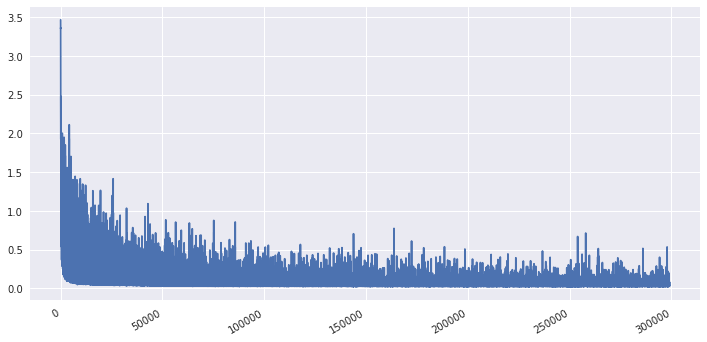

In [23]:
df=pd.DataFrame(trainingloss)
df["loss"].plot(subplots=True,figsize=(12,6))

array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f1657fa6eb8>],
      dtype=object)

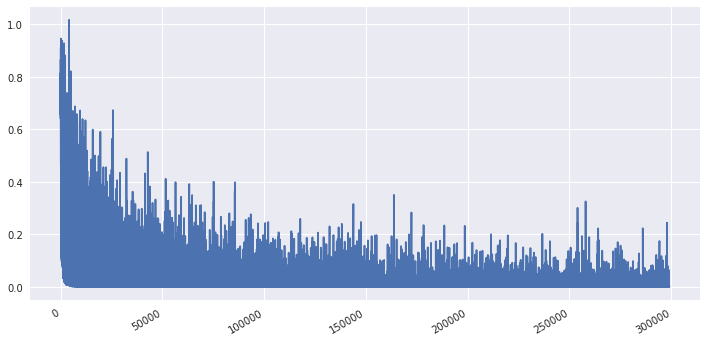

In [24]:
df=pd.DataFrame(trainingloss)
df["lossT"].plot(subplots=True,figsize=(12,6))

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f165c0d9da0>,
      dtype=object)

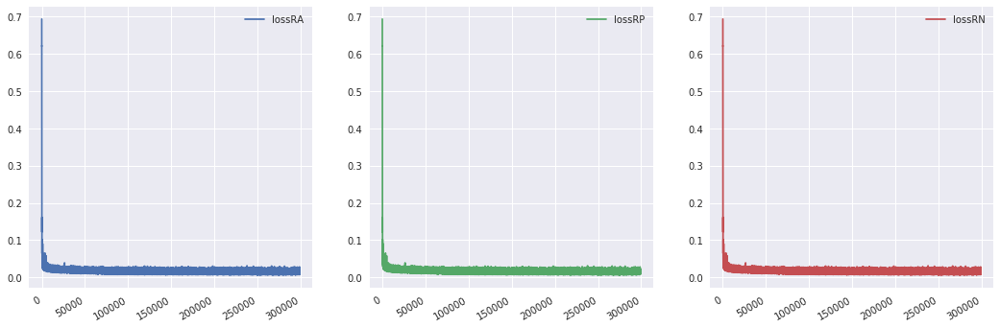

In [25]:
df=pd.DataFrame(trainingloss)
df[["lossRA","lossRP","lossRN"]].plot(subplots=True,figsize=(18,6),layout=(1,3))

## Save model

In [31]:
modelstatpath="EncoderStat.pt"

In [32]:
torch.save(modelEncoder.state_dict(),modelstatpath)

## Save DATA

In [34]:
dfTrain=pd.DataFrame(trainingloss)
dfTest=pd.DataFrame(testloss)

In [38]:
dfTrain.to_pickle("Trainloss.p")

In [ ]:
### PLOT

In [107]:
def opts(**kwords):
    opts={"markers":True,"xlabel":"epochs","title":"Total Loss-1","width":1200,"heigh":300,"xtickmax":100}
    for k in kwords:
        opts[k]=kwords[k]
    return opts


In [109]:
y=torch.randn(2)
win=vis.line(Y=[2],X=[4],win=win,update="append",opts=opts(win="Total-loss-2"))

In [142]:
win="test"
opts={"markers":True,"xlabel":"epochs","title":"test Loss","width":1200,"heigh":300}
y=torch.randn(3)
win=vis.line(y,X=[1,2,3],win=win,opts=opts,name="train-loss")

In [143]:
win="X"
opts={"markers":True,"xlabel":"epochs","title":"X Loss","width":1200,"heigh":300}
y=torch.randn(3)
win=vis.line(y,X=[1,2,3],win=win,opts=opts,name="train-loss")